##### libraries

In [1]:
# libraries
# base
from scipy.io import arff          # to read .arff format
import pandas as pd                # data manipulation
import numpy as np                 # linear algebra
import matplotlib.pyplot as plt    # plotting
import seaborn as sns              # plotting
from PIL import Image              # images handling

# support
import time                        # time measuring
import random                      # randomness
import pickle                      # object saving/loading

# math
from scipy.stats import spearmanr, wilcoxon  # spearman rho correlation coefficient and wilcoxon median equality test
from math import ceil              # ceil function

# warnings
from  warnings import simplefilter                             # warning handling
from sklearn.exceptions import ConvergenceWarning              # warning handling
from statsmodels.tools.sm_exceptions import ConvergenceWarning # warning handling

# Sklearn/xgboost - Machine Learning
from sklearn.ensemble import RandomForestClassifier                                           # Random Forest
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer              # scalers and power transform
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold                  # splitting, validation
from sklearn.metrics import roc_auc_score, average_precision_score, confusion_matrix          # metrics
from sklearn.metrics import precision_recall_curve, roc_curve                                 # metrics (curves)
from sklearn.decomposition import PCA                                                         # PCA
from xgboost.sklearn import XGBClassifier                                                     # sklearn API for XGB
import statsmodels.formula.api as smf                                                         # formula API for statsmodels


# tensorflow/keras - Deep Learning
import tensorflow as tf             # tensorflow background
from tensorflow import keras        # keras API for tensorflow
from keras import layers            # keras layers
from keras import models            # keras models
from keras import optimizers        # keras optimizers
from keras import activations       # keras activation functions
from keras import losses            # keras loss functions 
from keras import regularizers      # keras regularizers
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras import layers, models, optimizers, activations, losses, regularizers

Using TensorFlow backend.


##### notebook settings

In [2]:
# notebook settings
pd.set_option("display.max_columns", 70)
pd.set_option("display.max_rows", 70)
# ignoring some warnings
simplefilter("ignore", category=ConvergenceWarning) 
np.warnings.filterwarnings('ignore', '(overflow|invalid)')

random_state = 2021

##### preprocessing

 - loading, missing detection

In [3]:
def get_missing_info(data, y):
    '''
    function creates DataFrame of missing value counts and percentage, for a given data and positive, negative
    and positive percentage for a given target, arguments:
    data - dataset to get informations about (DataFrame)
    y - target value (string)
    
    returns - DataFrame object with informations
    '''
    
    # counting missing and calculating the percentage 
    missing_info = pd.DataFrame((data.isna().sum(), data.isna().sum()/data.shape[0]*100)).T
    missing_info.columns = ["missing_count", "missing_percentage"]
    
    # removing rows without missings
    missing_info = missing_info.where(missing_info > 0).dropna().sort_values(by = "missing_percentage", ascending = False)
    
    # target info inicjalization
    missing_info["non_{}_count".format(y)] = np.nan
    missing_info["{}_count".format(y)] = np.nan
    missing_info["{}_percentage".format(y)] = np.nan
    
    # target info colnames
    neg_count, pos_count, pos_per=missing_info.columns.tolist()[2:]
    
    # target info (counting) columns filling
    cols = missing_info.index.tolist()
    for i in cols:
        missing_info.loc[i, pos_count] = data[y].where(data[i].isna()).dropna().sum()
        missing_info.loc[i, neg_count] = data[y].where(
            data[i].isna()).dropna().shape[0]-missing_info.loc[i, pos_count]
    
    # target info (percentage) column filling
    missing_info[pos_per] = np.round(
        missing_info[pos_count]/(missing_info[neg_count]+missing_info[pos_count])*100, 2)
    
    
    return missing_info

In [4]:
# data loading
data = arff.loadarff(r"data\3year.arff")
data = pd.DataFrame(data[0])

# decoding target variable
data.rename({'class':'bankrupt'}, axis = 1, inplace = True)
data['bankrupt'].replace(b'1', 1, True)
data['bankrupt'].replace(b'0', 0, inplace=True)

In [5]:
get_missing_info(data, "bankrupt")

,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr37,4736.0,45.091879,4511.0,225.0,4.75
Attr21,807.0,7.683519,667.0,140.0,17.35
Attr27,715.0,6.807579,548.0,167.0,23.36
Attr60,592.0,5.636485,550.0,42.0,7.09
Attr45,591.0,5.626964,549.0,42.0,7.11
Attr54,228.0,2.170808,214.0,14.0,6.14
Attr53,228.0,2.170808,214.0,14.0,6.14
Attr28,228.0,2.170808,214.0,14.0,6.14
Attr64,228.0,2.170808,214.0,14.0,6.14
Attr24,227.0,2.161287,227.0,0.0,0.00


Columns to drop because of:
1. Too many missings:
 - Attr37,
 - Attr21,
 - Attr27,
 - Attr60,
 - Attr45.

In [6]:
# column dropping
data.drop(labels = ["Attr37", "Attr21", "Attr27", "Attr60", "Attr45"], axis = 1, inplace = True)

 - functions for data imputation

In [7]:
def ProximityMatrix(RF, X, normalize = True):    
    '''
    function computes the proximity matrix for given (trained) random forest and data, arguments:
    RF - trained Random Forst classifier,
    X - data to apply RF,
    normalize - boolean, if true then proximity_matrix = proximity_matrix/num_of_Trees
    
    returns proximity matrix (np.arraty)
    -----
    note: this function is based on stackoverflow topic:
        https://stackoverflow.com/questions/18703136/proximity-matrix-in-sklearn-ensemble-randomforestclassifier
        
    '''
    
    # leaves indices for each x in X
    leaves = RF.apply(X)
    # number of trees
    nTrees = leaves.shape[1]
    # inicjalization (first iteration) proximity matrix
    proximity_matrix = np.equal.outer(leaves[:,0], leaves[:,0]).astype('float')
        # outer applies a function, here equal for each pair in the arguments (leaves[:,0] with itself) ->
        # we get proximities for the first column (first Tree), proximity_matrix[i,j] = 1 <=> i == j,
        # where i, j are indices of leaves for each sample
        # note: proximity_matrix is not the product of the Attr's, its a product of the Trees and the indices of its nodes

    # iteration through the rest of the trees
    for i in range(1, nTrees):
        proximity_matrix += np.equal.outer(leaves[:,i], leaves[:,i]).astype('float')
            
    proximity_matrix = (proximity_matrix/nTrees) if normalize == True else proximity_matrix

    return proximity_matrix    

def RFimputation(dta, n_iter, target, *args, **kwargs):
    '''
    Random Forest proximity based data imputer for a continuous features. Missing are inicialized with median of the 
    feature, after that random forest classifier is trained then based on node ID for particular observation simillarity 
    is determined and proximity matrix is computed and rescaled. 1-proximity is distance. Proximity is a weight in weighted
    average formula for a missing item. The process is repeated normally 5-7 times. Arguments:
    dta - dataset with continuous features with missings,
    n_iter - number of algorithm iterations
    target - target variable
    
    return imputed dataset, missing indices, history of process, missings changes during training 
    '''
    import time
    pd.set_option('mode.chained_assignment', None)
    
    start = time.time()
    # data copy to operate
    df = dta.copy()
    
    # features list
    features = [i for i in df.columns.tolist() if i != target]
    
    # Attr's missings indices inicialization
    # key - attr, value - indices
    attrs_indices = {}

    # Attr's updated values 
    # key - attr, value - imputed values
    attrs_values = {}

    # getting missings indices for each attr and set it to the median 
    for attr in features:
        # indices of missing data for each attribute
        indices = df[attr][df[attr].isna()].index.tolist()
        # median
        median = df[attr].median(skipna=True, axis=0)
        # imputation
        df.loc[indices, attr] = median
        # updating Attr's missings indices dictionary
        attrs_indices[attr] = indices
        # updating Attr's missings updated values dictionary
        attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()


    # ********* IMPUTATION LOOP *************** #
    # history inicialization
    history = {}
    # history is a dictionary keys = iteration, keys = dictionary of attrs:lists of missings
    history["iteration_0"] = attrs_values.copy()

    for i in range(n_iter):
        # build and train a classifier (RF)
        clf = RandomForestClassifier(*args, **kwargs) 
        clf.fit(df[features], df[target])

        # compute proximity matrix
        pm = ProximityMatrix(clf, df[features], True)

        # compute weight matrix (each row divided by its sum)
        pm_div = pm/pm.sum(axis = 1, keepdims = True)

        # reset missing values (= 0) (after that, weighted average excludes missing indices, is just a dot product)
        for attr in features:
            df[attr][attrs_indices[attr]] = 0

        # computing imputation matrix - weighted average formula (shape: (n_observations, n_features))
        imputation_matrix = np.dot(pm_div, df.values)

        # data imputation
        for attr in features:
            # attr index in df 
            attr_index = features.index(attr)
            # imputing data (weighted average based on proximity matrix)
            df[attr][attrs_indices[attr]] = imputation_matrix[attrs_indices[attr], attr_index]
            # updating Attr's missings updated values dictionary
            attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()
        
        # history update
        history["iteration_{}".format(i+1)] = attrs_values.copy()
    
    # ********* historical changes *************** #
    iterations = list(history.keys())
    # history changes dictionary inicialization
    # key: iteration, value: dictionary
    #                        key: attr, value: percentage change
    history_changes = history.copy()
    # keys for history_changes (excluding "zero" iteration)
    changes_keys = iterations[1:]

    for i in range(len(iterations)-1):
        # values for calculations (concrete iterations)
        itr_prev = iterations[i]
        itr = iterations[i+1]
        # list of the attr's
        attrs = list(history[itr].keys())
        for attr in attrs:
            # transform to array
            itr_prev_array = np.array(history[itr_prev][attr])
            itr_array = np.array(history[itr][attr])
            # change computation
            change = np.abs((itr_array - itr_prev_array) / itr_prev_array)
            # saving historical changes
            history_changes[itr][attr] = change
    
    # final shape of history_changes (excluding "zero" iteration)
    history_changes = {key: history_changes[key] for key in changes_keys}

    stop = time.time()
    print("Imputation time: {} seconds".format(round(stop - start), 2))
    return df, attrs_indices, history, history_changes

 - class for data standarization:
     - for CNN:
         $$0<int(x_{norm}=\frac{x-\mu}{\sigma}*100+128)<255$$
     - for other algorithms:
         $$x_{norm}=\frac{x-\mu}{\sigma}$$
 - integrated with:
     - outliers reduction with quantiles clipping,
     - Yeo-Johnson power transform, defined:
     $$\begin{cases}
    \frac{((y_i+1)^\lambda)-1)}{\lambda}         & \quad \text{if } \lambda \neq0, y\geq0\\
    \ln{(y_i+1)}                                 & \quad \text{if } \lambda=0, y\geq0\\
    \frac{-[(-y_i+1)^{2-\lambda}-1]}{2-\lambda}  & \quad \text{if } \lambda \neq2, y<0\\
    -\ln{(-y_i+1)}                               & \quad \text{if } \lambda=2, y<0
        \end{cases}$$

In [8]:
class scaler:
    
    def __init__(self, images=True):
        '''
        Class for normalizer-object which transforms vector of features to [0,255] vector of colour-scale, formula:

                                            0<int((x-mu)/sigma*100+128)<255

        where:
        x - feature vector,
        mu - mean(x),
        sigma - standard_deviation(x),
        int(.) - operation of rounding to integer.

        or for standarizing to zero mean and unit variance.
        
        arguments:
        images - boolean, when True [0,255] int standarization applied, when False zero mean and unit variance standarization applied.
        -------------
        note: scaler is integrated with quantile clipping.
        '''
        self.option=images
        self.mean=None
        self.std=None
        self.left_tail=None
        self.right_tail=None
        self.transformer=None
        
    def fit(self, X, q=None, power_transform=False):
        '''
        Function fits scaler to the data, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame),
        q - optional, quantile for clipping data before fit (float),
        power_transform - apply Yeo-Johnson power transformation (boolean).
        -------------
        note: quantile clipping is symmetric, when q=0.05 passed then function computes q_95 also for clipping left and
              right distribution tails. 
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        
        # quantile computations
        if q is not None:
            # saving quantiles in __init__
            self.left_tail=np.quantile(a=X, q=q, axis=0)
            self.right_tail=np.quantile(a=X, q=1-q, axis=0)
            # computing new X
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
                
        if power_transform==True:
            self.transformer=PowerTransformer(method='yeo-johnson', standardize=True)
            self.transformer.fit(X=X)
            X=self.transformer.transform(X=X)
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
        else:
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
    
    def transform(self, X):
        '''
        Function transforms data with fitted scaler, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame)
        
        return normalized data (numpy.array)
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        if X.shape[1]!=self.mean.shape[0]:
            raise error("X has {} columns while scaler was fitted on matrix with {} columns".format(X.shape[1], 
                                                                                              len(self.mean)))
        # quantile clipping if necessary
        try:
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
        except:
            pass 
        
        # normalization for images
        if self.option==True:
            try:
                # with power transform
                X=np.round(self.transformer.transform(X=X)*100+128)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=np.round((X[:,i]-self.mean[i])/self.std[i]*100+128)

            # [0,255] clipping
            X=X.clip(min=0, max=255)
        # normalization for float output
        else:
            try:
                # with power transform
                X=self.transformer.transform(X=X)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=(X[:,i]-self.mean[i])/self.std[i]
        
        return X

 - data splitting

In [9]:
# variables for target and features
target = "bankrupt"
features = [i for i in data.columns.tolist() if i != target]

In [10]:
# data splitting - train and test sets

X_train, X_test, Y_train, Y_test = train_test_split(data[features], data[target], stratify = data[target],
                                                 test_size = 0.1, random_state = random_state)
train_set = pd.concat((X_train, Y_train), axis=1)
train_set.reset_index(inplace=True, drop=True)
test_set = pd.concat((X_test, Y_test), axis=1)
test_set.reset_index(inplace=True, drop=True)

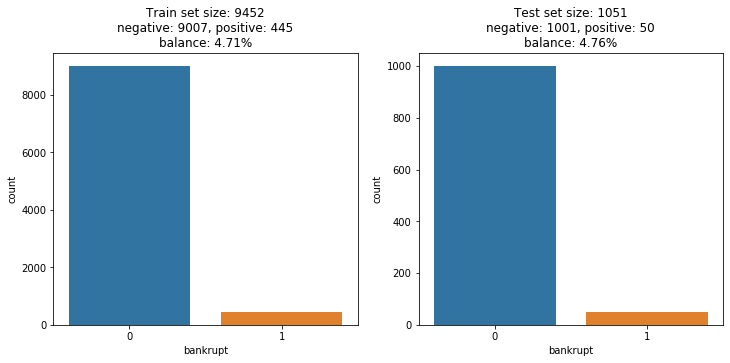

In [11]:
# sets balance vizualization

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (12,5))
sns.countplot(train_set[target], ax = ax[0])
sns.countplot(test_set[target], ax = ax[1])

ax[0].set_title("Train set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    train_set[target].shape[0], sum(train_set[target]==0), sum(train_set[target]==1),
    round(sum(train_set[target]==1)/train_set.shape[0]*100, 2)))
ax[1].set_title("Test set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    test_set[target].shape[0], sum(test_set[target]==0), sum(test_set[target]==1),
    round(sum(test_set[target]==1)/test_set.shape[0]*100, 2)))

plt.show()

##### Data imputation for train and test set

In [12]:
print("\t\t\t\tTRAIN SET MISSINGS")
get_missing_info(train_set, target)

				TRAIN SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr24,202.0,2.137114,202.0,0.0,0.00
Attr64,201.0,2.126534,188.0,13.0,6.47
Attr54,201.0,2.126534,188.0,13.0,6.47
Attr28,201.0,2.126534,188.0,13.0,6.47
Attr53,201.0,2.126534,188.0,13.0,6.47
Attr41,182.0,1.925518,182.0,0.0,0.00
Attr32,88.0,0.931020,86.0,2.0,2.27
Attr52,75.0,0.793483,75.0,0.0,0.00
Attr47,75.0,0.793483,75.0,0.0,0.00
Attr13,35.0,0.370292,33.0,2.0,5.71


In [13]:
print("\t\t\t\tTEST SET MISSINGS")
get_missing_info(test_set, target)

				TEST SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr64,27.0,2.568982,26.0,1.0,3.70
Attr54,27.0,2.568982,26.0,1.0,3.70
Attr28,27.0,2.568982,26.0,1.0,3.70
Attr53,27.0,2.568982,26.0,1.0,3.70
Attr24,25.0,2.378687,25.0,0.0,0.00
Attr41,20.0,1.902950,20.0,0.0,0.00
Attr32,13.0,1.236917,12.0,1.0,7.69
Attr47,11.0,1.046622,10.0,1.0,9.09
Attr52,11.0,1.046622,10.0,1.0,9.09
Attr13,8.0,0.761180,7.0,1.0,12.50


In [14]:
# Train set imputation
train_set_imp, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_set, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
test_set_imp, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(test_set, n_iter=10,
                                                                                     target=target, n_estimators=100,
                                                                                     n_jobs=-1, max_depth=8,
                                                                                     random_state=random_state)

train_test_imp_sets = dict(zip(["train_set_imp", "test_set_imp"], [train_set_imp, test_set_imp]))

# SAVING IMPUTED TRAIN AND TEST SET as dict
with open(r"data\3year_data\train_test_imp_sets_3year.p", "wb") as fp:
    pickle.dump(train_test_imp_sets, fp)

Imputation time: 418 seconds
Imputation time: 10 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


In [14]:
# LOADING IMPUTED TRAIN AND TEST SET
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

##### training distribution analysis

							 RAW DATA


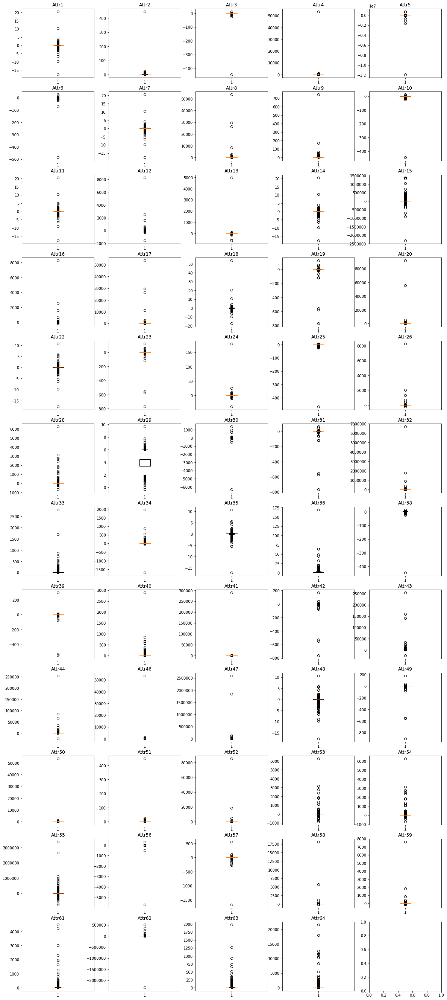

In [15]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t RAW DATA")
plt.show()

Lots of outliers, lets reduce them with quantiles

In [16]:
q=0.005
lb=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=q, axis=0)
ub=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=1-q, axis=0)

for i, feature in enumerate(features):
    train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature]=train_set_imp.loc[
        (train_set_imp[target]==0)|(train_set_imp[target]==1),feature].apply(
        lambda x: lb[i] if x<lb[i] else ub[i] if x>ub[i] else x)

							 Q_0.005 and Q_0.995 replaced


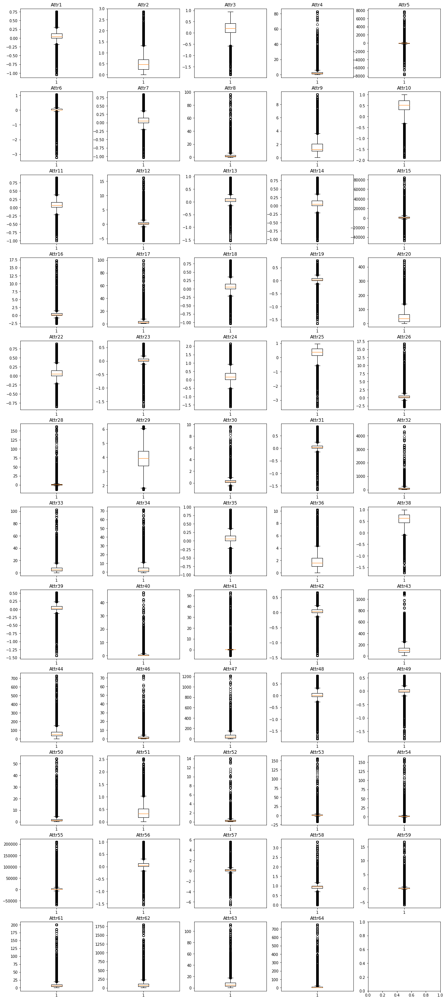

In [17]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

							 Q_0.005 and Q_0.995 replaced


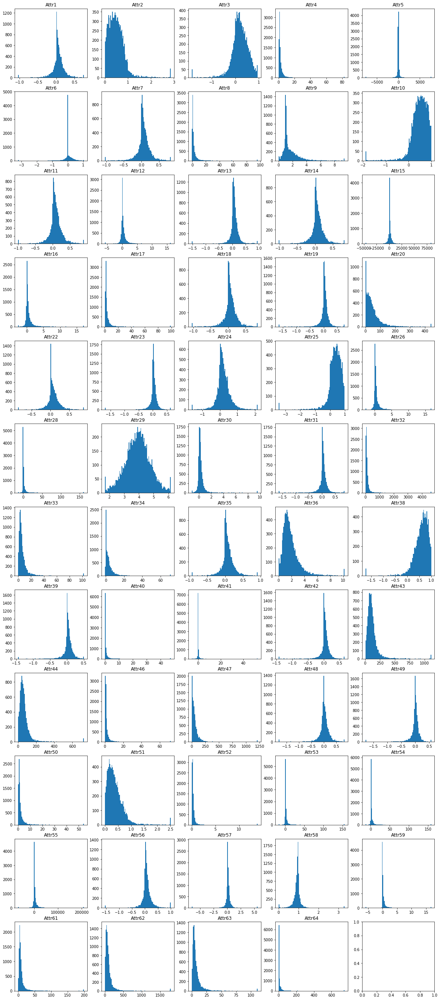

In [18]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

skewness is very big in this data, lets apply some power transforms.

In [19]:
transformer = PowerTransformer(method="yeo-johnson", standardize=False)
transformer.fit(X=train_set_imp[features])
train_set_imp_pt = pd.DataFrame(transformer.transform(X=train_set_imp[features]), columns=features)

				 Q_0.005 and Q_0.995 replaced, power transform applied


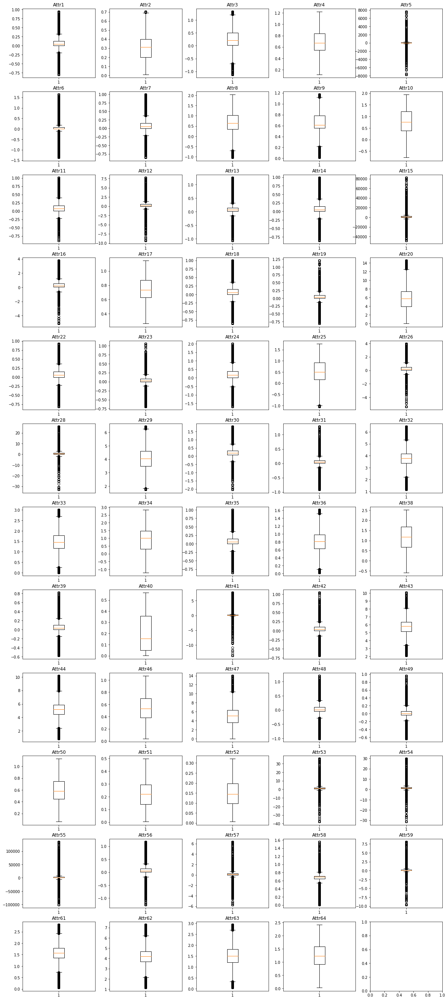

In [20]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

				 Q_0.005 and Q_0.995 replaced, power transform applied


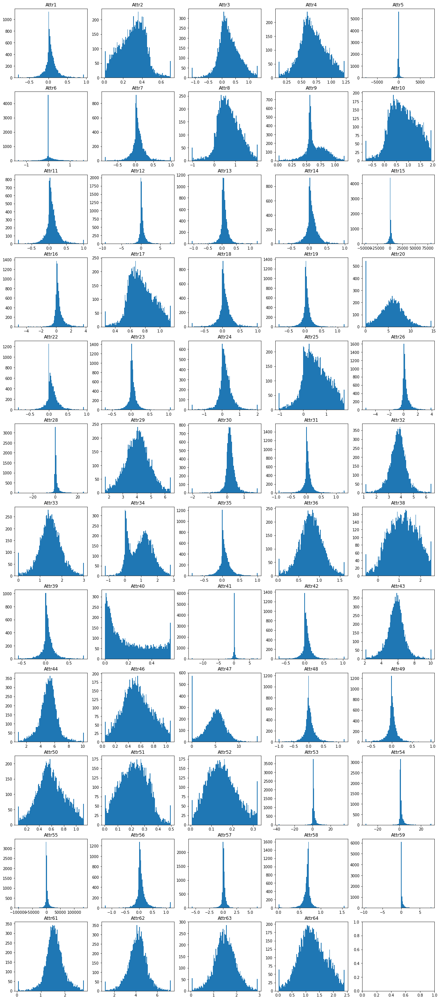

In [21]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

In [22]:
# print fitted lambdas
pd.Series(transformer.lambdas_, index=features, name="lambdas")

Attr1     1.696273
Attr2    -1.099004
Attr3     1.876245
Attr4    -0.793562
Attr5     0.999261
Attr6     2.068655
Attr7     1.495624
Attr8    -0.421037
Attr9    -0.685445
Attr10    2.619992
Attr11    1.308972
Attr12    0.616389
Attr13    1.710542
Attr14    1.495735
Attr15    0.997755
Attr16    0.169127
Attr17   -0.856921
Attr18    1.486655
Attr19    2.378122
Attr20    0.252240
Attr22    1.120769
Attr23    2.771319
Attr24    0.898269
Attr25    2.506728
Attr26    0.210194
Attr28    0.526014
Attr29    1.031030
Attr30   -0.246205
Attr31    2.126259
Attr32   -0.067534
Attr33   -0.201966
Attr34   -0.207582
Attr35    1.255516
Attr36   -0.362411
Attr38    3.184597
Attr39    3.049909
Attr40   -1.768708
Attr41    0.300338
Attr42    2.600999
Attr43    0.097042
Attr44    0.123285
Attr46   -0.917226
Attr47    0.173011
Attr48    2.055643
Attr49    3.010063
Attr50   -0.860229
Attr51   -1.806237
Attr52   -3.116213
Attr53    0.622916
Attr54    0.567258
Attr55    0.960677
Attr56    1.399476
Attr57    1.

After skewness and outliers reduction zero mean and unit variance standarization is necessary.

In [23]:
normalizer=StandardScaler()
normalizer.fit(X=train_set_imp_pt)
train_set_imp_pt_norm=pd.DataFrame(normalizer.transform(X=train_set_imp_pt), columns=features)

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


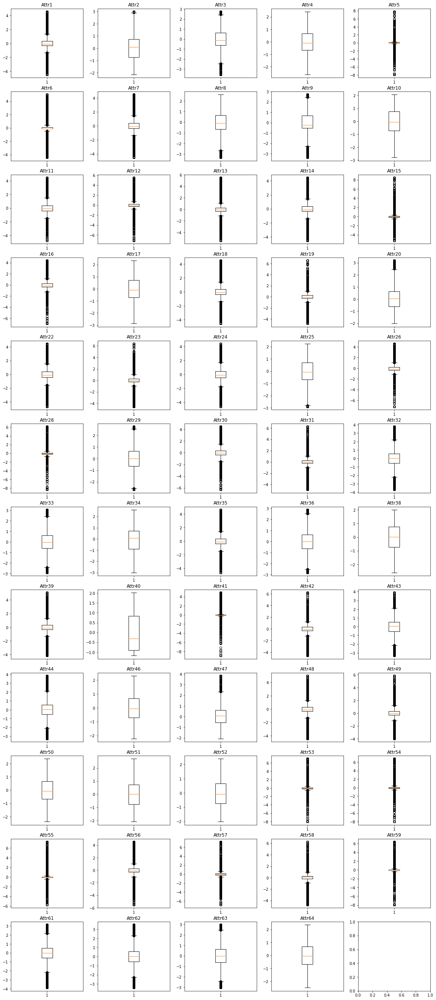

In [24]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


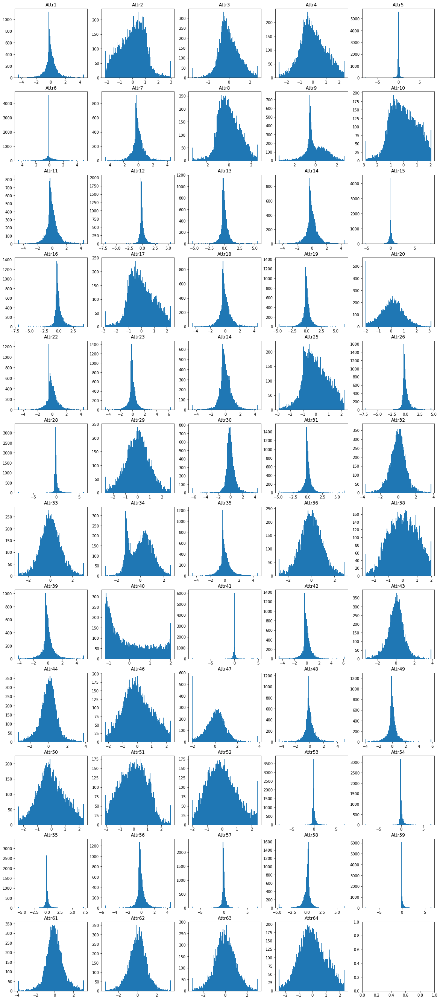

In [25]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

Distributions looks much better now, Gaussian-shape is not achived, however outliers and skewness are reduced. Attr 14 and Attr40 distributions looks problematic (two modes). Attr40 also is not looking great.

##### Modelling 
 - preparing folds for n-fold Cross Validation (with imputation, just for time saving - one fold imputation takes 120 seconds on average, it does not make sense to perform it during hyperparameters optimization especially with fixed random seed)

In [27]:
# sets inicialization
trains=[]
valids=[]

# Stratification object
kf = StratifiedKFold(6, shuffle=True, random_state=random_state)
for train, valid in kf.split(train_set, train_set[target]):
    # extracting sets
    train_data = train_set.loc[train,:].copy()
    valid_data = train_set.loc[valid,:].copy()
    # reset index
    train_data.reset_index(drop=True, inplace=True)
    valid_data.reset_index(drop=True, inplace=True)
    # imputation
    train_data, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    valid_data, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(valid_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    
    # saving
    trains.append(train_data)
    valids.append(valid_data)
    
sets = {"training_sets" : trains,
        "validation_sets" : valids}

#SAVING
with open(r"data\3year_data\sets.p", "wb") as fp:
    pickle.dump(sets, fp)

Imputation time: 335 seconds
Imputation time: 17 seconds
Imputation time: 331 seconds
Imputation time: 17 seconds
Imputation time: 334 seconds
Imputation time: 17 seconds
Imputation time: 330 seconds
Imputation time: 17 seconds
Imputation time: 338 seconds
Imputation time: 16 seconds
Imputation time: 342 seconds
Imputation time: 16 seconds


In [26]:
#LOADING
with open(r"data\3year_data\sets.p", "rb") as fp:
    sets = pickle.load(fp)

##### Logistic regression

In [27]:
def Logit_6FoldCrossValidation(datasets, features, target, random_state, normalize=False, q=None, alpha="none", info=0):
    '''
    function performes 6 fold Cross Validation for Logistic Regression, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    random_state - random seed,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    alpha - L1 norm regularization parameter, "none" for no regularization, (0,inf) for regularization
    info - folds' info
    
    returns Logit_history - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for Logistc Regression
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # Logistic Regression training
        formula = "{}~{}".format(target, "+".join(features))
        LogitRegression = smf.logit(formula, pd.concat((X_train, Y_train), axis=1))
        if alpha == "none":
            LogitRegression=LogitRegression.fit(method="powell", maxiter=1000, disp=info)
        else:
            LogitRegression=LogitRegression.fit_regularized(method="l1", alpha=alpha, disp=info)
        
        # metrics
        predsTrain = LogitRegression.predict(exog=X_train)
        predsValid = LogitRegression.predict(exog=X_valid)
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    Logit_history={"train_roc" : trainROCs,
                   "train_pr" : trainPRs,
                   "valid_roc" : validROCs,
                   "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))

    return Logit_history

In [37]:
# without normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=False, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\l


Cross validation time: 87s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 22s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 22s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.05 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 24s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 24s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 26s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 26s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 26s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


1 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 21s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


3 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 18s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 17s

alpha: none
train_roc 0.7602253108304019
train_pr 0.16799149510553626
valid_roc 0.7154309474118016
valid_pr 0.1225259932150284

alpha: 0.01
train_roc 0.7718355277373954
train_pr 0.18556567028186596
valid_roc 0.7342414517447496
valid_pr 0.14003490378404695

alpha: 0.03
train_roc 0.7714777132923215
train_pr 0.18466848618057727
valid_roc 0.7339626662469046
valid_pr 0.1398074082792814

alpha: 0.05, - failure

alpha: 0.08
train_roc 0.7703597619601116
train_pr 0.1824742754532425
valid_roc 0.7319565549407483
valid_pr 0.1372274349985944

alpha: 0.1
train_roc 0.7701976894067127
train_pr 0.18130774630285063
valid_roc 0.7319429954052056
valid_pr 0.1359903824759452

alpha: 0.3
train_roc 0.771799639479443
train_pr 0.18075699354226435
valid_roc 0.7332282192372092
valid_pr 0.13665280589382586

alpha: 0.5
train_roc 0.7754726930058643
train_pr 0.1809592899990005
valid_roc 0.7378386747884845
valid_pr 0.1407787910047767

alpha: 0.8
train_roc 0.7783196957947123
train_pr 0.1822

In [38]:
# with normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anacond


Cross validation time: 56s

Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 24s

Cross validation time: 27s

Cross validation time: 26s

Cross validation time: 26s

Cross validation time: 20s
0.8 fatal error

Cross validation time: 13s

Cross validation time: 11s

Cross validation time: 10s

Cross validation time: 9s

Cross validation time: 8s

alpha: none
train_roc 0.760787772554283
train_pr 0.16295016321295727
valid_roc 0.7159939963223348
valid_pr 0.12186808511155132

alpha: 0.01
train_roc 0.7593428789103168
train_pr 0.16766285048288776
valid_roc 0.71456333065044
valid_pr 0.12125729355757307

alpha: 0.03
train_roc 0.7551721086311174
train_pr 0.16170024594613225
valid_roc 0.7111848030611067
valid_pr 0.12018848165916048

alpha: 0.05
train_roc 0.7518641370998047
train_pr 0.1588450532503116
valid_roc 0.7063156435794163
valid_pr 0.11836608479208843

alpha: 0.08
train_roc 0.748147282872537
train_pr 0.15400112706665328
valid_roc 0.7021853614686533
valid_pr 0.

In [39]:
# with normalization and outlier reduction (q=0.005)
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))


Cross validation time: 24s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 22s

Cross validation time: 21s

Cross validation time: 17s

Cross validation time: 15s

Cross validation time: 14s

Cross validation time: 13s
2 fatal error

Cross validation time: 11s

Cross validation time: 11s

Cross validation time: 10s

alpha: none
train_roc 0.7811389954197409
train_pr 0.18312014624266207
valid_roc 0.7412196825803733
valid_pr 0.15009197252959863

alpha: 0.01
train_roc 0.7846764004193808
train_pr 0.1894074365913576
valid_roc 0.7424692422235739
valid_pr 0.15134141971531137

alpha: 0.03
train_roc 0.7846430024169448
train_pr 0.1893122952066806
valid_roc 0.7425831102954565
valid_pr 0.15146739765459624

alpha: 0.05
train_roc 0.7846273918623865
train_pr 0.18903355614206344
valid_roc 0.742538554388484
valid_pr 0.15131106500402144

alpha: 0.08
train_roc 0.7846033804615637
train_pr 0.18873185208187016
valid_roc 0.7426869449495999
valid_pr 

There is a little improvement

In [40]:
# with normalization and outlier reduction (q=0.005) and power transform
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize="power", q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 35s

Cross validation time: 28s

Cross validation time: 29s

Cross validation time: 30s

Cross validation time: 30s

Cross validation time: 29s

Cross validation time: 22s

Cross validation time: 20s

Cross validation time: 18s

Cross validation time: 18s

Cross validation time: 16s

Cross validation time: 15s

Cross validation time: 15s

Cross validation time: 14s

alpha: none
train_roc 0.7892921374355905
train_pr 0.28549269578511743
valid_roc 0.7618987030349894
valid_pr 0.25065322052303907

alpha: 0.01
train_roc 0.798001550122094
train_pr 0.2899121648068042
valid_roc 0.7701790967956933
valid_pr 0.2407888912146475

alpha: 0.03
train_roc 0.7977622166061069
train_pr 0.2899601539842338
valid_roc 0.7700991760409096
valid_pr 0.24110671792344618

alpha: 0.05
train_roc 0.7976358131689483
train_pr 0.29028102395946337
valid_roc 0.7699199080961749
valid_pr 0.24241568901657215

alpha: 0.08
train_roc 0.797440834062181
train_pr 0.2906387183060677
valid_roc 0.769721158611317

Very big improvement, form approx 0.14 (raw data) to 0.25 (quantile clipping, power transform, normalization), best model without regularization.

##### Random Forest, hyperparameters optimization
 - 6 fold Cross validation for Random Forest

In [28]:
def RF_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, saveModels=False, info=0,
                            *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Random Forest, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - fold's info,
    random_state - random seed
    *args and **kwargs - hyperparameters for Random Forest
    
    returns RFhistoriey - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    if saveModels:
        models = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # RF training
        RF = RandomForestClassifier(*args, **kwargs)
        RF.fit(X_train, Y_train)
        
        # metrics
        predsTrain = RF.predict_proba(X_train)[:,1]
        predsValid = RF.predict_proba(X_valid)[:,1]
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        # model saving
        if saveModels:
            models.append(RF)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    RFhistory={"train_roc" : trainROCs,
               "train_pr" : trainPRs,
               "valid_roc" : validROCs,
               "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        RFhistory["models"]=models
        return RFhistory
    return RFhistory

In [42]:
# attempt without normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=False, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 24s
valid ROC: 0.7849881464403784
valid PR: 0.1709576205302791
overfitting ROC: 0.2150118535596216
overfitting PR: 0.8290423794697209


In [43]:
# attempt with normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 24s
valid ROC: 0.7851991754793372
valid PR: 0.1767755685971367
overfitting ROC: 0.21480082452066285
overfitting PR: 0.8232244314028633


There is an improvement

In [44]:
# attempt with normalization and outlier reduction (0.005)
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 23s
valid ROC: 0.7849973572464815
valid PR: 0.17652764665632273
overfitting ROC: 0.21500264275351855
overfitting PR: 0.8234723533436773


a bit worse

In [45]:
# attempt with normalization, outlier reduction (0.005) and power transform
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize="power", q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 27s
valid ROC: 0.7845876727021234
valid PR: 0.17601240279072602
overfitting ROC: 0.21541232729787663
overfitting PR: 0.823987597209274


Same conclusion as for other horizons, preprocessing pipeline should be treated as hyperparameter. However the best results achived when normalization only applied. So, experimets will be performed with normalization.

In [46]:
depths = [i for i in range(2,22,2)]
RFhists = []
for depth in depths:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                     normalize=True, q=None, info=0, saveModels=False, max_depth=depth)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(depths, RFhists))

for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 5s

Cross validation time: 9s

Cross validation time: 12s

Cross validation time: 15s

Cross validation time: 19s

Cross validation time: 21s

Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 24s

depth: 2
valid ROC: 0.7515909970787765
valid PR: 0.13426570547683245
overfitting ROC: 0.030022186580691668
overfitting PR: 0.03891246613605698

depth: 4
valid ROC: 0.7716995119578994
valid PR: 0.15941086585052922
overfitting ROC: 0.08295585933334437
overfitting PR: 0.23703491885574335

depth: 6
valid ROC: 0.7850128606469875
valid PR: 0.18390235359124085
overfitting ROC: 0.14321295045096682
overfitting PR: 0.4992266669076315

depth: 8
valid ROC: 0.7902320342104782
valid PR: 0.18018745396008584
overfitting ROC: 0.18260660633914927
overfitting PR: 0.6963557452262107

depth: 10
valid ROC: 0.7932542132054796
valid PR: 0.1852857714440618
overfitting ROC: 0.20155430355832848
overfitting PR: 0.7761376562024758

depth: 1

6-16 should be ok, mean=11 and that value will be used for further sequentional checking.
 - number of trees (weak estimators in ensemble learning words)

In [29]:
nums_of_trees = [10, 25, 75, 100, 200, 400, 600, 800, 1000]
RFhists = []
for num_of_trees in nums_of_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                    normalize=True, q=None, saveModels=False, max_depth=11, n_estimators=num_of_trees)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(nums_of_trees, RFhists))


Cross validation time: 2s

Cross validation time: 5s

Cross validation time: 15s

Cross validation time: 21s

Cross validation time: 42s

Cross validation time: 80s

Cross validation time: 121s

Cross validation time: 161s

Cross validation time: 199s


In [30]:
for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


depth: 10
valid ROC: 0.7502034661001541
valid PR: 0.14520835659227863
overfitting ROC: 0.23317258623274206
overfitting PR: 0.7581169453319748

depth: 25
valid ROC: 0.7818450071378434
valid PR: 0.16871709811582666
overfitting ROC: 0.2128001146546048
overfitting PR: 0.7899114040623536

depth: 75
valid ROC: 0.7929685922554858
valid PR: 0.18051358721990596
overfitting ROC: 0.2052597115402004
overfitting PR: 0.8000017106246724

depth: 100
valid ROC: 0.7951444677728753
valid PR: 0.18055867059626493
overfitting ROC: 0.2035183800667335
overfitting PR: 0.8037113116348263

depth: 200
valid ROC: 0.7977850775394667
valid PR: 0.1925735112163142
overfitting ROC: 0.2009354739090211
overfitting PR: 0.7933176425211343

depth: 400
valid ROC: 0.8043358072674835
valid PR: 0.1945095035941147
overfitting ROC: 0.19451654616910996
overfitting PR: 0.7929133105902947

depth: 600
valid ROC: 0.8043812443209561
valid PR: 0.19318078877065678
overfitting ROC: 0.19459140185826174
overfitting PR: 0.7948589132366088



200 trees is enough for experiments.

 - max number of features

In [31]:
print('Rule of thumb\nsquare root of number of features : {}'.format((len(features))**(1/2)))

Rule of thumb
square root of number of features : 7.681145747868608


In [32]:
max_features = [i for i in range(1,len(features), 4)]
RFhists = []
for n in max_features:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=None, saveModels=False, max_depth=11, n_estimators=200,
                                     max_features=n)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(max_features, RFhists))

for key in RF_CV_history.keys():
    print("\nmax number of features:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 9s

Cross validation time: 31s

Cross validation time: 50s

Cross validation time: 73s

Cross validation time: 96s

Cross validation time: 118s

Cross validation time: 137s

Cross validation time: 155s

Cross validation time: 179s

Cross validation time: 204s

Cross validation time: 224s

Cross validation time: 244s

Cross validation time: 263s

Cross validation time: 291s

Cross validation time: 320s

max number of features: 1
valid ROC: 0.7693921106533738
valid PR: 0.1427967180352824
overfitting ROC: 0.2292266498800022
overfitting PR: 0.83948476989178

max number of features: 5
valid ROC: 0.7952890449031814
valid PR: 0.18446145965141258
overfitting ROC: 0.20364649228473308
overfitting PR: 0.8028696984065765

max number of features: 9
valid ROC: 0.807558595689469
valid PR: 0.20001480913429973
overfitting ROC: 0.19119749492047333
overfitting PR: 0.7855710562073571

max number of features: 13
valid ROC: 0.8114994866607684
valid PR: 0.21348188551941052
overfitting

Best results for $>37$
 - min sample split

In [33]:
min_sample_spilt = [2, 4, 6, 8, 10, 15, 20, 30]
RFhists = []
for min_split in min_sample_spilt:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=None, saveModels=False, max_depth=11, n_estimators=200,
                                     max_features=57, min_samples_split=min_split)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_spilt, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples to split:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 318s

Cross validation time: 313s

Cross validation time: 315s

Cross validation time: 312s

Cross validation time: 311s

Cross validation time: 311s

Cross validation time: 313s

Cross validation time: 316s

min samples to split: 2
valid ROC: 0.8184492737751506
valid PR: 0.24486156697438288
overfitting ROC: 0.17886934080617156
overfitting PR: 0.7294796170324649

min samples to split: 4
valid ROC: 0.8166640640530529
valid PR: 0.24221393201409316
overfitting ROC: 0.17993203199984398
overfitting PR: 0.7248841615877265

min samples to split: 6
valid ROC: 0.8154458884873406
valid PR: 0.2409313130856751
overfitting ROC: 0.18039704378467059
overfitting PR: 0.7171406861488385

min samples to split: 8
valid ROC: 0.8169427453349979
valid PR: 0.2408157460236395
overfitting ROC: 0.17784544796333313
overfitting PR: 0.7054701157069069

min samples to split: 10
valid ROC: 0.8156714338594416
valid PR: 0.23899945304211623
overfitting ROC: 0.1782104777242255
overfitting PR: 0.69

2-8 is a resonable range to try in random search, best results with 2. Higher parameter, less overfitting, but when it is too big it hurts performance.
 
 - min samples leaf, this parameter has to be lower than min_sample_split, thus while testing range 2-8 for min samples leaf, min_sample_split has to be at least 9. 

In [34]:
min_sample_leaf = [i for i in range(0,10,2) if i > 0]
RFhists = []
for min_leaf in min_sample_leaf:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=None, saveModels=False, max_depth=11, n_estimators=200,
                                     max_features=57, min_samples_split=9, min_samples_leaf=min_leaf)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_leaf, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples in leaf:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 311s

Cross validation time: 305s

Cross validation time: 300s

Cross validation time: 285s

min samples in leaf: 2
valid ROC: 0.8218641624305181
valid PR: 0.25736770039356865
overfitting ROC: 0.17171704845172764
overfitting PR: 0.6820104267517633

min samples in leaf: 4
valid ROC: 0.8252631010048969
valid PR: 0.2729336637745699
overfitting ROC: 0.16830978634936056
overfitting PR: 0.670021395446823

min samples in leaf: 6
valid ROC: 0.8255182784978278
valid PR: 0.28070322584974666
overfitting ROC: 0.1667745405778034
overfitting PR: 0.6442685947917659

min samples in leaf: 8
valid ROC: 0.8279565674136227
valid PR: 0.28545160473371967
overfitting ROC: 0.1620891219360493
overfitting PR: 0.6105397546241478


higher parameter, better results, lower overfitting, but maybe it is this specific case, in random search range 1-min sample split will be tried,<br>
To sum up:
 - max_depth $\in \{6,7,...,16\}$
 - n_estimators = 100 for random search, more can be tested after finding the best set of parameters,
 - max_features $>37$,
 - min_samples_split $\in \{2,3,...,8\}$,
 - min_samples_leaf $\in \{1,2,...,\text{min_samples_split}\}$
 
 
 - Random Search

In [35]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "max_features", "min_samples_split", "min_samples_leaf", 
                                "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])#

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(50):
    # its necessary to reset seeds in every iteration, because of RF_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(6, 16),
        "max_features" : random.randint(37, len(features)),
        "min_samples_split" : random.randint(2, 8),
    }
    # min_samples_leaf has to be lower than min_sample_split
    params["min_samples_leaf"] = random.randint(1, params["min_samples_split"])
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    RFhist = RF_6FoldCrossValidation(datasets=sets,
                                     features=features,
                                     target=target,
                                     random_state=random_state,
                                     normalize=norms[norm_mode],
                                     q=None,
                                     info=0,
                                     saveModels=False,
                                     max_depth=params["max_depth"],
                                     n_estimators=100,
                                     max_features=params["max_features"],
                                     min_samples_split=params["min_samples_split"],
                                     min_samples_leaf=params["min_samples_leaf"])
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["max_features"], params["min_samples_split"],
                        params["min_samples_leaf"], np.mean(RFhist["valid_roc"]),
                           np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]), np.mean(RFhist["valid_pr"]),
                           np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]), norm_mode]).reshape(1, -1), columns = rstls.columns.tolist()), ignore_index=True)
    
    
    # current iteration result
    print((rstls.iloc[k, :].to_dict()))
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\3year\RF_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 106s
{'max_depth': 12.0, 'max_features': 37.0, 'min_samples_split': 4.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.8151487455398653, 'overfittingROC': 0.18112671051686158, 'PRvalid': 0.2563432709014991, 'OverfittingPR': 0.7037485019489541, 'norm_mode': 3.0}
------------------------------

Cross validation time: 144s
{'max_depth': 10.0, 'max_features': 58.0, 'min_samples_split': 5.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8094016550662407, 'overfittingROC': 0.18040814309987074, 'PRvalid': 0.23898764047997456, 'OverfittingPR': 0.6923228189097708, 'norm_mode': 2.0}
------------------------------

Cross validation time: 94s
{'max_depth': 7.0, 'max_features': 53.0, 'min_samples_split': 3.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8090429730893635, 'overfittingROC': 0.14652495332316873, 'PRvalid': 0.2483457611607213, 'OverfittingPR': 0.5416202049246173, 'norm_mode': 1.0}
------------------------------

Cross validation time: 90s
{'max_depth': 8.0, 'max_features': 42.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
9,11.0,43.0,3.0,3.0,0.825195,0.169644,0.264971,0.689971,2.0
8,11.0,53.0,4.0,4.0,0.814812,0.179065,0.260244,0.685699,3.0
0,12.0,37.0,4.0,4.0,0.815149,0.181127,0.256343,0.703749,3.0
2,7.0,53.0,3.0,3.0,0.809043,0.146525,0.248346,0.541620,1.0
3,8.0,42.0,7.0,2.0,0.809708,0.159314,0.247883,0.591327,3.0



Cross validation time: 154s
{'max_depth': 12.0, 'max_features': 51.0, 'min_samples_split': 3.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8064876323951853, 'overfittingROC': 0.1921395375071704, 'PRvalid': 0.23852901626029024, 'OverfittingPR': 0.7453490133738337, 'norm_mode': 2.0}
------------------------------

Cross validation time: 144s
{'max_depth': 15.0, 'max_features': 43.0, 'min_samples_split': 8.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8116078953992472, 'overfittingROC': 0.18786048217038942, 'PRvalid': 0.24748264716208776, 'OverfittingPR': 0.7429541283415427, 'norm_mode': 2.0}
------------------------------

Cross validation time: 78s
{'max_depth': 7.0, 'max_features': 39.0, 'min_samples_split': 5.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8077389095561113, 'overfittingROC': 0.14646067998149948, 'PRvalid': 0.2449878391093373, 'OverfittingPR': 0.5421284760264049, 'norm_mode': 3.0}
------------------------------

Cross validation time: 136s
{'max_depth': 15.0, 'max_features': 44.0, 

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
13,15.0,44.0,6.0,6.0,0.818944,0.178740,0.270284,0.693466,3.0
9,11.0,43.0,3.0,3.0,0.825195,0.169644,0.264971,0.689971,2.0
8,11.0,53.0,4.0,4.0,0.814812,0.179065,0.260244,0.685699,3.0
18,16.0,48.0,4.0,4.0,0.812584,0.186863,0.258734,0.731317,3.0
0,12.0,37.0,4.0,4.0,0.815149,0.181127,0.256343,0.703749,3.0



Cross validation time: 94s
{'max_depth': 6.0, 'max_features': 59.0, 'min_samples_split': 3.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.7989315599985627, 'overfittingROC': 0.13452942901750464, 'PRvalid': 0.2381997515111466, 'OverfittingPR': 0.4700167085098981, 'norm_mode': 1.0}
------------------------------

Cross validation time: 163s
{'max_depth': 13.0, 'max_features': 53.0, 'min_samples_split': 3.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8169136244235268, 'overfittingROC': 0.18167118961914253, 'PRvalid': 0.261755960485258, 'OverfittingPR': 0.7202062319752556, 'norm_mode': 3.0}
------------------------------

Cross validation time: 171s
{'max_depth': 13.0, 'max_features': 56.0, 'min_samples_split': 2.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8107892307535377, 'overfittingROC': 0.18881380431214434, 'PRvalid': 0.23170443188743242, 'OverfittingPR': 0.7624350850921171, 'norm_mode': 2.0}
------------------------------

Cross validation time: 72s
{'max_depth': 6.0, 'max_features': 46.0, 'mi

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
24,15.0,58.0,7.0,5.0,0.815533,0.183034,0.274332,0.702508,1.0
13,15.0,44.0,6.0,6.0,0.818944,0.178740,0.270284,0.693466,3.0
9,11.0,43.0,3.0,3.0,0.825195,0.169644,0.264971,0.689971,2.0
21,13.0,53.0,3.0,3.0,0.816914,0.181671,0.261756,0.720206,3.0
8,11.0,53.0,4.0,4.0,0.814812,0.179065,0.260244,0.685699,3.0



Cross validation time: 115s
{'max_depth': 13.0, 'max_features': 37.0, 'min_samples_split': 3.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8174557951223883, 'overfittingROC': 0.18118354213694976, 'PRvalid': 0.2587873806505416, 'OverfittingPR': 0.7238008965618898, 'norm_mode': 3.0}
------------------------------

Cross validation time: 84s
{'max_depth': 8.0, 'max_features': 38.0, 'min_samples_split': 2.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8086320792929126, 'overfittingROC': 0.16233276231658456, 'PRvalid': 0.22390727113393236, 'OverfittingPR': 0.640941174831956, 'norm_mode': 3.0}
------------------------------

Cross validation time: 89s
{'max_depth': 8.0, 'max_features': 43.0, 'min_samples_split': 3.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8136304188648277, 'overfittingROC': 0.15735877433029133, 'PRvalid': 0.2528899064314247, 'OverfittingPR': 0.6009461209568002, 'norm_mode': 1.0}
------------------------------

Cross validation time: 95s
{'max_depth': 6.0, 'max_features': 55.0, 'min_

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
24,15.0,58.0,7.0,5.0,0.815533,0.183034,0.274332,0.702508,1.0
39,15.0,43.0,6.0,5.0,0.821975,0.176480,0.272515,0.703146,1.0
13,15.0,44.0,6.0,6.0,0.818944,0.178740,0.270284,0.693466,3.0
35,13.0,38.0,5.0,4.0,0.819265,0.178707,0.268071,0.705223,3.0
9,11.0,43.0,3.0,3.0,0.825195,0.169644,0.264971,0.689971,2.0



Cross validation time: 162s
{'max_depth': 16.0, 'max_features': 48.0, 'min_samples_split': 4.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8131683683815109, 'overfittingROC': 0.18660237961659032, 'PRvalid': 0.25349064385147635, 'OverfittingPR': 0.7421697355101262, 'norm_mode': 3.0}
------------------------------

Cross validation time: 179s
{'max_depth': 16.0, 'max_features': 52.0, 'min_samples_split': 2.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8026411896806556, 'overfittingROC': 0.19734873153002486, 'PRvalid': 0.22659896934166035, 'OverfittingPR': 0.7732287812322327, 'norm_mode': 1.0}
------------------------------

Cross validation time: 65s
{'max_depth': 6.0, 'max_features': 40.0, 'min_samples_split': 4.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.7997135990224996, 'overfittingROC': 0.13321849788680518, 'PRvalid': 0.226333860767055, 'OverfittingPR': 0.4787357527559738, 'norm_mode': 1.0}
------------------------------

Cross validation time: 61s
{'max_depth': 6.0, 'max_features': 38.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
49,13.0,54.0,8.0,6.0,0.817076,0.179180,0.274344,0.675865,2.0
24,15.0,58.0,7.0,5.0,0.815533,0.183034,0.274332,0.702508,1.0
39,15.0,43.0,6.0,5.0,0.821975,0.176480,0.272515,0.703146,1.0
44,13.0,40.0,8.0,6.0,0.820774,0.175377,0.270741,0.678052,2.0
13,15.0,44.0,6.0,6.0,0.818944,0.178740,0.270284,0.693466,3.0


Loop time: 5959.99 seconds


In [38]:
rstls.sort_values(by="PRvalid", ascending=False).head(5)

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
49,13.0,54.0,8.0,6.0,0.817076,0.179180,0.274344,0.675865,2.0
24,15.0,58.0,7.0,5.0,0.815533,0.183034,0.274332,0.702508,1.0
39,15.0,43.0,6.0,5.0,0.821975,0.176480,0.272515,0.703146,1.0
44,13.0,40.0,8.0,6.0,0.820774,0.175377,0.270741,0.678052,2.0
13,15.0,44.0,6.0,6.0,0.818944,0.178740,0.270284,0.693466,3.0
35,13.0,38.0,5.0,4.0,0.819265,0.178707,0.268071,0.705223,3.0
9,11.0,43.0,3.0,3.0,0.825195,0.169644,0.264971,0.689971,2.0
38,15.0,58.0,5.0,3.0,0.815802,0.183819,0.263857,0.729642,3.0
21,13.0,53.0,3.0,3.0,0.816914,0.181671,0.261756,0.720206,3.0
8,11.0,53.0,4.0,4.0,0.814812,0.179065,0.260244,0.685699,3.0


Lets try the best model with more trees (49 index)

In [39]:
n_trees = [100, 200, 300, 400]
RFhists = []
for n in n_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=False, q=None, saveModels=False, max_depth=13, n_estimators=n,
                                     max_features=54, min_samples_split=8, min_samples_leaf=6)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(n_trees, RFhists))

for key in RF_CV_history.keys():
    print("\nn trees:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 149s

Cross validation time: 300s

Cross validation time: 460s

Cross validation time: 610s

n trees: 100
valid ROC: 0.8170755817130008
valid PR: 0.27434433943006237
overfitting ROC: 0.1791801847820489
overfitting PR: 0.6758647314473629

n trees: 200
valid ROC: 0.8286821615996307
valid PR: 0.28393844643928223
overfitting ROC: 0.16789165767260628
overfitting PR: 0.669405331473376

n trees: 300
valid ROC: 0.8263110692553205
valid PR: 0.283413251663137
overfitting ROC: 0.17053282714149676
overfitting PR: 0.6728854149676462

n trees: 400
valid ROC: 0.8263998453246367
valid PR: 0.28211732333095374
overfitting ROC: 0.1704387368129736
overfitting PR: 0.6740916050040028


To sum up, best random forest:
 - max depth: 13,
 - max_features: 54,
 - min_samples_split: 8,
 - min_samples_leaf: 6,
 - n_estimators: 200,
 - with raw data.
##### Extreme Gradient Boosting (XGB)
 - training functions

In [29]:
def XGB_training(X_train, Y_train, X_valid=None, Y_valid=None, early_stopping_rounds=1,
                 booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                 subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                 gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1,
                 random_state=random_state, info=0):
    
    '''
    function runs Extreme Gradniet Boosting algorithm, arguments:
    X_train, Y_train, X_valid, Y_valid - (pandas.DataFrame()), training/validation sets,
    early_stopping_rounds - number of iterations over which the metric needs to be improved to continue training,
    booster - training algorithm to boost, gbtree are decision trees,
    tree_method - tree construction algorithm, dependend from dataset size,
    n_estimators - number of base learners (decision trees),
    max_depth - maximum depth of decision tree,
    learning_rate - learning rate (aka eta),
    subsample - (0,1] ratio of sample to perform training,
    colsample_bytree - (0,1] ratio of features to perform training by single tree,
    colsamlpe_bylevel - (0,1] ratio of features to perform trainin by tree level,
    gamma - minimal loss function reduction to perform split, regularization effect,
    min_child_weight - minimal sum by subtree,
    reg_alpha - [0,inf) L1 norm regularization parameter,
    reg_lambda - [0,inf) L2 norm regularization parameter,
    random_state - random seed,
    info - {0,1,2,3} additional info,
    
    returns XGBmodel, XGB_history  
    '''
    
    
    # library
    from xgboost.sklearn import XGBClassifier
    
    # model definition
    XGBmodel = XGBClassifier(booster=booster, tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                             learning_rate=learning_rate, subsample=subsample, colsample_bytree=colsample_bytree,
                             colsample_bylevel=colsample_bylevel, gamma=gamma, min_child_weight=min_child_weight,
                             reg_alpha=reg_alpha, reg_lambda=reg_lambda, random_state=random_state,
                             use_label_encoder=False) 
    
    # model training
    if X_valid is not None and Y_valid is not None:
        # training with validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train), (X_valid,Y_valid)), 
                     eval_metric=["logloss", "auc", "aucpr"], early_stopping_rounds = early_stopping_rounds,
                     verbose=info)
        
        # history with validation set
        XGB_results={}
        i=0
        for key in XGBmodel.evals_result().keys():
            i+=1
            for metric in XGBmodel.evals_result()[key].keys():
                if i==1:
                    XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
                else:
                    XGB_results["valid_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
        XGB_results["early_stopping"]=XGBmodel.best_iteration
    
    else:
        # training without validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train),(X_train, Y_train)), 
                     eval_metric=["logloss", "auc", "aucpr"], verbose=info)
        
        # history without validation set
        XGB_results={}
        for metric in XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]].keys():
            XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]][metric]
    
    return XGBmodel, XGB_results

def plot_XGB_training(history):
    '''
    function plots XGB training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from XGB_training() function.
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_logloss"]
    validLoss = history["valid_logloss"]
    trainROC = history["train_auc"]
    validROC = history["valid_auc"]
    trainPR = history["train_aucpr"]
    validPR = history["valid_aucpr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

##### XGB, hyperparameters optimization
- XGB 6 fold Cross Validation function

In [30]:
def XGB_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, early_stopping_rounds=1,
                             booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                             subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                             gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1, info=0, saveModels=False):
    '''
    function performes 6 fold Cross Validation for Extreme Gradient Boosting, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    random_state - random seed,
    rest of the arguments the same as for XGB_train() function
    
    returns XGBhistories - list of every XGB model history 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    XGBhistories=[]
    if saveModels:
        models=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2 or info==3:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # XGB training
        modelXGB, historyXGB = XGB_training(X_train=X_train,Y_train=Y_train, X_valid=X_valid, Y_valid=Y_valid,
                                            early_stopping_rounds=early_stopping_rounds, booster=booster, 
                                            tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                                            learning_rate=learning_rate, subsample=subsample, 
                                            colsample_bytree=colsample_bytree, colsample_bylevel=colsample_bylevel,
                                            gamma=gamma, min_child_weight=min_child_weight, reg_alpha=reg_alpha,
                                            reg_lambda=reg_lambda, random_state=random_state, info=info)

        # XGB history saving
        XGBhistories.append(historyXGB.copy())
        if saveModels:
            models.append(modelXGB)

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        return XGBhistories, models
    else:
        return XGBhistories

In [31]:
def XGB_CV_results(XGB_history, mean=True):
    '''
    helper function for Random Search in XGB, calculates metrics mean by fold and median of early stopping, for 
    given XGB model CV history, arguments:
    XGB_history - XGB model CV history, output of the XGB_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, median of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(XGB_history)):
        es=XGB_history[fold]["early_stopping"]
        train_auc.append(XGB_history[fold]["train_auc"][es])
        train_aucpr.append(XGB_history[fold]["train_aucpr"][es])
        valid_auc.append(XGB_history[fold]["valid_auc"][es])
        valid_aucpr.append(XGB_history[fold]["valid_aucpr"][es])
        early_stoppings.append(es)
    
    if mean == True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), np.median(early_stoppings)
    else:
        return valid_auc, valid_aucpr, train_auc, train_aucpr, early_stoppings

In [43]:
# without normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=False)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 37s
ROC: 0.8573163333333333
PR: 0.3428966666666667
overfitting ROC: 0.14181833333333327
overfitting PR: 0.648725
early stopping: 207.0


In [44]:
# with normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 35s
ROC: 0.8558880000000001
PR: 0.3420373333333333
overfitting ROC: 0.1428759999999999
overfitting PR: 0.6465398333333335
early stopping: 205.0


In [45]:
# with normalization and outliers reduction (Q_0.005 and Q_0.995)
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 33s
ROC: 0.8518046666666668
PR: 0.3433665000000001
overfitting ROC: 0.1418166666666666
overfitting PR: 0.6272596666666665
early stopping: 198.5


In [46]:
# with normalization, outliers reduction (Q_0.005 and Q_0.995) and power transform
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize="power")

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 36s
ROC: 0.8459401666666667
PR: 0.3415243333333333
overfitting ROC: 0.1388153333333333
overfitting PR: 0.5988575
early stopping: 180.0


The best results for normalization with quantile clipping, but power transform causes the lowest overfitting. Conculsion: preprocessing pipeline should be treated as hyperparameter. Experiments on normalization with quantile clipping

 - max depth

In [47]:
depths = [i for i in range(2,22,2)]
XGBhists = []
for depth in depths:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, max_depth=depth, n_estimators=1000,
                                       early_stopping_rounds=50)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(depths, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nmax depth:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 27s

Cross validation time: 29s

Cross validation time: 35s

Cross validation time: 37s

Cross validation time: 39s

Cross validation time: 32s

Cross validation time: 28s

Cross validation time: 46s

Cross validation time: 56s

Cross validation time: 30s

max depth: 2
ROC: 0.8222441666666667
PR: 0.303305
overfitting ROC: 0.08816866666666667
overfitting PR: 0.231203
early stopping: 466.5

max depth: 4
ROC: 0.8371388333333334
PR: 0.35130716666666667
overfitting ROC: 0.10894199999999987
overfitting PR: 0.4108321666666666
early stopping: 270.0

max depth: 6
ROC: 0.8562585
PR: 0.35590916666666667
overfitting ROC: 0.14126983333333332
overfitting PR: 0.6199951666666668
early stopping: 208.0

max depth: 8
ROC: 0.8496358333333333
PR: 0.33393083333333334
overfitting ROC: 0.1407453333333335
overfitting PR: 0.6326786666666666
early stopping: 193.5

max depth: 10
ROC: 0.845927
PR: 0.3118341666666667
overfitting ROC: 0.14645750000000002
overfitting PR: 0.6633158333333333
ear

4-6 makes sense in Random search, 7 will be used for further experiments.

 - learning rate $\eta$

In [48]:
etas = [0.001, 0.003, 0.01, 0.03, 0.1, 0.3]
XGBhists = []
for eta in etas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=4, learning_rate=eta)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(etas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\neta:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 8s

Cross validation time: 12s

Cross validation time: 25s

Cross validation time: 29s

Cross validation time: 13s

Cross validation time: 11s

eta: 0.001
ROC: 0.7507103333333335
PR: 0.21201066666666665
overfitting ROC: 0.04516366666666649
overfitting PR: 0.13719183333333337
early stopping: 17.5

eta: 0.003
ROC: 0.7656916666666667
PR: 0.21446716666666665
overfitting ROC: 0.049435666666666656
overfitting PR: 0.1629646666666667
early stopping: 40.0

eta: 0.01
ROC: 0.795461
PR: 0.27967783333333335
overfitting ROC: 0.07283116666666667
overfitting PR: 0.2379141666666666
early stopping: 126.0

eta: 0.03
ROC: 0.8371388333333334
PR: 0.35130716666666667
overfitting ROC: 0.10894199999999987
overfitting PR: 0.4108321666666666
early stopping: 270.0

eta: 0.1
ROC: 0.8482919999999999
PR: 0.3627639999999999
overfitting ROC: 0.13173633333333346
overfitting PR: 0.5010758333333332
early stopping: 107.0

eta: 0.3
ROC: 0.8467115000000001
PR: 0.34235533333333334
overfitting ROC: 0.1

Best $\eta \in [0.03,0.1]$ and this range will be searched in random search.
 - subsample

In [49]:
subsamples = np.arange(1,11)/10
XGBhists = []
for sub in subsamples:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=4, learning_rate=0.1, subsample=sub)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(subsamples, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nsubsample:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 8s

Cross validation time: 8s

Cross validation time: 10s

Cross validation time: 9s

Cross validation time: 11s

Cross validation time: 12s

Cross validation time: 14s

Cross validation time: 18s

Cross validation time: 25s

Cross validation time: 27s

subsample: 0.1
ROC: 0.7963576666666666
PR: 0.2350528333333333
overfitting ROC: 0.12352833333333335
overfitting PR: 0.3357338333333334
early stopping: 90.5

subsample: 0.2
ROC: 0.8138633333333334
PR: 0.26469000000000004
overfitting ROC: 0.13515449999999996
overfitting PR: 0.4327798333333333
early stopping: 89.5

subsample: 0.3
ROC: 0.8254846666666668
PR: 0.3025516666666666
overfitting ROC: 0.12957716666666652
overfitting PR: 0.4546505000000001
early stopping: 109.5

subsample: 0.4
ROC: 0.8224986666666667
PR: 0.32162949999999996
overfitting ROC: 0.12360883333333328
overfitting PR: 0.3997216666666666
early stopping: 56.5

subsample: 0.5
ROC: 0.840541
PR: 0.34331683333333335
overfitting ROC: 0.12409416666666673
overf

0.7-1 is worth considering,
 - colsample_bytree:

In [50]:
cols_bytree = np.arange(1,11)/10
XGBhists = []
for col in cols_bytree:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=4, learning_rate=0.1, subsample=1, colsample_bytree=col)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(cols_bytree, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ncolsample_bytree:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 8s

Cross validation time: 11s

Cross validation time: 10s

Cross validation time: 20s

Cross validation time: 14s

Cross validation time: 19s

Cross validation time: 26s

Cross validation time: 29s

Cross validation time: 26s

Cross validation time: 25s

colsample_bytree: 0.1
ROC: 0.8262650000000001
PR: 0.27313249999999994
overfitting ROC: 0.1492361666666665
overfitting PR: 0.6041168333333333
early stopping: 178.0

colsample_bytree: 0.2
ROC: 0.8445036666666668
PR: 0.3254765
overfitting ROC: 0.14601666666666657
overfitting PR: 0.6017398333333333
early stopping: 175.0

colsample_bytree: 0.3
ROC: 0.8469976666666666
PR: 0.34675900000000004
overfitting ROC: 0.133316
overfitting PR: 0.517061
early stopping: 100.0

colsample_bytree: 0.4
ROC: 0.8517266666666665
PR: 0.3548328333333333
overfitting ROC: 0.14144116666666673
overfitting PR: 0.5967256666666667
early stopping: 228.0

colsample_bytree: 0.5
ROC: 0.8438641666666666
PR: 0.3508336666666667
overfitting ROC: 0.13861

0.7-1 to test in random search,
 - $\gamma$

In [51]:
gammas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3, 5, 8, 11]
XGBhists = []
for gamma in gammas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=4, learning_rate=0.1, subsample=1, colsample_bytree=0.7, gamma=gamma)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(gammas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ngamma:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 25s

Cross validation time: 24s

Cross validation time: 24s

Cross validation time: 20s

Cross validation time: 21s

Cross validation time: 28s

Cross validation time: 31s

Cross validation time: 18s

Cross validation time: 17s

Cross validation time: 20s

Cross validation time: 14s

gamma: 0
ROC: 0.8557676666666666
PR: 0.3834443333333333
overfitting ROC: 0.13655650000000008
overfitting PR: 0.556652
early stopping: 172.0

gamma: 0.01
ROC: 0.8555796666666667
PR: 0.38382849999999996
overfitting ROC: 0.1367434999999999
overfitting PR: 0.5562463333333332
early stopping: 172.0

gamma: 0.03
ROC: 0.8570355
PR: 0.3823081666666666
overfitting ROC: 0.12943833333333332
overfitting PR: 0.5258763333333334
early stopping: 151.0

gamma: 0.1
ROC: 0.8546573333333333
PR: 0.3745615
overfitting ROC: 0.13256450000000009
overfitting PR: 0.5255811666666667
early stopping: 120.5

gamma: 0.3
ROC: 0.8553856666666667
PR: 0.37201599999999996
overfitting ROC: 0.13594266666666655
overfitting

 $\gamma \in [0,0.1]$
 - L1 norm regularization ($\alpha$)

In [52]:
alphas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for alpha in alphas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=4, learning_rate=0.1, subsample=1, colsample_bytree=0.7, gamma=0, 
                                       reg_alpha=alpha, reg_lambda=0)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(alphas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nalpha:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 26s

Cross validation time: 31s

Cross validation time: 31s

Cross validation time: 26s

Cross validation time: 26s

Cross validation time: 28s

Cross validation time: 21s

Cross validation time: 26s

alpha: 0
ROC: 0.8473091666666667
PR: 0.35150349999999997
overfitting ROC: 0.14542983333333326
overfitting PR: 0.6021488333333334
early stopping: 180.0

alpha: 0.01
ROC: 0.8523521666666666
PR: 0.3680293333333334
overfitting ROC: 0.13243266666666675
overfitting PR: 0.5648426666666666
early stopping: 258.5

alpha: 0.03
ROC: 0.8536581666666666
PR: 0.3703548333333333
overfitting ROC: 0.14505983333333328
overfitting PR: 0.6170965000000002
early stopping: 253.0

alpha: 0.1
ROC: 0.8510236666666665
PR: 0.3635385
overfitting ROC: 0.14581616666666686
overfitting PR: 0.6018049999999999
early stopping: 148.0

alpha: 0.3
ROC: 0.8569881666666667
PR: 0.38176249999999995
overfitting ROC: 0.1393496666666667
overfitting PR: 0.5832358333333334
early stopping: 147.0

alpha: 0.7
ROC: 0.

 0-3, $\Delta=0.1$
 - L2 regularization ($\lambda$)

In [53]:
lambdas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for lmbda in lambdas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=4, learning_rate=0.1, subsample=1, colsample_bytree=0.7, gamma=0, 
                                       reg_alpha=1, reg_lambda=lmbda)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(lambdas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nlambda:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 18s

Cross validation time: 20s

Cross validation time: 18s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 25s

lambda: 0
ROC: 0.8570384999999999
PR: 0.3789271666666667
overfitting ROC: 0.13627066666666676
overfitting PR: 0.5579693333333333
early stopping: 119.5

lambda: 0.01
ROC: 0.8604235
PR: 0.3845018333333334
overfitting ROC: 0.12962550000000006
overfitting PR: 0.5418464999999999
early stopping: 188.5

lambda: 0.03
ROC: 0.8492696666666667
PR: 0.3774145
overfitting ROC: 0.12191966666666654
overfitting PR: 0.47766866666666674
early stopping: 90.0

lambda: 0.1
ROC: 0.8555535
PR: 0.3790496666666667
overfitting ROC: 0.13568749999999996
overfitting PR: 0.5411503333333334
early stopping: 120.5

lambda: 0.3
ROC: 0.8456173333333332
PR: 0.3743988333333334
overfitting ROC: 0.12339050000000018
overfitting PR: 0.46990499999999996
early stopping: 121.5

lambda: 0.7
ROC: 0.857325500000

lets check the same range as for $\alpha$

Ranges to try in random search:
 - max depth $\in \{4,5,6\}$,
 - $\eta \in [0.03, 0.1]$,
 - subsample $\in [0.7, 1], \Delta=0.1$,
 - colsample by tree $\in [0.7,1], \Delta=0.1$,
 - $\gamma \in [0,0.1], \Delta=0.02$,
 - $\alpha \in [0,3], \Delta=0.1$,
 - $\lambda \in [0,3], \Delta=0.1$,
 - preprocessing method is also a hyperparameter, options: raw data, $\frac{x-\mu}{\sigma}$, $\frac{x-\mu}{\sigma}$ with outliers reduction, $\frac{x-\mu}{\sigma}$ with outliers reduction and power transform.

In [58]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "learning_rate", "subsample", "colsample_bytree",
                                "gamma", "reg_alpha", "reg_lambda", "early_stopping",
                               "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(200):
    # its necessary to reset seeds in every iteration, because of XGB_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(4, 6),
        "learning_rate" : random.randint(3,10)/100,
        "subsample" : random.randint(7, 10)/10,
        "colsample_bytree" : random.randint(7,10)/10,
        "gamma" : random.choice([0,0.02,0.04,0.06,0.08,0.1]),
        "reg_alpha" : random.randint(0,30)/10,
        "reg_lambda" : random.randint(0,30)/10
    }
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=params["max_depth"],
                                       learning_rate=params["learning_rate"],
                                       subsample=params["subsample"],
                                       colsample_bytree=params["colsample_bytree"],
                                       gamma=params["gamma"],
                                       reg_alpha=params["reg_alpha"],
                                       reg_lambda=params["reg_lambda"],
                                       normalize=norms[norm_mode],
                                       q=0.005)
    
    ROC, PR, oROC, oPR, ERST = XGB_CV_results(XGB_history=XGBhist)
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["learning_rate"],
                                                               params["subsample"], params["colsample_bytree"],
                                                               params["gamma"], params["reg_alpha"], params["reg_lambda"],
                                                               ERST, ROC, oROC, PR, oPR, norm_mode]
                                                             ).reshape(1, -1), columns = rstls.columns.tolist()
                                             ), ignore_index=True)
    
    # current iteration result
    print(np.round(rstls.iloc[k, :], 5).to_dict())
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\3year\XGB_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 29s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 0.08, 'reg_alpha': 2.9, 'reg_lambda': 1.8, 'early_stopping': 159.0, 'ROCvalid': 0.84805, 'overfittingROC': 0.13054, 'PRvalid': 0.35838, 'OverfittingPR': 0.5316, 'norm_mode': 1.0}
------------------------------

Cross validation time: 20s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 0.04, 'reg_alpha': 2.4, 'reg_lambda': 1.3, 'early_stopping': 104.0, 'ROCvalid': 0.84381, 'overfittingROC': 0.12872, 'PRvalid': 0.36401, 'OverfittingPR': 0.49348, 'norm_mode': 2.0}
------------------------------

Cross validation time: 21s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 0.02, 'reg_alpha': 1.4, 'reg_lambda': 2.3, 'early_stopping': 132.5, 'ROCvalid': 0.84562, 'overfittingROC': 0.12954, 'PRvalid': 0.35765, 'OverfittingPR': 0.51456, 'norm_mode': 1.0}
------------------------------

C

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
9,4.0,0.04,0.7,0.8,0.08,0.1,1.5,238.5,0.852053,0.127711,0.379344,0.488045,2.0
6,4.0,0.06,0.9,1.0,0.02,2.7,0.2,253.0,0.858724,0.131347,0.376003,0.543170,3.0
7,4.0,0.07,1.0,1.0,0.02,1.6,2.2,212.0,0.855530,0.134627,0.374357,0.541739,3.0
5,6.0,0.07,0.9,0.8,0.02,2.1,0.9,118.5,0.856178,0.135437,0.371867,0.579673,3.0
8,4.0,0.06,0.8,0.9,0.10,2.3,1.7,243.5,0.848377,0.116622,0.370361,0.453186,3.0



Cross validation time: 20s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 0.02, 'reg_alpha': 1.5, 'reg_lambda': 0.4, 'early_stopping': 89.5, 'ROCvalid': 0.85202, 'overfittingROC': 0.13896, 'PRvalid': 0.36749, 'OverfittingPR': 0.55719, 'norm_mode': 1.0}
------------------------------

Cross validation time: 30s
{'max_depth': 6.0, 'learning_rate': 0.1, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.1, 'reg_alpha': 0.9, 'reg_lambda': 2.7, 'early_stopping': 112.5, 'ROCvalid': 0.85987, 'overfittingROC': 0.13827, 'PRvalid': 0.37252, 'OverfittingPR': 0.6109, 'norm_mode': 1.0}
------------------------------

Cross validation time: 23s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 0.0, 'reg_alpha': 0.6, 'reg_lambda': 1.5, 'early_stopping': 91.0, 'ROCvalid': 0.85673, 'overfittingROC': 0.13781, 'PRvalid': 0.3742, 'OverfittingPR': 0.57848, 'norm_mode': 2.0}
------------------------------

Cross va

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
9,4.0,0.04,0.7,0.8,0.08,0.1,1.5,238.5,0.852053,0.127711,0.379344,0.488045,2.0
17,6.0,0.04,0.9,0.9,0.02,3.0,1.4,268.5,0.860761,0.132724,0.377592,0.577612,2.0
6,4.0,0.06,0.9,1.0,0.02,2.7,0.2,253.0,0.858724,0.131347,0.376003,0.543170,3.0
19,6.0,0.06,1.0,0.7,0.10,1.7,0.8,165.0,0.861485,0.134057,0.374401,0.592765,2.0
7,4.0,0.07,1.0,1.0,0.02,1.6,2.2,212.0,0.855530,0.134627,0.374357,0.541739,3.0



Cross validation time: 36s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 0.06, 'reg_alpha': 2.7, 'reg_lambda': 2.6, 'early_stopping': 192.5, 'ROCvalid': 0.86229, 'overfittingROC': 0.12951, 'PRvalid': 0.38635, 'OverfittingPR': 0.55009, 'norm_mode': 2.0}
------------------------------

Cross validation time: 32s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 0.02, 'reg_alpha': 1.5, 'reg_lambda': 2.9, 'early_stopping': 158.0, 'ROCvalid': 0.85698, 'overfittingROC': 0.13031, 'PRvalid': 0.37797, 'OverfittingPR': 0.55029, 'norm_mode': 3.0}
------------------------------

Cross validation time: 33s
{'max_depth': 4.0, 'learning_rate': 0.06, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.06, 'reg_alpha': 2.5, 'reg_lambda': 1.4, 'early_stopping': 241.0, 'ROCvalid': 0.85154, 'overfittingROC': 0.12193, 'PRvalid': 0.36636, 'OverfittingPR': 0.49036, 'norm_mode': 3.0}
------------------------------



,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
9,4.0,0.04,0.7,0.8,0.08,0.1,1.5,238.5,0.852053,0.127711,0.379344,0.488045,2.0
21,5.0,0.08,0.9,0.8,0.02,1.5,2.9,158.0,0.856976,0.130309,0.377974,0.550286,3.0
17,6.0,0.04,0.9,0.9,0.02,3.0,1.4,268.5,0.860761,0.132724,0.377592,0.577612,2.0



Cross validation time: 21s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 0.08, 'reg_alpha': 0.9, 'reg_lambda': 1.9, 'early_stopping': 130.5, 'ROCvalid': 0.84596, 'overfittingROC': 0.12587, 'PRvalid': 0.36805, 'OverfittingPR': 0.46962, 'norm_mode': 1.0}
------------------------------

Cross validation time: 42s
{'max_depth': 5.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 0.06, 'reg_alpha': 1.9, 'reg_lambda': 0.8, 'early_stopping': 212.0, 'ROCvalid': 0.86196, 'overfittingROC': 0.13221, 'PRvalid': 0.38448, 'OverfittingPR': 0.5702, 'norm_mode': 3.0}
------------------------------

Cross validation time: 35s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0.08, 'reg_alpha': 2.2, 'reg_lambda': 0.8, 'early_stopping': 267.0, 'ROCvalid': 0.85844, 'overfittingROC': 0.12971, 'PRvalid': 0.37796, 'OverfittingPR': 0.54371, 'norm_mode': 2.0}
------------------------------

C

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0
36,5.0,0.07,0.9,1.0,0.10,1.0,1.2,132.0,0.861178,0.134794,0.382716,0.580562,2.0



Cross validation time: 25s
{'max_depth': 5.0, 'learning_rate': 0.05, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 0.0, 'reg_alpha': 1.2, 'reg_lambda': 0.2, 'early_stopping': 145.0, 'ROCvalid': 0.85788, 'overfittingROC': 0.1349, 'PRvalid': 0.36664, 'OverfittingPR': 0.5774, 'norm_mode': 2.0}
------------------------------

Cross validation time: 44s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 0.04, 'reg_alpha': 1.5, 'reg_lambda': 1.4, 'early_stopping': 214.5, 'ROCvalid': 0.84977, 'overfittingROC': 0.13364, 'PRvalid': 0.36414, 'OverfittingPR': 0.56499, 'norm_mode': 1.0}
------------------------------

Cross validation time: 47s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 0.04, 'reg_alpha': 0.2, 'reg_lambda': 1.6, 'early_stopping': 238.5, 'ROCvalid': 0.8498, 'overfittingROC': 0.14336, 'PRvalid': 0.35779, 'OverfittingPR': 0.59542, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0



Cross validation time: 41s
{'max_depth': 6.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 0.02, 'reg_alpha': 1.7, 'reg_lambda': 0.0, 'early_stopping': 129.0, 'ROCvalid': 0.86113, 'overfittingROC': 0.13774, 'PRvalid': 0.37973, 'OverfittingPR': 0.60861, 'norm_mode': 3.0}
------------------------------

Cross validation time: 35s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0.0, 'reg_alpha': 0.3, 'reg_lambda': 1.9, 'early_stopping': 228.0, 'ROCvalid': 0.8579, 'overfittingROC': 0.1321, 'PRvalid': 0.37631, 'OverfittingPR': 0.55549, 'norm_mode': 2.0}
------------------------------

Cross validation time: 34s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 0.06, 'reg_alpha': 0.2, 'reg_lambda': 1.2, 'early_stopping': 90.0, 'ROCvalid': 0.85724, 'overfittingROC': 0.14125, 'PRvalid': 0.36851, 'OverfittingPR': 0.61414, 'norm_mode': 1.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0



Cross validation time: 45s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 0.0, 'reg_alpha': 2.7, 'reg_lambda': 1.2, 'early_stopping': 166.0, 'ROCvalid': 0.86216, 'overfittingROC': 0.1344, 'PRvalid': 0.38311, 'OverfittingPR': 0.58674, 'norm_mode': 3.0}
------------------------------

Cross validation time: 52s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 0.08, 'reg_alpha': 3.0, 'reg_lambda': 2.1, 'early_stopping': 292.0, 'ROCvalid': 0.85603, 'overfittingROC': 0.12454, 'PRvalid': 0.36994, 'OverfittingPR': 0.50328, 'norm_mode': 3.0}
------------------------------

Cross validation time: 21s
{'max_depth': 6.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 0.0, 'reg_alpha': 3.0, 'reg_lambda': 2.3, 'early_stopping': 104.0, 'ROCvalid': 0.85242, 'overfittingROC': 0.13766, 'PRvalid': 0.34861, 'OverfittingPR': 0.57873, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0



Cross validation time: 33s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 0.06, 'reg_alpha': 2.8, 'reg_lambda': 2.7, 'early_stopping': 136.5, 'ROCvalid': 0.85916, 'overfittingROC': 0.13084, 'PRvalid': 0.37974, 'OverfittingPR': 0.55014, 'norm_mode': 3.0}
------------------------------

Cross validation time: 30s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 0.1, 'reg_alpha': 2.2, 'reg_lambda': 3.0, 'early_stopping': 143.5, 'ROCvalid': 0.85929, 'overfittingROC': 0.13242, 'PRvalid': 0.37465, 'OverfittingPR': 0.56964, 'norm_mode': 2.0}
------------------------------

Cross validation time: 23s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 0.0, 'reg_alpha': 2.4, 'reg_lambda': 0.9, 'early_stopping': 115.5, 'ROCvalid': 0.85247, 'overfittingROC': 0.13649, 'PRvalid': 0.36701, 'OverfittingPR': 0.55418, 'norm_mode': 2.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0



Cross validation time: 44s
{'max_depth': 4.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 0.06, 'reg_alpha': 1.0, 'reg_lambda': 0.7, 'early_stopping': 346.0, 'ROCvalid': 0.84732, 'overfittingROC': 0.12413, 'PRvalid': 0.3703, 'OverfittingPR': 0.47357, 'norm_mode': 1.0}
------------------------------

Cross validation time: 34s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.06, 'reg_alpha': 2.2, 'reg_lambda': 1.2, 'early_stopping': 289.0, 'ROCvalid': 0.85241, 'overfittingROC': 0.12677, 'PRvalid': 0.36856, 'OverfittingPR': 0.49522, 'norm_mode': 3.0}
------------------------------

Cross validation time: 29s
{'max_depth': 4.0, 'learning_rate': 0.07, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0.0, 'reg_alpha': 1.7, 'reg_lambda': 0.9, 'early_stopping': 180.0, 'ROCvalid': 0.85565, 'overfittingROC': 0.12871, 'PRvalid': 0.37689, 'OverfittingPR': 0.51176, 'norm_mode': 3.0}
------------------------------

Cr

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0



Cross validation time: 31s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 0.02, 'reg_alpha': 1.0, 'reg_lambda': 1.1, 'early_stopping': 128.0, 'ROCvalid': 0.86243, 'overfittingROC': 0.13493, 'PRvalid': 0.37717, 'OverfittingPR': 0.5954, 'norm_mode': 2.0}
------------------------------

Cross validation time: 28s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 0.02, 'reg_alpha': 2.3, 'reg_lambda': 0.8, 'early_stopping': 110.0, 'ROCvalid': 0.85316, 'overfittingROC': 0.1401, 'PRvalid': 0.36025, 'OverfittingPR': 0.59138, 'norm_mode': 2.0}
------------------------------

Cross validation time: 36s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 0.0, 'reg_alpha': 0.9, 'reg_lambda': 0.6, 'early_stopping': 239.0, 'ROCvalid': 0.85696, 'overfittingROC': 0.13408, 'PRvalid': 0.36944, 'OverfittingPR': 0.55394, 'norm_mode': 2.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
26,4.0,0.10,1.0,0.8,0.10,1.0,1.0,220.0,0.865345,0.133378,0.384509,0.598612,2.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0



Cross validation time: 49s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 0.08, 'reg_alpha': 2.0, 'reg_lambda': 0.7, 'early_stopping': 255.5, 'ROCvalid': 0.85481, 'overfittingROC': 0.1309, 'PRvalid': 0.37638, 'OverfittingPR': 0.55584, 'norm_mode': 1.0}
------------------------------

Cross validation time: 33s
{'max_depth': 5.0, 'learning_rate': 0.06, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 0.1, 'reg_alpha': 1.4, 'reg_lambda': 0.2, 'early_stopping': 190.0, 'ROCvalid': 0.86544, 'overfittingROC': 0.13245, 'PRvalid': 0.37999, 'OverfittingPR': 0.59849, 'norm_mode': 2.0}
------------------------------

Cross validation time: 30s
{'max_depth': 4.0, 'learning_rate': 0.06, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 0.02, 'reg_alpha': 2.7, 'reg_lambda': 2.2, 'early_stopping': 237.0, 'ROCvalid': 0.85038, 'overfittingROC': 0.1212, 'PRvalid': 0.37209, 'OverfittingPR': 0.47052, 'norm_mode': 1.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
104,4.0,0.09,0.9,1.0,0.00,1.2,1.5,179.0,0.861001,0.128791,0.385539,0.536351,3.0



Cross validation time: 19s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 0.08, 'reg_alpha': 2.2, 'reg_lambda': 0.5, 'early_stopping': 101.5, 'ROCvalid': 0.84337, 'overfittingROC': 0.12496, 'PRvalid': 0.3737, 'OverfittingPR': 0.44735, 'norm_mode': 2.0}
------------------------------

Cross validation time: 32s
{'max_depth': 5.0, 'learning_rate': 0.05, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0.04, 'reg_alpha': 2.0, 'reg_lambda': 0.7, 'early_stopping': 224.0, 'ROCvalid': 0.86116, 'overfittingROC': 0.13308, 'PRvalid': 0.37571, 'OverfittingPR': 0.57724, 'norm_mode': 1.0}
------------------------------

Cross validation time: 37s
{'max_depth': 5.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.02, 'reg_alpha': 1.9, 'reg_lambda': 1.6, 'early_stopping': 260.5, 'ROCvalid': 0.85658, 'overfittingROC': 0.13317, 'PRvalid': 0.38073, 'OverfittingPR': 0.55264, 'norm_mode': 3.0}
------------------------------

Cr

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
104,4.0,0.09,0.9,1.0,0.00,1.2,1.5,179.0,0.861001,0.128791,0.385539,0.536351,3.0



Cross validation time: 30s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 0.06, 'reg_alpha': 2.8, 'reg_lambda': 0.9, 'early_stopping': 123.0, 'ROCvalid': 0.86129, 'overfittingROC': 0.13176, 'PRvalid': 0.38177, 'OverfittingPR': 0.55967, 'norm_mode': 3.0}
------------------------------

Cross validation time: 41s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.02, 'reg_alpha': 2.5, 'reg_lambda': 0.5, 'early_stopping': 256.5, 'ROCvalid': 0.8578, 'overfittingROC': 0.13584, 'PRvalid': 0.36788, 'OverfittingPR': 0.58359, 'norm_mode': 1.0}
------------------------------

Cross validation time: 28s
{'max_depth': 4.0, 'learning_rate': 0.06, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 0.08, 'reg_alpha': 2.5, 'reg_lambda': 1.5, 'early_stopping': 252.5, 'ROCvalid': 0.85717, 'overfittingROC': 0.1293, 'PRvalid': 0.36598, 'OverfittingPR': 0.53383, 'norm_mode': 2.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
104,4.0,0.09,0.9,1.0,0.00,1.2,1.5,179.0,0.861001,0.128791,0.385539,0.536351,3.0



Cross validation time: 20s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0.1, 'reg_alpha': 0.8, 'reg_lambda': 0.7, 'early_stopping': 85.0, 'ROCvalid': 0.85125, 'overfittingROC': 0.13766, 'PRvalid': 0.3663, 'OverfittingPR': 0.56166, 'norm_mode': 1.0}
------------------------------

Cross validation time: 36s
{'max_depth': 6.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 0.06, 'reg_alpha': 0.9, 'reg_lambda': 1.1, 'early_stopping': 138.0, 'ROCvalid': 0.86025, 'overfittingROC': 0.1387, 'PRvalid': 0.37473, 'OverfittingPR': 0.61403, 'norm_mode': 3.0}
------------------------------

Cross validation time: 21s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 0.08, 'reg_alpha': 1.2, 'reg_lambda': 0.1, 'early_stopping': 195.5, 'ROCvalid': 0.85187, 'overfittingROC': 0.12675, 'PRvalid': 0.37382, 'OverfittingPR': 0.53461, 'norm_mode': 2.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
104,4.0,0.09,0.9,1.0,0.00,1.2,1.5,179.0,0.861001,0.128791,0.385539,0.536351,3.0



Cross validation time: 38s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 0.02, 'reg_alpha': 1.9, 'reg_lambda': 2.3, 'early_stopping': 214.0, 'ROCvalid': 0.85097, 'overfittingROC': 0.12702, 'PRvalid': 0.36135, 'OverfittingPR': 0.48612, 'norm_mode': 3.0}
------------------------------

Cross validation time: 41s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.1, 'reg_alpha': 1.2, 'reg_lambda': 1.9, 'early_stopping': 222.0, 'ROCvalid': 0.85524, 'overfittingROC': 0.13045, 'PRvalid': 0.37141, 'OverfittingPR': 0.56851, 'norm_mode': 3.0}
------------------------------

Cross validation time: 34s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 0.02, 'reg_alpha': 0.2, 'reg_lambda': 1.7, 'early_stopping': 96.0, 'ROCvalid': 0.85479, 'overfittingROC': 0.14208, 'PRvalid': 0.35994, 'OverfittingPR': 0.61231, 'norm_mode': 3.0}
------------------------------

Cr

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0
104,4.0,0.09,0.9,1.0,0.00,1.2,1.5,179.0,0.861001,0.128791,0.385539,0.536351,3.0



Cross validation time: 35s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 0.08, 'reg_alpha': 2.5, 'reg_lambda': 1.8, 'early_stopping': 215.0, 'ROCvalid': 0.85534, 'overfittingROC': 0.13394, 'PRvalid': 0.36194, 'OverfittingPR': 0.5695, 'norm_mode': 2.0}
------------------------------

Cross validation time: 18s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 0.02, 'reg_alpha': 1.1, 'reg_lambda': 1.4, 'early_stopping': 102.5, 'ROCvalid': 0.85528, 'overfittingROC': 0.1288, 'PRvalid': 0.36708, 'OverfittingPR': 0.5162, 'norm_mode': 1.0}
------------------------------

Cross validation time: 46s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 0.08, 'reg_alpha': 1.8, 'reg_lambda': 2.5, 'early_stopping': 233.5, 'ROCvalid': 0.85043, 'overfittingROC': 0.12238, 'PRvalid': 0.36348, 'OverfittingPR': 0.49546, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
154,5.0,0.10,0.9,0.9,0.06,1.9,1.1,127.0,0.856870,0.136957,0.388411,0.566583,2.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0



Cross validation time: 47s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 0.08, 'reg_alpha': 1.1, 'reg_lambda': 2.9, 'early_stopping': 225.5, 'ROCvalid': 0.8576, 'overfittingROC': 0.13501, 'PRvalid': 0.36365, 'OverfittingPR': 0.5915, 'norm_mode': 3.0}
------------------------------

Cross validation time: 39s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 0.1, 'reg_alpha': 2.5, 'reg_lambda': 0.8, 'early_stopping': 272.5, 'ROCvalid': 0.85934, 'overfittingROC': 0.12898, 'PRvalid': 0.37034, 'OverfittingPR': 0.53501, 'norm_mode': 1.0}
------------------------------

Cross validation time: 37s
{'max_depth': 4.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 0.02, 'reg_alpha': 1.1, 'reg_lambda': 2.7, 'early_stopping': 217.0, 'ROCvalid': 0.85832, 'overfittingROC': 0.13611, 'PRvalid': 0.37458, 'OverfittingPR': 0.56842, 'norm_mode': 1.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
154,5.0,0.10,0.9,0.9,0.06,1.9,1.1,127.0,0.856870,0.136957,0.388411,0.566583,2.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0



Cross validation time: 51s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 0.02, 'reg_alpha': 0.7, 'reg_lambda': 3.0, 'early_stopping': 247.0, 'ROCvalid': 0.85702, 'overfittingROC': 0.13693, 'PRvalid': 0.36559, 'OverfittingPR': 0.59025, 'norm_mode': 2.0}
------------------------------

Cross validation time: 26s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 0.04, 'reg_alpha': 2.3, 'reg_lambda': 0.5, 'early_stopping': 176.0, 'ROCvalid': 0.84913, 'overfittingROC': 0.12518, 'PRvalid': 0.38144, 'OverfittingPR': 0.48392, 'norm_mode': 3.0}
------------------------------

Cross validation time: 27s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 0.1, 'reg_alpha': 2.2, 'reg_lambda': 0.3, 'early_stopping': 128.5, 'ROCvalid': 0.84745, 'overfittingROC': 0.13227, 'PRvalid': 0.35348, 'OverfittingPR': 0.54812, 'norm_mode': 3.0}
------------------------------

C

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
154,5.0,0.10,0.9,0.9,0.06,1.9,1.1,127.0,0.856870,0.136957,0.388411,0.566583,2.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0



Cross validation time: 36s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 0.0, 'reg_alpha': 0.8, 'reg_lambda': 2.5, 'early_stopping': 167.0, 'ROCvalid': 0.85825, 'overfittingROC': 0.13681, 'PRvalid': 0.37596, 'OverfittingPR': 0.58255, 'norm_mode': 2.0}
------------------------------

Cross validation time: 34s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 0.1, 'reg_alpha': 1.8, 'reg_lambda': 0.0, 'early_stopping': 104.5, 'ROCvalid': 0.86186, 'overfittingROC': 0.13684, 'PRvalid': 0.38162, 'OverfittingPR': 0.60411, 'norm_mode': 3.0}
------------------------------

Cross validation time: 35s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 0.06, 'reg_alpha': 0.5, 'reg_lambda': 3.0, 'early_stopping': 226.0, 'ROCvalid': 0.85658, 'overfittingROC': 0.13786, 'PRvalid': 0.37112, 'OverfittingPR': 0.57997, 'norm_mode': 2.0}
------------------------------

Cr

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
154,5.0,0.10,0.9,0.9,0.06,1.9,1.1,127.0,0.856870,0.136957,0.388411,0.566583,2.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0
20,5.0,0.07,1.0,0.9,0.06,2.7,2.6,192.5,0.862287,0.129506,0.386350,0.550089,2.0



Cross validation time: 41s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 0.06, 'reg_alpha': 2.1, 'reg_lambda': 2.4, 'early_stopping': 277.0, 'ROCvalid': 0.85222, 'overfittingROC': 0.12362, 'PRvalid': 0.36697, 'OverfittingPR': 0.48058, 'norm_mode': 3.0}
------------------------------

Cross validation time: 33s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 0.02, 'reg_alpha': 0.8, 'reg_lambda': 0.2, 'early_stopping': 250.5, 'ROCvalid': 0.8604, 'overfittingROC': 0.13087, 'PRvalid': 0.37757, 'OverfittingPR': 0.55259, 'norm_mode': 2.0}
------------------------------

Cross validation time: 41s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 0.02, 'reg_alpha': 0.6, 'reg_lambda': 0.1, 'early_stopping': 177.0, 'ROCvalid': 0.86225, 'overfittingROC': 0.1364, 'PRvalid': 0.38912, 'OverfittingPR': 0.5974, 'norm_mode': 1.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
47,5.0,0.07,1.0,0.9,0.08,1.0,0.0,209.0,0.863539,0.135503,0.390100,0.598174,1.0
192,5.0,0.08,0.9,1.0,0.02,0.6,0.1,177.0,0.862253,0.136402,0.389120,0.597403,1.0
154,5.0,0.10,0.9,0.9,0.06,1.9,1.1,127.0,0.856870,0.136957,0.388411,0.566583,2.0
105,6.0,0.09,1.0,1.0,0.04,2.2,1.6,103.0,0.862920,0.133853,0.388249,0.582872,1.0
33,4.0,0.08,0.8,0.8,0.00,0.5,0.7,230.0,0.863067,0.131710,0.387094,0.570378,2.0


Loop time: 6923.76 seconds


The best model hyperparameters are:

- max\_depth = 5,
- $\eta$ = 0.07,
- subsample = 1,
- colsample\_bytree = 0.9,
- $\gamma$ = 0.08,
- $\alpha$ = 1,
- $\lambda$ = 0,
- median of boosting rounds = 209,
- normalization with quantile outliers reduction (0.005) without power transformation.

##### Multilayer Percepton
- functions for neural network training

In [32]:
def network_training(network, X_train, Y_train, n_epochs, batch_size, random_state, X_val=None, Y_val=None, info=None):
    '''
    function trains given neural network, save training history (loss, ROC-AUC score, PR-AUC score) 
    and performs early stopping (PR-AUC, best weights, number of epoch), arguments: 
    network - keras model to train,
    X_train, Y_train - numpy.arrays with training data,
    X_valid, Y_valid - numpy.arrays with validation data,
    n_epochs - number of epochs (loops through entire data)
    batch_size - number of observations per one weights update,
    random_state - random seed,
    info - additional informations during training, 1 - info about samples structure and early stopping, 2 contains 1 and detailed info during training 
    
    returns trained keras model, history - dictionary (train_loss, valid_loss, train_roc, valid_roc, train_pr, valid_pr, best_weights, early_stopping)
    '''
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    # metrics history inicialization
    trainLoss = []
    trainROC = []
    trainPR = []
    if X_val is not None and Y_val is not None:
        validLoss = []
        validROC = []
        validPR = []
        # early stopping inicialization
        best_weights = None
        bestPR = 0
        bestEpoch = 0
        if info==1 or info==2:
            print("Train on {} samples, validate on {} samples".format(X_train.shape[0], X_val.shape[0]))
    elif info==1 or info==2:
        print("Train on {} samples".format(X_train.shape[0]))
    else:
        pass
        
    # training loop
    start=time.time()
    for epoch in range(n_epochs):
        if X_val is not None and Y_val is not None:
            # backprop
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, validation_data=(X_val, Y_val), verbose=0)
            
            # predictions
            predsValid = network.predict(X_val)
            
            # metrics computation
            rocValid = roc_auc_score(Y_val, predsValid)
            prValid = average_precision_score(Y_val, predsValid)
            
            # metrics saving
            validLoss.append(history.history["val_loss"][0])
            validROC.append(rocValid)
            validPR.append(prValid)
            
            # early stopping
            if prValid > bestPR:
                bestPR = prValid
                best_weights = network.get_weights()
                bestEpoch = epoch

        else:
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, verbose=0)
        
        # predictions
        predsTrain = network.predict(X_train)

        # metrics computation
        rocTrain = roc_auc_score(Y_train, predsTrain) 
        prTrain = average_precision_score(Y_train, predsTrain)

        # metrics saving
        trainLoss.append(history.history["loss"][0])
        trainROC.append(rocTrain)
        trainPR.append(prTrain)

        stop=time.time()
        if info==2 and X_val is not None and Y_val is not None:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}, validation loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch], validLoss[epoch]))
        elif info==2:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch]))
        else:
            pass
            
    if (info==1 or info==2) and X_val is not None and Y_val is not None:
        print("\nEarly stopping results:\nbest results in epoch: {}, \nbest valid PR: {}, \nvalid ROC: {}\
        \noverfitting PR: {}, \noverfitting ROC: {}".format(bestEpoch, bestPR, validROC[bestEpoch],
                                                           trainPR[bestEpoch]-bestPR,
                                                            trainROC[bestEpoch]-validROC[bestEpoch]))
    if X_val is not None and Y_val is not None:
        history = {"train_loss" : trainLoss
                  ,"valid_loss" : validLoss
                  ,"train_roc" : trainROC
                  ,"valid_roc" : validROC
                  ,"train_pr" : trainPR
                  ,"valid_pr" : validPR
                  ,"best_weights" : best_weights
                  ,"early_stopping" : bestEpoch
                  }
    else:
        history = {"train_loss" : trainLoss
                  ,"train_roc" : trainROC
                  ,"train_pr" : trainPR
                  }
    return network, history

def plot_network_training(history):
    '''
    function plots neural network training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from network_training() function
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_loss"]
    validLoss = history["valid_loss"]
    trainROC = history["train_roc"]
    validROC = history["valid_roc"]
    trainPR = history["train_pr"]
    validPR = history["valid_pr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

 - function for creating Multilayer Percepton 

In [33]:
def define_MLP(input_shape, n_layers, n_units, acti, drop, regu, opti, random_state=random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)
    dense = layers.Dense(units=n_units[0], use_bias=True, activation=acti[0], kernel_regularizer=regu[0])(inputs)
    if drop[0] > 0:
        dense = layers.Dropout(drop[0])(dense)
        
    for layer in range(1, n_layers):
        dense = layers.Dense(units=n_units[layer], use_bias=True, activation=acti[layer],
                             kernel_regularizer=regu[layer])(dense)
        if drop[layer] > 0:
            dense = layers.Dropout(drop[layer])(dense)

    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    MLP = models.Model(inputs = inputs, outputs = outputs)
    MLP.compile(loss = losses.BinaryCrossentropy(), optimizer = opti)

    return MLP

 - 6-fold Cross Validation Multilayer Percepton

In [34]:
def MLP_6FoldCrossValidation(datasets, features, target, n_epochs, batch_size, random_state, normalize="power", q=None, 
                             info=None, *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - same arguent as for network_training(),
    random_state - random seed
    *args and **kwargs - arguments for create_MLP() function
    
    returns MLPhistories - list of every MLP model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    MLPhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for MLP NOTE: X ARE NUMPY.ARRAYS()
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        else:
            X_train=X_train.values
            X_valid=X_valid.values
        
        # MLP training, NOTE: PASSED Y ARE NUMPY.ARRAYS(), .values attribute
        modelMLP = define_MLP(input_shape=X_train[0].shape, random_state=random_state, *args, **kwargs)
        modelMLP, historyMLP = network_training(network=modelMLP, X_train=X_train, Y_train=Y_train.values,
                                                X_val=X_valid, Y_val=Y_valid.values, n_epochs=n_epochs, batch_size=batch_size,
                                                random_state=random_state, info=info)
        # MLP history saving
        MLPhistories.append(historyMLP.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return MLPhistories

In [35]:
def network_CV_results(network_history, mean=True):
    '''
    helper function for CV in neural networks, calculates metrics mean by fold and list of early stopping, for 
    given neural network model CV history, arguments:
    network_history - model CV history, output of the MLP_6FoldCrossValidation() or CNN_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, list of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(network_history)):
        es=network_history[fold]["early_stopping"]
        train_auc.append(network_history[fold]["train_roc"][es])
        train_aucpr.append(network_history[fold]["train_pr"][es])
        valid_auc.append(network_history[fold]["valid_roc"][es])
        valid_aucpr.append(network_history[fold]["valid_pr"][es])
        early_stoppings.append(es)
    if mean==True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), early_stoppings
    else:
        return valid_auc, valid_aucpr, train_auc, valid_aucpr, early_stoppings


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/400,
cumulative time: 1.79s train loss: 0.37639523721728124, validation loss: 0.26753419637680054
Epoch: 2/400,
cumulative time: 1.94s train loss: 0.27198058034167066, validation loss: 0.21774578467011452
Epoch: 3/400,
cumulative time: 2.11s train loss: 0.2312897436884589, validation loss: 0.18997645750641823
Epoch: 4/400,
cumulative time: 2.24s train loss: 0.20894519165498826, validation loss: 0.1801857203245163
Epoch: 5/400,
cumulative time: 2.4s train loss: 0.20278592943887894, validation loss: 0.17744145914912224
Epoch: 6/400,
cumulative time: 2.54s train loss: 0.1961981290568247, validation loss: 0.1760295331478119
Epoch: 7/400,
cumulative time: 2.71s train loss: 0.19820504026736263, validation loss: 0.17578472569584846
Epoch: 8/400,
cumulative time: 2.86s train loss: 0.1943300762239781, validation loss: 0.1752769649028778
Epoch: 9/400,
cumulative time: 3.02s train loss: 0.19326774341207037, va

Epoch: 78/400,
cumulative time: 13.37s train loss: 0.18278459056175075, validation loss: 0.1745648868381977
Epoch: 79/400,
cumulative time: 13.52s train loss: 0.185660173489304, validation loss: 0.17494752258062363
Epoch: 80/400,
cumulative time: 13.66s train loss: 0.18602803593180758, validation loss: 0.17602915316820145
Epoch: 81/400,
cumulative time: 13.81s train loss: 0.18334369702712117, validation loss: 0.17551028728485107
Epoch: 82/400,
cumulative time: 13.94s train loss: 0.18356850235488828, validation loss: 0.17500470951199532
Epoch: 83/400,
cumulative time: 14.09s train loss: 0.18528520422781888, validation loss: 0.17538300901651382
Epoch: 84/400,
cumulative time: 14.24s train loss: 0.18423670459181116, validation loss: 0.17528964206576347
Epoch: 85/400,
cumulative time: 14.4s train loss: 0.1828195003309245, validation loss: 0.17476079612970352
Epoch: 86/400,
cumulative time: 14.56s train loss: 0.18448786691792304, validation loss: 0.1747041679918766
Epoch: 87/400,
cumulative

Epoch: 154/400,
cumulative time: 24.84s train loss: 0.18053136039818526, validation loss: 0.17527442425489426
Epoch: 155/400,
cumulative time: 25.01s train loss: 0.1793173373979079, validation loss: 0.17459016665816307
Epoch: 156/400,
cumulative time: 25.16s train loss: 0.18238455287586194, validation loss: 0.1748793013393879
Epoch: 157/400,
cumulative time: 25.3s train loss: 0.18266652284191004, validation loss: 0.17449791729450226
Epoch: 158/400,
cumulative time: 25.46s train loss: 0.17915381305392714, validation loss: 0.17485417798161507
Epoch: 159/400,
cumulative time: 25.63s train loss: 0.18168023484818158, validation loss: 0.17563432082533836
Epoch: 160/400,
cumulative time: 25.77s train loss: 0.18159341722454378, validation loss: 0.1752123050391674
Epoch: 161/400,
cumulative time: 25.93s train loss: 0.18151201433968037, validation loss: 0.17503813281655312
Epoch: 162/400,
cumulative time: 26.08s train loss: 0.181172087391268, validation loss: 0.1747341975569725
Epoch: 163/400,
c

Epoch: 230/400,
cumulative time: 36.33s train loss: 0.18072912069165264, validation loss: 0.17438377812504768
Epoch: 231/400,
cumulative time: 36.48s train loss: 0.1821302648476685, validation loss: 0.17417582869529724
Epoch: 232/400,
cumulative time: 36.63s train loss: 0.18006091533108615, validation loss: 0.17451843991875648
Epoch: 233/400,
cumulative time: 36.78s train loss: 0.1809849375002786, validation loss: 0.17434407025575638
Epoch: 234/400,
cumulative time: 36.93s train loss: 0.1829665525877397, validation loss: 0.1743975728750229
Epoch: 235/400,
cumulative time: 37.09s train loss: 0.18017938129940633, validation loss: 0.17416935414075851
Epoch: 236/400,
cumulative time: 37.24s train loss: 0.18103848712934098, validation loss: 0.1740420125424862
Epoch: 237/400,
cumulative time: 37.39s train loss: 0.1811403594627303, validation loss: 0.17417552322149277
Epoch: 238/400,
cumulative time: 37.55s train loss: 0.1808091522723724, validation loss: 0.1740858480334282
Epoch: 239/400,
cu

Epoch: 306/400,
cumulative time: 47.75s train loss: 0.17954635664010907, validation loss: 0.17300419881939888
Epoch: 307/400,
cumulative time: 47.9s train loss: 0.17817335502788947, validation loss: 0.17284439876675606
Epoch: 308/400,
cumulative time: 48.06s train loss: 0.1793601345337091, validation loss: 0.17255735769867897
Epoch: 309/400,
cumulative time: 48.2s train loss: 0.180115617607347, validation loss: 0.17271068692207336
Epoch: 310/400,
cumulative time: 48.35s train loss: 0.17946047010444155, validation loss: 0.1730550155043602
Epoch: 311/400,
cumulative time: 48.5s train loss: 0.17884917140627585, validation loss: 0.1730414442718029
Epoch: 312/400,
cumulative time: 48.65s train loss: 0.18070554554106744, validation loss: 0.17307667806744576
Epoch: 313/400,
cumulative time: 48.8s train loss: 0.17867522799859742, validation loss: 0.17290211468935013
Epoch: 314/400,
cumulative time: 48.95s train loss: 0.18015402064310107, validation loss: 0.17296375706791878
Epoch: 315/400,
cum

Epoch: 382/400,
cumulative time: 59.11s train loss: 0.17846165156988034, validation loss: 0.1740705817937851
Epoch: 383/400,
cumulative time: 59.27s train loss: 0.17860688584719048, validation loss: 0.1739373840391636
Epoch: 384/400,
cumulative time: 59.41s train loss: 0.17844110064742044, validation loss: 0.1738549768924713
Epoch: 385/400,
cumulative time: 59.57s train loss: 0.17661162844204914, validation loss: 0.17383816465735435
Epoch: 386/400,
cumulative time: 59.71s train loss: 0.1766269322581222, validation loss: 0.17417633906006813
Epoch: 387/400,
cumulative time: 59.87s train loss: 0.17803306645279066, validation loss: 0.17443417012691498
Epoch: 388/400,
cumulative time: 60.01s train loss: 0.17643121752553084, validation loss: 0.17449378967285156
Epoch: 389/400,
cumulative time: 60.16s train loss: 0.17623519252109734, validation loss: 0.17422952502965927
Epoch: 390/400,
cumulative time: 60.31s train loss: 0.17721715136991653, validation loss: 0.17378459125757217
Epoch: 391/400

Epoch: 57/400,
cumulative time: 9.57s train loss: 0.1807499815832394, validation loss: 0.18249061331152916
Epoch: 58/400,
cumulative time: 9.71s train loss: 0.18075525131759576, validation loss: 0.18213335424661636
Epoch: 59/400,
cumulative time: 9.85s train loss: 0.18063247329832152, validation loss: 0.18228304386138916
Epoch: 60/400,
cumulative time: 10.01s train loss: 0.18143710915383315, validation loss: 0.18192299827933311
Epoch: 61/400,
cumulative time: 10.15s train loss: 0.18001593442405767, validation loss: 0.18203204870224
Epoch: 62/400,
cumulative time: 10.29s train loss: 0.18076484792649655, validation loss: 0.1825392283499241
Epoch: 63/400,
cumulative time: 10.45s train loss: 0.17986128403563498, validation loss: 0.18202189728617668
Epoch: 64/400,
cumulative time: 10.59s train loss: 0.18025275834809104, validation loss: 0.1819140948355198
Epoch: 65/400,
cumulative time: 10.76s train loss: 0.1821826754441535, validation loss: 0.18171383067965508
Epoch: 66/400,
cumulative tim

Epoch: 133/400,
cumulative time: 20.83s train loss: 0.1806256870794502, validation loss: 0.18100346252322197
Epoch: 134/400,
cumulative time: 20.99s train loss: 0.17730348753052777, validation loss: 0.18104133009910583
Epoch: 135/400,
cumulative time: 21.12s train loss: 0.1792836371883031, validation loss: 0.18100302666425705
Epoch: 136/400,
cumulative time: 21.27s train loss: 0.17783226457615078, validation loss: 0.18086737394332886
Epoch: 137/400,
cumulative time: 21.41s train loss: 0.17962778134885446, validation loss: 0.18089383468031883
Epoch: 138/400,
cumulative time: 21.55s train loss: 0.1808656663243664, validation loss: 0.1807222217321396
Epoch: 139/400,
cumulative time: 21.7s train loss: 0.17847856714632865, validation loss: 0.18032367154955864
Epoch: 140/400,
cumulative time: 21.84s train loss: 0.18084164967295965, validation loss: 0.1802879385650158
Epoch: 141/400,
cumulative time: 21.98s train loss: 0.180170292241916, validation loss: 0.18068844825029373
Epoch: 142/400,
cu

Epoch: 209/400,
cumulative time: 32.07s train loss: 0.17723154968313906, validation loss: 0.1805337443947792
Epoch: 210/400,
cumulative time: 32.22s train loss: 0.1767671388862943, validation loss: 0.18045170232653618
Epoch: 211/400,
cumulative time: 32.37s train loss: 0.17758217555933825, validation loss: 0.18045466765761375
Epoch: 212/400,
cumulative time: 32.51s train loss: 0.1768708873545839, validation loss: 0.1808713562786579
Epoch: 213/400,
cumulative time: 32.66s train loss: 0.1782985717368465, validation loss: 0.18113404139876366
Epoch: 214/400,
cumulative time: 32.81s train loss: 0.17599951187900748, validation loss: 0.18127557262778282
Epoch: 215/400,
cumulative time: 32.95s train loss: 0.17803488355442132, validation loss: 0.18115701153874397
Epoch: 216/400,
cumulative time: 33.09s train loss: 0.18045956282339584, validation loss: 0.18088405579328537
Epoch: 217/400,
cumulative time: 33.24s train loss: 0.17658328764999562, validation loss: 0.18080243468284607
Epoch: 218/400,

Epoch: 285/400,
cumulative time: 43.24s train loss: 0.17750965132590416, validation loss: 0.18042950332164764
Epoch: 286/400,
cumulative time: 43.39s train loss: 0.17458409974195438, validation loss: 0.1807628832757473
Epoch: 287/400,
cumulative time: 43.53s train loss: 0.1775428124108915, validation loss: 0.18107227236032486
Epoch: 288/400,
cumulative time: 43.69s train loss: 0.1761873902146619, validation loss: 0.1802985481917858
Epoch: 289/400,
cumulative time: 43.83s train loss: 0.17703981295326388, validation loss: 0.1804797276854515
Epoch: 290/400,
cumulative time: 43.98s train loss: 0.17668411696832031, validation loss: 0.18123672157526016
Epoch: 291/400,
cumulative time: 44.14s train loss: 0.17739942495807165, validation loss: 0.18072891235351562
Epoch: 292/400,
cumulative time: 44.3s train loss: 0.17797588515759968, validation loss: 0.18028680235147476
Epoch: 293/400,
cumulative time: 44.45s train loss: 0.17676267482495478, validation loss: 0.18000366911292076
Epoch: 294/400,


Epoch: 361/400,
cumulative time: 54.66s train loss: 0.17396619192472626, validation loss: 0.18010079488158226
Epoch: 362/400,
cumulative time: 54.81s train loss: 0.1762291542266213, validation loss: 0.17988163605332375
Epoch: 363/400,
cumulative time: 54.95s train loss: 0.1747636524624574, validation loss: 0.17946239933371544
Epoch: 364/400,
cumulative time: 55.1s train loss: 0.17584329485371067, validation loss: 0.1796150654554367
Epoch: 365/400,
cumulative time: 55.25s train loss: 0.1745062093744731, validation loss: 0.17980627343058586
Epoch: 366/400,
cumulative time: 55.42s train loss: 0.17512510650885355, validation loss: 0.18069705739617348
Epoch: 367/400,
cumulative time: 55.56s train loss: 0.17645425790113928, validation loss: 0.18097474798560143
Epoch: 368/400,
cumulative time: 55.71s train loss: 0.17676286151894705, validation loss: 0.18134869635105133
Epoch: 369/400,
cumulative time: 55.84s train loss: 0.17652988533733943, validation loss: 0.18102017045021057
Epoch: 370/400,

Epoch: 35/400,
cumulative time: 6.31s train loss: 0.18406063433080605, validation loss: 0.1816048058441707
Epoch: 36/400,
cumulative time: 6.46s train loss: 0.183939170185512, validation loss: 0.1815346752651154
Epoch: 37/400,
cumulative time: 6.6s train loss: 0.18347740053025782, validation loss: 0.1822611755416507
Epoch: 38/400,
cumulative time: 6.75s train loss: 0.18528837191433536, validation loss: 0.18171068884077526
Epoch: 39/400,
cumulative time: 6.9s train loss: 0.18463770879681557, validation loss: 0.18190888948856837
Epoch: 40/400,
cumulative time: 7.04s train loss: 0.18444042829438426, validation loss: 0.1809748175030663
Epoch: 41/400,
cumulative time: 7.17s train loss: 0.1819816420427718, validation loss: 0.18035910581785536
Epoch: 42/400,
cumulative time: 7.31s train loss: 0.1831313767465099, validation loss: 0.18034791082616836
Epoch: 43/400,
cumulative time: 7.44s train loss: 0.18346727303749144, validation loss: 0.1802897548486316
Epoch: 44/400,
cumulative time: 7.58s t

Epoch: 111/400,
cumulative time: 16.99s train loss: 0.18062210463434816, validation loss: 0.18019168113905287
Epoch: 112/400,
cumulative time: 17.14s train loss: 0.1802202461447467, validation loss: 0.1798235737709772
Epoch: 113/400,
cumulative time: 17.29s train loss: 0.18019959553026285, validation loss: 0.1792476300114677
Epoch: 114/400,
cumulative time: 17.44s train loss: 0.17976475173792622, validation loss: 0.17951148140998113
Epoch: 115/400,
cumulative time: 17.59s train loss: 0.181013494145451, validation loss: 0.1794970964533942
Epoch: 116/400,
cumulative time: 17.74s train loss: 0.1831829462924463, validation loss: 0.17946302156599742
Epoch: 117/400,
cumulative time: 17.89s train loss: 0.17911054556807451, validation loss: 0.17973120932541195
Epoch: 118/400,
cumulative time: 18.04s train loss: 0.18020574631607136, validation loss: 0.17946891267148274
Epoch: 119/400,
cumulative time: 18.19s train loss: 0.1799810507000287, validation loss: 0.17916451690688967
Epoch: 120/400,
cu

Epoch: 187/400,
cumulative time: 28.35s train loss: 0.17994261839198508, validation loss: 0.17875980147293635
Epoch: 188/400,
cumulative time: 28.51s train loss: 0.17817530513634547, validation loss: 0.1784376620394843
Epoch: 189/400,
cumulative time: 28.65s train loss: 0.1795289564271922, validation loss: 0.17842618290394072
Epoch: 190/400,
cumulative time: 28.8s train loss: 0.17798127073941686, validation loss: 0.17845652216010624
Epoch: 191/400,
cumulative time: 28.95s train loss: 0.1790694952204065, validation loss: 0.17846084044093177
Epoch: 192/400,
cumulative time: 29.1s train loss: 0.17793528308863263, validation loss: 0.17843370746052453
Epoch: 193/400,
cumulative time: 29.25s train loss: 0.17926801947889343, validation loss: 0.17829158656180852
Epoch: 194/400,
cumulative time: 29.4s train loss: 0.17951601862309624, validation loss: 0.1782633379905943
Epoch: 195/400,
cumulative time: 29.55s train loss: 0.17885987810772566, validation loss: 0.1782986735540723
Epoch: 196/400,
cu

Epoch: 263/400,
cumulative time: 39.7s train loss: 0.17959337908823325, validation loss: 0.17852660277533153
Epoch: 264/400,
cumulative time: 39.85s train loss: 0.17788238177766227, validation loss: 0.1786464183671134
Epoch: 265/400,
cumulative time: 40.0s train loss: 0.1798103611977312, validation loss: 0.17860315882970415
Epoch: 266/400,
cumulative time: 40.14s train loss: 0.1768080233067172, validation loss: 0.17852051501236266
Epoch: 267/400,
cumulative time: 40.29s train loss: 0.17858893260732436, validation loss: 0.17855393089945354
Epoch: 268/400,
cumulative time: 40.44s train loss: 0.17735569716687885, validation loss: 0.17889296994322823
Epoch: 269/400,
cumulative time: 40.59s train loss: 0.17792642972933032, validation loss: 0.17815710615544092
Epoch: 270/400,
cumulative time: 40.73s train loss: 0.17709662098145748, validation loss: 0.17824575214158922
Epoch: 271/400,
cumulative time: 40.89s train loss: 0.1775559246865447, validation loss: 0.17805671937881953
Epoch: 272/400,


Epoch: 339/400,
cumulative time: 51.02s train loss: 0.17577185717590935, validation loss: 0.17842687176333533
Epoch: 340/400,
cumulative time: 51.17s train loss: 0.17697524417925262, validation loss: 0.1779576373478723
Epoch: 341/400,
cumulative time: 51.31s train loss: 0.17724783894516905, validation loss: 0.1780324514612319
Epoch: 342/400,
cumulative time: 51.45s train loss: 0.1783291863255563, validation loss: 0.17844799424920763
Epoch: 343/400,
cumulative time: 51.61s train loss: 0.17783402952995642, validation loss: 0.1786768366609301
Epoch: 344/400,
cumulative time: 51.75s train loss: 0.17654374318065658, validation loss: 0.17871597009045737
Epoch: 345/400,
cumulative time: 51.91s train loss: 0.17655945558399358, validation loss: 0.17837414459576684
Epoch: 346/400,
cumulative time: 52.05s train loss: 0.1766841779380821, validation loss: 0.1779449494679769
Epoch: 347/400,
cumulative time: 52.2s train loss: 0.1769921842116427, validation loss: 0.17812488108400315
Epoch: 348/400,
cu

Epoch: 13/400,
cumulative time: 3.31s train loss: 0.18628915703408652, validation loss: 0.1895029583526036
Epoch: 14/400,
cumulative time: 3.46s train loss: 0.18733998366580845, validation loss: 0.18915662421120538
Epoch: 15/400,
cumulative time: 3.61s train loss: 0.18709642655454162, validation loss: 0.18942773593796625
Epoch: 16/400,
cumulative time: 3.76s train loss: 0.18325692880413957, validation loss: 0.1889897859758801
Epoch: 17/400,
cumulative time: 3.91s train loss: 0.18360646995619437, validation loss: 0.18957831267326597
Epoch: 18/400,
cumulative time: 4.06s train loss: 0.18484817418415594, validation loss: 0.1890537829058511
Epoch: 19/400,
cumulative time: 4.21s train loss: 0.1843337665070915, validation loss: 0.18911917362894332
Epoch: 20/400,
cumulative time: 4.36s train loss: 0.18692983233665353, validation loss: 0.18888132873981717
Epoch: 21/400,
cumulative time: 4.51s train loss: 0.18662917462833886, validation loss: 0.1887603856552215
Epoch: 22/400,
cumulative time: 4

Epoch: 91/400,
cumulative time: 15.03s train loss: 0.18069047408273745, validation loss: 0.18800661704843005
Epoch: 92/400,
cumulative time: 15.2s train loss: 0.1803089432457127, validation loss: 0.1872487329490601
Epoch: 93/400,
cumulative time: 15.33s train loss: 0.18083793951333954, validation loss: 0.1869300956007034
Epoch: 94/400,
cumulative time: 15.47s train loss: 0.17916807827609618, validation loss: 0.18758545081766825
Epoch: 95/400,
cumulative time: 15.62s train loss: 0.1800035864447706, validation loss: 0.1875026448000045
Epoch: 96/400,
cumulative time: 15.77s train loss: 0.1795263200831834, validation loss: 0.187310812974733
Epoch: 97/400,
cumulative time: 15.92s train loss: 0.18083194701808109, validation loss: 0.1873516623936002
Epoch: 98/400,
cumulative time: 16.07s train loss: 0.18088958535276725, validation loss: 0.18775782763957977
Epoch: 99/400,
cumulative time: 16.21s train loss: 0.18048431893714387, validation loss: 0.18810085403540777
Epoch: 100/400,
cumulative ti

Epoch: 167/400,
cumulative time: 26.33s train loss: 0.1777910238196436, validation loss: 0.18654428573827894
Epoch: 168/400,
cumulative time: 26.48s train loss: 0.17857153538339737, validation loss: 0.18772144421698556
Epoch: 169/400,
cumulative time: 26.63s train loss: 0.1781447877322597, validation loss: 0.1864614955205766
Epoch: 170/400,
cumulative time: 26.79s train loss: 0.17977388000539737, validation loss: 0.18634130862024095
Epoch: 171/400,
cumulative time: 26.93s train loss: 0.18024084107992658, validation loss: 0.18717784579784152
Epoch: 172/400,
cumulative time: 27.08s train loss: 0.17945995535647127, validation loss: 0.18664838441780635
Epoch: 173/400,
cumulative time: 27.24s train loss: 0.1793155786280434, validation loss: 0.1865825042648921
Epoch: 174/400,
cumulative time: 27.4s train loss: 0.1783562884864066, validation loss: 0.18733951639561425
Epoch: 175/400,
cumulative time: 27.53s train loss: 0.17702833530267847, validation loss: 0.18748999992060283
Epoch: 176/400,
c

Epoch: 243/400,
cumulative time: 37.83s train loss: 0.17843301716652318, validation loss: 0.18563953813106296
Epoch: 244/400,
cumulative time: 37.97s train loss: 0.17817106031631477, validation loss: 0.186171836446202
Epoch: 245/400,
cumulative time: 38.15s train loss: 0.17757408163133453, validation loss: 0.18643202974682763
Epoch: 246/400,
cumulative time: 38.3s train loss: 0.17845549299259303, validation loss: 0.18594880505213662
Epoch: 247/400,
cumulative time: 38.45s train loss: 0.17568019561027837, validation loss: 0.18658601231045194
Epoch: 248/400,
cumulative time: 38.6s train loss: 0.177141532644306, validation loss: 0.18578833653813318
Epoch: 249/400,
cumulative time: 38.76s train loss: 0.17835833547123497, validation loss: 0.18584268574676815
Epoch: 250/400,
cumulative time: 38.91s train loss: 0.17717438506621522, validation loss: 0.18565721019865974
Epoch: 251/400,
cumulative time: 39.04s train loss: 0.17568753682047608, validation loss: 0.18611510639152828
Epoch: 252/400,


Epoch: 319/400,
cumulative time: 49.24s train loss: 0.17626654774885092, validation loss: 0.18562501036931597
Epoch: 320/400,
cumulative time: 49.39s train loss: 0.17729771461290986, validation loss: 0.1856107649538252
Epoch: 321/400,
cumulative time: 49.53s train loss: 0.17769800076800069, validation loss: 0.1851190133700295
Epoch: 322/400,
cumulative time: 49.68s train loss: 0.17496996709382426, validation loss: 0.18513248103951652
Epoch: 323/400,
cumulative time: 49.84s train loss: 0.17516470421188388, validation loss: 0.18531066960758633
Epoch: 324/400,
cumulative time: 49.99s train loss: 0.17640842877964963, validation loss: 0.1851299965476233
Epoch: 325/400,
cumulative time: 50.14s train loss: 0.17695395910294964, validation loss: 0.1848236151725527
Epoch: 326/400,
cumulative time: 50.28s train loss: 0.17633724818000246, validation loss: 0.18530248483022055
Epoch: 327/400,
cumulative time: 50.41s train loss: 0.17528206345710232, validation loss: 0.18551835768752628
Epoch: 328/400

Epoch: 395/400,
cumulative time: 60.55s train loss: 0.1771312512252118, validation loss: 0.18494676594696347
Epoch: 396/400,
cumulative time: 60.71s train loss: 0.1762426467781459, validation loss: 0.18454761785174173
Epoch: 397/400,
cumulative time: 60.85s train loss: 0.17750038516821104, validation loss: 0.18541162646006024
Epoch: 398/400,
cumulative time: 61.01s train loss: 0.1748171083244164, validation loss: 0.18427498333037845
Epoch: 399/400,
cumulative time: 61.16s train loss: 0.17656560725891546, validation loss: 0.18529867946155487
Epoch: 400/400,
cumulative time: 61.32s train loss: 0.1769801290076563, validation loss: 0.18506204823652903

Early stopping results:
best results in epoch: 397, 
best valid PR: 0.09023785553419747, 
valid ROC: 0.6573410519113385        
overfitting PR: 0.06255914156159825, 
overfitting ROC: 0.08991523111255684

----------
Fold: 5
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/400,
cumulative time: 2.24s train loss: 0.2629217555

Epoch: 70/400,
cumulative time: 12.59s train loss: 0.1831620128056082, validation loss: 0.1777717536687851
Epoch: 71/400,
cumulative time: 12.74s train loss: 0.18149873163890184, validation loss: 0.17811577255763705
Epoch: 72/400,
cumulative time: 12.89s train loss: 0.18375040241360469, validation loss: 0.17806407448791323
Epoch: 73/400,
cumulative time: 13.04s train loss: 0.18075572559604097, validation loss: 0.17805267108811274
Epoch: 74/400,
cumulative time: 13.19s train loss: 0.18134897184754833, validation loss: 0.17798572537444887
Epoch: 75/400,
cumulative time: 13.34s train loss: 0.1822452748640549, validation loss: 0.17827143228243267
Epoch: 76/400,
cumulative time: 13.48s train loss: 0.18110688817112128, validation loss: 0.17849110090543355
Epoch: 77/400,
cumulative time: 13.63s train loss: 0.18101004929852482, validation loss: 0.17852769378631833
Epoch: 78/400,
cumulative time: 13.79s train loss: 0.18444337289966242, validation loss: 0.17819340594231137
Epoch: 79/400,
cumulat

Epoch: 146/400,
cumulative time: 24.17s train loss: 0.18133713780388366, validation loss: 0.17685601105765691
Epoch: 147/400,
cumulative time: 24.33s train loss: 0.18095742100399279, validation loss: 0.17668931184306977
Epoch: 148/400,
cumulative time: 24.49s train loss: 0.18132886512828567, validation loss: 0.17685238465430245
Epoch: 149/400,
cumulative time: 24.64s train loss: 0.18033424170584458, validation loss: 0.17664182961933197
Epoch: 150/400,
cumulative time: 24.79s train loss: 0.1810512481073112, validation loss: 0.1766383860887043
Epoch: 151/400,
cumulative time: 24.95s train loss: 0.18148314776541058, validation loss: 0.17656084625493912
Epoch: 152/400,
cumulative time: 25.11s train loss: 0.1807137376707914, validation loss: 0.17631488622181
Epoch: 153/400,
cumulative time: 25.26s train loss: 0.18020702986846165, validation loss: 0.17652849432021853
Epoch: 154/400,
cumulative time: 25.41s train loss: 0.1800634370069448, validation loss: 0.17640915808223542
Epoch: 155/400,
c

Epoch: 222/400,
cumulative time: 35.81s train loss: 0.18063127688266184, validation loss: 0.1766078169572921
Epoch: 223/400,
cumulative time: 35.95s train loss: 0.17916305447360262, validation loss: 0.17634213264972445
Epoch: 224/400,
cumulative time: 36.1s train loss: 0.17847026196155086, validation loss: 0.17643860325926827
Epoch: 225/400,
cumulative time: 36.24s train loss: 0.17816524117545637, validation loss: 0.1761696772821366
Epoch: 226/400,
cumulative time: 36.37s train loss: 0.17832029411200115, validation loss: 0.17663417668569656
Epoch: 227/400,
cumulative time: 36.5s train loss: 0.17849043814704943, validation loss: 0.1767298480253371
Epoch: 228/400,
cumulative time: 36.66s train loss: 0.17905401557748263, validation loss: 0.17678532355361515
Epoch: 229/400,
cumulative time: 36.8s train loss: 0.1794448083213884, validation loss: 0.17606669965244476
Epoch: 230/400,
cumulative time: 36.95s train loss: 0.17907685468958706, validation loss: 0.17636466391502864
Epoch: 231/400,
c

Epoch: 298/400,
cumulative time: 47.23s train loss: 0.17912678063574125, validation loss: 0.17748262398772768
Epoch: 299/400,
cumulative time: 47.38s train loss: 0.17666596786404104, validation loss: 0.17796287977506245
Epoch: 300/400,
cumulative time: 47.53s train loss: 0.1777515000095824, validation loss: 0.1774993430243598
Epoch: 301/400,
cumulative time: 47.68s train loss: 0.17777481737575118, validation loss: 0.177110903773989
Epoch: 302/400,
cumulative time: 47.83s train loss: 0.1778637983951984, validation loss: 0.17728221841274747
Epoch: 303/400,
cumulative time: 47.97s train loss: 0.17744069910146296, validation loss: 0.17775981555855463
Epoch: 304/400,
cumulative time: 48.12s train loss: 0.17887218252072196, validation loss: 0.176881347970357
Epoch: 305/400,
cumulative time: 48.27s train loss: 0.1789140813019549, validation loss: 0.17700184850465683
Epoch: 306/400,
cumulative time: 48.44s train loss: 0.17655436109509795, validation loss: 0.17749113583375536
Epoch: 307/400,
cu

Epoch: 374/400,
cumulative time: 58.6s train loss: 0.17830334587328414, validation loss: 0.17570630855976588
Epoch: 375/400,
cumulative time: 58.75s train loss: 0.17692148327066978, validation loss: 0.17551157186901759
Epoch: 376/400,
cumulative time: 58.89s train loss: 0.17530793162700986, validation loss: 0.17569758668778435
Epoch: 377/400,
cumulative time: 59.05s train loss: 0.17848794136924218, validation loss: 0.17544066923005242
Epoch: 378/400,
cumulative time: 59.19s train loss: 0.177731865121959, validation loss: 0.1758418936010391
Epoch: 379/400,
cumulative time: 59.34s train loss: 0.17856660727598317, validation loss: 0.17616376803034828
Epoch: 380/400,
cumulative time: 59.49s train loss: 0.17886050036788304, validation loss: 0.17622844339363158
Epoch: 381/400,
cumulative time: 59.64s train loss: 0.17784770290319185, validation loss: 0.17629803233676486
Epoch: 382/400,
cumulative time: 59.79s train loss: 0.17705372899630747, validation loss: 0.17617887566960047
Epoch: 383/400

Epoch: 49/400,
cumulative time: 9.1s train loss: 0.18365269658172648, validation loss: 0.17904529535581196
Epoch: 50/400,
cumulative time: 9.25s train loss: 0.18423509229080046, validation loss: 0.1789837614695231
Epoch: 51/400,
cumulative time: 9.4s train loss: 0.18715717347348965, validation loss: 0.17874987513299972
Epoch: 52/400,
cumulative time: 9.55s train loss: 0.1840922225035431, validation loss: 0.17899097850398413
Epoch: 53/400,
cumulative time: 9.68s train loss: 0.18283144533785525, validation loss: 0.179466120364174
Epoch: 54/400,
cumulative time: 9.83s train loss: 0.18223940974279484, validation loss: 0.1792534422212177
Epoch: 55/400,
cumulative time: 9.98s train loss: 0.1832153670687474, validation loss: 0.1797443712136102
Epoch: 56/400,
cumulative time: 10.13s train loss: 0.18373894573423302, validation loss: 0.17947307352035766
Epoch: 57/400,
cumulative time: 10.28s train loss: 0.18033451493037328, validation loss: 0.1796784214462553
Epoch: 58/400,
cumulative time: 10.4

Epoch: 125/400,
cumulative time: 20.47s train loss: 0.17762358683959867, validation loss: 0.17978483883161395
Epoch: 126/400,
cumulative time: 20.62s train loss: 0.1794049355211, validation loss: 0.17976535530317397
Epoch: 127/400,
cumulative time: 20.75s train loss: 0.17868640541962233, validation loss: 0.1797570298020802
Epoch: 128/400,
cumulative time: 20.9s train loss: 0.17840467540574917, validation loss: 0.17993146893523987
Epoch: 129/400,
cumulative time: 21.05s train loss: 0.1777492053953391, validation loss: 0.18043522627580733
Epoch: 130/400,
cumulative time: 21.2s train loss: 0.178372336639749, validation loss: 0.18010833159325615
Epoch: 131/400,
cumulative time: 21.35s train loss: 0.1790125558120399, validation loss: 0.17980401474332053
Epoch: 132/400,
cumulative time: 21.5s train loss: 0.178045382889921, validation loss: 0.17988388671761468
Epoch: 133/400,
cumulative time: 21.64s train loss: 0.1798385906975418, validation loss: 0.17955032278621008
Epoch: 134/400,
cumulativ

Epoch: 201/400,
cumulative time: 31.71s train loss: 0.17693464130908534, validation loss: 0.1805372210059847
Epoch: 202/400,
cumulative time: 31.86s train loss: 0.1777259129338024, validation loss: 0.18020411848075807
Epoch: 203/400,
cumulative time: 32.01s train loss: 0.1774752039896953, validation loss: 0.1798973843691841
Epoch: 204/400,
cumulative time: 32.14s train loss: 0.1772244107898032, validation loss: 0.18012057475627416
Epoch: 205/400,
cumulative time: 32.29s train loss: 0.17852922590936338, validation loss: 0.17982771316217996
Epoch: 206/400,
cumulative time: 32.44s train loss: 0.17600763072417566, validation loss: 0.17990630528283497
Epoch: 207/400,
cumulative time: 32.59s train loss: 0.17874695380145378, validation loss: 0.18003232638041178
Epoch: 208/400,
cumulative time: 32.75s train loss: 0.17826496875080283, validation loss: 0.17970454414685566
Epoch: 209/400,
cumulative time: 32.89s train loss: 0.17731310423405414, validation loss: 0.17946262315152184
Epoch: 210/400,

Epoch: 277/400,
cumulative time: 42.96s train loss: 0.17629400247340732, validation loss: 0.1796962011711938
Epoch: 278/400,
cumulative time: 43.11s train loss: 0.17753416303603406, validation loss: 0.17915779940665713
Epoch: 279/400,
cumulative time: 43.26s train loss: 0.1770337433988739, validation loss: 0.1795570558782608
Epoch: 280/400,
cumulative time: 43.4s train loss: 0.17852371651099935, validation loss: 0.17923480477597978
Epoch: 281/400,
cumulative time: 43.54s train loss: 0.17584849998281135, validation loss: 0.17882844727190714
Epoch: 282/400,
cumulative time: 43.7s train loss: 0.1754153356290914, validation loss: 0.17895250477488078
Epoch: 283/400,
cumulative time: 43.84s train loss: 0.176829609782983, validation loss: 0.17877241559444912
Epoch: 284/400,
cumulative time: 43.98s train loss: 0.1760955148539568, validation loss: 0.17950143700554258
Epoch: 285/400,
cumulative time: 44.14s train loss: 0.17615560558834428, validation loss: 0.1792668830118482
Epoch: 286/400,
cumu

Epoch: 353/400,
cumulative time: 53.93s train loss: 0.17581906201528597, validation loss: 0.17920638927391597
Epoch: 354/400,
cumulative time: 54.09s train loss: 0.1747870464906545, validation loss: 0.17899720012195527
Epoch: 355/400,
cumulative time: 54.23s train loss: 0.17279795737069498, validation loss: 0.17929074559892927
Epoch: 356/400,
cumulative time: 54.39s train loss: 0.17483670742806556, validation loss: 0.17940591104446896
Epoch: 357/400,
cumulative time: 54.53s train loss: 0.1745842665100939, validation loss: 0.1789269650455505
Epoch: 358/400,
cumulative time: 54.68s train loss: 0.17590012085707157, validation loss: 0.17932492197506011
Epoch: 359/400,
cumulative time: 54.82s train loss: 0.17537066918370142, validation loss: 0.1792191884063539
Epoch: 360/400,
cumulative time: 54.96s train loss: 0.17630852167718647, validation loss: 0.17916283530848368
Epoch: 361/400,
cumulative time: 55.12s train loss: 0.17575692108580346, validation loss: 0.17908693655142707
Epoch: 362/400

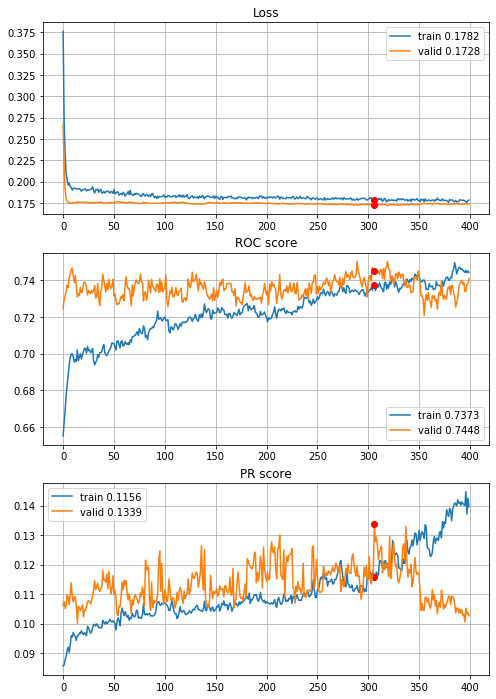


Fold 2------------------------------------------------------------


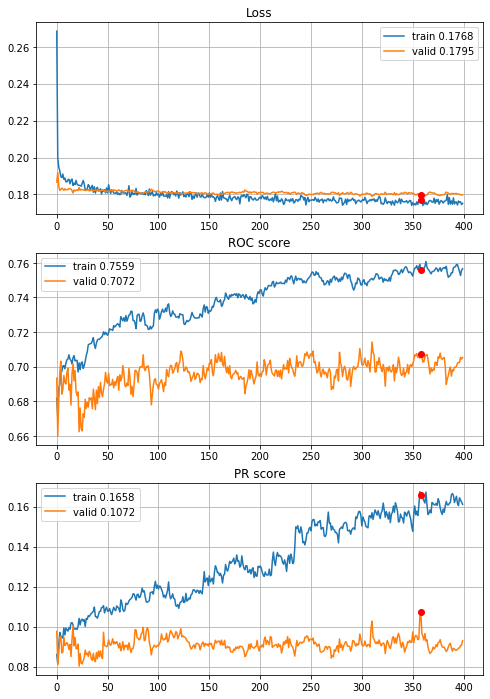


Fold 3------------------------------------------------------------


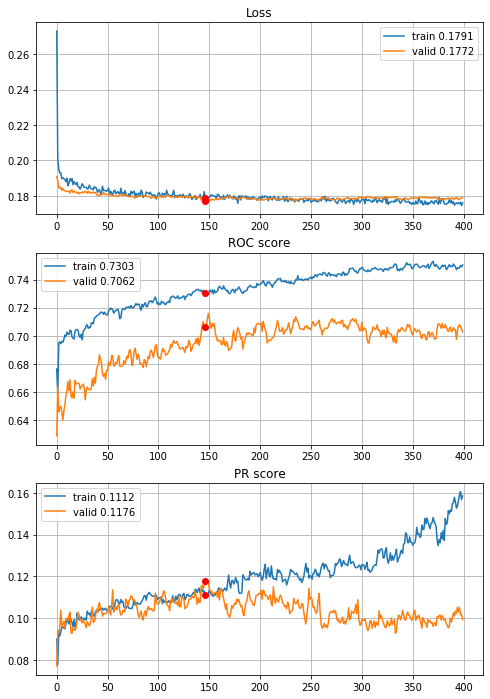


Fold 4------------------------------------------------------------


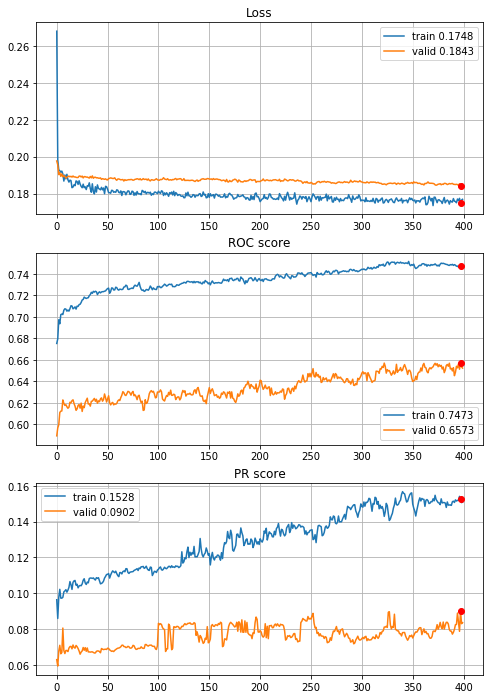


Fold 5------------------------------------------------------------


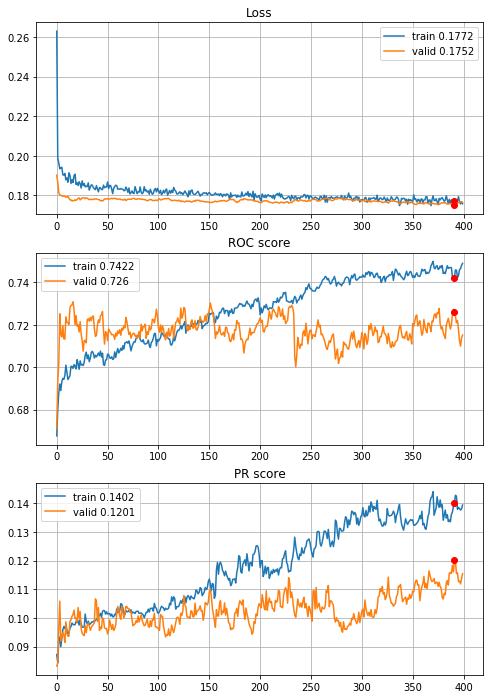


Fold 6------------------------------------------------------------


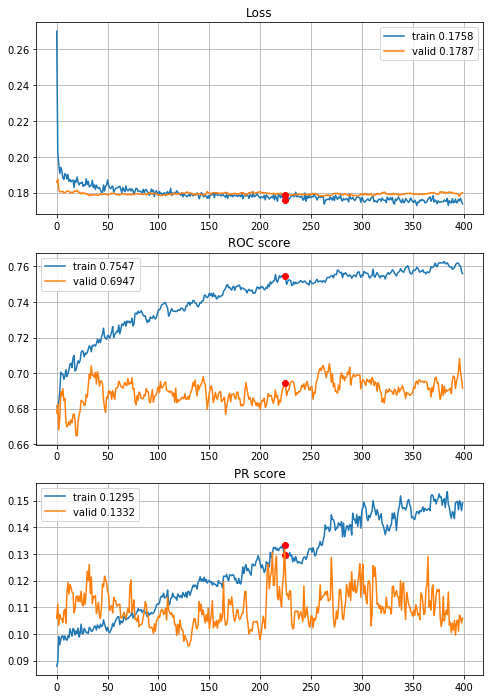

In [63]:
# raw data
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=False, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Learning curves looks awful on raw data, lets check normalization option for the same architecture


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/400,
cumulative time: 2.3s train loss: 0.46134015147367546, validation loss: 0.3259373977780342
Epoch: 2/400,
cumulative time: 2.44s train loss: 0.3034545504665423, validation loss: 0.23286747187376022
Epoch: 3/400,
cumulative time: 2.58s train loss: 0.2374570899510093, validation loss: 0.19827965646982193
Epoch: 4/400,
cumulative time: 2.72s train loss: 0.20738803140474735, validation loss: 0.187226090580225
Epoch: 5/400,
cumulative time: 2.86s train loss: 0.19973245974102258, validation loss: 0.18363001942634583
Epoch: 6/400,
cumulative time: 2.99s train loss: 0.1932904650871072, validation loss: 0.18221493065357208
Epoch: 7/400,
cumulative time: 3.13s train loss: 0.19319411662703787, validation loss: 0.18157532066106796
Epoch: 8/400,
cumulative time: 3.27s train loss: 0.18967353142779028, validation loss: 0.1806376874446869
Epoch: 9/400,
cumulative time: 3.41s train loss: 0.19007998836213044, val

Epoch: 77/400,
cumulative time: 13.57s train loss: 0.17201914707148602, validation loss: 0.17008551955223083
Epoch: 78/400,
cumulative time: 13.72s train loss: 0.17273447059053282, validation loss: 0.17018653452396393
Epoch: 79/400,
cumulative time: 13.87s train loss: 0.17403367590282157, validation loss: 0.1699919030070305
Epoch: 80/400,
cumulative time: 14.02s train loss: 0.17285418628306787, validation loss: 0.16993309929966927
Epoch: 81/400,
cumulative time: 14.17s train loss: 0.17168571565389149, validation loss: 0.169962577521801
Epoch: 82/400,
cumulative time: 14.3s train loss: 0.17316020495050627, validation loss: 0.1696721389889717
Epoch: 83/400,
cumulative time: 14.45s train loss: 0.1727867003448909, validation loss: 0.1697675921022892
Epoch: 84/400,
cumulative time: 14.6s train loss: 0.16988601363578565, validation loss: 0.16965213790535927
Epoch: 85/400,
cumulative time: 14.73s train loss: 0.1683711672704071, validation loss: 0.16973936930298805
Epoch: 86/400,
cumulative ti

Epoch: 153/400,
cumulative time: 24.97s train loss: 0.16571431241100848, validation loss: 0.16855588927865028
Epoch: 154/400,
cumulative time: 25.12s train loss: 0.16639461342402373, validation loss: 0.16852688789367676
Epoch: 155/400,
cumulative time: 25.25s train loss: 0.1663515576558285, validation loss: 0.16849331930279732
Epoch: 156/400,
cumulative time: 25.4s train loss: 0.1689425638960575, validation loss: 0.16858069971203804
Epoch: 157/400,
cumulative time: 25.52s train loss: 0.16645977726710393, validation loss: 0.16847321391105652
Epoch: 158/400,
cumulative time: 25.66s train loss: 0.16625137058398395, validation loss: 0.1686381660401821
Epoch: 159/400,
cumulative time: 25.8s train loss: 0.16618902112677533, validation loss: 0.16853630170226097
Epoch: 160/400,
cumulative time: 25.95s train loss: 0.16576387822143676, validation loss: 0.16849393770098686
Epoch: 161/400,
cumulative time: 26.1s train loss: 0.16585923099976435, validation loss: 0.16853923350572586
Epoch: 162/400,


Epoch: 229/400,
cumulative time: 36.37s train loss: 0.16309165291075722, validation loss: 0.16722653433680534
Epoch: 230/400,
cumulative time: 36.52s train loss: 0.16464486337513293, validation loss: 0.16717373579740524
Epoch: 231/400,
cumulative time: 36.67s train loss: 0.1652024424563452, validation loss: 0.16721410676836967
Epoch: 232/400,
cumulative time: 36.82s train loss: 0.16534972027579864, validation loss: 0.16751334443688393
Epoch: 233/400,
cumulative time: 36.97s train loss: 0.1652660977138881, validation loss: 0.1673629954457283
Epoch: 234/400,
cumulative time: 37.12s train loss: 0.1678714433948875, validation loss: 0.16727321967482567
Epoch: 235/400,
cumulative time: 37.29s train loss: 0.16444672377748862, validation loss: 0.16723240911960602
Epoch: 236/400,
cumulative time: 37.46s train loss: 0.1649231452981096, validation loss: 0.16699450835585594
Epoch: 237/400,
cumulative time: 37.62s train loss: 0.16629617343008246, validation loss: 0.16737114638090134
Epoch: 238/400,

Epoch: 305/400,
cumulative time: 47.8s train loss: 0.16282279359402846, validation loss: 0.16659795492887497
Epoch: 306/400,
cumulative time: 47.95s train loss: 0.16073471333863712, validation loss: 0.16674422845244408
Epoch: 307/400,
cumulative time: 48.12s train loss: 0.16150646106566555, validation loss: 0.16653818264603615
Epoch: 308/400,
cumulative time: 48.29s train loss: 0.16155109996871939, validation loss: 0.16629750654101372
Epoch: 309/400,
cumulative time: 48.45s train loss: 0.16165324970663592, validation loss: 0.16597525030374527
Epoch: 310/400,
cumulative time: 48.61s train loss: 0.16137352419866713, validation loss: 0.16623518615961075
Epoch: 311/400,
cumulative time: 48.79s train loss: 0.16125988312455347, validation loss: 0.16620980575680733
Epoch: 312/400,
cumulative time: 48.92s train loss: 0.16347769533561654, validation loss: 0.16612404584884644
Epoch: 313/400,
cumulative time: 49.05s train loss: 0.16298176681196225, validation loss: 0.16571242362260818
Epoch: 314/

Epoch: 381/400,
cumulative time: 59.43s train loss: 0.1605838752238656, validation loss: 0.1660301275551319
Epoch: 382/400,
cumulative time: 59.58s train loss: 0.15961556415295408, validation loss: 0.16596558690071106
Epoch: 383/400,
cumulative time: 59.72s train loss: 0.15929128230185663, validation loss: 0.16600719839334488
Epoch: 384/400,
cumulative time: 59.86s train loss: 0.16004019775491732, validation loss: 0.16601677983999252
Epoch: 385/400,
cumulative time: 60.0s train loss: 0.16030351158445288, validation loss: 0.16595136001706123
Epoch: 386/400,
cumulative time: 60.14s train loss: 0.16115023523432886, validation loss: 0.16615110263228416
Epoch: 387/400,
cumulative time: 60.28s train loss: 0.16118425438289355, validation loss: 0.16619127988815308
Epoch: 388/400,
cumulative time: 60.43s train loss: 0.15836519665671764, validation loss: 0.16613520309329033
Epoch: 389/400,
cumulative time: 60.58s train loss: 0.15940356476694997, validation loss: 0.16587979719042778
Epoch: 390/40

Epoch: 55/400,
cumulative time: 11.34s train loss: 0.1692101668969455, validation loss: 0.17264656350016594
Epoch: 56/400,
cumulative time: 11.48s train loss: 0.16772209451836095, validation loss: 0.1725202463567257
Epoch: 57/400,
cumulative time: 11.63s train loss: 0.16803567008379755, validation loss: 0.17239182069897652
Epoch: 58/400,
cumulative time: 11.76s train loss: 0.1667416097001263, validation loss: 0.17265885323286057
Epoch: 59/400,
cumulative time: 11.92s train loss: 0.16827874456628317, validation loss: 0.17256273329257965
Epoch: 60/400,
cumulative time: 12.07s train loss: 0.1699575482815156, validation loss: 0.17248236760497093
Epoch: 61/400,
cumulative time: 12.22s train loss: 0.16747161763998808, validation loss: 0.17254304513335228
Epoch: 62/400,
cumulative time: 12.38s train loss: 0.16766633160522046, validation loss: 0.17226174846291542
Epoch: 63/400,
cumulative time: 12.54s train loss: 0.16661787423773003, validation loss: 0.1723369061946869
Epoch: 64/400,
cumulativ

Epoch: 132/400,
cumulative time: 23.28s train loss: 0.1650675408231873, validation loss: 0.1716579794883728
Epoch: 133/400,
cumulative time: 23.44s train loss: 0.16601586639654098, validation loss: 0.17155620455741882
Epoch: 134/400,
cumulative time: 23.59s train loss: 0.16229214850357185, validation loss: 0.17156466096639633
Epoch: 135/400,
cumulative time: 23.73s train loss: 0.16035452384999285, validation loss: 0.171798437833786
Epoch: 136/400,
cumulative time: 23.88s train loss: 0.16117630928656423, validation loss: 0.17193039879202843
Epoch: 137/400,
cumulative time: 24.04s train loss: 0.16427059442281663, validation loss: 0.1717362143099308
Epoch: 138/400,
cumulative time: 24.19s train loss: 0.16394291481371154, validation loss: 0.17164382711052895
Epoch: 139/400,
cumulative time: 24.34s train loss: 0.16211120754011152, validation loss: 0.17189764976501465
Epoch: 140/400,
cumulative time: 24.5s train loss: 0.1628577585955027, validation loss: 0.17193493619561195
Epoch: 141/400,
c

Epoch: 208/400,
cumulative time: 34.94s train loss: 0.15969737144655355, validation loss: 0.17200206965208054
Epoch: 209/400,
cumulative time: 35.1s train loss: 0.15788953874303702, validation loss: 0.17195629328489304
Epoch: 210/400,
cumulative time: 35.27s train loss: 0.15874899053305705, validation loss: 0.17219346016645432
Epoch: 211/400,
cumulative time: 35.44s train loss: 0.15904652234024963, validation loss: 0.17212055623531342
Epoch: 212/400,
cumulative time: 35.58s train loss: 0.1577400673481642, validation loss: 0.17237787693738937
Epoch: 213/400,
cumulative time: 35.73s train loss: 0.16002999347908475, validation loss: 0.1723170205950737
Epoch: 214/400,
cumulative time: 35.89s train loss: 0.15834552210832745, validation loss: 0.1720341183245182
Epoch: 215/400,
cumulative time: 36.05s train loss: 0.15826658426640663, validation loss: 0.17176027968525887
Epoch: 216/400,
cumulative time: 36.2s train loss: 0.16224609066222814, validation loss: 0.17209266871213913
Epoch: 217/400,

Epoch: 284/400,
cumulative time: 46.42s train loss: 0.15684533495893024, validation loss: 0.17353500053286552
Epoch: 285/400,
cumulative time: 46.57s train loss: 0.15596709008777487, validation loss: 0.17306078970432281
Epoch: 286/400,
cumulative time: 46.72s train loss: 0.15941651167944945, validation loss: 0.17304446920752525
Epoch: 287/400,
cumulative time: 46.87s train loss: 0.1569979202897189, validation loss: 0.17315001413226128
Epoch: 288/400,
cumulative time: 47.03s train loss: 0.15701431994278642, validation loss: 0.17300109937787056
Epoch: 289/400,
cumulative time: 47.19s train loss: 0.15797037588136337, validation loss: 0.17338576167821884
Epoch: 290/400,
cumulative time: 47.33s train loss: 0.15973701630565285, validation loss: 0.1732681207358837
Epoch: 291/400,
cumulative time: 47.48s train loss: 0.1584907675482647, validation loss: 0.17296864464879036
Epoch: 292/400,
cumulative time: 47.64s train loss: 0.15582247898588028, validation loss: 0.17288563400506973
Epoch: 293/40

Epoch: 360/400,
cumulative time: 58.05s train loss: 0.15587814197837246, validation loss: 0.17487478628754616
Epoch: 361/400,
cumulative time: 58.22s train loss: 0.15411050665940107, validation loss: 0.17474881559610367
Epoch: 362/400,
cumulative time: 58.36s train loss: 0.15529172928458002, validation loss: 0.17484678328037262
Epoch: 363/400,
cumulative time: 58.51s train loss: 0.1538745612530402, validation loss: 0.1755710244178772
Epoch: 364/400,
cumulative time: 58.67s train loss: 0.15656746274031558, validation loss: 0.17509717494249344
Epoch: 365/400,
cumulative time: 58.86s train loss: 0.15701663449081205, validation loss: 0.17546138167381287
Epoch: 366/400,
cumulative time: 59.04s train loss: 0.1553054777456002, validation loss: 0.17493199557065964
Epoch: 367/400,
cumulative time: 59.23s train loss: 0.15516197172297688, validation loss: 0.1754780374467373
Epoch: 368/400,
cumulative time: 59.39s train loss: 0.15528198768828894, validation loss: 0.1751534789800644
Epoch: 369/400,

Epoch: 35/400,
cumulative time: 8.12s train loss: 0.17133479370439175, validation loss: 0.17331752387304156
Epoch: 36/400,
cumulative time: 8.26s train loss: 0.17023614459463343, validation loss: 0.17354815993044112
Epoch: 37/400,
cumulative time: 8.41s train loss: 0.17068214010425037, validation loss: 0.17355050535429092
Epoch: 38/400,
cumulative time: 8.56s train loss: 0.1719165589204972, validation loss: 0.17314852355018495
Epoch: 39/400,
cumulative time: 8.71s train loss: 0.17069575660449987, validation loss: 0.17338370019481295
Epoch: 40/400,
cumulative time: 8.87s train loss: 0.17068543214664494, validation loss: 0.17361923137354474
Epoch: 41/400,
cumulative time: 9.02s train loss: 0.16953732371443764, validation loss: 0.17393216800122033
Epoch: 42/400,
cumulative time: 9.16s train loss: 0.17001463629478455, validation loss: 0.1736718949817476
Epoch: 43/400,
cumulative time: 9.33s train loss: 0.17060629104476782, validation loss: 0.17348484727125318
Epoch: 44/400,
cumulative time

Epoch: 111/400,
cumulative time: 19.64s train loss: 0.1675797254944326, validation loss: 0.1741765850877005
Epoch: 112/400,
cumulative time: 19.8s train loss: 0.1665474332153033, validation loss: 0.17417590214146508
Epoch: 113/400,
cumulative time: 19.94s train loss: 0.16678047050213896, validation loss: 0.1741580204074345
Epoch: 114/400,
cumulative time: 20.1s train loss: 0.1651074403836156, validation loss: 0.17426749710998837
Epoch: 115/400,
cumulative time: 20.26s train loss: 0.16624490408704745, validation loss: 0.1742315558308647
Epoch: 116/400,
cumulative time: 20.41s train loss: 0.16762248243272523, validation loss: 0.17407974131523618
Epoch: 117/400,
cumulative time: 20.56s train loss: 0.1641153374045304, validation loss: 0.17416264932306985
Epoch: 118/400,
cumulative time: 20.71s train loss: 0.16479049223289888, validation loss: 0.17415713925210258
Epoch: 119/400,
cumulative time: 20.86s train loss: 0.16546573324283398, validation loss: 0.17461431995270743
Epoch: 120/400,
cum

Epoch: 188/400,
cumulative time: 31.57s train loss: 0.16298937554837362, validation loss: 0.1755230664639246
Epoch: 189/400,
cumulative time: 31.72s train loss: 0.1642587730935099, validation loss: 0.17529093223904807
Epoch: 190/400,
cumulative time: 31.87s train loss: 0.16300117665322675, validation loss: 0.17525930572123755
Epoch: 191/400,
cumulative time: 32.04s train loss: 0.1629571738836501, validation loss: 0.1753511535553705
Epoch: 192/400,
cumulative time: 32.19s train loss: 0.16234011290164804, validation loss: 0.17535607702202266
Epoch: 193/400,
cumulative time: 32.33s train loss: 0.16459367493014052, validation loss: 0.17553333394111148
Epoch: 194/400,
cumulative time: 32.49s train loss: 0.16229114396966046, validation loss: 0.17563995264825366
Epoch: 195/400,
cumulative time: 32.63s train loss: 0.16366994053870723, validation loss: 0.17530989798288496
Epoch: 196/400,
cumulative time: 32.8s train loss: 0.16387626253114795, validation loss: 0.17570816290757013
Epoch: 197/400,

Epoch: 264/400,
cumulative time: 43.52s train loss: 0.16059900439828276, validation loss: 0.1762762656192931
Epoch: 265/400,
cumulative time: 43.67s train loss: 0.16227326112054122, validation loss: 0.1758429366539395
Epoch: 266/400,
cumulative time: 43.83s train loss: 0.16284264077597863, validation loss: 0.1756706660512894
Epoch: 267/400,
cumulative time: 43.99s train loss: 0.1607009926010422, validation loss: 0.17565326686889407
Epoch: 268/400,
cumulative time: 44.13s train loss: 0.16093125238672223, validation loss: 0.1764982851724776
Epoch: 269/400,
cumulative time: 44.3s train loss: 0.15969993107865513, validation loss: 0.17627444495284367
Epoch: 270/400,
cumulative time: 44.47s train loss: 0.16079272847763093, validation loss: 0.17640820753006708
Epoch: 271/400,
cumulative time: 44.63s train loss: 0.160435875923376, validation loss: 0.17607869831342546
Epoch: 272/400,
cumulative time: 44.8s train loss: 0.16360432481620463, validation loss: 0.17607074003370982
Epoch: 273/400,
cum

Epoch: 340/400,
cumulative time: 55.05s train loss: 0.15738749816981581, validation loss: 0.17650092859116812
Epoch: 341/400,
cumulative time: 55.21s train loss: 0.1565726836978958, validation loss: 0.17597299033687228
Epoch: 342/400,
cumulative time: 55.36s train loss: 0.1570966736331603, validation loss: 0.17640981339272999
Epoch: 343/400,
cumulative time: 55.51s train loss: 0.15708882822192258, validation loss: 0.1760414964528311
Epoch: 344/400,
cumulative time: 55.67s train loss: 0.15958210962881395, validation loss: 0.17639284379898557
Epoch: 345/400,
cumulative time: 55.82s train loss: 0.15783295954081164, validation loss: 0.17652889475935982
Epoch: 346/400,
cumulative time: 55.97s train loss: 0.1585765488486431, validation loss: 0.1766687485055318
Epoch: 347/400,
cumulative time: 56.11s train loss: 0.15755435967598225, validation loss: 0.1769958838773152
Epoch: 348/400,
cumulative time: 56.27s train loss: 0.15759024736624586, validation loss: 0.17633940701446835
Epoch: 349/400,


Epoch: 13/400,
cumulative time: 4.83s train loss: 0.17718775679167112, validation loss: 0.18177429327889094
Epoch: 14/400,
cumulative time: 4.99s train loss: 0.17699508075561562, validation loss: 0.1817414855578589
Epoch: 15/400,
cumulative time: 5.13s train loss: 0.17650072374583894, validation loss: 0.18216195437643262
Epoch: 16/400,
cumulative time: 5.28s train loss: 0.17416771010682414, validation loss: 0.1811139177046125
Epoch: 17/400,
cumulative time: 5.42s train loss: 0.17263691923907978, validation loss: 0.18131236204079218
Epoch: 18/400,
cumulative time: 5.56s train loss: 0.17576359540235426, validation loss: 0.1807599130887834
Epoch: 19/400,
cumulative time: 5.72s train loss: 0.1723254796524739, validation loss: 0.18005392889181773
Epoch: 20/400,
cumulative time: 5.87s train loss: 0.17561943844760963, validation loss: 0.1804379359691862
Epoch: 21/400,
cumulative time: 6.0s train loss: 0.17588128388624166, validation loss: 0.1804910304716655
Epoch: 22/400,
cumulative time: 6.1

Epoch: 89/400,
cumulative time: 16.01s train loss: 0.16500078489767714, validation loss: 0.1799143150212273
Epoch: 90/400,
cumulative time: 16.16s train loss: 0.16477000733022387, validation loss: 0.17917998119006082
Epoch: 91/400,
cumulative time: 16.3s train loss: 0.1666387503100513, validation loss: 0.17960643773041074
Epoch: 92/400,
cumulative time: 16.44s train loss: 0.16591062545738533, validation loss: 0.17930653961877974
Epoch: 93/400,
cumulative time: 16.58s train loss: 0.16549888809948263, validation loss: 0.17917296810755654
Epoch: 94/400,
cumulative time: 16.7s train loss: 0.16762379330170402, validation loss: 0.1799127928510545
Epoch: 95/400,
cumulative time: 16.85s train loss: 0.16628288869720373, validation loss: 0.17896893581700704
Epoch: 96/400,
cumulative time: 16.99s train loss: 0.16676542721144874, validation loss: 0.17891811931890156
Epoch: 97/400,
cumulative time: 17.12s train loss: 0.16628586090093822, validation loss: 0.17913968125033
Epoch: 98/400,
cumulative t

Epoch: 165/400,
cumulative time: 26.85s train loss: 0.16302076973928115, validation loss: 0.17960129838141184
Epoch: 166/400,
cumulative time: 26.98s train loss: 0.16361531852480268, validation loss: 0.17939543382515982
Epoch: 167/400,
cumulative time: 27.11s train loss: 0.1623867423560575, validation loss: 0.17933613653220828
Epoch: 168/400,
cumulative time: 27.26s train loss: 0.16328832502971677, validation loss: 0.1797782006434032
Epoch: 169/400,
cumulative time: 27.41s train loss: 0.1635310791884035, validation loss: 0.18037976471204606
Epoch: 170/400,
cumulative time: 27.56s train loss: 0.16278013464603022, validation loss: 0.17965634792570084
Epoch: 171/400,
cumulative time: 27.7s train loss: 0.1638955057094859, validation loss: 0.17945293427459777
Epoch: 172/400,
cumulative time: 27.85s train loss: 0.16270970218228828, validation loss: 0.17952141143026806
Epoch: 173/400,
cumulative time: 27.99s train loss: 0.16328666369401518, validation loss: 0.18052668909231823
Epoch: 174/400,

Epoch: 241/400,
cumulative time: 38.03s train loss: 0.1639190891532255, validation loss: 0.18127964843833258
Epoch: 242/400,
cumulative time: 38.18s train loss: 0.16043994245159002, validation loss: 0.18005958045285844
Epoch: 243/400,
cumulative time: 38.33s train loss: 0.15890005628734552, validation loss: 0.18118661385680002
Epoch: 244/400,
cumulative time: 38.47s train loss: 0.15896703558811398, validation loss: 0.18032155169381037
Epoch: 245/400,
cumulative time: 38.62s train loss: 0.15970326332599813, validation loss: 0.18037665121139043
Epoch: 246/400,
cumulative time: 38.77s train loss: 0.15986197956461615, validation loss: 0.1810775128716514
Epoch: 247/400,
cumulative time: 38.91s train loss: 0.16079347967246438, validation loss: 0.1821068369396149
Epoch: 248/400,
cumulative time: 39.07s train loss: 0.15961768958181752, validation loss: 0.1812605540430735
Epoch: 249/400,
cumulative time: 39.21s train loss: 0.15967351759094506, validation loss: 0.1809024907482995
Epoch: 250/400,

Epoch: 317/400,
cumulative time: 49.2s train loss: 0.15841988665100826, validation loss: 0.18068823786008925
Epoch: 318/400,
cumulative time: 49.35s train loss: 0.1568840217420833, validation loss: 0.18091692608500284
Epoch: 319/400,
cumulative time: 49.5s train loss: 0.15886738692441385, validation loss: 0.18179195454196326
Epoch: 320/400,
cumulative time: 49.65s train loss: 0.15731466289997947, validation loss: 0.1808675657567524
Epoch: 321/400,
cumulative time: 49.79s train loss: 0.1584047322003418, validation loss: 0.18082499677226657
Epoch: 322/400,
cumulative time: 49.93s train loss: 0.15736942734700313, validation loss: 0.18113512504668464
Epoch: 323/400,
cumulative time: 50.09s train loss: 0.15712927698983115, validation loss: 0.18223678695777107
Epoch: 324/400,
cumulative time: 50.23s train loss: 0.1587445902214508, validation loss: 0.18131158951729062
Epoch: 325/400,
cumulative time: 50.37s train loss: 0.15805272114818678, validation loss: 0.18111739252294812
Epoch: 326/400,


Epoch: 393/400,
cumulative time: 60.39s train loss: 0.15590031929876927, validation loss: 0.18282921313293396
Epoch: 394/400,
cumulative time: 60.53s train loss: 0.15532151815952405, validation loss: 0.1827462863922119
Epoch: 395/400,
cumulative time: 60.67s train loss: 0.15620212418178442, validation loss: 0.18309179010845367
Epoch: 396/400,
cumulative time: 60.82s train loss: 0.15813198091264333, validation loss: 0.1826565403881527
Epoch: 397/400,
cumulative time: 60.98s train loss: 0.15532388012883203, validation loss: 0.182292674268995
Epoch: 398/400,
cumulative time: 61.12s train loss: 0.15596152099918953, validation loss: 0.1823141837971551
Epoch: 399/400,
cumulative time: 61.27s train loss: 0.15613187442988752, validation loss: 0.18342875951812382
Epoch: 400/400,
cumulative time: 61.42s train loss: 0.15983459090307248, validation loss: 0.18285472485754226

Early stopping results:
best results in epoch: 385, 
best valid PR: 0.12090145705788216, 
valid ROC: 0.7268037524533195     

Epoch: 67/400,
cumulative time: 13.13s train loss: 0.16749697234313682, validation loss: 0.17574640829411764
Epoch: 68/400,
cumulative time: 13.28s train loss: 0.16648730033883533, validation loss: 0.17594912316117967
Epoch: 69/400,
cumulative time: 13.44s train loss: 0.17001477950635077, validation loss: 0.1763383714358012
Epoch: 70/400,
cumulative time: 13.61s train loss: 0.1675596641180584, validation loss: 0.17612925376210894
Epoch: 71/400,
cumulative time: 13.77s train loss: 0.1682470886480601, validation loss: 0.17615757660260276
Epoch: 72/400,
cumulative time: 13.92s train loss: 0.1682808823023742, validation loss: 0.17561853773064084
Epoch: 73/400,
cumulative time: 14.09s train loss: 0.16565738397419746, validation loss: 0.1765767179500489
Epoch: 74/400,
cumulative time: 14.25s train loss: 0.16795113623157376, validation loss: 0.17556919041134061
Epoch: 75/400,
cumulative time: 14.42s train loss: 0.16974953348161123, validation loss: 0.17609481588242545
Epoch: 76/400,
cumulativ

Epoch: 143/400,
cumulative time: 24.97s train loss: 0.1655949233223963, validation loss: 0.17630906245065114
Epoch: 144/400,
cumulative time: 25.13s train loss: 0.1642439957177017, validation loss: 0.17632334378030565
Epoch: 145/400,
cumulative time: 25.29s train loss: 0.16508829272064263, validation loss: 0.17720027227250357
Epoch: 146/400,
cumulative time: 25.43s train loss: 0.1637494870932919, validation loss: 0.17669175630524045
Epoch: 147/400,
cumulative time: 25.59s train loss: 0.1645471083511779, validation loss: 0.1770616232402741
Epoch: 148/400,
cumulative time: 25.75s train loss: 0.16601553196091026, validation loss: 0.17656043661019158
Epoch: 149/400,
cumulative time: 25.9s train loss: 0.16302965195125715, validation loss: 0.17683004559978607
Epoch: 150/400,
cumulative time: 26.05s train loss: 0.16209687813369245, validation loss: 0.1762385731935501
Epoch: 151/400,
cumulative time: 26.21s train loss: 0.16468168834267616, validation loss: 0.17660393982652633
Epoch: 152/400,
c

Epoch: 219/400,
cumulative time: 36.83s train loss: 0.1614672151051667, validation loss: 0.17604004103039939
Epoch: 220/400,
cumulative time: 37.0s train loss: 0.16107239233398704, validation loss: 0.17525782912496538
Epoch: 221/400,
cumulative time: 37.17s train loss: 0.1594617296872412, validation loss: 0.17515640158501883
Epoch: 222/400,
cumulative time: 37.33s train loss: 0.16125640064814648, validation loss: 0.1749139931750676
Epoch: 223/400,
cumulative time: 37.5s train loss: 0.16039024082116402, validation loss: 0.175275010012445
Epoch: 224/400,
cumulative time: 37.67s train loss: 0.160831052007387, validation loss: 0.1753268813519251
Epoch: 225/400,
cumulative time: 37.84s train loss: 0.15800829351958517, validation loss: 0.17489179807049887
Epoch: 226/400,
cumulative time: 38.0s train loss: 0.15917333979450446, validation loss: 0.17517491914923228
Epoch: 227/400,
cumulative time: 38.16s train loss: 0.1591464950111564, validation loss: 0.1751484386599253
Epoch: 228/400,
cumulat

Epoch: 295/400,
cumulative time: 48.68s train loss: 0.15804847979002287, validation loss: 0.17433730055415442
Epoch: 296/400,
cumulative time: 48.84s train loss: 0.1572114498736033, validation loss: 0.1746688412390058
Epoch: 297/400,
cumulative time: 49.02s train loss: 0.15867072513892866, validation loss: 0.17418540824973394
Epoch: 298/400,
cumulative time: 49.16s train loss: 0.15612917180720873, validation loss: 0.1737962899889265
Epoch: 299/400,
cumulative time: 49.32s train loss: 0.15605198466809583, validation loss: 0.17409392864931197
Epoch: 300/400,
cumulative time: 49.48s train loss: 0.1571280539822757, validation loss: 0.17373038901223076
Epoch: 301/400,
cumulative time: 49.62s train loss: 0.15346586893048855, validation loss: 0.17349489649136862
Epoch: 302/400,
cumulative time: 49.77s train loss: 0.15501028628492772, validation loss: 0.17351668040903787
Epoch: 303/400,
cumulative time: 49.94s train loss: 0.15801988996473593, validation loss: 0.17377764815375918
Epoch: 304/400

Epoch: 371/400,
cumulative time: 60.39s train loss: 0.15315662337859845, validation loss: 0.17248449649129596
Epoch: 372/400,
cumulative time: 60.55s train loss: 0.15211046976199893, validation loss: 0.17270316999109964
Epoch: 373/400,
cumulative time: 60.69s train loss: 0.1524462145650933, validation loss: 0.17290469220706395
Epoch: 374/400,
cumulative time: 60.85s train loss: 0.1534654082751931, validation loss: 0.17310721143843635
Epoch: 375/400,
cumulative time: 61.01s train loss: 0.15205596560385076, validation loss: 0.17296212100793446
Epoch: 376/400,
cumulative time: 61.16s train loss: 0.1513940130047225, validation loss: 0.1730419351184179
Epoch: 377/400,
cumulative time: 61.31s train loss: 0.15290058023307293, validation loss: 0.17239502390225728
Epoch: 378/400,
cumulative time: 61.46s train loss: 0.1514865934387203, validation loss: 0.17339162252252063
Epoch: 379/400,
cumulative time: 61.63s train loss: 0.15344129556120084, validation loss: 0.17289441321577345
Epoch: 380/400,

Epoch: 45/400,
cumulative time: 10.43s train loss: 0.16966644643988119, validation loss: 0.16943737991272456
Epoch: 46/400,
cumulative time: 10.59s train loss: 0.17027687437532515, validation loss: 0.16931728802976154
Epoch: 47/400,
cumulative time: 10.75s train loss: 0.17174826963640674, validation loss: 0.16921525025178516
Epoch: 48/400,
cumulative time: 10.9s train loss: 0.16932868535474455, validation loss: 0.16903416105679103
Epoch: 49/400,
cumulative time: 11.08s train loss: 0.17123526605090864, validation loss: 0.16892546084192064
Epoch: 50/400,
cumulative time: 11.24s train loss: 0.171784939385087, validation loss: 0.168977254260154
Epoch: 51/400,
cumulative time: 11.4s train loss: 0.17179393284595057, validation loss: 0.1688718071343407
Epoch: 52/400,
cumulative time: 11.57s train loss: 0.1703635832977973, validation loss: 0.16936722706234644
Epoch: 53/400,
cumulative time: 11.73s train loss: 0.1696860314217621, validation loss: 0.16928614772501446
Epoch: 54/400,
cumulative ti

Epoch: 121/400,
cumulative time: 22.32s train loss: 0.1643340000006637, validation loss: 0.16676532806858183
Epoch: 122/400,
cumulative time: 22.47s train loss: 0.1655813809675781, validation loss: 0.1666610757415257
Epoch: 123/400,
cumulative time: 22.63s train loss: 0.16626318256511777, validation loss: 0.1666741473807229
Epoch: 124/400,
cumulative time: 22.78s train loss: 0.16450700267318907, validation loss: 0.16678867991008456
Epoch: 125/400,
cumulative time: 22.94s train loss: 0.16572528348835316, validation loss: 0.16649625500989337
Epoch: 126/400,
cumulative time: 23.1s train loss: 0.1655532047540324, validation loss: 0.16648023127563416
Epoch: 127/400,
cumulative time: 23.26s train loss: 0.1626962318087617, validation loss: 0.16669081361520857
Epoch: 128/400,
cumulative time: 23.41s train loss: 0.1654732564772327, validation loss: 0.16648768101419723
Epoch: 129/400,
cumulative time: 23.57s train loss: 0.16681598757402052, validation loss: 0.16650378055042692
Epoch: 130/400,
cu

Epoch: 197/400,
cumulative time: 34.47s train loss: 0.16256040659322493, validation loss: 0.16627157469590506
Epoch: 198/400,
cumulative time: 34.64s train loss: 0.16179888616877036, validation loss: 0.16626176673268514
Epoch: 199/400,
cumulative time: 34.8s train loss: 0.1632974890830539, validation loss: 0.16641477724862477
Epoch: 200/400,
cumulative time: 34.96s train loss: 0.16275759310502608, validation loss: 0.16664718703618125
Epoch: 201/400,
cumulative time: 35.11s train loss: 0.16076498033999792, validation loss: 0.166406240661939
Epoch: 202/400,
cumulative time: 35.27s train loss: 0.16393075133506546, validation loss: 0.166118455708973
Epoch: 203/400,
cumulative time: 35.43s train loss: 0.16193941378367951, validation loss: 0.1663413504286418
Epoch: 204/400,
cumulative time: 35.61s train loss: 0.162896660863937, validation loss: 0.166158102372336
Epoch: 205/400,
cumulative time: 35.78s train loss: 0.1636777086746455, validation loss: 0.16622869952330513
Epoch: 206/400,
cumula

Epoch: 273/400,
cumulative time: 46.84s train loss: 0.1603345169385587, validation loss: 0.1662766065578612
Epoch: 274/400,
cumulative time: 47.0s train loss: 0.16032828715219252, validation loss: 0.16629307638085078
Epoch: 275/400,
cumulative time: 47.17s train loss: 0.15884944886419394, validation loss: 0.16634704813124643
Epoch: 276/400,
cumulative time: 47.34s train loss: 0.1599219268925892, validation loss: 0.16678936816397166
Epoch: 277/400,
cumulative time: 47.5s train loss: 0.1595140564872239, validation loss: 0.1672234434740884
Epoch: 278/400,
cumulative time: 47.67s train loss: 0.16032261299545184, validation loss: 0.1670870682549855
Epoch: 279/400,
cumulative time: 47.84s train loss: 0.15851342550378258, validation loss: 0.16702352702617645
Epoch: 280/400,
cumulative time: 48.01s train loss: 0.15971041990519025, validation loss: 0.1668018906362473
Epoch: 281/400,
cumulative time: 48.17s train loss: 0.15941875409895323, validation loss: 0.16679813014136421
Epoch: 282/400,
cum

Epoch: 349/400,
cumulative time: 58.9s train loss: 0.15772490645099657, validation loss: 0.1676920067790955
Epoch: 350/400,
cumulative time: 59.05s train loss: 0.157857371504815, validation loss: 0.16800008627157362
Epoch: 351/400,
cumulative time: 59.22s train loss: 0.15565571255893956, validation loss: 0.16773439447085062
Epoch: 352/400,
cumulative time: 59.37s train loss: 0.1569623672937218, validation loss: 0.1673662465148502
Epoch: 353/400,
cumulative time: 59.53s train loss: 0.15552270666504475, validation loss: 0.1674852982305345
Epoch: 354/400,
cumulative time: 59.69s train loss: 0.15576272926135945, validation loss: 0.16735095766801683
Epoch: 355/400,
cumulative time: 59.85s train loss: 0.15606097372879424, validation loss: 0.16739871192546119
Epoch: 356/400,
cumulative time: 60.01s train loss: 0.15470217734904432, validation loss: 0.167501671919747
Epoch: 357/400,
cumulative time: 60.15s train loss: 0.15728596183148014, validation loss: 0.1673445808792871
Epoch: 358/400,
cumu

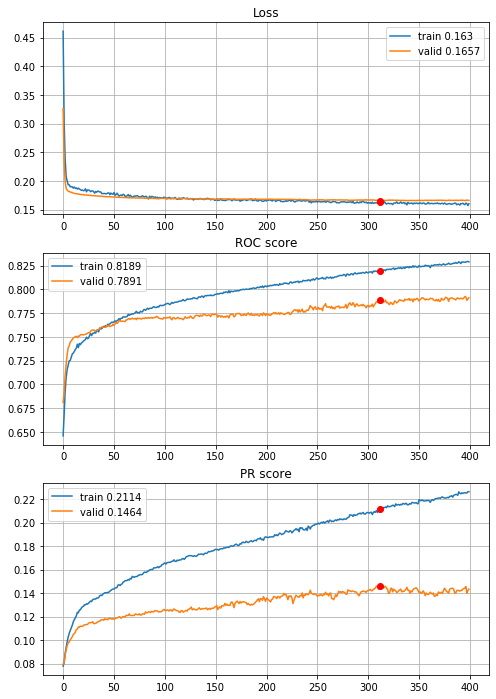


Fold 2------------------------------------------------------------


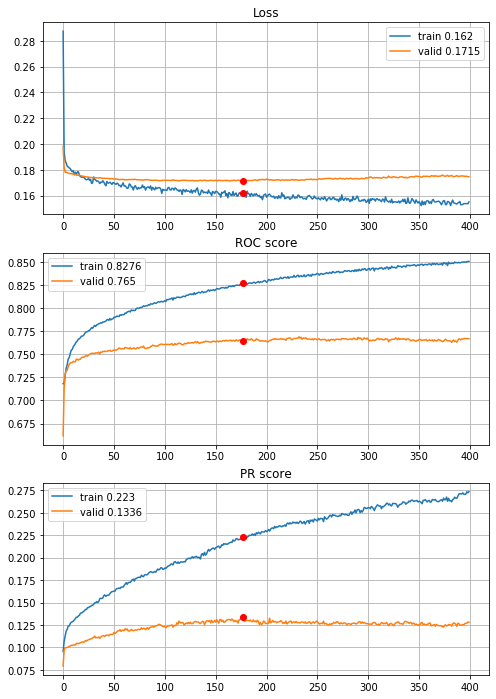


Fold 3------------------------------------------------------------


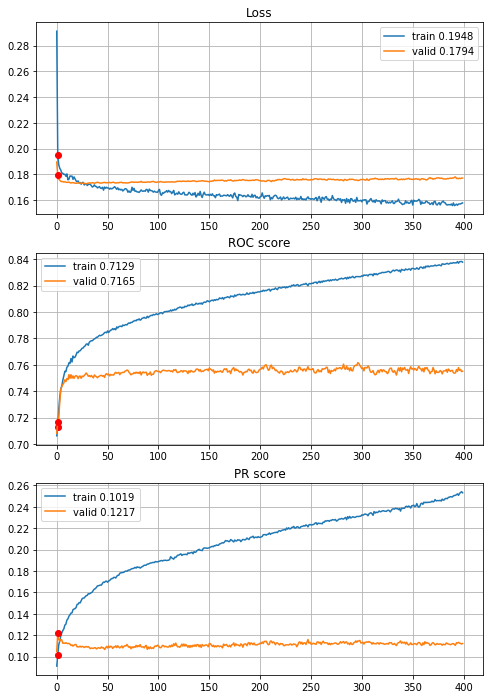


Fold 4------------------------------------------------------------


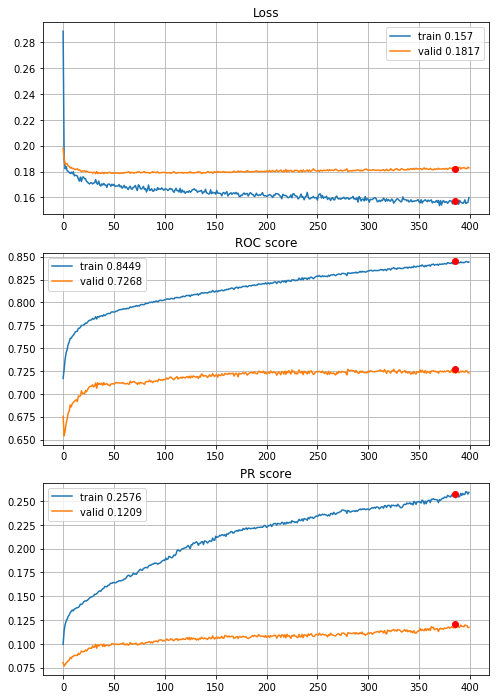


Fold 5------------------------------------------------------------


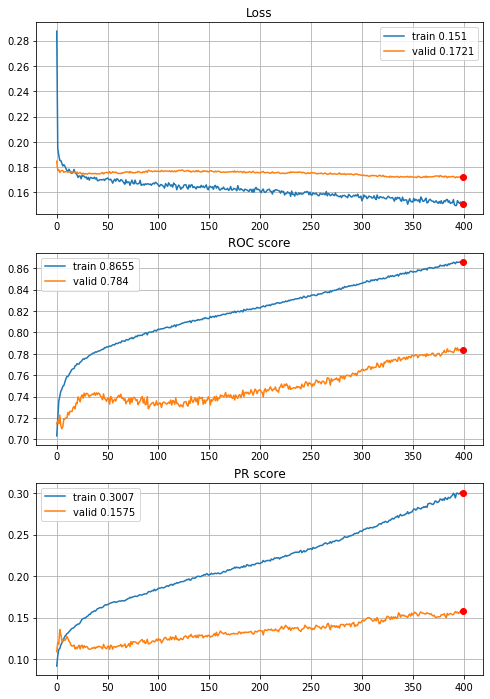


Fold 6------------------------------------------------------------


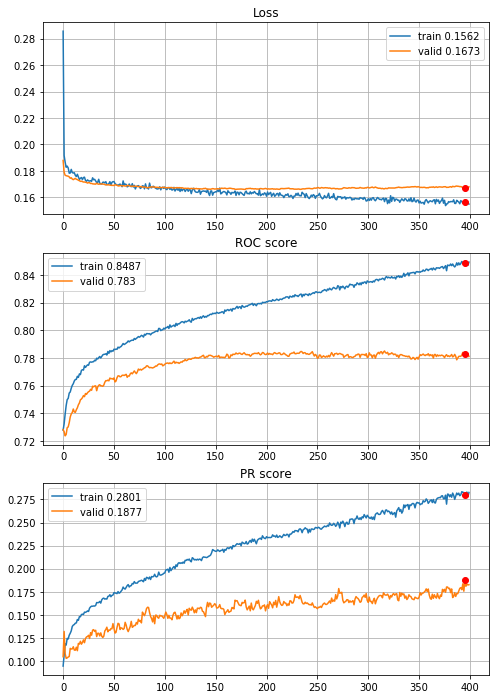

In [64]:
# normalization
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.03 on PR


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/400,
cumulative time: 3.81s train loss: 0.46304321355659867, validation loss: 0.3182128295302391
Epoch: 2/400,
cumulative time: 3.97s train loss: 0.3029343880270265, validation loss: 0.2315766178071499
Epoch: 3/400,
cumulative time: 4.14s train loss: 0.24217849941484332, validation loss: 0.19867734611034393
Epoch: 4/400,
cumulative time: 4.31s train loss: 0.21047598358533176, validation loss: 0.1854798048734665
Epoch: 5/400,
cumulative time: 4.47s train loss: 0.19981882594802042, validation loss: 0.1795266754925251
Epoch: 6/400,
cumulative time: 4.62s train loss: 0.19165297604457807, validation loss: 0.1764984130859375
Epoch: 7/400,
cumulative time: 4.77s train loss: 0.1891768523820649, validation loss: 0.1749310903251171
Epoch: 8/400,
cumulative time: 4.94s train loss: 0.18250680460186403, validation loss: 0.17325342819094658
Epoch: 9/400,
cumulative time: 5.09s train loss: 0.18550839358368398, val

Epoch: 77/400,
cumulative time: 15.68s train loss: 0.1559170978479636, validation loss: 0.16166366264224052
Epoch: 78/400,
cumulative time: 15.84s train loss: 0.15723182813634784, validation loss: 0.16217315942049026
Epoch: 79/400,
cumulative time: 15.99s train loss: 0.1576302347656523, validation loss: 0.16184263676404953
Epoch: 80/400,
cumulative time: 16.15s train loss: 0.15803099332643136, validation loss: 0.1613587960600853
Epoch: 81/400,
cumulative time: 16.31s train loss: 0.15583974608669976, validation loss: 0.16160988807678223
Epoch: 82/400,
cumulative time: 16.46s train loss: 0.15789421228904782, validation loss: 0.1611042432487011
Epoch: 83/400,
cumulative time: 16.62s train loss: 0.1542663490555806, validation loss: 0.16069718077778816
Epoch: 84/400,
cumulative time: 16.78s train loss: 0.15533077439275292, validation loss: 0.16087660565972328
Epoch: 85/400,
cumulative time: 16.93s train loss: 0.15237141080454197, validation loss: 0.1611589416861534
Epoch: 86/400,
cumulative

Epoch: 153/400,
cumulative time: 27.63s train loss: 0.14749522549949243, validation loss: 0.1581186130642891
Epoch: 154/400,
cumulative time: 27.78s train loss: 0.14809819467369525, validation loss: 0.157947588711977
Epoch: 155/400,
cumulative time: 27.95s train loss: 0.1464285766559243, validation loss: 0.15784018114209175
Epoch: 156/400,
cumulative time: 28.1s train loss: 0.14769187852846238, validation loss: 0.15802134573459625
Epoch: 157/400,
cumulative time: 28.25s train loss: 0.14711789540859452, validation loss: 0.15789425373077393
Epoch: 158/400,
cumulative time: 28.42s train loss: 0.14495680891563895, validation loss: 0.15760546550154686
Epoch: 159/400,
cumulative time: 28.57s train loss: 0.1455141074667884, validation loss: 0.15821762010455132
Epoch: 160/400,
cumulative time: 28.72s train loss: 0.1470899416494182, validation loss: 0.15837202221155167
Epoch: 161/400,
cumulative time: 28.89s train loss: 0.1442280540185086, validation loss: 0.15812142565846443
Epoch: 162/400,
cu

Epoch: 229/400,
cumulative time: 39.22s train loss: 0.13770111044797878, validation loss: 0.1542595475912094
Epoch: 230/400,
cumulative time: 39.37s train loss: 0.13972763209369596, validation loss: 0.15407267212867737
Epoch: 231/400,
cumulative time: 39.52s train loss: 0.13781341405395264, validation loss: 0.15404488891363144
Epoch: 232/400,
cumulative time: 39.69s train loss: 0.13907858638737092, validation loss: 0.1543320268392563
Epoch: 233/400,
cumulative time: 39.84s train loss: 0.14041743745555305, validation loss: 0.15467771515250206
Epoch: 234/400,
cumulative time: 39.99s train loss: 0.14354406195986447, validation loss: 0.153987068682909
Epoch: 235/400,
cumulative time: 40.15s train loss: 0.13929204035639278, validation loss: 0.15463244915008545
Epoch: 236/400,
cumulative time: 40.31s train loss: 0.138208286408212, validation loss: 0.1546916849911213
Epoch: 237/400,
cumulative time: 40.47s train loss: 0.13916501481182506, validation loss: 0.15399759635329247
Epoch: 238/400,
c

Epoch: 304/400,
cumulative time: 50.55s train loss: 0.13198536924862692, validation loss: 0.15085473656654358
Epoch: 305/400,
cumulative time: 50.69s train loss: 0.1335065858963633, validation loss: 0.1509442012757063
Epoch: 306/400,
cumulative time: 50.81s train loss: 0.12862852470804556, validation loss: 0.1509480495005846
Epoch: 307/400,
cumulative time: 50.96s train loss: 0.12869529584645015, validation loss: 0.150753203779459
Epoch: 308/400,
cumulative time: 51.1s train loss: 0.13207109374268033, validation loss: 0.15095165371894836
Epoch: 309/400,
cumulative time: 51.25s train loss: 0.13346914132350346, validation loss: 0.15085914358496666
Epoch: 310/400,
cumulative time: 51.4s train loss: 0.1321011789487424, validation loss: 0.1512280348688364
Epoch: 311/400,
cumulative time: 51.54s train loss: 0.1330236764619985, validation loss: 0.15093250013887882
Epoch: 312/400,
cumulative time: 51.69s train loss: 0.13353967993936908, validation loss: 0.15121577307581902
Epoch: 313/400,
cumu

Epoch: 380/400,
cumulative time: 62.09s train loss: 0.12671708922176692, validation loss: 0.15046190470457077
Epoch: 381/400,
cumulative time: 62.24s train loss: 0.1261369448387877, validation loss: 0.15077069774270058
Epoch: 382/400,
cumulative time: 62.39s train loss: 0.12749839226165177, validation loss: 0.1499655731022358
Epoch: 383/400,
cumulative time: 62.54s train loss: 0.12999670358101326, validation loss: 0.14972494170069695
Epoch: 384/400,
cumulative time: 62.71s train loss: 0.122383459027026, validation loss: 0.14930207654833794
Epoch: 385/400,
cumulative time: 62.86s train loss: 0.12988408001252333, validation loss: 0.14921452105045319
Epoch: 386/400,
cumulative time: 63.01s train loss: 0.12386700327079148, validation loss: 0.14896577969193459
Epoch: 387/400,
cumulative time: 63.18s train loss: 0.1260067673694246, validation loss: 0.14936730079352856
Epoch: 388/400,
cumulative time: 63.34s train loss: 0.12824895711395268, validation loss: 0.14944669045507908
Epoch: 389/400,

Epoch: 55/400,
cumulative time: 12.48s train loss: 0.14977517087010636, validation loss: 0.16698082908988
Epoch: 56/400,
cumulative time: 12.63s train loss: 0.15069018789638475, validation loss: 0.16667820140719414
Epoch: 57/400,
cumulative time: 12.76s train loss: 0.15148236434726983, validation loss: 0.16682923212647438
Epoch: 58/400,
cumulative time: 12.91s train loss: 0.14751635983571176, validation loss: 0.16762472316622734
Epoch: 59/400,
cumulative time: 13.04s train loss: 0.15106509506717558, validation loss: 0.16646930575370789
Epoch: 60/400,
cumulative time: 13.19s train loss: 0.15175083899797673, validation loss: 0.1668987274169922
Epoch: 61/400,
cumulative time: 13.36s train loss: 0.15031128224607893, validation loss: 0.16656655445694923
Epoch: 62/400,
cumulative time: 13.49s train loss: 0.14801199481254487, validation loss: 0.16598159447312355
Epoch: 63/400,
cumulative time: 13.65s train loss: 0.14699367123314, validation loss: 0.16633020341396332
Epoch: 64/400,
cumulative 

Epoch: 132/400,
cumulative time: 24.32s train loss: 0.14093898937537502, validation loss: 0.16617941483855247
Epoch: 133/400,
cumulative time: 24.48s train loss: 0.13889603435410466, validation loss: 0.1656737308949232
Epoch: 134/400,
cumulative time: 24.64s train loss: 0.13798761616024408, validation loss: 0.16587563790380955
Epoch: 135/400,
cumulative time: 24.8s train loss: 0.14015744883073292, validation loss: 0.1652686409652233
Epoch: 136/400,
cumulative time: 24.94s train loss: 0.13983834579723203, validation loss: 0.1650616806000471
Epoch: 137/400,
cumulative time: 25.1s train loss: 0.1419117572481345, validation loss: 0.16458810120821
Epoch: 138/400,
cumulative time: 25.26s train loss: 0.13902044796123306, validation loss: 0.1650439165532589
Epoch: 139/400,
cumulative time: 25.41s train loss: 0.13877059996445934, validation loss: 0.16517016664147377
Epoch: 140/400,
cumulative time: 25.56s train loss: 0.14045702126075799, validation loss: 0.16518349945545197
Epoch: 141/400,
cumu

Epoch: 209/400,
cumulative time: 36.59s train loss: 0.13116299085897984, validation loss: 0.16515879705548286
Epoch: 210/400,
cumulative time: 36.75s train loss: 0.13128684908757057, validation loss: 0.1651044711470604
Epoch: 211/400,
cumulative time: 36.91s train loss: 0.1343564727339362, validation loss: 0.16517052054405212
Epoch: 212/400,
cumulative time: 37.06s train loss: 0.12506313989229345, validation loss: 0.16546311229467392
Epoch: 213/400,
cumulative time: 37.23s train loss: 0.1329914125873541, validation loss: 0.16580593213438988
Epoch: 214/400,
cumulative time: 37.39s train loss: 0.13341200433069828, validation loss: 0.16597598418593407
Epoch: 215/400,
cumulative time: 37.54s train loss: 0.13399805521725883, validation loss: 0.16587812080979347
Epoch: 216/400,
cumulative time: 37.7s train loss: 0.13320947523427953, validation loss: 0.16560180112719536
Epoch: 217/400,
cumulative time: 37.86s train loss: 0.13539587749842763, validation loss: 0.16501685231924057
Epoch: 218/400

Epoch: 285/400,
cumulative time: 48.56s train loss: 0.1282530074410326, validation loss: 0.16447577625513077
Epoch: 286/400,
cumulative time: 48.71s train loss: 0.12395502371101466, validation loss: 0.16399750113487244
Epoch: 287/400,
cumulative time: 48.86s train loss: 0.1273865133141763, validation loss: 0.16342170163989067
Epoch: 288/400,
cumulative time: 49.03s train loss: 0.12920588881360087, validation loss: 0.1638271026313305
Epoch: 289/400,
cumulative time: 49.2s train loss: 0.1284671408640303, validation loss: 0.16388078033924103
Epoch: 290/400,
cumulative time: 49.34s train loss: 0.12816856178483907, validation loss: 0.16398978233337402
Epoch: 291/400,
cumulative time: 49.49s train loss: 0.13123468064252286, validation loss: 0.1639423742890358
Epoch: 292/400,
cumulative time: 49.68s train loss: 0.12429152115036717, validation loss: 0.16372238099575043
Epoch: 293/400,
cumulative time: 49.83s train loss: 0.13069696366264774, validation loss: 0.16337786987423897
Epoch: 294/400,


Epoch: 360/400,
cumulative time: 60.44s train loss: 0.12217786364586539, validation loss: 0.1642017401754856
Epoch: 361/400,
cumulative time: 60.58s train loss: 0.12224086477535215, validation loss: 0.1649654172360897
Epoch: 362/400,
cumulative time: 60.75s train loss: 0.12199141061309027, validation loss: 0.16501140594482422
Epoch: 363/400,
cumulative time: 60.9s train loss: 0.12135010597297478, validation loss: 0.16565591096878052
Epoch: 364/400,
cumulative time: 61.07s train loss: 0.1227740539420432, validation loss: 0.16480183601379395
Epoch: 365/400,
cumulative time: 61.23s train loss: 0.12292550788760004, validation loss: 0.16536717489361763
Epoch: 366/400,
cumulative time: 61.39s train loss: 0.11927757738938545, validation loss: 0.16542138531804085
Epoch: 367/400,
cumulative time: 61.55s train loss: 0.12310779063667726, validation loss: 0.16539369523525238
Epoch: 368/400,
cumulative time: 61.71s train loss: 0.12543949667400306, validation loss: 0.16514362394809723
Epoch: 369/400

Epoch: 34/400,
cumulative time: 9.7s train loss: 0.15881601267505965, validation loss: 0.16530806989896865
Epoch: 35/400,
cumulative time: 9.87s train loss: 0.15669083904384642, validation loss: 0.16554702363316975
Epoch: 36/400,
cumulative time: 10.02s train loss: 0.15615632655060016, validation loss: 0.16542763998584142
Epoch: 37/400,
cumulative time: 10.17s train loss: 0.15654518735148482, validation loss: 0.1655175332417564
Epoch: 38/400,
cumulative time: 10.32s train loss: 0.16017744808885914, validation loss: 0.1654074637568186
Epoch: 39/400,
cumulative time: 10.48s train loss: 0.15630151198814404, validation loss: 0.16613850109160894
Epoch: 40/400,
cumulative time: 10.66s train loss: 0.15675396024537627, validation loss: 0.16608835688659124
Epoch: 41/400,
cumulative time: 10.83s train loss: 0.1552809317720047, validation loss: 0.1668063878256177
Epoch: 42/400,
cumulative time: 10.98s train loss: 0.1563378103995847, validation loss: 0.16562506201721372
Epoch: 43/400,
cumulative t

Epoch: 110/400,
cumulative time: 21.9s train loss: 0.14869644368294155, validation loss: 0.16251221799661242
Epoch: 111/400,
cumulative time: 22.07s train loss: 0.14812515509549293, validation loss: 0.1622448544275193
Epoch: 112/400,
cumulative time: 22.23s train loss: 0.14847202306019558, validation loss: 0.16260229608369253
Epoch: 113/400,
cumulative time: 22.39s train loss: 0.14831555000156016, validation loss: 0.16243243369791244
Epoch: 114/400,
cumulative time: 22.54s train loss: 0.14461679354459483, validation loss: 0.16267253629745
Epoch: 115/400,
cumulative time: 22.71s train loss: 0.14602393314565848, validation loss: 0.16241313592782097
Epoch: 116/400,
cumulative time: 22.87s train loss: 0.1476296768967718, validation loss: 0.16272876642053088
Epoch: 117/400,
cumulative time: 23.03s train loss: 0.1439878795694636, validation loss: 0.1625070847499938
Epoch: 118/400,
cumulative time: 23.19s train loss: 0.14603016713072053, validation loss: 0.1624182618326611
Epoch: 119/400,
cum

Epoch: 187/400,
cumulative time: 34.29s train loss: 0.14273060889463218, validation loss: 0.1621578826223101
Epoch: 188/400,
cumulative time: 34.45s train loss: 0.14094593595078228, validation loss: 0.16165913438040114
Epoch: 189/400,
cumulative time: 34.61s train loss: 0.14014923296536802, validation loss: 0.1615098095886291
Epoch: 190/400,
cumulative time: 34.77s train loss: 0.13412281560598177, validation loss: 0.16164268089665307
Epoch: 191/400,
cumulative time: 34.94s train loss: 0.1388052898576542, validation loss: 0.16179798222723463
Epoch: 192/400,
cumulative time: 35.11s train loss: 0.13825162385220424, validation loss: 0.16275175110688286
Epoch: 193/400,
cumulative time: 35.27s train loss: 0.14058280847914648, validation loss: 0.16205648502660175
Epoch: 194/400,
cumulative time: 35.41s train loss: 0.14195863480996673, validation loss: 0.16206635296344757
Epoch: 195/400,
cumulative time: 35.59s train loss: 0.14174245848780706, validation loss: 0.16155347507151346
Epoch: 196/40

Epoch: 263/400,
cumulative time: 46.6s train loss: 0.13494997006583612, validation loss: 0.16233373922014993
Epoch: 264/400,
cumulative time: 46.74s train loss: 0.13560333728631377, validation loss: 0.16166557901435427
Epoch: 265/400,
cumulative time: 46.91s train loss: 0.13532031563668592, validation loss: 0.16149148269305152
Epoch: 266/400,
cumulative time: 47.07s train loss: 0.13487678846649157, validation loss: 0.16237938746573433
Epoch: 267/400,
cumulative time: 47.23s train loss: 0.13208913689975102, validation loss: 0.16269726111775354
Epoch: 268/400,
cumulative time: 47.4s train loss: 0.13562194981656128, validation loss: 0.16470389371826535
Epoch: 269/400,
cumulative time: 47.57s train loss: 0.13228255240947775, validation loss: 0.16159521979945046
Epoch: 270/400,
cumulative time: 47.71s train loss: 0.1313836284438653, validation loss: 0.16298454342380403
Epoch: 271/400,
cumulative time: 47.87s train loss: 0.13101033937723727, validation loss: 0.16182147024169802
Epoch: 272/40

Epoch: 338/400,
cumulative time: 58.82s train loss: 0.1304418523329473, validation loss: 0.16069714543365296
Epoch: 339/400,
cumulative time: 58.98s train loss: 0.13040578156857227, validation loss: 0.16176521206658984
Epoch: 340/400,
cumulative time: 59.14s train loss: 0.12716856890937256, validation loss: 0.16051892868110113
Epoch: 341/400,
cumulative time: 59.31s train loss: 0.1244649078199914, validation loss: 0.16144213432357424
Epoch: 342/400,
cumulative time: 59.47s train loss: 0.12773062626435033, validation loss: 0.16139240069048746
Epoch: 343/400,
cumulative time: 59.63s train loss: 0.12657717093721296, validation loss: 0.1612366674154524
Epoch: 344/400,
cumulative time: 59.79s train loss: 0.1317384127691583, validation loss: 0.1636406811835274
Epoch: 345/400,
cumulative time: 59.96s train loss: 0.12835915213299687, validation loss: 0.16253063237856305
Epoch: 346/400,
cumulative time: 60.12s train loss: 0.12970792793018407, validation loss: 0.16166229111807687
Epoch: 347/400,

Epoch: 11/400,
cumulative time: 6.1s train loss: 0.1714902398484725, validation loss: 0.174244085512464
Epoch: 12/400,
cumulative time: 6.27s train loss: 0.16490564164650595, validation loss: 0.17394740913595472
Epoch: 13/400,
cumulative time: 6.42s train loss: 0.16725169796431838, validation loss: 0.17416342784488012
Epoch: 14/400,
cumulative time: 6.58s train loss: 0.16636259318858487, validation loss: 0.1730950346541783
Epoch: 15/400,
cumulative time: 6.73s train loss: 0.16315111257982418, validation loss: 0.17460894563841442
Epoch: 16/400,
cumulative time: 6.89s train loss: 0.16544037180510182, validation loss: 0.1726927195465754
Epoch: 17/400,
cumulative time: 7.05s train loss: 0.16156962852921752, validation loss: 0.17325688858826954
Epoch: 18/400,
cumulative time: 7.2s train loss: 0.163470959126518, validation loss: 0.17222506307420277
Epoch: 19/400,
cumulative time: 7.37s train loss: 0.16004881682365063, validation loss: 0.17250639473635052
Epoch: 20/400,
cumulative time: 7.52s

Epoch: 88/400,
cumulative time: 17.95s train loss: 0.14650345545357157, validation loss: 0.17034614664221567
Epoch: 89/400,
cumulative time: 18.1s train loss: 0.14811102152665254, validation loss: 0.1718684798100638
Epoch: 90/400,
cumulative time: 18.24s train loss: 0.1454752858057079, validation loss: 0.17060138852823348
Epoch: 91/400,
cumulative time: 18.38s train loss: 0.1461214491111669, validation loss: 0.1708613647733416
Epoch: 92/400,
cumulative time: 18.52s train loss: 0.146309752105698, validation loss: 0.17095967094103495
Epoch: 93/400,
cumulative time: 18.65s train loss: 0.14438567507973749, validation loss: 0.17110948747112636
Epoch: 94/400,
cumulative time: 18.81s train loss: 0.1466998139946567, validation loss: 0.1721084586684666
Epoch: 95/400,
cumulative time: 18.94s train loss: 0.14570108502138474, validation loss: 0.17155743649081578
Epoch: 96/400,
cumulative time: 19.09s train loss: 0.14462112622415715, validation loss: 0.17162944372684236
Epoch: 97/400,
cumulative ti

Epoch: 164/400,
cumulative time: 29.27s train loss: 0.14045707848345368, validation loss: 0.17067464583449893
Epoch: 165/400,
cumulative time: 29.42s train loss: 0.1376235376113227, validation loss: 0.1710563699120567
Epoch: 166/400,
cumulative time: 29.57s train loss: 0.13789095832121256, validation loss: 0.17222802795114972
Epoch: 167/400,
cumulative time: 29.71s train loss: 0.13965161620503652, validation loss: 0.17065475235855768
Epoch: 168/400,
cumulative time: 29.86s train loss: 0.1403698418703239, validation loss: 0.17293882297144997
Epoch: 169/400,
cumulative time: 30.02s train loss: 0.1364286693447478, validation loss: 0.17260258246981908
Epoch: 170/400,
cumulative time: 30.17s train loss: 0.1381594513774569, validation loss: 0.1715542338291804
Epoch: 171/400,
cumulative time: 30.34s train loss: 0.1396194942029763, validation loss: 0.1723521514828243
Epoch: 172/400,
cumulative time: 30.49s train loss: 0.1370496343704473, validation loss: 0.17199837422560132
Epoch: 173/400,
cum

Epoch: 240/400,
cumulative time: 41.17s train loss: 0.13302318969266402, validation loss: 0.1740527950865882
Epoch: 241/400,
cumulative time: 41.33s train loss: 0.13167400820441122, validation loss: 0.173149051363506
Epoch: 242/400,
cumulative time: 41.48s train loss: 0.13268554824623977, validation loss: 0.1738507329755359
Epoch: 243/400,
cumulative time: 41.65s train loss: 0.12858444724316614, validation loss: 0.17496130702041443
Epoch: 244/400,
cumulative time: 41.83s train loss: 0.13081828765575848, validation loss: 0.1744787743924156
Epoch: 245/400,
cumulative time: 41.98s train loss: 0.1315923351101635, validation loss: 0.17495979435860165
Epoch: 246/400,
cumulative time: 42.12s train loss: 0.1320015735819253, validation loss: 0.17642522397495453
Epoch: 247/400,
cumulative time: 42.3s train loss: 0.1305811955997056, validation loss: 0.1761001395800757
Epoch: 248/400,
cumulative time: 42.45s train loss: 0.12762392691958596, validation loss: 0.17531010536920458
Epoch: 249/400,
cumu

Epoch: 315/400,
cumulative time: 53.14s train loss: 0.13231161171876643, validation loss: 0.1719140856322788
Epoch: 316/400,
cumulative time: 53.29s train loss: 0.12692731263425064, validation loss: 0.17172856158680386
Epoch: 317/400,
cumulative time: 53.43s train loss: 0.12639525963469508, validation loss: 0.17193863222523342
Epoch: 318/400,
cumulative time: 53.57s train loss: 0.12550845412307846, validation loss: 0.17262996320686644
Epoch: 319/400,
cumulative time: 53.79s train loss: 0.12423239630181519, validation loss: 0.17315389905657086
Epoch: 320/400,
cumulative time: 53.97s train loss: 0.12415128579686949, validation loss: 0.17262239619853004
Epoch: 321/400,
cumulative time: 54.1s train loss: 0.12528338374387224, validation loss: 0.17229604810003252
Epoch: 322/400,
cumulative time: 54.27s train loss: 0.1257711263434739, validation loss: 0.17272954613443406
Epoch: 323/400,
cumulative time: 54.44s train loss: 0.12767409059856694, validation loss: 0.1736177789029621
Epoch: 324/400

Epoch: 390/400,
cumulative time: 65.41s train loss: 0.11830178063404928, validation loss: 0.17190038722658915
Epoch: 391/400,
cumulative time: 65.6s train loss: 0.12469556674094495, validation loss: 0.17209967117460948
Epoch: 392/400,
cumulative time: 65.77s train loss: 0.12299778640565343, validation loss: 0.17041553350668104
Epoch: 393/400,
cumulative time: 65.93s train loss: 0.12009041315429145, validation loss: 0.1726731326088073
Epoch: 394/400,
cumulative time: 66.1s train loss: 0.12035349473570967, validation loss: 0.1722236111334392
Epoch: 395/400,
cumulative time: 66.26s train loss: 0.12282373919994134, validation loss: 0.1717069449500432
Epoch: 396/400,
cumulative time: 66.41s train loss: 0.12162997622799114, validation loss: 0.17017148945066665
Epoch: 397/400,
cumulative time: 66.59s train loss: 0.11662416638525304, validation loss: 0.1718506868301876
Epoch: 398/400,
cumulative time: 66.75s train loss: 0.1204146272290611, validation loss: 0.1703738483644667
Epoch: 399/400,
cu

Epoch: 65/400,
cumulative time: 14.8s train loss: 0.1549164992484614, validation loss: 0.1693063802000076
Epoch: 66/400,
cumulative time: 14.98s train loss: 0.15224669938222457, validation loss: 0.16961390925778283
Epoch: 67/400,
cumulative time: 15.14s train loss: 0.15590710521228607, validation loss: 0.16975479185581208
Epoch: 68/400,
cumulative time: 15.3s train loss: 0.1522839068307086, validation loss: 0.1685483497665042
Epoch: 69/400,
cumulative time: 15.44s train loss: 0.15325124802603945, validation loss: 0.16971928723274715
Epoch: 70/400,
cumulative time: 15.61s train loss: 0.15213091031116052, validation loss: 0.16967891214385866
Epoch: 71/400,
cumulative time: 15.77s train loss: 0.1537703825474179, validation loss: 0.16937086251046923
Epoch: 72/400,
cumulative time: 15.93s train loss: 0.15200517218102655, validation loss: 0.16925809179033552
Epoch: 73/400,
cumulative time: 16.08s train loss: 0.1520526847595549, validation loss: 0.17029465494647858
Epoch: 74/400,
cumulative t

Epoch: 141/400,
cumulative time: 26.93s train loss: 0.14235465717002405, validation loss: 0.16996822553021568
Epoch: 142/400,
cumulative time: 27.11s train loss: 0.14284964914860362, validation loss: 0.17123229706098164
Epoch: 143/400,
cumulative time: 27.28s train loss: 0.1468782047791364, validation loss: 0.1703908204937738
Epoch: 144/400,
cumulative time: 27.44s train loss: 0.14495795735727793, validation loss: 0.17009683390458424
Epoch: 145/400,
cumulative time: 27.6s train loss: 0.1448588152592809, validation loss: 0.1702928547537516
Epoch: 146/400,
cumulative time: 27.74s train loss: 0.1434600144091242, validation loss: 0.1690085582506089
Epoch: 147/400,
cumulative time: 27.89s train loss: 0.1432156665696398, validation loss: 0.17164820848949372
Epoch: 148/400,
cumulative time: 28.04s train loss: 0.14302797999738573, validation loss: 0.1703381784851589
Epoch: 149/400,
cumulative time: 28.2s train loss: 0.14034822625951657, validation loss: 0.17035810119575925
Epoch: 150/400,
cumu

Epoch: 217/400,
cumulative time: 39.14s train loss: 0.13524546797988043, validation loss: 0.17152980663473644
Epoch: 218/400,
cumulative time: 39.31s train loss: 0.13516180287449284, validation loss: 0.17035654323441643
Epoch: 219/400,
cumulative time: 39.47s train loss: 0.13414554270021017, validation loss: 0.17061794456981477
Epoch: 220/400,
cumulative time: 39.64s train loss: 0.1377513493580671, validation loss: 0.1701308169535228
Epoch: 221/400,
cumulative time: 39.79s train loss: 0.13164859982906174, validation loss: 0.17113943902273027
Epoch: 222/400,
cumulative time: 39.94s train loss: 0.13511895157384496, validation loss: 0.17023039155536226
Epoch: 223/400,
cumulative time: 40.09s train loss: 0.13319340468557775, validation loss: 0.17159621734467764
Epoch: 224/400,
cumulative time: 40.25s train loss: 0.13507615889130442, validation loss: 0.17054328988468836
Epoch: 225/400,
cumulative time: 40.41s train loss: 0.13480154701571365, validation loss: 0.1695890655309435
Epoch: 226/40

Epoch: 293/400,
cumulative time: 51.3s train loss: 0.13129156766729153, validation loss: 0.17291609532303281
Epoch: 294/400,
cumulative time: 51.45s train loss: 0.13288650906686025, validation loss: 0.17455788104307085
Epoch: 295/400,
cumulative time: 51.6s train loss: 0.13002882638024665, validation loss: 0.17433266049339657
Epoch: 296/400,
cumulative time: 51.76s train loss: 0.13173479129324653, validation loss: 0.17422896053109851
Epoch: 297/400,
cumulative time: 51.91s train loss: 0.13058479708002593, validation loss: 0.1739242555697759
Epoch: 298/400,
cumulative time: 52.06s train loss: 0.12786600232820486, validation loss: 0.1740166839436879
Epoch: 299/400,
cumulative time: 52.22s train loss: 0.13062680508221136, validation loss: 0.17367130469708217
Epoch: 300/400,
cumulative time: 52.39s train loss: 0.13301707765800905, validation loss: 0.17428998786305624
Epoch: 301/400,
cumulative time: 52.55s train loss: 0.12720475113261726, validation loss: 0.17460202430921887
Epoch: 302/400

Epoch: 369/400,
cumulative time: 63.6s train loss: 0.12687888524227978, validation loss: 0.17301473737709105
Epoch: 370/400,
cumulative time: 63.75s train loss: 0.12136299028884824, validation loss: 0.17342908147781613
Epoch: 371/400,
cumulative time: 63.9s train loss: 0.12453136389836966, validation loss: 0.17329827162954542
Epoch: 372/400,
cumulative time: 64.06s train loss: 0.12538935040154855, validation loss: 0.1740111166806448
Epoch: 373/400,
cumulative time: 64.23s train loss: 0.1276373101477092, validation loss: 0.17411863977946931
Epoch: 374/400,
cumulative time: 64.39s train loss: 0.1248519636252681, validation loss: 0.1751977120032386
Epoch: 375/400,
cumulative time: 64.56s train loss: 0.12650831377137747, validation loss: 0.17471247329598383
Epoch: 376/400,
cumulative time: 64.71s train loss: 0.12455831355169004, validation loss: 0.174953037594992
Epoch: 377/400,
cumulative time: 64.87s train loss: 0.1274070634121321, validation loss: 0.17419178561558799
Epoch: 378/400,
cum

Epoch: 44/400,
cumulative time: 11.53s train loss: 0.15508712269531313, validation loss: 0.16380660341845618
Epoch: 45/400,
cumulative time: 11.68s train loss: 0.15490987012913585, validation loss: 0.16357351861302816
Epoch: 46/400,
cumulative time: 11.83s train loss: 0.15626794122130158, validation loss: 0.16306821150439127
Epoch: 47/400,
cumulative time: 12.0s train loss: 0.15536250191071138, validation loss: 0.16333799349883246
Epoch: 48/400,
cumulative time: 12.15s train loss: 0.15469682847158064, validation loss: 0.1635505674850373
Epoch: 49/400,
cumulative time: 12.3s train loss: 0.15649984758718524, validation loss: 0.16258022892096685
Epoch: 50/400,
cumulative time: 12.45s train loss: 0.1568031817281157, validation loss: 0.16327549572974917
Epoch: 51/400,
cumulative time: 12.61s train loss: 0.15752578986520405, validation loss: 0.16268535696324848
Epoch: 52/400,
cumulative time: 12.77s train loss: 0.15352298913153958, validation loss: 0.1628958292329122
Epoch: 53/400,
cumulativ

Epoch: 121/400,
cumulative time: 23.83s train loss: 0.14455908775079881, validation loss: 0.16006380258098482
Epoch: 122/400,
cumulative time: 24.0s train loss: 0.14474382661344498, validation loss: 0.16072973643976546
Epoch: 123/400,
cumulative time: 24.16s train loss: 0.1458709476785459, validation loss: 0.16012547508118644
Epoch: 124/400,
cumulative time: 24.32s train loss: 0.14385217377887366, validation loss: 0.1597524801511613
Epoch: 125/400,
cumulative time: 24.47s train loss: 0.14413462526660228, validation loss: 0.15996300403087857
Epoch: 126/400,
cumulative time: 24.65s train loss: 0.1443567160189235, validation loss: 0.16046284773993114
Epoch: 127/400,
cumulative time: 24.81s train loss: 0.14084305016540763, validation loss: 0.16055549786204384
Epoch: 128/400,
cumulative time: 24.96s train loss: 0.1487120519257052, validation loss: 0.16019782968929835
Epoch: 129/400,
cumulative time: 25.12s train loss: 0.145381923498683, validation loss: 0.1605884224365628
Epoch: 130/400,
cu

Epoch: 197/400,
cumulative time: 36.1s train loss: 0.13524984063170836, validation loss: 0.15933755270072392
Epoch: 198/400,
cumulative time: 36.26s train loss: 0.13861060139490322, validation loss: 0.15965251042729334
Epoch: 199/400,
cumulative time: 36.42s train loss: 0.13969150303723593, validation loss: 0.15927935644747718
Epoch: 200/400,
cumulative time: 36.57s train loss: 0.13607729432833168, validation loss: 0.15920736194603027
Epoch: 201/400,
cumulative time: 36.75s train loss: 0.13544999816396658, validation loss: 0.15939251169325813
Epoch: 202/400,
cumulative time: 36.92s train loss: 0.1348569320042575, validation loss: 0.15851183686937603
Epoch: 203/400,
cumulative time: 37.07s train loss: 0.13508105709518864, validation loss: 0.1581361743665877
Epoch: 204/400,
cumulative time: 37.21s train loss: 0.13657241799973044, validation loss: 0.15878120393980116
Epoch: 205/400,
cumulative time: 37.38s train loss: 0.13844637467585133, validation loss: 0.1593433066019936
Epoch: 206/400

Epoch: 273/400,
cumulative time: 48.16s train loss: 0.13290405909815642, validation loss: 0.157518384021426
Epoch: 274/400,
cumulative time: 48.31s train loss: 0.12994980177775514, validation loss: 0.15765026220253536
Epoch: 275/400,
cumulative time: 48.46s train loss: 0.12808990365011794, validation loss: 0.15743488719539037
Epoch: 276/400,
cumulative time: 48.63s train loss: 0.13122588502387642, validation loss: 0.15822753936525374
Epoch: 277/400,
cumulative time: 48.77s train loss: 0.12966950005068154, validation loss: 0.15832662357224359
Epoch: 278/400,
cumulative time: 48.94s train loss: 0.12911835887929396, validation loss: 0.15847845032101585
Epoch: 279/400,
cumulative time: 49.11s train loss: 0.12614056650561942, validation loss: 0.15809389475792174
Epoch: 280/400,
cumulative time: 49.27s train loss: 0.1297361038107852, validation loss: 0.15810189625573537
Epoch: 281/400,
cumulative time: 49.44s train loss: 0.13535482889393402, validation loss: 0.15833421462112002
Epoch: 282/40

Epoch: 349/400,
cumulative time: 60.2s train loss: 0.12319895356867056, validation loss: 0.15719619310091412
Epoch: 350/400,
cumulative time: 60.36s train loss: 0.12373498315222148, validation loss: 0.15821192681789398
Epoch: 351/400,
cumulative time: 60.51s train loss: 0.12228731671247715, validation loss: 0.15808384151685806
Epoch: 352/400,
cumulative time: 60.67s train loss: 0.12351472344936658, validation loss: 0.15835497791804964
Epoch: 353/400,
cumulative time: 60.82s train loss: 0.12368805707257699, validation loss: 0.15928838180171118
Epoch: 354/400,
cumulative time: 60.97s train loss: 0.12429081046355774, validation loss: 0.15896957512885806
Epoch: 355/400,
cumulative time: 61.14s train loss: 0.12184878098483434, validation loss: 0.15724531752722604
Epoch: 356/400,
cumulative time: 61.28s train loss: 0.1204110292843851, validation loss: 0.15886607493673052
Epoch: 357/400,
cumulative time: 61.45s train loss: 0.12467604717037559, validation loss: 0.1583939943900184
Epoch: 358/40

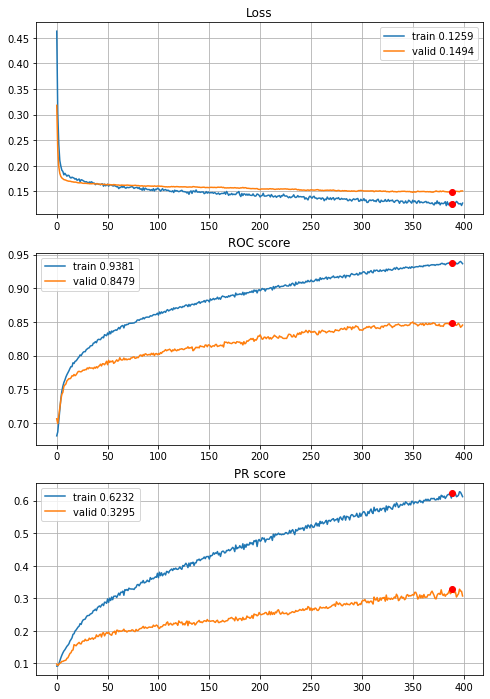


Fold 2------------------------------------------------------------


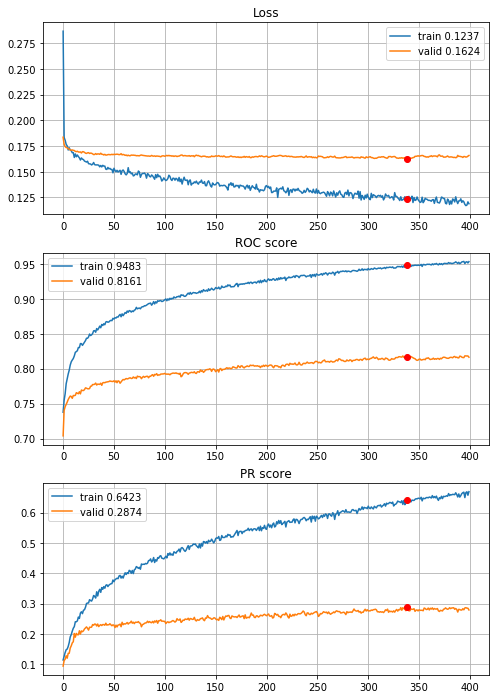


Fold 3------------------------------------------------------------


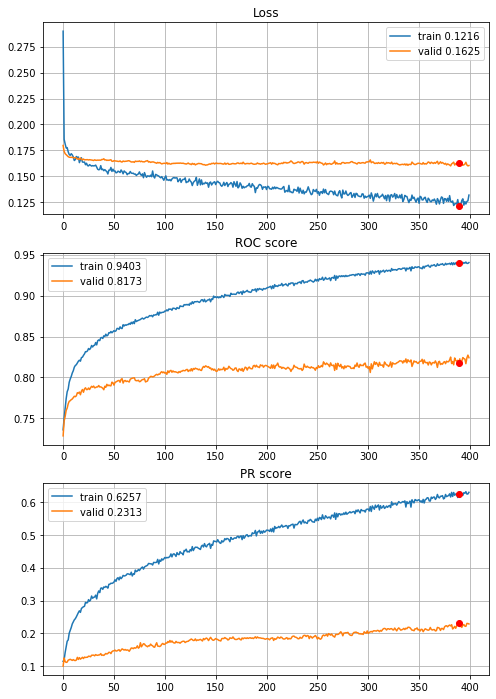


Fold 4------------------------------------------------------------


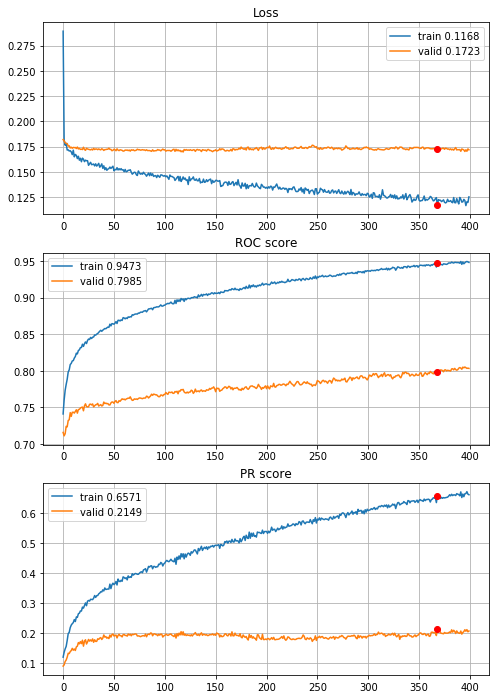


Fold 5------------------------------------------------------------


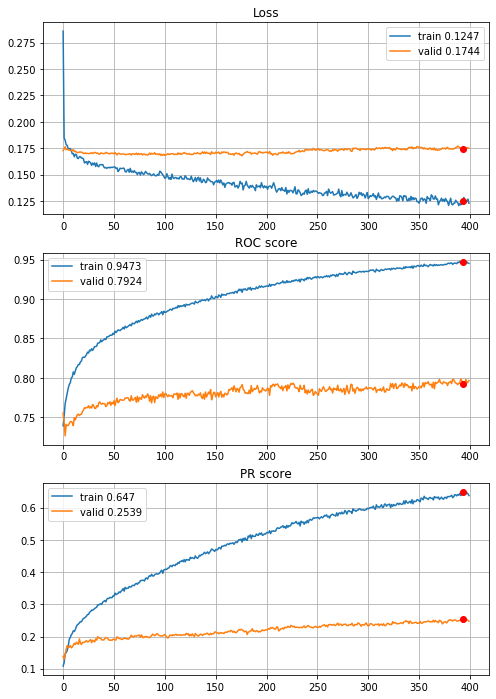


Fold 6------------------------------------------------------------


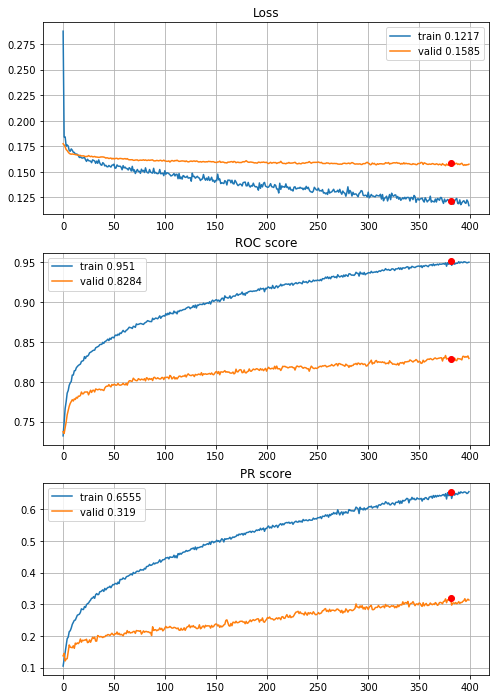

In [65]:
# normalization and quantile outliers reduction (Q_0.005 and Q_0.995)
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

What an improvement! +0.13 on PR compared to normalization only and +0.16 compared to raw data! Lets try power transform


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/400,
cumulative time: 5.36s train loss: 0.47309836596174853, validation loss: 0.3339897617697716
Epoch: 2/400,
cumulative time: 5.54s train loss: 0.31890016379484737, validation loss: 0.24231011420488358
Epoch: 3/400,
cumulative time: 5.72s train loss: 0.25066846789609604, validation loss: 0.20319252833724022
Epoch: 4/400,
cumulative time: 5.86s train loss: 0.21532302204880877, validation loss: 0.186234250664711
Epoch: 5/400,
cumulative time: 6.03s train loss: 0.20105725748170264, validation loss: 0.17738424614071846
Epoch: 6/400,
cumulative time: 6.16s train loss: 0.1898974725298315, validation loss: 0.17254512384533882
Epoch: 7/400,
cumulative time: 6.31s train loss: 0.18664665892909418, validation loss: 0.1697789616882801
Epoch: 8/400,
cumulative time: 6.48s train loss: 0.17954353921573254, validation loss: 0.16720962896943092
Epoch: 9/400,
cumulative time: 6.67s train loss: 0.18216763922652354, 

Epoch: 77/400,
cumulative time: 17.28s train loss: 0.1503663974354841, validation loss: 0.1481018252670765
Epoch: 78/400,
cumulative time: 17.43s train loss: 0.15138874707555275, validation loss: 0.14836831390857697
Epoch: 79/400,
cumulative time: 17.59s train loss: 0.14961496365401816, validation loss: 0.14843743853271008
Epoch: 80/400,
cumulative time: 17.74s train loss: 0.14820226188039587, validation loss: 0.14820672944188118
Epoch: 81/400,
cumulative time: 17.9s train loss: 0.1496696336135276, validation loss: 0.14874193631112576
Epoch: 82/400,
cumulative time: 18.05s train loss: 0.14881962399462445, validation loss: 0.1479301769286394
Epoch: 83/400,
cumulative time: 18.21s train loss: 0.14757498385694015, validation loss: 0.1478213258087635
Epoch: 84/400,
cumulative time: 18.36s train loss: 0.14757087383818482, validation loss: 0.14763711020350456
Epoch: 85/400,
cumulative time: 18.51s train loss: 0.14461055084109428, validation loss: 0.14792894385755062
Epoch: 86/400,
cumulative

Epoch: 153/400,
cumulative time: 28.97s train loss: 0.13348127660327844, validation loss: 0.13888986594974995
Epoch: 154/400,
cumulative time: 29.1s train loss: 0.1320206023972158, validation loss: 0.13969087414443493
Epoch: 155/400,
cumulative time: 29.27s train loss: 0.13030564411907042, validation loss: 0.1401990707963705
Epoch: 156/400,
cumulative time: 29.41s train loss: 0.13537190870252766, validation loss: 0.13840862177312374
Epoch: 157/400,
cumulative time: 29.57s train loss: 0.13055287921539172, validation loss: 0.13909552991390228
Epoch: 158/400,
cumulative time: 29.71s train loss: 0.13132553634556826, validation loss: 0.1384250745177269
Epoch: 159/400,
cumulative time: 29.88s train loss: 0.13343680399498883, validation loss: 0.13987146876752377
Epoch: 160/400,
cumulative time: 30.05s train loss: 0.13305026893312402, validation loss: 0.13902554474771023
Epoch: 161/400,
cumulative time: 30.2s train loss: 0.12955813155849613, validation loss: 0.13825612515211105
Epoch: 162/400,

Epoch: 229/400,
cumulative time: 41.19s train loss: 0.12005555790642332, validation loss: 0.13226267509162426
Epoch: 230/400,
cumulative time: 41.35s train loss: 0.11943573555012776, validation loss: 0.13189610093832016
Epoch: 231/400,
cumulative time: 41.52s train loss: 0.12134065676372689, validation loss: 0.13195755146443844
Epoch: 232/400,
cumulative time: 41.68s train loss: 0.12193948241994125, validation loss: 0.1315982062369585
Epoch: 233/400,
cumulative time: 41.84s train loss: 0.12234891248973812, validation loss: 0.13229702413082123
Epoch: 234/400,
cumulative time: 41.99s train loss: 0.12299237392914665, validation loss: 0.13136430829763412
Epoch: 235/400,
cumulative time: 42.15s train loss: 0.12088824877465298, validation loss: 0.1319284588098526
Epoch: 236/400,
cumulative time: 42.3s train loss: 0.11916948744810554, validation loss: 0.13179595954716206
Epoch: 237/400,
cumulative time: 42.45s train loss: 0.12108728248548423, validation loss: 0.1317046508193016
Epoch: 238/400

Epoch: 304/400,
cumulative time: 53.37s train loss: 0.11560157636334716, validation loss: 0.12618296034634113
Epoch: 305/400,
cumulative time: 53.52s train loss: 0.11430729615349283, validation loss: 0.12640458904206753
Epoch: 306/400,
cumulative time: 53.7s train loss: 0.1095159454294847, validation loss: 0.12673054076731205
Epoch: 307/400,
cumulative time: 53.86s train loss: 0.10805191358843692, validation loss: 0.12583407573401928
Epoch: 308/400,
cumulative time: 54.02s train loss: 0.11046650607295906, validation loss: 0.12658579275012016
Epoch: 309/400,
cumulative time: 54.17s train loss: 0.10966102787236262, validation loss: 0.12576824426651
Epoch: 310/400,
cumulative time: 54.33s train loss: 0.10903184618961696, validation loss: 0.1262317094951868
Epoch: 311/400,
cumulative time: 54.5s train loss: 0.11107897754510748, validation loss: 0.12461800500750542
Epoch: 312/400,
cumulative time: 54.65s train loss: 0.11335060033529104, validation loss: 0.1249762624502182
Epoch: 313/400,
cu

Epoch: 380/400,
cumulative time: 65.52s train loss: 0.10329596406163874, validation loss: 0.12559754960238934
Epoch: 381/400,
cumulative time: 65.69s train loss: 0.10583782151772808, validation loss: 0.12355947494506836
Epoch: 382/400,
cumulative time: 65.84s train loss: 0.10633816952032447, validation loss: 0.12326282076537609
Epoch: 383/400,
cumulative time: 66.0s train loss: 0.10381473449506755, validation loss: 0.12318182922899723
Epoch: 384/400,
cumulative time: 66.15s train loss: 0.09946609124420197, validation loss: 0.12181001901626587
Epoch: 385/400,
cumulative time: 66.32s train loss: 0.10408285558753476, validation loss: 0.12234275415539742
Epoch: 386/400,
cumulative time: 66.47s train loss: 0.10164900182534924, validation loss: 0.12201111391186714
Epoch: 387/400,
cumulative time: 66.63s train loss: 0.1043837119845523, validation loss: 0.12093516625463963
Epoch: 388/400,
cumulative time: 66.78s train loss: 0.10447646751659301, validation loss: 0.12224618904292583
Epoch: 389/4

Epoch: 55/400,
cumulative time: 13.52s train loss: 0.1481125605131328, validation loss: 0.15085000358521938
Epoch: 56/400,
cumulative time: 13.69s train loss: 0.14559976655163095, validation loss: 0.15077240578830242
Epoch: 57/400,
cumulative time: 13.86s train loss: 0.14256878178084242, validation loss: 0.1502075381577015
Epoch: 58/400,
cumulative time: 14.03s train loss: 0.1400352313512924, validation loss: 0.1503679696470499
Epoch: 59/400,
cumulative time: 14.19s train loss: 0.1449401025400663, validation loss: 0.14957691729068756
Epoch: 60/400,
cumulative time: 14.35s train loss: 0.14342504983447177, validation loss: 0.14962155930697918
Epoch: 61/400,
cumulative time: 14.51s train loss: 0.14231706767282915, validation loss: 0.1494335513561964
Epoch: 62/400,
cumulative time: 14.67s train loss: 0.1414163678831531, validation loss: 0.148908955976367
Epoch: 63/400,
cumulative time: 14.82s train loss: 0.14112211782589304, validation loss: 0.1494282614439726
Epoch: 64/400,
cumulative tim

Epoch: 132/400,
cumulative time: 25.81s train loss: 0.12644902841505393, validation loss: 0.14034238457679749
Epoch: 133/400,
cumulative time: 25.97s train loss: 0.1260856540543498, validation loss: 0.13994502276182175
Epoch: 134/400,
cumulative time: 26.12s train loss: 0.12551721942234065, validation loss: 0.14052795246243477
Epoch: 135/400,
cumulative time: 26.26s train loss: 0.12635045663778585, validation loss: 0.14072177186608315
Epoch: 136/400,
cumulative time: 26.43s train loss: 0.1256524257611629, validation loss: 0.14067787304520607
Epoch: 137/400,
cumulative time: 26.58s train loss: 0.12491717290203241, validation loss: 0.14049026742577553
Epoch: 138/400,
cumulative time: 26.75s train loss: 0.12418154922232161, validation loss: 0.14069338329136372
Epoch: 139/400,
cumulative time: 26.9s train loss: 0.12276367650548475, validation loss: 0.14059455320239067
Epoch: 140/400,
cumulative time: 27.06s train loss: 0.12721238879571112, validation loss: 0.14037350192666054
Epoch: 141/40

Epoch: 208/400,
cumulative time: 37.87s train loss: 0.11633439796445574, validation loss: 0.1358811017125845
Epoch: 209/400,
cumulative time: 38.02s train loss: 0.11311484633014553, validation loss: 0.13564896397292614
Epoch: 210/400,
cumulative time: 38.18s train loss: 0.11383611005539365, validation loss: 0.1352446023374796
Epoch: 211/400,
cumulative time: 38.33s train loss: 0.11347805849031, validation loss: 0.13579127192497253
Epoch: 212/400,
cumulative time: 38.5s train loss: 0.1119494703822992, validation loss: 0.13470556773245335
Epoch: 213/400,
cumulative time: 38.65s train loss: 0.11531665615468778, validation loss: 0.13409717939794064
Epoch: 214/400,
cumulative time: 38.81s train loss: 0.11346426660477843, validation loss: 0.13475124910473824
Epoch: 215/400,
cumulative time: 38.97s train loss: 0.11323744240994983, validation loss: 0.13519519567489624
Epoch: 216/400,
cumulative time: 39.14s train loss: 0.11586481332022143, validation loss: 0.13579518720507622
Epoch: 217/400,
c

Epoch: 284/400,
cumulative time: 49.97s train loss: 0.1085516136289097, validation loss: 0.12817896530032158
Epoch: 285/400,
cumulative time: 50.14s train loss: 0.10763435103396524, validation loss: 0.1275990605354309
Epoch: 286/400,
cumulative time: 50.3s train loss: 0.10454056403846108, validation loss: 0.12887116894125938
Epoch: 287/400,
cumulative time: 50.44s train loss: 0.10313954578174317, validation loss: 0.1293590273708105
Epoch: 288/400,
cumulative time: 50.58s train loss: 0.10626861944779518, validation loss: 0.1295957136899233
Epoch: 289/400,
cumulative time: 50.75s train loss: 0.10698897995663936, validation loss: 0.1289369948208332
Epoch: 290/400,
cumulative time: 50.9s train loss: 0.10630187239741964, validation loss: 0.12941287644207478
Epoch: 291/400,
cumulative time: 51.07s train loss: 0.10791024293252936, validation loss: 0.12878574430942535
Epoch: 292/400,
cumulative time: 51.23s train loss: 0.10284624989449584, validation loss: 0.12947271391749382
Epoch: 293/400,
c

Epoch: 360/400,
cumulative time: 62.1s train loss: 0.1022355301866621, validation loss: 0.12471847608685493
Epoch: 361/400,
cumulative time: 62.26s train loss: 0.10368065050164112, validation loss: 0.12394249625504017
Epoch: 362/400,
cumulative time: 62.42s train loss: 0.10065813542524832, validation loss: 0.12364604696631432
Epoch: 363/400,
cumulative time: 62.57s train loss: 0.10228733195832927, validation loss: 0.1241814885288477
Epoch: 364/400,
cumulative time: 62.73s train loss: 0.09842074434464507, validation loss: 0.12434366531670094
Epoch: 365/400,
cumulative time: 62.89s train loss: 0.09919200785772155, validation loss: 0.12405142933130264
Epoch: 366/400,
cumulative time: 63.05s train loss: 0.10086856236508226, validation loss: 0.12446855753660202
Epoch: 367/400,
cumulative time: 63.21s train loss: 0.10287215263446071, validation loss: 0.12383230775594711
Epoch: 368/400,
cumulative time: 63.37s train loss: 0.10070461560553437, validation loss: 0.12373683042824268
Epoch: 369/40

Epoch: 33/400,
cumulative time: 10.89s train loss: 0.15637760900052744, validation loss: 0.15459151497909002
Epoch: 34/400,
cumulative time: 11.07s train loss: 0.15467184801134676, validation loss: 0.1537532842632324
Epoch: 35/400,
cumulative time: 11.23s train loss: 0.15326189027191858, validation loss: 0.15387403963104127
Epoch: 36/400,
cumulative time: 11.39s train loss: 0.15399808966411285, validation loss: 0.15360838537178342
Epoch: 37/400,
cumulative time: 11.55s train loss: 0.15040081574845104, validation loss: 0.15357413316529894
Epoch: 38/400,
cumulative time: 11.72s train loss: 0.154411649373305, validation loss: 0.15322817388035
Epoch: 39/400,
cumulative time: 11.87s train loss: 0.1523141400703882, validation loss: 0.1535570536340986
Epoch: 40/400,
cumulative time: 12.04s train loss: 0.1527983715547982, validation loss: 0.1531920506083776
Epoch: 41/400,
cumulative time: 12.21s train loss: 0.15079393860681478, validation loss: 0.15303330028813983
Epoch: 42/400,
cumulative tim

Epoch: 109/400,
cumulative time: 23.28s train loss: 0.13310826235243067, validation loss: 0.13735134729317255
Epoch: 110/400,
cumulative time: 23.43s train loss: 0.13246964035307193, validation loss: 0.13693731523695446
Epoch: 111/400,
cumulative time: 23.59s train loss: 0.13317203183865448, validation loss: 0.13711381939668504
Epoch: 112/400,
cumulative time: 23.74s train loss: 0.13263313566479146, validation loss: 0.1367683118960214
Epoch: 113/400,
cumulative time: 23.88s train loss: 0.13239362763241644, validation loss: 0.1366033246119817
Epoch: 114/400,
cumulative time: 24.05s train loss: 0.12797336474532053, validation loss: 0.13573354846901364
Epoch: 115/400,
cumulative time: 24.21s train loss: 0.13310617064803903, validation loss: 0.13539054810054718
Epoch: 116/400,
cumulative time: 24.37s train loss: 0.1346065898326443, validation loss: 0.1371846881272301
Epoch: 117/400,
cumulative time: 24.53s train loss: 0.12919825626665132, validation loss: 0.1355839660527214
Epoch: 118/400,

Epoch: 184/400,
cumulative time: 35.42s train loss: 0.12101616000457964, validation loss: 0.13112035602804215
Epoch: 185/400,
cumulative time: 35.58s train loss: 0.12090874476845652, validation loss: 0.13070540411131723
Epoch: 186/400,
cumulative time: 35.74s train loss: 0.12236460590193807, validation loss: 0.13146382881535423
Epoch: 187/400,
cumulative time: 35.9s train loss: 0.1195978224939602, validation loss: 0.13211557305994487
Epoch: 188/400,
cumulative time: 36.07s train loss: 0.1194299877889268, validation loss: 0.1300132430829699
Epoch: 189/400,
cumulative time: 36.22s train loss: 0.11613202814267677, validation loss: 0.12980672721824948
Epoch: 190/400,
cumulative time: 36.41s train loss: 0.11689639546263712, validation loss: 0.13094858457171726
Epoch: 191/400,
cumulative time: 36.56s train loss: 0.11978155137114799, validation loss: 0.12920497514898815
Epoch: 192/400,
cumulative time: 36.71s train loss: 0.11661600077214301, validation loss: 0.13156611393368434
Epoch: 193/400

Epoch: 260/400,
cumulative time: 47.56s train loss: 0.11375306308519209, validation loss: 0.12829914145053378
Epoch: 261/400,
cumulative time: 47.71s train loss: 0.10900239551848259, validation loss: 0.12918949122466739
Epoch: 262/400,
cumulative time: 47.88s train loss: 0.11276176543375464, validation loss: 0.12858467266673135
Epoch: 263/400,
cumulative time: 48.03s train loss: 0.1146493738606313, validation loss: 0.12882958960911584
Epoch: 264/400,
cumulative time: 48.2s train loss: 0.11154476482923888, validation loss: 0.1271843417296334
Epoch: 265/400,
cumulative time: 48.35s train loss: 0.11128677599821597, validation loss: 0.1271953073002043
Epoch: 266/400,
cumulative time: 48.51s train loss: 0.11419947784106955, validation loss: 0.12754497058807857
Epoch: 267/400,
cumulative time: 48.66s train loss: 0.11028650004908082, validation loss: 0.12769391766616275
Epoch: 268/400,
cumulative time: 48.83s train loss: 0.10817170322841839, validation loss: 0.12978041422745537
Epoch: 269/400

Epoch: 336/400,
cumulative time: 59.68s train loss: 0.10591694395773996, validation loss: 0.12617254446423243
Epoch: 337/400,
cumulative time: 59.86s train loss: 0.10825771601203585, validation loss: 0.12672176216329847
Epoch: 338/400,
cumulative time: 60.02s train loss: 0.1057711460516358, validation loss: 0.12886472471176633
Epoch: 339/400,
cumulative time: 60.17s train loss: 0.10873233414387148, validation loss: 0.1272795105548132
Epoch: 340/400,
cumulative time: 60.33s train loss: 0.10591024903456875, validation loss: 0.12887811265294513
Epoch: 341/400,
cumulative time: 60.5s train loss: 0.10599742224824237, validation loss: 0.12919975778413198
Epoch: 342/400,
cumulative time: 60.65s train loss: 0.10224100994767915, validation loss: 0.12902392100720178
Epoch: 343/400,
cumulative time: 60.82s train loss: 0.10209750761492567, validation loss: 0.12945075217693572
Epoch: 344/400,
cumulative time: 60.97s train loss: 0.10107296898202484, validation loss: 0.12960479584951248
Epoch: 345/40

Epoch: 9/400,
cumulative time: 7.36s train loss: 0.1634321512191659, validation loss: 0.17584253506054953
Epoch: 10/400,
cumulative time: 7.52s train loss: 0.16181984976628294, validation loss: 0.17555289602468885
Epoch: 11/400,
cumulative time: 7.68s train loss: 0.16322722410367227, validation loss: 0.1763675964635516
Epoch: 12/400,
cumulative time: 7.83s train loss: 0.1592540351402734, validation loss: 0.17704779660890974
Epoch: 13/400,
cumulative time: 7.98s train loss: 0.1603792442636198, validation loss: 0.17675232761436038
Epoch: 14/400,
cumulative time: 8.15s train loss: 0.16006233037970946, validation loss: 0.17603090241787925
Epoch: 15/400,
cumulative time: 8.32s train loss: 0.15618773214296747, validation loss: 0.1773824466031695
Epoch: 16/400,
cumulative time: 8.46s train loss: 0.1565885714041153, validation loss: 0.17571830866828797
Epoch: 17/400,
cumulative time: 8.64s train loss: 0.1557158722904138, validation loss: 0.17582648763580927
Epoch: 18/400,
cumulative time: 8.8s

Epoch: 85/400,
cumulative time: 19.65s train loss: 0.1337305375490604, validation loss: 0.16330636095433007
Epoch: 86/400,
cumulative time: 19.82s train loss: 0.13143024484628013, validation loss: 0.16296758108668857
Epoch: 87/400,
cumulative time: 19.99s train loss: 0.13404604903828662, validation loss: 0.16348672144942814
Epoch: 88/400,
cumulative time: 20.15s train loss: 0.1316838736433176, validation loss: 0.16428327984280056
Epoch: 89/400,
cumulative time: 20.32s train loss: 0.13262181002559192, validation loss: 0.16435092321463993
Epoch: 90/400,
cumulative time: 20.47s train loss: 0.1294270362764109, validation loss: 0.16325708410096548
Epoch: 91/400,
cumulative time: 20.64s train loss: 0.13075847727772366, validation loss: 0.16459082447347187
Epoch: 92/400,
cumulative time: 20.79s train loss: 0.13103028295933633, validation loss: 0.16370133679064494
Epoch: 93/400,
cumulative time: 20.96s train loss: 0.13104203321447344, validation loss: 0.1627474924685463
Epoch: 94/400,
cumulati

Epoch: 161/400,
cumulative time: 31.95s train loss: 0.11900980806719974, validation loss: 0.16053576478882442
Epoch: 162/400,
cumulative time: 32.11s train loss: 0.11909461116482797, validation loss: 0.16019761879292746
Epoch: 163/400,
cumulative time: 32.28s train loss: 0.11669110710039438, validation loss: 0.16116139279471503
Epoch: 164/400,
cumulative time: 32.44s train loss: 0.12161293589415792, validation loss: 0.15973270529792422
Epoch: 165/400,
cumulative time: 32.61s train loss: 0.11823717557235283, validation loss: 0.16018641359276242
Epoch: 166/400,
cumulative time: 32.76s train loss: 0.11590817842055082, validation loss: 0.15981379704816
Epoch: 167/400,
cumulative time: 32.94s train loss: 0.11908560442874558, validation loss: 0.15748592193164523
Epoch: 168/400,
cumulative time: 33.09s train loss: 0.11952051174917605, validation loss: 0.15840681310683963
Epoch: 169/400,
cumulative time: 33.26s train loss: 0.11840797196688257, validation loss: 0.15977848490079244
Epoch: 170/40

Epoch: 237/400,
cumulative time: 44.21s train loss: 0.10811457395935718, validation loss: 0.15573777189330448
Epoch: 238/400,
cumulative time: 44.36s train loss: 0.10576353434383892, validation loss: 0.15655783091272626
Epoch: 239/400,
cumulative time: 44.52s train loss: 0.11088222451389812, validation loss: 0.15637024248403217
Epoch: 240/400,
cumulative time: 44.66s train loss: 0.10936875064368173, validation loss: 0.1558513535015167
Epoch: 241/400,
cumulative time: 44.8s train loss: 0.10978255930555432, validation loss: 0.1548071447251335
Epoch: 242/400,
cumulative time: 44.95s train loss: 0.10557398840858805, validation loss: 0.15517053372330136
Epoch: 243/400,
cumulative time: 45.09s train loss: 0.10681432670307928, validation loss: 0.15656543865090325
Epoch: 244/400,
cumulative time: 45.23s train loss: 0.1081492889025073, validation loss: 0.15552311504644062
Epoch: 245/400,
cumulative time: 45.4s train loss: 0.10723580466364639, validation loss: 0.15495919734712632
Epoch: 246/400,

Epoch: 312/400,
cumulative time: 56.02s train loss: 0.10168928570049403, validation loss: 0.15615839540958404
Epoch: 313/400,
cumulative time: 56.19s train loss: 0.10098666958042672, validation loss: 0.154971021224582
Epoch: 314/400,
cumulative time: 56.34s train loss: 0.10205488702500096, validation loss: 0.15612598936709146
Epoch: 315/400,
cumulative time: 56.51s train loss: 0.10286409340981406, validation loss: 0.15554999079969195
Epoch: 316/400,
cumulative time: 56.67s train loss: 0.09869138542333351, validation loss: 0.15521227952033753
Epoch: 317/400,
cumulative time: 56.84s train loss: 0.09998295640331001, validation loss: 0.15605857048715863
Epoch: 318/400,
cumulative time: 57.0s train loss: 0.0984071824589447, validation loss: 0.15562888205051423
Epoch: 319/400,
cumulative time: 57.16s train loss: 0.1007387927782192, validation loss: 0.15632789516259754
Epoch: 320/400,
cumulative time: 57.33s train loss: 0.10034466324397963, validation loss: 0.1554179724152126
Epoch: 321/400,


Epoch: 387/400,
cumulative time: 68.19s train loss: 0.09577258608377387, validation loss: 0.15687892519292376
Epoch: 388/400,
cumulative time: 68.35s train loss: 0.09558675196780853, validation loss: 0.1579995453641528
Epoch: 389/400,
cumulative time: 68.51s train loss: 0.09561220288250188, validation loss: 0.1585220097738599
Epoch: 390/400,
cumulative time: 68.68s train loss: 0.09112429309253751, validation loss: 0.15758893119910405
Epoch: 391/400,
cumulative time: 68.85s train loss: 0.0958571959723445, validation loss: 0.1587782607192085
Epoch: 392/400,
cumulative time: 69.0s train loss: 0.09183272172105604, validation loss: 0.15690916872213756
Epoch: 393/400,
cumulative time: 69.16s train loss: 0.09893434507692164, validation loss: 0.1580684318996611
Epoch: 394/400,
cumulative time: 69.33s train loss: 0.09780607520739439, validation loss: 0.15712961489246005
Epoch: 395/400,
cumulative time: 69.5s train loss: 0.09036779365000634, validation loss: 0.15722098228477296
Epoch: 396/400,
c

Epoch: 61/400,
cumulative time: 15.28s train loss: 0.1445518547097514, validation loss: 0.15298177647212194
Epoch: 62/400,
cumulative time: 15.44s train loss: 0.1406012034717362, validation loss: 0.152802976578001
Epoch: 63/400,
cumulative time: 15.6s train loss: 0.13961074463535994, validation loss: 0.1535314170708732
Epoch: 64/400,
cumulative time: 15.76s train loss: 0.14285793476363828, validation loss: 0.15261416890318433
Epoch: 65/400,
cumulative time: 15.91s train loss: 0.1441022535542236, validation loss: 0.15290129986074236
Epoch: 66/400,
cumulative time: 16.06s train loss: 0.139219743755697, validation loss: 0.15191270774319057
Epoch: 67/400,
cumulative time: 16.23s train loss: 0.1435004514029021, validation loss: 0.15270220170891474
Epoch: 68/400,
cumulative time: 16.38s train loss: 0.13679763402516004, validation loss: 0.15182077157118964
Epoch: 69/400,
cumulative time: 16.53s train loss: 0.1395157575493796, validation loss: 0.1524780594829529
Epoch: 70/400,
cumulative time:

Epoch: 137/400,
cumulative time: 27.12s train loss: 0.12083902147002551, validation loss: 0.15006106062540933
Epoch: 138/400,
cumulative time: 27.28s train loss: 0.12440707797407574, validation loss: 0.1500255934302769
Epoch: 139/400,
cumulative time: 27.44s train loss: 0.12591054050188705, validation loss: 0.1489566143826833
Epoch: 140/400,
cumulative time: 27.58s train loss: 0.1223179087264141, validation loss: 0.14950738690202198
Epoch: 141/400,
cumulative time: 27.75s train loss: 0.12389461489287187, validation loss: 0.1495623963409
Epoch: 142/400,
cumulative time: 27.91s train loss: 0.12446429015863089, validation loss: 0.1492453154117342
Epoch: 143/400,
cumulative time: 28.06s train loss: 0.12574614358005812, validation loss: 0.149916924768024
Epoch: 144/400,
cumulative time: 28.22s train loss: 0.12467350576759156, validation loss: 0.14950077422081479
Epoch: 145/400,
cumulative time: 28.37s train loss: 0.12633315512953758, validation loss: 0.15000717088343604
Epoch: 146/400,
cumu

Epoch: 213/400,
cumulative time: 38.94s train loss: 0.1127635535456678, validation loss: 0.14809619888426764
Epoch: 214/400,
cumulative time: 39.11s train loss: 0.11379888450772505, validation loss: 0.14733173648516337
Epoch: 215/400,
cumulative time: 39.26s train loss: 0.10845106521850009, validation loss: 0.14561430105141232
Epoch: 216/400,
cumulative time: 39.42s train loss: 0.11138454450596343, validation loss: 0.14593093281700498
Epoch: 217/400,
cumulative time: 39.58s train loss: 0.11470465669761958, validation loss: 0.1477929437160492
Epoch: 218/400,
cumulative time: 39.73s train loss: 0.11217326600418125, validation loss: 0.147228246350137
Epoch: 219/400,
cumulative time: 39.88s train loss: 0.11191981997195727, validation loss: 0.14815800880628918
Epoch: 220/400,
cumulative time: 40.05s train loss: 0.11419097059750989, validation loss: 0.14779542512363858
Epoch: 221/400,
cumulative time: 40.19s train loss: 0.11095754168024369, validation loss: 0.14806496082790313
Epoch: 222/400

Epoch: 289/400,
cumulative time: 50.8s train loss: 0.10699812162909181, validation loss: 0.14395293029527814
Epoch: 290/400,
cumulative time: 50.97s train loss: 0.10491741114372043, validation loss: 0.14550646138569664
Epoch: 291/400,
cumulative time: 51.11s train loss: 0.1061801110519981, validation loss: 0.14499192824439397
Epoch: 292/400,
cumulative time: 51.28s train loss: 0.1092827580609085, validation loss: 0.14354963104876262
Epoch: 293/400,
cumulative time: 51.43s train loss: 0.10688117861755309, validation loss: 0.14390156342869714
Epoch: 294/400,
cumulative time: 51.58s train loss: 0.10598934769263436, validation loss: 0.14512636625577532
Epoch: 295/400,
cumulative time: 51.75s train loss: 0.10456411903815113, validation loss: 0.14530374924341838
Epoch: 296/400,
cumulative time: 51.9s train loss: 0.10669620963062022, validation loss: 0.14592599222584376
Epoch: 297/400,
cumulative time: 52.05s train loss: 0.10899949782622924, validation loss: 0.14395091291457887
Epoch: 298/400

Epoch: 365/400,
cumulative time: 62.67s train loss: 0.09931339531611016, validation loss: 0.14393401663454752
Epoch: 366/400,
cumulative time: 62.84s train loss: 0.09664374350710722, validation loss: 0.1448747836408161
Epoch: 367/400,
cumulative time: 62.99s train loss: 0.10059867959606235, validation loss: 0.14554053351992652
Epoch: 368/400,
cumulative time: 63.14s train loss: 0.10076240609900455, validation loss: 0.14606124666948167
Epoch: 369/400,
cumulative time: 63.31s train loss: 0.10104072097368738, validation loss: 0.14537106280289
Epoch: 370/400,
cumulative time: 63.45s train loss: 0.0995944672120742, validation loss: 0.1477375265624788
Epoch: 371/400,
cumulative time: 63.62s train loss: 0.10159076062918193, validation loss: 0.14535753830084724
Epoch: 372/400,
cumulative time: 63.77s train loss: 0.09990662101585732, validation loss: 0.14586754639943442
Epoch: 373/400,
cumulative time: 63.92s train loss: 0.10192827206075199, validation loss: 0.14509830545811425
Epoch: 374/400,


Epoch: 39/400,
cumulative time: 12.19s train loss: 0.1480172258620034, validation loss: 0.15877332665617505
Epoch: 40/400,
cumulative time: 12.34s train loss: 0.14976449166156774, validation loss: 0.15871208475695717
Epoch: 41/400,
cumulative time: 12.5s train loss: 0.15047506922973025, validation loss: 0.1586586881535394
Epoch: 42/400,
cumulative time: 12.66s train loss: 0.15016311895912396, validation loss: 0.15823449879411666
Epoch: 43/400,
cumulative time: 12.81s train loss: 0.14837039260259208, validation loss: 0.1578758715542536
Epoch: 44/400,
cumulative time: 12.97s train loss: 0.1466387167083017, validation loss: 0.15835137766505045
Epoch: 45/400,
cumulative time: 13.13s train loss: 0.1444535808895723, validation loss: 0.1578654204663776
Epoch: 46/400,
cumulative time: 13.29s train loss: 0.14472444037866272, validation loss: 0.15771955161813705
Epoch: 47/400,
cumulative time: 13.44s train loss: 0.14739157019403662, validation loss: 0.15766304607429202
Epoch: 48/400,
cumulative 

Epoch: 115/400,
cumulative time: 24.15s train loss: 0.13253827972444723, validation loss: 0.14798956587201073
Epoch: 116/400,
cumulative time: 24.29s train loss: 0.12936455392362323, validation loss: 0.1480934921521989
Epoch: 117/400,
cumulative time: 24.45s train loss: 0.12824931433922115, validation loss: 0.14805900963525923
Epoch: 118/400,
cumulative time: 24.58s train loss: 0.1295796767174176, validation loss: 0.14885005084295122
Epoch: 119/400,
cumulative time: 24.73s train loss: 0.1283960238683643, validation loss: 0.14831194572978548
Epoch: 120/400,
cumulative time: 24.86s train loss: 0.12992621559478978, validation loss: 0.14779652143281605
Epoch: 121/400,
cumulative time: 25.01s train loss: 0.12900735525267976, validation loss: 0.14693906080155145
Epoch: 122/400,
cumulative time: 25.16s train loss: 0.1304030098088187, validation loss: 0.1475391642914878
Epoch: 123/400,
cumulative time: 25.31s train loss: 0.12864276685243453, validation loss: 0.14809634009050945
Epoch: 124/400,

Epoch: 191/400,
cumulative time: 35.93s train loss: 0.12097502668750336, validation loss: 0.14349493985138242
Epoch: 192/400,
cumulative time: 36.09s train loss: 0.11831803430404793, validation loss: 0.14373226890488278
Epoch: 193/400,
cumulative time: 36.26s train loss: 0.11340980986373231, validation loss: 0.14433012519563948
Epoch: 194/400,
cumulative time: 36.42s train loss: 0.12017952952611048, validation loss: 0.14365930434257265
Epoch: 195/400,
cumulative time: 36.57s train loss: 0.11863640560835347, validation loss: 0.14314271517216212
Epoch: 196/400,
cumulative time: 36.74s train loss: 0.11681454794326984, validation loss: 0.14400906916648623
Epoch: 197/400,
cumulative time: 36.89s train loss: 0.11755822267881336, validation loss: 0.1439413291310507
Epoch: 198/400,
cumulative time: 37.04s train loss: 0.119494065192125, validation loss: 0.14264483075293283
Epoch: 199/400,
cumulative time: 37.21s train loss: 0.11673668312102507, validation loss: 0.14235909170574612
Epoch: 200/40

Epoch: 267/400,
cumulative time: 48.01s train loss: 0.10964671488611533, validation loss: 0.13792526065357147
Epoch: 268/400,
cumulative time: 48.16s train loss: 0.10858319516455565, validation loss: 0.13928245456445784
Epoch: 269/400,
cumulative time: 48.31s train loss: 0.1111288028266113, validation loss: 0.14016622676735832
Epoch: 270/400,
cumulative time: 48.46s train loss: 0.10552249877218578, validation loss: 0.1406794558914881
Epoch: 271/400,
cumulative time: 48.63s train loss: 0.11128907025208461, validation loss: 0.13984192462194533
Epoch: 272/400,
cumulative time: 48.78s train loss: 0.11172599167906724, validation loss: 0.13923405421158624
Epoch: 273/400,
cumulative time: 48.93s train loss: 0.10620650204892416, validation loss: 0.13797999891969892
Epoch: 274/400,
cumulative time: 49.1s train loss: 0.10841378339379364, validation loss: 0.13745464861392975
Epoch: 275/400,
cumulative time: 49.24s train loss: 0.10857227279311496, validation loss: 0.1388033573305796
Epoch: 276/400

Epoch: 343/400,
cumulative time: 59.99s train loss: 0.10655473816893465, validation loss: 0.13699818628174917
Epoch: 344/400,
cumulative time: 60.15s train loss: 0.10161453335474663, validation loss: 0.13656176486658672
Epoch: 345/400,
cumulative time: 60.3s train loss: 0.10045795212644633, validation loss: 0.13763833787706165
Epoch: 346/400,
cumulative time: 60.47s train loss: 0.1033650088969699, validation loss: 0.13792925603806028
Epoch: 347/400,
cumulative time: 60.62s train loss: 0.10226317130476596, validation loss: 0.13746292099120125
Epoch: 348/400,
cumulative time: 60.78s train loss: 0.10608298863169958, validation loss: 0.13610338864818453
Epoch: 349/400,
cumulative time: 60.93s train loss: 0.09963075251476829, validation loss: 0.13535437869647193
Epoch: 350/400,
cumulative time: 61.1s train loss: 0.1005437270381948, validation loss: 0.13559924666843717
Epoch: 351/400,
cumulative time: 61.25s train loss: 0.09888122230106099, validation loss: 0.13607059129646845
Epoch: 352/400

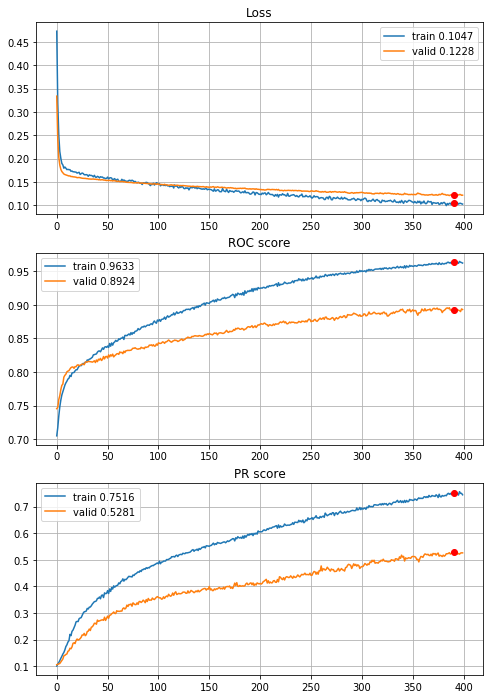


Fold 2------------------------------------------------------------


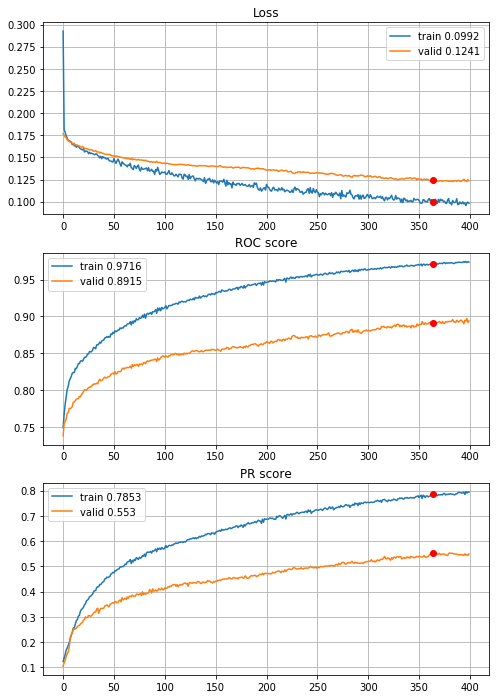


Fold 3------------------------------------------------------------


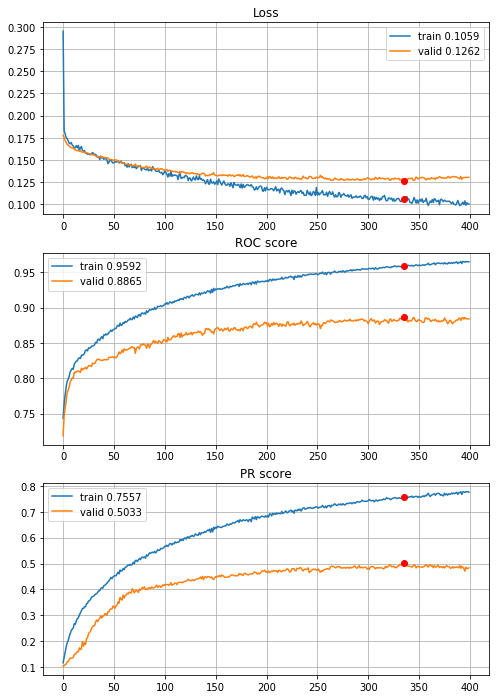


Fold 4------------------------------------------------------------


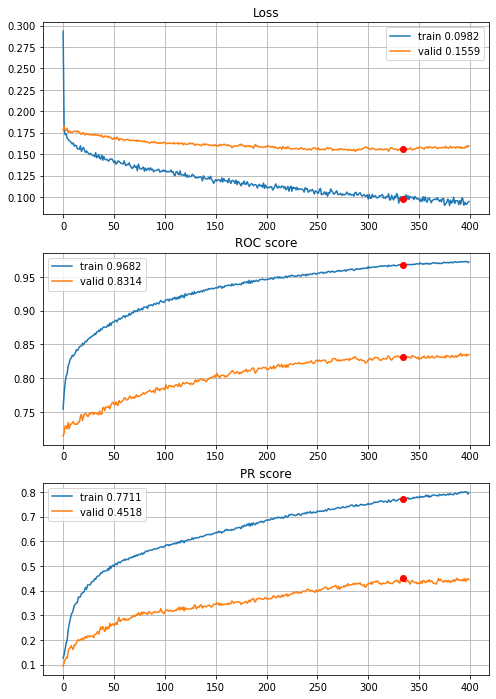


Fold 5------------------------------------------------------------


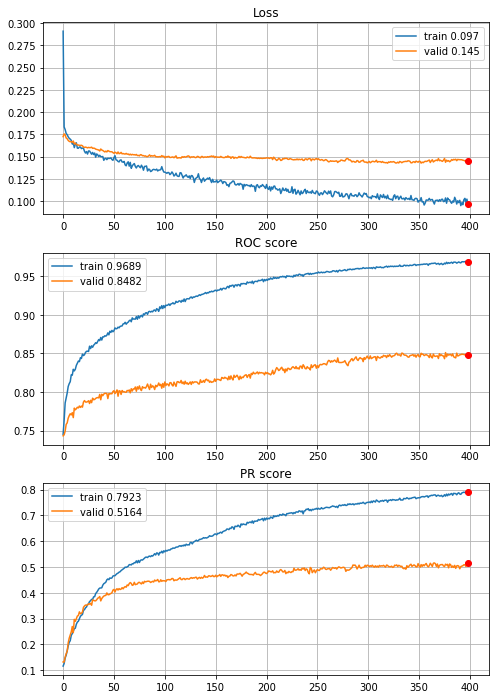


Fold 6------------------------------------------------------------


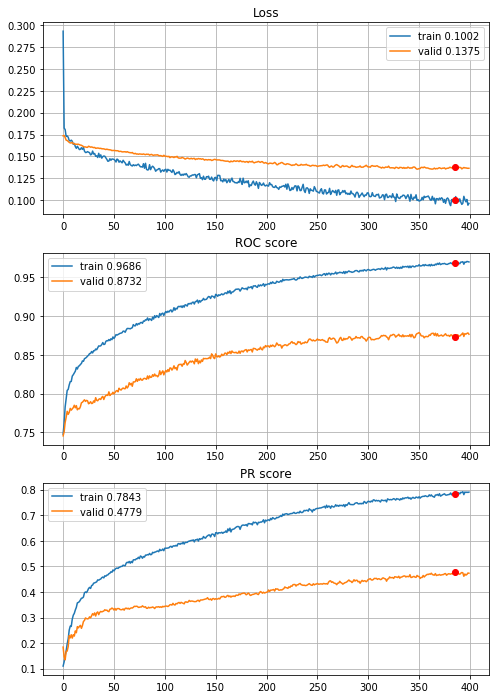

In [66]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.23 compared to the best preprocessing pipeline so far and + 0.39 to the raw data! It is incredible, further experiments will be performed with this pipeline of course. First, lets try more epochs, 3000 for example.


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/3000,
cumulative time: 6.51s train loss: 0.47309836596174853, validation loss: 0.3339897617697716
Epoch: 2/3000,
cumulative time: 6.67s train loss: 0.3189317580783591, validation loss: 0.2423473335802555
Epoch: 3/3000,
cumulative time: 6.85s train loss: 0.25069774145808177, validation loss: 0.20320845767855644
Epoch: 4/3000,
cumulative time: 6.99s train loss: 0.21533636320070182, validation loss: 0.18624144420027733
Epoch: 5/3000,
cumulative time: 7.13s train loss: 0.2010641456513068, validation loss: 0.17738793417811394
Epoch: 6/3000,
cumulative time: 7.27s train loss: 0.18990135372986705, validation loss: 0.17254722490906715
Epoch: 7/3000,
cumulative time: 7.44s train loss: 0.1866494810871814, validation loss: 0.1697838194668293
Epoch: 8/3000,
cumulative time: 7.57s train loss: 0.1795501342396133, validation loss: 0.16721844300627708
Epoch: 9/3000,
cumulative time: 7.73s train loss: 0.182177141426

Epoch: 77/3000,
cumulative time: 18.13s train loss: 0.15038022146181385, validation loss: 0.1481098122894764
Epoch: 78/3000,
cumulative time: 18.28s train loss: 0.15140482390922844, validation loss: 0.1483769714832306
Epoch: 79/3000,
cumulative time: 18.42s train loss: 0.149629633362869, validation loss: 0.14844593405723572
Epoch: 80/3000,
cumulative time: 18.56s train loss: 0.14821086290782937, validation loss: 0.1482151746749878
Epoch: 81/3000,
cumulative time: 18.72s train loss: 0.14967991721590743, validation loss: 0.14875025860965252
Epoch: 82/3000,
cumulative time: 18.88s train loss: 0.14882893407213138, validation loss: 0.14793802052736282
Epoch: 83/3000,
cumulative time: 19.02s train loss: 0.14758413788470415, validation loss: 0.14782938547432423
Epoch: 84/3000,
cumulative time: 19.18s train loss: 0.1475848557929844, validation loss: 0.14764460921287537
Epoch: 85/3000,
cumulative time: 19.34s train loss: 0.14462188125572392, validation loss: 0.14793582446873188
Epoch: 86/3000,


Epoch: 153/3000,
cumulative time: 29.72s train loss: 0.1335048570192181, validation loss: 0.13890618458390236
Epoch: 154/3000,
cumulative time: 29.88s train loss: 0.132039039625151, validation loss: 0.13970689475536346
Epoch: 155/3000,
cumulative time: 30.04s train loss: 0.13032738151716483, validation loss: 0.1402143146842718
Epoch: 156/3000,
cumulative time: 30.21s train loss: 0.13538263734371422, validation loss: 0.13842419162392616
Epoch: 157/3000,
cumulative time: 30.36s train loss: 0.13057666136270674, validation loss: 0.13911312632262707
Epoch: 158/3000,
cumulative time: 30.5s train loss: 0.13133963422708822, validation loss: 0.13843851909041405
Epoch: 159/3000,
cumulative time: 30.65s train loss: 0.1334506598499416, validation loss: 0.13988440111279488
Epoch: 160/3000,
cumulative time: 30.82s train loss: 0.13306705717994455, validation loss: 0.13904328644275665
Epoch: 161/3000,
cumulative time: 30.99s train loss: 0.12957950408058216, validation loss: 0.13827243447303772
Epoch: 

Epoch: 229/3000,
cumulative time: 41.7s train loss: 0.120050236069086, validation loss: 0.13228699378669262
Epoch: 230/3000,
cumulative time: 41.86s train loss: 0.11944697388254367, validation loss: 0.13192180544137955
Epoch: 231/3000,
cumulative time: 42.02s train loss: 0.12135082466642284, validation loss: 0.13198081962764263
Epoch: 232/3000,
cumulative time: 42.16s train loss: 0.12194395005899737, validation loss: 0.13161946833133698
Epoch: 233/3000,
cumulative time: 42.32s train loss: 0.12236365194419667, validation loss: 0.132319001480937
Epoch: 234/3000,
cumulative time: 42.48s train loss: 0.12299108022039708, validation loss: 0.13138658367097378
Epoch: 235/3000,
cumulative time: 42.64s train loss: 0.1209078851969957, validation loss: 0.13195171020925045
Epoch: 236/3000,
cumulative time: 42.78s train loss: 0.11916876209586662, validation loss: 0.13181918859481812
Epoch: 237/3000,
cumulative time: 42.95s train loss: 0.12109536185497376, validation loss: 0.13172235153615475
Epoch: 

Epoch: 305/3000,
cumulative time: 53.5s train loss: 0.11432735495356329, validation loss: 0.12644054740667343
Epoch: 306/3000,
cumulative time: 53.68s train loss: 0.10959185180270835, validation loss: 0.1267684157937765
Epoch: 307/3000,
cumulative time: 53.82s train loss: 0.10806043820674192, validation loss: 0.12587952241301537
Epoch: 308/3000,
cumulative time: 53.98s train loss: 0.11048175621193154, validation loss: 0.1266169510781765
Epoch: 309/3000,
cumulative time: 54.14s train loss: 0.10967770506996319, validation loss: 0.12580071948468685
Epoch: 310/3000,
cumulative time: 54.29s train loss: 0.10904774044812059, validation loss: 0.12625686079263687
Epoch: 311/3000,
cumulative time: 54.45s train loss: 0.1111131495800401, validation loss: 0.12464696541428566
Epoch: 312/3000,
cumulative time: 54.6s train loss: 0.11336906597116625, validation loss: 0.12501170113682747
Epoch: 313/3000,
cumulative time: 54.75s train loss: 0.1104357593440734, validation loss: 0.12430807389318943
Epoch: 

Epoch: 381/3000,
cumulative time: 65.33s train loss: 0.1058388336898864, validation loss: 0.12357756495475769
Epoch: 382/3000,
cumulative time: 65.49s train loss: 0.10637717386788072, validation loss: 0.12327095679938793
Epoch: 383/3000,
cumulative time: 65.64s train loss: 0.10383725254675832, validation loss: 0.12317851930856705
Epoch: 384/3000,
cumulative time: 65.79s train loss: 0.09947879179279141, validation loss: 0.1218079924583435
Epoch: 385/3000,
cumulative time: 65.94s train loss: 0.10406216679906227, validation loss: 0.12232591770589352
Epoch: 386/3000,
cumulative time: 66.11s train loss: 0.1016750400408217, validation loss: 0.1219987291842699
Epoch: 387/3000,
cumulative time: 66.26s train loss: 0.10439399953169105, validation loss: 0.12092041596770287
Epoch: 388/3000,
cumulative time: 66.41s train loss: 0.10449309962474797, validation loss: 0.12222582288086414
Epoch: 389/3000,
cumulative time: 66.57s train loss: 0.10150491370861606, validation loss: 0.12232800014317036
Epoch

Epoch: 457/3000,
cumulative time: 77.13s train loss: 0.09758806759808468, validation loss: 0.12099430337548256
Epoch: 458/3000,
cumulative time: 77.28s train loss: 0.09950448396114785, validation loss: 0.12069809064269066
Epoch: 459/3000,
cumulative time: 77.45s train loss: 0.09658501567598102, validation loss: 0.12089735083281994
Epoch: 460/3000,
cumulative time: 77.6s train loss: 0.10106836492172076, validation loss: 0.12093028612434864
Epoch: 461/3000,
cumulative time: 77.77s train loss: 0.09528629526821353, validation loss: 0.12011022306978703
Epoch: 462/3000,
cumulative time: 77.93s train loss: 0.1009571568566479, validation loss: 0.12054128386080265
Epoch: 463/3000,
cumulative time: 78.09s train loss: 0.09938987650435065, validation loss: 0.11975734867155552
Epoch: 464/3000,
cumulative time: 78.24s train loss: 0.09730236394801015, validation loss: 0.12052563391625881
Epoch: 465/3000,
cumulative time: 78.41s train loss: 0.09892018766361424, validation loss: 0.12037341482937336
Epo

Epoch: 533/3000,
cumulative time: 89.05s train loss: 0.09348508212176175, validation loss: 0.11778840236365795
Epoch: 534/3000,
cumulative time: 89.19s train loss: 0.0925436643036929, validation loss: 0.11797028034925461
Epoch: 535/3000,
cumulative time: 89.36s train loss: 0.09698755295030534, validation loss: 0.11782356724143028
Epoch: 536/3000,
cumulative time: 89.51s train loss: 0.10074210066656705, validation loss: 0.1174271497875452
Epoch: 537/3000,
cumulative time: 89.68s train loss: 0.094485881137191, validation loss: 0.11760814860463142
Epoch: 538/3000,
cumulative time: 89.84s train loss: 0.09810112694863925, validation loss: 0.11770669743418694
Epoch: 539/3000,
cumulative time: 89.99s train loss: 0.09675311235500024, validation loss: 0.11832834966480732
Epoch: 540/3000,
cumulative time: 90.16s train loss: 0.09474071332075197, validation loss: 0.1185230202972889
Epoch: 541/3000,
cumulative time: 90.31s train loss: 0.08990301282715984, validation loss: 0.1185495276004076
Epoch: 

Epoch: 608/3000,
cumulative time: 100.75s train loss: 0.09299452227496326, validation loss: 0.11716179735958576
Epoch: 609/3000,
cumulative time: 100.9s train loss: 0.09037484363130109, validation loss: 0.1172664575278759
Epoch: 610/3000,
cumulative time: 101.07s train loss: 0.09158014707596487, validation loss: 0.11702855862677097
Epoch: 611/3000,
cumulative time: 101.22s train loss: 0.08860608115186844, validation loss: 0.11789769865572453
Epoch: 612/3000,
cumulative time: 101.39s train loss: 0.09500896500460444, validation loss: 0.11773337051272392
Epoch: 613/3000,
cumulative time: 101.53s train loss: 0.09212720891249822, validation loss: 0.11770624294877052
Epoch: 614/3000,
cumulative time: 101.69s train loss: 0.09000736532222958, validation loss: 0.1177461426705122
Epoch: 615/3000,
cumulative time: 101.88s train loss: 0.09153711676801927, validation loss: 0.11656770296394825
Epoch: 616/3000,
cumulative time: 102.03s train loss: 0.08957676425360525, validation loss: 0.1182897780090

Epoch: 683/3000,
cumulative time: 112.56s train loss: 0.08756866024162879, validation loss: 0.11758115142583847
Epoch: 684/3000,
cumulative time: 112.71s train loss: 0.09175601030793089, validation loss: 0.11618637852370739
Epoch: 685/3000,
cumulative time: 112.87s train loss: 0.08944132487602256, validation loss: 0.11576029658317566
Epoch: 686/3000,
cumulative time: 113.03s train loss: 0.09157542399343135, validation loss: 0.11833725497126579
Epoch: 687/3000,
cumulative time: 113.19s train loss: 0.08834839806740147, validation loss: 0.11657135002315044
Epoch: 688/3000,
cumulative time: 113.33s train loss: 0.08954993555574868, validation loss: 0.11802305094897747
Epoch: 689/3000,
cumulative time: 113.49s train loss: 0.09050894341227698, validation loss: 0.11501527950167656
Epoch: 690/3000,
cumulative time: 113.64s train loss: 0.08996900577909786, validation loss: 0.11813654750585556
Epoch: 691/3000,
cumulative time: 113.79s train loss: 0.08535396643815427, validation loss: 0.1167584378

Epoch: 757/3000,
cumulative time: 124.09s train loss: 0.08526206281416425, validation loss: 0.11291064694523811
Epoch: 758/3000,
cumulative time: 124.24s train loss: 0.08687901018880811, validation loss: 0.11593526788055897
Epoch: 759/3000,
cumulative time: 124.4s train loss: 0.08431402071383381, validation loss: 0.11612163111567497
Epoch: 760/3000,
cumulative time: 124.54s train loss: 0.08413911407738697, validation loss: 0.11655037477612495
Epoch: 761/3000,
cumulative time: 124.71s train loss: 0.08403866416256763, validation loss: 0.11636068858206272
Epoch: 762/3000,
cumulative time: 124.85s train loss: 0.08550501012500165, validation loss: 0.11657385900616646
Epoch: 763/3000,
cumulative time: 125.01s train loss: 0.08562666312647145, validation loss: 0.11606821790337563
Epoch: 764/3000,
cumulative time: 125.15s train loss: 0.08472643206212925, validation loss: 0.11473271809518337
Epoch: 765/3000,
cumulative time: 125.32s train loss: 0.08926797360976436, validation loss: 0.11434687487

Epoch: 831/3000,
cumulative time: 135.61s train loss: 0.0848924290812624, validation loss: 0.1141456589102745
Epoch: 832/3000,
cumulative time: 135.76s train loss: 0.08476147214929848, validation loss: 0.11370553635060787
Epoch: 833/3000,
cumulative time: 135.92s train loss: 0.08557728002649113, validation loss: 0.1110945139080286
Epoch: 834/3000,
cumulative time: 136.07s train loss: 0.08500937397467373, validation loss: 0.11286606453359127
Epoch: 835/3000,
cumulative time: 136.22s train loss: 0.08309408425509082, validation loss: 0.1143965870141983
Epoch: 836/3000,
cumulative time: 136.39s train loss: 0.08792656249995308, validation loss: 0.1119664441794157
Epoch: 837/3000,
cumulative time: 136.54s train loss: 0.08108194778191372, validation loss: 0.11307641118764877
Epoch: 838/3000,
cumulative time: 136.71s train loss: 0.0843619542653304, validation loss: 0.11267738789319992
Epoch: 839/3000,
cumulative time: 136.86s train loss: 0.08522226805138884, validation loss: 0.1147873792797327

Epoch: 905/3000,
cumulative time: 147.02s train loss: 0.08357768542610522, validation loss: 0.11420495249330997
Epoch: 906/3000,
cumulative time: 147.17s train loss: 0.08755773841888242, validation loss: 0.1137309055775404
Epoch: 907/3000,
cumulative time: 147.32s train loss: 0.08573124090227577, validation loss: 0.11635671928524971
Epoch: 908/3000,
cumulative time: 147.46s train loss: 0.07978479403467001, validation loss: 0.11744371801614761
Epoch: 909/3000,
cumulative time: 147.6s train loss: 0.08109524891957255, validation loss: 0.11567502841353416
Epoch: 910/3000,
cumulative time: 147.74s train loss: 0.08109163600192754, validation loss: 0.112752765417099
Epoch: 911/3000,
cumulative time: 147.89s train loss: 0.0795493540682803, validation loss: 0.11542034707963467
Epoch: 912/3000,
cumulative time: 148.02s train loss: 0.0826484582118724, validation loss: 0.11559534072875977
Epoch: 913/3000,
cumulative time: 148.18s train loss: 0.08137129527011033, validation loss: 0.1150092538446188

Epoch: 979/3000,
cumulative time: 158.47s train loss: 0.07914561514187853, validation loss: 0.1141528282314539
Epoch: 980/3000,
cumulative time: 158.63s train loss: 0.08176287024865118, validation loss: 0.11242107301950455
Epoch: 981/3000,
cumulative time: 158.78s train loss: 0.07790346817128121, validation loss: 0.11246078833937645
Epoch: 982/3000,
cumulative time: 158.94s train loss: 0.08062415778610445, validation loss: 0.11234721168875694
Epoch: 983/3000,
cumulative time: 159.11s train loss: 0.07800253481524223, validation loss: 0.11122310347855091
Epoch: 984/3000,
cumulative time: 159.26s train loss: 0.08161644601069652, validation loss: 0.11092374473810196
Epoch: 985/3000,
cumulative time: 159.41s train loss: 0.08642316681610533, validation loss: 0.11044630967080593
Epoch: 986/3000,
cumulative time: 159.57s train loss: 0.08134598268594247, validation loss: 0.11199539713561535
Epoch: 987/3000,
cumulative time: 159.72s train loss: 0.0784612430922721, validation loss: 0.112087113782

Epoch: 1053/3000,
cumulative time: 170.03s train loss: 0.08026644772835315, validation loss: 0.11174733750522137
Epoch: 1054/3000,
cumulative time: 170.19s train loss: 0.08188811260232501, validation loss: 0.11202490888535976
Epoch: 1055/3000,
cumulative time: 170.35s train loss: 0.0796890698038439, validation loss: 0.11186808906495571
Epoch: 1056/3000,
cumulative time: 170.49s train loss: 0.07426256685976058, validation loss: 0.11514651030302048
Epoch: 1057/3000,
cumulative time: 170.66s train loss: 0.07950188476949885, validation loss: 0.11317575350403786
Epoch: 1058/3000,
cumulative time: 170.82s train loss: 0.07514678816457217, validation loss: 0.11218138597905636
Epoch: 1059/3000,
cumulative time: 170.97s train loss: 0.07870314284069337, validation loss: 0.11147663556039333
Epoch: 1060/3000,
cumulative time: 171.14s train loss: 0.07440400926453956, validation loss: 0.11430869996547699
Epoch: 1061/3000,
cumulative time: 171.29s train loss: 0.08031368678376086, validation loss: 0.11

Epoch: 1127/3000,
cumulative time: 181.49s train loss: 0.07971309627647052, validation loss: 0.11122648231685162
Epoch: 1128/3000,
cumulative time: 181.63s train loss: 0.0774882283693661, validation loss: 0.11208950355648994
Epoch: 1129/3000,
cumulative time: 181.79s train loss: 0.076060410506679, validation loss: 0.1143614687025547
Epoch: 1130/3000,
cumulative time: 181.93s train loss: 0.07457577922169087, validation loss: 0.11191597953438759
Epoch: 1131/3000,
cumulative time: 182.09s train loss: 0.07551602838081324, validation loss: 0.11212078481912613
Epoch: 1132/3000,
cumulative time: 182.23s train loss: 0.07654062803851705, validation loss: 0.11427862010896206
Epoch: 1133/3000,
cumulative time: 182.39s train loss: 0.0756900929815125, validation loss: 0.11548804678022861
Epoch: 1134/3000,
cumulative time: 182.53s train loss: 0.07777529550501543, validation loss: 0.11473835445940495
Epoch: 1135/3000,
cumulative time: 182.69s train loss: 0.07658691958459486, validation loss: 0.115497

Epoch: 1201/3000,
cumulative time: 192.99s train loss: 0.07349220830653905, validation loss: 0.11294987052679062
Epoch: 1202/3000,
cumulative time: 193.16s train loss: 0.07137946102819266, validation loss: 0.1133778728544712
Epoch: 1203/3000,
cumulative time: 193.32s train loss: 0.07937639698560253, validation loss: 0.11258593760430813
Epoch: 1204/3000,
cumulative time: 193.47s train loss: 0.07392303248296964, validation loss: 0.1138671413064003
Epoch: 1205/3000,
cumulative time: 193.62s train loss: 0.07397590334294955, validation loss: 0.11178888753056526
Epoch: 1206/3000,
cumulative time: 193.78s train loss: 0.07431657805020976, validation loss: 0.11141323111951351
Epoch: 1207/3000,
cumulative time: 193.93s train loss: 0.07169993121958342, validation loss: 0.11296136118471622
Epoch: 1208/3000,
cumulative time: 194.08s train loss: 0.07947828858209147, validation loss: 0.10985702462494373
Epoch: 1209/3000,
cumulative time: 194.24s train loss: 0.07243549289279265, validation loss: 0.110

Epoch: 1275/3000,
cumulative time: 204.53s train loss: 0.07879693185273934, validation loss: 0.11318070627748966
Epoch: 1276/3000,
cumulative time: 204.67s train loss: 0.07842804794424436, validation loss: 0.11207733862102032
Epoch: 1277/3000,
cumulative time: 204.84s train loss: 0.06767880225269367, validation loss: 0.11508329957723618
Epoch: 1278/3000,
cumulative time: 204.97s train loss: 0.07465171270023269, validation loss: 0.11409787833690643
Epoch: 1279/3000,
cumulative time: 205.14s train loss: 0.07100365177618029, validation loss: 0.11438677832484245
Epoch: 1280/3000,
cumulative time: 205.3s train loss: 0.07342297889371703, validation loss: 0.11347387172281742
Epoch: 1281/3000,
cumulative time: 205.46s train loss: 0.0726198602492371, validation loss: 0.11197061836719513
Epoch: 1282/3000,
cumulative time: 205.62s train loss: 0.07535493711966013, validation loss: 0.11041468754410744
Epoch: 1283/3000,
cumulative time: 205.77s train loss: 0.06780063957089455, validation loss: 0.112

Epoch: 1349/3000,
cumulative time: 216.14s train loss: 0.07233585210383665, validation loss: 0.11233588121831417
Epoch: 1350/3000,
cumulative time: 216.29s train loss: 0.06985975290450455, validation loss: 0.11133898235857487
Epoch: 1351/3000,
cumulative time: 216.46s train loss: 0.0753585570574624, validation loss: 0.11025841906666756
Epoch: 1352/3000,
cumulative time: 216.61s train loss: 0.07234865688298366, validation loss: 0.11245334334671497
Epoch: 1353/3000,
cumulative time: 216.76s train loss: 0.06750393995079612, validation loss: 0.11229136772453785
Epoch: 1354/3000,
cumulative time: 216.93s train loss: 0.07511801611293446, validation loss: 0.11177127435803413
Epoch: 1355/3000,
cumulative time: 217.08s train loss: 0.06863879130225214, validation loss: 0.1120684202760458
Epoch: 1356/3000,
cumulative time: 217.24s train loss: 0.07074710277489535, validation loss: 0.11276775225996971
Epoch: 1357/3000,
cumulative time: 217.4s train loss: 0.0739922333052765, validation loss: 0.11308

Epoch: 1422/3000,
cumulative time: 227.54s train loss: 0.06797771751521171, validation loss: 0.11235176585614681
Epoch: 1423/3000,
cumulative time: 227.7s train loss: 0.0700138011117645, validation loss: 0.11232628114521503
Epoch: 1424/3000,
cumulative time: 227.86s train loss: 0.07432295123201267, validation loss: 0.1121181771159172
Epoch: 1425/3000,
cumulative time: 228.02s train loss: 0.0702192131344772, validation loss: 0.11099667102098465
Epoch: 1426/3000,
cumulative time: 228.18s train loss: 0.07052417874994649, validation loss: 0.11431295983493328
Epoch: 1427/3000,
cumulative time: 228.34s train loss: 0.07196792092319973, validation loss: 0.11400487832725048
Epoch: 1428/3000,
cumulative time: 228.49s train loss: 0.0769991979623519, validation loss: 0.11320734769105911
Epoch: 1429/3000,
cumulative time: 228.66s train loss: 0.07578120220295513, validation loss: 0.11190769821405411
Epoch: 1430/3000,
cumulative time: 228.81s train loss: 0.07100343250812856, validation loss: 0.112349

Epoch: 1496/3000,
cumulative time: 239.13s train loss: 0.07013505786362186, validation loss: 0.11388187296688557
Epoch: 1497/3000,
cumulative time: 239.28s train loss: 0.07233452038539583, validation loss: 0.11233416013419628
Epoch: 1498/3000,
cumulative time: 239.45s train loss: 0.06695219297709351, validation loss: 0.11283109337091446
Epoch: 1499/3000,
cumulative time: 239.59s train loss: 0.07312945898294963, validation loss: 0.11208466626703739
Epoch: 1500/3000,
cumulative time: 239.76s train loss: 0.06994013781075159, validation loss: 0.11463451012969017
Epoch: 1501/3000,
cumulative time: 239.89s train loss: 0.06891350446617985, validation loss: 0.11346334591507912
Epoch: 1502/3000,
cumulative time: 240.06s train loss: 0.07019900085868994, validation loss: 0.11328504793345928
Epoch: 1503/3000,
cumulative time: 240.21s train loss: 0.07389636109680044, validation loss: 0.11524594575166702
Epoch: 1504/3000,
cumulative time: 240.36s train loss: 0.07214239073956055, validation loss: 0.1

Epoch: 1570/3000,
cumulative time: 250.64s train loss: 0.0690883689315459, validation loss: 0.11550144106149673
Epoch: 1571/3000,
cumulative time: 250.79s train loss: 0.06685177255620534, validation loss: 0.11644221283495426
Epoch: 1572/3000,
cumulative time: 250.96s train loss: 0.06638209526973397, validation loss: 0.1133504007011652
Epoch: 1573/3000,
cumulative time: 251.1s train loss: 0.07199470713780035, validation loss: 0.11260096170008183
Epoch: 1574/3000,
cumulative time: 251.26s train loss: 0.07142165381084879, validation loss: 0.11401760019361973
Epoch: 1575/3000,
cumulative time: 251.4s train loss: 0.06757449258238062, validation loss: 0.11338114365935326
Epoch: 1576/3000,
cumulative time: 251.57s train loss: 0.06862279885614536, validation loss: 0.11310135945677757
Epoch: 1577/3000,
cumulative time: 251.72s train loss: 0.06659933723653101, validation loss: 0.11343894340097904
Epoch: 1578/3000,
cumulative time: 251.88s train loss: 0.07383123670603915, validation loss: 0.11370

Epoch: 1644/3000,
cumulative time: 262.11s train loss: 0.06918601909394098, validation loss: 0.11274791695177555
Epoch: 1645/3000,
cumulative time: 262.26s train loss: 0.06884842470889924, validation loss: 0.11190441809594631
Epoch: 1646/3000,
cumulative time: 262.43s train loss: 0.06698945118138001, validation loss: 0.11126062832772732
Epoch: 1647/3000,
cumulative time: 262.58s train loss: 0.06321906276168315, validation loss: 0.1121145486831665
Epoch: 1648/3000,
cumulative time: 262.74s train loss: 0.06223418282315612, validation loss: 0.11309489794075489
Epoch: 1649/3000,
cumulative time: 262.88s train loss: 0.06291577891281576, validation loss: 0.11406518518924713
Epoch: 1650/3000,
cumulative time: 263.04s train loss: 0.06602642573359474, validation loss: 0.11669870279729366
Epoch: 1651/3000,
cumulative time: 263.19s train loss: 0.06165063253297849, validation loss: 0.11571150831878185
Epoch: 1652/3000,
cumulative time: 263.36s train loss: 0.06505174732801575, validation loss: 0.11

Epoch: 1718/3000,
cumulative time: 273.46s train loss: 0.0654596508319318, validation loss: 0.11098363995552063
Epoch: 1719/3000,
cumulative time: 273.62s train loss: 0.06821577858469278, validation loss: 0.11039180308580399
Epoch: 1720/3000,
cumulative time: 273.78s train loss: 0.06413602172749457, validation loss: 0.1123815942555666
Epoch: 1721/3000,
cumulative time: 273.92s train loss: 0.06717359090158635, validation loss: 0.11317269876599312
Epoch: 1722/3000,
cumulative time: 274.08s train loss: 0.06950411190779728, validation loss: 0.11191963218152523
Epoch: 1723/3000,
cumulative time: 274.23s train loss: 0.06630048121634535, validation loss: 0.11015506274998188
Epoch: 1724/3000,
cumulative time: 274.39s train loss: 0.06760593748960309, validation loss: 0.11252785101532936
Epoch: 1725/3000,
cumulative time: 274.56s train loss: 0.07011184073348921, validation loss: 0.11023975908756256
Epoch: 1726/3000,
cumulative time: 274.72s train loss: 0.06313119404710386, validation loss: 0.110

Epoch: 1792/3000,
cumulative time: 284.99s train loss: 0.06542497569455781, validation loss: 0.11306104250252247
Epoch: 1793/3000,
cumulative time: 285.15s train loss: 0.06176308590546061, validation loss: 0.1159843411296606
Epoch: 1794/3000,
cumulative time: 285.31s train loss: 0.06689088015806227, validation loss: 0.11543869227170944
Epoch: 1795/3000,
cumulative time: 285.45s train loss: 0.06469228607448695, validation loss: 0.11430796608328819
Epoch: 1796/3000,
cumulative time: 285.61s train loss: 0.0663967675814635, validation loss: 0.1145836915820837
Epoch: 1797/3000,
cumulative time: 285.77s train loss: 0.06884556658634108, validation loss: 0.11256197094917297
Epoch: 1798/3000,
cumulative time: 285.94s train loss: 0.06705816963724433, validation loss: 0.1137870866805315
Epoch: 1799/3000,
cumulative time: 286.09s train loss: 0.06478244382386707, validation loss: 0.11385515704751015
Epoch: 1800/3000,
cumulative time: 286.25s train loss: 0.06481332572176106, validation loss: 0.11581

Epoch: 1866/3000,
cumulative time: 296.58s train loss: 0.06475721202779386, validation loss: 0.11168241687119007
Epoch: 1867/3000,
cumulative time: 296.74s train loss: 0.0660286527287845, validation loss: 0.11401142925024033
Epoch: 1868/3000,
cumulative time: 296.9s train loss: 0.0644552131850838, validation loss: 0.11248382367193699
Epoch: 1869/3000,
cumulative time: 297.06s train loss: 0.06528379111240938, validation loss: 0.11189248599112034
Epoch: 1870/3000,
cumulative time: 297.21s train loss: 0.06679269859123617, validation loss: 0.11248673126101494
Epoch: 1871/3000,
cumulative time: 297.36s train loss: 0.06646019525621645, validation loss: 0.11171076446771622
Epoch: 1872/3000,
cumulative time: 297.51s train loss: 0.06807886143893745, validation loss: 0.11178248189389706
Epoch: 1873/3000,
cumulative time: 297.68s train loss: 0.06679660993131088, validation loss: 0.11259646527469158
Epoch: 1874/3000,
cumulative time: 297.83s train loss: 0.06390087564753481, validation loss: 0.1127

Epoch: 1940/3000,
cumulative time: 308.0s train loss: 0.06438932606336457, validation loss: 0.11353199183940887
Epoch: 1941/3000,
cumulative time: 308.16s train loss: 0.06510164553972142, validation loss: 0.11527371779084206
Epoch: 1942/3000,
cumulative time: 308.31s train loss: 0.06366131914691567, validation loss: 0.11451281607151031
Epoch: 1943/3000,
cumulative time: 308.48s train loss: 0.06835174500382207, validation loss: 0.11458702385425568
Epoch: 1944/3000,
cumulative time: 308.63s train loss: 0.06264522080080287, validation loss: 0.11656377837061882
Epoch: 1945/3000,
cumulative time: 308.78s train loss: 0.06115217803830329, validation loss: 0.11386617086827755
Epoch: 1946/3000,
cumulative time: 308.94s train loss: 0.0635145282720009, validation loss: 0.11605365015566349
Epoch: 1947/3000,
cumulative time: 309.08s train loss: 0.06561131578235835, validation loss: 0.1161402054131031
Epoch: 1948/3000,
cumulative time: 309.25s train loss: 0.062122393732463844, validation loss: 0.116

Epoch: 2014/3000,
cumulative time: 319.43s train loss: 0.06338078244042962, validation loss: 0.11522488296031952
Epoch: 2015/3000,
cumulative time: 319.57s train loss: 0.062038950531267165, validation loss: 0.1162742804735899
Epoch: 2016/3000,
cumulative time: 319.74s train loss: 0.061750922838312045, validation loss: 0.11413862742483616
Epoch: 2017/3000,
cumulative time: 319.89s train loss: 0.05987919580878159, validation loss: 0.11569958366453648
Epoch: 2018/3000,
cumulative time: 320.05s train loss: 0.061941956023748544, validation loss: 0.11526035889983177
Epoch: 2019/3000,
cumulative time: 320.19s train loss: 0.06697959889534344, validation loss: 0.11401479132473469
Epoch: 2020/3000,
cumulative time: 320.36s train loss: 0.05935428267909586, validation loss: 0.11529186740517616
Epoch: 2021/3000,
cumulative time: 320.51s train loss: 0.06241002434806935, validation loss: 0.11471842601895332
Epoch: 2022/3000,
cumulative time: 320.66s train loss: 0.062238682025486346, validation loss: 

Epoch: 2088/3000,
cumulative time: 330.9s train loss: 0.06327729775022134, validation loss: 0.11475265212357044
Epoch: 2089/3000,
cumulative time: 331.04s train loss: 0.060281964675454755, validation loss: 0.11658480949699879
Epoch: 2090/3000,
cumulative time: 331.2s train loss: 0.06084630091770643, validation loss: 0.1142856739461422
Epoch: 2091/3000,
cumulative time: 331.34s train loss: 0.06715922874108585, validation loss: 0.1144991647452116
Epoch: 2092/3000,
cumulative time: 331.5s train loss: 0.062063926609527226, validation loss: 0.11548399925231934
Epoch: 2093/3000,
cumulative time: 331.64s train loss: 0.05999816615425841, validation loss: 0.11430158279836178
Epoch: 2094/3000,
cumulative time: 331.8s train loss: 0.05874956936900418, validation loss: 0.11334852501749992
Epoch: 2095/3000,
cumulative time: 331.96s train loss: 0.0622367101630178, validation loss: 0.11530103720724583
Epoch: 2096/3000,
cumulative time: 332.11s train loss: 0.06474561672875305, validation loss: 0.117482

Epoch: 2162/3000,
cumulative time: 342.3s train loss: 0.06363787358875518, validation loss: 0.11572574637830257
Epoch: 2163/3000,
cumulative time: 342.46s train loss: 0.06194428068814149, validation loss: 0.11259620077908039
Epoch: 2164/3000,
cumulative time: 342.61s train loss: 0.06673415316057847, validation loss: 0.1163883451372385
Epoch: 2165/3000,
cumulative time: 342.77s train loss: 0.06358817035740041, validation loss: 0.1175851970911026
Epoch: 2166/3000,
cumulative time: 342.93s train loss: 0.06295048460173253, validation loss: 0.1187425646930933
Epoch: 2167/3000,
cumulative time: 343.07s train loss: 0.056617900442545825, validation loss: 0.11759856902062893
Epoch: 2168/3000,
cumulative time: 343.23s train loss: 0.06448719416895891, validation loss: 0.1162155270576477
Epoch: 2169/3000,
cumulative time: 343.4s train loss: 0.06290699307531981, validation loss: 0.11478733271360397
Epoch: 2170/3000,
cumulative time: 343.55s train loss: 0.059445080667102225, validation loss: 0.11341

Epoch: 2236/3000,
cumulative time: 353.78s train loss: 0.0644160254875935, validation loss: 0.11559179425239563
Epoch: 2237/3000,
cumulative time: 353.92s train loss: 0.06137478660457234, validation loss: 0.11556867882609367
Epoch: 2238/3000,
cumulative time: 354.09s train loss: 0.062303157925791185, validation loss: 0.11634357832372189
Epoch: 2239/3000,
cumulative time: 354.24s train loss: 0.06111887303299714, validation loss: 0.11441705748438835
Epoch: 2240/3000,
cumulative time: 354.39s train loss: 0.0613330130381609, validation loss: 0.11795397661626339
Epoch: 2241/3000,
cumulative time: 354.56s train loss: 0.06262231177904388, validation loss: 0.11980091594159603
Epoch: 2242/3000,
cumulative time: 354.71s train loss: 0.059224384737997085, validation loss: 0.11718535982072353
Epoch: 2243/3000,
cumulative time: 354.86s train loss: 0.05873442951584147, validation loss: 0.11733906902372837
Epoch: 2244/3000,
cumulative time: 355.01s train loss: 0.06351968057457416, validation loss: 0.1

Epoch: 2310/3000,
cumulative time: 365.26s train loss: 0.060093424208708196, validation loss: 0.11817650124430656
Epoch: 2311/3000,
cumulative time: 365.41s train loss: 0.05925964325318305, validation loss: 0.11641678400337696
Epoch: 2312/3000,
cumulative time: 365.59s train loss: 0.06297883717130365, validation loss: 0.11593486927449703
Epoch: 2313/3000,
cumulative time: 365.73s train loss: 0.05980156726119193, validation loss: 0.11675204150378704
Epoch: 2314/3000,
cumulative time: 365.9s train loss: 0.059188128759778955, validation loss: 0.11643338203430176
Epoch: 2315/3000,
cumulative time: 366.05s train loss: 0.06227137091810356, validation loss: 0.11519812420010567
Epoch: 2316/3000,
cumulative time: 366.2s train loss: 0.06292498655950224, validation loss: 0.11683710664510727
Epoch: 2317/3000,
cumulative time: 366.35s train loss: 0.06014743361597499, validation loss: 0.11443717777729034
Epoch: 2318/3000,
cumulative time: 366.51s train loss: 0.06597873813450457, validation loss: 0.1

Epoch: 2384/3000,
cumulative time: 376.75s train loss: 0.05937266862516539, validation loss: 0.11545801348984241
Epoch: 2385/3000,
cumulative time: 376.89s train loss: 0.06270785061401302, validation loss: 0.11643854156136513
Epoch: 2386/3000,
cumulative time: 377.06s train loss: 0.0598121204646659, validation loss: 0.11621406860649586
Epoch: 2387/3000,
cumulative time: 377.21s train loss: 0.05878823171447775, validation loss: 0.11549521796405315
Epoch: 2388/3000,
cumulative time: 377.36s train loss: 0.05651141248015264, validation loss: 0.11450166441500187
Epoch: 2389/3000,
cumulative time: 377.51s train loss: 0.05991697265615677, validation loss: 0.11607675440609455
Epoch: 2390/3000,
cumulative time: 377.66s train loss: 0.06033031608712604, validation loss: 0.11656344123184681
Epoch: 2391/3000,
cumulative time: 377.82s train loss: 0.057474258597495595, validation loss: 0.11648089252412319
Epoch: 2392/3000,
cumulative time: 377.98s train loss: 0.05727486451543819, validation loss: 0.1

Epoch: 2457/3000,
cumulative time: 387.91s train loss: 0.05878302071351367, validation loss: 0.11564715020358562
Epoch: 2458/3000,
cumulative time: 388.06s train loss: 0.05845296177719831, validation loss: 0.11520889960229397
Epoch: 2459/3000,
cumulative time: 388.22s train loss: 0.0650461756200007, validation loss: 0.11700498685240746
Epoch: 2460/3000,
cumulative time: 388.37s train loss: 0.06237021357212698, validation loss: 0.11655891500413418
Epoch: 2461/3000,
cumulative time: 388.51s train loss: 0.059942153260705885, validation loss: 0.11534344404935837
Epoch: 2462/3000,
cumulative time: 388.65s train loss: 0.06440682144274622, validation loss: 0.11671401374042034
Epoch: 2463/3000,
cumulative time: 388.8s train loss: 0.05755523518825195, validation loss: 0.12060103565454483
Epoch: 2464/3000,
cumulative time: 388.96s train loss: 0.06111173602005532, validation loss: 0.11958288215100765
Epoch: 2465/3000,
cumulative time: 389.11s train loss: 0.062289670184481685, validation loss: 0.1

Epoch: 2531/3000,
cumulative time: 399.31s train loss: 0.058858840017299956, validation loss: 0.11693157255649567
Epoch: 2532/3000,
cumulative time: 399.45s train loss: 0.05851645005413758, validation loss: 0.11374936997890472
Epoch: 2533/3000,
cumulative time: 399.63s train loss: 0.061626375387500786, validation loss: 0.11370954290032387
Epoch: 2534/3000,
cumulative time: 399.77s train loss: 0.059353594443538035, validation loss: 0.11266036331653595
Epoch: 2535/3000,
cumulative time: 399.93s train loss: 0.059901319484856906, validation loss: 0.11592812463641167
Epoch: 2536/3000,
cumulative time: 400.09s train loss: 0.05474517813473637, validation loss: 0.11482246033847332
Epoch: 2537/3000,
cumulative time: 400.25s train loss: 0.06484585788068795, validation loss: 0.11316917277872562
Epoch: 2538/3000,
cumulative time: 400.39s train loss: 0.05677094673260161, validation loss: 0.1172377485781908
Epoch: 2539/3000,
cumulative time: 400.55s train loss: 0.05764462737581296, validation loss: 

Epoch: 2605/3000,
cumulative time: 410.81s train loss: 0.05660338508681318, validation loss: 0.11940429173409939
Epoch: 2606/3000,
cumulative time: 410.96s train loss: 0.053622254213519724, validation loss: 0.11848808452486992
Epoch: 2607/3000,
cumulative time: 411.13s train loss: 0.05907192620046251, validation loss: 0.11832241900265217
Epoch: 2608/3000,
cumulative time: 411.28s train loss: 0.05789648119403724, validation loss: 0.11723075993359089
Epoch: 2609/3000,
cumulative time: 411.43s train loss: 0.06254428859758476, validation loss: 0.11673131212592125
Epoch: 2610/3000,
cumulative time: 411.58s train loss: 0.05849538167390864, validation loss: 0.11740687116980553
Epoch: 2611/3000,
cumulative time: 411.73s train loss: 0.057664431504803056, validation loss: 0.11670867167413235
Epoch: 2612/3000,
cumulative time: 411.88s train loss: 0.055892670861979375, validation loss: 0.11733428947627544
Epoch: 2613/3000,
cumulative time: 412.05s train loss: 0.05690184244465077, validation loss: 

Epoch: 2679/3000,
cumulative time: 422.17s train loss: 0.05519151842716368, validation loss: 0.12113403156399727
Epoch: 2680/3000,
cumulative time: 422.3s train loss: 0.05507352726260619, validation loss: 0.12210001423954964
Epoch: 2681/3000,
cumulative time: 422.46s train loss: 0.05623635512702413, validation loss: 0.12200276926159859
Epoch: 2682/3000,
cumulative time: 422.61s train loss: 0.055946778802606976, validation loss: 0.12050064466893673
Epoch: 2683/3000,
cumulative time: 422.77s train loss: 0.056715393963957146, validation loss: 0.12252566404640675
Epoch: 2684/3000,
cumulative time: 422.91s train loss: 0.05996392120892412, validation loss: 0.12398912198841572
Epoch: 2685/3000,
cumulative time: 423.08s train loss: 0.05416444561516591, validation loss: 0.12280336767435074
Epoch: 2686/3000,
cumulative time: 423.22s train loss: 0.05331554940493504, validation loss: 0.1207516361027956
Epoch: 2687/3000,
cumulative time: 423.38s train loss: 0.05698102949600555, validation loss: 0.1

Epoch: 2753/3000,
cumulative time: 433.55s train loss: 0.05625802466485965, validation loss: 0.11807789839804173
Epoch: 2754/3000,
cumulative time: 433.69s train loss: 0.06324500522262679, validation loss: 0.11595026217401028
Epoch: 2755/3000,
cumulative time: 433.86s train loss: 0.05866228251582236, validation loss: 0.11730149947106838
Epoch: 2756/3000,
cumulative time: 434.01s train loss: 0.06067885183329553, validation loss: 0.11887895874679089
Epoch: 2757/3000,
cumulative time: 434.16s train loss: 0.06184034444270641, validation loss: 0.11999271251261234
Epoch: 2758/3000,
cumulative time: 434.31s train loss: 0.059667355170470615, validation loss: 0.11896071955561638
Epoch: 2759/3000,
cumulative time: 434.47s train loss: 0.06139690987481993, validation loss: 0.12013777159154415
Epoch: 2760/3000,
cumulative time: 434.62s train loss: 0.05557986416363471, validation loss: 0.1211449783295393
Epoch: 2761/3000,
cumulative time: 434.78s train loss: 0.06144629890802035, validation loss: 0.1

Epoch: 2827/3000,
cumulative time: 445.02s train loss: 0.06198936482534804, validation loss: 0.11935328878462315
Epoch: 2828/3000,
cumulative time: 445.18s train loss: 0.05945821989794986, validation loss: 0.11907714046537876
Epoch: 2829/3000,
cumulative time: 445.33s train loss: 0.05744360358141639, validation loss: 0.11978639848530293
Epoch: 2830/3000,
cumulative time: 445.48s train loss: 0.051222593267672915, validation loss: 0.11977223493158817
Epoch: 2831/3000,
cumulative time: 445.63s train loss: 0.05511443947624924, validation loss: 0.12227914668619633
Epoch: 2832/3000,
cumulative time: 445.78s train loss: 0.05605225837536425, validation loss: 0.12215094082057476
Epoch: 2833/3000,
cumulative time: 445.93s train loss: 0.057577322938168723, validation loss: 0.12394017912447453
Epoch: 2834/3000,
cumulative time: 446.1s train loss: 0.054703805458468494, validation loss: 0.12040025740861893
Epoch: 2835/3000,
cumulative time: 446.25s train loss: 0.058743874685731924, validation loss: 

Epoch: 2901/3000,
cumulative time: 456.44s train loss: 0.05678578202672768, validation loss: 0.11946109868586063
Epoch: 2902/3000,
cumulative time: 456.58s train loss: 0.05977011440485459, validation loss: 0.11894053034484386
Epoch: 2903/3000,
cumulative time: 456.75s train loss: 0.054166700538681084, validation loss: 0.12026262655854225
Epoch: 2904/3000,
cumulative time: 456.9s train loss: 0.05742281035474256, validation loss: 0.1229349933564663
Epoch: 2905/3000,
cumulative time: 457.05s train loss: 0.051482868812686905, validation loss: 0.12235138937830925
Epoch: 2906/3000,
cumulative time: 457.22s train loss: 0.0548067544939336, validation loss: 0.12063359841704369
Epoch: 2907/3000,
cumulative time: 457.37s train loss: 0.059253765932303686, validation loss: 0.11877868138253689
Epoch: 2908/3000,
cumulative time: 457.52s train loss: 0.05726102915431201, validation loss: 0.11763749457895756
Epoch: 2909/3000,
cumulative time: 457.68s train loss: 0.05833397736350039, validation loss: 0.1

Epoch: 2975/3000,
cumulative time: 467.88s train loss: 0.05241452841870506, validation loss: 0.12351872026920319
Epoch: 2976/3000,
cumulative time: 468.02s train loss: 0.04982644918532224, validation loss: 0.12348818965256214
Epoch: 2977/3000,
cumulative time: 468.2s train loss: 0.053784108782208864, validation loss: 0.12447768449783325
Epoch: 2978/3000,
cumulative time: 468.36s train loss: 0.05604249525696054, validation loss: 0.12090331502258778
Epoch: 2979/3000,
cumulative time: 468.5s train loss: 0.06040558769046473, validation loss: 0.12419340759515762
Epoch: 2980/3000,
cumulative time: 468.67s train loss: 0.05845079382804897, validation loss: 0.12319406867027283
Epoch: 2981/3000,
cumulative time: 468.83s train loss: 0.055304439901575304, validation loss: 0.12186222337186337
Epoch: 2982/3000,
cumulative time: 468.97s train loss: 0.05450593667892846, validation loss: 0.12312298454344273
Epoch: 2983/3000,
cumulative time: 469.14s train loss: 0.05574296474922212, validation loss: 0.1

Epoch: 47/3000,
cumulative time: 13.73s train loss: 0.14589873206962056, validation loss: 0.15339766256511211
Epoch: 48/3000,
cumulative time: 13.86s train loss: 0.14590111765736188, validation loss: 0.1520869191735983
Epoch: 49/3000,
cumulative time: 14.01s train loss: 0.145075120849165, validation loss: 0.15191989578306675
Epoch: 50/3000,
cumulative time: 14.14s train loss: 0.1447848660456099, validation loss: 0.15143204480409622
Epoch: 51/3000,
cumulative time: 14.29s train loss: 0.14874341133026497, validation loss: 0.15212773345410824
Epoch: 52/3000,
cumulative time: 14.43s train loss: 0.14512907775329903, validation loss: 0.15095094963908195
Epoch: 53/3000,
cumulative time: 14.59s train loss: 0.14326750746289144, validation loss: 0.15155218169093132
Epoch: 54/3000,
cumulative time: 14.74s train loss: 0.14602209610978983, validation loss: 0.15147087909281254
Epoch: 55/3000,
cumulative time: 14.88s train loss: 0.14811105910951622, validation loss: 0.1508490927517414
Epoch: 56/3000,

Epoch: 123/3000,
cumulative time: 25.32s train loss: 0.12896163088263382, validation loss: 0.14149403758347034
Epoch: 124/3000,
cumulative time: 25.47s train loss: 0.12517628514521495, validation loss: 0.14179615676403046
Epoch: 125/3000,
cumulative time: 25.62s train loss: 0.13067483306195968, validation loss: 0.14124961756169796
Epoch: 126/3000,
cumulative time: 25.76s train loss: 0.12591449859414444, validation loss: 0.14116787910461426
Epoch: 127/3000,
cumulative time: 25.9s train loss: 0.1277925744785186, validation loss: 0.1411307081580162
Epoch: 128/3000,
cumulative time: 26.03s train loss: 0.12891252956425495, validation loss: 0.14054114930331707
Epoch: 129/3000,
cumulative time: 26.17s train loss: 0.12889498191256096, validation loss: 0.1408728826791048
Epoch: 130/3000,
cumulative time: 26.3s train loss: 0.12563962241329174, validation loss: 0.14049450680613518
Epoch: 131/3000,
cumulative time: 26.47s train loss: 0.12357227156698371, validation loss: 0.14038761146366596
Epoch:

Epoch: 199/3000,
cumulative time: 36.8s train loss: 0.11568292899368499, validation loss: 0.1363112200051546
Epoch: 200/3000,
cumulative time: 36.96s train loss: 0.11311567912077831, validation loss: 0.1362481452524662
Epoch: 201/3000,
cumulative time: 37.12s train loss: 0.11950882242348304, validation loss: 0.1356201060116291
Epoch: 202/3000,
cumulative time: 37.28s train loss: 0.11664076605806985, validation loss: 0.13584979809820652
Epoch: 203/3000,
cumulative time: 37.43s train loss: 0.11631126420495776, validation loss: 0.13576119765639305
Epoch: 204/3000,
cumulative time: 37.6s train loss: 0.11403646487544006, validation loss: 0.13623428903520107
Epoch: 205/3000,
cumulative time: 37.75s train loss: 0.11222349540715959, validation loss: 0.1354095321148634
Epoch: 206/3000,
cumulative time: 37.9s train loss: 0.11198493081332767, validation loss: 0.13575727492570877
Epoch: 207/3000,
cumulative time: 38.05s train loss: 0.11527991180396613, validation loss: 0.13573524728417397
Epoch: 2

Epoch: 275/3000,
cumulative time: 48.58s train loss: 0.1126271531197733, validation loss: 0.12998291477560997
Epoch: 276/3000,
cumulative time: 48.73s train loss: 0.10603349701084723, validation loss: 0.12880711629986763
Epoch: 277/3000,
cumulative time: 48.9s train loss: 0.10744476922844012, validation loss: 0.12897955067455769
Epoch: 278/3000,
cumulative time: 49.05s train loss: 0.10626523131424247, validation loss: 0.12931753136217594
Epoch: 279/3000,
cumulative time: 49.2s train loss: 0.105302522680734, validation loss: 0.1297618392854929
Epoch: 280/3000,
cumulative time: 49.37s train loss: 0.1100966688633389, validation loss: 0.12907715886831284
Epoch: 281/3000,
cumulative time: 49.53s train loss: 0.10910731392835468, validation loss: 0.1289259921759367
Epoch: 282/3000,
cumulative time: 49.67s train loss: 0.10980658382820623, validation loss: 0.12961716949939728
Epoch: 283/3000,
cumulative time: 49.82s train loss: 0.11300124469226905, validation loss: 0.1286726724356413
Epoch: 284

Epoch: 351/3000,
cumulative time: 60.24s train loss: 0.10119934856641892, validation loss: 0.12527034245431423
Epoch: 352/3000,
cumulative time: 60.39s train loss: 0.0985930103897564, validation loss: 0.12506713904440403
Epoch: 353/3000,
cumulative time: 60.55s train loss: 0.09830692615747876, validation loss: 0.12567079067230225
Epoch: 354/3000,
cumulative time: 60.71s train loss: 0.09850243491311253, validation loss: 0.12432138808071613
Epoch: 355/3000,
cumulative time: 60.85s train loss: 0.10235002313004102, validation loss: 0.1248636320233345
Epoch: 356/3000,
cumulative time: 61.01s train loss: 0.10197644114660817, validation loss: 0.12546078115701675
Epoch: 357/3000,
cumulative time: 61.15s train loss: 0.09999836149397025, validation loss: 0.12500778399407864
Epoch: 358/3000,
cumulative time: 61.31s train loss: 0.10041494329434897, validation loss: 0.12538343109190464
Epoch: 359/3000,
cumulative time: 61.47s train loss: 0.09948877461156214, validation loss: 0.12531151622533798
Epo

Epoch: 427/3000,
cumulative time: 71.87s train loss: 0.09713472391125391, validation loss: 0.12324289791285992
Epoch: 428/3000,
cumulative time: 72.02s train loss: 0.09398358945066461, validation loss: 0.12370157614350319
Epoch: 429/3000,
cumulative time: 72.19s train loss: 0.0932575725350073, validation loss: 0.12236599624156952
Epoch: 430/3000,
cumulative time: 72.34s train loss: 0.09773451805591522, validation loss: 0.12111310847103596
Epoch: 431/3000,
cumulative time: 72.48s train loss: 0.10045524322748971, validation loss: 0.1224241741001606
Epoch: 432/3000,
cumulative time: 72.64s train loss: 0.09446594351027568, validation loss: 0.12171196937561035
Epoch: 433/3000,
cumulative time: 72.79s train loss: 0.09509048988752222, validation loss: 0.12174404785037041
Epoch: 434/3000,
cumulative time: 72.92s train loss: 0.09812802785828732, validation loss: 0.12122494168579578
Epoch: 435/3000,
cumulative time: 73.09s train loss: 0.09603696959750672, validation loss: 0.12207464873790741
Epo

Epoch: 503/3000,
cumulative time: 83.45s train loss: 0.09184851470734941, validation loss: 0.12318605929613113
Epoch: 504/3000,
cumulative time: 83.61s train loss: 0.09136585097848884, validation loss: 0.12184750847518444
Epoch: 505/3000,
cumulative time: 83.77s train loss: 0.09022873078145129, validation loss: 0.12199687771499157
Epoch: 506/3000,
cumulative time: 83.93s train loss: 0.09099963732033499, validation loss: 0.1215927992016077
Epoch: 507/3000,
cumulative time: 84.09s train loss: 0.09067578423898828, validation loss: 0.12267269752919674
Epoch: 508/3000,
cumulative time: 84.25s train loss: 0.09579021378182379, validation loss: 0.1209405530244112
Epoch: 509/3000,
cumulative time: 84.4s train loss: 0.09246863031058883, validation loss: 0.12031974270939827
Epoch: 510/3000,
cumulative time: 84.56s train loss: 0.09432624026550261, validation loss: 0.12232687883079052
Epoch: 511/3000,
cumulative time: 84.72s train loss: 0.08840936112537821, validation loss: 0.12212947383522987
Epoc

Epoch: 579/3000,
cumulative time: 95.22s train loss: 0.08732785936586895, validation loss: 0.12188390456140041
Epoch: 580/3000,
cumulative time: 95.37s train loss: 0.08996323004947694, validation loss: 0.12091802433133125
Epoch: 581/3000,
cumulative time: 95.54s train loss: 0.08751724204242442, validation loss: 0.12113889493048191
Epoch: 582/3000,
cumulative time: 95.69s train loss: 0.08739395436030042, validation loss: 0.12159481644630432
Epoch: 583/3000,
cumulative time: 95.85s train loss: 0.09096499367197526, validation loss: 0.12279101833701134
Epoch: 584/3000,
cumulative time: 96.0s train loss: 0.08766295514157, validation loss: 0.12286598421633244
Epoch: 585/3000,
cumulative time: 96.15s train loss: 0.08552479100782082, validation loss: 0.12240493856370449
Epoch: 586/3000,
cumulative time: 96.3s train loss: 0.08770401758336216, validation loss: 0.1215122751891613
Epoch: 587/3000,
cumulative time: 96.47s train loss: 0.08642955532570881, validation loss: 0.12247884646058083
Epoch: 

Epoch: 653/3000,
cumulative time: 106.77s train loss: 0.0879345395526134, validation loss: 0.12109979800879955
Epoch: 654/3000,
cumulative time: 106.93s train loss: 0.08153945785971267, validation loss: 0.12204714678227901
Epoch: 655/3000,
cumulative time: 107.09s train loss: 0.0864217402380378, validation loss: 0.12267735786736012
Epoch: 656/3000,
cumulative time: 107.23s train loss: 0.08790016938483369, validation loss: 0.1214067880064249
Epoch: 657/3000,
cumulative time: 107.38s train loss: 0.08510809182295828, validation loss: 0.12323044613003731
Epoch: 658/3000,
cumulative time: 107.53s train loss: 0.08485576439858876, validation loss: 0.12320355884730816
Epoch: 659/3000,
cumulative time: 107.7s train loss: 0.08094091678710835, validation loss: 0.12243147939443588
Epoch: 660/3000,
cumulative time: 107.85s train loss: 0.0837834339301301, validation loss: 0.12192404456436634
Epoch: 661/3000,
cumulative time: 108.0s train loss: 0.08443965914589673, validation loss: 0.1216930579394102

Epoch: 727/3000,
cumulative time: 118.12s train loss: 0.0850932837032073, validation loss: 0.12231464311480522
Epoch: 728/3000,
cumulative time: 118.27s train loss: 0.07853878375451204, validation loss: 0.12224829941987991
Epoch: 729/3000,
cumulative time: 118.43s train loss: 0.08381572071748557, validation loss: 0.12330528534948826
Epoch: 730/3000,
cumulative time: 118.59s train loss: 0.0866185784521534, validation loss: 0.12231430783867836
Epoch: 731/3000,
cumulative time: 118.74s train loss: 0.08129311654548345, validation loss: 0.12254166603088379
Epoch: 732/3000,
cumulative time: 118.88s train loss: 0.08310731583633903, validation loss: 0.12300107441842556
Epoch: 733/3000,
cumulative time: 119.05s train loss: 0.07774040002305838, validation loss: 0.12192707508802414
Epoch: 734/3000,
cumulative time: 119.2s train loss: 0.07612486449843618, validation loss: 0.12099165096879005
Epoch: 735/3000,
cumulative time: 119.35s train loss: 0.07882647179615807, validation loss: 0.1206221897155

Epoch: 801/3000,
cumulative time: 129.46s train loss: 0.08007733008472856, validation loss: 0.12397255375981331
Epoch: 802/3000,
cumulative time: 129.61s train loss: 0.0777063847539796, validation loss: 0.1270040888339281
Epoch: 803/3000,
cumulative time: 129.77s train loss: 0.07932860404158408, validation loss: 0.12437746115028858
Epoch: 804/3000,
cumulative time: 129.91s train loss: 0.07871421869066599, validation loss: 0.12341036088764668
Epoch: 805/3000,
cumulative time: 130.07s train loss: 0.07891508445064237, validation loss: 0.12314553372561932
Epoch: 806/3000,
cumulative time: 130.23s train loss: 0.07970944932700263, validation loss: 0.12380730547010899
Epoch: 807/3000,
cumulative time: 130.39s train loss: 0.07635233734974163, validation loss: 0.1250428482890129
Epoch: 808/3000,
cumulative time: 130.54s train loss: 0.07738883316766616, validation loss: 0.12369439005851746
Epoch: 809/3000,
cumulative time: 130.7s train loss: 0.07974038884864809, validation loss: 0.12361522577702

Epoch: 875/3000,
cumulative time: 140.82s train loss: 0.07735876027076544, validation loss: 0.1255220752209425
Epoch: 876/3000,
cumulative time: 140.97s train loss: 0.07472733883664898, validation loss: 0.12352630496025085
Epoch: 877/3000,
cumulative time: 141.13s train loss: 0.07825532933785082, validation loss: 0.12467867694795132
Epoch: 878/3000,
cumulative time: 141.27s train loss: 0.07373661283969335, validation loss: 0.12338823452591896
Epoch: 879/3000,
cumulative time: 141.44s train loss: 0.07923478257325381, validation loss: 0.12315726280212402
Epoch: 880/3000,
cumulative time: 141.57s train loss: 0.0791142433087132, validation loss: 0.12486114539206028
Epoch: 881/3000,
cumulative time: 141.74s train loss: 0.08345939015516507, validation loss: 0.12383345514535904
Epoch: 882/3000,
cumulative time: 141.89s train loss: 0.07821936537395764, validation loss: 0.1242393646389246
Epoch: 883/3000,
cumulative time: 142.04s train loss: 0.07835746416136237, validation loss: 0.1244003120809

Epoch: 949/3000,
cumulative time: 152.12s train loss: 0.07548127296050076, validation loss: 0.12369902990758419
Epoch: 950/3000,
cumulative time: 152.3s train loss: 0.07654682409118553, validation loss: 0.1220802292227745
Epoch: 951/3000,
cumulative time: 152.45s train loss: 0.07529608230922445, validation loss: 0.12176086194813251
Epoch: 952/3000,
cumulative time: 152.6s train loss: 0.07334192602910809, validation loss: 0.12383383885025978
Epoch: 953/3000,
cumulative time: 152.79s train loss: 0.07702456600207282, validation loss: 0.12254803255200386
Epoch: 954/3000,
cumulative time: 152.95s train loss: 0.07970965627075725, validation loss: 0.12433602102100849
Epoch: 955/3000,
cumulative time: 153.1s train loss: 0.0718511044619621, validation loss: 0.1228442769497633
Epoch: 956/3000,
cumulative time: 153.24s train loss: 0.07573881057512494, validation loss: 0.12339159287512302
Epoch: 957/3000,
cumulative time: 153.39s train loss: 0.07471001929607773, validation loss: 0.1225263718515634

Epoch: 1023/3000,
cumulative time: 163.39s train loss: 0.07163779213059639, validation loss: 0.12491302378475666
Epoch: 1024/3000,
cumulative time: 163.53s train loss: 0.07306574603922025, validation loss: 0.12210150435566902
Epoch: 1025/3000,
cumulative time: 163.7s train loss: 0.07676548849547224, validation loss: 0.12388697452843189
Epoch: 1026/3000,
cumulative time: 163.84s train loss: 0.07084840845265565, validation loss: 0.12472446076571941
Epoch: 1027/3000,
cumulative time: 164.0s train loss: 0.07341096999285456, validation loss: 0.12447334453463554
Epoch: 1028/3000,
cumulative time: 164.14s train loss: 0.07751823750401646, validation loss: 0.12379748746752739
Epoch: 1029/3000,
cumulative time: 164.29s train loss: 0.07231119134425057, validation loss: 0.12495485879480839
Epoch: 1030/3000,
cumulative time: 164.44s train loss: 0.0761522398802791, validation loss: 0.12587378174066544
Epoch: 1031/3000,
cumulative time: 164.59s train loss: 0.07287046024760296, validation loss: 0.1270

Epoch: 1097/3000,
cumulative time: 174.7s train loss: 0.06680298909363315, validation loss: 0.12821108661592007
Epoch: 1098/3000,
cumulative time: 174.85s train loss: 0.0745486299757533, validation loss: 0.1277854796499014
Epoch: 1099/3000,
cumulative time: 175.0s train loss: 0.06968520790122831, validation loss: 0.12913636676967144
Epoch: 1100/3000,
cumulative time: 175.15s train loss: 0.07351098371383016, validation loss: 0.12639220058918
Epoch: 1101/3000,
cumulative time: 175.31s train loss: 0.07295889508995143, validation loss: 0.1274807844310999
Epoch: 1102/3000,
cumulative time: 175.46s train loss: 0.06743221320760559, validation loss: 0.12668502144515514
Epoch: 1103/3000,
cumulative time: 175.61s train loss: 0.06968939081950651, validation loss: 0.12653539888560772
Epoch: 1104/3000,
cumulative time: 175.76s train loss: 0.07489784449951911, validation loss: 0.125362791121006
Epoch: 1105/3000,
cumulative time: 175.92s train loss: 0.06784588786588444, validation loss: 0.12481282465

Epoch: 1171/3000,
cumulative time: 185.99s train loss: 0.0681418579141763, validation loss: 0.12402206286787987
Epoch: 1172/3000,
cumulative time: 186.13s train loss: 0.06942941183616905, validation loss: 0.12728719413280487
Epoch: 1173/3000,
cumulative time: 186.3s train loss: 0.0719227176367737, validation loss: 0.1240317802876234
Epoch: 1174/3000,
cumulative time: 186.45s train loss: 0.07045712063742689, validation loss: 0.12641829252243042
Epoch: 1175/3000,
cumulative time: 186.61s train loss: 0.07282423288284703, validation loss: 0.12372604757547379
Epoch: 1176/3000,
cumulative time: 186.75s train loss: 0.06907102338205351, validation loss: 0.12598991952836514
Epoch: 1177/3000,
cumulative time: 186.91s train loss: 0.07014198240541668, validation loss: 0.1265935804694891
Epoch: 1178/3000,
cumulative time: 187.07s train loss: 0.07490062439381895, validation loss: 0.12584862858057022
Epoch: 1179/3000,
cumulative time: 187.22s train loss: 0.06641820535525385, validation loss: 0.128507

Epoch: 1245/3000,
cumulative time: 197.39s train loss: 0.07332344180083687, validation loss: 0.12487737834453583
Epoch: 1246/3000,
cumulative time: 197.54s train loss: 0.06746430928053106, validation loss: 0.1252590660005808
Epoch: 1247/3000,
cumulative time: 197.71s train loss: 0.06557137758266265, validation loss: 0.1274320650845766
Epoch: 1248/3000,
cumulative time: 197.84s train loss: 0.06849226924373662, validation loss: 0.12723630666732788
Epoch: 1249/3000,
cumulative time: 198.01s train loss: 0.0654947630296721, validation loss: 0.1253973301500082
Epoch: 1250/3000,
cumulative time: 198.16s train loss: 0.0727560883397383, validation loss: 0.1272178776562214
Epoch: 1251/3000,
cumulative time: 198.32s train loss: 0.07562539264098105, validation loss: 0.12660265155136585
Epoch: 1252/3000,
cumulative time: 198.47s train loss: 0.0691349919296048, validation loss: 0.1270980816334486
Epoch: 1253/3000,
cumulative time: 198.64s train loss: 0.0688146714266785, validation loss: 0.1266852766

Epoch: 1319/3000,
cumulative time: 208.84s train loss: 0.06588574843325096, validation loss: 0.1269372906535864
Epoch: 1320/3000,
cumulative time: 208.98s train loss: 0.07143712706708738, validation loss: 0.12828358076512814
Epoch: 1321/3000,
cumulative time: 209.15s train loss: 0.06579655134239706, validation loss: 0.12770785577595234
Epoch: 1322/3000,
cumulative time: 209.3s train loss: 0.06912964517454044, validation loss: 0.1254039704799652
Epoch: 1323/3000,
cumulative time: 209.46s train loss: 0.07229314067336191, validation loss: 0.12437687441706657
Epoch: 1324/3000,
cumulative time: 209.62s train loss: 0.06977536550492669, validation loss: 0.1262882836163044
Epoch: 1325/3000,
cumulative time: 209.77s train loss: 0.07219898464879965, validation loss: 0.1271971259266138
Epoch: 1326/3000,
cumulative time: 209.92s train loss: 0.06575051120422315, validation loss: 0.12739108316600323
Epoch: 1327/3000,
cumulative time: 210.07s train loss: 0.06946569293124413, validation loss: 0.125532

Epoch: 1393/3000,
cumulative time: 220.24s train loss: 0.06152214353299643, validation loss: 0.12833702377974987
Epoch: 1394/3000,
cumulative time: 220.41s train loss: 0.06608899053017793, validation loss: 0.12834262661635876
Epoch: 1395/3000,
cumulative time: 220.56s train loss: 0.06557364944546445, validation loss: 0.1266139317303896
Epoch: 1396/3000,
cumulative time: 220.71s train loss: 0.06818576239393773, validation loss: 0.12857061624526978
Epoch: 1397/3000,
cumulative time: 220.87s train loss: 0.06466889765857137, validation loss: 0.1265837922692299
Epoch: 1398/3000,
cumulative time: 221.01s train loss: 0.06776846832902737, validation loss: 0.12431582435965538
Epoch: 1399/3000,
cumulative time: 221.17s train loss: 0.06945106188576042, validation loss: 0.12518875114619732
Epoch: 1400/3000,
cumulative time: 221.31s train loss: 0.06612250921654635, validation loss: 0.12766346335411072
Epoch: 1401/3000,
cumulative time: 221.47s train loss: 0.06742503472408512, validation loss: 0.123

Epoch: 1467/3000,
cumulative time: 231.72s train loss: 0.06458140596456034, validation loss: 0.1291691418737173
Epoch: 1468/3000,
cumulative time: 231.87s train loss: 0.06567028421178317, validation loss: 0.12472817860543728
Epoch: 1469/3000,
cumulative time: 232.04s train loss: 0.06983565964342041, validation loss: 0.1252107322216034
Epoch: 1470/3000,
cumulative time: 232.17s train loss: 0.0647146689429796, validation loss: 0.12711332365870476
Epoch: 1471/3000,
cumulative time: 232.32s train loss: 0.06507537740440221, validation loss: 0.12300702556967735
Epoch: 1472/3000,
cumulative time: 232.47s train loss: 0.06907374071645034, validation loss: 0.1258798111230135
Epoch: 1473/3000,
cumulative time: 232.64s train loss: 0.06435863495084948, validation loss: 0.12229323014616966
Epoch: 1474/3000,
cumulative time: 232.79s train loss: 0.06966792859152195, validation loss: 0.12499839439988136
Epoch: 1475/3000,
cumulative time: 232.94s train loss: 0.06226078828218747, validation loss: 0.12395

Epoch: 1541/3000,
cumulative time: 243.04s train loss: 0.06703456341151343, validation loss: 0.12488197721540928
Epoch: 1542/3000,
cumulative time: 243.19s train loss: 0.0679563589303278, validation loss: 0.12617605552077293
Epoch: 1543/3000,
cumulative time: 243.35s train loss: 0.062144918676603864, validation loss: 0.12629173323512077
Epoch: 1544/3000,
cumulative time: 243.49s train loss: 0.062346680242134994, validation loss: 0.1256478764116764
Epoch: 1545/3000,
cumulative time: 243.64s train loss: 0.06338340327722612, validation loss: 0.12650252133607864
Epoch: 1546/3000,
cumulative time: 243.8s train loss: 0.06162446514699076, validation loss: 0.1277406793087721
Epoch: 1547/3000,
cumulative time: 243.96s train loss: 0.06354912378011227, validation loss: 0.12543161027133465
Epoch: 1548/3000,
cumulative time: 244.11s train loss: 0.06328173690471267, validation loss: 0.1276419200003147
Epoch: 1549/3000,
cumulative time: 244.26s train loss: 0.06274664015478444, validation loss: 0.1274

Epoch: 1615/3000,
cumulative time: 254.47s train loss: 0.06499453103231288, validation loss: 0.1263906043022871
Epoch: 1616/3000,
cumulative time: 254.63s train loss: 0.06251582292080259, validation loss: 0.12516537681221962
Epoch: 1617/3000,
cumulative time: 254.79s train loss: 0.060213923299143074, validation loss: 0.1270548552274704
Epoch: 1618/3000,
cumulative time: 254.95s train loss: 0.0616112802283618, validation loss: 0.12567483633756638
Epoch: 1619/3000,
cumulative time: 255.11s train loss: 0.0644169684254492, validation loss: 0.12864436209201813
Epoch: 1620/3000,
cumulative time: 255.25s train loss: 0.06556749808540073, validation loss: 0.12714666314423084
Epoch: 1621/3000,
cumulative time: 255.41s train loss: 0.059981656965547525, validation loss: 0.12817408330738544
Epoch: 1622/3000,
cumulative time: 255.55s train loss: 0.06432555815694052, validation loss: 0.12908448092639446
Epoch: 1623/3000,
cumulative time: 255.71s train loss: 0.06068836428686681, validation loss: 0.130

Epoch: 1689/3000,
cumulative time: 265.76s train loss: 0.07026162909967243, validation loss: 0.12066945992410183
Epoch: 1690/3000,
cumulative time: 265.9s train loss: 0.06237668092251429, validation loss: 0.1261627245694399
Epoch: 1691/3000,
cumulative time: 266.07s train loss: 0.0615329872949239, validation loss: 0.12659926153719425
Epoch: 1692/3000,
cumulative time: 266.2s train loss: 0.06219934202908501, validation loss: 0.12656649760901928
Epoch: 1693/3000,
cumulative time: 266.36s train loss: 0.06455422145796494, validation loss: 0.12526958622038364
Epoch: 1694/3000,
cumulative time: 266.49s train loss: 0.06493389121374545, validation loss: 0.12340621650218964
Epoch: 1695/3000,
cumulative time: 266.65s train loss: 0.06380463328539811, validation loss: 0.1229424923658371
Epoch: 1696/3000,
cumulative time: 266.79s train loss: 0.06131222514731742, validation loss: 0.12379439175128937
Epoch: 1697/3000,
cumulative time: 266.95s train loss: 0.06616954631354223, validation loss: 0.122593

Epoch: 1762/3000,
cumulative time: 276.83s train loss: 0.06237934137859612, validation loss: 0.12589522823691368
Epoch: 1763/3000,
cumulative time: 276.96s train loss: 0.059926776953302646, validation loss: 0.12285266630351543
Epoch: 1764/3000,
cumulative time: 277.14s train loss: 0.06082833582254429, validation loss: 0.12355862557888031
Epoch: 1765/3000,
cumulative time: 277.28s train loss: 0.06185622642515819, validation loss: 0.12513663060963154
Epoch: 1766/3000,
cumulative time: 277.43s train loss: 0.06127885647341344, validation loss: 0.12719664722681046
Epoch: 1767/3000,
cumulative time: 277.57s train loss: 0.06355012457774277, validation loss: 0.12428367882966995
Epoch: 1768/3000,
cumulative time: 277.74s train loss: 0.0643658578687207, validation loss: 0.12309535592794418
Epoch: 1769/3000,
cumulative time: 277.88s train loss: 0.05355518427098037, validation loss: 0.12736909091472626
Epoch: 1770/3000,
cumulative time: 278.04s train loss: 0.059594242668480304, validation loss: 0.

Epoch: 1836/3000,
cumulative time: 288.19s train loss: 0.060155870786921486, validation loss: 0.12394572235643864
Epoch: 1837/3000,
cumulative time: 288.34s train loss: 0.0598528047152329, validation loss: 0.12697423249483109
Epoch: 1838/3000,
cumulative time: 288.51s train loss: 0.058160267938202774, validation loss: 0.12567918375134468
Epoch: 1839/3000,
cumulative time: 288.65s train loss: 0.06416140658305101, validation loss: 0.12462249211966991
Epoch: 1840/3000,
cumulative time: 288.81s train loss: 0.06061577769407862, validation loss: 0.12790323048830032
Epoch: 1841/3000,
cumulative time: 288.95s train loss: 0.06023290298724005, validation loss: 0.1266116425395012
Epoch: 1842/3000,
cumulative time: 289.11s train loss: 0.05960037234608687, validation loss: 0.12257637083530426
Epoch: 1843/3000,
cumulative time: 289.25s train loss: 0.059319134772300657, validation loss: 0.12344010546803474
Epoch: 1844/3000,
cumulative time: 289.43s train loss: 0.06220119268386996, validation loss: 0.

Epoch: 1910/3000,
cumulative time: 299.47s train loss: 0.05929754839792901, validation loss: 0.12580562569200993
Epoch: 1911/3000,
cumulative time: 299.62s train loss: 0.055718366337638325, validation loss: 0.12615449354052544
Epoch: 1912/3000,
cumulative time: 299.79s train loss: 0.06037580512971095, validation loss: 0.12776151858270168
Epoch: 1913/3000,
cumulative time: 299.92s train loss: 0.05642781558897348, validation loss: 0.12464150227606297
Epoch: 1914/3000,
cumulative time: 300.08s train loss: 0.062094450916446, validation loss: 0.12277068570256233
Epoch: 1915/3000,
cumulative time: 300.22s train loss: 0.05778283130334016, validation loss: 0.12488682754337788
Epoch: 1916/3000,
cumulative time: 300.38s train loss: 0.05684477915498298, validation loss: 0.1221760343760252
Epoch: 1917/3000,
cumulative time: 300.54s train loss: 0.05913563139231496, validation loss: 0.12344012409448624
Epoch: 1918/3000,
cumulative time: 300.67s train loss: 0.05766579358180566, validation loss: 0.125

Epoch: 1984/3000,
cumulative time: 310.76s train loss: 0.05612312706065335, validation loss: 0.12520893476903439
Epoch: 1985/3000,
cumulative time: 310.91s train loss: 0.06477161962207863, validation loss: 0.12337194196879864
Epoch: 1986/3000,
cumulative time: 311.08s train loss: 0.059461725295373274, validation loss: 0.12532618455588818
Epoch: 1987/3000,
cumulative time: 311.21s train loss: 0.05965134511106265, validation loss: 0.12511981464922428
Epoch: 1988/3000,
cumulative time: 311.38s train loss: 0.057079689376672973, validation loss: 0.12683445774018764
Epoch: 1989/3000,
cumulative time: 311.51s train loss: 0.05955664702365246, validation loss: 0.12563536874949932
Epoch: 1990/3000,
cumulative time: 311.67s train loss: 0.060905758179856655, validation loss: 0.1261881310492754
Epoch: 1991/3000,
cumulative time: 311.81s train loss: 0.05837851740257155, validation loss: 0.12850127555429935
Epoch: 1992/3000,
cumulative time: 311.98s train loss: 0.05883174349490975, validation loss: 0

Epoch: 2058/3000,
cumulative time: 322.16s train loss: 0.0600942561138987, validation loss: 0.1253192275762558
Epoch: 2059/3000,
cumulative time: 322.3s train loss: 0.05974592696005027, validation loss: 0.12684478797018528
Epoch: 2060/3000,
cumulative time: 322.48s train loss: 0.058828892061414, validation loss: 0.12711714766919613
Epoch: 2061/3000,
cumulative time: 322.62s train loss: 0.05539830356416302, validation loss: 0.12769879028201103
Epoch: 2062/3000,
cumulative time: 322.78s train loss: 0.05883977810699453, validation loss: 0.13098040781915188
Epoch: 2063/3000,
cumulative time: 322.92s train loss: 0.05771777363670938, validation loss: 0.1259445659816265
Epoch: 2064/3000,
cumulative time: 323.08s train loss: 0.06027909571190453, validation loss: 0.12676538154482841
Epoch: 2065/3000,
cumulative time: 323.23s train loss: 0.05704503863058519, validation loss: 0.12575489282608032
Epoch: 2066/3000,
cumulative time: 323.39s train loss: 0.06085333270586009, validation loss: 0.1262199

Epoch: 2132/3000,
cumulative time: 333.48s train loss: 0.057014910104070116, validation loss: 0.12831579707562923
Epoch: 2133/3000,
cumulative time: 333.63s train loss: 0.05823087931405838, validation loss: 0.1265106275677681
Epoch: 2134/3000,
cumulative time: 333.79s train loss: 0.058633113615763496, validation loss: 0.12514245323836803
Epoch: 2135/3000,
cumulative time: 333.93s train loss: 0.06519442763786863, validation loss: 0.12580031156539917
Epoch: 2136/3000,
cumulative time: 334.1s train loss: 0.05959994024504875, validation loss: 0.1258149966597557
Epoch: 2137/3000,
cumulative time: 334.24s train loss: 0.05587010365216002, validation loss: 0.12512622214853764
Epoch: 2138/3000,
cumulative time: 334.41s train loss: 0.056046081803372026, validation loss: 0.12487615831196308
Epoch: 2139/3000,
cumulative time: 334.54s train loss: 0.05684208071191354, validation loss: 0.12472211942076683
Epoch: 2140/3000,
cumulative time: 334.71s train loss: 0.05113187252977601, validation loss: 0.1

Epoch: 2206/3000,
cumulative time: 344.74s train loss: 0.05524703990828876, validation loss: 0.12754352949559689
Epoch: 2207/3000,
cumulative time: 344.9s train loss: 0.05800089194477664, validation loss: 0.12871679104864597
Epoch: 2208/3000,
cumulative time: 345.06s train loss: 0.05869755796887597, validation loss: 0.12850409746170044
Epoch: 2209/3000,
cumulative time: 345.21s train loss: 0.055620313969707055, validation loss: 0.1264144442975521
Epoch: 2210/3000,
cumulative time: 345.39s train loss: 0.0574371408521675, validation loss: 0.12747034430503845
Epoch: 2211/3000,
cumulative time: 345.54s train loss: 0.05627134744382528, validation loss: 0.12741323001682758
Epoch: 2212/3000,
cumulative time: 345.69s train loss: 0.05747700991547005, validation loss: 0.12714377231895924
Epoch: 2213/3000,
cumulative time: 345.84s train loss: 0.05215052177740754, validation loss: 0.12805555947124958
Epoch: 2214/3000,
cumulative time: 345.99s train loss: 0.058346152641427826, validation loss: 0.13

Epoch: 2280/3000,
cumulative time: 356.08s train loss: 0.05174229428438879, validation loss: 0.1272889170795679
Epoch: 2281/3000,
cumulative time: 356.22s train loss: 0.05898260812517757, validation loss: 0.1258841399103403
Epoch: 2282/3000,
cumulative time: 356.39s train loss: 0.05483098188722615, validation loss: 0.12673220969736576
Epoch: 2283/3000,
cumulative time: 356.53s train loss: 0.054269363460404854, validation loss: 0.12667006626725197
Epoch: 2284/3000,
cumulative time: 356.69s train loss: 0.05105562841093074, validation loss: 0.12760956399142742
Epoch: 2285/3000,
cumulative time: 356.85s train loss: 0.05564922060147722, validation loss: 0.12839706055819988
Epoch: 2286/3000,
cumulative time: 357.01s train loss: 0.05859186437686668, validation loss: 0.12713579460978508
Epoch: 2287/3000,
cumulative time: 357.16s train loss: 0.058075151019793526, validation loss: 0.1262267827987671
Epoch: 2288/3000,
cumulative time: 357.31s train loss: 0.05620311649772587, validation loss: 0.12

Epoch: 2354/3000,
cumulative time: 367.4s train loss: 0.05534327635801704, validation loss: 0.12883794493973255
Epoch: 2355/3000,
cumulative time: 367.53s train loss: 0.05481957124641715, validation loss: 0.12883426621556282
Epoch: 2356/3000,
cumulative time: 367.7s train loss: 0.05938465607108018, validation loss: 0.1278106365352869
Epoch: 2357/3000,
cumulative time: 367.84s train loss: 0.05978675520235797, validation loss: 0.12816386856138706
Epoch: 2358/3000,
cumulative time: 368.0s train loss: 0.05552362103191138, validation loss: 0.12869552709162235
Epoch: 2359/3000,
cumulative time: 368.14s train loss: 0.05538402523168109, validation loss: 0.12716812640428543
Epoch: 2360/3000,
cumulative time: 368.29s train loss: 0.05387295317945367, validation loss: 0.12842827662825584
Epoch: 2361/3000,
cumulative time: 368.45s train loss: 0.055561949808288644, validation loss: 0.1260210070759058
Epoch: 2362/3000,
cumulative time: 368.61s train loss: 0.055989428743088133, validation loss: 0.1262

Epoch: 2428/3000,
cumulative time: 378.71s train loss: 0.06052070845688522, validation loss: 0.13000154867768288
Epoch: 2429/3000,
cumulative time: 378.88s train loss: 0.0550053645825934, validation loss: 0.12879488617181778
Epoch: 2430/3000,
cumulative time: 379.04s train loss: 0.05413714137804302, validation loss: 0.1287971120327711
Epoch: 2431/3000,
cumulative time: 379.18s train loss: 0.05194988525049253, validation loss: 0.12943618930876255
Epoch: 2432/3000,
cumulative time: 379.36s train loss: 0.057861126426261136, validation loss: 0.12962304428219795
Epoch: 2433/3000,
cumulative time: 379.5s train loss: 0.05617247555932761, validation loss: 0.13001469150185585
Epoch: 2434/3000,
cumulative time: 379.66s train loss: 0.05418211564567336, validation loss: 0.1318379733711481
Epoch: 2435/3000,
cumulative time: 379.81s train loss: 0.05473259410363517, validation loss: 0.1310040820389986
Epoch: 2436/3000,
cumulative time: 379.98s train loss: 0.051572823771188075, validation loss: 0.1292

Epoch: 2502/3000,
cumulative time: 390.16s train loss: 0.05700734027587123, validation loss: 0.1269991770386696
Epoch: 2503/3000,
cumulative time: 390.31s train loss: 0.05127575691059088, validation loss: 0.1272832155227661
Epoch: 2504/3000,
cumulative time: 390.46s train loss: 0.05267854471851297, validation loss: 0.1282985955476761
Epoch: 2505/3000,
cumulative time: 390.61s train loss: 0.05651645595373358, validation loss: 0.12880883738398552
Epoch: 2506/3000,
cumulative time: 390.76s train loss: 0.05493397390353553, validation loss: 0.12769849598407745
Epoch: 2507/3000,
cumulative time: 390.91s train loss: 0.05231977555921624, validation loss: 0.12715974636375904
Epoch: 2508/3000,
cumulative time: 391.06s train loss: 0.055726418627351296, validation loss: 0.1308828368782997
Epoch: 2509/3000,
cumulative time: 391.21s train loss: 0.05717284266244282, validation loss: 0.12827078998088837
Epoch: 2510/3000,
cumulative time: 391.36s train loss: 0.05498220857872295, validation loss: 0.1285

Epoch: 2576/3000,
cumulative time: 401.31s train loss: 0.05317608327328129, validation loss: 0.12858755514025688
Epoch: 2577/3000,
cumulative time: 401.46s train loss: 0.05350535405007957, validation loss: 0.12949317321181297
Epoch: 2578/3000,
cumulative time: 401.63s train loss: 0.053617693228886446, validation loss: 0.13025615736842155
Epoch: 2579/3000,
cumulative time: 401.78s train loss: 0.0523068159837569, validation loss: 0.12798441015183926
Epoch: 2580/3000,
cumulative time: 401.95s train loss: 0.051023901962860094, validation loss: 0.12702474929392338
Epoch: 2581/3000,
cumulative time: 402.09s train loss: 0.05306934331127037, validation loss: 0.13006997294723988
Epoch: 2582/3000,
cumulative time: 402.25s train loss: 0.05537960994392709, validation loss: 0.1300878133624792
Epoch: 2583/3000,
cumulative time: 402.39s train loss: 0.05203295445543609, validation loss: 0.1302128452807665
Epoch: 2584/3000,
cumulative time: 402.56s train loss: 0.05259327656779118, validation loss: 0.12

Epoch: 2650/3000,
cumulative time: 412.69s train loss: 0.050808237215675275, validation loss: 0.12752641178667545
Epoch: 2651/3000,
cumulative time: 412.83s train loss: 0.05031201103300144, validation loss: 0.1295421849936247
Epoch: 2652/3000,
cumulative time: 413.0s train loss: 0.057481022732338974, validation loss: 0.1287841498851776
Epoch: 2653/3000,
cumulative time: 413.15s train loss: 0.05344827607304327, validation loss: 0.12558403983712196
Epoch: 2654/3000,
cumulative time: 413.3s train loss: 0.050447919522352995, validation loss: 0.12870634347200394
Epoch: 2655/3000,
cumulative time: 413.45s train loss: 0.05607631773706346, validation loss: 0.12762508913874626
Epoch: 2656/3000,
cumulative time: 413.61s train loss: 0.0496340966199318, validation loss: 0.1290031336247921
Epoch: 2657/3000,
cumulative time: 413.77s train loss: 0.0538721695639772, validation loss: 0.1276286505162716
Epoch: 2658/3000,
cumulative time: 413.93s train loss: 0.05664906488497845, validation loss: 0.124255

Epoch: 2724/3000,
cumulative time: 424.09s train loss: 0.05542045873209055, validation loss: 0.12840291671454906
Epoch: 2725/3000,
cumulative time: 424.22s train loss: 0.04948233240584376, validation loss: 0.13302185386419296
Epoch: 2726/3000,
cumulative time: 424.38s train loss: 0.055217037122146075, validation loss: 0.1295274905860424
Epoch: 2727/3000,
cumulative time: 424.54s train loss: 0.05763604877343512, validation loss: 0.1306294333189726
Epoch: 2728/3000,
cumulative time: 424.7s train loss: 0.05348198833450138, validation loss: 0.12886365316808224
Epoch: 2729/3000,
cumulative time: 424.83s train loss: 0.051804808726171936, validation loss: 0.13044888339936733
Epoch: 2730/3000,
cumulative time: 424.99s train loss: 0.04853024244036028, validation loss: 0.13092869333922863
Epoch: 2731/3000,
cumulative time: 425.12s train loss: 0.05693266416368689, validation loss: 0.12847530655562878
Epoch: 2732/3000,
cumulative time: 425.29s train loss: 0.052734460614511904, validation loss: 0.1

Epoch: 2798/3000,
cumulative time: 435.38s train loss: 0.05315089692281717, validation loss: 0.12657837942242622
Epoch: 2799/3000,
cumulative time: 435.53s train loss: 0.055804551659466926, validation loss: 0.12940323539078236
Epoch: 2800/3000,
cumulative time: 435.68s train loss: 0.05601482607382636, validation loss: 0.12731869518756866
Epoch: 2801/3000,
cumulative time: 435.83s train loss: 0.05130343062830583, validation loss: 0.126688027754426
Epoch: 2802/3000,
cumulative time: 435.98s train loss: 0.0534513765532635, validation loss: 0.1288929618895054
Epoch: 2803/3000,
cumulative time: 436.13s train loss: 0.053186607828535, validation loss: 0.12912973761558533
Epoch: 2804/3000,
cumulative time: 436.28s train loss: 0.05448187741040881, validation loss: 0.12615995854139328
Epoch: 2805/3000,
cumulative time: 436.44s train loss: 0.0513454268323688, validation loss: 0.12884452007710934
Epoch: 2806/3000,
cumulative time: 436.6s train loss: 0.05536886158698688, validation loss: 0.12859044

Epoch: 2872/3000,
cumulative time: 446.82s train loss: 0.05346207016413968, validation loss: 0.13233252801001072
Epoch: 2873/3000,
cumulative time: 446.97s train loss: 0.053302368306194906, validation loss: 0.12952208891510963
Epoch: 2874/3000,
cumulative time: 447.13s train loss: 0.04969676490967697, validation loss: 0.12765192613005638
Epoch: 2875/3000,
cumulative time: 447.28s train loss: 0.0505266516730038, validation loss: 0.130238501355052
Epoch: 2876/3000,
cumulative time: 447.43s train loss: 0.05226931760466949, validation loss: 0.1308613084256649
Epoch: 2877/3000,
cumulative time: 447.58s train loss: 0.04926244338142836, validation loss: 0.13037652522325516
Epoch: 2878/3000,
cumulative time: 447.75s train loss: 0.0544351074894736, validation loss: 0.12848366983234882
Epoch: 2879/3000,
cumulative time: 447.88s train loss: 0.04936073541474742, validation loss: 0.12774656526744366
Epoch: 2880/3000,
cumulative time: 448.05s train loss: 0.052199162096314894, validation loss: 0.1287

Epoch: 2946/3000,
cumulative time: 458.13s train loss: 0.053143138365338544, validation loss: 0.13395803794264793
Epoch: 2947/3000,
cumulative time: 458.28s train loss: 0.05081924728466479, validation loss: 0.13415583223104477
Epoch: 2948/3000,
cumulative time: 458.44s train loss: 0.04931002040381826, validation loss: 0.13216178119182587
Epoch: 2949/3000,
cumulative time: 458.58s train loss: 0.051791083512268674, validation loss: 0.13281244412064552
Epoch: 2950/3000,
cumulative time: 458.73s train loss: 0.0561412590924308, validation loss: 0.13504782691597939
Epoch: 2951/3000,
cumulative time: 458.89s train loss: 0.05251378785069595, validation loss: 0.13154765032231808
Epoch: 2952/3000,
cumulative time: 459.05s train loss: 0.05014300001799349, validation loss: 0.13309983164072037
Epoch: 2953/3000,
cumulative time: 459.19s train loss: 0.048774549808994566, validation loss: 0.13248076289892197
Epoch: 2954/3000,
cumulative time: 459.36s train loss: 0.05153660259340592, validation loss: 0

Epoch: 17/3000,
cumulative time: 9.57s train loss: 0.16072518792974325, validation loss: 0.15990413901351747
Epoch: 18/3000,
cumulative time: 9.72s train loss: 0.16361944539921983, validation loss: 0.16046615039545392
Epoch: 19/3000,
cumulative time: 9.87s train loss: 0.16516638269759804, validation loss: 0.1592020967839256
Epoch: 20/3000,
cumulative time: 10.02s train loss: 0.16093130353533164, validation loss: 0.1588947367478931
Epoch: 21/3000,
cumulative time: 10.17s train loss: 0.1600222252522142, validation loss: 0.15897659874151623
Epoch: 22/3000,
cumulative time: 10.33s train loss: 0.16060795979563683, validation loss: 0.15854071077846346
Epoch: 23/3000,
cumulative time: 10.49s train loss: 0.15777212179893615, validation loss: 0.15867527160379621
Epoch: 24/3000,
cumulative time: 10.63s train loss: 0.1578694732378049, validation loss: 0.15829069444111415
Epoch: 25/3000,
cumulative time: 10.79s train loss: 0.1564577445832397, validation loss: 0.15776802348712135
Epoch: 26/3000,
cu

Epoch: 93/3000,
cumulative time: 21.2s train loss: 0.13715048944365937, validation loss: 0.1398628103638452
Epoch: 94/3000,
cumulative time: 21.35s train loss: 0.13716999433345414, validation loss: 0.14063780534835088
Epoch: 95/3000,
cumulative time: 21.52s train loss: 0.13832348989013246, validation loss: 0.1392173789607154
Epoch: 96/3000,
cumulative time: 21.65s train loss: 0.1360780304082384, validation loss: 0.13955932374038393
Epoch: 97/3000,
cumulative time: 21.82s train loss: 0.13540992475984603, validation loss: 0.14018532913828652
Epoch: 98/3000,
cumulative time: 21.97s train loss: 0.13611152155025213, validation loss: 0.1401807171674002
Epoch: 99/3000,
cumulative time: 22.14s train loss: 0.13344413297073754, validation loss: 0.13924179949457682
Epoch: 100/3000,
cumulative time: 22.29s train loss: 0.13500607890708655, validation loss: 0.13866779685020447
Epoch: 101/3000,
cumulative time: 22.45s train loss: 0.13784585140623748, validation loss: 0.1386663272078075
Epoch: 102/300

Epoch: 169/3000,
cumulative time: 33.22s train loss: 0.12464775063614865, validation loss: 0.13145829680420104
Epoch: 170/3000,
cumulative time: 33.36s train loss: 0.12215258409616168, validation loss: 0.1317414765982401
Epoch: 171/3000,
cumulative time: 33.52s train loss: 0.12187125200023351, validation loss: 0.13256319076295883
Epoch: 172/3000,
cumulative time: 33.66s train loss: 0.12131980710300044, validation loss: 0.1328625701249592
Epoch: 173/3000,
cumulative time: 33.82s train loss: 0.12272119442263699, validation loss: 0.13357712739043764
Epoch: 174/3000,
cumulative time: 33.98s train loss: 0.12169745738121615, validation loss: 0.1321800009504197
Epoch: 175/3000,
cumulative time: 34.13s train loss: 0.11877888026418489, validation loss: 0.1335176225030233
Epoch: 176/3000,
cumulative time: 34.29s train loss: 0.12300299288688675, validation loss: 0.13180507588008095
Epoch: 177/3000,
cumulative time: 34.47s train loss: 0.11833420577173505, validation loss: 0.132151297103791
Epoch: 

Epoch: 245/3000,
cumulative time: 45.24s train loss: 0.10981085782799001, validation loss: 0.13105047593987176
Epoch: 246/3000,
cumulative time: 45.41s train loss: 0.11111397588368038, validation loss: 0.12935145600447578
Epoch: 247/3000,
cumulative time: 45.59s train loss: 0.11458262616915797, validation loss: 0.1290202775550267
Epoch: 248/3000,
cumulative time: 45.74s train loss: 0.11353806416947815, validation loss: 0.12988654941793473
Epoch: 249/3000,
cumulative time: 45.88s train loss: 0.11022286375014329, validation loss: 0.12946384235980019
Epoch: 250/3000,
cumulative time: 46.03s train loss: 0.11900194889835193, validation loss: 0.13075990643766192
Epoch: 251/3000,
cumulative time: 46.17s train loss: 0.11035059915894072, validation loss: 0.13004418721274724
Epoch: 252/3000,
cumulative time: 46.32s train loss: 0.11352045699562445, validation loss: 0.1299521238368655
Epoch: 253/3000,
cumulative time: 46.47s train loss: 0.1107066874247495, validation loss: 0.13081630919660842
Epoc

Epoch: 321/3000,
cumulative time: 56.91s train loss: 0.10742121971495733, validation loss: 0.12929074697078222
Epoch: 322/3000,
cumulative time: 57.05s train loss: 0.10699641867153563, validation loss: 0.12719046736520434
Epoch: 323/3000,
cumulative time: 57.22s train loss: 0.10578534437157379, validation loss: 0.12729964810704428
Epoch: 324/3000,
cumulative time: 57.38s train loss: 0.10715507674133232, validation loss: 0.12889082949312908
Epoch: 325/3000,
cumulative time: 57.52s train loss: 0.1037975404904823, validation loss: 0.12905761396128035
Epoch: 326/3000,
cumulative time: 57.68s train loss: 0.10639968461663163, validation loss: 0.12830164764608656
Epoch: 327/3000,
cumulative time: 57.82s train loss: 0.10353123192044401, validation loss: 0.12960211936443572
Epoch: 328/3000,
cumulative time: 57.98s train loss: 0.10436943025475183, validation loss: 0.12897357647381133
Epoch: 329/3000,
cumulative time: 58.14s train loss: 0.10638619170029848, validation loss: 0.12887816171797495
Ep

Epoch: 397/3000,
cumulative time: 68.64s train loss: 0.09901726090001534, validation loss: 0.13052309615271432
Epoch: 398/3000,
cumulative time: 68.8s train loss: 0.10184241314103523, validation loss: 0.13033601310518053
Epoch: 399/3000,
cumulative time: 68.96s train loss: 0.10031615266233769, validation loss: 0.13044001126100147
Epoch: 400/3000,
cumulative time: 69.1s train loss: 0.10044287145705307, validation loss: 0.13051777144273122
Epoch: 401/3000,
cumulative time: 69.26s train loss: 0.10362670178929152, validation loss: 0.1294286237349586
Epoch: 402/3000,
cumulative time: 69.4s train loss: 0.10373498457680805, validation loss: 0.13185681437689162
Epoch: 403/3000,
cumulative time: 69.56s train loss: 0.10271608025039894, validation loss: 0.1309415699849053
Epoch: 404/3000,
cumulative time: 69.72s train loss: 0.09997350511907153, validation loss: 0.13101521609321473
Epoch: 405/3000,
cumulative time: 69.87s train loss: 0.10264808433554841, validation loss: 0.13036153401647296
Epoch:

Epoch: 473/3000,
cumulative time: 80.43s train loss: 0.09537417840761658, validation loss: 0.12949156088488442
Epoch: 474/3000,
cumulative time: 80.57s train loss: 0.09724623382742277, validation loss: 0.1308156042628818
Epoch: 475/3000,
cumulative time: 80.74s train loss: 0.09534309144225599, validation loss: 0.1319505107308191
Epoch: 476/3000,
cumulative time: 80.87s train loss: 0.09801490427054804, validation loss: 0.13051102003407858
Epoch: 477/3000,
cumulative time: 81.04s train loss: 0.09905926967213508, validation loss: 0.1284488833329034
Epoch: 478/3000,
cumulative time: 81.19s train loss: 0.09611335701524447, validation loss: 0.12936368249711536
Epoch: 479/3000,
cumulative time: 81.34s train loss: 0.09480063361751256, validation loss: 0.1288753082638695
Epoch: 480/3000,
cumulative time: 81.49s train loss: 0.0975863976666312, validation loss: 0.12902881881547354
Epoch: 481/3000,
cumulative time: 81.64s train loss: 0.09770722875282428, validation loss: 0.12922403461403317
Epoch:

Epoch: 549/3000,
cumulative time: 92.27s train loss: 0.0954635970439193, validation loss: 0.12949234844200194
Epoch: 550/3000,
cumulative time: 92.43s train loss: 0.0933473016709653, validation loss: 0.13024306520583137
Epoch: 551/3000,
cumulative time: 92.6s train loss: 0.09432819402333639, validation loss: 0.1300453373931703
Epoch: 552/3000,
cumulative time: 92.75s train loss: 0.09150255514694014, validation loss: 0.12920418499008057
Epoch: 553/3000,
cumulative time: 92.91s train loss: 0.09022993561775684, validation loss: 0.1312584891678795
Epoch: 554/3000,
cumulative time: 93.05s train loss: 0.08787174433114127, validation loss: 0.13087392766324302
Epoch: 555/3000,
cumulative time: 93.21s train loss: 0.09085256476756869, validation loss: 0.12931111635669829
Epoch: 556/3000,
cumulative time: 93.37s train loss: 0.0940742165207772, validation loss: 0.13132387954091268
Epoch: 557/3000,
cumulative time: 93.52s train loss: 0.0927293786425056, validation loss: 0.1306590893249663
Epoch: 55

Epoch: 623/3000,
cumulative time: 103.73s train loss: 0.08957179546568075, validation loss: 0.12823027649569133
Epoch: 624/3000,
cumulative time: 103.89s train loss: 0.08870870929688567, validation loss: 0.1295525274579487
Epoch: 625/3000,
cumulative time: 104.04s train loss: 0.08965167413341889, validation loss: 0.12995239242674814
Epoch: 626/3000,
cumulative time: 104.19s train loss: 0.09368768610392214, validation loss: 0.13043028799314346
Epoch: 627/3000,
cumulative time: 104.36s train loss: 0.09079564488280678, validation loss: 0.13128528553342061
Epoch: 628/3000,
cumulative time: 104.51s train loss: 0.08630646912881652, validation loss: 0.13327414063234178
Epoch: 629/3000,
cumulative time: 104.66s train loss: 0.09251346800632854, validation loss: 0.13218820876545376
Epoch: 630/3000,
cumulative time: 104.81s train loss: 0.09033259796705799, validation loss: 0.1303600629076125
Epoch: 631/3000,
cumulative time: 104.96s train loss: 0.09000357443231971, validation loss: 0.130235751110

Epoch: 697/3000,
cumulative time: 115.17s train loss: 0.08602655708971431, validation loss: 0.1318454634102564
Epoch: 698/3000,
cumulative time: 115.33s train loss: 0.08738935440948987, validation loss: 0.13323235319720375
Epoch: 699/3000,
cumulative time: 115.49s train loss: 0.08327788754898506, validation loss: 0.1323080331370944
Epoch: 700/3000,
cumulative time: 115.65s train loss: 0.08620309797079563, validation loss: 0.13295212588612995
Epoch: 701/3000,
cumulative time: 115.8s train loss: 0.08674904879835697, validation loss: 0.13287917423815954
Epoch: 702/3000,
cumulative time: 115.95s train loss: 0.084377670586601, validation loss: 0.13296520574698373
Epoch: 703/3000,
cumulative time: 116.11s train loss: 0.0877029164827262, validation loss: 0.13074490703287578
Epoch: 704/3000,
cumulative time: 116.25s train loss: 0.08575322122985947, validation loss: 0.13173004577084194
Epoch: 705/3000,
cumulative time: 116.41s train loss: 0.08745229166009122, validation loss: 0.1299508261302160

Epoch: 771/3000,
cumulative time: 126.71s train loss: 0.08313625621242512, validation loss: 0.13134972554350657
Epoch: 772/3000,
cumulative time: 126.85s train loss: 0.08494696301056132, validation loss: 0.13074068346666912
Epoch: 773/3000,
cumulative time: 127.03s train loss: 0.08145745121575376, validation loss: 0.12891643678385115
Epoch: 774/3000,
cumulative time: 127.19s train loss: 0.08429771225241608, validation loss: 0.1286107454318849
Epoch: 775/3000,
cumulative time: 127.34s train loss: 0.08507396155060042, validation loss: 0.13100799147098782
Epoch: 776/3000,
cumulative time: 127.5s train loss: 0.08496203271264698, validation loss: 0.12979246097897726
Epoch: 777/3000,
cumulative time: 127.66s train loss: 0.08462934739867851, validation loss: 0.1277001424819704
Epoch: 778/3000,
cumulative time: 127.8s train loss: 0.08349222755131722, validation loss: 0.127709170532605
Epoch: 779/3000,
cumulative time: 127.96s train loss: 0.08098022088595752, validation loss: 0.1310719291652952

Epoch: 845/3000,
cumulative time: 138.25s train loss: 0.0843902364935051, validation loss: 0.12988012555099668
Epoch: 846/3000,
cumulative time: 138.39s train loss: 0.0821689916198835, validation loss: 0.13057333527103304
Epoch: 847/3000,
cumulative time: 138.56s train loss: 0.08065817944191882, validation loss: 0.13191630392793624
Epoch: 848/3000,
cumulative time: 138.69s train loss: 0.08313485171792016, validation loss: 0.13170768173914107
Epoch: 849/3000,
cumulative time: 138.86s train loss: 0.0842105023325496, validation loss: 0.13176277717900656
Epoch: 850/3000,
cumulative time: 139.01s train loss: 0.07977563865748595, validation loss: 0.13175496646336146
Epoch: 851/3000,
cumulative time: 139.16s train loss: 0.07894641685731008, validation loss: 0.13263119259523967
Epoch: 852/3000,
cumulative time: 139.31s train loss: 0.08145002253193745, validation loss: 0.13409914876733509
Epoch: 853/3000,
cumulative time: 139.47s train loss: 0.08440055101882901, validation loss: 0.1305722695872

Epoch: 919/3000,
cumulative time: 149.74s train loss: 0.08358834521395461, validation loss: 0.12864896875525278
Epoch: 920/3000,
cumulative time: 149.89s train loss: 0.08130575627300421, validation loss: 0.12867923821721758
Epoch: 921/3000,
cumulative time: 150.06s train loss: 0.07895335802798709, validation loss: 0.12749023054327283
Epoch: 922/3000,
cumulative time: 150.21s train loss: 0.07843918531141836, validation loss: 0.12908135626051162
Epoch: 923/3000,
cumulative time: 150.37s train loss: 0.0798576910886287, validation loss: 0.1279470860863489
Epoch: 924/3000,
cumulative time: 150.54s train loss: 0.08105005625144954, validation loss: 0.13039894046291473
Epoch: 925/3000,
cumulative time: 150.69s train loss: 0.0774235197118171, validation loss: 0.1286139320002662
Epoch: 926/3000,
cumulative time: 150.84s train loss: 0.07910247914369176, validation loss: 0.13002833853638363
Epoch: 927/3000,
cumulative time: 151.01s train loss: 0.08236237312906494, validation loss: 0.13160648931586

Epoch: 993/3000,
cumulative time: 161.2s train loss: 0.0762960903996348, validation loss: 0.13459240498996916
Epoch: 994/3000,
cumulative time: 161.34s train loss: 0.07896985659385009, validation loss: 0.1341822607271255
Epoch: 995/3000,
cumulative time: 161.52s train loss: 0.08182897769133195, validation loss: 0.1332006442830676
Epoch: 996/3000,
cumulative time: 161.66s train loss: 0.0815168661615775, validation loss: 0.13190939054602668
Epoch: 997/3000,
cumulative time: 161.83s train loss: 0.07883891845267406, validation loss: 0.1310489344313031
Epoch: 998/3000,
cumulative time: 161.99s train loss: 0.08077473075173902, validation loss: 0.13129975793853638
Epoch: 999/3000,
cumulative time: 162.14s train loss: 0.08111595499764485, validation loss: 0.13291200935840608
Epoch: 1000/3000,
cumulative time: 162.3s train loss: 0.08218511841624646, validation loss: 0.13371766775373428
Epoch: 1001/3000,
cumulative time: 162.46s train loss: 0.07811308693213104, validation loss: 0.132906803507653

Epoch: 1068/3000,
cumulative time: 172.73s train loss: 0.07467607085276062, validation loss: 0.1362045201706508
Epoch: 1069/3000,
cumulative time: 172.88s train loss: 0.07835951756170002, validation loss: 0.1363848882629758
Epoch: 1070/3000,
cumulative time: 173.04s train loss: 0.07534637468159615, validation loss: 0.13438456065124935
Epoch: 1071/3000,
cumulative time: 173.18s train loss: 0.07784609692955102, validation loss: 0.132714989658386
Epoch: 1072/3000,
cumulative time: 173.34s train loss: 0.08085059903025764, validation loss: 0.13392122162712944
Epoch: 1073/3000,
cumulative time: 173.48s train loss: 0.07798580238419438, validation loss: 0.1313617971681413
Epoch: 1074/3000,
cumulative time: 173.63s train loss: 0.07979629347303033, validation loss: 0.12686578250120556
Epoch: 1075/3000,
cumulative time: 173.78s train loss: 0.07772493972509846, validation loss: 0.12904757167611802
Epoch: 1076/3000,
cumulative time: 173.94s train loss: 0.0758519918019735, validation loss: 0.1340049

Epoch: 1141/3000,
cumulative time: 184.18s train loss: 0.07673727336670824, validation loss: 0.13166202069274963
Epoch: 1142/3000,
cumulative time: 184.33s train loss: 0.07756169479620764, validation loss: 0.1310504659868422
Epoch: 1143/3000,
cumulative time: 184.51s train loss: 0.07770980883026027, validation loss: 0.13419885420610034
Epoch: 1144/3000,
cumulative time: 184.66s train loss: 0.07529462863531182, validation loss: 0.13172876771480319
Epoch: 1145/3000,
cumulative time: 184.83s train loss: 0.07498631987309749, validation loss: 0.13382567725484334
Epoch: 1146/3000,
cumulative time: 184.98s train loss: 0.0726545549086376, validation loss: 0.12947015222102876
Epoch: 1147/3000,
cumulative time: 185.16s train loss: 0.07583556069805793, validation loss: 0.13046666205875457
Epoch: 1148/3000,
cumulative time: 185.29s train loss: 0.07760260721023757, validation loss: 0.13254312649605765
Epoch: 1149/3000,
cumulative time: 185.45s train loss: 0.07654457898133976, validation loss: 0.130

Epoch: 1215/3000,
cumulative time: 195.64s train loss: 0.0753504338538161, validation loss: 0.13536623353049868
Epoch: 1216/3000,
cumulative time: 195.78s train loss: 0.07396359889999446, validation loss: 0.13175293844843666
Epoch: 1217/3000,
cumulative time: 195.95s train loss: 0.07981910221813081, validation loss: 0.13235404551029206
Epoch: 1218/3000,
cumulative time: 196.1s train loss: 0.07127656695601207, validation loss: 0.13102868049863786
Epoch: 1219/3000,
cumulative time: 196.26s train loss: 0.07518413191680393, validation loss: 0.1332413974924693
Epoch: 1220/3000,
cumulative time: 196.42s train loss: 0.0761649213807904, validation loss: 0.1312357660229244
Epoch: 1221/3000,
cumulative time: 196.57s train loss: 0.07425727959406835, validation loss: 0.13510302515256972
Epoch: 1222/3000,
cumulative time: 196.72s train loss: 0.07435004886344285, validation loss: 0.13443550511012
Epoch: 1223/3000,
cumulative time: 196.89s train loss: 0.07820909911802355, validation loss: 0.134712510

Epoch: 1289/3000,
cumulative time: 207.13s train loss: 0.07290191108485504, validation loss: 0.1375848433422664
Epoch: 1290/3000,
cumulative time: 207.28s train loss: 0.07130498867834281, validation loss: 0.13553000638409265
Epoch: 1291/3000,
cumulative time: 207.44s train loss: 0.0701268979586955, validation loss: 0.13648700449201795
Epoch: 1292/3000,
cumulative time: 207.58s train loss: 0.06967198348739992, validation loss: 0.1358494392463139
Epoch: 1293/3000,
cumulative time: 207.74s train loss: 0.07580832779971237, validation loss: 0.13268375607710037
Epoch: 1294/3000,
cumulative time: 207.88s train loss: 0.07399966709350773, validation loss: 0.13676550642838553
Epoch: 1295/3000,
cumulative time: 208.04s train loss: 0.07403954715331194, validation loss: 0.13497210914180394
Epoch: 1296/3000,
cumulative time: 208.18s train loss: 0.07452348959738037, validation loss: 0.13432506631291102
Epoch: 1297/3000,
cumulative time: 208.34s train loss: 0.07090415792052358, validation loss: 0.1336

Epoch: 1363/3000,
cumulative time: 218.69s train loss: 0.07229108048038493, validation loss: 0.1335037408745478
Epoch: 1364/3000,
cumulative time: 218.85s train loss: 0.07193081010541169, validation loss: 0.13456982050623212
Epoch: 1365/3000,
cumulative time: 219.03s train loss: 0.07248653017076212, validation loss: 0.13188825730293516
Epoch: 1366/3000,
cumulative time: 219.17s train loss: 0.07795349226656095, validation loss: 0.13340814140107896
Epoch: 1367/3000,
cumulative time: 219.34s train loss: 0.07213015774811406, validation loss: 0.13445784514858608
Epoch: 1368/3000,
cumulative time: 219.49s train loss: 0.07326901115177246, validation loss: 0.13658967561191981
Epoch: 1369/3000,
cumulative time: 219.66s train loss: 0.07137604252589798, validation loss: 0.13415024564379738
Epoch: 1370/3000,
cumulative time: 219.81s train loss: 0.0709368077343122, validation loss: 0.1339122422157772
Epoch: 1371/3000,
cumulative time: 219.98s train loss: 0.07139371400865728, validation loss: 0.1297

Epoch: 1437/3000,
cumulative time: 230.19s train loss: 0.0752881880013928, validation loss: 0.13500709805223676
Epoch: 1438/3000,
cumulative time: 230.33s train loss: 0.06807435282408034, validation loss: 0.13132328336201016
Epoch: 1439/3000,
cumulative time: 230.51s train loss: 0.07286691680499499, validation loss: 0.13566613233278668
Epoch: 1440/3000,
cumulative time: 230.65s train loss: 0.07629672180252571, validation loss: 0.13544548507720705
Epoch: 1441/3000,
cumulative time: 230.83s train loss: 0.07320186532291344, validation loss: 0.1360947707721165
Epoch: 1442/3000,
cumulative time: 230.97s train loss: 0.07216618606584, validation loss: 0.13523632375966935
Epoch: 1443/3000,
cumulative time: 231.13s train loss: 0.06946446399975431, validation loss: 0.1340640415369518
Epoch: 1444/3000,
cumulative time: 231.29s train loss: 0.07085659127066216, validation loss: 0.13340554774753632
Epoch: 1445/3000,
cumulative time: 231.44s train loss: 0.07194523121114081, validation loss: 0.1350290

Epoch: 1511/3000,
cumulative time: 241.58s train loss: 0.06817210026078756, validation loss: 0.13445925176143647
Epoch: 1512/3000,
cumulative time: 241.73s train loss: 0.07088474820179883, validation loss: 0.1336174757423855
Epoch: 1513/3000,
cumulative time: 241.89s train loss: 0.07140920357370764, validation loss: 0.13398502441625745
Epoch: 1514/3000,
cumulative time: 242.03s train loss: 0.06698417730541478, validation loss: 0.13642649872908516
Epoch: 1515/3000,
cumulative time: 242.19s train loss: 0.07211873908259397, validation loss: 0.13319309826881168
Epoch: 1516/3000,
cumulative time: 242.35s train loss: 0.06881116401327055, validation loss: 0.13283223270423827
Epoch: 1517/3000,
cumulative time: 242.49s train loss: 0.07112779641012953, validation loss: 0.13371165634147705
Epoch: 1518/3000,
cumulative time: 242.65s train loss: 0.07122294104557451, validation loss: 0.13544870151413813
Epoch: 1519/3000,
cumulative time: 242.79s train loss: 0.07001699481225186, validation loss: 0.13

Epoch: 1585/3000,
cumulative time: 253.06s train loss: 0.06950296211873758, validation loss: 0.13286797832875025
Epoch: 1586/3000,
cumulative time: 253.23s train loss: 0.070102209249653, validation loss: 0.13538676313937656
Epoch: 1587/3000,
cumulative time: 253.39s train loss: 0.0649084187112394, validation loss: 0.13684511221590495
Epoch: 1588/3000,
cumulative time: 253.53s train loss: 0.0740290214503282, validation loss: 0.13572947584447406
Epoch: 1589/3000,
cumulative time: 253.7s train loss: 0.06898525244120915, validation loss: 0.1377775096609479
Epoch: 1590/3000,
cumulative time: 253.83s train loss: 0.0703792131342863, validation loss: 0.1377959663621963
Epoch: 1591/3000,
cumulative time: 253.99s train loss: 0.0709966959277355, validation loss: 0.1379214947848093
Epoch: 1592/3000,
cumulative time: 254.15s train loss: 0.07045293347861571, validation loss: 0.13171445758569808
Epoch: 1593/3000,
cumulative time: 254.3s train loss: 0.06775280388072842, validation loss: 0.132878031446

Epoch: 1659/3000,
cumulative time: 264.56s train loss: 0.0674972477711532, validation loss: 0.13663964394539121
Epoch: 1660/3000,
cumulative time: 264.72s train loss: 0.07290642913508963, validation loss: 0.13741095458704328
Epoch: 1661/3000,
cumulative time: 264.87s train loss: 0.06506307924896293, validation loss: 0.13804631611657522
Epoch: 1662/3000,
cumulative time: 265.04s train loss: 0.0658511685724638, validation loss: 0.13897181550661722
Epoch: 1663/3000,
cumulative time: 265.19s train loss: 0.0692871288964292, validation loss: 0.13917567825506605
Epoch: 1664/3000,
cumulative time: 265.34s train loss: 0.06951621826891823, validation loss: 0.1364472325737514
Epoch: 1665/3000,
cumulative time: 265.5s train loss: 0.06801600978241909, validation loss: 0.13646471612037175
Epoch: 1666/3000,
cumulative time: 265.65s train loss: 0.06785295540754212, validation loss: 0.13900365101912665
Epoch: 1667/3000,
cumulative time: 265.81s train loss: 0.07061783698222746, validation loss: 0.138872

Epoch: 1733/3000,
cumulative time: 276.08s train loss: 0.06618960230210809, validation loss: 0.13839615807646796
Epoch: 1734/3000,
cumulative time: 276.23s train loss: 0.06982178263809834, validation loss: 0.1366601006663035
Epoch: 1735/3000,
cumulative time: 276.4s train loss: 0.06568527689977574, validation loss: 0.1366308950904816
Epoch: 1736/3000,
cumulative time: 276.55s train loss: 0.06717954384004826, validation loss: 0.13908778640012892
Epoch: 1737/3000,
cumulative time: 276.7s train loss: 0.066118726013797, validation loss: 0.1382901028886674
Epoch: 1738/3000,
cumulative time: 276.85s train loss: 0.07104942321416023, validation loss: 0.1373285185817688
Epoch: 1739/3000,
cumulative time: 277.0s train loss: 0.06562103087623304, validation loss: 0.13914068920271738
Epoch: 1740/3000,
cumulative time: 277.16s train loss: 0.06875459694476074, validation loss: 0.1381965186482384
Epoch: 1741/3000,
cumulative time: 277.33s train loss: 0.07090566955791507, validation loss: 0.14005960429

Epoch: 1806/3000,
cumulative time: 287.46s train loss: 0.06696649064482871, validation loss: 0.13950702816720992
Epoch: 1807/3000,
cumulative time: 287.6s train loss: 0.0667632165830405, validation loss: 0.13875038046685476
Epoch: 1808/3000,
cumulative time: 287.76s train loss: 0.06419026075382439, validation loss: 0.13803503956113544
Epoch: 1809/3000,
cumulative time: 287.9s train loss: 0.07214916396261366, validation loss: 0.13879035877803014
Epoch: 1810/3000,
cumulative time: 288.06s train loss: 0.06628158844896753, validation loss: 0.14172184059544216
Epoch: 1811/3000,
cumulative time: 288.2s train loss: 0.07272857444433448, validation loss: 0.14003780538127536
Epoch: 1812/3000,
cumulative time: 288.36s train loss: 0.06413430253026509, validation loss: 0.14402725523426418
Epoch: 1813/3000,
cumulative time: 288.52s train loss: 0.06637986066685089, validation loss: 0.13917675838583993
Epoch: 1814/3000,
cumulative time: 288.67s train loss: 0.0686641039133594, validation loss: 0.137444

Epoch: 1880/3000,
cumulative time: 298.91s train loss: 0.06922151049854672, validation loss: 0.14063497530089483
Epoch: 1881/3000,
cumulative time: 299.05s train loss: 0.06729462621782022, validation loss: 0.13965234623068856
Epoch: 1882/3000,
cumulative time: 299.21s train loss: 0.060752432434422965, validation loss: 0.1421480597768511
Epoch: 1883/3000,
cumulative time: 299.35s train loss: 0.06605581440229215, validation loss: 0.14066459626432448
Epoch: 1884/3000,
cumulative time: 299.51s train loss: 0.06387056076233046, validation loss: 0.1404883553773638
Epoch: 1885/3000,
cumulative time: 299.65s train loss: 0.06891255289736141, validation loss: 0.1424211630272487
Epoch: 1886/3000,
cumulative time: 299.81s train loss: 0.0685082401016672, validation loss: 0.1395689072116973
Epoch: 1887/3000,
cumulative time: 299.97s train loss: 0.06707468062404662, validation loss: 0.13848363528175958
Epoch: 1888/3000,
cumulative time: 300.13s train loss: 0.06918030265390956, validation loss: 0.13863

Epoch: 1954/3000,
cumulative time: 310.28s train loss: 0.06527876923085621, validation loss: 0.13953308263468364
Epoch: 1955/3000,
cumulative time: 310.44s train loss: 0.06708888767999609, validation loss: 0.13995282798532455
Epoch: 1956/3000,
cumulative time: 310.58s train loss: 0.06820424977854089, validation loss: 0.14141944753745245
Epoch: 1957/3000,
cumulative time: 310.74s train loss: 0.06390441036079081, validation loss: 0.14110804678901792
Epoch: 1958/3000,
cumulative time: 310.9s train loss: 0.06818994316270664, validation loss: 0.14154707337182665
Epoch: 1959/3000,
cumulative time: 311.05s train loss: 0.0643577145333821, validation loss: 0.1415931147715402
Epoch: 1960/3000,
cumulative time: 311.21s train loss: 0.06542117855388288, validation loss: 0.13849235532775758
Epoch: 1961/3000,
cumulative time: 311.36s train loss: 0.0698980977679549, validation loss: 0.14265469335374378
Epoch: 1962/3000,
cumulative time: 311.51s train loss: 0.0626378676441322, validation loss: 0.140010

Epoch: 2028/3000,
cumulative time: 321.74s train loss: 0.0692239815648988, validation loss: 0.13958860227039882
Epoch: 2029/3000,
cumulative time: 321.88s train loss: 0.06357288368068038, validation loss: 0.14280028861666483
Epoch: 2030/3000,
cumulative time: 322.04s train loss: 0.06808175694992416, validation loss: 0.13955770098027728
Epoch: 2031/3000,
cumulative time: 322.19s train loss: 0.06340060094403362, validation loss: 0.14082474975358872
Epoch: 2032/3000,
cumulative time: 322.35s train loss: 0.06301112674858662, validation loss: 0.14377845108509063
Epoch: 2033/3000,
cumulative time: 322.5s train loss: 0.06686564531781217, validation loss: 0.13853041570337993
Epoch: 2034/3000,
cumulative time: 322.66s train loss: 0.06613854578402618, validation loss: 0.1384688573413425
Epoch: 2035/3000,
cumulative time: 322.82s train loss: 0.0628247320301092, validation loss: 0.13446870523785787
Epoch: 2036/3000,
cumulative time: 322.96s train loss: 0.06103687293868206, validation loss: 0.13791

Epoch: 2102/3000,
cumulative time: 333.16s train loss: 0.06657390250300974, validation loss: 0.13900984638267094
Epoch: 2103/3000,
cumulative time: 333.32s train loss: 0.06808396118106735, validation loss: 0.13893306019760313
Epoch: 2104/3000,
cumulative time: 333.48s train loss: 0.06555299683355416, validation loss: 0.13751126458720556
Epoch: 2105/3000,
cumulative time: 333.62s train loss: 0.06455183685416117, validation loss: 0.13776086207420107
Epoch: 2106/3000,
cumulative time: 333.78s train loss: 0.05857728543042592, validation loss: 0.14199916296535067
Epoch: 2107/3000,
cumulative time: 333.94s train loss: 0.06643042199893456, validation loss: 0.139589626268735
Epoch: 2108/3000,
cumulative time: 334.1s train loss: 0.06234839183991446, validation loss: 0.1384785285544774
Epoch: 2109/3000,
cumulative time: 334.24s train loss: 0.06425314540580489, validation loss: 0.13638182651428948
Epoch: 2110/3000,
cumulative time: 334.4s train loss: 0.06559419404477415, validation loss: 0.135154

Epoch: 2176/3000,
cumulative time: 344.55s train loss: 0.06425510774798936, validation loss: 0.14014323220366523
Epoch: 2177/3000,
cumulative time: 344.71s train loss: 0.06429570775691425, validation loss: 0.1437901608716874
Epoch: 2178/3000,
cumulative time: 344.86s train loss: 0.0637281234816551, validation loss: 0.14220929963248116
Epoch: 2179/3000,
cumulative time: 345.03s train loss: 0.06056024108951779, validation loss: 0.14148728961982424
Epoch: 2180/3000,
cumulative time: 345.18s train loss: 0.061383803253876344, validation loss: 0.1409974401526981
Epoch: 2181/3000,
cumulative time: 345.35s train loss: 0.06489543506247343, validation loss: 0.13799261353318654
Epoch: 2182/3000,
cumulative time: 345.51s train loss: 0.06122011357299549, validation loss: 0.13935949641560752
Epoch: 2183/3000,
cumulative time: 345.66s train loss: 0.06755504458650835, validation loss: 0.14236990761189233
Epoch: 2184/3000,
cumulative time: 345.81s train loss: 0.06286477169285151, validation loss: 0.141

Epoch: 2250/3000,
cumulative time: 356.02s train loss: 0.06471294944807253, validation loss: 0.145937439837153
Epoch: 2251/3000,
cumulative time: 356.17s train loss: 0.061165667604477676, validation loss: 0.1443592339470273
Epoch: 2252/3000,
cumulative time: 356.34s train loss: 0.0629650809611405, validation loss: 0.14105818179864732
Epoch: 2253/3000,
cumulative time: 356.49s train loss: 0.06268590462643649, validation loss: 0.1396282960498144
Epoch: 2254/3000,
cumulative time: 356.65s train loss: 0.062460597157591835, validation loss: 0.14333466351032256
Epoch: 2255/3000,
cumulative time: 356.8s train loss: 0.06185101907167305, validation loss: 0.14180084114036862
Epoch: 2256/3000,
cumulative time: 356.96s train loss: 0.06563458134279164, validation loss: 0.139964335967624
Epoch: 2257/3000,
cumulative time: 357.12s train loss: 0.06289792181970097, validation loss: 0.14112231187404148
Epoch: 2258/3000,
cumulative time: 357.29s train loss: 0.060175960329930556, validation loss: 0.141553

Epoch: 2324/3000,
cumulative time: 367.45s train loss: 0.06378843123181922, validation loss: 0.1422923445512378
Epoch: 2325/3000,
cumulative time: 367.6s train loss: 0.06642305322527749, validation loss: 0.14031623091962603
Epoch: 2326/3000,
cumulative time: 367.75s train loss: 0.059992419161121, validation loss: 0.1422548377608496
Epoch: 2327/3000,
cumulative time: 367.9s train loss: 0.06634581490350402, validation loss: 0.1405739875918343
Epoch: 2328/3000,
cumulative time: 368.05s train loss: 0.0602543784332174, validation loss: 0.13999797700889527
Epoch: 2329/3000,
cumulative time: 368.2s train loss: 0.06188198392535657, validation loss: 0.1455666506290436
Epoch: 2330/3000,
cumulative time: 368.35s train loss: 0.060712693617366455, validation loss: 0.14272793903237296
Epoch: 2331/3000,
cumulative time: 368.5s train loss: 0.0652437441867288, validation loss: 0.14176783081084962
Epoch: 2332/3000,
cumulative time: 368.65s train loss: 0.060924785778965006, validation loss: 0.14433633839

Epoch: 2398/3000,
cumulative time: 378.83s train loss: 0.06000055875962604, validation loss: 0.1422506963733643
Epoch: 2399/3000,
cumulative time: 378.96s train loss: 0.05961543517687364, validation loss: 0.13785165705378094
Epoch: 2400/3000,
cumulative time: 379.14s train loss: 0.06128084037102493, validation loss: 0.1403904035261699
Epoch: 2401/3000,
cumulative time: 379.28s train loss: 0.06284148421413299, validation loss: 0.1429313969895953
Epoch: 2402/3000,
cumulative time: 379.45s train loss: 0.062370441363096024, validation loss: 0.1416483669810825
Epoch: 2403/3000,
cumulative time: 379.6s train loss: 0.06179960713715545, validation loss: 0.14119811477169159
Epoch: 2404/3000,
cumulative time: 379.75s train loss: 0.05896313505272537, validation loss: 0.14063110707298157
Epoch: 2405/3000,
cumulative time: 379.9s train loss: 0.06445763884822821, validation loss: 0.1422685587500769
Epoch: 2406/3000,
cumulative time: 380.06s train loss: 0.06070822115310773, validation loss: 0.1412067

Epoch: 2472/3000,
cumulative time: 390.31s train loss: 0.058898188328892806, validation loss: 0.14033851837354994
Epoch: 2473/3000,
cumulative time: 390.47s train loss: 0.057849969549826505, validation loss: 0.13648820844907608
Epoch: 2474/3000,
cumulative time: 390.63s train loss: 0.05968890103521089, validation loss: 0.13590959582063886
Epoch: 2475/3000,
cumulative time: 390.77s train loss: 0.05965715070144316, validation loss: 0.13697799042103784
Epoch: 2476/3000,
cumulative time: 390.93s train loss: 0.06270844346983294, validation loss: 0.1396544288832044
Epoch: 2477/3000,
cumulative time: 391.07s train loss: 0.06134424313204807, validation loss: 0.14007970915900336
Epoch: 2478/3000,
cumulative time: 391.22s train loss: 0.060697147575174776, validation loss: 0.13921011376948583
Epoch: 2479/3000,
cumulative time: 391.36s train loss: 0.06141847324525325, validation loss: 0.139189256902725
Epoch: 2480/3000,
cumulative time: 391.52s train loss: 0.05824670796440431, validation loss: 0.1

Epoch: 2546/3000,
cumulative time: 401.72s train loss: 0.06139016516484917, validation loss: 0.14359959776439363
Epoch: 2547/3000,
cumulative time: 401.87s train loss: 0.05766035492773269, validation loss: 0.14531189961092814
Epoch: 2548/3000,
cumulative time: 402.03s train loss: 0.05973138235830044, validation loss: 0.14672085323030987
Epoch: 2549/3000,
cumulative time: 402.18s train loss: 0.0637982248246927, validation loss: 0.14456149761638945
Epoch: 2550/3000,
cumulative time: 402.35s train loss: 0.061288157001968206, validation loss: 0.14254292590277537
Epoch: 2551/3000,
cumulative time: 402.5s train loss: 0.06229244825078234, validation loss: 0.13944182363767474
Epoch: 2552/3000,
cumulative time: 402.67s train loss: 0.06101058495404894, validation loss: 0.13970245027352893
Epoch: 2553/3000,
cumulative time: 402.82s train loss: 0.06432487355691535, validation loss: 0.14363234001492697
Epoch: 2554/3000,
cumulative time: 402.97s train loss: 0.060659455571272086, validation loss: 0.1

Epoch: 2620/3000,
cumulative time: 413.08s train loss: 0.05856942670755358, validation loss: 0.141041962002951
Epoch: 2621/3000,
cumulative time: 413.23s train loss: 0.06427073866314312, validation loss: 0.14355483400443245
Epoch: 2622/3000,
cumulative time: 413.4s train loss: 0.057464377203348765, validation loss: 0.14321711489132471
Epoch: 2623/3000,
cumulative time: 413.53s train loss: 0.06034801952409399, validation loss: 0.14275392422600397
Epoch: 2624/3000,
cumulative time: 413.68s train loss: 0.06050613023112748, validation loss: 0.14131411147496056
Epoch: 2625/3000,
cumulative time: 413.85s train loss: 0.058497201253598426, validation loss: 0.13847218310076093
Epoch: 2626/3000,
cumulative time: 414.0s train loss: 0.06169435504189721, validation loss: 0.13791042313689278
Epoch: 2627/3000,
cumulative time: 414.15s train loss: 0.06282043614186762, validation loss: 0.1415406585212738
Epoch: 2628/3000,
cumulative time: 414.3s train loss: 0.058685078387906195, validation loss: 0.1417

Epoch: 2694/3000,
cumulative time: 424.52s train loss: 0.06155212333581238, validation loss: 0.14279341778111837
Epoch: 2695/3000,
cumulative time: 424.67s train loss: 0.060188555707631264, validation loss: 0.13898753288246338
Epoch: 2696/3000,
cumulative time: 424.83s train loss: 0.06146261112553313, validation loss: 0.1400607995570652
Epoch: 2697/3000,
cumulative time: 424.97s train loss: 0.05714880154000271, validation loss: 0.1430165279006201
Epoch: 2698/3000,
cumulative time: 425.13s train loss: 0.0571280741789581, validation loss: 0.1433379219637977
Epoch: 2699/3000,
cumulative time: 425.26s train loss: 0.060566001353574705, validation loss: 0.14016878743020314
Epoch: 2700/3000,
cumulative time: 425.42s train loss: 0.05676570476535402, validation loss: 0.14148816448355478
Epoch: 2701/3000,
cumulative time: 425.56s train loss: 0.059623349200703855, validation loss: 0.13992507559912545
Epoch: 2702/3000,
cumulative time: 425.71s train loss: 0.05907121910212896, validation loss: 0.14

Epoch: 2768/3000,
cumulative time: 435.9s train loss: 0.05559377454602432, validation loss: 0.14191921560537246
Epoch: 2769/3000,
cumulative time: 436.05s train loss: 0.060996231251860066, validation loss: 0.14366907842575558
Epoch: 2770/3000,
cumulative time: 436.21s train loss: 0.061289657399642886, validation loss: 0.1440503942588019
Epoch: 2771/3000,
cumulative time: 436.36s train loss: 0.0585830426137997, validation loss: 0.14449492348564996
Epoch: 2772/3000,
cumulative time: 436.52s train loss: 0.05809128762258178, validation loss: 0.1412515216687369
Epoch: 2773/3000,
cumulative time: 436.68s train loss: 0.05775978717320656, validation loss: 0.14278955568396856
Epoch: 2774/3000,
cumulative time: 436.83s train loss: 0.05816242335180015, validation loss: 0.1429149573095261
Epoch: 2775/3000,
cumulative time: 436.99s train loss: 0.055357215931489866, validation loss: 0.1424405279140624
Epoch: 2776/3000,
cumulative time: 437.15s train loss: 0.06150905391343493, validation loss: 0.1417

Epoch: 2842/3000,
cumulative time: 447.38s train loss: 0.05989291037764966, validation loss: 0.144177237105748
Epoch: 2843/3000,
cumulative time: 447.52s train loss: 0.061236422291405995, validation loss: 0.14620025100216033
Epoch: 2844/3000,
cumulative time: 447.69s train loss: 0.05980271807180922, validation loss: 0.1454481028469782
Epoch: 2845/3000,
cumulative time: 447.84s train loss: 0.0557982059302284, validation loss: 0.14593543126469566
Epoch: 2846/3000,
cumulative time: 448.0s train loss: 0.062058442187945644, validation loss: 0.14616917595976875
Epoch: 2847/3000,
cumulative time: 448.14s train loss: 0.053454603517461854, validation loss: 0.14675894893351055
Epoch: 2848/3000,
cumulative time: 448.3s train loss: 0.05754308562389527, validation loss: 0.14269108704158237
Epoch: 2849/3000,
cumulative time: 448.44s train loss: 0.05971385971027627, validation loss: 0.14593822522768898
Epoch: 2850/3000,
cumulative time: 448.58s train loss: 0.059306933600500454, validation loss: 0.143

Epoch: 2916/3000,
cumulative time: 458.83s train loss: 0.056531281908412445, validation loss: 0.1452799002424119
Epoch: 2917/3000,
cumulative time: 458.99s train loss: 0.059482498314116714, validation loss: 0.14254345124676113
Epoch: 2918/3000,
cumulative time: 459.15s train loss: 0.05386272417607231, validation loss: 0.14574398196878888
Epoch: 2919/3000,
cumulative time: 459.3s train loss: 0.0617313120952563, validation loss: 0.14659107286778708
Epoch: 2920/3000,
cumulative time: 459.45s train loss: 0.058856262949928954, validation loss: 0.1462176648491905
Epoch: 2921/3000,
cumulative time: 459.61s train loss: 0.059201564969913724, validation loss: 0.14474213774242098
Epoch: 2922/3000,
cumulative time: 459.77s train loss: 0.05448792586466057, validation loss: 0.14808009302805342
Epoch: 2923/3000,
cumulative time: 459.91s train loss: 0.05712123076440084, validation loss: 0.14834900439731658
Epoch: 2924/3000,
cumulative time: 460.07s train loss: 0.05727356972551912, validation loss: 0.1

Epoch: 2990/3000,
cumulative time: 470.24s train loss: 0.06252216267704176, validation loss: 0.1426313005647962
Epoch: 2991/3000,
cumulative time: 470.39s train loss: 0.05578305982587694, validation loss: 0.14513856145124587
Epoch: 2992/3000,
cumulative time: 470.56s train loss: 0.06378203617489034, validation loss: 0.14176230556435054
Epoch: 2993/3000,
cumulative time: 470.7s train loss: 0.0555836569053904, validation loss: 0.1418954257832633
Epoch: 2994/3000,
cumulative time: 470.87s train loss: 0.05630358582854619, validation loss: 0.14082173886753263
Epoch: 2995/3000,
cumulative time: 471.02s train loss: 0.060307053566996754, validation loss: 0.141943769445495
Epoch: 2996/3000,
cumulative time: 471.17s train loss: 0.060396262991620576, validation loss: 0.14050932301415336
Epoch: 2997/3000,
cumulative time: 471.32s train loss: 0.05885214759662352, validation loss: 0.14095981843887814
Epoch: 2998/3000,
cumulative time: 471.48s train loss: 0.05787003516793342, validation loss: 0.14281

Epoch: 63/3000,
cumulative time: 16.65s train loss: 0.13652030680594868, validation loss: 0.16697800063897694
Epoch: 64/3000,
cumulative time: 16.78s train loss: 0.1382908310111713, validation loss: 0.16733485275790805
Epoch: 65/3000,
cumulative time: 16.93s train loss: 0.1378249975744958, validation loss: 0.16712301099111163
Epoch: 66/3000,
cumulative time: 17.07s train loss: 0.13997379514004837, validation loss: 0.16628560916771964
Epoch: 67/3000,
cumulative time: 17.21s train loss: 0.13616464053319313, validation loss: 0.1657536334934689
Epoch: 68/3000,
cumulative time: 17.35s train loss: 0.13509016509276742, validation loss: 0.16652441239546215
Epoch: 69/3000,
cumulative time: 17.49s train loss: 0.13324564903448632, validation loss: 0.1660729068896127
Epoch: 70/3000,
cumulative time: 17.63s train loss: 0.13476120423011495, validation loss: 0.1662691672832247
Epoch: 71/3000,
cumulative time: 17.77s train loss: 0.13731514261362743, validation loss: 0.1659221473383525
Epoch: 72/3000,


Epoch: 139/3000,
cumulative time: 27.9s train loss: 0.12473938778615988, validation loss: 0.16184507947119456
Epoch: 140/3000,
cumulative time: 28.05s train loss: 0.12237068350898958, validation loss: 0.16058896341021098
Epoch: 141/3000,
cumulative time: 28.2s train loss: 0.12127980597055214, validation loss: 0.16196248049773868
Epoch: 142/3000,
cumulative time: 28.33s train loss: 0.1209951822975951, validation loss: 0.16158592065175376
Epoch: 143/3000,
cumulative time: 28.5s train loss: 0.12124572277742549, validation loss: 0.1612348701461913
Epoch: 144/3000,
cumulative time: 28.66s train loss: 0.12304048184946254, validation loss: 0.16091535239938706
Epoch: 145/3000,
cumulative time: 28.82s train loss: 0.12099444943930544, validation loss: 0.16011755070042988
Epoch: 146/3000,
cumulative time: 28.97s train loss: 0.1241753132978611, validation loss: 0.1607110038825444
Epoch: 147/3000,
cumulative time: 29.13s train loss: 0.12058269550700591, validation loss: 0.16021175709981766
Epoch: 1

Epoch: 215/3000,
cumulative time: 39.11s train loss: 0.11104736735263239, validation loss: 0.15780310151122864
Epoch: 216/3000,
cumulative time: 39.24s train loss: 0.11288069071969632, validation loss: 0.15573906073494562
Epoch: 217/3000,
cumulative time: 39.39s train loss: 0.11244368094038627, validation loss: 0.1589046249503181
Epoch: 218/3000,
cumulative time: 39.52s train loss: 0.11037568422241291, validation loss: 0.1578145582524557
Epoch: 219/3000,
cumulative time: 39.67s train loss: 0.11227254893773096, validation loss: 0.15655591448148093
Epoch: 220/3000,
cumulative time: 39.79s train loss: 0.10840367231178938, validation loss: 0.15813474480121856
Epoch: 221/3000,
cumulative time: 39.95s train loss: 0.10976705250778492, validation loss: 0.15675322491971272
Epoch: 222/3000,
cumulative time: 40.08s train loss: 0.1123328759170992, validation loss: 0.15873127253282637
Epoch: 223/3000,
cumulative time: 40.23s train loss: 0.10686476295772536, validation loss: 0.15723594864209492
Epoc

Epoch: 291/3000,
cumulative time: 50.43s train loss: 0.10236960056905775, validation loss: 0.15500174492124527
Epoch: 292/3000,
cumulative time: 50.58s train loss: 0.10417130663073484, validation loss: 0.1558413587108491
Epoch: 293/3000,
cumulative time: 50.75s train loss: 0.10507032238027386, validation loss: 0.1554688998158016
Epoch: 294/3000,
cumulative time: 50.9s train loss: 0.10261099571706196, validation loss: 0.15522645870844523
Epoch: 295/3000,
cumulative time: 51.05s train loss: 0.10107299488265305, validation loss: 0.15625785237266904
Epoch: 296/3000,
cumulative time: 51.19s train loss: 0.10161809407584146, validation loss: 0.15681145893202889
Epoch: 297/3000,
cumulative time: 51.33s train loss: 0.10308575766203412, validation loss: 0.15692253421223354
Epoch: 298/3000,
cumulative time: 51.46s train loss: 0.10128236832625676, validation loss: 0.1581515435093925
Epoch: 299/3000,
cumulative time: 51.61s train loss: 0.10073207421503773, validation loss: 0.15859708024395835
Epoch

Epoch: 367/3000,
cumulative time: 62.07s train loss: 0.0975425344490681, validation loss: 0.15814572074110544
Epoch: 368/3000,
cumulative time: 62.22s train loss: 0.09690873127941918, validation loss: 0.1578983343593658
Epoch: 369/3000,
cumulative time: 62.39s train loss: 0.09923122763838035, validation loss: 0.1564155837562349
Epoch: 370/3000,
cumulative time: 62.53s train loss: 0.09677628681992492, validation loss: 0.15745964788255237
Epoch: 371/3000,
cumulative time: 62.7s train loss: 0.09499226218819906, validation loss: 0.1572719793471079
Epoch: 372/3000,
cumulative time: 62.84s train loss: 0.09687099741246626, validation loss: 0.1574548164341185
Epoch: 373/3000,
cumulative time: 63.0s train loss: 0.0945548858075967, validation loss: 0.15715021348188793
Epoch: 374/3000,
cumulative time: 63.15s train loss: 0.09807986405536095, validation loss: 0.15809631374147204
Epoch: 375/3000,
cumulative time: 63.32s train loss: 0.09841889464300539, validation loss: 0.1576777727168704
Epoch: 376

Epoch: 443/3000,
cumulative time: 74.04s train loss: 0.08992240214250982, validation loss: 0.16083765571079556
Epoch: 444/3000,
cumulative time: 74.19s train loss: 0.09300784875448546, validation loss: 0.16135651103087834
Epoch: 445/3000,
cumulative time: 74.35s train loss: 0.09114155682319082, validation loss: 0.16110080162684123
Epoch: 446/3000,
cumulative time: 74.52s train loss: 0.09389546073824678, validation loss: 0.16090783320722127
Epoch: 447/3000,
cumulative time: 74.67s train loss: 0.08918495312705778, validation loss: 0.16128911207592678
Epoch: 448/3000,
cumulative time: 74.82s train loss: 0.08905638474959232, validation loss: 0.16070945200465975
Epoch: 449/3000,
cumulative time: 74.98s train loss: 0.09302021622358883, validation loss: 0.15980957614050972
Epoch: 450/3000,
cumulative time: 75.15s train loss: 0.08900578824172578, validation loss: 0.16015569781500197
Epoch: 451/3000,
cumulative time: 75.3s train loss: 0.08534858997032033, validation loss: 0.16064340586700138
Ep

Epoch: 519/3000,
cumulative time: 85.88s train loss: 0.08567538857460022, validation loss: 0.16364815272036054
Epoch: 520/3000,
cumulative time: 86.03s train loss: 0.08957112797708458, validation loss: 0.16353633370664383
Epoch: 521/3000,
cumulative time: 86.2s train loss: 0.08635018841122649, validation loss: 0.16282993783080388
Epoch: 522/3000,
cumulative time: 86.35s train loss: 0.0895862074282034, validation loss: 0.1657789853451744
Epoch: 523/3000,
cumulative time: 86.52s train loss: 0.08702979322063661, validation loss: 0.16591470064624908
Epoch: 524/3000,
cumulative time: 86.67s train loss: 0.0864997218239197, validation loss: 0.1626720011991168
Epoch: 525/3000,
cumulative time: 86.84s train loss: 0.08573607067292954, validation loss: 0.16405893906714425
Epoch: 526/3000,
cumulative time: 86.99s train loss: 0.08451669385957736, validation loss: 0.16294096304310693
Epoch: 527/3000,
cumulative time: 87.15s train loss: 0.08660491835999885, validation loss: 0.1636405113008287
Epoch: 

Epoch: 595/3000,
cumulative time: 97.77s train loss: 0.08592796257202949, validation loss: 0.16253111297175998
Epoch: 596/3000,
cumulative time: 97.91s train loss: 0.08681759928535565, validation loss: 0.1633332475121059
Epoch: 597/3000,
cumulative time: 98.07s train loss: 0.08520586720646615, validation loss: 0.16358542592752548
Epoch: 598/3000,
cumulative time: 98.21s train loss: 0.0841188669673861, validation loss: 0.16554893919399807
Epoch: 599/3000,
cumulative time: 98.38s train loss: 0.08436771315567775, validation loss: 0.1648670340152014
Epoch: 600/3000,
cumulative time: 98.53s train loss: 0.07895252002353245, validation loss: 0.1659728085237836
Epoch: 601/3000,
cumulative time: 98.69s train loss: 0.08447705836363881, validation loss: 0.1664994425811465
Epoch: 602/3000,
cumulative time: 98.83s train loss: 0.08066513351325201, validation loss: 0.16851188242435455
Epoch: 603/3000,
cumulative time: 98.98s train loss: 0.08690173303812716, validation loss: 0.16642096378500498
Epoch:

Epoch: 669/3000,
cumulative time: 109.19s train loss: 0.08099319566061568, validation loss: 0.1664765883627392
Epoch: 670/3000,
cumulative time: 109.34s train loss: 0.0778660768475367, validation loss: 0.1663578955805491
Epoch: 671/3000,
cumulative time: 109.49s train loss: 0.07909915984051473, validation loss: 0.16740697271294064
Epoch: 672/3000,
cumulative time: 109.64s train loss: 0.08288416379330363, validation loss: 0.16818197842628238
Epoch: 673/3000,
cumulative time: 109.8s train loss: 0.07969273252667351, validation loss: 0.1672683083348804
Epoch: 674/3000,
cumulative time: 109.95s train loss: 0.08049549523897548, validation loss: 0.1684623638599638
Epoch: 675/3000,
cumulative time: 110.1s train loss: 0.08071489420445026, validation loss: 0.1712202814174077
Epoch: 676/3000,
cumulative time: 110.25s train loss: 0.08477310911606029, validation loss: 0.16845442384008377
Epoch: 677/3000,
cumulative time: 110.4s train loss: 0.07881964944512072, validation loss: 0.16878556085957422
E

Epoch: 743/3000,
cumulative time: 120.72s train loss: 0.07954363377358808, validation loss: 0.17065675946455153
Epoch: 744/3000,
cumulative time: 120.88s train loss: 0.07868637871273856, validation loss: 0.17300260704661172
Epoch: 745/3000,
cumulative time: 121.05s train loss: 0.08079440203814908, validation loss: 0.1717758243802994
Epoch: 746/3000,
cumulative time: 121.21s train loss: 0.08031561905918985, validation loss: 0.17192584990508972
Epoch: 747/3000,
cumulative time: 121.36s train loss: 0.07454652280292642, validation loss: 0.168873325936378
Epoch: 748/3000,
cumulative time: 121.51s train loss: 0.07826610582233823, validation loss: 0.16873096465118348
Epoch: 749/3000,
cumulative time: 121.67s train loss: 0.08120588410418243, validation loss: 0.17098554239386604
Epoch: 750/3000,
cumulative time: 121.83s train loss: 0.07765614902143084, validation loss: 0.17027904982604677
Epoch: 751/3000,
cumulative time: 121.99s train loss: 0.0793801902990679, validation loss: 0.16964304481233

Epoch: 817/3000,
cumulative time: 132.35s train loss: 0.07543298802722208, validation loss: 0.1750494494892302
Epoch: 818/3000,
cumulative time: 132.51s train loss: 0.07703628222285089, validation loss: 0.17614368227739183
Epoch: 819/3000,
cumulative time: 132.67s train loss: 0.07346549693916418, validation loss: 0.17509079719346668
Epoch: 820/3000,
cumulative time: 132.81s train loss: 0.07281777743092645, validation loss: 0.1757442312959641
Epoch: 821/3000,
cumulative time: 132.97s train loss: 0.07208013657602969, validation loss: 0.1754362438217042
Epoch: 822/3000,
cumulative time: 133.13s train loss: 0.07380752013616715, validation loss: 0.17479661247086903
Epoch: 823/3000,
cumulative time: 133.29s train loss: 0.07424546219479453, validation loss: 0.1762055341970353
Epoch: 824/3000,
cumulative time: 133.43s train loss: 0.07647961687206299, validation loss: 0.175451498684429
Epoch: 825/3000,
cumulative time: 133.6s train loss: 0.07568049648869109, validation loss: 0.17563484357462988

Epoch: 891/3000,
cumulative time: 143.84s train loss: 0.07458716272358151, validation loss: 0.17880991936676086
Epoch: 892/3000,
cumulative time: 143.99s train loss: 0.07880331554304786, validation loss: 0.17818563698776185
Epoch: 893/3000,
cumulative time: 144.15s train loss: 0.07723658202081007, validation loss: 0.18029378053687867
Epoch: 894/3000,
cumulative time: 144.31s train loss: 0.07309809147411152, validation loss: 0.17841874250343867
Epoch: 895/3000,
cumulative time: 144.47s train loss: 0.07549187681374399, validation loss: 0.1793053632501572
Epoch: 896/3000,
cumulative time: 144.63s train loss: 0.07424665301833885, validation loss: 0.1760854328435565
Epoch: 897/3000,
cumulative time: 144.79s train loss: 0.07648797589759165, validation loss: 0.17531272873045906
Epoch: 898/3000,
cumulative time: 144.94s train loss: 0.07417736792225393, validation loss: 0.1759024511064802
Epoch: 899/3000,
cumulative time: 145.1s train loss: 0.0722356177114496, validation loss: 0.176817585494783

Epoch: 965/3000,
cumulative time: 155.44s train loss: 0.07323825219545597, validation loss: 0.18121270382215107
Epoch: 966/3000,
cumulative time: 155.58s train loss: 0.07264428381271679, validation loss: 0.18143665212487417
Epoch: 967/3000,
cumulative time: 155.75s train loss: 0.07289002754406168, validation loss: 0.18029838193030584
Epoch: 968/3000,
cumulative time: 155.88s train loss: 0.07291059936276771, validation loss: 0.18223965544549245
Epoch: 969/3000,
cumulative time: 156.04s train loss: 0.0705368344208432, validation loss: 0.1813545489121997
Epoch: 970/3000,
cumulative time: 156.18s train loss: 0.07667318983524905, validation loss: 0.18268533846688648
Epoch: 971/3000,
cumulative time: 156.34s train loss: 0.0758851021745793, validation loss: 0.18202279169408103
Epoch: 972/3000,
cumulative time: 156.5s train loss: 0.07017021775113245, validation loss: 0.18403417251412832
Epoch: 973/3000,
cumulative time: 156.65s train loss: 0.06775835514734492, validation loss: 0.18433898422453

Epoch: 1039/3000,
cumulative time: 166.97s train loss: 0.0702442148433386, validation loss: 0.1817318585846159
Epoch: 1040/3000,
cumulative time: 167.12s train loss: 0.0743648350168806, validation loss: 0.18133298921206642
Epoch: 1041/3000,
cumulative time: 167.28s train loss: 0.06716157225458032, validation loss: 0.17940143197301833
Epoch: 1042/3000,
cumulative time: 167.44s train loss: 0.06891407974521203, validation loss: 0.18149713049805355
Epoch: 1043/3000,
cumulative time: 167.6s train loss: 0.06984698593236248, validation loss: 0.18496531974228603
Epoch: 1044/3000,
cumulative time: 167.74s train loss: 0.06706692928194591, validation loss: 0.18239145363134052
Epoch: 1045/3000,
cumulative time: 167.9s train loss: 0.0726981171282306, validation loss: 0.1826824564971621
Epoch: 1046/3000,
cumulative time: 168.04s train loss: 0.07202887599224879, validation loss: 0.18149551936558314
Epoch: 1047/3000,
cumulative time: 168.2s train loss: 0.06951254503147636, validation loss: 0.181370535

Epoch: 1112/3000,
cumulative time: 178.22s train loss: 0.06936460452018783, validation loss: 0.18289781005609604
Epoch: 1113/3000,
cumulative time: 178.37s train loss: 0.0728252611527501, validation loss: 0.1806620850165685
Epoch: 1114/3000,
cumulative time: 178.53s train loss: 0.06571334821308145, validation loss: 0.18250789006551107
Epoch: 1115/3000,
cumulative time: 178.67s train loss: 0.07368003236860797, validation loss: 0.18369224623082175
Epoch: 1116/3000,
cumulative time: 178.82s train loss: 0.07052134821030397, validation loss: 0.18304137636744786
Epoch: 1117/3000,
cumulative time: 178.97s train loss: 0.07013123512733432, validation loss: 0.18214582422422984
Epoch: 1118/3000,
cumulative time: 179.12s train loss: 0.07120724597379946, validation loss: 0.18194249710393331
Epoch: 1119/3000,
cumulative time: 179.28s train loss: 0.07084800470353186, validation loss: 0.18150643405460176
Epoch: 1120/3000,
cumulative time: 179.43s train loss: 0.0676427311240923, validation loss: 0.1838

Epoch: 1186/3000,
cumulative time: 189.7s train loss: 0.06855387151831523, validation loss: 0.18770072428006976
Epoch: 1187/3000,
cumulative time: 189.87s train loss: 0.06533812726207595, validation loss: 0.1882073200789709
Epoch: 1188/3000,
cumulative time: 190.02s train loss: 0.06500045529778224, validation loss: 0.1861211220139549
Epoch: 1189/3000,
cumulative time: 190.18s train loss: 0.0664187857565033, validation loss: 0.1857084236069331
Epoch: 1190/3000,
cumulative time: 190.34s train loss: 0.06614715625459022, validation loss: 0.18697666890091366
Epoch: 1191/3000,
cumulative time: 190.49s train loss: 0.0677878737021169, validation loss: 0.1872599007496758
Epoch: 1192/3000,
cumulative time: 190.65s train loss: 0.07034740337937166, validation loss: 0.18809842753031897
Epoch: 1193/3000,
cumulative time: 190.81s train loss: 0.06820443120590092, validation loss: 0.18652628921327136
Epoch: 1194/3000,
cumulative time: 190.97s train loss: 0.07183636569164877, validation loss: 0.18519857

Epoch: 1260/3000,
cumulative time: 201.27s train loss: 0.06741010630024452, validation loss: 0.18489538452928028
Epoch: 1261/3000,
cumulative time: 201.42s train loss: 0.06862735583284822, validation loss: 0.18736279121467045
Epoch: 1262/3000,
cumulative time: 201.58s train loss: 0.06650868569539406, validation loss: 0.18674068926818788
Epoch: 1263/3000,
cumulative time: 201.72s train loss: 0.06446934521616345, validation loss: 0.1864215286856606
Epoch: 1264/3000,
cumulative time: 201.87s train loss: 0.06515993334242304, validation loss: 0.18812915653463394
Epoch: 1265/3000,
cumulative time: 202.03s train loss: 0.06938136802290817, validation loss: 0.18669615579975976
Epoch: 1266/3000,
cumulative time: 202.19s train loss: 0.06600034427121461, validation loss: 0.18563321837357113
Epoch: 1267/3000,
cumulative time: 202.33s train loss: 0.07020119779493901, validation loss: 0.18541634081848085
Epoch: 1268/3000,
cumulative time: 202.5s train loss: 0.06648230936741925, validation loss: 0.185

Epoch: 1334/3000,
cumulative time: 212.79s train loss: 0.06340934989021653, validation loss: 0.19095013138793765
Epoch: 1335/3000,
cumulative time: 212.94s train loss: 0.06335731742742083, validation loss: 0.18874522839273725
Epoch: 1336/3000,
cumulative time: 213.1s train loss: 0.07260808441918015, validation loss: 0.18854233682155608
Epoch: 1337/3000,
cumulative time: 213.24s train loss: 0.05983426564186149, validation loss: 0.1892695277077811
Epoch: 1338/3000,
cumulative time: 213.41s train loss: 0.06369326557168141, validation loss: 0.19029045325423044
Epoch: 1339/3000,
cumulative time: 213.56s train loss: 0.06592009000322216, validation loss: 0.1887971238295237
Epoch: 1340/3000,
cumulative time: 213.72s train loss: 0.06644193195085606, validation loss: 0.18942594820544834
Epoch: 1341/3000,
cumulative time: 213.88s train loss: 0.06782344499525117, validation loss: 0.18814800312594762
Epoch: 1342/3000,
cumulative time: 214.04s train loss: 0.06791108397662193, validation loss: 0.1886

Epoch: 1408/3000,
cumulative time: 224.32s train loss: 0.06054741195067848, validation loss: 0.19072109040759858
Epoch: 1409/3000,
cumulative time: 224.47s train loss: 0.06298611612754741, validation loss: 0.18990979805825248
Epoch: 1410/3000,
cumulative time: 224.63s train loss: 0.0659493557319955, validation loss: 0.18999429029131693
Epoch: 1411/3000,
cumulative time: 224.77s train loss: 0.06240764869429276, validation loss: 0.19048754015612224
Epoch: 1412/3000,
cumulative time: 224.94s train loss: 0.0628785607936465, validation loss: 0.1911773768776939
Epoch: 1413/3000,
cumulative time: 225.09s train loss: 0.06297472138437837, validation loss: 0.19003304213758498
Epoch: 1414/3000,
cumulative time: 225.24s train loss: 0.06510851955542835, validation loss: 0.19109431416269332
Epoch: 1415/3000,
cumulative time: 225.4s train loss: 0.06065175353901874, validation loss: 0.19216803329331533
Epoch: 1416/3000,
cumulative time: 225.55s train loss: 0.06895623007126912, validation loss: 0.19087

Epoch: 1482/3000,
cumulative time: 235.76s train loss: 0.06320399864968937, validation loss: 0.19372187825422438
Epoch: 1483/3000,
cumulative time: 235.91s train loss: 0.06064643998820345, validation loss: 0.19648543888614292
Epoch: 1484/3000,
cumulative time: 236.08s train loss: 0.06610608645473033, validation loss: 0.19552405328977676
Epoch: 1485/3000,
cumulative time: 236.24s train loss: 0.06612898150861635, validation loss: 0.19461644553948962
Epoch: 1486/3000,
cumulative time: 236.39s train loss: 0.06170119186566538, validation loss: 0.1929411161229724
Epoch: 1487/3000,
cumulative time: 236.52s train loss: 0.05862239319478798, validation loss: 0.19412613126966688
Epoch: 1488/3000,
cumulative time: 236.69s train loss: 0.06353808518594195, validation loss: 0.19332467578706286
Epoch: 1489/3000,
cumulative time: 236.84s train loss: 0.061527276704161395, validation loss: 0.19341606527093858
Epoch: 1490/3000,
cumulative time: 236.99s train loss: 0.06148915143580217, validation loss: 0.1

Epoch: 1556/3000,
cumulative time: 247.27s train loss: 0.062204818481193275, validation loss: 0.19286069644822015
Epoch: 1557/3000,
cumulative time: 247.43s train loss: 0.06225634926840922, validation loss: 0.19272470747667644
Epoch: 1558/3000,
cumulative time: 247.59s train loss: 0.06319502677630845, validation loss: 0.19530062576135
Epoch: 1559/3000,
cumulative time: 247.75s train loss: 0.06546954461311316, validation loss: 0.19390179946309044
Epoch: 1560/3000,
cumulative time: 247.91s train loss: 0.06138450457370794, validation loss: 0.1890454925525756
Epoch: 1561/3000,
cumulative time: 248.05s train loss: 0.0598203380810544, validation loss: 0.19061008646374658
Epoch: 1562/3000,
cumulative time: 248.22s train loss: 0.05890755371674299, validation loss: 0.19132656023615882
Epoch: 1563/3000,
cumulative time: 248.38s train loss: 0.06503336493271596, validation loss: 0.19042289662928807
Epoch: 1564/3000,
cumulative time: 248.53s train loss: 0.05847194446970836, validation loss: 0.19356

Epoch: 1630/3000,
cumulative time: 258.91s train loss: 0.05858072156546018, validation loss: 0.1944441773210253
Epoch: 1631/3000,
cumulative time: 259.06s train loss: 0.06013142094971399, validation loss: 0.19501835049144806
Epoch: 1632/3000,
cumulative time: 259.22s train loss: 0.06248585230797261, validation loss: 0.1966357494630511
Epoch: 1633/3000,
cumulative time: 259.37s train loss: 0.06809936985619422, validation loss: 0.1964767833550771
Epoch: 1634/3000,
cumulative time: 259.54s train loss: 0.06798114841554437, validation loss: 0.19302771050778647
Epoch: 1635/3000,
cumulative time: 259.71s train loss: 0.060499369128602126, validation loss: 0.1950962493911622
Epoch: 1636/3000,
cumulative time: 259.86s train loss: 0.0611862918789789, validation loss: 0.19488743034620135
Epoch: 1637/3000,
cumulative time: 260.01s train loss: 0.059239216582059585, validation loss: 0.19466059198455204
Epoch: 1638/3000,
cumulative time: 260.17s train loss: 0.0628002272355794, validation loss: 0.19369

Epoch: 1704/3000,
cumulative time: 270.41s train loss: 0.06444708535241282, validation loss: 0.19294377004343366
Epoch: 1705/3000,
cumulative time: 270.57s train loss: 0.058455662733523, validation loss: 0.19289149925822302
Epoch: 1706/3000,
cumulative time: 270.71s train loss: 0.06018173967823774, validation loss: 0.19730141033255866
Epoch: 1707/3000,
cumulative time: 270.87s train loss: 0.06249246107558846, validation loss: 0.19680495265930417
Epoch: 1708/3000,
cumulative time: 271.02s train loss: 0.05899145546768528, validation loss: 0.1983507526110089
Epoch: 1709/3000,
cumulative time: 271.17s train loss: 0.05733428211612902, validation loss: 0.1951953931649526
Epoch: 1710/3000,
cumulative time: 271.34s train loss: 0.06127846811212182, validation loss: 0.19632974901842692
Epoch: 1711/3000,
cumulative time: 271.5s train loss: 0.06308750637841358, validation loss: 0.19753127912680307
Epoch: 1712/3000,
cumulative time: 271.66s train loss: 0.05826464406384556, validation loss: 0.198250

Epoch: 1778/3000,
cumulative time: 281.86s train loss: 0.05432441528525709, validation loss: 0.19535620003465623
Epoch: 1779/3000,
cumulative time: 282.01s train loss: 0.0632405585228784, validation loss: 0.19483618552722629
Epoch: 1780/3000,
cumulative time: 282.17s train loss: 0.06164723273588495, validation loss: 0.19188140455692534
Epoch: 1781/3000,
cumulative time: 282.32s train loss: 0.05988742721475017, validation loss: 0.19353049893227833
Epoch: 1782/3000,
cumulative time: 282.49s train loss: 0.060022257576780876, validation loss: 0.19384280874615623
Epoch: 1783/3000,
cumulative time: 282.64s train loss: 0.062097167731243234, validation loss: 0.19493434292929512
Epoch: 1784/3000,
cumulative time: 282.79s train loss: 0.05948843297113376, validation loss: 0.19680609503435711
Epoch: 1785/3000,
cumulative time: 282.96s train loss: 0.06142056714830868, validation loss: 0.19651093294696204
Epoch: 1786/3000,
cumulative time: 283.11s train loss: 0.05752903021095488, validation loss: 0.

Epoch: 1852/3000,
cumulative time: 293.35s train loss: 0.05549776327903991, validation loss: 0.20815267746410673
Epoch: 1853/3000,
cumulative time: 293.49s train loss: 0.0561995375899096, validation loss: 0.20338379243063548
Epoch: 1854/3000,
cumulative time: 293.63s train loss: 0.05899139389564078, validation loss: 0.2016188650187992
Epoch: 1855/3000,
cumulative time: 293.78s train loss: 0.060837086714814574, validation loss: 0.2026067522783128
Epoch: 1856/3000,
cumulative time: 293.93s train loss: 0.056325559349090025, validation loss: 0.202333001380875
Epoch: 1857/3000,
cumulative time: 294.08s train loss: 0.054956984524498646, validation loss: 0.20330783793850551
Epoch: 1858/3000,
cumulative time: 294.23s train loss: 0.055594979010364406, validation loss: 0.20555943671673063
Epoch: 1859/3000,
cumulative time: 294.36s train loss: 0.06291885338595968, validation loss: 0.20273764959403448
Epoch: 1860/3000,
cumulative time: 294.52s train loss: 0.060421415011002295, validation loss: 0.2

Epoch: 1926/3000,
cumulative time: 304.65s train loss: 0.05274698396174454, validation loss: 0.20052112638950348
Epoch: 1927/3000,
cumulative time: 304.8s train loss: 0.05672022958436381, validation loss: 0.2030167639160913
Epoch: 1928/3000,
cumulative time: 304.97s train loss: 0.05795722736228506, validation loss: 0.20207227685148754
Epoch: 1929/3000,
cumulative time: 305.12s train loss: 0.05852680623680788, validation loss: 0.19882076844336494
Epoch: 1930/3000,
cumulative time: 305.26s train loss: 0.05949140159476828, validation loss: 0.1997366093170075
Epoch: 1931/3000,
cumulative time: 305.42s train loss: 0.05996411026490814, validation loss: 0.2027549907044759
Epoch: 1932/3000,
cumulative time: 305.57s train loss: 0.057484732497891634, validation loss: 0.1998572464689376
Epoch: 1933/3000,
cumulative time: 305.73s train loss: 0.05582915453063635, validation loss: 0.20377167975145674
Epoch: 1934/3000,
cumulative time: 305.88s train loss: 0.06113456649606688, validation loss: 0.20009

Epoch: 2000/3000,
cumulative time: 316.11s train loss: 0.05632511699297668, validation loss: 0.20022254992099037
Epoch: 2001/3000,
cumulative time: 316.26s train loss: 0.06381571350574977, validation loss: 0.20174677748528738
Epoch: 2002/3000,
cumulative time: 316.42s train loss: 0.05571386221334219, validation loss: 0.2032494035126671
Epoch: 2003/3000,
cumulative time: 316.58s train loss: 0.05669927343128371, validation loss: 0.2026258821052218
Epoch: 2004/3000,
cumulative time: 316.73s train loss: 0.05471908850615455, validation loss: 0.20139404254300253
Epoch: 2005/3000,
cumulative time: 316.88s train loss: 0.05463472285938245, validation loss: 0.2000696624744506
Epoch: 2006/3000,
cumulative time: 317.04s train loss: 0.057182361181105125, validation loss: 0.20015144295162624
Epoch: 2007/3000,
cumulative time: 317.18s train loss: 0.054090511786373224, validation loss: 0.19942856286253247
Epoch: 2008/3000,
cumulative time: 317.34s train loss: 0.052884921466538455, validation loss: 0.1

Epoch: 2074/3000,
cumulative time: 327.56s train loss: 0.05386295525473705, validation loss: 0.20600145332396977
Epoch: 2075/3000,
cumulative time: 327.71s train loss: 0.055865658255372236, validation loss: 0.20551851223385523
Epoch: 2076/3000,
cumulative time: 327.87s train loss: 0.055527743066558076, validation loss: 0.2050084675966747
Epoch: 2077/3000,
cumulative time: 328.02s train loss: 0.05492903872136388, validation loss: 0.2044899269418111
Epoch: 2078/3000,
cumulative time: 328.17s train loss: 0.055897278261204365, validation loss: 0.20669695065135046
Epoch: 2079/3000,
cumulative time: 328.32s train loss: 0.055223164536315233, validation loss: 0.20885532628922235
Epoch: 2080/3000,
cumulative time: 328.48s train loss: 0.059173740998952847, validation loss: 0.20716444708052137
Epoch: 2081/3000,
cumulative time: 328.63s train loss: 0.05421697592389482, validation loss: 0.20747218480185856
Epoch: 2082/3000,
cumulative time: 328.78s train loss: 0.0558469828075869, validation loss: 0

Epoch: 2148/3000,
cumulative time: 338.93s train loss: 0.053626865414332446, validation loss: 0.20446744276417625
Epoch: 2149/3000,
cumulative time: 339.08s train loss: 0.05527381906828572, validation loss: 0.20541023644189985
Epoch: 2150/3000,
cumulative time: 339.23s train loss: 0.05506906532894707, validation loss: 0.21215996339207605
Epoch: 2151/3000,
cumulative time: 339.38s train loss: 0.05703114678567022, validation loss: 0.2084923184391052
Epoch: 2152/3000,
cumulative time: 339.54s train loss: 0.057016476073194856, validation loss: 0.20701159359916807
Epoch: 2153/3000,
cumulative time: 339.69s train loss: 0.0551213764862102, validation loss: 0.20435509615474276
Epoch: 2154/3000,
cumulative time: 339.84s train loss: 0.05496848078123715, validation loss: 0.2065855433354302
Epoch: 2155/3000,
cumulative time: 339.99s train loss: 0.052995213553719944, validation loss: 0.20741877440422302
Epoch: 2156/3000,
cumulative time: 340.14s train loss: 0.05814221967827499, validation loss: 0.2

Epoch: 2222/3000,
cumulative time: 350.37s train loss: 0.050659603965763696, validation loss: 0.2034015069594459
Epoch: 2223/3000,
cumulative time: 350.53s train loss: 0.05367542040778232, validation loss: 0.20396093240806035
Epoch: 2224/3000,
cumulative time: 350.69s train loss: 0.05736461626780779, validation loss: 0.20434380999633245
Epoch: 2225/3000,
cumulative time: 350.84s train loss: 0.056965863363129456, validation loss: 0.2046287590643716
Epoch: 2226/3000,
cumulative time: 351.01s train loss: 0.05172386065303288, validation loss: 0.20309626029597388
Epoch: 2227/3000,
cumulative time: 351.16s train loss: 0.05195350840572356, validation loss: 0.20151353126480465
Epoch: 2228/3000,
cumulative time: 351.31s train loss: 0.053359245292400666, validation loss: 0.20157622956094287
Epoch: 2229/3000,
cumulative time: 351.46s train loss: 0.054590334043415636, validation loss: 0.2040231889675534
Epoch: 2230/3000,
cumulative time: 351.61s train loss: 0.05305322220789473, validation loss: 0.

Epoch: 2296/3000,
cumulative time: 361.86s train loss: 0.06179773329532629, validation loss: 0.21180693834547012
Epoch: 2297/3000,
cumulative time: 362.02s train loss: 0.05356142318196159, validation loss: 0.21082769790339093
Epoch: 2298/3000,
cumulative time: 362.17s train loss: 0.05656448052646288, validation loss: 0.2085742272554882
Epoch: 2299/3000,
cumulative time: 362.33s train loss: 0.05835048548458221, validation loss: 0.20581584714707873
Epoch: 2300/3000,
cumulative time: 362.48s train loss: 0.0554771467105029, validation loss: 0.20731760892603132
Epoch: 2301/3000,
cumulative time: 362.63s train loss: 0.06148157157718008, validation loss: 0.20908194917535025
Epoch: 2302/3000,
cumulative time: 362.78s train loss: 0.05070366802835458, validation loss: 0.20672038237253826
Epoch: 2303/3000,
cumulative time: 362.94s train loss: 0.05330161867130979, validation loss: 0.20696790110497248
Epoch: 2304/3000,
cumulative time: 363.09s train loss: 0.05522258513142074, validation loss: 0.206

Epoch: 2370/3000,
cumulative time: 373.33s train loss: 0.052249667533493985, validation loss: 0.21115529616673787
Epoch: 2371/3000,
cumulative time: 373.48s train loss: 0.053795343789183214, validation loss: 0.211367961480504
Epoch: 2372/3000,
cumulative time: 373.65s train loss: 0.05477083593907734, validation loss: 0.21062535775086236
Epoch: 2373/3000,
cumulative time: 373.78s train loss: 0.05626200361280661, validation loss: 0.2136082398702228
Epoch: 2374/3000,
cumulative time: 373.96s train loss: 0.054942447040927614, validation loss: 0.21358977994275472
Epoch: 2375/3000,
cumulative time: 374.12s train loss: 0.058080303183463196, validation loss: 0.20977131051676615
Epoch: 2376/3000,
cumulative time: 374.29s train loss: 0.05344089133348337, validation loss: 0.20558571810760196
Epoch: 2377/3000,
cumulative time: 374.43s train loss: 0.058308982736657716, validation loss: 0.2091878248207153
Epoch: 2378/3000,
cumulative time: 374.59s train loss: 0.052220503661639196, validation loss: 0

Epoch: 2444/3000,
cumulative time: 384.84s train loss: 0.06127784872597602, validation loss: 0.20922943309185996
Epoch: 2445/3000,
cumulative time: 385.0s train loss: 0.057105321337331656, validation loss: 0.20867850584643227
Epoch: 2446/3000,
cumulative time: 385.16s train loss: 0.05022551107504229, validation loss: 0.20782279861351802
Epoch: 2447/3000,
cumulative time: 385.31s train loss: 0.04853725203504353, validation loss: 0.208891497661197
Epoch: 2448/3000,
cumulative time: 385.46s train loss: 0.05111485610717109, validation loss: 0.21058031665900398
Epoch: 2449/3000,
cumulative time: 385.63s train loss: 0.05438246888884043, validation loss: 0.21077466664806244
Epoch: 2450/3000,
cumulative time: 385.78s train loss: 0.05864028458412459, validation loss: 0.21038574251863693
Epoch: 2451/3000,
cumulative time: 385.93s train loss: 0.051435077376356275, validation loss: 0.21158738207249414
Epoch: 2452/3000,
cumulative time: 386.09s train loss: 0.0537653490664527, validation loss: 0.208

Epoch: 2518/3000,
cumulative time: 396.38s train loss: 0.05256500438430806, validation loss: 0.20987441746015398
Epoch: 2519/3000,
cumulative time: 396.52s train loss: 0.052021928578501686, validation loss: 0.211161093361794
Epoch: 2520/3000,
cumulative time: 396.69s train loss: 0.05425095125102098, validation loss: 0.21190152814463964
Epoch: 2521/3000,
cumulative time: 396.83s train loss: 0.05390058573105091, validation loss: 0.21175317896736992
Epoch: 2522/3000,
cumulative time: 396.99s train loss: 0.05075292281548248, validation loss: 0.21171178566084967
Epoch: 2523/3000,
cumulative time: 397.15s train loss: 0.05202914351757989, validation loss: 0.212335810330179
Epoch: 2524/3000,
cumulative time: 397.31s train loss: 0.05098651312750367, validation loss: 0.2108177118547379
Epoch: 2525/3000,
cumulative time: 397.45s train loss: 0.04811843855655767, validation loss: 0.2104312574863434
Epoch: 2526/3000,
cumulative time: 397.61s train loss: 0.04998056126089966, validation loss: 0.210182

Epoch: 2592/3000,
cumulative time: 407.79s train loss: 0.05012273434272904, validation loss: 0.21095748992193314
Epoch: 2593/3000,
cumulative time: 407.96s train loss: 0.05431435657250135, validation loss: 0.20797148764133452
Epoch: 2594/3000,
cumulative time: 408.11s train loss: 0.05686534434638305, validation loss: 0.20891499497587718
Epoch: 2595/3000,
cumulative time: 408.27s train loss: 0.05181852871663485, validation loss: 0.2101899511189688
Epoch: 2596/3000,
cumulative time: 408.42s train loss: 0.053870401473003426, validation loss: 0.20852724764082167
Epoch: 2597/3000,
cumulative time: 408.59s train loss: 0.050185458075599924, validation loss: 0.2079532592447977
Epoch: 2598/3000,
cumulative time: 408.76s train loss: 0.053741866964135084, validation loss: 0.20920984061937484
Epoch: 2599/3000,
cumulative time: 408.9s train loss: 0.05562821963523659, validation loss: 0.20847346427894775
Epoch: 2600/3000,
cumulative time: 409.08s train loss: 0.056333965291426966, validation loss: 0.

Epoch: 2666/3000,
cumulative time: 419.26s train loss: 0.05180594344550437, validation loss: 0.21151545512297798
Epoch: 2667/3000,
cumulative time: 419.41s train loss: 0.05206056779551524, validation loss: 0.210034632805794
Epoch: 2668/3000,
cumulative time: 419.58s train loss: 0.05044763223456673, validation loss: 0.21112037478931367
Epoch: 2669/3000,
cumulative time: 419.72s train loss: 0.04948174960034457, validation loss: 0.2135071695797027
Epoch: 2670/3000,
cumulative time: 419.88s train loss: 0.05204269236292545, validation loss: 0.21135334883417403
Epoch: 2671/3000,
cumulative time: 420.04s train loss: 0.0522371757053377, validation loss: 0.2125402110436606
Epoch: 2672/3000,
cumulative time: 420.19s train loss: 0.056164657344273825, validation loss: 0.21121946242120532
Epoch: 2673/3000,
cumulative time: 420.36s train loss: 0.053322444065612665, validation loss: 0.21197569453527057
Epoch: 2674/3000,
cumulative time: 420.51s train loss: 0.0535560566258034, validation loss: 0.21481

Epoch: 2740/3000,
cumulative time: 430.71s train loss: 0.049948432000269515, validation loss: 0.21096850683764806
Epoch: 2741/3000,
cumulative time: 430.87s train loss: 0.04990483977168257, validation loss: 0.21195589923669422
Epoch: 2742/3000,
cumulative time: 431.04s train loss: 0.05393551861101394, validation loss: 0.2115955952803294
Epoch: 2743/3000,
cumulative time: 431.17s train loss: 0.04730258518691609, validation loss: 0.21231178210841284
Epoch: 2744/3000,
cumulative time: 431.34s train loss: 0.0538561672967325, validation loss: 0.21240551601326654
Epoch: 2745/3000,
cumulative time: 431.48s train loss: 0.05399215203622763, validation loss: 0.21213218504474277
Epoch: 2746/3000,
cumulative time: 431.64s train loss: 0.04938246480864257, validation loss: 0.21402295421040246
Epoch: 2747/3000,
cumulative time: 431.8s train loss: 0.04910506929654117, validation loss: 0.21410356830982935
Epoch: 2748/3000,
cumulative time: 431.96s train loss: 0.05210165616814877, validation loss: 0.212

Epoch: 2814/3000,
cumulative time: 442.16s train loss: 0.0481031966317997, validation loss: 0.21521563951931302
Epoch: 2815/3000,
cumulative time: 442.31s train loss: 0.04858790609077086, validation loss: 0.21517487680155134
Epoch: 2816/3000,
cumulative time: 442.46s train loss: 0.05019778306731358, validation loss: 0.21415327188514527
Epoch: 2817/3000,
cumulative time: 442.6s train loss: 0.05119904656645624, validation loss: 0.2146880110483321
Epoch: 2818/3000,
cumulative time: 442.76s train loss: 0.05394945548575618, validation loss: 0.21388994295445699
Epoch: 2819/3000,
cumulative time: 442.91s train loss: 0.0530178119790604, validation loss: 0.21466062920434134
Epoch: 2820/3000,
cumulative time: 443.06s train loss: 0.05434808799313821, validation loss: 0.21705939476452177
Epoch: 2821/3000,
cumulative time: 443.23s train loss: 0.0504858492650976, validation loss: 0.21482386553098284
Epoch: 2822/3000,
cumulative time: 443.39s train loss: 0.053999320551293355, validation loss: 0.21323

Epoch: 2888/3000,
cumulative time: 453.56s train loss: 0.04875516175601376, validation loss: 0.21511937695836264
Epoch: 2889/3000,
cumulative time: 453.72s train loss: 0.049303000662095114, validation loss: 0.2167970455828167
Epoch: 2890/3000,
cumulative time: 453.88s train loss: 0.05055581112398749, validation loss: 0.2156962140495815
Epoch: 2891/3000,
cumulative time: 454.03s train loss: 0.050550590534701, validation loss: 0.21475437050773985
Epoch: 2892/3000,
cumulative time: 454.2s train loss: 0.048223429827107776, validation loss: 0.2183220792100543
Epoch: 2893/3000,
cumulative time: 454.35s train loss: 0.04769250449189017, validation loss: 0.2188234621948666
Epoch: 2894/3000,
cumulative time: 454.51s train loss: 0.05096035834529065, validation loss: 0.21534763638935392
Epoch: 2895/3000,
cumulative time: 454.67s train loss: 0.05298940660459175, validation loss: 0.21237547145003363
Epoch: 2896/3000,
cumulative time: 454.83s train loss: 0.04907831381847974, validation loss: 0.212044

Epoch: 2962/3000,
cumulative time: 465.05s train loss: 0.050281204800152815, validation loss: 0.21670214389997816
Epoch: 2963/3000,
cumulative time: 465.21s train loss: 0.04896330417348934, validation loss: 0.21926332239120724
Epoch: 2964/3000,
cumulative time: 465.36s train loss: 0.04784459979480878, validation loss: 0.21676419751984732
Epoch: 2965/3000,
cumulative time: 465.51s train loss: 0.05588127437057237, validation loss: 0.2181349089599791
Epoch: 2966/3000,
cumulative time: 465.68s train loss: 0.05649837195188454, validation loss: 0.2191982778008022
Epoch: 2967/3000,
cumulative time: 465.83s train loss: 0.051168582428299234, validation loss: 0.21967971575638603
Epoch: 2968/3000,
cumulative time: 465.99s train loss: 0.04506200139211098, validation loss: 0.2209991024978577
Epoch: 2969/3000,
cumulative time: 466.13s train loss: 0.0486203273243978, validation loss: 0.2208208939764235
Epoch: 2970/3000,
cumulative time: 466.3s train loss: 0.050343464487747173, validation loss: 0.2191

Epoch: 35/3000,
cumulative time: 13.02s train loss: 0.15200516029150032, validation loss: 0.157676432142182
Epoch: 36/3000,
cumulative time: 13.18s train loss: 0.14997364848311123, validation loss: 0.1573599532483116
Epoch: 37/3000,
cumulative time: 13.35s train loss: 0.15144709225943115, validation loss: 0.15629379778627364
Epoch: 38/3000,
cumulative time: 13.5s train loss: 0.1498916152790444, validation loss: 0.15849294165770214
Epoch: 39/3000,
cumulative time: 13.66s train loss: 0.1498385626107163, validation loss: 0.15735091417554825
Epoch: 40/3000,
cumulative time: 13.8s train loss: 0.15004272902732244, validation loss: 0.15683736610980262
Epoch: 41/3000,
cumulative time: 13.97s train loss: 0.1457845588567385, validation loss: 0.15595664134101261
Epoch: 42/3000,
cumulative time: 14.14s train loss: 0.14764435843656673, validation loss: 0.15518987321664415
Epoch: 43/3000,
cumulative time: 14.29s train loss: 0.14805358798503573, validation loss: 0.15609597222199514
Epoch: 44/3000,
cu

Epoch: 111/3000,
cumulative time: 24.96s train loss: 0.12920713570345865, validation loss: 0.14969145263944353
Epoch: 112/3000,
cumulative time: 25.11s train loss: 0.1312915836420098, validation loss: 0.1507973730847949
Epoch: 113/3000,
cumulative time: 25.27s train loss: 0.12849157922451335, validation loss: 0.14822679142157236
Epoch: 114/3000,
cumulative time: 25.41s train loss: 0.12774591998043316, validation loss: 0.14849382146010323
Epoch: 115/3000,
cumulative time: 25.57s train loss: 0.12774128458804704, validation loss: 0.14870972086512854
Epoch: 116/3000,
cumulative time: 25.72s train loss: 0.13185463084119126, validation loss: 0.14858862131360978
Epoch: 117/3000,
cumulative time: 25.87s train loss: 0.13168598839844545, validation loss: 0.1483262613746855
Epoch: 118/3000,
cumulative time: 26.02s train loss: 0.1286994240221766, validation loss: 0.14986928135629685
Epoch: 119/3000,
cumulative time: 26.19s train loss: 0.12590399114264894, validation loss: 0.14915564155767835
Epoch

Epoch: 187/3000,
cumulative time: 36.8s train loss: 0.11637320540778237, validation loss: 0.14848226779983156
Epoch: 188/3000,
cumulative time: 36.95s train loss: 0.11692264059768256, validation loss: 0.1484710684371373
Epoch: 189/3000,
cumulative time: 37.12s train loss: 0.11652587366857792, validation loss: 0.1486141233974033
Epoch: 190/3000,
cumulative time: 37.27s train loss: 0.11096036140104076, validation loss: 0.14836530497149816
Epoch: 191/3000,
cumulative time: 37.44s train loss: 0.11753782398797268, validation loss: 0.1483647832794795
Epoch: 192/3000,
cumulative time: 37.59s train loss: 0.11841452320555496, validation loss: 0.14787069018871066
Epoch: 193/3000,
cumulative time: 37.74s train loss: 0.11588518532442081, validation loss: 0.1483405754301283
Epoch: 194/3000,
cumulative time: 37.89s train loss: 0.11494238324102993, validation loss: 0.14786168561095284
Epoch: 195/3000,
cumulative time: 38.05s train loss: 0.11716332050129985, validation loss: 0.14820844978567155
Epoch:

Epoch: 263/3000,
cumulative time: 48.74s train loss: 0.1088110274211153, validation loss: 0.14436886342744978
Epoch: 264/3000,
cumulative time: 48.89s train loss: 0.11136014159956574, validation loss: 0.14528695439535474
Epoch: 265/3000,
cumulative time: 49.06s train loss: 0.10572044800418849, validation loss: 0.14467601295501467
Epoch: 266/3000,
cumulative time: 49.19s train loss: 0.10478267979391853, validation loss: 0.1449490687771449
Epoch: 267/3000,
cumulative time: 49.36s train loss: 0.1068728060879062, validation loss: 0.14471029418801504
Epoch: 268/3000,
cumulative time: 49.51s train loss: 0.11058943756790168, validation loss: 0.1446665036110651
Epoch: 269/3000,
cumulative time: 49.67s train loss: 0.11077205206353728, validation loss: 0.14500352422396343
Epoch: 270/3000,
cumulative time: 49.83s train loss: 0.10979695613707052, validation loss: 0.1451131979245988
Epoch: 271/3000,
cumulative time: 49.99s train loss: 0.10897805572967323, validation loss: 0.14333039569476294
Epoch:

cumulative time: 60.51s train loss: 0.10386456994480994, validation loss: 0.14466527574592167
Epoch: 339/3000,
cumulative time: 60.66s train loss: 0.10270042440223712, validation loss: 0.14443157218751454
Epoch: 340/3000,
cumulative time: 60.85s train loss: 0.1021006471261437, validation loss: 0.14520255463463919
Epoch: 341/3000,
cumulative time: 61.03s train loss: 0.1030229274483824, validation loss: 0.1450897440834651
Epoch: 342/3000,
cumulative time: 61.18s train loss: 0.10156075020981756, validation loss: 0.14463197727998098
Epoch: 343/3000,
cumulative time: 61.33s train loss: 0.1062267139966421, validation loss: 0.1429605792060731
Epoch: 344/3000,
cumulative time: 61.48s train loss: 0.10151346987431403, validation loss: 0.14300885987660242
Epoch: 345/3000,
cumulative time: 61.63s train loss: 0.10137078359248267, validation loss: 0.14397186442027016
Epoch: 346/3000,
cumulative time: 61.78s train loss: 0.10080100766679759, validation loss: 0.14424139371940067
Epoch: 347/3000,
cumula

Epoch: 413/3000,
cumulative time: 72.22s train loss: 0.09662425150188891, validation loss: 0.14475646278214832
Epoch: 414/3000,
cumulative time: 72.37s train loss: 0.09779172561522652, validation loss: 0.1450214161380889
Epoch: 415/3000,
cumulative time: 72.53s train loss: 0.10043440701578782, validation loss: 0.14506954290564097
Epoch: 416/3000,
cumulative time: 72.67s train loss: 0.09648323735091928, validation loss: 0.14556846707586257
Epoch: 417/3000,
cumulative time: 72.82s train loss: 0.0980112452447316, validation loss: 0.14398120894318536
Epoch: 418/3000,
cumulative time: 72.97s train loss: 0.09756361734572742, validation loss: 0.14669735788352906
Epoch: 419/3000,
cumulative time: 73.14s train loss: 0.09647606220250053, validation loss: 0.14573121443627374
Epoch: 420/3000,
cumulative time: 73.29s train loss: 0.09652121770941123, validation loss: 0.1452252211078765
Epoch: 421/3000,
cumulative time: 73.45s train loss: 0.09375934014317952, validation loss: 0.14508409243727488
Epoc

Epoch: 489/3000,
cumulative time: 84.04s train loss: 0.0958420291507064, validation loss: 0.14485822302008433
Epoch: 490/3000,
cumulative time: 84.18s train loss: 0.09205044508056016, validation loss: 0.14580737636202856
Epoch: 491/3000,
cumulative time: 84.35s train loss: 0.09135926909100606, validation loss: 0.14691168579790329
Epoch: 492/3000,
cumulative time: 84.5s train loss: 0.09197176457911832, validation loss: 0.14773908130706304
Epoch: 493/3000,
cumulative time: 84.66s train loss: 0.09367993579281456, validation loss: 0.1479705109861162
Epoch: 494/3000,
cumulative time: 84.81s train loss: 0.09207763534875876, validation loss: 0.14635742381451622
Epoch: 495/3000,
cumulative time: 84.97s train loss: 0.09421585985280027, validation loss: 0.14491894715362125
Epoch: 496/3000,
cumulative time: 85.13s train loss: 0.09449283570718973, validation loss: 0.1447523470151992
Epoch: 497/3000,
cumulative time: 85.28s train loss: 0.09228680033028179, validation loss: 0.14580699406919026
Epoch

Epoch: 565/3000,
cumulative time: 95.91s train loss: 0.09018201402722995, validation loss: 0.14640597882724943
Epoch: 566/3000,
cumulative time: 96.07s train loss: 0.08978659054837856, validation loss: 0.14544995324952262
Epoch: 567/3000,
cumulative time: 96.23s train loss: 0.09221441629870646, validation loss: 0.14542563498966277
Epoch: 568/3000,
cumulative time: 96.39s train loss: 0.0894302324905861, validation loss: 0.14697022426696052
Epoch: 569/3000,
cumulative time: 96.54s train loss: 0.0891679614532625, validation loss: 0.1461402979635057
Epoch: 570/3000,
cumulative time: 96.69s train loss: 0.08976098059117227, validation loss: 0.14778016567230223
Epoch: 571/3000,
cumulative time: 96.86s train loss: 0.0930228646335277, validation loss: 0.1450809416600636
Epoch: 572/3000,
cumulative time: 97.01s train loss: 0.08894025720443098, validation loss: 0.14557409328127663
Epoch: 573/3000,
cumulative time: 97.16s train loss: 0.08846661231118863, validation loss: 0.14522363710971106
Epoch:

Epoch: 639/3000,
cumulative time: 107.51s train loss: 0.08653636079603635, validation loss: 0.14757891366406092
Epoch: 640/3000,
cumulative time: 107.67s train loss: 0.08892959112558507, validation loss: 0.14651988066378094
Epoch: 641/3000,
cumulative time: 107.82s train loss: 0.08505314368065563, validation loss: 0.1477827029190366
Epoch: 642/3000,
cumulative time: 107.97s train loss: 0.08873244873366865, validation loss: 0.14741066480439807
Epoch: 643/3000,
cumulative time: 108.13s train loss: 0.08500173243756552, validation loss: 0.1485034943667669
Epoch: 644/3000,
cumulative time: 108.28s train loss: 0.08521907400943776, validation loss: 0.14911749664753202
Epoch: 645/3000,
cumulative time: 108.45s train loss: 0.08927595527185028, validation loss: 0.1482088399690295
Epoch: 646/3000,
cumulative time: 108.6s train loss: 0.08673213069206932, validation loss: 0.14829950620257665
Epoch: 647/3000,
cumulative time: 108.76s train loss: 0.08378381655045809, validation loss: 0.14854984054489

Epoch: 713/3000,
cumulative time: 119.04s train loss: 0.08391576428313961, validation loss: 0.15022131022006746
Epoch: 714/3000,
cumulative time: 119.19s train loss: 0.08708507643975445, validation loss: 0.15056320404249524
Epoch: 715/3000,
cumulative time: 119.35s train loss: 0.08395406532021998, validation loss: 0.14882905381066458
Epoch: 716/3000,
cumulative time: 119.51s train loss: 0.0854699450644447, validation loss: 0.14744691118361458
Epoch: 717/3000,
cumulative time: 119.66s train loss: 0.08134118485446204, validation loss: 0.14812043463426924
Epoch: 718/3000,
cumulative time: 119.81s train loss: 0.08249675874478081, validation loss: 0.14826251279740107
Epoch: 719/3000,
cumulative time: 119.97s train loss: 0.08435952393093342, validation loss: 0.14743521922164493
Epoch: 720/3000,
cumulative time: 120.12s train loss: 0.08363997453668327, validation loss: 0.14976377107794323
Epoch: 721/3000,
cumulative time: 120.29s train loss: 0.08503373250056905, validation loss: 0.14810187465

Epoch: 787/3000,
cumulative time: 130.67s train loss: 0.08490603435413326, validation loss: 0.15202963031473615
Epoch: 788/3000,
cumulative time: 130.83s train loss: 0.08084960403770938, validation loss: 0.15233511428984384
Epoch: 789/3000,
cumulative time: 130.99s train loss: 0.08303459429723502, validation loss: 0.15343378605350616
Epoch: 790/3000,
cumulative time: 131.13s train loss: 0.08171061884010748, validation loss: 0.15330645952905927
Epoch: 791/3000,
cumulative time: 131.29s train loss: 0.08266031675223273, validation loss: 0.15244049614384061
Epoch: 792/3000,
cumulative time: 131.43s train loss: 0.08317562817327864, validation loss: 0.1510700254875516
Epoch: 793/3000,
cumulative time: 131.59s train loss: 0.07786288510232887, validation loss: 0.15155825181612892
Epoch: 794/3000,
cumulative time: 131.75s train loss: 0.08363388167944628, validation loss: 0.15382211714509933
Epoch: 795/3000,
cumulative time: 131.91s train loss: 0.0853699337498585, validation loss: 0.150858814574

Epoch: 861/3000,
cumulative time: 142.16s train loss: 0.08356347338539916, validation loss: 0.15194132078261602
Epoch: 862/3000,
cumulative time: 142.31s train loss: 0.08417253113949194, validation loss: 0.15202342598211196
Epoch: 863/3000,
cumulative time: 142.48s train loss: 0.07580408383096038, validation loss: 0.1532822874330339
Epoch: 864/3000,
cumulative time: 142.62s train loss: 0.07921038072102715, validation loss: 0.15306310318765187
Epoch: 865/3000,
cumulative time: 142.77s train loss: 0.0765295486617727, validation loss: 0.1529850488522696
Epoch: 866/3000,
cumulative time: 142.92s train loss: 0.08091124010782973, validation loss: 0.15211863554659344
Epoch: 867/3000,
cumulative time: 143.09s train loss: 0.077578816703352, validation loss: 0.15230114613260542
Epoch: 868/3000,
cumulative time: 143.24s train loss: 0.08106164351697802, validation loss: 0.15325325445523338
Epoch: 869/3000,
cumulative time: 143.39s train loss: 0.07834615900836364, validation loss: 0.152293686592389

Epoch: 935/3000,
cumulative time: 153.77s train loss: 0.07452816898952633, validation loss: 0.14919072583554283
Epoch: 936/3000,
cumulative time: 153.93s train loss: 0.08000147603646109, validation loss: 0.1500266074377393
Epoch: 937/3000,
cumulative time: 154.09s train loss: 0.07855121637943419, validation loss: 0.1504473178348844
Epoch: 938/3000,
cumulative time: 154.24s train loss: 0.06933752269638634, validation loss: 0.14990620053003706
Epoch: 939/3000,
cumulative time: 154.41s train loss: 0.07172370309777955, validation loss: 0.15133519185913932
Epoch: 940/3000,
cumulative time: 154.56s train loss: 0.07550187384615366, validation loss: 0.1503007408266976
Epoch: 941/3000,
cumulative time: 154.72s train loss: 0.07808703936705497, validation loss: 0.1513992064528995
Epoch: 942/3000,
cumulative time: 154.86s train loss: 0.0790405861283296, validation loss: 0.15275057232569134
Epoch: 943/3000,
cumulative time: 155.03s train loss: 0.07319584574469519, validation loss: 0.151945898788315

Epoch: 1009/3000,
cumulative time: 165.27s train loss: 0.0715998823183305, validation loss: 0.15156433942772093
Epoch: 1010/3000,
cumulative time: 165.43s train loss: 0.07139651024172841, validation loss: 0.15340596405286638
Epoch: 1011/3000,
cumulative time: 165.59s train loss: 0.07397823687228997, validation loss: 0.15219628756008452
Epoch: 1012/3000,
cumulative time: 165.73s train loss: 0.07491856725749077, validation loss: 0.1526181454412521
Epoch: 1013/3000,
cumulative time: 165.89s train loss: 0.07299422025510287, validation loss: 0.15351497102351416
Epoch: 1014/3000,
cumulative time: 166.03s train loss: 0.0746597253028301, validation loss: 0.15391606921241396
Epoch: 1015/3000,
cumulative time: 166.19s train loss: 0.07367653265582194, validation loss: 0.1538433018090233
Epoch: 1016/3000,
cumulative time: 166.35s train loss: 0.07238018088930903, validation loss: 0.1541501100952663
Epoch: 1017/3000,
cumulative time: 166.51s train loss: 0.07526518587792481, validation loss: 0.154518

Epoch: 1083/3000,
cumulative time: 176.83s train loss: 0.07067650594777287, validation loss: 0.15673402363345737
Epoch: 1084/3000,
cumulative time: 176.98s train loss: 0.07422681608443879, validation loss: 0.15498641500397334
Epoch: 1085/3000,
cumulative time: 177.14s train loss: 0.0755468890717887, validation loss: 0.15461190603082142
Epoch: 1086/3000,
cumulative time: 177.29s train loss: 0.0741943372017435, validation loss: 0.15493771786727603
Epoch: 1087/3000,
cumulative time: 177.44s train loss: 0.07743272451255638, validation loss: 0.15240851066415273
Epoch: 1088/3000,
cumulative time: 177.59s train loss: 0.07385849801312021, validation loss: 0.15303911032184722
Epoch: 1089/3000,
cumulative time: 177.74s train loss: 0.07238332225205829, validation loss: 0.15380040691012428
Epoch: 1090/3000,
cumulative time: 177.9s train loss: 0.07475491526602972, validation loss: 0.1547084508339564
Epoch: 1091/3000,
cumulative time: 178.06s train loss: 0.0721506538214577, validation loss: 0.154046

Epoch: 1157/3000,
cumulative time: 188.25s train loss: 0.0688748311616033, validation loss: 0.15513381785816616
Epoch: 1158/3000,
cumulative time: 188.39s train loss: 0.0689411223572236, validation loss: 0.1555853505550869
Epoch: 1159/3000,
cumulative time: 188.55s train loss: 0.06947473191141976, validation loss: 0.15555880188941956
Epoch: 1160/3000,
cumulative time: 188.7s train loss: 0.07352882691301851, validation loss: 0.15790426978043148
Epoch: 1161/3000,
cumulative time: 188.85s train loss: 0.0700105552679696, validation loss: 0.1564611891432414
Epoch: 1162/3000,
cumulative time: 189.0s train loss: 0.06690211257092978, validation loss: 0.15589129862331208
Epoch: 1163/3000,
cumulative time: 189.16s train loss: 0.07224146345571408, validation loss: 0.1557015236691823
Epoch: 1164/3000,
cumulative time: 189.3s train loss: 0.0731522886318287, validation loss: 0.15702145527279565
Epoch: 1165/3000,
cumulative time: 189.47s train loss: 0.07105538277959285, validation loss: 0.15742841319

Epoch: 1230/3000,
cumulative time: 199.63s train loss: 0.06955173965678295, validation loss: 0.15373461435711572
Epoch: 1231/3000,
cumulative time: 199.77s train loss: 0.0653429110266691, validation loss: 0.15472622823147547
Epoch: 1232/3000,
cumulative time: 199.95s train loss: 0.07002680754045235, validation loss: 0.15493815160932994
Epoch: 1233/3000,
cumulative time: 200.09s train loss: 0.06840315568277992, validation loss: 0.1563279749571331
Epoch: 1234/3000,
cumulative time: 200.26s train loss: 0.06816348732766334, validation loss: 0.15774454226569523
Epoch: 1235/3000,
cumulative time: 200.41s train loss: 0.06608542085443034, validation loss: 0.15991663205245185
Epoch: 1236/3000,
cumulative time: 200.57s train loss: 0.06719602074985337, validation loss: 0.1577536172999276
Epoch: 1237/3000,
cumulative time: 200.72s train loss: 0.063381088584268, validation loss: 0.1561768010116759
Epoch: 1238/3000,
cumulative time: 200.88s train loss: 0.07037208248504424, validation loss: 0.1572471

Epoch: 1304/3000,
cumulative time: 211.21s train loss: 0.06516255092897799, validation loss: 0.15856056103630672
Epoch: 1305/3000,
cumulative time: 211.37s train loss: 0.07158123033273275, validation loss: 0.15796252171198527
Epoch: 1306/3000,
cumulative time: 211.53s train loss: 0.06454291894854107, validation loss: 0.15613337778855885
Epoch: 1307/3000,
cumulative time: 211.68s train loss: 0.06997168842044309, validation loss: 0.15618443268632132
Epoch: 1308/3000,
cumulative time: 211.84s train loss: 0.06651394915791488, validation loss: 0.15655302505644542
Epoch: 1309/3000,
cumulative time: 212.0s train loss: 0.06550924320488513, validation loss: 0.1587873189222245
Epoch: 1310/3000,
cumulative time: 212.15s train loss: 0.06800520571885836, validation loss: 0.15701859808157362
Epoch: 1311/3000,
cumulative time: 212.31s train loss: 0.06649793116963423, validation loss: 0.15954884846059103
Epoch: 1312/3000,
cumulative time: 212.47s train loss: 0.06643421047350484, validation loss: 0.156

Epoch: 1378/3000,
cumulative time: 222.81s train loss: 0.06606020897407436, validation loss: 0.15907340890831417
Epoch: 1379/3000,
cumulative time: 222.97s train loss: 0.06456365743437983, validation loss: 0.16104772949029528
Epoch: 1380/3000,
cumulative time: 223.13s train loss: 0.0673398279458553, validation loss: 0.1595006636683903
Epoch: 1381/3000,
cumulative time: 223.27s train loss: 0.06524616288619703, validation loss: 0.15894286150970155
Epoch: 1382/3000,
cumulative time: 223.43s train loss: 0.06414369934117778, validation loss: 0.15998421949999672
Epoch: 1383/3000,
cumulative time: 223.57s train loss: 0.06561901629863996, validation loss: 0.1585703382416377
Epoch: 1384/3000,
cumulative time: 223.73s train loss: 0.06618535156758194, validation loss: 0.15775087435094137
Epoch: 1385/3000,
cumulative time: 223.87s train loss: 0.06553049672239396, validation loss: 0.15913527283403608
Epoch: 1386/3000,
cumulative time: 224.03s train loss: 0.0706646034078571, validation loss: 0.15706

Epoch: 1452/3000,
cumulative time: 234.33s train loss: 0.06762849981521189, validation loss: 0.15913243193475027
Epoch: 1453/3000,
cumulative time: 234.47s train loss: 0.0625299626645195, validation loss: 0.1585144745357453
Epoch: 1454/3000,
cumulative time: 234.64s train loss: 0.06754139042001275, validation loss: 0.15782836405057757
Epoch: 1455/3000,
cumulative time: 234.79s train loss: 0.07054681914801886, validation loss: 0.15796191100090268
Epoch: 1456/3000,
cumulative time: 234.97s train loss: 0.06638656850581214, validation loss: 0.15979220043099115
Epoch: 1457/3000,
cumulative time: 235.13s train loss: 0.06537484726883348, validation loss: 0.15683743642436135
Epoch: 1458/3000,
cumulative time: 235.28s train loss: 0.06455587427620962, validation loss: 0.1593684806047924
Epoch: 1459/3000,
cumulative time: 235.44s train loss: 0.06640532305488978, validation loss: 0.16031733890374503
Epoch: 1460/3000,
cumulative time: 235.6s train loss: 0.06711097271237804, validation loss: 0.15896

Epoch: 1526/3000,
cumulative time: 246.06s train loss: 0.06047509457422753, validation loss: 0.1612572752577918
Epoch: 1527/3000,
cumulative time: 246.21s train loss: 0.0663079250501288, validation loss: 0.16150134573853206
Epoch: 1528/3000,
cumulative time: 246.38s train loss: 0.06531016920478389, validation loss: 0.16159525632858276
Epoch: 1529/3000,
cumulative time: 246.52s train loss: 0.05978508584860604, validation loss: 0.1606352080901464
Epoch: 1530/3000,
cumulative time: 246.68s train loss: 0.06452592400536253, validation loss: 0.1594356615108157
Epoch: 1531/3000,
cumulative time: 246.84s train loss: 0.06505483228150957, validation loss: 0.15918259198703463
Epoch: 1532/3000,
cumulative time: 246.99s train loss: 0.06654143306241432, validation loss: 0.15816199916695792
Epoch: 1533/3000,
cumulative time: 247.15s train loss: 0.06219254401476383, validation loss: 0.158180812635119
Epoch: 1534/3000,
cumulative time: 247.31s train loss: 0.06572569487645978, validation loss: 0.1583676

Epoch: 1600/3000,
cumulative time: 257.58s train loss: 0.06063498759927658, validation loss: 0.1603021011655293
Epoch: 1601/3000,
cumulative time: 257.76s train loss: 0.06636668174089295, validation loss: 0.1590433663035196
Epoch: 1602/3000,
cumulative time: 257.91s train loss: 0.06488060347297946, validation loss: 0.15840052098508864
Epoch: 1603/3000,
cumulative time: 258.06s train loss: 0.06115707519284599, validation loss: 0.15573408530818092
Epoch: 1604/3000,
cumulative time: 258.21s train loss: 0.06404761949801666, validation loss: 0.15843014653712983
Epoch: 1605/3000,
cumulative time: 258.36s train loss: 0.0651999885854578, validation loss: 0.1595039362945254
Epoch: 1606/3000,
cumulative time: 258.51s train loss: 0.062489170095400566, validation loss: 0.1605110632048713
Epoch: 1607/3000,
cumulative time: 258.68s train loss: 0.06140839370312584, validation loss: 0.15908698467035143
Epoch: 1608/3000,
cumulative time: 258.83s train loss: 0.0651134232301972, validation loss: 0.158914

Epoch: 1674/3000,
cumulative time: 269.08s train loss: 0.0613650711364661, validation loss: 0.16318659367069366
Epoch: 1675/3000,
cumulative time: 269.23s train loss: 0.0641661539037238, validation loss: 0.16088734850997016
Epoch: 1676/3000,
cumulative time: 269.4s train loss: 0.06103716271396093, validation loss: 0.16164547571114132
Epoch: 1677/3000,
cumulative time: 269.56s train loss: 0.0591152769281573, validation loss: 0.1619037790525527
Epoch: 1678/3000,
cumulative time: 269.71s train loss: 0.06041611281340764, validation loss: 0.16099284766212343
Epoch: 1679/3000,
cumulative time: 269.86s train loss: 0.06004470508080744, validation loss: 0.16054617840146262
Epoch: 1680/3000,
cumulative time: 270.01s train loss: 0.06169543228783371, validation loss: 0.16019043877011255
Epoch: 1681/3000,
cumulative time: 270.17s train loss: 0.05796038602301807, validation loss: 0.16060387639772325
Epoch: 1682/3000,
cumulative time: 270.33s train loss: 0.060420595688332274, validation loss: 0.15920

Epoch: 1748/3000,
cumulative time: 280.68s train loss: 0.06251035215326246, validation loss: 0.16355796935066344
Epoch: 1749/3000,
cumulative time: 280.84s train loss: 0.06558628682266096, validation loss: 0.1621761676527205
Epoch: 1750/3000,
cumulative time: 281.0s train loss: 0.060424650515247244, validation loss: 0.1629696561135943
Epoch: 1751/3000,
cumulative time: 281.14s train loss: 0.06054242722140558, validation loss: 0.16365340005783807
Epoch: 1752/3000,
cumulative time: 281.3s train loss: 0.06411454773104719, validation loss: 0.16097429712613423
Epoch: 1753/3000,
cumulative time: 281.44s train loss: 0.062024634269510596, validation loss: 0.16121018303765192
Epoch: 1754/3000,
cumulative time: 281.61s train loss: 0.06052914540659009, validation loss: 0.1616935654670473
Epoch: 1755/3000,
cumulative time: 281.75s train loss: 0.06109582754702106, validation loss: 0.16206896624867878
Epoch: 1756/3000,
cumulative time: 281.91s train loss: 0.059953958886206506, validation loss: 0.161

Epoch: 1822/3000,
cumulative time: 292.18s train loss: 0.060269478622904826, validation loss: 0.16185753137346298
Epoch: 1823/3000,
cumulative time: 292.33s train loss: 0.05719973954542482, validation loss: 0.16451753767709884
Epoch: 1824/3000,
cumulative time: 292.49s train loss: 0.06018994270977717, validation loss: 0.16366842742950197
Epoch: 1825/3000,
cumulative time: 292.65s train loss: 0.06639550522138159, validation loss: 0.16173453470071156
Epoch: 1826/3000,
cumulative time: 292.8s train loss: 0.06597915801323806, validation loss: 0.15931177693700033
Epoch: 1827/3000,
cumulative time: 292.95s train loss: 0.059584675903692305, validation loss: 0.16094108056454431
Epoch: 1828/3000,
cumulative time: 293.09s train loss: 0.057329623478631374, validation loss: 0.16015160225686573
Epoch: 1829/3000,
cumulative time: 293.23s train loss: 0.058730839692662476, validation loss: 0.15930174893803067
Epoch: 1830/3000,
cumulative time: 293.4s train loss: 0.06158111851118052, validation loss: 0

Epoch: 1895/3000,
cumulative time: 303.4s train loss: 0.05845254824422437, validation loss: 0.16255515608522628
Epoch: 1896/3000,
cumulative time: 303.55s train loss: 0.06084502344603192, validation loss: 0.1608614954021242
Epoch: 1897/3000,
cumulative time: 303.7s train loss: 0.05367786416842336, validation loss: 0.1616886899679426
Epoch: 1898/3000,
cumulative time: 303.85s train loss: 0.058922577190137354, validation loss: 0.16140825926311433
Epoch: 1899/3000,
cumulative time: 304.04s train loss: 0.06363224789691302, validation loss: 0.16123204902050986
Epoch: 1900/3000,
cumulative time: 304.19s train loss: 0.06120638699436666, validation loss: 0.16247708498485505
Epoch: 1901/3000,
cumulative time: 304.33s train loss: 0.06233154696960868, validation loss: 0.16147822467107623
Epoch: 1902/3000,
cumulative time: 304.47s train loss: 0.05877096442557976, validation loss: 0.1626889508205747
Epoch: 1903/3000,
cumulative time: 304.64s train loss: 0.0624461614084498, validation loss: 0.162966

Epoch: 1969/3000,
cumulative time: 314.89s train loss: 0.05971021607747096, validation loss: 0.1616433953482007
Epoch: 1970/3000,
cumulative time: 315.04s train loss: 0.06259199858404166, validation loss: 0.16048499145205058
Epoch: 1971/3000,
cumulative time: 315.2s train loss: 0.05992833964817034, validation loss: 0.1611176442816144
Epoch: 1972/3000,
cumulative time: 315.34s train loss: 0.0582485166905048, validation loss: 0.16197086327605778
Epoch: 1973/3000,
cumulative time: 315.5s train loss: 0.06525628059871671, validation loss: 0.16462426291571722
Epoch: 1974/3000,
cumulative time: 315.66s train loss: 0.05647655163502745, validation loss: 0.16253759161820489
Epoch: 1975/3000,
cumulative time: 315.81s train loss: 0.05816411054083671, validation loss: 0.16190342144360617
Epoch: 1976/3000,
cumulative time: 315.96s train loss: 0.05692028164224182, validation loss: 0.1608207647194938
Epoch: 1977/3000,
cumulative time: 316.11s train loss: 0.056810470579564, validation loss: 0.162304585

Epoch: 2043/3000,
cumulative time: 326.33s train loss: 0.0581023536638604, validation loss: 0.16545574361369722
Epoch: 2044/3000,
cumulative time: 326.48s train loss: 0.06097157034108795, validation loss: 0.1650257137181267
Epoch: 2045/3000,
cumulative time: 326.65s train loss: 0.06136915080605901, validation loss: 0.16527518963056897
Epoch: 2046/3000,
cumulative time: 326.8s train loss: 0.05837095564547432, validation loss: 0.16242620515444922
Epoch: 2047/3000,
cumulative time: 326.95s train loss: 0.06009336107327609, validation loss: 0.16485890790583596
Epoch: 2048/3000,
cumulative time: 327.1s train loss: 0.06402981021214867, validation loss: 0.16297969973276533
Epoch: 2049/3000,
cumulative time: 327.26s train loss: 0.057080576581989464, validation loss: 0.16384372312871237
Epoch: 2050/3000,
cumulative time: 327.42s train loss: 0.05677657764250363, validation loss: 0.16374171404611496
Epoch: 2051/3000,
cumulative time: 327.58s train loss: 0.05945912121844894, validation loss: 0.1608

Epoch: 2117/3000,
cumulative time: 337.81s train loss: 0.05688089290126577, validation loss: 0.163358577679074
Epoch: 2118/3000,
cumulative time: 337.97s train loss: 0.057300566738785655, validation loss: 0.16151979966769142
Epoch: 2119/3000,
cumulative time: 338.11s train loss: 0.05719700473731615, validation loss: 0.1643957425677587
Epoch: 2120/3000,
cumulative time: 338.27s train loss: 0.05660074508112972, validation loss: 0.16193428944973717
Epoch: 2121/3000,
cumulative time: 338.43s train loss: 0.05333001097959583, validation loss: 0.1626685976698285
Epoch: 2122/3000,
cumulative time: 338.56s train loss: 0.05469096785793605, validation loss: 0.16279138320968264
Epoch: 2123/3000,
cumulative time: 338.73s train loss: 0.05716770004646131, validation loss: 0.16560862671761287
Epoch: 2124/3000,
cumulative time: 338.86s train loss: 0.05481956264301349, validation loss: 0.16478091526599156
Epoch: 2125/3000,
cumulative time: 339.03s train loss: 0.05705048199007622, validation loss: 0.1641

Epoch: 2191/3000,
cumulative time: 349.35s train loss: 0.05478834536816167, validation loss: 0.16715048328278556
Epoch: 2192/3000,
cumulative time: 349.5s train loss: 0.053506926129626126, validation loss: 0.16600950248657712
Epoch: 2193/3000,
cumulative time: 349.66s train loss: 0.058499627505327764, validation loss: 0.16505011484736487
Epoch: 2194/3000,
cumulative time: 349.8s train loss: 0.060663212277539055, validation loss: 0.16712632644744146
Epoch: 2195/3000,
cumulative time: 349.96s train loss: 0.05432821372120729, validation loss: 0.16727888624819498
Epoch: 2196/3000,
cumulative time: 350.12s train loss: 0.055991633176724134, validation loss: 0.16273744342819094
Epoch: 2197/3000,
cumulative time: 350.29s train loss: 0.05674007382838348, validation loss: 0.1619747036790091
Epoch: 2198/3000,
cumulative time: 350.43s train loss: 0.060631079865758816, validation loss: 0.16421867735802181
Epoch: 2199/3000,
cumulative time: 350.6s train loss: 0.0584353957487436, validation loss: 0.1

Epoch: 2265/3000,
cumulative time: 360.8s train loss: 0.058565321385622086, validation loss: 0.16748596754339007
Epoch: 2266/3000,
cumulative time: 360.96s train loss: 0.05989083592678609, validation loss: 0.16426228973600598
Epoch: 2267/3000,
cumulative time: 361.11s train loss: 0.059537766555458276, validation loss: 0.1646460715740446
Epoch: 2268/3000,
cumulative time: 361.26s train loss: 0.05234314056492418, validation loss: 0.16412194155511403
Epoch: 2269/3000,
cumulative time: 361.43s train loss: 0.05549799862781333, validation loss: 0.16521384527758948
Epoch: 2270/3000,
cumulative time: 361.58s train loss: 0.054006326303758095, validation loss: 0.16744320116345845
Epoch: 2271/3000,
cumulative time: 361.74s train loss: 0.05685742898793697, validation loss: 0.16525792646029638
Epoch: 2272/3000,
cumulative time: 361.88s train loss: 0.051795454810979906, validation loss: 0.16525593977125863
Epoch: 2273/3000,
cumulative time: 362.04s train loss: 0.059410269467342895, validation loss: 

Epoch: 2338/3000,
cumulative time: 372.28s train loss: 0.05783886223902811, validation loss: 0.16781560135266138
Epoch: 2339/3000,
cumulative time: 372.44s train loss: 0.05801975017162133, validation loss: 0.1693745157264528
Epoch: 2340/3000,
cumulative time: 372.6s train loss: 0.050882237484415914, validation loss: 0.16690001296618628
Epoch: 2341/3000,
cumulative time: 372.74s train loss: 0.054285631011294216, validation loss: 0.16875217072547427
Epoch: 2342/3000,
cumulative time: 372.89s train loss: 0.05501690708073366, validation loss: 0.16818368686570062
Epoch: 2343/3000,
cumulative time: 373.04s train loss: 0.05952836418853309, validation loss: 0.1680888865864466
Epoch: 2344/3000,
cumulative time: 373.2s train loss: 0.05772304585515901, validation loss: 0.1692421833295671
Epoch: 2345/3000,
cumulative time: 373.34s train loss: 0.056514062959749534, validation loss: 0.1681709358994923
Epoch: 2346/3000,
cumulative time: 373.51s train loss: 0.053548087213995704, validation loss: 0.173

Epoch: 2412/3000,
cumulative time: 383.69s train loss: 0.05591319615991569, validation loss: 0.1670911921962859
Epoch: 2413/3000,
cumulative time: 383.84s train loss: 0.057754204844848084, validation loss: 0.1689776744255944
Epoch: 2414/3000,
cumulative time: 384.01s train loss: 0.056219859518582736, validation loss: 0.16569150196181404
Epoch: 2415/3000,
cumulative time: 384.16s train loss: 0.05447286190681459, validation loss: 0.16501130426686908
Epoch: 2416/3000,
cumulative time: 384.31s train loss: 0.05432360648912147, validation loss: 0.16562351752841284
Epoch: 2417/3000,
cumulative time: 384.46s train loss: 0.05421368112146544, validation loss: 0.16629032401811508
Epoch: 2418/3000,
cumulative time: 384.63s train loss: 0.05588140562782058, validation loss: 0.16612750221812536
Epoch: 2419/3000,
cumulative time: 384.78s train loss: 0.05371272782996719, validation loss: 0.1667558170216424
Epoch: 2420/3000,
cumulative time: 384.95s train loss: 0.0548862661247449, validation loss: 0.166

Epoch: 2486/3000,
cumulative time: 395.22s train loss: 0.05241304425404689, validation loss: 0.1716455700851622
Epoch: 2487/3000,
cumulative time: 395.36s train loss: 0.057342900960911075, validation loss: 0.17100617596081324
Epoch: 2488/3000,
cumulative time: 395.53s train loss: 0.0546606194416634, validation loss: 0.17205680968269468
Epoch: 2489/3000,
cumulative time: 395.68s train loss: 0.05495613235665772, validation loss: 0.16935001344907852
Epoch: 2490/3000,
cumulative time: 395.83s train loss: 0.049504765430345925, validation loss: 0.1705545903387524
Epoch: 2491/3000,
cumulative time: 395.99s train loss: 0.054527965627191664, validation loss: 0.1709377007825034
Epoch: 2492/3000,
cumulative time: 396.15s train loss: 0.052472949051898234, validation loss: 0.1714635315773979
Epoch: 2493/3000,
cumulative time: 396.3s train loss: 0.052208103573899656, validation loss: 0.16843250314394634
Epoch: 2494/3000,
cumulative time: 396.46s train loss: 0.04985537427462523, validation loss: 0.17

Epoch: 2560/3000,
cumulative time: 406.67s train loss: 0.05281627231917285, validation loss: 0.17238816509171137
Epoch: 2561/3000,
cumulative time: 406.81s train loss: 0.054598353660805087, validation loss: 0.16971230970488654
Epoch: 2562/3000,
cumulative time: 406.98s train loss: 0.050563967974601824, validation loss: 0.1694677775530588
Epoch: 2563/3000,
cumulative time: 407.12s train loss: 0.049432952546261434, validation loss: 0.17232649672599065
Epoch: 2564/3000,
cumulative time: 407.28s train loss: 0.057441779430655336, validation loss: 0.16891209835097903
Epoch: 2565/3000,
cumulative time: 407.44s train loss: 0.056355734675804854, validation loss: 0.1724881298958309
Epoch: 2566/3000,
cumulative time: 407.6s train loss: 0.04973729908129611, validation loss: 0.17271842871393475
Epoch: 2567/3000,
cumulative time: 407.76s train loss: 0.05391533000110233, validation loss: 0.176186189263586
Epoch: 2568/3000,
cumulative time: 407.91s train loss: 0.060519041304125526, validation loss: 0.

Epoch: 2634/3000,
cumulative time: 418.2s train loss: 0.0529853338776498, validation loss: 0.17252996497684056
Epoch: 2635/3000,
cumulative time: 418.35s train loss: 0.0562153492849786, validation loss: 0.1730610061448718
Epoch: 2636/3000,
cumulative time: 418.51s train loss: 0.05340335686816787, validation loss: 0.1701624484762313
Epoch: 2637/3000,
cumulative time: 418.66s train loss: 0.057083932753102314, validation loss: 0.16890168590205057
Epoch: 2638/3000,
cumulative time: 418.82s train loss: 0.05469141361585377, validation loss: 0.17194185073413545
Epoch: 2639/3000,
cumulative time: 418.98s train loss: 0.052750805615376165, validation loss: 0.16897045743843866
Epoch: 2640/3000,
cumulative time: 419.13s train loss: 0.05384014669928255, validation loss: 0.1689518467963688
Epoch: 2641/3000,
cumulative time: 419.3s train loss: 0.05396239236810644, validation loss: 0.17002985756548625
Epoch: 2642/3000,
cumulative time: 419.45s train loss: 0.05371838557168934, validation loss: 0.173906

Epoch: 2708/3000,
cumulative time: 429.53s train loss: 0.052765196883785885, validation loss: 0.17164072704693628
Epoch: 2709/3000,
cumulative time: 429.69s train loss: 0.050108504711104195, validation loss: 0.1705873027112749
Epoch: 2710/3000,
cumulative time: 429.84s train loss: 0.053348773020872146, validation loss: 0.17155835933155483
Epoch: 2711/3000,
cumulative time: 429.99s train loss: 0.054898439475814145, validation loss: 0.17216077681571718
Epoch: 2712/3000,
cumulative time: 430.16s train loss: 0.052002708073026774, validation loss: 0.17338461035773867
Epoch: 2713/3000,
cumulative time: 430.3s train loss: 0.05401052218850409, validation loss: 0.1748124330573612
Epoch: 2714/3000,
cumulative time: 430.47s train loss: 0.05309360396692531, validation loss: 0.17438225512466735
Epoch: 2715/3000,
cumulative time: 430.62s train loss: 0.053108671344547116, validation loss: 0.17421818640496994
Epoch: 2716/3000,
cumulative time: 430.78s train loss: 0.053447959275169696, validation loss:

Epoch: 2782/3000,
cumulative time: 441.13s train loss: 0.05079202811658511, validation loss: 0.17432268224065267
Epoch: 2783/3000,
cumulative time: 441.28s train loss: 0.052318254516703445, validation loss: 0.17301386920232623
Epoch: 2784/3000,
cumulative time: 441.45s train loss: 0.05326875955976855, validation loss: 0.17221021389204358
Epoch: 2785/3000,
cumulative time: 441.58s train loss: 0.05397134273582203, validation loss: 0.1758924394940573
Epoch: 2786/3000,
cumulative time: 441.75s train loss: 0.04850666624891988, validation loss: 0.172917650408215
Epoch: 2787/3000,
cumulative time: 441.9s train loss: 0.05415464720232498, validation loss: 0.17412811038986084
Epoch: 2788/3000,
cumulative time: 442.07s train loss: 0.05270993741345281, validation loss: 0.17352130742300123
Epoch: 2789/3000,
cumulative time: 442.21s train loss: 0.054477488558932856, validation loss: 0.1738932634724511
Epoch: 2790/3000,
cumulative time: 442.37s train loss: 0.04983873626741492, validation loss: 0.1722

Epoch: 2856/3000,
cumulative time: 452.65s train loss: 0.05031176886424447, validation loss: 0.17042069054785228
Epoch: 2857/3000,
cumulative time: 452.8s train loss: 0.04864453712247253, validation loss: 0.17067717013851044
Epoch: 2858/3000,
cumulative time: 452.97s train loss: 0.05114113995742719, validation loss: 0.17435464904421852
Epoch: 2859/3000,
cumulative time: 453.1s train loss: 0.052327658729484666, validation loss: 0.17210424398619031
Epoch: 2860/3000,
cumulative time: 453.27s train loss: 0.05240410078594539, validation loss: 0.17411637614643763
Epoch: 2861/3000,
cumulative time: 453.42s train loss: 0.04765806863432277, validation loss: 0.17151800159424072
Epoch: 2862/3000,
cumulative time: 453.58s train loss: 0.05181777703373493, validation loss: 0.17171576556705292
Epoch: 2863/3000,
cumulative time: 453.74s train loss: 0.054439850405976604, validation loss: 0.17177872359752655
Epoch: 2864/3000,
cumulative time: 453.9s train loss: 0.05139748739679029, validation loss: 0.17

Epoch: 2930/3000,
cumulative time: 464.1s train loss: 0.05290392898349452, validation loss: 0.17489848935414876
Epoch: 2931/3000,
cumulative time: 464.26s train loss: 0.05713921463996895, validation loss: 0.17356838375803024
Epoch: 2932/3000,
cumulative time: 464.42s train loss: 0.05521534474336497, validation loss: 0.17304747458488223
Epoch: 2933/3000,
cumulative time: 464.56s train loss: 0.04968826372024598, validation loss: 0.17391842874269636
Epoch: 2934/3000,
cumulative time: 464.72s train loss: 0.05233592717375446, validation loss: 0.1739437502717215
Epoch: 2935/3000,
cumulative time: 464.87s train loss: 0.050540072601054455, validation loss: 0.17304162252516975
Epoch: 2936/3000,
cumulative time: 465.03s train loss: 0.053577156706469696, validation loss: 0.17397622392291115
Epoch: 2937/3000,
cumulative time: 465.19s train loss: 0.04992824385194015, validation loss: 0.17359184475172135
Epoch: 2938/3000,
cumulative time: 465.33s train loss: 0.049899086030785376, validation loss: 0.

Train on 7877 samples, validate on 1575 samples
Epoch: 1/3000,
cumulative time: 7.59s train loss: 0.29334128868713044, validation loss: 0.17356758191472008
Epoch: 2/3000,
cumulative time: 7.77s train loss: 0.1824616696555496, validation loss: 0.17404291450977324
Epoch: 3/3000,
cumulative time: 7.93s train loss: 0.18069593669293085, validation loss: 0.1716163746232078
Epoch: 4/3000,
cumulative time: 8.08s train loss: 0.17278210954782972, validation loss: 0.1685147421227561
Epoch: 5/3000,
cumulative time: 8.24s train loss: 0.1734586506249624, validation loss: 0.1682851892520511
Epoch: 6/3000,
cumulative time: 8.39s train loss: 0.17192192664716363, validation loss: 0.1672099799863876
Epoch: 7/3000,
cumulative time: 8.55s train loss: 0.16817579643442135, validation loss: 0.16608821254874032
Epoch: 8/3000,
cumulative time: 8.71s train loss: 0.1675568204593035, validation loss: 0.16541364889296276
Epoch: 9/3000,
cumulative time: 8.85s train loss: 0.16862042937973995, validation loss: 0.16543

Epoch: 77/3000,
cumulative time: 18.81s train loss: 0.13810967857823753, validation loss: 0.15267597844676367
Epoch: 78/3000,
cumulative time: 18.96s train loss: 0.1381757768395741, validation loss: 0.1526165787378947
Epoch: 79/3000,
cumulative time: 19.13s train loss: 0.13771512636992173, validation loss: 0.15239831854426672
Epoch: 80/3000,
cumulative time: 19.28s train loss: 0.1416667349030255, validation loss: 0.15282895145908235
Epoch: 81/3000,
cumulative time: 19.44s train loss: 0.13648154350181846, validation loss: 0.15235517245436472
Epoch: 82/3000,
cumulative time: 19.58s train loss: 0.1421291634082885, validation loss: 0.15204370103185139
Epoch: 83/3000,
cumulative time: 19.75s train loss: 0.13524756342138572, validation loss: 0.1525682877831989
Epoch: 84/3000,
cumulative time: 19.88s train loss: 0.134435565229205, validation loss: 0.15236141480150678
Epoch: 85/3000,
cumulative time: 20.05s train loss: 0.13481537492063062, validation loss: 0.15247789912753634
Epoch: 86/3000,
c

Epoch: 152/3000,
cumulative time: 30.46s train loss: 0.12240276298400214, validation loss: 0.14600992979511382
Epoch: 153/3000,
cumulative time: 30.61s train loss: 0.12831743434402593, validation loss: 0.1459606467826026
Epoch: 154/3000,
cumulative time: 30.78s train loss: 0.12831056643912556, validation loss: 0.14583556632200878
Epoch: 155/3000,
cumulative time: 30.93s train loss: 0.1280787640616678, validation loss: 0.14597551914434584
Epoch: 156/3000,
cumulative time: 31.08s train loss: 0.12212226231971095, validation loss: 0.14535638992748565
Epoch: 157/3000,
cumulative time: 31.24s train loss: 0.12257084064114679, validation loss: 0.14537682089540693
Epoch: 158/3000,
cumulative time: 31.38s train loss: 0.12091321865908004, validation loss: 0.14537872689110892
Epoch: 159/3000,
cumulative time: 31.54s train loss: 0.12406250946360886, validation loss: 0.14496485444288404
Epoch: 160/3000,
cumulative time: 31.68s train loss: 0.12190204046565414, validation loss: 0.14477117476955292
Epo

Epoch: 228/3000,
cumulative time: 42.13s train loss: 0.11450222554365148, validation loss: 0.13996002759252277
Epoch: 229/3000,
cumulative time: 42.28s train loss: 0.1163890687182453, validation loss: 0.1404852722656159
Epoch: 230/3000,
cumulative time: 42.45s train loss: 0.11611640523900171, validation loss: 0.14144639201580533
Epoch: 231/3000,
cumulative time: 42.59s train loss: 0.1105229435622185, validation loss: 0.14061778844348968
Epoch: 232/3000,
cumulative time: 42.75s train loss: 0.11633642341138083, validation loss: 0.13966085737659817
Epoch: 233/3000,
cumulative time: 42.89s train loss: 0.11477767862166731, validation loss: 0.13976889510949453
Epoch: 234/3000,
cumulative time: 43.06s train loss: 0.11085098951400439, validation loss: 0.13990074878647213
Epoch: 235/3000,
cumulative time: 43.21s train loss: 0.11103957649606488, validation loss: 0.1409265953586215
Epoch: 236/3000,
cumulative time: 43.36s train loss: 0.11460978585753297, validation loss: 0.14024388596178994
Epoch

Epoch: 304/3000,
cumulative time: 53.87s train loss: 0.10428213185770373, validation loss: 0.13914898175095755
Epoch: 305/3000,
cumulative time: 54.02s train loss: 0.10850672229558846, validation loss: 0.13950706481933595
Epoch: 306/3000,
cumulative time: 54.19s train loss: 0.10513418094714129, validation loss: 0.13886751235477507
Epoch: 307/3000,
cumulative time: 54.33s train loss: 0.10442269053482776, validation loss: 0.1388524406580698
Epoch: 308/3000,
cumulative time: 54.5s train loss: 0.10414370641318527, validation loss: 0.13863849483785176
Epoch: 309/3000,
cumulative time: 54.63s train loss: 0.10635626222997416, validation loss: 0.13916418763380203
Epoch: 310/3000,
cumulative time: 54.8s train loss: 0.10594909284507409, validation loss: 0.13917321238252853
Epoch: 311/3000,
cumulative time: 54.93s train loss: 0.10684691559936214, validation loss: 0.13817911658968243
Epoch: 312/3000,
cumulative time: 55.1s train loss: 0.10242089229639796, validation loss: 0.13778740695544653
Epoch

Epoch: 379/3000,
cumulative time: 65.39s train loss: 0.10244429158584803, validation loss: 0.1364984734758498
Epoch: 380/3000,
cumulative time: 65.52s train loss: 0.10075770714731103, validation loss: 0.1365346943669849
Epoch: 381/3000,
cumulative time: 65.67s train loss: 0.09608093051551274, validation loss: 0.13753049957373786
Epoch: 382/3000,
cumulative time: 65.8s train loss: 0.09367847107979826, validation loss: 0.13733069391477676
Epoch: 383/3000,
cumulative time: 65.95s train loss: 0.100577467322062, validation loss: 0.13680178979086496
Epoch: 384/3000,
cumulative time: 66.09s train loss: 0.09903548213621226, validation loss: 0.13757973250888642
Epoch: 385/3000,
cumulative time: 66.24s train loss: 0.10051022716206132, validation loss: 0.13627154257562427
Epoch: 386/3000,
cumulative time: 66.39s train loss: 0.10020166957391251, validation loss: 0.1374667388579202
Epoch: 387/3000,
cumulative time: 66.54s train loss: 0.10400813710905958, validation loss: 0.1380463685308184
Epoch: 3

Epoch: 455/3000,
cumulative time: 76.87s train loss: 0.09328222489207927, validation loss: 0.133687835250582
Epoch: 456/3000,
cumulative time: 77.01s train loss: 0.09869169481964118, validation loss: 0.13338638447579884
Epoch: 457/3000,
cumulative time: 77.18s train loss: 0.09658841800875843, validation loss: 0.134292883381011
Epoch: 458/3000,
cumulative time: 77.33s train loss: 0.09764038412340464, validation loss: 0.1347681660879226
Epoch: 459/3000,
cumulative time: 77.48s train loss: 0.09738288535557378, validation loss: 0.1352397088209788
Epoch: 460/3000,
cumulative time: 77.63s train loss: 0.09521237810345581, validation loss: 0.13527433074655987
Epoch: 461/3000,
cumulative time: 77.78s train loss: 0.09410743296649593, validation loss: 0.13497862798827034
Epoch: 462/3000,
cumulative time: 77.94s train loss: 0.09562071626756463, validation loss: 0.1354102750524642
Epoch: 463/3000,
cumulative time: 78.1s train loss: 0.09624215514810917, validation loss: 0.1345614547010452
Epoch: 464

Epoch: 531/3000,
cumulative time: 88.58s train loss: 0.0914036580800662, validation loss: 0.1336058438297302
Epoch: 532/3000,
cumulative time: 88.75s train loss: 0.09090084659655233, validation loss: 0.13452157765153855
Epoch: 533/3000,
cumulative time: 88.91s train loss: 0.08903116565890552, validation loss: 0.13402422183089785
Epoch: 534/3000,
cumulative time: 89.07s train loss: 0.09494017056058593, validation loss: 0.13405210823293717
Epoch: 535/3000,
cumulative time: 89.22s train loss: 0.09216275308940924, validation loss: 0.13362864810322958
Epoch: 536/3000,
cumulative time: 89.37s train loss: 0.09282242052443397, validation loss: 0.13332270181368266
Epoch: 537/3000,
cumulative time: 89.52s train loss: 0.0933002005173377, validation loss: 0.13459013081732252
Epoch: 538/3000,
cumulative time: 89.68s train loss: 0.08737529681491128, validation loss: 0.134626583438071
Epoch: 539/3000,
cumulative time: 89.84s train loss: 0.09174221609545886, validation loss: 0.133333725541357
Epoch: 5

Epoch: 607/3000,
cumulative time: 100.25s train loss: 0.09213005505446419, validation loss: 0.13405802087178306
Epoch: 608/3000,
cumulative time: 100.39s train loss: 0.09050436640555323, validation loss: 0.13356737576779865
Epoch: 609/3000,
cumulative time: 100.55s train loss: 0.08687414690403825, validation loss: 0.13448125598922608
Epoch: 610/3000,
cumulative time: 100.69s train loss: 0.08767785787321339, validation loss: 0.13533586851188115
Epoch: 611/3000,
cumulative time: 100.85s train loss: 0.08900229432614788, validation loss: 0.1347645782667493
Epoch: 612/3000,
cumulative time: 100.99s train loss: 0.08611519211354376, validation loss: 0.13461337362963055
Epoch: 613/3000,
cumulative time: 101.15s train loss: 0.09116530540696373, validation loss: 0.1346037722296185
Epoch: 614/3000,
cumulative time: 101.31s train loss: 0.08735216813419953, validation loss: 0.13378878239601377
Epoch: 615/3000,
cumulative time: 101.46s train loss: 0.08839110257802797, validation loss: 0.133578311526

Epoch: 681/3000,
cumulative time: 111.59s train loss: 0.08577481948687701, validation loss: 0.13329574915151748
Epoch: 682/3000,
cumulative time: 111.74s train loss: 0.08240127739029153, validation loss: 0.13262159973856003
Epoch: 683/3000,
cumulative time: 111.91s train loss: 0.0874422900856366, validation loss: 0.13184566114630017
Epoch: 684/3000,
cumulative time: 112.06s train loss: 0.08588719969835018, validation loss: 0.1330258631895459
Epoch: 685/3000,
cumulative time: 112.22s train loss: 0.09111750663041887, validation loss: 0.13245369588571881
Epoch: 686/3000,
cumulative time: 112.36s train loss: 0.08450475199011145, validation loss: 0.1322257976115696
Epoch: 687/3000,
cumulative time: 112.52s train loss: 0.09111382175505094, validation loss: 0.13300861982126086
Epoch: 688/3000,
cumulative time: 112.68s train loss: 0.08385214228946818, validation loss: 0.1330647509817093
Epoch: 689/3000,
cumulative time: 112.84s train loss: 0.08715402244030862, validation loss: 0.13319512761774

Epoch: 755/3000,
cumulative time: 122.95s train loss: 0.07721572003902041, validation loss: 0.13355912353311267
Epoch: 756/3000,
cumulative time: 123.1s train loss: 0.08231584523930167, validation loss: 0.1340510530698867
Epoch: 757/3000,
cumulative time: 123.27s train loss: 0.08580177147932218, validation loss: 0.1344224758091427
Epoch: 758/3000,
cumulative time: 123.41s train loss: 0.08598562571108606, validation loss: 0.13320491117144387
Epoch: 759/3000,
cumulative time: 123.57s train loss: 0.08098481261152837, validation loss: 0.13367655883705806
Epoch: 760/3000,
cumulative time: 123.72s train loss: 0.08535865069729613, validation loss: 0.13425076268968128
Epoch: 761/3000,
cumulative time: 123.88s train loss: 0.08155052999021045, validation loss: 0.1333106013990584
Epoch: 762/3000,
cumulative time: 124.02s train loss: 0.08250479839228579, validation loss: 0.13369340785912104
Epoch: 763/3000,
cumulative time: 124.19s train loss: 0.08348801712767642, validation loss: 0.13340268987511

Epoch: 829/3000,
cumulative time: 134.35s train loss: 0.07881333916183805, validation loss: 0.13133655868825458
Epoch: 830/3000,
cumulative time: 134.51s train loss: 0.07851265723180602, validation loss: 0.1313849776983261
Epoch: 831/3000,
cumulative time: 134.66s train loss: 0.08242615034679131, validation loss: 0.13179365806163304
Epoch: 832/3000,
cumulative time: 134.81s train loss: 0.07954501353371668, validation loss: 0.13186636100685786
Epoch: 833/3000,
cumulative time: 134.97s train loss: 0.07923718170513883, validation loss: 0.13301740497823744
Epoch: 834/3000,
cumulative time: 135.12s train loss: 0.08105160760950646, validation loss: 0.1332069775036403
Epoch: 835/3000,
cumulative time: 135.27s train loss: 0.0831158390724827, validation loss: 0.13179944315600017
Epoch: 836/3000,
cumulative time: 135.42s train loss: 0.08037500110214489, validation loss: 0.13291840491786835
Epoch: 837/3000,
cumulative time: 135.57s train loss: 0.08105786483920709, validation loss: 0.1310922385018

Epoch: 903/3000,
cumulative time: 145.79s train loss: 0.07868052891354975, validation loss: 0.13486246319044204
Epoch: 904/3000,
cumulative time: 145.93s train loss: 0.0768573122179204, validation loss: 0.134961142710277
Epoch: 905/3000,
cumulative time: 146.1s train loss: 0.07824196232705306, validation loss: 0.13328014056833964
Epoch: 906/3000,
cumulative time: 146.26s train loss: 0.08061417545595946, validation loss: 0.13288720668308318
Epoch: 907/3000,
cumulative time: 146.42s train loss: 0.07786949363489722, validation loss: 0.13265153791223253
Epoch: 908/3000,
cumulative time: 146.57s train loss: 0.08087076571832322, validation loss: 0.13333849679856075
Epoch: 909/3000,
cumulative time: 146.74s train loss: 0.07895226596885487, validation loss: 0.1334554932798658
Epoch: 910/3000,
cumulative time: 146.87s train loss: 0.07957094777420388, validation loss: 0.1332340179170881
Epoch: 911/3000,
cumulative time: 147.04s train loss: 0.07988353914944096, validation loss: 0.1328778305507841

Epoch: 977/3000,
cumulative time: 157.33s train loss: 0.07589616712196476, validation loss: 0.1362740247022538
Epoch: 978/3000,
cumulative time: 157.49s train loss: 0.0774738833940058, validation loss: 0.13479483518335555
Epoch: 979/3000,
cumulative time: 157.65s train loss: 0.07766801083286175, validation loss: 0.1345644285754552
Epoch: 980/3000,
cumulative time: 157.79s train loss: 0.07810403143101967, validation loss: 0.13384529431660971
Epoch: 981/3000,
cumulative time: 157.95s train loss: 0.07494711001841448, validation loss: 0.1339315488981822
Epoch: 982/3000,
cumulative time: 158.11s train loss: 0.07944267698391842, validation loss: 0.13405992185312604
Epoch: 983/3000,
cumulative time: 158.27s train loss: 0.07769967793521655, validation loss: 0.13426515913198864
Epoch: 984/3000,
cumulative time: 158.41s train loss: 0.07399719850437675, validation loss: 0.13445763165042515
Epoch: 985/3000,
cumulative time: 158.57s train loss: 0.07933393688095665, validation loss: 0.13502793865544

Epoch: 1051/3000,
cumulative time: 168.73s train loss: 0.07792639331692319, validation loss: 0.1342247714125921
Epoch: 1052/3000,
cumulative time: 168.88s train loss: 0.07414326733371941, validation loss: 0.13307183892007857
Epoch: 1053/3000,
cumulative time: 169.04s train loss: 0.07917147146894254, validation loss: 0.1318334937947137
Epoch: 1054/3000,
cumulative time: 169.18s train loss: 0.07709673075063346, validation loss: 0.13091202535326518
Epoch: 1055/3000,
cumulative time: 169.35s train loss: 0.07604902554424005, validation loss: 0.1322899833652708
Epoch: 1056/3000,
cumulative time: 169.5s train loss: 0.07699467336066834, validation loss: 0.13390975899166532
Epoch: 1057/3000,
cumulative time: 169.66s train loss: 0.07280716690558445, validation loss: 0.1340135224565627
Epoch: 1058/3000,
cumulative time: 169.8s train loss: 0.07829225423651343, validation loss: 0.13339968754185572
Epoch: 1059/3000,
cumulative time: 169.95s train loss: 0.07416883880603324, validation loss: 0.1351837

Epoch: 1125/3000,
cumulative time: 180.07s train loss: 0.07798845760578187, validation loss: 0.13397141297658285
Epoch: 1126/3000,
cumulative time: 180.23s train loss: 0.076732240022326, validation loss: 0.13297340078959388
Epoch: 1127/3000,
cumulative time: 180.38s train loss: 0.07129379323654948, validation loss: 0.13244261138968996
Epoch: 1128/3000,
cumulative time: 180.53s train loss: 0.07537597214470391, validation loss: 0.1319168385153725
Epoch: 1129/3000,
cumulative time: 180.69s train loss: 0.07661919979175456, validation loss: 0.13247674584388733
Epoch: 1130/3000,
cumulative time: 180.83s train loss: 0.07592972071662354, validation loss: 0.13054892816240826
Epoch: 1131/3000,
cumulative time: 180.99s train loss: 0.07334663512929375, validation loss: 0.1306952197494961
Epoch: 1132/3000,
cumulative time: 181.14s train loss: 0.07860401445299565, validation loss: 0.13412391142239646
Epoch: 1133/3000,
cumulative time: 181.29s train loss: 0.07751912459536253, validation loss: 0.13369

Epoch: 1199/3000,
cumulative time: 191.28s train loss: 0.07201300342081918, validation loss: 0.1336069566768313
Epoch: 1200/3000,
cumulative time: 191.43s train loss: 0.07335089790184697, validation loss: 0.13425583495980217
Epoch: 1201/3000,
cumulative time: 191.6s train loss: 0.06919496929348914, validation loss: 0.1363859703900322
Epoch: 1202/3000,
cumulative time: 191.75s train loss: 0.06920643653817568, validation loss: 0.13675570774646031
Epoch: 1203/3000,
cumulative time: 191.9s train loss: 0.0692397637428238, validation loss: 0.13714407650251237
Epoch: 1204/3000,
cumulative time: 192.05s train loss: 0.07311389893690644, validation loss: 0.1370652874973085
Epoch: 1205/3000,
cumulative time: 192.22s train loss: 0.07284928346661666, validation loss: 0.13755966274511247
Epoch: 1206/3000,
cumulative time: 192.37s train loss: 0.07101224934341975, validation loss: 0.13888847086164685
Epoch: 1207/3000,
cumulative time: 192.53s train loss: 0.08097079643969973, validation loss: 0.1347048

Epoch: 1273/3000,
cumulative time: 202.65s train loss: 0.06931543436293465, validation loss: 0.13654577957259284
Epoch: 1274/3000,
cumulative time: 202.8s train loss: 0.07013466136814511, validation loss: 0.13668741400279696
Epoch: 1275/3000,
cumulative time: 202.98s train loss: 0.0694993203823921, validation loss: 0.13729814824603853
Epoch: 1276/3000,
cumulative time: 203.13s train loss: 0.06912006130277679, validation loss: 0.1369412444886707
Epoch: 1277/3000,
cumulative time: 203.29s train loss: 0.07280295965059223, validation loss: 0.13790612391063145
Epoch: 1278/3000,
cumulative time: 203.43s train loss: 0.06983590438362304, validation loss: 0.13893538857263232
Epoch: 1279/3000,
cumulative time: 203.59s train loss: 0.06927926668804339, validation loss: 0.13706797327314105
Epoch: 1280/3000,
cumulative time: 203.73s train loss: 0.06652812054339392, validation loss: 0.13624814305986677
Epoch: 1281/3000,
cumulative time: 203.89s train loss: 0.06922280919140208, validation loss: 0.1361

Epoch: 1347/3000,
cumulative time: 214.07s train loss: 0.07020165487060741, validation loss: 0.13626628692187961
Epoch: 1348/3000,
cumulative time: 214.23s train loss: 0.0686983515976558, validation loss: 0.1371077034776173
Epoch: 1349/3000,
cumulative time: 214.39s train loss: 0.07189814580096741, validation loss: 0.13742662823389448
Epoch: 1350/3000,
cumulative time: 214.53s train loss: 0.0750940995676552, validation loss: 0.1355725091790396
Epoch: 1351/3000,
cumulative time: 214.69s train loss: 0.06924776225559479, validation loss: 0.1360151194674628
Epoch: 1352/3000,
cumulative time: 214.84s train loss: 0.06697066006568372, validation loss: 0.13650196148289576
Epoch: 1353/3000,
cumulative time: 215.0s train loss: 0.07167299699297908, validation loss: 0.13734316384981549
Epoch: 1354/3000,
cumulative time: 215.16s train loss: 0.06674794259676098, validation loss: 0.13850161196693542
Epoch: 1355/3000,
cumulative time: 215.32s train loss: 0.07236610943402103, validation loss: 0.1374743

Epoch: 1421/3000,
cumulative time: 225.45s train loss: 0.06819635650935899, validation loss: 0.1400999761006189
Epoch: 1422/3000,
cumulative time: 225.6s train loss: 0.07268299068463428, validation loss: 0.13776865723587217
Epoch: 1423/3000,
cumulative time: 225.77s train loss: 0.06959832837372182, validation loss: 0.13809072608985598
Epoch: 1424/3000,
cumulative time: 225.91s train loss: 0.06823020348966431, validation loss: 0.14008356361162094
Epoch: 1425/3000,
cumulative time: 226.07s train loss: 0.07027053494056999, validation loss: 0.13755662794151002
Epoch: 1426/3000,
cumulative time: 226.22s train loss: 0.06953388099391115, validation loss: 0.137254051745884
Epoch: 1427/3000,
cumulative time: 226.39s train loss: 0.06766241091524978, validation loss: 0.13841903996846033
Epoch: 1428/3000,
cumulative time: 226.53s train loss: 0.06676320710641653, validation loss: 0.13913366388706933
Epoch: 1429/3000,
cumulative time: 226.7s train loss: 0.06798601770480076, validation loss: 0.139878

Epoch: 1495/3000,
cumulative time: 236.94s train loss: 0.06499462030185757, validation loss: 0.14156215244815462
Epoch: 1496/3000,
cumulative time: 237.09s train loss: 0.06524252156319467, validation loss: 0.13954291827148863
Epoch: 1497/3000,
cumulative time: 237.25s train loss: 0.06533273284876727, validation loss: 0.13792153874086954
Epoch: 1498/3000,
cumulative time: 237.39s train loss: 0.06732009718627574, validation loss: 0.1397658182609649
Epoch: 1499/3000,
cumulative time: 237.55s train loss: 0.07204577985948092, validation loss: 0.1393810004468948
Epoch: 1500/3000,
cumulative time: 237.69s train loss: 0.06837357881163164, validation loss: 0.1405565200249354
Epoch: 1501/3000,
cumulative time: 237.85s train loss: 0.06083343229015966, validation loss: 0.1403674466458578
Epoch: 1502/3000,
cumulative time: 238.01s train loss: 0.06769092009842993, validation loss: 0.1408557547463311
Epoch: 1503/3000,
cumulative time: 238.16s train loss: 0.06844632650900646, validation loss: 0.139825

Epoch: 1569/3000,
cumulative time: 248.34s train loss: 0.06688095329517835, validation loss: 0.13754818251208653
Epoch: 1570/3000,
cumulative time: 248.49s train loss: 0.06720980002168957, validation loss: 0.13884101726706066
Epoch: 1571/3000,
cumulative time: 248.64s train loss: 0.06356372418357618, validation loss: 0.1412907608539339
Epoch: 1572/3000,
cumulative time: 248.79s train loss: 0.07015513741846721, validation loss: 0.1401824077632692
Epoch: 1573/3000,
cumulative time: 248.95s train loss: 0.06985646320566756, validation loss: 0.13867884641601927
Epoch: 1574/3000,
cumulative time: 249.1s train loss: 0.0668282962922171, validation loss: 0.13683847204087274
Epoch: 1575/3000,
cumulative time: 249.27s train loss: 0.06913360990598084, validation loss: 0.13826097848869506
Epoch: 1576/3000,
cumulative time: 249.4s train loss: 0.06597411797591328, validation loss: 0.13866300092803108
Epoch: 1577/3000,
cumulative time: 249.57s train loss: 0.06421876765415876, validation loss: 0.138900

Epoch: 1643/3000,
cumulative time: 259.67s train loss: 0.06777789422969566, validation loss: 0.1403936484408757
Epoch: 1644/3000,
cumulative time: 259.81s train loss: 0.0657533369717205, validation loss: 0.14195812863016885
Epoch: 1645/3000,
cumulative time: 259.99s train loss: 0.06733666453593286, validation loss: 0.14127634206461528
Epoch: 1646/3000,
cumulative time: 260.14s train loss: 0.0687734689948953, validation loss: 0.14222934318913355
Epoch: 1647/3000,
cumulative time: 260.29s train loss: 0.06172594985177073, validation loss: 0.1439369851823837
Epoch: 1648/3000,
cumulative time: 260.44s train loss: 0.06384327552642285, validation loss: 0.14446162365731738
Epoch: 1649/3000,
cumulative time: 260.6s train loss: 0.06233643957775408, validation loss: 0.1432006173474448
Epoch: 1650/3000,
cumulative time: 260.76s train loss: 0.061796748350231696, validation loss: 0.1433313239283032
Epoch: 1651/3000,
cumulative time: 260.92s train loss: 0.06600867361359991, validation loss: 0.1426742

Epoch: 1717/3000,
cumulative time: 271.14s train loss: 0.06098715311642965, validation loss: 0.142545376930918
Epoch: 1718/3000,
cumulative time: 271.28s train loss: 0.05986737770709317, validation loss: 0.14574248579759447
Epoch: 1719/3000,
cumulative time: 271.45s train loss: 0.0691954527848094, validation loss: 0.14691302764983405
Epoch: 1720/3000,
cumulative time: 271.6s train loss: 0.05977338095480179, validation loss: 0.14658392663985964
Epoch: 1721/3000,
cumulative time: 271.75s train loss: 0.06266927011703588, validation loss: 0.14472042800888182
Epoch: 1722/3000,
cumulative time: 271.9s train loss: 0.06152475639748304, validation loss: 0.14587870732186334
Epoch: 1723/3000,
cumulative time: 272.05s train loss: 0.06069706829227635, validation loss: 0.14383861492550562
Epoch: 1724/3000,
cumulative time: 272.2s train loss: 0.06272167740778692, validation loss: 0.14446827733327472
Epoch: 1725/3000,
cumulative time: 272.37s train loss: 0.06184395852759887, validation loss: 0.1440797

Epoch: 1791/3000,
cumulative time: 282.7s train loss: 0.061429664908787825, validation loss: 0.1430124926094025
Epoch: 1792/3000,
cumulative time: 282.84s train loss: 0.06324033357389343, validation loss: 0.14394914084010654
Epoch: 1793/3000,
cumulative time: 283.01s train loss: 0.06374035725719783, validation loss: 0.1447471780152548
Epoch: 1794/3000,
cumulative time: 283.16s train loss: 0.0662595276184398, validation loss: 0.14557855811383988
Epoch: 1795/3000,
cumulative time: 283.31s train loss: 0.06351650634517339, validation loss: 0.1452832632689249
Epoch: 1796/3000,
cumulative time: 283.46s train loss: 0.06252990044266557, validation loss: 0.1445552568776267
Epoch: 1797/3000,
cumulative time: 283.62s train loss: 0.0632080544792215, validation loss: 0.14700933801749397
Epoch: 1798/3000,
cumulative time: 283.76s train loss: 0.06297751898091426, validation loss: 0.14468488287358056
Epoch: 1799/3000,
cumulative time: 283.92s train loss: 0.06800260068015185, validation loss: 0.1471338

Epoch: 1865/3000,
cumulative time: 294.04s train loss: 0.06289152037534403, validation loss: 0.14196132982534077
Epoch: 1866/3000,
cumulative time: 294.18s train loss: 0.06244532987324057, validation loss: 0.14373767644639998
Epoch: 1867/3000,
cumulative time: 294.35s train loss: 0.06193911517978895, validation loss: 0.1450561930735906
Epoch: 1868/3000,
cumulative time: 294.48s train loss: 0.06273431590370104, validation loss: 0.14483397450711993
Epoch: 1869/3000,
cumulative time: 294.64s train loss: 0.06262875217658259, validation loss: 0.1458153259943402
Epoch: 1870/3000,
cumulative time: 294.78s train loss: 0.06129533513270009, validation loss: 0.14668018802763924
Epoch: 1871/3000,
cumulative time: 294.94s train loss: 0.06348601266906333, validation loss: 0.14821749868847076
Epoch: 1872/3000,
cumulative time: 295.08s train loss: 0.0625417427929189, validation loss: 0.14787667456127349
Epoch: 1873/3000,
cumulative time: 295.25s train loss: 0.06289980309981448, validation loss: 0.1462

Epoch: 2011/3000,
cumulative time: 316.24s train loss: 0.06381103807772509, validation loss: 0.14529922781482577
Epoch: 2012/3000,
cumulative time: 316.37s train loss: 0.058086076431412434, validation loss: 0.14474774278345562
Epoch: 2013/3000,
cumulative time: 316.54s train loss: 0.06053685879537459, validation loss: 0.1457781216738716
Epoch: 2014/3000,
cumulative time: 316.67s train loss: 0.060241998588413066, validation loss: 0.14712548028855096
Epoch: 2015/3000,
cumulative time: 316.83s train loss: 0.06426194261381646, validation loss: 0.1458505275230559
Epoch: 2016/3000,
cumulative time: 316.97s train loss: 0.0598367458405426, validation loss: 0.14493244295082394
Epoch: 2017/3000,
cumulative time: 317.13s train loss: 0.06398629683751025, validation loss: 0.1474503440421725
Epoch: 2018/3000,
cumulative time: 317.27s train loss: 0.06380940032149839, validation loss: 0.14849295765634568
Epoch: 2019/3000,
cumulative time: 317.42s train loss: 0.0631290161541169, validation loss: 0.1464

Epoch: 2085/3000,
cumulative time: 327.62s train loss: 0.0639088804996398, validation loss: 0.14811912241436187
Epoch: 2086/3000,
cumulative time: 327.77s train loss: 0.05840785554350671, validation loss: 0.1476663551444099
Epoch: 2087/3000,
cumulative time: 327.93s train loss: 0.05995659345340741, validation loss: 0.15014725604700663
Epoch: 2088/3000,
cumulative time: 328.07s train loss: 0.06269526262282266, validation loss: 0.15001510852859135
Epoch: 2089/3000,
cumulative time: 328.23s train loss: 0.057998164151735504, validation loss: 0.1502591159608629
Epoch: 2090/3000,
cumulative time: 328.38s train loss: 0.05607539972805184, validation loss: 0.1495927628070589
Epoch: 2091/3000,
cumulative time: 328.54s train loss: 0.06471204913947369, validation loss: 0.14943036823045638
Epoch: 2092/3000,
cumulative time: 328.68s train loss: 0.0591245023009929, validation loss: 0.1489798205239432
Epoch: 2093/3000,
cumulative time: 328.84s train loss: 0.06084312888313266, validation loss: 0.149562

Epoch: 2159/3000,
cumulative time: 338.92s train loss: 0.0535120443521727, validation loss: 0.1516609736756673
Epoch: 2160/3000,
cumulative time: 339.06s train loss: 0.05725852718726472, validation loss: 0.14948913196722666
Epoch: 2161/3000,
cumulative time: 339.22s train loss: 0.059577305453962004, validation loss: 0.14998735599101537
Epoch: 2162/3000,
cumulative time: 339.36s train loss: 0.056762991354609105, validation loss: 0.15322063168836017
Epoch: 2163/3000,
cumulative time: 339.52s train loss: 0.058178523840812825, validation loss: 0.1523742143123869
Epoch: 2164/3000,
cumulative time: 339.66s train loss: 0.05669947136872172, validation loss: 0.15219170380206334
Epoch: 2165/3000,
cumulative time: 339.81s train loss: 0.05665882155478901, validation loss: 0.15306703848498207
Epoch: 2166/3000,
cumulative time: 339.96s train loss: 0.05621744569221229, validation loss: 0.15235192595020172
Epoch: 2167/3000,
cumulative time: 340.12s train loss: 0.055163297555339025, validation loss: 0.

Epoch: 2233/3000,
cumulative time: 350.26s train loss: 0.05705303526630676, validation loss: 0.15179537819491493
Epoch: 2234/3000,
cumulative time: 350.42s train loss: 0.060552729718634, validation loss: 0.15279899794904012
Epoch: 2235/3000,
cumulative time: 350.57s train loss: 0.061095215245406, validation loss: 0.14926238316392143
Epoch: 2236/3000,
cumulative time: 350.72s train loss: 0.062105662476612374, validation loss: 0.15061224173931848
Epoch: 2237/3000,
cumulative time: 350.89s train loss: 0.06550112578455561, validation loss: 0.1515244124900727
Epoch: 2238/3000,
cumulative time: 351.03s train loss: 0.06480602947958414, validation loss: 0.1486417237349919
Epoch: 2239/3000,
cumulative time: 351.2s train loss: 0.06012771709177629, validation loss: 0.14864538514424885
Epoch: 2240/3000,
cumulative time: 351.35s train loss: 0.06334226158840925, validation loss: 0.1500760381183927
Epoch: 2241/3000,
cumulative time: 351.51s train loss: 0.06024783118940692, validation loss: 0.14859137

Epoch: 2307/3000,
cumulative time: 361.59s train loss: 0.056065330185138956, validation loss: 0.1497375852531857
Epoch: 2308/3000,
cumulative time: 361.73s train loss: 0.0593036097439281, validation loss: 0.15016030020183987
Epoch: 2309/3000,
cumulative time: 361.9s train loss: 0.06339973187168889, validation loss: 0.14887984112141625
Epoch: 2310/3000,
cumulative time: 362.04s train loss: 0.06081511848756917, validation loss: 0.14738867709561
Epoch: 2311/3000,
cumulative time: 362.21s train loss: 0.05723839009721463, validation loss: 0.14788748455426048
Epoch: 2312/3000,
cumulative time: 362.36s train loss: 0.05641524440489385, validation loss: 0.14838069069007087
Epoch: 2313/3000,
cumulative time: 362.51s train loss: 0.05898613005288213, validation loss: 0.14991399590931243
Epoch: 2314/3000,
cumulative time: 362.66s train loss: 0.055756953486152845, validation loss: 0.14864838382554432
Epoch: 2315/3000,
cumulative time: 362.82s train loss: 0.05903605954555807, validation loss: 0.14717

Epoch: 2381/3000,
cumulative time: 372.86s train loss: 0.060207394767877516, validation loss: 0.15286875396493882
Epoch: 2382/3000,
cumulative time: 373.01s train loss: 0.05804404523377342, validation loss: 0.15482375567867643
Epoch: 2383/3000,
cumulative time: 373.17s train loss: 0.0628359069764213, validation loss: 0.1557932671573427
Epoch: 2384/3000,
cumulative time: 373.3s train loss: 0.05839263404612767, validation loss: 0.15250418127529206
Epoch: 2385/3000,
cumulative time: 373.46s train loss: 0.056435924065953755, validation loss: 0.15297006968467955
Epoch: 2386/3000,
cumulative time: 373.6s train loss: 0.05330559371827413, validation loss: 0.15343608123915536
Epoch: 2387/3000,
cumulative time: 373.77s train loss: 0.0546208169234197, validation loss: 0.15315912717864627
Epoch: 2388/3000,
cumulative time: 373.92s train loss: 0.05788111289159377, validation loss: 0.15072527722706872
Epoch: 2389/3000,
cumulative time: 374.09s train loss: 0.05789334724718837, validation loss: 0.1507

Epoch: 2455/3000,
cumulative time: 384.23s train loss: 0.061093545055459775, validation loss: 0.15168750465862335
Epoch: 2456/3000,
cumulative time: 384.38s train loss: 0.05892230751165751, validation loss: 0.15134402563647617
Epoch: 2457/3000,
cumulative time: 384.54s train loss: 0.0526874465225871, validation loss: 0.15071463986048622
Epoch: 2458/3000,
cumulative time: 384.69s train loss: 0.0578918086602041, validation loss: 0.14856734406380426
Epoch: 2459/3000,
cumulative time: 384.84s train loss: 0.05643694916208247, validation loss: 0.14777633989614153
Epoch: 2460/3000,
cumulative time: 384.99s train loss: 0.05971160350762089, validation loss: 0.14939976493517557
Epoch: 2461/3000,
cumulative time: 385.16s train loss: 0.05622908357335511, validation loss: 0.15297626394128042
Epoch: 2462/3000,
cumulative time: 385.31s train loss: 0.058158347805233886, validation loss: 0.15290551549858517
Epoch: 2463/3000,
cumulative time: 385.47s train loss: 0.05755593876832177, validation loss: 0.1

Epoch: 2529/3000,
cumulative time: 395.58s train loss: 0.05303781142538009, validation loss: 0.15244079650394501
Epoch: 2530/3000,
cumulative time: 395.72s train loss: 0.05424197740692981, validation loss: 0.15416685607698227
Epoch: 2531/3000,
cumulative time: 395.89s train loss: 0.052461927288700305, validation loss: 0.15388762243210324
Epoch: 2532/3000,
cumulative time: 396.02s train loss: 0.05528827100969502, validation loss: 0.1541696233976455
Epoch: 2533/3000,
cumulative time: 396.19s train loss: 0.05738778162397178, validation loss: 0.15334579685377697
Epoch: 2534/3000,
cumulative time: 396.34s train loss: 0.057327003617270486, validation loss: 0.15629388301145464
Epoch: 2535/3000,
cumulative time: 396.49s train loss: 0.06084985449442906, validation loss: 0.15543104005238367
Epoch: 2536/3000,
cumulative time: 396.64s train loss: 0.054081373330987434, validation loss: 0.15452869205247788
Epoch: 2537/3000,
cumulative time: 396.79s train loss: 0.056285911669461154, validation loss: 

Epoch: 2603/3000,
cumulative time: 406.89s train loss: 0.05831437564131132, validation loss: 0.1538279895839237
Epoch: 2604/3000,
cumulative time: 407.03s train loss: 0.05747449819329155, validation loss: 0.15604138009131902
Epoch: 2605/3000,
cumulative time: 407.2s train loss: 0.058860706102769354, validation loss: 0.15315117253197563
Epoch: 2606/3000,
cumulative time: 407.35s train loss: 0.059228582107409375, validation loss: 0.15304731267785268
Epoch: 2607/3000,
cumulative time: 407.5s train loss: 0.05514989366620813, validation loss: 0.1554315000583255
Epoch: 2608/3000,
cumulative time: 407.65s train loss: 0.052418082211886895, validation loss: 0.15483407968566532
Epoch: 2609/3000,
cumulative time: 407.81s train loss: 0.05574909627855664, validation loss: 0.1538653057245981
Epoch: 2610/3000,
cumulative time: 407.97s train loss: 0.05483504155951283, validation loss: 0.1543531052271525
Epoch: 2611/3000,
cumulative time: 408.11s train loss: 0.055000562537676705, validation loss: 0.154

Epoch: 2677/3000,
cumulative time: 418.21s train loss: 0.05237712398014411, validation loss: 0.15079781041258858
Epoch: 2678/3000,
cumulative time: 418.37s train loss: 0.05544975025171902, validation loss: 0.15171979634534746
Epoch: 2679/3000,
cumulative time: 418.53s train loss: 0.05367660712721733, validation loss: 0.1529346620941919
Epoch: 2680/3000,
cumulative time: 418.67s train loss: 0.0513605764113254, validation loss: 0.15513343829957266
Epoch: 2681/3000,
cumulative time: 418.83s train loss: 0.05224772535384617, validation loss: 0.154260770300078
Epoch: 2682/3000,
cumulative time: 418.97s train loss: 0.05761079881631119, validation loss: 0.15394444731492846
Epoch: 2683/3000,
cumulative time: 419.14s train loss: 0.05666336260326429, validation loss: 0.15186263988888454
Epoch: 2684/3000,
cumulative time: 419.29s train loss: 0.05944462762018804, validation loss: 0.15407418949263438
Epoch: 2685/3000,
cumulative time: 419.44s train loss: 0.058747446612119524, validation loss: 0.1523

Epoch: 2751/3000,
cumulative time: 429.44s train loss: 0.0564208201694204, validation loss: 0.15249001781145732
Epoch: 2752/3000,
cumulative time: 429.58s train loss: 0.05343371835960884, validation loss: 0.15314760695374202
Epoch: 2753/3000,
cumulative time: 429.75s train loss: 0.05360995464322984, validation loss: 0.15246110366450416
Epoch: 2754/3000,
cumulative time: 429.89s train loss: 0.05581900638206456, validation loss: 0.15569526352579632
Epoch: 2755/3000,
cumulative time: 430.06s train loss: 0.05731826180101984, validation loss: 0.15507027927845243
Epoch: 2756/3000,
cumulative time: 430.2s train loss: 0.05322167624657841, validation loss: 0.1563954669615579
Epoch: 2757/3000,
cumulative time: 430.34s train loss: 0.0526678068659111, validation loss: 0.15695645686179874
Epoch: 2758/3000,
cumulative time: 430.48s train loss: 0.055631445740891454, validation loss: 0.15509765701634542
Epoch: 2759/3000,
cumulative time: 430.64s train loss: 0.05589854579394778, validation loss: 0.1552

Epoch: 2825/3000,
cumulative time: 440.76s train loss: 0.05616287699484032, validation loss: 0.1527380675739712
Epoch: 2826/3000,
cumulative time: 440.92s train loss: 0.05313683375177066, validation loss: 0.1525788339641359
Epoch: 2827/3000,
cumulative time: 441.09s train loss: 0.06191329285644313, validation loss: 0.15313984691150603
Epoch: 2828/3000,
cumulative time: 441.23s train loss: 0.05643117021671388, validation loss: 0.15359459380308788
Epoch: 2829/3000,
cumulative time: 441.39s train loss: 0.050549800822579184, validation loss: 0.1524743790475149
Epoch: 2830/3000,
cumulative time: 441.55s train loss: 0.05386382863313334, validation loss: 0.15315995784979017
Epoch: 2831/3000,
cumulative time: 441.71s train loss: 0.05573253943273315, validation loss: 0.15376113295555116
Epoch: 2832/3000,
cumulative time: 441.85s train loss: 0.05537500803808021, validation loss: 0.1535153399573432
Epoch: 2833/3000,
cumulative time: 442.01s train loss: 0.05224244303455567, validation loss: 0.1542

Epoch: 2899/3000,
cumulative time: 452.18s train loss: 0.050069936987552244, validation loss: 0.15573442528172146
Epoch: 2900/3000,
cumulative time: 452.33s train loss: 0.054181511243489605, validation loss: 0.15633685965386648
Epoch: 2901/3000,
cumulative time: 452.5s train loss: 0.05292665308831579, validation loss: 0.15546031057834625
Epoch: 2902/3000,
cumulative time: 452.64s train loss: 0.05605808564520766, validation loss: 0.15827824012627678
Epoch: 2903/3000,
cumulative time: 452.81s train loss: 0.05694065586023787, validation loss: 0.1587648581039338
Epoch: 2904/3000,
cumulative time: 452.96s train loss: 0.0536438551235656, validation loss: 0.15899442172239697
Epoch: 2905/3000,
cumulative time: 453.13s train loss: 0.05389411196016154, validation loss: 0.1558829900480452
Epoch: 2906/3000,
cumulative time: 453.27s train loss: 0.05596079459321428, validation loss: 0.15491984021096003
Epoch: 2907/3000,
cumulative time: 453.43s train loss: 0.052623754503200455, validation loss: 0.15

Epoch: 2973/3000,
cumulative time: 463.5s train loss: 0.04828684075236684, validation loss: 0.15767402292244018
Epoch: 2974/3000,
cumulative time: 463.65s train loss: 0.05669373648317541, validation loss: 0.15616070288514333
Epoch: 2975/3000,
cumulative time: 463.81s train loss: 0.052216478805883565, validation loss: 0.15584059585654547
Epoch: 2976/3000,
cumulative time: 463.95s train loss: 0.05245395490356519, validation loss: 0.15569511042700873
Epoch: 2977/3000,
cumulative time: 464.11s train loss: 0.05076994103593195, validation loss: 0.1567288991383144
Epoch: 2978/3000,
cumulative time: 464.25s train loss: 0.05236866731058073, validation loss: 0.15624610712603917
Epoch: 2979/3000,
cumulative time: 464.41s train loss: 0.053961125413286695, validation loss: 0.15724146328275165
Epoch: 2980/3000,
cumulative time: 464.57s train loss: 0.0569692825397456, validation loss: 0.1570863990367405
Epoch: 2981/3000,
cumulative time: 464.73s train loss: 0.049642693271707485, validation loss: 0.15

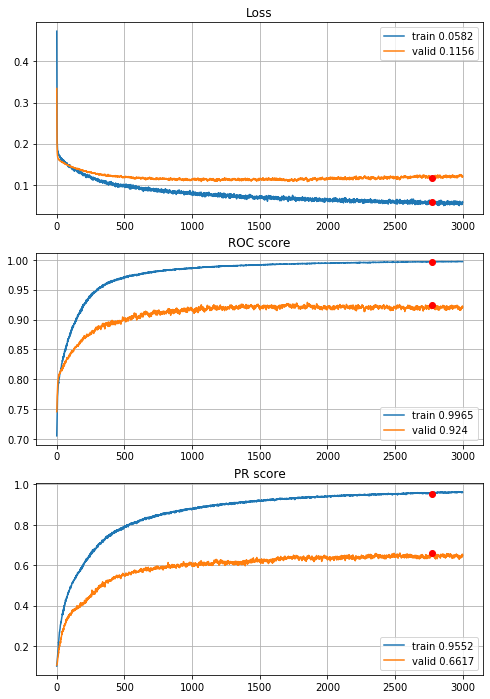


Fold 2------------------------------------------------------------


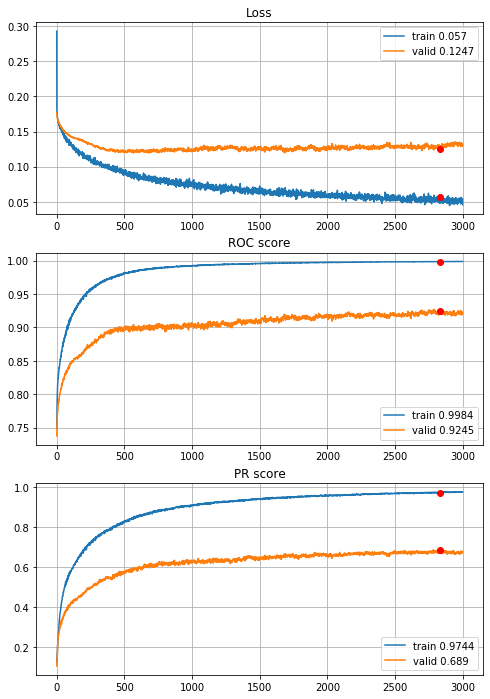


Fold 3------------------------------------------------------------


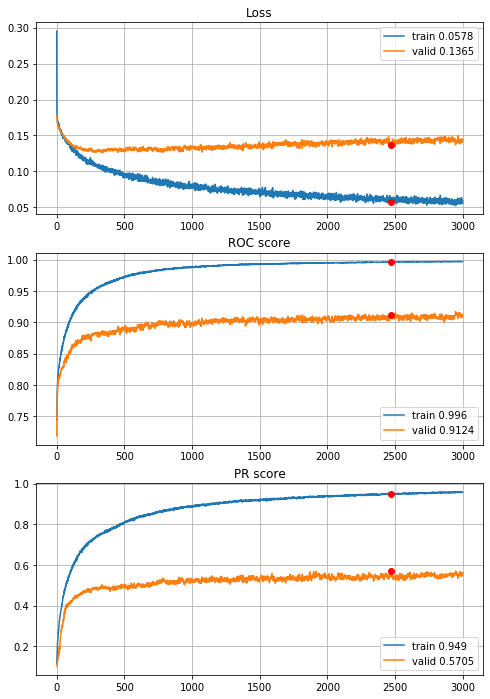


Fold 4------------------------------------------------------------


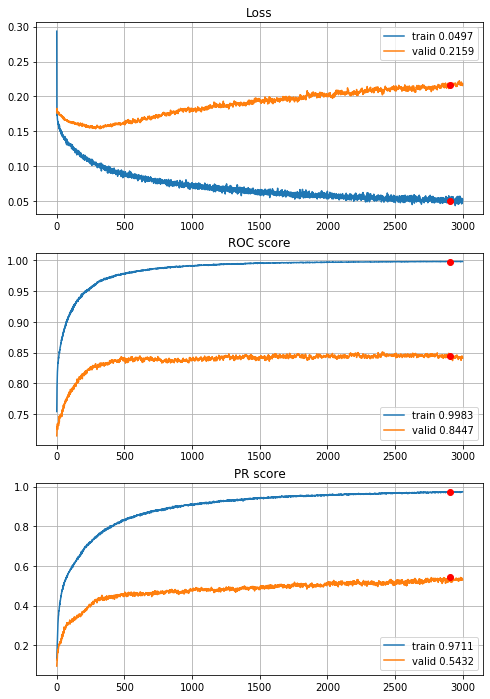


Fold 5------------------------------------------------------------


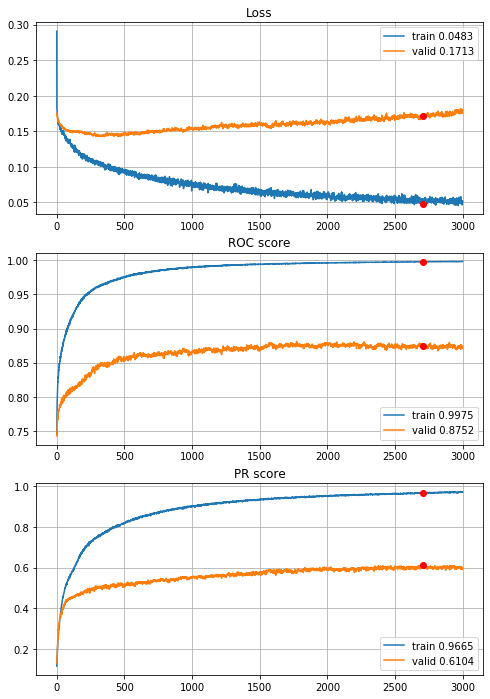


Fold 6------------------------------------------------------------


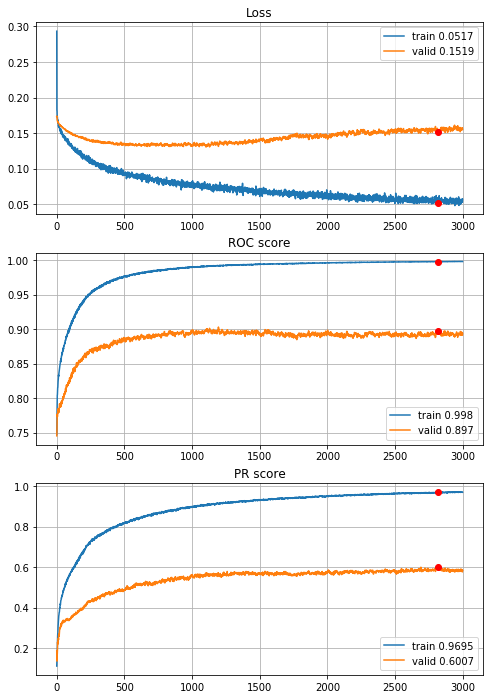

In [67]:
# THE BEST MODEL 3000 EPOCHS
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=3000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Really good results, lets try the best model for 2 year horizon.


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/4000,
cumulative time: 8.12s train loss: 0.5128902597073797, validation loss: 0.3734399899840355
Epoch: 2/4000,
cumulative time: 8.27s train loss: 0.35785350908083985, validation loss: 0.28100406378507614
Epoch: 3/4000,
cumulative time: 8.43s train loss: 0.2887961902083813, validation loss: 0.24108782410621643
Epoch: 4/4000,
cumulative time: 8.57s train loss: 0.25268437344828737, validation loss: 0.22339936718344688
Epoch: 5/4000,
cumulative time: 8.74s train loss: 0.23775267826157695, validation loss: 0.21382680907845497
Epoch: 6/4000,
cumulative time: 8.89s train loss: 0.22580232657775956, validation loss: 0.208328228443861
Epoch: 7/4000,
cumulative time: 9.05s train loss: 0.22197755371679687, validation loss: 0.20492269471287727
Epoch: 8/4000,
cumulative time: 9.18s train loss: 0.21423386241682535, validation loss: 0.20170613378286362
Epoch: 9/4000,
cumulative time: 9.36s train loss: 0.2161422966

Epoch: 76/4000,
cumulative time: 19.77s train loss: 0.1781626648901985, validation loss: 0.17204686626791954
Epoch: 77/4000,
cumulative time: 19.93s train loss: 0.175929163970004, validation loss: 0.17191709578037262
Epoch: 78/4000,
cumulative time: 20.09s train loss: 0.17739040658082256, validation loss: 0.17227983102202415
Epoch: 79/4000,
cumulative time: 20.25s train loss: 0.1768308212652371, validation loss: 0.172076765447855
Epoch: 80/4000,
cumulative time: 20.4s train loss: 0.1754865246778094, validation loss: 0.17181775718927383
Epoch: 81/4000,
cumulative time: 20.56s train loss: 0.1764174702507763, validation loss: 0.17237817496061325
Epoch: 82/4000,
cumulative time: 20.7s train loss: 0.17631364399600355, validation loss: 0.1719440296292305
Epoch: 83/4000,
cumulative time: 20.87s train loss: 0.17468399857773945, validation loss: 0.17179933562874794
Epoch: 84/4000,
cumulative time: 21.02s train loss: 0.17412712961367208, validation loss: 0.17139863595366478
Epoch: 85/4000,
cumul

Epoch: 152/4000,
cumulative time: 31.58s train loss: 0.16487305856382198, validation loss: 0.16310153156518936
Epoch: 153/4000,
cumulative time: 31.73s train loss: 0.1638262156206015, validation loss: 0.16284604370594025
Epoch: 154/4000,
cumulative time: 31.88s train loss: 0.1638066991141994, validation loss: 0.16243639960885048
Epoch: 155/4000,
cumulative time: 32.04s train loss: 0.161268157662172, validation loss: 0.1628722809255123
Epoch: 156/4000,
cumulative time: 32.2s train loss: 0.16526754998113372, validation loss: 0.16125258803367615
Epoch: 157/4000,
cumulative time: 32.34s train loss: 0.16237882474591553, validation loss: 0.16191942989826202
Epoch: 158/4000,
cumulative time: 32.51s train loss: 0.16219552250086142, validation loss: 0.1615377441048622
Epoch: 159/4000,
cumulative time: 32.66s train loss: 0.16295028910222484, validation loss: 0.16257615014910698
Epoch: 160/4000,
cumulative time: 32.81s train loss: 0.16313786910626416, validation loss: 0.1612461358308792
Epoch: 16

Epoch: 228/4000,
cumulative time: 43.16s train loss: 0.15395252164803283, validation loss: 0.15371736139059067
Epoch: 229/4000,
cumulative time: 43.31s train loss: 0.15156099505612788, validation loss: 0.15363456308841705
Epoch: 230/4000,
cumulative time: 43.46s train loss: 0.15268461899467686, validation loss: 0.15384291484951973
Epoch: 231/4000,
cumulative time: 43.61s train loss: 0.15252875901262974, validation loss: 0.1542854644358158
Epoch: 232/4000,
cumulative time: 43.79s train loss: 0.15558873739428422, validation loss: 0.15413229912519455
Epoch: 233/4000,
cumulative time: 43.95s train loss: 0.15390471156181387, validation loss: 0.15410496294498444
Epoch: 234/4000,
cumulative time: 44.1s train loss: 0.15306812725155228, validation loss: 0.15383882075548172
Epoch: 235/4000,
cumulative time: 44.25s train loss: 0.15420811637524665, validation loss: 0.1541914977133274
Epoch: 236/4000,
cumulative time: 44.41s train loss: 0.15020895151089386, validation loss: 0.1536133661866188
Epoch

Epoch: 304/4000,
cumulative time: 55.16s train loss: 0.14944378640777026, validation loss: 0.149087680503726
Epoch: 305/4000,
cumulative time: 55.32s train loss: 0.14742324145585525, validation loss: 0.14867685735225677
Epoch: 306/4000,
cumulative time: 55.47s train loss: 0.14405743937623447, validation loss: 0.14859849214553833
Epoch: 307/4000,
cumulative time: 55.62s train loss: 0.1442387102861402, validation loss: 0.14895377680659294
Epoch: 308/4000,
cumulative time: 55.77s train loss: 0.14372248892374848, validation loss: 0.1488899253308773
Epoch: 309/4000,
cumulative time: 55.91s train loss: 0.1456530592983722, validation loss: 0.14872829616069794
Epoch: 310/4000,
cumulative time: 56.06s train loss: 0.14327553245714317, validation loss: 0.14901892095804214
Epoch: 311/4000,
cumulative time: 56.24s train loss: 0.1478054499685946, validation loss: 0.1480163410305977
Epoch: 312/4000,
cumulative time: 56.38s train loss: 0.14700949846290584, validation loss: 0.1479315459728241
Epoch: 31

Epoch: 380/4000,
cumulative time: 66.82s train loss: 0.14292255613845034, validation loss: 0.14732531271874905
Epoch: 381/4000,
cumulative time: 66.98s train loss: 0.14543936425066042, validation loss: 0.14607785269618034
Epoch: 382/4000,
cumulative time: 67.13s train loss: 0.14575517855096493, validation loss: 0.1451034601777792
Epoch: 383/4000,
cumulative time: 67.27s train loss: 0.14192457230541233, validation loss: 0.1459296401590109
Epoch: 384/4000,
cumulative time: 67.42s train loss: 0.14316027164042994, validation loss: 0.14502562209963799
Epoch: 385/4000,
cumulative time: 67.57s train loss: 0.14427416909764176, validation loss: 0.1448538489639759
Epoch: 386/4000,
cumulative time: 67.74s train loss: 0.14178945464325654, validation loss: 0.14532548561692238
Epoch: 387/4000,
cumulative time: 67.89s train loss: 0.14481153046270503, validation loss: 0.1440063789486885
Epoch: 388/4000,
cumulative time: 68.04s train loss: 0.14075966996702222, validation loss: 0.14522025734186172
Epoch

Epoch: 456/4000,
cumulative time: 78.21s train loss: 0.1405496403363043, validation loss: 0.14372866228222847
Epoch: 457/4000,
cumulative time: 78.35s train loss: 0.1403223660851627, validation loss: 0.1439946237951517
Epoch: 458/4000,
cumulative time: 78.5s train loss: 0.1434415441977003, validation loss: 0.14400903694331646
Epoch: 459/4000,
cumulative time: 78.64s train loss: 0.14010542499278936, validation loss: 0.1431883405894041
Epoch: 460/4000,
cumulative time: 78.79s train loss: 0.14331844923549525, validation loss: 0.14379927515983582
Epoch: 461/4000,
cumulative time: 78.93s train loss: 0.13898527284506132, validation loss: 0.1435705702751875
Epoch: 462/4000,
cumulative time: 79.07s train loss: 0.14336069481643157, validation loss: 0.14348231069743633
Epoch: 463/4000,
cumulative time: 79.22s train loss: 0.14217634263522677, validation loss: 0.14359750039875507
Epoch: 464/4000,
cumulative time: 79.38s train loss: 0.13875840218532443, validation loss: 0.14350040443241596
Epoch: 4

Epoch: 532/4000,
cumulative time: 89.55s train loss: 0.13760744173736242, validation loss: 0.14218445867300034
Epoch: 533/4000,
cumulative time: 89.69s train loss: 0.13713120824078912, validation loss: 0.14058672450482845
Epoch: 534/4000,
cumulative time: 89.85s train loss: 0.13584655073578736, validation loss: 0.1411509681493044
Epoch: 535/4000,
cumulative time: 89.99s train loss: 0.1374430563499505, validation loss: 0.14109794422984123
Epoch: 536/4000,
cumulative time: 90.16s train loss: 0.1391444429301138, validation loss: 0.14190296456217766
Epoch: 537/4000,
cumulative time: 90.3s train loss: 0.13595010507653182, validation loss: 0.14193918369710445
Epoch: 538/4000,
cumulative time: 90.45s train loss: 0.13765312674506902, validation loss: 0.14155224338173866
Epoch: 539/4000,
cumulative time: 90.59s train loss: 0.13687109970665026, validation loss: 0.14129995182156563
Epoch: 540/4000,
cumulative time: 90.75s train loss: 0.13724012791527715, validation loss: 0.14068721793591976
Epoch

Epoch: 608/4000,
cumulative time: 101.11s train loss: 0.1390170236740123, validation loss: 0.14152124524116516
Epoch: 609/4000,
cumulative time: 101.24s train loss: 0.1364590072935308, validation loss: 0.14069556444883347
Epoch: 610/4000,
cumulative time: 101.4s train loss: 0.13617992813572657, validation loss: 0.14066821709275246
Epoch: 611/4000,
cumulative time: 101.53s train loss: 0.13301769537693234, validation loss: 0.14153068512678146
Epoch: 612/4000,
cumulative time: 101.7s train loss: 0.13775073031768573, validation loss: 0.14051301777362823
Epoch: 613/4000,
cumulative time: 101.84s train loss: 0.13564523237763534, validation loss: 0.14118933491408825
Epoch: 614/4000,
cumulative time: 102.0s train loss: 0.13391768520649705, validation loss: 0.1407922152429819
Epoch: 615/4000,
cumulative time: 102.14s train loss: 0.13868909987203357, validation loss: 0.1408886071294546
Epoch: 616/4000,
cumulative time: 102.3s train loss: 0.1380434148694701, validation loss: 0.1405074242502451
Ep

Epoch: 683/4000,
cumulative time: 112.54s train loss: 0.13483284659770736, validation loss: 0.14103680476546288
Epoch: 684/4000,
cumulative time: 112.7s train loss: 0.13697465942248346, validation loss: 0.14052980951964855
Epoch: 685/4000,
cumulative time: 112.85s train loss: 0.13779652424046931, validation loss: 0.13953041285276413
Epoch: 686/4000,
cumulative time: 112.99s train loss: 0.13729175867171323, validation loss: 0.1406504027545452
Epoch: 687/4000,
cumulative time: 113.15s train loss: 0.1349270156267302, validation loss: 0.1402767412364483
Epoch: 688/4000,
cumulative time: 113.29s train loss: 0.13463781732988273, validation loss: 0.1411046739667654
Epoch: 689/4000,
cumulative time: 113.44s train loss: 0.13537725215563015, validation loss: 0.13956839963793755
Epoch: 690/4000,
cumulative time: 113.59s train loss: 0.1332195553854827, validation loss: 0.14059953391551971
Epoch: 691/4000,
cumulative time: 113.74s train loss: 0.13394223789482507, validation loss: 0.1395201552659273

Epoch: 757/4000,
cumulative time: 123.7s train loss: 0.13512096943976068, validation loss: 0.1396287064999342
Epoch: 758/4000,
cumulative time: 123.86s train loss: 0.13224510812953139, validation loss: 0.14077850431203842
Epoch: 759/4000,
cumulative time: 124.02s train loss: 0.1345930292619673, validation loss: 0.1395779401063919
Epoch: 760/4000,
cumulative time: 124.16s train loss: 0.13401128781733324, validation loss: 0.14020350389182568
Epoch: 761/4000,
cumulative time: 124.3s train loss: 0.1321124888941411, validation loss: 0.13921391405165195
Epoch: 762/4000,
cumulative time: 124.46s train loss: 0.13843719036696284, validation loss: 0.14063075184822083
Epoch: 763/4000,
cumulative time: 124.6s train loss: 0.13481414484010545, validation loss: 0.14039705879986286
Epoch: 764/4000,
cumulative time: 124.76s train loss: 0.13365650327224426, validation loss: 0.13924445398151875
Epoch: 765/4000,
cumulative time: 124.92s train loss: 0.136847734383183, validation loss: 0.14114796929061413
E

Epoch: 831/4000,
cumulative time: 134.85s train loss: 0.1339938132903066, validation loss: 0.1388540007174015
Epoch: 832/4000,
cumulative time: 134.98s train loss: 0.1323793652326005, validation loss: 0.14000229164958
Epoch: 833/4000,
cumulative time: 135.13s train loss: 0.1379388518131978, validation loss: 0.13997267372906208
Epoch: 834/4000,
cumulative time: 135.28s train loss: 0.1320612575629903, validation loss: 0.1403425969183445
Epoch: 835/4000,
cumulative time: 135.43s train loss: 0.13241750991975612, validation loss: 0.14047466404736042
Epoch: 836/4000,
cumulative time: 135.58s train loss: 0.13620852580442533, validation loss: 0.1394246220588684
Epoch: 837/4000,
cumulative time: 135.74s train loss: 0.13102480287650867, validation loss: 0.1398324929177761
Epoch: 838/4000,
cumulative time: 135.88s train loss: 0.1347302998524441, validation loss: 0.13915487006306648
Epoch: 839/4000,
cumulative time: 136.04s train loss: 0.13565373467068614, validation loss: 0.13951377384364605
Epoc

Epoch: 905/4000,
cumulative time: 145.98s train loss: 0.13203343630798156, validation loss: 0.13888217508792877
Epoch: 906/4000,
cumulative time: 146.14s train loss: 0.13944035018720924, validation loss: 0.1380234956741333
Epoch: 907/4000,
cumulative time: 146.28s train loss: 0.13425568574845578, validation loss: 0.13946487195789814
Epoch: 908/4000,
cumulative time: 146.41s train loss: 0.13193605568329958, validation loss: 0.13895163126289845
Epoch: 909/4000,
cumulative time: 146.58s train loss: 0.13442205968220686, validation loss: 0.13881195150315762
Epoch: 910/4000,
cumulative time: 146.72s train loss: 0.1348120988251565, validation loss: 0.13798821531236172
Epoch: 911/4000,
cumulative time: 146.87s train loss: 0.13136243585586063, validation loss: 0.13999786972999573
Epoch: 912/4000,
cumulative time: 147.02s train loss: 0.13180172248327715, validation loss: 0.13843587785959244
Epoch: 913/4000,
cumulative time: 147.18s train loss: 0.13144666064150326, validation loss: 0.138137767091

Epoch: 979/4000,
cumulative time: 157.15s train loss: 0.13090456881427473, validation loss: 0.1381911002099514
Epoch: 980/4000,
cumulative time: 157.29s train loss: 0.1347998361211552, validation loss: 0.13813812844455242
Epoch: 981/4000,
cumulative time: 157.45s train loss: 0.134575878360312, validation loss: 0.13786112144589424
Epoch: 982/4000,
cumulative time: 157.6s train loss: 0.13451021482128367, validation loss: 0.13748854584991932
Epoch: 983/4000,
cumulative time: 157.74s train loss: 0.1361855472394995, validation loss: 0.1381817925721407
Epoch: 984/4000,
cumulative time: 157.87s train loss: 0.13439218983160112, validation loss: 0.13824160769581795
Epoch: 985/4000,
cumulative time: 158.04s train loss: 0.13555232399706613, validation loss: 0.13912193477153778
Epoch: 986/4000,
cumulative time: 158.2s train loss: 0.13218946254506156, validation loss: 0.1384816411882639
Epoch: 987/4000,
cumulative time: 158.36s train loss: 0.12941678438984602, validation loss: 0.1380800623446703
Ep

Epoch: 1053/4000,
cumulative time: 168.37s train loss: 0.13088278203196124, validation loss: 0.1381607297807932
Epoch: 1054/4000,
cumulative time: 168.55s train loss: 0.13342306167341356, validation loss: 0.1385785099118948
Epoch: 1055/4000,
cumulative time: 168.71s train loss: 0.13467932429302762, validation loss: 0.13710002787411213
Epoch: 1056/4000,
cumulative time: 168.86s train loss: 0.1323500617226106, validation loss: 0.13836714252829552
Epoch: 1057/4000,
cumulative time: 169.02s train loss: 0.13420675501204676, validation loss: 0.1376185044646263
Epoch: 1058/4000,
cumulative time: 169.16s train loss: 0.12955635772812724, validation loss: 0.1384253017604351
Epoch: 1059/4000,
cumulative time: 169.32s train loss: 0.1315798858637553, validation loss: 0.1388170775026083
Epoch: 1060/4000,
cumulative time: 169.48s train loss: 0.1332750904675121, validation loss: 0.13780091889202595
Epoch: 1061/4000,
cumulative time: 169.62s train loss: 0.13400157024907, validation loss: 0.138537093997

Epoch: 1127/4000,
cumulative time: 179.65s train loss: 0.1359521382904071, validation loss: 0.13838429935276508
Epoch: 1128/4000,
cumulative time: 179.8s train loss: 0.12809021254067737, validation loss: 0.13748599030077457
Epoch: 1129/4000,
cumulative time: 179.95s train loss: 0.13451794716929227, validation loss: 0.13863174058496952
Epoch: 1130/4000,
cumulative time: 180.09s train loss: 0.13021167354831362, validation loss: 0.1371382288634777
Epoch: 1131/4000,
cumulative time: 180.25s train loss: 0.13413464569535397, validation loss: 0.13813228532671928
Epoch: 1132/4000,
cumulative time: 180.4s train loss: 0.13318030060344144, validation loss: 0.13760565780103207
Epoch: 1133/4000,
cumulative time: 180.55s train loss: 0.1300017256072144, validation loss: 0.1372346542775631
Epoch: 1134/4000,
cumulative time: 180.71s train loss: 0.13439975419909958, validation loss: 0.13837699964642525
Epoch: 1135/4000,
cumulative time: 180.87s train loss: 0.13298551951298077, validation loss: 0.1362220

Epoch: 1202/4000,
cumulative time: 191.43s train loss: 0.13124170976015986, validation loss: 0.1363631971180439
Epoch: 1203/4000,
cumulative time: 191.6s train loss: 0.13104874700489474, validation loss: 0.13651560433208942
Epoch: 1204/4000,
cumulative time: 191.75s train loss: 0.12995842386769305, validation loss: 0.13617023825645447
Epoch: 1205/4000,
cumulative time: 191.92s train loss: 0.1361421005428594, validation loss: 0.1359642706811428
Epoch: 1206/4000,
cumulative time: 192.07s train loss: 0.1306321771239314, validation loss: 0.13727524504065514
Epoch: 1207/4000,
cumulative time: 192.24s train loss: 0.12977165009858585, validation loss: 0.13695072941482067
Epoch: 1208/4000,
cumulative time: 192.41s train loss: 0.13173451525697918, validation loss: 0.13614747300744057
Epoch: 1209/4000,
cumulative time: 192.57s train loss: 0.13355159237337572, validation loss: 0.13734036311507225
Epoch: 1210/4000,
cumulative time: 192.73s train loss: 0.1311986942228295, validation loss: 0.1375334

Epoch: 1276/4000,
cumulative time: 203.06s train loss: 0.13385075584069128, validation loss: 0.13654514402151108
Epoch: 1277/4000,
cumulative time: 203.23s train loss: 0.12695990846794591, validation loss: 0.13558108359575272
Epoch: 1278/4000,
cumulative time: 203.4s train loss: 0.1339620281996583, validation loss: 0.13666938431560993
Epoch: 1279/4000,
cumulative time: 203.56s train loss: 0.12762279495778514, validation loss: 0.1365265715867281
Epoch: 1280/4000,
cumulative time: 203.72s train loss: 0.1328548269432441, validation loss: 0.13640811294317245
Epoch: 1281/4000,
cumulative time: 203.86s train loss: 0.1329907761567919, validation loss: 0.13626031763851643
Epoch: 1282/4000,
cumulative time: 204.02s train loss: 0.13095540947807266, validation loss: 0.13705996423959732
Epoch: 1283/4000,
cumulative time: 204.17s train loss: 0.1283766938408448, validation loss: 0.13618098199367523
Epoch: 1284/4000,
cumulative time: 204.34s train loss: 0.12869398905850715, validation loss: 0.1357134

Epoch: 1350/4000,
cumulative time: 214.71s train loss: 0.1320659026121385, validation loss: 0.136257441714406
Epoch: 1351/4000,
cumulative time: 214.86s train loss: 0.12984458939065904, validation loss: 0.13757921755313873
Epoch: 1352/4000,
cumulative time: 215.02s train loss: 0.13356345499557792, validation loss: 0.13815168663859367
Epoch: 1353/4000,
cumulative time: 215.18s train loss: 0.12967910473421784, validation loss: 0.13823099248111248
Epoch: 1354/4000,
cumulative time: 215.33s train loss: 0.1315699441026406, validation loss: 0.13725868985056877
Epoch: 1355/4000,
cumulative time: 215.48s train loss: 0.1326459460906446, validation loss: 0.13601076044142246
Epoch: 1356/4000,
cumulative time: 215.64s train loss: 0.13050353006020363, validation loss: 0.13567959889769554
Epoch: 1357/4000,
cumulative time: 215.8s train loss: 0.13450869653939657, validation loss: 0.1364293023943901
Epoch: 1358/4000,
cumulative time: 215.96s train loss: 0.13245027381198365, validation loss: 0.13666408

Epoch: 1424/4000,
cumulative time: 226.4s train loss: 0.13029670042925645, validation loss: 0.13588973134756088
Epoch: 1425/4000,
cumulative time: 226.57s train loss: 0.12744915378485736, validation loss: 0.13588621281087399
Epoch: 1426/4000,
cumulative time: 226.74s train loss: 0.12758378797282174, validation loss: 0.13592973724007607
Epoch: 1427/4000,
cumulative time: 226.9s train loss: 0.12901200334422777, validation loss: 0.13806160539388657
Epoch: 1428/4000,
cumulative time: 227.06s train loss: 0.13186661760029966, validation loss: 0.13741431385278702
Epoch: 1429/4000,
cumulative time: 227.21s train loss: 0.1343609646810318, validation loss: 0.13768717646598816
Epoch: 1430/4000,
cumulative time: 227.37s train loss: 0.1313237157655495, validation loss: 0.13717745803296566
Epoch: 1431/4000,
cumulative time: 227.52s train loss: 0.12803028123391771, validation loss: 0.13744857348501682
Epoch: 1432/4000,
cumulative time: 227.68s train loss: 0.12985177133412093, validation loss: 0.13653

Epoch: 1497/4000,
cumulative time: 238.13s train loss: 0.12688086488378297, validation loss: 0.13529251143336296
Epoch: 1498/4000,
cumulative time: 238.3s train loss: 0.12756078250218067, validation loss: 0.13660072535276413
Epoch: 1499/4000,
cumulative time: 238.47s train loss: 0.13049771471366234, validation loss: 0.1352720446884632
Epoch: 1500/4000,
cumulative time: 238.63s train loss: 0.1282769911116062, validation loss: 0.137321962043643
Epoch: 1501/4000,
cumulative time: 238.81s train loss: 0.13175616650986394, validation loss: 0.13670171238481998
Epoch: 1502/4000,
cumulative time: 238.96s train loss: 0.12965401136228855, validation loss: 0.13605934008955956
Epoch: 1503/4000,
cumulative time: 239.12s train loss: 0.13220003715334597, validation loss: 0.1359819658100605
Epoch: 1504/4000,
cumulative time: 239.27s train loss: 0.13044838942568457, validation loss: 0.13630809634923935
Epoch: 1505/4000,
cumulative time: 239.43s train loss: 0.12988373902832087, validation loss: 0.1355945

Epoch: 1572/4000,
cumulative time: 250.17s train loss: 0.1271258606719692, validation loss: 0.1373852640390396
Epoch: 1573/4000,
cumulative time: 250.31s train loss: 0.13129325471950884, validation loss: 0.13684932701289654
Epoch: 1574/4000,
cumulative time: 250.48s train loss: 0.13223236603421146, validation loss: 0.13843446038663387
Epoch: 1575/4000,
cumulative time: 250.63s train loss: 0.1279500650555092, validation loss: 0.13718855194747448
Epoch: 1576/4000,
cumulative time: 250.79s train loss: 0.12775376394444035, validation loss: 0.1369535829871893
Epoch: 1577/4000,
cumulative time: 250.95s train loss: 0.1311712998474928, validation loss: 0.13696307316422462
Epoch: 1578/4000,
cumulative time: 251.11s train loss: 0.1310406737767421, validation loss: 0.13633131235837936
Epoch: 1579/4000,
cumulative time: 251.26s train loss: 0.13100507857874907, validation loss: 0.13585546799004078
Epoch: 1580/4000,
cumulative time: 251.43s train loss: 0.12658971249527468, validation loss: 0.1371386

Epoch: 1646/4000,
cumulative time: 261.9s train loss: 0.13048784878840902, validation loss: 0.13550524786114693
Epoch: 1647/4000,
cumulative time: 262.06s train loss: 0.1295415032569862, validation loss: 0.13564702682197094
Epoch: 1648/4000,
cumulative time: 262.22s train loss: 0.1314544749648181, validation loss: 0.1349663846194744
Epoch: 1649/4000,
cumulative time: 262.35s train loss: 0.13055535753807662, validation loss: 0.13686756044626236
Epoch: 1650/4000,
cumulative time: 262.52s train loss: 0.1331086173112499, validation loss: 0.13561374135315418
Epoch: 1651/4000,
cumulative time: 262.67s train loss: 0.12692808562869828, validation loss: 0.1334399189800024
Epoch: 1652/4000,
cumulative time: 262.84s train loss: 0.12814210422825184, validation loss: 0.1349748931825161
Epoch: 1653/4000,
cumulative time: 262.99s train loss: 0.13000583670060908, validation loss: 0.1355240885168314
Epoch: 1654/4000,
cumulative time: 263.15s train loss: 0.12905873923948902, validation loss: 0.135900942

Epoch: 1720/4000,
cumulative time: 273.77s train loss: 0.1294428741511141, validation loss: 0.1377113237977028
Epoch: 1721/4000,
cumulative time: 273.92s train loss: 0.13057872753281954, validation loss: 0.1376760322600603
Epoch: 1722/4000,
cumulative time: 274.07s train loss: 0.1296004191279381, validation loss: 0.13749035075306892
Epoch: 1723/4000,
cumulative time: 274.2s train loss: 0.12795829845600892, validation loss: 0.13750267028808594
Epoch: 1724/4000,
cumulative time: 274.34s train loss: 0.12787599210405542, validation loss: 0.13794410228729248
Epoch: 1725/4000,
cumulative time: 274.49s train loss: 0.13060608810053193, validation loss: 0.13784291222691536
Epoch: 1726/4000,
cumulative time: 274.63s train loss: 0.13138426537779213, validation loss: 0.1382092908024788
Epoch: 1727/4000,
cumulative time: 274.78s train loss: 0.12705530192553544, validation loss: 0.1378856711089611
Epoch: 1728/4000,
cumulative time: 274.93s train loss: 0.12736716488666677, validation loss: 0.13771370

Epoch: 1794/4000,
cumulative time: 285.11s train loss: 0.12738964718578732, validation loss: 0.1381173264235258
Epoch: 1795/4000,
cumulative time: 285.26s train loss: 0.1284912186071708, validation loss: 0.13912716135382652
Epoch: 1796/4000,
cumulative time: 285.43s train loss: 0.1302291818621529, validation loss: 0.13649608939886093
Epoch: 1797/4000,
cumulative time: 285.58s train loss: 0.1257440733494887, validation loss: 0.13683219254016876
Epoch: 1798/4000,
cumulative time: 285.75s train loss: 0.1306128885489148, validation loss: 0.1357128843665123
Epoch: 1799/4000,
cumulative time: 285.91s train loss: 0.1284512532936431, validation loss: 0.1376441102474928
Epoch: 1800/4000,
cumulative time: 286.06s train loss: 0.12631176726361892, validation loss: 0.13715857081115246
Epoch: 1801/4000,
cumulative time: 286.21s train loss: 0.12849418726433287, validation loss: 0.13677860982716084
Epoch: 1802/4000,
cumulative time: 286.38s train loss: 0.1287693977564074, validation loss: 0.1385311018

Epoch: 1868/4000,
cumulative time: 296.78s train loss: 0.12754884071803263, validation loss: 0.13935204967856407
Epoch: 1869/4000,
cumulative time: 296.94s train loss: 0.12707265313769608, validation loss: 0.1393950916826725
Epoch: 1870/4000,
cumulative time: 297.1s train loss: 0.12546549559419018, validation loss: 0.13658972457051277
Epoch: 1871/4000,
cumulative time: 297.27s train loss: 0.12965035346398623, validation loss: 0.13833239302039146
Epoch: 1872/4000,
cumulative time: 297.44s train loss: 0.12753648741512263, validation loss: 0.13852225802838802
Epoch: 1873/4000,
cumulative time: 297.61s train loss: 0.12782712702092147, validation loss: 0.13839824683964252
Epoch: 1874/4000,
cumulative time: 297.76s train loss: 0.12891508216760134, validation loss: 0.1407371386885643
Epoch: 1875/4000,
cumulative time: 297.91s train loss: 0.12712157383341666, validation loss: 0.13908018544316292
Epoch: 1876/4000,
cumulative time: 298.07s train loss: 0.1321631016038498, validation loss: 0.13783

Epoch: 1941/4000,
cumulative time: 308.39s train loss: 0.12657598878312318, validation loss: 0.13806508854031563
Epoch: 1942/4000,
cumulative time: 308.55s train loss: 0.12959504181991197, validation loss: 0.13751650974154472
Epoch: 1943/4000,
cumulative time: 308.7s train loss: 0.12983752291606065, validation loss: 0.1373657714575529
Epoch: 1944/4000,
cumulative time: 308.87s train loss: 0.12831360411415432, validation loss: 0.13769383169710636
Epoch: 1945/4000,
cumulative time: 309.02s train loss: 0.1290625471426879, validation loss: 0.13737811893224716
Epoch: 1946/4000,
cumulative time: 309.17s train loss: 0.12687371477083606, validation loss: 0.1391352377831936
Epoch: 1947/4000,
cumulative time: 309.32s train loss: 0.12972791922416343, validation loss: 0.1396201141178608
Epoch: 1948/4000,
cumulative time: 309.49s train loss: 0.12386085797402083, validation loss: 0.138732697814703
Epoch: 1949/4000,
cumulative time: 309.65s train loss: 0.13336121047425537, validation loss: 0.13705363

Epoch: 2015/4000,
cumulative time: 320.04s train loss: 0.13172929223727126, validation loss: 0.14016715809702873
Epoch: 2016/4000,
cumulative time: 320.19s train loss: 0.12916363303494247, validation loss: 0.13989685103297234
Epoch: 2017/4000,
cumulative time: 320.36s train loss: 0.1248577570551207, validation loss: 0.14112703874707222
Epoch: 2018/4000,
cumulative time: 320.53s train loss: 0.12440560194874185, validation loss: 0.1409224085509777
Epoch: 2019/4000,
cumulative time: 320.69s train loss: 0.12603422872998377, validation loss: 0.13936462625861168
Epoch: 2020/4000,
cumulative time: 320.84s train loss: 0.12811275322033766, validation loss: 0.13954269513487816
Epoch: 2021/4000,
cumulative time: 321.01s train loss: 0.1277878856643043, validation loss: 0.14133183099329472
Epoch: 2022/4000,
cumulative time: 321.16s train loss: 0.12426523916487647, validation loss: 0.14152678102254868
Epoch: 2023/4000,
cumulative time: 321.33s train loss: 0.12728619704343694, validation loss: 0.1420

Epoch: 2089/4000,
cumulative time: 331.65s train loss: 0.12872712955885335, validation loss: 0.13986185938119888
Epoch: 2090/4000,
cumulative time: 331.81s train loss: 0.12773240661677096, validation loss: 0.13912272080779076
Epoch: 2091/4000,
cumulative time: 331.96s train loss: 0.13040953763340135, validation loss: 0.13847142085433006
Epoch: 2092/4000,
cumulative time: 332.12s train loss: 0.1326451885153068, validation loss: 0.14000852033495903
Epoch: 2093/4000,
cumulative time: 332.28s train loss: 0.12431579977538817, validation loss: 0.14139927551150322
Epoch: 2094/4000,
cumulative time: 332.43s train loss: 0.13029704307460918, validation loss: 0.1401684619486332
Epoch: 2095/4000,
cumulative time: 332.59s train loss: 0.12606753221603745, validation loss: 0.13962040469050407
Epoch: 2096/4000,
cumulative time: 332.75s train loss: 0.1274865581533399, validation loss: 0.13872450962662697
Epoch: 2097/4000,
cumulative time: 332.9s train loss: 0.1287315254941121, validation loss: 0.139329

Epoch: 2163/4000,
cumulative time: 343.24s train loss: 0.12640594066498606, validation loss: 0.13821258023381233
Epoch: 2164/4000,
cumulative time: 343.4s train loss: 0.1276205770648664, validation loss: 0.13956087827682495
Epoch: 2165/4000,
cumulative time: 343.55s train loss: 0.1252924462107761, validation loss: 0.1391100287437439
Epoch: 2166/4000,
cumulative time: 343.71s train loss: 0.122178643313745, validation loss: 0.13877179101109505
Epoch: 2167/4000,
cumulative time: 343.87s train loss: 0.12444243897575603, validation loss: 0.13989552482962608
Epoch: 2168/4000,
cumulative time: 344.03s train loss: 0.12482365715157083, validation loss: 0.140411876142025
Epoch: 2169/4000,
cumulative time: 344.18s train loss: 0.1283240021580576, validation loss: 0.13989481702446938
Epoch: 2170/4000,
cumulative time: 344.34s train loss: 0.12560625190039224, validation loss: 0.13819948583841324
Epoch: 2171/4000,
cumulative time: 344.5s train loss: 0.1283353571777661, validation loss: 0.139546271413

Epoch: 2237/4000,
cumulative time: 354.79s train loss: 0.12675647612579768, validation loss: 0.1391897276043892
Epoch: 2238/4000,
cumulative time: 354.94s train loss: 0.1256776937657713, validation loss: 0.13927790522575378
Epoch: 2239/4000,
cumulative time: 355.1s train loss: 0.12507173573383526, validation loss: 0.13875253312289715
Epoch: 2240/4000,
cumulative time: 355.26s train loss: 0.1268493090716033, validation loss: 0.13940588757395744
Epoch: 2241/4000,
cumulative time: 355.42s train loss: 0.1252254332520291, validation loss: 0.141377754509449
Epoch: 2242/4000,
cumulative time: 355.57s train loss: 0.127251677428892, validation loss: 0.1398131474852562
Epoch: 2243/4000,
cumulative time: 355.74s train loss: 0.12464882735562179, validation loss: 0.13934603333473206
Epoch: 2244/4000,
cumulative time: 355.89s train loss: 0.12776281424491098, validation loss: 0.1396622583270073
Epoch: 2245/4000,
cumulative time: 356.04s train loss: 0.12368307127572366, validation loss: 0.138431698083

Epoch: 2311/4000,
cumulative time: 366.45s train loss: 0.1250905784262262, validation loss: 0.1415677461773157
Epoch: 2312/4000,
cumulative time: 366.61s train loss: 0.12687589919668518, validation loss: 0.13961676508188248
Epoch: 2313/4000,
cumulative time: 366.77s train loss: 0.12586911671609066, validation loss: 0.13955111429095268
Epoch: 2314/4000,
cumulative time: 366.93s train loss: 0.12324365724110857, validation loss: 0.14013420790433884
Epoch: 2315/4000,
cumulative time: 367.08s train loss: 0.12449581853935657, validation loss: 0.13971706107258797
Epoch: 2316/4000,
cumulative time: 367.24s train loss: 0.1254697778201182, validation loss: 0.13994895294308662
Epoch: 2317/4000,
cumulative time: 367.39s train loss: 0.12788092438084273, validation loss: 0.14011182636022568
Epoch: 2318/4000,
cumulative time: 367.56s train loss: 0.127284442325756, validation loss: 0.13931310176849365
Epoch: 2319/4000,
cumulative time: 367.71s train loss: 0.12784044279959556, validation loss: 0.141353

Epoch: 2385/4000,
cumulative time: 378.03s train loss: 0.12679728960411205, validation loss: 0.13995209150016308
Epoch: 2386/4000,
cumulative time: 378.17s train loss: 0.12326851210364416, validation loss: 0.13940570130944252
Epoch: 2387/4000,
cumulative time: 378.33s train loss: 0.1252146778243214, validation loss: 0.13911594823002815
Epoch: 2388/4000,
cumulative time: 378.48s train loss: 0.12387987960710811, validation loss: 0.139766039326787
Epoch: 2389/4000,
cumulative time: 378.63s train loss: 0.12551041254125736, validation loss: 0.14059683308005333
Epoch: 2390/4000,
cumulative time: 378.77s train loss: 0.12854491651565245, validation loss: 0.1405135802924633
Epoch: 2391/4000,
cumulative time: 378.93s train loss: 0.12870796347758745, validation loss: 0.14076806977391243
Epoch: 2392/4000,
cumulative time: 379.08s train loss: 0.12293032161539554, validation loss: 0.14060164988040924
Epoch: 2393/4000,
cumulative time: 379.23s train loss: 0.12332432322041403, validation loss: 0.13903

Epoch: 2459/4000,
cumulative time: 389.55s train loss: 0.12809046821970513, validation loss: 0.13996706157922745
Epoch: 2460/4000,
cumulative time: 389.71s train loss: 0.12256093815899913, validation loss: 0.1394705269485712
Epoch: 2461/4000,
cumulative time: 389.87s train loss: 0.12935617664869573, validation loss: 0.14063706807792187
Epoch: 2462/4000,
cumulative time: 390.02s train loss: 0.13145050080469442, validation loss: 0.14156673848628998
Epoch: 2463/4000,
cumulative time: 390.18s train loss: 0.12492237795747858, validation loss: 0.13994228094816208
Epoch: 2464/4000,
cumulative time: 390.34s train loss: 0.12451073810374937, validation loss: 0.14152808487415314
Epoch: 2465/4000,
cumulative time: 390.48s train loss: 0.12492554573320447, validation loss: 0.14016859605908394
Epoch: 2466/4000,
cumulative time: 390.64s train loss: 0.12289338289495651, validation loss: 0.13910893350839615
Epoch: 2467/4000,
cumulative time: 390.8s train loss: 0.12399000693405868, validation loss: 0.139

Epoch: 2533/4000,
cumulative time: 400.92s train loss: 0.12583540608929522, validation loss: 0.1390657238662243
Epoch: 2534/4000,
cumulative time: 401.07s train loss: 0.12244183581876779, validation loss: 0.14131654053926468
Epoch: 2535/4000,
cumulative time: 401.23s train loss: 0.12348909911436136, validation loss: 0.14158321544528008
Epoch: 2536/4000,
cumulative time: 401.39s train loss: 0.12414712761942659, validation loss: 0.1406332030892372
Epoch: 2537/4000,
cumulative time: 401.54s train loss: 0.12967804524954835, validation loss: 0.1397947445511818
Epoch: 2538/4000,
cumulative time: 401.69s train loss: 0.12343646175951264, validation loss: 0.14118286967277527
Epoch: 2539/4000,
cumulative time: 401.84s train loss: 0.12621163452349682, validation loss: 0.13991494476795197
Epoch: 2540/4000,
cumulative time: 401.99s train loss: 0.1263770461952765, validation loss: 0.13890571147203445
Epoch: 2541/4000,
cumulative time: 402.14s train loss: 0.12677876237702285, validation loss: 0.13989

Epoch: 2607/4000,
cumulative time: 412.44s train loss: 0.12615819975975928, validation loss: 0.1380607672035694
Epoch: 2608/4000,
cumulative time: 412.59s train loss: 0.12563122756336473, validation loss: 0.1404138021171093
Epoch: 2609/4000,
cumulative time: 412.74s train loss: 0.12278371153672737, validation loss: 0.13948018848896027
Epoch: 2610/4000,
cumulative time: 412.91s train loss: 0.12486131573658779, validation loss: 0.13910287246108055
Epoch: 2611/4000,
cumulative time: 413.06s train loss: 0.12367721250088703, validation loss: 0.13755034655332565
Epoch: 2612/4000,
cumulative time: 413.21s train loss: 0.12282655762537838, validation loss: 0.14032534509897232
Epoch: 2613/4000,
cumulative time: 413.36s train loss: 0.1239787335812652, validation loss: 0.13873862102627754
Epoch: 2614/4000,
cumulative time: 413.52s train loss: 0.12002133760826426, validation loss: 0.13978714123368263
Epoch: 2615/4000,
cumulative time: 413.68s train loss: 0.1274858881819212, validation loss: 0.13869

Epoch: 2681/4000,
cumulative time: 424.03s train loss: 0.12371724410717592, validation loss: 0.14040442183613777
Epoch: 2682/4000,
cumulative time: 424.18s train loss: 0.12415152547692757, validation loss: 0.14271653443574905
Epoch: 2683/4000,
cumulative time: 424.34s train loss: 0.1218941408446472, validation loss: 0.14158783107995987
Epoch: 2684/4000,
cumulative time: 424.5s train loss: 0.12444207689986428, validation loss: 0.1406138353049755
Epoch: 2685/4000,
cumulative time: 424.66s train loss: 0.12231984420468082, validation loss: 0.14163387194275856
Epoch: 2686/4000,
cumulative time: 424.83s train loss: 0.12493698242172001, validation loss: 0.1423595044761896
Epoch: 2687/4000,
cumulative time: 424.98s train loss: 0.12626712227977127, validation loss: 0.14170588925480843
Epoch: 2688/4000,
cumulative time: 425.14s train loss: 0.12328587063962339, validation loss: 0.142610851675272
Epoch: 2689/4000,
cumulative time: 425.31s train loss: 0.1234598597005547, validation loss: 0.14085727

Epoch: 2755/4000,
cumulative time: 435.65s train loss: 0.12092638173726623, validation loss: 0.1427595280110836
Epoch: 2756/4000,
cumulative time: 435.8s train loss: 0.1256381397572128, validation loss: 0.14196381345391273
Epoch: 2757/4000,
cumulative time: 435.95s train loss: 0.12474192756877568, validation loss: 0.14153620228171349
Epoch: 2758/4000,
cumulative time: 436.1s train loss: 0.12405791170346428, validation loss: 0.14362899214029312
Epoch: 2759/4000,
cumulative time: 436.26s train loss: 0.12715207745258186, validation loss: 0.14319995045661926
Epoch: 2760/4000,
cumulative time: 436.42s train loss: 0.12325265054407006, validation loss: 0.14510858431458473
Epoch: 2761/4000,
cumulative time: 436.58s train loss: 0.12561205787032675, validation loss: 0.14259959012269974
Epoch: 2762/4000,
cumulative time: 436.73s train loss: 0.12325324164869035, validation loss: 0.1435394063591957
Epoch: 2763/4000,
cumulative time: 436.89s train loss: 0.12414493770686244, validation loss: 0.141240

Epoch: 2829/4000,
cumulative time: 447.19s train loss: 0.11841500435287484, validation loss: 0.1443057544529438
Epoch: 2830/4000,
cumulative time: 447.35s train loss: 0.1223465975784541, validation loss: 0.1442330740392208
Epoch: 2831/4000,
cumulative time: 447.51s train loss: 0.12347206861204517, validation loss: 0.145729199051857
Epoch: 2832/4000,
cumulative time: 447.66s train loss: 0.1226857338212298, validation loss: 0.13988826423883438
Epoch: 2833/4000,
cumulative time: 447.82s train loss: 0.12265864581459969, validation loss: 0.13999992236495018
Epoch: 2834/4000,
cumulative time: 447.98s train loss: 0.12709509884799539, validation loss: 0.14301172271370888
Epoch: 2835/4000,
cumulative time: 448.14s train loss: 0.12290488101765248, validation loss: 0.14273937791585922
Epoch: 2836/4000,
cumulative time: 448.3s train loss: 0.12354240421377928, validation loss: 0.14060107618570328
Epoch: 2837/4000,
cumulative time: 448.45s train loss: 0.12511295328222294, validation loss: 0.14013490

Epoch: 2903/4000,
cumulative time: 458.81s train loss: 0.12061366657388277, validation loss: 0.14419030770659447
Epoch: 2904/4000,
cumulative time: 458.97s train loss: 0.12624199967878671, validation loss: 0.14016571640968323
Epoch: 2905/4000,
cumulative time: 459.13s train loss: 0.11995750417248921, validation loss: 0.14394069835543633
Epoch: 2906/4000,
cumulative time: 459.29s train loss: 0.1268465465427565, validation loss: 0.1423979178071022
Epoch: 2907/4000,
cumulative time: 459.44s train loss: 0.12182215584367287, validation loss: 0.14244770258665085
Epoch: 2908/4000,
cumulative time: 459.6s train loss: 0.12205904244680342, validation loss: 0.14193012937903404
Epoch: 2909/4000,
cumulative time: 459.76s train loss: 0.12597521895295838, validation loss: 0.14501803368330002
Epoch: 2910/4000,
cumulative time: 459.89s train loss: 0.124082005314563, validation loss: 0.14386235922574997
Epoch: 2911/4000,
cumulative time: 460.06s train loss: 0.1206836656545733, validation loss: 0.1465061

Epoch: 2977/4000,
cumulative time: 470.38s train loss: 0.12123865482466907, validation loss: 0.14441808313131332
Epoch: 2978/4000,
cumulative time: 470.54s train loss: 0.12055030588104133, validation loss: 0.14072443172335625
Epoch: 2979/4000,
cumulative time: 470.69s train loss: 0.12413758892564074, validation loss: 0.14547798410058022
Epoch: 2980/4000,
cumulative time: 470.85s train loss: 0.12028728971903914, validation loss: 0.14466217160224915
Epoch: 2981/4000,
cumulative time: 471.01s train loss: 0.12489197923484462, validation loss: 0.14671358093619347
Epoch: 2982/4000,
cumulative time: 471.19s train loss: 0.11934407444934726, validation loss: 0.146314088255167
Epoch: 2983/4000,
cumulative time: 471.34s train loss: 0.12290493375822759, validation loss: 0.1496826969087124
Epoch: 2984/4000,
cumulative time: 471.5s train loss: 0.1225506485893437, validation loss: 0.1462641917169094
Epoch: 2985/4000,
cumulative time: 471.64s train loss: 0.12180571366667203, validation loss: 0.1408006

Epoch: 3051/4000,
cumulative time: 481.98s train loss: 0.12047433124740696, validation loss: 0.1452544890344143
Epoch: 3052/4000,
cumulative time: 482.13s train loss: 0.12276812693328347, validation loss: 0.14562007784843445
Epoch: 3053/4000,
cumulative time: 482.28s train loss: 0.12088918093915456, validation loss: 0.15157651901245117
Epoch: 3054/4000,
cumulative time: 482.45s train loss: 0.12420899441409922, validation loss: 0.149604219943285
Epoch: 3055/4000,
cumulative time: 482.6s train loss: 0.12168794136859548, validation loss: 0.14745890721678734
Epoch: 3056/4000,
cumulative time: 482.75s train loss: 0.12336516304252837, validation loss: 0.14880496263504028
Epoch: 3057/4000,
cumulative time: 482.9s train loss: 0.12667214291509848, validation loss: 0.14527495577931404
Epoch: 3058/4000,
cumulative time: 483.05s train loss: 0.1248401108960805, validation loss: 0.14288248121738434
Epoch: 3059/4000,
cumulative time: 483.2s train loss: 0.12051366063552862, validation loss: 0.14359227

Epoch: 3125/4000,
cumulative time: 493.59s train loss: 0.12446369655873038, validation loss: 0.14862580224871635
Epoch: 3126/4000,
cumulative time: 493.75s train loss: 0.12235344248814835, validation loss: 0.14831411093473434
Epoch: 3127/4000,
cumulative time: 493.9s train loss: 0.12444068384373351, validation loss: 0.14840062707662582
Epoch: 3128/4000,
cumulative time: 494.06s train loss: 0.12093929012167448, validation loss: 0.14786933362483978
Epoch: 3129/4000,
cumulative time: 494.22s train loss: 0.11829464411322328, validation loss: 0.14912428334355354
Epoch: 3130/4000,
cumulative time: 494.37s train loss: 0.12194000169589411, validation loss: 0.14988946914672852
Epoch: 3131/4000,
cumulative time: 494.53s train loss: 0.11630538649149447, validation loss: 0.14638672024011612
Epoch: 3132/4000,
cumulative time: 494.68s train loss: 0.12242082323464662, validation loss: 0.14901640638709068
Epoch: 3133/4000,
cumulative time: 494.83s train loss: 0.11585829979297835, validation loss: 0.14

Epoch: 3199/4000,
cumulative time: 505.17s train loss: 0.1194653621595211, validation loss: 0.1550283022224903
Epoch: 3200/4000,
cumulative time: 505.32s train loss: 0.12203499094908041, validation loss: 0.1480722390115261
Epoch: 3201/4000,
cumulative time: 505.48s train loss: 0.12321481011418173, validation loss: 0.1484217680990696
Epoch: 3202/4000,
cumulative time: 505.64s train loss: 0.1218757002717078, validation loss: 0.15089421346783638
Epoch: 3203/4000,
cumulative time: 505.8s train loss: 0.11915475066132568, validation loss: 0.15478509664535522
Epoch: 3204/4000,
cumulative time: 505.96s train loss: 0.12178917581649708, validation loss: 0.14977652579545975
Epoch: 3205/4000,
cumulative time: 506.12s train loss: 0.12045959307570454, validation loss: 0.15095774084329605
Epoch: 3206/4000,
cumulative time: 506.27s train loss: 0.12103138248393111, validation loss: 0.1526775285601616
Epoch: 3207/4000,
cumulative time: 506.42s train loss: 0.12038722889542337, validation loss: 0.15354138

Epoch: 3273/4000,
cumulative time: 516.47s train loss: 0.12475489882715406, validation loss: 0.14956210926175117
Epoch: 3274/4000,
cumulative time: 516.63s train loss: 0.12069175178975003, validation loss: 0.14679428562521935
Epoch: 3275/4000,
cumulative time: 516.79s train loss: 0.11946381073976725, validation loss: 0.1525769904255867
Epoch: 3276/4000,
cumulative time: 516.94s train loss: 0.12310539784809549, validation loss: 0.15104153007268906
Epoch: 3277/4000,
cumulative time: 517.1s train loss: 0.11621229940672524, validation loss: 0.15282907336950302
Epoch: 3278/4000,
cumulative time: 517.26s train loss: 0.11778013743062865, validation loss: 0.15222086012363434
Epoch: 3279/4000,
cumulative time: 517.4s train loss: 0.11679917660959485, validation loss: 0.14695515856146812
Epoch: 3280/4000,
cumulative time: 517.57s train loss: 0.11914502911992397, validation loss: 0.14683391153812408
Epoch: 3281/4000,
cumulative time: 517.72s train loss: 0.12501660759578265, validation loss: 0.1499

Epoch: 3347/4000,
cumulative time: 527.98s train loss: 0.12013949865145149, validation loss: 0.1538940891623497
Epoch: 3348/4000,
cumulative time: 528.12s train loss: 0.12546498549051124, validation loss: 0.15491990372538567
Epoch: 3349/4000,
cumulative time: 528.29s train loss: 0.12092965723991152, validation loss: 0.1565982773900032
Epoch: 3350/4000,
cumulative time: 528.44s train loss: 0.12106323952811693, validation loss: 0.15000461786985397
Epoch: 3351/4000,
cumulative time: 528.59s train loss: 0.11982825492097679, validation loss: 0.15195242688059807
Epoch: 3352/4000,
cumulative time: 528.76s train loss: 0.1208729525510583, validation loss: 0.15780944377183914
Epoch: 3353/4000,
cumulative time: 528.91s train loss: 0.12552893660497158, validation loss: 0.15271077305078506
Epoch: 3354/4000,
cumulative time: 529.08s train loss: 0.12381911505185873, validation loss: 0.14979903772473335
Epoch: 3355/4000,
cumulative time: 529.22s train loss: 0.12196125874344076, validation loss: 0.1521

Epoch: 3421/4000,
cumulative time: 539.54s train loss: 0.12045608079292679, validation loss: 0.15648705884814262
Epoch: 3422/4000,
cumulative time: 539.69s train loss: 0.11966283443261368, validation loss: 0.15591826662421227
Epoch: 3423/4000,
cumulative time: 539.85s train loss: 0.12213779667107631, validation loss: 0.15399141609668732
Epoch: 3424/4000,
cumulative time: 540.0s train loss: 0.12155128682080472, validation loss: 0.15649983286857605
Epoch: 3425/4000,
cumulative time: 540.16s train loss: 0.1229954652787163, validation loss: 0.15076491236686707
Epoch: 3426/4000,
cumulative time: 540.31s train loss: 0.11786345867539433, validation loss: 0.15011003986001015
Epoch: 3427/4000,
cumulative time: 540.46s train loss: 0.12057946375091104, validation loss: 0.1552443653345108
Epoch: 3428/4000,
cumulative time: 540.63s train loss: 0.11957591643236264, validation loss: 0.1548483483493328
Epoch: 3429/4000,
cumulative time: 540.78s train loss: 0.12408945390859069, validation loss: 0.14961

Epoch: 3495/4000,
cumulative time: 551.15s train loss: 0.12033537962961584, validation loss: 0.15309734269976616
Epoch: 3496/4000,
cumulative time: 551.3s train loss: 0.120305928078595, validation loss: 0.15414608269929886
Epoch: 3497/4000,
cumulative time: 551.45s train loss: 0.12007825210531572, validation loss: 0.15605702996253967
Epoch: 3498/4000,
cumulative time: 551.62s train loss: 0.11832048100693206, validation loss: 0.15548083186149597
Epoch: 3499/4000,
cumulative time: 551.76s train loss: 0.1179629573726212, validation loss: 0.1579245701432228
Epoch: 3500/4000,
cumulative time: 551.92s train loss: 0.11935428691552095, validation loss: 0.15873004123568535
Epoch: 3501/4000,
cumulative time: 552.08s train loss: 0.12098268884361366, validation loss: 0.15270230174064636
Epoch: 3502/4000,
cumulative time: 552.23s train loss: 0.11910279547732272, validation loss: 0.1517685502767563
Epoch: 3503/4000,
cumulative time: 552.4s train loss: 0.12282965231049237, validation loss: 0.15945959

Epoch: 3569/4000,
cumulative time: 562.71s train loss: 0.12129696927786843, validation loss: 0.1562698818743229
Epoch: 3570/4000,
cumulative time: 562.87s train loss: 0.11885241274908753, validation loss: 0.15513912215828896
Epoch: 3571/4000,
cumulative time: 563.02s train loss: 0.12082482063873218, validation loss: 0.15639112144708633
Epoch: 3572/4000,
cumulative time: 563.19s train loss: 0.11666884037172691, validation loss: 0.15608575195074081
Epoch: 3573/4000,
cumulative time: 563.34s train loss: 0.12253031134037816, validation loss: 0.15856419503688812
Epoch: 3574/4000,
cumulative time: 563.5s train loss: 0.11794406044878228, validation loss: 0.15367527306079865
Epoch: 3575/4000,
cumulative time: 563.65s train loss: 0.12198084989376272, validation loss: 0.15608205273747444
Epoch: 3576/4000,
cumulative time: 563.81s train loss: 0.11857124088249757, validation loss: 0.15756771340966225
Epoch: 3577/4000,
cumulative time: 563.97s train loss: 0.123511607814041, validation loss: 0.15831

Epoch: 3643/4000,
cumulative time: 574.24s train loss: 0.11990613193492893, validation loss: 0.1480901539325714
Epoch: 3644/4000,
cumulative time: 574.39s train loss: 0.12326541395433183, validation loss: 0.15671956166625023
Epoch: 3645/4000,
cumulative time: 574.56s train loss: 0.11930049557585048, validation loss: 0.15450214967131615
Epoch: 3646/4000,
cumulative time: 574.7s train loss: 0.12469823785606769, validation loss: 0.15509111434221268
Epoch: 3647/4000,
cumulative time: 574.86s train loss: 0.12105830967305214, validation loss: 0.1569897197186947
Epoch: 3648/4000,
cumulative time: 575.0s train loss: 0.12327767353847342, validation loss: 0.15251343697309494
Epoch: 3649/4000,
cumulative time: 575.16s train loss: 0.1201580138758786, validation loss: 0.15336357802152634
Epoch: 3650/4000,
cumulative time: 575.32s train loss: 0.12083461046703217, validation loss: 0.1526613011956215
Epoch: 3651/4000,
cumulative time: 575.47s train loss: 0.11969535359653984, validation loss: 0.1565110

Epoch: 3717/4000,
cumulative time: 585.79s train loss: 0.11490885849612627, validation loss: 0.15925482288002968
Epoch: 3718/4000,
cumulative time: 585.94s train loss: 0.12424405729856934, validation loss: 0.15832163020968437
Epoch: 3719/4000,
cumulative time: 586.11s train loss: 0.12083749224868386, validation loss: 0.1586218625307083
Epoch: 3720/4000,
cumulative time: 586.26s train loss: 0.11391706900730722, validation loss: 0.1610671542584896
Epoch: 3721/4000,
cumulative time: 586.41s train loss: 0.12124909934672443, validation loss: 0.16042498499155045
Epoch: 3722/4000,
cumulative time: 586.58s train loss: 0.11653079718177303, validation loss: 0.15896574035286903
Epoch: 3723/4000,
cumulative time: 586.72s train loss: 0.12129416939962813, validation loss: 0.16030486300587654
Epoch: 3724/4000,
cumulative time: 586.89s train loss: 0.11851005810523409, validation loss: 0.15853321179747581
Epoch: 3725/4000,
cumulative time: 587.05s train loss: 0.11846700918786474, validation loss: 0.159

Epoch: 3791/4000,
cumulative time: 597.41s train loss: 0.12181176617552388, validation loss: 0.15366921201348305
Epoch: 3792/4000,
cumulative time: 597.56s train loss: 0.12070258486204308, validation loss: 0.15810280293226242
Epoch: 3793/4000,
cumulative time: 597.73s train loss: 0.1252919036049326, validation loss: 0.1597449816763401
Epoch: 3794/4000,
cumulative time: 597.88s train loss: 0.12188642144150211, validation loss: 0.15244921669363976
Epoch: 3795/4000,
cumulative time: 598.05s train loss: 0.12181804002413536, validation loss: 0.15284937247633934
Epoch: 3796/4000,
cumulative time: 598.2s train loss: 0.11986852775163732, validation loss: 0.15254481509327888
Epoch: 3797/4000,
cumulative time: 598.36s train loss: 0.11994079959239676, validation loss: 0.15885153785347939
Epoch: 3798/4000,
cumulative time: 598.52s train loss: 0.11862749534097645, validation loss: 0.16173715144395828
Epoch: 3799/4000,
cumulative time: 598.69s train loss: 0.11882167100649065, validation loss: 0.1577

Epoch: 3865/4000,
cumulative time: 609.11s train loss: 0.12070728272366124, validation loss: 0.15918785706162453
Epoch: 3866/4000,
cumulative time: 609.27s train loss: 0.11968902832227288, validation loss: 0.1553284376859665
Epoch: 3867/4000,
cumulative time: 609.44s train loss: 0.11992672940365187, validation loss: 0.15945802628993988
Epoch: 3868/4000,
cumulative time: 609.61s train loss: 0.1207473945305879, validation loss: 0.15686866268515587
Epoch: 3869/4000,
cumulative time: 609.77s train loss: 0.11538320232264096, validation loss: 0.15899251773953438
Epoch: 3870/4000,
cumulative time: 609.92s train loss: 0.11842876305891634, validation loss: 0.1593969650566578
Epoch: 3871/4000,
cumulative time: 610.09s train loss: 0.11901380257929807, validation loss: 0.15795930847525597
Epoch: 3872/4000,
cumulative time: 610.24s train loss: 0.12356530852831518, validation loss: 0.1597469188272953
Epoch: 3873/4000,
cumulative time: 610.41s train loss: 0.11672693558903803, validation loss: 0.15866

Epoch: 3939/4000,
cumulative time: 620.72s train loss: 0.11963975398128199, validation loss: 0.15518060326576233
Epoch: 3940/4000,
cumulative time: 620.89s train loss: 0.1234951799725021, validation loss: 0.1582297347486019
Epoch: 3941/4000,
cumulative time: 621.04s train loss: 0.1164117661745128, validation loss: 0.15501568466424942
Epoch: 3942/4000,
cumulative time: 621.2s train loss: 0.11996905140317655, validation loss: 0.151275847107172
Epoch: 3943/4000,
cumulative time: 621.36s train loss: 0.12074802350300166, validation loss: 0.15252341702580452
Epoch: 3944/4000,
cumulative time: 621.53s train loss: 0.12011436801715936, validation loss: 0.16608648002147675
Epoch: 3945/4000,
cumulative time: 621.67s train loss: 0.12170776832846895, validation loss: 0.15596745908260345
Epoch: 3946/4000,
cumulative time: 621.83s train loss: 0.12232736759966191, validation loss: 0.1518162339925766
Epoch: 3947/4000,
cumulative time: 622.0s train loss: 0.12007573270037913, validation loss: 0.153316602

Epoch: 11/4000,
cumulative time: 9.95s train loss: 0.18852187738147952, validation loss: 0.18676862120628357
Epoch: 12/4000,
cumulative time: 10.11s train loss: 0.18529920034780303, validation loss: 0.18739672377705574
Epoch: 13/4000,
cumulative time: 10.27s train loss: 0.18545479073159402, validation loss: 0.18492742255330086
Epoch: 14/4000,
cumulative time: 10.42s train loss: 0.18293997885279997, validation loss: 0.1843886822462082
Epoch: 15/4000,
cumulative time: 10.57s train loss: 0.18488911071242628, validation loss: 0.18389693647623062
Epoch: 16/4000,
cumulative time: 10.71s train loss: 0.18528324779579033, validation loss: 0.1830756925046444
Epoch: 17/4000,
cumulative time: 10.84s train loss: 0.18180633054401985, validation loss: 0.18255973234772682
Epoch: 18/4000,
cumulative time: 10.99s train loss: 0.180759216661136, validation loss: 0.1823098510503769
Epoch: 19/4000,
cumulative time: 11.12s train loss: 0.18036215821609333, validation loss: 0.18115169927477837
Epoch: 20/4000,


Epoch: 87/4000,
cumulative time: 21.93s train loss: 0.16776896210991835, validation loss: 0.169764943420887
Epoch: 88/4000,
cumulative time: 22.09s train loss: 0.16556459170169732, validation loss: 0.17018234357237816
Epoch: 89/4000,
cumulative time: 22.26s train loss: 0.1668254546385964, validation loss: 0.16963870450854301
Epoch: 90/4000,
cumulative time: 22.43s train loss: 0.16742739233497195, validation loss: 0.1695605143904686
Epoch: 91/4000,
cumulative time: 22.59s train loss: 0.16103945801544456, validation loss: 0.16944289952516556
Epoch: 92/4000,
cumulative time: 22.76s train loss: 0.1676173180440103, validation loss: 0.169239342212677
Epoch: 93/4000,
cumulative time: 22.91s train loss: 0.16483536310051225, validation loss: 0.16965342685580254
Epoch: 94/4000,
cumulative time: 23.06s train loss: 0.16863566501574082, validation loss: 0.16899429261684418
Epoch: 95/4000,
cumulative time: 23.23s train loss: 0.16603515555806847, validation loss: 0.16890990734100342
Epoch: 96/4000,
c

Epoch: 163/4000,
cumulative time: 34.16s train loss: 0.15225499469376325, validation loss: 0.15962127596139908
Epoch: 164/4000,
cumulative time: 34.33s train loss: 0.15652879236910233, validation loss: 0.1594572737812996
Epoch: 165/4000,
cumulative time: 34.5s train loss: 0.15623001039497378, validation loss: 0.15891989320516586
Epoch: 166/4000,
cumulative time: 34.65s train loss: 0.15621170603446455, validation loss: 0.15916943550109863
Epoch: 167/4000,
cumulative time: 34.8s train loss: 0.15389738858707244, validation loss: 0.15864527970552444
Epoch: 168/4000,
cumulative time: 34.97s train loss: 0.1549862801835675, validation loss: 0.15921221300959587
Epoch: 169/4000,
cumulative time: 35.11s train loss: 0.15261691752319834, validation loss: 0.1591135933995247
Epoch: 170/4000,
cumulative time: 35.28s train loss: 0.1542674223743398, validation loss: 0.15892910212278366
Epoch: 171/4000,
cumulative time: 35.45s train loss: 0.1506307377953436, validation loss: 0.15856033563613892
Epoch: 1

Epoch: 239/4000,
cumulative time: 46.5s train loss: 0.14711027118103526, validation loss: 0.14992056600749493
Epoch: 240/4000,
cumulative time: 46.67s train loss: 0.14819877783906465, validation loss: 0.1496325060725212
Epoch: 241/4000,
cumulative time: 46.82s train loss: 0.14964772369608534, validation loss: 0.14950827322900295
Epoch: 242/4000,
cumulative time: 46.97s train loss: 0.14915869787237013, validation loss: 0.14972290955483913
Epoch: 243/4000,
cumulative time: 47.13s train loss: 0.1489763616940405, validation loss: 0.15023777075111866
Epoch: 244/4000,
cumulative time: 47.32s train loss: 0.146947177880954, validation loss: 0.14924095198512077
Epoch: 245/4000,
cumulative time: 47.47s train loss: 0.14855340514246917, validation loss: 0.14974438957870007
Epoch: 246/4000,
cumulative time: 47.65s train loss: 0.14882491207352866, validation loss: 0.14920908957719803
Epoch: 247/4000,
cumulative time: 47.81s train loss: 0.1483238152478509, validation loss: 0.14952822402119637
Epoch: 

Epoch: 315/4000,
cumulative time: 58.88s train loss: 0.14301599111311505, validation loss: 0.1460759975016117
Epoch: 316/4000,
cumulative time: 59.04s train loss: 0.14113692097922095, validation loss: 0.14594436436891556
Epoch: 317/4000,
cumulative time: 59.21s train loss: 0.14127687091048505, validation loss: 0.14549368619918823
Epoch: 318/4000,
cumulative time: 59.38s train loss: 0.14482379157934291, validation loss: 0.14548680931329727
Epoch: 319/4000,
cumulative time: 59.55s train loss: 0.14302315303574303, validation loss: 0.1449929215013981
Epoch: 320/4000,
cumulative time: 59.71s train loss: 0.14380011452506677, validation loss: 0.1447618454694748
Epoch: 321/4000,
cumulative time: 59.88s train loss: 0.14758523490418027, validation loss: 0.14500992931425571
Epoch: 322/4000,
cumulative time: 60.04s train loss: 0.14409315817288906, validation loss: 0.14533385075628757
Epoch: 323/4000,
cumulative time: 60.21s train loss: 0.14511721084956714, validation loss: 0.14466174505650997
Epoc

Epoch: 391/4000,
cumulative time: 71.34s train loss: 0.14034591791531711, validation loss: 0.14462898299098015
Epoch: 392/4000,
cumulative time: 71.5s train loss: 0.14080074975534768, validation loss: 0.1446162685751915
Epoch: 393/4000,
cumulative time: 71.66s train loss: 0.14136137209223454, validation loss: 0.14447639137506485
Epoch: 394/4000,
cumulative time: 71.83s train loss: 0.14105573813244132, validation loss: 0.1450395118445158
Epoch: 395/4000,
cumulative time: 72.0s train loss: 0.1402814226190017, validation loss: 0.14495880529284477
Epoch: 396/4000,
cumulative time: 72.16s train loss: 0.13948998717925098, validation loss: 0.14534238539636135
Epoch: 397/4000,
cumulative time: 72.33s train loss: 0.14031344881482752, validation loss: 0.14465045183897018
Epoch: 398/4000,
cumulative time: 72.49s train loss: 0.13936034438459022, validation loss: 0.14419233240187168
Epoch: 399/4000,
cumulative time: 72.66s train loss: 0.13956816261184887, validation loss: 0.14531786553561687
Epoch:

Epoch: 467/4000,
cumulative time: 83.69s train loss: 0.14029808464867322, validation loss: 0.1437821350991726
Epoch: 468/4000,
cumulative time: 83.87s train loss: 0.13875391692066932, validation loss: 0.14357552863657475
Epoch: 469/4000,
cumulative time: 84.03s train loss: 0.1385036517916566, validation loss: 0.14395733177661896
Epoch: 470/4000,
cumulative time: 84.19s train loss: 0.13764258896399417, validation loss: 0.14452940970659256
Epoch: 471/4000,
cumulative time: 84.33s train loss: 0.13501458201101432, validation loss: 0.14435135386884212
Epoch: 472/4000,
cumulative time: 84.5s train loss: 0.13834301068236102, validation loss: 0.14438339322805405
Epoch: 473/4000,
cumulative time: 84.65s train loss: 0.13962053342019015, validation loss: 0.1439182162284851
Epoch: 474/4000,
cumulative time: 84.81s train loss: 0.13928094048406825, validation loss: 0.14390908926725388
Epoch: 475/4000,
cumulative time: 84.98s train loss: 0.14353209675122724, validation loss: 0.14515580981969833
Epoch

Epoch: 542/4000,
cumulative time: 96.0s train loss: 0.13999833870979964, validation loss: 0.14535293728113174
Epoch: 543/4000,
cumulative time: 96.17s train loss: 0.13625497840545456, validation loss: 0.14649298042058945
Epoch: 544/4000,
cumulative time: 96.33s train loss: 0.1352815890543772, validation loss: 0.1462530940771103
Epoch: 545/4000,
cumulative time: 96.5s train loss: 0.13242393018041182, validation loss: 0.14539546519517899
Epoch: 546/4000,
cumulative time: 96.67s train loss: 0.13619170098202735, validation loss: 0.1452527716755867
Epoch: 547/4000,
cumulative time: 96.82s train loss: 0.13416647167338097, validation loss: 0.14491311460733414
Epoch: 548/4000,
cumulative time: 96.97s train loss: 0.13824197092391985, validation loss: 0.14490308985114098
Epoch: 549/4000,
cumulative time: 97.13s train loss: 0.13519664660830252, validation loss: 0.14502454176545143
Epoch: 550/4000,
cumulative time: 97.29s train loss: 0.13457900850852472, validation loss: 0.14441307820379734
Epoch:

Epoch: 616/4000,
cumulative time: 107.94s train loss: 0.13039538620343483, validation loss: 0.14432581886649132
Epoch: 617/4000,
cumulative time: 108.09s train loss: 0.13370281323760277, validation loss: 0.14497451297938824
Epoch: 618/4000,
cumulative time: 108.24s train loss: 0.13475632112058908, validation loss: 0.145628422498703
Epoch: 619/4000,
cumulative time: 108.39s train loss: 0.1397003688319284, validation loss: 0.14473535120487213
Epoch: 620/4000,
cumulative time: 108.57s train loss: 0.13729371669110518, validation loss: 0.14489013701677322
Epoch: 621/4000,
cumulative time: 108.74s train loss: 0.13671456860097428, validation loss: 0.14534931629896164
Epoch: 622/4000,
cumulative time: 108.89s train loss: 0.1360966999494315, validation loss: 0.14509802125394344
Epoch: 623/4000,
cumulative time: 109.07s train loss: 0.13646581377730024, validation loss: 0.1451534405350685
Epoch: 624/4000,
cumulative time: 109.23s train loss: 0.1354338281072294, validation loss: 0.1447034422308206

Epoch: 690/4000,
cumulative time: 119.96s train loss: 0.13335956051499182, validation loss: 0.14744169265031815
Epoch: 691/4000,
cumulative time: 120.11s train loss: 0.1331409582761322, validation loss: 0.1475440040230751
Epoch: 692/4000,
cumulative time: 120.25s train loss: 0.13806859072564578, validation loss: 0.14834123477339745
Epoch: 693/4000,
cumulative time: 120.39s train loss: 0.13400663971454435, validation loss: 0.14684292674064636
Epoch: 694/4000,
cumulative time: 120.53s train loss: 0.1350226636565446, validation loss: 0.14602745324373245
Epoch: 695/4000,
cumulative time: 120.67s train loss: 0.13321073896286148, validation loss: 0.14613143727183342
Epoch: 696/4000,
cumulative time: 120.81s train loss: 0.13471002432523857, validation loss: 0.14626656845211983
Epoch: 697/4000,
cumulative time: 120.97s train loss: 0.13334408812622178, validation loss: 0.1462448127567768
Epoch: 698/4000,
cumulative time: 121.13s train loss: 0.1363869500590073, validation loss: 0.146035548299551

Epoch: 764/4000,
cumulative time: 131.75s train loss: 0.13330212335725192, validation loss: 0.14587237685918808
Epoch: 765/4000,
cumulative time: 131.89s train loss: 0.13408544056643504, validation loss: 0.14583760499954224
Epoch: 766/4000,
cumulative time: 132.05s train loss: 0.1352023734673744, validation loss: 0.14639977738261223
Epoch: 767/4000,
cumulative time: 132.22s train loss: 0.13122845889121643, validation loss: 0.1460932157933712
Epoch: 768/4000,
cumulative time: 132.38s train loss: 0.1331736321275824, validation loss: 0.14592083543539047
Epoch: 769/4000,
cumulative time: 132.56s train loss: 0.13507395501424965, validation loss: 0.14620927348732948
Epoch: 770/4000,
cumulative time: 132.73s train loss: 0.13493399212677024, validation loss: 0.1463935300707817
Epoch: 771/4000,
cumulative time: 132.89s train loss: 0.13349653610372192, validation loss: 0.14724603667855263
Epoch: 772/4000,
cumulative time: 133.06s train loss: 0.13311257500933657, validation loss: 0.14758216962218

Epoch: 838/4000,
cumulative time: 143.66s train loss: 0.13171664064247757, validation loss: 0.14658045396208763
Epoch: 839/4000,
cumulative time: 143.81s train loss: 0.13125914646101638, validation loss: 0.1466914638876915
Epoch: 840/4000,
cumulative time: 143.97s train loss: 0.12779302835661244, validation loss: 0.14772362262010574
Epoch: 841/4000,
cumulative time: 144.12s train loss: 0.13344511650067528, validation loss: 0.1476902887225151
Epoch: 842/4000,
cumulative time: 144.28s train loss: 0.12965579526929338, validation loss: 0.1474982649087906
Epoch: 843/4000,
cumulative time: 144.43s train loss: 0.13204360368660165, validation loss: 0.14626589603722095
Epoch: 844/4000,
cumulative time: 144.59s train loss: 0.1350671409834091, validation loss: 0.14695889875292778
Epoch: 845/4000,
cumulative time: 144.74s train loss: 0.13184195596094722, validation loss: 0.14719034731388092
Epoch: 846/4000,
cumulative time: 144.9s train loss: 0.13134959184197134, validation loss: 0.146973650902509

Epoch: 912/4000,
cumulative time: 155.84s train loss: 0.13391866814203224, validation loss: 0.1477530114352703
Epoch: 913/4000,
cumulative time: 156.0s train loss: 0.13162895700709357, validation loss: 0.14759854599833488
Epoch: 914/4000,
cumulative time: 156.16s train loss: 0.13087584619793932, validation loss: 0.14710278436541557
Epoch: 915/4000,
cumulative time: 156.3s train loss: 0.12957332499699886, validation loss: 0.14734163880348206
Epoch: 916/4000,
cumulative time: 156.46s train loss: 0.1343384983785235, validation loss: 0.14776398614048958
Epoch: 917/4000,
cumulative time: 156.62s train loss: 0.12988589930694802, validation loss: 0.14739135280251503
Epoch: 918/4000,
cumulative time: 156.79s train loss: 0.13511774361269796, validation loss: 0.1493934653699398
Epoch: 919/4000,
cumulative time: 156.94s train loss: 0.12984573850744022, validation loss: 0.14802732318639755
Epoch: 920/4000,
cumulative time: 157.09s train loss: 0.1328723678746582, validation loss: 0.1474633887410164

Epoch: 987/4000,
cumulative time: 167.71s train loss: 0.12789965128273514, validation loss: 0.14762530103325844
Epoch: 988/4000,
cumulative time: 167.86s train loss: 0.12998906753809697, validation loss: 0.14800535142421722
Epoch: 989/4000,
cumulative time: 168.02s train loss: 0.13287989800505495, validation loss: 0.14691989496350288
Epoch: 990/4000,
cumulative time: 168.18s train loss: 0.13318154108727143, validation loss: 0.1474856436252594
Epoch: 991/4000,
cumulative time: 168.32s train loss: 0.12962516383426392, validation loss: 0.1479681245982647
Epoch: 992/4000,
cumulative time: 168.48s train loss: 0.13713848546011126, validation loss: 0.14795352146029472
Epoch: 993/4000,
cumulative time: 168.63s train loss: 0.13018154707647872, validation loss: 0.14733495190739632
Epoch: 994/4000,
cumulative time: 168.77s train loss: 0.1342709681663403, validation loss: 0.1480877287685871
Epoch: 995/4000,
cumulative time: 168.93s train loss: 0.13277506833984018, validation loss: 0.14853565394878

Epoch: 1061/4000,
cumulative time: 179.4s train loss: 0.131292753326463, validation loss: 0.14846637099981308
Epoch: 1062/4000,
cumulative time: 179.58s train loss: 0.1281099215702335, validation loss: 0.14863212406635284
Epoch: 1063/4000,
cumulative time: 179.74s train loss: 0.1319442476099097, validation loss: 0.14914168789982796
Epoch: 1064/4000,
cumulative time: 179.91s train loss: 0.1304021370254264, validation loss: 0.14942997321486473
Epoch: 1065/4000,
cumulative time: 180.08s train loss: 0.13162227583421918, validation loss: 0.14832036569714546
Epoch: 1066/4000,
cumulative time: 180.25s train loss: 0.13300573155510964, validation loss: 0.14840935543179512
Epoch: 1067/4000,
cumulative time: 180.41s train loss: 0.1320998026176326, validation loss: 0.14850661158561707
Epoch: 1068/4000,
cumulative time: 180.58s train loss: 0.12915222167991453, validation loss: 0.14766139909625053
Epoch: 1069/4000,
cumulative time: 180.73s train loss: 0.12920270164706732, validation loss: 0.14977984

Epoch: 1135/4000,
cumulative time: 191.29s train loss: 0.12769212890482604, validation loss: 0.14936969801783562
Epoch: 1136/4000,
cumulative time: 191.45s train loss: 0.13157393260579414, validation loss: 0.14857802167534828
Epoch: 1137/4000,
cumulative time: 191.6s train loss: 0.1294574253412447, validation loss: 0.1493094079196453
Epoch: 1138/4000,
cumulative time: 191.76s train loss: 0.1304754056641903, validation loss: 0.1497408002614975
Epoch: 1139/4000,
cumulative time: 191.92s train loss: 0.1320735643158533, validation loss: 0.14979346841573715
Epoch: 1140/4000,
cumulative time: 192.08s train loss: 0.13124056315023988, validation loss: 0.14984872564673424
Epoch: 1141/4000,
cumulative time: 192.24s train loss: 0.1326080691173423, validation loss: 0.14980574324727058
Epoch: 1142/4000,
cumulative time: 192.41s train loss: 0.12825371101952676, validation loss: 0.14898011833429337
Epoch: 1143/4000,
cumulative time: 192.58s train loss: 0.13021644240991606, validation loss: 0.14979427

Epoch: 1208/4000,
cumulative time: 202.96s train loss: 0.1329657332531809, validation loss: 0.1491735428571701
Epoch: 1209/4000,
cumulative time: 203.1s train loss: 0.13060240974056656, validation loss: 0.14998523890972137
Epoch: 1210/4000,
cumulative time: 203.25s train loss: 0.13194186270327785, validation loss: 0.14899686723947525
Epoch: 1211/4000,
cumulative time: 203.41s train loss: 0.1280551063660258, validation loss: 0.15056220814585686
Epoch: 1212/4000,
cumulative time: 203.56s train loss: 0.1285118994209868, validation loss: 0.15026001632213593
Epoch: 1213/4000,
cumulative time: 203.71s train loss: 0.12578791975331766, validation loss: 0.15013160184025764
Epoch: 1214/4000,
cumulative time: 203.87s train loss: 0.12770568550109804, validation loss: 0.14935918897390366
Epoch: 1215/4000,
cumulative time: 204.02s train loss: 0.12686817346489812, validation loss: 0.14955688267946243
Epoch: 1216/4000,
cumulative time: 204.16s train loss: 0.13110974024075006, validation loss: 0.149807

Epoch: 1282/4000,
cumulative time: 214.31s train loss: 0.128104521946413, validation loss: 0.14991360902786255
Epoch: 1283/4000,
cumulative time: 214.46s train loss: 0.1287981011332928, validation loss: 0.14968984946608543
Epoch: 1284/4000,
cumulative time: 214.62s train loss: 0.13315708231447673, validation loss: 0.15024035796523094
Epoch: 1285/4000,
cumulative time: 214.76s train loss: 0.12820367790179668, validation loss: 0.15114639699459076
Epoch: 1286/4000,
cumulative time: 214.92s train loss: 0.13214411833425233, validation loss: 0.15048782527446747
Epoch: 1287/4000,
cumulative time: 215.07s train loss: 0.12816305592686408, validation loss: 0.1503761038184166
Epoch: 1288/4000,
cumulative time: 215.21s train loss: 0.128292541440109, validation loss: 0.14983898773789406
Epoch: 1289/4000,
cumulative time: 215.37s train loss: 0.1296845233326124, validation loss: 0.15027470514178276
Epoch: 1290/4000,
cumulative time: 215.53s train loss: 0.12461904589410298, validation loss: 0.15051773

Epoch: 1356/4000,
cumulative time: 225.6s train loss: 0.13060590325499502, validation loss: 0.149787075817585
Epoch: 1357/4000,
cumulative time: 225.75s train loss: 0.13317256561045782, validation loss: 0.15111791342496872
Epoch: 1358/4000,
cumulative time: 225.89s train loss: 0.1294182398242506, validation loss: 0.1498056724667549
Epoch: 1359/4000,
cumulative time: 226.04s train loss: 0.13212119105497613, validation loss: 0.15121042728424072
Epoch: 1360/4000,
cumulative time: 226.19s train loss: 0.13197165459523108, validation loss: 0.14950892701745033
Epoch: 1361/4000,
cumulative time: 226.32s train loss: 0.12767538673505982, validation loss: 0.1497594192624092
Epoch: 1362/4000,
cumulative time: 226.48s train loss: 0.12494647765126309, validation loss: 0.14920851215720177
Epoch: 1363/4000,
cumulative time: 226.63s train loss: 0.1334953457665752, validation loss: 0.14941295236349106
Epoch: 1364/4000,
cumulative time: 226.79s train loss: 0.13201662824655197, validation loss: 0.14999374

Epoch: 1430/4000,
cumulative time: 236.74s train loss: 0.13073194642594285, validation loss: 0.15165618434548378
Epoch: 1431/4000,
cumulative time: 236.87s train loss: 0.12825610385919176, validation loss: 0.1516866683959961
Epoch: 1432/4000,
cumulative time: 237.04s train loss: 0.13128500845550037, validation loss: 0.15138081833720207
Epoch: 1433/4000,
cumulative time: 237.2s train loss: 0.12800318315821957, validation loss: 0.15260229259729385
Epoch: 1434/4000,
cumulative time: 237.35s train loss: 0.12740887363037826, validation loss: 0.15124612674117088
Epoch: 1435/4000,
cumulative time: 237.51s train loss: 0.12768221603410385, validation loss: 0.15159960836172104
Epoch: 1436/4000,
cumulative time: 237.66s train loss: 0.12814031528482103, validation loss: 0.15165453404188156
Epoch: 1437/4000,
cumulative time: 237.8s train loss: 0.12534891818155788, validation loss: 0.15126803144812584
Epoch: 1438/4000,
cumulative time: 237.97s train loss: 0.1311297606413833, validation loss: 0.15168

Epoch: 1504/4000,
cumulative time: 248.08s train loss: 0.12612729153698504, validation loss: 0.1521153673529625
Epoch: 1505/4000,
cumulative time: 248.23s train loss: 0.1299507275352386, validation loss: 0.15209665149450302
Epoch: 1506/4000,
cumulative time: 248.38s train loss: 0.12800449482744694, validation loss: 0.15167469158768654
Epoch: 1507/4000,
cumulative time: 248.53s train loss: 0.12833046208198692, validation loss: 0.15225587040185928
Epoch: 1508/4000,
cumulative time: 248.68s train loss: 0.12604446289516935, validation loss: 0.151434525847435
Epoch: 1509/4000,
cumulative time: 248.83s train loss: 0.12913659665262475, validation loss: 0.15123257040977478
Epoch: 1510/4000,
cumulative time: 248.98s train loss: 0.12888352427803787, validation loss: 0.15124061703681946
Epoch: 1511/4000,
cumulative time: 249.12s train loss: 0.1255793770715602, validation loss: 0.15267253667116165
Epoch: 1512/4000,
cumulative time: 249.28s train loss: 0.1317419723270356, validation loss: 0.1535755

Epoch: 1578/4000,
cumulative time: 259.15s train loss: 0.126351796211689, validation loss: 0.15245241671800613
Epoch: 1579/4000,
cumulative time: 259.3s train loss: 0.12879902312845187, validation loss: 0.15288740023970604
Epoch: 1580/4000,
cumulative time: 259.46s train loss: 0.12813841223285366, validation loss: 0.15331750363111496
Epoch: 1581/4000,
cumulative time: 259.6s train loss: 0.12977759865310787, validation loss: 0.15329066663980484
Epoch: 1582/4000,
cumulative time: 259.75s train loss: 0.12627553604940522, validation loss: 0.15306313335895538
Epoch: 1583/4000,
cumulative time: 259.9s train loss: 0.1260443912159676, validation loss: 0.15278690680861473
Epoch: 1584/4000,
cumulative time: 260.06s train loss: 0.12904619741305112, validation loss: 0.15147031843662262
Epoch: 1585/4000,
cumulative time: 260.23s train loss: 0.12888288988512805, validation loss: 0.15213750675320625
Epoch: 1586/4000,
cumulative time: 260.38s train loss: 0.12867882385766705, validation loss: 0.1526847

Epoch: 1652/4000,
cumulative time: 270.38s train loss: 0.12585026565929727, validation loss: 0.15328655391931534
Epoch: 1653/4000,
cumulative time: 270.54s train loss: 0.12510602065698334, validation loss: 0.15532562509179115
Epoch: 1654/4000,
cumulative time: 270.7s train loss: 0.12825905155710243, validation loss: 0.15353194624185562
Epoch: 1655/4000,
cumulative time: 270.84s train loss: 0.12897276743270225, validation loss: 0.15450499951839447
Epoch: 1656/4000,
cumulative time: 271.0s train loss: 0.1300259492250794, validation loss: 0.1536945067346096
Epoch: 1657/4000,
cumulative time: 271.14s train loss: 0.12393837271153231, validation loss: 0.1534257009625435
Epoch: 1658/4000,
cumulative time: 271.3s train loss: 0.1267169117284281, validation loss: 0.15322807058691978
Epoch: 1659/4000,
cumulative time: 271.44s train loss: 0.12568487414646537, validation loss: 0.15310562402009964
Epoch: 1660/4000,
cumulative time: 271.6s train loss: 0.12680704481502425, validation loss: 0.153198901

Epoch: 1726/4000,
cumulative time: 281.78s train loss: 0.12541889626704963, validation loss: 0.1545618586242199
Epoch: 1727/4000,
cumulative time: 281.94s train loss: 0.1298230284585633, validation loss: 0.15415731072425842
Epoch: 1728/4000,
cumulative time: 282.09s train loss: 0.12781300273316654, validation loss: 0.15399406105279922
Epoch: 1729/4000,
cumulative time: 282.22s train loss: 0.12657132283526668, validation loss: 0.1547667235136032
Epoch: 1730/4000,
cumulative time: 282.38s train loss: 0.12591932718904567, validation loss: 0.1540108062326908
Epoch: 1731/4000,
cumulative time: 282.52s train loss: 0.1268353650697359, validation loss: 0.15449057891964912
Epoch: 1732/4000,
cumulative time: 282.68s train loss: 0.12576947492533616, validation loss: 0.1535160280764103
Epoch: 1733/4000,
cumulative time: 282.84s train loss: 0.1265483806207738, validation loss: 0.15363482758402824
Epoch: 1734/4000,
cumulative time: 282.99s train loss: 0.12700908053089302, validation loss: 0.15406837

Epoch: 1800/4000,
cumulative time: 293.14s train loss: 0.12501537299598153, validation loss: 0.15428299456834793
Epoch: 1801/4000,
cumulative time: 293.28s train loss: 0.13069351369570875, validation loss: 0.15440528467297554
Epoch: 1802/4000,
cumulative time: 293.43s train loss: 0.12606898076177672, validation loss: 0.15417278930544853
Epoch: 1803/4000,
cumulative time: 293.57s train loss: 0.12980322805249855, validation loss: 0.15430043265223503
Epoch: 1804/4000,
cumulative time: 293.73s train loss: 0.125733589016586, validation loss: 0.15269705280661583
Epoch: 1805/4000,
cumulative time: 293.88s train loss: 0.12497763967244621, validation loss: 0.15314260870218277
Epoch: 1806/4000,
cumulative time: 294.04s train loss: 0.128051964601113, validation loss: 0.15447375550866127
Epoch: 1807/4000,
cumulative time: 294.19s train loss: 0.12869684720376895, validation loss: 0.1548435389995575
Epoch: 1808/4000,
cumulative time: 294.35s train loss: 0.1248498976764157, validation loss: 0.1544058

Epoch: 1874/4000,
cumulative time: 304.45s train loss: 0.12472368199747186, validation loss: 0.1551058106124401
Epoch: 1875/4000,
cumulative time: 304.59s train loss: 0.12448070136430059, validation loss: 0.15415673702955246
Epoch: 1876/4000,
cumulative time: 304.74s train loss: 0.1290295292628544, validation loss: 0.1535540670156479
Epoch: 1877/4000,
cumulative time: 304.89s train loss: 0.12611610329827722, validation loss: 0.15394826978445053
Epoch: 1878/4000,
cumulative time: 305.04s train loss: 0.12438232214613394, validation loss: 0.1544645056128502
Epoch: 1879/4000,
cumulative time: 305.17s train loss: 0.1283406573255514, validation loss: 0.15396898612380028
Epoch: 1880/4000,
cumulative time: 305.33s train loss: 0.12502299241793524, validation loss: 0.15435995534062386
Epoch: 1881/4000,
cumulative time: 305.47s train loss: 0.12434284696653447, validation loss: 0.15533581748604774
Epoch: 1882/4000,
cumulative time: 305.63s train loss: 0.12553500553045313, validation loss: 0.154449

Epoch: 1948/4000,
cumulative time: 315.71s train loss: 0.1291280607449306, validation loss: 0.15520865097641945
Epoch: 1949/4000,
cumulative time: 315.85s train loss: 0.12703102218614368, validation loss: 0.1543077528476715
Epoch: 1950/4000,
cumulative time: 316.02s train loss: 0.12340710517406887, validation loss: 0.15398087352514267
Epoch: 1951/4000,
cumulative time: 316.15s train loss: 0.1295945718373636, validation loss: 0.15335004404187202
Epoch: 1952/4000,
cumulative time: 316.32s train loss: 0.1253550589035434, validation loss: 0.15442070737481117
Epoch: 1953/4000,
cumulative time: 316.47s train loss: 0.12756933048632377, validation loss: 0.15517905727028847
Epoch: 1954/4000,
cumulative time: 316.63s train loss: 0.13097964913984916, validation loss: 0.15506240352988243
Epoch: 1955/4000,
cumulative time: 316.79s train loss: 0.1252362108687691, validation loss: 0.15435423702001572
Epoch: 1956/4000,
cumulative time: 316.95s train loss: 0.13074519598564258, validation loss: 0.155245

Epoch: 2021/4000,
cumulative time: 326.74s train loss: 0.12713712492627563, validation loss: 0.15657933801412582
Epoch: 2022/4000,
cumulative time: 326.89s train loss: 0.13034766727993186, validation loss: 0.15570247918367386
Epoch: 2023/4000,
cumulative time: 327.03s train loss: 0.12428166149888867, validation loss: 0.15607329457998276
Epoch: 2024/4000,
cumulative time: 327.17s train loss: 0.12707370215787567, validation loss: 0.15542472153902054
Epoch: 2025/4000,
cumulative time: 327.33s train loss: 0.12680350243666863, validation loss: 0.1552141010761261
Epoch: 2026/4000,
cumulative time: 327.46s train loss: 0.12990566155763977, validation loss: 0.15425366535782814
Epoch: 2027/4000,
cumulative time: 327.62s train loss: 0.1272137612104416, validation loss: 0.15565764904022217
Epoch: 2028/4000,
cumulative time: 327.77s train loss: 0.12644768166301396, validation loss: 0.1557278260588646
Epoch: 2029/4000,
cumulative time: 327.91s train loss: 0.12773050683602094, validation loss: 0.1550

Epoch: 2095/4000,
cumulative time: 337.95s train loss: 0.1276671521918098, validation loss: 0.15357881411910057
Epoch: 2096/4000,
cumulative time: 338.11s train loss: 0.1287921344290959, validation loss: 0.1548127494752407
Epoch: 2097/4000,
cumulative time: 338.26s train loss: 0.12351879780216227, validation loss: 0.15550189092755318
Epoch: 2098/4000,
cumulative time: 338.42s train loss: 0.12517748652011867, validation loss: 0.1544545404613018
Epoch: 2099/4000,
cumulative time: 338.58s train loss: 0.12789138221480387, validation loss: 0.15580986812710762
Epoch: 2100/4000,
cumulative time: 338.72s train loss: 0.1260833087655843, validation loss: 0.15477202832698822
Epoch: 2101/4000,
cumulative time: 338.86s train loss: 0.1271906463744345, validation loss: 0.15424976125359535
Epoch: 2102/4000,
cumulative time: 339.01s train loss: 0.12725061044634267, validation loss: 0.15447822958230972
Epoch: 2103/4000,
cumulative time: 339.16s train loss: 0.12385645115803862, validation loss: 0.1546265

Epoch: 2169/4000,
cumulative time: 349.21s train loss: 0.1265644212364545, validation loss: 0.15554267913103104
Epoch: 2170/4000,
cumulative time: 349.36s train loss: 0.1259829975520826, validation loss: 0.15651466697454453
Epoch: 2171/4000,
cumulative time: 349.52s train loss: 0.1300756288507888, validation loss: 0.15545351058244705
Epoch: 2172/4000,
cumulative time: 349.66s train loss: 0.12337806089811969, validation loss: 0.15578092262148857
Epoch: 2173/4000,
cumulative time: 349.83s train loss: 0.12779090433760365, validation loss: 0.15450142696499825
Epoch: 2174/4000,
cumulative time: 349.96s train loss: 0.12559119031332724, validation loss: 0.15542829036712646
Epoch: 2175/4000,
cumulative time: 350.12s train loss: 0.12495714237221973, validation loss: 0.15521209686994553
Epoch: 2176/4000,
cumulative time: 350.26s train loss: 0.12646791154642648, validation loss: 0.15481897816061974
Epoch: 2177/4000,
cumulative time: 350.42s train loss: 0.1272696882766355, validation loss: 0.15590

Epoch: 2243/4000,
cumulative time: 360.5s train loss: 0.1264898324354068, validation loss: 0.1544467732310295
Epoch: 2244/4000,
cumulative time: 360.64s train loss: 0.12990537232640373, validation loss: 0.15728145465254784
Epoch: 2245/4000,
cumulative time: 360.81s train loss: 0.12832968232896863, validation loss: 0.15687985345721245
Epoch: 2246/4000,
cumulative time: 360.95s train loss: 0.1271645350447005, validation loss: 0.15610333904623985
Epoch: 2247/4000,
cumulative time: 361.11s train loss: 0.1301631197454422, validation loss: 0.15582029521465302
Epoch: 2248/4000,
cumulative time: 361.25s train loss: 0.12459057559854733, validation loss: 0.15553882718086243
Epoch: 2249/4000,
cumulative time: 361.41s train loss: 0.12158310349601183, validation loss: 0.15548205375671387
Epoch: 2250/4000,
cumulative time: 361.59s train loss: 0.12081944275743892, validation loss: 0.15763666480779648
Epoch: 2251/4000,
cumulative time: 361.74s train loss: 0.127823557647928, validation loss: 0.15659302

Epoch: 2318/4000,
cumulative time: 371.78s train loss: 0.12769948463336414, validation loss: 0.15682737156748772
Epoch: 2319/4000,
cumulative time: 371.92s train loss: 0.12316755215231086, validation loss: 0.1557936817407608
Epoch: 2320/4000,
cumulative time: 372.06s train loss: 0.12556876312163712, validation loss: 0.1549031212925911
Epoch: 2321/4000,
cumulative time: 372.22s train loss: 0.12459178317911496, validation loss: 0.1566387079656124
Epoch: 2322/4000,
cumulative time: 372.36s train loss: 0.12352357589279776, validation loss: 0.15564536675810814
Epoch: 2323/4000,
cumulative time: 372.52s train loss: 0.12919761714231792, validation loss: 0.15648407861590385
Epoch: 2324/4000,
cumulative time: 372.68s train loss: 0.12691809466310175, validation loss: 0.15507015213370323
Epoch: 2325/4000,
cumulative time: 372.82s train loss: 0.12630206902940422, validation loss: 0.15796871855854988
Epoch: 2326/4000,
cumulative time: 372.99s train loss: 0.12375376880009989, validation loss: 0.1573

Epoch: 2392/4000,
cumulative time: 383.08s train loss: 0.12498957806429081, validation loss: 0.1562221460044384
Epoch: 2393/4000,
cumulative time: 383.22s train loss: 0.1260009285302832, validation loss: 0.1564699448645115
Epoch: 2394/4000,
cumulative time: 383.39s train loss: 0.12771918432604484, validation loss: 0.155637014657259
Epoch: 2395/4000,
cumulative time: 383.52s train loss: 0.12582964154405907, validation loss: 0.15493371710181236
Epoch: 2396/4000,
cumulative time: 383.68s train loss: 0.12179004580894964, validation loss: 0.1564800888299942
Epoch: 2397/4000,
cumulative time: 383.82s train loss: 0.12363239896704607, validation loss: 0.15699167549610138
Epoch: 2398/4000,
cumulative time: 383.98s train loss: 0.12149986151725038, validation loss: 0.15657320991158485
Epoch: 2399/4000,
cumulative time: 384.14s train loss: 0.12818064007467278, validation loss: 0.15668904781341553
Epoch: 2400/4000,
cumulative time: 384.3s train loss: 0.12551745441834475, validation loss: 0.15669932

Epoch: 2466/4000,
cumulative time: 394.25s train loss: 0.1247962403998967, validation loss: 0.15763423219323158
Epoch: 2467/4000,
cumulative time: 394.38s train loss: 0.12604951145815146, validation loss: 0.1572171002626419
Epoch: 2468/4000,
cumulative time: 394.54s train loss: 0.1255658830276233, validation loss: 0.15700431168079376
Epoch: 2469/4000,
cumulative time: 394.68s train loss: 0.12341853287950756, validation loss: 0.15710017457604408
Epoch: 2470/4000,
cumulative time: 394.83s train loss: 0.12290731710965952, validation loss: 0.15778301656246185
Epoch: 2471/4000,
cumulative time: 395.0s train loss: 0.12243693170964022, validation loss: 0.15768137946724892
Epoch: 2472/4000,
cumulative time: 395.16s train loss: 0.12551605189857656, validation loss: 0.1572258323431015
Epoch: 2473/4000,
cumulative time: 395.3s train loss: 0.1252282395289143, validation loss: 0.15495995059609413
Epoch: 2474/4000,
cumulative time: 395.46s train loss: 0.12863384969173014, validation loss: 0.15639604

Epoch: 2540/4000,
cumulative time: 405.47s train loss: 0.12544078354327856, validation loss: 0.15651513636112213
Epoch: 2541/4000,
cumulative time: 405.61s train loss: 0.12587712941442486, validation loss: 0.1578221693634987
Epoch: 2542/4000,
cumulative time: 405.77s train loss: 0.12351021245159795, validation loss: 0.15700334310531616
Epoch: 2543/4000,
cumulative time: 405.91s train loss: 0.12569625352908054, validation loss: 0.15709150582551956
Epoch: 2544/4000,
cumulative time: 406.08s train loss: 0.1248024925230087, validation loss: 0.15750174596905708
Epoch: 2545/4000,
cumulative time: 406.22s train loss: 0.12680562144763097, validation loss: 0.1578817442059517
Epoch: 2546/4000,
cumulative time: 406.37s train loss: 0.12630068568854297, validation loss: 0.15666236728429794
Epoch: 2547/4000,
cumulative time: 406.51s train loss: 0.1232160939960355, validation loss: 0.15909931436181068
Epoch: 2548/4000,
cumulative time: 406.67s train loss: 0.12367248783004411, validation loss: 0.15784

Epoch: 2613/4000,
cumulative time: 416.76s train loss: 0.12403008904082936, validation loss: 0.15802393853664398
Epoch: 2614/4000,
cumulative time: 416.93s train loss: 0.13053393087157325, validation loss: 0.15817194804549217
Epoch: 2615/4000,
cumulative time: 417.08s train loss: 0.12667394441364682, validation loss: 0.15780038759112358
Epoch: 2616/4000,
cumulative time: 417.24s train loss: 0.12430631307863294, validation loss: 0.15722129866480827
Epoch: 2617/4000,
cumulative time: 417.39s train loss: 0.12426660750997799, validation loss: 0.15798217058181763
Epoch: 2618/4000,
cumulative time: 417.54s train loss: 0.12554170024037786, validation loss: 0.15779078006744385
Epoch: 2619/4000,
cumulative time: 417.71s train loss: 0.1296890120784936, validation loss: 0.15799341350793839
Epoch: 2620/4000,
cumulative time: 417.86s train loss: 0.12742718536011333, validation loss: 0.1602463349699974
Epoch: 2621/4000,
cumulative time: 418.03s train loss: 0.12454790125353618, validation loss: 0.159

Epoch: 2687/4000,
cumulative time: 428.41s train loss: 0.12696273966965305, validation loss: 0.15775511786341667
Epoch: 2688/4000,
cumulative time: 428.58s train loss: 0.12842250033388167, validation loss: 0.1567586287856102
Epoch: 2689/4000,
cumulative time: 428.73s train loss: 0.12346201748745643, validation loss: 0.1580466777086258
Epoch: 2690/4000,
cumulative time: 428.9s train loss: 0.12542592898889082, validation loss: 0.15843647718429565
Epoch: 2691/4000,
cumulative time: 429.05s train loss: 0.12371246618114189, validation loss: 0.15862280130386353
Epoch: 2692/4000,
cumulative time: 429.2s train loss: 0.1270721960754156, validation loss: 0.15681031346321106
Epoch: 2693/4000,
cumulative time: 429.37s train loss: 0.12592900312449376, validation loss: 0.15737921372056007
Epoch: 2694/4000,
cumulative time: 429.51s train loss: 0.12297733554331829, validation loss: 0.15737738087773323
Epoch: 2695/4000,
cumulative time: 429.68s train loss: 0.12389466954312875, validation loss: 0.156024

Epoch: 2760/4000,
cumulative time: 440.02s train loss: 0.12694522521826082, validation loss: 0.15723251923918724
Epoch: 2761/4000,
cumulative time: 440.18s train loss: 0.12937570374445784, validation loss: 0.15804962068796158
Epoch: 2762/4000,
cumulative time: 440.33s train loss: 0.1245754763555896, validation loss: 0.158384520560503
Epoch: 2763/4000,
cumulative time: 440.49s train loss: 0.12282837203851868, validation loss: 0.15859590843319893
Epoch: 2764/4000,
cumulative time: 440.65s train loss: 0.1245841006637225, validation loss: 0.15956253558397293
Epoch: 2765/4000,
cumulative time: 440.8s train loss: 0.12420842551743094, validation loss: 0.1595207266509533
Epoch: 2766/4000,
cumulative time: 440.96s train loss: 0.1275393905041483, validation loss: 0.15868600457906723
Epoch: 2767/4000,
cumulative time: 441.12s train loss: 0.12214382406401719, validation loss: 0.15936079248785973
Epoch: 2768/4000,
cumulative time: 441.29s train loss: 0.12374880018423147, validation loss: 0.15853466

Epoch: 2834/4000,
cumulative time: 451.68s train loss: 0.12773784161855145, validation loss: 0.15909168869256973
Epoch: 2835/4000,
cumulative time: 451.82s train loss: 0.126434607530621, validation loss: 0.16030582040548325
Epoch: 2836/4000,
cumulative time: 451.99s train loss: 0.12424406525052217, validation loss: 0.1577235944569111
Epoch: 2837/4000,
cumulative time: 452.13s train loss: 0.12251273254495457, validation loss: 0.15882546827197075
Epoch: 2838/4000,
cumulative time: 452.29s train loss: 0.12321361505656814, validation loss: 0.1570911929011345
Epoch: 2839/4000,
cumulative time: 452.45s train loss: 0.1230412042265074, validation loss: 0.15644807741045952
Epoch: 2840/4000,
cumulative time: 452.6s train loss: 0.126057918153707, validation loss: 0.15813104435801506
Epoch: 2841/4000,
cumulative time: 452.75s train loss: 0.12662956748988316, validation loss: 0.15803051739931107
Epoch: 2842/4000,
cumulative time: 452.92s train loss: 0.12542931909766095, validation loss: 0.156526897

Epoch: 2908/4000,
cumulative time: 463.33s train loss: 0.1230912476668296, validation loss: 0.15897111967206
Epoch: 2909/4000,
cumulative time: 463.5s train loss: 0.12466531945794533, validation loss: 0.15748726204037666
Epoch: 2910/4000,
cumulative time: 463.65s train loss: 0.12565584398650953, validation loss: 0.15968624874949455
Epoch: 2911/4000,
cumulative time: 463.8s train loss: 0.12291617107843916, validation loss: 0.15952643007040024
Epoch: 2912/4000,
cumulative time: 463.97s train loss: 0.12472336779033066, validation loss: 0.15928521379828453
Epoch: 2913/4000,
cumulative time: 464.12s train loss: 0.12095143794332318, validation loss: 0.1582646481692791
Epoch: 2914/4000,
cumulative time: 464.28s train loss: 0.1256835048024033, validation loss: 0.1596306972205639
Epoch: 2915/4000,
cumulative time: 464.43s train loss: 0.12224279843183748, validation loss: 0.15981952100992203
Epoch: 2916/4000,
cumulative time: 464.6s train loss: 0.12418348625219068, validation loss: 0.15973367542

Epoch: 2982/4000,
cumulative time: 475.05s train loss: 0.12218686833092257, validation loss: 0.1598774865269661
Epoch: 2983/4000,
cumulative time: 475.21s train loss: 0.12384497513545231, validation loss: 0.15832626819610596
Epoch: 2984/4000,
cumulative time: 475.37s train loss: 0.12423900154231465, validation loss: 0.15830524638295174
Epoch: 2985/4000,
cumulative time: 475.52s train loss: 0.12037434587477427, validation loss: 0.15843035280704498
Epoch: 2986/4000,
cumulative time: 475.68s train loss: 0.12071210902738595, validation loss: 0.15779272839426994
Epoch: 2987/4000,
cumulative time: 475.84s train loss: 0.12404885631548444, validation loss: 0.15864474326372147
Epoch: 2988/4000,
cumulative time: 476.0s train loss: 0.12358033877299364, validation loss: 0.15970726683735847
Epoch: 2989/4000,
cumulative time: 476.15s train loss: 0.12461983652784474, validation loss: 0.15805533155798912
Epoch: 2990/4000,
cumulative time: 476.32s train loss: 0.12419205932575715, validation loss: 0.159

Epoch: 3056/4000,
cumulative time: 486.47s train loss: 0.12556627032726836, validation loss: 0.1581997126340866
Epoch: 3057/4000,
cumulative time: 486.63s train loss: 0.12146304036387033, validation loss: 0.1586829423904419
Epoch: 3058/4000,
cumulative time: 486.79s train loss: 0.12772564021250873, validation loss: 0.1595260202884674
Epoch: 3059/4000,
cumulative time: 486.95s train loss: 0.12179118959604937, validation loss: 0.158218614757061
Epoch: 3060/4000,
cumulative time: 487.1s train loss: 0.12355258102576523, validation loss: 0.15850411355495453
Epoch: 3061/4000,
cumulative time: 487.26s train loss: 0.12747929444836445, validation loss: 0.1581929363310337
Epoch: 3062/4000,
cumulative time: 487.42s train loss: 0.12556829209093698, validation loss: 0.15857518836855888
Epoch: 3063/4000,
cumulative time: 487.57s train loss: 0.12013631405232218, validation loss: 0.1599159613251686
Epoch: 3064/4000,
cumulative time: 487.73s train loss: 0.12149375384610095, validation loss: 0.159362655

Epoch: 3130/4000,
cumulative time: 498.05s train loss: 0.12352067389354723, validation loss: 0.15818336233496666
Epoch: 3131/4000,
cumulative time: 498.21s train loss: 0.12180520627229513, validation loss: 0.15984118729829788
Epoch: 3132/4000,
cumulative time: 498.35s train loss: 0.12251074822906191, validation loss: 0.15984361246228218
Epoch: 3133/4000,
cumulative time: 498.51s train loss: 0.122851982756261, validation loss: 0.16065867990255356
Epoch: 3134/4000,
cumulative time: 498.66s train loss: 0.12242388260991154, validation loss: 0.16038909554481506
Epoch: 3135/4000,
cumulative time: 498.81s train loss: 0.12642509584282485, validation loss: 0.1610894799232483
Epoch: 3136/4000,
cumulative time: 498.96s train loss: 0.12560419864108746, validation loss: 0.15941843017935753
Epoch: 3137/4000,
cumulative time: 499.13s train loss: 0.12334070240425059, validation loss: 0.1605561338365078
Epoch: 3138/4000,
cumulative time: 499.28s train loss: 0.12266396114355783, validation loss: 0.16066

Epoch: 3204/4000,
cumulative time: 509.65s train loss: 0.12295703419260473, validation loss: 0.15922140702605247
Epoch: 3205/4000,
cumulative time: 509.81s train loss: 0.1273614690805099, validation loss: 0.16179325431585312
Epoch: 3206/4000,
cumulative time: 509.96s train loss: 0.12202299232256479, validation loss: 0.16019301116466522
Epoch: 3207/4000,
cumulative time: 510.13s train loss: 0.12754377854988924, validation loss: 0.1608271263539791
Epoch: 3208/4000,
cumulative time: 510.28s train loss: 0.1221685095157128, validation loss: 0.16019712761044502
Epoch: 3209/4000,
cumulative time: 510.44s train loss: 0.126472507054322, validation loss: 0.16106830164790154
Epoch: 3210/4000,
cumulative time: 510.6s train loss: 0.12073902541713825, validation loss: 0.16042640060186386
Epoch: 3211/4000,
cumulative time: 510.76s train loss: 0.12284362832261198, validation loss: 0.1618708334863186
Epoch: 3212/4000,
cumulative time: 510.91s train loss: 0.12493221234358041, validation loss: 0.16036579

Epoch: 3278/4000,
cumulative time: 521.3s train loss: 0.12415796016953572, validation loss: 0.1601346805691719
Epoch: 3279/4000,
cumulative time: 521.46s train loss: 0.12690206650037217, validation loss: 0.1618681587278843
Epoch: 3280/4000,
cumulative time: 521.61s train loss: 0.12334549427032471, validation loss: 0.16018465533852577
Epoch: 3281/4000,
cumulative time: 521.76s train loss: 0.11940939203585811, validation loss: 0.16191911324858665
Epoch: 3282/4000,
cumulative time: 521.93s train loss: 0.12161287137128908, validation loss: 0.15943364426493645
Epoch: 3283/4000,
cumulative time: 522.08s train loss: 0.12657198501933403, validation loss: 0.16121427714824677
Epoch: 3284/4000,
cumulative time: 522.24s train loss: 0.12687536549067183, validation loss: 0.15984848514199257
Epoch: 3285/4000,
cumulative time: 522.41s train loss: 0.12348106732604285, validation loss: 0.1604624167084694
Epoch: 3286/4000,
cumulative time: 522.56s train loss: 0.1222958114942268, validation loss: 0.161410

Epoch: 3352/4000,
cumulative time: 533.04s train loss: 0.12489652728265527, validation loss: 0.16189542412757874
Epoch: 3353/4000,
cumulative time: 533.21s train loss: 0.11903727731164668, validation loss: 0.16098576039075851
Epoch: 3354/4000,
cumulative time: 533.37s train loss: 0.12069544134828995, validation loss: 0.16100236028432846
Epoch: 3355/4000,
cumulative time: 533.53s train loss: 0.12152957632842555, validation loss: 0.16047284379601479
Epoch: 3356/4000,
cumulative time: 533.68s train loss: 0.12426145025895537, validation loss: 0.16041980311274529
Epoch: 3357/4000,
cumulative time: 533.84s train loss: 0.12127361825013173, validation loss: 0.16010942682623863
Epoch: 3358/4000,
cumulative time: 533.99s train loss: 0.12414365168518982, validation loss: 0.1607769876718521
Epoch: 3359/4000,
cumulative time: 534.15s train loss: 0.12332247331768743, validation loss: 0.16279004514217377
Epoch: 3360/4000,
cumulative time: 534.31s train loss: 0.12136049668359962, validation loss: 0.16

Epoch: 3426/4000,
cumulative time: 544.78s train loss: 0.12368743400500473, validation loss: 0.1628270260989666
Epoch: 3427/4000,
cumulative time: 544.94s train loss: 0.12003972750855255, validation loss: 0.16214994341135025
Epoch: 3428/4000,
cumulative time: 545.08s train loss: 0.11828425320204955, validation loss: 0.16303158551454544
Epoch: 3429/4000,
cumulative time: 545.25s train loss: 0.12596483735784836, validation loss: 0.1630401946604252
Epoch: 3430/4000,
cumulative time: 545.41s train loss: 0.1220917552482543, validation loss: 0.16216552257537842
Epoch: 3431/4000,
cumulative time: 545.55s train loss: 0.11700723475198142, validation loss: 0.16262006387114525
Epoch: 3432/4000,
cumulative time: 545.71s train loss: 0.12215620887202318, validation loss: 0.16355061903595924
Epoch: 3433/4000,
cumulative time: 545.89s train loss: 0.12039124322019294, validation loss: 0.1623951643705368
Epoch: 3434/4000,
cumulative time: 546.04s train loss: 0.12135833545898714, validation loss: 0.16438

Epoch: 3500/4000,
cumulative time: 556.28s train loss: 0.12190991321483077, validation loss: 0.16423553228378296
Epoch: 3501/4000,
cumulative time: 556.43s train loss: 0.12336264073530873, validation loss: 0.16268139332532883
Epoch: 3502/4000,
cumulative time: 556.58s train loss: 0.12082619178395032, validation loss: 0.16202417761087418
Epoch: 3503/4000,
cumulative time: 556.73s train loss: 0.122448960539576, validation loss: 0.1629672646522522
Epoch: 3504/4000,
cumulative time: 556.9s train loss: 0.12059311585764766, validation loss: 0.16166037693619728
Epoch: 3505/4000,
cumulative time: 557.05s train loss: 0.12165640695838834, validation loss: 0.16028965637087822
Epoch: 3506/4000,
cumulative time: 557.2s train loss: 0.12611371375253322, validation loss: 0.16280266270041466
Epoch: 3507/4000,
cumulative time: 557.37s train loss: 0.12106288429737515, validation loss: 0.16092347353696823
Epoch: 3508/4000,
cumulative time: 557.52s train loss: 0.12246390506663014, validation loss: 0.162314

Epoch: 3574/4000,
cumulative time: 567.93s train loss: 0.12246506983946882, validation loss: 0.16383586451411247
Epoch: 3575/4000,
cumulative time: 568.08s train loss: 0.1229799477664452, validation loss: 0.1632215529680252
Epoch: 3576/4000,
cumulative time: 568.25s train loss: 0.11867880406318854, validation loss: 0.1640700288116932
Epoch: 3577/4000,
cumulative time: 568.4s train loss: 0.1259545367125965, validation loss: 0.1619696207344532
Epoch: 3578/4000,
cumulative time: 568.56s train loss: 0.11900856972701844, validation loss: 0.16266652196645737
Epoch: 3579/4000,
cumulative time: 568.72s train loss: 0.12285535978772968, validation loss: 0.16319209337234497
Epoch: 3580/4000,
cumulative time: 568.89s train loss: 0.11663938258098672, validation loss: 0.16443712636828423
Epoch: 3581/4000,
cumulative time: 569.04s train loss: 0.11996234046581919, validation loss: 0.16442955657839775
Epoch: 3582/4000,
cumulative time: 569.19s train loss: 0.12599330930698638, validation loss: 0.1615716

Epoch: 3648/4000,
cumulative time: 579.52s train loss: 0.12019138033050096, validation loss: 0.16295775026082993
Epoch: 3649/4000,
cumulative time: 579.67s train loss: 0.12206639988000711, validation loss: 0.1629529520869255
Epoch: 3650/4000,
cumulative time: 579.84s train loss: 0.12196614266524101, validation loss: 0.16159243136644363
Epoch: 3651/4000,
cumulative time: 579.98s train loss: 0.12634744552858534, validation loss: 0.16315417736768723
Epoch: 3652/4000,
cumulative time: 580.15s train loss: 0.12132476326768746, validation loss: 0.16230638697743416
Epoch: 3653/4000,
cumulative time: 580.31s train loss: 0.122725652942293, validation loss: 0.16219890117645264
Epoch: 3654/4000,
cumulative time: 580.47s train loss: 0.12069126142310939, validation loss: 0.16159746795892715
Epoch: 3655/4000,
cumulative time: 580.62s train loss: 0.1263418414167882, validation loss: 0.16025446355342865
Epoch: 3656/4000,
cumulative time: 580.77s train loss: 0.12668128701380027, validation loss: 0.16142

Epoch: 3722/4000,
cumulative time: 591.25s train loss: 0.12051673365568619, validation loss: 0.1605583056807518
Epoch: 3723/4000,
cumulative time: 591.41s train loss: 0.12217279944006958, validation loss: 0.16241124272346497
Epoch: 3724/4000,
cumulative time: 591.56s train loss: 0.12143676900368708, validation loss: 0.1606346219778061
Epoch: 3725/4000,
cumulative time: 591.73s train loss: 0.11945482060018077, validation loss: 0.16020116582512856
Epoch: 3726/4000,
cumulative time: 591.88s train loss: 0.11836193671091491, validation loss: 0.16146846115589142
Epoch: 3727/4000,
cumulative time: 592.05s train loss: 0.12100948496268085, validation loss: 0.1603495329618454
Epoch: 3728/4000,
cumulative time: 592.21s train loss: 0.1182107533020317, validation loss: 0.1634281426668167
Epoch: 3729/4000,
cumulative time: 592.36s train loss: 0.11957436387742637, validation loss: 0.15922876447439194
Epoch: 3730/4000,
cumulative time: 592.53s train loss: 0.12288234820102241, validation loss: 0.160520

Epoch: 3796/4000,
cumulative time: 602.84s train loss: 0.12138459382511566, validation loss: 0.16036822274327278
Epoch: 3797/4000,
cumulative time: 602.98s train loss: 0.11954496180333117, validation loss: 0.1609373800456524
Epoch: 3798/4000,
cumulative time: 603.13s train loss: 0.12008538665112777, validation loss: 0.16028062254190445
Epoch: 3799/4000,
cumulative time: 603.26s train loss: 0.1189681209090278, validation loss: 0.16110233590006828
Epoch: 3800/4000,
cumulative time: 603.41s train loss: 0.11410604046876203, validation loss: 0.15950587391853333
Epoch: 3801/4000,
cumulative time: 603.57s train loss: 0.11951067054397325, validation loss: 0.16047733649611473
Epoch: 3802/4000,
cumulative time: 603.71s train loss: 0.11931724737574753, validation loss: 0.1601521521806717
Epoch: 3803/4000,
cumulative time: 603.85s train loss: 0.12215883786368636, validation loss: 0.15912799537181854
Epoch: 3804/4000,
cumulative time: 604.0s train loss: 0.11686050640054921, validation loss: 0.16098

Epoch: 3870/4000,
cumulative time: 614.27s train loss: 0.11875108605437075, validation loss: 0.15853911638259888
Epoch: 3871/4000,
cumulative time: 614.43s train loss: 0.12034547894080622, validation loss: 0.1588285081088543
Epoch: 3872/4000,
cumulative time: 614.6s train loss: 0.12286566008485895, validation loss: 0.15895290672779083
Epoch: 3873/4000,
cumulative time: 614.75s train loss: 0.12168807704938191, validation loss: 0.15733835846185684
Epoch: 3874/4000,
cumulative time: 614.92s train loss: 0.12145507373313058, validation loss: 0.15936929360032082
Epoch: 3875/4000,
cumulative time: 615.07s train loss: 0.1193301960061564, validation loss: 0.15785644948482513
Epoch: 3876/4000,
cumulative time: 615.23s train loss: 0.12066153780859458, validation loss: 0.1567331664264202
Epoch: 3877/4000,
cumulative time: 615.39s train loss: 0.11702289880495075, validation loss: 0.15904822573065758
Epoch: 3878/4000,
cumulative time: 615.55s train loss: 0.11864070183563923, validation loss: 0.15644

Epoch: 3944/4000,
cumulative time: 625.99s train loss: 0.11869716422926538, validation loss: 0.16132494062185287
Epoch: 3945/4000,
cumulative time: 626.15s train loss: 0.1190325055345174, validation loss: 0.1602141261100769
Epoch: 3946/4000,
cumulative time: 626.3s train loss: 0.11646591993630569, validation loss: 0.1610097773373127
Epoch: 3947/4000,
cumulative time: 626.47s train loss: 0.11926699127602723, validation loss: 0.16084393113851547
Epoch: 3948/4000,
cumulative time: 626.62s train loss: 0.11468968851848445, validation loss: 0.1610386185348034
Epoch: 3949/4000,
cumulative time: 626.78s train loss: 0.11993398996795598, validation loss: 0.1595391035079956
Epoch: 3950/4000,
cumulative time: 626.94s train loss: 0.1179945817460349, validation loss: 0.15865393728017807
Epoch: 3951/4000,
cumulative time: 627.09s train loss: 0.12061373140982652, validation loss: 0.16126978769898415
Epoch: 3952/4000,
cumulative time: 627.24s train loss: 0.11827664052686333, validation loss: 0.16212738

Epoch: 15/4000,
cumulative time: 9.83s train loss: 0.18503961071298256, validation loss: 0.18091217836690326
Epoch: 16/4000,
cumulative time: 9.97s train loss: 0.18751748663089413, validation loss: 0.18205210053731524
Epoch: 17/4000,
cumulative time: 10.14s train loss: 0.18253829616140985, validation loss: 0.17987704766175103
Epoch: 18/4000,
cumulative time: 10.31s train loss: 0.18434219591823708, validation loss: 0.1802272844976849
Epoch: 19/4000,
cumulative time: 10.47s train loss: 0.18541840131594262, validation loss: 0.17930474398628113
Epoch: 20/4000,
cumulative time: 10.63s train loss: 0.181989096917597, validation loss: 0.17895663058947003
Epoch: 21/4000,
cumulative time: 10.8s train loss: 0.18155625963083935, validation loss: 0.1787897831674606
Epoch: 22/4000,
cumulative time: 10.96s train loss: 0.18238180031688048, validation loss: 0.17776000747604975
Epoch: 23/4000,
cumulative time: 11.11s train loss: 0.17937426389557645, validation loss: 0.1780016604586253
Epoch: 24/4000,
cu

Epoch: 91/4000,
cumulative time: 22.1s train loss: 0.170546178895991, validation loss: 0.1672746972242991
Epoch: 92/4000,
cumulative time: 22.27s train loss: 0.1710761598036709, validation loss: 0.16657340381826674
Epoch: 93/4000,
cumulative time: 22.42s train loss: 0.17000878324844032, validation loss: 0.1667003797065644
Epoch: 94/4000,
cumulative time: 22.57s train loss: 0.17171189157932834, validation loss: 0.16726169736612412
Epoch: 95/4000,
cumulative time: 22.74s train loss: 0.17081243637038834, validation loss: 0.1661905607817665
Epoch: 96/4000,
cumulative time: 22.9s train loss: 0.16880271983234443, validation loss: 0.16645619655412341
Epoch: 97/4000,
cumulative time: 23.05s train loss: 0.17101042536183694, validation loss: 0.1662665725700439
Epoch: 98/4000,
cumulative time: 23.22s train loss: 0.16896952474550106, validation loss: 0.1662740472668693
Epoch: 99/4000,
cumulative time: 23.39s train loss: 0.1677265132750081, validation loss: 0.16581128755259136
Epoch: 100/4000,
cumu

Epoch: 167/4000,
cumulative time: 34.34s train loss: 0.15989255736409005, validation loss: 0.15571492200806028
Epoch: 168/4000,
cumulative time: 34.51s train loss: 0.15829565959169248, validation loss: 0.15417948574300797
Epoch: 169/4000,
cumulative time: 34.66s train loss: 0.16181560246808527, validation loss: 0.15428518443826644
Epoch: 170/4000,
cumulative time: 34.82s train loss: 0.15855707853400677, validation loss: 0.15432360735204484
Epoch: 171/4000,
cumulative time: 34.99s train loss: 0.15838203269794868, validation loss: 0.15396285387258682
Epoch: 172/4000,
cumulative time: 35.14s train loss: 0.1588981096228776, validation loss: 0.15400482359386625
Epoch: 173/4000,
cumulative time: 35.29s train loss: 0.1608896047119049, validation loss: 0.15426248908042908
Epoch: 174/4000,
cumulative time: 35.44s train loss: 0.1568010414809734, validation loss: 0.15332162499427796
Epoch: 175/4000,
cumulative time: 35.61s train loss: 0.15558994592552758, validation loss: 0.15421163507870264
Epoc

Epoch: 243/4000,
cumulative time: 46.51s train loss: 0.1502680597502643, validation loss: 0.1485006117347687
Epoch: 244/4000,
cumulative time: 46.66s train loss: 0.1518860417047521, validation loss: 0.14790409330337767
Epoch: 245/4000,
cumulative time: 46.83s train loss: 0.1503357266685874, validation loss: 0.14837223795671312
Epoch: 246/4000,
cumulative time: 46.98s train loss: 0.14805356674279388, validation loss: 0.14787824216343107
Epoch: 247/4000,
cumulative time: 47.14s train loss: 0.1500569555520164, validation loss: 0.14718160024711063
Epoch: 248/4000,
cumulative time: 47.31s train loss: 0.15020852093392706, validation loss: 0.14705172462122781
Epoch: 249/4000,
cumulative time: 47.47s train loss: 0.14768256580555697, validation loss: 0.1473008603614474
Epoch: 250/4000,
cumulative time: 47.63s train loss: 0.1515693745346591, validation loss: 0.1475138064603957
Epoch: 251/4000,
cumulative time: 47.8s train loss: 0.14926689370976678, validation loss: 0.1475011793488548
Epoch: 252/

Epoch: 319/4000,
cumulative time: 58.75s train loss: 0.1439611634786501, validation loss: 0.14719870856830053
Epoch: 320/4000,
cumulative time: 58.9s train loss: 0.14490430600921317, validation loss: 0.14633373638940236
Epoch: 321/4000,
cumulative time: 59.07s train loss: 0.14426700473096568, validation loss: 0.1452175883546708
Epoch: 322/4000,
cumulative time: 59.22s train loss: 0.1449424318096216, validation loss: 0.1458840087103465
Epoch: 323/4000,
cumulative time: 59.39s train loss: 0.14466072216590256, validation loss: 0.14569104213563222
Epoch: 324/4000,
cumulative time: 59.56s train loss: 0.14719528684167218, validation loss: 0.14714485324564433
Epoch: 325/4000,
cumulative time: 59.71s train loss: 0.14171179924365968, validation loss: 0.14511303720020113
Epoch: 326/4000,
cumulative time: 59.87s train loss: 0.1489971273174228, validation loss: 0.1447260707238364
Epoch: 327/4000,
cumulative time: 60.04s train loss: 0.1433002527188843, validation loss: 0.14477310422867062
Epoch: 32

Epoch: 395/4000,
cumulative time: 71.01s train loss: 0.1416074615702557, validation loss: 0.14337098982599047
Epoch: 396/4000,
cumulative time: 71.16s train loss: 0.14271696394653932, validation loss: 0.14332109093666076
Epoch: 397/4000,
cumulative time: 71.31s train loss: 0.14246912855998778, validation loss: 0.14420454309100197
Epoch: 398/4000,
cumulative time: 71.48s train loss: 0.14220606802501728, validation loss: 0.14352003404072353
Epoch: 399/4000,
cumulative time: 71.63s train loss: 0.14364650858580588, validation loss: 0.1432136676330415
Epoch: 400/4000,
cumulative time: 71.79s train loss: 0.14235476641367728, validation loss: 0.14291872211865017
Epoch: 401/4000,
cumulative time: 71.96s train loss: 0.14402659414639946, validation loss: 0.14245064995591603
Epoch: 402/4000,
cumulative time: 72.11s train loss: 0.1434147194173564, validation loss: 0.14436848787088244
Epoch: 403/4000,
cumulative time: 72.28s train loss: 0.14647273532691546, validation loss: 0.14297838646268088
Epoc

Epoch: 471/4000,
cumulative time: 83.03s train loss: 0.14120173392046734, validation loss: 0.14356511515284343
Epoch: 472/4000,
cumulative time: 83.18s train loss: 0.14362041047605537, validation loss: 0.1408611577843863
Epoch: 473/4000,
cumulative time: 83.35s train loss: 0.14200183594266186, validation loss: 0.14149154772834172
Epoch: 474/4000,
cumulative time: 83.51s train loss: 0.14058652250040632, validation loss: 0.14148304962922656
Epoch: 475/4000,
cumulative time: 83.67s train loss: 0.1383961077339231, validation loss: 0.14324933170326173
Epoch: 476/4000,
cumulative time: 83.81s train loss: 0.14152815317508305, validation loss: 0.14307397745904468
Epoch: 477/4000,
cumulative time: 83.98s train loss: 0.13783998859667212, validation loss: 0.14414557881771572
Epoch: 478/4000,
cumulative time: 84.15s train loss: 0.13915832082306928, validation loss: 0.14409473976445578
Epoch: 479/4000,
cumulative time: 84.31s train loss: 0.1417904114441716, validation loss: 0.14323609599045345
Epoc

Epoch: 547/4000,
cumulative time: 94.83s train loss: 0.1386725516020079, validation loss: 0.1433342331647873
Epoch: 548/4000,
cumulative time: 94.99s train loss: 0.13922501208989682, validation loss: 0.1423177645982258
Epoch: 549/4000,
cumulative time: 95.13s train loss: 0.13843147189817379, validation loss: 0.14393874421952263
Epoch: 550/4000,
cumulative time: 95.29s train loss: 0.1384666717713052, validation loss: 0.14309677608429439
Epoch: 551/4000,
cumulative time: 95.46s train loss: 0.14112295647540402, validation loss: 0.14261682270065187
Epoch: 552/4000,
cumulative time: 95.6s train loss: 0.14084247904818448, validation loss: 0.14319274373470792
Epoch: 553/4000,
cumulative time: 95.76s train loss: 0.13923396100618216, validation loss: 0.1427088781576308
Epoch: 554/4000,
cumulative time: 95.9s train loss: 0.14138654947765167, validation loss: 0.14248321932459634
Epoch: 555/4000,
cumulative time: 96.08s train loss: 0.1363634038553393, validation loss: 0.14445518281724717
Epoch: 55

Epoch: 621/4000,
cumulative time: 106.67s train loss: 0.13798506897128718, validation loss: 0.1418134023935076
Epoch: 622/4000,
cumulative time: 106.82s train loss: 0.13550958615867592, validation loss: 0.14240037725085303
Epoch: 623/4000,
cumulative time: 106.99s train loss: 0.13922087059807806, validation loss: 0.14107744283146328
Epoch: 624/4000,
cumulative time: 107.14s train loss: 0.13726731663210615, validation loss: 0.1405009074438186
Epoch: 625/4000,
cumulative time: 107.31s train loss: 0.13471295024078328, validation loss: 0.14192872056885372
Epoch: 626/4000,
cumulative time: 107.48s train loss: 0.13851563741830275, validation loss: 0.1420151001404202
Epoch: 627/4000,
cumulative time: 107.64s train loss: 0.14253037971781038, validation loss: 0.14138054845825074
Epoch: 628/4000,
cumulative time: 107.79s train loss: 0.13653958281905304, validation loss: 0.14321464344622598
Epoch: 629/4000,
cumulative time: 107.96s train loss: 0.1389983423896984, validation loss: 0.14374831387920

Epoch: 695/4000,
cumulative time: 118.6s train loss: 0.13869423629124636, validation loss: 0.14259898187622191
Epoch: 696/4000,
cumulative time: 118.76s train loss: 0.13628121424299428, validation loss: 0.14333475599213252
Epoch: 697/4000,
cumulative time: 118.92s train loss: 0.13882424727969475, validation loss: 0.14296480616879842
Epoch: 698/4000,
cumulative time: 119.09s train loss: 0.1363577236668159, validation loss: 0.1444666997686265
Epoch: 699/4000,
cumulative time: 119.23s train loss: 0.13425298677008968, validation loss: 0.14284860439716823
Epoch: 700/4000,
cumulative time: 119.4s train loss: 0.13574905680478097, validation loss: 0.14294762954825446
Epoch: 701/4000,
cumulative time: 119.56s train loss: 0.1341287686662261, validation loss: 0.14408435831940364
Epoch: 702/4000,
cumulative time: 119.72s train loss: 0.1371913469445362, validation loss: 0.1429921826578322
Epoch: 703/4000,
cumulative time: 119.88s train loss: 0.13779965813002248, validation loss: 0.14226531961607555

Epoch: 769/4000,
cumulative time: 130.55s train loss: 0.13575831818576087, validation loss: 0.14091707741457318
Epoch: 770/4000,
cumulative time: 130.72s train loss: 0.13749011830242663, validation loss: 0.14208095823961592
Epoch: 771/4000,
cumulative time: 130.87s train loss: 0.137775810188307, validation loss: 0.14110752140718794
Epoch: 772/4000,
cumulative time: 131.04s train loss: 0.13606261046643758, validation loss: 0.14204703315855965
Epoch: 773/4000,
cumulative time: 131.19s train loss: 0.1359420781516478, validation loss: 0.14111983535781739
Epoch: 774/4000,
cumulative time: 131.35s train loss: 0.13607936990477493, validation loss: 0.14190925877245647
Epoch: 775/4000,
cumulative time: 131.52s train loss: 0.13537871347374006, validation loss: 0.14224737984793526
Epoch: 776/4000,
cumulative time: 131.67s train loss: 0.14052944020395944, validation loss: 0.14102479986728184
Epoch: 777/4000,
cumulative time: 131.84s train loss: 0.13627611041651683, validation loss: 0.1408015730172

Epoch: 844/4000,
cumulative time: 142.56s train loss: 0.1321606302185305, validation loss: 0.1422474225362142
Epoch: 845/4000,
cumulative time: 142.71s train loss: 0.13372628679845452, validation loss: 0.14035757871847304
Epoch: 846/4000,
cumulative time: 142.87s train loss: 0.1360208650875231, validation loss: 0.14202447799463122
Epoch: 847/4000,
cumulative time: 143.02s train loss: 0.13253091773973802, validation loss: 0.14073869739259992
Epoch: 848/4000,
cumulative time: 143.19s train loss: 0.13288925237593288, validation loss: 0.14170614084554098
Epoch: 849/4000,
cumulative time: 143.34s train loss: 0.13634762156391048, validation loss: 0.1413073333009841
Epoch: 850/4000,
cumulative time: 143.51s train loss: 0.13704081245548944, validation loss: 0.14049044031945485
Epoch: 851/4000,
cumulative time: 143.68s train loss: 0.13517763087580587, validation loss: 0.1411536528099151
Epoch: 852/4000,
cumulative time: 143.84s train loss: 0.1331129059530355, validation loss: 0.1418645118247895

Epoch: 918/4000,
cumulative time: 154.44s train loss: 0.13454722772663705, validation loss: 0.14026184348832993
Epoch: 919/4000,
cumulative time: 154.61s train loss: 0.1344396062947264, validation loss: 0.1408245209947465
Epoch: 920/4000,
cumulative time: 154.76s train loss: 0.13112158346549954, validation loss: 0.140593240800358
Epoch: 921/4000,
cumulative time: 154.93s train loss: 0.13231752854480466, validation loss: 0.14221631839161827
Epoch: 922/4000,
cumulative time: 155.11s train loss: 0.13365100553242465, validation loss: 0.14294186193791647
Epoch: 923/4000,
cumulative time: 155.26s train loss: 0.13626724476096624, validation loss: 0.1409483237682827
Epoch: 924/4000,
cumulative time: 155.43s train loss: 0.1345234062332058, validation loss: 0.14137085948671613
Epoch: 925/4000,
cumulative time: 155.58s train loss: 0.13552741604407034, validation loss: 0.14170585238744343
Epoch: 926/4000,
cumulative time: 155.74s train loss: 0.13402079757630742, validation loss: 0.1423313955655173

Epoch: 993/4000,
cumulative time: 166.51s train loss: 0.13080878147539246, validation loss: 0.1444176762728464
Epoch: 994/4000,
cumulative time: 166.66s train loss: 0.13585488120243153, validation loss: 0.1414082141055001
Epoch: 995/4000,
cumulative time: 166.83s train loss: 0.13678804904570566, validation loss: 0.1418292386758895
Epoch: 996/4000,
cumulative time: 166.99s train loss: 0.13414256093661556, validation loss: 0.14367097704183487
Epoch: 997/4000,
cumulative time: 167.15s train loss: 0.13447358254076064, validation loss: 0.14048933851340462
Epoch: 998/4000,
cumulative time: 167.3s train loss: 0.13367698274451614, validation loss: 0.14219731488871196
Epoch: 999/4000,
cumulative time: 167.45s train loss: 0.13428735297839622, validation loss: 0.1411633793702201
Epoch: 1000/4000,
cumulative time: 167.62s train loss: 0.13375679575974708, validation loss: 0.14133215533362495
Epoch: 1001/4000,
cumulative time: 167.79s train loss: 0.13201455074442028, validation loss: 0.1416506580700

Epoch: 1067/4000,
cumulative time: 178.39s train loss: 0.13258799961811246, validation loss: 0.14497808739306434
Epoch: 1068/4000,
cumulative time: 178.55s train loss: 0.13120266871205952, validation loss: 0.14248059025832585
Epoch: 1069/4000,
cumulative time: 178.71s train loss: 0.13437329492711075, validation loss: 0.14217265659854525
Epoch: 1070/4000,
cumulative time: 178.87s train loss: 0.13548359967805082, validation loss: 0.1434009611133545
Epoch: 1071/4000,
cumulative time: 179.03s train loss: 0.1369349636582988, validation loss: 0.14038082868333845
Epoch: 1072/4000,
cumulative time: 179.19s train loss: 0.13690707598094848, validation loss: 0.14082841978186653
Epoch: 1073/4000,
cumulative time: 179.36s train loss: 0.1356986199097841, validation loss: 0.14084145805192372
Epoch: 1074/4000,
cumulative time: 179.51s train loss: 0.12907456598586656, validation loss: 0.1395541355628816
Epoch: 1075/4000,
cumulative time: 179.67s train loss: 0.132408441823192, validation loss: 0.1402581

Epoch: 1141/4000,
cumulative time: 190.28s train loss: 0.1340351955409702, validation loss: 0.14245706920585935
Epoch: 1142/4000,
cumulative time: 190.45s train loss: 0.137759056138564, validation loss: 0.14057898367208146
Epoch: 1143/4000,
cumulative time: 190.59s train loss: 0.13689282642254388, validation loss: 0.14147378165570518
Epoch: 1144/4000,
cumulative time: 190.76s train loss: 0.13408532824381, validation loss: 0.139579904211892
Epoch: 1145/4000,
cumulative time: 190.93s train loss: 0.13701646351732547, validation loss: 0.1423712135591204
Epoch: 1146/4000,
cumulative time: 191.09s train loss: 0.1340841964706334, validation loss: 0.1429587969042006
Epoch: 1147/4000,
cumulative time: 191.25s train loss: 0.13214971432248332, validation loss: 0.14637878682878283
Epoch: 1148/4000,
cumulative time: 191.4s train loss: 0.13636843989449163, validation loss: 0.1429416549868054
Epoch: 1149/4000,
cumulative time: 191.56s train loss: 0.13317971887894356, validation loss: 0.14336887663318

Epoch: 1215/4000,
cumulative time: 202.17s train loss: 0.13536530567014582, validation loss: 0.14072976292125763
Epoch: 1216/4000,
cumulative time: 202.35s train loss: 0.13237324396853703, validation loss: 0.14217540363470713
Epoch: 1217/4000,
cumulative time: 202.53s train loss: 0.13586121889878094, validation loss: 0.14021924539217873
Epoch: 1218/4000,
cumulative time: 202.68s train loss: 0.13074833325974541, validation loss: 0.1411220828786729
Epoch: 1219/4000,
cumulative time: 202.85s train loss: 0.13167813794101663, validation loss: 0.1407789911731841
Epoch: 1220/4000,
cumulative time: 203.0s train loss: 0.1318258348380882, validation loss: 0.1442565543310983
Epoch: 1221/4000,
cumulative time: 203.17s train loss: 0.13196134681142918, validation loss: 0.14211804710683368
Epoch: 1222/4000,
cumulative time: 203.33s train loss: 0.13119819754269033, validation loss: 0.14325694486262305
Epoch: 1223/4000,
cumulative time: 203.5s train loss: 0.13112186505336879, validation loss: 0.1434293

Epoch: 1289/4000,
cumulative time: 213.8s train loss: 0.1339089399222812, validation loss: 0.14311776034415713
Epoch: 1290/4000,
cumulative time: 213.97s train loss: 0.13573204504459116, validation loss: 0.14323608182725453
Epoch: 1291/4000,
cumulative time: 214.13s train loss: 0.1302838947463644, validation loss: 0.14211383175282252
Epoch: 1292/4000,
cumulative time: 214.29s train loss: 0.12862130077346504, validation loss: 0.1429317536902806
Epoch: 1293/4000,
cumulative time: 214.43s train loss: 0.13568793793945608, validation loss: 0.14153988121047853
Epoch: 1294/4000,
cumulative time: 214.59s train loss: 0.13226918331352727, validation loss: 0.14211747385206677
Epoch: 1295/4000,
cumulative time: 214.75s train loss: 0.12905264893537005, validation loss: 0.14306987114368924
Epoch: 1296/4000,
cumulative time: 214.9s train loss: 0.13187934848898117, validation loss: 0.14180873183977036
Epoch: 1297/4000,
cumulative time: 215.05s train loss: 0.12857802894112572, validation loss: 0.140275

Epoch: 1363/4000,
cumulative time: 225.44s train loss: 0.13200418848222292, validation loss: 0.13931437305041722
Epoch: 1364/4000,
cumulative time: 225.6s train loss: 0.1348694031505971, validation loss: 0.14090534618922643
Epoch: 1365/4000,
cumulative time: 225.75s train loss: 0.13819798510873985, validation loss: 0.14239920511132195
Epoch: 1366/4000,
cumulative time: 225.92s train loss: 0.13363940559892284, validation loss: 0.14092724474649582
Epoch: 1367/4000,
cumulative time: 226.08s train loss: 0.13003372208137143, validation loss: 0.1399114396742412
Epoch: 1368/4000,
cumulative time: 226.24s train loss: 0.13358235225068202, validation loss: 0.14050796176706043
Epoch: 1369/4000,
cumulative time: 226.38s train loss: 0.12990609543856532, validation loss: 0.14046953489856115
Epoch: 1370/4000,
cumulative time: 226.53s train loss: 0.1312933497899859, validation loss: 0.14133013628778004
Epoch: 1371/4000,
cumulative time: 226.7s train loss: 0.1315067200458593, validation loss: 0.1389908

Epoch: 1437/4000,
cumulative time: 237.16s train loss: 0.131437642338298, validation loss: 0.14437096769847568
Epoch: 1438/4000,
cumulative time: 237.32s train loss: 0.13370914319978233, validation loss: 0.14116708553026594
Epoch: 1439/4000,
cumulative time: 237.48s train loss: 0.1329028797725501, validation loss: 0.14157716120046282
Epoch: 1440/4000,
cumulative time: 237.64s train loss: 0.13052758388339497, validation loss: 0.14156422044549669
Epoch: 1441/4000,
cumulative time: 237.82s train loss: 0.13439551261614857, validation loss: 0.1432295719025627
Epoch: 1442/4000,
cumulative time: 237.98s train loss: 0.13345091484730143, validation loss: 0.1412908336662111
Epoch: 1443/4000,
cumulative time: 238.14s train loss: 0.13200404440613586, validation loss: 0.1430098075526101
Epoch: 1444/4000,
cumulative time: 238.3s train loss: 0.1312813808328309, validation loss: 0.14234838050509255
Epoch: 1445/4000,
cumulative time: 238.47s train loss: 0.1323831633491929, validation loss: 0.1417330164

Epoch: 1510/4000,
cumulative time: 248.97s train loss: 0.12946828710873207, validation loss: 0.1431339932339532
Epoch: 1511/4000,
cumulative time: 249.13s train loss: 0.13120239314178503, validation loss: 0.14277769966730997
Epoch: 1512/4000,
cumulative time: 249.29s train loss: 0.12894848343025114, validation loss: 0.14089562830470856
Epoch: 1513/4000,
cumulative time: 249.45s train loss: 0.13362642821698711, validation loss: 0.14115953599649764
Epoch: 1514/4000,
cumulative time: 249.61s train loss: 0.13149826775612497, validation loss: 0.1407759257725307
Epoch: 1515/4000,
cumulative time: 249.78s train loss: 0.13075653821139133, validation loss: 0.14084170553419326
Epoch: 1516/4000,
cumulative time: 249.93s train loss: 0.12950411170316223, validation loss: 0.1411976787022182
Epoch: 1517/4000,
cumulative time: 250.1s train loss: 0.13199287709532104, validation loss: 0.141136583004679
Epoch: 1518/4000,
cumulative time: 250.26s train loss: 0.12819840928821738, validation loss: 0.1431379

Epoch: 1584/4000,
cumulative time: 260.81s train loss: 0.1303362262605395, validation loss: 0.14100716210546949
Epoch: 1585/4000,
cumulative time: 260.98s train loss: 0.13506824219871538, validation loss: 0.14006554140931085
Epoch: 1586/4000,
cumulative time: 261.13s train loss: 0.1305397395136787, validation loss: 0.14175447468719785
Epoch: 1587/4000,
cumulative time: 261.29s train loss: 0.12848150318870843, validation loss: 0.14287256823645697
Epoch: 1588/4000,
cumulative time: 261.45s train loss: 0.13275547718901887, validation loss: 0.14200232672312904
Epoch: 1589/4000,
cumulative time: 261.6s train loss: 0.13102229560966705, validation loss: 0.14094742898903195
Epoch: 1590/4000,
cumulative time: 261.79s train loss: 0.13206450710392578, validation loss: 0.14365501031989142
Epoch: 1591/4000,
cumulative time: 261.95s train loss: 0.13149375219824533, validation loss: 0.1409636710749732
Epoch: 1592/4000,
cumulative time: 262.11s train loss: 0.13152969858512306, validation loss: 0.14010

Epoch: 1658/4000,
cumulative time: 272.74s train loss: 0.1335071652476915, validation loss: 0.1419094366875906
Epoch: 1659/4000,
cumulative time: 272.9s train loss: 0.13111738772452505, validation loss: 0.14567714378947302
Epoch: 1660/4000,
cumulative time: 273.06s train loss: 0.1316318010152998, validation loss: 0.14165398206975724
Epoch: 1661/4000,
cumulative time: 273.2s train loss: 0.1272402974903788, validation loss: 0.14361193464861977
Epoch: 1662/4000,
cumulative time: 273.36s train loss: 0.12907014198963512, validation loss: 0.14146018136115301
Epoch: 1663/4000,
cumulative time: 273.52s train loss: 0.12889776821345775, validation loss: 0.14197481469502524
Epoch: 1664/4000,
cumulative time: 273.68s train loss: 0.13495313932451633, validation loss: 0.14126751762533946
Epoch: 1665/4000,
cumulative time: 273.84s train loss: 0.13027743809705492, validation loss: 0.1396455185659348
Epoch: 1666/4000,
cumulative time: 274.0s train loss: 0.13521561252445805, validation loss: 0.141879449

Epoch: 1732/4000,
cumulative time: 284.36s train loss: 0.13462466820819102, validation loss: 0.14140552051483637
Epoch: 1733/4000,
cumulative time: 284.54s train loss: 0.13191270790223286, validation loss: 0.14260800644518837
Epoch: 1734/4000,
cumulative time: 284.68s train loss: 0.13044527020757993, validation loss: 0.14074630108144548
Epoch: 1735/4000,
cumulative time: 284.84s train loss: 0.13244399048035196, validation loss: 0.14199416611875806
Epoch: 1736/4000,
cumulative time: 284.99s train loss: 0.12933280840430963, validation loss: 0.1404753676766441
Epoch: 1737/4000,
cumulative time: 285.15s train loss: 0.1277869230225423, validation loss: 0.14308609492248958
Epoch: 1738/4000,
cumulative time: 285.31s train loss: 0.13122475072807718, validation loss: 0.1403312373161316
Epoch: 1739/4000,
cumulative time: 285.46s train loss: 0.13155921049661046, validation loss: 0.14050340939135778
Epoch: 1740/4000,
cumulative time: 285.62s train loss: 0.13090890377922623, validation loss: 0.1432

Epoch: 1806/4000,
cumulative time: 295.93s train loss: 0.13096201266789326, validation loss: 0.142889517015881
Epoch: 1807/4000,
cumulative time: 296.07s train loss: 0.13137758151595327, validation loss: 0.14249284746154905
Epoch: 1808/4000,
cumulative time: 296.24s train loss: 0.12885705316461735, validation loss: 0.14132003652671027
Epoch: 1809/4000,
cumulative time: 296.39s train loss: 0.13303234658485533, validation loss: 0.1426333408885532
Epoch: 1810/4000,
cumulative time: 296.54s train loss: 0.1296703237252776, validation loss: 0.1419538265277469
Epoch: 1811/4000,
cumulative time: 296.71s train loss: 0.13229626474006537, validation loss: 0.14465406028051225
Epoch: 1812/4000,
cumulative time: 296.87s train loss: 0.13092692296630887, validation loss: 0.14283625737069144
Epoch: 1813/4000,
cumulative time: 297.01s train loss: 0.1299495434316869, validation loss: 0.14012974071124243
Epoch: 1814/4000,
cumulative time: 297.17s train loss: 0.1294214915168744, validation loss: 0.14355742

Epoch: 1880/4000,
cumulative time: 307.41s train loss: 0.13947156242486167, validation loss: 0.13987426261107128
Epoch: 1881/4000,
cumulative time: 307.57s train loss: 0.1308980372346445, validation loss: 0.13929978856018613
Epoch: 1882/4000,
cumulative time: 307.73s train loss: 0.12565319138507303, validation loss: 0.14153639997754777
Epoch: 1883/4000,
cumulative time: 307.87s train loss: 0.13215997392614132, validation loss: 0.14042111412873343
Epoch: 1884/4000,
cumulative time: 308.03s train loss: 0.1315857965082509, validation loss: 0.14334263768461014
Epoch: 1885/4000,
cumulative time: 308.19s train loss: 0.12963082944323784, validation loss: 0.14136447919739617
Epoch: 1886/4000,
cumulative time: 308.34s train loss: 0.13097182304987495, validation loss: 0.14431715526278058
Epoch: 1887/4000,
cumulative time: 308.49s train loss: 0.13376032781923303, validation loss: 0.14069016275897858
Epoch: 1888/4000,
cumulative time: 308.66s train loss: 0.12731638461657854, validation loss: 0.142

Epoch: 1954/4000,
cumulative time: 319.03s train loss: 0.1294164264093911, validation loss: 0.141968624695899
Epoch: 1955/4000,
cumulative time: 319.18s train loss: 0.12993319119023267, validation loss: 0.1457223833931817
Epoch: 1956/4000,
cumulative time: 319.33s train loss: 0.12887788669809072, validation loss: 0.14493295437759823
Epoch: 1957/4000,
cumulative time: 319.49s train loss: 0.12748694506880442, validation loss: 0.14236008300667718
Epoch: 1958/4000,
cumulative time: 319.65s train loss: 0.13080337139950104, validation loss: 0.14403768932062483
Epoch: 1959/4000,
cumulative time: 319.81s train loss: 0.1293201096525225, validation loss: 0.14236066567519354
Epoch: 1960/4000,
cumulative time: 319.96s train loss: 0.13014526483888356, validation loss: 0.14474897225697836
Epoch: 1961/4000,
cumulative time: 320.12s train loss: 0.1308128147488759, validation loss: 0.1424838622411092
Epoch: 1962/4000,
cumulative time: 320.27s train loss: 0.12796331671185643, validation loss: 0.14349917

Epoch: 2028/4000,
cumulative time: 330.34s train loss: 0.1287867201680654, validation loss: 0.14578669532896982
Epoch: 2029/4000,
cumulative time: 330.5s train loss: 0.12592260842776107, validation loss: 0.14454087893168133
Epoch: 2030/4000,
cumulative time: 330.65s train loss: 0.12891930720255856, validation loss: 0.14290216390102628
Epoch: 2031/4000,
cumulative time: 330.81s train loss: 0.12926022202945595, validation loss: 0.14351065665956528
Epoch: 2032/4000,
cumulative time: 330.97s train loss: 0.1326267559474323, validation loss: 0.14249747645287286
Epoch: 2033/4000,
cumulative time: 331.12s train loss: 0.13296830859018702, validation loss: 0.14499867914214967
Epoch: 2034/4000,
cumulative time: 331.28s train loss: 0.12887332176604488, validation loss: 0.14279590739144218
Epoch: 2035/4000,
cumulative time: 331.43s train loss: 0.1283701240006204, validation loss: 0.14383597970954956
Epoch: 2036/4000,
cumulative time: 331.6s train loss: 0.12794813757978207, validation loss: 0.147376

Epoch: 2102/4000,
cumulative time: 342.05s train loss: 0.12873072927526613, validation loss: 0.14426714631300125
Epoch: 2103/4000,
cumulative time: 342.22s train loss: 0.1314772259516357, validation loss: 0.14252838515100025
Epoch: 2104/4000,
cumulative time: 342.38s train loss: 0.13094932806435858, validation loss: 0.14275477975133866
Epoch: 2105/4000,
cumulative time: 342.53s train loss: 0.12478082281533452, validation loss: 0.1439688401752048
Epoch: 2106/4000,
cumulative time: 342.69s train loss: 0.12827120052424273, validation loss: 0.142426641119851
Epoch: 2107/4000,
cumulative time: 342.85s train loss: 0.13240775187313367, validation loss: 0.13975852261460017
Epoch: 2108/4000,
cumulative time: 342.99s train loss: 0.13396285232537225, validation loss: 0.141399674349361
Epoch: 2109/4000,
cumulative time: 343.15s train loss: 0.1299260222457441, validation loss: 0.14131527725666287
Epoch: 2110/4000,
cumulative time: 343.3s train loss: 0.12748344043373563, validation loss: 0.142494725

Epoch: 2176/4000,
cumulative time: 353.69s train loss: 0.1281659203925925, validation loss: 0.14484836401447418
Epoch: 2177/4000,
cumulative time: 353.85s train loss: 0.128207164266183, validation loss: 0.14345626966347771
Epoch: 2178/4000,
cumulative time: 354.01s train loss: 0.13086854842024073, validation loss: 0.144561425277165
Epoch: 2179/4000,
cumulative time: 354.16s train loss: 0.13018041335720693, validation loss: 0.14455474248954228
Epoch: 2180/4000,
cumulative time: 354.32s train loss: 0.12691483572569992, validation loss: 0.14342199704003714
Epoch: 2181/4000,
cumulative time: 354.47s train loss: 0.1251562881627875, validation loss: 0.14628371155451214
Epoch: 2182/4000,
cumulative time: 354.63s train loss: 0.1314070260884557, validation loss: 0.14298573370963807
Epoch: 2183/4000,
cumulative time: 354.79s train loss: 0.133161417645247, validation loss: 0.14542284633432115
Epoch: 2184/4000,
cumulative time: 354.93s train loss: 0.13305971670176484, validation loss: 0.1432981671

Epoch: 2250/4000,
cumulative time: 365.47s train loss: 0.1294431462647483, validation loss: 0.14240750509595115
Epoch: 2251/4000,
cumulative time: 365.64s train loss: 0.12973750501746253, validation loss: 0.14221776148629567
Epoch: 2252/4000,
cumulative time: 365.8s train loss: 0.1305261624030418, validation loss: 0.14071178062567635
Epoch: 2253/4000,
cumulative time: 365.95s train loss: 0.12854037499032803, validation loss: 0.1399295315099141
Epoch: 2254/4000,
cumulative time: 366.12s train loss: 0.13207820015305022, validation loss: 0.14250043565318699
Epoch: 2255/4000,
cumulative time: 366.29s train loss: 0.12776187923379215, validation loss: 0.14185397902178387
Epoch: 2256/4000,
cumulative time: 366.45s train loss: 0.1308329951992809, validation loss: 0.14180579962238432
Epoch: 2257/4000,
cumulative time: 366.61s train loss: 0.13156543332140835, validation loss: 0.14331390104596578
Epoch: 2258/4000,
cumulative time: 366.76s train loss: 0.1301240333411178, validation loss: 0.1428499

Epoch: 2324/4000,
cumulative time: 377.25s train loss: 0.1288590877500981, validation loss: 0.1430404328826874
Epoch: 2325/4000,
cumulative time: 377.4s train loss: 0.12845830068274078, validation loss: 0.14024131910195425
Epoch: 2326/4000,
cumulative time: 377.56s train loss: 0.12883194269898793, validation loss: 0.14330593537716638
Epoch: 2327/4000,
cumulative time: 377.7s train loss: 0.12794124761541226, validation loss: 0.14163786621320815
Epoch: 2328/4000,
cumulative time: 377.87s train loss: 0.1278541535649851, validation loss: 0.14050419522656335
Epoch: 2329/4000,
cumulative time: 378.03s train loss: 0.1282076078259099, validation loss: 0.1413459247066861
Epoch: 2330/4000,
cumulative time: 378.19s train loss: 0.13281763216554626, validation loss: 0.13971138552067772
Epoch: 2331/4000,
cumulative time: 378.34s train loss: 0.1298045402510269, validation loss: 0.14021870957480537
Epoch: 2332/4000,
cumulative time: 378.49s train loss: 0.13085919819886693, validation loss: 0.142144647

Epoch: 2398/4000,
cumulative time: 388.78s train loss: 0.13006155609032732, validation loss: 0.1414878136960287
Epoch: 2399/4000,
cumulative time: 388.93s train loss: 0.1306681543999144, validation loss: 0.14060028732769073
Epoch: 2400/4000,
cumulative time: 389.08s train loss: 0.1282903274860088, validation loss: 0.14313702506678444
Epoch: 2401/4000,
cumulative time: 389.22s train loss: 0.1306961736442838, validation loss: 0.14239515148458026
Epoch: 2402/4000,
cumulative time: 389.38s train loss: 0.12582446431030064, validation loss: 0.1424049414717962
Epoch: 2403/4000,
cumulative time: 389.54s train loss: 0.12661237153014784, validation loss: 0.141417084364664
Epoch: 2404/4000,
cumulative time: 389.7s train loss: 0.1276035448769196, validation loss: 0.1400281505641483
Epoch: 2405/4000,
cumulative time: 389.85s train loss: 0.12612837288844128, validation loss: 0.14055120145517683
Epoch: 2406/4000,
cumulative time: 390.01s train loss: 0.12907479953040202, validation loss: 0.14068518852

Epoch: 2472/4000,
cumulative time: 400.35s train loss: 0.12635998726950481, validation loss: 0.13975544146129062
Epoch: 2473/4000,
cumulative time: 400.52s train loss: 0.12316685421251625, validation loss: 0.1414268854496971
Epoch: 2474/4000,
cumulative time: 400.68s train loss: 0.1280918000569815, validation loss: 0.1416403268159382
Epoch: 2475/4000,
cumulative time: 400.82s train loss: 0.13036225576289978, validation loss: 0.1413402517825838
Epoch: 2476/4000,
cumulative time: 400.99s train loss: 0.13030331291923278, validation loss: 0.14504348750152285
Epoch: 2477/4000,
cumulative time: 401.16s train loss: 0.12971188110401444, validation loss: 0.14429710279381464
Epoch: 2478/4000,
cumulative time: 401.32s train loss: 0.13233364372026712, validation loss: 0.14244788148100415
Epoch: 2479/4000,
cumulative time: 401.48s train loss: 0.12738523084159065, validation loss: 0.14250670518193925
Epoch: 2480/4000,
cumulative time: 401.64s train loss: 0.129784551553047, validation loss: 0.1412106

Epoch: 2546/4000,
cumulative time: 411.74s train loss: 0.1277279195820179, validation loss: 0.14159404587178004
Epoch: 2547/4000,
cumulative time: 411.89s train loss: 0.12589290260822167, validation loss: 0.14193761658100854
Epoch: 2548/4000,
cumulative time: 412.05s train loss: 0.128983304693385, validation loss: 0.1412353867576236
Epoch: 2549/4000,
cumulative time: 412.21s train loss: 0.13029292578077928, validation loss: 0.13951114480457608
Epoch: 2550/4000,
cumulative time: 412.36s train loss: 0.1278939447276435, validation loss: 0.1400914200146993
Epoch: 2551/4000,
cumulative time: 412.51s train loss: 0.1259731123562284, validation loss: 0.1442556522289912
Epoch: 2552/4000,
cumulative time: 412.66s train loss: 0.1249643739587661, validation loss: 0.143667985901
Epoch: 2553/4000,
cumulative time: 412.8s train loss: 0.13028529843499217, validation loss: 0.14408672051770346
Epoch: 2554/4000,
cumulative time: 412.96s train loss: 0.13038992043738287, validation loss: 0.1411059700118170

Epoch: 2620/4000,
cumulative time: 422.9s train loss: 0.12445193084194013, validation loss: 0.14289633441539037
Epoch: 2621/4000,
cumulative time: 423.05s train loss: 0.1282164826279775, validation loss: 0.14280798097451528
Epoch: 2622/4000,
cumulative time: 423.21s train loss: 0.12514515438857107, validation loss: 0.14317247665117658
Epoch: 2623/4000,
cumulative time: 423.35s train loss: 0.12586895130329723, validation loss: 0.14392300815809342
Epoch: 2624/4000,
cumulative time: 423.52s train loss: 0.12908773293527867, validation loss: 0.1422477214771604
Epoch: 2625/4000,
cumulative time: 423.67s train loss: 0.1295807778369931, validation loss: 0.14302146466005417
Epoch: 2626/4000,
cumulative time: 423.82s train loss: 0.12606938876437704, validation loss: 0.14373364287709434
Epoch: 2627/4000,
cumulative time: 423.97s train loss: 0.12843675803787077, validation loss: 0.14398979628842976
Epoch: 2628/4000,
cumulative time: 424.13s train loss: 0.1278782641214587, validation loss: 0.143241

Epoch: 2694/4000,
cumulative time: 434.45s train loss: 0.1297625543924929, validation loss: 0.14262621783074877
Epoch: 2695/4000,
cumulative time: 434.6s train loss: 0.1270031971220621, validation loss: 0.1436255313668932
Epoch: 2696/4000,
cumulative time: 434.75s train loss: 0.12788797072215902, validation loss: 0.14213882677138798
Epoch: 2697/4000,
cumulative time: 434.91s train loss: 0.1267783370049181, validation loss: 0.14318050234090715
Epoch: 2698/4000,
cumulative time: 435.08s train loss: 0.1267537949872801, validation loss: 0.14474551208435543
Epoch: 2699/4000,
cumulative time: 435.24s train loss: 0.12939249491372265, validation loss: 0.14271258345672064
Epoch: 2700/4000,
cumulative time: 435.4s train loss: 0.128035326241327, validation loss: 0.14302494427514453
Epoch: 2701/4000,
cumulative time: 435.55s train loss: 0.128704591424987, validation loss: 0.14327069990218633
Epoch: 2702/4000,
cumulative time: 435.72s train loss: 0.12739465927183288, validation loss: 0.141448940445

Epoch: 2768/4000,
cumulative time: 446.16s train loss: 0.12701910378152956, validation loss: 0.1438422817464859
Epoch: 2769/4000,
cumulative time: 446.33s train loss: 0.12880769686013654, validation loss: 0.14314371969018663
Epoch: 2770/4000,
cumulative time: 446.48s train loss: 0.13155690272538148, validation loss: 0.1419852508060516
Epoch: 2771/4000,
cumulative time: 446.64s train loss: 0.12762221493658354, validation loss: 0.1431170379264014
Epoch: 2772/4000,
cumulative time: 446.8s train loss: 0.12877988207778365, validation loss: 0.14189473309214154
Epoch: 2773/4000,
cumulative time: 446.95s train loss: 0.12855775649019102, validation loss: 0.14069609013814774
Epoch: 2774/4000,
cumulative time: 447.1s train loss: 0.12830505946785178, validation loss: 0.14245808553128014
Epoch: 2775/4000,
cumulative time: 447.24s train loss: 0.12509356429654964, validation loss: 0.14295175087830378
Epoch: 2776/4000,
cumulative time: 447.39s train loss: 0.12882449534000806, validation loss: 0.142386

Epoch: 2842/4000,
cumulative time: 457.57s train loss: 0.12379860047710203, validation loss: 0.1416205209304416
Epoch: 2843/4000,
cumulative time: 457.73s train loss: 0.12390272056177151, validation loss: 0.14360347954999833
Epoch: 2844/4000,
cumulative time: 457.91s train loss: 0.12999389893144192, validation loss: 0.1440222053489988
Epoch: 2845/4000,
cumulative time: 458.06s train loss: 0.12494002572621762, validation loss: 0.14149869507267362
Epoch: 2846/4000,
cumulative time: 458.22s train loss: 0.12649234951533717, validation loss: 0.14266778786977133
Epoch: 2847/4000,
cumulative time: 458.39s train loss: 0.12831266033887045, validation loss: 0.143716931929664
Epoch: 2848/4000,
cumulative time: 458.56s train loss: 0.1291949626030437, validation loss: 0.14027424557814522
Epoch: 2849/4000,
cumulative time: 458.72s train loss: 0.12605499134264092, validation loss: 0.14168364958157614
Epoch: 2850/4000,
cumulative time: 458.87s train loss: 0.1291559415496862, validation loss: 0.1430037

Epoch: 2916/4000,
cumulative time: 469.2s train loss: 0.1302501858813033, validation loss: 0.14437900990720778
Epoch: 2917/4000,
cumulative time: 469.36s train loss: 0.13052193417443347, validation loss: 0.1414694030038894
Epoch: 2918/4000,
cumulative time: 469.51s train loss: 0.1289430079695324, validation loss: 0.14467567860134065
Epoch: 2919/4000,
cumulative time: 469.67s train loss: 0.12948692695651395, validation loss: 0.14304706139223916
Epoch: 2920/4000,
cumulative time: 469.84s train loss: 0.13079217189616232, validation loss: 0.14296405575578175
Epoch: 2921/4000,
cumulative time: 470.0s train loss: 0.12974649802052735, validation loss: 0.14016870387962888
Epoch: 2922/4000,
cumulative time: 470.16s train loss: 0.12784286861217944, validation loss: 0.1436721998074698
Epoch: 2923/4000,
cumulative time: 470.33s train loss: 0.1259942753742957, validation loss: 0.14271642905379098
Epoch: 2924/4000,
cumulative time: 470.49s train loss: 0.12895829192050234, validation loss: 0.14236781

Epoch: 2990/4000,
cumulative time: 480.89s train loss: 0.1256047717094709, validation loss: 0.14410609187587858
Epoch: 2991/4000,
cumulative time: 481.05s train loss: 0.1284311845892953, validation loss: 0.14174321402633
Epoch: 2992/4000,
cumulative time: 481.21s train loss: 0.12761158555730945, validation loss: 0.14490836444355193
Epoch: 2993/4000,
cumulative time: 481.36s train loss: 0.1255219612604957, validation loss: 0.1435127638067518
Epoch: 2994/4000,
cumulative time: 481.51s train loss: 0.12915189796721738, validation loss: 0.14201046308827778
Epoch: 2995/4000,
cumulative time: 481.67s train loss: 0.1288080857270969, validation loss: 0.14255939351187813
Epoch: 2996/4000,
cumulative time: 481.83s train loss: 0.12687263728111275, validation loss: 0.14282902166956946
Epoch: 2997/4000,
cumulative time: 482.0s train loss: 0.13026383580464737, validation loss: 0.1432782405993295
Epoch: 2998/4000,
cumulative time: 482.16s train loss: 0.1287253313868485, validation loss: 0.141542103735

Epoch: 3065/4000,
cumulative time: 492.79s train loss: 0.1231020889335422, validation loss: 0.14235016667653644
Epoch: 3066/4000,
cumulative time: 492.95s train loss: 0.12315189072636915, validation loss: 0.14384585438266634
Epoch: 3067/4000,
cumulative time: 493.11s train loss: 0.12633482402459428, validation loss: 0.14199147409862942
Epoch: 3068/4000,
cumulative time: 493.27s train loss: 0.12485969988649322, validation loss: 0.14538707386879693
Epoch: 3069/4000,
cumulative time: 493.42s train loss: 0.12861139312248415, validation loss: 0.14148096825395312
Epoch: 3070/4000,
cumulative time: 493.57s train loss: 0.12643228451415975, validation loss: 0.1440089569489161
Epoch: 3071/4000,
cumulative time: 493.72s train loss: 0.1285398867015792, validation loss: 0.14242863872694592
Epoch: 3072/4000,
cumulative time: 493.89s train loss: 0.1270689475528023, validation loss: 0.14298282544764263
Epoch: 3073/4000,
cumulative time: 494.04s train loss: 0.12964538825607033, validation loss: 0.14268

Epoch: 3139/4000,
cumulative time: 504.42s train loss: 0.1269191855263692, validation loss: 0.14333585566944546
Epoch: 3140/4000,
cumulative time: 504.57s train loss: 0.12666583367678605, validation loss: 0.14193726972928122
Epoch: 3141/4000,
cumulative time: 504.73s train loss: 0.1310126691171326, validation loss: 0.1447750017851118
Epoch: 3142/4000,
cumulative time: 504.87s train loss: 0.12916027227792853, validation loss: 0.14395248616498615
Epoch: 3143/4000,
cumulative time: 505.03s train loss: 0.12544414114551797, validation loss: 0.14503513094924744
Epoch: 3144/4000,
cumulative time: 505.19s train loss: 0.12597770278596387, validation loss: 0.14192990304931763
Epoch: 3145/4000,
cumulative time: 505.34s train loss: 0.12499428132705706, validation loss: 0.14245313470325774
Epoch: 3146/4000,
cumulative time: 505.5s train loss: 0.13103666432250102, validation loss: 0.1441414309494079
Epoch: 3147/4000,
cumulative time: 505.66s train loss: 0.12399493539236486, validation loss: 0.143171

Epoch: 3213/4000,
cumulative time: 516.02s train loss: 0.12257566991699245, validation loss: 0.1450864938800297
Epoch: 3214/4000,
cumulative time: 516.16s train loss: 0.13035790173705042, validation loss: 0.1439960914471793
Epoch: 3215/4000,
cumulative time: 516.33s train loss: 0.12931388588658865, validation loss: 0.1424002276526557
Epoch: 3216/4000,
cumulative time: 516.48s train loss: 0.12637167315189043, validation loss: 0.14360606057303293
Epoch: 3217/4000,
cumulative time: 516.62s train loss: 0.12866491777000655, validation loss: 0.1420625407449783
Epoch: 3218/4000,
cumulative time: 516.77s train loss: 0.13004405028296104, validation loss: 0.1450217657713663
Epoch: 3219/4000,
cumulative time: 516.92s train loss: 0.12260017195385212, validation loss: 0.1447548577615193
Epoch: 3220/4000,
cumulative time: 517.07s train loss: 0.1305509604219481, validation loss: 0.142037307355139
Epoch: 3221/4000,
cumulative time: 517.24s train loss: 0.12603175020091528, validation loss: 0.1426818403

Epoch: 3287/4000,
cumulative time: 527.53s train loss: 0.1270278188496567, validation loss: 0.14166278756800152
Epoch: 3288/4000,
cumulative time: 527.7s train loss: 0.1228460558482395, validation loss: 0.14262770132412986
Epoch: 3289/4000,
cumulative time: 527.85s train loss: 0.12306487417068218, validation loss: 0.1414982000797514
Epoch: 3290/4000,
cumulative time: 527.99s train loss: 0.12811313221088988, validation loss: 0.1435238633363966
Epoch: 3291/4000,
cumulative time: 528.15s train loss: 0.12438262255134748, validation loss: 0.14433679931693608
Epoch: 3292/4000,
cumulative time: 528.31s train loss: 0.12620527545548005, validation loss: 0.14257604310436855
Epoch: 3293/4000,
cumulative time: 528.47s train loss: 0.12667931761023687, validation loss: 0.14337970855690185
Epoch: 3294/4000,
cumulative time: 528.63s train loss: 0.12761937213099908, validation loss: 0.14243000580204856
Epoch: 3295/4000,
cumulative time: 528.78s train loss: 0.12980815478334182, validation loss: 0.142572

Epoch: 3361/4000,
cumulative time: 539.18s train loss: 0.12378360306655178, validation loss: 0.1433730882595456
Epoch: 3362/4000,
cumulative time: 539.33s train loss: 0.12965731525180516, validation loss: 0.14355139239439887
Epoch: 3363/4000,
cumulative time: 539.48s train loss: 0.12710295885638626, validation loss: 0.14425833318914685
Epoch: 3364/4000,
cumulative time: 539.63s train loss: 0.12662464962538933, validation loss: 0.14344284016934652
Epoch: 3365/4000,
cumulative time: 539.8s train loss: 0.1300498021898255, validation loss: 0.14548106982594444
Epoch: 3366/4000,
cumulative time: 539.95s train loss: 0.1272566872003933, validation loss: 0.144794758160909
Epoch: 3367/4000,
cumulative time: 540.1s train loss: 0.12692495382791608, validation loss: 0.1450100536573501
Epoch: 3368/4000,
cumulative time: 540.26s train loss: 0.12816784991041513, validation loss: 0.14454966127872468
Epoch: 3369/4000,
cumulative time: 540.41s train loss: 0.12463921504879083, validation loss: 0.144558017

Epoch: 3435/4000,
cumulative time: 550.77s train loss: 0.12537031673614757, validation loss: 0.14376128326332757
Epoch: 3436/4000,
cumulative time: 550.95s train loss: 0.12617949736788747, validation loss: 0.14381484788561624
Epoch: 3437/4000,
cumulative time: 551.1s train loss: 0.12660336278977696, validation loss: 0.14493430006125615
Epoch: 3438/4000,
cumulative time: 551.24s train loss: 0.12843209802839559, validation loss: 0.1424948405462598
Epoch: 3439/4000,
cumulative time: 551.4s train loss: 0.1275191767439407, validation loss: 0.14288887173410447
Epoch: 3440/4000,
cumulative time: 551.55s train loss: 0.12356722253492161, validation loss: 0.14172839985953437
Epoch: 3441/4000,
cumulative time: 551.7s train loss: 0.12584593999831525, validation loss: 0.14230598811119322
Epoch: 3442/4000,
cumulative time: 551.86s train loss: 0.1256244634871058, validation loss: 0.13961385738281976
Epoch: 3443/4000,
cumulative time: 552.02s train loss: 0.12926116958780762, validation loss: 0.1435563

Epoch: 3509/4000,
cumulative time: 562.34s train loss: 0.12831934809238305, validation loss: 0.14145516434359173
Epoch: 3510/4000,
cumulative time: 562.47s train loss: 0.12519085540056563, validation loss: 0.14407561355166965
Epoch: 3511/4000,
cumulative time: 562.62s train loss: 0.1283215929172253, validation loss: 0.14223134955716513
Epoch: 3512/4000,
cumulative time: 562.76s train loss: 0.12557388591356988, validation loss: 0.14397600225039892
Epoch: 3513/4000,
cumulative time: 562.93s train loss: 0.12763631769480915, validation loss: 0.14134499494991606
Epoch: 3514/4000,
cumulative time: 563.07s train loss: 0.1242015227681113, validation loss: 0.14362527147171988
Epoch: 3515/4000,
cumulative time: 563.25s train loss: 0.12668009935084282, validation loss: 0.14297413330229503
Epoch: 3516/4000,
cumulative time: 563.41s train loss: 0.12587121019504754, validation loss: 0.14477886870739953
Epoch: 3517/4000,
cumulative time: 563.57s train loss: 0.1247113885733248, validation loss: 0.1430

Epoch: 3583/4000,
cumulative time: 573.92s train loss: 0.1329246574687189, validation loss: 0.14169317547291044
Epoch: 3584/4000,
cumulative time: 574.09s train loss: 0.12392729094874606, validation loss: 0.14225801967439197
Epoch: 3585/4000,
cumulative time: 574.26s train loss: 0.12667300466907286, validation loss: 0.14382676794415428
Epoch: 3586/4000,
cumulative time: 574.41s train loss: 0.1283969184885295, validation loss: 0.14349689079655542
Epoch: 3587/4000,
cumulative time: 574.57s train loss: 0.1294696472544529, validation loss: 0.14505199650923412
Epoch: 3588/4000,
cumulative time: 574.74s train loss: 0.1230524396690542, validation loss: 0.1434712325485926
Epoch: 3589/4000,
cumulative time: 574.91s train loss: 0.12314773592811801, validation loss: 0.1445571895156588
Epoch: 3590/4000,
cumulative time: 575.06s train loss: 0.1262340192562798, validation loss: 0.14328565664707668
Epoch: 3591/4000,
cumulative time: 575.22s train loss: 0.12493206616606947, validation loss: 0.14510886

Epoch: 3657/4000,
cumulative time: 585.45s train loss: 0.12657601952409023, validation loss: 0.14575719603470394
Epoch: 3658/4000,
cumulative time: 585.61s train loss: 0.12394019494288855, validation loss: 0.14407618313554735
Epoch: 3659/4000,
cumulative time: 585.76s train loss: 0.1289680539205305, validation loss: 0.14322336224336474
Epoch: 3660/4000,
cumulative time: 585.92s train loss: 0.12826569124789533, validation loss: 0.14399779043500385
Epoch: 3661/4000,
cumulative time: 586.07s train loss: 0.12509697296507577, validation loss: 0.14493546162332807
Epoch: 3662/4000,
cumulative time: 586.23s train loss: 0.12352858987180838, validation loss: 0.14542055998529707
Epoch: 3663/4000,
cumulative time: 586.39s train loss: 0.1253966574622272, validation loss: 0.14474498942730918
Epoch: 3664/4000,
cumulative time: 586.53s train loss: 0.13123298930807042, validation loss: 0.14384117462332285
Epoch: 3665/4000,
cumulative time: 586.7s train loss: 0.12621124969743086, validation loss: 0.1436

Epoch: 3731/4000,
cumulative time: 596.98s train loss: 0.12809208743543785, validation loss: 0.14197217102088625
Epoch: 3732/4000,
cumulative time: 597.13s train loss: 0.13000132746202805, validation loss: 0.14077094764936537
Epoch: 3733/4000,
cumulative time: 597.28s train loss: 0.12550521779782248, validation loss: 0.14127508373487563
Epoch: 3734/4000,
cumulative time: 597.44s train loss: 0.12734315709987842, validation loss: 0.1411851019518716
Epoch: 3735/4000,
cumulative time: 597.59s train loss: 0.12574182061926126, validation loss: 0.14167113142354149
Epoch: 3736/4000,
cumulative time: 597.75s train loss: 0.12705039584925745, validation loss: 0.14336723129900675
Epoch: 3737/4000,
cumulative time: 597.9s train loss: 0.12288564266522281, validation loss: 0.14154697868559096
Epoch: 3738/4000,
cumulative time: 598.06s train loss: 0.12904470046832958, validation loss: 0.14406652985111115
Epoch: 3739/4000,
cumulative time: 598.22s train loss: 0.12763642871763495, validation loss: 0.142

Epoch: 3805/4000,
cumulative time: 608.54s train loss: 0.12706224099548846, validation loss: 0.14292516617547898
Epoch: 3806/4000,
cumulative time: 608.68s train loss: 0.12742586688892754, validation loss: 0.14445741332712628
Epoch: 3807/4000,
cumulative time: 608.84s train loss: 0.12554711747951913, validation loss: 0.14501404030928536
Epoch: 3808/4000,
cumulative time: 608.99s train loss: 0.1263114478218233, validation loss: 0.14443853752953664
Epoch: 3809/4000,
cumulative time: 609.15s train loss: 0.12596904849440854, validation loss: 0.14442955263077267
Epoch: 3810/4000,
cumulative time: 609.32s train loss: 0.12743472511565246, validation loss: 0.14218779420095776
Epoch: 3811/4000,
cumulative time: 609.47s train loss: 0.12709238213437665, validation loss: 0.14249346284639267
Epoch: 3812/4000,
cumulative time: 609.64s train loss: 0.12575698623965048, validation loss: 0.14295289233563438
Epoch: 3813/4000,
cumulative time: 609.81s train loss: 0.12490204783454226, validation loss: 0.14

Epoch: 3879/4000,
cumulative time: 620.23s train loss: 0.12456264106020704, validation loss: 0.14578320181559
Epoch: 3880/4000,
cumulative time: 620.38s train loss: 0.1287446387932206, validation loss: 0.14358407489837163
Epoch: 3881/4000,
cumulative time: 620.54s train loss: 0.13078041450541775, validation loss: 0.1450243365764618
Epoch: 3882/4000,
cumulative time: 620.7s train loss: 0.1278509166627513, validation loss: 0.146552465198532
Epoch: 3883/4000,
cumulative time: 620.86s train loss: 0.12715210350459946, validation loss: 0.14580924063447923
Epoch: 3884/4000,
cumulative time: 621.04s train loss: 0.12893374494085522, validation loss: 0.14428410991789803
Epoch: 3885/4000,
cumulative time: 621.2s train loss: 0.12448564065664995, validation loss: 0.14397300898082674
Epoch: 3886/4000,
cumulative time: 621.34s train loss: 0.12625681423052806, validation loss: 0.14041073959025124
Epoch: 3887/4000,
cumulative time: 621.48s train loss: 0.1227623694722341, validation loss: 0.144918240450

Epoch: 3953/4000,
cumulative time: 632.01s train loss: 0.12892327334893086, validation loss: 0.14517943358610547
Epoch: 3954/4000,
cumulative time: 632.17s train loss: 0.12492386685461808, validation loss: 0.14681615819060614
Epoch: 3955/4000,
cumulative time: 632.31s train loss: 0.12628195614996063, validation loss: 0.1466522429954438
Epoch: 3956/4000,
cumulative time: 632.46s train loss: 0.12448131090548645, validation loss: 0.14516890967649126
Epoch: 3957/4000,
cumulative time: 632.61s train loss: 0.12549784018883808, validation loss: 0.14522908107628898
Epoch: 3958/4000,
cumulative time: 632.76s train loss: 0.12998825226343722, validation loss: 0.1445190726859229
Epoch: 3959/4000,
cumulative time: 632.93s train loss: 0.12420376586580362, validation loss: 0.14444876754094685
Epoch: 3960/4000,
cumulative time: 633.08s train loss: 0.12519155499844953, validation loss: 0.14500207274679153
Epoch: 3961/4000,
cumulative time: 633.23s train loss: 0.12660753910835434, validation loss: 0.144

Epoch: 25/4000,
cumulative time: 12.96s train loss: 0.17504310474353982, validation loss: 0.19069802710934292
Epoch: 26/4000,
cumulative time: 13.12s train loss: 0.1743226496568258, validation loss: 0.19039016294100927
Epoch: 27/4000,
cumulative time: 13.28s train loss: 0.1742691437658114, validation loss: 0.18978880930514563
Epoch: 28/4000,
cumulative time: 13.46s train loss: 0.17499262964315368, validation loss: 0.18983843587693713
Epoch: 29/4000,
cumulative time: 13.63s train loss: 0.17408454962244066, validation loss: 0.1894584741384264
Epoch: 30/4000,
cumulative time: 13.78s train loss: 0.17230570821785088, validation loss: 0.18917703363630506
Epoch: 31/4000,
cumulative time: 13.94s train loss: 0.17385013531470217, validation loss: 0.1904231882946832
Epoch: 32/4000,
cumulative time: 14.11s train loss: 0.17165703617884784, validation loss: 0.18924072321445223
Epoch: 33/4000,
cumulative time: 14.27s train loss: 0.175932244801939, validation loss: 0.19037635188254098
Epoch: 34/4000,


Epoch: 101/4000,
cumulative time: 25.16s train loss: 0.16368485597868293, validation loss: 0.1835740179864187
Epoch: 102/4000,
cumulative time: 25.32s train loss: 0.1627372004658313, validation loss: 0.18237216001465206
Epoch: 103/4000,
cumulative time: 25.48s train loss: 0.16093395585500453, validation loss: 0.18314982341395483
Epoch: 104/4000,
cumulative time: 25.64s train loss: 0.16107178752882703, validation loss: 0.18330132678387656
Epoch: 105/4000,
cumulative time: 25.79s train loss: 0.16171830780572422, validation loss: 0.18263220811647082
Epoch: 106/4000,
cumulative time: 25.96s train loss: 0.16212168899650303, validation loss: 0.1826056923374297
Epoch: 107/4000,
cumulative time: 26.12s train loss: 0.16186866343921857, validation loss: 0.1825020708735027
Epoch: 108/4000,
cumulative time: 26.28s train loss: 0.16099365584678088, validation loss: 0.18247573860107907
Epoch: 109/4000,
cumulative time: 26.45s train loss: 0.1605039399253909, validation loss: 0.18254911522070566
Epoch:

Epoch: 177/4000,
cumulative time: 37.33s train loss: 0.15154511782781596, validation loss: 0.1766221550059697
Epoch: 178/4000,
cumulative time: 37.5s train loss: 0.15003166429181078, validation loss: 0.17691927424498965
Epoch: 179/4000,
cumulative time: 37.65s train loss: 0.15229390762860784, validation loss: 0.17544868750231607
Epoch: 180/4000,
cumulative time: 37.8s train loss: 0.14998658504623197, validation loss: 0.17633506520399972
Epoch: 181/4000,
cumulative time: 37.95s train loss: 0.14977167008362613, validation loss: 0.1745052340863243
Epoch: 182/4000,
cumulative time: 38.1s train loss: 0.15315745239165798, validation loss: 0.17587733806125702
Epoch: 183/4000,
cumulative time: 38.24s train loss: 0.14948686374895492, validation loss: 0.176331145555254
Epoch: 184/4000,
cumulative time: 38.4s train loss: 0.15183915671727766, validation loss: 0.17515180926474314
Epoch: 185/4000,
cumulative time: 38.55s train loss: 0.14828458029606084, validation loss: 0.17612033527048807
Epoch: 18

Epoch: 253/4000,
cumulative time: 49.3s train loss: 0.14620574454683422, validation loss: 0.1718956180035122
Epoch: 254/4000,
cumulative time: 49.45s train loss: 0.14678144786008893, validation loss: 0.1739903218689419
Epoch: 255/4000,
cumulative time: 49.58s train loss: 0.13959848874714284, validation loss: 0.1723988334621702
Epoch: 256/4000,
cumulative time: 49.73s train loss: 0.14155230146117573, validation loss: 0.17320603685719627
Epoch: 257/4000,
cumulative time: 49.89s train loss: 0.14460948567614726, validation loss: 0.17208296785278926
Epoch: 258/4000,
cumulative time: 50.04s train loss: 0.14401445698129717, validation loss: 0.17267410197901348
Epoch: 259/4000,
cumulative time: 50.2s train loss: 0.14169390622932657, validation loss: 0.17231297208203208
Epoch: 260/4000,
cumulative time: 50.36s train loss: 0.14386363697147345, validation loss: 0.17378981245888603
Epoch: 261/4000,
cumulative time: 50.5s train loss: 0.14199977564383418, validation loss: 0.17300338547381144
Epoch: 

Epoch: 329/4000,
cumulative time: 61.34s train loss: 0.1415560345113527, validation loss: 0.1719857469248393
Epoch: 330/4000,
cumulative time: 61.49s train loss: 0.13873420298568667, validation loss: 0.17156650851643274
Epoch: 331/4000,
cumulative time: 61.65s train loss: 0.13915216459096863, validation loss: 0.1717419760662412
Epoch: 332/4000,
cumulative time: 61.8s train loss: 0.14165952965906614, validation loss: 0.17226687695298876
Epoch: 333/4000,
cumulative time: 61.97s train loss: 0.13630360956836415, validation loss: 0.17211922038169133
Epoch: 334/4000,
cumulative time: 62.12s train loss: 0.13859261044189836, validation loss: 0.17190548306419737
Epoch: 335/4000,
cumulative time: 62.29s train loss: 0.13543267787861102, validation loss: 0.17317904875392007
Epoch: 336/4000,
cumulative time: 62.44s train loss: 0.13895028582514582, validation loss: 0.17162162799683828
Epoch: 337/4000,
cumulative time: 62.59s train loss: 0.14234077318286448, validation loss: 0.17143847349144165
Epoch

Epoch: 404/4000,
cumulative time: 73.25s train loss: 0.13674850395462212, validation loss: 0.17311583343006315
Epoch: 405/4000,
cumulative time: 73.41s train loss: 0.13739791323883788, validation loss: 0.17077901582869273
Epoch: 406/4000,
cumulative time: 73.57s train loss: 0.13689135132865643, validation loss: 0.16980094185897282
Epoch: 407/4000,
cumulative time: 73.73s train loss: 0.13612980768510166, validation loss: 0.17189199253680215
Epoch: 408/4000,
cumulative time: 73.88s train loss: 0.13667645806136192, validation loss: 0.17253017959140596
Epoch: 409/4000,
cumulative time: 74.03s train loss: 0.13594178395161127, validation loss: 0.1706273616400976
Epoch: 410/4000,
cumulative time: 74.19s train loss: 0.1359039834446678, validation loss: 0.1723726723686097
Epoch: 411/4000,
cumulative time: 74.34s train loss: 0.13468047874151215, validation loss: 0.17330311780884153
Epoch: 412/4000,
cumulative time: 74.5s train loss: 0.1329053685540125, validation loss: 0.1711201921341911
Epoch: 

Epoch: 480/4000,
cumulative time: 85.33s train loss: 0.13497212395247915, validation loss: 0.17353411987660422
Epoch: 481/4000,
cumulative time: 85.47s train loss: 0.13617466923411733, validation loss: 0.17183220754540157
Epoch: 482/4000,
cumulative time: 85.64s train loss: 0.1349898157614098, validation loss: 0.17286582214491708
Epoch: 483/4000,
cumulative time: 85.79s train loss: 0.13573273868257812, validation loss: 0.1720345847947257
Epoch: 484/4000,
cumulative time: 85.96s train loss: 0.1377381447991608, validation loss: 0.17100935497927286
Epoch: 485/4000,
cumulative time: 86.1s train loss: 0.1352744874512164, validation loss: 0.1714087988649096
Epoch: 486/4000,
cumulative time: 86.26s train loss: 0.13723162807674597, validation loss: 0.17268873950791738
Epoch: 487/4000,
cumulative time: 86.43s train loss: 0.13688350051936574, validation loss: 0.17048157247285994
Epoch: 488/4000,
cumulative time: 86.59s train loss: 0.13431743930723064, validation loss: 0.17214412814094907
Epoch: 

Epoch: 556/4000,
cumulative time: 97.47s train loss: 0.13171091109752595, validation loss: 0.174692483080758
Epoch: 557/4000,
cumulative time: 97.61s train loss: 0.13180722407282527, validation loss: 0.17269566331590924
Epoch: 558/4000,
cumulative time: 97.78s train loss: 0.1357005580765986, validation loss: 0.1719360463581388
Epoch: 559/4000,
cumulative time: 97.94s train loss: 0.13369854366823217, validation loss: 0.17212895907106854
Epoch: 560/4000,
cumulative time: 98.11s train loss: 0.1302481203840002, validation loss: 0.17274969780255878
Epoch: 561/4000,
cumulative time: 98.27s train loss: 0.13034685149786965, validation loss: 0.17449142163708095
Epoch: 562/4000,
cumulative time: 98.43s train loss: 0.13444178462807896, validation loss: 0.17324602687169635
Epoch: 563/4000,
cumulative time: 98.58s train loss: 0.1306726510556228, validation loss: 0.17381530825107816
Epoch: 564/4000,
cumulative time: 98.74s train loss: 0.13305884144724484, validation loss: 0.1749558651068854
Epoch: 5

Epoch: 630/4000,
cumulative time: 109.29s train loss: 0.1304818983968327, validation loss: 0.17287121482311732
Epoch: 631/4000,
cumulative time: 109.44s train loss: 0.13103838900374445, validation loss: 0.17502576183705104
Epoch: 632/4000,
cumulative time: 109.61s train loss: 0.13481357151975149, validation loss: 0.1756282665426769
Epoch: 633/4000,
cumulative time: 109.75s train loss: 0.12913244426954182, validation loss: 0.17594046951286377
Epoch: 634/4000,
cumulative time: 109.91s train loss: 0.13067657975802738, validation loss: 0.17487444981696113
Epoch: 635/4000,
cumulative time: 110.06s train loss: 0.1321054491112419, validation loss: 0.17386158418087733
Epoch: 636/4000,
cumulative time: 110.21s train loss: 0.13216448543382597, validation loss: 0.17250874648018488
Epoch: 637/4000,
cumulative time: 110.37s train loss: 0.13261737772750115, validation loss: 0.1756924908974814
Epoch: 638/4000,
cumulative time: 110.53s train loss: 0.13276576837228007, validation loss: 0.17518903886514

Epoch: 704/4000,
cumulative time: 121.19s train loss: 0.1299816018470096, validation loss: 0.17400121882794395
Epoch: 705/4000,
cumulative time: 121.35s train loss: 0.1325674350508824, validation loss: 0.17430458746259175
Epoch: 706/4000,
cumulative time: 121.51s train loss: 0.13104601443699204, validation loss: 0.17457807130283778
Epoch: 707/4000,
cumulative time: 121.65s train loss: 0.13252061299087736, validation loss: 0.1763965522296845
Epoch: 708/4000,
cumulative time: 121.83s train loss: 0.13298616514141462, validation loss: 0.1733341708258977
Epoch: 709/4000,
cumulative time: 121.99s train loss: 0.13270907644671928, validation loss: 0.1735522884981973
Epoch: 710/4000,
cumulative time: 122.14s train loss: 0.13285344558363263, validation loss: 0.17369893522489638
Epoch: 711/4000,
cumulative time: 122.29s train loss: 0.13317738980020805, validation loss: 0.1727445010249577
Epoch: 712/4000,
cumulative time: 122.46s train loss: 0.13317542267478297, validation loss: 0.1732272801985816

Epoch: 778/4000,
cumulative time: 132.93s train loss: 0.13056607453902844, validation loss: 0.17405159121467953
Epoch: 779/4000,
cumulative time: 133.09s train loss: 0.13263679711864398, validation loss: 0.17452586816416846
Epoch: 780/4000,
cumulative time: 133.24s train loss: 0.13246506679568085, validation loss: 0.17392613787499686
Epoch: 781/4000,
cumulative time: 133.4s train loss: 0.1322217852414464, validation loss: 0.17510088455109368
Epoch: 782/4000,
cumulative time: 133.57s train loss: 0.13033033130290592, validation loss: 0.17423602034175206
Epoch: 783/4000,
cumulative time: 133.74s train loss: 0.13249469005820927, validation loss: 0.17405703331742967
Epoch: 784/4000,
cumulative time: 133.9s train loss: 0.12864140046305717, validation loss: 0.1738721608169495
Epoch: 785/4000,
cumulative time: 134.07s train loss: 0.13082753774310726, validation loss: 0.17447006817847963
Epoch: 786/4000,
cumulative time: 134.24s train loss: 0.13081945933877354, validation loss: 0.17348795794305

Epoch: 852/4000,
cumulative time: 144.8s train loss: 0.12958283208795832, validation loss: 0.17564930053930433
Epoch: 853/4000,
cumulative time: 144.96s train loss: 0.13136934044171336, validation loss: 0.17611422704325783
Epoch: 854/4000,
cumulative time: 145.12s train loss: 0.12791418656375758, validation loss: 0.17539828943827795
Epoch: 855/4000,
cumulative time: 145.29s train loss: 0.12752086532150744, validation loss: 0.1765966607370074
Epoch: 856/4000,
cumulative time: 145.44s train loss: 0.1331769807210531, validation loss: 0.17654147295724779
Epoch: 857/4000,
cumulative time: 145.59s train loss: 0.12619612284900422, validation loss: 0.17688587087487417
Epoch: 858/4000,
cumulative time: 145.74s train loss: 0.13222354159404198, validation loss: 0.17446133504784297
Epoch: 859/4000,
cumulative time: 145.92s train loss: 0.131365118671473, validation loss: 0.17528555810451507
Epoch: 860/4000,
cumulative time: 146.06s train loss: 0.13085526446729684, validation loss: 0.176112694551074

Epoch: 927/4000,
cumulative time: 156.91s train loss: 0.12671396594461004, validation loss: 0.17788924136805156
Epoch: 928/4000,
cumulative time: 157.07s train loss: 0.12603628093614877, validation loss: 0.1759421237025942
Epoch: 929/4000,
cumulative time: 157.22s train loss: 0.13040271888620525, validation loss: 0.1749500500398969
Epoch: 930/4000,
cumulative time: 157.39s train loss: 0.12729273512496006, validation loss: 0.17537612005831704
Epoch: 931/4000,
cumulative time: 157.55s train loss: 0.12751494459566678, validation loss: 0.17531678664305853
Epoch: 932/4000,
cumulative time: 157.71s train loss: 0.13056289243928154, validation loss: 0.17759410879914722
Epoch: 933/4000,
cumulative time: 157.87s train loss: 0.1242121065462757, validation loss: 0.17583323327321854
Epoch: 934/4000,
cumulative time: 158.02s train loss: 0.12754795930251503, validation loss: 0.17790132261457897
Epoch: 935/4000,
cumulative time: 158.18s train loss: 0.1302472819841739, validation loss: 0.17516929009604

Epoch: 1002/4000,
cumulative time: 168.85s train loss: 0.12652399918444948, validation loss: 0.17539947191874186
Epoch: 1003/4000,
cumulative time: 168.99s train loss: 0.1306033902294944, validation loss: 0.17440982883884792
Epoch: 1004/4000,
cumulative time: 169.15s train loss: 0.1313227032813397, validation loss: 0.17606473990849086
Epoch: 1005/4000,
cumulative time: 169.3s train loss: 0.12976533057605824, validation loss: 0.17562644247970885
Epoch: 1006/4000,
cumulative time: 169.45s train loss: 0.1289288703807647, validation loss: 0.17802663972453467
Epoch: 1007/4000,
cumulative time: 169.62s train loss: 0.12963152833361455, validation loss: 0.17646361051097748
Epoch: 1008/4000,
cumulative time: 169.79s train loss: 0.13092861063868258, validation loss: 0.17758510134522876
Epoch: 1009/4000,
cumulative time: 169.94s train loss: 0.12657046356645502, validation loss: 0.17587637746144855
Epoch: 1010/4000,
cumulative time: 170.12s train loss: 0.12658106296842164, validation loss: 0.17537

Epoch: 1076/4000,
cumulative time: 180.46s train loss: 0.12981689902857443, validation loss: 0.17622459962254478
Epoch: 1077/4000,
cumulative time: 180.61s train loss: 0.13046685213517972, validation loss: 0.1771071594575095
Epoch: 1078/4000,
cumulative time: 180.76s train loss: 0.12888571680995797, validation loss: 0.17701228117185927
Epoch: 1079/4000,
cumulative time: 180.92s train loss: 0.12897043693628624, validation loss: 0.17681744201788827
Epoch: 1080/4000,
cumulative time: 181.08s train loss: 0.12885568517672769, validation loss: 0.17876114486701905
Epoch: 1081/4000,
cumulative time: 181.23s train loss: 0.12863651620217262, validation loss: 0.17737339852348208
Epoch: 1082/4000,
cumulative time: 181.39s train loss: 0.12959888538397007, validation loss: 0.17873219359488715
Epoch: 1083/4000,
cumulative time: 181.54s train loss: 0.12810904583085592, validation loss: 0.1791428947164899
Epoch: 1084/4000,
cumulative time: 181.7s train loss: 0.13129848405251546, validation loss: 0.1777

Epoch: 1150/4000,
cumulative time: 192.02s train loss: 0.12469511513285064, validation loss: 0.17745762276271032
Epoch: 1151/4000,
cumulative time: 192.18s train loss: 0.13000939030120318, validation loss: 0.17697157114271134
Epoch: 1152/4000,
cumulative time: 192.33s train loss: 0.13120418248805235, validation loss: 0.17943392079027873
Epoch: 1153/4000,
cumulative time: 192.49s train loss: 0.12906005946046525, validation loss: 0.1781578326603723
Epoch: 1154/4000,
cumulative time: 192.65s train loss: 0.13130326657802513, validation loss: 0.17819668052688478
Epoch: 1155/4000,
cumulative time: 192.8s train loss: 0.12914090103889397, validation loss: 0.17863558154257517
Epoch: 1156/4000,
cumulative time: 192.96s train loss: 0.12912628867400847, validation loss: 0.17832370716428
Epoch: 1157/4000,
cumulative time: 193.13s train loss: 0.1295405945498144, validation loss: 0.17577667601524838
Epoch: 1158/4000,
cumulative time: 193.28s train loss: 0.12872007131099822, validation loss: 0.1754504

Epoch: 1224/4000,
cumulative time: 203.59s train loss: 0.12831839657653116, validation loss: 0.17851401700859978
Epoch: 1225/4000,
cumulative time: 203.74s train loss: 0.13040985955310622, validation loss: 0.17855729170261866
Epoch: 1226/4000,
cumulative time: 203.9s train loss: 0.12728640273018538, validation loss: 0.17900928395135063
Epoch: 1227/4000,
cumulative time: 204.04s train loss: 0.12619014294132055, validation loss: 0.17769842466664693
Epoch: 1228/4000,
cumulative time: 204.2s train loss: 0.13014625125243395, validation loss: 0.17938581436399428
Epoch: 1229/4000,
cumulative time: 204.36s train loss: 0.12824279195322244, validation loss: 0.1781006778232635
Epoch: 1230/4000,
cumulative time: 204.51s train loss: 0.12810938488855206, validation loss: 0.17737028257241325
Epoch: 1231/4000,
cumulative time: 204.66s train loss: 0.1253780679146136, validation loss: 0.17846758855713737
Epoch: 1232/4000,
cumulative time: 204.81s train loss: 0.12900069531138905, validation loss: 0.17970

Epoch: 1298/4000,
cumulative time: 215.08s train loss: 0.1282027673216978, validation loss: 0.17942023530838982
Epoch: 1299/4000,
cumulative time: 215.25s train loss: 0.1261918171757866, validation loss: 0.17818349727562496
Epoch: 1300/4000,
cumulative time: 215.39s train loss: 0.1280644729060011, validation loss: 0.17865952255233886
Epoch: 1301/4000,
cumulative time: 215.55s train loss: 0.12668633026278864, validation loss: 0.17843711255088684
Epoch: 1302/4000,
cumulative time: 215.71s train loss: 0.12396291299464512, validation loss: 0.17747148093723114
Epoch: 1303/4000,
cumulative time: 215.86s train loss: 0.12672254078821343, validation loss: 0.18017713194801693
Epoch: 1304/4000,
cumulative time: 216.02s train loss: 0.12863621963936467, validation loss: 0.18025056779384613
Epoch: 1305/4000,
cumulative time: 216.18s train loss: 0.1281959014286528, validation loss: 0.17986264323431347
Epoch: 1306/4000,
cumulative time: 216.33s train loss: 0.128426230713674, validation loss: 0.1777217

Epoch: 1372/4000,
cumulative time: 226.71s train loss: 0.13090522273272082, validation loss: 0.1799029874328583
Epoch: 1373/4000,
cumulative time: 226.87s train loss: 0.12840050818715223, validation loss: 0.18091073093906282
Epoch: 1374/4000,
cumulative time: 227.01s train loss: 0.12875808328409039, validation loss: 0.18025268217873952
Epoch: 1375/4000,
cumulative time: 227.17s train loss: 0.12568160607205803, validation loss: 0.18265832141278282
Epoch: 1376/4000,
cumulative time: 227.33s train loss: 0.12777462221518437, validation loss: 0.1773464659565971
Epoch: 1377/4000,
cumulative time: 227.49s train loss: 0.12618550455432503, validation loss: 0.17815775292260305
Epoch: 1378/4000,
cumulative time: 227.65s train loss: 0.12992546221879103, validation loss: 0.17915689686934153
Epoch: 1379/4000,
cumulative time: 227.82s train loss: 0.12899084179606007, validation loss: 0.17722829352295588
Epoch: 1380/4000,
cumulative time: 227.98s train loss: 0.1243264370363679, validation loss: 0.1765

Epoch: 1446/4000,
cumulative time: 238.41s train loss: 0.12447080837525555, validation loss: 0.17818582615209005
Epoch: 1447/4000,
cumulative time: 238.58s train loss: 0.12848209936379387, validation loss: 0.17838839674752857
Epoch: 1448/4000,
cumulative time: 238.73s train loss: 0.1298451286513475, validation loss: 0.1815778279588336
Epoch: 1449/4000,
cumulative time: 238.9s train loss: 0.12609744941588963, validation loss: 0.1801727397952761
Epoch: 1450/4000,
cumulative time: 239.04s train loss: 0.12729484861073675, validation loss: 0.18106466769226012
Epoch: 1451/4000,
cumulative time: 239.2s train loss: 0.12743740745708848, validation loss: 0.1796861978371938
Epoch: 1452/4000,
cumulative time: 239.34s train loss: 0.1287822972302572, validation loss: 0.18190525009518577
Epoch: 1453/4000,
cumulative time: 239.5s train loss: 0.1269418480889407, validation loss: 0.18109138959930057
Epoch: 1454/4000,
cumulative time: 239.67s train loss: 0.1250743134283272, validation loss: 0.18066972040

Epoch: 1520/4000,
cumulative time: 250.1s train loss: 0.12802199956364962, validation loss: 0.1808923596427554
Epoch: 1521/4000,
cumulative time: 250.25s train loss: 0.12683582967257187, validation loss: 0.18145181409896366
Epoch: 1522/4000,
cumulative time: 250.4s train loss: 0.12717560592741323, validation loss: 0.18172325957389104
Epoch: 1523/4000,
cumulative time: 250.58s train loss: 0.13103302161380606, validation loss: 0.18044797461184245
Epoch: 1524/4000,
cumulative time: 250.74s train loss: 0.12606854344270882, validation loss: 0.18046345304875147
Epoch: 1525/4000,
cumulative time: 250.9s train loss: 0.12514443061247957, validation loss: 0.1831067010713002
Epoch: 1526/4000,
cumulative time: 251.05s train loss: 0.1307984883578368, validation loss: 0.1819803861493156
Epoch: 1527/4000,
cumulative time: 251.22s train loss: 0.1285921430771645, validation loss: 0.18082427803486112
Epoch: 1528/4000,
cumulative time: 251.36s train loss: 0.1244991881522458, validation loss: 0.1830766324

Epoch: 1594/4000,
cumulative time: 261.72s train loss: 0.12527550046018981, validation loss: 0.18262380342634899
Epoch: 1595/4000,
cumulative time: 261.88s train loss: 0.12753294579144644, validation loss: 0.18165699376946404
Epoch: 1596/4000,
cumulative time: 262.03s train loss: 0.1268277115163592, validation loss: 0.18263195476834737
Epoch: 1597/4000,
cumulative time: 262.2s train loss: 0.12452750785165864, validation loss: 0.1824764410370872
Epoch: 1598/4000,
cumulative time: 262.35s train loss: 0.12881466545806827, validation loss: 0.1801948468174253
Epoch: 1599/4000,
cumulative time: 262.5s train loss: 0.1300009773613551, validation loss: 0.18237197392516666
Epoch: 1600/4000,
cumulative time: 262.66s train loss: 0.12397553973298123, validation loss: 0.18109065158972665
Epoch: 1601/4000,
cumulative time: 262.82s train loss: 0.1251855486349147, validation loss: 0.1813199080455871
Epoch: 1602/4000,
cumulative time: 262.98s train loss: 0.12762904138704748, validation loss: 0.182805620

Epoch: 1668/4000,
cumulative time: 273.26s train loss: 0.12415766811724982, validation loss: 0.1843951816029019
Epoch: 1669/4000,
cumulative time: 273.41s train loss: 0.13003968359197596, validation loss: 0.18149195135585847
Epoch: 1670/4000,
cumulative time: 273.58s train loss: 0.12841440470513465, validation loss: 0.1862500464348566
Epoch: 1671/4000,
cumulative time: 273.74s train loss: 0.12396502264493822, validation loss: 0.1816419523386728
Epoch: 1672/4000,
cumulative time: 273.89s train loss: 0.12634622846761148, validation loss: 0.18489523187516227
Epoch: 1673/4000,
cumulative time: 274.04s train loss: 0.1252866851749253, validation loss: 0.1851170453760359
Epoch: 1674/4000,
cumulative time: 274.19s train loss: 0.12283006548820996, validation loss: 0.18277430107669224
Epoch: 1675/4000,
cumulative time: 274.34s train loss: 0.12500705123723302, validation loss: 0.18307100608235313
Epoch: 1676/4000,
cumulative time: 274.49s train loss: 0.12799452246843415, validation loss: 0.183386

Epoch: 1742/4000,
cumulative time: 284.89s train loss: 0.12675836652808645, validation loss: 0.18216541135121905
Epoch: 1743/4000,
cumulative time: 285.07s train loss: 0.12575712134231387, validation loss: 0.18414068323279184
Epoch: 1744/4000,
cumulative time: 285.22s train loss: 0.1293932177581369, validation loss: 0.18262254879588172
Epoch: 1745/4000,
cumulative time: 285.36s train loss: 0.12635788297564665, validation loss: 0.18211783373166646
Epoch: 1746/4000,
cumulative time: 285.53s train loss: 0.12922690060593625, validation loss: 0.1817327185188021
Epoch: 1747/4000,
cumulative time: 285.69s train loss: 0.12825905919165814, validation loss: 0.183325727610361
Epoch: 1748/4000,
cumulative time: 285.86s train loss: 0.12499528185007944, validation loss: 0.18189458549022675
Epoch: 1749/4000,
cumulative time: 286.02s train loss: 0.12720424071724257, validation loss: 0.1862449899836192
Epoch: 1750/4000,
cumulative time: 286.18s train loss: 0.12616826627737862, validation loss: 0.181330

cumulative time: 296.55s train loss: 0.12694990765825964, validation loss: 0.18274097840937356
Epoch: 1816/4000,
cumulative time: 296.7s train loss: 0.12395603558001549, validation loss: 0.18062621033380902
Epoch: 1817/4000,
cumulative time: 296.85s train loss: 0.12513081047821578, validation loss: 0.18414079657622745
Epoch: 1818/4000,
cumulative time: 297.01s train loss: 0.12630400401929678, validation loss: 0.18465575522846644
Epoch: 1819/4000,
cumulative time: 297.17s train loss: 0.1242456664668813, validation loss: 0.18483296469090477
Epoch: 1820/4000,
cumulative time: 297.31s train loss: 0.12569279109136214, validation loss: 0.1861770060516539
Epoch: 1821/4000,
cumulative time: 297.48s train loss: 0.12982733057350984, validation loss: 0.18185340200151717
Epoch: 1822/4000,
cumulative time: 297.63s train loss: 0.12847320413198268, validation loss: 0.18304934312426854
Epoch: 1823/4000,
cumulative time: 297.81s train loss: 0.12403216392229366, validation loss: 0.1849938033875965
Epoch

Epoch: 1889/4000,
cumulative time: 308.32s train loss: 0.12555056040066367, validation loss: 0.18448781287859356
Epoch: 1890/4000,
cumulative time: 308.48s train loss: 0.12668667678809095, validation loss: 0.1834590209571142
Epoch: 1891/4000,
cumulative time: 308.63s train loss: 0.12570196768971012, validation loss: 0.18351268317964342
Epoch: 1892/4000,
cumulative time: 308.79s train loss: 0.12444402746807974, validation loss: 0.1852796216994997
Epoch: 1893/4000,
cumulative time: 308.95s train loss: 0.127610693922295, validation loss: 0.18531124041194008
Epoch: 1894/4000,
cumulative time: 309.1s train loss: 0.125145019389007, validation loss: 0.18555050174395243
Epoch: 1895/4000,
cumulative time: 309.26s train loss: 0.12436732753753753, validation loss: 0.18482526042158642
Epoch: 1896/4000,
cumulative time: 309.41s train loss: 0.12605316629374377, validation loss: 0.18529741546464346
Epoch: 1897/4000,
cumulative time: 309.58s train loss: 0.12286490697678053, validation loss: 0.18255211

Epoch: 1963/4000,
cumulative time: 319.98s train loss: 0.1257971120153842, validation loss: 0.18348154419944399
Epoch: 1964/4000,
cumulative time: 320.13s train loss: 0.1253089885546257, validation loss: 0.18410971036033025
Epoch: 1965/4000,
cumulative time: 320.3s train loss: 0.12274877436461902, validation loss: 0.1832412680557796
Epoch: 1966/4000,
cumulative time: 320.46s train loss: 0.12703795803710108, validation loss: 0.18424260063776896
Epoch: 1967/4000,
cumulative time: 320.62s train loss: 0.12859251335503502, validation loss: 0.18652372474708254
Epoch: 1968/4000,
cumulative time: 320.78s train loss: 0.12528270856066223, validation loss: 0.1833109356486608
Epoch: 1969/4000,
cumulative time: 320.95s train loss: 0.1265402452657712, validation loss: 0.18364523712604766
Epoch: 1970/4000,
cumulative time: 321.11s train loss: 0.12606687836043495, validation loss: 0.18737037571649703
Epoch: 1971/4000,
cumulative time: 321.27s train loss: 0.12617110926456918, validation loss: 0.1810415

Epoch: 2036/4000,
cumulative time: 331.57s train loss: 0.12308967001126081, validation loss: 0.18446612345793892
Epoch: 2037/4000,
cumulative time: 331.74s train loss: 0.1246714793212813, validation loss: 0.18629190161114648
Epoch: 2038/4000,
cumulative time: 331.89s train loss: 0.12489377629776602, validation loss: 0.18516425509301443
Epoch: 2039/4000,
cumulative time: 332.05s train loss: 0.1252736203165334, validation loss: 0.18278360647814615
Epoch: 2040/4000,
cumulative time: 332.21s train loss: 0.12457638436409821, validation loss: 0.18539763593484485
Epoch: 2041/4000,
cumulative time: 332.37s train loss: 0.12551079004325735, validation loss: 0.185039547256061
Epoch: 2042/4000,
cumulative time: 332.52s train loss: 0.12152949574863274, validation loss: 0.18512318058619423
Epoch: 2043/4000,
cumulative time: 332.67s train loss: 0.1248176834074634, validation loss: 0.18505778354311747
Epoch: 2044/4000,
cumulative time: 332.81s train loss: 0.1283244535816916, validation loss: 0.1847061

Epoch: 2110/4000,
cumulative time: 343.32s train loss: 0.11954064545019093, validation loss: 0.18673075759221638
Epoch: 2111/4000,
cumulative time: 343.48s train loss: 0.12382521981725055, validation loss: 0.1855804919439649
Epoch: 2112/4000,
cumulative time: 343.64s train loss: 0.12559031257381048, validation loss: 0.18426199674606322
Epoch: 2113/4000,
cumulative time: 343.79s train loss: 0.12875568470601367, validation loss: 0.18616756790214115
Epoch: 2114/4000,
cumulative time: 343.95s train loss: 0.1255145618852601, validation loss: 0.18709622013190436
Epoch: 2115/4000,
cumulative time: 344.12s train loss: 0.12283529498329074, validation loss: 0.18828010472040327
Epoch: 2116/4000,
cumulative time: 344.27s train loss: 0.12738265981241517, validation loss: 0.1857163966080499
Epoch: 2117/4000,
cumulative time: 344.42s train loss: 0.12511940367242716, validation loss: 0.1842889715849407
Epoch: 2118/4000,
cumulative time: 344.58s train loss: 0.12287345860790477, validation loss: 0.18505

Epoch: 2184/4000,
cumulative time: 355.11s train loss: 0.12190110703758347, validation loss: 0.1856613237233389
Epoch: 2185/4000,
cumulative time: 355.26s train loss: 0.1272381493736376, validation loss: 0.18441585926782517
Epoch: 2186/4000,
cumulative time: 355.43s train loss: 0.12431537105420587, validation loss: 0.18610090105306534
Epoch: 2187/4000,
cumulative time: 355.57s train loss: 0.12273579380646778, validation loss: 0.18487926431118495
Epoch: 2188/4000,
cumulative time: 355.74s train loss: 0.12229465398409198, validation loss: 0.18646281478896973
Epoch: 2189/4000,
cumulative time: 355.89s train loss: 0.12653519002460836, validation loss: 0.18450314567202614
Epoch: 2190/4000,
cumulative time: 356.04s train loss: 0.12227966026619967, validation loss: 0.1850754274735375
Epoch: 2191/4000,
cumulative time: 356.21s train loss: 0.1259221681482949, validation loss: 0.18606541439654334
Epoch: 2192/4000,
cumulative time: 356.36s train loss: 0.11920513949793608, validation loss: 0.18498

Epoch: 2258/4000,
cumulative time: 366.78s train loss: 0.12448951197530135, validation loss: 0.18627243145117683
Epoch: 2259/4000,
cumulative time: 366.94s train loss: 0.12355315331518613, validation loss: 0.18577579320423188
Epoch: 2260/4000,
cumulative time: 367.09s train loss: 0.12173078011381334, validation loss: 0.1849860896193792
Epoch: 2261/4000,
cumulative time: 367.25s train loss: 0.12167564210865844, validation loss: 0.18472825530975584
Epoch: 2262/4000,
cumulative time: 367.41s train loss: 0.12464540373731177, validation loss: 0.18498821099599203
Epoch: 2263/4000,
cumulative time: 367.56s train loss: 0.12012091324809725, validation loss: 0.18611578447478158
Epoch: 2264/4000,
cumulative time: 367.71s train loss: 0.1260445330126933, validation loss: 0.1857803248507636
Epoch: 2265/4000,
cumulative time: 367.88s train loss: 0.12645103118701742, validation loss: 0.18650633912237863
Epoch: 2266/4000,
cumulative time: 368.03s train loss: 0.12590064300193207, validation loss: 0.1838

Epoch: 2332/4000,
cumulative time: 378.31s train loss: 0.12174529608557093, validation loss: 0.19073336885088965
Epoch: 2333/4000,
cumulative time: 378.46s train loss: 0.12398910300750123, validation loss: 0.188737154006958
Epoch: 2334/4000,
cumulative time: 378.62s train loss: 0.12263531267162475, validation loss: 0.18848781941429016
Epoch: 2335/4000,
cumulative time: 378.78s train loss: 0.123207190174643, validation loss: 0.1894263129953354
Epoch: 2336/4000,
cumulative time: 378.95s train loss: 0.11913497037537679, validation loss: 0.18901178760187967
Epoch: 2337/4000,
cumulative time: 379.1s train loss: 0.12286028792421663, validation loss: 0.19107756172853804
Epoch: 2338/4000,
cumulative time: 379.26s train loss: 0.1264330261623752, validation loss: 0.18681927970477513
Epoch: 2339/4000,
cumulative time: 379.41s train loss: 0.12241255858873101, validation loss: 0.18886136008633508
Epoch: 2340/4000,
cumulative time: 379.59s train loss: 0.12693570001492785, validation loss: 0.18946639

Epoch: 2405/4000,
cumulative time: 390.04s train loss: 0.12444034891298342, validation loss: 0.18985898518373096
Epoch: 2406/4000,
cumulative time: 390.21s train loss: 0.1277473952351177, validation loss: 0.18885199466395
Epoch: 2407/4000,
cumulative time: 390.36s train loss: 0.12442971733457261, validation loss: 0.18909876887760466
Epoch: 2408/4000,
cumulative time: 390.53s train loss: 0.12434755092619397, validation loss: 0.19069407738390423
Epoch: 2409/4000,
cumulative time: 390.7s train loss: 0.12132762574152216, validation loss: 0.18901185595800007
Epoch: 2410/4000,
cumulative time: 390.85s train loss: 0.12360978204465176, validation loss: 0.19026268672375451
Epoch: 2411/4000,
cumulative time: 391.02s train loss: 0.12656332844043272, validation loss: 0.18923270684386057
Epoch: 2412/4000,
cumulative time: 391.16s train loss: 0.12395893636335648, validation loss: 0.18787524699218688
Epoch: 2413/4000,
cumulative time: 391.33s train loss: 0.12365815759658572, validation loss: 0.187744

Epoch: 2479/4000,
cumulative time: 401.87s train loss: 0.12234618773470377, validation loss: 0.18777492581851898
Epoch: 2480/4000,
cumulative time: 402.03s train loss: 0.127901553988487, validation loss: 0.1856957887657105
Epoch: 2481/4000,
cumulative time: 402.2s train loss: 0.12430617901460765, validation loss: 0.19070419053236642
Epoch: 2482/4000,
cumulative time: 402.37s train loss: 0.12551507919599247, validation loss: 0.1889749754988958
Epoch: 2483/4000,
cumulative time: 402.53s train loss: 0.12126257595668458, validation loss: 0.18889596671339065
Epoch: 2484/4000,
cumulative time: 402.7s train loss: 0.12358739108539588, validation loss: 0.1880464831704185
Epoch: 2485/4000,
cumulative time: 402.87s train loss: 0.1290780265190221, validation loss: 0.18970063654203265
Epoch: 2486/4000,
cumulative time: 403.04s train loss: 0.12492985820065027, validation loss: 0.18964840908845265
Epoch: 2487/4000,
cumulative time: 403.21s train loss: 0.12780324502373855, validation loss: 0.187763492

Epoch: 2553/4000,
cumulative time: 413.52s train loss: 0.12379563836102045, validation loss: 0.18980322302333894
Epoch: 2554/4000,
cumulative time: 413.69s train loss: 0.12524627337899777, validation loss: 0.188314635129202
Epoch: 2555/4000,
cumulative time: 413.85s train loss: 0.12839791684268287, validation loss: 0.1891855258506442
Epoch: 2556/4000,
cumulative time: 414.01s train loss: 0.12141135329482548, validation loss: 0.18672855221089862
Epoch: 2557/4000,
cumulative time: 414.16s train loss: 0.12370460785493127, validation loss: 0.190223163063564
Epoch: 2558/4000,
cumulative time: 414.32s train loss: 0.12337428501252522, validation loss: 0.18667162324701037
Epoch: 2559/4000,
cumulative time: 414.48s train loss: 0.12411705064481476, validation loss: 0.18909029583136241
Epoch: 2560/4000,
cumulative time: 414.63s train loss: 0.12396691878979711, validation loss: 0.1885847837489749
Epoch: 2561/4000,
cumulative time: 414.8s train loss: 0.12379777953227311, validation loss: 0.18898374

Epoch: 2627/4000,
cumulative time: 425.26s train loss: 0.1247182205429125, validation loss: 0.18929353859689502
Epoch: 2628/4000,
cumulative time: 425.42s train loss: 0.12116891200377189, validation loss: 0.19074433800720034
Epoch: 2629/4000,
cumulative time: 425.56s train loss: 0.12442148992619388, validation loss: 0.18946836206648085
Epoch: 2630/4000,
cumulative time: 425.73s train loss: 0.12160240987336346, validation loss: 0.19134434330084968
Epoch: 2631/4000,
cumulative time: 425.88s train loss: 0.12773211391554487, validation loss: 0.1863077402587921
Epoch: 2632/4000,
cumulative time: 426.04s train loss: 0.12344089591580326, validation loss: 0.1878042755429707
Epoch: 2633/4000,
cumulative time: 426.21s train loss: 0.12659994864374516, validation loss: 0.18956032053818778
Epoch: 2634/4000,
cumulative time: 426.37s train loss: 0.12481257075133384, validation loss: 0.18880114789993044
Epoch: 2635/4000,
cumulative time: 426.51s train loss: 0.12403441764772793, validation loss: 0.1887

Epoch: 2701/4000,
cumulative time: 437.13s train loss: 0.12419256376133544, validation loss: 0.19130437502785336
Epoch: 2702/4000,
cumulative time: 437.29s train loss: 0.11961767170235366, validation loss: 0.1886778895344053
Epoch: 2703/4000,
cumulative time: 437.46s train loss: 0.128050477241477, validation loss: 0.19097103131195856
Epoch: 2704/4000,
cumulative time: 437.62s train loss: 0.1233814118149333, validation loss: 0.18733887926926687
Epoch: 2705/4000,
cumulative time: 437.79s train loss: 0.12391947539752853, validation loss: 0.1894172788233984
Epoch: 2706/4000,
cumulative time: 437.96s train loss: 0.1233709604229073, validation loss: 0.1875154558533714
Epoch: 2707/4000,
cumulative time: 438.12s train loss: 0.12263563576216956, validation loss: 0.18973972470041306
Epoch: 2708/4000,
cumulative time: 438.29s train loss: 0.12234627064546837, validation loss: 0.18927664158836244
Epoch: 2709/4000,
cumulative time: 438.46s train loss: 0.12207941754458745, validation loss: 0.19012070

Epoch: 2775/4000,
cumulative time: 449.03s train loss: 0.12131416364242481, validation loss: 0.1889976300606652
Epoch: 2776/4000,
cumulative time: 449.19s train loss: 0.12266079171351314, validation loss: 0.18904103095569308
Epoch: 2777/4000,
cumulative time: 449.36s train loss: 0.12227990849150971, validation loss: 0.18834747665458254
Epoch: 2778/4000,
cumulative time: 449.52s train loss: 0.12433673867616947, validation loss: 0.189522027042177
Epoch: 2779/4000,
cumulative time: 449.66s train loss: 0.1252998671323814, validation loss: 0.19015092642534348
Epoch: 2780/4000,
cumulative time: 449.82s train loss: 0.12381989436981504, validation loss: 0.18968946560980782
Epoch: 2781/4000,
cumulative time: 449.98s train loss: 0.12259427964747882, validation loss: 0.1871796780256998
Epoch: 2782/4000,
cumulative time: 450.13s train loss: 0.12146996057198498, validation loss: 0.18827909939818913
Epoch: 2783/4000,
cumulative time: 450.28s train loss: 0.12112753255742295, validation loss: 0.188308

Epoch: 2849/4000,
cumulative time: 460.91s train loss: 0.1232086138834547, validation loss: 0.19091110315587786
Epoch: 2850/4000,
cumulative time: 461.08s train loss: 0.1252237926268617, validation loss: 0.18872593459628878
Epoch: 2851/4000,
cumulative time: 461.25s train loss: 0.12079407618828832, validation loss: 0.19167000528365846
Epoch: 2852/4000,
cumulative time: 461.41s train loss: 0.1235985235259423, validation loss: 0.18658022514411382
Epoch: 2853/4000,
cumulative time: 461.58s train loss: 0.12317924891591783, validation loss: 0.18975767610565064
Epoch: 2854/4000,
cumulative time: 461.75s train loss: 0.11975470600893039, validation loss: 0.1893544430202908
Epoch: 2855/4000,
cumulative time: 461.91s train loss: 0.12564916278038046, validation loss: 0.19122912876189702
Epoch: 2856/4000,
cumulative time: 462.08s train loss: 0.1203064988786396, validation loss: 0.18909346679846445
Epoch: 2857/4000,
cumulative time: 462.23s train loss: 0.1237920215803838, validation loss: 0.1893609

Epoch: 2923/4000,
cumulative time: 472.8s train loss: 0.12292003536437753, validation loss: 0.18906992794975402
Epoch: 2924/4000,
cumulative time: 472.96s train loss: 0.12443058065227314, validation loss: 0.1890235087606642
Epoch: 2925/4000,
cumulative time: 473.13s train loss: 0.1259206222204504, validation loss: 0.19167514116991133
Epoch: 2926/4000,
cumulative time: 473.28s train loss: 0.12706306980613283, validation loss: 0.18704900190943763
Epoch: 2927/4000,
cumulative time: 473.43s train loss: 0.12217687926661534, validation loss: 0.18658912663421934
Epoch: 2928/4000,
cumulative time: 473.59s train loss: 0.12236314826021041, validation loss: 0.18824204747639006
Epoch: 2929/4000,
cumulative time: 473.76s train loss: 0.12140813399703577, validation loss: 0.18970879128054968
Epoch: 2930/4000,
cumulative time: 473.93s train loss: 0.12167629955973255, validation loss: 0.18896057910389372
Epoch: 2931/4000,
cumulative time: 474.08s train loss: 0.1224095303472096, validation loss: 0.19046

Epoch: 2997/4000,
cumulative time: 484.69s train loss: 0.12173254894804679, validation loss: 0.1930543350321906
Epoch: 2998/4000,
cumulative time: 484.84s train loss: 0.12241022391520252, validation loss: 0.19131346666623675
Epoch: 2999/4000,
cumulative time: 485.0s train loss: 0.1257496699662443, validation loss: 0.18987107435862224
Epoch: 3000/4000,
cumulative time: 485.16s train loss: 0.12193511226114562, validation loss: 0.18964529137762767
Epoch: 3001/4000,
cumulative time: 485.32s train loss: 0.12362353219093217, validation loss: 0.18979714674609047
Epoch: 3002/4000,
cumulative time: 485.48s train loss: 0.12372571080960915, validation loss: 0.19074403572650184
Epoch: 3003/4000,
cumulative time: 485.63s train loss: 0.12091275897897166, validation loss: 0.1910499247009792
Epoch: 3004/4000,
cumulative time: 485.78s train loss: 0.1208798911205415, validation loss: 0.19321726004282633
Epoch: 3005/4000,
cumulative time: 485.93s train loss: 0.1270349662634145, validation loss: 0.1914300

Epoch: 3071/4000,
cumulative time: 496.05s train loss: 0.12717804955326847, validation loss: 0.18982903139931814
Epoch: 3072/4000,
cumulative time: 496.2s train loss: 0.12606678852782843, validation loss: 0.19092196882717194
Epoch: 3073/4000,
cumulative time: 496.36s train loss: 0.12280426624161164, validation loss: 0.1902219393707457
Epoch: 3074/4000,
cumulative time: 496.51s train loss: 0.12608363707707712, validation loss: 0.1901126348215436
Epoch: 3075/4000,
cumulative time: 496.66s train loss: 0.12265688852109445, validation loss: 0.19067971888988738
Epoch: 3076/4000,
cumulative time: 496.82s train loss: 0.12280096277884, validation loss: 0.1908485218929866
Epoch: 3077/4000,
cumulative time: 496.97s train loss: 0.12282669513952282, validation loss: 0.19077891463325136
Epoch: 3078/4000,
cumulative time: 497.13s train loss: 0.12111481576893132, validation loss: 0.19046328139683558
Epoch: 3079/4000,
cumulative time: 497.28s train loss: 0.1218779323930227, validation loss: 0.189340389

Epoch: 3145/4000,
cumulative time: 507.29s train loss: 0.1276581939586501, validation loss: 0.19300535217164055
Epoch: 3146/4000,
cumulative time: 507.43s train loss: 0.12137517963733652, validation loss: 0.18837825507398637
Epoch: 3147/4000,
cumulative time: 507.59s train loss: 0.1246619729526881, validation loss: 0.19116659153075446
Epoch: 3148/4000,
cumulative time: 507.73s train loss: 0.12411250711391612, validation loss: 0.19044454283184475
Epoch: 3149/4000,
cumulative time: 507.9s train loss: 0.12064036746436424, validation loss: 0.18902076475203983
Epoch: 3150/4000,
cumulative time: 508.05s train loss: 0.1224899868988909, validation loss: 0.19167105281163777
Epoch: 3151/4000,
cumulative time: 508.2s train loss: 0.12193907955390662, validation loss: 0.1883052057406259
Epoch: 3152/4000,
cumulative time: 508.36s train loss: 0.12258942647150996, validation loss: 0.1914430325466489
Epoch: 3153/4000,
cumulative time: 508.52s train loss: 0.11998633955416983, validation loss: 0.18859298

Epoch: 3219/4000,
cumulative time: 518.71s train loss: 0.12366221708094119, validation loss: 0.1883931551471589
Epoch: 3220/4000,
cumulative time: 518.86s train loss: 0.12530433442370303, validation loss: 0.18788582940896353
Epoch: 3221/4000,
cumulative time: 519.02s train loss: 0.12549401673664368, validation loss: 0.1870724374339694
Epoch: 3222/4000,
cumulative time: 519.16s train loss: 0.12316561686091425, validation loss: 0.18854503859603217
Epoch: 3223/4000,
cumulative time: 519.32s train loss: 0.12095606887292874, validation loss: 0.18958906974111284
Epoch: 3224/4000,
cumulative time: 519.46s train loss: 0.1234506002019713, validation loss: 0.18816222890974985
Epoch: 3225/4000,
cumulative time: 519.63s train loss: 0.11685027704408996, validation loss: 0.19134923892361777
Epoch: 3226/4000,
cumulative time: 519.78s train loss: 0.12669970464990937, validation loss: 0.19040697409047022
Epoch: 3227/4000,
cumulative time: 519.95s train loss: 0.12009356770003767, validation loss: 0.1883

Epoch: 3293/4000,
cumulative time: 529.95s train loss: 0.12053071375110057, validation loss: 0.18952468094371613
Epoch: 3294/4000,
cumulative time: 530.1s train loss: 0.12520500375706334, validation loss: 0.19048847768041824
Epoch: 3295/4000,
cumulative time: 530.26s train loss: 0.1209466473219645, validation loss: 0.1912287191549937
Epoch: 3296/4000,
cumulative time: 530.41s train loss: 0.12511017745871736, validation loss: 0.19141682445056854
Epoch: 3297/4000,
cumulative time: 530.57s train loss: 0.12262742482035902, validation loss: 0.19067403270138636
Epoch: 3298/4000,
cumulative time: 530.7s train loss: 0.12379449531029245, validation loss: 0.19189658430833664
Epoch: 3299/4000,
cumulative time: 530.86s train loss: 0.11919286696154469, validation loss: 0.19461074079786028
Epoch: 3300/4000,
cumulative time: 531.02s train loss: 0.12229709903252856, validation loss: 0.19202372258617764
Epoch: 3301/4000,
cumulative time: 531.17s train loss: 0.12247243997003276, validation loss: 0.19191

Epoch: 3367/4000,
cumulative time: 541.22s train loss: 0.12279624104692774, validation loss: 0.18955613859116086
Epoch: 3368/4000,
cumulative time: 541.37s train loss: 0.12190512543638997, validation loss: 0.1897927723233662
Epoch: 3369/4000,
cumulative time: 541.52s train loss: 0.12177437089286178, validation loss: 0.1888305535959819
Epoch: 3370/4000,
cumulative time: 541.67s train loss: 0.1210164823507285, validation loss: 0.1889535123204428
Epoch: 3371/4000,
cumulative time: 541.84s train loss: 0.12078496629897904, validation loss: 0.18949495443275996
Epoch: 3372/4000,
cumulative time: 541.98s train loss: 0.12125903697724844, validation loss: 0.1887883803863374
Epoch: 3373/4000,
cumulative time: 542.14s train loss: 0.11939998592869709, validation loss: 0.18709105238081916
Epoch: 3374/4000,
cumulative time: 542.28s train loss: 0.12280467012039943, validation loss: 0.19109961508758486
Epoch: 3375/4000,
cumulative time: 542.45s train loss: 0.1213873581159413, validation loss: 0.1884268

Epoch: 3441/4000,
cumulative time: 552.69s train loss: 0.12531611603332743, validation loss: 0.1910999076612412
Epoch: 3442/4000,
cumulative time: 552.84s train loss: 0.1205648592739098, validation loss: 0.19098924777810536
Epoch: 3443/4000,
cumulative time: 552.99s train loss: 0.1255269394987683, validation loss: 0.1902324820037872
Epoch: 3444/4000,
cumulative time: 553.13s train loss: 0.12288670262641768, validation loss: 0.19481299606580582
Epoch: 3445/4000,
cumulative time: 553.29s train loss: 0.12527501917746492, validation loss: 0.1895274955885751
Epoch: 3446/4000,
cumulative time: 553.45s train loss: 0.12368013331721213, validation loss: 0.1890819940491328
Epoch: 3447/4000,
cumulative time: 553.6s train loss: 0.12143275235924182, validation loss: 0.19087203536714825
Epoch: 3448/4000,
cumulative time: 553.76s train loss: 0.12203111147402325, validation loss: 0.19241271826956008
Epoch: 3449/4000,
cumulative time: 553.92s train loss: 0.12021930688481139, validation loss: 0.19117205

Epoch: 3515/4000,
cumulative time: 563.95s train loss: 0.12009453092191794, validation loss: 0.18882688054962762
Epoch: 3516/4000,
cumulative time: 564.1s train loss: 0.12402724905983058, validation loss: 0.19106281716672202
Epoch: 3517/4000,
cumulative time: 564.26s train loss: 0.11871289340591194, validation loss: 0.19152698505492438
Epoch: 3518/4000,
cumulative time: 564.42s train loss: 0.1244559868663205, validation loss: 0.1915186196565628
Epoch: 3519/4000,
cumulative time: 564.58s train loss: 0.1243006585761044, validation loss: 0.1919170838499826
Epoch: 3520/4000,
cumulative time: 564.73s train loss: 0.12167071362857333, validation loss: 0.19344650769990587
Epoch: 3521/4000,
cumulative time: 564.89s train loss: 0.12143857390732728, validation loss: 0.19117932871220603
Epoch: 3522/4000,
cumulative time: 565.03s train loss: 0.12229143737445132, validation loss: 0.1921249351047334
Epoch: 3523/4000,
cumulative time: 565.19s train loss: 0.12189117515921002, validation loss: 0.1910607

Epoch: 3589/4000,
cumulative time: 575.39s train loss: 0.12170462074793731, validation loss: 0.19027578355774047
Epoch: 3590/4000,
cumulative time: 575.54s train loss: 0.12259134901357632, validation loss: 0.18923960994160366
Epoch: 3591/4000,
cumulative time: 575.69s train loss: 0.12237611752945986, validation loss: 0.19025548796805125
Epoch: 3592/4000,
cumulative time: 575.84s train loss: 0.12161078945254408, validation loss: 0.191716578631174
Epoch: 3593/4000,
cumulative time: 576.0s train loss: 0.11671776315903201, validation loss: 0.19247386192518567
Epoch: 3594/4000,
cumulative time: 576.14s train loss: 0.12306939215376032, validation loss: 0.19106005589167277
Epoch: 3595/4000,
cumulative time: 576.3s train loss: 0.12242217947701384, validation loss: 0.19353363319994912
Epoch: 3596/4000,
cumulative time: 576.46s train loss: 0.11777086990299118, validation loss: 0.18937266021493881
Epoch: 3597/4000,
cumulative time: 576.6s train loss: 0.12058308637636302, validation loss: 0.192304

Epoch: 3663/4000,
cumulative time: 586.82s train loss: 0.12116430049448339, validation loss: 0.19070352979122646
Epoch: 3664/4000,
cumulative time: 586.96s train loss: 0.11989841744600704, validation loss: 0.19176552994856758
Epoch: 3665/4000,
cumulative time: 587.12s train loss: 0.12358417845217273, validation loss: 0.19120100614570437
Epoch: 3666/4000,
cumulative time: 587.26s train loss: 0.11822058242280213, validation loss: 0.19357630987962088
Epoch: 3667/4000,
cumulative time: 587.4s train loss: 0.12580189288752142, validation loss: 0.19368126925021883
Epoch: 3668/4000,
cumulative time: 587.55s train loss: 0.12736115534739612, validation loss: 0.1924278052742519
Epoch: 3669/4000,
cumulative time: 587.7s train loss: 0.1226031479987454, validation loss: 0.19228014179638453
Epoch: 3670/4000,
cumulative time: 587.87s train loss: 0.12154022384313395, validation loss: 0.18918277713041456
Epoch: 3671/4000,
cumulative time: 588.02s train loss: 0.12518307065334178, validation loss: 0.19074

Epoch: 3737/4000,
cumulative time: 598.15s train loss: 0.1254328065650542, validation loss: 0.19228916575038243
Epoch: 3738/4000,
cumulative time: 598.3s train loss: 0.12206634178604438, validation loss: 0.18796166663132016
Epoch: 3739/4000,
cumulative time: 598.47s train loss: 0.12460157048003057, validation loss: 0.18955899303867704
Epoch: 3740/4000,
cumulative time: 598.6s train loss: 0.11742446742790127, validation loss: 0.19071340208015744
Epoch: 3741/4000,
cumulative time: 598.77s train loss: 0.12151932143742805, validation loss: 0.19295543877851395
Epoch: 3742/4000,
cumulative time: 598.92s train loss: 0.12133247559088293, validation loss: 0.19224836690085276
Epoch: 3743/4000,
cumulative time: 599.08s train loss: 0.12045086487149684, validation loss: 0.19046687345656138
Epoch: 3744/4000,
cumulative time: 599.22s train loss: 0.12160047009290287, validation loss: 0.19220615121107254
Epoch: 3745/4000,
cumulative time: 599.38s train loss: 0.12287178643731671, validation loss: 0.1912

Epoch: 3811/4000,
cumulative time: 609.59s train loss: 0.12098416381678606, validation loss: 0.19258139992517137
Epoch: 3812/4000,
cumulative time: 609.72s train loss: 0.12101797287262407, validation loss: 0.19335085182908981
Epoch: 3813/4000,
cumulative time: 609.9s train loss: 0.12091930653066128, validation loss: 0.1927071361030851
Epoch: 3814/4000,
cumulative time: 610.04s train loss: 0.12351836740471195, validation loss: 0.1935027395543598
Epoch: 3815/4000,
cumulative time: 610.2s train loss: 0.12209307616421666, validation loss: 0.1916923760894745
Epoch: 3816/4000,
cumulative time: 610.34s train loss: 0.12087600478249576, validation loss: 0.19448915188274687
Epoch: 3817/4000,
cumulative time: 610.5s train loss: 0.12042079548310913, validation loss: 0.19134100116434552
Epoch: 3818/4000,
cumulative time: 610.66s train loss: 0.12259129905297367, validation loss: 0.1914533602718323
Epoch: 3819/4000,
cumulative time: 610.8s train loss: 0.11843090286480529, validation loss: 0.189613508

Epoch: 3885/4000,
cumulative time: 621.0s train loss: 0.12142311420040534, validation loss: 0.19271514579417215
Epoch: 3886/4000,
cumulative time: 621.15s train loss: 0.11984801793538845, validation loss: 0.19320344336449155
Epoch: 3887/4000,
cumulative time: 621.31s train loss: 0.12166259509212281, validation loss: 0.19256125579750727
Epoch: 3888/4000,
cumulative time: 621.46s train loss: 0.12438359971811917, validation loss: 0.19176997365459564
Epoch: 3889/4000,
cumulative time: 621.62s train loss: 0.12222629793293815, validation loss: 0.19247077723344166
Epoch: 3890/4000,
cumulative time: 621.76s train loss: 0.11942806636014383, validation loss: 0.19077240048892916
Epoch: 3891/4000,
cumulative time: 621.94s train loss: 0.12069906132602898, validation loss: 0.1946338539747965
Epoch: 3892/4000,
cumulative time: 622.09s train loss: 0.11704908695766673, validation loss: 0.19294014228714837
Epoch: 3893/4000,
cumulative time: 622.25s train loss: 0.12141988193480303, validation loss: 0.195

Epoch: 3959/4000,
cumulative time: 632.33s train loss: 0.12133792851730789, validation loss: 0.19213654680857584
Epoch: 3960/4000,
cumulative time: 632.47s train loss: 0.121808198233221, validation loss: 0.1917547917366028
Epoch: 3961/4000,
cumulative time: 632.62s train loss: 0.11924336623257151, validation loss: 0.1903246606153155
Epoch: 3962/4000,
cumulative time: 632.75s train loss: 0.12202867896965165, validation loss: 0.1898959993937659
Epoch: 3963/4000,
cumulative time: 632.91s train loss: 0.12314190911250897, validation loss: 0.19064269923974597
Epoch: 3964/4000,
cumulative time: 633.04s train loss: 0.12055579863580423, validation loss: 0.19224846875856794
Epoch: 3965/4000,
cumulative time: 633.21s train loss: 0.12008464233863471, validation loss: 0.19233216313142626
Epoch: 3966/4000,
cumulative time: 633.36s train loss: 0.1211501609780423, validation loss: 0.1921270604644503
Epoch: 3967/4000,
cumulative time: 633.52s train loss: 0.12240632433598911, validation loss: 0.19170252

Epoch: 31/4000,
cumulative time: 13.29s train loss: 0.17509645653986244, validation loss: 0.17852369013286773
Epoch: 32/4000,
cumulative time: 13.44s train loss: 0.17717128312949437, validation loss: 0.17869793246662807
Epoch: 33/4000,
cumulative time: 13.59s train loss: 0.1731555912891015, validation loss: 0.1784647621332653
Epoch: 34/4000,
cumulative time: 13.73s train loss: 0.17616688199714914, validation loss: 0.1778700059557718
Epoch: 35/4000,
cumulative time: 13.87s train loss: 0.1764576194460991, validation loss: 0.17773902327295332
Epoch: 36/4000,
cumulative time: 14.0s train loss: 0.17449717230265313, validation loss: 0.17767963911805834
Epoch: 37/4000,
cumulative time: 14.15s train loss: 0.1755883389372382, validation loss: 0.17677880317445785
Epoch: 38/4000,
cumulative time: 14.28s train loss: 0.17520069260085402, validation loss: 0.17936154698568677
Epoch: 39/4000,
cumulative time: 14.42s train loss: 0.17293633472553224, validation loss: 0.17770340426573678
Epoch: 40/4000,


Epoch: 107/4000,
cumulative time: 24.32s train loss: 0.1643784732171329, validation loss: 0.16933403175028544
Epoch: 108/4000,
cumulative time: 24.45s train loss: 0.16510950430321544, validation loss: 0.16859486445548041
Epoch: 109/4000,
cumulative time: 24.59s train loss: 0.1648261713031223, validation loss: 0.16939622332179358
Epoch: 110/4000,
cumulative time: 24.73s train loss: 0.1619927620254405, validation loss: 0.1684976298184622
Epoch: 111/4000,
cumulative time: 24.89s train loss: 0.16360572761004386, validation loss: 0.16902094612992
Epoch: 112/4000,
cumulative time: 25.02s train loss: 0.16620919371908868, validation loss: 0.16965865969657898
Epoch: 113/4000,
cumulative time: 25.17s train loss: 0.16214179040378646, validation loss: 0.1684206994374593
Epoch: 114/4000,
cumulative time: 25.3s train loss: 0.16332209972510775, validation loss: 0.16820970135075705
Epoch: 115/4000,
cumulative time: 25.44s train loss: 0.1607415596721014, validation loss: 0.16842314235747807
Epoch: 116/

Epoch: 183/4000,
cumulative time: 35.91s train loss: 0.1513736015503761, validation loss: 0.1638200186074726
Epoch: 184/4000,
cumulative time: 36.05s train loss: 0.14956987106181105, validation loss: 0.16446812401688288
Epoch: 185/4000,
cumulative time: 36.21s train loss: 0.15215744095374079, validation loss: 0.16437892840968238
Epoch: 186/4000,
cumulative time: 36.34s train loss: 0.15291430201380027, validation loss: 0.1640340750274204
Epoch: 187/4000,
cumulative time: 36.48s train loss: 0.15162559015180035, validation loss: 0.1658965328666899
Epoch: 188/4000,
cumulative time: 36.62s train loss: 0.15225544017977835, validation loss: 0.1633002086385848
Epoch: 189/4000,
cumulative time: 36.76s train loss: 0.15076374940094617, validation loss: 0.16460371307910435
Epoch: 190/4000,
cumulative time: 36.89s train loss: 0.15157479776848207, validation loss: 0.16395508184319452
Epoch: 191/4000,
cumulative time: 37.04s train loss: 0.15395152578275792, validation loss: 0.16348012286519248
Epoch:

Epoch: 259/4000,
cumulative time: 47.45s train loss: 0.14635170590034577, validation loss: 0.16292923686996338
Epoch: 260/4000,
cumulative time: 47.61s train loss: 0.1488000645276343, validation loss: 0.16195904107320877
Epoch: 261/4000,
cumulative time: 47.77s train loss: 0.14506454229491064, validation loss: 0.16206355270885286
Epoch: 262/4000,
cumulative time: 47.91s train loss: 0.14463964011768438, validation loss: 0.1611241024637979
Epoch: 263/4000,
cumulative time: 48.07s train loss: 0.144535311846181, validation loss: 0.16099307821856604
Epoch: 264/4000,
cumulative time: 48.21s train loss: 0.14393525405955887, validation loss: 0.16222720385543885
Epoch: 265/4000,
cumulative time: 48.37s train loss: 0.14457002775033023, validation loss: 0.16128238118830182
Epoch: 266/4000,
cumulative time: 48.53s train loss: 0.144890910075282, validation loss: 0.16201400778596364
Epoch: 267/4000,
cumulative time: 48.69s train loss: 0.1437996518033795, validation loss: 0.16232848620603954
Epoch: 2

Epoch: 335/4000,
cumulative time: 59.21s train loss: 0.14190875308017553, validation loss: 0.1593568888543144
Epoch: 336/4000,
cumulative time: 59.36s train loss: 0.1398472877963479, validation loss: 0.16068056732889205
Epoch: 337/4000,
cumulative time: 59.52s train loss: 0.13818391425076573, validation loss: 0.15952376933324905
Epoch: 338/4000,
cumulative time: 59.66s train loss: 0.14384113441146812, validation loss: 0.16091162960680705
Epoch: 339/4000,
cumulative time: 59.82s train loss: 0.1413302413000285, validation loss: 0.16093279179126496
Epoch: 340/4000,
cumulative time: 59.96s train loss: 0.14064597890161237, validation loss: 0.16048513958378444
Epoch: 341/4000,
cumulative time: 60.12s train loss: 0.1445946662339278, validation loss: 0.1600025445317465
Epoch: 342/4000,
cumulative time: 60.27s train loss: 0.1424130851593707, validation loss: 0.16000044254083481
Epoch: 343/4000,
cumulative time: 60.44s train loss: 0.14347481671415702, validation loss: 0.16047885398070016
Epoch: 

Epoch: 411/4000,
cumulative time: 70.95s train loss: 0.14217957777277504, validation loss: 0.15961109210574437
Epoch: 412/4000,
cumulative time: 71.1s train loss: 0.13793668530572106, validation loss: 0.1595517769124773
Epoch: 413/4000,
cumulative time: 71.26s train loss: 0.1385484611615775, validation loss: 0.160495447800273
Epoch: 414/4000,
cumulative time: 71.4s train loss: 0.13905393598882382, validation loss: 0.15987835043952578
Epoch: 415/4000,
cumulative time: 71.57s train loss: 0.1391323892253296, validation loss: 0.15979478465186225
Epoch: 416/4000,
cumulative time: 71.71s train loss: 0.1384871829614673, validation loss: 0.159879537120698
Epoch: 417/4000,
cumulative time: 71.87s train loss: 0.14041324550804032, validation loss: 0.15912130382325915
Epoch: 418/4000,
cumulative time: 72.01s train loss: 0.14098572572585635, validation loss: 0.1595199930289435
Epoch: 419/4000,
cumulative time: 72.17s train loss: 0.1377416353748885, validation loss: 0.16045598834279984
Epoch: 420/40

Epoch: 487/4000,
cumulative time: 82.72s train loss: 0.13927603114509365, validation loss: 0.15908253321571955
Epoch: 488/4000,
cumulative time: 82.87s train loss: 0.14302971085323754, validation loss: 0.1587298771029427
Epoch: 489/4000,
cumulative time: 83.04s train loss: 0.1393234349529014, validation loss: 0.15961062444580926
Epoch: 490/4000,
cumulative time: 83.19s train loss: 0.13583375433722591, validation loss: 0.1595399054269942
Epoch: 491/4000,
cumulative time: 83.34s train loss: 0.13411813491043348, validation loss: 0.15863037194524493
Epoch: 492/4000,
cumulative time: 83.49s train loss: 0.1372729936264426, validation loss: 0.1587746144476391
Epoch: 493/4000,
cumulative time: 83.65s train loss: 0.13432520105290324, validation loss: 0.15854558161326818
Epoch: 494/4000,
cumulative time: 83.79s train loss: 0.1374384025427477, validation loss: 0.1584999561877478
Epoch: 495/4000,
cumulative time: 83.96s train loss: 0.13240271738425446, validation loss: 0.158601793741423
Epoch: 496

Epoch: 563/4000,
cumulative time: 94.34s train loss: 0.13469021642145293, validation loss: 0.15920861927289812
Epoch: 564/4000,
cumulative time: 94.49s train loss: 0.13638186488445753, validation loss: 0.15933940189225332
Epoch: 565/4000,
cumulative time: 94.65s train loss: 0.13544919992652477, validation loss: 0.1592795592168021
Epoch: 566/4000,
cumulative time: 94.79s train loss: 0.14110942599403234, validation loss: 0.15953530904792604
Epoch: 567/4000,
cumulative time: 94.95s train loss: 0.13365935625703984, validation loss: 0.15939262676806676
Epoch: 568/4000,
cumulative time: 95.11s train loss: 0.13435157929578226, validation loss: 0.15891602596593282
Epoch: 569/4000,
cumulative time: 95.26s train loss: 0.13444498840800334, validation loss: 0.15912449125259642
Epoch: 570/4000,
cumulative time: 95.39s train loss: 0.13538192996893103, validation loss: 0.16004545217468624
Epoch: 571/4000,
cumulative time: 95.56s train loss: 0.1338174272840801, validation loss: 0.15822894826767936
Epo

Epoch: 637/4000,
cumulative time: 105.69s train loss: 0.13446669756488416, validation loss: 0.1594347714620923
Epoch: 638/4000,
cumulative time: 105.84s train loss: 0.13338539291301385, validation loss: 0.15945182927071103
Epoch: 639/4000,
cumulative time: 105.99s train loss: 0.13647789385047254, validation loss: 0.16101099316089873
Epoch: 640/4000,
cumulative time: 106.14s train loss: 0.13407450322271286, validation loss: 0.15968346383836535
Epoch: 641/4000,
cumulative time: 106.31s train loss: 0.1319051302994994, validation loss: 0.16006792593569982
Epoch: 642/4000,
cumulative time: 106.45s train loss: 0.13172393224748452, validation loss: 0.160208408132432
Epoch: 643/4000,
cumulative time: 106.61s train loss: 0.1337799682420599, validation loss: 0.15982066264228215
Epoch: 644/4000,
cumulative time: 106.77s train loss: 0.13599490239919254, validation loss: 0.1611662591260577
Epoch: 645/4000,
cumulative time: 106.92s train loss: 0.1348633702924307, validation loss: 0.16034636553317783

Epoch: 711/4000,
cumulative time: 117.03s train loss: 0.13399510674005508, validation loss: 0.1594292931613468
Epoch: 712/4000,
cumulative time: 117.18s train loss: 0.13071922639897288, validation loss: 0.15960995483019996
Epoch: 713/4000,
cumulative time: 117.33s train loss: 0.13131483674987676, validation loss: 0.1600264808015218
Epoch: 714/4000,
cumulative time: 117.48s train loss: 0.13497061315596187, validation loss: 0.15985400989888207
Epoch: 715/4000,
cumulative time: 117.64s train loss: 0.13285007242761743, validation loss: 0.16014269814604803
Epoch: 716/4000,
cumulative time: 117.78s train loss: 0.13272471332082414, validation loss: 0.16036258233918085
Epoch: 717/4000,
cumulative time: 117.94s train loss: 0.13309908723625358, validation loss: 0.1597525935229801
Epoch: 718/4000,
cumulative time: 118.08s train loss: 0.13433376540118583, validation loss: 0.16119431774767617
Epoch: 719/4000,
cumulative time: 118.24s train loss: 0.13667895871816257, validation loss: 0.1592152639040

Epoch: 785/4000,
cumulative time: 128.33s train loss: 0.13121126369124245, validation loss: 0.16059846111706325
Epoch: 786/4000,
cumulative time: 128.48s train loss: 0.1378274358136484, validation loss: 0.16036606024182032
Epoch: 787/4000,
cumulative time: 128.62s train loss: 0.13607405005591586, validation loss: 0.16140106121699016
Epoch: 788/4000,
cumulative time: 128.76s train loss: 0.13025116202559464, validation loss: 0.16088705873678602
Epoch: 789/4000,
cumulative time: 128.91s train loss: 0.1335561255656842, validation loss: 0.16112304676146735
Epoch: 790/4000,
cumulative time: 129.07s train loss: 0.13463459797539323, validation loss: 0.1601299559407764
Epoch: 791/4000,
cumulative time: 129.22s train loss: 0.13063470389132603, validation loss: 0.16093846877415974
Epoch: 792/4000,
cumulative time: 129.35s train loss: 0.13445272317570722, validation loss: 0.1621002634839406
Epoch: 793/4000,
cumulative time: 129.51s train loss: 0.1311491312613051, validation loss: 0.162297888994216

Epoch: 859/4000,
cumulative time: 139.72s train loss: 0.1329976042541768, validation loss: 0.1605436056568509
Epoch: 860/4000,
cumulative time: 139.87s train loss: 0.13582609561519665, validation loss: 0.16043778570871506
Epoch: 861/4000,
cumulative time: 140.05s train loss: 0.13255976425677488, validation loss: 0.1602729434437222
Epoch: 862/4000,
cumulative time: 140.19s train loss: 0.1323598727670905, validation loss: 0.16177883035606808
Epoch: 863/4000,
cumulative time: 140.36s train loss: 0.13362600218981857, validation loss: 0.1619597761782389
Epoch: 864/4000,
cumulative time: 140.51s train loss: 0.1352385848673585, validation loss: 0.16015139539090414
Epoch: 865/4000,
cumulative time: 140.67s train loss: 0.13142047420388114, validation loss: 0.16013214470848205
Epoch: 866/4000,
cumulative time: 140.81s train loss: 0.1320761893683768, validation loss: 0.16093393493266334
Epoch: 867/4000,
cumulative time: 140.97s train loss: 0.13169759994528085, validation loss: 0.16133977732015034

Epoch: 933/4000,
cumulative time: 151.17s train loss: 0.13050688700285815, validation loss: 0.1612944941388236
Epoch: 934/4000,
cumulative time: 151.32s train loss: 0.13495460509217239, validation loss: 0.16268729850413308
Epoch: 935/4000,
cumulative time: 151.48s train loss: 0.1313487195557744, validation loss: 0.16151830246524204
Epoch: 936/4000,
cumulative time: 151.63s train loss: 0.13326884689247212, validation loss: 0.1620944246791658
Epoch: 937/4000,
cumulative time: 151.79s train loss: 0.13254891706365035, validation loss: 0.162098163583922
Epoch: 938/4000,
cumulative time: 151.93s train loss: 0.1274883787035261, validation loss: 0.16250500800117615
Epoch: 939/4000,
cumulative time: 152.1s train loss: 0.13017884024330334, validation loss: 0.1631000699410363
Epoch: 940/4000,
cumulative time: 152.24s train loss: 0.13149223171039268, validation loss: 0.16154313942742726
Epoch: 941/4000,
cumulative time: 152.41s train loss: 0.13537599981565138, validation loss: 0.1616027936481294
E

Epoch: 1007/4000,
cumulative time: 162.56s train loss: 0.13078831660803522, validation loss: 0.16212244438746617
Epoch: 1008/4000,
cumulative time: 162.71s train loss: 0.12988299425557526, validation loss: 0.16190901442179603
Epoch: 1009/4000,
cumulative time: 162.88s train loss: 0.13012673709694317, validation loss: 0.1620966390106413
Epoch: 1010/4000,
cumulative time: 163.03s train loss: 0.1265695686984731, validation loss: 0.16268396650987957
Epoch: 1011/4000,
cumulative time: 163.19s train loss: 0.13176434111690496, validation loss: 0.16138383924014985
Epoch: 1012/4000,
cumulative time: 163.34s train loss: 0.13256098316967965, validation loss: 0.16344793751126244
Epoch: 1013/4000,
cumulative time: 163.49s train loss: 0.13134235015118412, validation loss: 0.16228550792686522
Epoch: 1014/4000,
cumulative time: 163.63s train loss: 0.12741979562579428, validation loss: 0.16360517670237829
Epoch: 1015/4000,
cumulative time: 163.79s train loss: 0.12806097908500974, validation loss: 0.164

Epoch: 1081/4000,
cumulative time: 173.95s train loss: 0.1298436618158096, validation loss: 0.16254106375906202
Epoch: 1082/4000,
cumulative time: 174.08s train loss: 0.12771148068984783, validation loss: 0.16455038500210595
Epoch: 1083/4000,
cumulative time: 174.25s train loss: 0.12653910434796936, validation loss: 0.16389834051094357
Epoch: 1084/4000,
cumulative time: 174.4s train loss: 0.130485007118245, validation loss: 0.16367866945645165
Epoch: 1085/4000,
cumulative time: 174.56s train loss: 0.12811492572369362, validation loss: 0.16244481883351766
Epoch: 1086/4000,
cumulative time: 174.7s train loss: 0.13105033788112602, validation loss: 0.16252610012652383
Epoch: 1087/4000,
cumulative time: 174.86s train loss: 0.1303845710917159, validation loss: 0.1625151123413964
Epoch: 1088/4000,
cumulative time: 175.0s train loss: 0.12893992314729744, validation loss: 0.1616047909430095
Epoch: 1089/4000,
cumulative time: 175.16s train loss: 0.13119300617732962, validation loss: 0.1634590312

Epoch: 1155/4000,
cumulative time: 185.33s train loss: 0.12850160065173377, validation loss: 0.16163591203235445
Epoch: 1156/4000,
cumulative time: 185.47s train loss: 0.13197451331533877, validation loss: 0.1627102668512435
Epoch: 1157/4000,
cumulative time: 185.63s train loss: 0.12735299568377853, validation loss: 0.1615021840920524
Epoch: 1158/4000,
cumulative time: 185.77s train loss: 0.1291708424129325, validation loss: 0.1623830044837225
Epoch: 1159/4000,
cumulative time: 185.94s train loss: 0.1302215569861062, validation loss: 0.1630930014829787
Epoch: 1160/4000,
cumulative time: 186.1s train loss: 0.12777400553090265, validation loss: 0.16250555093326266
Epoch: 1161/4000,
cumulative time: 186.26s train loss: 0.12953868976920574, validation loss: 0.1620694909587739
Epoch: 1162/4000,
cumulative time: 186.43s train loss: 0.1277726121153174, validation loss: 0.1622900872098075
Epoch: 1163/4000,
cumulative time: 186.58s train loss: 0.13067289098758633, validation loss: 0.16417686055

Epoch: 1229/4000,
cumulative time: 196.73s train loss: 0.1273635140411727, validation loss: 0.16320549703779674
Epoch: 1230/4000,
cumulative time: 196.88s train loss: 0.12810099974484618, validation loss: 0.16368404999611869
Epoch: 1231/4000,
cumulative time: 197.03s train loss: 0.12975240021781356, validation loss: 0.16344705185246847
Epoch: 1232/4000,
cumulative time: 197.18s train loss: 0.13224004884767732, validation loss: 0.1631402219287933
Epoch: 1233/4000,
cumulative time: 197.33s train loss: 0.12635689576756945, validation loss: 0.16256639037813458
Epoch: 1234/4000,
cumulative time: 197.48s train loss: 0.13168462852891727, validation loss: 0.16434134029206776
Epoch: 1235/4000,
cumulative time: 197.64s train loss: 0.12597315465532252, validation loss: 0.16392340100000774
Epoch: 1236/4000,
cumulative time: 197.78s train loss: 0.12703476289481822, validation loss: 0.16356680188860212
Epoch: 1237/4000,
cumulative time: 197.95s train loss: 0.12721136735601596, validation loss: 0.164

Epoch: 1303/4000,
cumulative time: 208.17s train loss: 0.13082953030663244, validation loss: 0.16354255651670788
Epoch: 1304/4000,
cumulative time: 208.32s train loss: 0.1295247702061623, validation loss: 0.16480813186320048
Epoch: 1305/4000,
cumulative time: 208.48s train loss: 0.13136141489677144, validation loss: 0.16470479834647406
Epoch: 1306/4000,
cumulative time: 208.63s train loss: 0.12405643141010896, validation loss: 0.16395058775705004
Epoch: 1307/4000,
cumulative time: 208.79s train loss: 0.12946858440080208, validation loss: 0.16421997526335338
Epoch: 1308/4000,
cumulative time: 208.93s train loss: 0.12731500223261974, validation loss: 0.16435294710454487
Epoch: 1309/4000,
cumulative time: 209.1s train loss: 0.12598850856816177, validation loss: 0.16564453046473246
Epoch: 1310/4000,
cumulative time: 209.25s train loss: 0.12685158906460292, validation loss: 0.16383906961433473
Epoch: 1311/4000,
cumulative time: 209.41s train loss: 0.12588030860344437, validation loss: 0.165

Epoch: 1377/4000,
cumulative time: 219.62s train loss: 0.12753925368641936, validation loss: 0.16327107302726263
Epoch: 1378/4000,
cumulative time: 219.77s train loss: 0.128729249686627, validation loss: 0.16402936148265052
Epoch: 1379/4000,
cumulative time: 219.93s train loss: 0.12623115448202898, validation loss: 0.16429787551599837
Epoch: 1380/4000,
cumulative time: 220.08s train loss: 0.12853522266177217, validation loss: 0.16430252810319265
Epoch: 1381/4000,
cumulative time: 220.23s train loss: 0.1333249147238428, validation loss: 0.16463515646873958
Epoch: 1382/4000,
cumulative time: 220.38s train loss: 0.12618561969071881, validation loss: 0.16476145920299348
Epoch: 1383/4000,
cumulative time: 220.53s train loss: 0.1239739217453383, validation loss: 0.16402067098352643
Epoch: 1384/4000,
cumulative time: 220.68s train loss: 0.130421998462384, validation loss: 0.1637493581336642
Epoch: 1385/4000,
cumulative time: 220.83s train loss: 0.12795116568415302, validation loss: 0.16499814

Epoch: 1451/4000,
cumulative time: 230.96s train loss: 0.12410172683697478, validation loss: 0.16536648292390127
Epoch: 1452/4000,
cumulative time: 231.1s train loss: 0.12955154871462382, validation loss: 0.16551519239705706
Epoch: 1453/4000,
cumulative time: 231.27s train loss: 0.13064496524483477, validation loss: 0.16618934853682443
Epoch: 1454/4000,
cumulative time: 231.4s train loss: 0.12575476672143307, validation loss: 0.16690400603271666
Epoch: 1455/4000,
cumulative time: 231.57s train loss: 0.12736088353031494, validation loss: 0.16611735286220672
Epoch: 1456/4000,
cumulative time: 231.72s train loss: 0.12786495291529928, validation loss: 0.16399683845421625
Epoch: 1457/4000,
cumulative time: 231.88s train loss: 0.1287512281162115, validation loss: 0.16533855340783557
Epoch: 1458/4000,
cumulative time: 232.03s train loss: 0.12443693564093111, validation loss: 0.1659293398592207
Epoch: 1459/4000,
cumulative time: 232.2s train loss: 0.12668484009559255, validation loss: 0.164694

Epoch: 1525/4000,
cumulative time: 242.4s train loss: 0.1266754416473871, validation loss: 0.16677121193636033
Epoch: 1526/4000,
cumulative time: 242.54s train loss: 0.12429750574994121, validation loss: 0.16589657856358422
Epoch: 1527/4000,
cumulative time: 242.7s train loss: 0.12549289244526124, validation loss: 0.16675884212766376
Epoch: 1528/4000,
cumulative time: 242.84s train loss: 0.12600309098789925, validation loss: 0.16776902049306838
Epoch: 1529/4000,
cumulative time: 243.01s train loss: 0.12814916092209575, validation loss: 0.16777010558143496
Epoch: 1530/4000,
cumulative time: 243.16s train loss: 0.1268196875191407, validation loss: 0.16623783753031776
Epoch: 1531/4000,
cumulative time: 243.31s train loss: 0.12832783367184497, validation loss: 0.16680135588797312
Epoch: 1532/4000,
cumulative time: 243.46s train loss: 0.12639130158114587, validation loss: 0.16565253521714893
Epoch: 1533/4000,
cumulative time: 243.63s train loss: 0.12536731139496982, validation loss: 0.16677

Epoch: 1598/4000,
cumulative time: 253.48s train loss: 0.12448555233175264, validation loss: 0.1692582805572994
Epoch: 1599/4000,
cumulative time: 253.62s train loss: 0.126723667690184, validation loss: 0.16835816481756785
Epoch: 1600/4000,
cumulative time: 253.8s train loss: 0.12207736652469793, validation loss: 0.16724655874191768
Epoch: 1601/4000,
cumulative time: 253.95s train loss: 0.12376389540405583, validation loss: 0.16903115497695076
Epoch: 1602/4000,
cumulative time: 254.11s train loss: 0.12425332377484202, validation loss: 0.16795584710817488
Epoch: 1603/4000,
cumulative time: 254.25s train loss: 0.12573359340289317, validation loss: 0.16718540585230268
Epoch: 1604/4000,
cumulative time: 254.41s train loss: 0.12628635255624848, validation loss: 0.16805653758465297
Epoch: 1605/4000,
cumulative time: 254.55s train loss: 0.12837655368141979, validation loss: 0.16696723316396986
Epoch: 1606/4000,
cumulative time: 254.7s train loss: 0.12714378411650007, validation loss: 0.168982

Epoch: 1672/4000,
cumulative time: 264.88s train loss: 0.12487485438445294, validation loss: 0.16813153189326088
Epoch: 1673/4000,
cumulative time: 265.02s train loss: 0.12624870195003032, validation loss: 0.16848351350852422
Epoch: 1674/4000,
cumulative time: 265.19s train loss: 0.12812512213125649, validation loss: 0.16839167830489932
Epoch: 1675/4000,
cumulative time: 265.33s train loss: 0.12578106173762849, validation loss: 0.1685388888253106
Epoch: 1676/4000,
cumulative time: 265.48s train loss: 0.12439819245913829, validation loss: 0.1674961213743876
Epoch: 1677/4000,
cumulative time: 265.63s train loss: 0.12390106847852382, validation loss: 0.17019829174828907
Epoch: 1678/4000,
cumulative time: 265.81s train loss: 0.1283441686692298, validation loss: 0.1685880503484181
Epoch: 1679/4000,
cumulative time: 265.97s train loss: 0.12645359369678455, validation loss: 0.16888605246468197
Epoch: 1680/4000,
cumulative time: 266.15s train loss: 0.12775813405194741, validation loss: 0.16903

Epoch: 1746/4000,
cumulative time: 276.31s train loss: 0.12794796492910573, validation loss: 0.16929036256812868
Epoch: 1747/4000,
cumulative time: 276.46s train loss: 0.12778264508682322, validation loss: 0.16850555613873497
Epoch: 1748/4000,
cumulative time: 276.62s train loss: 0.1256476590939323, validation loss: 0.1699269801189029
Epoch: 1749/4000,
cumulative time: 276.76s train loss: 0.12812798573074266, validation loss: 0.16928454662126208
Epoch: 1750/4000,
cumulative time: 276.92s train loss: 0.12284644829057052, validation loss: 0.1703493042219253
Epoch: 1751/4000,
cumulative time: 277.06s train loss: 0.1269455077418658, validation loss: 0.16820357423926158
Epoch: 1752/4000,
cumulative time: 277.23s train loss: 0.12976218177265997, validation loss: 0.1686550311815171
Epoch: 1753/4000,
cumulative time: 277.37s train loss: 0.12792040968555718, validation loss: 0.1684285630214782
Epoch: 1754/4000,
cumulative time: 277.53s train loss: 0.12382625973934418, validation loss: 0.1691763

Epoch: 1820/4000,
cumulative time: 287.72s train loss: 0.1247113523551984, validation loss: 0.17058951787532323
Epoch: 1821/4000,
cumulative time: 287.87s train loss: 0.12467147191231878, validation loss: 0.17050538397970655
Epoch: 1822/4000,
cumulative time: 288.02s train loss: 0.12475510502854352, validation loss: 0.16981390909543112
Epoch: 1823/4000,
cumulative time: 288.16s train loss: 0.12349993828435801, validation loss: 0.17042275686112662
Epoch: 1824/4000,
cumulative time: 288.32s train loss: 0.12473008428769199, validation loss: 0.16978835347152893
Epoch: 1825/4000,
cumulative time: 288.47s train loss: 0.12743058173777838, validation loss: 0.1717421806899328
Epoch: 1826/4000,
cumulative time: 288.63s train loss: 0.1264603326821427, validation loss: 0.170721856857103
Epoch: 1827/4000,
cumulative time: 288.77s train loss: 0.12494344576309822, validation loss: 0.1705578255274939
Epoch: 1828/4000,
cumulative time: 288.93s train loss: 0.1282801633144796, validation loss: 0.17011783

Epoch: 1894/4000,
cumulative time: 299.1s train loss: 0.12573046503302196, validation loss: 0.17057848211318727
Epoch: 1895/4000,
cumulative time: 299.24s train loss: 0.12596955469595353, validation loss: 0.17074111127664174
Epoch: 1896/4000,
cumulative time: 299.41s train loss: 0.1256611220376873, validation loss: 0.1704936564725543
Epoch: 1897/4000,
cumulative time: 299.55s train loss: 0.1241179082021959, validation loss: 0.17010388320400602
Epoch: 1898/4000,
cumulative time: 299.71s train loss: 0.12616643169888903, validation loss: 0.16895656206305065
Epoch: 1899/4000,
cumulative time: 299.85s train loss: 0.12266616158823956, validation loss: 0.16997589284465425
Epoch: 1900/4000,
cumulative time: 300.01s train loss: 0.1245016916305625, validation loss: 0.17027058253212582
Epoch: 1901/4000,
cumulative time: 300.15s train loss: 0.1257676719045282, validation loss: 0.1698748779296875
Epoch: 1902/4000,
cumulative time: 300.32s train loss: 0.12410486185249527, validation loss: 0.17063416

Epoch: 1968/4000,
cumulative time: 310.44s train loss: 0.12328584986421168, validation loss: 0.17007955840655736
Epoch: 1969/4000,
cumulative time: 310.57s train loss: 0.12523867715217749, validation loss: 0.16999177509830113
Epoch: 1970/4000,
cumulative time: 310.74s train loss: 0.12759309670178134, validation loss: 0.17039232111166394
Epoch: 1971/4000,
cumulative time: 310.88s train loss: 0.12635175791358955, validation loss: 0.16899958042871385
Epoch: 1972/4000,
cumulative time: 311.05s train loss: 0.1274916711479134, validation loss: 0.169508922251444
Epoch: 1973/4000,
cumulative time: 311.19s train loss: 0.127257119509053, validation loss: 0.1712002081530435
Epoch: 1974/4000,
cumulative time: 311.36s train loss: 0.12396664079243237, validation loss: 0.16999253553057475
Epoch: 1975/4000,
cumulative time: 311.51s train loss: 0.1225015188691367, validation loss: 0.1699722902642356
Epoch: 1976/4000,
cumulative time: 311.66s train loss: 0.12478986341433884, validation loss: 0.169411040

Epoch: 2042/4000,
cumulative time: 321.81s train loss: 0.12481818626253711, validation loss: 0.17130937992580353
Epoch: 2043/4000,
cumulative time: 321.97s train loss: 0.12729582417048338, validation loss: 0.17173082025278183
Epoch: 2044/4000,
cumulative time: 322.13s train loss: 0.12640351399645006, validation loss: 0.17189249139929574
Epoch: 2045/4000,
cumulative time: 322.27s train loss: 0.12260241703124039, validation loss: 0.1718008232589752
Epoch: 2046/4000,
cumulative time: 322.42s train loss: 0.12474903239012218, validation loss: 0.17174793703215463
Epoch: 2047/4000,
cumulative time: 322.57s train loss: 0.12340393933064747, validation loss: 0.17056128288072253
Epoch: 2048/4000,
cumulative time: 322.72s train loss: 0.12645719869761535, validation loss: 0.17205682319308085
Epoch: 2049/4000,
cumulative time: 322.87s train loss: 0.12490011088694808, validation loss: 0.1713910449402673
Epoch: 2050/4000,
cumulative time: 323.03s train loss: 0.12282128427572567, validation loss: 0.171

Epoch: 2116/4000,
cumulative time: 333.31s train loss: 0.12809926473286243, validation loss: 0.1731929851619024
Epoch: 2117/4000,
cumulative time: 333.46s train loss: 0.1243164732426091, validation loss: 0.17195003409234305
Epoch: 2118/4000,
cumulative time: 333.62s train loss: 0.1266177381860948, validation loss: 0.1736578485984651
Epoch: 2119/4000,
cumulative time: 333.76s train loss: 0.12308574815881242, validation loss: 0.17219346577212924
Epoch: 2120/4000,
cumulative time: 333.93s train loss: 0.12644732645982956, validation loss: 0.17156705546000647
Epoch: 2121/4000,
cumulative time: 334.08s train loss: 0.12179893912042596, validation loss: 0.17210683903996907
Epoch: 2122/4000,
cumulative time: 334.23s train loss: 0.1254787422944571, validation loss: 0.17213390304928733
Epoch: 2123/4000,
cumulative time: 334.38s train loss: 0.12421983905998268, validation loss: 0.17288319913167802
Epoch: 2124/4000,
cumulative time: 334.53s train loss: 0.12211538953792932, validation loss: 0.172435

Epoch: 2190/4000,
cumulative time: 344.63s train loss: 0.12317814157727831, validation loss: 0.17358504540390438
Epoch: 2191/4000,
cumulative time: 344.78s train loss: 0.12524689159368946, validation loss: 0.17342005735351926
Epoch: 2192/4000,
cumulative time: 344.94s train loss: 0.12417913450267967, validation loss: 0.17349501162294356
Epoch: 2193/4000,
cumulative time: 345.09s train loss: 0.11988878231393939, validation loss: 0.17440843507410989
Epoch: 2194/4000,
cumulative time: 345.25s train loss: 0.12667343887608412, validation loss: 0.17320718184350029
Epoch: 2195/4000,
cumulative time: 345.4s train loss: 0.12508429274941, validation loss: 0.1728677891738831
Epoch: 2196/4000,
cumulative time: 345.56s train loss: 0.12659292083937793, validation loss: 0.17325803543840135
Epoch: 2197/4000,
cumulative time: 345.71s train loss: 0.1258958919907609, validation loss: 0.17434367753210522
Epoch: 2198/4000,
cumulative time: 345.86s train loss: 0.12278653503455561, validation loss: 0.1728632

Epoch: 2264/4000,
cumulative time: 356.05s train loss: 0.12851566077319138, validation loss: 0.17401636901355924
Epoch: 2265/4000,
cumulative time: 356.19s train loss: 0.12478350256699149, validation loss: 0.1734783566092688
Epoch: 2266/4000,
cumulative time: 356.36s train loss: 0.12341371338478242, validation loss: 0.17365793428723775
Epoch: 2267/4000,
cumulative time: 356.51s train loss: 0.12864467085081263, validation loss: 0.1722841553082542
Epoch: 2268/4000,
cumulative time: 356.66s train loss: 0.11971907216619988, validation loss: 0.1741774713709241
Epoch: 2269/4000,
cumulative time: 356.81s train loss: 0.1225589810723624, validation loss: 0.17472725644944206
Epoch: 2270/4000,
cumulative time: 356.97s train loss: 0.12494496230101758, validation loss: 0.1739349895621103
Epoch: 2271/4000,
cumulative time: 357.11s train loss: 0.1262969864047359, validation loss: 0.17416151173531064
Epoch: 2272/4000,
cumulative time: 357.28s train loss: 0.12509043562400154, validation loss: 0.1753450

Epoch: 2337/4000,
cumulative time: 367.17s train loss: 0.12294870006624962, validation loss: 0.17377432666127643
Epoch: 2338/4000,
cumulative time: 367.32s train loss: 0.12681829288055166, validation loss: 0.17498674309442913
Epoch: 2339/4000,
cumulative time: 367.45s train loss: 0.12649618631179857, validation loss: 0.17359015028628091
Epoch: 2340/4000,
cumulative time: 367.62s train loss: 0.12167028675863885, validation loss: 0.1745682566506522
Epoch: 2341/4000,
cumulative time: 367.75s train loss: 0.119749964503705, validation loss: 0.17324159914538975
Epoch: 2342/4000,
cumulative time: 367.9s train loss: 0.12373999599213677, validation loss: 0.1725758918126424
Epoch: 2343/4000,
cumulative time: 368.04s train loss: 0.12202163565404012, validation loss: 0.17385398464543478
Epoch: 2344/4000,
cumulative time: 368.19s train loss: 0.1288769239784649, validation loss: 0.17460435542795394
Epoch: 2345/4000,
cumulative time: 368.33s train loss: 0.12440882582712616, validation loss: 0.1746416

Epoch: 2411/4000,
cumulative time: 378.36s train loss: 0.12373199760421999, validation loss: 0.1741511759114644
Epoch: 2412/4000,
cumulative time: 378.49s train loss: 0.12709723085910365, validation loss: 0.17208283387479328
Epoch: 2413/4000,
cumulative time: 378.67s train loss: 0.12166954928263501, validation loss: 0.1711240494535083
Epoch: 2414/4000,
cumulative time: 378.81s train loss: 0.1260665067791621, validation loss: 0.17249062651679628
Epoch: 2415/4000,
cumulative time: 378.96s train loss: 0.1249890119732145, validation loss: 0.17342422568608845
Epoch: 2416/4000,
cumulative time: 379.1s train loss: 0.12189165797045316, validation loss: 0.17291605294696868
Epoch: 2417/4000,
cumulative time: 379.26s train loss: 0.12544128356835588, validation loss: 0.17168907758735474
Epoch: 2418/4000,
cumulative time: 379.4s train loss: 0.12470851542343718, validation loss: 0.17233471707692222
Epoch: 2419/4000,
cumulative time: 379.56s train loss: 0.12209826238501627, validation loss: 0.1725632

Epoch: 2485/4000,
cumulative time: 389.65s train loss: 0.1226535052755346, validation loss: 0.17246440448458233
Epoch: 2486/4000,
cumulative time: 389.79s train loss: 0.12664125079020216, validation loss: 0.17319327894657377
Epoch: 2487/4000,
cumulative time: 389.94s train loss: 0.12635428611398636, validation loss: 0.17216734523811036
Epoch: 2488/4000,
cumulative time: 390.08s train loss: 0.12279633183958749, validation loss: 0.17419582812559037
Epoch: 2489/4000,
cumulative time: 390.24s train loss: 0.12341652097391177, validation loss: 0.17285960693207997
Epoch: 2490/4000,
cumulative time: 390.38s train loss: 0.12488201277024767, validation loss: 0.17232373116508362
Epoch: 2491/4000,
cumulative time: 390.53s train loss: 0.12386231134143505, validation loss: 0.17210774767966497
Epoch: 2492/4000,
cumulative time: 390.69s train loss: 0.12187192998793399, validation loss: 0.17401395915046572
Epoch: 2493/4000,
cumulative time: 390.85s train loss: 0.12224955297415369, validation loss: 0.17

Epoch: 2559/4000,
cumulative time: 400.92s train loss: 0.12374918806767787, validation loss: 0.17389034969466075
Epoch: 2560/4000,
cumulative time: 401.06s train loss: 0.1261788836848362, validation loss: 0.17339286038799892
Epoch: 2561/4000,
cumulative time: 401.22s train loss: 0.12286924720245584, validation loss: 0.17369122405846912
Epoch: 2562/4000,
cumulative time: 401.37s train loss: 0.1198559397611882, validation loss: 0.17397807069241056
Epoch: 2563/4000,
cumulative time: 401.53s train loss: 0.12349936302424507, validation loss: 0.17312938327827151
Epoch: 2564/4000,
cumulative time: 401.67s train loss: 0.12378276115378194, validation loss: 0.17369140076258827
Epoch: 2565/4000,
cumulative time: 401.84s train loss: 0.12313143362078219, validation loss: 0.173674567777013
Epoch: 2566/4000,
cumulative time: 401.99s train loss: 0.12355013354199632, validation loss: 0.17279827418781463
Epoch: 2567/4000,
cumulative time: 402.15s train loss: 0.12335976204041889, validation loss: 0.17308

Epoch: 2633/4000,
cumulative time: 412.33s train loss: 0.12395180590423334, validation loss: 0.1755510738160875
Epoch: 2634/4000,
cumulative time: 412.48s train loss: 0.1251285226600143, validation loss: 0.17577537254681663
Epoch: 2635/4000,
cumulative time: 412.65s train loss: 0.12493580208410993, validation loss: 0.17524239418998597
Epoch: 2636/4000,
cumulative time: 412.78s train loss: 0.12751940875428272, validation loss: 0.1782240682934958
Epoch: 2637/4000,
cumulative time: 412.95s train loss: 0.12373364021462717, validation loss: 0.17409438632783436
Epoch: 2638/4000,
cumulative time: 413.1s train loss: 0.1271615960541013, validation loss: 0.17420185135470495
Epoch: 2639/4000,
cumulative time: 413.25s train loss: 0.12311361285731229, validation loss: 0.1742749430073632
Epoch: 2640/4000,
cumulative time: 413.4s train loss: 0.12470131632854782, validation loss: 0.1745398524072435
Epoch: 2641/4000,
cumulative time: 413.57s train loss: 0.1189336049173846, validation loss: 0.1765251973

Epoch: 2707/4000,
cumulative time: 423.78s train loss: 0.11903781452063332, validation loss: 0.17286544357027325
Epoch: 2708/4000,
cumulative time: 423.93s train loss: 0.12593615880067902, validation loss: 0.17427752967864749
Epoch: 2709/4000,
cumulative time: 424.09s train loss: 0.12392298324853919, validation loss: 0.17381104632029457
Epoch: 2710/4000,
cumulative time: 424.23s train loss: 0.1267746410061748, validation loss: 0.17364672638121106
Epoch: 2711/4000,
cumulative time: 424.4s train loss: 0.12419072688344743, validation loss: 0.17349862786512527
Epoch: 2712/4000,
cumulative time: 424.55s train loss: 0.12557107369064666, validation loss: 0.1745143216942984
Epoch: 2713/4000,
cumulative time: 424.72s train loss: 0.12131496526038903, validation loss: 0.17443950585902684
Epoch: 2714/4000,
cumulative time: 424.87s train loss: 0.1201862893015869, validation loss: 0.174304862731979
Epoch: 2715/4000,
cumulative time: 425.02s train loss: 0.12708177414962873, validation loss: 0.1756106

Epoch: 2781/4000,
cumulative time: 435.1s train loss: 0.12330852947978785, validation loss: 0.17532954314398388
Epoch: 2782/4000,
cumulative time: 435.24s train loss: 0.12325066088555624, validation loss: 0.17448596120826781
Epoch: 2783/4000,
cumulative time: 435.41s train loss: 0.12279140682609853, validation loss: 0.17570384087070587
Epoch: 2784/4000,
cumulative time: 435.56s train loss: 0.1239564623922522, validation loss: 0.17585169520643024
Epoch: 2785/4000,
cumulative time: 435.72s train loss: 0.12287728439922395, validation loss: 0.17610933371006496
Epoch: 2786/4000,
cumulative time: 435.86s train loss: 0.12104066083073177, validation loss: 0.17587959138173906
Epoch: 2787/4000,
cumulative time: 436.02s train loss: 0.12408562685116242, validation loss: 0.17609316856142074
Epoch: 2788/4000,
cumulative time: 436.17s train loss: 0.12567116265556785, validation loss: 0.17544038384679764
Epoch: 2789/4000,
cumulative time: 436.33s train loss: 0.1261165891222441, validation loss: 0.1748

Epoch: 2855/4000,
cumulative time: 446.54s train loss: 0.12272018020159402, validation loss: 0.1759507194492552
Epoch: 2856/4000,
cumulative time: 446.68s train loss: 0.12369929489670058, validation loss: 0.17546221828649913
Epoch: 2857/4000,
cumulative time: 446.84s train loss: 0.12271496025691468, validation loss: 0.1764746208512594
Epoch: 2858/4000,
cumulative time: 446.98s train loss: 0.12210468610213525, validation loss: 0.17586392185044666
Epoch: 2859/4000,
cumulative time: 447.15s train loss: 0.1217801654951379, validation loss: 0.17558106019383385
Epoch: 2860/4000,
cumulative time: 447.31s train loss: 0.12155674105483869, validation loss: 0.17529981578153278
Epoch: 2861/4000,
cumulative time: 447.47s train loss: 0.1227267398433333, validation loss: 0.17559658352344756
Epoch: 2862/4000,
cumulative time: 447.61s train loss: 0.12444167671673367, validation loss: 0.1744502982260689
Epoch: 2863/4000,
cumulative time: 447.75s train loss: 0.12559834507814108, validation loss: 0.175807

Epoch: 2929/4000,
cumulative time: 457.92s train loss: 0.12514361101929208, validation loss: 0.1755674466064998
Epoch: 2930/4000,
cumulative time: 458.06s train loss: 0.12411143508726409, validation loss: 0.17516058085456726
Epoch: 2931/4000,
cumulative time: 458.23s train loss: 0.12478567112198907, validation loss: 0.17528349429842024
Epoch: 2932/4000,
cumulative time: 458.38s train loss: 0.12481824987481296, validation loss: 0.1754421911542378
Epoch: 2933/4000,
cumulative time: 458.53s train loss: 0.12334763022134702, validation loss: 0.17523917209534418
Epoch: 2934/4000,
cumulative time: 458.68s train loss: 0.12462150955035237, validation loss: 0.17521150439504593
Epoch: 2935/4000,
cumulative time: 458.84s train loss: 0.12634034532383492, validation loss: 0.17533667266368866
Epoch: 2936/4000,
cumulative time: 458.99s train loss: 0.12460752130235772, validation loss: 0.17578816263448624
Epoch: 2937/4000,
cumulative time: 459.15s train loss: 0.12749350350172792, validation loss: 0.176

Epoch: 3003/4000,
cumulative time: 469.29s train loss: 0.12141999240997284, validation loss: 0.17662308977709876
Epoch: 3004/4000,
cumulative time: 469.43s train loss: 0.1212375144717414, validation loss: 0.17677146161359453
Epoch: 3005/4000,
cumulative time: 469.6s train loss: 0.11907790529178577, validation loss: 0.17553515265858363
Epoch: 3006/4000,
cumulative time: 469.75s train loss: 0.11545963768590839, validation loss: 0.1757288718602014
Epoch: 3007/4000,
cumulative time: 469.9s train loss: 0.12145385441440185, validation loss: 0.17693960169005016
Epoch: 3008/4000,
cumulative time: 470.05s train loss: 0.12087763540595259, validation loss: 0.1763887008315041
Epoch: 3009/4000,
cumulative time: 470.2s train loss: 0.12226964691288507, validation loss: 0.17584102444232455
Epoch: 3010/4000,
cumulative time: 470.36s train loss: 0.1250165069036652, validation loss: 0.17643650890342774
Epoch: 3011/4000,
cumulative time: 470.52s train loss: 0.12572038579830078, validation loss: 0.17555239

Epoch: 3077/4000,
cumulative time: 480.72s train loss: 0.1226075092453301, validation loss: 0.17777480346815927
Epoch: 3078/4000,
cumulative time: 480.87s train loss: 0.12059344629186868, validation loss: 0.17825918309272282
Epoch: 3079/4000,
cumulative time: 481.03s train loss: 0.11980421612150584, validation loss: 0.17718085692042396
Epoch: 3080/4000,
cumulative time: 481.17s train loss: 0.12335528547772602, validation loss: 0.17567499408646237
Epoch: 3081/4000,
cumulative time: 481.33s train loss: 0.12409101900858248, validation loss: 0.17710388370922633
Epoch: 3082/4000,
cumulative time: 481.48s train loss: 0.12274184407044655, validation loss: 0.17676775112984672
Epoch: 3083/4000,
cumulative time: 481.65s train loss: 0.11809532982043631, validation loss: 0.177465705001165
Epoch: 3084/4000,
cumulative time: 481.8s train loss: 0.1255364986740727, validation loss: 0.1775094265218765
Epoch: 3085/4000,
cumulative time: 481.95s train loss: 0.11927272932351173, validation loss: 0.1778430

Epoch: 3150/4000,
cumulative time: 491.82s train loss: 0.12128492460265837, validation loss: 0.17635947327765208
Epoch: 3151/4000,
cumulative time: 491.96s train loss: 0.1221095456078344, validation loss: 0.17776611536268205
Epoch: 3152/4000,
cumulative time: 492.13s train loss: 0.12023869546250188, validation loss: 0.17767854049092247
Epoch: 3153/4000,
cumulative time: 492.26s train loss: 0.12217905913983654, validation loss: 0.17627978457344903
Epoch: 3154/4000,
cumulative time: 492.43s train loss: 0.12206858295984675, validation loss: 0.1767582438862513
Epoch: 3155/4000,
cumulative time: 492.56s train loss: 0.12426718066674555, validation loss: 0.1763292772618551
Epoch: 3156/4000,
cumulative time: 492.73s train loss: 0.1247372769592104, validation loss: 0.1753049331430405
Epoch: 3157/4000,
cumulative time: 492.88s train loss: 0.11954695625653708, validation loss: 0.1757348983439188
Epoch: 3158/4000,
cumulative time: 493.04s train loss: 0.12598926788041082, validation loss: 0.1763666

Epoch: 3224/4000,
cumulative time: 503.32s train loss: 0.12015738655759006, validation loss: 0.17628110508124034
Epoch: 3225/4000,
cumulative time: 503.49s train loss: 0.1192014724757748, validation loss: 0.17754383887563432
Epoch: 3226/4000,
cumulative time: 503.63s train loss: 0.1215347791835713, validation loss: 0.17823276088351295
Epoch: 3227/4000,
cumulative time: 503.79s train loss: 0.12194024779113459, validation loss: 0.178498418463601
Epoch: 3228/4000,
cumulative time: 503.95s train loss: 0.12268292360405972, validation loss: 0.17626037709296696
Epoch: 3229/4000,
cumulative time: 504.09s train loss: 0.1229803367599824, validation loss: 0.1785092604538751
Epoch: 3230/4000,
cumulative time: 504.25s train loss: 0.12377888122208154, validation loss: 0.17863478779792785
Epoch: 3231/4000,
cumulative time: 504.39s train loss: 0.12086882323151511, validation loss: 0.17801006627461266
Epoch: 3232/4000,
cumulative time: 504.56s train loss: 0.12404873157888405, validation loss: 0.1760423

Epoch: 3298/4000,
cumulative time: 514.61s train loss: 0.12638560175835156, validation loss: 0.17912116588108123
Epoch: 3299/4000,
cumulative time: 514.75s train loss: 0.12460070206506219, validation loss: 0.1790062818262312
Epoch: 3300/4000,
cumulative time: 514.91s train loss: 0.12292538241442953, validation loss: 0.17939879481754606
Epoch: 3301/4000,
cumulative time: 515.05s train loss: 0.12070696297463115, validation loss: 0.17813365777333579
Epoch: 3302/4000,
cumulative time: 515.22s train loss: 0.12109111366355814, validation loss: 0.17901231708980742
Epoch: 3303/4000,
cumulative time: 515.36s train loss: 0.11781047665030124, validation loss: 0.18011603400820778
Epoch: 3304/4000,
cumulative time: 515.53s train loss: 0.12152695820781655, validation loss: 0.17878690647700476
Epoch: 3305/4000,
cumulative time: 515.68s train loss: 0.12071563798441898, validation loss: 0.17849305266425722
Epoch: 3306/4000,
cumulative time: 515.85s train loss: 0.1227089910829099, validation loss: 0.178

Epoch: 3372/4000,
cumulative time: 526.05s train loss: 0.12043871200786897, validation loss: 0.17924512147903443
Epoch: 3373/4000,
cumulative time: 526.19s train loss: 0.12210968402291791, validation loss: 0.178915855884552
Epoch: 3374/4000,
cumulative time: 526.35s train loss: 0.12177819075076822, validation loss: 0.17762118875034272
Epoch: 3375/4000,
cumulative time: 526.49s train loss: 0.12059935596527387, validation loss: 0.17796651270654468
Epoch: 3376/4000,
cumulative time: 526.65s train loss: 0.12108350887854905, validation loss: 0.17968400255082145
Epoch: 3377/4000,
cumulative time: 526.8s train loss: 0.12301054482735004, validation loss: 0.17780899887993223
Epoch: 3378/4000,
cumulative time: 526.95s train loss: 0.12517768439717503, validation loss: 0.17824670691338795
Epoch: 3379/4000,
cumulative time: 527.1s train loss: 0.12281800501953757, validation loss: 0.17860830180228704
Epoch: 3380/4000,
cumulative time: 527.27s train loss: 0.12375596690044739, validation loss: 0.17907

Epoch: 3446/4000,
cumulative time: 537.43s train loss: 0.11973335640286224, validation loss: 0.17842505341484433
Epoch: 3447/4000,
cumulative time: 537.57s train loss: 0.11977516494003727, validation loss: 0.17906705180803933
Epoch: 3448/4000,
cumulative time: 537.75s train loss: 0.12090831674456642, validation loss: 0.17985290353260344
Epoch: 3449/4000,
cumulative time: 537.89s train loss: 0.12316927231136003, validation loss: 0.17907651337366257
Epoch: 3450/4000,
cumulative time: 538.05s train loss: 0.12358353477384258, validation loss: 0.1782755734806969
Epoch: 3451/4000,
cumulative time: 538.19s train loss: 0.12040127892890405, validation loss: 0.17992246056359912
Epoch: 3452/4000,
cumulative time: 538.35s train loss: 0.12148801272720103, validation loss: 0.18149578160709806
Epoch: 3453/4000,
cumulative time: 538.5s train loss: 0.12384743332461808, validation loss: 0.1806440247808184
Epoch: 3454/4000,
cumulative time: 538.67s train loss: 0.12062595147056387, validation loss: 0.1785

Epoch: 3520/4000,
cumulative time: 548.77s train loss: 0.11959472523927235, validation loss: 0.17920953536790515
Epoch: 3521/4000,
cumulative time: 548.91s train loss: 0.11899604812837637, validation loss: 0.17893890221913655
Epoch: 3522/4000,
cumulative time: 549.06s train loss: 0.12398195946422404, validation loss: 0.1782388700757708
Epoch: 3523/4000,
cumulative time: 549.22s train loss: 0.12177778679441949, validation loss: 0.17843059229472327
Epoch: 3524/4000,
cumulative time: 549.37s train loss: 0.12185024952765905, validation loss: 0.17837172600958082
Epoch: 3525/4000,
cumulative time: 549.52s train loss: 0.1222569577578468, validation loss: 0.17812642795698982
Epoch: 3526/4000,
cumulative time: 549.67s train loss: 0.12239877745779665, validation loss: 0.17896766320107474
Epoch: 3527/4000,
cumulative time: 549.81s train loss: 0.12151111855911878, validation loss: 0.17808308277811322
Epoch: 3528/4000,
cumulative time: 549.97s train loss: 0.12387576463358103, validation loss: 0.178

Epoch: 3594/4000,
cumulative time: 560.06s train loss: 0.12056781046241011, validation loss: 0.18085926018063983
Epoch: 3595/4000,
cumulative time: 560.2s train loss: 0.12503408612909242, validation loss: 0.18212627299248227
Epoch: 3596/4000,
cumulative time: 560.36s train loss: 0.12216414871105495, validation loss: 0.17884751579118152
Epoch: 3597/4000,
cumulative time: 560.5s train loss: 0.12331528914365215, validation loss: 0.1788302441438039
Epoch: 3598/4000,
cumulative time: 560.67s train loss: 0.11777640535994291, validation loss: 0.179609584013621
Epoch: 3599/4000,
cumulative time: 560.82s train loss: 0.12080883107804187, validation loss: 0.17928258341456216
Epoch: 3600/4000,
cumulative time: 560.97s train loss: 0.12407900424411912, validation loss: 0.1781180026417687
Epoch: 3601/4000,
cumulative time: 561.12s train loss: 0.12200011760639602, validation loss: 0.1786367047968365
Epoch: 3602/4000,
cumulative time: 561.28s train loss: 0.12285065542732956, validation loss: 0.17742993

Epoch: 3668/4000,
cumulative time: 571.5s train loss: 0.12240159329014168, validation loss: 0.17999698059899466
Epoch: 3669/4000,
cumulative time: 571.64s train loss: 0.12220448203327179, validation loss: 0.17868068165249296
Epoch: 3670/4000,
cumulative time: 571.81s train loss: 0.11792557908372708, validation loss: 0.17873618154298693
Epoch: 3671/4000,
cumulative time: 571.96s train loss: 0.11968340229357016, validation loss: 0.18003353820906745
Epoch: 3672/4000,
cumulative time: 572.12s train loss: 0.11982536170065547, validation loss: 0.1790859874468001
Epoch: 3673/4000,
cumulative time: 572.26s train loss: 0.118158347252981, validation loss: 0.17933509779354884
Epoch: 3674/4000,
cumulative time: 572.42s train loss: 0.11561031202680798, validation loss: 0.1787265396118164
Epoch: 3675/4000,
cumulative time: 572.57s train loss: 0.12396808483734702, validation loss: 0.1803089918787517
Epoch: 3676/4000,
cumulative time: 572.73s train loss: 0.12185594338961055, validation loss: 0.1795642

Epoch: 3742/4000,
cumulative time: 582.85s train loss: 0.1205795786927705, validation loss: 0.1799803126047528
Epoch: 3743/4000,
cumulative time: 582.99s train loss: 0.12170137755759132, validation loss: 0.17829388605223762
Epoch: 3744/4000,
cumulative time: 583.15s train loss: 0.12373752425705795, validation loss: 0.1797418527376084
Epoch: 3745/4000,
cumulative time: 583.28s train loss: 0.1270259154916294, validation loss: 0.17829788516438197
Epoch: 3746/4000,
cumulative time: 583.43s train loss: 0.12387570335664648, validation loss: 0.17802830548513504
Epoch: 3747/4000,
cumulative time: 583.57s train loss: 0.11958896670567591, validation loss: 0.178063543883581
Epoch: 3748/4000,
cumulative time: 583.74s train loss: 0.12020811175326186, validation loss: 0.18004709890910559
Epoch: 3749/4000,
cumulative time: 583.88s train loss: 0.11954865941840016, validation loss: 0.17957003039027017
Epoch: 3750/4000,
cumulative time: 584.04s train loss: 0.1192477382071599, validation loss: 0.17934750

Epoch: 3816/4000,
cumulative time: 594.17s train loss: 0.12157816207846273, validation loss: 0.17916733467389667
Epoch: 3817/4000,
cumulative time: 594.31s train loss: 0.12118043063731761, validation loss: 0.17770319363427542
Epoch: 3818/4000,
cumulative time: 594.47s train loss: 0.12146543774891433, validation loss: 0.17925986013715228
Epoch: 3819/4000,
cumulative time: 594.61s train loss: 0.11679031910350877, validation loss: 0.17865273337515575
Epoch: 3820/4000,
cumulative time: 594.78s train loss: 0.12197832768964816, validation loss: 0.1777952880707998
Epoch: 3821/4000,
cumulative time: 594.93s train loss: 0.12022363569767656, validation loss: 0.17679963842270865
Epoch: 3822/4000,
cumulative time: 595.1s train loss: 0.12196742785628471, validation loss: 0.17814610320424276
Epoch: 3823/4000,
cumulative time: 595.23s train loss: 0.12070718458991404, validation loss: 0.17748557728434367
Epoch: 3824/4000,
cumulative time: 595.41s train loss: 0.11804512707059935, validation loss: 0.178

Epoch: 3890/4000,
cumulative time: 605.67s train loss: 0.1203056256161118, validation loss: 0.17912904497176882
Epoch: 3891/4000,
cumulative time: 605.84s train loss: 0.12154282525633894, validation loss: 0.1798331276386503
Epoch: 3892/4000,
cumulative time: 606.0s train loss: 0.12362101579304197, validation loss: 0.18247750250120012
Epoch: 3893/4000,
cumulative time: 606.18s train loss: 0.12284970534162593, validation loss: 0.18027706040276423
Epoch: 3894/4000,
cumulative time: 606.33s train loss: 0.12226477035512714, validation loss: 0.17953317188081286
Epoch: 3895/4000,
cumulative time: 606.53s train loss: 0.12032510962593113, validation loss: 0.17868390020870026
Epoch: 3896/4000,
cumulative time: 606.69s train loss: 0.12077582111470785, validation loss: 0.17864051241723317
Epoch: 3897/4000,
cumulative time: 606.84s train loss: 0.11975389339149914, validation loss: 0.17992591072642614
Epoch: 3898/4000,
cumulative time: 606.97s train loss: 0.12413996883409194, validation loss: 0.1791

Epoch: 3963/4000,
cumulative time: 616.89s train loss: 0.12101843044345295, validation loss: 0.17840845346450807
Epoch: 3964/4000,
cumulative time: 617.03s train loss: 0.1217697104501803, validation loss: 0.17752838534022133
Epoch: 3965/4000,
cumulative time: 617.2s train loss: 0.12390596501768521, validation loss: 0.17842673521193247
Epoch: 3966/4000,
cumulative time: 617.36s train loss: 0.12117229115278932, validation loss: 0.17930012271517798
Epoch: 3967/4000,
cumulative time: 617.52s train loss: 0.12129524588902711, validation loss: 0.17759053313542927
Epoch: 3968/4000,
cumulative time: 617.67s train loss: 0.12061732276560949, validation loss: 0.17864772389805506
Epoch: 3969/4000,
cumulative time: 617.82s train loss: 0.12471409917626872, validation loss: 0.1781804861530425
Epoch: 3970/4000,
cumulative time: 617.99s train loss: 0.12141681047764408, validation loss: 0.17816689135536315
Epoch: 3971/4000,
cumulative time: 618.14s train loss: 0.11996208920354118, validation loss: 0.1799

Epoch: 35/4000,
cumulative time: 14.03s train loss: 0.17349265467754335, validation loss: 0.1780625703410497
Epoch: 36/4000,
cumulative time: 14.18s train loss: 0.17673374827295235, validation loss: 0.17770936551548186
Epoch: 37/4000,
cumulative time: 14.33s train loss: 0.17246635416157283, validation loss: 0.17739545165546355
Epoch: 38/4000,
cumulative time: 14.47s train loss: 0.1752486735453714, validation loss: 0.1774582803249359
Epoch: 39/4000,
cumulative time: 14.61s train loss: 0.17307896531670927, validation loss: 0.17696886977506063
Epoch: 40/4000,
cumulative time: 14.74s train loss: 0.17435025681702637, validation loss: 0.17682898655770318
Epoch: 41/4000,
cumulative time: 14.89s train loss: 0.17427618010661255, validation loss: 0.17647046197028388
Epoch: 42/4000,
cumulative time: 15.02s train loss: 0.17373724339485652, validation loss: 0.17615860563422006
Epoch: 43/4000,
cumulative time: 15.18s train loss: 0.1743304934355001, validation loss: 0.17615729129503643
Epoch: 44/4000

Epoch: 111/4000,
cumulative time: 25.2s train loss: 0.1594047474463125, validation loss: 0.16896977208909533
Epoch: 112/4000,
cumulative time: 25.36s train loss: 0.16351287917647703, validation loss: 0.16830778052882542
Epoch: 113/4000,
cumulative time: 25.52s train loss: 0.1629667331705666, validation loss: 0.16847839920293717
Epoch: 114/4000,
cumulative time: 25.67s train loss: 0.16221408601209447, validation loss: 0.1672879742062281
Epoch: 115/4000,
cumulative time: 25.83s train loss: 0.1640181500477447, validation loss: 0.16722609013792067
Epoch: 116/4000,
cumulative time: 25.96s train loss: 0.16040517025994547, validation loss: 0.16744153049257066
Epoch: 117/4000,
cumulative time: 26.11s train loss: 0.1609185445565204, validation loss: 0.16744686875078413
Epoch: 118/4000,
cumulative time: 26.23s train loss: 0.1611321660843358, validation loss: 0.167446977638063
Epoch: 119/4000,
cumulative time: 26.38s train loss: 0.1597096410343395, validation loss: 0.1675285474080888
Epoch: 120/4

Epoch: 187/4000,
cumulative time: 36.86s train loss: 0.1539253261173469, validation loss: 0.16001520311075543
Epoch: 188/4000,
cumulative time: 37.03s train loss: 0.15547432274409503, validation loss: 0.15966062644171336
Epoch: 189/4000,
cumulative time: 37.19s train loss: 0.1530170571638331, validation loss: 0.15929044484146057
Epoch: 190/4000,
cumulative time: 37.35s train loss: 0.1510867616318954, validation loss: 0.15932282918975466
Epoch: 191/4000,
cumulative time: 37.49s train loss: 0.1513483436886726, validation loss: 0.15936980559712366
Epoch: 192/4000,
cumulative time: 37.63s train loss: 0.15164138275316044, validation loss: 0.15918115935628377
Epoch: 193/4000,
cumulative time: 37.77s train loss: 0.14917399220748406, validation loss: 0.15925916651884714
Epoch: 194/4000,
cumulative time: 37.9s train loss: 0.15303949049785232, validation loss: 0.1591973724157091
Epoch: 195/4000,
cumulative time: 38.06s train loss: 0.14953268523769844, validation loss: 0.15883523285388945
Epoch: 

Epoch: 263/4000,
cumulative time: 48.21s train loss: 0.14693766922776402, validation loss: 0.15498944804781958
Epoch: 264/4000,
cumulative time: 48.35s train loss: 0.14327907519691924, validation loss: 0.1550325751020795
Epoch: 265/4000,
cumulative time: 48.5s train loss: 0.14677660835187295, validation loss: 0.15455658435821534
Epoch: 266/4000,
cumulative time: 48.64s train loss: 0.14709032969462987, validation loss: 0.15435345588222382
Epoch: 267/4000,
cumulative time: 48.79s train loss: 0.14757023392306892, validation loss: 0.15475112632153526
Epoch: 268/4000,
cumulative time: 48.92s train loss: 0.14502221448433283, validation loss: 0.15527633359507909
Epoch: 269/4000,
cumulative time: 49.07s train loss: 0.14661637279449174, validation loss: 0.15478762493247078
Epoch: 270/4000,
cumulative time: 49.2s train loss: 0.14563496643529564, validation loss: 0.1553820581947054
Epoch: 271/4000,
cumulative time: 49.37s train loss: 0.14997299131674255, validation loss: 0.15425759622028895
Epoch

Epoch: 339/4000,
cumulative time: 59.86s train loss: 0.1463585912697022, validation loss: 0.1529095136078577
Epoch: 340/4000,
cumulative time: 60.01s train loss: 0.14470122382659606, validation loss: 0.15312736383506229
Epoch: 341/4000,
cumulative time: 60.18s train loss: 0.14654315631825776, validation loss: 0.1535940492720831
Epoch: 342/4000,
cumulative time: 60.32s train loss: 0.141232409974532, validation loss: 0.15271111372917417
Epoch: 343/4000,
cumulative time: 60.5s train loss: 0.14491517755363864, validation loss: 0.1525506949992407
Epoch: 344/4000,
cumulative time: 60.66s train loss: 0.14074509407839256, validation loss: 0.15231551299019466
Epoch: 345/4000,
cumulative time: 60.81s train loss: 0.143387471074923, validation loss: 0.15306917826334634
Epoch: 346/4000,
cumulative time: 60.96s train loss: 0.14685232532127293, validation loss: 0.152938635576339
Epoch: 347/4000,
cumulative time: 61.13s train loss: 0.14555430970542152, validation loss: 0.15295810268038795
Epoch: 348/4

Epoch: 415/4000,
cumulative time: 71.73s train loss: 0.138389743929801, validation loss: 0.1518665731899322
Epoch: 416/4000,
cumulative time: 71.86s train loss: 0.14167887426064343, validation loss: 0.1507694891047856
Epoch: 417/4000,
cumulative time: 72.04s train loss: 0.1381701056150157, validation loss: 0.150947491233311
Epoch: 418/4000,
cumulative time: 72.19s train loss: 0.1416673066180355, validation loss: 0.15136648736302816
Epoch: 419/4000,
cumulative time: 72.34s train loss: 0.14228868158551905, validation loss: 0.15097681728620377
Epoch: 420/4000,
cumulative time: 72.49s train loss: 0.14222460209952553, validation loss: 0.15162446211254785
Epoch: 421/4000,
cumulative time: 72.66s train loss: 0.1434890391820349, validation loss: 0.15177743410307262
Epoch: 422/4000,
cumulative time: 72.8s train loss: 0.13827726297138215, validation loss: 0.15157039165496827
Epoch: 423/4000,
cumulative time: 72.96s train loss: 0.14202356460328422, validation loss: 0.15129889474028632
Epoch: 424/

Epoch: 491/4000,
cumulative time: 83.5s train loss: 0.13768503337935836, validation loss: 0.15082872795680213
Epoch: 492/4000,
cumulative time: 83.64s train loss: 0.1383161516395471, validation loss: 0.15054565179915655
Epoch: 493/4000,
cumulative time: 83.82s train loss: 0.13633359337013445, validation loss: 0.15149045812705206
Epoch: 494/4000,
cumulative time: 83.97s train loss: 0.13807225171360735, validation loss: 0.15033810581479753
Epoch: 495/4000,
cumulative time: 84.13s train loss: 0.13782066642534344, validation loss: 0.1511592365824987
Epoch: 496/4000,
cumulative time: 84.28s train loss: 0.13720202325859, validation loss: 0.1503424142845093
Epoch: 497/4000,
cumulative time: 84.44s train loss: 0.13839420859161725, validation loss: 0.1509318302926563
Epoch: 498/4000,
cumulative time: 84.59s train loss: 0.13679155218346978, validation loss: 0.15180981261389595
Epoch: 499/4000,
cumulative time: 84.75s train loss: 0.1403239157423992, validation loss: 0.15106783802547152
Epoch: 500

Epoch: 567/4000,
cumulative time: 95.25s train loss: 0.13693484791655128, validation loss: 0.15019239554329525
Epoch: 568/4000,
cumulative time: 95.4s train loss: 0.13289677567654218, validation loss: 0.14975263096037364
Epoch: 569/4000,
cumulative time: 95.57s train loss: 0.13931722775758093, validation loss: 0.15034677057985277
Epoch: 570/4000,
cumulative time: 95.72s train loss: 0.13685472347234823, validation loss: 0.15037259081053356
Epoch: 571/4000,
cumulative time: 95.89s train loss: 0.13360305242661338, validation loss: 0.14979243656945607
Epoch: 572/4000,
cumulative time: 96.03s train loss: 0.1394264589812121, validation loss: 0.14882759063962905
Epoch: 573/4000,
cumulative time: 96.2s train loss: 0.13730623617047538, validation loss: 0.14943734299568903
Epoch: 574/4000,
cumulative time: 96.34s train loss: 0.1366940910280152, validation loss: 0.15004055763993945
Epoch: 575/4000,
cumulative time: 96.5s train loss: 0.13487324822337945, validation loss: 0.14995529127499413
Epoch:

Epoch: 642/4000,
cumulative time: 106.69s train loss: 0.13706962261914118, validation loss: 0.14923861891504317
Epoch: 643/4000,
cumulative time: 106.82s train loss: 0.13670959632091298, validation loss: 0.1492950451184833
Epoch: 644/4000,
cumulative time: 106.99s train loss: 0.13543989487494615, validation loss: 0.1499445675479041
Epoch: 645/4000,
cumulative time: 107.14s train loss: 0.13767546136677075, validation loss: 0.14874253448039768
Epoch: 646/4000,
cumulative time: 107.31s train loss: 0.14079247840326783, validation loss: 0.15021841676462264
Epoch: 647/4000,
cumulative time: 107.47s train loss: 0.1359082527815259, validation loss: 0.1491925578174137
Epoch: 648/4000,
cumulative time: 107.61s train loss: 0.13912089682062734, validation loss: 0.1495605524759444
Epoch: 649/4000,
cumulative time: 107.77s train loss: 0.13665068474944297, validation loss: 0.14964725711989024
Epoch: 650/4000,
cumulative time: 107.93s train loss: 0.1390371347971566, validation loss: 0.1485976620420577

Epoch: 716/4000,
cumulative time: 118.21s train loss: 0.1337648020550974, validation loss: 0.15026248100258055
Epoch: 717/4000,
cumulative time: 118.36s train loss: 0.13256620816338768, validation loss: 0.14983277421148997
Epoch: 718/4000,
cumulative time: 118.53s train loss: 0.1333384557667459, validation loss: 0.15031365248892042
Epoch: 719/4000,
cumulative time: 118.68s train loss: 0.13487085839644808, validation loss: 0.14994173360249352
Epoch: 720/4000,
cumulative time: 118.85s train loss: 0.13722785183268632, validation loss: 0.14985275093525174
Epoch: 721/4000,
cumulative time: 118.98s train loss: 0.1337978924869719, validation loss: 0.14838452581375364
Epoch: 722/4000,
cumulative time: 119.16s train loss: 0.1336647987335455, validation loss: 0.14957025140996963
Epoch: 723/4000,
cumulative time: 119.3s train loss: 0.13763169046092702, validation loss: 0.14925502677758534
Epoch: 724/4000,
cumulative time: 119.46s train loss: 0.135296369389303, validation loss: 0.149722142314154
E

Epoch: 790/4000,
cumulative time: 129.66s train loss: 0.1335366533366166, validation loss: 0.1501313649756568
Epoch: 791/4000,
cumulative time: 129.8s train loss: 0.13565546407741355, validation loss: 0.14955374090444473
Epoch: 792/4000,
cumulative time: 129.96s train loss: 0.1324130277685803, validation loss: 0.14909752000891974
Epoch: 793/4000,
cumulative time: 130.1s train loss: 0.1329698248821814, validation loss: 0.15069311170350938
Epoch: 794/4000,
cumulative time: 130.26s train loss: 0.1329155630007967, validation loss: 0.15033128411050828
Epoch: 795/4000,
cumulative time: 130.41s train loss: 0.13232885873361608, validation loss: 0.15085930971872238
Epoch: 796/4000,
cumulative time: 130.57s train loss: 0.13086976723572136, validation loss: 0.1503686343299018
Epoch: 797/4000,
cumulative time: 130.71s train loss: 0.13335200146425188, validation loss: 0.14924289631465124
Epoch: 798/4000,
cumulative time: 130.88s train loss: 0.13489635987615198, validation loss: 0.1489675491953653
E

Epoch: 864/4000,
cumulative time: 141.03s train loss: 0.1347238685554079, validation loss: 0.14974984883315978
Epoch: 865/4000,
cumulative time: 141.18s train loss: 0.1284868495898969, validation loss: 0.1489737135266501
Epoch: 866/4000,
cumulative time: 141.34s train loss: 0.12947685961415656, validation loss: 0.14916833577648042
Epoch: 867/4000,
cumulative time: 141.49s train loss: 0.13440926193479688, validation loss: 0.14925212644395375
Epoch: 868/4000,
cumulative time: 141.65s train loss: 0.13186578025245208, validation loss: 0.1494230622147757
Epoch: 869/4000,
cumulative time: 141.81s train loss: 0.1313108646246902, validation loss: 0.1503134702500843
Epoch: 870/4000,
cumulative time: 141.97s train loss: 0.13127912861037652, validation loss: 0.14971337363833473
Epoch: 871/4000,
cumulative time: 142.13s train loss: 0.1331447185644632, validation loss: 0.14965579332813383
Epoch: 872/4000,
cumulative time: 142.28s train loss: 0.13516815358500228, validation loss: 0.148905476710153
E

Epoch: 938/4000,
cumulative time: 152.33s train loss: 0.13064801128470263, validation loss: 0.1496916545572735
Epoch: 939/4000,
cumulative time: 152.49s train loss: 0.13513986476241474, validation loss: 0.1485713687397185
Epoch: 940/4000,
cumulative time: 152.66s train loss: 0.13332523383986183, validation loss: 0.14965146677834648
Epoch: 941/4000,
cumulative time: 152.8s train loss: 0.13020257933106205, validation loss: 0.15058542228880384
Epoch: 942/4000,
cumulative time: 152.96s train loss: 0.13315902203529548, validation loss: 0.15137251053537643
Epoch: 943/4000,
cumulative time: 153.1s train loss: 0.13401622005952438, validation loss: 0.15111479429971605
Epoch: 944/4000,
cumulative time: 153.27s train loss: 0.13356714793872876, validation loss: 0.14995312949021658
Epoch: 945/4000,
cumulative time: 153.4s train loss: 0.1333229948916804, validation loss: 0.14959750090326582
Epoch: 946/4000,
cumulative time: 153.57s train loss: 0.13009010746619173, validation loss: 0.1489410658772029

Epoch: 1012/4000,
cumulative time: 163.71s train loss: 0.13226550043204327, validation loss: 0.14909926002933865
Epoch: 1013/4000,
cumulative time: 163.85s train loss: 0.13034598963301813, validation loss: 0.14945233695090762
Epoch: 1014/4000,
cumulative time: 164.02s train loss: 0.13035336982043122, validation loss: 0.1480901972358189
Epoch: 1015/4000,
cumulative time: 164.17s train loss: 0.1283641339040762, validation loss: 0.14984569516446855
Epoch: 1016/4000,
cumulative time: 164.33s train loss: 0.13146330615401766, validation loss: 0.14927238181469932
Epoch: 1017/4000,
cumulative time: 164.48s train loss: 0.1321098111712707, validation loss: 0.14922310725090995
Epoch: 1018/4000,
cumulative time: 164.63s train loss: 0.13107784180202595, validation loss: 0.14896285408073
Epoch: 1019/4000,
cumulative time: 164.79s train loss: 0.13260441199767947, validation loss: 0.15036638226774005
Epoch: 1020/4000,
cumulative time: 164.95s train loss: 0.12942283846872082, validation loss: 0.1503022

Epoch: 1086/4000,
cumulative time: 175.3s train loss: 0.1303497441458236, validation loss: 0.1496470744647677
Epoch: 1087/4000,
cumulative time: 175.44s train loss: 0.1270941452499088, validation loss: 0.1512553541527854
Epoch: 1088/4000,
cumulative time: 175.61s train loss: 0.12968709170194057, validation loss: 0.1496824831716598
Epoch: 1089/4000,
cumulative time: 175.76s train loss: 0.12666373417751883, validation loss: 0.1504200033346812
Epoch: 1090/4000,
cumulative time: 175.93s train loss: 0.1262266909448465, validation loss: 0.15096817407343122
Epoch: 1091/4000,
cumulative time: 176.08s train loss: 0.12965518542242274, validation loss: 0.15059193726569886
Epoch: 1092/4000,
cumulative time: 176.23s train loss: 0.13129894399462852, validation loss: 0.15101072465616558
Epoch: 1093/4000,
cumulative time: 176.38s train loss: 0.12903909314359008, validation loss: 0.1506073240060655
Epoch: 1094/4000,
cumulative time: 176.55s train loss: 0.1284912934199768, validation loss: 0.15094098637

Epoch: 1160/4000,
cumulative time: 186.8s train loss: 0.12699164467477944, validation loss: 0.14964479550482734
Epoch: 1161/4000,
cumulative time: 186.95s train loss: 0.12949059448660488, validation loss: 0.15092630117658584
Epoch: 1162/4000,
cumulative time: 187.11s train loss: 0.12707901541065622, validation loss: 0.15083890563911861
Epoch: 1163/4000,
cumulative time: 187.25s train loss: 0.1324812841037816, validation loss: 0.14915189929424771
Epoch: 1164/4000,
cumulative time: 187.42s train loss: 0.12763626097032407, validation loss: 0.14919570682540773
Epoch: 1165/4000,
cumulative time: 187.57s train loss: 0.13100245009109396, validation loss: 0.1496085003538737
Epoch: 1166/4000,
cumulative time: 187.72s train loss: 0.1301009686363671, validation loss: 0.14895259238424755
Epoch: 1167/4000,
cumulative time: 187.87s train loss: 0.13227743817469909, validation loss: 0.14992102118711623
Epoch: 1168/4000,
cumulative time: 188.04s train loss: 0.12858591351023904, validation loss: 0.14966

Epoch: 1234/4000,
cumulative time: 198.27s train loss: 0.12828729700562433, validation loss: 0.14925802622522627
Epoch: 1235/4000,
cumulative time: 198.42s train loss: 0.13143044768046255, validation loss: 0.1495456485899668
Epoch: 1236/4000,
cumulative time: 198.59s train loss: 0.12636981493433644, validation loss: 0.14950500722915408
Epoch: 1237/4000,
cumulative time: 198.74s train loss: 0.13001574799125232, validation loss: 0.14957720884255002
Epoch: 1238/4000,
cumulative time: 198.89s train loss: 0.12691975875570943, validation loss: 0.1492790906107615
Epoch: 1239/4000,
cumulative time: 199.02s train loss: 0.12834809926052723, validation loss: 0.14953230556987582
Epoch: 1240/4000,
cumulative time: 199.2s train loss: 0.12874342979582126, validation loss: 0.15022720118363697
Epoch: 1241/4000,
cumulative time: 199.35s train loss: 0.12887382055011454, validation loss: 0.14903062052196928
Epoch: 1242/4000,
cumulative time: 199.52s train loss: 0.1294213237459169, validation loss: 0.15020

Epoch: 1308/4000,
cumulative time: 209.77s train loss: 0.1309959620759468, validation loss: 0.1503228631852165
Epoch: 1309/4000,
cumulative time: 209.92s train loss: 0.1263720053984109, validation loss: 0.1506536863342164
Epoch: 1310/4000,
cumulative time: 210.07s train loss: 0.12534934643812556, validation loss: 0.15030453394329737
Epoch: 1311/4000,
cumulative time: 210.22s train loss: 0.12569883961021952, validation loss: 0.15141013785014076
Epoch: 1312/4000,
cumulative time: 210.38s train loss: 0.12909139469559155, validation loss: 0.15013201641657994
Epoch: 1313/4000,
cumulative time: 210.53s train loss: 0.12916984354990366, validation loss: 0.1519744516554333
Epoch: 1314/4000,
cumulative time: 210.7s train loss: 0.13267143440531098, validation loss: 0.15160608165793948
Epoch: 1315/4000,
cumulative time: 210.85s train loss: 0.12627211073691338, validation loss: 0.15226658559980846
Epoch: 1316/4000,
cumulative time: 211.02s train loss: 0.128837081057114, validation loss: 0.151340929

Epoch: 1382/4000,
cumulative time: 221.24s train loss: 0.12349090906884203, validation loss: 0.15070178425501263
Epoch: 1383/4000,
cumulative time: 221.38s train loss: 0.12478316666186423, validation loss: 0.152258954095462
Epoch: 1384/4000,
cumulative time: 221.54s train loss: 0.12399383358798294, validation loss: 0.15070306790253474
Epoch: 1385/4000,
cumulative time: 221.68s train loss: 0.12542273327982545, validation loss: 0.14923352460066477
Epoch: 1386/4000,
cumulative time: 221.83s train loss: 0.12488612297946493, validation loss: 0.15132766243957338
Epoch: 1387/4000,
cumulative time: 221.99s train loss: 0.12748414608231956, validation loss: 0.15117313317836278
Epoch: 1388/4000,
cumulative time: 222.13s train loss: 0.12603450947619338, validation loss: 0.15081352890483918
Epoch: 1389/4000,
cumulative time: 222.29s train loss: 0.12641689277522317, validation loss: 0.1499317306753189
Epoch: 1390/4000,
cumulative time: 222.45s train loss: 0.12773252113229114, validation loss: 0.1504

Epoch: 1455/4000,
cumulative time: 232.43s train loss: 0.12459184449949709, validation loss: 0.15132963767127386
Epoch: 1456/4000,
cumulative time: 232.57s train loss: 0.12383285304821126, validation loss: 0.1506917417238629
Epoch: 1457/4000,
cumulative time: 232.75s train loss: 0.1253099448962821, validation loss: 0.15188839232164716
Epoch: 1458/4000,
cumulative time: 232.89s train loss: 0.12901113852830168, validation loss: 0.15200510747848994
Epoch: 1459/4000,
cumulative time: 233.06s train loss: 0.12795419363907726, validation loss: 0.151709310251569
Epoch: 1460/4000,
cumulative time: 233.21s train loss: 0.1264139148698129, validation loss: 0.15158127270993732
Epoch: 1461/4000,
cumulative time: 233.37s train loss: 0.1269478013137656, validation loss: 0.15152327883811223
Epoch: 1462/4000,
cumulative time: 233.51s train loss: 0.1278118217363717, validation loss: 0.1493478536795056
Epoch: 1463/4000,
cumulative time: 233.69s train loss: 0.12913938673983769, validation loss: 0.149000731

Epoch: 1529/4000,
cumulative time: 244.0s train loss: 0.12807748323715293, validation loss: 0.1490359326014443
Epoch: 1530/4000,
cumulative time: 244.14s train loss: 0.1306221710329539, validation loss: 0.14838109209423975
Epoch: 1531/4000,
cumulative time: 244.31s train loss: 0.12645552455206063, validation loss: 0.14974624677309914
Epoch: 1532/4000,
cumulative time: 244.46s train loss: 0.12663936894115072, validation loss: 0.15009247127033415
Epoch: 1533/4000,
cumulative time: 244.62s train loss: 0.1254256808040438, validation loss: 0.14989140625037845
Epoch: 1534/4000,
cumulative time: 244.76s train loss: 0.12257515154594513, validation loss: 0.15015672666685922
Epoch: 1535/4000,
cumulative time: 244.94s train loss: 0.12515599775945413, validation loss: 0.14966054795280334
Epoch: 1536/4000,
cumulative time: 245.07s train loss: 0.12651669356716122, validation loss: 0.14966085174727062
Epoch: 1537/4000,
cumulative time: 245.23s train loss: 0.12118516120644894, validation loss: 0.15028

Epoch: 1603/4000,
cumulative time: 255.39s train loss: 0.1230635033603306, validation loss: 0.15210088384529902
Epoch: 1604/4000,
cumulative time: 255.53s train loss: 0.12611707372684777, validation loss: 0.14996738453706104
Epoch: 1605/4000,
cumulative time: 255.71s train loss: 0.12693788139396653, validation loss: 0.1506633499785075
Epoch: 1606/4000,
cumulative time: 255.86s train loss: 0.12582990575297556, validation loss: 0.149047648603954
Epoch: 1607/4000,
cumulative time: 256.03s train loss: 0.12287586388459919, validation loss: 0.15025162614527202
Epoch: 1608/4000,
cumulative time: 256.17s train loss: 0.12756832845398386, validation loss: 0.1504169357769073
Epoch: 1609/4000,
cumulative time: 256.33s train loss: 0.12611801721041194, validation loss: 0.15074499731972105
Epoch: 1610/4000,
cumulative time: 256.48s train loss: 0.12275696101755573, validation loss: 0.15090353301593235
Epoch: 1611/4000,
cumulative time: 256.65s train loss: 0.12319236871205536, validation loss: 0.151547

Epoch: 1677/4000,
cumulative time: 266.78s train loss: 0.12340992255358886, validation loss: 0.1528373044729233
Epoch: 1678/4000,
cumulative time: 266.92s train loss: 0.12527817827093127, validation loss: 0.1531459482037832
Epoch: 1679/4000,
cumulative time: 267.08s train loss: 0.12107264604932602, validation loss: 0.15255119973704928
Epoch: 1680/4000,
cumulative time: 267.22s train loss: 0.12589807012169832, validation loss: 0.15301320179114267
Epoch: 1681/4000,
cumulative time: 267.39s train loss: 0.1235180995772904, validation loss: 0.1523157349938438
Epoch: 1682/4000,
cumulative time: 267.54s train loss: 0.11933210778731265, validation loss: 0.15275963928964403
Epoch: 1683/4000,
cumulative time: 267.71s train loss: 0.12361478567183948, validation loss: 0.1527359561030827
Epoch: 1684/4000,
cumulative time: 267.85s train loss: 0.12378600289033302, validation loss: 0.15290682293119884
Epoch: 1685/4000,
cumulative time: 268.02s train loss: 0.12243060297555573, validation loss: 0.153758

Epoch: 1751/4000,
cumulative time: 278.22s train loss: 0.12511817608877565, validation loss: 0.14998720644958435
Epoch: 1752/4000,
cumulative time: 278.36s train loss: 0.12501030098147936, validation loss: 0.15075395222694155
Epoch: 1753/4000,
cumulative time: 278.53s train loss: 0.12468382683830302, validation loss: 0.15075300170315636
Epoch: 1754/4000,
cumulative time: 278.67s train loss: 0.1231965686271332, validation loss: 0.1527630461208404
Epoch: 1755/4000,
cumulative time: 278.83s train loss: 0.12131952065432966, validation loss: 0.15401353803891984
Epoch: 1756/4000,
cumulative time: 278.96s train loss: 0.12578946871474203, validation loss: 0.15357405929338364
Epoch: 1757/4000,
cumulative time: 279.12s train loss: 0.12345357068423103, validation loss: 0.15245614130345603
Epoch: 1758/4000,
cumulative time: 279.26s train loss: 0.12838859006363348, validation loss: 0.152438496341781
Epoch: 1759/4000,
cumulative time: 279.43s train loss: 0.12182494999680768, validation loss: 0.15201

Epoch: 1825/4000,
cumulative time: 289.58s train loss: 0.12310298432647933, validation loss: 0.15307014698073979
Epoch: 1826/4000,
cumulative time: 289.73s train loss: 0.11987360855532551, validation loss: 0.1533666166332033
Epoch: 1827/4000,
cumulative time: 289.9s train loss: 0.12247545083033429, validation loss: 0.1540903629764678
Epoch: 1828/4000,
cumulative time: 290.05s train loss: 0.12401311810252418, validation loss: 0.15241366829190936
Epoch: 1829/4000,
cumulative time: 290.21s train loss: 0.12174490415589888, validation loss: 0.1499165596753832
Epoch: 1830/4000,
cumulative time: 290.35s train loss: 0.12807243989213735, validation loss: 0.15123103771890914
Epoch: 1831/4000,
cumulative time: 290.52s train loss: 0.12426742790268054, validation loss: 0.15150411359847538
Epoch: 1832/4000,
cumulative time: 290.67s train loss: 0.1236466725620655, validation loss: 0.15137586416706206
Epoch: 1833/4000,
cumulative time: 290.84s train loss: 0.12149329958144248, validation loss: 0.151100

Epoch: 1899/4000,
cumulative time: 301.1s train loss: 0.1248442287847326, validation loss: 0.1506420601265771
Epoch: 1900/4000,
cumulative time: 301.25s train loss: 0.12229336939881685, validation loss: 0.15035564690355271
Epoch: 1901/4000,
cumulative time: 301.43s train loss: 0.12285482723602141, validation loss: 0.15080081493135483
Epoch: 1902/4000,
cumulative time: 301.58s train loss: 0.12287289441346941, validation loss: 0.15102608772497328
Epoch: 1903/4000,
cumulative time: 301.74s train loss: 0.12303181615266398, validation loss: 0.15001243875140235
Epoch: 1904/4000,
cumulative time: 301.88s train loss: 0.11901466943057824, validation loss: 0.15041284392750454
Epoch: 1905/4000,
cumulative time: 302.04s train loss: 0.12136895778677981, validation loss: 0.15008100677104225
Epoch: 1906/4000,
cumulative time: 302.18s train loss: 0.12586716448532773, validation loss: 0.1488659112131785
Epoch: 1907/4000,
cumulative time: 302.33s train loss: 0.11899245448265794, validation loss: 0.14864

Epoch: 1973/4000,
cumulative time: 312.45s train loss: 0.12461417852806927, validation loss: 0.1488072417463575
Epoch: 1974/4000,
cumulative time: 312.6s train loss: 0.12146127639014179, validation loss: 0.14815654492567457
Epoch: 1975/4000,
cumulative time: 312.76s train loss: 0.12299112384620772, validation loss: 0.14943293930992246
Epoch: 1976/4000,
cumulative time: 312.91s train loss: 0.12015053795401602, validation loss: 0.14960042921323624
Epoch: 1977/4000,
cumulative time: 313.07s train loss: 0.12205274550650225, validation loss: 0.14952284267024388
Epoch: 1978/4000,
cumulative time: 313.23s train loss: 0.119421757839954, validation loss: 0.14977519094944
Epoch: 1979/4000,
cumulative time: 313.39s train loss: 0.12334188273924021, validation loss: 0.14855403691057176
Epoch: 1980/4000,
cumulative time: 313.53s train loss: 0.12258333216426154, validation loss: 0.14970535949109093
Epoch: 1981/4000,
cumulative time: 313.69s train loss: 0.12091052633876559, validation loss: 0.14955005

Epoch: 2047/4000,
cumulative time: 323.83s train loss: 0.11939214671098507, validation loss: 0.1510157952516798
Epoch: 2048/4000,
cumulative time: 323.97s train loss: 0.11725871592014744, validation loss: 0.15154533458134484
Epoch: 2049/4000,
cumulative time: 324.14s train loss: 0.1225704697711646, validation loss: 0.15325261221991646
Epoch: 2050/4000,
cumulative time: 324.29s train loss: 0.12166812286486522, validation loss: 0.1522202532064347
Epoch: 2051/4000,
cumulative time: 324.44s train loss: 0.1203303266346447, validation loss: 0.15134831308372437
Epoch: 2052/4000,
cumulative time: 324.57s train loss: 0.1194378351656725, validation loss: 0.15032585912280613
Epoch: 2053/4000,
cumulative time: 324.74s train loss: 0.12249197543397597, validation loss: 0.14888452235668426
Epoch: 2054/4000,
cumulative time: 324.87s train loss: 0.12029288404973401, validation loss: 0.15178883209114982
Epoch: 2055/4000,
cumulative time: 325.04s train loss: 0.12278249786883665, validation loss: 0.149833

Epoch: 2121/4000,
cumulative time: 335.2s train loss: 0.12580387029261006, validation loss: 0.1506535242095826
Epoch: 2122/4000,
cumulative time: 335.35s train loss: 0.11994490969225706, validation loss: 0.14883348040164462
Epoch: 2123/4000,
cumulative time: 335.52s train loss: 0.12186922127293712, validation loss: 0.15040379612218766
Epoch: 2124/4000,
cumulative time: 335.67s train loss: 0.11754885417481009, validation loss: 0.14991770392372494
Epoch: 2125/4000,
cumulative time: 335.82s train loss: 0.11775568250594624, validation loss: 0.1491892494568749
Epoch: 2126/4000,
cumulative time: 335.97s train loss: 0.11848680882363417, validation loss: 0.15021154317590926
Epoch: 2127/4000,
cumulative time: 336.13s train loss: 0.1205758194553681, validation loss: 0.1498473148781156
Epoch: 2128/4000,
cumulative time: 336.27s train loss: 0.12383710940023114, validation loss: 0.14881279184704735
Epoch: 2129/4000,
cumulative time: 336.44s train loss: 0.1204762619560528, validation loss: 0.1500947

Epoch: 2195/4000,
cumulative time: 346.45s train loss: 0.12144177630155904, validation loss: 0.14906556784160555
Epoch: 2196/4000,
cumulative time: 346.6s train loss: 0.11992906437877231, validation loss: 0.15002579385326023
Epoch: 2197/4000,
cumulative time: 346.75s train loss: 0.11541169542255053, validation loss: 0.1505966052460292
Epoch: 2198/4000,
cumulative time: 346.9s train loss: 0.12138983371771728, validation loss: 0.15114460284747774
Epoch: 2199/4000,
cumulative time: 347.06s train loss: 0.1178844520140908, validation loss: 0.15316747228304545
Epoch: 2200/4000,
cumulative time: 347.2s train loss: 0.12151517938944051, validation loss: 0.1501868097082017
Epoch: 2201/4000,
cumulative time: 347.38s train loss: 0.12242864346812941, validation loss: 0.15007101130863976
Epoch: 2202/4000,
cumulative time: 347.53s train loss: 0.11913494018808725, validation loss: 0.15022065740729135
Epoch: 2203/4000,
cumulative time: 347.67s train loss: 0.12505158545066064, validation loss: 0.1516194

Epoch: 2269/4000,
cumulative time: 357.77s train loss: 0.12273263822878257, validation loss: 0.1499918974581219
Epoch: 2270/4000,
cumulative time: 357.93s train loss: 0.1194679188650015, validation loss: 0.14982981935379996
Epoch: 2271/4000,
cumulative time: 358.09s train loss: 0.1181017495251949, validation loss: 0.15141662880541787
Epoch: 2272/4000,
cumulative time: 358.21s train loss: 0.1216329460046354, validation loss: 0.14899311336259993
Epoch: 2273/4000,
cumulative time: 358.37s train loss: 0.12357248561105647, validation loss: 0.14845807145512294
Epoch: 2274/4000,
cumulative time: 358.51s train loss: 0.12199893498823275, validation loss: 0.15056360638330854
Epoch: 2275/4000,
cumulative time: 358.67s train loss: 0.12413328570302283, validation loss: 0.14967036214139726
Epoch: 2276/4000,
cumulative time: 358.83s train loss: 0.11970158748378816, validation loss: 0.14959623945137812
Epoch: 2277/4000,
cumulative time: 358.99s train loss: 0.11895721505154991, validation loss: 0.14926

Epoch: 2343/4000,
cumulative time: 369.16s train loss: 0.11850101860083798, validation loss: 0.15099078332620955
Epoch: 2344/4000,
cumulative time: 369.31s train loss: 0.1194209880163044, validation loss: 0.14931683396536208
Epoch: 2345/4000,
cumulative time: 369.48s train loss: 0.11862375396065593, validation loss: 0.14997852068098766
Epoch: 2346/4000,
cumulative time: 369.62s train loss: 0.1190143714470807, validation loss: 0.15015675588259622
Epoch: 2347/4000,
cumulative time: 369.79s train loss: 0.12267033689852458, validation loss: 0.14939369882856096
Epoch: 2348/4000,
cumulative time: 369.92s train loss: 0.12130333992662172, validation loss: 0.15105386900523352
Epoch: 2349/4000,
cumulative time: 370.09s train loss: 0.11798639885321689, validation loss: 0.1494247284484288
Epoch: 2350/4000,
cumulative time: 370.24s train loss: 0.11917192307775572, validation loss: 0.14880259815662628
Epoch: 2351/4000,
cumulative time: 370.39s train loss: 0.1194265172541921, validation loss: 0.15088

Epoch: 2417/4000,
cumulative time: 380.54s train loss: 0.11746512234430409, validation loss: 0.1507957998627708
Epoch: 2418/4000,
cumulative time: 380.68s train loss: 0.12042503716097548, validation loss: 0.15074707919643038
Epoch: 2419/4000,
cumulative time: 380.85s train loss: 0.12150196296749222, validation loss: 0.15212512098607564
Epoch: 2420/4000,
cumulative time: 380.99s train loss: 0.11909647340609275, validation loss: 0.15077389275270794
Epoch: 2421/4000,
cumulative time: 381.15s train loss: 0.11710716667469798, validation loss: 0.15183339628908368
Epoch: 2422/4000,
cumulative time: 381.29s train loss: 0.12233696453262892, validation loss: 0.15143196471153744
Epoch: 2423/4000,
cumulative time: 381.46s train loss: 0.1195754729390099, validation loss: 0.149463106724951
Epoch: 2424/4000,
cumulative time: 381.59s train loss: 0.11786641377633608, validation loss: 0.14930807992579445
Epoch: 2425/4000,
cumulative time: 381.77s train loss: 0.11792955984655516, validation loss: 0.15050

Epoch: 2491/4000,
cumulative time: 391.92s train loss: 0.12181509525563733, validation loss: 0.150835297533444
Epoch: 2492/4000,
cumulative time: 392.07s train loss: 0.12142618664504762, validation loss: 0.1511862511199618
Epoch: 2493/4000,
cumulative time: 392.23s train loss: 0.1199176361387312, validation loss: 0.14991766905027723
Epoch: 2494/4000,
cumulative time: 392.37s train loss: 0.11978281193144569, validation loss: 0.1494904755599915
Epoch: 2495/4000,
cumulative time: 392.53s train loss: 0.11867275889322088, validation loss: 0.14866989716650947
Epoch: 2496/4000,
cumulative time: 392.67s train loss: 0.11629299083018765, validation loss: 0.14812989637019142
Epoch: 2497/4000,
cumulative time: 392.83s train loss: 0.11651787576021481, validation loss: 0.14907408503312913
Epoch: 2498/4000,
cumulative time: 392.97s train loss: 0.1162962717454234, validation loss: 0.1495655876114255
Epoch: 2499/4000,
cumulative time: 393.12s train loss: 0.11951229315247801, validation loss: 0.15075529

Epoch: 2565/4000,
cumulative time: 403.24s train loss: 0.11573109495521756, validation loss: 0.1480173217966443
Epoch: 2566/4000,
cumulative time: 403.39s train loss: 0.11605663734450473, validation loss: 0.1485195518391473
Epoch: 2567/4000,
cumulative time: 403.56s train loss: 0.11897406845308733, validation loss: 0.14981611876260667
Epoch: 2568/4000,
cumulative time: 403.71s train loss: 0.11669250341978596, validation loss: 0.14948768338513752
Epoch: 2569/4000,
cumulative time: 403.87s train loss: 0.11742121064074226, validation loss: 0.15159440912897626
Epoch: 2570/4000,
cumulative time: 404.02s train loss: 0.1216263741735306, validation loss: 0.1499056742210237
Epoch: 2571/4000,
cumulative time: 404.18s train loss: 0.12383867284455426, validation loss: 0.14895592285527123
Epoch: 2572/4000,
cumulative time: 404.33s train loss: 0.11846458667957104, validation loss: 0.15021344319222465
Epoch: 2573/4000,
cumulative time: 404.49s train loss: 0.11744762952555947, validation loss: 0.14968

Epoch: 2639/4000,
cumulative time: 414.68s train loss: 0.11817745934763701, validation loss: 0.14936181871663956
Epoch: 2640/4000,
cumulative time: 414.82s train loss: 0.11816771511190416, validation loss: 0.1491125911663449
Epoch: 2641/4000,
cumulative time: 414.99s train loss: 0.11738749123117533, validation loss: 0.149902829196718
Epoch: 2642/4000,
cumulative time: 415.12s train loss: 0.11897343193968647, validation loss: 0.14845224479834238
Epoch: 2643/4000,
cumulative time: 415.3s train loss: 0.11573953625494353, validation loss: 0.14984314769033402
Epoch: 2644/4000,
cumulative time: 415.44s train loss: 0.12105463567014059, validation loss: 0.15147373123774452
Epoch: 2645/4000,
cumulative time: 415.61s train loss: 0.12026331528039455, validation loss: 0.15228667305575477
Epoch: 2646/4000,
cumulative time: 415.74s train loss: 0.11551878486957529, validation loss: 0.15013789992483836
Epoch: 2647/4000,
cumulative time: 415.91s train loss: 0.12055401422884526, validation loss: 0.14890

Epoch: 2713/4000,
cumulative time: 426.18s train loss: 0.11522159719563263, validation loss: 0.14895235628362685
Epoch: 2714/4000,
cumulative time: 426.33s train loss: 0.1172011184194101, validation loss: 0.14902894701276506
Epoch: 2715/4000,
cumulative time: 426.5s train loss: 0.11862969506138, validation loss: 0.15074483199725075
Epoch: 2716/4000,
cumulative time: 426.65s train loss: 0.12347328882785985, validation loss: 0.1497303441876457
Epoch: 2717/4000,
cumulative time: 426.81s train loss: 0.11971001137202655, validation loss: 0.15173817851240673
Epoch: 2718/4000,
cumulative time: 426.95s train loss: 0.11762897989687708, validation loss: 0.15094307862576983
Epoch: 2719/4000,
cumulative time: 427.12s train loss: 0.12038662201376514, validation loss: 0.14966201615712
Epoch: 2720/4000,
cumulative time: 427.27s train loss: 0.11760358754921432, validation loss: 0.14856854308219183
Epoch: 2721/4000,
cumulative time: 427.42s train loss: 0.11761957497611572, validation loss: 0.1494929068

Epoch: 2787/4000,
cumulative time: 437.59s train loss: 0.1187168748469254, validation loss: 0.14969722941754357
Epoch: 2788/4000,
cumulative time: 437.74s train loss: 0.12247020139735983, validation loss: 0.148885570310411
Epoch: 2789/4000,
cumulative time: 437.91s train loss: 0.1171195304237133, validation loss: 0.1519730004053267
Epoch: 2790/4000,
cumulative time: 438.05s train loss: 0.11993594888171615, validation loss: 0.15198619153764512
Epoch: 2791/4000,
cumulative time: 438.22s train loss: 0.11877050353395041, validation loss: 0.1490422994655276
Epoch: 2792/4000,
cumulative time: 438.37s train loss: 0.11646165301881649, validation loss: 0.14909725183532352
Epoch: 2793/4000,
cumulative time: 438.52s train loss: 0.11878492712494049, validation loss: 0.14851820368615407
Epoch: 2794/4000,
cumulative time: 438.69s train loss: 0.11486965737753567, validation loss: 0.1498268831533099
Epoch: 2795/4000,
cumulative time: 438.84s train loss: 0.11779729740842429, validation loss: 0.15246347

Epoch: 2861/4000,
cumulative time: 448.97s train loss: 0.11942163379540129, validation loss: 0.14961967676404922
Epoch: 2862/4000,
cumulative time: 449.13s train loss: 0.1152653397141684, validation loss: 0.14912305891513825
Epoch: 2863/4000,
cumulative time: 449.29s train loss: 0.11939867230725043, validation loss: 0.14930529894336822
Epoch: 2864/4000,
cumulative time: 449.43s train loss: 0.12210518302001278, validation loss: 0.14851511142556628
Epoch: 2865/4000,
cumulative time: 449.6s train loss: 0.11722571726652425, validation loss: 0.14978120833162278
Epoch: 2866/4000,
cumulative time: 449.75s train loss: 0.11807108460207252, validation loss: 0.1487703561120563
Epoch: 2867/4000,
cumulative time: 449.91s train loss: 0.11968624866506662, validation loss: 0.14676195372664738
Epoch: 2868/4000,
cumulative time: 450.06s train loss: 0.12115372887636269, validation loss: 0.14762774438138992
Epoch: 2869/4000,
cumulative time: 450.23s train loss: 0.11980061967413452, validation loss: 0.1470

Epoch: 2935/4000,
cumulative time: 460.32s train loss: 0.11698498955509362, validation loss: 0.14714202042609925
Epoch: 2936/4000,
cumulative time: 460.45s train loss: 0.12028485966660248, validation loss: 0.14889557761805397
Epoch: 2937/4000,
cumulative time: 460.62s train loss: 0.11627635761189313, validation loss: 0.14736519465370784
Epoch: 2938/4000,
cumulative time: 460.76s train loss: 0.11760208732179538, validation loss: 0.14713185034100973
Epoch: 2939/4000,
cumulative time: 460.92s train loss: 0.12086565914009675, validation loss: 0.14558341357443066
Epoch: 2940/4000,
cumulative time: 461.05s train loss: 0.11991921999482648, validation loss: 0.14534506840365274
Epoch: 2941/4000,
cumulative time: 461.22s train loss: 0.11911197626811683, validation loss: 0.1461265555355284
Epoch: 2942/4000,
cumulative time: 461.36s train loss: 0.11789816473532073, validation loss: 0.14534770693097795
Epoch: 2943/4000,
cumulative time: 461.52s train loss: 0.11465519110313811, validation loss: 0.14

Epoch: 3008/4000,
cumulative time: 471.39s train loss: 0.11919890717759689, validation loss: 0.14823469388106514
Epoch: 3009/4000,
cumulative time: 471.54s train loss: 0.11751751567550278, validation loss: 0.14744104529184007
Epoch: 3010/4000,
cumulative time: 471.71s train loss: 0.11630624606666248, validation loss: 0.14778894871946366
Epoch: 3011/4000,
cumulative time: 471.85s train loss: 0.1165934584025609, validation loss: 0.14736054955020783
Epoch: 3012/4000,
cumulative time: 472.02s train loss: 0.11831107031910101, validation loss: 0.14611274883860634
Epoch: 3013/4000,
cumulative time: 472.17s train loss: 0.11826433939415897, validation loss: 0.14939990140142895
Epoch: 3014/4000,
cumulative time: 472.33s train loss: 0.11743067113581657, validation loss: 0.14836459104976957
Epoch: 3015/4000,
cumulative time: 472.48s train loss: 0.11693253616996414, validation loss: 0.1490537896515831
Epoch: 3016/4000,
cumulative time: 472.64s train loss: 0.11989723276301993, validation loss: 0.147

Epoch: 3082/4000,
cumulative time: 482.78s train loss: 0.12079184696927688, validation loss: 0.14902228440557208
Epoch: 3083/4000,
cumulative time: 482.92s train loss: 0.12015275677418488, validation loss: 0.14811695009943038
Epoch: 3084/4000,
cumulative time: 483.09s train loss: 0.11583986910743672, validation loss: 0.14897081133865175
Epoch: 3085/4000,
cumulative time: 483.23s train loss: 0.12271636608319793, validation loss: 0.149252798472132
Epoch: 3086/4000,
cumulative time: 483.4s train loss: 0.11626446943068483, validation loss: 0.1492812906276612
Epoch: 3087/4000,
cumulative time: 483.55s train loss: 0.11945839420715776, validation loss: 0.14868133438958062
Epoch: 3088/4000,
cumulative time: 483.71s train loss: 0.11356008705189193, validation loss: 0.1481959025348936
Epoch: 3089/4000,
cumulative time: 483.85s train loss: 0.11863763304445, validation loss: 0.1502627688740927
Epoch: 3090/4000,
cumulative time: 484.01s train loss: 0.11717492680614999, validation loss: 0.1471957792

Epoch: 3156/4000,
cumulative time: 494.28s train loss: 0.1174225449350199, validation loss: 0.14807944642172918
Epoch: 3157/4000,
cumulative time: 494.42s train loss: 0.1201875129494931, validation loss: 0.14894888404815915
Epoch: 3158/4000,
cumulative time: 494.6s train loss: 0.1214267380371968, validation loss: 0.147361120080191
Epoch: 3159/4000,
cumulative time: 494.74s train loss: 0.1196251333259274, validation loss: 0.1480669935355111
Epoch: 3160/4000,
cumulative time: 494.9s train loss: 0.12370092116350205, validation loss: 0.1512658106050794
Epoch: 3161/4000,
cumulative time: 495.06s train loss: 0.11406941100968251, validation loss: 0.1485129441912212
Epoch: 3162/4000,
cumulative time: 495.21s train loss: 0.11947261388473315, validation loss: 0.14882566527714805
Epoch: 3163/4000,
cumulative time: 495.37s train loss: 0.11545113846328607, validation loss: 0.14772679609911782
Epoch: 3164/4000,
cumulative time: 495.53s train loss: 0.11935385985810003, validation loss: 0.145935234323

Epoch: 3230/4000,
cumulative time: 505.67s train loss: 0.11316064823221643, validation loss: 0.1468717956259137
Epoch: 3231/4000,
cumulative time: 505.82s train loss: 0.11720312402830885, validation loss: 0.14925314890959906
Epoch: 3232/4000,
cumulative time: 505.99s train loss: 0.11935995744466328, validation loss: 0.14869733124498338
Epoch: 3233/4000,
cumulative time: 506.12s train loss: 0.11804706556089975, validation loss: 0.1472586779367356
Epoch: 3234/4000,
cumulative time: 506.28s train loss: 0.12127789152792993, validation loss: 0.14940061456627315
Epoch: 3235/4000,
cumulative time: 506.42s train loss: 0.1176594597321409, validation loss: 0.14944188368698907
Epoch: 3236/4000,
cumulative time: 506.6s train loss: 0.11861245765841308, validation loss: 0.14915159021105084
Epoch: 3237/4000,
cumulative time: 506.75s train loss: 0.11569115160000237, validation loss: 0.14793116921470278
Epoch: 3238/4000,
cumulative time: 506.91s train loss: 0.1184665815623578, validation loss: 0.146428

Epoch: 3304/4000,
cumulative time: 517.04s train loss: 0.11914226218586996, validation loss: 0.14809541328558845
Epoch: 3305/4000,
cumulative time: 517.18s train loss: 0.11933199497585568, validation loss: 0.14931875474869258
Epoch: 3306/4000,
cumulative time: 517.35s train loss: 0.11844327920517886, validation loss: 0.14744209663262442
Epoch: 3307/4000,
cumulative time: 517.5s train loss: 0.11506183955275015, validation loss: 0.1464601058997805
Epoch: 3308/4000,
cumulative time: 517.66s train loss: 0.11929273067149351, validation loss: 0.14614954544438255
Epoch: 3309/4000,
cumulative time: 517.81s train loss: 0.12050637278752656, validation loss: 0.14443224343042524
Epoch: 3310/4000,
cumulative time: 517.97s train loss: 0.11839303537735982, validation loss: 0.14405123695494637
Epoch: 3311/4000,
cumulative time: 518.12s train loss: 0.1163540987480681, validation loss: 0.14489151282915994
Epoch: 3312/4000,
cumulative time: 518.27s train loss: 0.12003282313913172, validation loss: 0.1465

Epoch: 3378/4000,
cumulative time: 528.49s train loss: 0.11545884684229527, validation loss: 0.14914945424549164
Epoch: 3379/4000,
cumulative time: 528.64s train loss: 0.11647382388320598, validation loss: 0.1484532073755113
Epoch: 3380/4000,
cumulative time: 528.8s train loss: 0.11919359452204306, validation loss: 0.14703016058793145
Epoch: 3381/4000,
cumulative time: 528.94s train loss: 0.11668140611056675, validation loss: 0.1474433019615355
Epoch: 3382/4000,
cumulative time: 529.11s train loss: 0.12217876986681211, validation loss: 0.1475808521963301
Epoch: 3383/4000,
cumulative time: 529.25s train loss: 0.11704736243154519, validation loss: 0.14809381877619124
Epoch: 3384/4000,
cumulative time: 529.42s train loss: 0.11992006550566775, validation loss: 0.14805063637476118
Epoch: 3385/4000,
cumulative time: 529.59s train loss: 0.11562855525153443, validation loss: 0.14650437332334973
Epoch: 3386/4000,
cumulative time: 529.74s train loss: 0.11931191447219434, validation loss: 0.14717

Epoch: 3452/4000,
cumulative time: 539.98s train loss: 0.11690434952730816, validation loss: 0.14744102775104462
Epoch: 3453/4000,
cumulative time: 540.12s train loss: 0.11729303546986695, validation loss: 0.14670258851278395
Epoch: 3454/4000,
cumulative time: 540.29s train loss: 0.11582403946693921, validation loss: 0.14718210765293666
Epoch: 3455/4000,
cumulative time: 540.43s train loss: 0.11902513668949385, validation loss: 0.1478053221626887
Epoch: 3456/4000,
cumulative time: 540.59s train loss: 0.11738666963937457, validation loss: 0.1474294988881974
Epoch: 3457/4000,
cumulative time: 540.73s train loss: 0.11464326455763517, validation loss: 0.1476736753516727
Epoch: 3458/4000,
cumulative time: 540.91s train loss: 0.11500662233421792, validation loss: 0.14940333293543923
Epoch: 3459/4000,
cumulative time: 541.06s train loss: 0.11585648527083488, validation loss: 0.14893995887703365
Epoch: 3460/4000,
cumulative time: 541.23s train loss: 0.1182907969894575, validation loss: 0.14848

Epoch: 3526/4000,
cumulative time: 551.42s train loss: 0.11733201551239882, validation loss: 0.14752971682283614
Epoch: 3527/4000,
cumulative time: 551.56s train loss: 0.11961113190108391, validation loss: 0.14728412146606143
Epoch: 3528/4000,
cumulative time: 551.73s train loss: 0.12035442345431724, validation loss: 0.147024947329173
Epoch: 3529/4000,
cumulative time: 551.86s train loss: 0.11590926677378298, validation loss: 0.14637655751099662
Epoch: 3530/4000,
cumulative time: 552.03s train loss: 0.12264090755823619, validation loss: 0.14706966832516685
Epoch: 3531/4000,
cumulative time: 552.18s train loss: 0.11615073910155423, validation loss: 0.14918848760544307
Epoch: 3532/4000,
cumulative time: 552.33s train loss: 0.11933441832614336, validation loss: 0.14611539678914207
Epoch: 3533/4000,
cumulative time: 552.48s train loss: 0.11877630986779326, validation loss: 0.14699700702750493
Epoch: 3534/4000,
cumulative time: 552.63s train loss: 0.12182846108078578, validation loss: 0.146

Epoch: 3600/4000,
cumulative time: 562.74s train loss: 0.11694579194558216, validation loss: 0.14953001666636695
Epoch: 3601/4000,
cumulative time: 562.91s train loss: 0.12222443794377855, validation loss: 0.1477416818766367
Epoch: 3602/4000,
cumulative time: 563.07s train loss: 0.1166732614039164, validation loss: 0.14970493321380918
Epoch: 3603/4000,
cumulative time: 563.21s train loss: 0.11887665420971169, validation loss: 0.1482980064267204
Epoch: 3604/4000,
cumulative time: 563.38s train loss: 0.11813352271390473, validation loss: 0.14662645020182172
Epoch: 3605/4000,
cumulative time: 563.53s train loss: 0.11673605469288038, validation loss: 0.14787471856389728
Epoch: 3606/4000,
cumulative time: 563.69s train loss: 0.12167709457744903, validation loss: 0.1488830132143838
Epoch: 3607/4000,
cumulative time: 563.83s train loss: 0.11201984349529923, validation loss: 0.15010311030206225
Epoch: 3608/4000,
cumulative time: 564.01s train loss: 0.11728706717930032, validation loss: 0.14963

Epoch: 3674/4000,
cumulative time: 574.15s train loss: 0.1196912979926799, validation loss: 0.14987908731377314
Epoch: 3675/4000,
cumulative time: 574.29s train loss: 0.12130634281044156, validation loss: 0.14795233916668665
Epoch: 3676/4000,
cumulative time: 574.45s train loss: 0.116936982324035, validation loss: 0.14600342180047715
Epoch: 3677/4000,
cumulative time: 574.59s train loss: 0.11621465346785052, validation loss: 0.1470729090864696
Epoch: 3678/4000,
cumulative time: 574.75s train loss: 0.11257341341786507, validation loss: 0.14616083829175858
Epoch: 3679/4000,
cumulative time: 574.89s train loss: 0.11408033475168196, validation loss: 0.14720379765071567
Epoch: 3680/4000,
cumulative time: 575.06s train loss: 0.11588114944791618, validation loss: 0.14782415935917506
Epoch: 3681/4000,
cumulative time: 575.21s train loss: 0.11469500766511616, validation loss: 0.14842373931218708
Epoch: 3682/4000,
cumulative time: 575.36s train loss: 0.1120382798061208, validation loss: 0.145931

Epoch: 3747/4000,
cumulative time: 585.3s train loss: 0.11437262085824354, validation loss: 0.14797832638498337
Epoch: 3748/4000,
cumulative time: 585.46s train loss: 0.1203443603276813, validation loss: 0.14660832713520716
Epoch: 3749/4000,
cumulative time: 585.62s train loss: 0.11479684853895797, validation loss: 0.14698747975485665
Epoch: 3750/4000,
cumulative time: 585.77s train loss: 0.11760961112938845, validation loss: 0.14564314301997897
Epoch: 3751/4000,
cumulative time: 585.91s train loss: 0.11838839181648136, validation loss: 0.14593700307702262
Epoch: 3752/4000,
cumulative time: 586.04s train loss: 0.11986960363982821, validation loss: 0.1465079726397045
Epoch: 3753/4000,
cumulative time: 586.2s train loss: 0.12228999841261655, validation loss: 0.14707994834771232
Epoch: 3754/4000,
cumulative time: 586.34s train loss: 0.11776819828388366, validation loss: 0.1463523003506282
Epoch: 3755/4000,
cumulative time: 586.5s train loss: 0.11606206334403767, validation loss: 0.1450385

Epoch: 3821/4000,
cumulative time: 596.82s train loss: 0.12186614612312022, validation loss: 0.14560623898392633
Epoch: 3822/4000,
cumulative time: 596.97s train loss: 0.11433322217764248, validation loss: 0.14794130823914967
Epoch: 3823/4000,
cumulative time: 597.13s train loss: 0.11762274943421724, validation loss: 0.14754050164941757
Epoch: 3824/4000,
cumulative time: 597.28s train loss: 0.11800174660847335, validation loss: 0.149026191300816
Epoch: 3825/4000,
cumulative time: 597.43s train loss: 0.11621423847987535, validation loss: 0.1479388019584474
Epoch: 3826/4000,
cumulative time: 597.58s train loss: 0.11486525097061448, validation loss: 0.14862248801049732
Epoch: 3827/4000,
cumulative time: 597.74s train loss: 0.11736482281842721, validation loss: 0.14846720647244227
Epoch: 3828/4000,
cumulative time: 597.9s train loss: 0.11244344251518612, validation loss: 0.14610822077781435
Epoch: 3829/4000,
cumulative time: 598.06s train loss: 0.11847173613545192, validation loss: 0.14704

Epoch: 3895/4000,
cumulative time: 608.26s train loss: 0.11641943928810096, validation loss: 0.14719165540876844
Epoch: 3896/4000,
cumulative time: 608.41s train loss: 0.1184946428126031, validation loss: 0.14729284630881415
Epoch: 3897/4000,
cumulative time: 608.57s train loss: 0.11669733125318711, validation loss: 0.14653069789447482
Epoch: 3898/4000,
cumulative time: 608.73s train loss: 0.11533721533844098, validation loss: 0.14975508745700594
Epoch: 3899/4000,
cumulative time: 608.88s train loss: 0.11906131446149668, validation loss: 0.15193629833440933
Epoch: 3900/4000,
cumulative time: 609.03s train loss: 0.1169809222455949, validation loss: 0.14827249792833178
Epoch: 3901/4000,
cumulative time: 609.19s train loss: 0.11556947039092905, validation loss: 0.14703199765038868
Epoch: 3902/4000,
cumulative time: 609.34s train loss: 0.11470807747038334, validation loss: 0.1481580155330991
Epoch: 3903/4000,
cumulative time: 609.51s train loss: 0.11481183990353752, validation loss: 0.1496

Epoch: 3969/4000,
cumulative time: 619.66s train loss: 0.11582509141949299, validation loss: 0.1485696929504001
Epoch: 3970/4000,
cumulative time: 619.8s train loss: 0.11788058066327999, validation loss: 0.14847170004768978
Epoch: 3971/4000,
cumulative time: 619.97s train loss: 0.11577792905987074, validation loss: 0.1473430801951696
Epoch: 3972/4000,
cumulative time: 620.12s train loss: 0.11630633329624783, validation loss: 0.14585097978039394
Epoch: 3973/4000,
cumulative time: 620.28s train loss: 0.12114337627712476, validation loss: 0.14633372504559775
Epoch: 3974/4000,
cumulative time: 620.44s train loss: 0.11963340599395848, validation loss: 0.1480309191582695
Epoch: 3975/4000,
cumulative time: 620.59s train loss: 0.11579759971822626, validation loss: 0.14756851112085675
Epoch: 3976/4000,
cumulative time: 620.74s train loss: 0.11597120113575293, validation loss: 0.14678371556221492
Epoch: 3977/4000,
cumulative time: 620.9s train loss: 0.12084557421262364, validation loss: 0.148481

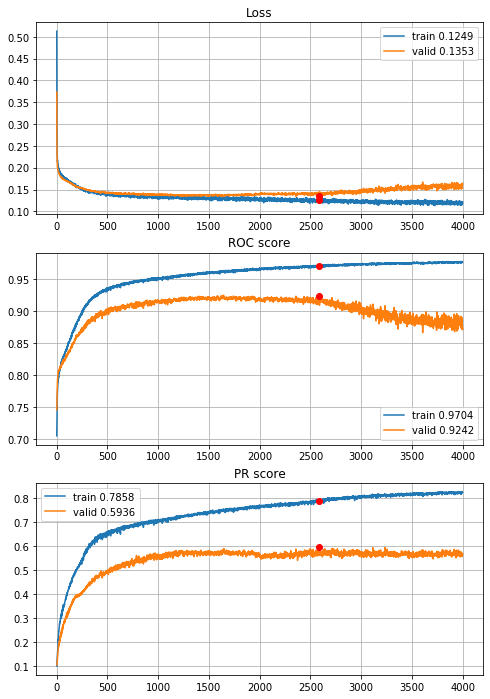


Fold 2------------------------------------------------------------


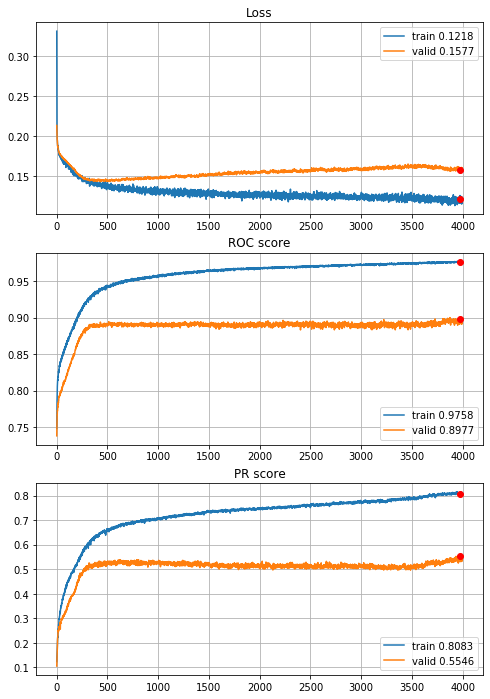


Fold 3------------------------------------------------------------


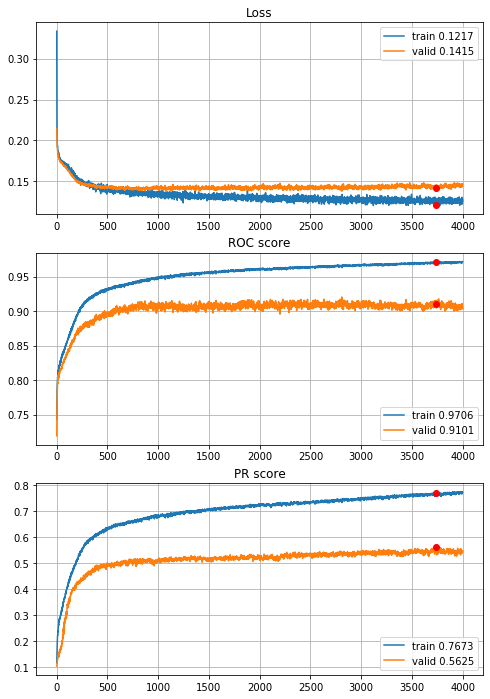


Fold 4------------------------------------------------------------


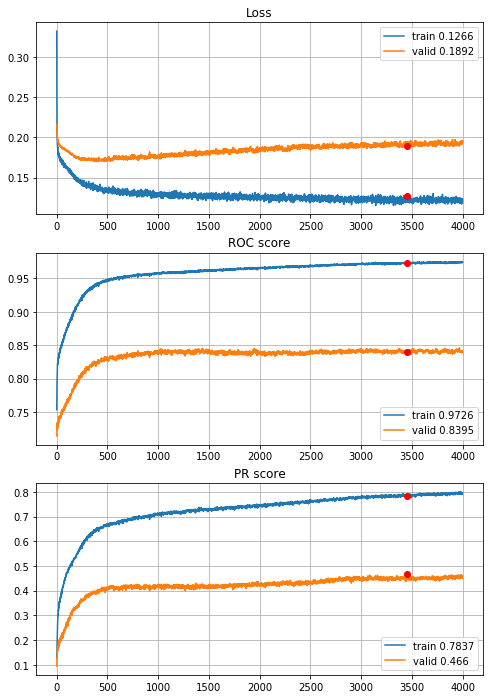


Fold 5------------------------------------------------------------


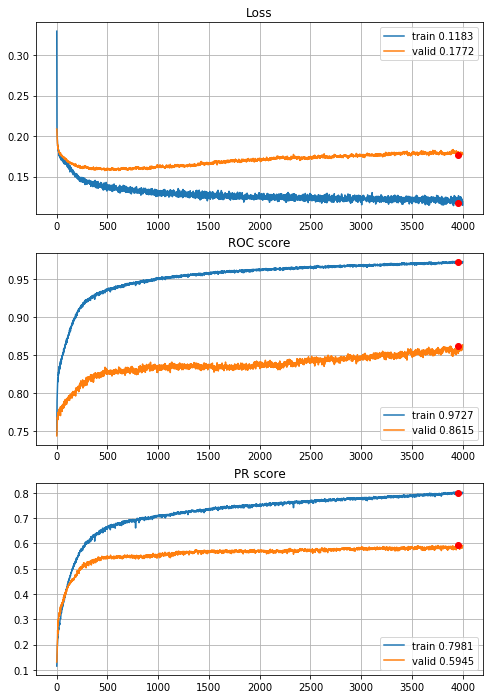


Fold 6------------------------------------------------------------


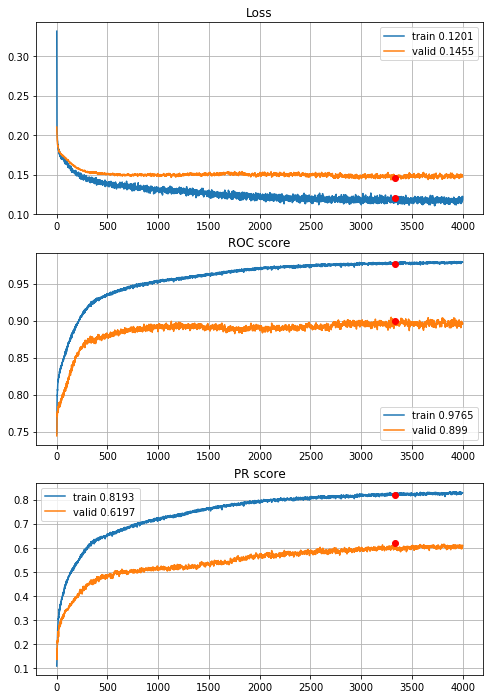

In [68]:
# best model for 1 and 2 year horizons, 4000 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=4000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\3year\MLP_L1_4000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Lets try the model above but with more epochs, 8000.


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/8000,
cumulative time: 10.03s train loss: 0.5186428012143784, validation loss: 0.37789003551006317
Epoch: 2/8000,
cumulative time: 10.2s train loss: 0.36139819062319184, validation loss: 0.2832832932472229
Epoch: 3/8000,
cumulative time: 10.36s train loss: 0.29076976662453446, validation loss: 0.2423500046133995
Epoch: 4/8000,
cumulative time: 10.51s train loss: 0.2538400436186318, validation loss: 0.2241155058145523
Epoch: 5/8000,
cumulative time: 10.67s train loss: 0.2384480238377049, validation loss: 0.21427417546510696
Epoch: 6/8000,
cumulative time: 10.81s train loss: 0.22627805910508847, validation loss: 0.2086269035935402
Epoch: 7/8000,
cumulative time: 10.96s train loss: 0.22230701600690975, validation loss: 0.2051369622349739
Epoch: 8/8000,
cumulative time: 11.09s train loss: 0.21447182053566705, validation loss: 0.20188312232494354
Epoch: 9/8000,
cumulative time: 11.25s train loss: 0.21633

Epoch: 77/8000,
cumulative time: 21.43s train loss: 0.17589083035822264, validation loss: 0.1718726046383381
Epoch: 78/8000,
cumulative time: 21.62s train loss: 0.1774210857143252, validation loss: 0.1722164824604988
Epoch: 79/8000,
cumulative time: 21.78s train loss: 0.17682345141502975, validation loss: 0.17201382666826248
Epoch: 80/8000,
cumulative time: 21.94s train loss: 0.17536712918807068, validation loss: 0.17175444588065147
Epoch: 81/8000,
cumulative time: 22.08s train loss: 0.17642153793857931, validation loss: 0.1723286211490631
Epoch: 82/8000,
cumulative time: 22.24s train loss: 0.17634932155715688, validation loss: 0.1718989461660385
Epoch: 83/8000,
cumulative time: 22.4s train loss: 0.1746154139986675, validation loss: 0.1717572882771492
Epoch: 84/8000,
cumulative time: 22.56s train loss: 0.17414527583570272, validation loss: 0.17136671394109726
Epoch: 85/8000,
cumulative time: 22.73s train loss: 0.17151559625575843, validation loss: 0.1716453619301319
Epoch: 86/8000,
cum

Epoch: 152/8000,
cumulative time: 33.34s train loss: 0.1648075275800445, validation loss: 0.16310835629701614
Epoch: 153/8000,
cumulative time: 33.51s train loss: 0.16380421301929887, validation loss: 0.16285685449838638
Epoch: 154/8000,
cumulative time: 33.68s train loss: 0.1638503214878864, validation loss: 0.16244352981448174
Epoch: 155/8000,
cumulative time: 33.84s train loss: 0.16126284777073766, validation loss: 0.1628909446299076
Epoch: 156/8000,
cumulative time: 34.0s train loss: 0.16523048254046843, validation loss: 0.16126681119203568
Epoch: 157/8000,
cumulative time: 34.14s train loss: 0.16242736777779776, validation loss: 0.16193486377596855
Epoch: 158/8000,
cumulative time: 34.32s train loss: 0.162175635364968, validation loss: 0.16157172620296478
Epoch: 159/8000,
cumulative time: 34.48s train loss: 0.16298629069173923, validation loss: 0.16258713603019714
Epoch: 160/8000,
cumulative time: 34.65s train loss: 0.1631248886453403, validation loss: 0.161259263753891
Epoch: 161

Epoch: 228/8000,
cumulative time: 45.5s train loss: 0.15400094843345163, validation loss: 0.153661347925663
Epoch: 229/8000,
cumulative time: 45.64s train loss: 0.15152086341378046, validation loss: 0.15360816568136215
Epoch: 230/8000,
cumulative time: 45.83s train loss: 0.15264285098498337, validation loss: 0.15377502515912056
Epoch: 231/8000,
cumulative time: 45.98s train loss: 0.15245561748024108, validation loss: 0.154219388961792
Epoch: 232/8000,
cumulative time: 46.15s train loss: 0.15563682763027986, validation loss: 0.1540885604918003
Epoch: 233/8000,
cumulative time: 46.32s train loss: 0.15393885940411722, validation loss: 0.1540665663778782
Epoch: 234/8000,
cumulative time: 46.47s train loss: 0.15301586498556977, validation loss: 0.15381037071347237
Epoch: 235/8000,
cumulative time: 46.62s train loss: 0.15416107684706842, validation loss: 0.15417227521538734
Epoch: 236/8000,
cumulative time: 46.79s train loss: 0.15023555146097956, validation loss: 0.15357591211795807
Epoch: 2

Epoch: 304/8000,
cumulative time: 57.55s train loss: 0.149461338853718, validation loss: 0.1490761823952198
Epoch: 305/8000,
cumulative time: 57.72s train loss: 0.14735604498351873, validation loss: 0.1487058699131012
Epoch: 306/8000,
cumulative time: 57.88s train loss: 0.14407590159521058, validation loss: 0.14856193959712982
Epoch: 307/8000,
cumulative time: 58.05s train loss: 0.14426578364134923, validation loss: 0.14890529215335846
Epoch: 308/8000,
cumulative time: 58.21s train loss: 0.14368471155324342, validation loss: 0.1488782986998558
Epoch: 309/8000,
cumulative time: 58.39s train loss: 0.14562552680917473, validation loss: 0.14871034026145935
Epoch: 310/8000,
cumulative time: 58.53s train loss: 0.1433001031835198, validation loss: 0.14903967827558517
Epoch: 311/8000,
cumulative time: 58.69s train loss: 0.14779001752310988, validation loss: 0.14801540784537792
Epoch: 312/8000,
cumulative time: 58.87s train loss: 0.14708031348623013, validation loss: 0.14786242693662643
Epoch: 

Epoch: 380/8000,
cumulative time: 69.75s train loss: 0.14286870673798316, validation loss: 0.1473202370107174
Epoch: 381/8000,
cumulative time: 69.89s train loss: 0.14550234850376859, validation loss: 0.14610152319073677
Epoch: 382/8000,
cumulative time: 70.07s train loss: 0.14574704597547553, validation loss: 0.14514494314789772
Epoch: 383/8000,
cumulative time: 70.21s train loss: 0.14200252150750634, validation loss: 0.14597661048173904
Epoch: 384/8000,
cumulative time: 70.38s train loss: 0.14318220984094213, validation loss: 0.1450512409210205
Epoch: 385/8000,
cumulative time: 70.53s train loss: 0.1445031062718301, validation loss: 0.14489691331982613
Epoch: 386/8000,
cumulative time: 70.7s train loss: 0.14179394431052744, validation loss: 0.14536617137491703
Epoch: 387/8000,
cumulative time: 70.85s train loss: 0.1448497937745313, validation loss: 0.14405215345323086
Epoch: 388/8000,
cumulative time: 71.02s train loss: 0.14089500473470723, validation loss: 0.14526943862438202
Epoch:

Epoch: 456/8000,
cumulative time: 81.7s train loss: 0.1406254528791333, validation loss: 0.14374861121177673
Epoch: 457/8000,
cumulative time: 81.84s train loss: 0.14026057040020862, validation loss: 0.14404955133795738
Epoch: 458/8000,
cumulative time: 82.0s train loss: 0.14351515834058462, validation loss: 0.14403807744383812
Epoch: 459/8000,
cumulative time: 82.14s train loss: 0.14019646392846666, validation loss: 0.14326132461428642
Epoch: 460/8000,
cumulative time: 82.29s train loss: 0.14337766915748965, validation loss: 0.14388319477438927
Epoch: 461/8000,
cumulative time: 82.44s train loss: 0.13900749569824045, validation loss: 0.14364930614829063
Epoch: 462/8000,
cumulative time: 82.6s train loss: 0.1434044251175869, validation loss: 0.143559318035841
Epoch: 463/8000,
cumulative time: 82.76s train loss: 0.1422053783991998, validation loss: 0.14370605535805225
Epoch: 464/8000,
cumulative time: 82.92s train loss: 0.1388419441587432, validation loss: 0.14355611987411976
Epoch: 465

Epoch: 532/8000,
cumulative time: 93.5s train loss: 0.13763079157315758, validation loss: 0.14209848083555698
Epoch: 533/8000,
cumulative time: 93.64s train loss: 0.13720705254034624, validation loss: 0.14047127962112427
Epoch: 534/8000,
cumulative time: 93.8s train loss: 0.13572121220283728, validation loss: 0.14103985577821732
Epoch: 535/8000,
cumulative time: 93.94s train loss: 0.13741454769279704, validation loss: 0.14098666235804558
Epoch: 536/8000,
cumulative time: 94.11s train loss: 0.139172599938026, validation loss: 0.1418558657169342
Epoch: 537/8000,
cumulative time: 94.26s train loss: 0.13611347881396935, validation loss: 0.14185461960732937
Epoch: 538/8000,
cumulative time: 94.42s train loss: 0.13778325665028887, validation loss: 0.14146221987903118
Epoch: 539/8000,
cumulative time: 94.58s train loss: 0.13694302356669963, validation loss: 0.14121892303228378
Epoch: 540/8000,
cumulative time: 94.73s train loss: 0.13734676080451755, validation loss: 0.1405761782079935
Epoch: 

Epoch: 608/8000,
cumulative time: 105.39s train loss: 0.13905961017104015, validation loss: 0.14133036136627197
Epoch: 609/8000,
cumulative time: 105.55s train loss: 0.13665954783036663, validation loss: 0.14044571854174137
Epoch: 610/8000,
cumulative time: 105.72s train loss: 0.1361537381189314, validation loss: 0.1403948999941349
Epoch: 611/8000,
cumulative time: 105.87s train loss: 0.13301371003715384, validation loss: 0.1412823237478733
Epoch: 612/8000,
cumulative time: 106.02s train loss: 0.13776179171489422, validation loss: 0.14028805308043957
Epoch: 613/8000,
cumulative time: 106.18s train loss: 0.13612879934749547, validation loss: 0.1409570723772049
Epoch: 614/8000,
cumulative time: 106.34s train loss: 0.13400606087935402, validation loss: 0.14056761749088764
Epoch: 615/8000,
cumulative time: 106.49s train loss: 0.13874101846153933, validation loss: 0.1407708302140236
Epoch: 616/8000,
cumulative time: 106.65s train loss: 0.13815498078661015, validation loss: 0.140252690762281

Epoch: 682/8000,
cumulative time: 117.03s train loss: 0.13380664110433457, validation loss: 0.14114023931324482
Epoch: 683/8000,
cumulative time: 117.18s train loss: 0.13477139045527406, validation loss: 0.14075520262122154
Epoch: 684/8000,
cumulative time: 117.34s train loss: 0.13715301532394816, validation loss: 0.14027815498411655
Epoch: 685/8000,
cumulative time: 117.48s train loss: 0.1376625595093076, validation loss: 0.1392575539648533
Epoch: 686/8000,
cumulative time: 117.65s train loss: 0.13712678954890684, validation loss: 0.1404146384447813
Epoch: 687/8000,
cumulative time: 117.81s train loss: 0.13472817650508492, validation loss: 0.14007162488996983
Epoch: 688/8000,
cumulative time: 117.97s train loss: 0.134751900544304, validation loss: 0.14095067977905273
Epoch: 689/8000,
cumulative time: 118.13s train loss: 0.13527670185000779, validation loss: 0.13933012448251247
Epoch: 690/8000,
cumulative time: 118.29s train loss: 0.13324902309393324, validation loss: 0.140287447720766

Epoch: 757/8000,
cumulative time: 128.9s train loss: 0.1352684087862122, validation loss: 0.13937759771943092
Epoch: 758/8000,
cumulative time: 129.06s train loss: 0.1323556767037794, validation loss: 0.14067602902650833
Epoch: 759/8000,
cumulative time: 129.22s train loss: 0.13458675519199526, validation loss: 0.1393071450293064
Epoch: 760/8000,
cumulative time: 129.36s train loss: 0.13377568254567998, validation loss: 0.1399926356971264
Epoch: 761/8000,
cumulative time: 129.53s train loss: 0.13240086835363965, validation loss: 0.1389321330934763
Epoch: 762/8000,
cumulative time: 129.69s train loss: 0.13849967932673868, validation loss: 0.1403511594980955
Epoch: 763/8000,
cumulative time: 129.85s train loss: 0.1347657447220136, validation loss: 0.1402045227587223
Epoch: 764/8000,
cumulative time: 130.01s train loss: 0.13388904219861258, validation loss: 0.13908487558364868
Epoch: 765/8000,
cumulative time: 130.15s train loss: 0.13685906147929605, validation loss: 0.1409083567559719
Ep

Epoch: 831/8000,
cumulative time: 140.47s train loss: 0.13379383370386216, validation loss: 0.1385528463870287
Epoch: 832/8000,
cumulative time: 140.63s train loss: 0.1323946315857618, validation loss: 0.13964184187352657
Epoch: 833/8000,
cumulative time: 140.79s train loss: 0.13781519183664834, validation loss: 0.13969936966896057
Epoch: 834/8000,
cumulative time: 140.95s train loss: 0.1318919733658607, validation loss: 0.14003295451402664
Epoch: 835/8000,
cumulative time: 141.12s train loss: 0.13249792218200745, validation loss: 0.1401124782860279
Epoch: 836/8000,
cumulative time: 141.3s train loss: 0.13616426915134677, validation loss: 0.13916347920894623
Epoch: 837/8000,
cumulative time: 141.45s train loss: 0.13093435503599182, validation loss: 0.13962804153561592
Epoch: 838/8000,
cumulative time: 141.66s train loss: 0.13477146823986524, validation loss: 0.1389928013086319
Epoch: 839/8000,
cumulative time: 141.8s train loss: 0.13557903811623143, validation loss: 0.13923193141818047

Epoch: 906/8000,
cumulative time: 152.22s train loss: 0.13916601716843943, validation loss: 0.13794837146997452
Epoch: 907/8000,
cumulative time: 152.37s train loss: 0.13413194110243376, validation loss: 0.1393537912517786
Epoch: 908/8000,
cumulative time: 152.53s train loss: 0.13176466623172656, validation loss: 0.13881128281354904
Epoch: 909/8000,
cumulative time: 152.69s train loss: 0.13417954608200164, validation loss: 0.1386643499135971
Epoch: 910/8000,
cumulative time: 152.85s train loss: 0.13489667279480252, validation loss: 0.13781103678047657
Epoch: 911/8000,
cumulative time: 153.01s train loss: 0.13131212502521206, validation loss: 0.13992279022932053
Epoch: 912/8000,
cumulative time: 153.15s train loss: 0.13199343621624854, validation loss: 0.13833650946617126
Epoch: 913/8000,
cumulative time: 153.31s train loss: 0.13150196611018516, validation loss: 0.1379838790744543
Epoch: 914/8000,
cumulative time: 153.47s train loss: 0.1321164075684402, validation loss: 0.13812851719558

Epoch: 980/8000,
cumulative time: 163.85s train loss: 0.13468440609036694, validation loss: 0.13789699040353298
Epoch: 981/8000,
cumulative time: 164.0s train loss: 0.13442928317145322, validation loss: 0.13780688308179379
Epoch: 982/8000,
cumulative time: 164.16s train loss: 0.13441268663045536, validation loss: 0.13730624690651894
Epoch: 983/8000,
cumulative time: 164.3s train loss: 0.13599270963620388, validation loss: 0.1378884594887495
Epoch: 984/8000,
cumulative time: 164.47s train loss: 0.13459352750677395, validation loss: 0.13793258368968964
Epoch: 985/8000,
cumulative time: 164.62s train loss: 0.13542194133402127, validation loss: 0.1388741433620453
Epoch: 986/8000,
cumulative time: 164.77s train loss: 0.13216357635416434, validation loss: 0.13836453296244144
Epoch: 987/8000,
cumulative time: 164.93s train loss: 0.1293607027326186, validation loss: 0.13790435902774334
Epoch: 988/8000,
cumulative time: 165.09s train loss: 0.13314674723914216, validation loss: 0.138763461261987

Epoch: 1054/8000,
cumulative time: 175.47s train loss: 0.13363213648895675, validation loss: 0.13847219944000244
Epoch: 1055/8000,
cumulative time: 175.62s train loss: 0.1347392195028784, validation loss: 0.13698547333478928
Epoch: 1056/8000,
cumulative time: 175.79s train loss: 0.1322496815846165, validation loss: 0.13825898431241512
Epoch: 1057/8000,
cumulative time: 175.94s train loss: 0.1342175657061104, validation loss: 0.13732348382472992
Epoch: 1058/8000,
cumulative time: 176.09s train loss: 0.12952050862009903, validation loss: 0.13838144578039646
Epoch: 1059/8000,
cumulative time: 176.24s train loss: 0.1314126442608917, validation loss: 0.13859901018440723
Epoch: 1060/8000,
cumulative time: 176.4s train loss: 0.13327190470860475, validation loss: 0.13758887350559235
Epoch: 1061/8000,
cumulative time: 176.56s train loss: 0.13389377084826987, validation loss: 0.13837704807519913
Epoch: 1062/8000,
cumulative time: 176.73s train loss: 0.13479322007558805, validation loss: 0.137678

Epoch: 1128/8000,
cumulative time: 187.06s train loss: 0.1281803785021563, validation loss: 0.13748103380203247
Epoch: 1129/8000,
cumulative time: 187.21s train loss: 0.1346917446757586, validation loss: 0.13856199756264687
Epoch: 1130/8000,
cumulative time: 187.39s train loss: 0.13018312150827213, validation loss: 0.13705364614725113
Epoch: 1131/8000,
cumulative time: 187.53s train loss: 0.13397353818879448, validation loss: 0.13827195204794407
Epoch: 1132/8000,
cumulative time: 187.69s train loss: 0.13304679022147425, validation loss: 0.13770275563001633
Epoch: 1133/8000,
cumulative time: 187.85s train loss: 0.1299269071284922, validation loss: 0.1373494490981102
Epoch: 1134/8000,
cumulative time: 188.0s train loss: 0.13433126995501754, validation loss: 0.13852448016405106
Epoch: 1135/8000,
cumulative time: 188.17s train loss: 0.1329684808411351, validation loss: 0.1364182084798813
Epoch: 1136/8000,
cumulative time: 188.32s train loss: 0.13288306006513737, validation loss: 0.13622789

Epoch: 1202/8000,
cumulative time: 198.64s train loss: 0.1311756641414336, validation loss: 0.13702094554901123
Epoch: 1203/8000,
cumulative time: 198.79s train loss: 0.13130941181625733, validation loss: 0.13630953803658485
Epoch: 1204/8000,
cumulative time: 198.95s train loss: 0.1302081292269041, validation loss: 0.13627598993480206
Epoch: 1205/8000,
cumulative time: 199.1s train loss: 0.1361116370996919, validation loss: 0.1361502669751644
Epoch: 1206/8000,
cumulative time: 199.27s train loss: 0.130626106637574, validation loss: 0.13740495592355728
Epoch: 1207/8000,
cumulative time: 199.42s train loss: 0.12981365745203213, validation loss: 0.1372471358627081
Epoch: 1208/8000,
cumulative time: 199.58s train loss: 0.13174964780051313, validation loss: 0.13650700449943542
Epoch: 1209/8000,
cumulative time: 199.74s train loss: 0.13380096539090647, validation loss: 0.1379249356687069
Epoch: 1210/8000,
cumulative time: 199.89s train loss: 0.13110182254772432, validation loss: 0.1379991732

Epoch: 1276/8000,
cumulative time: 210.3s train loss: 0.13421127839045152, validation loss: 0.13684636913239956
Epoch: 1277/8000,
cumulative time: 210.46s train loss: 0.1269500215228982, validation loss: 0.13587933219969273
Epoch: 1278/8000,
cumulative time: 210.63s train loss: 0.13378677741752595, validation loss: 0.13684575632214546
Epoch: 1279/8000,
cumulative time: 210.77s train loss: 0.12781914561010665, validation loss: 0.13670176081359386
Epoch: 1280/8000,
cumulative time: 210.94s train loss: 0.1330246504920276, validation loss: 0.13641022704541683
Epoch: 1281/8000,
cumulative time: 211.09s train loss: 0.13291697541262185, validation loss: 0.13625518046319485
Epoch: 1282/8000,
cumulative time: 211.25s train loss: 0.1309127910161999, validation loss: 0.13718833588063717
Epoch: 1283/8000,
cumulative time: 211.4s train loss: 0.12841840642904073, validation loss: 0.13626031950116158
Epoch: 1284/8000,
cumulative time: 211.56s train loss: 0.12873183720385198, validation loss: 0.135907

Epoch: 1350/8000,
cumulative time: 221.9s train loss: 0.1323871978682997, validation loss: 0.1367543302476406
Epoch: 1351/8000,
cumulative time: 222.07s train loss: 0.1297908024252248, validation loss: 0.1378280371427536
Epoch: 1352/8000,
cumulative time: 222.22s train loss: 0.13351572843418924, validation loss: 0.138090118765831
Epoch: 1353/8000,
cumulative time: 222.39s train loss: 0.1294797688245834, validation loss: 0.13848743960261345
Epoch: 1354/8000,
cumulative time: 222.54s train loss: 0.13160102455529119, validation loss: 0.13753575831651688
Epoch: 1355/8000,
cumulative time: 222.69s train loss: 0.1325922637455139, validation loss: 0.1363810896873474
Epoch: 1356/8000,
cumulative time: 222.85s train loss: 0.13050836111845068, validation loss: 0.13619952835142612
Epoch: 1357/8000,
cumulative time: 223.0s train loss: 0.13398745484033353, validation loss: 0.1366737261414528
Epoch: 1358/8000,
cumulative time: 223.17s train loss: 0.13257072936722686, validation loss: 0.1371112372726

Epoch: 1424/8000,
cumulative time: 233.51s train loss: 0.1302756910349979, validation loss: 0.1364445835351944
Epoch: 1425/8000,
cumulative time: 233.66s train loss: 0.1272543916481591, validation loss: 0.1363366637378931
Epoch: 1426/8000,
cumulative time: 233.82s train loss: 0.12788892484758638, validation loss: 0.136255644261837
Epoch: 1427/8000,
cumulative time: 233.98s train loss: 0.12899016193882834, validation loss: 0.13850930705666542
Epoch: 1428/8000,
cumulative time: 234.14s train loss: 0.1318206613369706, validation loss: 0.13779077678918839
Epoch: 1429/8000,
cumulative time: 234.29s train loss: 0.13395702424556122, validation loss: 0.1381408181041479
Epoch: 1430/8000,
cumulative time: 234.46s train loss: 0.1311526333789283, validation loss: 0.1377122513949871
Epoch: 1431/8000,
cumulative time: 234.62s train loss: 0.12809442070352056, validation loss: 0.1378419604152441
Epoch: 1432/8000,
cumulative time: 234.77s train loss: 0.13002879978164675, validation loss: 0.137178581207

Epoch: 1498/8000,
cumulative time: 244.99s train loss: 0.12721653459920018, validation loss: 0.1369396112859249
Epoch: 1499/8000,
cumulative time: 245.15s train loss: 0.13049429149918898, validation loss: 0.1354048065841198
Epoch: 1500/8000,
cumulative time: 245.31s train loss: 0.1281890683595059, validation loss: 0.13751889392733574
Epoch: 1501/8000,
cumulative time: 245.47s train loss: 0.13151169845663152, validation loss: 0.1371965277940035
Epoch: 1502/8000,
cumulative time: 245.62s train loss: 0.12973206252646724, validation loss: 0.13614347390830517
Epoch: 1503/8000,
cumulative time: 245.79s train loss: 0.13246602762004275, validation loss: 0.13635972701013088
Epoch: 1504/8000,
cumulative time: 245.94s train loss: 0.13027336532812908, validation loss: 0.13674479350447655
Epoch: 1505/8000,
cumulative time: 246.09s train loss: 0.13038698018142086, validation loss: 0.13573987782001495
Epoch: 1506/8000,
cumulative time: 246.25s train loss: 0.12771116739915614, validation loss: 0.13725

Epoch: 1572/8000,
cumulative time: 256.66s train loss: 0.1269547814771026, validation loss: 0.1375178024172783
Epoch: 1573/8000,
cumulative time: 256.81s train loss: 0.1311223784044438, validation loss: 0.13695301301777363
Epoch: 1574/8000,
cumulative time: 256.97s train loss: 0.13248033783932578, validation loss: 0.13860737346112728
Epoch: 1575/8000,
cumulative time: 257.11s train loss: 0.12799653962799412, validation loss: 0.13776770792901516
Epoch: 1576/8000,
cumulative time: 257.28s train loss: 0.12742811157058315, validation loss: 0.1377134770154953
Epoch: 1577/8000,
cumulative time: 257.43s train loss: 0.13103898943847905, validation loss: 0.13777821511030197
Epoch: 1578/8000,
cumulative time: 257.59s train loss: 0.13123886092717785, validation loss: 0.1369464471936226
Epoch: 1579/8000,
cumulative time: 257.74s train loss: 0.1306776167411469, validation loss: 0.1362503133714199
Epoch: 1580/8000,
cumulative time: 257.89s train loss: 0.12652888792860684, validation loss: 0.13728122

Epoch: 1646/8000,
cumulative time: 268.12s train loss: 0.13065313125561795, validation loss: 0.13601545616984367
Epoch: 1647/8000,
cumulative time: 268.28s train loss: 0.129456190198448, validation loss: 0.13618695735931396
Epoch: 1648/8000,
cumulative time: 268.45s train loss: 0.13156394973972413, validation loss: 0.13534128293395042
Epoch: 1649/8000,
cumulative time: 268.59s train loss: 0.130929978731821, validation loss: 0.13726912811398506
Epoch: 1650/8000,
cumulative time: 268.76s train loss: 0.13264018229273686, validation loss: 0.13625406846404076
Epoch: 1651/8000,
cumulative time: 268.92s train loss: 0.12710450378891294, validation loss: 0.13362018950283527
Epoch: 1652/8000,
cumulative time: 269.09s train loss: 0.1283273776948694, validation loss: 0.13596799783408642
Epoch: 1653/8000,
cumulative time: 269.25s train loss: 0.1297803604894934, validation loss: 0.13641038537025452
Epoch: 1654/8000,
cumulative time: 269.39s train loss: 0.12928074688180985, validation loss: 0.1363175

Epoch: 1720/8000,
cumulative time: 279.78s train loss: 0.12912541341628744, validation loss: 0.13818414509296417
Epoch: 1721/8000,
cumulative time: 279.92s train loss: 0.13007060506883886, validation loss: 0.13808813877403736
Epoch: 1722/8000,
cumulative time: 280.09s train loss: 0.1296346428969174, validation loss: 0.13775355368852615
Epoch: 1723/8000,
cumulative time: 280.24s train loss: 0.12742725325915763, validation loss: 0.13777473010122776
Epoch: 1724/8000,
cumulative time: 280.41s train loss: 0.12793803710344784, validation loss: 0.13807586207985878
Epoch: 1725/8000,
cumulative time: 280.56s train loss: 0.13114670542607518, validation loss: 0.1383198108524084
Epoch: 1726/8000,
cumulative time: 280.72s train loss: 0.13128595914996294, validation loss: 0.13864778727293015
Epoch: 1727/8000,
cumulative time: 280.87s train loss: 0.12674617170606428, validation loss: 0.13831914775073528
Epoch: 1728/8000,
cumulative time: 281.04s train loss: 0.1273179824462604, validation loss: 0.1380

Epoch: 1794/8000,
cumulative time: 291.38s train loss: 0.12696824863991985, validation loss: 0.13844431936740875
Epoch: 1795/8000,
cumulative time: 291.53s train loss: 0.12925770098353898, validation loss: 0.1397695541381836
Epoch: 1796/8000,
cumulative time: 291.69s train loss: 0.13001522632602389, validation loss: 0.13761776685714722
Epoch: 1797/8000,
cumulative time: 291.85s train loss: 0.12589783136722943, validation loss: 0.13759681582450867
Epoch: 1798/8000,
cumulative time: 292.01s train loss: 0.13078450085193205, validation loss: 0.13618580624461174
Epoch: 1799/8000,
cumulative time: 292.16s train loss: 0.12865257287779214, validation loss: 0.13830951415002346
Epoch: 1800/8000,
cumulative time: 292.32s train loss: 0.1261911522303819, validation loss: 0.1380445808172226
Epoch: 1801/8000,
cumulative time: 292.47s train loss: 0.12773600871707352, validation loss: 0.1377672627568245
Epoch: 1802/8000,
cumulative time: 292.64s train loss: 0.12869520645272678, validation loss: 0.13929

Epoch: 1868/8000,
cumulative time: 303.0s train loss: 0.12689168422604466, validation loss: 0.14021586626768112
Epoch: 1869/8000,
cumulative time: 303.14s train loss: 0.1276784621372085, validation loss: 0.14015940204262733
Epoch: 1870/8000,
cumulative time: 303.29s train loss: 0.12554019791537158, validation loss: 0.13757611438632011
Epoch: 1871/8000,
cumulative time: 303.44s train loss: 0.12993228663498826, validation loss: 0.13909899815917015
Epoch: 1872/8000,
cumulative time: 303.59s train loss: 0.12700107348576725, validation loss: 0.1391579620540142
Epoch: 1873/8000,
cumulative time: 303.74s train loss: 0.1280747145762475, validation loss: 0.13933363184332848
Epoch: 1874/8000,
cumulative time: 303.89s train loss: 0.12893206195375106, validation loss: 0.14166099578142166
Epoch: 1875/8000,
cumulative time: 304.06s train loss: 0.1268248179442178, validation loss: 0.14004116505384445
Epoch: 1876/8000,
cumulative time: 304.21s train loss: 0.1325602773321559, validation loss: 0.1384701

Epoch: 1942/8000,
cumulative time: 314.44s train loss: 0.12979273328726942, validation loss: 0.13864903524518013
Epoch: 1943/8000,
cumulative time: 314.6s train loss: 0.1297425063901168, validation loss: 0.13808446191251278
Epoch: 1944/8000,
cumulative time: 314.75s train loss: 0.12891542958828808, validation loss: 0.13901874795556068
Epoch: 1945/8000,
cumulative time: 314.9s train loss: 0.12909937280085015, validation loss: 0.13863135874271393
Epoch: 1946/8000,
cumulative time: 315.06s train loss: 0.12685529547878302, validation loss: 0.14036580175161362
Epoch: 1947/8000,
cumulative time: 315.21s train loss: 0.1296388752296862, validation loss: 0.14103508368134499
Epoch: 1948/8000,
cumulative time: 315.37s train loss: 0.12410442367264193, validation loss: 0.13991450145840645
Epoch: 1949/8000,
cumulative time: 315.54s train loss: 0.13329883071902804, validation loss: 0.13804377987980843
Epoch: 1950/8000,
cumulative time: 315.69s train loss: 0.1299150826294995, validation loss: 0.139523

Epoch: 2016/8000,
cumulative time: 325.99s train loss: 0.1292634281301904, validation loss: 0.14102086424827576
Epoch: 2017/8000,
cumulative time: 326.18s train loss: 0.12450204407838833, validation loss: 0.1412210501730442
Epoch: 2018/8000,
cumulative time: 326.32s train loss: 0.12451335670660146, validation loss: 0.14119317382574081
Epoch: 2019/8000,
cumulative time: 326.48s train loss: 0.12633019729449763, validation loss: 0.1403316631913185
Epoch: 2020/8000,
cumulative time: 326.62s train loss: 0.1282985203323811, validation loss: 0.14031054824590683
Epoch: 2021/8000,
cumulative time: 326.81s train loss: 0.12776954319572134, validation loss: 0.14150119200348854
Epoch: 2022/8000,
cumulative time: 326.96s train loss: 0.12438308078854322, validation loss: 0.14172115176916122
Epoch: 2023/8000,
cumulative time: 327.11s train loss: 0.12712110136103486, validation loss: 0.14237599447369576
Epoch: 2024/8000,
cumulative time: 327.28s train loss: 0.12859791094780634, validation loss: 0.14217

Epoch: 2089/8000,
cumulative time: 337.46s train loss: 0.12875399618410047, validation loss: 0.14061905443668365
Epoch: 2090/8000,
cumulative time: 337.61s train loss: 0.12823862158832905, validation loss: 0.13987882807850838
Epoch: 2091/8000,
cumulative time: 337.78s train loss: 0.13063303984364863, validation loss: 0.13949042186141014
Epoch: 2092/8000,
cumulative time: 337.92s train loss: 0.13262409154740065, validation loss: 0.1403055302798748
Epoch: 2093/8000,
cumulative time: 338.09s train loss: 0.12415583534833137, validation loss: 0.14196264930069447
Epoch: 2094/8000,
cumulative time: 338.25s train loss: 0.13063215499544217, validation loss: 0.14092937856912613
Epoch: 2095/8000,
cumulative time: 338.41s train loss: 0.12697080328848653, validation loss: 0.14054947718977928
Epoch: 2096/8000,
cumulative time: 338.57s train loss: 0.12776970232559257, validation loss: 0.13920442759990692
Epoch: 2097/8000,
cumulative time: 338.73s train loss: 0.12839724468194996, validation loss: 0.14

Epoch: 2162/8000,
cumulative time: 348.95s train loss: 0.12725457834971926, validation loss: 0.13903022184967995
Epoch: 2163/8000,
cumulative time: 349.09s train loss: 0.12679565107991939, validation loss: 0.1391761265695095
Epoch: 2164/8000,
cumulative time: 349.25s train loss: 0.1272314550906586, validation loss: 0.14015815034508705
Epoch: 2165/8000,
cumulative time: 349.4s train loss: 0.1255005667749518, validation loss: 0.13976920023560524
Epoch: 2166/8000,
cumulative time: 349.56s train loss: 0.12230600491014758, validation loss: 0.13913970440626144
Epoch: 2167/8000,
cumulative time: 349.7s train loss: 0.12447571178728883, validation loss: 0.140770573168993
Epoch: 2168/8000,
cumulative time: 349.86s train loss: 0.12444499837316916, validation loss: 0.1414714902639389
Epoch: 2169/8000,
cumulative time: 350.02s train loss: 0.1289954230098509, validation loss: 0.1404172070324421
Epoch: 2170/8000,
cumulative time: 350.17s train loss: 0.12553957885120834, validation loss: 0.13965928554

Epoch: 2236/8000,
cumulative time: 360.51s train loss: 0.12858113408308153, validation loss: 0.14039654284715652
Epoch: 2237/8000,
cumulative time: 360.66s train loss: 0.1268097465359329, validation loss: 0.13999969139695168
Epoch: 2238/8000,
cumulative time: 360.82s train loss: 0.12561071604497848, validation loss: 0.14066264405846596
Epoch: 2239/8000,
cumulative time: 360.97s train loss: 0.12483985133851283, validation loss: 0.1400885470211506
Epoch: 2240/8000,
cumulative time: 361.12s train loss: 0.12689815844002866, validation loss: 0.14080632105469704
Epoch: 2241/8000,
cumulative time: 361.29s train loss: 0.12543532746872846, validation loss: 0.1425228714942932
Epoch: 2242/8000,
cumulative time: 361.44s train loss: 0.12701043150202765, validation loss: 0.14105939865112305
Epoch: 2243/8000,
cumulative time: 361.59s train loss: 0.12495756896998811, validation loss: 0.14091885089874268
Epoch: 2244/8000,
cumulative time: 361.76s train loss: 0.1276201940221554, validation loss: 0.14127

Epoch: 2310/8000,
cumulative time: 372.05s train loss: 0.127531097937941, validation loss: 0.14060794562101364
Epoch: 2311/8000,
cumulative time: 372.19s train loss: 0.12525155447676983, validation loss: 0.14261853322386742
Epoch: 2312/8000,
cumulative time: 372.36s train loss: 0.12691076407317828, validation loss: 0.14082017168402672
Epoch: 2313/8000,
cumulative time: 372.49s train loss: 0.12587561105496695, validation loss: 0.14055631309747696
Epoch: 2314/8000,
cumulative time: 372.66s train loss: 0.12367059386710397, validation loss: 0.14155984669923782
Epoch: 2315/8000,
cumulative time: 372.79s train loss: 0.1243889802010184, validation loss: 0.14135881140828133
Epoch: 2316/8000,
cumulative time: 372.97s train loss: 0.1260465124972948, validation loss: 0.1415029801428318
Epoch: 2317/8000,
cumulative time: 373.11s train loss: 0.12792345088158785, validation loss: 0.14196481928229332
Epoch: 2318/8000,
cumulative time: 373.28s train loss: 0.12840882586783536, validation loss: 0.140804

Epoch: 2383/8000,
cumulative time: 383.38s train loss: 0.12702749114069253, validation loss: 0.14108721539378166
Epoch: 2384/8000,
cumulative time: 383.53s train loss: 0.1262482556823306, validation loss: 0.14031211659312248
Epoch: 2385/8000,
cumulative time: 383.68s train loss: 0.1268877223448108, validation loss: 0.14142420515418053
Epoch: 2386/8000,
cumulative time: 383.83s train loss: 0.12338396937502648, validation loss: 0.14151033759117126
Epoch: 2387/8000,
cumulative time: 383.97s train loss: 0.12549101325757556, validation loss: 0.14101411029696465
Epoch: 2388/8000,
cumulative time: 384.12s train loss: 0.12371206814834707, validation loss: 0.14161670580506325
Epoch: 2389/8000,
cumulative time: 384.28s train loss: 0.12553233418891793, validation loss: 0.1418878249824047
Epoch: 2390/8000,
cumulative time: 384.44s train loss: 0.12889538761729696, validation loss: 0.1418057605624199
Epoch: 2391/8000,
cumulative time: 384.58s train loss: 0.12796541686331095, validation loss: 0.14155

Epoch: 2457/8000,
cumulative time: 394.79s train loss: 0.1267980317012376, validation loss: 0.13899673894047737
Epoch: 2458/8000,
cumulative time: 394.94s train loss: 0.1256078820582905, validation loss: 0.14138364791870117
Epoch: 2459/8000,
cumulative time: 395.11s train loss: 0.1282622565535678, validation loss: 0.1410204954445362
Epoch: 2460/8000,
cumulative time: 395.26s train loss: 0.12355988208391813, validation loss: 0.14001230709254742
Epoch: 2461/8000,
cumulative time: 395.43s train loss: 0.1299047861863145, validation loss: 0.14049622789025307
Epoch: 2462/8000,
cumulative time: 395.57s train loss: 0.1304345413126759, validation loss: 0.14183136075735092
Epoch: 2463/8000,
cumulative time: 395.74s train loss: 0.1249685114511625, validation loss: 0.1414196565747261
Epoch: 2464/8000,
cumulative time: 395.9s train loss: 0.12481120292337611, validation loss: 0.14182298257946968
Epoch: 2465/8000,
cumulative time: 396.04s train loss: 0.1246885194326337, validation loss: 0.14144032448

Epoch: 2531/8000,
cumulative time: 406.46s train loss: 0.12608803279883307, validation loss: 0.14045192301273346
Epoch: 2532/8000,
cumulative time: 406.62s train loss: 0.12487528645308142, validation loss: 0.13922594860196114
Epoch: 2533/8000,
cumulative time: 406.78s train loss: 0.12654018966096073, validation loss: 0.1401338167488575
Epoch: 2534/8000,
cumulative time: 406.94s train loss: 0.1224626691840729, validation loss: 0.14205335453152657
Epoch: 2535/8000,
cumulative time: 407.08s train loss: 0.1236973222328086, validation loss: 0.1428840085864067
Epoch: 2536/8000,
cumulative time: 407.24s train loss: 0.12388063151220975, validation loss: 0.14122020080685616
Epoch: 2537/8000,
cumulative time: 407.39s train loss: 0.13057808184484468, validation loss: 0.14109386131167412
Epoch: 2538/8000,
cumulative time: 407.55s train loss: 0.12430944925088032, validation loss: 0.1419590525329113
Epoch: 2539/8000,
cumulative time: 407.71s train loss: 0.12706925392097904, validation loss: 0.140987

Epoch: 2605/8000,
cumulative time: 417.96s train loss: 0.12511298137041987, validation loss: 0.1425783410668373
Epoch: 2606/8000,
cumulative time: 418.11s train loss: 0.12439573396691639, validation loss: 0.14436329156160355
Epoch: 2607/8000,
cumulative time: 418.27s train loss: 0.12655682134153032, validation loss: 0.14158283546566963
Epoch: 2608/8000,
cumulative time: 418.41s train loss: 0.12457125797232073, validation loss: 0.14275889843702316
Epoch: 2609/8000,
cumulative time: 418.57s train loss: 0.12371991770204825, validation loss: 0.1432546004652977
Epoch: 2610/8000,
cumulative time: 418.71s train loss: 0.12513987058768908, validation loss: 0.1421581320464611
Epoch: 2611/8000,
cumulative time: 418.88s train loss: 0.12373888962360552, validation loss: 0.14004910364747047
Epoch: 2612/8000,
cumulative time: 419.02s train loss: 0.12328868123020177, validation loss: 0.14291022345423698
Epoch: 2613/8000,
cumulative time: 419.18s train loss: 0.12367738613271362, validation loss: 0.1417

Epoch: 2679/8000,
cumulative time: 429.51s train loss: 0.12278866206724792, validation loss: 0.14072644710540771
Epoch: 2680/8000,
cumulative time: 429.64s train loss: 0.12298078302231581, validation loss: 0.14211713895201683
Epoch: 2681/8000,
cumulative time: 429.81s train loss: 0.12326675983606528, validation loss: 0.14076216518878937
Epoch: 2682/8000,
cumulative time: 429.94s train loss: 0.12431336335228627, validation loss: 0.1432541385293007
Epoch: 2683/8000,
cumulative time: 430.11s train loss: 0.12212998706444439, validation loss: 0.1427285335958004
Epoch: 2684/8000,
cumulative time: 430.27s train loss: 0.12418311274312001, validation loss: 0.14145901799201965
Epoch: 2685/8000,
cumulative time: 430.43s train loss: 0.12210125397415922, validation loss: 0.14233049750328064
Epoch: 2686/8000,
cumulative time: 430.58s train loss: 0.12595156295468143, validation loss: 0.14471016451716423
Epoch: 2687/8000,
cumulative time: 430.73s train loss: 0.12718758722620607, validation loss: 0.144

Epoch: 2753/8000,
cumulative time: 441.06s train loss: 0.12484821759887066, validation loss: 0.14297737926244736
Epoch: 2754/8000,
cumulative time: 441.22s train loss: 0.1260751440379449, validation loss: 0.14235740900039673
Epoch: 2755/8000,
cumulative time: 441.39s train loss: 0.12194878719047038, validation loss: 0.14549272134900093
Epoch: 2756/8000,
cumulative time: 441.53s train loss: 0.12517288479331545, validation loss: 0.14394552260637283
Epoch: 2757/8000,
cumulative time: 441.69s train loss: 0.12462717168687745, validation loss: 0.14318551868200302
Epoch: 2758/8000,
cumulative time: 441.84s train loss: 0.12616380092008214, validation loss: 0.14483173191547394
Epoch: 2759/8000,
cumulative time: 442.01s train loss: 0.12801697470130444, validation loss: 0.144575834274292
Epoch: 2760/8000,
cumulative time: 442.17s train loss: 0.12473013085337264, validation loss: 0.14776292815804482
Epoch: 2761/8000,
cumulative time: 442.33s train loss: 0.12733226763477115, validation loss: 0.1439

Epoch: 2827/8000,
cumulative time: 452.67s train loss: 0.12255379769510276, validation loss: 0.1467650756239891
Epoch: 2828/8000,
cumulative time: 452.83s train loss: 0.12493710389569848, validation loss: 0.14532481878995895
Epoch: 2829/8000,
cumulative time: 453.0s train loss: 0.11899205357396342, validation loss: 0.1471562199294567
Epoch: 2830/8000,
cumulative time: 453.15s train loss: 0.12283968873446881, validation loss: 0.14737971499562263
Epoch: 2831/8000,
cumulative time: 453.3s train loss: 0.12380635447009315, validation loss: 0.14767026156187057
Epoch: 2832/8000,
cumulative time: 453.46s train loss: 0.1235308461723714, validation loss: 0.14341994747519493
Epoch: 2833/8000,
cumulative time: 453.62s train loss: 0.12294212771875716, validation loss: 0.14264050871133804
Epoch: 2834/8000,
cumulative time: 453.78s train loss: 0.12758339290663698, validation loss: 0.1441274993121624
Epoch: 2835/8000,
cumulative time: 453.94s train loss: 0.12300605356594885, validation loss: 0.1448038

Epoch: 2901/8000,
cumulative time: 464.28s train loss: 0.1266677849838551, validation loss: 0.14918943122029305
Epoch: 2902/8000,
cumulative time: 464.44s train loss: 0.12535038287148312, validation loss: 0.14444013684988022
Epoch: 2903/8000,
cumulative time: 464.59s train loss: 0.1207803661574138, validation loss: 0.14645664021372795
Epoch: 2904/8000,
cumulative time: 464.74s train loss: 0.12613624370850363, validation loss: 0.1433008387684822
Epoch: 2905/8000,
cumulative time: 464.9s train loss: 0.12091126095800608, validation loss: 0.14612946286797523
Epoch: 2906/8000,
cumulative time: 465.06s train loss: 0.1268826558081071, validation loss: 0.14568103849887848
Epoch: 2907/8000,
cumulative time: 465.21s train loss: 0.12203700407968675, validation loss: 0.1457398608326912
Epoch: 2908/8000,
cumulative time: 465.36s train loss: 0.12203239115620096, validation loss: 0.14517199993133545
Epoch: 2909/8000,
cumulative time: 465.53s train loss: 0.12532393927385566, validation loss: 0.1466992

Epoch: 2975/8000,
cumulative time: 475.8s train loss: 0.12104038172768057, validation loss: 0.15005650371313095
Epoch: 2976/8000,
cumulative time: 475.94s train loss: 0.11959916128081195, validation loss: 0.14557592570781708
Epoch: 2977/8000,
cumulative time: 476.12s train loss: 0.12236365265368568, validation loss: 0.14688878506422043
Epoch: 2978/8000,
cumulative time: 476.26s train loss: 0.12113066927854818, validation loss: 0.14314370974898338
Epoch: 2979/8000,
cumulative time: 476.42s train loss: 0.12490611315083842, validation loss: 0.14738983660936356
Epoch: 2980/8000,
cumulative time: 476.56s train loss: 0.120775936072084, validation loss: 0.1457580141723156
Epoch: 2981/8000,
cumulative time: 476.73s train loss: 0.12575348461526428, validation loss: 0.14862060546875
Epoch: 2982/8000,
cumulative time: 476.86s train loss: 0.11926302619925484, validation loss: 0.1475243642926216
Epoch: 2983/8000,
cumulative time: 477.03s train loss: 0.12295173490566612, validation loss: 0.151129886

Epoch: 3049/8000,
cumulative time: 487.31s train loss: 0.12142792713595199, validation loss: 0.14964601397514343
Epoch: 3050/8000,
cumulative time: 487.46s train loss: 0.12365979091498439, validation loss: 0.14727697893977165
Epoch: 3051/8000,
cumulative time: 487.64s train loss: 0.12067315545275527, validation loss: 0.14731194823980331
Epoch: 3052/8000,
cumulative time: 487.78s train loss: 0.12419714157338552, validation loss: 0.14802634343504906
Epoch: 3053/8000,
cumulative time: 487.93s train loss: 0.11953134118466283, validation loss: 0.15274158120155334
Epoch: 3054/8000,
cumulative time: 488.08s train loss: 0.12487406088933235, validation loss: 0.14834387600421906
Epoch: 3055/8000,
cumulative time: 488.23s train loss: 0.12247386396332342, validation loss: 0.14815926924347878
Epoch: 3056/8000,
cumulative time: 488.4s train loss: 0.12432398076640766, validation loss: 0.15063408017158508
Epoch: 3057/8000,
cumulative time: 488.55s train loss: 0.12745995661210688, validation loss: 0.14

Epoch: 3123/8000,
cumulative time: 498.9s train loss: 0.12301299611268278, validation loss: 0.14935314655303955
Epoch: 3124/8000,
cumulative time: 499.05s train loss: 0.12140283495785623, validation loss: 0.14524216204881668
Epoch: 3125/8000,
cumulative time: 499.21s train loss: 0.12424078582392967, validation loss: 0.15020586922764778
Epoch: 3126/8000,
cumulative time: 499.37s train loss: 0.1235905389621695, validation loss: 0.14934903010725975
Epoch: 3127/8000,
cumulative time: 499.51s train loss: 0.12505213141728924, validation loss: 0.14861775562167168
Epoch: 3128/8000,
cumulative time: 499.67s train loss: 0.12154411506938897, validation loss: 0.1485166847705841
Epoch: 3129/8000,
cumulative time: 499.83s train loss: 0.11885654879946767, validation loss: 0.14970627799630165
Epoch: 3130/8000,
cumulative time: 499.97s train loss: 0.12280326465276245, validation loss: 0.14976691082119942
Epoch: 3131/8000,
cumulative time: 500.14s train loss: 0.11811908994413016, validation loss: 0.1466

Epoch: 3196/8000,
cumulative time: 510.11s train loss: 0.11785431775709528, validation loss: 0.14811650663614273
Epoch: 3197/8000,
cumulative time: 510.26s train loss: 0.1251177632998639, validation loss: 0.14499617740511894
Epoch: 3198/8000,
cumulative time: 510.43s train loss: 0.12497363125630113, validation loss: 0.1489187404513359
Epoch: 3199/8000,
cumulative time: 510.57s train loss: 0.11962187531417914, validation loss: 0.15396011993288994
Epoch: 3200/8000,
cumulative time: 510.73s train loss: 0.12227476578737467, validation loss: 0.14971444010734558
Epoch: 3201/8000,
cumulative time: 510.89s train loss: 0.12294607252495551, validation loss: 0.14929060637950897
Epoch: 3202/8000,
cumulative time: 511.05s train loss: 0.12202972537516761, validation loss: 0.15243777632713318
Epoch: 3203/8000,
cumulative time: 511.21s train loss: 0.11989607539741202, validation loss: 0.1543489396572113
Epoch: 3204/8000,
cumulative time: 511.36s train loss: 0.12174642613321285, validation loss: 0.1503

Epoch: 3270/8000,
cumulative time: 521.77s train loss: 0.12443399320532975, validation loss: 0.15431026741862297
Epoch: 3271/8000,
cumulative time: 521.92s train loss: 0.12507721709268174, validation loss: 0.14975441247224808
Epoch: 3272/8000,
cumulative time: 522.09s train loss: 0.12273464017013658, validation loss: 0.1505368873476982
Epoch: 3273/8000,
cumulative time: 522.23s train loss: 0.12472735899332636, validation loss: 0.14988760650157928
Epoch: 3274/8000,
cumulative time: 522.39s train loss: 0.12105307083457724, validation loss: 0.14706644415855408
Epoch: 3275/8000,
cumulative time: 522.55s train loss: 0.12069105907116764, validation loss: 0.1539519503712654
Epoch: 3276/8000,
cumulative time: 522.7s train loss: 0.12361595425291252, validation loss: 0.15162041783332825
Epoch: 3277/8000,
cumulative time: 522.86s train loss: 0.11760919156861281, validation loss: 0.15395677089691162
Epoch: 3278/8000,
cumulative time: 523.03s train loss: 0.11867083982579171, validation loss: 0.1522

Epoch: 3344/8000,
cumulative time: 533.17s train loss: 0.12220791314098059, validation loss: 0.15662577003240585
Epoch: 3345/8000,
cumulative time: 533.32s train loss: 0.11826250214203474, validation loss: 0.1585325002670288
Epoch: 3346/8000,
cumulative time: 533.49s train loss: 0.12054161958059664, validation loss: 0.15880601108074188
Epoch: 3347/8000,
cumulative time: 533.64s train loss: 0.1211349589210013, validation loss: 0.15502505749464035
Epoch: 3348/8000,
cumulative time: 533.81s train loss: 0.12616974276567608, validation loss: 0.1548413336277008
Epoch: 3349/8000,
cumulative time: 533.97s train loss: 0.12083143191653317, validation loss: 0.15614311769604683
Epoch: 3350/8000,
cumulative time: 534.13s train loss: 0.12316502586816881, validation loss: 0.15096472203731537
Epoch: 3351/8000,
cumulative time: 534.28s train loss: 0.12009801182833464, validation loss: 0.1524754874408245
Epoch: 3352/8000,
cumulative time: 534.43s train loss: 0.12098663083455961, validation loss: 0.15990

Epoch: 3418/8000,
cumulative time: 544.71s train loss: 0.1208994566085013, validation loss: 0.15117480605840683
Epoch: 3419/8000,
cumulative time: 544.87s train loss: 0.1183973527865824, validation loss: 0.15260403230786324
Epoch: 3420/8000,
cumulative time: 545.04s train loss: 0.12348151103668614, validation loss: 0.1552916094660759
Epoch: 3421/8000,
cumulative time: 545.19s train loss: 0.12144015600773331, validation loss: 0.1564267762005329
Epoch: 3422/8000,
cumulative time: 545.35s train loss: 0.11963750269129653, validation loss: 0.1557490974664688
Epoch: 3423/8000,
cumulative time: 545.5s train loss: 0.12219288696971504, validation loss: 0.15512070059776306
Epoch: 3424/8000,
cumulative time: 545.66s train loss: 0.12101728634680813, validation loss: 0.15479331836104393
Epoch: 3425/8000,
cumulative time: 545.81s train loss: 0.12278450551925728, validation loss: 0.15097326785326004
Epoch: 3426/8000,
cumulative time: 545.98s train loss: 0.1185529865210979, validation loss: 0.15063788

Epoch: 3492/8000,
cumulative time: 556.18s train loss: 0.12530155828598188, validation loss: 0.15097948536276817
Epoch: 3493/8000,
cumulative time: 556.35s train loss: 0.11978459544763642, validation loss: 0.15600871294736862
Epoch: 3494/8000,
cumulative time: 556.51s train loss: 0.11926461040686084, validation loss: 0.15367024391889572
Epoch: 3495/8000,
cumulative time: 556.67s train loss: 0.11981717211422792, validation loss: 0.15374353155493736
Epoch: 3496/8000,
cumulative time: 556.82s train loss: 0.12050981635351724, validation loss: 0.1521921493113041
Epoch: 3497/8000,
cumulative time: 556.97s train loss: 0.12017113606054326, validation loss: 0.15511971339583397
Epoch: 3498/8000,
cumulative time: 557.13s train loss: 0.11968974852362159, validation loss: 0.15629523620009422
Epoch: 3499/8000,
cumulative time: 557.27s train loss: 0.11791966858553124, validation loss: 0.15589872375130653
Epoch: 3500/8000,
cumulative time: 557.43s train loss: 0.11941313010641862, validation loss: 0.15

Epoch: 3566/8000,
cumulative time: 567.81s train loss: 0.11908212075754432, validation loss: 0.15680135041475296
Epoch: 3567/8000,
cumulative time: 567.97s train loss: 0.12556929477864623, validation loss: 0.15745357796549797
Epoch: 3568/8000,
cumulative time: 568.14s train loss: 0.1214921325388416, validation loss: 0.15348661690950394
Epoch: 3569/8000,
cumulative time: 568.29s train loss: 0.12203791945105642, validation loss: 0.1568748541176319
Epoch: 3570/8000,
cumulative time: 568.44s train loss: 0.11935661253157517, validation loss: 0.1538441739976406
Epoch: 3571/8000,
cumulative time: 568.6s train loss: 0.12129050463158023, validation loss: 0.15452123805880547
Epoch: 3572/8000,
cumulative time: 568.76s train loss: 0.11736592683333803, validation loss: 0.15521840378642082
Epoch: 3573/8000,
cumulative time: 568.92s train loss: 0.12231577502032898, validation loss: 0.15648218616843224
Epoch: 3574/8000,
cumulative time: 569.07s train loss: 0.1189255873625838, validation loss: 0.152943

Epoch: 3640/8000,
cumulative time: 579.39s train loss: 0.12211049298924682, validation loss: 0.14817292243242264
Epoch: 3641/8000,
cumulative time: 579.52s train loss: 0.12370110575228914, validation loss: 0.15620680153369904
Epoch: 3642/8000,
cumulative time: 579.69s train loss: 0.12735874802744468, validation loss: 0.15591329708695412
Epoch: 3643/8000,
cumulative time: 579.84s train loss: 0.12062614620367605, validation loss: 0.14476795122027397
Epoch: 3644/8000,
cumulative time: 580.02s train loss: 0.12356221539650912, validation loss: 0.15457212179899216
Epoch: 3645/8000,
cumulative time: 580.16s train loss: 0.11985211395608888, validation loss: 0.15199676156044006
Epoch: 3646/8000,
cumulative time: 580.33s train loss: 0.12542663923468972, validation loss: 0.1510629542171955
Epoch: 3647/8000,
cumulative time: 580.48s train loss: 0.12108337517625309, validation loss: 0.15438397973775864
Epoch: 3648/8000,
cumulative time: 580.63s train loss: 0.12407074684779495, validation loss: 0.15

Epoch: 3714/8000,
cumulative time: 590.98s train loss: 0.12245776462087236, validation loss: 0.1547192744910717
Epoch: 3715/8000,
cumulative time: 591.12s train loss: 0.11809515900088785, validation loss: 0.1567540131509304
Epoch: 3716/8000,
cumulative time: 591.28s train loss: 0.11695794673393438, validation loss: 0.15953141450881958
Epoch: 3717/8000,
cumulative time: 591.42s train loss: 0.11587326220861542, validation loss: 0.15792884677648544
Epoch: 3718/8000,
cumulative time: 591.58s train loss: 0.12425518903168038, validation loss: 0.1572486199438572
Epoch: 3719/8000,
cumulative time: 591.72s train loss: 0.12106572088552284, validation loss: 0.15564041584730148
Epoch: 3720/8000,
cumulative time: 591.89s train loss: 0.11509076719692118, validation loss: 0.15981889516115189
Epoch: 3721/8000,
cumulative time: 592.03s train loss: 0.12055272568318068, validation loss: 0.15910571441054344
Epoch: 3722/8000,
cumulative time: 592.19s train loss: 0.11657471732894378, validation loss: 0.1559

Epoch: 3788/8000,
cumulative time: 602.52s train loss: 0.11804767492013937, validation loss: 0.15658893436193466
Epoch: 3789/8000,
cumulative time: 602.68s train loss: 0.12145378495485665, validation loss: 0.15422162413597107
Epoch: 3790/8000,
cumulative time: 602.85s train loss: 0.11957756436154163, validation loss: 0.15857373178005219
Epoch: 3791/8000,
cumulative time: 603.0s train loss: 0.12307998829759154, validation loss: 0.14882083609700203
Epoch: 3792/8000,
cumulative time: 603.17s train loss: 0.12177363943181829, validation loss: 0.15237382426857948
Epoch: 3793/8000,
cumulative time: 603.31s train loss: 0.12502304680830878, validation loss: 0.15473195165395737
Epoch: 3794/8000,
cumulative time: 603.47s train loss: 0.12310268637786183, validation loss: 0.15153634548187256
Epoch: 3795/8000,
cumulative time: 603.64s train loss: 0.12324204892222805, validation loss: 0.15063981339335442
Epoch: 3796/8000,
cumulative time: 603.8s train loss: 0.11959082315216639, validation loss: 0.151

Epoch: 3862/8000,
cumulative time: 614.18s train loss: 0.1222862506587079, validation loss: 0.15929412469267845
Epoch: 3863/8000,
cumulative time: 614.33s train loss: 0.12205964306425238, validation loss: 0.15225475654006004
Epoch: 3864/8000,
cumulative time: 614.49s train loss: 0.1231983048021188, validation loss: 0.15134696662425995
Epoch: 3865/8000,
cumulative time: 614.63s train loss: 0.1221808239518688, validation loss: 0.16118182614445686
Epoch: 3866/8000,
cumulative time: 614.8s train loss: 0.1209532381969548, validation loss: 0.1541242003440857
Epoch: 3867/8000,
cumulative time: 614.95s train loss: 0.12056412592477275, validation loss: 0.15932385250926018
Epoch: 3868/8000,
cumulative time: 615.12s train loss: 0.11987133487612539, validation loss: 0.15642638131976128
Epoch: 3869/8000,
cumulative time: 615.26s train loss: 0.11484577940420308, validation loss: 0.15512825176119804
Epoch: 3870/8000,
cumulative time: 615.43s train loss: 0.1178085505565058, validation loss: 0.15595076

Epoch: 3935/8000,
cumulative time: 625.62s train loss: 0.12011517324177913, validation loss: 0.16253506392240524
Epoch: 3936/8000,
cumulative time: 625.77s train loss: 0.12381318533001302, validation loss: 0.16022026911377907
Epoch: 3937/8000,
cumulative time: 625.93s train loss: 0.12146812561405619, validation loss: 0.15581537783145905
Epoch: 3938/8000,
cumulative time: 626.1s train loss: 0.11843966592790028, validation loss: 0.1644788347184658
Epoch: 3939/8000,
cumulative time: 626.26s train loss: 0.12034229986244739, validation loss: 0.1535017117857933
Epoch: 3940/8000,
cumulative time: 626.4s train loss: 0.12321476524988063, validation loss: 0.15851256996393204
Epoch: 3941/8000,
cumulative time: 626.56s train loss: 0.11585813680916283, validation loss: 0.15747444704174995
Epoch: 3942/8000,
cumulative time: 626.7s train loss: 0.11944396952200263, validation loss: 0.15162456408143044
Epoch: 3943/8000,
cumulative time: 626.86s train loss: 0.12147829549575348, validation loss: 0.155995

Epoch: 4009/8000,
cumulative time: 637.25s train loss: 0.11796304558197092, validation loss: 0.16029953211545944
Epoch: 4010/8000,
cumulative time: 637.4s train loss: 0.11962777459421638, validation loss: 0.1593506783246994
Epoch: 4011/8000,
cumulative time: 637.57s train loss: 0.12120942583940487, validation loss: 0.1595671847462654
Epoch: 4012/8000,
cumulative time: 637.71s train loss: 0.11701880945029931, validation loss: 0.15486478060483932
Epoch: 4013/8000,
cumulative time: 637.88s train loss: 0.12183406399614984, validation loss: 0.16206315904855728
Epoch: 4014/8000,
cumulative time: 638.03s train loss: 0.1208065002248516, validation loss: 0.1641284003853798
Epoch: 4015/8000,
cumulative time: 638.19s train loss: 0.12118329060462116, validation loss: 0.15583709999918938
Epoch: 4016/8000,
cumulative time: 638.35s train loss: 0.11818117184262703, validation loss: 0.16190670430660248
Epoch: 4017/8000,
cumulative time: 638.5s train loss: 0.11861616091347697, validation loss: 0.1646362

Epoch: 4083/8000,
cumulative time: 648.92s train loss: 0.11645751089659846, validation loss: 0.1599414423108101
Epoch: 4084/8000,
cumulative time: 649.07s train loss: 0.11955855273508735, validation loss: 0.15921198949217796
Epoch: 4085/8000,
cumulative time: 649.23s train loss: 0.11973442893462051, validation loss: 0.1648697666823864
Epoch: 4086/8000,
cumulative time: 649.39s train loss: 0.11726715744162283, validation loss: 0.15679826214909554
Epoch: 4087/8000,
cumulative time: 649.55s train loss: 0.12006981403521017, validation loss: 0.1589106135070324
Epoch: 4088/8000,
cumulative time: 649.69s train loss: 0.12118368937339258, validation loss: 0.16463688015937805
Epoch: 4089/8000,
cumulative time: 649.86s train loss: 0.12135911234188589, validation loss: 0.1598542556166649
Epoch: 4090/8000,
cumulative time: 650.0s train loss: 0.11926216938059424, validation loss: 0.16320539638400078
Epoch: 4091/8000,
cumulative time: 650.17s train loss: 0.12054180783546474, validation loss: 0.162803

Epoch: 4157/8000,
cumulative time: 660.54s train loss: 0.1212449160424842, validation loss: 0.16174916177988052
Epoch: 4158/8000,
cumulative time: 660.69s train loss: 0.12090985720656498, validation loss: 0.1611475944519043
Epoch: 4159/8000,
cumulative time: 660.86s train loss: 0.11853825880253357, validation loss: 0.16579502820968628
Epoch: 4160/8000,
cumulative time: 661.01s train loss: 0.11830770322715285, validation loss: 0.15351422503590584
Epoch: 4161/8000,
cumulative time: 661.17s train loss: 0.12088536668461007, validation loss: 0.1552627645432949
Epoch: 4162/8000,
cumulative time: 661.33s train loss: 0.12266431143058018, validation loss: 0.15844282507896423
Epoch: 4163/8000,
cumulative time: 661.5s train loss: 0.12132927828547373, validation loss: 0.15507244318723679
Epoch: 4164/8000,
cumulative time: 661.64s train loss: 0.12038289250426634, validation loss: 0.15849162638187408
Epoch: 4165/8000,
cumulative time: 661.81s train loss: 0.12316843793515084, validation loss: 0.16589

Epoch: 4231/8000,
cumulative time: 672.3s train loss: 0.12354774473432723, validation loss: 0.16010791063308716
Epoch: 4232/8000,
cumulative time: 672.45s train loss: 0.12029022600836654, validation loss: 0.16665257140994072
Epoch: 4233/8000,
cumulative time: 672.62s train loss: 0.11587692374517737, validation loss: 0.15993204712867737
Epoch: 4234/8000,
cumulative time: 672.77s train loss: 0.11838415115050037, validation loss: 0.1608595922589302
Epoch: 4235/8000,
cumulative time: 672.95s train loss: 0.1217374263786313, validation loss: 0.1634383723139763
Epoch: 4236/8000,
cumulative time: 673.1s train loss: 0.12213249622057573, validation loss: 0.16617617011070251
Epoch: 4237/8000,
cumulative time: 673.26s train loss: 0.1219703375994251, validation loss: 0.15863175317645073
Epoch: 4238/8000,
cumulative time: 673.42s train loss: 0.11764506289972879, validation loss: 0.15662679076194763
Epoch: 4239/8000,
cumulative time: 673.57s train loss: 0.12059231082222496, validation loss: 0.1600693

Epoch: 4305/8000,
cumulative time: 684.08s train loss: 0.12199366265040415, validation loss: 0.16443830728530884
Epoch: 4306/8000,
cumulative time: 684.23s train loss: 0.12188091747360583, validation loss: 0.1659657545387745
Epoch: 4307/8000,
cumulative time: 684.4s train loss: 0.11824118856997161, validation loss: 0.1587241217494011
Epoch: 4308/8000,
cumulative time: 684.54s train loss: 0.12347545713155993, validation loss: 0.1658736653625965
Epoch: 4309/8000,
cumulative time: 684.7s train loss: 0.1177342956012551, validation loss: 0.1624656617641449
Epoch: 4310/8000,
cumulative time: 684.88s train loss: 0.11800949041456847, validation loss: 0.16127746552228928
Epoch: 4311/8000,
cumulative time: 685.03s train loss: 0.12077703472433082, validation loss: 0.16079049929976463
Epoch: 4312/8000,
cumulative time: 685.18s train loss: 0.12338266668320005, validation loss: 0.1640889160335064
Epoch: 4313/8000,
cumulative time: 685.35s train loss: 0.1223319713035745, validation loss: 0.1666475310

Epoch: 4378/8000,
cumulative time: 695.62s train loss: 0.11811013289511113, validation loss: 0.16605870053172112
Epoch: 4379/8000,
cumulative time: 695.78s train loss: 0.11941674026462437, validation loss: 0.16972709447145462
Epoch: 4380/8000,
cumulative time: 695.94s train loss: 0.1216818482334569, validation loss: 0.16906607523560524
Epoch: 4381/8000,
cumulative time: 696.09s train loss: 0.11758515930277191, validation loss: 0.166252750903368
Epoch: 4382/8000,
cumulative time: 696.25s train loss: 0.11669675030624006, validation loss: 0.16520997136831284
Epoch: 4383/8000,
cumulative time: 696.4s train loss: 0.12132431558390569, validation loss: 0.1687781997025013
Epoch: 4384/8000,
cumulative time: 696.55s train loss: 0.12019166602564378, validation loss: 0.17006928101181984
Epoch: 4385/8000,
cumulative time: 696.7s train loss: 0.12298271468844796, validation loss: 0.1639084704220295
Epoch: 4386/8000,
cumulative time: 696.87s train loss: 0.12022169789894394, validation loss: 0.16427199

Epoch: 4452/8000,
cumulative time: 707.3s train loss: 0.11933332023250082, validation loss: 0.16314873099327087
Epoch: 4453/8000,
cumulative time: 707.46s train loss: 0.1253271009252724, validation loss: 0.1661183051764965
Epoch: 4454/8000,
cumulative time: 707.62s train loss: 0.12485113574987501, validation loss: 0.16752378270030022
Epoch: 4455/8000,
cumulative time: 707.77s train loss: 0.12160311236697566, validation loss: 0.16172289103269577
Epoch: 4456/8000,
cumulative time: 707.92s train loss: 0.11796581771446098, validation loss: 0.16856063157320023
Epoch: 4457/8000,
cumulative time: 708.09s train loss: 0.1206521557416027, validation loss: 0.16185573861002922
Epoch: 4458/8000,
cumulative time: 708.25s train loss: 0.12478255405984233, validation loss: 0.1670205444097519
Epoch: 4459/8000,
cumulative time: 708.4s train loss: 0.11834099944047119, validation loss: 0.16695602238178253
Epoch: 4460/8000,
cumulative time: 708.57s train loss: 0.12254474152952297, validation loss: 0.1654268

Epoch: 4526/8000,
cumulative time: 718.93s train loss: 0.12235593871644392, validation loss: 0.16555627435445786
Epoch: 4527/8000,
cumulative time: 719.09s train loss: 0.11923951307125295, validation loss: 0.1623174510896206
Epoch: 4528/8000,
cumulative time: 719.25s train loss: 0.12201382058027918, validation loss: 0.1708650439977646
Epoch: 4529/8000,
cumulative time: 719.41s train loss: 0.11423203184322817, validation loss: 0.16419082507491112
Epoch: 4530/8000,
cumulative time: 719.57s train loss: 0.11889817877665518, validation loss: 0.16636808961629868
Epoch: 4531/8000,
cumulative time: 719.72s train loss: 0.11779703093723878, validation loss: 0.1647447533905506
Epoch: 4532/8000,
cumulative time: 719.87s train loss: 0.12532085344127256, validation loss: 0.1609404757618904
Epoch: 4533/8000,
cumulative time: 720.01s train loss: 0.11681535159681823, validation loss: 0.17085038870573044
Epoch: 4534/8000,
cumulative time: 720.19s train loss: 0.11787344776415595, validation loss: 0.15948

Epoch: 4600/8000,
cumulative time: 730.57s train loss: 0.12109510312798122, validation loss: 0.1654476821422577
Epoch: 4601/8000,
cumulative time: 730.73s train loss: 0.12063700444296328, validation loss: 0.16539061814546585
Epoch: 4602/8000,
cumulative time: 730.89s train loss: 0.11857570310105764, validation loss: 0.16674286872148514
Epoch: 4603/8000,
cumulative time: 731.03s train loss: 0.11870592087696445, validation loss: 0.17108090221881866
Epoch: 4604/8000,
cumulative time: 731.2s train loss: 0.11626759515635371, validation loss: 0.16878195479512215
Epoch: 4605/8000,
cumulative time: 731.36s train loss: 0.12107284324325965, validation loss: 0.1662948615849018
Epoch: 4606/8000,
cumulative time: 731.52s train loss: 0.12290209156795466, validation loss: 0.1708526462316513
Epoch: 4607/8000,
cumulative time: 731.67s train loss: 0.11715971433106807, validation loss: 0.16752326115965843
Epoch: 4608/8000,
cumulative time: 731.84s train loss: 0.11699139775397088, validation loss: 0.16848

Epoch: 4673/8000,
cumulative time: 742.12s train loss: 0.12157186167480195, validation loss: 0.1653638519346714
Epoch: 4674/8000,
cumulative time: 742.27s train loss: 0.11833770757417136, validation loss: 0.16875070333480835
Epoch: 4675/8000,
cumulative time: 742.41s train loss: 0.11896720045771679, validation loss: 0.16752783209085464
Epoch: 4676/8000,
cumulative time: 742.55s train loss: 0.11869302329570887, validation loss: 0.16595953702926636
Epoch: 4677/8000,
cumulative time: 742.71s train loss: 0.11889752617731138, validation loss: 0.16776224970817566
Epoch: 4678/8000,
cumulative time: 742.87s train loss: 0.11790948566626389, validation loss: 0.16881808266043663
Epoch: 4679/8000,
cumulative time: 743.01s train loss: 0.11921759453210025, validation loss: 0.16709782183170319
Epoch: 4680/8000,
cumulative time: 743.16s train loss: 0.1204517369738928, validation loss: 0.16868753358721733
Epoch: 4681/8000,
cumulative time: 743.31s train loss: 0.1189286592248553, validation loss: 0.1734

Epoch: 4747/8000,
cumulative time: 753.67s train loss: 0.11602313509291352, validation loss: 0.16843826696276665
Epoch: 4748/8000,
cumulative time: 753.83s train loss: 0.11698859169087839, validation loss: 0.17553381994366646
Epoch: 4749/8000,
cumulative time: 754.0s train loss: 0.1181761605382238, validation loss: 0.17313634604215622
Epoch: 4750/8000,
cumulative time: 754.14s train loss: 0.12080943067934138, validation loss: 0.16610007733106613
Epoch: 4751/8000,
cumulative time: 754.31s train loss: 0.1205089756374192, validation loss: 0.1672910936176777
Epoch: 4752/8000,
cumulative time: 754.46s train loss: 0.12032555980412048, validation loss: 0.16131453216075897
Epoch: 4753/8000,
cumulative time: 754.63s train loss: 0.12088498025148758, validation loss: 0.16361293196678162
Epoch: 4754/8000,
cumulative time: 754.78s train loss: 0.11883994954727578, validation loss: 0.16493601724505424
Epoch: 4755/8000,
cumulative time: 754.94s train loss: 0.11819185531301327, validation loss: 0.16306

Epoch: 4821/8000,
cumulative time: 765.34s train loss: 0.12203952843212669, validation loss: 0.16969211772084236
Epoch: 4822/8000,
cumulative time: 765.49s train loss: 0.1204549350987206, validation loss: 0.16865911334753036
Epoch: 4823/8000,
cumulative time: 765.65s train loss: 0.12014593295620564, validation loss: 0.16778090223670006
Epoch: 4824/8000,
cumulative time: 765.8s train loss: 0.11779239424492514, validation loss: 0.16877205297350883
Epoch: 4825/8000,
cumulative time: 765.95s train loss: 0.11931993183431558, validation loss: 0.17255112528800964
Epoch: 4826/8000,
cumulative time: 766.12s train loss: 0.11743128551723632, validation loss: 0.1708991713821888
Epoch: 4827/8000,
cumulative time: 766.27s train loss: 0.12195936460265537, validation loss: 0.1643964946269989
Epoch: 4828/8000,
cumulative time: 766.43s train loss: 0.12182140968448622, validation loss: 0.16831465065479279
Epoch: 4829/8000,
cumulative time: 766.59s train loss: 0.11714571830568246, validation loss: 0.17282

Epoch: 4895/8000,
cumulative time: 777.07s train loss: 0.12024689309862799, validation loss: 0.17661619931459427
Epoch: 4896/8000,
cumulative time: 777.22s train loss: 0.11973950021449474, validation loss: 0.16337159276008606
Epoch: 4897/8000,
cumulative time: 777.39s train loss: 0.12398669279547983, validation loss: 0.1670333668589592
Epoch: 4898/8000,
cumulative time: 777.54s train loss: 0.11302556814753567, validation loss: 0.16759908199310303
Epoch: 4899/8000,
cumulative time: 777.69s train loss: 0.1206456793329327, validation loss: 0.17042623087763786
Epoch: 4900/8000,
cumulative time: 777.85s train loss: 0.12036139280580214, validation loss: 0.16746045649051666
Epoch: 4901/8000,
cumulative time: 778.02s train loss: 0.11955373289055059, validation loss: 0.1717793270945549
Epoch: 4902/8000,
cumulative time: 778.16s train loss: 0.11926324428293292, validation loss: 0.164411298930645
Epoch: 4903/8000,
cumulative time: 778.32s train loss: 0.11897499183710303, validation loss: 0.171573

Epoch: 4969/8000,
cumulative time: 788.75s train loss: 0.12183000400109967, validation loss: 0.1621602177619934
Epoch: 4970/8000,
cumulative time: 788.9s train loss: 0.12128445451228737, validation loss: 0.16564036160707474
Epoch: 4971/8000,
cumulative time: 789.07s train loss: 0.11710174154885654, validation loss: 0.16669834405183792
Epoch: 4972/8000,
cumulative time: 789.22s train loss: 0.11977118405254739, validation loss: 0.17481155693531036
Epoch: 4973/8000,
cumulative time: 789.38s train loss: 0.11877344237662257, validation loss: 0.1675405278801918
Epoch: 4974/8000,
cumulative time: 789.53s train loss: 0.1193252707675001, validation loss: 0.17144060879945755
Epoch: 4975/8000,
cumulative time: 789.69s train loss: 0.12024812182764404, validation loss: 0.16437456011772156
Epoch: 4976/8000,
cumulative time: 789.83s train loss: 0.11367724810898637, validation loss: 0.17063434049487114
Epoch: 4977/8000,
cumulative time: 789.99s train loss: 0.11913752187291277, validation loss: 0.17076

Epoch: 5043/8000,
cumulative time: 800.44s train loss: 0.11514019530404637, validation loss: 0.17597279325127602
Epoch: 5044/8000,
cumulative time: 800.6s train loss: 0.11638685881546634, validation loss: 0.172809436917305
Epoch: 5045/8000,
cumulative time: 800.75s train loss: 0.11779746646321686, validation loss: 0.1688285619020462
Epoch: 5046/8000,
cumulative time: 800.91s train loss: 0.11795345346082461, validation loss: 0.17420853301882744
Epoch: 5047/8000,
cumulative time: 801.07s train loss: 0.12055329170216153, validation loss: 0.17833692952990532
Epoch: 5048/8000,
cumulative time: 801.22s train loss: 0.11926519086725401, validation loss: 0.1710597723722458
Epoch: 5049/8000,
cumulative time: 801.39s train loss: 0.12000798718571482, validation loss: 0.17779172584414482
Epoch: 5050/8000,
cumulative time: 801.54s train loss: 0.12059858968077486, validation loss: 0.16306177526712418
Epoch: 5051/8000,
cumulative time: 801.71s train loss: 0.1204075664679159, validation loss: 0.1802159

Epoch: 5117/8000,
cumulative time: 812.09s train loss: 0.11735284571957322, validation loss: 0.16359321773052216
Epoch: 5118/8000,
cumulative time: 812.25s train loss: 0.11898814571227684, validation loss: 0.17157307267189026
Epoch: 5119/8000,
cumulative time: 812.41s train loss: 0.11928064094022968, validation loss: 0.17864323034882545
Epoch: 5120/8000,
cumulative time: 812.56s train loss: 0.11784179341814251, validation loss: 0.172671627253294
Epoch: 5121/8000,
cumulative time: 812.72s train loss: 0.11886126303609221, validation loss: 0.17009474709630013
Epoch: 5122/8000,
cumulative time: 812.88s train loss: 0.11679390454622257, validation loss: 0.1704617589712143
Epoch: 5123/8000,
cumulative time: 813.03s train loss: 0.11802930511447184, validation loss: 0.1769353523850441
Epoch: 5124/8000,
cumulative time: 813.2s train loss: 0.11584031040018256, validation loss: 0.16691729053854942
Epoch: 5125/8000,
cumulative time: 813.35s train loss: 0.11874592032731941, validation loss: 0.171813

Epoch: 5191/8000,
cumulative time: 823.81s train loss: 0.12268986127071117, validation loss: 0.17060750350356102
Epoch: 5192/8000,
cumulative time: 823.96s train loss: 0.12323910883760743, validation loss: 0.1710314266383648
Epoch: 5193/8000,
cumulative time: 824.12s train loss: 0.11500680646606058, validation loss: 0.17214982584118843
Epoch: 5194/8000,
cumulative time: 824.28s train loss: 0.1189718679399615, validation loss: 0.16574184596538544
Epoch: 5195/8000,
cumulative time: 824.44s train loss: 0.11612985731722619, validation loss: 0.16966798529028893
Epoch: 5196/8000,
cumulative time: 824.59s train loss: 0.11938081073838179, validation loss: 0.17267492040991783
Epoch: 5197/8000,
cumulative time: 824.76s train loss: 0.11928605751989153, validation loss: 0.17186962068080902
Epoch: 5198/8000,
cumulative time: 824.91s train loss: 0.11531973369665531, validation loss: 0.1645027920603752
Epoch: 5199/8000,
cumulative time: 825.06s train loss: 0.11838382447527229, validation loss: 0.1688

Epoch: 5265/8000,
cumulative time: 835.5s train loss: 0.11788012588149767, validation loss: 0.1659582331776619
Epoch: 5266/8000,
cumulative time: 835.65s train loss: 0.11651655777138523, validation loss: 0.16957342997193336
Epoch: 5267/8000,
cumulative time: 835.81s train loss: 0.11813390897866008, validation loss: 0.1773458980023861
Epoch: 5268/8000,
cumulative time: 835.96s train loss: 0.11986381351690477, validation loss: 0.1699696220457554
Epoch: 5269/8000,
cumulative time: 836.13s train loss: 0.12161723807181665, validation loss: 0.1690812110900879
Epoch: 5270/8000,
cumulative time: 836.28s train loss: 0.11602441243233264, validation loss: 0.17568447813391685
Epoch: 5271/8000,
cumulative time: 836.44s train loss: 0.11662646054600992, validation loss: 0.17236681282520294
Epoch: 5272/8000,
cumulative time: 836.59s train loss: 0.11681514892513344, validation loss: 0.17400497570633888
Epoch: 5273/8000,
cumulative time: 836.75s train loss: 0.11577308725862712, validation loss: 0.178175

Epoch: 5339/8000,
cumulative time: 847.11s train loss: 0.1227874006298425, validation loss: 0.1716845966875553
Epoch: 5340/8000,
cumulative time: 847.27s train loss: 0.11541122512739585, validation loss: 0.1720678247511387
Epoch: 5341/8000,
cumulative time: 847.44s train loss: 0.12071662893591646, validation loss: 0.17001189664006233
Epoch: 5342/8000,
cumulative time: 847.59s train loss: 0.11925632333682841, validation loss: 0.15241916105151176
Epoch: 5343/8000,
cumulative time: 847.75s train loss: 0.11597850665813354, validation loss: 0.15123609080910683
Epoch: 5344/8000,
cumulative time: 847.9s train loss: 0.11987210496874132, validation loss: 0.15838183090090752
Epoch: 5345/8000,
cumulative time: 848.06s train loss: 0.12011672918334293, validation loss: 0.1693669706583023
Epoch: 5346/8000,
cumulative time: 848.21s train loss: 0.11851497918533879, validation loss: 0.1687665544450283
Epoch: 5347/8000,
cumulative time: 848.37s train loss: 0.11479579010451427, validation loss: 0.1705350

Epoch: 5413/8000,
cumulative time: 858.82s train loss: 0.11553321104665103, validation loss: 0.16455930098891258
Epoch: 5414/8000,
cumulative time: 858.96s train loss: 0.1164298024389906, validation loss: 0.17344894632697105
Epoch: 5415/8000,
cumulative time: 859.13s train loss: 0.11641874912806487, validation loss: 0.17236089706420898
Epoch: 5416/8000,
cumulative time: 859.28s train loss: 0.11670964240361859, validation loss: 0.16992459073662758
Epoch: 5417/8000,
cumulative time: 859.44s train loss: 0.12116177153805296, validation loss: 0.17228995263576508
Epoch: 5418/8000,
cumulative time: 859.58s train loss: 0.12221040529586326, validation loss: 0.17161180451512337
Epoch: 5419/8000,
cumulative time: 859.76s train loss: 0.11819388069412985, validation loss: 0.17123990878462791
Epoch: 5420/8000,
cumulative time: 859.91s train loss: 0.11562996690098618, validation loss: 0.17029064893722534
Epoch: 5421/8000,
cumulative time: 860.07s train loss: 0.11866378838479247, validation loss: 0.16

Epoch: 5486/8000,
cumulative time: 870.09s train loss: 0.12391798987174894, validation loss: 0.1681019812822342
Epoch: 5487/8000,
cumulative time: 870.25s train loss: 0.11916479731329568, validation loss: 0.17203543707728386
Epoch: 5488/8000,
cumulative time: 870.41s train loss: 0.11859033947149288, validation loss: 0.17269112542271614
Epoch: 5489/8000,
cumulative time: 870.57s train loss: 0.12224820862609823, validation loss: 0.17242296785116196
Epoch: 5490/8000,
cumulative time: 870.72s train loss: 0.11872786126270277, validation loss: 0.1720120832324028
Epoch: 5491/8000,
cumulative time: 870.89s train loss: 0.11887996663836552, validation loss: 0.166595458984375
Epoch: 5492/8000,
cumulative time: 871.04s train loss: 0.11615879946270528, validation loss: 0.17332741618156433
Epoch: 5493/8000,
cumulative time: 871.2s train loss: 0.1144073451852635, validation loss: 0.16884078085422516
Epoch: 5494/8000,
cumulative time: 871.36s train loss: 0.11750460311074194, validation loss: 0.1763822

Epoch: 5560/8000,
cumulative time: 881.76s train loss: 0.11444171683067232, validation loss: 0.1744866967201233
Epoch: 5561/8000,
cumulative time: 881.92s train loss: 0.11723515455109206, validation loss: 0.1712169349193573
Epoch: 5562/8000,
cumulative time: 882.08s train loss: 0.11520120127097248, validation loss: 0.1687123402953148
Epoch: 5563/8000,
cumulative time: 882.26s train loss: 0.11908970129382435, validation loss: 0.16639411076903343
Epoch: 5564/8000,
cumulative time: 882.41s train loss: 0.12056440721919175, validation loss: 0.16840803623199463
Epoch: 5565/8000,
cumulative time: 882.57s train loss: 0.118504716689784, validation loss: 0.1744752824306488
Epoch: 5566/8000,
cumulative time: 882.73s train loss: 0.11934830811406344, validation loss: 0.1679084599018097
Epoch: 5567/8000,
cumulative time: 882.88s train loss: 0.11556451961610026, validation loss: 0.17812899872660637
Epoch: 5568/8000,
cumulative time: 883.03s train loss: 0.11633544158495096, validation loss: 0.17599339

Epoch: 5635/8000,
cumulative time: 893.46s train loss: 0.11473539412596796, validation loss: 0.1745799295604229
Epoch: 5636/8000,
cumulative time: 893.62s train loss: 0.12066285066597955, validation loss: 0.18088041990995407
Epoch: 5637/8000,
cumulative time: 893.78s train loss: 0.1174645788282716, validation loss: 0.16919369250535965
Epoch: 5638/8000,
cumulative time: 893.93s train loss: 0.11691224567853235, validation loss: 0.17373844608664513
Epoch: 5639/8000,
cumulative time: 894.09s train loss: 0.11319604473460017, validation loss: 0.1815703995525837
Epoch: 5640/8000,
cumulative time: 894.25s train loss: 0.11783562974655247, validation loss: 0.17753171548247337
Epoch: 5641/8000,
cumulative time: 894.4s train loss: 0.11483860288691315, validation loss: 0.17625797912478447
Epoch: 5642/8000,
cumulative time: 894.57s train loss: 0.1128563520424314, validation loss: 0.17977992445230484
Epoch: 5643/8000,
cumulative time: 894.72s train loss: 0.11999096753385056, validation loss: 0.174484

Epoch: 5709/8000,
cumulative time: 905.09s train loss: 0.12086315981290739, validation loss: 0.16785235702991486
Epoch: 5710/8000,
cumulative time: 905.24s train loss: 0.11657327080950512, validation loss: 0.17988296225667
Epoch: 5711/8000,
cumulative time: 905.41s train loss: 0.1200894826220007, validation loss: 0.1771560236811638
Epoch: 5712/8000,
cumulative time: 905.56s train loss: 0.11956662669354069, validation loss: 0.174724780023098
Epoch: 5713/8000,
cumulative time: 905.72s train loss: 0.11809832561872767, validation loss: 0.16915033012628555
Epoch: 5714/8000,
cumulative time: 905.87s train loss: 0.12167532056373288, validation loss: 0.18122238665819168
Epoch: 5715/8000,
cumulative time: 906.04s train loss: 0.12066833179211363, validation loss: 0.17815550044178963
Epoch: 5716/8000,
cumulative time: 906.21s train loss: 0.12296106832630747, validation loss: 0.1782526709139347
Epoch: 5717/8000,
cumulative time: 906.36s train loss: 0.1194299893853869, validation loss: 0.1800472401

Epoch: 5783/8000,
cumulative time: 916.61s train loss: 0.11845605971396665, validation loss: 0.17900973558425903
Epoch: 5784/8000,
cumulative time: 916.76s train loss: 0.1172103819438744, validation loss: 0.17670338228344917
Epoch: 5785/8000,
cumulative time: 916.92s train loss: 0.11507828656249146, validation loss: 0.1792677640914917
Epoch: 5786/8000,
cumulative time: 917.07s train loss: 0.11721326651239891, validation loss: 0.1776546724140644
Epoch: 5787/8000,
cumulative time: 917.22s train loss: 0.11626823211477577, validation loss: 0.170809093862772
Epoch: 5788/8000,
cumulative time: 917.38s train loss: 0.1195542346222592, validation loss: 0.1679086685180664
Epoch: 5789/8000,
cumulative time: 917.55s train loss: 0.11544901225100986, validation loss: 0.17259612679481506
Epoch: 5790/8000,
cumulative time: 917.71s train loss: 0.12024566994903353, validation loss: 0.17254869639873505
Epoch: 5791/8000,
cumulative time: 917.87s train loss: 0.11777499874551445, validation loss: 0.17753473

Epoch: 5857/8000,
cumulative time: 928.16s train loss: 0.1194709632006498, validation loss: 0.1747446283698082
Epoch: 5858/8000,
cumulative time: 928.3s train loss: 0.11854080837115895, validation loss: 0.1836761087179184
Epoch: 5859/8000,
cumulative time: 928.47s train loss: 0.12440275971873754, validation loss: 0.1760188266634941
Epoch: 5860/8000,
cumulative time: 928.62s train loss: 0.12291406037890408, validation loss: 0.17683372646570206
Epoch: 5861/8000,
cumulative time: 928.79s train loss: 0.11670097922683972, validation loss: 0.17259419709444046
Epoch: 5862/8000,
cumulative time: 928.94s train loss: 0.11879116931713554, validation loss: 0.17169225960969925
Epoch: 5863/8000,
cumulative time: 929.1s train loss: 0.11816012609225957, validation loss: 0.1840556040406227
Epoch: 5864/8000,
cumulative time: 929.24s train loss: 0.11672999924394066, validation loss: 0.18214043974876404
Epoch: 5865/8000,
cumulative time: 929.41s train loss: 0.11680563164467192, validation loss: 0.17995934

Epoch: 5931/8000,
cumulative time: 939.77s train loss: 0.11935681322615058, validation loss: 0.18061624467372894
Epoch: 5932/8000,
cumulative time: 939.93s train loss: 0.11621944311913529, validation loss: 0.1751970835030079
Epoch: 5933/8000,
cumulative time: 940.09s train loss: 0.11558076600629766, validation loss: 0.17575312033295631
Epoch: 5934/8000,
cumulative time: 940.23s train loss: 0.11735456518605616, validation loss: 0.17640922218561172
Epoch: 5935/8000,
cumulative time: 940.41s train loss: 0.12364154516961927, validation loss: 0.17525945231318474
Epoch: 5936/8000,
cumulative time: 940.56s train loss: 0.11543086517380845, validation loss: 0.17343511432409286
Epoch: 5937/8000,
cumulative time: 940.72s train loss: 0.12004810403852731, validation loss: 0.17770209535956383
Epoch: 5938/8000,
cumulative time: 940.86s train loss: 0.12108871834934394, validation loss: 0.18125996738672256
Epoch: 5939/8000,
cumulative time: 941.03s train loss: 0.11513414014075964, validation loss: 0.17

Epoch: 6005/8000,
cumulative time: 951.37s train loss: 0.11800466570955899, validation loss: 0.1771678663790226
Epoch: 6006/8000,
cumulative time: 951.52s train loss: 0.11943008917359726, validation loss: 0.17742353305220604
Epoch: 6007/8000,
cumulative time: 951.69s train loss: 0.11749910381222933, validation loss: 0.18361643701791763
Epoch: 6008/8000,
cumulative time: 951.84s train loss: 0.11782663942344483, validation loss: 0.18213193863630295
Epoch: 6009/8000,
cumulative time: 951.99s train loss: 0.11560451582929336, validation loss: 0.17749444395303726
Epoch: 6010/8000,
cumulative time: 952.15s train loss: 0.11634866122124218, validation loss: 0.1793687343597412
Epoch: 6011/8000,
cumulative time: 952.32s train loss: 0.11719925183596619, validation loss: 0.18512022867798805
Epoch: 6012/8000,
cumulative time: 952.47s train loss: 0.1149299847820103, validation loss: 0.17854565754532814
Epoch: 6013/8000,
cumulative time: 952.63s train loss: 0.11618955001431773, validation loss: 0.1813

Epoch: 6079/8000,
cumulative time: 962.94s train loss: 0.11542935370301582, validation loss: 0.17438645288348198
Epoch: 6080/8000,
cumulative time: 963.09s train loss: 0.11310336488327924, validation loss: 0.17861901223659515
Epoch: 6081/8000,
cumulative time: 963.26s train loss: 0.1161139429262624, validation loss: 0.1817910522222519
Epoch: 6082/8000,
cumulative time: 963.41s train loss: 0.11504610437746578, validation loss: 0.1847204566001892
Epoch: 6083/8000,
cumulative time: 963.57s train loss: 0.11772834667401486, validation loss: 0.18466020375490189
Epoch: 6084/8000,
cumulative time: 963.71s train loss: 0.11992483748971598, validation loss: 0.1812317967414856
Epoch: 6085/8000,
cumulative time: 963.88s train loss: 0.12102180270600162, validation loss: 0.17653857544064522
Epoch: 6086/8000,
cumulative time: 964.02s train loss: 0.11409762774349591, validation loss: 0.17974766343832016
Epoch: 6087/8000,
cumulative time: 964.18s train loss: 0.12065440383983361, validation loss: 0.18074

Epoch: 6153/8000,
cumulative time: 974.49s train loss: 0.1242564367371625, validation loss: 0.18116750568151474
Epoch: 6154/8000,
cumulative time: 974.64s train loss: 0.1124598569808544, validation loss: 0.17453716695308685
Epoch: 6155/8000,
cumulative time: 974.8s train loss: 0.11589310068680649, validation loss: 0.17787129431962967
Epoch: 6156/8000,
cumulative time: 974.96s train loss: 0.11619601385273444, validation loss: 0.1822553351521492
Epoch: 6157/8000,
cumulative time: 975.11s train loss: 0.11605096391769701, validation loss: 0.18221012502908707
Epoch: 6158/8000,
cumulative time: 975.27s train loss: 0.11890604395235838, validation loss: 0.1719992682337761
Epoch: 6159/8000,
cumulative time: 975.42s train loss: 0.11430038204686238, validation loss: 0.18210195377469063
Epoch: 6160/8000,
cumulative time: 975.58s train loss: 0.11337158127809431, validation loss: 0.18577275797724724
Epoch: 6161/8000,
cumulative time: 975.74s train loss: 0.11968120768545182, validation loss: 0.183124

Epoch: 6227/8000,
cumulative time: 986.02s train loss: 0.11974631342232803, validation loss: 0.18586025014519691
Epoch: 6228/8000,
cumulative time: 986.16s train loss: 0.11851841039717227, validation loss: 0.18834582343697548
Epoch: 6229/8000,
cumulative time: 986.33s train loss: 0.11696114724832116, validation loss: 0.18428665027022362
Epoch: 6230/8000,
cumulative time: 986.47s train loss: 0.12028870484879199, validation loss: 0.17566021904349327
Epoch: 6231/8000,
cumulative time: 986.64s train loss: 0.11404411061659811, validation loss: 0.17577258124947548
Epoch: 6232/8000,
cumulative time: 986.79s train loss: 0.12034271012683276, validation loss: 0.1677568480372429
Epoch: 6233/8000,
cumulative time: 986.96s train loss: 0.11863593709664093, validation loss: 0.17775018140673637
Epoch: 6234/8000,
cumulative time: 987.11s train loss: 0.11475842450440324, validation loss: 0.18672453239560127
Epoch: 6235/8000,
cumulative time: 987.26s train loss: 0.11921517038221224, validation loss: 0.18

Epoch: 6301/8000,
cumulative time: 997.56s train loss: 0.12246070215133255, validation loss: 0.16515856236219406
Epoch: 6302/8000,
cumulative time: 997.71s train loss: 0.10949417931695103, validation loss: 0.16554994508624077
Epoch: 6303/8000,
cumulative time: 997.88s train loss: 0.11696596342811069, validation loss: 0.1714351810514927
Epoch: 6304/8000,
cumulative time: 998.03s train loss: 0.1201966642622054, validation loss: 0.17830456793308258
Epoch: 6305/8000,
cumulative time: 998.19s train loss: 0.11550093436714899, validation loss: 0.17573754489421844
Epoch: 6306/8000,
cumulative time: 998.35s train loss: 0.11519759848388456, validation loss: 0.18119363486766815
Epoch: 6307/8000,
cumulative time: 998.51s train loss: 0.11664481451966667, validation loss: 0.18778477236628532
Epoch: 6308/8000,
cumulative time: 998.67s train loss: 0.11667563394847226, validation loss: 0.1856125220656395
Epoch: 6309/8000,
cumulative time: 998.83s train loss: 0.12100515428905925, validation loss: 0.1853

Epoch: 6375/8000,
cumulative time: 1009.19s train loss: 0.12175381159407042, validation loss: 0.15884727239608765
Epoch: 6376/8000,
cumulative time: 1009.35s train loss: 0.1214849562334524, validation loss: 0.16069351136684418
Epoch: 6377/8000,
cumulative time: 1009.51s train loss: 0.11901298202403976, validation loss: 0.1651575118303299
Epoch: 6378/8000,
cumulative time: 1009.66s train loss: 0.11699470479765962, validation loss: 0.16975808143615723
Epoch: 6379/8000,
cumulative time: 1009.81s train loss: 0.11772268774804275, validation loss: 0.17676737159490585
Epoch: 6380/8000,
cumulative time: 1009.96s train loss: 0.12105262253212105, validation loss: 0.16930751502513885
Epoch: 6381/8000,
cumulative time: 1010.13s train loss: 0.12371704187442834, validation loss: 0.16679883375763893
Epoch: 6382/8000,
cumulative time: 1010.28s train loss: 0.1190102589711615, validation loss: 0.17164059728384018
Epoch: 6383/8000,
cumulative time: 1010.43s train loss: 0.11540958807704835, validation los

Epoch: 6449/8000,
cumulative time: 1020.7s train loss: 0.11864784355958807, validation loss: 0.1835515797138214
Epoch: 6450/8000,
cumulative time: 1020.84s train loss: 0.11558309729448002, validation loss: 0.18535806611180305
Epoch: 6451/8000,
cumulative time: 1021.0s train loss: 0.11613412036235529, validation loss: 0.18166954815387726
Epoch: 6452/8000,
cumulative time: 1021.16s train loss: 0.11941283335270707, validation loss: 0.18701425194740295
Epoch: 6453/8000,
cumulative time: 1021.31s train loss: 0.12023076342599473, validation loss: 0.17908654361963272
Epoch: 6454/8000,
cumulative time: 1021.46s train loss: 0.1241298781763696, validation loss: 0.18504157289862633
Epoch: 6455/8000,
cumulative time: 1021.63s train loss: 0.12129312465341034, validation loss: 0.18221110850572586
Epoch: 6456/8000,
cumulative time: 1021.78s train loss: 0.11385800558156081, validation loss: 0.1783938854932785
Epoch: 6457/8000,
cumulative time: 1021.94s train loss: 0.11831024133043583, validation loss:

Epoch: 6523/8000,
cumulative time: 1032.29s train loss: 0.11665741568019755, validation loss: 0.18911877274513245
Epoch: 6524/8000,
cumulative time: 1032.42s train loss: 0.11650728990374452, validation loss: 0.17717625945806503
Epoch: 6525/8000,
cumulative time: 1032.59s train loss: 0.11380149876824668, validation loss: 0.1794714406132698
Epoch: 6526/8000,
cumulative time: 1032.74s train loss: 0.11673546791523165, validation loss: 0.18599187582731247
Epoch: 6527/8000,
cumulative time: 1032.89s train loss: 0.11718490098472051, validation loss: 0.18291806429624557
Epoch: 6528/8000,
cumulative time: 1033.05s train loss: 0.11738402165430883, validation loss: 0.17132999375462532
Epoch: 6529/8000,
cumulative time: 1033.21s train loss: 0.12122394480359863, validation loss: 0.17353488132357597
Epoch: 6530/8000,
cumulative time: 1033.36s train loss: 0.12020784393974583, validation loss: 0.1725727804005146
Epoch: 6531/8000,
cumulative time: 1033.52s train loss: 0.11732571118559978, validation lo

Epoch: 6597/8000,
cumulative time: 1043.91s train loss: 0.11529723835239682, validation loss: 0.18311946466565132
Epoch: 6598/8000,
cumulative time: 1044.06s train loss: 0.11574412251355806, validation loss: 0.1726461797952652
Epoch: 6599/8000,
cumulative time: 1044.22s train loss: 0.11337826018627976, validation loss: 0.17966647446155548
Epoch: 6600/8000,
cumulative time: 1044.36s train loss: 0.11405844437578053, validation loss: 0.175143051892519
Epoch: 6601/8000,
cumulative time: 1044.53s train loss: 0.12037141629815888, validation loss: 0.17900167405605316
Epoch: 6602/8000,
cumulative time: 1044.68s train loss: 0.11819434535645663, validation loss: 0.18309340253472328
Epoch: 6603/8000,
cumulative time: 1044.85s train loss: 0.11704221725229262, validation loss: 0.18187285587191582
Epoch: 6604/8000,
cumulative time: 1045.01s train loss: 0.11578897644286533, validation loss: 0.17907709255814552
Epoch: 6605/8000,
cumulative time: 1045.16s train loss: 0.11540528223175818, validation los

Epoch: 6671/8000,
cumulative time: 1055.51s train loss: 0.11522082487426778, validation loss: 0.1832497902214527
Epoch: 6672/8000,
cumulative time: 1055.66s train loss: 0.11694436089157938, validation loss: 0.1848391778767109
Epoch: 6673/8000,
cumulative time: 1055.82s train loss: 0.12062584815585656, validation loss: 0.18312430009245872
Epoch: 6674/8000,
cumulative time: 1055.97s train loss: 0.11595921807933302, validation loss: 0.18737852200865746
Epoch: 6675/8000,
cumulative time: 1056.13s train loss: 0.11179148923622709, validation loss: 0.18410009890794754
Epoch: 6676/8000,
cumulative time: 1056.27s train loss: 0.1188220973337072, validation loss: 0.18412348628044128
Epoch: 6677/8000,
cumulative time: 1056.44s train loss: 0.11678462445266723, validation loss: 0.1824689731001854
Epoch: 6678/8000,
cumulative time: 1056.59s train loss: 0.11801955734278842, validation loss: 0.17987121269106865
Epoch: 6679/8000,
cumulative time: 1056.76s train loss: 0.11788038417712089, validation loss

Epoch: 6745/8000,
cumulative time: 1067.03s train loss: 0.11772016051791537, validation loss: 0.18918627873063087
Epoch: 6746/8000,
cumulative time: 1067.17s train loss: 0.11366045149587144, validation loss: 0.18724153190851212
Epoch: 6747/8000,
cumulative time: 1067.35s train loss: 0.11452054385797755, validation loss: 0.18455161526799202
Epoch: 6748/8000,
cumulative time: 1067.49s train loss: 0.115920533359414, validation loss: 0.18326487392187119
Epoch: 6749/8000,
cumulative time: 1067.66s train loss: 0.11256991392838707, validation loss: 0.1853489801287651
Epoch: 6750/8000,
cumulative time: 1067.82s train loss: 0.117389885236643, validation loss: 0.17839695513248444
Epoch: 6751/8000,
cumulative time: 1067.97s train loss: 0.1099774427428168, validation loss: 0.1834263615310192
Epoch: 6752/8000,
cumulative time: 1068.14s train loss: 0.11727817812551394, validation loss: 0.18246283754706383
Epoch: 6753/8000,
cumulative time: 1068.3s train loss: 0.1167661725506073, validation loss: 0.1

Epoch: 6819/8000,
cumulative time: 1078.66s train loss: 0.11301079459219732, validation loss: 0.18399553000926971
Epoch: 6820/8000,
cumulative time: 1078.81s train loss: 0.11551404282935021, validation loss: 0.18430592492222786
Epoch: 6821/8000,
cumulative time: 1078.98s train loss: 0.11791645935105151, validation loss: 0.1864919736981392
Epoch: 6822/8000,
cumulative time: 1079.13s train loss: 0.11549511688078885, validation loss: 0.18467006087303162
Epoch: 6823/8000,
cumulative time: 1079.28s train loss: 0.11570005654842191, validation loss: 0.18737643957138062
Epoch: 6824/8000,
cumulative time: 1079.43s train loss: 0.11239838021404856, validation loss: 0.1842987947165966
Epoch: 6825/8000,
cumulative time: 1079.6s train loss: 0.1180223621874518, validation loss: 0.19268716126680374
Epoch: 6826/8000,
cumulative time: 1079.76s train loss: 0.1181910347672148, validation loss: 0.18855084851384163
Epoch: 6827/8000,
cumulative time: 1079.91s train loss: 0.11535171842994334, validation loss:

Epoch: 6893/8000,
cumulative time: 1090.25s train loss: 0.11698426683317471, validation loss: 0.18092197179794312
Epoch: 6894/8000,
cumulative time: 1090.39s train loss: 0.11756870432658932, validation loss: 0.18105047941207886
Epoch: 6895/8000,
cumulative time: 1090.56s train loss: 0.1197128014770512, validation loss: 0.18351171538233757
Epoch: 6896/8000,
cumulative time: 1090.71s train loss: 0.1165814219679307, validation loss: 0.18777057528495789
Epoch: 6897/8000,
cumulative time: 1090.86s train loss: 0.12160421671594625, validation loss: 0.19078351184725761
Epoch: 6898/8000,
cumulative time: 1091.02s train loss: 0.11805279998495653, validation loss: 0.19087911397218704
Epoch: 6899/8000,
cumulative time: 1091.18s train loss: 0.11772557306200372, validation loss: 0.17798958718776703
Epoch: 6900/8000,
cumulative time: 1091.33s train loss: 0.11719861361181573, validation loss: 0.18290920928120613
Epoch: 6901/8000,
cumulative time: 1091.5s train loss: 0.11419297843308786, validation los

Epoch: 6967/8000,
cumulative time: 1101.87s train loss: 0.11487275744760442, validation loss: 0.19030480831861496
Epoch: 6968/8000,
cumulative time: 1102.02s train loss: 0.11690858277785954, validation loss: 0.18031372502446175
Epoch: 6969/8000,
cumulative time: 1102.15s train loss: 0.1201670815200446, validation loss: 0.18213817477226257
Epoch: 6970/8000,
cumulative time: 1102.3s train loss: 0.11874584930273953, validation loss: 0.1871849186718464
Epoch: 6971/8000,
cumulative time: 1102.44s train loss: 0.1129844619927066, validation loss: 0.18555770814418793
Epoch: 6972/8000,
cumulative time: 1102.59s train loss: 0.11338170979374432, validation loss: 0.18292132392525673
Epoch: 6973/8000,
cumulative time: 1102.74s train loss: 0.11864794782798505, validation loss: 0.18802530318498611
Epoch: 6974/8000,
cumulative time: 1102.9s train loss: 0.12027681741717808, validation loss: 0.18718431517481804
Epoch: 6975/8000,
cumulative time: 1103.04s train loss: 0.11668072358046225, validation loss:

Epoch: 7041/8000,
cumulative time: 1113.4s train loss: 0.1163242795216577, validation loss: 0.18554532155394554
Epoch: 7042/8000,
cumulative time: 1113.54s train loss: 0.11857315377271255, validation loss: 0.18117445707321167
Epoch: 7043/8000,
cumulative time: 1113.7s train loss: 0.11729047567204753, validation loss: 0.1804279424250126
Epoch: 7044/8000,
cumulative time: 1113.83s train loss: 0.11842784406631474, validation loss: 0.18708902969956398
Epoch: 7045/8000,
cumulative time: 1114.0s train loss: 0.11717436488939155, validation loss: 0.18711883574724197
Epoch: 7046/8000,
cumulative time: 1114.15s train loss: 0.11855827922019455, validation loss: 0.176760233938694
Epoch: 7047/8000,
cumulative time: 1114.31s train loss: 0.11637295568584186, validation loss: 0.19326993077993393
Epoch: 7048/8000,
cumulative time: 1114.46s train loss: 0.11713278214336047, validation loss: 0.18000585213303566
Epoch: 7049/8000,
cumulative time: 1114.61s train loss: 0.11136913811527817, validation loss: 0

Epoch: 7115/8000,
cumulative time: 1124.94s train loss: 0.11356785573129607, validation loss: 0.1851215474307537
Epoch: 7116/8000,
cumulative time: 1125.09s train loss: 0.12072680259020332, validation loss: 0.1858847551047802
Epoch: 7117/8000,
cumulative time: 1125.26s train loss: 0.11536763342633775, validation loss: 0.17951710149645805
Epoch: 7118/8000,
cumulative time: 1125.39s train loss: 0.11971152553579842, validation loss: 0.1862657070159912
Epoch: 7119/8000,
cumulative time: 1125.56s train loss: 0.11716272420670369, validation loss: 0.1867225207388401
Epoch: 7120/8000,
cumulative time: 1125.73s train loss: 0.11733458018797857, validation loss: 0.18636249750852585
Epoch: 7121/8000,
cumulative time: 1125.88s train loss: 0.11431976375413644, validation loss: 0.17859722673892975
Epoch: 7122/8000,
cumulative time: 1126.03s train loss: 0.11546254696853274, validation loss: 0.17700761929154396
Epoch: 7123/8000,
cumulative time: 1126.2s train loss: 0.1161799125596616, validation loss: 

Epoch: 7189/8000,
cumulative time: 1136.48s train loss: 0.11611318936190247, validation loss: 0.18686079233884811
Epoch: 7190/8000,
cumulative time: 1136.62s train loss: 0.11978549926474108, validation loss: 0.18668316304683685
Epoch: 7191/8000,
cumulative time: 1136.79s train loss: 0.11396567231548384, validation loss: 0.18345887959003448
Epoch: 7192/8000,
cumulative time: 1136.93s train loss: 0.11513974568667056, validation loss: 0.18865257129073143
Epoch: 7193/8000,
cumulative time: 1137.1s train loss: 0.11607911064842438, validation loss: 0.18996145576238632
Epoch: 7194/8000,
cumulative time: 1137.25s train loss: 0.1138119449117209, validation loss: 0.1870328187942505
Epoch: 7195/8000,
cumulative time: 1137.42s train loss: 0.11636670980434118, validation loss: 0.1880742385983467
Epoch: 7196/8000,
cumulative time: 1137.57s train loss: 0.11596154392620765, validation loss: 0.18439950048923492
Epoch: 7197/8000,
cumulative time: 1137.73s train loss: 0.1133853173618422, validation loss:

Epoch: 7263/8000,
cumulative time: 1148.1s train loss: 0.11543973128336404, validation loss: 0.18788013607263565
Epoch: 7264/8000,
cumulative time: 1148.24s train loss: 0.11683175582467087, validation loss: 0.1823587566614151
Epoch: 7265/8000,
cumulative time: 1148.41s train loss: 0.11781452787655027, validation loss: 0.18793544173240662
Epoch: 7266/8000,
cumulative time: 1148.54s train loss: 0.11309691725715942, validation loss: 0.18947293981909752
Epoch: 7267/8000,
cumulative time: 1148.71s train loss: 0.11326412868876637, validation loss: 0.19033947214484215
Epoch: 7268/8000,
cumulative time: 1148.86s train loss: 0.11760709461802876, validation loss: 0.1932542733848095
Epoch: 7269/8000,
cumulative time: 1149.01s train loss: 0.11520262366967676, validation loss: 0.19097311422228813
Epoch: 7270/8000,
cumulative time: 1149.16s train loss: 0.11544743934792877, validation loss: 0.19089080765843391
Epoch: 7271/8000,
cumulative time: 1149.31s train loss: 0.11510533446501875, validation los

Epoch: 7337/8000,
cumulative time: 1159.56s train loss: 0.11964301736774693, validation loss: 0.1870911344885826
Epoch: 7338/8000,
cumulative time: 1159.71s train loss: 0.11352240374626818, validation loss: 0.1905832663178444
Epoch: 7339/8000,
cumulative time: 1159.89s train loss: 0.11494193991211964, validation loss: 0.19046015292406082
Epoch: 7340/8000,
cumulative time: 1160.03s train loss: 0.11727222076576031, validation loss: 0.19469119235873222
Epoch: 7341/8000,
cumulative time: 1160.2s train loss: 0.11555861337550283, validation loss: 0.18748194724321365
Epoch: 7342/8000,
cumulative time: 1160.35s train loss: 0.11384258651041694, validation loss: 0.18809230998158455
Epoch: 7343/8000,
cumulative time: 1160.5s train loss: 0.114020293223761, validation loss: 0.19115638732910156
Epoch: 7344/8000,
cumulative time: 1160.65s train loss: 0.11653827334370571, validation loss: 0.1924901306629181
Epoch: 7345/8000,
cumulative time: 1160.81s train loss: 0.11598343038699722, validation loss: 0

Epoch: 7411/8000,
cumulative time: 1171.19s train loss: 0.11805968981571098, validation loss: 0.18836691975593567
Epoch: 7412/8000,
cumulative time: 1171.35s train loss: 0.11631319034653548, validation loss: 0.18753933906555176
Epoch: 7413/8000,
cumulative time: 1171.51s train loss: 0.11721689453648394, validation loss: 0.18326164036989212
Epoch: 7414/8000,
cumulative time: 1171.64s train loss: 0.11384482516203816, validation loss: 0.18748880177736282
Epoch: 7415/8000,
cumulative time: 1171.8s train loss: 0.1192091388420716, validation loss: 0.18788105249404907
Epoch: 7416/8000,
cumulative time: 1171.95s train loss: 0.11858128724688803, validation loss: 0.18156633898615837
Epoch: 7417/8000,
cumulative time: 1172.11s train loss: 0.11628940777731099, validation loss: 0.17954646423459053
Epoch: 7418/8000,
cumulative time: 1172.28s train loss: 0.11450404481022959, validation loss: 0.18011542409658432
Epoch: 7419/8000,
cumulative time: 1172.43s train loss: 0.11904127297212534, validation lo

Epoch: 7485/8000,
cumulative time: 1182.78s train loss: 0.11918906422134218, validation loss: 0.1914011612534523
Epoch: 7486/8000,
cumulative time: 1182.92s train loss: 0.11410055946182211, validation loss: 0.1864808015525341
Epoch: 7487/8000,
cumulative time: 1183.09s train loss: 0.11912740998390121, validation loss: 0.18903978168964386
Epoch: 7488/8000,
cumulative time: 1183.24s train loss: 0.11811818635217002, validation loss: 0.18079977855086327
Epoch: 7489/8000,
cumulative time: 1183.4s train loss: 0.11428329634062526, validation loss: 0.18688425049185753
Epoch: 7490/8000,
cumulative time: 1183.55s train loss: 0.11866968873946905, validation loss: 0.19038435071706772
Epoch: 7491/8000,
cumulative time: 1183.7s train loss: 0.11665992202107649, validation loss: 0.1941135972738266
Epoch: 7492/8000,
cumulative time: 1183.85s train loss: 0.12052379233347334, validation loss: 0.19122446700930595
Epoch: 7493/8000,
cumulative time: 1184.01s train loss: 0.11136321571535904, validation loss:

Epoch: 7559/8000,
cumulative time: 1194.28s train loss: 0.11629667057224856, validation loss: 0.19625290110707283
Epoch: 7560/8000,
cumulative time: 1194.44s train loss: 0.1183595462040498, validation loss: 0.18668317049741745
Epoch: 7561/8000,
cumulative time: 1194.6s train loss: 0.1181699514971765, validation loss: 0.18850233033299446
Epoch: 7562/8000,
cumulative time: 1194.74s train loss: 0.11274231630323077, validation loss: 0.18922872468829155
Epoch: 7563/8000,
cumulative time: 1194.9s train loss: 0.11668535937787373, validation loss: 0.1851043552160263
Epoch: 7564/8000,
cumulative time: 1195.06s train loss: 0.11940169241894254, validation loss: 0.18711819499731064
Epoch: 7565/8000,
cumulative time: 1195.21s train loss: 0.11524828801706336, validation loss: 0.19236689805984497
Epoch: 7566/8000,
cumulative time: 1195.37s train loss: 0.11376299425664439, validation loss: 0.18914223834872246
Epoch: 7567/8000,
cumulative time: 1195.53s train loss: 0.11514805855372341, validation loss:

Epoch: 7633/8000,
cumulative time: 1205.84s train loss: 0.1151193309728569, validation loss: 0.18446272611618042
Epoch: 7634/8000,
cumulative time: 1205.98s train loss: 0.11426046847684121, validation loss: 0.18196920678019524
Epoch: 7635/8000,
cumulative time: 1206.15s train loss: 0.11460464680638333, validation loss: 0.18556630983948708
Epoch: 7636/8000,
cumulative time: 1206.3s train loss: 0.1175429317258287, validation loss: 0.1839510202407837
Epoch: 7637/8000,
cumulative time: 1206.45s train loss: 0.11590460654009473, validation loss: 0.18683041632175446
Epoch: 7638/8000,
cumulative time: 1206.6s train loss: 0.1202351833646857, validation loss: 0.1909463331103325
Epoch: 7639/8000,
cumulative time: 1206.77s train loss: 0.11841547245480434, validation loss: 0.1898103766143322
Epoch: 7640/8000,
cumulative time: 1206.93s train loss: 0.11713222961791461, validation loss: 0.1909377984702587
Epoch: 7641/8000,
cumulative time: 1207.08s train loss: 0.11694183370118337, validation loss: 0.1

Epoch: 7707/8000,
cumulative time: 1217.45s train loss: 0.11524730974145199, validation loss: 0.1862923614680767
Epoch: 7708/8000,
cumulative time: 1217.59s train loss: 0.11872685960233363, validation loss: 0.19065718352794647
Epoch: 7709/8000,
cumulative time: 1217.77s train loss: 0.11551445653712222, validation loss: 0.19049455225467682
Epoch: 7710/8000,
cumulative time: 1217.91s train loss: 0.11619580891068482, validation loss: 0.18291468918323517
Epoch: 7711/8000,
cumulative time: 1218.08s train loss: 0.11570593168502111, validation loss: 0.1835637018084526
Epoch: 7712/8000,
cumulative time: 1218.23s train loss: 0.11717009177897834, validation loss: 0.18379434198141098
Epoch: 7713/8000,
cumulative time: 1218.39s train loss: 0.11604485952911672, validation loss: 0.1931213214993477
Epoch: 7714/8000,
cumulative time: 1218.53s train loss: 0.11548904230020687, validation loss: 0.18925446271896362
Epoch: 7715/8000,
cumulative time: 1218.68s train loss: 0.11514982516433213, validation los

Epoch: 7781/8000,
cumulative time: 1228.88s train loss: 0.11402895759058942, validation loss: 0.1886916719377041
Epoch: 7782/8000,
cumulative time: 1229.02s train loss: 0.11702727890819871, validation loss: 0.19062230363488197
Epoch: 7783/8000,
cumulative time: 1229.19s train loss: 0.11683137959873029, validation loss: 0.18150116875767708
Epoch: 7784/8000,
cumulative time: 1229.33s train loss: 0.11517646252624633, validation loss: 0.18866132572293282
Epoch: 7785/8000,
cumulative time: 1229.5s train loss: 0.11617458902144262, validation loss: 0.19004807248711586
Epoch: 7786/8000,
cumulative time: 1229.65s train loss: 0.11458668266004449, validation loss: 0.18409696221351624
Epoch: 7787/8000,
cumulative time: 1229.82s train loss: 0.11997461650821387, validation loss: 0.1799786053597927
Epoch: 7788/8000,
cumulative time: 1229.98s train loss: 0.11417656708007358, validation loss: 0.19281809777021408
Epoch: 7789/8000,
cumulative time: 1230.15s train loss: 0.11443316202597488, validation los

Epoch: 7855/8000,
cumulative time: 1240.48s train loss: 0.11833273626035273, validation loss: 0.19215430319309235
Epoch: 7856/8000,
cumulative time: 1240.62s train loss: 0.11737582370744798, validation loss: 0.1905757151544094
Epoch: 7857/8000,
cumulative time: 1240.79s train loss: 0.11367297720271903, validation loss: 0.18993836268782616
Epoch: 7858/8000,
cumulative time: 1240.94s train loss: 0.11320504546733058, validation loss: 0.19677415490150452
Epoch: 7859/8000,
cumulative time: 1241.1s train loss: 0.11369694026594782, validation loss: 0.19062286615371704
Epoch: 7860/8000,
cumulative time: 1241.25s train loss: 0.11746349007481545, validation loss: 0.18824484199285507
Epoch: 7861/8000,
cumulative time: 1241.4s train loss: 0.12159637358359361, validation loss: 0.19227774068713188
Epoch: 7862/8000,
cumulative time: 1241.56s train loss: 0.11625774069076689, validation loss: 0.20146005600690842
Epoch: 7863/8000,
cumulative time: 1241.72s train loss: 0.11386147207107987, validation los

Epoch: 7929/8000,
cumulative time: 1252.1s train loss: 0.11361137221138329, validation loss: 0.19680872932076454
Epoch: 7930/8000,
cumulative time: 1252.26s train loss: 0.11763070095018302, validation loss: 0.1956559531390667
Epoch: 7931/8000,
cumulative time: 1252.43s train loss: 0.11734360972407083, validation loss: 0.1924399472773075
Epoch: 7932/8000,
cumulative time: 1252.58s train loss: 0.11358150265592497, validation loss: 0.20318293571472168
Epoch: 7933/8000,
cumulative time: 1252.75s train loss: 0.12022348974087385, validation loss: 0.18478604406118393
Epoch: 7934/8000,
cumulative time: 1252.9s train loss: 0.11930460102928055, validation loss: 0.1811680942773819
Epoch: 7935/8000,
cumulative time: 1253.05s train loss: 0.11608597936856983, validation loss: 0.17973048239946365
Epoch: 7936/8000,
cumulative time: 1253.2s train loss: 0.11456528550639196, validation loss: 0.1919243112206459
Epoch: 7937/8000,
cumulative time: 1253.36s train loss: 0.11316175481664947, validation loss: 0

Train on 7876 samples, validate on 1576 samples
Epoch: 1/8000,
cumulative time: 9.55s train loss: 0.330892370536038, validation loss: 0.21337592974305153
Epoch: 2/8000,
cumulative time: 9.72s train loss: 0.21603054067412267, validation loss: 0.20828964561223984
Epoch: 3/8000,
cumulative time: 9.88s train loss: 0.21068008497561702, validation loss: 0.20394248515367508
Epoch: 4/8000,
cumulative time: 10.04s train loss: 0.20420923694748755, validation loss: 0.2017250470817089
Epoch: 5/8000,
cumulative time: 10.19s train loss: 0.2004632947407379, validation loss: 0.19681395217776299
Epoch: 6/8000,
cumulative time: 10.35s train loss: 0.19573839309442279, validation loss: 0.1954287365078926
Epoch: 7/8000,
cumulative time: 10.52s train loss: 0.19478005956368377, validation loss: 0.19228164479136467
Epoch: 8/8000,
cumulative time: 10.67s train loss: 0.19252625933799603, validation loss: 0.19078686460852623
Epoch: 9/8000,
cumulative time: 10.84s train loss: 0.19105368742881057, validation loss:

Epoch: 77/8000,
cumulative time: 21.57s train loss: 0.16551917150366904, validation loss: 0.17091402783989906
Epoch: 78/8000,
cumulative time: 21.72s train loss: 0.1692124116066569, validation loss: 0.1709807589650154
Epoch: 79/8000,
cumulative time: 21.9s train loss: 0.16722843830070258, validation loss: 0.17085762321949005
Epoch: 80/8000,
cumulative time: 22.06s train loss: 0.16785076150075623, validation loss: 0.1710008978843689
Epoch: 81/8000,
cumulative time: 22.2s train loss: 0.16836319871931707, validation loss: 0.17059511691331863
Epoch: 82/8000,
cumulative time: 22.36s train loss: 0.16834416938969302, validation loss: 0.17101440951228142
Epoch: 83/8000,
cumulative time: 22.52s train loss: 0.16745759107062755, validation loss: 0.17070820182561874
Epoch: 84/8000,
cumulative time: 22.66s train loss: 0.16765752352997396, validation loss: 0.1703614555299282
Epoch: 85/8000,
cumulative time: 22.85s train loss: 0.1705211068282671, validation loss: 0.17056316882371902
Epoch: 86/8000,
c

Epoch: 153/8000,
cumulative time: 33.77s train loss: 0.15852342345815676, validation loss: 0.16062523424625397
Epoch: 154/8000,
cumulative time: 33.91s train loss: 0.15438989750424154, validation loss: 0.160830058157444
Epoch: 155/8000,
cumulative time: 34.08s train loss: 0.1576591720241711, validation loss: 0.1606409177184105
Epoch: 156/8000,
cumulative time: 34.23s train loss: 0.15447382157438597, validation loss: 0.16135240346193314
Epoch: 157/8000,
cumulative time: 34.4s train loss: 0.15829664628636783, validation loss: 0.16046783700585365
Epoch: 158/8000,
cumulative time: 34.56s train loss: 0.15391946212970828, validation loss: 0.160488810390234
Epoch: 159/8000,
cumulative time: 34.73s train loss: 0.1565052296657923, validation loss: 0.16010265424847603
Epoch: 160/8000,
cumulative time: 34.89s train loss: 0.15515713031375813, validation loss: 0.15974071621894836
Epoch: 161/8000,
cumulative time: 35.05s train loss: 0.1521797875720968, validation loss: 0.15948470309376717
Epoch: 162

Epoch: 229/8000,
cumulative time: 45.95s train loss: 0.1502223191522686, validation loss: 0.15106100589036942
Epoch: 230/8000,
cumulative time: 46.11s train loss: 0.14972629231614107, validation loss: 0.15096300095319748
Epoch: 231/8000,
cumulative time: 46.29s train loss: 0.15119372749840201, validation loss: 0.1503433771431446
Epoch: 232/8000,
cumulative time: 46.44s train loss: 0.15013764580875377, validation loss: 0.15062600187957287
Epoch: 233/8000,
cumulative time: 46.6s train loss: 0.14798583503322532, validation loss: 0.15156403928995132
Epoch: 234/8000,
cumulative time: 46.76s train loss: 0.14716104931898563, validation loss: 0.15110111236572266
Epoch: 235/8000,
cumulative time: 46.91s train loss: 0.14724944936420906, validation loss: 0.1505094263702631
Epoch: 236/8000,
cumulative time: 47.07s train loss: 0.14857820702036545, validation loss: 0.15097078308463097
Epoch: 237/8000,
cumulative time: 47.24s train loss: 0.14765360183094345, validation loss: 0.1506818775087595
Epoch:

Epoch: 305/8000,
cumulative time: 58.12s train loss: 0.14471356078619094, validation loss: 0.14662347361445427
Epoch: 306/8000,
cumulative time: 58.26s train loss: 0.14569739495636305, validation loss: 0.14600882306694984
Epoch: 307/8000,
cumulative time: 58.44s train loss: 0.14523981613191692, validation loss: 0.14526512287557125
Epoch: 308/8000,
cumulative time: 58.59s train loss: 0.14254869139621318, validation loss: 0.14553185552358627
Epoch: 309/8000,
cumulative time: 58.77s train loss: 0.14436593525009508, validation loss: 0.14671834744513035
Epoch: 310/8000,
cumulative time: 58.92s train loss: 0.14437239685598638, validation loss: 0.1461421512067318
Epoch: 311/8000,
cumulative time: 59.09s train loss: 0.1456332877921598, validation loss: 0.14629008620977402
Epoch: 312/8000,
cumulative time: 59.23s train loss: 0.1426116008256643, validation loss: 0.14678831584751606
Epoch: 313/8000,
cumulative time: 59.39s train loss: 0.14171545585894596, validation loss: 0.14643020555377007
Epoc

Epoch: 381/8000,
cumulative time: 70.2s train loss: 0.13986253625831063, validation loss: 0.14552707225084305
Epoch: 382/8000,
cumulative time: 70.35s train loss: 0.1422536191509241, validation loss: 0.14489164017140865
Epoch: 383/8000,
cumulative time: 70.53s train loss: 0.14068408361307372, validation loss: 0.14528098329901695
Epoch: 384/8000,
cumulative time: 70.67s train loss: 0.14154373409785614, validation loss: 0.14494816958904266
Epoch: 385/8000,
cumulative time: 70.84s train loss: 0.13849833262388994, validation loss: 0.1452929750084877
Epoch: 386/8000,
cumulative time: 70.99s train loss: 0.13925766234450257, validation loss: 0.1452845111489296
Epoch: 387/8000,
cumulative time: 71.16s train loss: 0.14160434126384733, validation loss: 0.14569051750004292
Epoch: 388/8000,
cumulative time: 71.32s train loss: 0.144911849278145, validation loss: 0.14494763128459454
Epoch: 389/8000,
cumulative time: 71.49s train loss: 0.14176507940096805, validation loss: 0.14440998993813992
Epoch: 

Epoch: 456/8000,
cumulative time: 82.04s train loss: 0.1424230197118193, validation loss: 0.14531708508729935
Epoch: 457/8000,
cumulative time: 82.2s train loss: 0.14136948210975736, validation loss: 0.1450087558478117
Epoch: 458/8000,
cumulative time: 82.36s train loss: 0.13828061062061223, validation loss: 0.1453690193593502
Epoch: 459/8000,
cumulative time: 82.5s train loss: 0.1381776103453778, validation loss: 0.14465202763676643
Epoch: 460/8000,
cumulative time: 82.65s train loss: 0.14044856217464194, validation loss: 0.14451871439814568
Epoch: 461/8000,
cumulative time: 82.8s train loss: 0.13889145465173233, validation loss: 0.14478295296430588
Epoch: 462/8000,
cumulative time: 82.95s train loss: 0.13976411338292022, validation loss: 0.1454508937895298
Epoch: 463/8000,
cumulative time: 83.1s train loss: 0.1392287405471683, validation loss: 0.1453961431980133
Epoch: 464/8000,
cumulative time: 83.27s train loss: 0.13691275630954136, validation loss: 0.1452663540840149
Epoch: 465/80

Epoch: 532/8000,
cumulative time: 94.07s train loss: 0.13391224282792283, validation loss: 0.1451356541365385
Epoch: 533/8000,
cumulative time: 94.22s train loss: 0.13561288611145114, validation loss: 0.14446831867098808
Epoch: 534/8000,
cumulative time: 94.38s train loss: 0.13647618435924885, validation loss: 0.14486313611268997
Epoch: 535/8000,
cumulative time: 94.52s train loss: 0.1415072240393255, validation loss: 0.14447930455207825
Epoch: 536/8000,
cumulative time: 94.69s train loss: 0.13679607505420552, validation loss: 0.14465942606329918
Epoch: 537/8000,
cumulative time: 94.84s train loss: 0.13718984591258607, validation loss: 0.14470688253641129
Epoch: 538/8000,
cumulative time: 95.0s train loss: 0.13433544665438807, validation loss: 0.14463583752512932
Epoch: 539/8000,
cumulative time: 95.15s train loss: 0.14033056291576082, validation loss: 0.14587191492319107
Epoch: 540/8000,
cumulative time: 95.32s train loss: 0.1378231315370772, validation loss: 0.14567875117063522
Epoch

Epoch: 606/8000,
cumulative time: 105.71s train loss: 0.13446052062929192, validation loss: 0.14490392431616783
Epoch: 607/8000,
cumulative time: 105.86s train loss: 0.1356784780242529, validation loss: 0.14491045847535133
Epoch: 608/8000,
cumulative time: 106.02s train loss: 0.13318948814935827, validation loss: 0.14511627331376076
Epoch: 609/8000,
cumulative time: 106.19s train loss: 0.13744318607102923, validation loss: 0.14536390826106071
Epoch: 610/8000,
cumulative time: 106.34s train loss: 0.13915748813238285, validation loss: 0.1463538371026516
Epoch: 611/8000,
cumulative time: 106.51s train loss: 0.13393897182554568, validation loss: 0.14609931781888008
Epoch: 612/8000,
cumulative time: 106.65s train loss: 0.13497434610026993, validation loss: 0.14561565779149532
Epoch: 613/8000,
cumulative time: 106.82s train loss: 0.13470821400632285, validation loss: 0.1456843726336956
Epoch: 614/8000,
cumulative time: 106.99s train loss: 0.1359369041631826, validation loss: 0.14614536240696

Epoch: 680/8000,
cumulative time: 117.31s train loss: 0.13394046658456113, validation loss: 0.14553174003958702
Epoch: 681/8000,
cumulative time: 117.47s train loss: 0.13251467922833923, validation loss: 0.1473138891160488
Epoch: 682/8000,
cumulative time: 117.64s train loss: 0.1351450189433466, validation loss: 0.14615622907876968
Epoch: 683/8000,
cumulative time: 117.78s train loss: 0.13564145968022717, validation loss: 0.14572948217391968
Epoch: 684/8000,
cumulative time: 117.94s train loss: 0.13549838025537222, validation loss: 0.14663804322481155
Epoch: 685/8000,
cumulative time: 118.08s train loss: 0.13310485897389931, validation loss: 0.14595499262213707
Epoch: 686/8000,
cumulative time: 118.25s train loss: 0.1373111887718137, validation loss: 0.146661676466465
Epoch: 687/8000,
cumulative time: 118.4s train loss: 0.13521061842970705, validation loss: 0.14658937975764275
Epoch: 688/8000,
cumulative time: 118.57s train loss: 0.1368198262526639, validation loss: 0.14777888357639313

Epoch: 754/8000,
cumulative time: 128.85s train loss: 0.1297264845162978, validation loss: 0.14658137783408165
Epoch: 755/8000,
cumulative time: 128.99s train loss: 0.1335788312873724, validation loss: 0.14697713777422905
Epoch: 756/8000,
cumulative time: 129.15s train loss: 0.13190692169577595, validation loss: 0.14690234139561653
Epoch: 757/8000,
cumulative time: 129.29s train loss: 0.13318469244447562, validation loss: 0.14526627957820892
Epoch: 758/8000,
cumulative time: 129.46s train loss: 0.13870663623433843, validation loss: 0.1462138257920742
Epoch: 759/8000,
cumulative time: 129.61s train loss: 0.13444430985544284, validation loss: 0.1462222822010517
Epoch: 760/8000,
cumulative time: 129.77s train loss: 0.13224602053807494, validation loss: 0.14715193584561348
Epoch: 761/8000,
cumulative time: 129.94s train loss: 0.13506310963468723, validation loss: 0.1476598009467125
Epoch: 762/8000,
cumulative time: 130.1s train loss: 0.13432036146309667, validation loss: 0.1477938182651996

Epoch: 828/8000,
cumulative time: 140.39s train loss: 0.1321806225863249, validation loss: 0.14699921384453773
Epoch: 829/8000,
cumulative time: 140.55s train loss: 0.13225433021715718, validation loss: 0.14628133177757263
Epoch: 830/8000,
cumulative time: 140.71s train loss: 0.13427695120202823, validation loss: 0.14574819430708885
Epoch: 831/8000,
cumulative time: 140.86s train loss: 0.13313266791974668, validation loss: 0.14703607931733131
Epoch: 832/8000,
cumulative time: 141.02s train loss: 0.13172021303694825, validation loss: 0.14792608469724655
Epoch: 833/8000,
cumulative time: 141.18s train loss: 0.1337247111050837, validation loss: 0.148268461227417
Epoch: 834/8000,
cumulative time: 141.34s train loss: 0.13179280339286617, validation loss: 0.14625751599669456
Epoch: 835/8000,
cumulative time: 141.5s train loss: 0.13352048262545094, validation loss: 0.14669953286647797
Epoch: 836/8000,
cumulative time: 141.65s train loss: 0.1322437955635099, validation loss: 0.1466879323124885

Epoch: 902/8000,
cumulative time: 151.97s train loss: 0.13346658413591211, validation loss: 0.14835433289408684
Epoch: 903/8000,
cumulative time: 152.1s train loss: 0.1338811692033945, validation loss: 0.1483757644891739
Epoch: 904/8000,
cumulative time: 152.28s train loss: 0.13206620377981765, validation loss: 0.1488250158727169
Epoch: 905/8000,
cumulative time: 152.42s train loss: 0.13468288024627298, validation loss: 0.148134533315897
Epoch: 906/8000,
cumulative time: 152.59s train loss: 0.13248336125579566, validation loss: 0.14801505208015442
Epoch: 907/8000,
cumulative time: 152.74s train loss: 0.13070049750064763, validation loss: 0.14816133677959442
Epoch: 908/8000,
cumulative time: 152.91s train loss: 0.1324425986828448, validation loss: 0.14652970433235168
Epoch: 909/8000,
cumulative time: 153.06s train loss: 0.1310956378279603, validation loss: 0.14677982404828072
Epoch: 910/8000,
cumulative time: 153.22s train loss: 0.13134774322389284, validation loss: 0.14756035059690475


Epoch: 976/8000,
cumulative time: 163.69s train loss: 0.12910577300094056, validation loss: 0.14909493178129196
Epoch: 977/8000,
cumulative time: 163.84s train loss: 0.12972743053948474, validation loss: 0.14814094454050064
Epoch: 978/8000,
cumulative time: 164.0s train loss: 0.1263851363735946, validation loss: 0.1480974406003952
Epoch: 979/8000,
cumulative time: 164.14s train loss: 0.1316036616805364, validation loss: 0.14833364263176918
Epoch: 980/8000,
cumulative time: 164.31s train loss: 0.13001888529707356, validation loss: 0.1480429396033287
Epoch: 981/8000,
cumulative time: 164.46s train loss: 0.13231038808852905, validation loss: 0.14761396870017052
Epoch: 982/8000,
cumulative time: 164.62s train loss: 0.13365418518812539, validation loss: 0.1473442278802395
Epoch: 983/8000,
cumulative time: 164.77s train loss: 0.1318140198633173, validation loss: 0.14783823490142822
Epoch: 984/8000,
cumulative time: 164.92s train loss: 0.134509768552696, validation loss: 0.14902722090482712
E

Epoch: 1050/8000,
cumulative time: 175.31s train loss: 0.1286316850691383, validation loss: 0.1481616012752056
Epoch: 1051/8000,
cumulative time: 175.46s train loss: 0.131292255687087, validation loss: 0.14859170839190483
Epoch: 1052/8000,
cumulative time: 175.63s train loss: 0.13254712800149568, validation loss: 0.14899994805455208
Epoch: 1053/8000,
cumulative time: 175.76s train loss: 0.12919995645623997, validation loss: 0.1493842639029026
Epoch: 1054/8000,
cumulative time: 175.92s train loss: 0.1336327696464097, validation loss: 0.1489536501467228
Epoch: 1055/8000,
cumulative time: 176.06s train loss: 0.12872646673529992, validation loss: 0.1481475979089737
Epoch: 1056/8000,
cumulative time: 176.23s train loss: 0.13020656330141095, validation loss: 0.14839410409331322
Epoch: 1057/8000,
cumulative time: 176.39s train loss: 0.12925561565533092, validation loss: 0.14948148280382156
Epoch: 1058/8000,
cumulative time: 176.54s train loss: 0.13037323241286194, validation loss: 0.149450212

Epoch: 1124/8000,
cumulative time: 186.82s train loss: 0.13236489193679538, validation loss: 0.1494615375995636
Epoch: 1125/8000,
cumulative time: 186.97s train loss: 0.12876997444421098, validation loss: 0.15005717054009438
Epoch: 1126/8000,
cumulative time: 187.15s train loss: 0.13292220625752058, validation loss: 0.1485295109450817
Epoch: 1127/8000,
cumulative time: 187.29s train loss: 0.12931524582657491, validation loss: 0.1492120921611786
Epoch: 1128/8000,
cumulative time: 187.46s train loss: 0.12831223559120755, validation loss: 0.1493830904364586
Epoch: 1129/8000,
cumulative time: 187.61s train loss: 0.12865808496602663, validation loss: 0.149131678044796
Epoch: 1130/8000,
cumulative time: 187.77s train loss: 0.12925706478947308, validation loss: 0.14979519322514534
Epoch: 1131/8000,
cumulative time: 187.93s train loss: 0.13173188116834694, validation loss: 0.15012671425938606
Epoch: 1132/8000,
cumulative time: 188.09s train loss: 0.130092623004564, validation loss: 0.148786801

Epoch: 1198/8000,
cumulative time: 198.43s train loss: 0.1292978967674769, validation loss: 0.1496785245835781
Epoch: 1199/8000,
cumulative time: 198.58s train loss: 0.13000264683612534, validation loss: 0.14907433465123177
Epoch: 1200/8000,
cumulative time: 198.73s train loss: 0.1277944637569393, validation loss: 0.14985362440347672
Epoch: 1201/8000,
cumulative time: 198.88s train loss: 0.13046561632212678, validation loss: 0.14955999702215195
Epoch: 1202/8000,
cumulative time: 199.01s train loss: 0.13322281482908072, validation loss: 0.1503577120602131
Epoch: 1203/8000,
cumulative time: 199.17s train loss: 0.1247268969192155, validation loss: 0.1516297236084938
Epoch: 1204/8000,
cumulative time: 199.31s train loss: 0.1338618554500319, validation loss: 0.1500198245048523
Epoch: 1205/8000,
cumulative time: 199.47s train loss: 0.13065226335568497, validation loss: 0.14859236031770706
Epoch: 1206/8000,
cumulative time: 199.61s train loss: 0.13336240090410864, validation loss: 0.149042021

Epoch: 1272/8000,
cumulative time: 209.89s train loss: 0.1316928226101544, validation loss: 0.14924968034029007
Epoch: 1273/8000,
cumulative time: 210.03s train loss: 0.1285734048246611, validation loss: 0.14896896854043007
Epoch: 1274/8000,
cumulative time: 210.19s train loss: 0.13060151823262323, validation loss: 0.14951498061418533
Epoch: 1275/8000,
cumulative time: 210.34s train loss: 0.13039324128004184, validation loss: 0.14886771887540817
Epoch: 1276/8000,
cumulative time: 210.51s train loss: 0.12798970799236628, validation loss: 0.14936131238937378
Epoch: 1277/8000,
cumulative time: 210.66s train loss: 0.127920088643438, validation loss: 0.15053727850317955
Epoch: 1278/8000,
cumulative time: 210.81s train loss: 0.1310430847112148, validation loss: 0.15040307119488716
Epoch: 1279/8000,
cumulative time: 210.97s train loss: 0.13037906529418763, validation loss: 0.14999404177069664
Epoch: 1280/8000,
cumulative time: 211.12s train loss: 0.13125913193635738, validation loss: 0.149557

Epoch: 1346/8000,
cumulative time: 221.55s train loss: 0.1333633116287983, validation loss: 0.1499444842338562
Epoch: 1347/8000,
cumulative time: 221.7s train loss: 0.12793065512949225, validation loss: 0.15005526691675186
Epoch: 1348/8000,
cumulative time: 221.87s train loss: 0.12987108912116505, validation loss: 0.15047095343470573
Epoch: 1349/8000,
cumulative time: 222.02s train loss: 0.13046561061783513, validation loss: 0.14972375705838203
Epoch: 1350/8000,
cumulative time: 222.17s train loss: 0.1285257021967017, validation loss: 0.1506854183971882
Epoch: 1351/8000,
cumulative time: 222.34s train loss: 0.130733278187899, validation loss: 0.1506839618086815
Epoch: 1352/8000,
cumulative time: 222.49s train loss: 0.12997448183463697, validation loss: 0.14990944042801857
Epoch: 1353/8000,
cumulative time: 222.65s train loss: 0.13048103065577601, validation loss: 0.1498388648033142
Epoch: 1354/8000,
cumulative time: 222.82s train loss: 0.12594848252745858, validation loss: 0.1509633027

Epoch: 1420/8000,
cumulative time: 233.13s train loss: 0.12977157761529656, validation loss: 0.15080612525343895
Epoch: 1421/8000,
cumulative time: 233.26s train loss: 0.1275371549383313, validation loss: 0.15019067749381065
Epoch: 1422/8000,
cumulative time: 233.43s train loss: 0.1338849181981938, validation loss: 0.15002122893929482
Epoch: 1423/8000,
cumulative time: 233.59s train loss: 0.127651854297605, validation loss: 0.15136538818478584
Epoch: 1424/8000,
cumulative time: 233.74s train loss: 0.12610918641801774, validation loss: 0.1512431725859642
Epoch: 1425/8000,
cumulative time: 233.89s train loss: 0.12895108725347756, validation loss: 0.1508508212864399
Epoch: 1426/8000,
cumulative time: 234.05s train loss: 0.1297542453058151, validation loss: 0.15192699804902077
Epoch: 1427/8000,
cumulative time: 234.19s train loss: 0.1282290400073515, validation loss: 0.15127036720514297
Epoch: 1428/8000,
cumulative time: 234.36s train loss: 0.1259756566774064, validation loss: 0.1520340889

Epoch: 1494/8000,
cumulative time: 244.62s train loss: 0.12583608066766258, validation loss: 0.15152262151241302
Epoch: 1495/8000,
cumulative time: 244.78s train loss: 0.1341501615843142, validation loss: 0.15249451994895935
Epoch: 1496/8000,
cumulative time: 244.94s train loss: 0.13093154424675651, validation loss: 0.1525956355035305
Epoch: 1497/8000,
cumulative time: 245.1s train loss: 0.12647019574345822, validation loss: 0.15113593637943268
Epoch: 1498/8000,
cumulative time: 245.27s train loss: 0.12909746230019417, validation loss: 0.1520782671868801
Epoch: 1499/8000,
cumulative time: 245.43s train loss: 0.12744011654466042, validation loss: 0.1528208591043949
Epoch: 1500/8000,
cumulative time: 245.58s train loss: 0.13008241606672868, validation loss: 0.15308382734656334
Epoch: 1501/8000,
cumulative time: 245.72s train loss: 0.12693993942107326, validation loss: 0.15152763947844505
Epoch: 1502/8000,
cumulative time: 245.87s train loss: 0.12713021614932662, validation loss: 0.150881

Epoch: 1567/8000,
cumulative time: 256.31s train loss: 0.1303081683277206, validation loss: 0.15132499113678932
Epoch: 1568/8000,
cumulative time: 256.47s train loss: 0.13092202697764682, validation loss: 0.15250754356384277
Epoch: 1569/8000,
cumulative time: 256.63s train loss: 0.12968303103505083, validation loss: 0.15269861742854118
Epoch: 1570/8000,
cumulative time: 256.77s train loss: 0.12785597871884954, validation loss: 0.15427810326218605
Epoch: 1571/8000,
cumulative time: 256.93s train loss: 0.1295514186175418, validation loss: 0.15380794554948807
Epoch: 1572/8000,
cumulative time: 257.07s train loss: 0.1309947305699028, validation loss: 0.15347905084490776
Epoch: 1573/8000,
cumulative time: 257.22s train loss: 0.13236507132778075, validation loss: 0.15160714089870453
Epoch: 1574/8000,
cumulative time: 257.36s train loss: 0.12866669967619218, validation loss: 0.15159132704138756
Epoch: 1575/8000,
cumulative time: 257.51s train loss: 0.12921130122146732, validation loss: 0.1523

Epoch: 1641/8000,
cumulative time: 268.04s train loss: 0.12560769776331707, validation loss: 0.1542651392519474
Epoch: 1642/8000,
cumulative time: 268.2s train loss: 0.12601174873906745, validation loss: 0.15227000042796135
Epoch: 1643/8000,
cumulative time: 268.34s train loss: 0.13007163056993074, validation loss: 0.15235480666160583
Epoch: 1644/8000,
cumulative time: 268.56s train loss: 0.12966345817062563, validation loss: 0.1531589776277542
Epoch: 1645/8000,
cumulative time: 268.71s train loss: 0.1290448023003482, validation loss: 0.15263598039746284
Epoch: 1646/8000,
cumulative time: 268.87s train loss: 0.12691220921715424, validation loss: 0.1522897072136402
Epoch: 1647/8000,
cumulative time: 269.02s train loss: 0.1265521524970667, validation loss: 0.15303076058626175
Epoch: 1648/8000,
cumulative time: 269.17s train loss: 0.12824503224723346, validation loss: 0.15308648720383644
Epoch: 1649/8000,
cumulative time: 269.37s train loss: 0.12509845562161923, validation loss: 0.1532604

Epoch: 1715/8000,
cumulative time: 280.03s train loss: 0.12978206115357158, validation loss: 0.15584537759423256
Epoch: 1716/8000,
cumulative time: 280.18s train loss: 0.1258363954234753, validation loss: 0.15344388410449028
Epoch: 1717/8000,
cumulative time: 280.35s train loss: 0.12601774813084204, validation loss: 0.1537935808300972
Epoch: 1718/8000,
cumulative time: 280.5s train loss: 0.1289491654407288, validation loss: 0.15374678373336792
Epoch: 1719/8000,
cumulative time: 280.67s train loss: 0.12901273930001647, validation loss: 0.15278605371713638
Epoch: 1720/8000,
cumulative time: 280.83s train loss: 0.1257390170180749, validation loss: 0.15281414613127708
Epoch: 1721/8000,
cumulative time: 281.0s train loss: 0.12543973551827556, validation loss: 0.15284310281276703
Epoch: 1722/8000,
cumulative time: 281.16s train loss: 0.12595850734797875, validation loss: 0.15399479120969772
Epoch: 1723/8000,
cumulative time: 281.32s train loss: 0.12887342226700532, validation loss: 0.1527509

Epoch: 1789/8000,
cumulative time: 291.85s train loss: 0.1289913185534894, validation loss: 0.15498021990060806
Epoch: 1790/8000,
cumulative time: 292.01s train loss: 0.12537553699837534, validation loss: 0.15491655468940735
Epoch: 1791/8000,
cumulative time: 292.17s train loss: 0.12615596812167346, validation loss: 0.15619172155857086
Epoch: 1792/8000,
cumulative time: 292.34s train loss: 0.1241897596278095, validation loss: 0.15588132664561272
Epoch: 1793/8000,
cumulative time: 292.49s train loss: 0.1260053350170625, validation loss: 0.15578923374414444
Epoch: 1794/8000,
cumulative time: 292.65s train loss: 0.12632595897364157, validation loss: 0.1549842469394207
Epoch: 1795/8000,
cumulative time: 292.81s train loss: 0.12435472081379881, validation loss: 0.1553180031478405
Epoch: 1796/8000,
cumulative time: 292.97s train loss: 0.12479706421880446, validation loss: 0.15537568181753159
Epoch: 1797/8000,
cumulative time: 293.12s train loss: 0.1298821802639368, validation loss: 0.1551183

Epoch: 1863/8000,
cumulative time: 303.64s train loss: 0.12536620552835578, validation loss: 0.1537841409444809
Epoch: 1864/8000,
cumulative time: 303.81s train loss: 0.13099855843528446, validation loss: 0.1548803709447384
Epoch: 1865/8000,
cumulative time: 303.96s train loss: 0.12296963886274125, validation loss: 0.15399767830967903
Epoch: 1866/8000,
cumulative time: 304.11s train loss: 0.12404279403271198, validation loss: 0.15450654551386833
Epoch: 1867/8000,
cumulative time: 304.28s train loss: 0.12700845376830103, validation loss: 0.1545220986008644
Epoch: 1868/8000,
cumulative time: 304.43s train loss: 0.12914676531210897, validation loss: 0.15449690073728561
Epoch: 1869/8000,
cumulative time: 304.59s train loss: 0.12651295142050561, validation loss: 0.1524747908115387
Epoch: 1870/8000,
cumulative time: 304.74s train loss: 0.1243711852290232, validation loss: 0.15383387356996536
Epoch: 1871/8000,
cumulative time: 304.91s train loss: 0.12498562650754101, validation loss: 0.155668

Epoch: 1937/8000,
cumulative time: 315.41s train loss: 0.1213875777902126, validation loss: 0.15559065714478493
Epoch: 1938/8000,
cumulative time: 315.57s train loss: 0.12659140390194026, validation loss: 0.15330136194825172
Epoch: 1939/8000,
cumulative time: 315.71s train loss: 0.12492475544947727, validation loss: 0.1549268178641796
Epoch: 1940/8000,
cumulative time: 315.87s train loss: 0.13023933177788347, validation loss: 0.15621446818113327
Epoch: 1941/8000,
cumulative time: 316.04s train loss: 0.12322595478458838, validation loss: 0.15415294095873833
Epoch: 1942/8000,
cumulative time: 316.2s train loss: 0.1297924330012486, validation loss: 0.15471789985895157
Epoch: 1943/8000,
cumulative time: 316.35s train loss: 0.1275125671652987, validation loss: 0.15485824644565582
Epoch: 1944/8000,
cumulative time: 316.51s train loss: 0.12660396244015532, validation loss: 0.154731135815382
Epoch: 1945/8000,
cumulative time: 316.67s train loss: 0.126731365026103, validation loss: 0.1552593410

Epoch: 2011/8000,
cumulative time: 326.92s train loss: 0.1270071532598088, validation loss: 0.155119888484478
Epoch: 2012/8000,
cumulative time: 327.08s train loss: 0.12717004996521514, validation loss: 0.15541259944438934
Epoch: 2013/8000,
cumulative time: 327.21s train loss: 0.12691105823299798, validation loss: 0.15552126616239548
Epoch: 2014/8000,
cumulative time: 327.36s train loss: 0.12668776412060748, validation loss: 0.15450561046600342
Epoch: 2015/8000,
cumulative time: 327.51s train loss: 0.12834176923294488, validation loss: 0.15440631657838821
Epoch: 2016/8000,
cumulative time: 327.68s train loss: 0.12751946892114446, validation loss: 0.1547870896756649
Epoch: 2017/8000,
cumulative time: 327.83s train loss: 0.1274984731547508, validation loss: 0.15645293146371841
Epoch: 2018/8000,
cumulative time: 327.99s train loss: 0.12946156092998398, validation loss: 0.15691406279802322
Epoch: 2019/8000,
cumulative time: 328.15s train loss: 0.1281010516502489, validation loss: 0.1561651

Epoch: 2085/8000,
cumulative time: 338.63s train loss: 0.12605409017102315, validation loss: 0.15429025515913963
Epoch: 2086/8000,
cumulative time: 338.8s train loss: 0.12585697760696699, validation loss: 0.15425464138388634
Epoch: 2087/8000,
cumulative time: 338.96s train loss: 0.12585639360858863, validation loss: 0.15498366951942444
Epoch: 2088/8000,
cumulative time: 339.12s train loss: 0.13138921202977277, validation loss: 0.1544378474354744
Epoch: 2089/8000,
cumulative time: 339.27s train loss: 0.12808533147953682, validation loss: 0.1546306535601616
Epoch: 2090/8000,
cumulative time: 339.43s train loss: 0.12733450612557484, validation loss: 0.1559607870876789
Epoch: 2091/8000,
cumulative time: 339.59s train loss: 0.12896160677325127, validation loss: 0.15423547849059105
Epoch: 2092/8000,
cumulative time: 339.75s train loss: 0.12932400748232042, validation loss: 0.15386823937296867
Epoch: 2093/8000,
cumulative time: 339.9s train loss: 0.12364282546808054, validation loss: 0.154599

Epoch: 2159/8000,
cumulative time: 350.47s train loss: 0.1263998698607776, validation loss: 0.1553102657198906
Epoch: 2160/8000,
cumulative time: 350.64s train loss: 0.12462419925712583, validation loss: 0.1554519459605217
Epoch: 2161/8000,
cumulative time: 350.79s train loss: 0.12746626200743771, validation loss: 0.1546151116490364
Epoch: 2162/8000,
cumulative time: 350.95s train loss: 0.13267001035727785, validation loss: 0.15450196713209152
Epoch: 2163/8000,
cumulative time: 351.11s train loss: 0.12086478819802911, validation loss: 0.1565447449684143
Epoch: 2164/8000,
cumulative time: 351.27s train loss: 0.12695503594337712, validation loss: 0.15667569264769554
Epoch: 2165/8000,
cumulative time: 351.44s train loss: 0.12499087788410572, validation loss: 0.1570589542388916
Epoch: 2166/8000,
cumulative time: 351.59s train loss: 0.12894796885251092, validation loss: 0.1555170863866806
Epoch: 2167/8000,
cumulative time: 351.75s train loss: 0.12695643746040083, validation loss: 0.15639111

Epoch: 2233/8000,
cumulative time: 362.19s train loss: 0.12340750381607825, validation loss: 0.15624259784817696
Epoch: 2234/8000,
cumulative time: 362.34s train loss: 0.12311225581238754, validation loss: 0.1570662222802639
Epoch: 2235/8000,
cumulative time: 362.51s train loss: 0.12740427205871663, validation loss: 0.15738576278090477
Epoch: 2236/8000,
cumulative time: 362.66s train loss: 0.12302025988009328, validation loss: 0.157192911952734
Epoch: 2237/8000,
cumulative time: 362.81s train loss: 0.12881717625049965, validation loss: 0.15575819090008736
Epoch: 2238/8000,
cumulative time: 362.98s train loss: 0.1314993686368618, validation loss: 0.15609190613031387
Epoch: 2239/8000,
cumulative time: 363.13s train loss: 0.12515587228364058, validation loss: 0.15635625272989273
Epoch: 2240/8000,
cumulative time: 363.29s train loss: 0.12459528387168024, validation loss: 0.15810181945562363
Epoch: 2241/8000,
cumulative time: 363.45s train loss: 0.12702176535247606, validation loss: 0.15770

Epoch: 2307/8000,
cumulative time: 373.98s train loss: 0.12384622986582162, validation loss: 0.15627974644303322
Epoch: 2308/8000,
cumulative time: 374.15s train loss: 0.12554236708247704, validation loss: 0.1563909389078617
Epoch: 2309/8000,
cumulative time: 374.32s train loss: 0.12679869201982186, validation loss: 0.15656809881329536
Epoch: 2310/8000,
cumulative time: 374.48s train loss: 0.1268064417512572, validation loss: 0.15510037541389465
Epoch: 2311/8000,
cumulative time: 374.64s train loss: 0.1284651495724417, validation loss: 0.1551775522530079
Epoch: 2312/8000,
cumulative time: 374.81s train loss: 0.12177721308823344, validation loss: 0.15508563816547394
Epoch: 2313/8000,
cumulative time: 374.97s train loss: 0.12407521899163329, validation loss: 0.1554112359881401
Epoch: 2314/8000,
cumulative time: 375.13s train loss: 0.12365512024666102, validation loss: 0.15739012509584427
Epoch: 2315/8000,
cumulative time: 375.28s train loss: 0.12631702916143267, validation loss: 0.155444

Epoch: 2381/8000,
cumulative time: 385.8s train loss: 0.12764730788445702, validation loss: 0.15649035200476646
Epoch: 2382/8000,
cumulative time: 385.97s train loss: 0.12322104347651232, validation loss: 0.15601244941353798
Epoch: 2383/8000,
cumulative time: 386.14s train loss: 0.12672986487686302, validation loss: 0.15700001269578934
Epoch: 2384/8000,
cumulative time: 386.29s train loss: 0.1257087501714743, validation loss: 0.15623648464679718
Epoch: 2385/8000,
cumulative time: 386.46s train loss: 0.12586482006767002, validation loss: 0.155365951359272
Epoch: 2386/8000,
cumulative time: 386.61s train loss: 0.12693057787250359, validation loss: 0.15598076209425926
Epoch: 2387/8000,
cumulative time: 386.76s train loss: 0.1272517307465182, validation loss: 0.15649253502488136
Epoch: 2388/8000,
cumulative time: 386.92s train loss: 0.12350508155383513, validation loss: 0.1569214202463627
Epoch: 2389/8000,
cumulative time: 387.09s train loss: 0.12512465445499785, validation loss: 0.1564608

Epoch: 2455/8000,
cumulative time: 397.56s train loss: 0.12441630004027762, validation loss: 0.15721973776817322
Epoch: 2456/8000,
cumulative time: 397.71s train loss: 0.1266123777517454, validation loss: 0.15742912143468857
Epoch: 2457/8000,
cumulative time: 397.88s train loss: 0.1257577139265559, validation loss: 0.1552492193877697
Epoch: 2458/8000,
cumulative time: 398.03s train loss: 0.12743430581263565, validation loss: 0.1565830372273922
Epoch: 2459/8000,
cumulative time: 398.19s train loss: 0.12455027411777456, validation loss: 0.15594272688031197
Epoch: 2460/8000,
cumulative time: 398.36s train loss: 0.12455721394763858, validation loss: 0.15811322256922722
Epoch: 2461/8000,
cumulative time: 398.51s train loss: 0.1244943825241392, validation loss: 0.15783286094665527
Epoch: 2462/8000,
cumulative time: 398.67s train loss: 0.12533532985693735, validation loss: 0.15753626450896263
Epoch: 2463/8000,
cumulative time: 398.83s train loss: 0.12717592403663483, validation loss: 0.157556

Epoch: 2529/8000,
cumulative time: 409.42s train loss: 0.12457382883886021, validation loss: 0.15683333948254585
Epoch: 2530/8000,
cumulative time: 409.58s train loss: 0.12418610116002401, validation loss: 0.15855049714446068
Epoch: 2531/8000,
cumulative time: 409.73s train loss: 0.1285130138219977, validation loss: 0.1587832272052765
Epoch: 2532/8000,
cumulative time: 409.9s train loss: 0.1256492884461652, validation loss: 0.15893644839525223
Epoch: 2533/8000,
cumulative time: 410.05s train loss: 0.13064155609565922, validation loss: 0.15850728005170822
Epoch: 2534/8000,
cumulative time: 410.2s train loss: 0.12429717132786677, validation loss: 0.1605016253888607
Epoch: 2535/8000,
cumulative time: 410.37s train loss: 0.13071865585588635, validation loss: 0.15828050673007965
Epoch: 2536/8000,
cumulative time: 410.53s train loss: 0.12289960266915356, validation loss: 0.15897050127387047
Epoch: 2537/8000,
cumulative time: 410.7s train loss: 0.12393147418528054, validation loss: 0.15731943

Epoch: 2603/8000,
cumulative time: 421.22s train loss: 0.12881767170654146, validation loss: 0.15908358991146088
Epoch: 2604/8000,
cumulative time: 421.39s train loss: 0.12837148860755337, validation loss: 0.1576927751302719
Epoch: 2605/8000,
cumulative time: 421.54s train loss: 0.12595592499528518, validation loss: 0.15878276154398918
Epoch: 2606/8000,
cumulative time: 421.7s train loss: 0.12962434368199538, validation loss: 0.15737773478031158
Epoch: 2607/8000,
cumulative time: 421.86s train loss: 0.12480019173528592, validation loss: 0.1574970781803131
Epoch: 2608/8000,
cumulative time: 422.02s train loss: 0.12590984170882757, validation loss: 0.1584210805594921
Epoch: 2609/8000,
cumulative time: 422.17s train loss: 0.12446830777755058, validation loss: 0.15940062701702118
Epoch: 2610/8000,
cumulative time: 422.34s train loss: 0.1222938021116144, validation loss: 0.15809376165270805
Epoch: 2611/8000,
cumulative time: 422.5s train loss: 0.1208476135313299, validation loss: 0.15996488

Epoch: 2677/8000,
cumulative time: 433.02s train loss: 0.12390739506100143, validation loss: 0.1571832187473774
Epoch: 2678/8000,
cumulative time: 433.18s train loss: 0.12136840970156579, validation loss: 0.157507736235857
Epoch: 2679/8000,
cumulative time: 433.35s train loss: 0.12528843339579912, validation loss: 0.15879705920815468
Epoch: 2680/8000,
cumulative time: 433.51s train loss: 0.1218560203198493, validation loss: 0.157449409365654
Epoch: 2681/8000,
cumulative time: 433.66s train loss: 0.12217958189581117, validation loss: 0.15785278379917145
Epoch: 2682/8000,
cumulative time: 433.83s train loss: 0.12715501563577195, validation loss: 0.158751979470253
Epoch: 2683/8000,
cumulative time: 433.98s train loss: 0.12709027151314664, validation loss: 0.1572083905339241
Epoch: 2684/8000,
cumulative time: 434.14s train loss: 0.12412875874460863, validation loss: 0.1572103463113308
Epoch: 2685/8000,
cumulative time: 434.3s train loss: 0.1248557630126067, validation loss: 0.1573238261044

Epoch: 2751/8000,
cumulative time: 444.5s train loss: 0.12365041851596277, validation loss: 0.15796685218811035
Epoch: 2752/8000,
cumulative time: 444.66s train loss: 0.12334016279718063, validation loss: 0.15801387280225754
Epoch: 2753/8000,
cumulative time: 444.81s train loss: 0.1253460107050522, validation loss: 0.15921810641884804
Epoch: 2754/8000,
cumulative time: 444.98s train loss: 0.12446657751926678, validation loss: 0.1585649773478508
Epoch: 2755/8000,
cumulative time: 445.13s train loss: 0.12233325278451747, validation loss: 0.15768196433782578
Epoch: 2756/8000,
cumulative time: 445.3s train loss: 0.1230657663992845, validation loss: 0.15980497375130653
Epoch: 2757/8000,
cumulative time: 445.45s train loss: 0.12605648359909102, validation loss: 0.15885189175605774
Epoch: 2758/8000,
cumulative time: 445.61s train loss: 0.1258898151195582, validation loss: 0.15832942724227905
Epoch: 2759/8000,
cumulative time: 445.77s train loss: 0.12252950253425787, validation loss: 0.1577564

Epoch: 2825/8000,
cumulative time: 456.17s train loss: 0.12733926468728884, validation loss: 0.15696609020233154
Epoch: 2826/8000,
cumulative time: 456.32s train loss: 0.12311874940204341, validation loss: 0.15615958347916603
Epoch: 2827/8000,
cumulative time: 456.49s train loss: 0.12392458709409965, validation loss: 0.15684299916028976
Epoch: 2828/8000,
cumulative time: 456.64s train loss: 0.12674010538961028, validation loss: 0.15662401542067528
Epoch: 2829/8000,
cumulative time: 456.79s train loss: 0.12865825956843419, validation loss: 0.1581900268793106
Epoch: 2830/8000,
cumulative time: 456.95s train loss: 0.12728100689671984, validation loss: 0.15910472348332405
Epoch: 2831/8000,
cumulative time: 457.12s train loss: 0.12845177321475795, validation loss: 0.15832947939634323
Epoch: 2832/8000,
cumulative time: 457.27s train loss: 0.12708740827848367, validation loss: 0.15705236420035362
Epoch: 2833/8000,
cumulative time: 457.44s train loss: 0.1264414929284881, validation loss: 0.157

Epoch: 2899/8000,
cumulative time: 468.02s train loss: 0.12139769375831297, validation loss: 0.15972766280174255
Epoch: 2900/8000,
cumulative time: 468.18s train loss: 0.12624392737745632, validation loss: 0.16068216785788536
Epoch: 2901/8000,
cumulative time: 468.35s train loss: 0.12212483827809865, validation loss: 0.15909157693386078
Epoch: 2902/8000,
cumulative time: 468.51s train loss: 0.12493473838555019, validation loss: 0.15876825898885727
Epoch: 2903/8000,
cumulative time: 468.67s train loss: 0.12732301082759112, validation loss: 0.15913217514753342
Epoch: 2904/8000,
cumulative time: 468.84s train loss: 0.12318011712890219, validation loss: 0.1583627611398697
Epoch: 2905/8000,
cumulative time: 469.01s train loss: 0.12426117638484543, validation loss: 0.15853669121861458
Epoch: 2906/8000,
cumulative time: 469.17s train loss: 0.1251831316479485, validation loss: 0.15962843224406242
Epoch: 2907/8000,
cumulative time: 469.34s train loss: 0.12676082728567797, validation loss: 0.157

Epoch: 2973/8000,
cumulative time: 479.84s train loss: 0.12279898874601657, validation loss: 0.1590859293937683
Epoch: 2974/8000,
cumulative time: 480.01s train loss: 0.12150980887481438, validation loss: 0.1588248386979103
Epoch: 2975/8000,
cumulative time: 480.16s train loss: 0.12104587882393929, validation loss: 0.1598212607204914
Epoch: 2976/8000,
cumulative time: 480.33s train loss: 0.12127645504450422, validation loss: 0.15761611983180046
Epoch: 2977/8000,
cumulative time: 480.48s train loss: 0.12556340823913964, validation loss: 0.15831512957811356
Epoch: 2978/8000,
cumulative time: 480.65s train loss: 0.1240101366641105, validation loss: 0.1599288210272789
Epoch: 2979/8000,
cumulative time: 480.81s train loss: 0.12422527580386251, validation loss: 0.1589813344180584
Epoch: 2980/8000,
cumulative time: 480.96s train loss: 0.12542907644863538, validation loss: 0.159103125333786
Epoch: 2981/8000,
cumulative time: 481.12s train loss: 0.12243298214891951, validation loss: 0.159180287

Epoch: 3047/8000,
cumulative time: 491.58s train loss: 0.12204646200145967, validation loss: 0.15935664623975754
Epoch: 3048/8000,
cumulative time: 491.75s train loss: 0.12457213272686353, validation loss: 0.1596827246248722
Epoch: 3049/8000,
cumulative time: 491.9s train loss: 0.12721733792049744, validation loss: 0.15983255952596664
Epoch: 3050/8000,
cumulative time: 492.07s train loss: 0.12285850414275033, validation loss: 0.15945648029446602
Epoch: 3051/8000,
cumulative time: 492.22s train loss: 0.12732851502630782, validation loss: 0.15847715735435486
Epoch: 3052/8000,
cumulative time: 492.38s train loss: 0.12760292905169493, validation loss: 0.16013560071587563
Epoch: 3053/8000,
cumulative time: 492.53s train loss: 0.12279498526413106, validation loss: 0.15778954699635506
Epoch: 3054/8000,
cumulative time: 492.7s train loss: 0.12229176896585009, validation loss: 0.15805361792445183
Epoch: 3055/8000,
cumulative time: 492.85s train loss: 0.12490852448830089, validation loss: 0.1587

Epoch: 3121/8000,
cumulative time: 503.32s train loss: 0.12508796352596074, validation loss: 0.15933243557810783
Epoch: 3122/8000,
cumulative time: 503.49s train loss: 0.12659123415811344, validation loss: 0.1582016795873642
Epoch: 3123/8000,
cumulative time: 503.65s train loss: 0.11906690091659056, validation loss: 0.15829823538661003
Epoch: 3124/8000,
cumulative time: 503.81s train loss: 0.12295467760688221, validation loss: 0.15924802422523499
Epoch: 3125/8000,
cumulative time: 503.97s train loss: 0.1234382651746273, validation loss: 0.15912500396370888
Epoch: 3126/8000,
cumulative time: 504.12s train loss: 0.1194191212794725, validation loss: 0.16125809401273727
Epoch: 3127/8000,
cumulative time: 504.27s train loss: 0.1261303507400806, validation loss: 0.1602930650115013
Epoch: 3128/8000,
cumulative time: 504.44s train loss: 0.12035745030024017, validation loss: 0.1603631153702736
Epoch: 3129/8000,
cumulative time: 504.59s train loss: 0.12429883724968709, validation loss: 0.1599954

Epoch: 3195/8000,
cumulative time: 515.03s train loss: 0.12551006187584088, validation loss: 0.16023515164852142
Epoch: 3196/8000,
cumulative time: 515.19s train loss: 0.12350420351672318, validation loss: 0.15975213795900345
Epoch: 3197/8000,
cumulative time: 515.34s train loss: 0.12313491407045862, validation loss: 0.1602916456758976
Epoch: 3198/8000,
cumulative time: 515.5s train loss: 0.12305036922391747, validation loss: 0.16142893582582474
Epoch: 3199/8000,
cumulative time: 515.66s train loss: 0.12286426968505505, validation loss: 0.16037444025278091
Epoch: 3200/8000,
cumulative time: 515.81s train loss: 0.1239537385237011, validation loss: 0.1591833382844925
Epoch: 3201/8000,
cumulative time: 515.97s train loss: 0.12382450385739079, validation loss: 0.160900067538023
Epoch: 3202/8000,
cumulative time: 516.13s train loss: 0.12686219426423478, validation loss: 0.15979165583848953
Epoch: 3203/8000,
cumulative time: 516.29s train loss: 0.11926102649974847, validation loss: 0.1596546

Epoch: 3269/8000,
cumulative time: 526.8s train loss: 0.12247355385797468, validation loss: 0.1593886949121952
Epoch: 3270/8000,
cumulative time: 526.95s train loss: 0.12271888386089225, validation loss: 0.1591903604567051
Epoch: 3271/8000,
cumulative time: 527.11s train loss: 0.12104045167005323, validation loss: 0.15980933234095573
Epoch: 3272/8000,
cumulative time: 527.27s train loss: 0.11757485055231758, validation loss: 0.15908559784293175
Epoch: 3273/8000,
cumulative time: 527.44s train loss: 0.12339713908599499, validation loss: 0.15924058854579926
Epoch: 3274/8000,
cumulative time: 527.61s train loss: 0.12158550271540199, validation loss: 0.16100913658738136
Epoch: 3275/8000,
cumulative time: 527.77s train loss: 0.12128375303009671, validation loss: 0.15959662571549416
Epoch: 3276/8000,
cumulative time: 527.92s train loss: 0.12262155603543642, validation loss: 0.15968550369143486
Epoch: 3277/8000,
cumulative time: 528.08s train loss: 0.12361371031134125, validation loss: 0.1622

Epoch: 3343/8000,
cumulative time: 538.6s train loss: 0.12507625062675146, validation loss: 0.1616516076028347
Epoch: 3344/8000,
cumulative time: 538.77s train loss: 0.12321682010600868, validation loss: 0.16192111745476723
Epoch: 3345/8000,
cumulative time: 538.93s train loss: 0.1253742673895485, validation loss: 0.1612560749053955
Epoch: 3346/8000,
cumulative time: 539.09s train loss: 0.12175229618230285, validation loss: 0.16195495799183846
Epoch: 3347/8000,
cumulative time: 539.24s train loss: 0.12018644302107163, validation loss: 0.16185135394334793
Epoch: 3348/8000,
cumulative time: 539.41s train loss: 0.12723760494518668, validation loss: 0.16143644228577614
Epoch: 3349/8000,
cumulative time: 539.56s train loss: 0.12415883800609878, validation loss: 0.16112007945775986
Epoch: 3350/8000,
cumulative time: 539.72s train loss: 0.11778916646913262, validation loss: 0.16147366166114807
Epoch: 3351/8000,
cumulative time: 539.89s train loss: 0.11971382165792147, validation loss: 0.16151

Epoch: 3417/8000,
cumulative time: 550.38s train loss: 0.1230081588828273, validation loss: 0.16120827570557594
Epoch: 3418/8000,
cumulative time: 550.52s train loss: 0.12224551782942836, validation loss: 0.15995696932077408
Epoch: 3419/8000,
cumulative time: 550.69s train loss: 0.12204951516160086, validation loss: 0.16066498681902885
Epoch: 3420/8000,
cumulative time: 550.84s train loss: 0.12328750210676537, validation loss: 0.1616055592894554
Epoch: 3421/8000,
cumulative time: 551.01s train loss: 0.11832127857663839, validation loss: 0.15988942608237267
Epoch: 3422/8000,
cumulative time: 551.16s train loss: 0.1199530123086403, validation loss: 0.15988783165812492
Epoch: 3423/8000,
cumulative time: 551.33s train loss: 0.12431731158673551, validation loss: 0.16032330319285393
Epoch: 3424/8000,
cumulative time: 551.48s train loss: 0.12101080653448285, validation loss: 0.16042521223425865
Epoch: 3425/8000,
cumulative time: 551.64s train loss: 0.12154771554448872, validation loss: 0.1625

Epoch: 3491/8000,
cumulative time: 561.93s train loss: 0.12041144580057637, validation loss: 0.16225501894950867
Epoch: 3492/8000,
cumulative time: 562.08s train loss: 0.1300339568302285, validation loss: 0.16222799569368362
Epoch: 3493/8000,
cumulative time: 562.24s train loss: 0.12362393551236969, validation loss: 0.16267786175012589
Epoch: 3494/8000,
cumulative time: 562.4s train loss: 0.1214736216262157, validation loss: 0.162527896463871
Epoch: 3495/8000,
cumulative time: 562.56s train loss: 0.1227022612409703, validation loss: 0.16134220734238625
Epoch: 3496/8000,
cumulative time: 562.71s train loss: 0.12215080143247176, validation loss: 0.16159279271960258
Epoch: 3497/8000,
cumulative time: 562.88s train loss: 0.12449320860551419, validation loss: 0.16178663447499275
Epoch: 3498/8000,
cumulative time: 563.03s train loss: 0.1193435000962355, validation loss: 0.16122309863567352
Epoch: 3499/8000,
cumulative time: 563.2s train loss: 0.1214343277238964, validation loss: 0.1624704226

Epoch: 3565/8000,
cumulative time: 573.65s train loss: 0.1199576488420284, validation loss: 0.16493317857384682
Epoch: 3566/8000,
cumulative time: 573.82s train loss: 0.12799190645285402, validation loss: 0.16291098296642303
Epoch: 3567/8000,
cumulative time: 573.97s train loss: 0.122811316002166, validation loss: 0.16436157375574112
Epoch: 3568/8000,
cumulative time: 574.13s train loss: 0.1251591854573144, validation loss: 0.16210819780826569
Epoch: 3569/8000,
cumulative time: 574.3s train loss: 0.11876644213991822, validation loss: 0.16351144388318062
Epoch: 3570/8000,
cumulative time: 574.45s train loss: 0.11733406607899767, validation loss: 0.1626611053943634
Epoch: 3571/8000,
cumulative time: 574.6s train loss: 0.12175410810939366, validation loss: 0.16169539093971252
Epoch: 3572/8000,
cumulative time: 574.77s train loss: 0.12092375355536651, validation loss: 0.16365046054124832
Epoch: 3573/8000,
cumulative time: 574.94s train loss: 0.12387141313284651, validation loss: 0.16220304

Epoch: 3639/8000,
cumulative time: 585.47s train loss: 0.12161456741706679, validation loss: 0.16096992418169975
Epoch: 3640/8000,
cumulative time: 585.64s train loss: 0.11969193989489513, validation loss: 0.16215847805142403
Epoch: 3641/8000,
cumulative time: 585.79s train loss: 0.12099918517638367, validation loss: 0.1621592827141285
Epoch: 3642/8000,
cumulative time: 585.96s train loss: 0.12363354321011073, validation loss: 0.1625525914132595
Epoch: 3643/8000,
cumulative time: 586.12s train loss: 0.12188815381879307, validation loss: 0.16200559958815575
Epoch: 3644/8000,
cumulative time: 586.27s train loss: 0.1175489628100044, validation loss: 0.16189474612474442
Epoch: 3645/8000,
cumulative time: 586.44s train loss: 0.12263369226687265, validation loss: 0.16250517964363098
Epoch: 3646/8000,
cumulative time: 586.6s train loss: 0.12211517893712553, validation loss: 0.16280722990632057
Epoch: 3647/8000,
cumulative time: 586.76s train loss: 0.12256529264307192, validation loss: 0.16276

Epoch: 3713/8000,
cumulative time: 597.34s train loss: 0.1236332414067294, validation loss: 0.15907171741127968
Epoch: 3714/8000,
cumulative time: 597.51s train loss: 0.12291867976157783, validation loss: 0.16149302572011948
Epoch: 3715/8000,
cumulative time: 597.66s train loss: 0.11839600270089005, validation loss: 0.15870291739702225
Epoch: 3716/8000,
cumulative time: 597.82s train loss: 0.11950047999817202, validation loss: 0.16162892431020737
Epoch: 3717/8000,
cumulative time: 597.98s train loss: 0.12199736058469833, validation loss: 0.16152572259306908
Epoch: 3718/8000,
cumulative time: 598.14s train loss: 0.1215131351333575, validation loss: 0.16173967719078064
Epoch: 3719/8000,
cumulative time: 598.29s train loss: 0.12187052085814044, validation loss: 0.1621093787252903
Epoch: 3720/8000,
cumulative time: 598.45s train loss: 0.11901335263271935, validation loss: 0.16154951974749565
Epoch: 3721/8000,
cumulative time: 598.61s train loss: 0.12233338272695676, validation loss: 0.1603

Epoch: 3787/8000,
cumulative time: 609.28s train loss: 0.11971022833257898, validation loss: 0.15989698469638824
Epoch: 3788/8000,
cumulative time: 609.44s train loss: 0.12433572956576089, validation loss: 0.16069338843226433
Epoch: 3789/8000,
cumulative time: 609.6s train loss: 0.11980501400971849, validation loss: 0.1602977253496647
Epoch: 3790/8000,
cumulative time: 609.77s train loss: 0.12170139976969645, validation loss: 0.16085079684853554
Epoch: 3791/8000,
cumulative time: 609.93s train loss: 0.1254656692241248, validation loss: 0.16199276968836784
Epoch: 3792/8000,
cumulative time: 610.09s train loss: 0.12247125663094074, validation loss: 0.15972111001610756
Epoch: 3793/8000,
cumulative time: 610.25s train loss: 0.12069155397286205, validation loss: 0.16060839593410492
Epoch: 3794/8000,
cumulative time: 610.42s train loss: 0.12243253368753779, validation loss: 0.16113832592964172
Epoch: 3795/8000,
cumulative time: 610.57s train loss: 0.12295420229086844, validation loss: 0.1600

Epoch: 3861/8000,
cumulative time: 621.2s train loss: 0.11910059392157092, validation loss: 0.15880879014730453
Epoch: 3862/8000,
cumulative time: 621.37s train loss: 0.12277332516817528, validation loss: 0.1593940183520317
Epoch: 3863/8000,
cumulative time: 621.54s train loss: 0.12103540218568139, validation loss: 0.1586150825023651
Epoch: 3864/8000,
cumulative time: 621.7s train loss: 0.11929231357073469, validation loss: 0.15992967784404755
Epoch: 3865/8000,
cumulative time: 621.87s train loss: 0.12129568545844968, validation loss: 0.1590256728231907
Epoch: 3866/8000,
cumulative time: 622.02s train loss: 0.11642236013198153, validation loss: 0.15894103795289993
Epoch: 3867/8000,
cumulative time: 622.19s train loss: 0.12305175877422654, validation loss: 0.15896861627697945
Epoch: 3868/8000,
cumulative time: 622.35s train loss: 0.11805262085317113, validation loss: 0.1578543409705162
Epoch: 3869/8000,
cumulative time: 622.51s train loss: 0.11965670818420399, validation loss: 0.1583090

Epoch: 3935/8000,
cumulative time: 633.15s train loss: 0.11685197499574533, validation loss: 0.15813667327165604
Epoch: 3936/8000,
cumulative time: 633.32s train loss: 0.12434809736873427, validation loss: 0.15721234679222107
Epoch: 3937/8000,
cumulative time: 633.48s train loss: 0.12021019235026298, validation loss: 0.158142801374197
Epoch: 3938/8000,
cumulative time: 633.63s train loss: 0.11841145916872668, validation loss: 0.1592678651213646
Epoch: 3939/8000,
cumulative time: 633.78s train loss: 0.12130015117526358, validation loss: 0.1595836840569973
Epoch: 3940/8000,
cumulative time: 633.92s train loss: 0.11636785513339701, validation loss: 0.1588628552854061
Epoch: 3941/8000,
cumulative time: 634.07s train loss: 0.12142600637324695, validation loss: 0.1602814719080925
Epoch: 3942/8000,
cumulative time: 634.24s train loss: 0.11789946595217263, validation loss: 0.15872466936707497
Epoch: 3943/8000,
cumulative time: 634.42s train loss: 0.12100326674368371, validation loss: 0.1587976

Epoch: 4009/8000,
cumulative time: 645.19s train loss: 0.11524829389163235, validation loss: 0.16009027510881424
Epoch: 4010/8000,
cumulative time: 645.36s train loss: 0.117122315161721, validation loss: 0.15835387259721756
Epoch: 4011/8000,
cumulative time: 645.5s train loss: 0.11748837006461384, validation loss: 0.15956707671284676
Epoch: 4012/8000,
cumulative time: 645.68s train loss: 0.12260940698400677, validation loss: 0.15952321887016296
Epoch: 4013/8000,
cumulative time: 645.84s train loss: 0.11643336000041105, validation loss: 0.16050636768341064
Epoch: 4014/8000,
cumulative time: 645.99s train loss: 0.11979350461276914, validation loss: 0.15976615250110626
Epoch: 4015/8000,
cumulative time: 646.15s train loss: 0.12079999741183858, validation loss: 0.1579795740544796
Epoch: 4016/8000,
cumulative time: 646.32s train loss: 0.11962055126389554, validation loss: 0.1578465774655342
Epoch: 4017/8000,
cumulative time: 646.48s train loss: 0.12071081104467458, validation loss: 0.158119

Epoch: 4083/8000,
cumulative time: 657.28s train loss: 0.11988204391838754, validation loss: 0.1558157056570053
Epoch: 4084/8000,
cumulative time: 657.46s train loss: 0.12445838779491056, validation loss: 0.1581459492444992
Epoch: 4085/8000,
cumulative time: 657.61s train loss: 0.12084375491953248, validation loss: 0.1588708497583866
Epoch: 4086/8000,
cumulative time: 657.77s train loss: 0.11874710116109732, validation loss: 0.15708674490451813
Epoch: 4087/8000,
cumulative time: 657.96s train loss: 0.11693289096681463, validation loss: 0.15899385139346123
Epoch: 4088/8000,
cumulative time: 658.12s train loss: 0.11889220614869804, validation loss: 0.15894824638962746
Epoch: 4089/8000,
cumulative time: 658.28s train loss: 0.11689861012653932, validation loss: 0.15559737384319305
Epoch: 4090/8000,
cumulative time: 658.43s train loss: 0.11742458754177018, validation loss: 0.15830843523144722
Epoch: 4091/8000,
cumulative time: 658.58s train loss: 0.1192503002140654, validation loss: 0.15848

Epoch: 4156/8000,
cumulative time: 669.2s train loss: 0.1199005892137969, validation loss: 0.15674815326929092
Epoch: 4157/8000,
cumulative time: 669.35s train loss: 0.11764594376344496, validation loss: 0.15675638243556023
Epoch: 4158/8000,
cumulative time: 669.51s train loss: 0.12101591145927196, validation loss: 0.15632817894220352
Epoch: 4159/8000,
cumulative time: 669.67s train loss: 0.11881638505416149, validation loss: 0.15803788974881172
Epoch: 4160/8000,
cumulative time: 669.83s train loss: 0.11666250188772057, validation loss: 0.15702985227108002
Epoch: 4161/8000,
cumulative time: 670.0s train loss: 0.12218646678663014, validation loss: 0.15838726982474327
Epoch: 4162/8000,
cumulative time: 670.15s train loss: 0.11803841556069086, validation loss: 0.1559154987335205
Epoch: 4163/8000,
cumulative time: 670.31s train loss: 0.12248253631048422, validation loss: 0.15701204165816307
Epoch: 4164/8000,
cumulative time: 670.48s train loss: 0.12098025627824, validation loss: 0.15826367

Epoch: 4230/8000,
cumulative time: 680.92s train loss: 0.11683501208219024, validation loss: 0.15757323056459427
Epoch: 4231/8000,
cumulative time: 681.08s train loss: 0.12080888501985719, validation loss: 0.1562732271850109
Epoch: 4232/8000,
cumulative time: 681.23s train loss: 0.11941470258380629, validation loss: 0.15648730844259262
Epoch: 4233/8000,
cumulative time: 681.39s train loss: 0.11931068082413375, validation loss: 0.15769453346729279
Epoch: 4234/8000,
cumulative time: 681.56s train loss: 0.1218610920802841, validation loss: 0.1565469168126583
Epoch: 4235/8000,
cumulative time: 681.72s train loss: 0.11724704927246905, validation loss: 0.1576964408159256
Epoch: 4236/8000,
cumulative time: 681.88s train loss: 0.11783963787890195, validation loss: 0.15589433163404465
Epoch: 4237/8000,
cumulative time: 682.05s train loss: 0.11724586785028827, validation loss: 0.15615804493427277
Epoch: 4238/8000,
cumulative time: 682.2s train loss: 0.12174212594491507, validation loss: 0.155468

Epoch: 4303/8000,
cumulative time: 692.87s train loss: 0.12259577415645152, validation loss: 0.15488773211836815
Epoch: 4304/8000,
cumulative time: 693.05s train loss: 0.11968186302436917, validation loss: 0.15435269847512245
Epoch: 4305/8000,
cumulative time: 693.22s train loss: 0.12084036149602968, validation loss: 0.15671110525727272
Epoch: 4306/8000,
cumulative time: 693.38s train loss: 0.12189595489074519, validation loss: 0.15585177019238472
Epoch: 4307/8000,
cumulative time: 693.54s train loss: 0.1137646048364299, validation loss: 0.1567036211490631
Epoch: 4308/8000,
cumulative time: 693.69s train loss: 0.11970245808461344, validation loss: 0.15714678913354874
Epoch: 4309/8000,
cumulative time: 693.86s train loss: 0.12343248964082534, validation loss: 0.1575794629752636
Epoch: 4310/8000,
cumulative time: 694.02s train loss: 0.11796859706292727, validation loss: 0.15936411172151566
Epoch: 4311/8000,
cumulative time: 694.19s train loss: 0.11888910128478171, validation loss: 0.1568

Epoch: 4376/8000,
cumulative time: 704.92s train loss: 0.11685987238792551, validation loss: 0.15422013401985168
Epoch: 4377/8000,
cumulative time: 705.07s train loss: 0.11844011659153589, validation loss: 0.15500178933143616
Epoch: 4378/8000,
cumulative time: 705.24s train loss: 0.11887172534267208, validation loss: 0.15789398923516273
Epoch: 4379/8000,
cumulative time: 705.39s train loss: 0.1167856637178459, validation loss: 0.1544012427330017
Epoch: 4380/8000,
cumulative time: 705.54s train loss: 0.12249677839990253, validation loss: 0.15467100590467453
Epoch: 4381/8000,
cumulative time: 705.7s train loss: 0.12233491416750007, validation loss: 0.1562100276350975
Epoch: 4382/8000,
cumulative time: 705.85s train loss: 0.11545900637619746, validation loss: 0.15681833401322365
Epoch: 4383/8000,
cumulative time: 706.01s train loss: 0.1204091397380393, validation loss: 0.15667035430669785
Epoch: 4384/8000,
cumulative time: 706.15s train loss: 0.12437244847136866, validation loss: 0.154865

Epoch: 4450/8000,
cumulative time: 716.62s train loss: 0.11794280684981145, validation loss: 0.15657401829957962
Epoch: 4451/8000,
cumulative time: 716.78s train loss: 0.11945878749892093, validation loss: 0.15664666146039963
Epoch: 4452/8000,
cumulative time: 716.95s train loss: 0.11943379127968684, validation loss: 0.157363623380661
Epoch: 4453/8000,
cumulative time: 717.11s train loss: 0.11833335136651327, validation loss: 0.15702975913882256
Epoch: 4454/8000,
cumulative time: 717.26s train loss: 0.12086715057696588, validation loss: 0.15552424639463425
Epoch: 4455/8000,
cumulative time: 717.43s train loss: 0.11814519529523675, validation loss: 0.1556916981935501
Epoch: 4456/8000,
cumulative time: 717.59s train loss: 0.11987663548744348, validation loss: 0.15754278004169464
Epoch: 4457/8000,
cumulative time: 717.75s train loss: 0.11684603968880211, validation loss: 0.15670150518417358
Epoch: 4458/8000,
cumulative time: 717.92s train loss: 0.11902691840315725, validation loss: 0.1557

Epoch: 4524/8000,
cumulative time: 728.37s train loss: 0.11981000713228332, validation loss: 0.1548827700316906
Epoch: 4525/8000,
cumulative time: 728.52s train loss: 0.1186510817431114, validation loss: 0.15722563862800598
Epoch: 4526/8000,
cumulative time: 728.67s train loss: 0.11910057488834573, validation loss: 0.15643681585788727
Epoch: 4527/8000,
cumulative time: 728.83s train loss: 0.11930532518863193, validation loss: 0.15727325901389122
Epoch: 4528/8000,
cumulative time: 728.99s train loss: 0.11547790571419099, validation loss: 0.15482432022690773
Epoch: 4529/8000,
cumulative time: 729.15s train loss: 0.11439844443561645, validation loss: 0.15537476167082787
Epoch: 4530/8000,
cumulative time: 729.3s train loss: 0.11849145831917675, validation loss: 0.15595784410834312
Epoch: 4531/8000,
cumulative time: 729.46s train loss: 0.11825702513661283, validation loss: 0.1571899615228176
Epoch: 4532/8000,
cumulative time: 729.62s train loss: 0.11607566626658289, validation loss: 0.15692

Epoch: 4598/8000,
cumulative time: 740.05s train loss: 0.11700931057871265, validation loss: 0.15730426087975502
Epoch: 4599/8000,
cumulative time: 740.21s train loss: 0.1198588655310848, validation loss: 0.1559147723019123
Epoch: 4600/8000,
cumulative time: 740.37s train loss: 0.11576338047270486, validation loss: 0.15469308197498322
Epoch: 4601/8000,
cumulative time: 740.52s train loss: 0.11693700790450681, validation loss: 0.15547676384449005
Epoch: 4602/8000,
cumulative time: 740.69s train loss: 0.11926309846496752, validation loss: 0.15551922842860222
Epoch: 4603/8000,
cumulative time: 740.84s train loss: 0.11947450839236583, validation loss: 0.156310573220253
Epoch: 4604/8000,
cumulative time: 741.01s train loss: 0.1150657128393196, validation loss: 0.15876322239637375
Epoch: 4605/8000,
cumulative time: 741.17s train loss: 0.11865376254639207, validation loss: 0.1595633141696453
Epoch: 4606/8000,
cumulative time: 741.33s train loss: 0.12096485476647614, validation loss: 0.1574580

Epoch: 4672/8000,
cumulative time: 751.79s train loss: 0.11997823488135638, validation loss: 0.1557462327182293
Epoch: 4673/8000,
cumulative time: 751.95s train loss: 0.12101162867521259, validation loss: 0.15389305353164673
Epoch: 4674/8000,
cumulative time: 752.11s train loss: 0.11873448467371184, validation loss: 0.15811597183346748
Epoch: 4675/8000,
cumulative time: 752.26s train loss: 0.11697054892180533, validation loss: 0.15548068284988403
Epoch: 4676/8000,
cumulative time: 752.42s train loss: 0.11809061151499249, validation loss: 0.15663500502705574
Epoch: 4677/8000,
cumulative time: 752.56s train loss: 0.11642631818765066, validation loss: 0.15564338862895966
Epoch: 4678/8000,
cumulative time: 752.73s train loss: 0.11757178224884295, validation loss: 0.15601451322436333
Epoch: 4679/8000,
cumulative time: 752.9s train loss: 0.12037825296453682, validation loss: 0.15667516738176346
Epoch: 4680/8000,
cumulative time: 753.05s train loss: 0.11465886412703973, validation loss: 0.155

Epoch: 4746/8000,
cumulative time: 763.5s train loss: 0.11547596558148998, validation loss: 0.15342764928936958
Epoch: 4747/8000,
cumulative time: 763.66s train loss: 0.11694666500538663, validation loss: 0.15466660261154175
Epoch: 4748/8000,
cumulative time: 763.82s train loss: 0.11737818941814515, validation loss: 0.15183861553668976
Epoch: 4749/8000,
cumulative time: 763.99s train loss: 0.11706005985654205, validation loss: 0.1535993292927742
Epoch: 4750/8000,
cumulative time: 764.14s train loss: 0.11812046881237268, validation loss: 0.15316661819815636
Epoch: 4751/8000,
cumulative time: 764.31s train loss: 0.11836238065048667, validation loss: 0.153528593480587
Epoch: 4752/8000,
cumulative time: 764.46s train loss: 0.1191660925299459, validation loss: 0.1536875218153
Epoch: 4753/8000,
cumulative time: 764.62s train loss: 0.11803152271791907, validation loss: 0.1512615829706192
Epoch: 4754/8000,
cumulative time: 764.79s train loss: 0.11752000510495832, validation loss: 0.15291547402

Epoch: 4820/8000,
cumulative time: 775.17s train loss: 0.11911045665506968, validation loss: 0.153812687844038
Epoch: 4821/8000,
cumulative time: 775.32s train loss: 0.12028953458200015, validation loss: 0.15696975216269493
Epoch: 4822/8000,
cumulative time: 775.48s train loss: 0.11549973989226238, validation loss: 0.15438548475503922
Epoch: 4823/8000,
cumulative time: 775.63s train loss: 0.11997440232199542, validation loss: 0.1535474695265293
Epoch: 4824/8000,
cumulative time: 775.81s train loss: 0.1210325885679499, validation loss: 0.15330176800489426
Epoch: 4825/8000,
cumulative time: 775.96s train loss: 0.12129422650687158, validation loss: 0.15431585535407066
Epoch: 4826/8000,
cumulative time: 776.12s train loss: 0.11821706893481598, validation loss: 0.15681899338960648
Epoch: 4827/8000,
cumulative time: 776.29s train loss: 0.11653933688665236, validation loss: 0.1562485247850418
Epoch: 4828/8000,
cumulative time: 776.44s train loss: 0.12049361660985732, validation loss: 0.154759

Epoch: 4894/8000,
cumulative time: 786.86s train loss: 0.11912499637418195, validation loss: 0.15621938556432724
Epoch: 4895/8000,
cumulative time: 787.01s train loss: 0.11702303496440575, validation loss: 0.15604475885629654
Epoch: 4896/8000,
cumulative time: 787.17s train loss: 0.11410078677642521, validation loss: 0.15445087850093842
Epoch: 4897/8000,
cumulative time: 787.32s train loss: 0.11588645198204119, validation loss: 0.15473481640219688
Epoch: 4898/8000,
cumulative time: 787.49s train loss: 0.12091234396365526, validation loss: 0.15565932542085648
Epoch: 4899/8000,
cumulative time: 787.64s train loss: 0.11644660750164666, validation loss: 0.15641162171959877
Epoch: 4900/8000,
cumulative time: 787.81s train loss: 0.11517396147153353, validation loss: 0.15535273030400276
Epoch: 4901/8000,
cumulative time: 787.97s train loss: 0.11905711965134992, validation loss: 0.15383275225758553
Epoch: 4902/8000,
cumulative time: 788.12s train loss: 0.11953625912977209, validation loss: 0.1

Epoch: 4967/8000,
cumulative time: 798.35s train loss: 0.11564146487043254, validation loss: 0.1555195078253746
Epoch: 4968/8000,
cumulative time: 798.48s train loss: 0.11628121887407004, validation loss: 0.15565822646021843
Epoch: 4969/8000,
cumulative time: 798.63s train loss: 0.11920763119684373, validation loss: 0.1541663594543934
Epoch: 4970/8000,
cumulative time: 798.79s train loss: 0.11814216812509701, validation loss: 0.15678449347615242
Epoch: 4971/8000,
cumulative time: 798.93s train loss: 0.11373949428162276, validation loss: 0.15640326961874962
Epoch: 4972/8000,
cumulative time: 799.09s train loss: 0.12156451171866645, validation loss: 0.15555181726813316
Epoch: 4973/8000,
cumulative time: 799.23s train loss: 0.11767208559931444, validation loss: 0.15648409351706505
Epoch: 4974/8000,
cumulative time: 799.39s train loss: 0.11735781670418895, validation loss: 0.15647094696760178
Epoch: 4975/8000,
cumulative time: 799.53s train loss: 0.11694967636054333, validation loss: 0.158

Epoch: 5041/8000,
cumulative time: 809.84s train loss: 0.11954259015184601, validation loss: 0.1565234586596489
Epoch: 5042/8000,
cumulative time: 810.01s train loss: 0.11408839040847828, validation loss: 0.15579519048333168
Epoch: 5043/8000,
cumulative time: 810.18s train loss: 0.11713039240463546, validation loss: 0.15667453780770302
Epoch: 5044/8000,
cumulative time: 810.32s train loss: 0.11447965537816089, validation loss: 0.1560596376657486
Epoch: 5045/8000,
cumulative time: 810.49s train loss: 0.11950375134037375, validation loss: 0.154463991522789
Epoch: 5046/8000,
cumulative time: 810.66s train loss: 0.11674626339406699, validation loss: 0.1537565216422081
Epoch: 5047/8000,
cumulative time: 810.81s train loss: 0.11639645422864166, validation loss: 0.15646133944392204
Epoch: 5048/8000,
cumulative time: 810.97s train loss: 0.11787107847006627, validation loss: 0.15518849343061447
Epoch: 5049/8000,
cumulative time: 811.12s train loss: 0.11387025192569149, validation loss: 0.158177

Epoch: 5115/8000,
cumulative time: 821.54s train loss: 0.11798970528427509, validation loss: 0.15449517220258713
Epoch: 5116/8000,
cumulative time: 821.69s train loss: 0.11459445938611769, validation loss: 0.15656668692827225
Epoch: 5117/8000,
cumulative time: 821.85s train loss: 0.11595634380123711, validation loss: 0.15597891435027122
Epoch: 5118/8000,
cumulative time: 821.99s train loss: 0.1142943115794247, validation loss: 0.15541329234838486
Epoch: 5119/8000,
cumulative time: 822.14s train loss: 0.11912189487040557, validation loss: 0.15399886667728424
Epoch: 5120/8000,
cumulative time: 822.3s train loss: 0.11498968053463451, validation loss: 0.153947401791811
Epoch: 5121/8000,
cumulative time: 822.44s train loss: 0.11789822114329765, validation loss: 0.15416618064045906
Epoch: 5122/8000,
cumulative time: 822.6s train loss: 0.12157451228601428, validation loss: 0.1560291200876236
Epoch: 5123/8000,
cumulative time: 822.77s train loss: 0.11644223445544938, validation loss: 0.1544956

Epoch: 5189/8000,
cumulative time: 833.21s train loss: 0.11852085784289546, validation loss: 0.15517763048410416
Epoch: 5190/8000,
cumulative time: 833.35s train loss: 0.11505210557228844, validation loss: 0.15527386963367462
Epoch: 5191/8000,
cumulative time: 833.52s train loss: 0.11625051206103613, validation loss: 0.1517648547887802
Epoch: 5192/8000,
cumulative time: 833.67s train loss: 0.11165052043333643, validation loss: 0.1560807153582573
Epoch: 5193/8000,
cumulative time: 833.84s train loss: 0.11815997619520534, validation loss: 0.1557416096329689
Epoch: 5194/8000,
cumulative time: 834.0s train loss: 0.11557474941840143, validation loss: 0.15258019044995308
Epoch: 5195/8000,
cumulative time: 834.16s train loss: 0.11825372063005679, validation loss: 0.15759864449501038
Epoch: 5196/8000,
cumulative time: 834.32s train loss: 0.1220907409116815, validation loss: 0.15443852916359901
Epoch: 5197/8000,
cumulative time: 834.47s train loss: 0.11711366228672258, validation loss: 0.154083

Epoch: 5263/8000,
cumulative time: 844.89s train loss: 0.11527246262721146, validation loss: 0.15366505458950996
Epoch: 5264/8000,
cumulative time: 845.05s train loss: 0.12035208801067741, validation loss: 0.1555163860321045
Epoch: 5265/8000,
cumulative time: 845.22s train loss: 0.11713913361385367, validation loss: 0.15366650372743607
Epoch: 5266/8000,
cumulative time: 845.38s train loss: 0.11608052372538905, validation loss: 0.1552949771285057
Epoch: 5267/8000,
cumulative time: 845.54s train loss: 0.11744962607682084, validation loss: 0.15560010820627213
Epoch: 5268/8000,
cumulative time: 845.69s train loss: 0.11734662301849749, validation loss: 0.15665312483906746
Epoch: 5269/8000,
cumulative time: 845.86s train loss: 0.11785453431206103, validation loss: 0.15387102589011192
Epoch: 5270/8000,
cumulative time: 846.01s train loss: 0.11630070710307817, validation loss: 0.15663110464811325
Epoch: 5271/8000,
cumulative time: 846.17s train loss: 0.11550417588810863, validation loss: 0.153

Epoch: 5337/8000,
cumulative time: 856.62s train loss: 0.11731921136946834, validation loss: 0.15586958080530167
Epoch: 5338/8000,
cumulative time: 856.79s train loss: 0.12083383821756964, validation loss: 0.1535077467560768
Epoch: 5339/8000,
cumulative time: 856.94s train loss: 0.11394775778229252, validation loss: 0.15334241464734077
Epoch: 5340/8000,
cumulative time: 857.11s train loss: 0.11242281186165938, validation loss: 0.1546834334731102
Epoch: 5341/8000,
cumulative time: 857.26s train loss: 0.11907255915010138, validation loss: 0.15430069342255592
Epoch: 5342/8000,
cumulative time: 857.42s train loss: 0.11740072539247433, validation loss: 0.15184513852000237
Epoch: 5343/8000,
cumulative time: 857.58s train loss: 0.11660108158110422, validation loss: 0.1518600434064865
Epoch: 5344/8000,
cumulative time: 857.72s train loss: 0.12358575382961907, validation loss: 0.15207615122199059
Epoch: 5345/8000,
cumulative time: 857.88s train loss: 0.11839110258949656, validation loss: 0.1546

Epoch: 5411/8000,
cumulative time: 868.31s train loss: 0.1198944192514043, validation loss: 0.15487376600503922
Epoch: 5412/8000,
cumulative time: 868.44s train loss: 0.11608226242753804, validation loss: 0.1552281714975834
Epoch: 5413/8000,
cumulative time: 868.61s train loss: 0.1125712100285876, validation loss: 0.1552061103284359
Epoch: 5414/8000,
cumulative time: 868.76s train loss: 0.1176487731053449, validation loss: 0.15447115898132324
Epoch: 5415/8000,
cumulative time: 868.91s train loss: 0.11486396077337332, validation loss: 0.15305490419268608
Epoch: 5416/8000,
cumulative time: 869.06s train loss: 0.11503829352970109, validation loss: 0.15400171652436256
Epoch: 5417/8000,
cumulative time: 869.21s train loss: 0.11338410553569234, validation loss: 0.1540313884615898
Epoch: 5418/8000,
cumulative time: 869.36s train loss: 0.11406761966740316, validation loss: 0.15654585883021355
Epoch: 5419/8000,
cumulative time: 869.53s train loss: 0.11331692194010837, validation loss: 0.1553691

Epoch: 5485/8000,
cumulative time: 879.98s train loss: 0.11864678983786131, validation loss: 0.1548391915857792
Epoch: 5486/8000,
cumulative time: 880.12s train loss: 0.11770532633626807, validation loss: 0.154489453881979
Epoch: 5487/8000,
cumulative time: 880.29s train loss: 0.11859536487296973, validation loss: 0.15552951395511627
Epoch: 5488/8000,
cumulative time: 880.44s train loss: 0.11429732952999125, validation loss: 0.15541670843958855
Epoch: 5489/8000,
cumulative time: 880.59s train loss: 0.11300837027770787, validation loss: 0.1549002267420292
Epoch: 5490/8000,
cumulative time: 880.75s train loss: 0.11538730584247697, validation loss: 0.15394042059779167
Epoch: 5491/8000,
cumulative time: 880.91s train loss: 0.11561836011106136, validation loss: 0.15529585629701614
Epoch: 5492/8000,
cumulative time: 881.07s train loss: 0.11913914549972819, validation loss: 0.15416747704148293
Epoch: 5493/8000,
cumulative time: 881.22s train loss: 0.12046581739252324, validation loss: 0.15348

Epoch: 5559/8000,
cumulative time: 891.65s train loss: 0.11653429055619567, validation loss: 0.15319878607988358
Epoch: 5560/8000,
cumulative time: 891.79s train loss: 0.11446173636099903, validation loss: 0.15338429436087608
Epoch: 5561/8000,
cumulative time: 891.96s train loss: 0.11680802646144627, validation loss: 0.1516338810324669
Epoch: 5562/8000,
cumulative time: 892.11s train loss: 0.11605548460004353, validation loss: 0.1534680463373661
Epoch: 5563/8000,
cumulative time: 892.26s train loss: 0.1161575267699662, validation loss: 0.1529523953795433
Epoch: 5564/8000,
cumulative time: 892.42s train loss: 0.11681943275356063, validation loss: 0.15296446904540062
Epoch: 5565/8000,
cumulative time: 892.58s train loss: 0.11516795562435492, validation loss: 0.1525667905807495
Epoch: 5566/8000,
cumulative time: 892.74s train loss: 0.11933882144568776, validation loss: 0.1566714607179165
Epoch: 5567/8000,
cumulative time: 892.89s train loss: 0.12054985182888621, validation loss: 0.1537098

Epoch: 5633/8000,
cumulative time: 903.33s train loss: 0.11930728751604118, validation loss: 0.15425535663962364
Epoch: 5634/8000,
cumulative time: 903.49s train loss: 0.1132998570001416, validation loss: 0.15230334177613258
Epoch: 5635/8000,
cumulative time: 903.64s train loss: 0.11748257309667588, validation loss: 0.1554090455174446
Epoch: 5636/8000,
cumulative time: 903.8s train loss: 0.1153137612030281, validation loss: 0.15559528768062592
Epoch: 5637/8000,
cumulative time: 903.96s train loss: 0.11849236756056139, validation loss: 0.154974814504385
Epoch: 5638/8000,
cumulative time: 904.12s train loss: 0.11909521178523558, validation loss: 0.15427613630890846
Epoch: 5639/8000,
cumulative time: 904.27s train loss: 0.11639725828213157, validation loss: 0.15414635092020035
Epoch: 5640/8000,
cumulative time: 904.44s train loss: 0.11427603238780164, validation loss: 0.152033232152462
Epoch: 5641/8000,
cumulative time: 904.59s train loss: 0.11560213700913123, validation loss: 0.153781276

Epoch: 5707/8000,
cumulative time: 915.04s train loss: 0.11843699994821001, validation loss: 0.15277049690485
Epoch: 5708/8000,
cumulative time: 915.19s train loss: 0.11870628250256718, validation loss: 0.1553591601550579
Epoch: 5709/8000,
cumulative time: 915.36s train loss: 0.11872845457146892, validation loss: 0.1543576940894127
Epoch: 5710/8000,
cumulative time: 915.52s train loss: 0.11719898324423844, validation loss: 0.15565266832709312
Epoch: 5711/8000,
cumulative time: 915.68s train loss: 0.11357003513207103, validation loss: 0.154660202562809
Epoch: 5712/8000,
cumulative time: 915.84s train loss: 0.11870793223668621, validation loss: 0.15496200323104858
Epoch: 5713/8000,
cumulative time: 915.99s train loss: 0.11681018031304896, validation loss: 0.15226780995726585
Epoch: 5714/8000,
cumulative time: 916.16s train loss: 0.12042112203306386, validation loss: 0.1537025272846222
Epoch: 5715/8000,
cumulative time: 916.31s train loss: 0.1139491310238142, validation loss: 0.1523695774

Epoch: 5780/8000,
cumulative time: 926.42s train loss: 0.11735554985463649, validation loss: 0.15654175728559494
Epoch: 5781/8000,
cumulative time: 926.58s train loss: 0.11427712151965191, validation loss: 0.15215394273400307
Epoch: 5782/8000,
cumulative time: 926.74s train loss: 0.11476647791983877, validation loss: 0.1543581262230873
Epoch: 5783/8000,
cumulative time: 926.9s train loss: 0.11637481252453302, validation loss: 0.15506310015916824
Epoch: 5784/8000,
cumulative time: 927.06s train loss: 0.11750024421837743, validation loss: 0.15642006695270538
Epoch: 5785/8000,
cumulative time: 927.22s train loss: 0.11192230781688794, validation loss: 0.15682971104979515
Epoch: 5786/8000,
cumulative time: 927.38s train loss: 0.11821136925201116, validation loss: 0.15640124678611755
Epoch: 5787/8000,
cumulative time: 927.53s train loss: 0.11380731156062752, validation loss: 0.1554301455616951
Epoch: 5788/8000,
cumulative time: 927.68s train loss: 0.11432114537708829, validation loss: 0.1557

Epoch: 5854/8000,
cumulative time: 938.11s train loss: 0.11652820168177509, validation loss: 0.15384963154792786
Epoch: 5855/8000,
cumulative time: 938.25s train loss: 0.12446747174975592, validation loss: 0.1506357640028
Epoch: 5856/8000,
cumulative time: 938.43s train loss: 0.11964946141993413, validation loss: 0.15566379204392433
Epoch: 5857/8000,
cumulative time: 938.57s train loss: 0.11557036630692005, validation loss: 0.15313343703746796
Epoch: 5858/8000,
cumulative time: 938.74s train loss: 0.11532752293811467, validation loss: 0.15515805780887604
Epoch: 5859/8000,
cumulative time: 938.88s train loss: 0.11489308565105806, validation loss: 0.1539728343486786
Epoch: 5860/8000,
cumulative time: 939.04s train loss: 0.11616489711208595, validation loss: 0.15717189013957977
Epoch: 5861/8000,
cumulative time: 939.21s train loss: 0.11770176797454401, validation loss: 0.15476351976394653
Epoch: 5862/8000,
cumulative time: 939.36s train loss: 0.1178219911617304, validation loss: 0.1537822

Epoch: 5928/8000,
cumulative time: 949.81s train loss: 0.11961991265189109, validation loss: 0.15312397480010986
Epoch: 5929/8000,
cumulative time: 949.97s train loss: 0.12044541407026513, validation loss: 0.15659700334072113
Epoch: 5930/8000,
cumulative time: 950.14s train loss: 0.11929457870994563, validation loss: 0.15385452657938004
Epoch: 5931/8000,
cumulative time: 950.29s train loss: 0.11852899861061797, validation loss: 0.15606508404016495
Epoch: 5932/8000,
cumulative time: 950.46s train loss: 0.1171708643557518, validation loss: 0.15482646226882935
Epoch: 5933/8000,
cumulative time: 950.63s train loss: 0.11610564624691082, validation loss: 0.15485651046037674
Epoch: 5934/8000,
cumulative time: 950.79s train loss: 0.11701208971149428, validation loss: 0.1552676521241665
Epoch: 5935/8000,
cumulative time: 950.94s train loss: 0.1204021275213765, validation loss: 0.15407943725585938
Epoch: 5936/8000,
cumulative time: 951.13s train loss: 0.11966963424151049, validation loss: 0.1521

Epoch: 6002/8000,
cumulative time: 961.58s train loss: 0.12135878380306667, validation loss: 0.15661393851041794
Epoch: 6003/8000,
cumulative time: 961.73s train loss: 0.11494155100240751, validation loss: 0.1580299809575081
Epoch: 6004/8000,
cumulative time: 961.91s train loss: 0.11416892131810384, validation loss: 0.15751668438315392
Epoch: 6005/8000,
cumulative time: 962.05s train loss: 0.12064666464478307, validation loss: 0.15603035688400269
Epoch: 6006/8000,
cumulative time: 962.19s train loss: 0.11435421106891319, validation loss: 0.15591533109545708
Epoch: 6007/8000,
cumulative time: 962.35s train loss: 0.11525565747752475, validation loss: 0.15512895584106445
Epoch: 6008/8000,
cumulative time: 962.51s train loss: 0.11714058632949635, validation loss: 0.1549537628889084
Epoch: 6009/8000,
cumulative time: 962.67s train loss: 0.11590004930487437, validation loss: 0.15638574212789536
Epoch: 6010/8000,
cumulative time: 962.83s train loss: 0.11564847843607044, validation loss: 0.156

Epoch: 6076/8000,
cumulative time: 973.29s train loss: 0.11270408796637478, validation loss: 0.153750192373991
Epoch: 6077/8000,
cumulative time: 973.46s train loss: 0.11620709111033327, validation loss: 0.1565745323896408
Epoch: 6078/8000,
cumulative time: 973.61s train loss: 0.12025036521865184, validation loss: 0.15459805727005005
Epoch: 6079/8000,
cumulative time: 973.76s train loss: 0.11505003869836254, validation loss: 0.15659526363015175
Epoch: 6080/8000,
cumulative time: 973.93s train loss: 0.11164992689753378, validation loss: 0.15433018654584885
Epoch: 6081/8000,
cumulative time: 974.07s train loss: 0.11816299333600842, validation loss: 0.1565358303487301
Epoch: 6082/8000,
cumulative time: 974.23s train loss: 0.11565920470472578, validation loss: 0.15591828152537346
Epoch: 6083/8000,
cumulative time: 974.38s train loss: 0.11601692549373487, validation loss: 0.1551169604063034
Epoch: 6084/8000,
cumulative time: 974.54s train loss: 0.1166424485630133, validation loss: 0.1534952

Epoch: 6150/8000,
cumulative time: 984.85s train loss: 0.11345246292313929, validation loss: 0.15314075723290443
Epoch: 6151/8000,
cumulative time: 985.0s train loss: 0.11946711597473202, validation loss: 0.15372946485877037
Epoch: 6152/8000,
cumulative time: 985.16s train loss: 0.11635346287448071, validation loss: 0.15355848520994186
Epoch: 6153/8000,
cumulative time: 985.31s train loss: 0.12047527218308468, validation loss: 0.1521809846162796
Epoch: 6154/8000,
cumulative time: 985.46s train loss: 0.11571470464907545, validation loss: 0.1549028381705284
Epoch: 6155/8000,
cumulative time: 985.61s train loss: 0.1131780724944107, validation loss: 0.15368960425257683
Epoch: 6156/8000,
cumulative time: 985.76s train loss: 0.11529141275894224, validation loss: 0.15446430817246437
Epoch: 6157/8000,
cumulative time: 985.92s train loss: 0.11520293519021957, validation loss: 0.15267792716622353
Epoch: 6158/8000,
cumulative time: 986.08s train loss: 0.11748695403239096, validation loss: 0.15483

Epoch: 6224/8000,
cumulative time: 996.49s train loss: 0.11752718677597641, validation loss: 0.15523875877261162
Epoch: 6225/8000,
cumulative time: 996.63s train loss: 0.11469971997225388, validation loss: 0.15415798872709274
Epoch: 6226/8000,
cumulative time: 996.79s train loss: 0.11525997179127576, validation loss: 0.15535499155521393
Epoch: 6227/8000,
cumulative time: 996.93s train loss: 0.11964904039401945, validation loss: 0.15630948543548584
Epoch: 6228/8000,
cumulative time: 997.09s train loss: 0.11452642183631674, validation loss: 0.15446746721863747
Epoch: 6229/8000,
cumulative time: 997.24s train loss: 0.11552392793161849, validation loss: 0.1564912348985672
Epoch: 6230/8000,
cumulative time: 997.38s train loss: 0.11812846696145224, validation loss: 0.15532872453331947
Epoch: 6231/8000,
cumulative time: 997.54s train loss: 0.11833559022435929, validation loss: 0.1546769179403782
Epoch: 6232/8000,
cumulative time: 997.69s train loss: 0.11628610034766022, validation loss: 0.154

Epoch: 6298/8000,
cumulative time: 1008.13s train loss: 0.11505455468105386, validation loss: 0.15467705950140953
Epoch: 6299/8000,
cumulative time: 1008.27s train loss: 0.11312225660987467, validation loss: 0.15596018731594086
Epoch: 6300/8000,
cumulative time: 1008.45s train loss: 0.11252163820358446, validation loss: 0.15479867160320282
Epoch: 6301/8000,
cumulative time: 1008.61s train loss: 0.11279411732567755, validation loss: 0.15598344802856445
Epoch: 6302/8000,
cumulative time: 1008.76s train loss: 0.11469092763631158, validation loss: 0.15438266098499298
Epoch: 6303/8000,
cumulative time: 1008.92s train loss: 0.11578934889621635, validation loss: 0.15784724801778793
Epoch: 6304/8000,
cumulative time: 1009.08s train loss: 0.11672796585032817, validation loss: 0.15583552420139313
Epoch: 6305/8000,
cumulative time: 1009.24s train loss: 0.11336737221088913, validation loss: 0.15555402636528015
Epoch: 6306/8000,
cumulative time: 1009.4s train loss: 0.11712571714071528, validation l

Epoch: 6372/8000,
cumulative time: 1019.85s train loss: 0.11967602375764239, validation loss: 0.1542171984910965
Epoch: 6373/8000,
cumulative time: 1020.01s train loss: 0.11288149971959553, validation loss: 0.15018906071782112
Epoch: 6374/8000,
cumulative time: 1020.16s train loss: 0.115528888858518, validation loss: 0.15447543561458588
Epoch: 6375/8000,
cumulative time: 1020.33s train loss: 0.1104594521856417, validation loss: 0.15400443226099014
Epoch: 6376/8000,
cumulative time: 1020.48s train loss: 0.11727029747159848, validation loss: 0.15345259010791779
Epoch: 6377/8000,
cumulative time: 1020.65s train loss: 0.11351861706908854, validation loss: 0.15184932202100754
Epoch: 6378/8000,
cumulative time: 1020.8s train loss: 0.1150048139011757, validation loss: 0.15441642329096794
Epoch: 6379/8000,
cumulative time: 1020.96s train loss: 0.11542638249169333, validation loss: 0.1524120643734932
Epoch: 6380/8000,
cumulative time: 1021.13s train loss: 0.11530096274779314, validation loss: 0

Epoch: 6446/8000,
cumulative time: 1031.6s train loss: 0.1148692874749673, validation loss: 0.1551533117890358
Epoch: 6447/8000,
cumulative time: 1031.75s train loss: 0.11766497972442633, validation loss: 0.1540563926100731
Epoch: 6448/8000,
cumulative time: 1031.91s train loss: 0.11414665436687174, validation loss: 0.1537046730518341
Epoch: 6449/8000,
cumulative time: 1032.07s train loss: 0.11451368335844479, validation loss: 0.15446969494223595
Epoch: 6450/8000,
cumulative time: 1032.21s train loss: 0.11103246976664491, validation loss: 0.15521274134516716
Epoch: 6451/8000,
cumulative time: 1032.37s train loss: 0.11346435817616006, validation loss: 0.15670178085565567
Epoch: 6452/8000,
cumulative time: 1032.53s train loss: 0.1159694822530658, validation loss: 0.15404492244124413
Epoch: 6453/8000,
cumulative time: 1032.69s train loss: 0.11652337375095558, validation loss: 0.154130969196558
Epoch: 6454/8000,
cumulative time: 1032.85s train loss: 0.11476877468712382, validation loss: 0.

Epoch: 6519/8000,
cumulative time: 1042.93s train loss: 0.11526605762340746, validation loss: 0.16037505120038986
Epoch: 6520/8000,
cumulative time: 1043.09s train loss: 0.11486787430718806, validation loss: 0.15655851364135742
Epoch: 6521/8000,
cumulative time: 1043.25s train loss: 0.11775164132670075, validation loss: 0.15570630505681038
Epoch: 6522/8000,
cumulative time: 1043.41s train loss: 0.11695532525150287, validation loss: 0.15566125512123108
Epoch: 6523/8000,
cumulative time: 1043.56s train loss: 0.11700035378700165, validation loss: 0.15484671667218208
Epoch: 6524/8000,
cumulative time: 1043.71s train loss: 0.11662639445190565, validation loss: 0.1539403758943081
Epoch: 6525/8000,
cumulative time: 1043.86s train loss: 0.11705408234730053, validation loss: 0.15451280027627945
Epoch: 6526/8000,
cumulative time: 1044.02s train loss: 0.11790009296828868, validation loss: 0.15528033673763275
Epoch: 6527/8000,
cumulative time: 1044.18s train loss: 0.11604639572796632, validation l

Epoch: 6593/8000,
cumulative time: 1054.57s train loss: 0.11607899223187056, validation loss: 0.1542554758489132
Epoch: 6594/8000,
cumulative time: 1054.71s train loss: 0.11424717486071187, validation loss: 0.1539677418768406
Epoch: 6595/8000,
cumulative time: 1054.89s train loss: 0.1170179312164224, validation loss: 0.15484999120235443
Epoch: 6596/8000,
cumulative time: 1055.04s train loss: 0.11373805744907407, validation loss: 0.153426144272089
Epoch: 6597/8000,
cumulative time: 1055.2s train loss: 0.11591476925500702, validation loss: 0.15390146523714066
Epoch: 6598/8000,
cumulative time: 1055.35s train loss: 0.11844415673035362, validation loss: 0.15535104274749756
Epoch: 6599/8000,
cumulative time: 1055.51s train loss: 0.11685848274680187, validation loss: 0.15237271413207054
Epoch: 6600/8000,
cumulative time: 1055.67s train loss: 0.11393205675075598, validation loss: 0.1550493910908699
Epoch: 6601/8000,
cumulative time: 1055.83s train loss: 0.11789020041733178, validation loss: 0

Epoch: 6667/8000,
cumulative time: 1066.27s train loss: 0.11817018635128282, validation loss: 0.1553410217165947
Epoch: 6668/8000,
cumulative time: 1066.42s train loss: 0.11302535508514783, validation loss: 0.15562424808740616
Epoch: 6669/8000,
cumulative time: 1066.57s train loss: 0.11658190585267973, validation loss: 0.15768828243017197
Epoch: 6670/8000,
cumulative time: 1066.72s train loss: 0.11601557369013314, validation loss: 0.15314799547195435
Epoch: 6671/8000,
cumulative time: 1066.87s train loss: 0.11791282441938147, validation loss: 0.15537277981638908
Epoch: 6672/8000,
cumulative time: 1067.04s train loss: 0.11396820358875259, validation loss: 0.1548427902162075
Epoch: 6673/8000,
cumulative time: 1067.2s train loss: 0.11884804844379486, validation loss: 0.15575642883777618
Epoch: 6674/8000,
cumulative time: 1067.35s train loss: 0.11569727303194419, validation loss: 0.15752219781279564
Epoch: 6675/8000,
cumulative time: 1067.51s train loss: 0.11598841353320058, validation los

Epoch: 6741/8000,
cumulative time: 1077.95s train loss: 0.11800975387527168, validation loss: 0.15629104152321815
Epoch: 6742/8000,
cumulative time: 1078.1s train loss: 0.10927889168966295, validation loss: 0.1535484939813614
Epoch: 6743/8000,
cumulative time: 1078.25s train loss: 0.1135558188434571, validation loss: 0.1567472703754902
Epoch: 6744/8000,
cumulative time: 1078.41s train loss: 0.11587851252378456, validation loss: 0.15260232985019684
Epoch: 6745/8000,
cumulative time: 1078.56s train loss: 0.12196212575225554, validation loss: 0.1532677486538887
Epoch: 6746/8000,
cumulative time: 1078.74s train loss: 0.11080731268936211, validation loss: 0.15294533595442772
Epoch: 6747/8000,
cumulative time: 1078.9s train loss: 0.11618485837728315, validation loss: 0.1553228683769703
Epoch: 6748/8000,
cumulative time: 1079.09s train loss: 0.11579584108959787, validation loss: 0.15255121141672134
Epoch: 6749/8000,
cumulative time: 1079.25s train loss: 0.11553916458083992, validation loss: 0

Epoch: 6814/8000,
cumulative time: 1089.46s train loss: 0.11316783341766917, validation loss: 0.1533600464463234
Epoch: 6815/8000,
cumulative time: 1089.62s train loss: 0.11668607284948268, validation loss: 0.15368343889713287
Epoch: 6816/8000,
cumulative time: 1089.76s train loss: 0.11604484687940066, validation loss: 0.15449199080467224
Epoch: 6817/8000,
cumulative time: 1089.92s train loss: 0.11631697579582613, validation loss: 0.15623056888580322
Epoch: 6818/8000,
cumulative time: 1090.08s train loss: 0.11187550340769192, validation loss: 0.15446718037128448
Epoch: 6819/8000,
cumulative time: 1090.25s train loss: 0.11493845204333172, validation loss: 0.1558118648827076
Epoch: 6820/8000,
cumulative time: 1090.4s train loss: 0.11400935530980388, validation loss: 0.15673322975635529
Epoch: 6821/8000,
cumulative time: 1090.55s train loss: 0.10956664943245537, validation loss: 0.15503913164138794
Epoch: 6822/8000,
cumulative time: 1090.72s train loss: 0.11427236952307625, validation los

Epoch: 6888/8000,
cumulative time: 1101.13s train loss: 0.11434000767597152, validation loss: 0.15813902020454407
Epoch: 6889/8000,
cumulative time: 1101.29s train loss: 0.11426783928816969, validation loss: 0.15447057783603668
Epoch: 6890/8000,
cumulative time: 1101.45s train loss: 0.11363803632576312, validation loss: 0.15583401918411255
Epoch: 6891/8000,
cumulative time: 1101.61s train loss: 0.11502032609890112, validation loss: 0.15566571801900864
Epoch: 6892/8000,
cumulative time: 1101.78s train loss: 0.11554289670872046, validation loss: 0.15658161044120789
Epoch: 6893/8000,
cumulative time: 1101.92s train loss: 0.11565658616430873, validation loss: 0.15646416321396828
Epoch: 6894/8000,
cumulative time: 1102.1s train loss: 0.11437608289341747, validation loss: 0.15566476806998253
Epoch: 6895/8000,
cumulative time: 1102.25s train loss: 0.118000489428314, validation loss: 0.15476661175489426
Epoch: 6896/8000,
cumulative time: 1102.41s train loss: 0.11613563614305716, validation los

Epoch: 6962/8000,
cumulative time: 1112.78s train loss: 0.11602774635903298, validation loss: 0.15388794988393784
Epoch: 6963/8000,
cumulative time: 1112.94s train loss: 0.11164378555498189, validation loss: 0.15364864468574524
Epoch: 6964/8000,
cumulative time: 1113.11s train loss: 0.11219768563863466, validation loss: 0.15466567873954773
Epoch: 6965/8000,
cumulative time: 1113.26s train loss: 0.11044016073482965, validation loss: 0.15457480773329735
Epoch: 6966/8000,
cumulative time: 1113.42s train loss: 0.11877818089101506, validation loss: 0.1536102257668972
Epoch: 6967/8000,
cumulative time: 1113.57s train loss: 0.11537276146533285, validation loss: 0.15238693356513977
Epoch: 6968/8000,
cumulative time: 1113.73s train loss: 0.1165462553769789, validation loss: 0.15309082716703415
Epoch: 6969/8000,
cumulative time: 1113.88s train loss: 0.11304690989861033, validation loss: 0.1534482017159462
Epoch: 6970/8000,
cumulative time: 1114.05s train loss: 0.11709966612511508, validation los

Epoch: 7036/8000,
cumulative time: 1124.49s train loss: 0.12076480035826662, validation loss: 0.1552562117576599
Epoch: 7037/8000,
cumulative time: 1124.64s train loss: 0.11677526924219937, validation loss: 0.1563446708023548
Epoch: 7038/8000,
cumulative time: 1124.79s train loss: 0.11336289391436209, validation loss: 0.15378766506910324
Epoch: 7039/8000,
cumulative time: 1124.95s train loss: 0.1162165751791412, validation loss: 0.1554512456059456
Epoch: 7040/8000,
cumulative time: 1125.11s train loss: 0.11128250272058181, validation loss: 0.15571881085634232
Epoch: 7041/8000,
cumulative time: 1125.25s train loss: 0.11181441771879663, validation loss: 0.15813680738210678
Epoch: 7042/8000,
cumulative time: 1125.42s train loss: 0.11513210466787135, validation loss: 0.15412727370858192
Epoch: 7043/8000,
cumulative time: 1125.57s train loss: 0.11651561438749744, validation loss: 0.15476780757308006
Epoch: 7044/8000,
cumulative time: 1125.73s train loss: 0.11461754699855846, validation loss

Epoch: 7110/8000,
cumulative time: 1136.12s train loss: 0.12073284784523952, validation loss: 0.15462836250662804
Epoch: 7111/8000,
cumulative time: 1136.28s train loss: 0.1251090738568559, validation loss: 0.1562572531402111
Epoch: 7112/8000,
cumulative time: 1136.43s train loss: 0.11779343950575896, validation loss: 0.1532718501985073
Epoch: 7113/8000,
cumulative time: 1136.6s train loss: 0.11650015689610466, validation loss: 0.15391403064131737
Epoch: 7114/8000,
cumulative time: 1136.75s train loss: 0.11749052097420211, validation loss: 0.1528213694691658
Epoch: 7115/8000,
cumulative time: 1136.9s train loss: 0.11583925290775819, validation loss: 0.15316183492541313
Epoch: 7116/8000,
cumulative time: 1137.06s train loss: 0.113271071318747, validation loss: 0.15408682450652122
Epoch: 7117/8000,
cumulative time: 1137.22s train loss: 0.11686125859323039, validation loss: 0.15448610112071037
Epoch: 7118/8000,
cumulative time: 1137.38s train loss: 0.11891533188245634, validation loss: 0.

Epoch: 7184/8000,
cumulative time: 1147.81s train loss: 0.11909541043269871, validation loss: 0.153590127825737
Epoch: 7185/8000,
cumulative time: 1147.97s train loss: 0.11457852125659759, validation loss: 0.1521061770617962
Epoch: 7186/8000,
cumulative time: 1148.13s train loss: 0.11404225166268371, validation loss: 0.15467970445752144
Epoch: 7187/8000,
cumulative time: 1148.29s train loss: 0.11592361156357128, validation loss: 0.15454324707388878
Epoch: 7188/8000,
cumulative time: 1148.44s train loss: 0.11244389962323612, validation loss: 0.1560676358640194
Epoch: 7189/8000,
cumulative time: 1148.6s train loss: 0.11938932137313138, validation loss: 0.1540573574602604
Epoch: 7190/8000,
cumulative time: 1148.77s train loss: 0.11743964610735798, validation loss: 0.15472104027867317
Epoch: 7191/8000,
cumulative time: 1148.91s train loss: 0.11593633895071101, validation loss: 0.15282294526696205
Epoch: 7192/8000,
cumulative time: 1149.07s train loss: 0.11923486288162038, validation loss: 

Epoch: 7258/8000,
cumulative time: 1159.37s train loss: 0.11576201374713027, validation loss: 0.15366487577557564
Epoch: 7259/8000,
cumulative time: 1159.52s train loss: 0.11822890413479492, validation loss: 0.15779266506433487
Epoch: 7260/8000,
cumulative time: 1159.68s train loss: 0.1193029756599601, validation loss: 0.15484771132469177
Epoch: 7261/8000,
cumulative time: 1159.82s train loss: 0.11707915903583221, validation loss: 0.1551339104771614
Epoch: 7262/8000,
cumulative time: 1159.98s train loss: 0.1152301255184088, validation loss: 0.15317518264055252
Epoch: 7263/8000,
cumulative time: 1160.14s train loss: 0.11410855422805807, validation loss: 0.15384643897414207
Epoch: 7264/8000,
cumulative time: 1160.28s train loss: 0.11268213770076549, validation loss: 0.15431133657693863
Epoch: 7265/8000,
cumulative time: 1160.44s train loss: 0.11373000346983127, validation loss: 0.1524079255759716
Epoch: 7266/8000,
cumulative time: 1160.6s train loss: 0.11754724855211679, validation loss:

Epoch: 7332/8000,
cumulative time: 1170.98s train loss: 0.11824068872644976, validation loss: 0.15166820585727692
Epoch: 7333/8000,
cumulative time: 1171.13s train loss: 0.11660936453610038, validation loss: 0.15054279565811157
Epoch: 7334/8000,
cumulative time: 1171.29s train loss: 0.11398335930703557, validation loss: 0.15353259444236755
Epoch: 7335/8000,
cumulative time: 1171.44s train loss: 0.1199945807665087, validation loss: 0.15258902311325073
Epoch: 7336/8000,
cumulative time: 1171.6s train loss: 0.11960198399703051, validation loss: 0.15498563647270203
Epoch: 7337/8000,
cumulative time: 1171.74s train loss: 0.11790445374127206, validation loss: 0.15248511359095573
Epoch: 7338/8000,
cumulative time: 1171.9s train loss: 0.11627103395688164, validation loss: 0.1528618112206459
Epoch: 7339/8000,
cumulative time: 1172.06s train loss: 0.11233758953257586, validation loss: 0.1530456878244877
Epoch: 7340/8000,
cumulative time: 1172.22s train loss: 0.11568401793066228, validation loss:

Epoch: 7406/8000,
cumulative time: 1182.62s train loss: 0.11629980853808417, validation loss: 0.15126608312129974
Epoch: 7407/8000,
cumulative time: 1182.77s train loss: 0.11559136599536897, validation loss: 0.15253834053874016
Epoch: 7408/8000,
cumulative time: 1182.92s train loss: 0.11407945369057633, validation loss: 0.15050728991627693
Epoch: 7409/8000,
cumulative time: 1183.08s train loss: 0.11327017945322124, validation loss: 0.15259826183319092
Epoch: 7410/8000,
cumulative time: 1183.23s train loss: 0.1130889847197316, validation loss: 0.15552501007914543
Epoch: 7411/8000,
cumulative time: 1183.4s train loss: 0.11449463196655044, validation loss: 0.15322966873645782
Epoch: 7412/8000,
cumulative time: 1183.55s train loss: 0.1130304233870602, validation loss: 0.15529371052980423
Epoch: 7413/8000,
cumulative time: 1183.7s train loss: 0.11711020009386897, validation loss: 0.15152151882648468
Epoch: 7414/8000,
cumulative time: 1183.87s train loss: 0.11217777154972676, validation loss

Epoch: 7480/8000,
cumulative time: 1194.22s train loss: 0.11562359477584891, validation loss: 0.15307670086622238
Epoch: 7481/8000,
cumulative time: 1194.37s train loss: 0.11355835288657096, validation loss: 0.15110475569963455
Epoch: 7482/8000,
cumulative time: 1194.53s train loss: 0.11808974793064467, validation loss: 0.15115617960691452
Epoch: 7483/8000,
cumulative time: 1194.69s train loss: 0.11757789379474837, validation loss: 0.15240149945020676
Epoch: 7484/8000,
cumulative time: 1194.85s train loss: 0.11683585004736288, validation loss: 0.15195895731449127
Epoch: 7485/8000,
cumulative time: 1194.99s train loss: 0.11215167416570876, validation loss: 0.15225651115179062
Epoch: 7486/8000,
cumulative time: 1195.15s train loss: 0.12078483206910068, validation loss: 0.1514800824224949
Epoch: 7487/8000,
cumulative time: 1195.31s train loss: 0.11597185696008364, validation loss: 0.1522694043815136
Epoch: 7488/8000,
cumulative time: 1195.47s train loss: 0.11976001855343535, validation lo

Epoch: 7554/8000,
cumulative time: 1205.95s train loss: 0.11434428807614781, validation loss: 0.15606072545051575
Epoch: 7555/8000,
cumulative time: 1206.11s train loss: 0.11558745045038939, validation loss: 0.15339558571577072
Epoch: 7556/8000,
cumulative time: 1206.27s train loss: 0.11527850637056308, validation loss: 0.15309551358222961
Epoch: 7557/8000,
cumulative time: 1206.41s train loss: 0.11436887311149879, validation loss: 0.1520739160478115
Epoch: 7558/8000,
cumulative time: 1206.57s train loss: 0.11500645129586186, validation loss: 0.15287000685930252
Epoch: 7559/8000,
cumulative time: 1206.73s train loss: 0.1097845063143239, validation loss: 0.15589036792516708
Epoch: 7560/8000,
cumulative time: 1206.88s train loss: 0.11186540588819781, validation loss: 0.15517884120345116
Epoch: 7561/8000,
cumulative time: 1207.03s train loss: 0.11677574434442045, validation loss: 0.15278251841664314
Epoch: 7562/8000,
cumulative time: 1207.2s train loss: 0.11743892981860467, validation los

Epoch: 7628/8000,
cumulative time: 1217.64s train loss: 0.11549561414366268, validation loss: 0.1551109254360199
Epoch: 7629/8000,
cumulative time: 1217.8s train loss: 0.1122076005451173, validation loss: 0.15477801114320755
Epoch: 7630/8000,
cumulative time: 1217.95s train loss: 0.11596107534560957, validation loss: 0.15152429416775703
Epoch: 7631/8000,
cumulative time: 1218.11s train loss: 0.11899024527945634, validation loss: 0.1536850519478321
Epoch: 7632/8000,
cumulative time: 1218.27s train loss: 0.11291780308600366, validation loss: 0.15169860795140266
Epoch: 7633/8000,
cumulative time: 1218.42s train loss: 0.1185113070121176, validation loss: 0.15408442541956902
Epoch: 7634/8000,
cumulative time: 1218.58s train loss: 0.11643408300376834, validation loss: 0.1514475829899311
Epoch: 7635/8000,
cumulative time: 1218.74s train loss: 0.11340137895569395, validation loss: 0.15391609072685242
Epoch: 7636/8000,
cumulative time: 1218.88s train loss: 0.11412085057508226, validation loss: 

Epoch: 7702/8000,
cumulative time: 1229.2s train loss: 0.11755288335546253, validation loss: 0.15242454037070274
Epoch: 7703/8000,
cumulative time: 1229.34s train loss: 0.11678409089422759, validation loss: 0.15459269285202026
Epoch: 7704/8000,
cumulative time: 1229.51s train loss: 0.11743775724138689, validation loss: 0.15095830336213112
Epoch: 7705/8000,
cumulative time: 1229.66s train loss: 0.11762186674492925, validation loss: 0.15537220612168312
Epoch: 7706/8000,
cumulative time: 1229.82s train loss: 0.11168166194366524, validation loss: 0.15525886416435242
Epoch: 7707/8000,
cumulative time: 1229.99s train loss: 0.1088204212929465, validation loss: 0.15448179468512535
Epoch: 7708/8000,
cumulative time: 1230.14s train loss: 0.11447281902017419, validation loss: 0.15405480191111565
Epoch: 7709/8000,
cumulative time: 1230.31s train loss: 0.11566665076351275, validation loss: 0.1541050598025322
Epoch: 7710/8000,
cumulative time: 1230.47s train loss: 0.11895052034837332, validation los

Epoch: 7776/8000,
cumulative time: 1240.88s train loss: 0.11853826225916403, validation loss: 0.15418582782149315
Epoch: 7777/8000,
cumulative time: 1241.03s train loss: 0.11394223167077124, validation loss: 0.15400314331054688
Epoch: 7778/8000,
cumulative time: 1241.2s train loss: 0.11361743300517481, validation loss: 0.1531270258128643
Epoch: 7779/8000,
cumulative time: 1241.35s train loss: 0.12008291104152882, validation loss: 0.15250694006681442
Epoch: 7780/8000,
cumulative time: 1241.5s train loss: 0.11572918033443955, validation loss: 0.153216440230608
Epoch: 7781/8000,
cumulative time: 1241.65s train loss: 0.11039577107999517, validation loss: 0.15353304520249367
Epoch: 7782/8000,
cumulative time: 1241.82s train loss: 0.11136981449290967, validation loss: 0.15516220405697823
Epoch: 7783/8000,
cumulative time: 1241.97s train loss: 0.1138742902576772, validation loss: 0.15489710867404938
Epoch: 7784/8000,
cumulative time: 1242.12s train loss: 0.11142032121820399, validation loss: 

Epoch: 7850/8000,
cumulative time: 1252.52s train loss: 0.11617867860123855, validation loss: 0.15454719960689545
Epoch: 7851/8000,
cumulative time: 1252.69s train loss: 0.11399085025282728, validation loss: 0.15654625371098518
Epoch: 7852/8000,
cumulative time: 1252.84s train loss: 0.11603361778547765, validation loss: 0.1545986793935299
Epoch: 7853/8000,
cumulative time: 1252.99s train loss: 0.1170534631469154, validation loss: 0.1513364091515541
Epoch: 7854/8000,
cumulative time: 1253.15s train loss: 0.1179140514777874, validation loss: 0.15257499739527702
Epoch: 7855/8000,
cumulative time: 1253.31s train loss: 0.1121005521204612, validation loss: 0.15293053910136223
Epoch: 7856/8000,
cumulative time: 1253.47s train loss: 0.1145892466681902, validation loss: 0.15265748277306557
Epoch: 7857/8000,
cumulative time: 1253.63s train loss: 0.11458923165918668, validation loss: 0.15426917374134064
Epoch: 7858/8000,
cumulative time: 1253.79s train loss: 0.11216861654570588, validation loss: 

Epoch: 7924/8000,
cumulative time: 1264.12s train loss: 0.11391728113506154, validation loss: 0.15258722752332687
Epoch: 7925/8000,
cumulative time: 1264.28s train loss: 0.11616698370223846, validation loss: 0.15366815030574799
Epoch: 7926/8000,
cumulative time: 1264.44s train loss: 0.12028308567123222, validation loss: 0.1536404713988304
Epoch: 7927/8000,
cumulative time: 1264.61s train loss: 0.11293191479593742, validation loss: 0.15292808413505554
Epoch: 7928/8000,
cumulative time: 1264.77s train loss: 0.11266270308074702, validation loss: 0.1518937647342682
Epoch: 7929/8000,
cumulative time: 1264.92s train loss: 0.11624677071736633, validation loss: 0.15165626630187035
Epoch: 7930/8000,
cumulative time: 1265.1s train loss: 0.11456040478959006, validation loss: 0.15363558009266853
Epoch: 7931/8000,
cumulative time: 1265.25s train loss: 0.11685391927375413, validation loss: 0.15492351353168488
Epoch: 7932/8000,
cumulative time: 1265.42s train loss: 0.11694092382220461, validation los

Epoch: 7998/8000,
cumulative time: 1275.82s train loss: 0.11708623935019624, validation loss: 0.1553814336657524
Epoch: 7999/8000,
cumulative time: 1275.97s train loss: 0.11650013727826053, validation loss: 0.1540088802576065
Epoch: 8000/8000,
cumulative time: 1276.14s train loss: 0.1189983715641432, validation loss: 0.1524074412882328

Early stopping results:
best results in epoch: 7459, 
best valid PR: 0.6103769671369393, 
valid ROC: 0.9127692649344882        
overfitting PR: 0.24793321180666872, 
overfitting ROC: 0.06884796380504277

----------
Fold: 3
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/8000,
cumulative time: 9.99s train loss: 0.3334199073514585, validation loss: 0.21391907182004716
Epoch: 2/8000,
cumulative time: 10.2s train loss: 0.21788022525006023, validation loss: 0.20843977895994034
Epoch: 3/8000,
cumulative time: 10.35s train loss: 0.21141840040048124, validation loss: 0.202183811437516
Epoch: 4/8000,
cumulative time: 10.51s train loss: 0.2051

Epoch: 72/8000,
cumulative time: 21.74s train loss: 0.17194740511680354, validation loss: 0.17002260579949333
Epoch: 73/8000,
cumulative time: 21.92s train loss: 0.17080344983893359, validation loss: 0.16860128254171403
Epoch: 74/8000,
cumulative time: 22.09s train loss: 0.1713584206144232, validation loss: 0.1686533726775457
Epoch: 75/8000,
cumulative time: 22.23s train loss: 0.17309159752687586, validation loss: 0.16911250862810348
Epoch: 76/8000,
cumulative time: 22.39s train loss: 0.1723634407512576, validation loss: 0.16877450410335784
Epoch: 77/8000,
cumulative time: 22.53s train loss: 0.17361739051210345, validation loss: 0.16823429335677434
Epoch: 78/8000,
cumulative time: 22.7s train loss: 0.1695851591773122, validation loss: 0.1686451062134334
Epoch: 79/8000,
cumulative time: 22.85s train loss: 0.1725550585551599, validation loss: 0.16845892333795154
Epoch: 80/8000,
cumulative time: 23.01s train loss: 0.1720631375759405, validation loss: 0.16806872422733005
Epoch: 81/8000,
cu

Epoch: 148/8000,
cumulative time: 34.14s train loss: 0.16009708980974002, validation loss: 0.15695893478771997
Epoch: 149/8000,
cumulative time: 34.3s train loss: 0.16222439572580183, validation loss: 0.1584565168619156
Epoch: 150/8000,
cumulative time: 34.47s train loss: 0.1628436984916894, validation loss: 0.15716282066844758
Epoch: 151/8000,
cumulative time: 34.63s train loss: 0.1632645730573816, validation loss: 0.1570723413096534
Epoch: 152/8000,
cumulative time: 34.79s train loss: 0.16196833905818667, validation loss: 0.1568073106001294
Epoch: 153/8000,
cumulative time: 34.94s train loss: 0.15979108148546137, validation loss: 0.15638505837273975
Epoch: 154/8000,
cumulative time: 35.11s train loss: 0.1630096015280026, validation loss: 0.1563469539653687
Epoch: 155/8000,
cumulative time: 35.26s train loss: 0.16372780066176965, validation loss: 0.1564896338799643
Epoch: 156/8000,
cumulative time: 35.44s train loss: 0.16245813227757686, validation loss: 0.15600630347690886
Epoch: 157

Epoch: 224/8000,
cumulative time: 46.51s train loss: 0.15043721955954856, validation loss: 0.14829951792482346
Epoch: 225/8000,
cumulative time: 46.67s train loss: 0.14950750295062862, validation loss: 0.14812040240045576
Epoch: 226/8000,
cumulative time: 46.83s train loss: 0.15188275805596577, validation loss: 0.14847455231916337
Epoch: 227/8000,
cumulative time: 46.98s train loss: 0.14992412240527617, validation loss: 0.14802373536049374
Epoch: 228/8000,
cumulative time: 47.14s train loss: 0.15069806253045923, validation loss: 0.14834058276244572
Epoch: 229/8000,
cumulative time: 47.31s train loss: 0.15124471648871118, validation loss: 0.14902384775025504
Epoch: 230/8000,
cumulative time: 47.46s train loss: 0.15182005647431326, validation loss: 0.14846411039904941
Epoch: 231/8000,
cumulative time: 47.62s train loss: 0.15110647531955304, validation loss: 0.14696754067663162
Epoch: 232/8000,
cumulative time: 47.77s train loss: 0.15036753487984994, validation loss: 0.1488526021488129
Ep

Epoch: 300/8000,
cumulative time: 58.76s train loss: 0.14603513118101435, validation loss: 0.14659116688228788
Epoch: 301/8000,
cumulative time: 58.92s train loss: 0.14648785864631886, validation loss: 0.14575856128382306
Epoch: 302/8000,
cumulative time: 59.09s train loss: 0.14364501649850334, validation loss: 0.14558643695854007
Epoch: 303/8000,
cumulative time: 59.26s train loss: 0.14614795364029928, validation loss: 0.1462642960226725
Epoch: 304/8000,
cumulative time: 59.42s train loss: 0.1491418380422218, validation loss: 0.14520957501161666
Epoch: 305/8000,
cumulative time: 59.58s train loss: 0.14583828836259494, validation loss: 0.14620300197412098
Epoch: 306/8000,
cumulative time: 59.74s train loss: 0.14594928745473112, validation loss: 0.14626762620040348
Epoch: 307/8000,
cumulative time: 59.9s train loss: 0.14508429033261078, validation loss: 0.14463622847246746
Epoch: 308/8000,
cumulative time: 60.06s train loss: 0.14370175654117537, validation loss: 0.14627184809200347
Epoc

Epoch: 376/8000,
cumulative time: 70.99s train loss: 0.14520206846749856, validation loss: 0.14399466686778598
Epoch: 377/8000,
cumulative time: 71.15s train loss: 0.14002454049683805, validation loss: 0.14348392087315756
Epoch: 378/8000,
cumulative time: 71.31s train loss: 0.14566284356435666, validation loss: 0.1437392526108121
Epoch: 379/8000,
cumulative time: 71.45s train loss: 0.14245499483791724, validation loss: 0.14450516800085703
Epoch: 380/8000,
cumulative time: 71.62s train loss: 0.1430356393947628, validation loss: 0.14221979900958046
Epoch: 381/8000,
cumulative time: 71.79s train loss: 0.1428387587795679, validation loss: 0.1429167777489102
Epoch: 382/8000,
cumulative time: 71.94s train loss: 0.14442683702058806, validation loss: 0.1439856650810393
Epoch: 383/8000,
cumulative time: 72.11s train loss: 0.1428940805852587, validation loss: 0.1448099132378896
Epoch: 384/8000,
cumulative time: 72.27s train loss: 0.14343360709223904, validation loss: 0.14365956610157377
Epoch: 3

Epoch: 452/8000,
cumulative time: 83.16s train loss: 0.14226885127645922, validation loss: 0.14348635419020578
Epoch: 453/8000,
cumulative time: 83.32s train loss: 0.14103848315464204, validation loss: 0.14230435011878848
Epoch: 454/8000,
cumulative time: 83.49s train loss: 0.137165807076891, validation loss: 0.1433055629616692
Epoch: 455/8000,
cumulative time: 83.65s train loss: 0.1419633299933331, validation loss: 0.14336776631219048
Epoch: 456/8000,
cumulative time: 83.81s train loss: 0.14125494800259258, validation loss: 0.14319166103052713
Epoch: 457/8000,
cumulative time: 83.97s train loss: 0.14356853822013274, validation loss: 0.14313153979324159
Epoch: 458/8000,
cumulative time: 84.13s train loss: 0.14118975659240482, validation loss: 0.14400976922776965
Epoch: 459/8000,
cumulative time: 84.28s train loss: 0.13984912709186748, validation loss: 0.14277965324265615
Epoch: 460/8000,
cumulative time: 84.44s train loss: 0.1419736738310212, validation loss: 0.14173105487747797
Epoch:

Epoch: 528/8000,
cumulative time: 95.32s train loss: 0.14233622825303113, validation loss: 0.14295792920248848
Epoch: 529/8000,
cumulative time: 95.47s train loss: 0.14171935512176, validation loss: 0.14194464441329713
Epoch: 530/8000,
cumulative time: 95.64s train loss: 0.13987426488921925, validation loss: 0.1427211288894926
Epoch: 531/8000,
cumulative time: 95.79s train loss: 0.1428954147991378, validation loss: 0.14378012584315406
Epoch: 532/8000,
cumulative time: 95.96s train loss: 0.13688582752854808, validation loss: 0.1433927209225912
Epoch: 533/8000,
cumulative time: 96.11s train loss: 0.14166125763002893, validation loss: 0.14231542499292466
Epoch: 534/8000,
cumulative time: 96.27s train loss: 0.1386104698042375, validation loss: 0.14471186447711218
Epoch: 535/8000,
cumulative time: 96.42s train loss: 0.1372855746217892, validation loss: 0.14411625793055882
Epoch: 536/8000,
cumulative time: 96.59s train loss: 0.13768660089373966, validation loss: 0.14416115701198579
Epoch: 53

Epoch: 602/8000,
cumulative time: 107.16s train loss: 0.14019703761951957, validation loss: 0.14054951624264791
Epoch: 603/8000,
cumulative time: 107.31s train loss: 0.13885355591338888, validation loss: 0.1408636238461449
Epoch: 604/8000,
cumulative time: 107.48s train loss: 0.13954579737096537, validation loss: 0.14168265705070798
Epoch: 605/8000,
cumulative time: 107.63s train loss: 0.13681460085769617, validation loss: 0.14107856843206618
Epoch: 606/8000,
cumulative time: 107.8s train loss: 0.13893870373728373, validation loss: 0.1420353691161625
Epoch: 607/8000,
cumulative time: 107.96s train loss: 0.13676446739438072, validation loss: 0.14126177613697355
Epoch: 608/8000,
cumulative time: 108.12s train loss: 0.1387603648070289, validation loss: 0.14250608925781552
Epoch: 609/8000,
cumulative time: 108.27s train loss: 0.13742735428231703, validation loss: 0.14275192312777987
Epoch: 610/8000,
cumulative time: 108.43s train loss: 0.1401749520025929, validation loss: 0.142365149562321

Epoch: 676/8000,
cumulative time: 119.04s train loss: 0.13595214346701592, validation loss: 0.1419845498365069
Epoch: 677/8000,
cumulative time: 119.21s train loss: 0.13695827616461193, validation loss: 0.14051750392194778
Epoch: 678/8000,
cumulative time: 119.37s train loss: 0.13797952528530774, validation loss: 0.1420679297144451
Epoch: 679/8000,
cumulative time: 119.54s train loss: 0.13970880255044468, validation loss: 0.14034323671507457
Epoch: 680/8000,
cumulative time: 119.69s train loss: 0.1379048222929175, validation loss: 0.1415853953361511
Epoch: 681/8000,
cumulative time: 119.86s train loss: 0.1417779915258941, validation loss: 0.1428071953947582
Epoch: 682/8000,
cumulative time: 120.04s train loss: 0.13676598490464956, validation loss: 0.14376381929904697
Epoch: 683/8000,
cumulative time: 120.2s train loss: 0.1392455639059174, validation loss: 0.1431494420009946
Epoch: 684/8000,
cumulative time: 120.36s train loss: 0.13409542695200502, validation loss: 0.1419971324810906
Ep

Epoch: 751/8000,
cumulative time: 130.99s train loss: 0.13893033480097894, validation loss: 0.14218730844202496
Epoch: 752/8000,
cumulative time: 131.14s train loss: 0.13604052304290826, validation loss: 0.14192397982355148
Epoch: 753/8000,
cumulative time: 131.31s train loss: 0.14034030871659467, validation loss: 0.14210022189314403
Epoch: 754/8000,
cumulative time: 131.46s train loss: 0.13782335859999464, validation loss: 0.14047794151873816
Epoch: 755/8000,
cumulative time: 131.63s train loss: 0.1345529619155536, validation loss: 0.1425510623530736
Epoch: 756/8000,
cumulative time: 131.78s train loss: 0.13894115703744878, validation loss: 0.14161757417141446
Epoch: 757/8000,
cumulative time: 131.96s train loss: 0.1342958247766014, validation loss: 0.1416570233068769
Epoch: 758/8000,
cumulative time: 132.12s train loss: 0.1375147200344298, validation loss: 0.14077332538271708
Epoch: 759/8000,
cumulative time: 132.27s train loss: 0.1362761605454835, validation loss: 0.140505744862178


Epoch: 825/8000,
cumulative time: 142.83s train loss: 0.1344169926750065, validation loss: 0.13911832310850658
Epoch: 826/8000,
cumulative time: 143.0s train loss: 0.13846027258236396, validation loss: 0.13976932586185517
Epoch: 827/8000,
cumulative time: 143.16s train loss: 0.1374729489478436, validation loss: 0.14192411584513528
Epoch: 828/8000,
cumulative time: 143.31s train loss: 0.13423669160781998, validation loss: 0.14127993118195306
Epoch: 829/8000,
cumulative time: 143.49s train loss: 0.13578090188397934, validation loss: 0.14113299296015785
Epoch: 830/8000,
cumulative time: 143.65s train loss: 0.13792203228660113, validation loss: 0.13992447055521465
Epoch: 831/8000,
cumulative time: 143.81s train loss: 0.13614927708792388, validation loss: 0.14156828309808459
Epoch: 832/8000,
cumulative time: 143.97s train loss: 0.13389895384393702, validation loss: 0.14178570518417963
Epoch: 833/8000,
cumulative time: 144.14s train loss: 0.13472594232619436, validation loss: 0.1418854143222

Epoch: 899/8000,
cumulative time: 154.69s train loss: 0.13248348366802562, validation loss: 0.1421984373198615
Epoch: 900/8000,
cumulative time: 154.86s train loss: 0.1354864977391916, validation loss: 0.14275903716919913
Epoch: 901/8000,
cumulative time: 155.03s train loss: 0.134848502873088, validation loss: 0.14222716240655808
Epoch: 902/8000,
cumulative time: 155.19s train loss: 0.13226606955349074, validation loss: 0.14135440388369183
Epoch: 903/8000,
cumulative time: 155.34s train loss: 0.13040142607095656, validation loss: 0.14208936144435216
Epoch: 904/8000,
cumulative time: 155.49s train loss: 0.1391870409772377, validation loss: 0.14227775915274543
Epoch: 905/8000,
cumulative time: 155.66s train loss: 0.13278067815125222, validation loss: 0.1409223237775621
Epoch: 906/8000,
cumulative time: 155.81s train loss: 0.13852164738558415, validation loss: 0.14052100876021006
Epoch: 907/8000,
cumulative time: 155.96s train loss: 0.13583812998555495, validation loss: 0.141272415225468


Epoch: 973/8000,
cumulative time: 166.58s train loss: 0.13477794718769612, validation loss: 0.14160659427680666
Epoch: 974/8000,
cumulative time: 166.74s train loss: 0.13546952936111162, validation loss: 0.14203182446578191
Epoch: 975/8000,
cumulative time: 166.89s train loss: 0.13534884696399044, validation loss: 0.14134082104478563
Epoch: 976/8000,
cumulative time: 167.05s train loss: 0.13624798833673127, validation loss: 0.14206994319718982
Epoch: 977/8000,
cumulative time: 167.2s train loss: 0.13407096651808265, validation loss: 0.14113509525382328
Epoch: 978/8000,
cumulative time: 167.36s train loss: 0.13179735698054645, validation loss: 0.14253913188737535
Epoch: 979/8000,
cumulative time: 167.52s train loss: 0.13570465348018704, validation loss: 0.1408343305663457
Epoch: 980/8000,
cumulative time: 167.68s train loss: 0.13736758777729613, validation loss: 0.1431098709030757
Epoch: 981/8000,
cumulative time: 167.83s train loss: 0.1374207807723014, validation loss: 0.14222673499394

Epoch: 1047/8000,
cumulative time: 178.49s train loss: 0.1328227784973164, validation loss: 0.14307312173502787
Epoch: 1048/8000,
cumulative time: 178.66s train loss: 0.13342312363307307, validation loss: 0.1430181247374368
Epoch: 1049/8000,
cumulative time: 178.83s train loss: 0.1369510313229496, validation loss: 0.14146593788313488
Epoch: 1050/8000,
cumulative time: 178.99s train loss: 0.13280426822645314, validation loss: 0.14234799885560595
Epoch: 1051/8000,
cumulative time: 179.16s train loss: 0.13343211513032038, validation loss: 0.14178884831685867
Epoch: 1052/8000,
cumulative time: 179.33s train loss: 0.13116680436953382, validation loss: 0.14043857912222543
Epoch: 1053/8000,
cumulative time: 179.49s train loss: 0.13351074731318163, validation loss: 0.14020836853791796
Epoch: 1054/8000,
cumulative time: 179.64s train loss: 0.13129079549032918, validation loss: 0.1409287335002233
Epoch: 1055/8000,
cumulative time: 179.81s train loss: 0.13313782235927443, validation loss: 0.14201

Epoch: 1121/8000,
cumulative time: 190.38s train loss: 0.13030552014120192, validation loss: 0.14265149045558204
Epoch: 1122/8000,
cumulative time: 190.54s train loss: 0.13325477793379545, validation loss: 0.14079262767519268
Epoch: 1123/8000,
cumulative time: 190.7s train loss: 0.13444019736213947, validation loss: 0.14401610039529347
Epoch: 1124/8000,
cumulative time: 190.85s train loss: 0.13539509212469802, validation loss: 0.1419092378824476
Epoch: 1125/8000,
cumulative time: 191.01s train loss: 0.13591350105770714, validation loss: 0.14241071167446318
Epoch: 1126/8000,
cumulative time: 191.17s train loss: 0.13453244078434767, validation loss: 0.14160232148473226
Epoch: 1127/8000,
cumulative time: 191.34s train loss: 0.13631732792316756, validation loss: 0.1408246288034651
Epoch: 1128/8000,
cumulative time: 191.48s train loss: 0.13430556882316122, validation loss: 0.138801822227145
Epoch: 1129/8000,
cumulative time: 191.65s train loss: 0.1354787549609549, validation loss: 0.1399723

Epoch: 1195/8000,
cumulative time: 202.28s train loss: 0.13545248681395372, validation loss: 0.1430454017529412
Epoch: 1196/8000,
cumulative time: 202.44s train loss: 0.1304311681701036, validation loss: 0.14075749259146433
Epoch: 1197/8000,
cumulative time: 202.59s train loss: 0.13199500247913673, validation loss: 0.14103717991283962
Epoch: 1198/8000,
cumulative time: 202.76s train loss: 0.13208575285777263, validation loss: 0.14350711966317797
Epoch: 1199/8000,
cumulative time: 202.91s train loss: 0.13043742146122134, validation loss: 0.14097610082891252
Epoch: 1200/8000,
cumulative time: 203.07s train loss: 0.13245067745920092, validation loss: 0.14307754264937506
Epoch: 1201/8000,
cumulative time: 203.23s train loss: 0.13107566989488192, validation loss: 0.14118218205277883
Epoch: 1202/8000,
cumulative time: 203.39s train loss: 0.13613637212616123, validation loss: 0.14194501538125295
Epoch: 1203/8000,
cumulative time: 203.54s train loss: 0.1336084576000852, validation loss: 0.1422

Epoch: 1269/8000,
cumulative time: 214.14s train loss: 0.1347804631987274, validation loss: 0.14208051126154642
Epoch: 1270/8000,
cumulative time: 214.3s train loss: 0.12888088493014527, validation loss: 0.14214186039235857
Epoch: 1271/8000,
cumulative time: 214.46s train loss: 0.13424875301289893, validation loss: 0.14388986783368246
Epoch: 1272/8000,
cumulative time: 214.63s train loss: 0.13129638182253528, validation loss: 0.1405281081180724
Epoch: 1273/8000,
cumulative time: 214.78s train loss: 0.13303703359405417, validation loss: 0.14215493005419536
Epoch: 1274/8000,
cumulative time: 214.95s train loss: 0.13590750792682724, validation loss: 0.14205177379979028
Epoch: 1275/8000,
cumulative time: 215.11s train loss: 0.13001689430237784, validation loss: 0.14136618754220387
Epoch: 1276/8000,
cumulative time: 215.26s train loss: 0.13800695894828255, validation loss: 0.14176988098356458
Epoch: 1277/8000,
cumulative time: 215.43s train loss: 0.13238406027064825, validation loss: 0.1410

Epoch: 1343/8000,
cumulative time: 226.0s train loss: 0.12892257156893583, validation loss: 0.14451449893769763
Epoch: 1344/8000,
cumulative time: 226.15s train loss: 0.13251713926195569, validation loss: 0.14158647296920654
Epoch: 1345/8000,
cumulative time: 226.32s train loss: 0.1304898156124852, validation loss: 0.1418364894011664
Epoch: 1346/8000,
cumulative time: 226.47s train loss: 0.1334796789898793, validation loss: 0.14194938549919733
Epoch: 1347/8000,
cumulative time: 226.63s train loss: 0.13302123739178506, validation loss: 0.14310533696696873
Epoch: 1348/8000,
cumulative time: 226.78s train loss: 0.13011901793601596, validation loss: 0.14283000474884397
Epoch: 1349/8000,
cumulative time: 226.95s train loss: 0.13029661847939872, validation loss: 0.14173823624376267
Epoch: 1350/8000,
cumulative time: 227.1s train loss: 0.1315073562755006, validation loss: 0.142564039287113
Epoch: 1351/8000,
cumulative time: 227.26s train loss: 0.13227402396813193, validation loss: 0.142052663

Epoch: 1417/8000,
cumulative time: 237.86s train loss: 0.12852553417722903, validation loss: 0.13957320236970508
Epoch: 1418/8000,
cumulative time: 238.01s train loss: 0.13262908958429248, validation loss: 0.1406498005655077
Epoch: 1419/8000,
cumulative time: 238.18s train loss: 0.13135857912653273, validation loss: 0.14220584978186895
Epoch: 1420/8000,
cumulative time: 238.35s train loss: 0.13173598746092954, validation loss: 0.14045129796815298
Epoch: 1421/8000,
cumulative time: 238.51s train loss: 0.12780533915616632, validation loss: 0.14244131009730082
Epoch: 1422/8000,
cumulative time: 238.66s train loss: 0.12907674371954056, validation loss: 0.13985621121194627
Epoch: 1423/8000,
cumulative time: 238.83s train loss: 0.13557800495285544, validation loss: 0.1416444356290121
Epoch: 1424/8000,
cumulative time: 238.98s train loss: 0.1325973750723336, validation loss: 0.14175881593946427
Epoch: 1425/8000,
cumulative time: 239.15s train loss: 0.13108056183430059, validation loss: 0.1423

Epoch: 1491/8000,
cumulative time: 249.7s train loss: 0.13415968684098648, validation loss: 0.1411989149120119
Epoch: 1492/8000,
cumulative time: 249.85s train loss: 0.12793108251693514, validation loss: 0.14274071251589154
Epoch: 1493/8000,
cumulative time: 250.01s train loss: 0.1293740787592896, validation loss: 0.14288653209095908
Epoch: 1494/8000,
cumulative time: 250.17s train loss: 0.1333704783886357, validation loss: 0.14050874446119582
Epoch: 1495/8000,
cumulative time: 250.33s train loss: 0.13220300093355616, validation loss: 0.1415659096884349
Epoch: 1496/8000,
cumulative time: 250.49s train loss: 0.13254092687922292, validation loss: 0.14260357413973127
Epoch: 1497/8000,
cumulative time: 250.65s train loss: 0.13291365074690667, validation loss: 0.14108356298908356
Epoch: 1498/8000,
cumulative time: 250.82s train loss: 0.13096399819985613, validation loss: 0.14133969305999694
Epoch: 1499/8000,
cumulative time: 250.98s train loss: 0.13484662107605913, validation loss: 0.142631

Epoch: 1565/8000,
cumulative time: 261.58s train loss: 0.12797825473341917, validation loss: 0.14145642297608513
Epoch: 1566/8000,
cumulative time: 261.74s train loss: 0.13166694883841223, validation loss: 0.1404997457965972
Epoch: 1567/8000,
cumulative time: 261.9s train loss: 0.13214151381545824, validation loss: 0.1411217340968904
Epoch: 1568/8000,
cumulative time: 262.06s train loss: 0.1273482167525568, validation loss: 0.14213546365026444
Epoch: 1569/8000,
cumulative time: 262.21s train loss: 0.1344902347539212, validation loss: 0.13920713161665296
Epoch: 1570/8000,
cumulative time: 262.36s train loss: 0.13135307070240992, validation loss: 0.14057823140469808
Epoch: 1571/8000,
cumulative time: 262.53s train loss: 0.13370181034252065, validation loss: 0.13907892051197235
Epoch: 1572/8000,
cumulative time: 262.69s train loss: 0.1309605029212864, validation loss: 0.1419199367931911
Epoch: 1573/8000,
cumulative time: 262.86s train loss: 0.13228588061230095, validation loss: 0.14282786

Epoch: 1639/8000,
cumulative time: 273.46s train loss: 0.12966234244711738, validation loss: 0.14273031465590946
Epoch: 1640/8000,
cumulative time: 273.63s train loss: 0.13064259219187777, validation loss: 0.14281094801804375
Epoch: 1641/8000,
cumulative time: 273.78s train loss: 0.13013031553031074, validation loss: 0.14295195919180673
Epoch: 1642/8000,
cumulative time: 273.93s train loss: 0.13220424718764193, validation loss: 0.1437656315356966
Epoch: 1643/8000,
cumulative time: 274.1s train loss: 0.13053958718113387, validation loss: 0.14126676411855787
Epoch: 1644/8000,
cumulative time: 274.25s train loss: 0.1303474387600668, validation loss: 0.14292927677669223
Epoch: 1645/8000,
cumulative time: 274.41s train loss: 0.13269165052713228, validation loss: 0.14268757849458663
Epoch: 1646/8000,
cumulative time: 274.57s train loss: 0.12825460818246096, validation loss: 0.1433832876739048
Epoch: 1647/8000,
cumulative time: 274.73s train loss: 0.13020728457654296, validation loss: 0.14159

Epoch: 1713/8000,
cumulative time: 285.25s train loss: 0.12987897457228376, validation loss: 0.14200674968106405
Epoch: 1714/8000,
cumulative time: 285.39s train loss: 0.1274319638550032, validation loss: 0.14257187198078822
Epoch: 1715/8000,
cumulative time: 285.56s train loss: 0.12992506084276273, validation loss: 0.1426468455034589
Epoch: 1716/8000,
cumulative time: 285.71s train loss: 0.1341977056772769, validation loss: 0.14237541667052678
Epoch: 1717/8000,
cumulative time: 285.88s train loss: 0.13099155648719907, validation loss: 0.14364481930694883
Epoch: 1718/8000,
cumulative time: 286.03s train loss: 0.12884576636075337, validation loss: 0.14354592176656875
Epoch: 1719/8000,
cumulative time: 286.21s train loss: 0.12957087312292384, validation loss: 0.14260771357823931
Epoch: 1720/8000,
cumulative time: 286.37s train loss: 0.13142198692145074, validation loss: 0.14348404657273064
Epoch: 1721/8000,
cumulative time: 286.53s train loss: 0.13198208399717618, validation loss: 0.1413

Epoch: 1787/8000,
cumulative time: 297.13s train loss: 0.13141907833093797, validation loss: 0.14320060456555986
Epoch: 1788/8000,
cumulative time: 297.3s train loss: 0.13106662093442875, validation loss: 0.14422317785876138
Epoch: 1789/8000,
cumulative time: 297.45s train loss: 0.13020627375872315, validation loss: 0.14090569392083183
Epoch: 1790/8000,
cumulative time: 297.62s train loss: 0.13191692726524618, validation loss: 0.1424711679844629
Epoch: 1791/8000,
cumulative time: 297.77s train loss: 0.13131823562964337, validation loss: 0.14054263700568487
Epoch: 1792/8000,
cumulative time: 297.93s train loss: 0.1337423946264357, validation loss: 0.14215667899638887
Epoch: 1793/8000,
cumulative time: 298.1s train loss: 0.12879822956239934, validation loss: 0.14158560025313544
Epoch: 1794/8000,
cumulative time: 298.25s train loss: 0.13118390755989656, validation loss: 0.14182344537878794
Epoch: 1795/8000,
cumulative time: 298.41s train loss: 0.1295878719077341, validation loss: 0.141211

Epoch: 1861/8000,
cumulative time: 309.0s train loss: 0.13091338587144735, validation loss: 0.1442530449136855
Epoch: 1862/8000,
cumulative time: 309.16s train loss: 0.13084292291300967, validation loss: 0.14237895157602098
Epoch: 1863/8000,
cumulative time: 309.32s train loss: 0.13050289804316179, validation loss: 0.141838588260469
Epoch: 1864/8000,
cumulative time: 309.48s train loss: 0.12917905551888276, validation loss: 0.1420863466508805
Epoch: 1865/8000,
cumulative time: 309.65s train loss: 0.1263024153534767, validation loss: 0.14109205596030705
Epoch: 1866/8000,
cumulative time: 309.81s train loss: 0.12955051544196294, validation loss: 0.14200123792602903
Epoch: 1867/8000,
cumulative time: 309.96s train loss: 0.12811083789364824, validation loss: 0.14125489172481356
Epoch: 1868/8000,
cumulative time: 310.13s train loss: 0.1305807988130155, validation loss: 0.1416106690773888
Epoch: 1869/8000,
cumulative time: 310.3s train loss: 0.13143002168829102, validation loss: 0.1445932866

Epoch: 1935/8000,
cumulative time: 320.86s train loss: 0.12939271708422845, validation loss: 0.14405843448071254
Epoch: 1936/8000,
cumulative time: 321.02s train loss: 0.12628745651531148, validation loss: 0.1437377815776401
Epoch: 1937/8000,
cumulative time: 321.18s train loss: 0.12941123054833284, validation loss: 0.14258439260815817
Epoch: 1938/8000,
cumulative time: 321.32s train loss: 0.13155549512087156, validation loss: 0.14182616358711606
Epoch: 1939/8000,
cumulative time: 321.48s train loss: 0.12981635119004103, validation loss: 0.1412489455370676
Epoch: 1940/8000,
cumulative time: 321.64s train loss: 0.13012810646674197, validation loss: 0.13977826631258405
Epoch: 1941/8000,
cumulative time: 321.8s train loss: 0.1299842726772655, validation loss: 0.1413448235629097
Epoch: 1942/8000,
cumulative time: 321.95s train loss: 0.13347686745649184, validation loss: 0.1417019463436944
Epoch: 1943/8000,
cumulative time: 322.11s train loss: 0.13005955965915914, validation loss: 0.1427438

Epoch: 2009/8000,
cumulative time: 332.66s train loss: 0.12818941969783443, validation loss: 0.14356820813247137
Epoch: 2010/8000,
cumulative time: 332.83s train loss: 0.13099623120677067, validation loss: 0.14518892938182468
Epoch: 2011/8000,
cumulative time: 332.98s train loss: 0.1282051145496958, validation loss: 0.14438463643429772
Epoch: 2012/8000,
cumulative time: 333.14s train loss: 0.1317083474801506, validation loss: 0.14312900665260497
Epoch: 2013/8000,
cumulative time: 333.3s train loss: 0.1263510857770115, validation loss: 0.1434701480751946
Epoch: 2014/8000,
cumulative time: 333.46s train loss: 0.12874567499049686, validation loss: 0.14266365136419024
Epoch: 2015/8000,
cumulative time: 333.61s train loss: 0.13274137612200032, validation loss: 0.14308550727745845
Epoch: 2016/8000,
cumulative time: 333.78s train loss: 0.13205113139448546, validation loss: 0.143976975575326
Epoch: 2017/8000,
cumulative time: 333.95s train loss: 0.1315362714254661, validation loss: 0.144521243

Epoch: 2083/8000,
cumulative time: 344.5s train loss: 0.13044280491006, validation loss: 0.14329491304972816
Epoch: 2084/8000,
cumulative time: 344.65s train loss: 0.12940451445669726, validation loss: 0.1438768951760398
Epoch: 2085/8000,
cumulative time: 344.82s train loss: 0.12620241470777763, validation loss: 0.14242113350875793
Epoch: 2086/8000,
cumulative time: 344.97s train loss: 0.12749449867682816, validation loss: 0.1437555777553528
Epoch: 2087/8000,
cumulative time: 345.13s train loss: 0.1249286406270907, validation loss: 0.14354766038675157
Epoch: 2088/8000,
cumulative time: 345.29s train loss: 0.12755346995320466, validation loss: 0.14270382122387962
Epoch: 2089/8000,
cumulative time: 345.46s train loss: 0.13094985264501127, validation loss: 0.1424612193637424
Epoch: 2090/8000,
cumulative time: 345.6s train loss: 0.1316226592664112, validation loss: 0.14324661530199506
Epoch: 2091/8000,
cumulative time: 345.76s train loss: 0.1293145718942806, validation loss: 0.143051335395

Epoch: 2157/8000,
cumulative time: 356.43s train loss: 0.12589093714184427, validation loss: 0.1411385752000506
Epoch: 2158/8000,
cumulative time: 356.58s train loss: 0.13035613765295226, validation loss: 0.14401060771374474
Epoch: 2159/8000,
cumulative time: 356.75s train loss: 0.12835273707527428, validation loss: 0.14346828615854657
Epoch: 2160/8000,
cumulative time: 356.9s train loss: 0.12929911145904244, validation loss: 0.14306862562421768
Epoch: 2161/8000,
cumulative time: 357.08s train loss: 0.1272172304304236, validation loss: 0.1424347243990217
Epoch: 2162/8000,
cumulative time: 357.23s train loss: 0.13046102961285308, validation loss: 0.14359013451470268
Epoch: 2163/8000,
cumulative time: 357.41s train loss: 0.13222705831632284, validation loss: 0.14193620285344502
Epoch: 2164/8000,
cumulative time: 357.56s train loss: 0.13021439291944475, validation loss: 0.1434030714678386
Epoch: 2165/8000,
cumulative time: 357.72s train loss: 0.12925984619935635, validation loss: 0.142107

Epoch: 2232/8000,
cumulative time: 368.4s train loss: 0.12979620948795195, validation loss: 0.1408647373460588
Epoch: 2233/8000,
cumulative time: 368.56s train loss: 0.1304033126739268, validation loss: 0.1432650612554853
Epoch: 2234/8000,
cumulative time: 368.73s train loss: 0.1340786018498101, validation loss: 0.1406209514349226
Epoch: 2235/8000,
cumulative time: 368.87s train loss: 0.12871098810076426, validation loss: 0.14251280865025898
Epoch: 2236/8000,
cumulative time: 369.04s train loss: 0.1284368226612766, validation loss: 0.14252676617531548
Epoch: 2237/8000,
cumulative time: 369.21s train loss: 0.1311368367382759, validation loss: 0.1436250703580796
Epoch: 2238/8000,
cumulative time: 369.36s train loss: 0.13214976694664254, validation loss: 0.14158206511111487
Epoch: 2239/8000,
cumulative time: 369.52s train loss: 0.13021859579413497, validation loss: 0.1426847373682355
Epoch: 2240/8000,
cumulative time: 369.67s train loss: 0.12958366256521728, validation loss: 0.14149629317

Epoch: 2306/8000,
cumulative time: 380.26s train loss: 0.12583868029048875, validation loss: 0.144308119094561
Epoch: 2307/8000,
cumulative time: 380.43s train loss: 0.13070742599216834, validation loss: 0.1432556755485989
Epoch: 2308/8000,
cumulative time: 380.58s train loss: 0.12957906268628794, validation loss: 0.1451843185841091
Epoch: 2309/8000,
cumulative time: 380.75s train loss: 0.12861779032321666, validation loss: 0.14394863409655434
Epoch: 2310/8000,
cumulative time: 380.9s train loss: 0.12986263779383467, validation loss: 0.1433698244321914
Epoch: 2311/8000,
cumulative time: 381.06s train loss: 0.13039197753729426, validation loss: 0.1416044931752341
Epoch: 2312/8000,
cumulative time: 381.23s train loss: 0.1284130461494133, validation loss: 0.14468900452530573
Epoch: 2313/8000,
cumulative time: 381.38s train loss: 0.12922092919212255, validation loss: 0.14144860369818552
Epoch: 2314/8000,
cumulative time: 381.55s train loss: 0.1284844383041205, validation loss: 0.1425070231

Epoch: 2380/8000,
cumulative time: 392.19s train loss: 0.12775165620296003, validation loss: 0.14004711201266637
Epoch: 2381/8000,
cumulative time: 392.35s train loss: 0.12803426215994307, validation loss: 0.1422476967270412
Epoch: 2382/8000,
cumulative time: 392.53s train loss: 0.13128284069355844, validation loss: 0.14108539940818907
Epoch: 2383/8000,
cumulative time: 392.69s train loss: 0.13125389894018685, validation loss: 0.14003668252437834
Epoch: 2384/8000,
cumulative time: 392.86s train loss: 0.1299096211106232, validation loss: 0.14141246846743993
Epoch: 2385/8000,
cumulative time: 393.02s train loss: 0.12727739168284916, validation loss: 0.1423604410413712
Epoch: 2386/8000,
cumulative time: 393.19s train loss: 0.13099059560538942, validation loss: 0.14399391514914375
Epoch: 2387/8000,
cumulative time: 393.35s train loss: 0.12635539612658694, validation loss: 0.14126017785261546
Epoch: 2388/8000,
cumulative time: 393.5s train loss: 0.12954095744426078, validation loss: 0.14215

Epoch: 2454/8000,
cumulative time: 404.05s train loss: 0.1294522040955258, validation loss: 0.1412592368939566
Epoch: 2455/8000,
cumulative time: 404.21s train loss: 0.12972299373057555, validation loss: 0.14236202957138183
Epoch: 2456/8000,
cumulative time: 404.37s train loss: 0.13156362344797332, validation loss: 0.14135489554632277
Epoch: 2457/8000,
cumulative time: 404.53s train loss: 0.12848655019138494, validation loss: 0.14102878034114838
Epoch: 2458/8000,
cumulative time: 404.68s train loss: 0.1330937555621871, validation loss: 0.1420994050162179
Epoch: 2459/8000,
cumulative time: 404.84s train loss: 0.12988570329122046, validation loss: 0.1411374554085353
Epoch: 2460/8000,
cumulative time: 405.01s train loss: 0.1292326598281226, validation loss: 0.14136050335944644
Epoch: 2461/8000,
cumulative time: 405.18s train loss: 0.13073506895431455, validation loss: 0.14184293799930148
Epoch: 2462/8000,
cumulative time: 405.33s train loss: 0.13195392138895626, validation loss: 0.1418278

Epoch: 2528/8000,
cumulative time: 415.92s train loss: 0.12671949088070256, validation loss: 0.14181982672403728
Epoch: 2529/8000,
cumulative time: 416.08s train loss: 0.12582537480019307, validation loss: 0.14355674600790416
Epoch: 2530/8000,
cumulative time: 416.25s train loss: 0.12591428841539062, validation loss: 0.14335764915224106
Epoch: 2531/8000,
cumulative time: 416.4s train loss: 0.12640167227951543, validation loss: 0.14338872726947544
Epoch: 2532/8000,
cumulative time: 416.55s train loss: 0.12772857944031907, validation loss: 0.1441282479725187
Epoch: 2533/8000,
cumulative time: 416.7s train loss: 0.13124413098972038, validation loss: 0.1441352417355492
Epoch: 2534/8000,
cumulative time: 416.85s train loss: 0.12655424521411904, validation loss: 0.14255955538106344
Epoch: 2535/8000,
cumulative time: 417.02s train loss: 0.127618336037768, validation loss: 0.1410285710058515
Epoch: 2536/8000,
cumulative time: 417.17s train loss: 0.12919240633031204, validation loss: 0.14182652

Epoch: 2602/8000,
cumulative time: 427.72s train loss: 0.1298012551474998, validation loss: 0.14116542802916632
Epoch: 2603/8000,
cumulative time: 427.86s train loss: 0.12645443206918078, validation loss: 0.14405030991349901
Epoch: 2604/8000,
cumulative time: 428.03s train loss: 0.13066814412308841, validation loss: 0.14218485453772167
Epoch: 2605/8000,
cumulative time: 428.19s train loss: 0.12869494705086995, validation loss: 0.1413354316401103
Epoch: 2606/8000,
cumulative time: 428.35s train loss: 0.12576546497483143, validation loss: 0.14401594825207242
Epoch: 2607/8000,
cumulative time: 428.51s train loss: 0.12799388197104883, validation loss: 0.14564687713744148
Epoch: 2608/8000,
cumulative time: 428.67s train loss: 0.12920039755613713, validation loss: 0.14163581296565042
Epoch: 2609/8000,
cumulative time: 428.83s train loss: 0.12329966612458153, validation loss: 0.14341154527096522
Epoch: 2610/8000,
cumulative time: 428.98s train loss: 0.12228621699278225, validation loss: 0.143

Epoch: 2676/8000,
cumulative time: 439.52s train loss: 0.13083357739353205, validation loss: 0.1431582325980777
Epoch: 2677/8000,
cumulative time: 439.7s train loss: 0.12806432396627493, validation loss: 0.14541421518439338
Epoch: 2678/8000,
cumulative time: 439.85s train loss: 0.1296028405791145, validation loss: 0.14336348386037917
Epoch: 2679/8000,
cumulative time: 440.02s train loss: 0.12938455995174628, validation loss: 0.14492850292296636
Epoch: 2680/8000,
cumulative time: 440.17s train loss: 0.12703984111483152, validation loss: 0.1437722217563599
Epoch: 2681/8000,
cumulative time: 440.33s train loss: 0.12610076908322476, validation loss: 0.1439844210185702
Epoch: 2682/8000,
cumulative time: 440.49s train loss: 0.12960374600484437, validation loss: 0.14548670532211425
Epoch: 2683/8000,
cumulative time: 440.65s train loss: 0.1299344986758514, validation loss: 0.1429131435780298
Epoch: 2684/8000,
cumulative time: 440.8s train loss: 0.12444623546944182, validation loss: 0.143377406

Epoch: 2750/8000,
cumulative time: 451.37s train loss: 0.1244748484703192, validation loss: 0.14237239193348658
Epoch: 2751/8000,
cumulative time: 451.52s train loss: 0.1289645110185912, validation loss: 0.14140424977219293
Epoch: 2752/8000,
cumulative time: 451.69s train loss: 0.12814050138666347, validation loss: 0.14371239412398565
Epoch: 2753/8000,
cumulative time: 451.86s train loss: 0.12132164055401864, validation loss: 0.1447174136033134
Epoch: 2754/8000,
cumulative time: 452.02s train loss: 0.12829092116400995, validation loss: 0.14287503740144156
Epoch: 2755/8000,
cumulative time: 452.19s train loss: 0.13194183338992985, validation loss: 0.14219934950745294
Epoch: 2756/8000,
cumulative time: 452.35s train loss: 0.12806370220648028, validation loss: 0.14405646572983455
Epoch: 2757/8000,
cumulative time: 452.51s train loss: 0.1239663257966024, validation loss: 0.14461743273432293
Epoch: 2758/8000,
cumulative time: 452.67s train loss: 0.12655934834254792, validation loss: 0.14388

Epoch: 2824/8000,
cumulative time: 463.14s train loss: 0.12524772424833022, validation loss: 0.14535776954794688
Epoch: 2825/8000,
cumulative time: 463.3s train loss: 0.12788046983666448, validation loss: 0.14394671445801144
Epoch: 2826/8000,
cumulative time: 463.47s train loss: 0.12333256035373495, validation loss: 0.14697585602601368
Epoch: 2827/8000,
cumulative time: 463.62s train loss: 0.12792643975152934, validation loss: 0.14505571864900135
Epoch: 2828/8000,
cumulative time: 463.79s train loss: 0.1272759407510896, validation loss: 0.14321880293270897
Epoch: 2829/8000,
cumulative time: 463.94s train loss: 0.12574633627361917, validation loss: 0.14418680139950343
Epoch: 2830/8000,
cumulative time: 464.1s train loss: 0.12300111787549521, validation loss: 0.14211886253621844
Epoch: 2831/8000,
cumulative time: 464.25s train loss: 0.12595067225359743, validation loss: 0.14005692078007592
Epoch: 2832/8000,
cumulative time: 464.42s train loss: 0.12884689014515205, validation loss: 0.1431

Epoch: 2898/8000,
cumulative time: 474.98s train loss: 0.1264892884740464, validation loss: 0.1422070715824763
Epoch: 2899/8000,
cumulative time: 475.15s train loss: 0.12716755440078653, validation loss: 0.14279108961423237
Epoch: 2900/8000,
cumulative time: 475.32s train loss: 0.1334267122458425, validation loss: 0.14232779945646012
Epoch: 2901/8000,
cumulative time: 475.46s train loss: 0.1294413257957307, validation loss: 0.14302966719581967
Epoch: 2902/8000,
cumulative time: 475.64s train loss: 0.12691925354826886, validation loss: 0.14449857123314389
Epoch: 2903/8000,
cumulative time: 475.8s train loss: 0.12408443692524421, validation loss: 0.14305026711925628
Epoch: 2904/8000,
cumulative time: 475.95s train loss: 0.12389192985855747, validation loss: 0.14501690489905222
Epoch: 2905/8000,
cumulative time: 476.11s train loss: 0.12604226146242833, validation loss: 0.1426758275334797
Epoch: 2906/8000,
cumulative time: 476.28s train loss: 0.13161962303989533, validation loss: 0.1432676

Epoch: 2972/8000,
cumulative time: 486.8s train loss: 0.12602012589246592, validation loss: 0.14134873089336214
Epoch: 2973/8000,
cumulative time: 486.95s train loss: 0.12420268819611947, validation loss: 0.14035413708005634
Epoch: 2974/8000,
cumulative time: 487.12s train loss: 0.1288523843283276, validation loss: 0.1422785510051818
Epoch: 2975/8000,
cumulative time: 487.27s train loss: 0.12485218004491315, validation loss: 0.14003241435875968
Epoch: 2976/8000,
cumulative time: 487.44s train loss: 0.12669426260093483, validation loss: 0.1438653800979493
Epoch: 2977/8000,
cumulative time: 487.59s train loss: 0.13153382654539353, validation loss: 0.14382978590707932
Epoch: 2978/8000,
cumulative time: 487.75s train loss: 0.1292241468611323, validation loss: 0.1433490061286896
Epoch: 2979/8000,
cumulative time: 487.89s train loss: 0.12548500776926516, validation loss: 0.14305635339683956
Epoch: 2980/8000,
cumulative time: 488.05s train loss: 0.12526153492241987, validation loss: 0.1424233

Epoch: 3046/8000,
cumulative time: 498.59s train loss: 0.12957345481956764, validation loss: 0.1434304860660008
Epoch: 3047/8000,
cumulative time: 498.74s train loss: 0.1264256141967272, validation loss: 0.14141304762590498
Epoch: 3048/8000,
cumulative time: 498.91s train loss: 0.12704227752373487, validation loss: 0.141605748259832
Epoch: 3049/8000,
cumulative time: 499.07s train loss: 0.12552328009555164, validation loss: 0.1403680896759033
Epoch: 3050/8000,
cumulative time: 499.24s train loss: 0.12714963225002018, validation loss: 0.1403001608356597
Epoch: 3051/8000,
cumulative time: 499.4s train loss: 0.13055807352255214, validation loss: 0.1408043544443827
Epoch: 3052/8000,
cumulative time: 499.57s train loss: 0.12865716970059962, validation loss: 0.14104516555392552
Epoch: 3053/8000,
cumulative time: 499.71s train loss: 0.12341157556851381, validation loss: 0.14373398414679936
Epoch: 3054/8000,
cumulative time: 499.87s train loss: 0.128033879173427, validation loss: 0.14177906072

Epoch: 3120/8000,
cumulative time: 510.42s train loss: 0.13186898566304814, validation loss: 0.14116890385983483
Epoch: 3121/8000,
cumulative time: 510.58s train loss: 0.12053452763208447, validation loss: 0.1441335470808877
Epoch: 3122/8000,
cumulative time: 510.74s train loss: 0.126335655858224, validation loss: 0.1430046784688556
Epoch: 3123/8000,
cumulative time: 510.9s train loss: 0.12509408141432551, validation loss: 0.14157972090774112
Epoch: 3124/8000,
cumulative time: 511.05s train loss: 0.12957763367306388, validation loss: 0.14159828940081218
Epoch: 3125/8000,
cumulative time: 511.21s train loss: 0.12699688253130906, validation loss: 0.14289908933261083
Epoch: 3126/8000,
cumulative time: 511.37s train loss: 0.12694287191713705, validation loss: 0.1424203816481999
Epoch: 3127/8000,
cumulative time: 511.54s train loss: 0.12559681184569998, validation loss: 0.13988700041695246
Epoch: 3128/8000,
cumulative time: 511.7s train loss: 0.13006695267155916, validation loss: 0.14230259

Epoch: 3194/8000,
cumulative time: 522.3s train loss: 0.12647624551432682, validation loss: 0.1422580798940053
Epoch: 3195/8000,
cumulative time: 522.46s train loss: 0.1274986103975381, validation loss: 0.13961581594414182
Epoch: 3196/8000,
cumulative time: 522.62s train loss: 0.12498260969791494, validation loss: 0.14159777644134702
Epoch: 3197/8000,
cumulative time: 522.78s train loss: 0.12872531720643662, validation loss: 0.14029031455516816
Epoch: 3198/8000,
cumulative time: 522.95s train loss: 0.12872211356650032, validation loss: 0.14097466843468803
Epoch: 3199/8000,
cumulative time: 523.09s train loss: 0.1253997206317148, validation loss: 0.14222568896081714
Epoch: 3200/8000,
cumulative time: 523.26s train loss: 0.1288380137653812, validation loss: 0.14399083219823383
Epoch: 3201/8000,
cumulative time: 523.42s train loss: 0.126023392120306, validation loss: 0.14509237048171816
Epoch: 3202/8000,
cumulative time: 523.59s train loss: 0.132553421741242, validation loss: 0.1429025963

Epoch: 3268/8000,
cumulative time: 534.12s train loss: 0.13018318690842928, validation loss: 0.14492508823909456
Epoch: 3269/8000,
cumulative time: 534.27s train loss: 0.13106189532730655, validation loss: 0.14329220344149876
Epoch: 3270/8000,
cumulative time: 534.44s train loss: 0.13013857113304092, validation loss: 0.1437849372814572
Epoch: 3271/8000,
cumulative time: 534.59s train loss: 0.12586321212494148, validation loss: 0.14343424688255976
Epoch: 3272/8000,
cumulative time: 534.75s train loss: 0.12522957479290148, validation loss: 0.14425182015176805
Epoch: 3273/8000,
cumulative time: 534.9s train loss: 0.12078231234295925, validation loss: 0.14256929625594428
Epoch: 3274/8000,
cumulative time: 535.07s train loss: 0.12706660667628947, validation loss: 0.1431874281830258
Epoch: 3275/8000,
cumulative time: 535.24s train loss: 0.12502753899169178, validation loss: 0.14463701810155596
Epoch: 3276/8000,
cumulative time: 535.39s train loss: 0.12802622396434127, validation loss: 0.1416

Epoch: 3342/8000,
cumulative time: 545.92s train loss: 0.12275282465611011, validation loss: 0.14615498978940267
Epoch: 3343/8000,
cumulative time: 546.09s train loss: 0.12835779630136745, validation loss: 0.14219011156331926
Epoch: 3344/8000,
cumulative time: 546.25s train loss: 0.12299107872465169, validation loss: 0.1440735182402626
Epoch: 3345/8000,
cumulative time: 546.4s train loss: 0.13121288083328184, validation loss: 0.1414728285774352
Epoch: 3346/8000,
cumulative time: 546.57s train loss: 0.12350486360998252, validation loss: 0.14409981410654765
Epoch: 3347/8000,
cumulative time: 546.73s train loss: 0.1245070909056186, validation loss: 0.14548895991983868
Epoch: 3348/8000,
cumulative time: 546.9s train loss: 0.12510816210362305, validation loss: 0.14390916409000518
Epoch: 3349/8000,
cumulative time: 547.06s train loss: 0.1255682311347706, validation loss: 0.1439390793395421
Epoch: 3350/8000,
cumulative time: 547.22s train loss: 0.12537736633608784, validation loss: 0.14402669

Epoch: 3416/8000,
cumulative time: 557.74s train loss: 0.12416533166981295, validation loss: 0.1446914765096846
Epoch: 3417/8000,
cumulative time: 557.9s train loss: 0.12486988602858048, validation loss: 0.14459011865986718
Epoch: 3418/8000,
cumulative time: 558.07s train loss: 0.1274625952528775, validation loss: 0.1425659082522468
Epoch: 3419/8000,
cumulative time: 558.24s train loss: 0.12441113477690323, validation loss: 0.14333379433268592
Epoch: 3420/8000,
cumulative time: 558.4s train loss: 0.12701808088595634, validation loss: 0.1424345808937436
Epoch: 3421/8000,
cumulative time: 558.55s train loss: 0.1295583463152517, validation loss: 0.144284118555841
Epoch: 3422/8000,
cumulative time: 558.72s train loss: 0.12863313202304374, validation loss: 0.14357591804057832
Epoch: 3423/8000,
cumulative time: 558.87s train loss: 0.12839870254646418, validation loss: 0.14382045567035676
Epoch: 3424/8000,
cumulative time: 559.02s train loss: 0.12677128659058787, validation loss: 0.1451773959

Epoch: 3490/8000,
cumulative time: 569.55s train loss: 0.12546190430673984, validation loss: 0.14144268942257715
Epoch: 3491/8000,
cumulative time: 569.71s train loss: 0.12481165662080605, validation loss: 0.1429546490169707
Epoch: 3492/8000,
cumulative time: 569.87s train loss: 0.12567592890746584, validation loss: 0.14185541906054058
Epoch: 3493/8000,
cumulative time: 570.03s train loss: 0.12441646550699616, validation loss: 0.14521503066259717
Epoch: 3494/8000,
cumulative time: 570.19s train loss: 0.12383729826682138, validation loss: 0.14234539446376618
Epoch: 3495/8000,
cumulative time: 570.33s train loss: 0.1270584037024478, validation loss: 0.14443747642494384
Epoch: 3496/8000,
cumulative time: 570.49s train loss: 0.12786833109480483, validation loss: 0.1451743285239689
Epoch: 3497/8000,
cumulative time: 570.65s train loss: 0.1342811663887503, validation loss: 0.14355134866540395
Epoch: 3498/8000,
cumulative time: 570.8s train loss: 0.1271971730834354, validation loss: 0.1423322

Epoch: 3564/8000,
cumulative time: 581.34s train loss: 0.12861510255062233, validation loss: 0.14421742075019411
Epoch: 3565/8000,
cumulative time: 581.5s train loss: 0.1250713026730167, validation loss: 0.1420431917621976
Epoch: 3566/8000,
cumulative time: 581.67s train loss: 0.1266031070902397, validation loss: 0.14282530901924012
Epoch: 3567/8000,
cumulative time: 581.82s train loss: 0.12584171001039757, validation loss: 0.14250254071894147
Epoch: 3568/8000,
cumulative time: 581.99s train loss: 0.12753439653497883, validation loss: 0.14374087538984087
Epoch: 3569/8000,
cumulative time: 582.15s train loss: 0.1264997469401986, validation loss: 0.1411559040868093
Epoch: 3570/8000,
cumulative time: 582.32s train loss: 0.12777155601609036, validation loss: 0.14302456480170053
Epoch: 3571/8000,
cumulative time: 582.47s train loss: 0.12502539124383802, validation loss: 0.144458814471487
Epoch: 3572/8000,
cumulative time: 582.65s train loss: 0.12961702599555872, validation loss: 0.143828030

Epoch: 3638/8000,
cumulative time: 593.27s train loss: 0.13103984229922128, validation loss: 0.14226792987376924
Epoch: 3639/8000,
cumulative time: 593.44s train loss: 0.12715552731642826, validation loss: 0.14178770467402443
Epoch: 3640/8000,
cumulative time: 593.59s train loss: 0.125263662170536, validation loss: 0.14143926341382285
Epoch: 3641/8000,
cumulative time: 593.74s train loss: 0.12872554766839722, validation loss: 0.14256230243614743
Epoch: 3642/8000,
cumulative time: 593.89s train loss: 0.12545447112817185, validation loss: 0.14478622427062382
Epoch: 3643/8000,
cumulative time: 594.06s train loss: 0.12437169821912812, validation loss: 0.14455305366289048
Epoch: 3644/8000,
cumulative time: 594.22s train loss: 0.12530436492596572, validation loss: 0.1437797121112309
Epoch: 3645/8000,
cumulative time: 594.39s train loss: 0.1279148872058767, validation loss: 0.14364355440177615
Epoch: 3646/8000,
cumulative time: 594.55s train loss: 0.12701583146231724, validation loss: 0.14356

Epoch: 3711/8000,
cumulative time: 604.97s train loss: 0.12487355342057509, validation loss: 0.144383500492762
Epoch: 3712/8000,
cumulative time: 605.13s train loss: 0.12756674891387174, validation loss: 0.14258968796048846
Epoch: 3713/8000,
cumulative time: 605.3s train loss: 0.1303895862669725, validation loss: 0.14172895181746709
Epoch: 3714/8000,
cumulative time: 605.46s train loss: 0.12600738293472033, validation loss: 0.14471511976113396
Epoch: 3715/8000,
cumulative time: 605.59s train loss: 0.12237281977782262, validation loss: 0.14395098012591165
Epoch: 3716/8000,
cumulative time: 605.75s train loss: 0.12406748873098286, validation loss: 0.14292801078349826
Epoch: 3717/8000,
cumulative time: 605.9s train loss: 0.12569555412267117, validation loss: 0.1428491618425127
Epoch: 3718/8000,
cumulative time: 606.07s train loss: 0.12897245186195772, validation loss: 0.14162805428580633
Epoch: 3719/8000,
cumulative time: 606.22s train loss: 0.1248340968927469, validation loss: 0.14439347

Epoch: 3785/8000,
cumulative time: 616.8s train loss: 0.12525177992463218, validation loss: 0.14248805181374627
Epoch: 3786/8000,
cumulative time: 616.96s train loss: 0.12529689027498983, validation loss: 0.14669587408739423
Epoch: 3787/8000,
cumulative time: 617.12s train loss: 0.12619781203381647, validation loss: 0.14678590692224958
Epoch: 3788/8000,
cumulative time: 617.29s train loss: 0.1263950948574011, validation loss: 0.145450683387499
Epoch: 3789/8000,
cumulative time: 617.44s train loss: 0.1290940506454953, validation loss: 0.1432395194825672
Epoch: 3790/8000,
cumulative time: 617.61s train loss: 0.1302800078928221, validation loss: 0.14337802275778755
Epoch: 3791/8000,
cumulative time: 617.76s train loss: 0.12696545674093518, validation loss: 0.14574011053357805
Epoch: 3792/8000,
cumulative time: 617.92s train loss: 0.12711862013381464, validation loss: 0.14513259101481665
Epoch: 3793/8000,
cumulative time: 618.08s train loss: 0.12629732707134886, validation loss: 0.14310725

Epoch: 3859/8000,
cumulative time: 628.72s train loss: 0.12347870593342182, validation loss: 0.1438553073481908
Epoch: 3860/8000,
cumulative time: 628.89s train loss: 0.12686284579468118, validation loss: 0.14368961733485025
Epoch: 3861/8000,
cumulative time: 629.04s train loss: 0.12841945746056363, validation loss: 0.14576990359359318
Epoch: 3862/8000,
cumulative time: 629.2s train loss: 0.12650858905883827, validation loss: 0.14455544588111696
Epoch: 3863/8000,
cumulative time: 629.37s train loss: 0.1296026976834673, validation loss: 0.14351725949181451
Epoch: 3864/8000,
cumulative time: 629.52s train loss: 0.12913864662770738, validation loss: 0.14290220710020216
Epoch: 3865/8000,
cumulative time: 629.69s train loss: 0.12322145158473922, validation loss: 0.14109787012849534
Epoch: 3866/8000,
cumulative time: 629.84s train loss: 0.12787154178049143, validation loss: 0.1434496273691692
Epoch: 3867/8000,
cumulative time: 630.01s train loss: 0.12422592331741279, validation loss: 0.14573

Epoch: 3933/8000,
cumulative time: 640.56s train loss: 0.12791453150662732, validation loss: 0.14550861476905763
Epoch: 3934/8000,
cumulative time: 640.74s train loss: 0.12317730255223507, validation loss: 0.14549626721276177
Epoch: 3935/8000,
cumulative time: 640.9s train loss: 0.12589210886269395, validation loss: 0.1472405514357582
Epoch: 3936/8000,
cumulative time: 641.05s train loss: 0.12458483652897832, validation loss: 0.14395072484773302
Epoch: 3937/8000,
cumulative time: 641.23s train loss: 0.12447690844376923, validation loss: 0.1457987982886178
Epoch: 3938/8000,
cumulative time: 641.41s train loss: 0.1292851315242575, validation loss: 0.14332043238102443
Epoch: 3939/8000,
cumulative time: 641.56s train loss: 0.12579752571225333, validation loss: 0.14472010681553493
Epoch: 3940/8000,
cumulative time: 641.72s train loss: 0.12645764654967875, validation loss: 0.14482340348145317
Epoch: 3941/8000,
cumulative time: 641.9s train loss: 0.12481689047348807, validation loss: 0.146513

Epoch: 4006/8000,
cumulative time: 652.37s train loss: 0.12727714389452888, validation loss: 0.14462434239803798
Epoch: 4007/8000,
cumulative time: 652.54s train loss: 0.12358702576669685, validation loss: 0.14768622914950053
Epoch: 4008/8000,
cumulative time: 652.69s train loss: 0.1265008696652282, validation loss: 0.1455327093601227
Epoch: 4009/8000,
cumulative time: 652.84s train loss: 0.12806137006030374, validation loss: 0.14653342161859784
Epoch: 4010/8000,
cumulative time: 653.01s train loss: 0.12713145712948365, validation loss: 0.14638022297904604
Epoch: 4011/8000,
cumulative time: 653.15s train loss: 0.1248217893687998, validation loss: 0.14432168735398188
Epoch: 4012/8000,
cumulative time: 653.32s train loss: 0.1255200901649863, validation loss: 0.145240412477463
Epoch: 4013/8000,
cumulative time: 653.49s train loss: 0.12584453052099215, validation loss: 0.1451572871208191
Epoch: 4014/8000,
cumulative time: 653.66s train loss: 0.12176646232620114, validation loss: 0.14485047

Epoch: 4080/8000,
cumulative time: 664.25s train loss: 0.12641695595429273, validation loss: 0.14300383627414703
Epoch: 4081/8000,
cumulative time: 664.42s train loss: 0.12467951467644976, validation loss: 0.14464168365985627
Epoch: 4082/8000,
cumulative time: 664.58s train loss: 0.128868347278128, validation loss: 0.14387404783377572
Epoch: 4083/8000,
cumulative time: 664.74s train loss: 0.12466783234200472, validation loss: 0.14652493181682769
Epoch: 4084/8000,
cumulative time: 664.89s train loss: 0.12836447229115389, validation loss: 0.14448194698681907
Epoch: 4085/8000,
cumulative time: 665.06s train loss: 0.12454435574920616, validation loss: 0.14574227291440206
Epoch: 4086/8000,
cumulative time: 665.22s train loss: 0.12576217365602377, validation loss: 0.1456513255550748
Epoch: 4087/8000,
cumulative time: 665.38s train loss: 0.12265219342380183, validation loss: 0.14385325989079853
Epoch: 4088/8000,
cumulative time: 665.55s train loss: 0.12012081051861799, validation loss: 0.1445

Epoch: 4154/8000,
cumulative time: 676.14s train loss: 0.12226257433882368, validation loss: 0.14650172149378157
Epoch: 4155/8000,
cumulative time: 676.3s train loss: 0.12464702750419139, validation loss: 0.14775798386051542
Epoch: 4156/8000,
cumulative time: 676.47s train loss: 0.1279241184288889, validation loss: 0.14471751196989938
Epoch: 4157/8000,
cumulative time: 676.62s train loss: 0.12623564104251758, validation loss: 0.14378101849366748
Epoch: 4158/8000,
cumulative time: 676.79s train loss: 0.12428850567747951, validation loss: 0.1459352414002494
Epoch: 4159/8000,
cumulative time: 676.93s train loss: 0.12498365751230824, validation loss: 0.14461999235645173
Epoch: 4160/8000,
cumulative time: 677.09s train loss: 0.12199546085921008, validation loss: 0.14490567948137012
Epoch: 4161/8000,
cumulative time: 677.26s train loss: 0.12609021972509693, validation loss: 0.1443747559804765
Epoch: 4162/8000,
cumulative time: 677.42s train loss: 0.12787606111142755, validation loss: 0.14363

Epoch: 4228/8000,
cumulative time: 687.99s train loss: 0.12874338176100028, validation loss: 0.14712611987477256
Epoch: 4229/8000,
cumulative time: 688.16s train loss: 0.12606463087298203, validation loss: 0.1430985422739907
Epoch: 4230/8000,
cumulative time: 688.33s train loss: 0.12460782130811517, validation loss: 0.14523884110980564
Epoch: 4231/8000,
cumulative time: 688.49s train loss: 0.1215017682100532, validation loss: 0.1466158960546766
Epoch: 4232/8000,
cumulative time: 688.64s train loss: 0.12267445011464748, validation loss: 0.14383483125103844
Epoch: 4233/8000,
cumulative time: 688.81s train loss: 0.12901757072510264, validation loss: 0.1447954437657008
Epoch: 4234/8000,
cumulative time: 688.97s train loss: 0.12494040112500265, validation loss: 0.1431638031441068
Epoch: 4235/8000,
cumulative time: 689.11s train loss: 0.12262881469746237, validation loss: 0.14434846050209468
Epoch: 4236/8000,
cumulative time: 689.27s train loss: 0.1283385922998224, validation loss: 0.1430996

Epoch: 4302/8000,
cumulative time: 699.84s train loss: 0.12275043850670282, validation loss: 0.14467192293159545
Epoch: 4303/8000,
cumulative time: 700.01s train loss: 0.12512331488956666, validation loss: 0.1477937114901013
Epoch: 4304/8000,
cumulative time: 700.18s train loss: 0.12106683499939902, validation loss: 0.14506035330749695
Epoch: 4305/8000,
cumulative time: 700.32s train loss: 0.12885366779180654, validation loss: 0.14365233682450795
Epoch: 4306/8000,
cumulative time: 700.49s train loss: 0.1266567189957234, validation loss: 0.14541281343452514
Epoch: 4307/8000,
cumulative time: 700.65s train loss: 0.12179291071350144, validation loss: 0.1437508129127442
Epoch: 4308/8000,
cumulative time: 700.81s train loss: 0.12391935242937047, validation loss: 0.14400541865636432
Epoch: 4309/8000,
cumulative time: 700.97s train loss: 0.12553055732553192, validation loss: 0.14535571945092035
Epoch: 4310/8000,
cumulative time: 701.14s train loss: 0.1252876908264291, validation loss: 0.14393

Epoch: 4376/8000,
cumulative time: 711.73s train loss: 0.12211798242699666, validation loss: 0.14441673766052912
Epoch: 4377/8000,
cumulative time: 711.88s train loss: 0.12429419885273284, validation loss: 0.14449491198100742
Epoch: 4378/8000,
cumulative time: 712.04s train loss: 0.1228806936683745, validation loss: 0.14684487001290397
Epoch: 4379/8000,
cumulative time: 712.19s train loss: 0.12241969068514691, validation loss: 0.14310727897144498
Epoch: 4380/8000,
cumulative time: 712.34s train loss: 0.12920913087189675, validation loss: 0.14318312269354624
Epoch: 4381/8000,
cumulative time: 712.49s train loss: 0.12516273640997597, validation loss: 0.14376907678823622
Epoch: 4382/8000,
cumulative time: 712.66s train loss: 0.1254598999908389, validation loss: 0.1442837680426855
Epoch: 4383/8000,
cumulative time: 712.83s train loss: 0.11894784152311041, validation loss: 0.14431709851537433
Epoch: 4384/8000,
cumulative time: 712.98s train loss: 0.12302509401032839, validation loss: 0.1446

Epoch: 4449/8000,
cumulative time: 723.3s train loss: 0.1215190993719133, validation loss: 0.14323019215038846
Epoch: 4450/8000,
cumulative time: 723.47s train loss: 0.12482377576528353, validation loss: 0.14528228345371427
Epoch: 4451/8000,
cumulative time: 723.62s train loss: 0.12400867111420016, validation loss: 0.14713995504946936
Epoch: 4452/8000,
cumulative time: 723.76s train loss: 0.12387448532434228, validation loss: 0.14628007403441837
Epoch: 4453/8000,
cumulative time: 723.93s train loss: 0.12392499760385393, validation loss: 0.14495208802677337
Epoch: 4454/8000,
cumulative time: 724.08s train loss: 0.12425878207945681, validation loss: 0.14458059634481157
Epoch: 4455/8000,
cumulative time: 724.23s train loss: 0.1223154069137661, validation loss: 0.1449210012999792
Epoch: 4456/8000,
cumulative time: 724.38s train loss: 0.1257088193597793, validation loss: 0.14473423530185034
Epoch: 4457/8000,
cumulative time: 724.55s train loss: 0.12346476900996753, validation loss: 0.146725

Epoch: 4522/8000,
cumulative time: 734.91s train loss: 0.1270744649730495, validation loss: 0.14283281796508365
Epoch: 4523/8000,
cumulative time: 735.07s train loss: 0.12550552319784947, validation loss: 0.14373818205462563
Epoch: 4524/8000,
cumulative time: 735.24s train loss: 0.12449568830420103, validation loss: 0.14291354066795772
Epoch: 4525/8000,
cumulative time: 735.37s train loss: 0.12361848091199887, validation loss: 0.14278274125523038
Epoch: 4526/8000,
cumulative time: 735.54s train loss: 0.12732686888971834, validation loss: 0.1430309911474349
Epoch: 4527/8000,
cumulative time: 735.7s train loss: 0.1236628021581896, validation loss: 0.14072390710550642
Epoch: 4528/8000,
cumulative time: 735.86s train loss: 0.1280082564054217, validation loss: 0.14250536299887157
Epoch: 4529/8000,
cumulative time: 736.02s train loss: 0.125993199821458, validation loss: 0.14265062564895267
Epoch: 4530/8000,
cumulative time: 736.19s train loss: 0.12400092707134162, validation loss: 0.14243177

Epoch: 4595/8000,
cumulative time: 746.54s train loss: 0.12664924029076902, validation loss: 0.14460979443693917
Epoch: 4596/8000,
cumulative time: 746.71s train loss: 0.12099678924320706, validation loss: 0.1450992143437976
Epoch: 4597/8000,
cumulative time: 746.86s train loss: 0.12687043032587764, validation loss: 0.1434386559422054
Epoch: 4598/8000,
cumulative time: 747.01s train loss: 0.12319182150630581, validation loss: 0.14525368891065082
Epoch: 4599/8000,
cumulative time: 747.18s train loss: 0.12686184475805398, validation loss: 0.14311637839627644
Epoch: 4600/8000,
cumulative time: 747.33s train loss: 0.12440614389524977, validation loss: 0.14641655811241694
Epoch: 4601/8000,
cumulative time: 747.49s train loss: 0.12328458715585398, validation loss: 0.14647194476354689
Epoch: 4602/8000,
cumulative time: 747.64s train loss: 0.12387269841178626, validation loss: 0.14583688161675892
Epoch: 4603/8000,
cumulative time: 747.81s train loss: 0.1250460214389828, validation loss: 0.1441

Epoch: 4669/8000,
cumulative time: 758.42s train loss: 0.1262307336798201, validation loss: 0.14397778488340832
Epoch: 4670/8000,
cumulative time: 758.58s train loss: 0.12491437986396632, validation loss: 0.1438960788836555
Epoch: 4671/8000,
cumulative time: 758.74s train loss: 0.12116606617141863, validation loss: 0.14417624392206707
Epoch: 4672/8000,
cumulative time: 758.9s train loss: 0.12503015255926525, validation loss: 0.14489902310901218
Epoch: 4673/8000,
cumulative time: 759.04s train loss: 0.12300541549372435, validation loss: 0.14562508291668363
Epoch: 4674/8000,
cumulative time: 759.2s train loss: 0.12127358246946056, validation loss: 0.14536461106368473
Epoch: 4675/8000,
cumulative time: 759.36s train loss: 0.1281781598984234, validation loss: 0.14287008199426862
Epoch: 4676/8000,
cumulative time: 759.52s train loss: 0.1270030298864643, validation loss: 0.14384708026098827
Epoch: 4677/8000,
cumulative time: 759.68s train loss: 0.12488826781878302, validation loss: 0.1440844

Epoch: 4743/8000,
cumulative time: 770.18s train loss: 0.1250429099074048, validation loss: 0.14527012995311192
Epoch: 4744/8000,
cumulative time: 770.34s train loss: 0.12645023105122405, validation loss: 0.14570494050071353
Epoch: 4745/8000,
cumulative time: 770.51s train loss: 0.12439091762598053, validation loss: 0.14627324415577783
Epoch: 4746/8000,
cumulative time: 770.66s train loss: 0.1253391042147416, validation loss: 0.1450586631752196
Epoch: 4747/8000,
cumulative time: 770.83s train loss: 0.12183320048146098, validation loss: 0.14551406343777976
Epoch: 4748/8000,
cumulative time: 770.98s train loss: 0.12370242431742809, validation loss: 0.14788157842462024
Epoch: 4749/8000,
cumulative time: 771.15s train loss: 0.12482070950470828, validation loss: 0.1429205504107097
Epoch: 4750/8000,
cumulative time: 771.29s train loss: 0.12116674833511419, validation loss: 0.14716041539396557
Epoch: 4751/8000,
cumulative time: 771.46s train loss: 0.12723970811701038, validation loss: 0.14443

Epoch: 4817/8000,
cumulative time: 782.04s train loss: 0.12341997058326949, validation loss: 0.1474755221794522
Epoch: 4818/8000,
cumulative time: 782.22s train loss: 0.1263618719712859, validation loss: 0.1431968741568308
Epoch: 4819/8000,
cumulative time: 782.37s train loss: 0.12818817529480697, validation loss: 0.14674434428177183
Epoch: 4820/8000,
cumulative time: 782.53s train loss: 0.1306146309148604, validation loss: 0.14690563168790605
Epoch: 4821/8000,
cumulative time: 782.69s train loss: 0.127929776971286, validation loss: 0.1458839269857558
Epoch: 4822/8000,
cumulative time: 782.84s train loss: 0.12237963685381605, validation loss: 0.14636329381238847
Epoch: 4823/8000,
cumulative time: 783.0s train loss: 0.12216742365409748, validation loss: 0.1464835693438848
Epoch: 4824/8000,
cumulative time: 783.17s train loss: 0.12313558468097385, validation loss: 0.14492944348426093
Epoch: 4825/8000,
cumulative time: 783.32s train loss: 0.12204037842520364, validation loss: 0.1454083276

Epoch: 4890/8000,
cumulative time: 793.76s train loss: 0.12384351503429822, validation loss: 0.14552104331198193
Epoch: 4891/8000,
cumulative time: 793.91s train loss: 0.12484320339396685, validation loss: 0.14655888717325907
Epoch: 4892/8000,
cumulative time: 794.08s train loss: 0.12444616772089723, validation loss: 0.14461674550222972
Epoch: 4893/8000,
cumulative time: 794.23s train loss: 0.12330491880944072, validation loss: 0.14466653930762458
Epoch: 4894/8000,
cumulative time: 794.4s train loss: 0.12485748516097504, validation loss: 0.1437147493589492
Epoch: 4895/8000,
cumulative time: 794.56s train loss: 0.12383541692002437, validation loss: 0.1466548867925765
Epoch: 4896/8000,
cumulative time: 794.71s train loss: 0.1295307438597849, validation loss: 0.1456960134752213
Epoch: 4897/8000,
cumulative time: 794.88s train loss: 0.12215135802778629, validation loss: 0.1471616784163884
Epoch: 4898/8000,
cumulative time: 795.04s train loss: 0.12963861331269874, validation loss: 0.1432748

Epoch: 4964/8000,
cumulative time: 805.62s train loss: 0.12425496327808186, validation loss: 0.1443298866446056
Epoch: 4965/8000,
cumulative time: 805.78s train loss: 0.12054541936978723, validation loss: 0.14459161285370115
Epoch: 4966/8000,
cumulative time: 805.94s train loss: 0.12493040141674018, validation loss: 0.14573792208754827
Epoch: 4967/8000,
cumulative time: 806.1s train loss: 0.12556522442208823, validation loss: 0.144935915072759
Epoch: 4968/8000,
cumulative time: 806.26s train loss: 0.12250346397860214, validation loss: 0.14482166527755677
Epoch: 4969/8000,
cumulative time: 806.42s train loss: 0.11874675127407221, validation loss: 0.1443173413901102
Epoch: 4970/8000,
cumulative time: 806.58s train loss: 0.12601913433340853, validation loss: 0.1428808660639657
Epoch: 4971/8000,
cumulative time: 806.74s train loss: 0.1219585975288013, validation loss: 0.1430267450355348
Epoch: 4972/8000,
cumulative time: 806.89s train loss: 0.12726764066147897, validation loss: 0.144804358

Epoch: 5038/8000,
cumulative time: 817.43s train loss: 0.12250572320991805, validation loss: 0.1474004931582345
Epoch: 5039/8000,
cumulative time: 817.59s train loss: 0.12654867022189148, validation loss: 0.14509796308146583
Epoch: 5040/8000,
cumulative time: 817.75s train loss: 0.12578931783315447, validation loss: 0.14572364508159577
Epoch: 5041/8000,
cumulative time: 817.91s train loss: 0.1273006304457237, validation loss: 0.14485972906861985
Epoch: 5042/8000,
cumulative time: 818.06s train loss: 0.11957008775545434, validation loss: 0.14650000263774204
Epoch: 5043/8000,
cumulative time: 818.21s train loss: 0.122270088963011, validation loss: 0.14538895990167344
Epoch: 5044/8000,
cumulative time: 818.38s train loss: 0.1217922341483823, validation loss: 0.14387543492847019
Epoch: 5045/8000,
cumulative time: 818.53s train loss: 0.12617608591378818, validation loss: 0.144273773441239
Epoch: 5046/8000,
cumulative time: 818.68s train loss: 0.1261694162811621, validation loss: 0.145662560

Epoch: 5112/8000,
cumulative time: 829.23s train loss: 0.12613696114725156, validation loss: 0.1453277057125455
Epoch: 5113/8000,
cumulative time: 829.38s train loss: 0.12307168235743396, validation loss: 0.14499850007276685
Epoch: 5114/8000,
cumulative time: 829.55s train loss: 0.12421572041364737, validation loss: 0.14623228115694864
Epoch: 5115/8000,
cumulative time: 829.7s train loss: 0.12509512203825116, validation loss: 0.14323252691162958
Epoch: 5116/8000,
cumulative time: 829.86s train loss: 0.12135978994430648, validation loss: 0.1435616053853716
Epoch: 5117/8000,
cumulative time: 830.02s train loss: 0.1284075496290047, validation loss: 0.14140602552701556
Epoch: 5118/8000,
cumulative time: 830.19s train loss: 0.12166820777329725, validation loss: 0.14353118455599226
Epoch: 5119/8000,
cumulative time: 830.35s train loss: 0.1282462958278156, validation loss: 0.14773692347700634
Epoch: 5120/8000,
cumulative time: 830.51s train loss: 0.12510817145728453, validation loss: 0.144983

Epoch: 5185/8000,
cumulative time: 840.89s train loss: 0.12630489731997996, validation loss: 0.1450224548862094
Epoch: 5186/8000,
cumulative time: 841.04s train loss: 0.12554701701538717, validation loss: 0.14539788663387299
Epoch: 5187/8000,
cumulative time: 841.19s train loss: 0.1223893598870334, validation loss: 0.14441771887597585
Epoch: 5188/8000,
cumulative time: 841.34s train loss: 0.12800376767984756, validation loss: 0.14309880074054476
Epoch: 5189/8000,
cumulative time: 841.51s train loss: 0.127323310544637, validation loss: 0.14327942585188244
Epoch: 5190/8000,
cumulative time: 841.66s train loss: 0.12270077746335482, validation loss: 0.1427505851454205
Epoch: 5191/8000,
cumulative time: 841.81s train loss: 0.12633630523444644, validation loss: 0.14382887195027064
Epoch: 5192/8000,
cumulative time: 841.96s train loss: 0.12520927539804919, validation loss: 0.14515648255272517
Epoch: 5193/8000,
cumulative time: 842.12s train loss: 0.12377538477820582, validation loss: 0.142780

Epoch: 5259/8000,
cumulative time: 852.59s train loss: 0.12146135377326986, validation loss: 0.14534809410572053
Epoch: 5260/8000,
cumulative time: 852.75s train loss: 0.12793662128819872, validation loss: 0.14528131294818153
Epoch: 5261/8000,
cumulative time: 852.91s train loss: 0.12275141580873325, validation loss: 0.1461701488494873
Epoch: 5262/8000,
cumulative time: 853.07s train loss: 0.12818438089391793, validation loss: 0.14416044207792433
Epoch: 5263/8000,
cumulative time: 853.23s train loss: 0.12292389553127758, validation loss: 0.14405691903734963
Epoch: 5264/8000,
cumulative time: 853.39s train loss: 0.12578934911953946, validation loss: 0.14490716747821322
Epoch: 5265/8000,
cumulative time: 853.54s train loss: 0.12474382989098158, validation loss: 0.14414383576029824
Epoch: 5266/8000,
cumulative time: 853.7s train loss: 0.1274131203747286, validation loss: 0.14536850832757495
Epoch: 5267/8000,
cumulative time: 853.88s train loss: 0.12653904838395993, validation loss: 0.1450

Epoch: 5333/8000,
cumulative time: 864.53s train loss: 0.1209353964155786, validation loss: 0.14502558705352603
Epoch: 5334/8000,
cumulative time: 864.68s train loss: 0.12147154615995953, validation loss: 0.1449972949898432
Epoch: 5335/8000,
cumulative time: 864.85s train loss: 0.1206554797407908, validation loss: 0.14453323236533575
Epoch: 5336/8000,
cumulative time: 865.0s train loss: 0.1269020056764653, validation loss: 0.14262198504001375
Epoch: 5337/8000,
cumulative time: 865.16s train loss: 0.1246867425038879, validation loss: 0.14304304071835108
Epoch: 5338/8000,
cumulative time: 865.32s train loss: 0.12432377200804946, validation loss: 0.14314096728014566
Epoch: 5339/8000,
cumulative time: 865.48s train loss: 0.12295974753309934, validation loss: 0.14585151738590665
Epoch: 5340/8000,
cumulative time: 865.65s train loss: 0.12290929703561428, validation loss: 0.14357894076241387
Epoch: 5341/8000,
cumulative time: 865.81s train loss: 0.1204723877789966, validation loss: 0.14189189

Epoch: 5407/8000,
cumulative time: 876.36s train loss: 0.1253344516823312, validation loss: 0.14516452859318446
Epoch: 5408/8000,
cumulative time: 876.53s train loss: 0.12485519914370102, validation loss: 0.14535092992441995
Epoch: 5409/8000,
cumulative time: 876.69s train loss: 0.12616160801783632, validation loss: 0.14540071005859073
Epoch: 5410/8000,
cumulative time: 876.84s train loss: 0.1266087703222367, validation loss: 0.1474289318966487
Epoch: 5411/8000,
cumulative time: 877.01s train loss: 0.12122332770649334, validation loss: 0.14677924049279045
Epoch: 5412/8000,
cumulative time: 877.17s train loss: 0.12293309577909448, validation loss: 0.14704671775537823
Epoch: 5413/8000,
cumulative time: 877.33s train loss: 0.12571426916957826, validation loss: 0.14704281680167666
Epoch: 5414/8000,
cumulative time: 877.49s train loss: 0.12381002730685804, validation loss: 0.14207346370295873
Epoch: 5415/8000,
cumulative time: 877.65s train loss: 0.1233838490117424, validation loss: 0.14684

Epoch: 5481/8000,
cumulative time: 888.18s train loss: 0.12577664534899127, validation loss: 0.14702180936222986
Epoch: 5482/8000,
cumulative time: 888.33s train loss: 0.12012766206856229, validation loss: 0.14566253876875318
Epoch: 5483/8000,
cumulative time: 888.5s train loss: 0.12543659656577807, validation loss: 0.1469837285507293
Epoch: 5484/8000,
cumulative time: 888.65s train loss: 0.12138775340816432, validation loss: 0.14845855769656954
Epoch: 5485/8000,
cumulative time: 888.81s train loss: 0.12660572298842515, validation loss: 0.1480230140496814
Epoch: 5486/8000,
cumulative time: 888.97s train loss: 0.12294865409152314, validation loss: 0.14876929130819108
Epoch: 5487/8000,
cumulative time: 889.14s train loss: 0.12250393340206849, validation loss: 0.14795892622735765
Epoch: 5488/8000,
cumulative time: 889.28s train loss: 0.12285116776659417, validation loss: 0.14535800398342194
Epoch: 5489/8000,
cumulative time: 889.45s train loss: 0.12198033276980823, validation loss: 0.1461

Epoch: 5555/8000,
cumulative time: 900.04s train loss: 0.12345424056019111, validation loss: 0.14384940500297244
Epoch: 5556/8000,
cumulative time: 900.21s train loss: 0.12521040524922758, validation loss: 0.1456598148648701
Epoch: 5557/8000,
cumulative time: 900.37s train loss: 0.12489674650099551, validation loss: 0.14643903353857615
Epoch: 5558/8000,
cumulative time: 900.51s train loss: 0.12173608557984537, validation loss: 0.1481379025417661
Epoch: 5559/8000,
cumulative time: 900.67s train loss: 0.12178131387392488, validation loss: 0.14839340298894851
Epoch: 5560/8000,
cumulative time: 900.82s train loss: 0.1254873862268962, validation loss: 0.14477734456932734
Epoch: 5561/8000,
cumulative time: 900.98s train loss: 0.12718804837714692, validation loss: 0.14652728786544195
Epoch: 5562/8000,
cumulative time: 901.15s train loss: 0.12060407364982872, validation loss: 0.14821078528487494
Epoch: 5563/8000,
cumulative time: 901.3s train loss: 0.11988780201824543, validation loss: 0.14673

Epoch: 5629/8000,
cumulative time: 911.87s train loss: 0.1270080434291575, validation loss: 0.1432420890104203
Epoch: 5630/8000,
cumulative time: 912.03s train loss: 0.12230120988304245, validation loss: 0.1461209071060968
Epoch: 5631/8000,
cumulative time: 912.18s train loss: 0.12829155047653865, validation loss: 0.14392411592460813
Epoch: 5632/8000,
cumulative time: 912.35s train loss: 0.12086992613499246, validation loss: 0.14508205753470224
Epoch: 5633/8000,
cumulative time: 912.52s train loss: 0.12320778553250085, validation loss: 0.14416977806696815
Epoch: 5634/8000,
cumulative time: 912.67s train loss: 0.12711554561205227, validation loss: 0.1453921205656869
Epoch: 5635/8000,
cumulative time: 912.83s train loss: 0.1218359719621843, validation loss: 0.1458496458189828
Epoch: 5636/8000,
cumulative time: 913.0s train loss: 0.12527700485130758, validation loss: 0.14799014139743077
Epoch: 5637/8000,
cumulative time: 913.17s train loss: 0.12264506871459356, validation loss: 0.14499043

Epoch: 5703/8000,
cumulative time: 923.71s train loss: 0.12140418408644052, validation loss: 0.14581102081707545
Epoch: 5704/8000,
cumulative time: 923.87s train loss: 0.12152135475639524, validation loss: 0.1447901262461193
Epoch: 5705/8000,
cumulative time: 924.03s train loss: 0.12293749503622023, validation loss: 0.147082452802431
Epoch: 5706/8000,
cumulative time: 924.19s train loss: 0.12344837282266777, validation loss: 0.14446304969371312
Epoch: 5707/8000,
cumulative time: 924.35s train loss: 0.12029902765075008, validation loss: 0.14413271853848109
Epoch: 5708/8000,
cumulative time: 924.53s train loss: 0.1219209665937428, validation loss: 0.144256820517873
Epoch: 5709/8000,
cumulative time: 924.68s train loss: 0.12541346065723702, validation loss: 0.14416388624244267
Epoch: 5710/8000,
cumulative time: 924.86s train loss: 0.12112409307733622, validation loss: 0.1475817806096304
Epoch: 5711/8000,
cumulative time: 925.01s train loss: 0.12834479158581763, validation loss: 0.14533877

Epoch: 5777/8000,
cumulative time: 935.53s train loss: 0.12577883466573117, validation loss: 0.14725415846658133
Epoch: 5778/8000,
cumulative time: 935.7s train loss: 0.1226505461162278, validation loss: 0.14552652418613435
Epoch: 5779/8000,
cumulative time: 935.86s train loss: 0.1200896445375659, validation loss: 0.14639235470976147
Epoch: 5780/8000,
cumulative time: 936.01s train loss: 0.1250933066608262, validation loss: 0.1477741616585898
Epoch: 5781/8000,
cumulative time: 936.17s train loss: 0.12366873981596417, validation loss: 0.14661556523943703
Epoch: 5782/8000,
cumulative time: 936.34s train loss: 0.12503905238325227, validation loss: 0.1461519703127089
Epoch: 5783/8000,
cumulative time: 936.48s train loss: 0.12718614089893057, validation loss: 0.146967665732853
Epoch: 5784/8000,
cumulative time: 936.64s train loss: 0.12208791343870995, validation loss: 0.14944750765959422
Epoch: 5785/8000,
cumulative time: 936.8s train loss: 0.1253501668816459, validation loss: 0.14701624662

Epoch: 5851/8000,
cumulative time: 947.32s train loss: 0.12156067353029973, validation loss: 0.14641066910728576
Epoch: 5852/8000,
cumulative time: 947.48s train loss: 0.12496915376775078, validation loss: 0.14378375800829085
Epoch: 5853/8000,
cumulative time: 947.65s train loss: 0.12595567166222615, validation loss: 0.14363692373510392
Epoch: 5854/8000,
cumulative time: 947.79s train loss: 0.12151285307736086, validation loss: 0.14578061490777938
Epoch: 5855/8000,
cumulative time: 947.95s train loss: 0.12211383754708856, validation loss: 0.14395623150325956
Epoch: 5856/8000,
cumulative time: 948.11s train loss: 0.12434601551069589, validation loss: 0.14757335291968451
Epoch: 5857/8000,
cumulative time: 948.28s train loss: 0.11884995080673469, validation loss: 0.14547390011567918
Epoch: 5858/8000,
cumulative time: 948.42s train loss: 0.12822824021073273, validation loss: 0.14478390187498122
Epoch: 5859/8000,
cumulative time: 948.6s train loss: 0.1258002293016064, validation loss: 0.145

Epoch: 5925/8000,
cumulative time: 959.17s train loss: 0.12356010063587901, validation loss: 0.14466639181924246
Epoch: 5926/8000,
cumulative time: 959.32s train loss: 0.12465657676966553, validation loss: 0.1453314063567964
Epoch: 5927/8000,
cumulative time: 959.49s train loss: 0.12282079616952883, validation loss: 0.14520774642626444
Epoch: 5928/8000,
cumulative time: 959.63s train loss: 0.12494699822773528, validation loss: 0.1472875308044373
Epoch: 5929/8000,
cumulative time: 959.8s train loss: 0.11924536963382075, validation loss: 0.14656399306796847
Epoch: 5930/8000,
cumulative time: 959.95s train loss: 0.12439455764841818, validation loss: 0.14810879298618862
Epoch: 5931/8000,
cumulative time: 960.15s train loss: 0.1228327191131769, validation loss: 0.1457110906687994
Epoch: 5932/8000,
cumulative time: 960.31s train loss: 0.12191349790928493, validation loss: 0.14791828474355123
Epoch: 5933/8000,
cumulative time: 960.51s train loss: 0.1267701976982125, validation loss: 0.1454603

Epoch: 5999/8000,
cumulative time: 970.9s train loss: 0.12114501691351116, validation loss: 0.14394235220220353
Epoch: 6000/8000,
cumulative time: 971.05s train loss: 0.12725732161586503, validation loss: 0.1424502776539515
Epoch: 6001/8000,
cumulative time: 971.22s train loss: 0.1267959757612126, validation loss: 0.14688459999977596
Epoch: 6002/8000,
cumulative time: 971.39s train loss: 0.12756789259549187, validation loss: 0.14519200076186467
Epoch: 6003/8000,
cumulative time: 971.53s train loss: 0.13055325380183724, validation loss: 0.1446261182380101
Epoch: 6004/8000,
cumulative time: 971.7s train loss: 0.12196640690257286, validation loss: 0.14567220686920104
Epoch: 6005/8000,
cumulative time: 971.85s train loss: 0.12307172515026972, validation loss: 0.1471803191162291
Epoch: 6006/8000,
cumulative time: 972.02s train loss: 0.12786364015080653, validation loss: 0.14603394601080152
Epoch: 6007/8000,
cumulative time: 972.17s train loss: 0.12848984957747733, validation loss: 0.1453575

Epoch: 6073/8000,
cumulative time: 982.72s train loss: 0.11967350877759964, validation loss: 0.1472336198791625
Epoch: 6074/8000,
cumulative time: 982.87s train loss: 0.12609972380564208, validation loss: 0.14473322691425444
Epoch: 6075/8000,
cumulative time: 983.04s train loss: 0.12259164917161808, validation loss: 0.14280129605815525
Epoch: 6076/8000,
cumulative time: 983.21s train loss: 0.12615850276112844, validation loss: 0.1443333533642784
Epoch: 6077/8000,
cumulative time: 983.38s train loss: 0.12099600180281711, validation loss: 0.14722930744526877
Epoch: 6078/8000,
cumulative time: 983.52s train loss: 0.125783514606479, validation loss: 0.14378362489125085
Epoch: 6079/8000,
cumulative time: 983.68s train loss: 0.12398888652164561, validation loss: 0.14533921254059626
Epoch: 6080/8000,
cumulative time: 983.85s train loss: 0.12163332732075345, validation loss: 0.1451440866031344
Epoch: 6081/8000,
cumulative time: 984.01s train loss: 0.1264627082586682, validation loss: 0.1447779

Epoch: 6147/8000,
cumulative time: 994.57s train loss: 0.12275023156935694, validation loss: 0.14704672945870292
Epoch: 6148/8000,
cumulative time: 994.71s train loss: 0.12329829573986932, validation loss: 0.1473073687250652
Epoch: 6149/8000,
cumulative time: 994.88s train loss: 0.12298727993494789, validation loss: 0.1456396550223941
Epoch: 6150/8000,
cumulative time: 995.03s train loss: 0.12201985601045856, validation loss: 0.14535225584393455
Epoch: 6151/8000,
cumulative time: 995.18s train loss: 0.12420908172784065, validation loss: 0.14508132079290964
Epoch: 6152/8000,
cumulative time: 995.35s train loss: 0.1235676397655433, validation loss: 0.14521992298345718
Epoch: 6153/8000,
cumulative time: 995.5s train loss: 0.1253620322164249, validation loss: 0.14780865880232008
Epoch: 6154/8000,
cumulative time: 995.67s train loss: 0.12405107867540677, validation loss: 0.14456152669967168
Epoch: 6155/8000,
cumulative time: 995.82s train loss: 0.12128993569177708, validation loss: 0.143957

Epoch: 6221/8000,
cumulative time: 1006.29s train loss: 0.12135151566073754, validation loss: 0.1493210927929197
Epoch: 6222/8000,
cumulative time: 1006.46s train loss: 0.1200245289101022, validation loss: 0.14911192571359969
Epoch: 6223/8000,
cumulative time: 1006.62s train loss: 0.12364928676053112, validation loss: 0.1481067884441406
Epoch: 6224/8000,
cumulative time: 1006.77s train loss: 0.12070652497848369, validation loss: 0.1487339718758114
Epoch: 6225/8000,
cumulative time: 1006.93s train loss: 0.11976443452154514, validation loss: 0.14818125082386865
Epoch: 6226/8000,
cumulative time: 1007.1s train loss: 0.12084743043913126, validation loss: 0.14725761454256753
Epoch: 6227/8000,
cumulative time: 1007.25s train loss: 0.12177647710871814, validation loss: 0.1463990317072187
Epoch: 6228/8000,
cumulative time: 1007.4s train loss: 0.1251749365044394, validation loss: 0.14561546808197384
Epoch: 6229/8000,
cumulative time: 1007.57s train loss: 0.12180777753316556, validation loss: 0.

Epoch: 6295/8000,
cumulative time: 1018.0s train loss: 0.12095866852777022, validation loss: 0.1481499776007637
Epoch: 6296/8000,
cumulative time: 1018.16s train loss: 0.1197536129765028, validation loss: 0.14624871147057367
Epoch: 6297/8000,
cumulative time: 1018.32s train loss: 0.12196316039886089, validation loss: 0.1457595716203962
Epoch: 6298/8000,
cumulative time: 1018.48s train loss: 0.12309213717781047, validation loss: 0.14613054310518597
Epoch: 6299/8000,
cumulative time: 1018.63s train loss: 0.1256540670444234, validation loss: 0.14827313572641404
Epoch: 6300/8000,
cumulative time: 1018.79s train loss: 0.123946931981656, validation loss: 0.1473290486941262
Epoch: 6301/8000,
cumulative time: 1018.97s train loss: 0.12296611137127261, validation loss: 0.14876663526845357
Epoch: 6302/8000,
cumulative time: 1019.12s train loss: 0.12458334375024825, validation loss: 0.14712305630956377
Epoch: 6303/8000,
cumulative time: 1019.27s train loss: 0.12114885304597514, validation loss: 0.

Epoch: 6369/8000,
cumulative time: 1029.75s train loss: 0.12414291896133144, validation loss: 0.14492636279454307
Epoch: 6370/8000,
cumulative time: 1029.92s train loss: 0.12256711292186637, validation loss: 0.14699557401831187
Epoch: 6371/8000,
cumulative time: 1030.08s train loss: 0.12110435144314385, validation loss: 0.1499478036259848
Epoch: 6372/8000,
cumulative time: 1030.24s train loss: 0.12226192769520595, validation loss: 0.14945717625201693
Epoch: 6373/8000,
cumulative time: 1030.4s train loss: 0.12486232301581855, validation loss: 0.14527814085521396
Epoch: 6374/8000,
cumulative time: 1030.56s train loss: 0.12441580774662413, validation loss: 0.14841560798031944
Epoch: 6375/8000,
cumulative time: 1030.7s train loss: 0.1215556707685787, validation loss: 0.14567224920742095
Epoch: 6376/8000,
cumulative time: 1030.86s train loss: 0.1252182673909299, validation loss: 0.14863636016845702
Epoch: 6377/8000,
cumulative time: 1031.02s train loss: 0.12301436238018286, validation loss:

Epoch: 6443/8000,
cumulative time: 1041.52s train loss: 0.12025627749809475, validation loss: 0.14796060120302534
Epoch: 6444/8000,
cumulative time: 1041.68s train loss: 0.12053476797077003, validation loss: 0.14621652837783572
Epoch: 6445/8000,
cumulative time: 1041.84s train loss: 0.1246733504442208, validation loss: 0.14710998783035883
Epoch: 6446/8000,
cumulative time: 1041.98s train loss: 0.11971594902696352, validation loss: 0.14748944629752447
Epoch: 6447/8000,
cumulative time: 1042.13s train loss: 0.12359902086283814, validation loss: 0.14831978567062862
Epoch: 6448/8000,
cumulative time: 1042.29s train loss: 0.12385151641871613, validation loss: 0.14961016386274306
Epoch: 6449/8000,
cumulative time: 1042.45s train loss: 0.12101021485838988, validation loss: 0.14875141228948321
Epoch: 6450/8000,
cumulative time: 1042.59s train loss: 0.12261850571774643, validation loss: 0.14773121011635615
Epoch: 6451/8000,
cumulative time: 1042.75s train loss: 0.12325771701480435, validation l

Epoch: 6517/8000,
cumulative time: 1053.29s train loss: 0.1257377599809502, validation loss: 0.14628525582570878
Epoch: 6518/8000,
cumulative time: 1053.45s train loss: 0.12729309091406665, validation loss: 0.14423571945182861
Epoch: 6519/8000,
cumulative time: 1053.61s train loss: 0.12161128387617492, validation loss: 0.14549243255267066
Epoch: 6520/8000,
cumulative time: 1053.76s train loss: 0.12259090163349969, validation loss: 0.14422502463772183
Epoch: 6521/8000,
cumulative time: 1053.92s train loss: 0.1251579776237924, validation loss: 0.14462893457639786
Epoch: 6522/8000,
cumulative time: 1054.08s train loss: 0.12774335362856137, validation loss: 0.14670572044357422
Epoch: 6523/8000,
cumulative time: 1054.23s train loss: 0.12279692380462669, validation loss: 0.14391715959897117
Epoch: 6524/8000,
cumulative time: 1054.4s train loss: 0.11860351287461302, validation loss: 0.1450878123820774
Epoch: 6525/8000,
cumulative time: 1054.57s train loss: 0.12077056975122241, validation loss

Epoch: 6591/8000,
cumulative time: 1065.07s train loss: 0.12579888625618346, validation loss: 0.1459361589901031
Epoch: 6592/8000,
cumulative time: 1065.22s train loss: 0.1232079837139721, validation loss: 0.14444442563586765
Epoch: 6593/8000,
cumulative time: 1065.38s train loss: 0.12104048867758056, validation loss: 0.14469726275830042
Epoch: 6594/8000,
cumulative time: 1065.54s train loss: 0.12594658221117325, validation loss: 0.14578079777104513
Epoch: 6595/8000,
cumulative time: 1065.69s train loss: 0.12321601657773147, validation loss: 0.14433648165256258
Epoch: 6596/8000,
cumulative time: 1065.85s train loss: 0.12133662356282456, validation loss: 0.1455550414229196
Epoch: 6597/8000,
cumulative time: 1066.01s train loss: 0.12386851204906577, validation loss: 0.144223878648546
Epoch: 6598/8000,
cumulative time: 1066.17s train loss: 0.125939884719032, validation loss: 0.14433908189099934
Epoch: 6599/8000,
cumulative time: 1066.32s train loss: 0.12589788415702266, validation loss: 0

Epoch: 6665/8000,
cumulative time: 1076.77s train loss: 0.12018267413648809, validation loss: 0.14468915803091867
Epoch: 6666/8000,
cumulative time: 1076.93s train loss: 0.12377466671608632, validation loss: 0.14499736116992104
Epoch: 6667/8000,
cumulative time: 1077.09s train loss: 0.12443118908388051, validation loss: 0.14559381447141131
Epoch: 6668/8000,
cumulative time: 1077.25s train loss: 0.12234869800433298, validation loss: 0.1478480338009577
Epoch: 6669/8000,
cumulative time: 1077.42s train loss: 0.12201619290890875, validation loss: 0.14734922188615043
Epoch: 6670/8000,
cumulative time: 1077.57s train loss: 0.1216708193791462, validation loss: 0.14642118476686022
Epoch: 6671/8000,
cumulative time: 1077.73s train loss: 0.12069597895547673, validation loss: 0.1476606065507919
Epoch: 6672/8000,
cumulative time: 1077.9s train loss: 0.12470683738091762, validation loss: 0.14659191681279077
Epoch: 6673/8000,
cumulative time: 1078.05s train loss: 0.1261260822742621, validation loss:

Epoch: 6739/8000,
cumulative time: 1088.37s train loss: 0.12300030403411433, validation loss: 0.143762490210079
Epoch: 6740/8000,
cumulative time: 1088.52s train loss: 0.12597231921227098, validation loss: 0.14633710869721003
Epoch: 6741/8000,
cumulative time: 1088.69s train loss: 0.12427441291515788, validation loss: 0.14516011563558426
Epoch: 6742/8000,
cumulative time: 1088.85s train loss: 0.1266985337122361, validation loss: 0.14766401745970287
Epoch: 6743/8000,
cumulative time: 1089.0s train loss: 0.12878378031103083, validation loss: 0.14536084097529214
Epoch: 6744/8000,
cumulative time: 1089.15s train loss: 0.12058503080196788, validation loss: 0.14800580670909277
Epoch: 6745/8000,
cumulative time: 1089.32s train loss: 0.1313349072141243, validation loss: 0.1474337209406353
Epoch: 6746/8000,
cumulative time: 1089.49s train loss: 0.12094471423917576, validation loss: 0.14693009446537683
Epoch: 6747/8000,
cumulative time: 1089.63s train loss: 0.12355271669432674, validation loss: 

Epoch: 6813/8000,
cumulative time: 1100.12s train loss: 0.12398538254300728, validation loss: 0.14752459478756738
Epoch: 6814/8000,
cumulative time: 1100.28s train loss: 0.12157416750978543, validation loss: 0.14846967015947615
Epoch: 6815/8000,
cumulative time: 1100.44s train loss: 0.11959329295713798, validation loss: 0.14831315314958965
Epoch: 6816/8000,
cumulative time: 1100.59s train loss: 0.12345975229389643, validation loss: 0.1481364558518879
Epoch: 6817/8000,
cumulative time: 1100.77s train loss: 0.12483114796391867, validation loss: 0.1478512400104886
Epoch: 6818/8000,
cumulative time: 1100.93s train loss: 0.1195187208138551, validation loss: 0.14812094268344697
Epoch: 6819/8000,
cumulative time: 1101.08s train loss: 0.1282302765706567, validation loss: 0.14701627526964461
Epoch: 6820/8000,
cumulative time: 1101.24s train loss: 0.12292053473015432, validation loss: 0.1477782052755356
Epoch: 6821/8000,
cumulative time: 1101.4s train loss: 0.12766878390858527, validation loss: 

Epoch: 6887/8000,
cumulative time: 1111.95s train loss: 0.12242896147937782, validation loss: 0.14648225845798613
Epoch: 6888/8000,
cumulative time: 1112.12s train loss: 0.12379811604937518, validation loss: 0.14267857695382738
Epoch: 6889/8000,
cumulative time: 1112.29s train loss: 0.12301317278247989, validation loss: 0.14508700538249242
Epoch: 6890/8000,
cumulative time: 1112.45s train loss: 0.12363869522343406, validation loss: 0.14566202351025173
Epoch: 6891/8000,
cumulative time: 1112.63s train loss: 0.1230317391346399, validation loss: 0.14569000950881414
Epoch: 6892/8000,
cumulative time: 1112.78s train loss: 0.12204246440143532, validation loss: 0.14590337607595655
Epoch: 6893/8000,
cumulative time: 1112.94s train loss: 0.1245082462875919, validation loss: 0.14642175823923143
Epoch: 6894/8000,
cumulative time: 1113.1s train loss: 0.12495425025608177, validation loss: 0.14621829035736267
Epoch: 6895/8000,
cumulative time: 1113.27s train loss: 0.12456546336889146, validation los

Epoch: 6961/8000,
cumulative time: 1123.75s train loss: 0.12263705015137094, validation loss: 0.14575313488642375
Epoch: 6962/8000,
cumulative time: 1123.92s train loss: 0.11914514737567639, validation loss: 0.14577675996318695
Epoch: 6963/8000,
cumulative time: 1124.09s train loss: 0.12372070476195224, validation loss: 0.14570603517312852
Epoch: 6964/8000,
cumulative time: 1124.24s train loss: 0.12194915263293675, validation loss: 0.14485647262088835
Epoch: 6965/8000,
cumulative time: 1124.4s train loss: 0.1259819633234375, validation loss: 0.14692281080616845
Epoch: 6966/8000,
cumulative time: 1124.57s train loss: 0.12245847889674683, validation loss: 0.14606371391387213
Epoch: 6967/8000,
cumulative time: 1124.74s train loss: 0.12360980120031485, validation loss: 0.14339224426519304
Epoch: 6968/8000,
cumulative time: 1124.88s train loss: 0.12253449204020411, validation loss: 0.14579860828225574
Epoch: 6969/8000,
cumulative time: 1125.05s train loss: 0.11945053520478224, validation lo

Epoch: 7035/8000,
cumulative time: 1135.57s train loss: 0.12365817510171395, validation loss: 0.1455011807169233
Epoch: 7036/8000,
cumulative time: 1135.74s train loss: 0.12115405285412911, validation loss: 0.1468872651883534
Epoch: 7037/8000,
cumulative time: 1135.89s train loss: 0.12218454092744796, validation loss: 0.14662477034424978
Epoch: 7038/8000,
cumulative time: 1136.04s train loss: 0.12617546364890148, validation loss: 0.14498986132561215
Epoch: 7039/8000,
cumulative time: 1136.2s train loss: 0.12438122962382869, validation loss: 0.14637281893737733
Epoch: 7040/8000,
cumulative time: 1136.36s train loss: 0.12155023283033455, validation loss: 0.14719992671694074
Epoch: 7041/8000,
cumulative time: 1136.52s train loss: 0.12033441358787299, validation loss: 0.14580999202198452
Epoch: 7042/8000,
cumulative time: 1136.68s train loss: 0.12257385286349429, validation loss: 0.14565230968452636
Epoch: 7043/8000,
cumulative time: 1136.85s train loss: 0.12587136386788345, validation los

Epoch: 7108/8000,
cumulative time: 1147.2s train loss: 0.12362915756467244, validation loss: 0.1469042952003933
Epoch: 7109/8000,
cumulative time: 1147.36s train loss: 0.12482120514188424, validation loss: 0.14492550457280778
Epoch: 7110/8000,
cumulative time: 1147.52s train loss: 0.11892804201426081, validation loss: 0.1472847344572582
Epoch: 7111/8000,
cumulative time: 1147.67s train loss: 0.1225912782846103, validation loss: 0.14698158356878493
Epoch: 7112/8000,
cumulative time: 1147.84s train loss: 0.12239128531020532, validation loss: 0.14793573409791977
Epoch: 7113/8000,
cumulative time: 1147.98s train loss: 0.12515834012002952, validation loss: 0.1473813873150992
Epoch: 7114/8000,
cumulative time: 1148.15s train loss: 0.1283641384063948, validation loss: 0.14725532285750859
Epoch: 7115/8000,
cumulative time: 1148.3s train loss: 0.1238381107839909, validation loss: 0.147370169985862
Epoch: 7116/8000,
cumulative time: 1148.45s train loss: 0.12876097906285833, validation loss: 0.14

Epoch: 7182/8000,
cumulative time: 1158.97s train loss: 0.12375313335110032, validation loss: 0.14526931281127628
Epoch: 7183/8000,
cumulative time: 1159.14s train loss: 0.12221875808914558, validation loss: 0.14826312128513577
Epoch: 7184/8000,
cumulative time: 1159.31s train loss: 0.12172012729599828, validation loss: 0.14737261884742314
Epoch: 7185/8000,
cumulative time: 1159.45s train loss: 0.12492010513526527, validation loss: 0.14527572910937053
Epoch: 7186/8000,
cumulative time: 1159.64s train loss: 0.12341427857332217, validation loss: 0.14519082357013036
Epoch: 7187/8000,
cumulative time: 1159.79s train loss: 0.12288785449355571, validation loss: 0.14565763326864395
Epoch: 7188/8000,
cumulative time: 1159.95s train loss: 0.1268962663325831, validation loss: 0.14687853086562383
Epoch: 7189/8000,
cumulative time: 1160.11s train loss: 0.12172768552457376, validation loss: 0.14406396556468237
Epoch: 7190/8000,
cumulative time: 1160.27s train loss: 0.12555245849495084, validation l

Epoch: 7256/8000,
cumulative time: 1170.75s train loss: 0.12398086294155368, validation loss: 0.15067775563588218
Epoch: 7257/8000,
cumulative time: 1170.91s train loss: 0.1273805760381578, validation loss: 0.14781697503158026
Epoch: 7258/8000,
cumulative time: 1171.07s train loss: 0.12998277332950126, validation loss: 0.14701876005483053
Epoch: 7259/8000,
cumulative time: 1171.23s train loss: 0.12535220536314565, validation loss: 0.14593854269338033
Epoch: 7260/8000,
cumulative time: 1171.39s train loss: 0.12247820541222901, validation loss: 0.1486779224494147
Epoch: 7261/8000,
cumulative time: 1171.55s train loss: 0.12104453361263671, validation loss: 0.149403731558058
Epoch: 7262/8000,
cumulative time: 1171.7s train loss: 0.1257859879230445, validation loss: 0.14783408100642856
Epoch: 7263/8000,
cumulative time: 1171.86s train loss: 0.12373545036047141, validation loss: 0.14605429384443494
Epoch: 7264/8000,
cumulative time: 1172.02s train loss: 0.12246333510421384, validation loss: 

Epoch: 7330/8000,
cumulative time: 1182.64s train loss: 0.11941803256857285, validation loss: 0.14882879965835147
Epoch: 7331/8000,
cumulative time: 1182.79s train loss: 0.12498115324230231, validation loss: 0.15021588064375377
Epoch: 7332/8000,
cumulative time: 1182.96s train loss: 0.12197503960097035, validation loss: 0.1483833970720806
Epoch: 7333/8000,
cumulative time: 1183.11s train loss: 0.12385674521101903, validation loss: 0.14800419771482073
Epoch: 7334/8000,
cumulative time: 1183.27s train loss: 0.12227378119721061, validation loss: 0.14983526789006732
Epoch: 7335/8000,
cumulative time: 1183.42s train loss: 0.1222419184360072, validation loss: 0.14552611217612313
Epoch: 7336/8000,
cumulative time: 1183.59s train loss: 0.12958721949906765, validation loss: 0.1483570764935206
Epoch: 7337/8000,
cumulative time: 1183.74s train loss: 0.12281784460362828, validation loss: 0.1462389936522832
Epoch: 7338/8000,
cumulative time: 1183.89s train loss: 0.11782585095599533, validation loss

Epoch: 7404/8000,
cumulative time: 1194.45s train loss: 0.12377803625984211, validation loss: 0.14652243836531564
Epoch: 7405/8000,
cumulative time: 1194.62s train loss: 0.12037051089701048, validation loss: 0.15119794251426819
Epoch: 7406/8000,
cumulative time: 1194.78s train loss: 0.12208851497401377, validation loss: 0.1474809577067693
Epoch: 7407/8000,
cumulative time: 1194.92s train loss: 0.12572627558867247, validation loss: 0.1468338125660306
Epoch: 7408/8000,
cumulative time: 1195.09s train loss: 0.1215866837407923, validation loss: 0.1487546874227978
Epoch: 7409/8000,
cumulative time: 1195.25s train loss: 0.122638770939433, validation loss: 0.14734519109839483
Epoch: 7410/8000,
cumulative time: 1195.4s train loss: 0.12225002462418684, validation loss: 0.14701455136140187
Epoch: 7411/8000,
cumulative time: 1195.57s train loss: 0.12057879930547731, validation loss: 0.14695889173045992
Epoch: 7412/8000,
cumulative time: 1195.72s train loss: 0.12417393910793298, validation loss: 0

Epoch: 7477/8000,
cumulative time: 1206.04s train loss: 0.11872339006231962, validation loss: 0.14768586571254427
Epoch: 7478/8000,
cumulative time: 1206.2s train loss: 0.12161483866480291, validation loss: 0.14635517083463215
Epoch: 7479/8000,
cumulative time: 1206.37s train loss: 0.12768372516311546, validation loss: 0.1453948413284998
Epoch: 7480/8000,
cumulative time: 1206.53s train loss: 0.12392392067667402, validation loss: 0.1459692660116014
Epoch: 7481/8000,
cumulative time: 1206.69s train loss: 0.12386458028394952, validation loss: 0.14638199134478494
Epoch: 7482/8000,
cumulative time: 1206.85s train loss: 0.119832751571837, validation loss: 0.14614500702373565
Epoch: 7483/8000,
cumulative time: 1207.01s train loss: 0.12371216219694645, validation loss: 0.1464663490984175
Epoch: 7484/8000,
cumulative time: 1207.17s train loss: 0.1231247097229207, validation loss: 0.1477624109245482
Epoch: 7485/8000,
cumulative time: 1207.32s train loss: 0.12224673004119821, validation loss: 0.

Epoch: 7551/8000,
cumulative time: 1217.87s train loss: 0.12176885148913512, validation loss: 0.14802853076230912
Epoch: 7552/8000,
cumulative time: 1218.04s train loss: 0.1213215437806529, validation loss: 0.14881899872469523
Epoch: 7553/8000,
cumulative time: 1218.19s train loss: 0.12612657354343235, validation loss: 0.14882955815110888
Epoch: 7554/8000,
cumulative time: 1218.35s train loss: 0.12231220424523341, validation loss: 0.15103427053443969
Epoch: 7555/8000,
cumulative time: 1218.51s train loss: 0.12326650314105864, validation loss: 0.14894260891846248
Epoch: 7556/8000,
cumulative time: 1218.67s train loss: 0.12467776590969351, validation loss: 0.14871527063468146
Epoch: 7557/8000,
cumulative time: 1218.82s train loss: 0.1275721534952319, validation loss: 0.14812853149005345
Epoch: 7558/8000,
cumulative time: 1218.99s train loss: 0.12445082411338369, validation loss: 0.15005840450052232
Epoch: 7559/8000,
cumulative time: 1219.14s train loss: 0.12235883160738892, validation lo

Epoch: 7625/8000,
cumulative time: 1229.72s train loss: 0.12250833120256174, validation loss: 0.1473952352716809
Epoch: 7626/8000,
cumulative time: 1229.88s train loss: 0.12105947008960151, validation loss: 0.14819198447560508
Epoch: 7627/8000,
cumulative time: 1230.04s train loss: 0.12410983869845423, validation loss: 0.1500437937653254
Epoch: 7628/8000,
cumulative time: 1230.2s train loss: 0.12552422542922825, validation loss: 0.14934828087450966
Epoch: 7629/8000,
cumulative time: 1230.36s train loss: 0.12184147235969457, validation loss: 0.1485097769139305
Epoch: 7630/8000,
cumulative time: 1230.52s train loss: 0.11977163283987913, validation loss: 0.148260196371684
Epoch: 7631/8000,
cumulative time: 1230.67s train loss: 0.12006451872054341, validation loss: 0.15058633335052973
Epoch: 7632/8000,
cumulative time: 1230.83s train loss: 0.12374408448523369, validation loss: 0.14792222306841896
Epoch: 7633/8000,
cumulative time: 1230.99s train loss: 0.12194016391369569, validation loss: 

Epoch: 7699/8000,
cumulative time: 1241.54s train loss: 0.12170041412383723, validation loss: 0.14846018268002403
Epoch: 7700/8000,
cumulative time: 1241.68s train loss: 0.12160379759011057, validation loss: 0.1485913178939668
Epoch: 7701/8000,
cumulative time: 1241.84s train loss: 0.11884990295351981, validation loss: 0.14931717344692774
Epoch: 7702/8000,
cumulative time: 1241.98s train loss: 0.11943025901862567, validation loss: 0.14951242680587465
Epoch: 7703/8000,
cumulative time: 1242.14s train loss: 0.12640396533875625, validation loss: 0.1511981188399451
Epoch: 7704/8000,
cumulative time: 1242.3s train loss: 0.12318617787169096, validation loss: 0.149507175475832
Epoch: 7705/8000,
cumulative time: 1242.46s train loss: 0.12266760758636597, validation loss: 0.14609466384327602
Epoch: 7706/8000,
cumulative time: 1242.62s train loss: 0.12359210879643495, validation loss: 0.14569670287389605
Epoch: 7707/8000,
cumulative time: 1242.77s train loss: 0.12137081137053991, validation loss:

Epoch: 7773/8000,
cumulative time: 1253.31s train loss: 0.12297824026383739, validation loss: 0.14749353597088466
Epoch: 7774/8000,
cumulative time: 1253.46s train loss: 0.12550106680005793, validation loss: 0.14627403211025963
Epoch: 7775/8000,
cumulative time: 1253.62s train loss: 0.12295278286712945, validation loss: 0.14820777764396062
Epoch: 7776/8000,
cumulative time: 1253.78s train loss: 0.1193899145635748, validation loss: 0.14723830257143294
Epoch: 7777/8000,
cumulative time: 1253.95s train loss: 0.1274683222815941, validation loss: 0.14784535122296166
Epoch: 7778/8000,
cumulative time: 1254.09s train loss: 0.12069687089316809, validation loss: 0.15002956417817917
Epoch: 7779/8000,
cumulative time: 1254.26s train loss: 0.12431492394370083, validation loss: 0.14684528801176283
Epoch: 7780/8000,
cumulative time: 1254.41s train loss: 0.12506870142533813, validation loss: 0.1467872158024046
Epoch: 7781/8000,
cumulative time: 1254.57s train loss: 0.12284999034406874, validation los

Epoch: 7847/8000,
cumulative time: 1265.04s train loss: 0.12654731722407433, validation loss: 0.14295002020540692
Epoch: 7848/8000,
cumulative time: 1265.19s train loss: 0.12236497810275267, validation loss: 0.14450434633663722
Epoch: 7849/8000,
cumulative time: 1265.34s train loss: 0.12437025957321234, validation loss: 0.1461864399720752
Epoch: 7850/8000,
cumulative time: 1265.5s train loss: 0.12353128905532111, validation loss: 0.14485371021997362
Epoch: 7851/8000,
cumulative time: 1265.66s train loss: 0.12296918441275587, validation loss: 0.14597880968025753
Epoch: 7852/8000,
cumulative time: 1265.82s train loss: 0.12198128052111641, validation loss: 0.14569482089035093
Epoch: 7853/8000,
cumulative time: 1265.97s train loss: 0.11949424105685148, validation loss: 0.14944974470706213
Epoch: 7854/8000,
cumulative time: 1266.14s train loss: 0.12366252066396102, validation loss: 0.14490322444174025
Epoch: 7855/8000,
cumulative time: 1266.29s train loss: 0.12519058707751068, validation lo

Epoch: 7921/8000,
cumulative time: 1276.68s train loss: 0.12114361906560132, validation loss: 0.1484043195891002
Epoch: 7922/8000,
cumulative time: 1276.82s train loss: 0.11987345419295385, validation loss: 0.1486083644155472
Epoch: 7923/8000,
cumulative time: 1277.0s train loss: 0.12499490988289355, validation loss: 0.14856028179327646
Epoch: 7924/8000,
cumulative time: 1277.16s train loss: 0.12236885683982524, validation loss: 0.1471282557741044
Epoch: 7925/8000,
cumulative time: 1277.31s train loss: 0.1230672620283221, validation loss: 0.14853698043596178
Epoch: 7926/8000,
cumulative time: 1277.46s train loss: 0.12304182210079952, validation loss: 0.14559036957839178
Epoch: 7927/8000,
cumulative time: 1277.64s train loss: 0.1215797824137432, validation loss: 0.14809555094393473
Epoch: 7928/8000,
cumulative time: 1277.8s train loss: 0.12435462101168389, validation loss: 0.14873233899237617
Epoch: 7929/8000,
cumulative time: 1277.94s train loss: 0.12421164695413278, validation loss: 0

Epoch: 7994/8000,
cumulative time: 1288.24s train loss: 0.12156075948012939, validation loss: 0.14924200809191143
Epoch: 7995/8000,
cumulative time: 1288.38s train loss: 0.12430248990176337, validation loss: 0.1493391668418097
Epoch: 7996/8000,
cumulative time: 1288.54s train loss: 0.1199228589834334, validation loss: 0.14858803873970394
Epoch: 7997/8000,
cumulative time: 1288.7s train loss: 0.12228372274138108, validation loss: 0.14813091645165094
Epoch: 7998/8000,
cumulative time: 1288.84s train loss: 0.12076284181834085, validation loss: 0.14730975851180061
Epoch: 7999/8000,
cumulative time: 1289.0s train loss: 0.12534385085885288, validation loss: 0.14938466043699355
Epoch: 8000/8000,
cumulative time: 1289.17s train loss: 0.12346675971959681, validation loss: 0.1468842981069807

Early stopping results:
best results in epoch: 7643, 
best valid PR: 0.5779328849344662, 
valid ROC: 0.913535120730324        
overfitting PR: 0.22888636122449602, 
overfitting ROC: 0.06363247134157113

---

Epoch: 67/8000,
cumulative time: 21.17s train loss: 0.16671557353507507, validation loss: 0.1857249165338183
Epoch: 68/8000,
cumulative time: 21.33s train loss: 0.16627192981914773, validation loss: 0.18645669580452026
Epoch: 69/8000,
cumulative time: 21.5s train loss: 0.16342449832934178, validation loss: 0.185814776202989
Epoch: 70/8000,
cumulative time: 21.65s train loss: 0.16511433324233307, validation loss: 0.18611726086291056
Epoch: 71/8000,
cumulative time: 21.82s train loss: 0.16742723483118865, validation loss: 0.1856706448396047
Epoch: 72/8000,
cumulative time: 21.99s train loss: 0.167751990944446, validation loss: 0.18593638981145524
Epoch: 73/8000,
cumulative time: 22.15s train loss: 0.16511299920154734, validation loss: 0.18481811841328938
Epoch: 74/8000,
cumulative time: 22.31s train loss: 0.1624995659428138, validation loss: 0.18679167076708778
Epoch: 75/8000,
cumulative time: 22.45s train loss: 0.16815607660809825, validation loss: 0.1853408661248192
Epoch: 76/8000,
cum

Epoch: 143/8000,
cumulative time: 33.26s train loss: 0.1567598860987525, validation loss: 0.17983087471553258
Epoch: 144/8000,
cumulative time: 33.43s train loss: 0.1555569349728185, validation loss: 0.1797999275866009
Epoch: 145/8000,
cumulative time: 33.58s train loss: 0.15612208132886396, validation loss: 0.1785600403850041
Epoch: 146/8000,
cumulative time: 33.74s train loss: 0.15872179602281203, validation loss: 0.17874487067971911
Epoch: 147/8000,
cumulative time: 33.9s train loss: 0.15439863199545706, validation loss: 0.1785120838880539
Epoch: 148/8000,
cumulative time: 34.06s train loss: 0.15354672939406291, validation loss: 0.178277067002796
Epoch: 149/8000,
cumulative time: 34.2s train loss: 0.15420869542920712, validation loss: 0.18008104997967916
Epoch: 150/8000,
cumulative time: 34.37s train loss: 0.15222073739194258, validation loss: 0.177728092897506
Epoch: 151/8000,
cumulative time: 34.53s train loss: 0.15406945322058416, validation loss: 0.17820444618898726
Epoch: 152/8

Epoch: 219/8000,
cumulative time: 45.25s train loss: 0.14660042090753136, validation loss: 0.17287180305473387
Epoch: 220/8000,
cumulative time: 45.39s train loss: 0.14532660788368026, validation loss: 0.17546417303501613
Epoch: 221/8000,
cumulative time: 45.56s train loss: 0.14492393863243516, validation loss: 0.17243169597217015
Epoch: 222/8000,
cumulative time: 45.72s train loss: 0.1469889388492874, validation loss: 0.1749340050655698
Epoch: 223/8000,
cumulative time: 45.87s train loss: 0.1434591186785132, validation loss: 0.1727924411542832
Epoch: 224/8000,
cumulative time: 46.02s train loss: 0.14533828708541957, validation loss: 0.17407531668269444
Epoch: 225/8000,
cumulative time: 46.19s train loss: 0.1473580529953269, validation loss: 0.1737649543796267
Epoch: 226/8000,
cumulative time: 46.34s train loss: 0.14676079376671267, validation loss: 0.17324093163959564
Epoch: 227/8000,
cumulative time: 46.49s train loss: 0.14699557234418564, validation loss: 0.1731122889878258
Epoch: 2

Epoch: 294/8000,
cumulative time: 57.12s train loss: 0.13666921977549168, validation loss: 0.17202025834530119
Epoch: 295/8000,
cumulative time: 57.29s train loss: 0.1395025429132249, validation loss: 0.17099644990194413
Epoch: 296/8000,
cumulative time: 57.44s train loss: 0.14248360388696957, validation loss: 0.1712294349500111
Epoch: 297/8000,
cumulative time: 57.58s train loss: 0.14008971715436544, validation loss: 0.1730090875379623
Epoch: 298/8000,
cumulative time: 57.76s train loss: 0.1425954952251492, validation loss: 0.17307762125181772
Epoch: 299/8000,
cumulative time: 57.93s train loss: 0.14014540236432405, validation loss: 0.17205273633911497
Epoch: 300/8000,
cumulative time: 58.1s train loss: 0.14231303510167082, validation loss: 0.17359481522015163
Epoch: 301/8000,
cumulative time: 58.24s train loss: 0.1398224051726323, validation loss: 0.1728351499826189
Epoch: 302/8000,
cumulative time: 58.4s train loss: 0.1397659332345203, validation loss: 0.17298490902734182
Epoch: 303

Epoch: 370/8000,
cumulative time: 69.29s train loss: 0.13677612311974446, validation loss: 0.17324634815019274
Epoch: 371/8000,
cumulative time: 69.46s train loss: 0.1362516464157366, validation loss: 0.1739767571952608
Epoch: 372/8000,
cumulative time: 69.62s train loss: 0.1382846720379531, validation loss: 0.1724450034281564
Epoch: 373/8000,
cumulative time: 69.78s train loss: 0.1390115958384879, validation loss: 0.17089625264917102
Epoch: 374/8000,
cumulative time: 69.93s train loss: 0.13918749621461698, validation loss: 0.17199380063821398
Epoch: 375/8000,
cumulative time: 70.09s train loss: 0.13876059218830636, validation loss: 0.17224379228221046
Epoch: 376/8000,
cumulative time: 70.24s train loss: 0.13525171567242172, validation loss: 0.17015540015129815
Epoch: 377/8000,
cumulative time: 70.39s train loss: 0.14091575500988424, validation loss: 0.1719670465635875
Epoch: 378/8000,
cumulative time: 70.56s train loss: 0.13743732558908356, validation loss: 0.17263464541662307
Epoch: 

Epoch: 446/8000,
cumulative time: 81.35s train loss: 0.136009781423356, validation loss: 0.17250005158167037
Epoch: 447/8000,
cumulative time: 81.5s train loss: 0.13358838525734926, validation loss: 0.17176467761160835
Epoch: 448/8000,
cumulative time: 81.66s train loss: 0.13663922842382492, validation loss: 0.1714226795472796
Epoch: 449/8000,
cumulative time: 81.82s train loss: 0.13598559121651532, validation loss: 0.1720899629876727
Epoch: 450/8000,
cumulative time: 81.98s train loss: 0.13796016869772595, validation loss: 0.1722348729296336
Epoch: 451/8000,
cumulative time: 82.13s train loss: 0.13346553995961297, validation loss: 0.1718042380469186
Epoch: 452/8000,
cumulative time: 82.29s train loss: 0.13434376915585985, validation loss: 0.17238974276989225
Epoch: 453/8000,
cumulative time: 82.44s train loss: 0.13287567461075722, validation loss: 0.17193669971019504
Epoch: 454/8000,
cumulative time: 82.61s train loss: 0.1363010713834137, validation loss: 0.17241349389628757
Epoch: 45

Epoch: 522/8000,
cumulative time: 93.46s train loss: 0.13392383192277005, validation loss: 0.17234994188187613
Epoch: 523/8000,
cumulative time: 93.61s train loss: 0.1333763357481255, validation loss: 0.17214832704218608
Epoch: 524/8000,
cumulative time: 93.78s train loss: 0.1335390930333476, validation loss: 0.17173917288818055
Epoch: 525/8000,
cumulative time: 93.93s train loss: 0.13482261363403195, validation loss: 0.17042182453094967
Epoch: 526/8000,
cumulative time: 94.09s train loss: 0.13443890314038914, validation loss: 0.1706847369670868
Epoch: 527/8000,
cumulative time: 94.26s train loss: 0.1324982910618135, validation loss: 0.17329432167704142
Epoch: 528/8000,
cumulative time: 94.43s train loss: 0.13312792175688143, validation loss: 0.17344854146715194
Epoch: 529/8000,
cumulative time: 94.58s train loss: 0.1310655803682009, validation loss: 0.17096581351189385
Epoch: 530/8000,
cumulative time: 94.74s train loss: 0.13416037781825446, validation loss: 0.1724089964514687
Epoch: 

Epoch: 596/8000,
cumulative time: 105.26s train loss: 0.1325305441021541, validation loss: 0.17315157473087311
Epoch: 597/8000,
cumulative time: 105.41s train loss: 0.13320546581919337, validation loss: 0.1735196336488875
Epoch: 598/8000,
cumulative time: 105.58s train loss: 0.13321743768204647, validation loss: 0.17314177775193776
Epoch: 599/8000,
cumulative time: 105.72s train loss: 0.12906142040449636, validation loss: 0.1730378420580001
Epoch: 600/8000,
cumulative time: 105.89s train loss: 0.1319381948127743, validation loss: 0.17545613551896716
Epoch: 601/8000,
cumulative time: 106.05s train loss: 0.13145336998141596, validation loss: 0.17482319288783604
Epoch: 602/8000,
cumulative time: 106.21s train loss: 0.13136524925668394, validation loss: 0.17466964571248916
Epoch: 603/8000,
cumulative time: 106.37s train loss: 0.13690208126191972, validation loss: 0.17480950291194614
Epoch: 604/8000,
cumulative time: 106.54s train loss: 0.13017653291473932, validation loss: 0.17402689199599

Epoch: 670/8000,
cumulative time: 117.01s train loss: 0.13176664877841357, validation loss: 0.17342583353557284
Epoch: 671/8000,
cumulative time: 117.17s train loss: 0.13237367108061301, validation loss: 0.17541786808816212
Epoch: 672/8000,
cumulative time: 117.34s train loss: 0.13400749918094698, validation loss: 0.1741851408708663
Epoch: 673/8000,
cumulative time: 117.49s train loss: 0.131215401527292, validation loss: 0.17358096316693322
Epoch: 674/8000,
cumulative time: 117.67s train loss: 0.13256924291719135, validation loss: 0.17311814308166504
Epoch: 675/8000,
cumulative time: 117.81s train loss: 0.13609594644304004, validation loss: 0.17623045622356354
Epoch: 676/8000,
cumulative time: 117.98s train loss: 0.13494127497438307, validation loss: 0.174995962570584
Epoch: 677/8000,
cumulative time: 118.15s train loss: 0.13179075057522907, validation loss: 0.1721661467873861
Epoch: 678/8000,
cumulative time: 118.31s train loss: 0.12901829671546472, validation loss: 0.1722804478993491

Epoch: 744/8000,
cumulative time: 128.98s train loss: 0.12885263271254302, validation loss: 0.1786724619638352
Epoch: 745/8000,
cumulative time: 129.13s train loss: 0.12957741110624055, validation loss: 0.17522387604864817
Epoch: 746/8000,
cumulative time: 129.29s train loss: 0.1311310530238547, validation loss: 0.17509117529505774
Epoch: 747/8000,
cumulative time: 129.44s train loss: 0.13149668946644671, validation loss: 0.17540990331816295
Epoch: 748/8000,
cumulative time: 129.6s train loss: 0.13317920211397544, validation loss: 0.17410716261182513
Epoch: 749/8000,
cumulative time: 129.75s train loss: 0.13410402854846126, validation loss: 0.17661965875398544
Epoch: 750/8000,
cumulative time: 129.91s train loss: 0.13135458854183987, validation loss: 0.17473751578066085
Epoch: 751/8000,
cumulative time: 130.07s train loss: 0.1302259619713919, validation loss: 0.17519265964863792
Epoch: 752/8000,
cumulative time: 130.23s train loss: 0.12703105546434745, validation loss: 0.17387416365600

Epoch: 818/8000,
cumulative time: 140.76s train loss: 0.13216816504261616, validation loss: 0.17643404996584333
Epoch: 819/8000,
cumulative time: 140.91s train loss: 0.1280835225092316, validation loss: 0.17362583571956272
Epoch: 820/8000,
cumulative time: 141.08s train loss: 0.12887002523646554, validation loss: 0.175751414261167
Epoch: 821/8000,
cumulative time: 141.23s train loss: 0.13024273488641738, validation loss: 0.17749914834423672
Epoch: 822/8000,
cumulative time: 141.39s train loss: 0.1343781925653676, validation loss: 0.17470101747247907
Epoch: 823/8000,
cumulative time: 141.54s train loss: 0.1303168654052137, validation loss: 0.17474064194966876
Epoch: 824/8000,
cumulative time: 141.69s train loss: 0.12923965840430765, validation loss: 0.17448364841559577
Epoch: 825/8000,
cumulative time: 141.87s train loss: 0.13075665596499425, validation loss: 0.1759362163335558
Epoch: 826/8000,
cumulative time: 142.03s train loss: 0.13053170729972874, validation loss: 0.1737970774703555

Epoch: 892/8000,
cumulative time: 152.54s train loss: 0.13115852781588827, validation loss: 0.17390476451033637
Epoch: 893/8000,
cumulative time: 152.68s train loss: 0.12910389556480087, validation loss: 0.17525637811138517
Epoch: 894/8000,
cumulative time: 152.82s train loss: 0.12647447593096808, validation loss: 0.17620906719139645
Epoch: 895/8000,
cumulative time: 152.97s train loss: 0.13490856116429734, validation loss: 0.1763757878447336
Epoch: 896/8000,
cumulative time: 153.12s train loss: 0.13334515716531062, validation loss: 0.17571956185121385
Epoch: 897/8000,
cumulative time: 153.27s train loss: 0.13069716107463933, validation loss: 0.17460240991342635
Epoch: 898/8000,
cumulative time: 153.45s train loss: 0.1287038346126598, validation loss: 0.17533326459309412
Epoch: 899/8000,
cumulative time: 153.6s train loss: 0.1321016979505829, validation loss: 0.1746325833646078
Epoch: 900/8000,
cumulative time: 153.75s train loss: 0.12851113495551134, validation loss: 0.176430241588562

Epoch: 966/8000,
cumulative time: 164.23s train loss: 0.12943523687896835, validation loss: 0.17657850183191753
Epoch: 967/8000,
cumulative time: 164.39s train loss: 0.1309974462766249, validation loss: 0.17489152068183536
Epoch: 968/8000,
cumulative time: 164.56s train loss: 0.12871600878946943, validation loss: 0.17597755134105683
Epoch: 969/8000,
cumulative time: 164.71s train loss: 0.12511658018897812, validation loss: 0.1734397037634774
Epoch: 970/8000,
cumulative time: 164.88s train loss: 0.12934439891226418, validation loss: 0.17794125564514646
Epoch: 971/8000,
cumulative time: 165.03s train loss: 0.13057056739046682, validation loss: 0.17456461139141566
Epoch: 972/8000,
cumulative time: 165.2s train loss: 0.12766382069065288, validation loss: 0.1786000614033805
Epoch: 973/8000,
cumulative time: 165.35s train loss: 0.1292964309279925, validation loss: 0.1760060756830942
Epoch: 974/8000,
cumulative time: 165.52s train loss: 0.1311473403562518, validation loss: 0.17489772494823214

Epoch: 1040/8000,
cumulative time: 176.26s train loss: 0.12491592220414392, validation loss: 0.1756105439625089
Epoch: 1041/8000,
cumulative time: 176.4s train loss: 0.1268412131914046, validation loss: 0.17657245036155458
Epoch: 1042/8000,
cumulative time: 176.58s train loss: 0.13181586041847915, validation loss: 0.1770645184554751
Epoch: 1043/8000,
cumulative time: 176.72s train loss: 0.12946543148005238, validation loss: 0.1781805655691359
Epoch: 1044/8000,
cumulative time: 176.9s train loss: 0.12544570517060236, validation loss: 0.1753381737167873
Epoch: 1045/8000,
cumulative time: 177.06s train loss: 0.12414428941982114, validation loss: 0.17753094352426982
Epoch: 1046/8000,
cumulative time: 177.23s train loss: 0.12900590029248007, validation loss: 0.17689885494254884
Epoch: 1047/8000,
cumulative time: 177.39s train loss: 0.12652465881763475, validation loss: 0.17680361928447844
Epoch: 1048/8000,
cumulative time: 177.55s train loss: 0.12952919571861574, validation loss: 0.17706623

Epoch: 1114/8000,
cumulative time: 188.18s train loss: 0.1313507130821904, validation loss: 0.17759749192094046
Epoch: 1115/8000,
cumulative time: 188.34s train loss: 0.13065385730515977, validation loss: 0.17640171601658775
Epoch: 1116/8000,
cumulative time: 188.5s train loss: 0.12698157753483721, validation loss: 0.1780187491575877
Epoch: 1117/8000,
cumulative time: 188.66s train loss: 0.1300267612792611, validation loss: 0.17757174452145894
Epoch: 1118/8000,
cumulative time: 188.81s train loss: 0.12889307011304296, validation loss: 0.17876359730485886
Epoch: 1119/8000,
cumulative time: 188.96s train loss: 0.13017911094426352, validation loss: 0.17560866153429425
Epoch: 1120/8000,
cumulative time: 189.13s train loss: 0.12787597795662972, validation loss: 0.17917155429484352
Epoch: 1121/8000,
cumulative time: 189.28s train loss: 0.12894189451965749, validation loss: 0.17640576180957612
Epoch: 1122/8000,
cumulative time: 189.45s train loss: 0.12831204969772186, validation loss: 0.17715

Epoch: 1188/8000,
cumulative time: 199.95s train loss: 0.12845571390207125, validation loss: 0.17871022490281907
Epoch: 1189/8000,
cumulative time: 200.1s train loss: 0.13019822566558734, validation loss: 0.17852017654312982
Epoch: 1190/8000,
cumulative time: 200.27s train loss: 0.12819214207396315, validation loss: 0.17767853752961235
Epoch: 1191/8000,
cumulative time: 200.42s train loss: 0.13150421257220776, validation loss: 0.17969191923027947
Epoch: 1192/8000,
cumulative time: 200.59s train loss: 0.12946180887666922, validation loss: 0.17871950106961387
Epoch: 1193/8000,
cumulative time: 200.75s train loss: 0.12721817689157158, validation loss: 0.17826094303812298
Epoch: 1194/8000,
cumulative time: 200.91s train loss: 0.12743636144929782, validation loss: 0.17621905766782306
Epoch: 1195/8000,
cumulative time: 201.07s train loss: 0.12760684272314338, validation loss: 0.17708407419068473
Epoch: 1196/8000,
cumulative time: 201.23s train loss: 0.12812784903618804, validation loss: 0.17

Epoch: 1262/8000,
cumulative time: 211.75s train loss: 0.12946510974020314, validation loss: 0.18016804945847345
Epoch: 1263/8000,
cumulative time: 211.91s train loss: 0.1287127899031311, validation loss: 0.183738180048882
Epoch: 1264/8000,
cumulative time: 212.08s train loss: 0.1294793004203875, validation loss: 0.17907398378092146
Epoch: 1265/8000,
cumulative time: 212.23s train loss: 0.12804050847246695, validation loss: 0.17946209212144215
Epoch: 1266/8000,
cumulative time: 212.4s train loss: 0.1266632327875904, validation loss: 0.18053898273952423
Epoch: 1267/8000,
cumulative time: 212.54s train loss: 0.12852482086240724, validation loss: 0.1769462614400046
Epoch: 1268/8000,
cumulative time: 212.71s train loss: 0.12693436633167918, validation loss: 0.18336156674793788
Epoch: 1269/8000,
cumulative time: 212.91s train loss: 0.12993028944021737, validation loss: 0.18047854731953333
Epoch: 1270/8000,
cumulative time: 213.08s train loss: 0.12784383398590315, validation loss: 0.18106464

Epoch: 1336/8000,
cumulative time: 223.61s train loss: 0.12633170456855722, validation loss: 0.18117496794178373
Epoch: 1337/8000,
cumulative time: 223.77s train loss: 0.12301150309951744, validation loss: 0.18066725388405816
Epoch: 1338/8000,
cumulative time: 223.94s train loss: 0.127671386657352, validation loss: 0.1773986867590556
Epoch: 1339/8000,
cumulative time: 224.08s train loss: 0.1269414115314543, validation loss: 0.178881484298479
Epoch: 1340/8000,
cumulative time: 224.26s train loss: 0.12848294188570095, validation loss: 0.17863850411914645
Epoch: 1341/8000,
cumulative time: 224.4s train loss: 0.12824532759663296, validation loss: 0.17899120719659897
Epoch: 1342/8000,
cumulative time: 224.56s train loss: 0.12917968197489837, validation loss: 0.17987715383370717
Epoch: 1343/8000,
cumulative time: 224.72s train loss: 0.1255312128479868, validation loss: 0.17723403298665608
Epoch: 1344/8000,
cumulative time: 224.88s train loss: 0.13124875290920185, validation loss: 0.178436754

Epoch: 1410/8000,
cumulative time: 235.35s train loss: 0.12729612763810766, validation loss: 0.18006656933398474
Epoch: 1411/8000,
cumulative time: 235.51s train loss: 0.12780267474644375, validation loss: 0.1815277531128081
Epoch: 1412/8000,
cumulative time: 235.66s train loss: 0.12551681616213384, validation loss: 0.1802459218199291
Epoch: 1413/8000,
cumulative time: 235.82s train loss: 0.12913710250835725, validation loss: 0.18219092302852208
Epoch: 1414/8000,
cumulative time: 235.98s train loss: 0.12750669594031686, validation loss: 0.18049081176992446
Epoch: 1415/8000,
cumulative time: 236.13s train loss: 0.12550783411218866, validation loss: 0.18249609403193942
Epoch: 1416/8000,
cumulative time: 236.3s train loss: 0.12908367026146556, validation loss: 0.17979477260793958
Epoch: 1417/8000,
cumulative time: 236.46s train loss: 0.12378354122209809, validation loss: 0.18047839372877092
Epoch: 1418/8000,
cumulative time: 236.61s train loss: 0.12498768184925678, validation loss: 0.1820

Epoch: 1484/8000,
cumulative time: 247.15s train loss: 0.12715892810495097, validation loss: 0.181279971448202
Epoch: 1485/8000,
cumulative time: 247.3s train loss: 0.12679812551240896, validation loss: 0.18199574645549532
Epoch: 1486/8000,
cumulative time: 247.46s train loss: 0.124746736539633, validation loss: 0.18023769670062595
Epoch: 1487/8000,
cumulative time: 247.61s train loss: 0.12506121826819602, validation loss: 0.18004735443327163
Epoch: 1488/8000,
cumulative time: 247.78s train loss: 0.1260640458997788, validation loss: 0.18366099575209238
Epoch: 1489/8000,
cumulative time: 247.93s train loss: 0.13068938661559185, validation loss: 0.18137070592433688
Epoch: 1490/8000,
cumulative time: 248.08s train loss: 0.129220196031156, validation loss: 0.18086427134180827
Epoch: 1491/8000,
cumulative time: 248.25s train loss: 0.12708587279375153, validation loss: 0.18149990824479906
Epoch: 1492/8000,
cumulative time: 248.4s train loss: 0.1295553588263347, validation loss: 0.18221178462

Epoch: 1558/8000,
cumulative time: 258.93s train loss: 0.12784833586089606, validation loss: 0.18244933027123647
Epoch: 1559/8000,
cumulative time: 259.08s train loss: 0.1303125499479659, validation loss: 0.18126093044167474
Epoch: 1560/8000,
cumulative time: 259.25s train loss: 0.12940869265943822, validation loss: 0.18265377525299314
Epoch: 1561/8000,
cumulative time: 259.4s train loss: 0.12530556485346311, validation loss: 0.18085449059804282
Epoch: 1562/8000,
cumulative time: 259.57s train loss: 0.12330985998303753, validation loss: 0.18177628162361326
Epoch: 1563/8000,
cumulative time: 259.72s train loss: 0.1286415670261447, validation loss: 0.1818263002236684
Epoch: 1564/8000,
cumulative time: 259.88s train loss: 0.12289128260717971, validation loss: 0.18361560175343164
Epoch: 1565/8000,
cumulative time: 260.02s train loss: 0.12805288598855105, validation loss: 0.18087724346963185
Epoch: 1566/8000,
cumulative time: 260.19s train loss: 0.12491767509581853, validation loss: 0.17939

Epoch: 1632/8000,
cumulative time: 270.74s train loss: 0.12712151132229849, validation loss: 0.18053358683510431
Epoch: 1633/8000,
cumulative time: 270.89s train loss: 0.12601875853263078, validation loss: 0.18359674263568151
Epoch: 1634/8000,
cumulative time: 271.04s train loss: 0.12921061853254992, validation loss: 0.18237769864854358
Epoch: 1635/8000,
cumulative time: 271.19s train loss: 0.1266557856225129, validation loss: 0.18372678951611596
Epoch: 1636/8000,
cumulative time: 271.34s train loss: 0.12748839107733534, validation loss: 0.18292949230897995
Epoch: 1637/8000,
cumulative time: 271.49s train loss: 0.12673544439265946, validation loss: 0.18172043470163193
Epoch: 1638/8000,
cumulative time: 271.64s train loss: 0.12683301236562292, validation loss: 0.18549622437310598
Epoch: 1639/8000,
cumulative time: 271.79s train loss: 0.12554560327883282, validation loss: 0.1836673167300603
Epoch: 1640/8000,
cumulative time: 271.94s train loss: 0.1256808576155045, validation loss: 0.1836

Epoch: 1706/8000,
cumulative time: 282.39s train loss: 0.1233738715142878, validation loss: 0.18145890146966964
Epoch: 1707/8000,
cumulative time: 282.53s train loss: 0.1257791979536575, validation loss: 0.18464804499868362
Epoch: 1708/8000,
cumulative time: 282.7s train loss: 0.1252860573625389, validation loss: 0.18421751413080428
Epoch: 1709/8000,
cumulative time: 282.85s train loss: 0.12644823502394031, validation loss: 0.17883926594068134
Epoch: 1710/8000,
cumulative time: 283.0s train loss: 0.12692310849020924, validation loss: 0.18312892356562235
Epoch: 1711/8000,
cumulative time: 283.17s train loss: 0.12612218675281064, validation loss: 0.18323585931270842
Epoch: 1712/8000,
cumulative time: 283.33s train loss: 0.12733469098159408, validation loss: 0.18102881518621294
Epoch: 1713/8000,
cumulative time: 283.5s train loss: 0.12116797649196007, validation loss: 0.1829351696324727
Epoch: 1714/8000,
cumulative time: 283.65s train loss: 0.12394663573476708, validation loss: 0.18249973

Epoch: 1780/8000,
cumulative time: 294.27s train loss: 0.12391538672660894, validation loss: 0.18160341372565617
Epoch: 1781/8000,
cumulative time: 294.4s train loss: 0.12458803868579792, validation loss: 0.18180298230004688
Epoch: 1782/8000,
cumulative time: 294.59s train loss: 0.12428537644024987, validation loss: 0.1819945465288465
Epoch: 1783/8000,
cumulative time: 294.78s train loss: 0.12700111713315745, validation loss: 0.1820452302410489
Epoch: 1784/8000,
cumulative time: 294.96s train loss: 0.12331732357684862, validation loss: 0.18305925227346875
Epoch: 1785/8000,
cumulative time: 295.13s train loss: 0.1269781870638127, validation loss: 0.18345956403111655
Epoch: 1786/8000,
cumulative time: 295.28s train loss: 0.12094311681369756, validation loss: 0.18375526059241523
Epoch: 1787/8000,
cumulative time: 295.46s train loss: 0.12534501511682575, validation loss: 0.1800911496839826
Epoch: 1788/8000,
cumulative time: 295.61s train loss: 0.12653012369033784, validation loss: 0.181302

Epoch: 1853/8000,
cumulative time: 306.02s train loss: 0.12635113186145835, validation loss: 0.18407294484357986
Epoch: 1854/8000,
cumulative time: 306.16s train loss: 0.12919386161021415, validation loss: 0.18314976581505366
Epoch: 1855/8000,
cumulative time: 306.33s train loss: 0.12391337281206742, validation loss: 0.18615989738986605
Epoch: 1856/8000,
cumulative time: 306.48s train loss: 0.12387792245868319, validation loss: 0.18256564336163658
Epoch: 1857/8000,
cumulative time: 306.65s train loss: 0.12555355018424977, validation loss: 0.18411647223290942
Epoch: 1858/8000,
cumulative time: 306.81s train loss: 0.12664514795367574, validation loss: 0.18245826893382602
Epoch: 1859/8000,
cumulative time: 306.96s train loss: 0.126663490008079, validation loss: 0.18349751247300042
Epoch: 1860/8000,
cumulative time: 307.11s train loss: 0.12688813002805382, validation loss: 0.18433042586795867
Epoch: 1861/8000,
cumulative time: 307.28s train loss: 0.12373969531103153, validation loss: 0.183

Epoch: 1927/8000,
cumulative time: 317.77s train loss: 0.12481668817182778, validation loss: 0.1858777108741185
Epoch: 1928/8000,
cumulative time: 317.91s train loss: 0.1276431674769313, validation loss: 0.1852423495432687
Epoch: 1929/8000,
cumulative time: 318.08s train loss: 0.12697057787674673, validation loss: 0.1843417792566239
Epoch: 1930/8000,
cumulative time: 318.23s train loss: 0.1303997310350219, validation loss: 0.1855350714543509
Epoch: 1931/8000,
cumulative time: 318.38s train loss: 0.12560302633647918, validation loss: 0.18409046443681867
Epoch: 1932/8000,
cumulative time: 318.55s train loss: 0.12514842077720825, validation loss: 0.1808003309511003
Epoch: 1933/8000,
cumulative time: 318.71s train loss: 0.12506930172439606, validation loss: 0.18634374079250154
Epoch: 1934/8000,
cumulative time: 318.87s train loss: 0.12573082354149118, validation loss: 0.18216412208383045
Epoch: 1935/8000,
cumulative time: 319.03s train loss: 0.12611541446353694, validation loss: 0.18459167

Epoch: 2001/8000,
cumulative time: 329.48s train loss: 0.12676354662440856, validation loss: 0.18473282901067584
Epoch: 2002/8000,
cumulative time: 329.62s train loss: 0.12637396785409918, validation loss: 0.18619483152079203
Epoch: 2003/8000,
cumulative time: 329.79s train loss: 0.12678251527103204, validation loss: 0.18673585535987974
Epoch: 2004/8000,
cumulative time: 329.94s train loss: 0.1256723051936369, validation loss: 0.18353445162848822
Epoch: 2005/8000,
cumulative time: 330.1s train loss: 0.12617678187387432, validation loss: 0.18704935946161785
Epoch: 2006/8000,
cumulative time: 330.25s train loss: 0.12221335299985579, validation loss: 0.1831508641394358
Epoch: 2007/8000,
cumulative time: 330.41s train loss: 0.1249298523712827, validation loss: 0.1855353456735611
Epoch: 2008/8000,
cumulative time: 330.56s train loss: 0.125959671477618, validation loss: 0.18635081947795928
Epoch: 2009/8000,
cumulative time: 330.72s train loss: 0.12133632694515643, validation loss: 0.18619783

Epoch: 2075/8000,
cumulative time: 341.13s train loss: 0.12745918669501763, validation loss: 0.18438465320874775
Epoch: 2076/8000,
cumulative time: 341.28s train loss: 0.12705420567815462, validation loss: 0.1866953862470294
Epoch: 2077/8000,
cumulative time: 341.45s train loss: 0.12481252626256166, validation loss: 0.18311434268951415
Epoch: 2078/8000,
cumulative time: 341.6s train loss: 0.12336698498719233, validation loss: 0.1836633194628216
Epoch: 2079/8000,
cumulative time: 341.76s train loss: 0.12326891643963626, validation loss: 0.18380450279939742
Epoch: 2080/8000,
cumulative time: 341.92s train loss: 0.12304117844611599, validation loss: 0.1849257446376104
Epoch: 2081/8000,
cumulative time: 342.08s train loss: 0.12452486536898437, validation loss: 0.18410146337652963
Epoch: 2082/8000,
cumulative time: 342.23s train loss: 0.12902537028173874, validation loss: 0.18329988398249186
Epoch: 2083/8000,
cumulative time: 342.4s train loss: 0.12810674388237345, validation loss: 0.186427

Epoch: 2149/8000,
cumulative time: 352.84s train loss: 0.12504899589576832, validation loss: 0.18595436804824406
Epoch: 2150/8000,
cumulative time: 352.98s train loss: 0.12441815926979623, validation loss: 0.18717279379329985
Epoch: 2151/8000,
cumulative time: 353.16s train loss: 0.12230183152271222, validation loss: 0.18610391176882243
Epoch: 2152/8000,
cumulative time: 353.31s train loss: 0.1255933791209829, validation loss: 0.18664043922272938
Epoch: 2153/8000,
cumulative time: 353.47s train loss: 0.1278290418356797, validation loss: 0.18927910081923954
Epoch: 2154/8000,
cumulative time: 353.62s train loss: 0.1216279547569321, validation loss: 0.18653891526517413
Epoch: 2155/8000,
cumulative time: 353.78s train loss: 0.12621744850292657, validation loss: 0.18756447642568558
Epoch: 2156/8000,
cumulative time: 353.95s train loss: 0.12839663111953184, validation loss: 0.18502675804826949
Epoch: 2157/8000,
cumulative time: 354.11s train loss: 0.12520176492715618, validation loss: 0.1875

Epoch: 2223/8000,
cumulative time: 364.64s train loss: 0.12220288007615317, validation loss: 0.18558216751567902
Epoch: 2224/8000,
cumulative time: 364.79s train loss: 0.12228816055670386, validation loss: 0.18541973337294562
Epoch: 2225/8000,
cumulative time: 364.96s train loss: 0.12085069037980502, validation loss: 0.18511888790698278
Epoch: 2226/8000,
cumulative time: 365.11s train loss: 0.12770894735434854, validation loss: 0.18530463459945862
Epoch: 2227/8000,
cumulative time: 365.27s train loss: 0.12957689897412045, validation loss: 0.18605071885245186
Epoch: 2228/8000,
cumulative time: 365.43s train loss: 0.1251297026751564, validation loss: 0.18522215565045674
Epoch: 2229/8000,
cumulative time: 365.58s train loss: 0.1269487690862036, validation loss: 0.18249979435451447
Epoch: 2230/8000,
cumulative time: 365.75s train loss: 0.13000562613773456, validation loss: 0.1854787843473374
Epoch: 2231/8000,
cumulative time: 365.92s train loss: 0.12884304670871657, validation loss: 0.1836

Epoch: 2297/8000,
cumulative time: 376.42s train loss: 0.12464119643597217, validation loss: 0.18530099627517518
Epoch: 2298/8000,
cumulative time: 376.57s train loss: 0.12126861261344582, validation loss: 0.18335195050353095
Epoch: 2299/8000,
cumulative time: 376.75s train loss: 0.12320592190554348, validation loss: 0.1834888017556024
Epoch: 2300/8000,
cumulative time: 376.88s train loss: 0.12325355612045165, validation loss: 0.18715229663583968
Epoch: 2301/8000,
cumulative time: 377.05s train loss: 0.12560782605498155, validation loss: 0.186565206949673
Epoch: 2302/8000,
cumulative time: 377.2s train loss: 0.12449523832299496, validation loss: 0.1857894640971744
Epoch: 2303/8000,
cumulative time: 377.35s train loss: 0.12876579204806674, validation loss: 0.18754914785188342
Epoch: 2304/8000,
cumulative time: 377.52s train loss: 0.12502342905299196, validation loss: 0.18442022798553345
Epoch: 2305/8000,
cumulative time: 377.67s train loss: 0.12323773989326929, validation loss: 0.188903

Epoch: 2371/8000,
cumulative time: 388.16s train loss: 0.12712109259910143, validation loss: 0.18722367952740382
Epoch: 2372/8000,
cumulative time: 388.31s train loss: 0.1248010899665862, validation loss: 0.18729512954515123
Epoch: 2373/8000,
cumulative time: 388.48s train loss: 0.12568306218715916, validation loss: 0.18564454772169628
Epoch: 2374/8000,
cumulative time: 388.62s train loss: 0.12453220097020115, validation loss: 0.1851697579830412
Epoch: 2375/8000,
cumulative time: 388.79s train loss: 0.1253422835052687, validation loss: 0.1881094957533337
Epoch: 2376/8000,
cumulative time: 388.94s train loss: 0.123701557269235, validation loss: 0.1883374962731013
Epoch: 2377/8000,
cumulative time: 389.11s train loss: 0.1274672078763953, validation loss: 0.18869745504288446
Epoch: 2378/8000,
cumulative time: 389.26s train loss: 0.12812070988361735, validation loss: 0.1885347982720723
Epoch: 2379/8000,
cumulative time: 389.42s train loss: 0.1244635767208466, validation loss: 0.18732724178

Epoch: 2445/8000,
cumulative time: 399.77s train loss: 0.12344801293418116, validation loss: 0.19046838241910177
Epoch: 2446/8000,
cumulative time: 399.92s train loss: 0.1223766793913915, validation loss: 0.18898700130364252
Epoch: 2447/8000,
cumulative time: 400.08s train loss: 0.12605444396379803, validation loss: 0.18785060801203288
Epoch: 2448/8000,
cumulative time: 400.25s train loss: 0.12429185351457363, validation loss: 0.18891243875026703
Epoch: 2449/8000,
cumulative time: 400.4s train loss: 0.12382434039335649, validation loss: 0.19046049038569132
Epoch: 2450/8000,
cumulative time: 400.56s train loss: 0.12767920417880685, validation loss: 0.18953221035382103
Epoch: 2451/8000,
cumulative time: 400.72s train loss: 0.1226125521401138, validation loss: 0.1913617164085782
Epoch: 2452/8000,
cumulative time: 400.88s train loss: 0.12218342772349801, validation loss: 0.18974661268885173
Epoch: 2453/8000,
cumulative time: 401.04s train loss: 0.12360564831365739, validation loss: 0.19114

Epoch: 2519/8000,
cumulative time: 411.48s train loss: 0.12069218649361148, validation loss: 0.18752992823956505
Epoch: 2520/8000,
cumulative time: 411.64s train loss: 0.1255695636063659, validation loss: 0.1903468920219512
Epoch: 2521/8000,
cumulative time: 411.81s train loss: 0.12838184887157172, validation loss: 0.18627518272589125
Epoch: 2522/8000,
cumulative time: 411.95s train loss: 0.12091101819248055, validation loss: 0.18893836229566544
Epoch: 2523/8000,
cumulative time: 412.12s train loss: 0.12432575440163145, validation loss: 0.18734767594980814
Epoch: 2524/8000,
cumulative time: 412.27s train loss: 0.12468116874790622, validation loss: 0.18590540229328095
Epoch: 2525/8000,
cumulative time: 412.43s train loss: 0.12466437410919348, validation loss: 0.18731569741453444
Epoch: 2526/8000,
cumulative time: 412.59s train loss: 0.1233665106603605, validation loss: 0.18987915774186453
Epoch: 2527/8000,
cumulative time: 412.75s train loss: 0.12407420737929221, validation loss: 0.1886

Epoch: 2593/8000,
cumulative time: 423.29s train loss: 0.12422758247951604, validation loss: 0.18851349564771805
Epoch: 2594/8000,
cumulative time: 423.45s train loss: 0.1251847750609094, validation loss: 0.1864096695941592
Epoch: 2595/8000,
cumulative time: 423.6s train loss: 0.1246012355169851, validation loss: 0.18785713002795265
Epoch: 2596/8000,
cumulative time: 423.76s train loss: 0.12297362044323092, validation loss: 0.18742791532524047
Epoch: 2597/8000,
cumulative time: 423.92s train loss: 0.12457174742995172, validation loss: 0.18871315356284854
Epoch: 2598/8000,
cumulative time: 424.08s train loss: 0.12657803471271226, validation loss: 0.18769828088699825
Epoch: 2599/8000,
cumulative time: 424.25s train loss: 0.11945470187458818, validation loss: 0.1872964186327798
Epoch: 2600/8000,
cumulative time: 424.43s train loss: 0.1231627010638541, validation loss: 0.1872208550146648
Epoch: 2601/8000,
cumulative time: 424.59s train loss: 0.12606257855914882, validation loss: 0.18770697

Epoch: 2667/8000,
cumulative time: 435.02s train loss: 0.12109366459971804, validation loss: 0.19202001128877913
Epoch: 2668/8000,
cumulative time: 435.17s train loss: 0.12268592029057043, validation loss: 0.18951580290756528
Epoch: 2669/8000,
cumulative time: 435.34s train loss: 0.12359178988377698, validation loss: 0.18786212351587084
Epoch: 2670/8000,
cumulative time: 435.47s train loss: 0.12180828893318596, validation loss: 0.18733808350941492
Epoch: 2671/8000,
cumulative time: 435.64s train loss: 0.12522778485641423, validation loss: 0.1907064978660099
Epoch: 2672/8000,
cumulative time: 435.79s train loss: 0.12468958114199005, validation loss: 0.1880651563973654
Epoch: 2673/8000,
cumulative time: 435.95s train loss: 0.12161974786531657, validation loss: 0.18737074340146687
Epoch: 2674/8000,
cumulative time: 436.11s train loss: 0.12031229856210386, validation loss: 0.18834658824262165
Epoch: 2675/8000,
cumulative time: 436.28s train loss: 0.11969952741196817, validation loss: 0.187

Epoch: 2741/8000,
cumulative time: 446.85s train loss: 0.12359564804733443, validation loss: 0.18734646001505473
Epoch: 2742/8000,
cumulative time: 447.0s train loss: 0.12192097742957513, validation loss: 0.1880254883709408
Epoch: 2743/8000,
cumulative time: 447.16s train loss: 0.11928616906613797, validation loss: 0.18933246598357245
Epoch: 2744/8000,
cumulative time: 447.3s train loss: 0.12380810622993696, validation loss: 0.19141718812405117
Epoch: 2745/8000,
cumulative time: 447.47s train loss: 0.12111986891500263, validation loss: 0.18741964888951135
Epoch: 2746/8000,
cumulative time: 447.62s train loss: 0.12225030191593611, validation loss: 0.18822495678114512
Epoch: 2747/8000,
cumulative time: 447.77s train loss: 0.12398286953698988, validation loss: 0.1888862474475588
Epoch: 2748/8000,
cumulative time: 447.92s train loss: 0.12037957943309091, validation loss: 0.1900186031110703
Epoch: 2749/8000,
cumulative time: 448.09s train loss: 0.12311004457591647, validation loss: 0.188510

Epoch: 2815/8000,
cumulative time: 458.52s train loss: 0.12152821150197737, validation loss: 0.18954288539432343
Epoch: 2816/8000,
cumulative time: 458.67s train loss: 0.1206086626286069, validation loss: 0.1901425205715119
Epoch: 2817/8000,
cumulative time: 458.85s train loss: 0.12446264350654147, validation loss: 0.18977310066185302
Epoch: 2818/8000,
cumulative time: 459.0s train loss: 0.12274302172187139, validation loss: 0.18797685619384524
Epoch: 2819/8000,
cumulative time: 459.17s train loss: 0.1195922700417016, validation loss: 0.18968697614139982
Epoch: 2820/8000,
cumulative time: 459.33s train loss: 0.12483956733659635, validation loss: 0.18763438076253922
Epoch: 2821/8000,
cumulative time: 459.49s train loss: 0.12089975669240383, validation loss: 0.18843586183729627
Epoch: 2822/8000,
cumulative time: 459.64s train loss: 0.12447504025679547, validation loss: 0.1868099372159867
Epoch: 2823/8000,
cumulative time: 459.79s train loss: 0.1226803798602592, validation loss: 0.1858714

Epoch: 2889/8000,
cumulative time: 470.25s train loss: 0.12290746577616586, validation loss: 0.19051700809645275
Epoch: 2890/8000,
cumulative time: 470.41s train loss: 0.12480378438104632, validation loss: 0.19242361582460857
Epoch: 2891/8000,
cumulative time: 470.56s train loss: 0.12247662781208651, validation loss: 0.18882977274675217
Epoch: 2892/8000,
cumulative time: 470.71s train loss: 0.1238619001662427, validation loss: 0.19355792336993746
Epoch: 2893/8000,
cumulative time: 470.87s train loss: 0.12293617087972637, validation loss: 0.18895942529042561
Epoch: 2894/8000,
cumulative time: 471.03s train loss: 0.12278793756166086, validation loss: 0.19057846597262793
Epoch: 2895/8000,
cumulative time: 471.19s train loss: 0.12126246694193071, validation loss: 0.18910111862515647
Epoch: 2896/8000,
cumulative time: 471.33s train loss: 0.12330542114334268, validation loss: 0.19077145475243765
Epoch: 2897/8000,
cumulative time: 471.5s train loss: 0.1254309856552634, validation loss: 0.1873

Epoch: 2963/8000,
cumulative time: 481.98s train loss: 0.12172212407146142, validation loss: 0.189810637841149
Epoch: 2964/8000,
cumulative time: 482.12s train loss: 0.12411187178284683, validation loss: 0.1892766126280739
Epoch: 2965/8000,
cumulative time: 482.29s train loss: 0.12628853707177637, validation loss: 0.18925519145670391
Epoch: 2966/8000,
cumulative time: 482.44s train loss: 0.12628413156058957, validation loss: 0.19029734314434113
Epoch: 2967/8000,
cumulative time: 482.6s train loss: 0.11872488348707566, validation loss: 0.18776202907637946
Epoch: 2968/8000,
cumulative time: 482.75s train loss: 0.1211384996493728, validation loss: 0.1921063046417539
Epoch: 2969/8000,
cumulative time: 482.92s train loss: 0.12381797144751085, validation loss: 0.1894019797491649
Epoch: 2970/8000,
cumulative time: 483.07s train loss: 0.1217797987765583, validation loss: 0.18990806361985585
Epoch: 2971/8000,
cumulative time: 483.24s train loss: 0.12051385639300878, validation loss: 0.191022254

Epoch: 3037/8000,
cumulative time: 493.82s train loss: 0.1242833074139235, validation loss: 0.19287120290218837
Epoch: 3038/8000,
cumulative time: 493.97s train loss: 0.12259507004464355, validation loss: 0.19211465240470946
Epoch: 3039/8000,
cumulative time: 494.14s train loss: 0.12160833554891701, validation loss: 0.19297733890631844
Epoch: 3040/8000,
cumulative time: 494.28s train loss: 0.1229880845910313, validation loss: 0.18871155749237728
Epoch: 3041/8000,
cumulative time: 494.45s train loss: 0.12476193285524141, validation loss: 0.1899702084821368
Epoch: 3042/8000,
cumulative time: 494.6s train loss: 0.12401794015101344, validation loss: 0.18950967969402435
Epoch: 3043/8000,
cumulative time: 494.76s train loss: 0.1260441336589249, validation loss: 0.19269589075020382
Epoch: 3044/8000,
cumulative time: 494.9s train loss: 0.12113294518998814, validation loss: 0.19154959118555462
Epoch: 3045/8000,
cumulative time: 495.07s train loss: 0.12269476060828265, validation loss: 0.1891065

Epoch: 3111/8000,
cumulative time: 505.57s train loss: 0.12446292726233388, validation loss: 0.19066761373527466
Epoch: 3112/8000,
cumulative time: 505.74s train loss: 0.12156279380455134, validation loss: 0.1893823212952841
Epoch: 3113/8000,
cumulative time: 505.9s train loss: 0.1294248259529496, validation loss: 0.1895036502679189
Epoch: 3114/8000,
cumulative time: 506.04s train loss: 0.11942940391954832, validation loss: 0.189156853036275
Epoch: 3115/8000,
cumulative time: 506.21s train loss: 0.12401025223674486, validation loss: 0.18950717312002938
Epoch: 3116/8000,
cumulative time: 506.35s train loss: 0.12260060692796008, validation loss: 0.19032967359300643
Epoch: 3117/8000,
cumulative time: 506.52s train loss: 0.12215271913166864, validation loss: 0.19049431526471697
Epoch: 3118/8000,
cumulative time: 506.69s train loss: 0.1264424462226558, validation loss: 0.1910175889446622
Epoch: 3119/8000,
cumulative time: 506.84s train loss: 0.12272825436655967, validation loss: 0.187507396

Epoch: 3185/8000,
cumulative time: 517.31s train loss: 0.12176704775814903, validation loss: 0.19052368981497628
Epoch: 3186/8000,
cumulative time: 517.46s train loss: 0.12203752592166275, validation loss: 0.1891393047855014
Epoch: 3187/8000,
cumulative time: 517.63s train loss: 0.1263019854350185, validation loss: 0.18886637178678362
Epoch: 3188/8000,
cumulative time: 517.78s train loss: 0.12265227213019539, validation loss: 0.19054706175175923
Epoch: 3189/8000,
cumulative time: 517.94s train loss: 0.11878754885627697, validation loss: 0.1889918257508959
Epoch: 3190/8000,
cumulative time: 518.1s train loss: 0.128773324544378, validation loss: 0.1929879941637554
Epoch: 3191/8000,
cumulative time: 518.26s train loss: 0.12609676837209852, validation loss: 0.19075776643223233
Epoch: 3192/8000,
cumulative time: 518.4s train loss: 0.11712992636060539, validation loss: 0.18948277593605103
Epoch: 3193/8000,
cumulative time: 518.57s train loss: 0.12166264758953607, validation loss: 0.190716896

Epoch: 3259/8000,
cumulative time: 529.04s train loss: 0.12372820161238561, validation loss: 0.1906695352471064
Epoch: 3260/8000,
cumulative time: 529.2s train loss: 0.12115117407539736, validation loss: 0.19257242375896091
Epoch: 3261/8000,
cumulative time: 529.37s train loss: 0.12082597948170955, validation loss: 0.19092469259860023
Epoch: 3262/8000,
cumulative time: 529.53s train loss: 0.12183305384113323, validation loss: 0.19176245345955803
Epoch: 3263/8000,
cumulative time: 529.71s train loss: 0.12370741280698831, validation loss: 0.19042458604252527
Epoch: 3264/8000,
cumulative time: 529.86s train loss: 0.12269348789834576, validation loss: 0.19400509340422495
Epoch: 3265/8000,
cumulative time: 530.03s train loss: 0.12193682198258422, validation loss: 0.19221207784281838
Epoch: 3266/8000,
cumulative time: 530.18s train loss: 0.12537365725981156, validation loss: 0.19149397305079868
Epoch: 3267/8000,
cumulative time: 530.35s train loss: 0.12103548805351501, validation loss: 0.192

Epoch: 3333/8000,
cumulative time: 540.86s train loss: 0.12045664295139873, validation loss: 0.18977523261592502
Epoch: 3334/8000,
cumulative time: 541.02s train loss: 0.12117208207873383, validation loss: 0.19078761062924823
Epoch: 3335/8000,
cumulative time: 541.18s train loss: 0.12222253650680356, validation loss: 0.1912301401581083
Epoch: 3336/8000,
cumulative time: 541.33s train loss: 0.12057945007874274, validation loss: 0.19033442171793136
Epoch: 3337/8000,
cumulative time: 541.5s train loss: 0.122508641366912, validation loss: 0.1924195175795328
Epoch: 3338/8000,
cumulative time: 541.65s train loss: 0.12187731868159549, validation loss: 0.19229062026455288
Epoch: 3339/8000,
cumulative time: 541.82s train loss: 0.11600350379996816, validation loss: 0.1901185100135349
Epoch: 3340/8000,
cumulative time: 541.99s train loss: 0.12103791710926189, validation loss: 0.19495782160569752
Epoch: 3341/8000,
cumulative time: 542.14s train loss: 0.12408405071616521, validation loss: 0.1921258

Epoch: 3407/8000,
cumulative time: 552.74s train loss: 0.12305522707531079, validation loss: 0.1887209693401579
Epoch: 3408/8000,
cumulative time: 552.89s train loss: 0.12441157420130722, validation loss: 0.19086871631561764
Epoch: 3409/8000,
cumulative time: 553.06s train loss: 0.12045413987223715, validation loss: 0.18813931112251583
Epoch: 3410/8000,
cumulative time: 553.21s train loss: 0.11877665392627901, validation loss: 0.18984381682342955
Epoch: 3411/8000,
cumulative time: 553.36s train loss: 0.12135428986460693, validation loss: 0.18829428440048582
Epoch: 3412/8000,
cumulative time: 553.51s train loss: 0.1215587013870595, validation loss: 0.19122611937068756
Epoch: 3413/8000,
cumulative time: 553.67s train loss: 0.12540427770267454, validation loss: 0.18979695819673084
Epoch: 3414/8000,
cumulative time: 553.83s train loss: 0.12313462897304715, validation loss: 0.1898721483491716
Epoch: 3415/8000,
cumulative time: 553.98s train loss: 0.11813558360295232, validation loss: 0.1896

Epoch: 3481/8000,
cumulative time: 564.41s train loss: 0.12659057946344823, validation loss: 0.191222888496187
Epoch: 3482/8000,
cumulative time: 564.57s train loss: 0.12439875871650577, validation loss: 0.19032145104711018
Epoch: 3483/8000,
cumulative time: 564.73s train loss: 0.11980812002332346, validation loss: 0.19286801098831116
Epoch: 3484/8000,
cumulative time: 564.88s train loss: 0.12323392065395873, validation loss: 0.19272887451308116
Epoch: 3485/8000,
cumulative time: 565.06s train loss: 0.121113398087173, validation loss: 0.19611123035824488
Epoch: 3486/8000,
cumulative time: 565.21s train loss: 0.124122528229001, validation loss: 0.19081319241296676
Epoch: 3487/8000,
cumulative time: 565.37s train loss: 0.12187170319309297, validation loss: 0.19327840906286997
Epoch: 3488/8000,
cumulative time: 565.52s train loss: 0.12088877059045412, validation loss: 0.19199758304489983
Epoch: 3489/8000,
cumulative time: 565.69s train loss: 0.12099678761631882, validation loss: 0.1905965

Epoch: 3555/8000,
cumulative time: 576.14s train loss: 0.12284188611855948, validation loss: 0.19199834446112315
Epoch: 3556/8000,
cumulative time: 576.29s train loss: 0.1208256312642543, validation loss: 0.1910021892804948
Epoch: 3557/8000,
cumulative time: 576.45s train loss: 0.12206335094308919, validation loss: 0.19084186168890152
Epoch: 3558/8000,
cumulative time: 576.59s train loss: 0.12018033944593402, validation loss: 0.19065224130002278
Epoch: 3559/8000,
cumulative time: 576.76s train loss: 0.12247662827366876, validation loss: 0.18940738392254663
Epoch: 3560/8000,
cumulative time: 576.91s train loss: 0.12243987275676496, validation loss: 0.18912195877423363
Epoch: 3561/8000,
cumulative time: 577.08s train loss: 0.12410694054367277, validation loss: 0.19072031925594995
Epoch: 3562/8000,
cumulative time: 577.23s train loss: 0.11955934568673988, validation loss: 0.1904349569195793
Epoch: 3563/8000,
cumulative time: 577.41s train loss: 0.12034958708069872, validation loss: 0.1922

Epoch: 3629/8000,
cumulative time: 587.79s train loss: 0.12265114638218044, validation loss: 0.19181033340711443
Epoch: 3630/8000,
cumulative time: 587.95s train loss: 0.12049827693576239, validation loss: 0.19069900700970302
Epoch: 3631/8000,
cumulative time: 588.11s train loss: 0.11954275804780017, validation loss: 0.19593453786675893
Epoch: 3632/8000,
cumulative time: 588.27s train loss: 0.12272599660228076, validation loss: 0.19190712255144876
Epoch: 3633/8000,
cumulative time: 588.42s train loss: 0.1250553129514462, validation loss: 0.19312355961118427
Epoch: 3634/8000,
cumulative time: 588.57s train loss: 0.11838773805711934, validation loss: 0.19333355868619587
Epoch: 3635/8000,
cumulative time: 588.74s train loss: 0.1248026995842675, validation loss: 0.19014125470131163
Epoch: 3636/8000,
cumulative time: 588.89s train loss: 0.11841132780978018, validation loss: 0.19050880725421604
Epoch: 3637/8000,
cumulative time: 589.04s train loss: 0.12076423411969683, validation loss: 0.190

Epoch: 3703/8000,
cumulative time: 599.52s train loss: 0.11931289946978446, validation loss: 0.19194382857708703
Epoch: 3704/8000,
cumulative time: 599.68s train loss: 0.1200471855685828, validation loss: 0.18885850408720592
Epoch: 3705/8000,
cumulative time: 599.84s train loss: 0.1227512672681622, validation loss: 0.194759070267753
Epoch: 3706/8000,
cumulative time: 599.99s train loss: 0.12055747026914083, validation loss: 0.19340226316262804
Epoch: 3707/8000,
cumulative time: 600.14s train loss: 0.12430179687007606, validation loss: 0.19201458392635223
Epoch: 3708/8000,
cumulative time: 600.29s train loss: 0.11853250310863504, validation loss: 0.19213394020284924
Epoch: 3709/8000,
cumulative time: 600.46s train loss: 0.12168200024799358, validation loss: 0.19233451270867907
Epoch: 3710/8000,
cumulative time: 600.63s train loss: 0.13015806416168543, validation loss: 0.19218528548876446
Epoch: 3711/8000,
cumulative time: 600.78s train loss: 0.12277013474125478, validation loss: 0.18965

Epoch: 3777/8000,
cumulative time: 611.41s train loss: 0.12363601238636464, validation loss: 0.19571245008990878
Epoch: 3778/8000,
cumulative time: 611.57s train loss: 0.12260697044264746, validation loss: 0.19367335698907337
Epoch: 3779/8000,
cumulative time: 611.74s train loss: 0.1252512249911635, validation loss: 0.1943482749518894
Epoch: 3780/8000,
cumulative time: 611.88s train loss: 0.12061829415030689, validation loss: 0.1951379457636485
Epoch: 3781/8000,
cumulative time: 612.05s train loss: 0.12087953790513425, validation loss: 0.1961401373242575
Epoch: 3782/8000,
cumulative time: 612.2s train loss: 0.12391350924272562, validation loss: 0.19584518841334753
Epoch: 3783/8000,
cumulative time: 612.36s train loss: 0.12476367071522543, validation loss: 0.19019022111854855
Epoch: 3784/8000,
cumulative time: 612.51s train loss: 0.12600209247389466, validation loss: 0.19115901183514367
Epoch: 3785/8000,
cumulative time: 612.68s train loss: 0.12165367559224681, validation loss: 0.192002

Epoch: 3851/8000,
cumulative time: 623.13s train loss: 0.12011133607108535, validation loss: 0.19494388315412733
Epoch: 3852/8000,
cumulative time: 623.26s train loss: 0.12459052742564225, validation loss: 0.19315993548385682
Epoch: 3853/8000,
cumulative time: 623.44s train loss: 0.11778217928938807, validation loss: 0.19176446364039468
Epoch: 3854/8000,
cumulative time: 623.59s train loss: 0.12402669108918858, validation loss: 0.19426370632080806
Epoch: 3855/8000,
cumulative time: 623.76s train loss: 0.11724145194215037, validation loss: 0.1944038204541282
Epoch: 3856/8000,
cumulative time: 623.91s train loss: 0.12127590206873452, validation loss: 0.19516646014319525
Epoch: 3857/8000,
cumulative time: 624.08s train loss: 0.12548459659785627, validation loss: 0.19308213209349012
Epoch: 3858/8000,
cumulative time: 624.23s train loss: 0.1248104746581274, validation loss: 0.19138784678209395
Epoch: 3859/8000,
cumulative time: 624.39s train loss: 0.1232198196077492, validation loss: 0.1916

Epoch: 3924/8000,
cumulative time: 634.69s train loss: 0.11896563962175714, validation loss: 0.19184123927638644
Epoch: 3925/8000,
cumulative time: 634.86s train loss: 0.11757419827294044, validation loss: 0.19615192583629062
Epoch: 3926/8000,
cumulative time: 635.02s train loss: 0.12313168959367453, validation loss: 0.19254217447742583
Epoch: 3927/8000,
cumulative time: 635.17s train loss: 0.12027751450457971, validation loss: 0.19721867462945364
Epoch: 3928/8000,
cumulative time: 635.35s train loss: 0.11940329182896349, validation loss: 0.1926339610039242
Epoch: 3929/8000,
cumulative time: 635.51s train loss: 0.11808361488390774, validation loss: 0.1931840098188037
Epoch: 3930/8000,
cumulative time: 635.66s train loss: 0.12180295044983555, validation loss: 0.1935967836209706
Epoch: 3931/8000,
cumulative time: 635.82s train loss: 0.1218353451486316, validation loss: 0.19237289908386412
Epoch: 3932/8000,
cumulative time: 635.98s train loss: 0.12363818495656022, validation loss: 0.19392

Epoch: 3998/8000,
cumulative time: 646.49s train loss: 0.12164222865623311, validation loss: 0.19298745156280578
Epoch: 3999/8000,
cumulative time: 646.64s train loss: 0.12229533196138793, validation loss: 0.19386968318432096
Epoch: 4000/8000,
cumulative time: 646.81s train loss: 0.11951937471509691, validation loss: 0.19458113853893583
Epoch: 4001/8000,
cumulative time: 646.96s train loss: 0.12117922127292258, validation loss: 0.19577570702348437
Epoch: 4002/8000,
cumulative time: 647.13s train loss: 0.11873646471136276, validation loss: 0.19443509732920025
Epoch: 4003/8000,
cumulative time: 647.27s train loss: 0.126751994871391, validation loss: 0.19380131144372242
Epoch: 4004/8000,
cumulative time: 647.43s train loss: 0.12162272675064323, validation loss: 0.1937352490141278
Epoch: 4005/8000,
cumulative time: 647.6s train loss: 0.11968691817403097, validation loss: 0.19420783283218504
Epoch: 4006/8000,
cumulative time: 647.76s train loss: 0.11981794202904328, validation loss: 0.19236

Epoch: 4072/8000,
cumulative time: 658.34s train loss: 0.12207217453033682, validation loss: 0.194667156215698
Epoch: 4073/8000,
cumulative time: 658.49s train loss: 0.12295101098531815, validation loss: 0.1932325773958176
Epoch: 4074/8000,
cumulative time: 658.66s train loss: 0.1239446018520642, validation loss: 0.1942089866929584
Epoch: 4075/8000,
cumulative time: 658.82s train loss: 0.12191977818499244, validation loss: 0.19196706612904865
Epoch: 4076/8000,
cumulative time: 658.98s train loss: 0.12129644982131799, validation loss: 0.1942602436883109
Epoch: 4077/8000,
cumulative time: 659.13s train loss: 0.11799637219832303, validation loss: 0.1900928430235575
Epoch: 4078/8000,
cumulative time: 659.29s train loss: 0.12056332455646028, validation loss: 0.19355774744162485
Epoch: 4079/8000,
cumulative time: 659.45s train loss: 0.11904797693190726, validation loss: 0.19281804835985578
Epoch: 4080/8000,
cumulative time: 659.61s train loss: 0.12406594046874293, validation loss: 0.19665899

Epoch: 4146/8000,
cumulative time: 670.19s train loss: 0.11968123926242566, validation loss: 0.19030894824436734
Epoch: 4147/8000,
cumulative time: 670.36s train loss: 0.12182085965738179, validation loss: 0.19018818319789946
Epoch: 4148/8000,
cumulative time: 670.52s train loss: 0.12056922889707718, validation loss: 0.18997428395445384
Epoch: 4149/8000,
cumulative time: 670.69s train loss: 0.12133052451395362, validation loss: 0.19111476621930562
Epoch: 4150/8000,
cumulative time: 670.84s train loss: 0.12247584196264193, validation loss: 0.19146369870692964
Epoch: 4151/8000,
cumulative time: 670.99s train loss: 0.1222276305880313, validation loss: 0.1932043855720096
Epoch: 4152/8000,
cumulative time: 671.18s train loss: 0.12326505726116539, validation loss: 0.19291327652477083
Epoch: 4153/8000,
cumulative time: 671.34s train loss: 0.11797172955764768, validation loss: 0.1928254823079185
Epoch: 4154/8000,
cumulative time: 671.52s train loss: 0.12068251654708145, validation loss: 0.1922

Epoch: 4220/8000,
cumulative time: 682.01s train loss: 0.12183526869055976, validation loss: 0.19179473256307936
Epoch: 4221/8000,
cumulative time: 682.18s train loss: 0.12096813640910628, validation loss: 0.19214188363817003
Epoch: 4222/8000,
cumulative time: 682.34s train loss: 0.1213039155508928, validation loss: 0.19013055096543025
Epoch: 4223/8000,
cumulative time: 682.48s train loss: 0.11960225382916014, validation loss: 0.19025246929554712
Epoch: 4224/8000,
cumulative time: 682.65s train loss: 0.12248956381147157, validation loss: 0.19122732783120777
Epoch: 4225/8000,
cumulative time: 682.8s train loss: 0.1177757487610934, validation loss: 0.1927393114566803
Epoch: 4226/8000,
cumulative time: 682.96s train loss: 0.12284271542199965, validation loss: 0.19399463074547904
Epoch: 4227/8000,
cumulative time: 683.11s train loss: 0.1199289463688399, validation loss: 0.1926877292186495
Epoch: 4228/8000,
cumulative time: 683.28s train loss: 0.123459113348676, validation loss: 0.196011672

Epoch: 4294/8000,
cumulative time: 693.72s train loss: 0.12429237615431082, validation loss: 0.19223862236454373
Epoch: 4295/8000,
cumulative time: 693.87s train loss: 0.12042138819254426, validation loss: 0.19255196664068433
Epoch: 4296/8000,
cumulative time: 694.04s train loss: 0.11813434029996614, validation loss: 0.1901954212737462
Epoch: 4297/8000,
cumulative time: 694.19s train loss: 0.1221617779546588, validation loss: 0.19312520990296014
Epoch: 4298/8000,
cumulative time: 694.36s train loss: 0.120843209215601, validation loss: 0.1930671512418323
Epoch: 4299/8000,
cumulative time: 694.5s train loss: 0.1245265128316803, validation loss: 0.19156765434477063
Epoch: 4300/8000,
cumulative time: 694.67s train loss: 0.12006570208310263, validation loss: 0.1929813138360069
Epoch: 4301/8000,
cumulative time: 694.82s train loss: 0.12065079435942605, validation loss: 0.19299035063811712
Epoch: 4302/8000,
cumulative time: 694.98s train loss: 0.12147160336967348, validation loss: 0.194811187

Epoch: 4368/8000,
cumulative time: 705.39s train loss: 0.12095902365950048, validation loss: 0.19426091778846014
Epoch: 4369/8000,
cumulative time: 705.56s train loss: 0.12093779003164619, validation loss: 0.19331529486747015
Epoch: 4370/8000,
cumulative time: 705.71s train loss: 0.12122359508179129, validation loss: 0.18940194805463156
Epoch: 4371/8000,
cumulative time: 705.86s train loss: 0.11742340630045454, validation loss: 0.1922093753966074
Epoch: 4372/8000,
cumulative time: 706.02s train loss: 0.12171430594276107, validation loss: 0.1930906370424089
Epoch: 4373/8000,
cumulative time: 706.17s train loss: 0.11865259749727139, validation loss: 0.19583287329900834
Epoch: 4374/8000,
cumulative time: 706.33s train loss: 0.12052770073517213, validation loss: 0.19249402819171785
Epoch: 4375/8000,
cumulative time: 706.47s train loss: 0.12301669137000705, validation loss: 0.1951614492658585
Epoch: 4376/8000,
cumulative time: 706.64s train loss: 0.11984415221342175, validation loss: 0.1917

Epoch: 4442/8000,
cumulative time: 717.03s train loss: 0.12451042490659578, validation loss: 0.19440394689166357
Epoch: 4443/8000,
cumulative time: 717.18s train loss: 0.12602752293519778, validation loss: 0.19282899707082718
Epoch: 4444/8000,
cumulative time: 717.35s train loss: 0.12241055348019499, validation loss: 0.19255033456143877
Epoch: 4445/8000,
cumulative time: 717.5s train loss: 0.1266349845407305, validation loss: 0.19538229495759996
Epoch: 4446/8000,
cumulative time: 717.67s train loss: 0.12161225009361046, validation loss: 0.19313679588219476
Epoch: 4447/8000,
cumulative time: 717.82s train loss: 0.12048859733100226, validation loss: 0.19314290623816233
Epoch: 4448/8000,
cumulative time: 717.98s train loss: 0.12105990488115749, validation loss: 0.19345934759056757
Epoch: 4449/8000,
cumulative time: 718.14s train loss: 0.12480939545046638, validation loss: 0.19309477123003158
Epoch: 4450/8000,
cumulative time: 718.29s train loss: 0.12041061317366786, validation loss: 0.192

Epoch: 4516/8000,
cumulative time: 728.7s train loss: 0.12268140819361174, validation loss: 0.196800992990297
Epoch: 4517/8000,
cumulative time: 728.86s train loss: 0.11905769021609146, validation loss: 0.19515262423999727
Epoch: 4518/8000,
cumulative time: 729.03s train loss: 0.12018771415678729, validation loss: 0.19499371553224232
Epoch: 4519/8000,
cumulative time: 729.17s train loss: 0.12278081212791979, validation loss: 0.19525083057464115
Epoch: 4520/8000,
cumulative time: 729.35s train loss: 0.11810817310989274, validation loss: 0.19826790661092789
Epoch: 4521/8000,
cumulative time: 729.49s train loss: 0.12318533952577898, validation loss: 0.19455932246314156
Epoch: 4522/8000,
cumulative time: 729.66s train loss: 0.12184705462940941, validation loss: 0.1940788604815801
Epoch: 4523/8000,
cumulative time: 729.81s train loss: 0.1217276371700503, validation loss: 0.192664860960037
Epoch: 4524/8000,
cumulative time: 729.96s train loss: 0.11983402934120711, validation loss: 0.19442543

Epoch: 4590/8000,
cumulative time: 740.38s train loss: 0.11692865100384546, validation loss: 0.19778252419971284
Epoch: 4591/8000,
cumulative time: 740.53s train loss: 0.12022329824511375, validation loss: 0.19674889728190406
Epoch: 4592/8000,
cumulative time: 740.69s train loss: 0.12076778339109279, validation loss: 0.1950010273570106
Epoch: 4593/8000,
cumulative time: 740.85s train loss: 0.12224991596129486, validation loss: 0.19513345411845615
Epoch: 4594/8000,
cumulative time: 741.01s train loss: 0.12065257436432814, validation loss: 0.1957526222013292
Epoch: 4595/8000,
cumulative time: 741.16s train loss: 0.1209853043051651, validation loss: 0.195665023194419
Epoch: 4596/8000,
cumulative time: 741.32s train loss: 0.12172001088174055, validation loss: 0.1967545118123766
Epoch: 4597/8000,
cumulative time: 741.47s train loss: 0.12242643808113889, validation loss: 0.19791570620877402
Epoch: 4598/8000,
cumulative time: 741.63s train loss: 0.12047442916051922, validation loss: 0.1971432

Epoch: 4663/8000,
cumulative time: 751.95s train loss: 0.1214267697823264, validation loss: 0.19327003174357943
Epoch: 4664/8000,
cumulative time: 752.09s train loss: 0.11833849225429255, validation loss: 0.19542149510648515
Epoch: 4665/8000,
cumulative time: 752.23s train loss: 0.12333278239749479, validation loss: 0.19441794751182434
Epoch: 4666/8000,
cumulative time: 752.39s train loss: 0.12168866525912203, validation loss: 0.19670895343735104
Epoch: 4667/8000,
cumulative time: 752.53s train loss: 0.12165246647377675, validation loss: 0.19445571981725238
Epoch: 4668/8000,
cumulative time: 752.69s train loss: 0.12239040681420509, validation loss: 0.19615012234165555
Epoch: 4669/8000,
cumulative time: 752.83s train loss: 0.12058653975593964, validation loss: 0.19540073049446893
Epoch: 4670/8000,
cumulative time: 752.99s train loss: 0.1185377295665425, validation loss: 0.19527890422041455
Epoch: 4671/8000,
cumulative time: 753.14s train loss: 0.12180922650603818, validation loss: 0.194

Epoch: 4737/8000,
cumulative time: 763.55s train loss: 0.12014100345633608, validation loss: 0.1965888025174065
Epoch: 4738/8000,
cumulative time: 763.69s train loss: 0.12215126392932747, validation loss: 0.19487390856894235
Epoch: 4739/8000,
cumulative time: 763.85s train loss: 0.12232208796203992, validation loss: 0.19733165079639073
Epoch: 4740/8000,
cumulative time: 764.0s train loss: 0.12115981580491628, validation loss: 0.1962405719548937
Epoch: 4741/8000,
cumulative time: 764.17s train loss: 0.12085957304012114, validation loss: 0.19442350098064967
Epoch: 4742/8000,
cumulative time: 764.33s train loss: 0.11964196497729335, validation loss: 0.19583789893559048
Epoch: 4743/8000,
cumulative time: 764.48s train loss: 0.12301878388595108, validation loss: 0.19749124594151027
Epoch: 4744/8000,
cumulative time: 764.64s train loss: 0.12147772313866864, validation loss: 0.1973727505926102
Epoch: 4745/8000,
cumulative time: 764.8s train loss: 0.12174995859118454, validation loss: 0.194422

Epoch: 4811/8000,
cumulative time: 775.27s train loss: 0.122172739589912, validation loss: 0.19327004479983495
Epoch: 4812/8000,
cumulative time: 775.42s train loss: 0.12002686394589707, validation loss: 0.19137263996260506
Epoch: 4813/8000,
cumulative time: 775.59s train loss: 0.12017796947082257, validation loss: 0.1940845118155555
Epoch: 4814/8000,
cumulative time: 775.73s train loss: 0.1185760835210003, validation loss: 0.19458568188879224
Epoch: 4815/8000,
cumulative time: 775.9s train loss: 0.12169292370339585, validation loss: 0.19469786623167612
Epoch: 4816/8000,
cumulative time: 776.05s train loss: 0.11971850225968425, validation loss: 0.19725743816012428
Epoch: 4817/8000,
cumulative time: 776.21s train loss: 0.1196897420396096, validation loss: 0.19517062848522548
Epoch: 4818/8000,
cumulative time: 776.37s train loss: 0.11881473275123551, validation loss: 0.19672717096313597
Epoch: 4819/8000,
cumulative time: 776.53s train loss: 0.12031354037440639, validation loss: 0.1932880

Epoch: 4885/8000,
cumulative time: 787.0s train loss: 0.12097196521206043, validation loss: 0.19608938992023467
Epoch: 4886/8000,
cumulative time: 787.13s train loss: 0.12138333779513662, validation loss: 0.19785773833592732
Epoch: 4887/8000,
cumulative time: 787.31s train loss: 0.11735955611395324, validation loss: 0.19814400599116372
Epoch: 4888/8000,
cumulative time: 787.46s train loss: 0.12511063455188426, validation loss: 0.1982506177349696
Epoch: 4889/8000,
cumulative time: 787.63s train loss: 0.11818177087386883, validation loss: 0.19562575737635293
Epoch: 4890/8000,
cumulative time: 787.77s train loss: 0.1221595493438387, validation loss: 0.19562125282628195
Epoch: 4891/8000,
cumulative time: 787.93s train loss: 0.11920046163241664, validation loss: 0.19526853319198367
Epoch: 4892/8000,
cumulative time: 788.11s train loss: 0.12136084879127208, validation loss: 0.19803126317168038
Epoch: 4893/8000,
cumulative time: 788.26s train loss: 0.12081996743919977, validation loss: 0.1984

Epoch: 4959/8000,
cumulative time: 798.7s train loss: 0.12057848545603603, validation loss: 0.19754651671364193
Epoch: 4960/8000,
cumulative time: 798.84s train loss: 0.1197410959840744, validation loss: 0.19608208379102132
Epoch: 4961/8000,
cumulative time: 799.01s train loss: 0.12264001924131702, validation loss: 0.19759375735880835
Epoch: 4962/8000,
cumulative time: 799.16s train loss: 0.12289441997317534, validation loss: 0.19728571414001403
Epoch: 4963/8000,
cumulative time: 799.32s train loss: 0.12020909440416029, validation loss: 0.19674663725353422
Epoch: 4964/8000,
cumulative time: 799.46s train loss: 0.1251448770154774, validation loss: 0.20073876753685965
Epoch: 4965/8000,
cumulative time: 799.64s train loss: 0.12428249603841335, validation loss: 0.19894118229548136
Epoch: 4966/8000,
cumulative time: 799.8s train loss: 0.11862545141611393, validation loss: 0.1996062149131109
Epoch: 4967/8000,
cumulative time: 799.96s train loss: 0.12025390214479346, validation loss: 0.200466

Epoch: 5033/8000,
cumulative time: 810.46s train loss: 0.11773002292581117, validation loss: 0.19926719230318826
Epoch: 5034/8000,
cumulative time: 810.6s train loss: 0.11951443841270615, validation loss: 0.1965883713866037
Epoch: 5035/8000,
cumulative time: 810.77s train loss: 0.11958349099714047, validation loss: 0.19690226729900118
Epoch: 5036/8000,
cumulative time: 810.92s train loss: 0.12241207010229635, validation loss: 0.19852944042947557
Epoch: 5037/8000,
cumulative time: 811.08s train loss: 0.11644337243714187, validation loss: 0.1965531434426232
Epoch: 5038/8000,
cumulative time: 811.23s train loss: 0.12129250148842598, validation loss: 0.19989593262710267
Epoch: 5039/8000,
cumulative time: 811.4s train loss: 0.11847825213686015, validation loss: 0.20019927044709523
Epoch: 5040/8000,
cumulative time: 811.55s train loss: 0.11658525723815948, validation loss: 0.19913349106198266
Epoch: 5041/8000,
cumulative time: 811.73s train loss: 0.12010214437010688, validation loss: 0.20173

Epoch: 5107/8000,
cumulative time: 822.17s train loss: 0.11833424956624211, validation loss: 0.19965448384247128
Epoch: 5108/8000,
cumulative time: 822.33s train loss: 0.11972023452676703, validation loss: 0.2002035111945773
Epoch: 5109/8000,
cumulative time: 822.5s train loss: 0.12160489697402332, validation loss: 0.20442139126951733
Epoch: 5110/8000,
cumulative time: 822.66s train loss: 0.12330638506705498, validation loss: 0.20412893111743624
Epoch: 5111/8000,
cumulative time: 822.82s train loss: 0.12210639834997995, validation loss: 0.20152627943054077
Epoch: 5112/8000,
cumulative time: 822.97s train loss: 0.12552758883904788, validation loss: 0.20096588655123634
Epoch: 5113/8000,
cumulative time: 823.13s train loss: 0.123949860372912, validation loss: 0.1985978624271968
Epoch: 5114/8000,
cumulative time: 823.29s train loss: 0.12021113624726514, validation loss: 0.19843077184661986
Epoch: 5115/8000,
cumulative time: 823.45s train loss: 0.12171869889853251, validation loss: 0.198012

Epoch: 5181/8000,
cumulative time: 833.78s train loss: 0.12300173129181247, validation loss: 0.19586291214776416
Epoch: 5182/8000,
cumulative time: 833.93s train loss: 0.12121447447488283, validation loss: 0.1970026860634486
Epoch: 5183/8000,
cumulative time: 834.09s train loss: 0.11762085996716704, validation loss: 0.19578599318625434
Epoch: 5184/8000,
cumulative time: 834.24s train loss: 0.1243997820386642, validation loss: 0.19514747739784302
Epoch: 5185/8000,
cumulative time: 834.4s train loss: 0.11949301929594645, validation loss: 0.19695725743732756
Epoch: 5186/8000,
cumulative time: 834.55s train loss: 0.12149627978530529, validation loss: 0.19574251985739147
Epoch: 5187/8000,
cumulative time: 834.71s train loss: 0.11551121836373296, validation loss: 0.19614298995525117
Epoch: 5188/8000,
cumulative time: 834.88s train loss: 0.11902226879010425, validation loss: 0.19827586793710314
Epoch: 5189/8000,
cumulative time: 835.03s train loss: 0.11901853297989244, validation loss: 0.1996

Epoch: 5255/8000,
cumulative time: 845.56s train loss: 0.12202579640745889, validation loss: 0.19740732203400324
Epoch: 5256/8000,
cumulative time: 845.72s train loss: 0.12210859450059629, validation loss: 0.1982839707438908
Epoch: 5257/8000,
cumulative time: 845.89s train loss: 0.1204651841203074, validation loss: 0.19795066449377272
Epoch: 5258/8000,
cumulative time: 846.02s train loss: 0.12237101794329637, validation loss: 0.19734270355058095
Epoch: 5259/8000,
cumulative time: 846.2s train loss: 0.12209491916185287, validation loss: 0.19701243516944703
Epoch: 5260/8000,
cumulative time: 846.35s train loss: 0.11970458141783098, validation loss: 0.2004641957604696
Epoch: 5261/8000,
cumulative time: 846.52s train loss: 0.11604045059447272, validation loss: 0.19828329018184118
Epoch: 5262/8000,
cumulative time: 846.67s train loss: 0.12383604232140025, validation loss: 0.19950110040959856
Epoch: 5263/8000,
cumulative time: 846.85s train loss: 0.11719332744460943, validation loss: 0.20009

Epoch: 5329/8000,
cumulative time: 857.33s train loss: 0.12576149250629576, validation loss: 0.19605666217349824
Epoch: 5330/8000,
cumulative time: 857.47s train loss: 0.11852365374088408, validation loss: 0.19734145960164448
Epoch: 5331/8000,
cumulative time: 857.65s train loss: 0.11978997155254045, validation loss: 0.1998171786751066
Epoch: 5332/8000,
cumulative time: 857.8s train loss: 0.11673087103821321, validation loss: 0.20026333869449675
Epoch: 5333/8000,
cumulative time: 857.95s train loss: 0.12273945133025019, validation loss: 0.19916534535468572
Epoch: 5334/8000,
cumulative time: 858.11s train loss: 0.11817253098105573, validation loss: 0.19774796560643212
Epoch: 5335/8000,
cumulative time: 858.27s train loss: 0.12275798964790997, validation loss: 0.1985706252048886
Epoch: 5336/8000,
cumulative time: 858.43s train loss: 0.12329985780606675, validation loss: 0.19566454595989652
Epoch: 5337/8000,
cumulative time: 858.59s train loss: 0.12274155773622547, validation loss: 0.1954

Epoch: 5403/8000,
cumulative time: 869.05s train loss: 0.11854921740082386, validation loss: 0.1987736313494425
Epoch: 5404/8000,
cumulative time: 869.19s train loss: 0.12092537491741831, validation loss: 0.19798173062385074
Epoch: 5405/8000,
cumulative time: 869.37s train loss: 0.11979963126197085, validation loss: 0.1987629318426526
Epoch: 5406/8000,
cumulative time: 869.52s train loss: 0.12035473963342465, validation loss: 0.19775569148479946
Epoch: 5407/8000,
cumulative time: 869.68s train loss: 0.11939563358648789, validation loss: 0.19776065548261007
Epoch: 5408/8000,
cumulative time: 869.82s train loss: 0.1179940636420259, validation loss: 0.19762329626651037
Epoch: 5409/8000,
cumulative time: 869.99s train loss: 0.11892542695884128, validation loss: 0.19751977849574315
Epoch: 5410/8000,
cumulative time: 870.17s train loss: 0.11975094202517615, validation loss: 0.19931347549907744
Epoch: 5411/8000,
cumulative time: 870.32s train loss: 0.11750658590455822, validation loss: 0.1994

Epoch: 5477/8000,
cumulative time: 880.71s train loss: 0.11824990040542845, validation loss: 0.19928341160690974
Epoch: 5478/8000,
cumulative time: 880.85s train loss: 0.119012794922387, validation loss: 0.20212747117829702
Epoch: 5479/8000,
cumulative time: 881.03s train loss: 0.12427224853142606, validation loss: 0.20086633763616046
Epoch: 5480/8000,
cumulative time: 881.17s train loss: 0.12010908094671637, validation loss: 0.20224303728058224
Epoch: 5481/8000,
cumulative time: 881.34s train loss: 0.11879342080573829, validation loss: 0.20561784337437342
Epoch: 5482/8000,
cumulative time: 881.5s train loss: 0.12133799271034501, validation loss: 0.20154312450734396
Epoch: 5483/8000,
cumulative time: 881.67s train loss: 0.11943584254161195, validation loss: 0.19937776648809039
Epoch: 5484/8000,
cumulative time: 881.82s train loss: 0.11765846933933538, validation loss: 0.20080768780102806
Epoch: 5485/8000,
cumulative time: 881.98s train loss: 0.12032105230855294, validation loss: 0.1989

Epoch: 5551/8000,
cumulative time: 892.4s train loss: 0.12195949497994121, validation loss: 0.19997217176452517
Epoch: 5552/8000,
cumulative time: 892.56s train loss: 0.12177152292474479, validation loss: 0.19799924905337984
Epoch: 5553/8000,
cumulative time: 892.72s train loss: 0.11896939939451925, validation loss: 0.2009902553142063
Epoch: 5554/8000,
cumulative time: 892.86s train loss: 0.12171412145931042, validation loss: 0.19874476069495792
Epoch: 5555/8000,
cumulative time: 893.02s train loss: 0.11847942434861392, validation loss: 0.19732959579853784
Epoch: 5556/8000,
cumulative time: 893.17s train loss: 0.11841055991947916, validation loss: 0.19922192338913206
Epoch: 5557/8000,
cumulative time: 893.33s train loss: 0.12062653664429054, validation loss: 0.19992435067419023
Epoch: 5558/8000,
cumulative time: 893.5s train loss: 0.12280778175413086, validation loss: 0.1985960578350794
Epoch: 5559/8000,
cumulative time: 893.67s train loss: 0.12042365876478457, validation loss: 0.19881

Epoch: 5625/8000,
cumulative time: 904.17s train loss: 0.12001982231960089, validation loss: 0.19819378963538578
Epoch: 5626/8000,
cumulative time: 904.33s train loss: 0.12105558265529794, validation loss: 0.19602944860382684
Epoch: 5627/8000,
cumulative time: 904.51s train loss: 0.11906097096674663, validation loss: 0.19785115544758144
Epoch: 5628/8000,
cumulative time: 904.67s train loss: 0.12171256704989221, validation loss: 0.19874166263474358
Epoch: 5629/8000,
cumulative time: 904.83s train loss: 0.12117219791223029, validation loss: 0.19859355455353148
Epoch: 5630/8000,
cumulative time: 905.0s train loss: 0.12118954795072326, validation loss: 0.1966222742909477
Epoch: 5631/8000,
cumulative time: 905.17s train loss: 0.12094805548642665, validation loss: 0.19733216584674895
Epoch: 5632/8000,
cumulative time: 905.3s train loss: 0.1221204205592665, validation loss: 0.19708918797591377
Epoch: 5633/8000,
cumulative time: 905.48s train loss: 0.12014667448037104, validation loss: 0.19788

Epoch: 5698/8000,
cumulative time: 915.78s train loss: 0.12239044123613337, validation loss: 0.19963535892584966
Epoch: 5699/8000,
cumulative time: 915.93s train loss: 0.11868592218686379, validation loss: 0.19901592300051735
Epoch: 5700/8000,
cumulative time: 916.09s train loss: 0.12005567421453986, validation loss: 0.19998449523297568
Epoch: 5701/8000,
cumulative time: 916.23s train loss: 0.11853532225245432, validation loss: 0.1996998839245902
Epoch: 5702/8000,
cumulative time: 916.39s train loss: 0.12159236049771657, validation loss: 0.1990670487048134
Epoch: 5703/8000,
cumulative time: 916.53s train loss: 0.12381372317223435, validation loss: 0.19984771284792158
Epoch: 5704/8000,
cumulative time: 916.69s train loss: 0.11948585394479999, validation loss: 0.19862797667109777
Epoch: 5705/8000,
cumulative time: 916.84s train loss: 0.12068281808041127, validation loss: 0.1998468053530133
Epoch: 5706/8000,
cumulative time: 917.0s train loss: 0.12056377781887291, validation loss: 0.19867

Epoch: 5772/8000,
cumulative time: 927.45s train loss: 0.11742692993511869, validation loss: 0.2011103307443952
Epoch: 5773/8000,
cumulative time: 927.59s train loss: 0.1183825516849813, validation loss: 0.20042932329669833
Epoch: 5774/8000,
cumulative time: 927.76s train loss: 0.1221007494185197, validation loss: 0.20061863543495298
Epoch: 5775/8000,
cumulative time: 927.91s train loss: 0.11867592856808182, validation loss: 0.20166185307124304
Epoch: 5776/8000,
cumulative time: 928.08s train loss: 0.1233096401658445, validation loss: 0.20074448729318287
Epoch: 5777/8000,
cumulative time: 928.23s train loss: 0.12172361260041892, validation loss: 0.20100308838344755
Epoch: 5778/8000,
cumulative time: 928.4s train loss: 0.12215297502037897, validation loss: 0.20009992762217446
Epoch: 5779/8000,
cumulative time: 928.57s train loss: 0.11831586459320301, validation loss: 0.20016396039062076
Epoch: 5780/8000,
cumulative time: 928.72s train loss: 0.12037029576185045, validation loss: 0.200363

Epoch: 5846/8000,
cumulative time: 939.16s train loss: 0.12143136099145484, validation loss: 0.1980197701189253
Epoch: 5847/8000,
cumulative time: 939.3s train loss: 0.11811837742583498, validation loss: 0.20046909559340703
Epoch: 5848/8000,
cumulative time: 939.47s train loss: 0.11987468130556447, validation loss: 0.20177998059325747
Epoch: 5849/8000,
cumulative time: 939.6s train loss: 0.11863032880623328, validation loss: 0.19982368594124203
Epoch: 5850/8000,
cumulative time: 939.78s train loss: 0.11894578929629683, validation loss: 0.20007827840154133
Epoch: 5851/8000,
cumulative time: 939.92s train loss: 0.11687636051279224, validation loss: 0.19956366398977854
Epoch: 5852/8000,
cumulative time: 940.09s train loss: 0.12177207820061668, validation loss: 0.2002127927730954
Epoch: 5853/8000,
cumulative time: 940.24s train loss: 0.1193175998421676, validation loss: 0.20042731765716795
Epoch: 5854/8000,
cumulative time: 940.41s train loss: 0.1183130939751088, validation loss: 0.1991703

Epoch: 5920/8000,
cumulative time: 950.84s train loss: 0.11977337983786734, validation loss: 0.20002545611252862
Epoch: 5921/8000,
cumulative time: 951.0s train loss: 0.12167323002835526, validation loss: 0.19945853695036872
Epoch: 5922/8000,
cumulative time: 951.17s train loss: 0.12244654106045036, validation loss: 0.20206856756929367
Epoch: 5923/8000,
cumulative time: 951.31s train loss: 0.12025094202164997, validation loss: 0.2019289179075332
Epoch: 5924/8000,
cumulative time: 951.48s train loss: 0.12248268710624087, validation loss: 0.20044801902203332
Epoch: 5925/8000,
cumulative time: 951.63s train loss: 0.1211907100909038, validation loss: 0.1999522769734973
Epoch: 5926/8000,
cumulative time: 951.79s train loss: 0.1192115511524355, validation loss: 0.19990863313750615
Epoch: 5927/8000,
cumulative time: 951.94s train loss: 0.11899587928480768, validation loss: 0.20027452475494809
Epoch: 5928/8000,
cumulative time: 952.12s train loss: 0.11905010995547663, validation loss: 0.201063

Epoch: 5994/8000,
cumulative time: 962.54s train loss: 0.11520783867182367, validation loss: 0.20443654374470788
Epoch: 5995/8000,
cumulative time: 962.69s train loss: 0.11883196262984436, validation loss: 0.20196810326878986
Epoch: 5996/8000,
cumulative time: 962.86s train loss: 0.11817008451003781, validation loss: 0.20314278059535557
Epoch: 5997/8000,
cumulative time: 963.01s train loss: 0.12433701088862233, validation loss: 0.20342077160638475
Epoch: 5998/8000,
cumulative time: 963.17s train loss: 0.1226571400455825, validation loss: 0.20186091093789962
Epoch: 5999/8000,
cumulative time: 963.31s train loss: 0.11903809583230991, validation loss: 0.20089473933454544
Epoch: 6000/8000,
cumulative time: 963.48s train loss: 0.11482252139809532, validation loss: 0.20182752192966522
Epoch: 6001/8000,
cumulative time: 963.64s train loss: 0.11877296778345163, validation loss: 0.20228450952068208
Epoch: 6002/8000,
cumulative time: 963.81s train loss: 0.12126678402606675, validation loss: 0.20

Epoch: 6067/8000,
cumulative time: 974.15s train loss: 0.11778933628097742, validation loss: 0.20122438198044187
Epoch: 6068/8000,
cumulative time: 974.3s train loss: 0.12057006198019489, validation loss: 0.20084736581832643
Epoch: 6069/8000,
cumulative time: 974.48s train loss: 0.1197895527063809, validation loss: 0.20203614267091902
Epoch: 6070/8000,
cumulative time: 974.63s train loss: 0.11710161580960127, validation loss: 0.20181772530078887
Epoch: 6071/8000,
cumulative time: 974.8s train loss: 0.11962304709052864, validation loss: 0.20062070061290074
Epoch: 6072/8000,
cumulative time: 974.95s train loss: 0.12169855366269086, validation loss: 0.19993910355227335
Epoch: 6073/8000,
cumulative time: 975.12s train loss: 0.12072724126533792, validation loss: 0.20086091045349364
Epoch: 6074/8000,
cumulative time: 975.28s train loss: 0.11894712146805282, validation loss: 0.20022589557700687
Epoch: 6075/8000,
cumulative time: 975.44s train loss: 0.11623466511914252, validation loss: 0.2017

Epoch: 6141/8000,
cumulative time: 985.97s train loss: 0.12043337414027683, validation loss: 0.2045862859582144
Epoch: 6142/8000,
cumulative time: 986.12s train loss: 0.12204345692811286, validation loss: 0.2019083996897652
Epoch: 6143/8000,
cumulative time: 986.3s train loss: 0.11713205008537345, validation loss: 0.20189492746951088
Epoch: 6144/8000,
cumulative time: 986.44s train loss: 0.12020403954418114, validation loss: 0.2006392296722957
Epoch: 6145/8000,
cumulative time: 986.61s train loss: 0.12060844465206765, validation loss: 0.1981392235509933
Epoch: 6146/8000,
cumulative time: 986.76s train loss: 0.11834973681770607, validation loss: 0.2000690601742457
Epoch: 6147/8000,
cumulative time: 986.93s train loss: 0.12001590865739971, validation loss: 0.20120762954628657
Epoch: 6148/8000,
cumulative time: 987.09s train loss: 0.11998200930926466, validation loss: 0.20130830533920774
Epoch: 6149/8000,
cumulative time: 987.26s train loss: 0.11837485874533063, validation loss: 0.2026528

Epoch: 6214/8000,
cumulative time: 997.54s train loss: 0.12100077498317809, validation loss: 0.20234346612105295
Epoch: 6215/8000,
cumulative time: 997.68s train loss: 0.11808029820361506, validation loss: 0.20115283420161595
Epoch: 6216/8000,
cumulative time: 997.85s train loss: 0.12148400938184004, validation loss: 0.20076410786500054
Epoch: 6217/8000,
cumulative time: 998.01s train loss: 0.1228664030055036, validation loss: 0.19934028131621226
Epoch: 6218/8000,
cumulative time: 998.17s train loss: 0.11879414308925441, validation loss: 0.19991268936603787
Epoch: 6219/8000,
cumulative time: 998.31s train loss: 0.12144777699463165, validation loss: 0.20219212586917573
Epoch: 6220/8000,
cumulative time: 998.48s train loss: 0.11848842448823205, validation loss: 0.20089389526654802
Epoch: 6221/8000,
cumulative time: 998.64s train loss: 0.11950247644833295, validation loss: 0.20321858579204197
Epoch: 6222/8000,
cumulative time: 998.8s train loss: 0.11909003922202888, validation loss: 0.201

Epoch: 6288/8000,
cumulative time: 1009.4s train loss: 0.1174725802071176, validation loss: 0.19920209533638425
Epoch: 6289/8000,
cumulative time: 1009.57s train loss: 0.11654055322962271, validation loss: 0.19847474169163476
Epoch: 6290/8000,
cumulative time: 1009.76s train loss: 0.12336710818424979, validation loss: 0.1978784012699884
Epoch: 6291/8000,
cumulative time: 1009.9s train loss: 0.11883919963501303, validation loss: 0.20089177291544658
Epoch: 6292/8000,
cumulative time: 1010.07s train loss: 0.11982190303463795, validation loss: 0.20244508192652746
Epoch: 6293/8000,
cumulative time: 1010.22s train loss: 0.12017483154960404, validation loss: 0.20282163457264976
Epoch: 6294/8000,
cumulative time: 1010.39s train loss: 0.11625713146669664, validation loss: 0.20019570349700866
Epoch: 6295/8000,
cumulative time: 1010.55s train loss: 0.12006039336234826, validation loss: 0.2003445363801623
Epoch: 6296/8000,
cumulative time: 1010.71s train loss: 0.11580085667469514, validation loss:

Epoch: 6362/8000,
cumulative time: 1021.29s train loss: 0.11892324240737054, validation loss: 0.20362699284439995
Epoch: 6363/8000,
cumulative time: 1021.44s train loss: 0.1176794625386469, validation loss: 0.20121013004628438
Epoch: 6364/8000,
cumulative time: 1021.62s train loss: 0.12037350540613938, validation loss: 0.20260000590294128
Epoch: 6365/8000,
cumulative time: 1021.78s train loss: 0.11901223877064389, validation loss: 0.20199691011792137
Epoch: 6366/8000,
cumulative time: 1021.94s train loss: 0.11747687761063531, validation loss: 0.20207772483901373
Epoch: 6367/8000,
cumulative time: 1022.11s train loss: 0.11726458766624773, validation loss: 0.19972048499281445
Epoch: 6368/8000,
cumulative time: 1022.27s train loss: 0.11833389476461884, validation loss: 0.2010461697029689
Epoch: 6369/8000,
cumulative time: 1022.43s train loss: 0.11835086380102103, validation loss: 0.20074700522990455
Epoch: 6370/8000,
cumulative time: 1022.59s train loss: 0.11886144003995076, validation lo

Epoch: 6436/8000,
cumulative time: 1033.26s train loss: 0.11802620003826352, validation loss: 0.20036874245083522
Epoch: 6437/8000,
cumulative time: 1033.44s train loss: 0.12014867112057545, validation loss: 0.19944143932963174
Epoch: 6438/8000,
cumulative time: 1033.6s train loss: 0.11801452394085395, validation loss: 0.19805311835001385
Epoch: 6439/8000,
cumulative time: 1033.76s train loss: 0.12117627429163091, validation loss: 0.20024609455986628
Epoch: 6440/8000,
cumulative time: 1033.92s train loss: 0.12210308432283931, validation loss: 0.20231191023001596
Epoch: 6441/8000,
cumulative time: 1034.09s train loss: 0.12008458014988606, validation loss: 0.20314006029613435
Epoch: 6442/8000,
cumulative time: 1034.25s train loss: 0.11755686242053454, validation loss: 0.20515952144350325
Epoch: 6443/8000,
cumulative time: 1034.41s train loss: 0.11875325619845246, validation loss: 0.2033289286825392
Epoch: 6444/8000,
cumulative time: 1034.59s train loss: 0.12143378150320089, validation lo

Epoch: 6510/8000,
cumulative time: 1045.24s train loss: 0.11883339960252451, validation loss: 0.20103529160930997
Epoch: 6511/8000,
cumulative time: 1045.4s train loss: 0.12155849574365728, validation loss: 0.2033154018341549
Epoch: 6512/8000,
cumulative time: 1045.57s train loss: 0.11945851069803058, validation loss: 0.2004658056156976
Epoch: 6513/8000,
cumulative time: 1045.71s train loss: 0.12068138958646725, validation loss: 0.20120469000604418
Epoch: 6514/8000,
cumulative time: 1045.88s train loss: 0.11789536251586843, validation loss: 0.20360591855314042
Epoch: 6515/8000,
cumulative time: 1046.04s train loss: 0.11818474363471797, validation loss: 0.20422877528364697
Epoch: 6516/8000,
cumulative time: 1046.2s train loss: 0.11939006590201526, validation loss: 0.20330130025507911
Epoch: 6517/8000,
cumulative time: 1046.36s train loss: 0.11713044565292546, validation loss: 0.20156624746701074
Epoch: 6518/8000,
cumulative time: 1046.52s train loss: 0.12215385005640411, validation loss

Epoch: 6584/8000,
cumulative time: 1057.04s train loss: 0.11765966208676963, validation loss: 0.20419702325548444
Epoch: 6585/8000,
cumulative time: 1057.2s train loss: 0.11857462144316461, validation loss: 0.20372705213607303
Epoch: 6586/8000,
cumulative time: 1057.37s train loss: 0.11653245312241078, validation loss: 0.20233704549925668
Epoch: 6587/8000,
cumulative time: 1057.52s train loss: 0.11517947298349637, validation loss: 0.20096616664576153
Epoch: 6588/8000,
cumulative time: 1057.69s train loss: 0.11730048788260487, validation loss: 0.2035447392766438
Epoch: 6589/8000,
cumulative time: 1057.84s train loss: 0.12537716446952557, validation loss: 0.20314459277523889
Epoch: 6590/8000,
cumulative time: 1058.0s train loss: 0.11805651976029492, validation loss: 0.2027286460759148
Epoch: 6591/8000,
cumulative time: 1058.15s train loss: 0.11628084934153532, validation loss: 0.201900977066585
Epoch: 6592/8000,
cumulative time: 1058.31s train loss: 0.11985135102549739, validation loss: 

Epoch: 6658/8000,
cumulative time: 1068.85s train loss: 0.11923372637496105, validation loss: 0.20667107019159528
Epoch: 6659/8000,
cumulative time: 1069.02s train loss: 0.12155542305971109, validation loss: 0.2073467861659943
Epoch: 6660/8000,
cumulative time: 1069.18s train loss: 0.11577581554760981, validation loss: 0.20714600507229095
Epoch: 6661/8000,
cumulative time: 1069.33s train loss: 0.12067730418256625, validation loss: 0.20754244969004676
Epoch: 6662/8000,
cumulative time: 1069.49s train loss: 0.11623464256876902, validation loss: 0.20767072505421108
Epoch: 6663/8000,
cumulative time: 1069.64s train loss: 0.11895089005438737, validation loss: 0.20824868872998253
Epoch: 6664/8000,
cumulative time: 1069.82s train loss: 0.11857482065184552, validation loss: 0.20734856878008162
Epoch: 6665/8000,
cumulative time: 1069.97s train loss: 0.12030054592716977, validation loss: 0.20512042947231776
Epoch: 6666/8000,
cumulative time: 1070.14s train loss: 0.11875735249399186, validation l

Epoch: 6732/8000,
cumulative time: 1080.67s train loss: 0.12078411174377421, validation loss: 0.20550432399151816
Epoch: 6733/8000,
cumulative time: 1080.83s train loss: 0.12085313652166182, validation loss: 0.20529075914905184
Epoch: 6734/8000,
cumulative time: 1081.0s train loss: 0.11209901010621634, validation loss: 0.20476746956507366
Epoch: 6735/8000,
cumulative time: 1081.17s train loss: 0.11432223442515792, validation loss: 0.20213225701498608
Epoch: 6736/8000,
cumulative time: 1081.32s train loss: 0.11646431901475507, validation loss: 0.2027428442902035
Epoch: 6737/8000,
cumulative time: 1081.48s train loss: 0.11691135210166566, validation loss: 0.2052449559976184
Epoch: 6738/8000,
cumulative time: 1081.66s train loss: 0.1164503773922422, validation loss: 0.20578384141127268
Epoch: 6739/8000,
cumulative time: 1081.82s train loss: 0.11551188083735156, validation loss: 0.20548320871496958
Epoch: 6740/8000,
cumulative time: 1081.97s train loss: 0.11810538251985371, validation loss

Epoch: 6806/8000,
cumulative time: 1092.54s train loss: 0.11959841311965419, validation loss: 0.20730132763347928
Epoch: 6807/8000,
cumulative time: 1092.71s train loss: 0.11934756771935051, validation loss: 0.2065541286979403
Epoch: 6808/8000,
cumulative time: 1092.87s train loss: 0.11415942475791811, validation loss: 0.20576466905692267
Epoch: 6809/8000,
cumulative time: 1093.02s train loss: 0.12206099425265522, validation loss: 0.20380793180730608
Epoch: 6810/8000,
cumulative time: 1093.19s train loss: 0.11759012220863674, validation loss: 0.204197671649948
Epoch: 6811/8000,
cumulative time: 1093.34s train loss: 0.1188754950868413, validation loss: 0.20512166180307903
Epoch: 6812/8000,
cumulative time: 1093.51s train loss: 0.11613574761684979, validation loss: 0.20544371461111402
Epoch: 6813/8000,
cumulative time: 1093.67s train loss: 0.11933485710546725, validation loss: 0.2089541044310918
Epoch: 6814/8000,
cumulative time: 1093.82s train loss: 0.11606779897445287, validation loss:

Epoch: 6880/8000,
cumulative time: 1104.39s train loss: 0.11619389817162154, validation loss: 0.20692383981886364
Epoch: 6881/8000,
cumulative time: 1104.54s train loss: 0.12180607136439683, validation loss: 0.2090330898194086
Epoch: 6882/8000,
cumulative time: 1104.71s train loss: 0.11636627156756107, validation loss: 0.20662559352223836
Epoch: 6883/8000,
cumulative time: 1104.86s train loss: 0.11677405607038999, validation loss: 0.2061640127972951
Epoch: 6884/8000,
cumulative time: 1105.02s train loss: 0.1175615767973986, validation loss: 0.20688756773396144
Epoch: 6885/8000,
cumulative time: 1105.18s train loss: 0.11760517351553497, validation loss: 0.20837945167980496
Epoch: 6886/8000,
cumulative time: 1105.34s train loss: 0.12015830295630271, validation loss: 0.20699111049137417
Epoch: 6887/8000,
cumulative time: 1105.48s train loss: 0.12267319585664996, validation loss: 0.20785043686155288
Epoch: 6888/8000,
cumulative time: 1105.65s train loss: 0.11752676519154898, validation los

Epoch: 6953/8000,
cumulative time: 1115.95s train loss: 0.1203911292442471, validation loss: 0.20685657892908368
Epoch: 6954/8000,
cumulative time: 1116.1s train loss: 0.12000263925848446, validation loss: 0.20471160714588468
Epoch: 6955/8000,
cumulative time: 1116.26s train loss: 0.1223153949362744, validation loss: 0.20629083123472003
Epoch: 6956/8000,
cumulative time: 1116.4s train loss: 0.11843820809334293, validation loss: 0.20658358252237713
Epoch: 6957/8000,
cumulative time: 1116.57s train loss: 0.12133558090055929, validation loss: 0.20679865698019664
Epoch: 6958/8000,
cumulative time: 1116.72s train loss: 0.1230560062630264, validation loss: 0.2050346399299682
Epoch: 6959/8000,
cumulative time: 1116.89s train loss: 0.1182310545529238, validation loss: 0.2062462692222898
Epoch: 6960/8000,
cumulative time: 1117.04s train loss: 0.12011515756912214, validation loss: 0.20558353883879527
Epoch: 6961/8000,
cumulative time: 1117.2s train loss: 0.12354443904726096, validation loss: 0.2

Epoch: 7027/8000,
cumulative time: 1127.7s train loss: 0.11504787707390846, validation loss: 0.20568918537525904
Epoch: 7028/8000,
cumulative time: 1127.84s train loss: 0.11555339755428705, validation loss: 0.20835268488005987
Epoch: 7029/8000,
cumulative time: 1128.02s train loss: 0.1201023547721572, validation loss: 0.2108378918871047
Epoch: 7030/8000,
cumulative time: 1128.16s train loss: 0.1164834941295753, validation loss: 0.2124940416547987
Epoch: 7031/8000,
cumulative time: 1128.32s train loss: 0.11897304330635483, validation loss: 0.2103994065050095
Epoch: 7032/8000,
cumulative time: 1128.48s train loss: 0.11972858131469105, validation loss: 0.20825402632592216
Epoch: 7033/8000,
cumulative time: 1128.64s train loss: 0.12069929844120576, validation loss: 0.2076223808243161
Epoch: 7034/8000,
cumulative time: 1128.79s train loss: 0.1202317022711277, validation loss: 0.20861585173341962
Epoch: 7035/8000,
cumulative time: 1128.95s train loss: 0.11501857701921214, validation loss: 0.

Epoch: 7101/8000,
cumulative time: 1139.55s train loss: 0.12032532101546475, validation loss: 0.20686801562233575
Epoch: 7102/8000,
cumulative time: 1139.71s train loss: 0.12110817197450635, validation loss: 0.20938693613287002
Epoch: 7103/8000,
cumulative time: 1139.87s train loss: 0.1179738046223778, validation loss: 0.20770775972850739
Epoch: 7104/8000,
cumulative time: 1140.03s train loss: 0.1181616813598951, validation loss: 0.207924074615751
Epoch: 7105/8000,
cumulative time: 1140.19s train loss: 0.11335407786560313, validation loss: 0.20753611200385624
Epoch: 7106/8000,
cumulative time: 1140.35s train loss: 0.12016097691264327, validation loss: 0.20930122658373818
Epoch: 7107/8000,
cumulative time: 1140.51s train loss: 0.11808179411788844, validation loss: 0.20568901681710802
Epoch: 7108/8000,
cumulative time: 1140.67s train loss: 0.12095908936781373, validation loss: 0.20774909484954107
Epoch: 7109/8000,
cumulative time: 1140.82s train loss: 0.1181082795764856, validation loss:

Epoch: 7175/8000,
cumulative time: 1151.35s train loss: 0.11762823407834173, validation loss: 0.20750903273385668
Epoch: 7176/8000,
cumulative time: 1151.49s train loss: 0.12152933943399517, validation loss: 0.20853314108318752
Epoch: 7177/8000,
cumulative time: 1151.66s train loss: 0.11877017311389576, validation loss: 0.20600182344043066
Epoch: 7178/8000,
cumulative time: 1151.81s train loss: 0.11699732562809165, validation loss: 0.20746106550807045
Epoch: 7179/8000,
cumulative time: 1151.97s train loss: 0.11869365275019662, validation loss: 0.20366818435608394
Epoch: 7180/8000,
cumulative time: 1152.12s train loss: 0.11740245866914745, validation loss: 0.20829948675064813
Epoch: 7181/8000,
cumulative time: 1152.29s train loss: 0.11594695678190999, validation loss: 0.2049714556856761
Epoch: 7182/8000,
cumulative time: 1152.44s train loss: 0.12386519237227196, validation loss: 0.20871190727703154
Epoch: 7183/8000,
cumulative time: 1152.61s train loss: 0.11937317674015022, validation l

Epoch: 7249/8000,
cumulative time: 1163.24s train loss: 0.11812203488056923, validation loss: 0.2054462705623536
Epoch: 7250/8000,
cumulative time: 1163.41s train loss: 0.1215116467056835, validation loss: 0.2047138718385545
Epoch: 7251/8000,
cumulative time: 1163.57s train loss: 0.11800779850217796, validation loss: 0.20851889451344807
Epoch: 7252/8000,
cumulative time: 1163.71s train loss: 0.11701095691221505, validation loss: 0.2098488107749394
Epoch: 7253/8000,
cumulative time: 1163.87s train loss: 0.11550993620365635, validation loss: 0.2074096222434725
Epoch: 7254/8000,
cumulative time: 1164.03s train loss: 0.11612235618996654, validation loss: 0.20701185062764182
Epoch: 7255/8000,
cumulative time: 1164.19s train loss: 0.11665121185945287, validation loss: 0.206359368326172
Epoch: 7256/8000,
cumulative time: 1164.34s train loss: 0.12121170223841317, validation loss: 0.20956332325935365
Epoch: 7257/8000,
cumulative time: 1164.51s train loss: 0.118432248698639, validation loss: 0.2

Epoch: 7323/8000,
cumulative time: 1175.01s train loss: 0.12031745576564924, validation loss: 0.2064230781888205
Epoch: 7324/8000,
cumulative time: 1175.15s train loss: 0.1193044999196049, validation loss: 0.20789363719168164
Epoch: 7325/8000,
cumulative time: 1175.32s train loss: 0.11843277512467482, validation loss: 0.20706324460014464
Epoch: 7326/8000,
cumulative time: 1175.47s train loss: 0.11975289629250897, validation loss: 0.20809413306296817
Epoch: 7327/8000,
cumulative time: 1175.63s train loss: 0.12223266279170003, validation loss: 0.20979774097601572
Epoch: 7328/8000,
cumulative time: 1175.78s train loss: 0.11784030805993718, validation loss: 0.20947325290195526
Epoch: 7329/8000,
cumulative time: 1175.94s train loss: 0.11627388809959764, validation loss: 0.2124745239530291
Epoch: 7330/8000,
cumulative time: 1176.1s train loss: 0.11528577487662735, validation loss: 0.2090823567292047
Epoch: 7331/8000,
cumulative time: 1176.27s train loss: 0.11606919498549238, validation loss:

Epoch: 7397/8000,
cumulative time: 1186.8s train loss: 0.11902317966780143, validation loss: 0.21057690226842488
Epoch: 7398/8000,
cumulative time: 1186.96s train loss: 0.1159846419963919, validation loss: 0.20985500647908165
Epoch: 7399/8000,
cumulative time: 1187.13s train loss: 0.11824253790664147, validation loss: 0.2102134700143148
Epoch: 7400/8000,
cumulative time: 1187.29s train loss: 0.12129554638474276, validation loss: 0.20833899595434704
Epoch: 7401/8000,
cumulative time: 1187.45s train loss: 0.11779949464394808, validation loss: 0.2092033693336305
Epoch: 7402/8000,
cumulative time: 1187.59s train loss: 0.11823438871942742, validation loss: 0.20922623840589372
Epoch: 7403/8000,
cumulative time: 1187.76s train loss: 0.12457315418696636, validation loss: 0.20849945059844427
Epoch: 7404/8000,
cumulative time: 1187.92s train loss: 0.11939747251879523, validation loss: 0.20800739443491376
Epoch: 7405/8000,
cumulative time: 1188.07s train loss: 0.12100044890180735, validation loss

Epoch: 7471/8000,
cumulative time: 1198.64s train loss: 0.12183827097091757, validation loss: 0.20948501286052523
Epoch: 7472/8000,
cumulative time: 1198.8s train loss: 0.12208013182419182, validation loss: 0.2108152562379837
Epoch: 7473/8000,
cumulative time: 1198.97s train loss: 0.1202660454409943, validation loss: 0.20736893799569872
Epoch: 7474/8000,
cumulative time: 1199.11s train loss: 0.11698355111537646, validation loss: 0.20925285458564757
Epoch: 7475/8000,
cumulative time: 1199.27s train loss: 0.11513532829440547, validation loss: 0.20883942552029142
Epoch: 7476/8000,
cumulative time: 1199.41s train loss: 0.11643633590149247, validation loss: 0.2065606122925168
Epoch: 7477/8000,
cumulative time: 1199.59s train loss: 0.11739627039586134, validation loss: 0.20788927319503966
Epoch: 7478/8000,
cumulative time: 1199.75s train loss: 0.12003728177389457, validation loss: 0.2107738753349062
Epoch: 7479/8000,
cumulative time: 1199.91s train loss: 0.11839816065984464, validation loss:

Epoch: 7545/8000,
cumulative time: 1210.4s train loss: 0.11620570511908433, validation loss: 0.20948906670487116
Epoch: 7546/8000,
cumulative time: 1210.55s train loss: 0.11620466559803756, validation loss: 0.20713430699847993
Epoch: 7547/8000,
cumulative time: 1210.72s train loss: 0.1171055360389449, validation loss: 0.20994479992086926
Epoch: 7548/8000,
cumulative time: 1210.86s train loss: 0.11666846989363269, validation loss: 0.20987472702586463
Epoch: 7549/8000,
cumulative time: 1211.02s train loss: 0.11765719673060608, validation loss: 0.2123425513411325
Epoch: 7550/8000,
cumulative time: 1211.19s train loss: 0.1178884895051874, validation loss: 0.21118101335707165
Epoch: 7551/8000,
cumulative time: 1211.36s train loss: 0.1166623179907573, validation loss: 0.21055084252168263
Epoch: 7552/8000,
cumulative time: 1211.51s train loss: 0.11822379133215377, validation loss: 0.2097730448889354
Epoch: 7553/8000,
cumulative time: 1211.67s train loss: 0.11835191250263592, validation loss: 

Epoch: 7619/8000,
cumulative time: 1222.36s train loss: 0.11680135511971373, validation loss: 0.21269688778453402
Epoch: 7620/8000,
cumulative time: 1222.51s train loss: 0.12017895770516358, validation loss: 0.21388992147786276
Epoch: 7621/8000,
cumulative time: 1222.68s train loss: 0.11739578274178811, validation loss: 0.21245961269688984
Epoch: 7622/8000,
cumulative time: 1222.83s train loss: 0.11873920574373774, validation loss: 0.21104808799804203
Epoch: 7623/8000,
cumulative time: 1222.99s train loss: 0.11684042519821315, validation loss: 0.21080061216202994
Epoch: 7624/8000,
cumulative time: 1223.15s train loss: 0.11548151795359694, validation loss: 0.21109585080827986
Epoch: 7625/8000,
cumulative time: 1223.31s train loss: 0.1156614483768631, validation loss: 0.20955887400914752
Epoch: 7626/8000,
cumulative time: 1223.48s train loss: 0.11666795515092448, validation loss: 0.20828447302182515
Epoch: 7627/8000,
cumulative time: 1223.64s train loss: 0.12027289537540074, validation l

Epoch: 7693/8000,
cumulative time: 1234.01s train loss: 0.11427440435182357, validation loss: 0.2090367374628309
Epoch: 7694/8000,
cumulative time: 1234.16s train loss: 0.11801022980340894, validation loss: 0.20961037200594707
Epoch: 7695/8000,
cumulative time: 1234.33s train loss: 0.11806611887192202, validation loss: 0.20885933946049404
Epoch: 7696/8000,
cumulative time: 1234.49s train loss: 0.12053603414950735, validation loss: 0.20879111511366708
Epoch: 7697/8000,
cumulative time: 1234.64s train loss: 0.12218520273612328, validation loss: 0.21196986130305698
Epoch: 7698/8000,
cumulative time: 1234.79s train loss: 0.12112289812414419, validation loss: 0.21045918905545793
Epoch: 7699/8000,
cumulative time: 1234.96s train loss: 0.11652149170565244, validation loss: 0.2099029013561824
Epoch: 7700/8000,
cumulative time: 1235.1s train loss: 0.11878130239241466, validation loss: 0.20856697809128535
Epoch: 7701/8000,
cumulative time: 1235.27s train loss: 0.11677830586850953, validation los

Epoch: 7767/8000,
cumulative time: 1245.58s train loss: 0.11672907298241864, validation loss: 0.2095931133202144
Epoch: 7768/8000,
cumulative time: 1245.72s train loss: 0.11521966745836928, validation loss: 0.21026976480370477
Epoch: 7769/8000,
cumulative time: 1245.89s train loss: 0.12358577609236233, validation loss: 0.2102077358771884
Epoch: 7770/8000,
cumulative time: 1246.04s train loss: 0.11680285493378956, validation loss: 0.21428787788701437
Epoch: 7771/8000,
cumulative time: 1246.19s train loss: 0.11997366091904489, validation loss: 0.21316990336728475
Epoch: 7772/8000,
cumulative time: 1246.36s train loss: 0.12149494606611373, validation loss: 0.2107355071722515
Epoch: 7773/8000,
cumulative time: 1246.53s train loss: 0.11713689993000491, validation loss: 0.2120791653035179
Epoch: 7774/8000,
cumulative time: 1246.68s train loss: 0.11686935058811587, validation loss: 0.2120032008678194
Epoch: 7775/8000,
cumulative time: 1246.84s train loss: 0.1173377579076423, validation loss: 

Epoch: 7841/8000,
cumulative time: 1257.33s train loss: 0.11804793775270808, validation loss: 0.20955987511173127
Epoch: 7842/8000,
cumulative time: 1257.48s train loss: 0.1206663983552547, validation loss: 0.21108608643213908
Epoch: 7843/8000,
cumulative time: 1257.64s train loss: 0.12071983962853851, validation loss: 0.20941066822362325
Epoch: 7844/8000,
cumulative time: 1257.78s train loss: 0.11680287905524524, validation loss: 0.20999047543321336
Epoch: 7845/8000,
cumulative time: 1257.95s train loss: 0.11300843656895442, validation loss: 0.211213021562213
Epoch: 7846/8000,
cumulative time: 1258.1s train loss: 0.11402767633323335, validation loss: 0.2128507717166628
Epoch: 7847/8000,
cumulative time: 1258.27s train loss: 0.12219125221030458, validation loss: 0.21125826114699955
Epoch: 7848/8000,
cumulative time: 1258.4s train loss: 0.11818642663640905, validation loss: 0.20841399475695596
Epoch: 7849/8000,
cumulative time: 1258.57s train loss: 0.1231627474736786, validation loss: 0

Epoch: 7915/8000,
cumulative time: 1268.89s train loss: 0.11804877383043519, validation loss: 0.2104894246941521
Epoch: 7916/8000,
cumulative time: 1269.05s train loss: 0.1165894802512668, validation loss: 0.21096800995251488
Epoch: 7917/8000,
cumulative time: 1269.21s train loss: 0.11744511195006703, validation loss: 0.20988534573524717
Epoch: 7918/8000,
cumulative time: 1269.37s train loss: 0.1185125554943124, validation loss: 0.21121528750374205
Epoch: 7919/8000,
cumulative time: 1269.53s train loss: 0.11892515479084409, validation loss: 0.2090084914366404
Epoch: 7920/8000,
cumulative time: 1269.67s train loss: 0.11656294485382188, validation loss: 0.20772825138909476
Epoch: 7921/8000,
cumulative time: 1269.84s train loss: 0.11502076582423894, validation loss: 0.20883046105740563
Epoch: 7922/8000,
cumulative time: 1269.98s train loss: 0.11717673506310132, validation loss: 0.21062924759728568
Epoch: 7923/8000,
cumulative time: 1270.16s train loss: 0.11888309523238133, validation loss

Epoch: 7989/8000,
cumulative time: 1280.56s train loss: 0.12130689766729515, validation loss: 0.2098330983850691
Epoch: 7990/8000,
cumulative time: 1280.71s train loss: 0.11439170375214747, validation loss: 0.21148048395202274
Epoch: 7991/8000,
cumulative time: 1280.86s train loss: 0.11574500873051154, validation loss: 0.212339228855239
Epoch: 7992/8000,
cumulative time: 1281.01s train loss: 0.1162104261652443, validation loss: 0.21445379685787927
Epoch: 7993/8000,
cumulative time: 1281.17s train loss: 0.11765566502573739, validation loss: 0.21001756714449987
Epoch: 7994/8000,
cumulative time: 1281.31s train loss: 0.11860319580922987, validation loss: 0.21406062922780475
Epoch: 7995/8000,
cumulative time: 1281.48s train loss: 0.12015908190566028, validation loss: 0.2107289712485813
Epoch: 7996/8000,
cumulative time: 1281.62s train loss: 0.11736186579677589, validation loss: 0.21217356557883912
Epoch: 7997/8000,
cumulative time: 1281.78s train loss: 0.12096316828497082, validation loss:

Epoch: 63/8000,
cumulative time: 20.49s train loss: 0.16943430905681403, validation loss: 0.1742381890709438
Epoch: 64/8000,
cumulative time: 20.66s train loss: 0.17203423435901102, validation loss: 0.17387880112443652
Epoch: 65/8000,
cumulative time: 20.83s train loss: 0.1732758373075048, validation loss: 0.17422713704525478
Epoch: 66/8000,
cumulative time: 20.99s train loss: 0.16774747494295555, validation loss: 0.17396551399949997
Epoch: 67/8000,
cumulative time: 21.14s train loss: 0.17090921375417642, validation loss: 0.17453890536512648
Epoch: 68/8000,
cumulative time: 21.27s train loss: 0.16796430113980865, validation loss: 0.17354066309474764
Epoch: 69/8000,
cumulative time: 21.44s train loss: 0.169214470788006, validation loss: 0.17398867872972337
Epoch: 70/8000,
cumulative time: 21.59s train loss: 0.169724342500148, validation loss: 0.173710936809343
Epoch: 71/8000,
cumulative time: 21.76s train loss: 0.16934557483063686, validation loss: 0.17357834421453022
Epoch: 72/8000,
cu

Epoch: 139/8000,
cumulative time: 32.86s train loss: 0.15886636016119762, validation loss: 0.1668007530201049
Epoch: 140/8000,
cumulative time: 33.02s train loss: 0.15785361290681751, validation loss: 0.1672314053584659
Epoch: 141/8000,
cumulative time: 33.2s train loss: 0.1572666370514551, validation loss: 0.16710126422700428
Epoch: 142/8000,
cumulative time: 33.35s train loss: 0.15713360927780526, validation loss: 0.16708593448949238
Epoch: 143/8000,
cumulative time: 33.53s train loss: 0.16135074316100811, validation loss: 0.1664746096020653
Epoch: 144/8000,
cumulative time: 33.69s train loss: 0.15935536760870417, validation loss: 0.16716964394327194
Epoch: 145/8000,
cumulative time: 33.85s train loss: 0.16014617988531157, validation loss: 0.16717542716435024
Epoch: 146/8000,
cumulative time: 34.0s train loss: 0.15777335711409027, validation loss: 0.1666511823449816
Epoch: 147/8000,
cumulative time: 34.16s train loss: 0.1581056631937901, validation loss: 0.16650247483026415
Epoch: 14

Epoch: 215/8000,
cumulative time: 45.17s train loss: 0.14677242275814092, validation loss: 0.16253347956945025
Epoch: 216/8000,
cumulative time: 45.32s train loss: 0.14934495771893758, validation loss: 0.16300172884312886
Epoch: 217/8000,
cumulative time: 45.5s train loss: 0.14918964364980553, validation loss: 0.16418447597632332
Epoch: 218/8000,
cumulative time: 45.66s train loss: 0.1471206713456013, validation loss: 0.16248142258515433
Epoch: 219/8000,
cumulative time: 45.81s train loss: 0.14860481854258145, validation loss: 0.1631232027591221
Epoch: 220/8000,
cumulative time: 45.96s train loss: 0.150016027922798, validation loss: 0.16283453618723248
Epoch: 221/8000,
cumulative time: 46.13s train loss: 0.14801038473833178, validation loss: 0.1633276809586419
Epoch: 222/8000,
cumulative time: 46.26s train loss: 0.1490346108318147, validation loss: 0.1623486198319329
Epoch: 223/8000,
cumulative time: 46.45s train loss: 0.14547388402772793, validation loss: 0.16189135375477018
Epoch: 22

Epoch: 291/8000,
cumulative time: 57.68s train loss: 0.14308367636098737, validation loss: 0.16102548243507506
Epoch: 292/8000,
cumulative time: 57.83s train loss: 0.144205695865904, validation loss: 0.16154701671903096
Epoch: 293/8000,
cumulative time: 58.01s train loss: 0.14591546131940425, validation loss: 0.1611154449080664
Epoch: 294/8000,
cumulative time: 58.17s train loss: 0.14418431521937586, validation loss: 0.16098567800862448
Epoch: 295/8000,
cumulative time: 58.34s train loss: 0.14110651753121137, validation loss: 0.1613058655034928
Epoch: 296/8000,
cumulative time: 58.49s train loss: 0.14324876372283282, validation loss: 0.16193459770982227
Epoch: 297/8000,
cumulative time: 58.65s train loss: 0.14550997626324422, validation loss: 0.1608861643738217
Epoch: 298/8000,
cumulative time: 58.79s train loss: 0.14377048332232334, validation loss: 0.16214442132011292
Epoch: 299/8000,
cumulative time: 58.96s train loss: 0.14531457080436386, validation loss: 0.1610681642804827
Epoch: 

Epoch: 366/8000,
cumulative time: 69.85s train loss: 0.14047738220563952, validation loss: 0.15904440030219064
Epoch: 367/8000,
cumulative time: 70.01s train loss: 0.14170452170911077, validation loss: 0.1597042579972555
Epoch: 368/8000,
cumulative time: 70.16s train loss: 0.14323846191845072, validation loss: 0.1591963153226035
Epoch: 369/8000,
cumulative time: 70.33s train loss: 0.14136993413431867, validation loss: 0.15889308861323764
Epoch: 370/8000,
cumulative time: 70.48s train loss: 0.1434926826275589, validation loss: 0.15946558954223755
Epoch: 371/8000,
cumulative time: 70.63s train loss: 0.13926735830417483, validation loss: 0.15922749385001167
Epoch: 372/8000,
cumulative time: 70.8s train loss: 0.14230301365742484, validation loss: 0.16002186610585167
Epoch: 373/8000,
cumulative time: 70.95s train loss: 0.1413400776516866, validation loss: 0.1590084826189374
Epoch: 374/8000,
cumulative time: 71.13s train loss: 0.14263690172324436, validation loss: 0.15996976260154966
Epoch: 

Epoch: 442/8000,
cumulative time: 81.98s train loss: 0.1385122192069421, validation loss: 0.15881022994480437
Epoch: 443/8000,
cumulative time: 82.14s train loss: 0.13769291730433744, validation loss: 0.15958131948160748
Epoch: 444/8000,
cumulative time: 82.31s train loss: 0.1392204691435429, validation loss: 0.15906593978404998
Epoch: 445/8000,
cumulative time: 82.46s train loss: 0.13608088183916808, validation loss: 0.1589992123085355
Epoch: 446/8000,
cumulative time: 82.62s train loss: 0.13974888955705342, validation loss: 0.15861242169425602
Epoch: 447/8000,
cumulative time: 82.78s train loss: 0.13943912910071216, validation loss: 0.15927817475228082
Epoch: 448/8000,
cumulative time: 82.94s train loss: 0.13694020233300186, validation loss: 0.15952952810696194
Epoch: 449/8000,
cumulative time: 83.1s train loss: 0.13660493980579091, validation loss: 0.15935896899965074
Epoch: 450/8000,
cumulative time: 83.26s train loss: 0.13795108168322195, validation loss: 0.15993557030246372
Epoch

Epoch: 518/8000,
cumulative time: 94.16s train loss: 0.1341984502264611, validation loss: 0.15928952222778683
Epoch: 519/8000,
cumulative time: 94.32s train loss: 0.13739024698772118, validation loss: 0.15961623973316616
Epoch: 520/8000,
cumulative time: 94.49s train loss: 0.13953843536402832, validation loss: 0.15970913884185609
Epoch: 521/8000,
cumulative time: 94.64s train loss: 0.13617268212255948, validation loss: 0.158462258955789
Epoch: 522/8000,
cumulative time: 94.8s train loss: 0.13760182068037535, validation loss: 0.15983119446133812
Epoch: 523/8000,
cumulative time: 94.97s train loss: 0.1376781603734067, validation loss: 0.1580526175953093
Epoch: 524/8000,
cumulative time: 95.14s train loss: 0.13763348849591256, validation loss: 0.1595153093905676
Epoch: 525/8000,
cumulative time: 95.28s train loss: 0.13349007984148725, validation loss: 0.15870629263302635
Epoch: 526/8000,
cumulative time: 95.46s train loss: 0.1376946083307493, validation loss: 0.1594683527189588
Epoch: 527

Epoch: 592/8000,
cumulative time: 106.05s train loss: 0.13616448578396256, validation loss: 0.15936343283880325
Epoch: 593/8000,
cumulative time: 106.21s train loss: 0.13429874033246592, validation loss: 0.1586918554608784
Epoch: 594/8000,
cumulative time: 106.38s train loss: 0.1362528533719587, validation loss: 0.15960249756063732
Epoch: 595/8000,
cumulative time: 106.53s train loss: 0.1360677488945577, validation loss: 0.15979143583585345
Epoch: 596/8000,
cumulative time: 106.7s train loss: 0.13440509170380827, validation loss: 0.1594797074227106
Epoch: 597/8000,
cumulative time: 106.87s train loss: 0.13532087677313892, validation loss: 0.1590401537834652
Epoch: 598/8000,
cumulative time: 107.03s train loss: 0.13564675915652882, validation loss: 0.15938195200193497
Epoch: 599/8000,
cumulative time: 107.18s train loss: 0.13593661219876657, validation loss: 0.15937671999136607
Epoch: 600/8000,
cumulative time: 107.34s train loss: 0.1330348300562302, validation loss: 0.15940792179296887

Epoch: 666/8000,
cumulative time: 117.93s train loss: 0.13493116564317542, validation loss: 0.15940111748755925
Epoch: 667/8000,
cumulative time: 118.07s train loss: 0.13533777977490435, validation loss: 0.16097377034406812
Epoch: 668/8000,
cumulative time: 118.25s train loss: 0.13895128694027983, validation loss: 0.1592194932983035
Epoch: 669/8000,
cumulative time: 118.4s train loss: 0.13376490383398204, validation loss: 0.16057847127081856
Epoch: 670/8000,
cumulative time: 118.57s train loss: 0.13285568196568162, validation loss: 0.1591367307825694
Epoch: 671/8000,
cumulative time: 118.72s train loss: 0.13268264025067622, validation loss: 0.15904470319785768
Epoch: 672/8000,
cumulative time: 118.88s train loss: 0.1330272744354052, validation loss: 0.15954226141884215
Epoch: 673/8000,
cumulative time: 119.05s train loss: 0.13324025497493125, validation loss: 0.1600949205481817
Epoch: 674/8000,
cumulative time: 119.21s train loss: 0.13364317736241876, validation loss: 0.160992544037955

Epoch: 740/8000,
cumulative time: 129.98s train loss: 0.13224355733998464, validation loss: 0.15974681227926224
Epoch: 741/8000,
cumulative time: 130.13s train loss: 0.13410197617030922, validation loss: 0.16038510890234084
Epoch: 742/8000,
cumulative time: 130.3s train loss: 0.13685271051407646, validation loss: 0.15878319839636484
Epoch: 743/8000,
cumulative time: 130.44s train loss: 0.1340761737418202, validation loss: 0.16002839555816045
Epoch: 744/8000,
cumulative time: 130.61s train loss: 0.13276212892398262, validation loss: 0.16053736554251777
Epoch: 745/8000,
cumulative time: 130.76s train loss: 0.13336186183994156, validation loss: 0.15965716852082146
Epoch: 746/8000,
cumulative time: 130.93s train loss: 0.13317963924938553, validation loss: 0.1593196196120883
Epoch: 747/8000,
cumulative time: 131.09s train loss: 0.13520326852605505, validation loss: 0.15878226741911872
Epoch: 748/8000,
cumulative time: 131.25s train loss: 0.13511043405251347, validation loss: 0.1586874699214

Epoch: 814/8000,
cumulative time: 141.84s train loss: 0.1305181822920793, validation loss: 0.16052948035891093
Epoch: 815/8000,
cumulative time: 141.98s train loss: 0.12999679042449439, validation loss: 0.15969476383829873
Epoch: 816/8000,
cumulative time: 142.15s train loss: 0.13192182819038475, validation loss: 0.16061233957608542
Epoch: 817/8000,
cumulative time: 142.28s train loss: 0.13134763847340844, validation loss: 0.16076485310282027
Epoch: 818/8000,
cumulative time: 142.46s train loss: 0.1309096785062413, validation loss: 0.1600380623245996
Epoch: 819/8000,
cumulative time: 142.62s train loss: 0.13216459210094225, validation loss: 0.15991875646606324
Epoch: 820/8000,
cumulative time: 142.78s train loss: 0.13453372400000993, validation loss: 0.1606369876672351
Epoch: 821/8000,
cumulative time: 142.94s train loss: 0.13121229592912675, validation loss: 0.16107166421791863
Epoch: 822/8000,
cumulative time: 143.1s train loss: 0.13373902574667731, validation loss: 0.160378252069155

Epoch: 889/8000,
cumulative time: 153.88s train loss: 0.1328746286616102, validation loss: 0.16170449665614536
Epoch: 890/8000,
cumulative time: 154.02s train loss: 0.13450605085530348, validation loss: 0.16104091780526297
Epoch: 891/8000,
cumulative time: 154.2s train loss: 0.1299560849487562, validation loss: 0.1606016257547197
Epoch: 892/8000,
cumulative time: 154.34s train loss: 0.12868214395501157, validation loss: 0.16104990169169411
Epoch: 893/8000,
cumulative time: 154.52s train loss: 0.13191958619557134, validation loss: 0.15879224684503343
Epoch: 894/8000,
cumulative time: 154.68s train loss: 0.13259789755221957, validation loss: 0.15995369502476284
Epoch: 895/8000,
cumulative time: 154.83s train loss: 0.13166700800512138, validation loss: 0.1599838003468892
Epoch: 896/8000,
cumulative time: 154.99s train loss: 0.13130929919877934, validation loss: 0.15938234831605638
Epoch: 897/8000,
cumulative time: 155.16s train loss: 0.13402942434412976, validation loss: 0.160683134169805

Epoch: 963/8000,
cumulative time: 165.76s train loss: 0.1319355742249889, validation loss: 0.16031242100019302
Epoch: 964/8000,
cumulative time: 165.93s train loss: 0.13166629006880196, validation loss: 0.161325768478333
Epoch: 965/8000,
cumulative time: 166.1s train loss: 0.13078373950932465, validation loss: 0.16142612160198272
Epoch: 966/8000,
cumulative time: 166.26s train loss: 0.12766614335169266, validation loss: 0.16187596616290864
Epoch: 967/8000,
cumulative time: 166.42s train loss: 0.129303788123313, validation loss: 0.16052454118690793
Epoch: 968/8000,
cumulative time: 166.58s train loss: 0.13464985593966122, validation loss: 0.16156902606525117
Epoch: 969/8000,
cumulative time: 166.76s train loss: 0.1287570896488588, validation loss: 0.16105461998591347
Epoch: 970/8000,
cumulative time: 166.9s train loss: 0.13092295361818268, validation loss: 0.16157139578508953
Epoch: 971/8000,
cumulative time: 167.07s train loss: 0.13236882527671792, validation loss: 0.1610887771844864
E

Epoch: 1037/8000,
cumulative time: 177.68s train loss: 0.12997306964206592, validation loss: 0.1633258533288562
Epoch: 1038/8000,
cumulative time: 177.84s train loss: 0.13032715143634688, validation loss: 0.16255696633505443
Epoch: 1039/8000,
cumulative time: 178.01s train loss: 0.12998240387075002, validation loss: 0.1624596360467729
Epoch: 1040/8000,
cumulative time: 178.15s train loss: 0.1294534979256879, validation loss: 0.16160913195874957
Epoch: 1041/8000,
cumulative time: 178.32s train loss: 0.12993741159558947, validation loss: 0.16173957614671616
Epoch: 1042/8000,
cumulative time: 178.47s train loss: 0.13057426883266468, validation loss: 0.16242234636866856
Epoch: 1043/8000,
cumulative time: 178.63s train loss: 0.13314506972450524, validation loss: 0.16450313163182093
Epoch: 1044/8000,
cumulative time: 178.79s train loss: 0.127112211688636, validation loss: 0.16205731127943312
Epoch: 1045/8000,
cumulative time: 178.95s train loss: 0.12707704070885048, validation loss: 0.163179

Epoch: 1111/8000,
cumulative time: 189.54s train loss: 0.12849449137242536, validation loss: 0.1621842626730601
Epoch: 1112/8000,
cumulative time: 189.69s train loss: 0.1284433349643517, validation loss: 0.16183910668842377
Epoch: 1113/8000,
cumulative time: 189.86s train loss: 0.13192194042675565, validation loss: 0.16117016749722618
Epoch: 1114/8000,
cumulative time: 189.99s train loss: 0.1304702807066025, validation loss: 0.16202455450618078
Epoch: 1115/8000,
cumulative time: 190.16s train loss: 0.1287753529505211, validation loss: 0.1624227442249419
Epoch: 1116/8000,
cumulative time: 190.32s train loss: 0.13200720885319955, validation loss: 0.16218479431810834
Epoch: 1117/8000,
cumulative time: 190.48s train loss: 0.13207768361698147, validation loss: 0.16113540513174873
Epoch: 1118/8000,
cumulative time: 190.63s train loss: 0.12797133724247878, validation loss: 0.16228127251541805
Epoch: 1119/8000,
cumulative time: 190.79s train loss: 0.1294646531161854, validation loss: 0.1624449

Epoch: 1185/8000,
cumulative time: 201.35s train loss: 0.1305799741405316, validation loss: 0.1623966689242257
Epoch: 1186/8000,
cumulative time: 201.52s train loss: 0.1311220861342378, validation loss: 0.16258515629503462
Epoch: 1187/8000,
cumulative time: 201.68s train loss: 0.1308060290907427, validation loss: 0.1634989562204906
Epoch: 1188/8000,
cumulative time: 201.83s train loss: 0.12868242522885356, validation loss: 0.16346932880462162
Epoch: 1189/8000,
cumulative time: 201.99s train loss: 0.1262197582481763, validation loss: 0.1636743055354981
Epoch: 1190/8000,
cumulative time: 202.15s train loss: 0.12561177039159288, validation loss: 0.1650281786540198
Epoch: 1191/8000,
cumulative time: 202.32s train loss: 0.12498823639113724, validation loss: 0.16440139568041243
Epoch: 1192/8000,
cumulative time: 202.49s train loss: 0.12510836270840106, validation loss: 0.16358060190601956
Epoch: 1193/8000,
cumulative time: 202.65s train loss: 0.12725143005010425, validation loss: 0.164723308

Epoch: 1258/8000,
cumulative time: 212.98s train loss: 0.13104908746239557, validation loss: 0.16227648875069997
Epoch: 1259/8000,
cumulative time: 213.14s train loss: 0.13074019284164815, validation loss: 0.16185083826382954
Epoch: 1260/8000,
cumulative time: 213.31s train loss: 0.13282447247293616, validation loss: 0.1625441275607972
Epoch: 1261/8000,
cumulative time: 213.46s train loss: 0.12681667896485865, validation loss: 0.16156551266473437
Epoch: 1262/8000,
cumulative time: 213.62s train loss: 0.12938168330688654, validation loss: 0.16269248402307904
Epoch: 1263/8000,
cumulative time: 213.77s train loss: 0.12935896849282671, validation loss: 0.1630931316954749
Epoch: 1264/8000,
cumulative time: 213.94s train loss: 0.1301594454796541, validation loss: 0.16367707619591365
Epoch: 1265/8000,
cumulative time: 214.09s train loss: 0.12851488731363575, validation loss: 0.16309229353117563
Epoch: 1266/8000,
cumulative time: 214.27s train loss: 0.13179438346395098, validation loss: 0.1630

Epoch: 1332/8000,
cumulative time: 224.8s train loss: 0.12627214843342718, validation loss: 0.16380566325452592
Epoch: 1333/8000,
cumulative time: 224.96s train loss: 0.1286643694727285, validation loss: 0.16437304773027936
Epoch: 1334/8000,
cumulative time: 225.13s train loss: 0.12756937707425436, validation loss: 0.16409365234866974
Epoch: 1335/8000,
cumulative time: 225.3s train loss: 0.12873577517884718, validation loss: 0.16355966473382616
Epoch: 1336/8000,
cumulative time: 225.45s train loss: 0.13024231907837702, validation loss: 0.16458763502892992
Epoch: 1337/8000,
cumulative time: 225.61s train loss: 0.12534562324764795, validation loss: 0.16368535348347255
Epoch: 1338/8000,
cumulative time: 225.77s train loss: 0.1294125443873285, validation loss: 0.16411465325052776
Epoch: 1339/8000,
cumulative time: 225.93s train loss: 0.12876185304046026, validation loss: 0.16375679637704577
Epoch: 1340/8000,
cumulative time: 226.1s train loss: 0.12814520264721407, validation loss: 0.165094

Epoch: 1406/8000,
cumulative time: 236.7s train loss: 0.13006975603740015, validation loss: 0.16482231446674891
Epoch: 1407/8000,
cumulative time: 236.87s train loss: 0.13175492032925398, validation loss: 0.16565927215038784
Epoch: 1408/8000,
cumulative time: 237.03s train loss: 0.12613671046647532, validation loss: 0.16559175111944713
Epoch: 1409/8000,
cumulative time: 237.21s train loss: 0.12795088273612953, validation loss: 0.16593058262552535
Epoch: 1410/8000,
cumulative time: 237.36s train loss: 0.13108264081018353, validation loss: 0.1658721191164047
Epoch: 1411/8000,
cumulative time: 237.52s train loss: 0.12996811091037241, validation loss: 0.16560598626023249
Epoch: 1412/8000,
cumulative time: 237.68s train loss: 0.12611955623911528, validation loss: 0.16701493078754062
Epoch: 1413/8000,
cumulative time: 237.84s train loss: 0.1279885753207935, validation loss: 0.165826576967088
Epoch: 1414/8000,
cumulative time: 238.01s train loss: 0.12139716566978591, validation loss: 0.164881

Epoch: 1480/8000,
cumulative time: 248.57s train loss: 0.1276163296854192, validation loss: 0.16703121170165047
Epoch: 1481/8000,
cumulative time: 248.73s train loss: 0.12702534007544866, validation loss: 0.1667556900069827
Epoch: 1482/8000,
cumulative time: 248.9s train loss: 0.12672672351597378, validation loss: 0.16638160012071096
Epoch: 1483/8000,
cumulative time: 249.06s train loss: 0.1235028680367141, validation loss: 0.1666011266859751
Epoch: 1484/8000,
cumulative time: 249.23s train loss: 0.1256730573589281, validation loss: 0.16726521291430035
Epoch: 1485/8000,
cumulative time: 249.4s train loss: 0.12035750442688063, validation loss: 0.16642523299133966
Epoch: 1486/8000,
cumulative time: 249.57s train loss: 0.12776006668355844, validation loss: 0.16604169627976795
Epoch: 1487/8000,
cumulative time: 249.73s train loss: 0.13034594245893452, validation loss: 0.16735369194121588
Epoch: 1488/8000,
cumulative time: 249.88s train loss: 0.12596393162539515, validation loss: 0.16717882

Epoch: 1554/8000,
cumulative time: 260.52s train loss: 0.1247081784192145, validation loss: 0.16784664785105086
Epoch: 1555/8000,
cumulative time: 260.67s train loss: 0.12952607022795834, validation loss: 0.16796405053327954
Epoch: 1556/8000,
cumulative time: 260.83s train loss: 0.12724049670095142, validation loss: 0.16740171303824772
Epoch: 1557/8000,
cumulative time: 260.98s train loss: 0.12529675385284442, validation loss: 0.16716758595572578
Epoch: 1558/8000,
cumulative time: 261.15s train loss: 0.1266564907215491, validation loss: 0.16907936842668625
Epoch: 1559/8000,
cumulative time: 261.3s train loss: 0.1244917477680763, validation loss: 0.16858475117456345
Epoch: 1560/8000,
cumulative time: 261.46s train loss: 0.12840348284256947, validation loss: 0.16852778368526034
Epoch: 1561/8000,
cumulative time: 261.61s train loss: 0.12888689263775457, validation loss: 0.16799636104750254
Epoch: 1562/8000,
cumulative time: 261.77s train loss: 0.12501342430988877, validation loss: 0.16756

Epoch: 1628/8000,
cumulative time: 272.47s train loss: 0.12699644395440032, validation loss: 0.16794215822030628
Epoch: 1629/8000,
cumulative time: 272.61s train loss: 0.13085369776541378, validation loss: 0.1691339429408785
Epoch: 1630/8000,
cumulative time: 272.78s train loss: 0.12248810193226757, validation loss: 0.16690872645567334
Epoch: 1631/8000,
cumulative time: 272.93s train loss: 0.1251129603692764, validation loss: 0.16818933880518352
Epoch: 1632/8000,
cumulative time: 273.1s train loss: 0.12377043870881047, validation loss: 0.16769788444042205
Epoch: 1633/8000,
cumulative time: 273.25s train loss: 0.12832107525557693, validation loss: 0.16757643762088958
Epoch: 1634/8000,
cumulative time: 273.42s train loss: 0.128244676111131, validation loss: 0.16662369672268157
Epoch: 1635/8000,
cumulative time: 273.58s train loss: 0.1287932829122427, validation loss: 0.1686149901813931
Epoch: 1636/8000,
cumulative time: 273.75s train loss: 0.1272718380236665, validation loss: 0.168306299

Epoch: 1702/8000,
cumulative time: 284.39s train loss: 0.12474178619019738, validation loss: 0.16972956085961963
Epoch: 1703/8000,
cumulative time: 284.54s train loss: 0.12389973647229424, validation loss: 0.1691563827745498
Epoch: 1704/8000,
cumulative time: 284.7s train loss: 0.12329275032106474, validation loss: 0.16859718016215733
Epoch: 1705/8000,
cumulative time: 284.86s train loss: 0.12251727351859937, validation loss: 0.16893506519378176
Epoch: 1706/8000,
cumulative time: 285.02s train loss: 0.12503206574956188, validation loss: 0.16835709407216026
Epoch: 1707/8000,
cumulative time: 285.18s train loss: 0.12894341993925157, validation loss: 0.1681953547682081
Epoch: 1708/8000,
cumulative time: 285.33s train loss: 0.12226759462742783, validation loss: 0.17021351449073308
Epoch: 1709/8000,
cumulative time: 285.51s train loss: 0.12377436416311374, validation loss: 0.16846843484848265
Epoch: 1710/8000,
cumulative time: 285.66s train loss: 0.12447808113318494, validation loss: 0.1694

Epoch: 1776/8000,
cumulative time: 296.32s train loss: 0.12952489772960743, validation loss: 0.1692250558875856
Epoch: 1777/8000,
cumulative time: 296.48s train loss: 0.12527849438382813, validation loss: 0.16961336899371374
Epoch: 1778/8000,
cumulative time: 296.63s train loss: 0.12296074310451711, validation loss: 0.1689605499543841
Epoch: 1779/8000,
cumulative time: 296.78s train loss: 0.12517637178591245, validation loss: 0.1695425333673992
Epoch: 1780/8000,
cumulative time: 296.94s train loss: 0.12962808425000164, validation loss: 0.16977176447709402
Epoch: 1781/8000,
cumulative time: 297.09s train loss: 0.1257497273045959, validation loss: 0.16836365488786545
Epoch: 1782/8000,
cumulative time: 297.25s train loss: 0.12660043237436933, validation loss: 0.16935198730892606
Epoch: 1783/8000,
cumulative time: 297.42s train loss: 0.13100860725392602, validation loss: 0.168786684369284
Epoch: 1784/8000,
cumulative time: 297.57s train loss: 0.13017891034894416, validation loss: 0.1698770

Epoch: 1850/8000,
cumulative time: 308.18s train loss: 0.12627408388560837, validation loss: 0.17050259394305092
Epoch: 1851/8000,
cumulative time: 308.33s train loss: 0.12346354220949243, validation loss: 0.17019163549892485
Epoch: 1852/8000,
cumulative time: 308.48s train loss: 0.12522625586523295, validation loss: 0.16933973610401154
Epoch: 1853/8000,
cumulative time: 308.64s train loss: 0.12336730181800089, validation loss: 0.16893578189706046
Epoch: 1854/8000,
cumulative time: 308.8s train loss: 0.12356635542051796, validation loss: 0.17075212334829665
Epoch: 1855/8000,
cumulative time: 308.94s train loss: 0.12728025244190197, validation loss: 0.17054011674154373
Epoch: 1856/8000,
cumulative time: 309.1s train loss: 0.1266176139618277, validation loss: 0.1700513142725778
Epoch: 1857/8000,
cumulative time: 309.24s train loss: 0.12441021566639489, validation loss: 0.16914823802690657
Epoch: 1858/8000,
cumulative time: 309.38s train loss: 0.1233128306469034, validation loss: 0.169892

Epoch: 1924/8000,
cumulative time: 319.95s train loss: 0.12679902545779553, validation loss: 0.17017012887530858
Epoch: 1925/8000,
cumulative time: 320.12s train loss: 0.12222926290174933, validation loss: 0.17011096983674973
Epoch: 1926/8000,
cumulative time: 320.28s train loss: 0.12514158551411775, validation loss: 0.16949756055597276
Epoch: 1927/8000,
cumulative time: 320.44s train loss: 0.12543518414681404, validation loss: 0.1716731749356739
Epoch: 1928/8000,
cumulative time: 320.6s train loss: 0.12342941058617309, validation loss: 0.17138203549006628
Epoch: 1929/8000,
cumulative time: 320.75s train loss: 0.12695990450906317, validation loss: 0.17002725420490145
Epoch: 1930/8000,
cumulative time: 320.92s train loss: 0.1252900364152426, validation loss: 0.17068107058131504
Epoch: 1931/8000,
cumulative time: 321.07s train loss: 0.12575905848286456, validation loss: 0.17089011145016503
Epoch: 1932/8000,
cumulative time: 321.23s train loss: 0.1233502126699537, validation loss: 0.17065

Epoch: 1998/8000,
cumulative time: 331.72s train loss: 0.12331314583379817, validation loss: 0.17117733992281414
Epoch: 1999/8000,
cumulative time: 331.87s train loss: 0.12579972222608193, validation loss: 0.17171511201631456
Epoch: 2000/8000,
cumulative time: 332.04s train loss: 0.12316364107136347, validation loss: 0.17285601262062314
Epoch: 2001/8000,
cumulative time: 332.2s train loss: 0.12625475075359316, validation loss: 0.17136086085486033
Epoch: 2002/8000,
cumulative time: 332.36s train loss: 0.12444566784056973, validation loss: 0.1716133434526504
Epoch: 2003/8000,
cumulative time: 332.5s train loss: 0.12259490953131014, validation loss: 0.17223116693042573
Epoch: 2004/8000,
cumulative time: 332.67s train loss: 0.1290323526647107, validation loss: 0.1709727338382176
Epoch: 2005/8000,
cumulative time: 332.83s train loss: 0.1259216932709695, validation loss: 0.17041462682542347
Epoch: 2006/8000,
cumulative time: 333.0s train loss: 0.12777107909380428, validation loss: 0.17104571

Epoch: 2072/8000,
cumulative time: 343.54s train loss: 0.12432627681246926, validation loss: 0.17151854698620145
Epoch: 2073/8000,
cumulative time: 343.68s train loss: 0.12639941432322588, validation loss: 0.1714304492965577
Epoch: 2074/8000,
cumulative time: 343.86s train loss: 0.12429824664430206, validation loss: 0.17097378611564637
Epoch: 2075/8000,
cumulative time: 344.01s train loss: 0.128867516562511, validation loss: 0.17101158609465947
Epoch: 2076/8000,
cumulative time: 344.18s train loss: 0.12661722512418916, validation loss: 0.1723993973315708
Epoch: 2077/8000,
cumulative time: 344.34s train loss: 0.1294156217807378, validation loss: 0.1704900913673734
Epoch: 2078/8000,
cumulative time: 344.5s train loss: 0.121841783259928, validation loss: 0.17145946893427108
Epoch: 2079/8000,
cumulative time: 344.65s train loss: 0.12556892667489258, validation loss: 0.17198594879536402
Epoch: 2080/8000,
cumulative time: 344.82s train loss: 0.12485975340733269, validation loss: 0.1707551562

Epoch: 2147/8000,
cumulative time: 355.53s train loss: 0.12302097460635501, validation loss: 0.1720651989796805
Epoch: 2148/8000,
cumulative time: 355.68s train loss: 0.12094838605876561, validation loss: 0.1721937157331951
Epoch: 2149/8000,
cumulative time: 355.85s train loss: 0.12187242476815603, validation loss: 0.1730929931856337
Epoch: 2150/8000,
cumulative time: 356.01s train loss: 0.12325016608452516, validation loss: 0.1723894683330778
Epoch: 2151/8000,
cumulative time: 356.17s train loss: 0.12356413039074371, validation loss: 0.1723156358325292
Epoch: 2152/8000,
cumulative time: 356.32s train loss: 0.12657991807420227, validation loss: 0.17329130986380198
Epoch: 2153/8000,
cumulative time: 356.49s train loss: 0.1246667235987553, validation loss: 0.17200569524651482
Epoch: 2154/8000,
cumulative time: 356.65s train loss: 0.12154496401658106, validation loss: 0.17259280608759986
Epoch: 2155/8000,
cumulative time: 356.8s train loss: 0.12265022374075712, validation loss: 0.17249255

Epoch: 2221/8000,
cumulative time: 367.39s train loss: 0.12389088910410243, validation loss: 0.17426629854573145
Epoch: 2222/8000,
cumulative time: 367.55s train loss: 0.12503352431918335, validation loss: 0.17333969938376592
Epoch: 2223/8000,
cumulative time: 367.72s train loss: 0.12230760476072987, validation loss: 0.17308519587630317
Epoch: 2224/8000,
cumulative time: 367.85s train loss: 0.12467170066699258, validation loss: 0.17411786174963392
Epoch: 2225/8000,
cumulative time: 368.03s train loss: 0.12390851258940241, validation loss: 0.17276371517824748
Epoch: 2226/8000,
cumulative time: 368.17s train loss: 0.12496873314431041, validation loss: 0.17273736713424562
Epoch: 2227/8000,
cumulative time: 368.34s train loss: 0.12434468747993797, validation loss: 0.1753445176188908
Epoch: 2228/8000,
cumulative time: 368.49s train loss: 0.12416355906441473, validation loss: 0.1727912885139859
Epoch: 2229/8000,
cumulative time: 368.65s train loss: 0.12611073527948133, validation loss: 0.172

Epoch: 2295/8000,
cumulative time: 379.22s train loss: 0.12716620426326594, validation loss: 0.1717692803295832
Epoch: 2296/8000,
cumulative time: 379.37s train loss: 0.12598689098629504, validation loss: 0.17210541730835324
Epoch: 2297/8000,
cumulative time: 379.53s train loss: 0.12740356008519493, validation loss: 0.17272686607307858
Epoch: 2298/8000,
cumulative time: 379.69s train loss: 0.12113210917657986, validation loss: 0.17205171748759254
Epoch: 2299/8000,
cumulative time: 379.85s train loss: 0.12441724522534219, validation loss: 0.17173198086874825
Epoch: 2300/8000,
cumulative time: 380.01s train loss: 0.12228059704263335, validation loss: 0.17239795495593357
Epoch: 2301/8000,
cumulative time: 380.17s train loss: 0.12228810696965382, validation loss: 0.17295789037431988
Epoch: 2302/8000,
cumulative time: 380.31s train loss: 0.12455506028787912, validation loss: 0.17182442243137055
Epoch: 2303/8000,
cumulative time: 380.49s train loss: 0.1272321114844139, validation loss: 0.170

Epoch: 2369/8000,
cumulative time: 390.99s train loss: 0.12408374438446095, validation loss: 0.1736504891845915
Epoch: 2370/8000,
cumulative time: 391.15s train loss: 0.1253335693499015, validation loss: 0.17392671643741547
Epoch: 2371/8000,
cumulative time: 391.32s train loss: 0.12398049852237251, validation loss: 0.17285284500273448
Epoch: 2372/8000,
cumulative time: 391.48s train loss: 0.1211514061396537, validation loss: 0.1740046045799104
Epoch: 2373/8000,
cumulative time: 391.64s train loss: 0.1222603432176772, validation loss: 0.17381466154068234
Epoch: 2374/8000,
cumulative time: 391.8s train loss: 0.12220564024149047, validation loss: 0.1746548436085383
Epoch: 2375/8000,
cumulative time: 391.95s train loss: 0.12418461453192758, validation loss: 0.1744493066413062
Epoch: 2376/8000,
cumulative time: 392.11s train loss: 0.12521164643252972, validation loss: 0.17267277789494348
Epoch: 2377/8000,
cumulative time: 392.27s train loss: 0.12498731063403377, validation loss: 0.173679708

Epoch: 2442/8000,
cumulative time: 402.66s train loss: 0.12437086187182941, validation loss: 0.17383192097383832
Epoch: 2443/8000,
cumulative time: 402.81s train loss: 0.12400067146922847, validation loss: 0.17361997055628944
Epoch: 2444/8000,
cumulative time: 402.98s train loss: 0.12441239553488677, validation loss: 0.17217536812736875
Epoch: 2445/8000,
cumulative time: 403.12s train loss: 0.12403990487122696, validation loss: 0.17140826243256765
Epoch: 2446/8000,
cumulative time: 403.29s train loss: 0.12567939046404758, validation loss: 0.17360915370403773
Epoch: 2447/8000,
cumulative time: 403.44s train loss: 0.1232949501842022, validation loss: 0.17208431742494068
Epoch: 2448/8000,
cumulative time: 403.61s train loss: 0.12372552749241035, validation loss: 0.17410392622152965
Epoch: 2449/8000,
cumulative time: 403.78s train loss: 0.12379370426993935, validation loss: 0.17363606451049685
Epoch: 2450/8000,
cumulative time: 403.94s train loss: 0.12943098568569755, validation loss: 0.17

Epoch: 2516/8000,
cumulative time: 414.45s train loss: 0.12029331483744238, validation loss: 0.17208221003176674
Epoch: 2517/8000,
cumulative time: 414.61s train loss: 0.12596295147252684, validation loss: 0.17262561603197976
Epoch: 2518/8000,
cumulative time: 414.79s train loss: 0.12306473525334422, validation loss: 0.17328838317167192
Epoch: 2519/8000,
cumulative time: 414.94s train loss: 0.1216551017678751, validation loss: 0.1741584903285617
Epoch: 2520/8000,
cumulative time: 415.11s train loss: 0.12395618468148463, validation loss: 0.1723338689595934
Epoch: 2521/8000,
cumulative time: 415.27s train loss: 0.12346191753552803, validation loss: 0.1734613742620226
Epoch: 2522/8000,
cumulative time: 415.44s train loss: 0.12322012301010878, validation loss: 0.1729295074939728
Epoch: 2523/8000,
cumulative time: 415.6s train loss: 0.12377902019049623, validation loss: 0.17391482113845766
Epoch: 2524/8000,
cumulative time: 415.76s train loss: 0.1243745422978472, validation loss: 0.17446947

Epoch: 2590/8000,
cumulative time: 426.29s train loss: 0.12681515877306182, validation loss: 0.17396630445170025
Epoch: 2591/8000,
cumulative time: 426.45s train loss: 0.12291855643122303, validation loss: 0.1750362883862995
Epoch: 2592/8000,
cumulative time: 426.6s train loss: 0.12144977240804883, validation loss: 0.17493251960428935
Epoch: 2593/8000,
cumulative time: 426.79s train loss: 0.12353019304909318, validation loss: 0.17325341547292375
Epoch: 2594/8000,
cumulative time: 426.95s train loss: 0.12355093349429183, validation loss: 0.1734174021558156
Epoch: 2595/8000,
cumulative time: 427.11s train loss: 0.11892715447768049, validation loss: 0.1747704450384019
Epoch: 2596/8000,
cumulative time: 427.29s train loss: 0.12733413692588838, validation loss: 0.17304494087658231
Epoch: 2597/8000,
cumulative time: 427.45s train loss: 0.12223342935211452, validation loss: 0.1726504877824632
Epoch: 2598/8000,
cumulative time: 427.6s train loss: 0.12502118133758552, validation loss: 0.1749797

Epoch: 2663/8000,
cumulative time: 437.82s train loss: 0.12243447557774628, validation loss: 0.1751583989839705
Epoch: 2664/8000,
cumulative time: 437.99s train loss: 0.1262497877986113, validation loss: 0.17532195140445042
Epoch: 2665/8000,
cumulative time: 438.15s train loss: 0.12966938104853648, validation loss: 0.17299826169770863
Epoch: 2666/8000,
cumulative time: 438.29s train loss: 0.12393456555773374, validation loss: 0.1729069980174776
Epoch: 2667/8000,
cumulative time: 438.45s train loss: 0.12038945491330279, validation loss: 0.17329908767389873
Epoch: 2668/8000,
cumulative time: 438.61s train loss: 0.12342820757326324, validation loss: 0.1738933235501486
Epoch: 2669/8000,
cumulative time: 438.77s train loss: 0.12396362226021779, validation loss: 0.17494361612531875
Epoch: 2670/8000,
cumulative time: 438.91s train loss: 0.12411397208231603, validation loss: 0.17511876919912914
Epoch: 2671/8000,
cumulative time: 439.08s train loss: 0.12164507748887096, validation loss: 0.17379

Epoch: 2736/8000,
cumulative time: 449.62s train loss: 0.1291232462388331, validation loss: 0.17753855282352085
Epoch: 2737/8000,
cumulative time: 449.78s train loss: 0.12446431606588017, validation loss: 0.1771542752451367
Epoch: 2738/8000,
cumulative time: 449.95s train loss: 0.12233554289242451, validation loss: 0.17624737090534634
Epoch: 2739/8000,
cumulative time: 450.09s train loss: 0.1233493143174042, validation loss: 0.17712031526224953
Epoch: 2740/8000,
cumulative time: 450.26s train loss: 0.12324845853479317, validation loss: 0.1756953361299303
Epoch: 2741/8000,
cumulative time: 450.41s train loss: 0.12251455689522311, validation loss: 0.17625875102149116
Epoch: 2742/8000,
cumulative time: 450.57s train loss: 0.12453226762343379, validation loss: 0.17506283907663253
Epoch: 2743/8000,
cumulative time: 450.73s train loss: 0.12227965095699386, validation loss: 0.17517297822331626
Epoch: 2744/8000,
cumulative time: 450.89s train loss: 0.12288843988577726, validation loss: 0.17555

Epoch: 2810/8000,
cumulative time: 461.44s train loss: 0.12499802103234196, validation loss: 0.17562765210393874
Epoch: 2811/8000,
cumulative time: 461.6s train loss: 0.12211772015085828, validation loss: 0.17516955428653294
Epoch: 2812/8000,
cumulative time: 461.77s train loss: 0.1235845310489841, validation loss: 0.176070787953952
Epoch: 2813/8000,
cumulative time: 461.92s train loss: 0.12580909654810235, validation loss: 0.1750746976099317
Epoch: 2814/8000,
cumulative time: 462.09s train loss: 0.12100233326213106, validation loss: 0.17522323605560122
Epoch: 2815/8000,
cumulative time: 462.23s train loss: 0.12549596820989053, validation loss: 0.17502292353009422
Epoch: 2816/8000,
cumulative time: 462.41s train loss: 0.1231394361837482, validation loss: 0.1756137957932457
Epoch: 2817/8000,
cumulative time: 462.57s train loss: 0.12064263059453673, validation loss: 0.17494574735088955
Epoch: 2818/8000,
cumulative time: 462.72s train loss: 0.1196405456383791, validation loss: 0.175291212

Epoch: 2884/8000,
cumulative time: 473.27s train loss: 0.12199144681895069, validation loss: 0.17570905606898052
Epoch: 2885/8000,
cumulative time: 473.43s train loss: 0.12589010384590685, validation loss: 0.17527126246028477
Epoch: 2886/8000,
cumulative time: 473.6s train loss: 0.12397921532941103, validation loss: 0.17498931345485505
Epoch: 2887/8000,
cumulative time: 473.74s train loss: 0.12278137553634114, validation loss: 0.17572612088824074
Epoch: 2888/8000,
cumulative time: 473.91s train loss: 0.12804582658660915, validation loss: 0.17477624492039756
Epoch: 2889/8000,
cumulative time: 474.08s train loss: 0.12404231809697297, validation loss: 0.17511753810776604
Epoch: 2890/8000,
cumulative time: 474.24s train loss: 0.12084724005064383, validation loss: 0.17558010678442698
Epoch: 2891/8000,
cumulative time: 474.38s train loss: 0.12322527646708188, validation loss: 0.1767947060342819
Epoch: 2892/8000,
cumulative time: 474.55s train loss: 0.12234210642450757, validation loss: 0.175

Epoch: 2958/8000,
cumulative time: 485.04s train loss: 0.12083168515278873, validation loss: 0.17559379028895544
Epoch: 2959/8000,
cumulative time: 485.2s train loss: 0.11968867929662501, validation loss: 0.17698756706146967
Epoch: 2960/8000,
cumulative time: 485.35s train loss: 0.12699704673351697, validation loss: 0.17615708233818175
Epoch: 2961/8000,
cumulative time: 485.5s train loss: 0.12089466453506602, validation loss: 0.17661232209394848
Epoch: 2962/8000,
cumulative time: 485.66s train loss: 0.12030785074993122, validation loss: 0.17536063146023523
Epoch: 2963/8000,
cumulative time: 485.8s train loss: 0.12336282784130362, validation loss: 0.17546369341630785
Epoch: 2964/8000,
cumulative time: 485.97s train loss: 0.12560042256712384, validation loss: 0.17402488810675484
Epoch: 2965/8000,
cumulative time: 486.12s train loss: 0.12489341115972726, validation loss: 0.17588275958621313
Epoch: 2966/8000,
cumulative time: 486.29s train loss: 0.12488788899974924, validation loss: 0.1776

Epoch: 3032/8000,
cumulative time: 496.82s train loss: 0.12271609579085153, validation loss: 0.17514233084898145
Epoch: 3033/8000,
cumulative time: 496.99s train loss: 0.1232671232862613, validation loss: 0.1736874464958433
Epoch: 3034/8000,
cumulative time: 497.16s train loss: 0.12254909764688239, validation loss: 0.17555821207780686
Epoch: 3035/8000,
cumulative time: 497.29s train loss: 0.12200964563341178, validation loss: 0.1754239571094513
Epoch: 3036/8000,
cumulative time: 497.46s train loss: 0.12347146572460753, validation loss: 0.17528096796028197
Epoch: 3037/8000,
cumulative time: 497.61s train loss: 0.12286108675944528, validation loss: 0.17464711478778294
Epoch: 3038/8000,
cumulative time: 497.76s train loss: 0.12321431798818103, validation loss: 0.17659682892617726
Epoch: 3039/8000,
cumulative time: 497.91s train loss: 0.12363011696336534, validation loss: 0.17572177723286644
Epoch: 3040/8000,
cumulative time: 498.08s train loss: 0.12353172329449179, validation loss: 0.1763

Epoch: 3106/8000,
cumulative time: 508.79s train loss: 0.11968063901633619, validation loss: 0.17563929941919115
Epoch: 3107/8000,
cumulative time: 508.95s train loss: 0.1241179780713704, validation loss: 0.17631470123926798
Epoch: 3108/8000,
cumulative time: 509.11s train loss: 0.12382595421162537, validation loss: 0.17671407663632954
Epoch: 3109/8000,
cumulative time: 509.26s train loss: 0.13044481771888505, validation loss: 0.17747233366209364
Epoch: 3110/8000,
cumulative time: 509.42s train loss: 0.1228564870800935, validation loss: 0.17621388246142675
Epoch: 3111/8000,
cumulative time: 509.58s train loss: 0.12469692448416805, validation loss: 0.1764612186901153
Epoch: 3112/8000,
cumulative time: 509.74s train loss: 0.12312303798270131, validation loss: 0.17715330197697593
Epoch: 3113/8000,
cumulative time: 509.89s train loss: 0.12315286023068643, validation loss: 0.17770306589111448
Epoch: 3114/8000,
cumulative time: 510.06s train loss: 0.12216731459488796, validation loss: 0.1774

Epoch: 3180/8000,
cumulative time: 520.58s train loss: 0.1203614130201899, validation loss: 0.1784596554438273
Epoch: 3181/8000,
cumulative time: 520.73s train loss: 0.12140965063710858, validation loss: 0.1761011126306322
Epoch: 3182/8000,
cumulative time: 520.9s train loss: 0.11948041180691411, validation loss: 0.1773272406487238
Epoch: 3183/8000,
cumulative time: 521.06s train loss: 0.11924802255317223, validation loss: 0.1761581626014104
Epoch: 3184/8000,
cumulative time: 521.21s train loss: 0.11867335291362525, validation loss: 0.1769126616016267
Epoch: 3185/8000,
cumulative time: 521.37s train loss: 0.122971104611914, validation loss: 0.1765233614141979
Epoch: 3186/8000,
cumulative time: 521.53s train loss: 0.12551456131584923, validation loss: 0.17553265287762596
Epoch: 3187/8000,
cumulative time: 521.69s train loss: 0.1215131734967822, validation loss: 0.1780945268320659
Epoch: 3188/8000,
cumulative time: 521.86s train loss: 0.1252438034391712, validation loss: 0.17825757815724

Epoch: 3254/8000,
cumulative time: 532.35s train loss: 0.12244797109520889, validation loss: 0.17702801714813898
Epoch: 3255/8000,
cumulative time: 532.49s train loss: 0.12195599770464993, validation loss: 0.1786326908119141
Epoch: 3256/8000,
cumulative time: 532.67s train loss: 0.12185512439988509, validation loss: 0.17621561196115282
Epoch: 3257/8000,
cumulative time: 532.83s train loss: 0.12079411061589179, validation loss: 0.1771491223289853
Epoch: 3258/8000,
cumulative time: 532.99s train loss: 0.12079409471400517, validation loss: 0.178046338728496
Epoch: 3259/8000,
cumulative time: 533.13s train loss: 0.12216225944736576, validation loss: 0.17812433587180243
Epoch: 3260/8000,
cumulative time: 533.3s train loss: 0.12169829508866908, validation loss: 0.17745952462393141
Epoch: 3261/8000,
cumulative time: 533.45s train loss: 0.12161512927338906, validation loss: 0.17763884816850933
Epoch: 3262/8000,
cumulative time: 533.61s train loss: 0.1190528190053098, validation loss: 0.1765739

Epoch: 3328/8000,
cumulative time: 544.14s train loss: 0.11964418064110985, validation loss: 0.1773001936314598
Epoch: 3329/8000,
cumulative time: 544.3s train loss: 0.121987965558104, validation loss: 0.1765660984553988
Epoch: 3330/8000,
cumulative time: 544.48s train loss: 0.12129288345813691, validation loss: 0.17901318820696027
Epoch: 3331/8000,
cumulative time: 544.64s train loss: 0.12294462024389949, validation loss: 0.17911842527843658
Epoch: 3332/8000,
cumulative time: 544.81s train loss: 0.12743147036115787, validation loss: 0.1760752881140936
Epoch: 3333/8000,
cumulative time: 544.96s train loss: 0.12260906310898406, validation loss: 0.17718171352431888
Epoch: 3334/8000,
cumulative time: 545.12s train loss: 0.1255285194342521, validation loss: 0.1776368394730583
Epoch: 3335/8000,
cumulative time: 545.27s train loss: 0.12261889355655127, validation loss: 0.1796197788109855
Epoch: 3336/8000,
cumulative time: 545.46s train loss: 0.12211014711759985, validation loss: 0.1784339681

Epoch: 3402/8000,
cumulative time: 555.84s train loss: 0.11966656350754262, validation loss: 0.17931095077877954
Epoch: 3403/8000,
cumulative time: 556.0s train loss: 0.12003670465326467, validation loss: 0.1786718295680152
Epoch: 3404/8000,
cumulative time: 556.17s train loss: 0.11614200051164997, validation loss: 0.17840389117362007
Epoch: 3405/8000,
cumulative time: 556.31s train loss: 0.12124126052851149, validation loss: 0.1785459802831922
Epoch: 3406/8000,
cumulative time: 556.48s train loss: 0.11950884884658676, validation loss: 0.179154283357045
Epoch: 3407/8000,
cumulative time: 556.64s train loss: 0.1203774678636372, validation loss: 0.178723433415095
Epoch: 3408/8000,
cumulative time: 556.8s train loss: 0.12103366648823957, validation loss: 0.1779953072184608
Epoch: 3409/8000,
cumulative time: 556.94s train loss: 0.12341286551306146, validation loss: 0.17979599398279947
Epoch: 3410/8000,
cumulative time: 557.11s train loss: 0.1180595113325122, validation loss: 0.178356642287

Epoch: 3476/8000,
cumulative time: 567.66s train loss: 0.1177307523960115, validation loss: 0.17844065791084654
Epoch: 3477/8000,
cumulative time: 567.83s train loss: 0.11996209622942827, validation loss: 0.17934158054609148
Epoch: 3478/8000,
cumulative time: 568.0s train loss: 0.1203764454769395, validation loss: 0.1774016607186151
Epoch: 3479/8000,
cumulative time: 568.15s train loss: 0.12567774251233932, validation loss: 0.17665506512399703
Epoch: 3480/8000,
cumulative time: 568.33s train loss: 0.12170970056646288, validation loss: 0.17822196589575873
Epoch: 3481/8000,
cumulative time: 568.48s train loss: 0.12449666702313761, validation loss: 0.17838736800920396
Epoch: 3482/8000,
cumulative time: 568.66s train loss: 0.12056491387492739, validation loss: 0.17654692763373966
Epoch: 3483/8000,
cumulative time: 568.81s train loss: 0.12296660969565178, validation loss: 0.1776762232704768
Epoch: 3484/8000,
cumulative time: 568.98s train loss: 0.11874015727094002, validation loss: 0.176980

Epoch: 3550/8000,
cumulative time: 579.58s train loss: 0.12110572770830035, validation loss: 0.17860270371512763
Epoch: 3551/8000,
cumulative time: 579.74s train loss: 0.12311894692347197, validation loss: 0.179987387221957
Epoch: 3552/8000,
cumulative time: 579.9s train loss: 0.1261952811121653, validation loss: 0.17953215928304764
Epoch: 3553/8000,
cumulative time: 580.04s train loss: 0.11823177896463676, validation loss: 0.18022634928188627
Epoch: 3554/8000,
cumulative time: 580.21s train loss: 0.12285513874633794, validation loss: 0.17947990988928175
Epoch: 3555/8000,
cumulative time: 580.35s train loss: 0.12581798821305568, validation loss: 0.17867456195846437
Epoch: 3556/8000,
cumulative time: 580.53s train loss: 0.1224101137616269, validation loss: 0.17827675705864315
Epoch: 3557/8000,
cumulative time: 580.67s train loss: 0.12310001268837224, validation loss: 0.17729045179155137
Epoch: 3558/8000,
cumulative time: 580.84s train loss: 0.11861789349494466, validation loss: 0.176746

Epoch: 3624/8000,
cumulative time: 591.39s train loss: 0.11918432854794149, validation loss: 0.18084725347776262
Epoch: 3625/8000,
cumulative time: 591.54s train loss: 0.11961254366267161, validation loss: 0.17985635973158337
Epoch: 3626/8000,
cumulative time: 591.7s train loss: 0.12712868777411956, validation loss: 0.17915850720708332
Epoch: 3627/8000,
cumulative time: 591.85s train loss: 0.118349752205042, validation loss: 0.1779354891512129
Epoch: 3628/8000,
cumulative time: 592.01s train loss: 0.12139440100307587, validation loss: 0.17844058901544602
Epoch: 3629/8000,
cumulative time: 592.16s train loss: 0.1228446723699146, validation loss: 0.17937632678047058
Epoch: 3630/8000,
cumulative time: 592.31s train loss: 0.12436261016606406, validation loss: 0.17896552250498818
Epoch: 3631/8000,
cumulative time: 592.46s train loss: 0.12054897099165833, validation loss: 0.17914914057368325
Epoch: 3632/8000,
cumulative time: 592.63s train loss: 0.12030236251151878, validation loss: 0.178822

Epoch: 3698/8000,
cumulative time: 603.14s train loss: 0.12507118930539096, validation loss: 0.17944447184365894
Epoch: 3699/8000,
cumulative time: 603.3s train loss: 0.12129052867362142, validation loss: 0.17843677912439618
Epoch: 3700/8000,
cumulative time: 603.48s train loss: 0.12403939621799925, validation loss: 0.17971085843585785
Epoch: 3701/8000,
cumulative time: 603.62s train loss: 0.12258286027114101, validation loss: 0.18057690680973112
Epoch: 3702/8000,
cumulative time: 603.79s train loss: 0.12347449221533235, validation loss: 0.1780817216729361
Epoch: 3703/8000,
cumulative time: 603.93s train loss: 0.12057049494150161, validation loss: 0.18068355240519085
Epoch: 3704/8000,
cumulative time: 604.11s train loss: 0.12393889872820014, validation loss: 0.1807496522532569
Epoch: 3705/8000,
cumulative time: 604.25s train loss: 0.1217745958801543, validation loss: 0.17880964044540648
Epoch: 3706/8000,
cumulative time: 604.43s train loss: 0.12302403078116907, validation loss: 0.17943

Epoch: 3772/8000,
cumulative time: 614.91s train loss: 0.12387303415517055, validation loss: 0.17888437212459624
Epoch: 3773/8000,
cumulative time: 615.06s train loss: 0.11970056855706555, validation loss: 0.17945572145401487
Epoch: 3774/8000,
cumulative time: 615.23s train loss: 0.11931021754642088, validation loss: 0.17836961789736672
Epoch: 3775/8000,
cumulative time: 615.37s train loss: 0.12445980570174663, validation loss: 0.18090856319382076
Epoch: 3776/8000,
cumulative time: 615.53s train loss: 0.1218932523105189, validation loss: 0.17994880099145194
Epoch: 3777/8000,
cumulative time: 615.7s train loss: 0.1217222595042318, validation loss: 0.18011412194796972
Epoch: 3778/8000,
cumulative time: 615.86s train loss: 0.12108273873046765, validation loss: 0.17977756343190632
Epoch: 3779/8000,
cumulative time: 616.0s train loss: 0.12079827824575096, validation loss: 0.17866357994458032
Epoch: 3780/8000,
cumulative time: 616.16s train loss: 0.11767068874363792, validation loss: 0.17963

Epoch: 3846/8000,
cumulative time: 626.66s train loss: 0.11942955626533527, validation loss: 0.17835200442208185
Epoch: 3847/8000,
cumulative time: 626.81s train loss: 0.12352955080469474, validation loss: 0.17940221425086733
Epoch: 3848/8000,
cumulative time: 626.97s train loss: 0.1204920393857342, validation loss: 0.17944242982637315
Epoch: 3849/8000,
cumulative time: 627.12s train loss: 0.11894064162234387, validation loss: 0.17800765550325787
Epoch: 3850/8000,
cumulative time: 627.29s train loss: 0.12230163217688085, validation loss: 0.1781440412430536
Epoch: 3851/8000,
cumulative time: 627.44s train loss: 0.11996394210817003, validation loss: 0.17942218574266586
Epoch: 3852/8000,
cumulative time: 627.61s train loss: 0.12292399189792128, validation loss: 0.17913293976632375
Epoch: 3853/8000,
cumulative time: 627.77s train loss: 0.1242142563371984, validation loss: 0.1804643668636443
Epoch: 3854/8000,
cumulative time: 627.93s train loss: 0.1201699830953945, validation loss: 0.179552

Epoch: 3920/8000,
cumulative time: 638.55s train loss: 0.12241203915736874, validation loss: 0.1814154423040057
Epoch: 3921/8000,
cumulative time: 638.69s train loss: 0.1186588631905743, validation loss: 0.18018476578924392
Epoch: 3922/8000,
cumulative time: 638.86s train loss: 0.12342060277595789, validation loss: 0.17968075273528933
Epoch: 3923/8000,
cumulative time: 639.01s train loss: 0.11859830967647798, validation loss: 0.1800099970613207
Epoch: 3924/8000,
cumulative time: 639.17s train loss: 0.11769384935723354, validation loss: 0.1794861809034196
Epoch: 3925/8000,
cumulative time: 639.33s train loss: 0.1257929101887127, validation loss: 0.18020925618353345
Epoch: 3926/8000,
cumulative time: 639.49s train loss: 0.12182820551177792, validation loss: 0.18141205691155934
Epoch: 3927/8000,
cumulative time: 639.65s train loss: 0.12081505158357819, validation loss: 0.18052468263913715
Epoch: 3928/8000,
cumulative time: 639.81s train loss: 0.12052724956217584, validation loss: 0.178870

Epoch: 3994/8000,
cumulative time: 650.31s train loss: 0.12164689927642473, validation loss: 0.17926257769266765
Epoch: 3995/8000,
cumulative time: 650.47s train loss: 0.11919391335903183, validation loss: 0.17995822098520067
Epoch: 3996/8000,
cumulative time: 650.65s train loss: 0.11797728887310455, validation loss: 0.17946865730815464
Epoch: 3997/8000,
cumulative time: 650.8s train loss: 0.12224868248301109, validation loss: 0.17870522824544754
Epoch: 3998/8000,
cumulative time: 650.94s train loss: 0.11528266733281728, validation loss: 0.17834595479662457
Epoch: 3999/8000,
cumulative time: 651.1s train loss: 0.12013481565976605, validation loss: 0.1786681422354683
Epoch: 4000/8000,
cumulative time: 651.24s train loss: 0.11488643941637737, validation loss: 0.17739466551750424
Epoch: 4001/8000,
cumulative time: 651.42s train loss: 0.12455453556534662, validation loss: 0.17845081586686393
Epoch: 4002/8000,
cumulative time: 651.58s train loss: 0.11837424079737295, validation loss: 0.1783

Epoch: 4068/8000,
cumulative time: 662.16s train loss: 0.11891097492284546, validation loss: 0.1783581471064734
Epoch: 4069/8000,
cumulative time: 662.32s train loss: 0.12262207407764907, validation loss: 0.1777511301305559
Epoch: 4070/8000,
cumulative time: 662.48s train loss: 0.11820353737572237, validation loss: 0.1781458536594633
Epoch: 4071/8000,
cumulative time: 662.66s train loss: 0.12073591150796488, validation loss: 0.17904162124981957
Epoch: 4072/8000,
cumulative time: 662.81s train loss: 0.11773983945213358, validation loss: 0.17820440674585009
Epoch: 4073/8000,
cumulative time: 662.97s train loss: 0.120444375092311, validation loss: 0.17773959142821175
Epoch: 4074/8000,
cumulative time: 663.13s train loss: 0.12378872384104281, validation loss: 0.17797203427269345
Epoch: 4075/8000,
cumulative time: 663.3s train loss: 0.1197943422350769, validation loss: 0.1767519456053537
Epoch: 4076/8000,
cumulative time: 663.46s train loss: 0.12329385524301854, validation loss: 0.176019712

Epoch: 4142/8000,
cumulative time: 673.96s train loss: 0.12155300605617926, validation loss: 0.17935970930826095
Epoch: 4143/8000,
cumulative time: 674.13s train loss: 0.11874539711189494, validation loss: 0.17921367357647608
Epoch: 4144/8000,
cumulative time: 674.29s train loss: 0.11770816807541369, validation loss: 0.1777565120326148
Epoch: 4145/8000,
cumulative time: 674.44s train loss: 0.11585090106115042, validation loss: 0.17788304183218215
Epoch: 4146/8000,
cumulative time: 674.63s train loss: 0.11980890077739194, validation loss: 0.1783657279279497
Epoch: 4147/8000,
cumulative time: 674.78s train loss: 0.12065456603684824, validation loss: 0.1770754629468161
Epoch: 4148/8000,
cumulative time: 674.95s train loss: 0.11857773529305833, validation loss: 0.1783084659727793
Epoch: 4149/8000,
cumulative time: 675.1s train loss: 0.11867472466038344, validation loss: 0.1799115394789075
Epoch: 4150/8000,
cumulative time: 675.26s train loss: 0.11764701680474525, validation loss: 0.1798607

Epoch: 4216/8000,
cumulative time: 685.81s train loss: 0.12004052420565664, validation loss: 0.17854201762449173
Epoch: 4217/8000,
cumulative time: 685.96s train loss: 0.12230406447505382, validation loss: 0.1793168139836145
Epoch: 4218/8000,
cumulative time: 686.13s train loss: 0.12007987873232182, validation loss: 0.1775313953937046
Epoch: 4219/8000,
cumulative time: 686.27s train loss: 0.11847679167550818, validation loss: 0.17800262652692342
Epoch: 4220/8000,
cumulative time: 686.43s train loss: 0.1189013224587429, validation loss: 0.17938327144062707
Epoch: 4221/8000,
cumulative time: 686.58s train loss: 0.11961462821159263, validation loss: 0.17650812992973933
Epoch: 4222/8000,
cumulative time: 686.76s train loss: 0.12026187753494248, validation loss: 0.17775020839676026
Epoch: 4223/8000,
cumulative time: 686.9s train loss: 0.1183091828203964, validation loss: 0.17814909864985753
Epoch: 4224/8000,
cumulative time: 687.06s train loss: 0.11734844351671395, validation loss: 0.176946

Epoch: 4290/8000,
cumulative time: 697.66s train loss: 0.11634875562146516, validation loss: 0.17906589116368976
Epoch: 4291/8000,
cumulative time: 697.83s train loss: 0.12058474032485698, validation loss: 0.17737466015512982
Epoch: 4292/8000,
cumulative time: 697.99s train loss: 0.11703622269364833, validation loss: 0.17555130154367476
Epoch: 4293/8000,
cumulative time: 698.14s train loss: 0.11758162692081388, validation loss: 0.17739966984779115
Epoch: 4294/8000,
cumulative time: 698.31s train loss: 0.1228515503842228, validation loss: 0.17831101298332214
Epoch: 4295/8000,
cumulative time: 698.47s train loss: 0.11449814142801895, validation loss: 0.17790143408472575
Epoch: 4296/8000,
cumulative time: 698.64s train loss: 0.1194107245090605, validation loss: 0.17978984304836818
Epoch: 4297/8000,
cumulative time: 698.77s train loss: 0.116386151370912, validation loss: 0.17889116370488728
Epoch: 4298/8000,
cumulative time: 698.95s train loss: 0.11971064960973977, validation loss: 0.17816

Epoch: 4364/8000,
cumulative time: 709.5s train loss: 0.11868466522369164, validation loss: 0.17849055200342148
Epoch: 4365/8000,
cumulative time: 709.65s train loss: 0.11761914593352875, validation loss: 0.17680732040178207
Epoch: 4366/8000,
cumulative time: 709.83s train loss: 0.11637581918344622, validation loss: 0.17829018160464272
Epoch: 4367/8000,
cumulative time: 709.98s train loss: 0.11836569667831054, validation loss: 0.1764035969878
Epoch: 4368/8000,
cumulative time: 710.15s train loss: 0.11920238100583441, validation loss: 0.17753641535365391
Epoch: 4369/8000,
cumulative time: 710.31s train loss: 0.11514542032952113, validation loss: 0.1775152298476961
Epoch: 4370/8000,
cumulative time: 710.46s train loss: 0.12403926514850529, validation loss: 0.176725768740215
Epoch: 4371/8000,
cumulative time: 710.63s train loss: 0.12085782804169207, validation loss: 0.17634287764155676
Epoch: 4372/8000,
cumulative time: 710.78s train loss: 0.11775950964039407, validation loss: 0.176950958

Epoch: 4438/8000,
cumulative time: 721.31s train loss: 0.11888282711930848, validation loss: 0.1788765950713839
Epoch: 4439/8000,
cumulative time: 721.47s train loss: 0.11985831285954672, validation loss: 0.17889917804135216
Epoch: 4440/8000,
cumulative time: 721.64s train loss: 0.1172705920463031, validation loss: 0.1796876437134213
Epoch: 4441/8000,
cumulative time: 721.79s train loss: 0.12164554564771547, validation loss: 0.1780897357350304
Epoch: 4442/8000,
cumulative time: 721.95s train loss: 0.1224616535090244, validation loss: 0.17702168663342793
Epoch: 4443/8000,
cumulative time: 722.11s train loss: 0.12020015690257681, validation loss: 0.1791293862320128
Epoch: 4444/8000,
cumulative time: 722.28s train loss: 0.12337068927171525, validation loss: 0.17867889182908195
Epoch: 4445/8000,
cumulative time: 722.42s train loss: 0.1194304271017187, validation loss: 0.1782566308312946
Epoch: 4446/8000,
cumulative time: 722.6s train loss: 0.11857197762398274, validation loss: 0.1775445584

Epoch: 4512/8000,
cumulative time: 733.08s train loss: 0.12012389249758201, validation loss: 0.17704257393640185
Epoch: 4513/8000,
cumulative time: 733.23s train loss: 0.11622348834116235, validation loss: 0.1784978141765746
Epoch: 4514/8000,
cumulative time: 733.39s train loss: 0.11748529289622922, validation loss: 0.17725660345857105
Epoch: 4515/8000,
cumulative time: 733.54s train loss: 0.11628305892154651, validation loss: 0.17629572290276724
Epoch: 4516/8000,
cumulative time: 733.71s train loss: 0.11753201164410201, validation loss: 0.1783744903689339
Epoch: 4517/8000,
cumulative time: 733.87s train loss: 0.11537293640697337, validation loss: 0.1765711471107271
Epoch: 4518/8000,
cumulative time: 734.03s train loss: 0.11938028760567465, validation loss: 0.1755194023677281
Epoch: 4519/8000,
cumulative time: 734.2s train loss: 0.12124200423114627, validation loss: 0.17642344459654793
Epoch: 4520/8000,
cumulative time: 734.36s train loss: 0.11761179691805095, validation loss: 0.177198

Epoch: 4586/8000,
cumulative time: 744.95s train loss: 0.11692584929326864, validation loss: 0.17704570656731014
Epoch: 4587/8000,
cumulative time: 745.12s train loss: 0.1211284205073464, validation loss: 0.17687790569804965
Epoch: 4588/8000,
cumulative time: 745.28s train loss: 0.11849907099050482, validation loss: 0.1773093783287775
Epoch: 4589/8000,
cumulative time: 745.42s train loss: 0.11921836274335632, validation loss: 0.1770393116890438
Epoch: 4590/8000,
cumulative time: 745.6s train loss: 0.1191536870274172, validation loss: 0.1771423299539657
Epoch: 4591/8000,
cumulative time: 745.75s train loss: 0.11691390020117566, validation loss: 0.18037534831062196
Epoch: 4592/8000,
cumulative time: 745.92s train loss: 0.11535349791691935, validation loss: 0.18061078402731154
Epoch: 4593/8000,
cumulative time: 746.08s train loss: 0.11759691189710177, validation loss: 0.1794778395929034
Epoch: 4594/8000,
cumulative time: 746.25s train loss: 0.12066030146674, validation loss: 0.17966363253

Epoch: 4660/8000,
cumulative time: 756.81s train loss: 0.1177655072461625, validation loss: 0.1769423130012694
Epoch: 4661/8000,
cumulative time: 756.97s train loss: 0.12069183823548402, validation loss: 0.17596680977987864
Epoch: 4662/8000,
cumulative time: 757.14s train loss: 0.12114836788141926, validation loss: 0.17565181397256396
Epoch: 4663/8000,
cumulative time: 757.29s train loss: 0.11469866003582467, validation loss: 0.17771702974561662
Epoch: 4664/8000,
cumulative time: 757.46s train loss: 0.11750648763388777, validation loss: 0.17554688682631842
Epoch: 4665/8000,
cumulative time: 757.62s train loss: 0.11594430351448011, validation loss: 0.17496562647441077
Epoch: 4666/8000,
cumulative time: 757.78s train loss: 0.1215740509867532, validation loss: 0.17606329117502484
Epoch: 4667/8000,
cumulative time: 757.94s train loss: 0.11697491996630627, validation loss: 0.17512478122635494
Epoch: 4668/8000,
cumulative time: 758.1s train loss: 0.12083946578549873, validation loss: 0.17614

Epoch: 4734/8000,
cumulative time: 768.73s train loss: 0.11909947631261336, validation loss: 0.17757066380409967
Epoch: 4735/8000,
cumulative time: 768.88s train loss: 0.11930109828831627, validation loss: 0.17753810432222156
Epoch: 4736/8000,
cumulative time: 769.06s train loss: 0.11816733444370381, validation loss: 0.17661073525746662
Epoch: 4737/8000,
cumulative time: 769.21s train loss: 0.11888124990318728, validation loss: 0.17569440406466288
Epoch: 4738/8000,
cumulative time: 769.37s train loss: 0.11448140958719209, validation loss: 0.17584681070040142
Epoch: 4739/8000,
cumulative time: 769.51s train loss: 0.11625881106232695, validation loss: 0.17656995901985775
Epoch: 4740/8000,
cumulative time: 769.69s train loss: 0.11668660656569255, validation loss: 0.17476637821348887
Epoch: 4741/8000,
cumulative time: 769.85s train loss: 0.11758371372278593, validation loss: 0.17690070550593118
Epoch: 4742/8000,
cumulative time: 770.01s train loss: 0.11885786111378739, validation loss: 0.1

Epoch: 4808/8000,
cumulative time: 780.63s train loss: 0.11412278029410779, validation loss: 0.17703202803929646
Epoch: 4809/8000,
cumulative time: 780.79s train loss: 0.11563780225630838, validation loss: 0.17745980082996307
Epoch: 4810/8000,
cumulative time: 780.97s train loss: 0.11856305734282205, validation loss: 0.17878085214940329
Epoch: 4811/8000,
cumulative time: 781.12s train loss: 0.11923543435979105, validation loss: 0.17813562897462693
Epoch: 4812/8000,
cumulative time: 781.28s train loss: 0.11193859969240103, validation loss: 0.1800671662792327
Epoch: 4813/8000,
cumulative time: 781.44s train loss: 0.11342460422538872, validation loss: 0.1770299520852074
Epoch: 4814/8000,
cumulative time: 781.6s train loss: 0.11199704567683413, validation loss: 0.17805986799891033
Epoch: 4815/8000,
cumulative time: 781.75s train loss: 0.11876357877214382, validation loss: 0.1767647227219173
Epoch: 4816/8000,
cumulative time: 781.92s train loss: 0.1145203729446609, validation loss: 0.176823

Epoch: 4882/8000,
cumulative time: 792.4s train loss: 0.11869355812110739, validation loss: 0.17712150885945274
Epoch: 4883/8000,
cumulative time: 792.54s train loss: 0.11733012951667408, validation loss: 0.1784394017476884
Epoch: 4884/8000,
cumulative time: 792.71s train loss: 0.11524901935688596, validation loss: 0.17682315092238168
Epoch: 4885/8000,
cumulative time: 792.85s train loss: 0.11805217057727566, validation loss: 0.1772082966282254
Epoch: 4886/8000,
cumulative time: 793.03s train loss: 0.1192429379012752, validation loss: 0.17673967842071775
Epoch: 4887/8000,
cumulative time: 793.19s train loss: 0.11091957777886126, validation loss: 0.176706512541998
Epoch: 4888/8000,
cumulative time: 793.35s train loss: 0.11512808908064141, validation loss: 0.1760995364378369
Epoch: 4889/8000,
cumulative time: 793.5s train loss: 0.11430872317795616, validation loss: 0.17679669728354802
Epoch: 4890/8000,
cumulative time: 793.67s train loss: 0.1151960740508851, validation loss: 0.1785524330

Epoch: 4956/8000,
cumulative time: 804.29s train loss: 0.11833158093417706, validation loss: 0.17702584862709045
Epoch: 4957/8000,
cumulative time: 804.45s train loss: 0.11383845702322573, validation loss: 0.17760561171032133
Epoch: 4958/8000,
cumulative time: 804.62s train loss: 0.11722832987215277, validation loss: 0.1756878652080657
Epoch: 4959/8000,
cumulative time: 804.77s train loss: 0.11428885143243132, validation loss: 0.17855892687562913
Epoch: 4960/8000,
cumulative time: 804.93s train loss: 0.11922761434408952, validation loss: 0.17672280934121873
Epoch: 4961/8000,
cumulative time: 805.08s train loss: 0.11908043987866479, validation loss: 0.1761265533784079
Epoch: 4962/8000,
cumulative time: 805.25s train loss: 0.11600981352897378, validation loss: 0.17624497304833125
Epoch: 4963/8000,
cumulative time: 805.41s train loss: 0.11562299439526307, validation loss: 0.17658814574044848
Epoch: 4964/8000,
cumulative time: 805.58s train loss: 0.119720991979445, validation loss: 0.17646

Epoch: 5030/8000,
cumulative time: 816.09s train loss: 0.11679812544672807, validation loss: 0.17906348582298037
Epoch: 5031/8000,
cumulative time: 816.24s train loss: 0.11312004049651829, validation loss: 0.17760333869192335
Epoch: 5032/8000,
cumulative time: 816.42s train loss: 0.11789227750918974, validation loss: 0.17958493544941856
Epoch: 5033/8000,
cumulative time: 816.57s train loss: 0.12025927949942232, validation loss: 0.18070091974167596
Epoch: 5034/8000,
cumulative time: 816.74s train loss: 0.1130157338834375, validation loss: 0.17993617621679156
Epoch: 5035/8000,
cumulative time: 816.89s train loss: 0.11481114935758409, validation loss: 0.1788295592769744
Epoch: 5036/8000,
cumulative time: 817.05s train loss: 0.11710758858262335, validation loss: 0.18105584647920397
Epoch: 5037/8000,
cumulative time: 817.2s train loss: 0.11653567567776042, validation loss: 0.18097040677827503
Epoch: 5038/8000,
cumulative time: 817.37s train loss: 0.11760630045250253, validation loss: 0.1787

Epoch: 5103/8000,
cumulative time: 827.82s train loss: 0.1199225727097477, validation loss: 0.17860017256131247
Epoch: 5104/8000,
cumulative time: 827.97s train loss: 0.11504779597069234, validation loss: 0.17783125072244613
Epoch: 5105/8000,
cumulative time: 828.15s train loss: 0.11131373648831457, validation loss: 0.17947031223584736
Epoch: 5106/8000,
cumulative time: 828.3s train loss: 0.11405618434874286, validation loss: 0.1807313665511116
Epoch: 5107/8000,
cumulative time: 828.47s train loss: 0.11840987444241761, validation loss: 0.17936813189869835
Epoch: 5108/8000,
cumulative time: 828.62s train loss: 0.11672343692418448, validation loss: 0.1770978099770016
Epoch: 5109/8000,
cumulative time: 828.78s train loss: 0.11659523458711324, validation loss: 0.17697808104848106
Epoch: 5110/8000,
cumulative time: 828.93s train loss: 0.11360277605435866, validation loss: 0.1766383491243635
Epoch: 5111/8000,
cumulative time: 829.09s train loss: 0.11751385899070285, validation loss: 0.179508

Epoch: 5177/8000,
cumulative time: 839.58s train loss: 0.11753477438408454, validation loss: 0.17778631291692218
Epoch: 5178/8000,
cumulative time: 839.75s train loss: 0.11173094880941088, validation loss: 0.1785461692204551
Epoch: 5179/8000,
cumulative time: 839.91s train loss: 0.11410995801799383, validation loss: 0.1762026542141324
Epoch: 5180/8000,
cumulative time: 840.06s train loss: 0.11883361993048477, validation loss: 0.17611118338410817
Epoch: 5181/8000,
cumulative time: 840.23s train loss: 0.11441464585478996, validation loss: 0.1784991480812194
Epoch: 5182/8000,
cumulative time: 840.39s train loss: 0.114475898146705, validation loss: 0.1788209861800784
Epoch: 5183/8000,
cumulative time: 840.55s train loss: 0.11428746999717537, validation loss: 0.1780162619030665
Epoch: 5184/8000,
cumulative time: 840.71s train loss: 0.11461105942347789, validation loss: 0.17821508021581742
Epoch: 5185/8000,
cumulative time: 840.88s train loss: 0.11675018645511812, validation loss: 0.17788280

Epoch: 5251/8000,
cumulative time: 851.42s train loss: 0.11277976465835114, validation loss: 0.1812210660889035
Epoch: 5252/8000,
cumulative time: 851.58s train loss: 0.11602826953270994, validation loss: 0.17895890067494105
Epoch: 5253/8000,
cumulative time: 851.75s train loss: 0.11343401156756514, validation loss: 0.17911937963394892
Epoch: 5254/8000,
cumulative time: 851.9s train loss: 0.11563973545733028, validation loss: 0.18139594956049843
Epoch: 5255/8000,
cumulative time: 852.07s train loss: 0.11680192614329622, validation loss: 0.1793222869388641
Epoch: 5256/8000,
cumulative time: 852.22s train loss: 0.11783981506172528, validation loss: 0.18043105808515397
Epoch: 5257/8000,
cumulative time: 852.38s train loss: 0.11392676436149697, validation loss: 0.18245048358326865
Epoch: 5258/8000,
cumulative time: 852.55s train loss: 0.11505414489257058, validation loss: 0.17899210589272635
Epoch: 5259/8000,
cumulative time: 852.72s train loss: 0.11372660948239079, validation loss: 0.1803

Epoch: 5325/8000,
cumulative time: 863.22s train loss: 0.1134040424418401, validation loss: 0.1787011194039905
Epoch: 5326/8000,
cumulative time: 863.37s train loss: 0.11306648478583513, validation loss: 0.17891162187334092
Epoch: 5327/8000,
cumulative time: 863.54s train loss: 0.11295298901520753, validation loss: 0.1801330808987693
Epoch: 5328/8000,
cumulative time: 863.69s train loss: 0.115662044141443, validation loss: 0.18009541829427084
Epoch: 5329/8000,
cumulative time: 863.86s train loss: 0.11507086926295368, validation loss: 0.18179995209451705
Epoch: 5330/8000,
cumulative time: 864.01s train loss: 0.11559172064516166, validation loss: 0.17956931140687732
Epoch: 5331/8000,
cumulative time: 864.18s train loss: 0.11406720763076392, validation loss: 0.17985633204853724
Epoch: 5332/8000,
cumulative time: 864.34s train loss: 0.11614020595271923, validation loss: 0.17826831284969571
Epoch: 5333/8000,
cumulative time: 864.5s train loss: 0.11780475282523026, validation loss: 0.1803662

Epoch: 5399/8000,
cumulative time: 875.1s train loss: 0.11553198469631772, validation loss: 0.17979983783903575
Epoch: 5400/8000,
cumulative time: 875.26s train loss: 0.11431118749272208, validation loss: 0.17855773412992085
Epoch: 5401/8000,
cumulative time: 875.44s train loss: 0.11944104507007437, validation loss: 0.1783189811214568
Epoch: 5402/8000,
cumulative time: 875.59s train loss: 0.11313508737392954, validation loss: 0.17902453782066466
Epoch: 5403/8000,
cumulative time: 875.75s train loss: 0.11827414431660645, validation loss: 0.17993995019367762
Epoch: 5404/8000,
cumulative time: 875.92s train loss: 0.11779078622714538, validation loss: 0.17829913182864113
Epoch: 5405/8000,
cumulative time: 876.07s train loss: 0.12055937657164668, validation loss: 0.1778954298912533
Epoch: 5406/8000,
cumulative time: 876.23s train loss: 0.11678339147667632, validation loss: 0.17955687093356298
Epoch: 5407/8000,
cumulative time: 876.38s train loss: 0.11310441204628939, validation loss: 0.1777

Epoch: 5473/8000,
cumulative time: 886.97s train loss: 0.11479318525958548, validation loss: 0.17987544373860434
Epoch: 5474/8000,
cumulative time: 887.12s train loss: 0.11770739861970567, validation loss: 0.17827715977789863
Epoch: 5475/8000,
cumulative time: 887.28s train loss: 0.11698116924695531, validation loss: 0.17897278882208326
Epoch: 5476/8000,
cumulative time: 887.43s train loss: 0.11909982487530943, validation loss: 0.18125331509680975
Epoch: 5477/8000,
cumulative time: 887.6s train loss: 0.1152268162407941, validation loss: 0.17886179676131597
Epoch: 5478/8000,
cumulative time: 887.76s train loss: 0.11354642038957047, validation loss: 0.18013136086009798
Epoch: 5479/8000,
cumulative time: 887.92s train loss: 0.11567585106990627, validation loss: 0.17892500287010557
Epoch: 5480/8000,
cumulative time: 888.07s train loss: 0.11563060762495714, validation loss: 0.18156811899609035
Epoch: 5481/8000,
cumulative time: 888.24s train loss: 0.1146147506068212, validation loss: 0.1795

Epoch: 5546/8000,
cumulative time: 898.73s train loss: 0.11605507893029303, validation loss: 0.18001963829237316
Epoch: 5547/8000,
cumulative time: 898.89s train loss: 0.11850110348656923, validation loss: 0.17885548523494174
Epoch: 5548/8000,
cumulative time: 899.07s train loss: 0.1130696214812123, validation loss: 0.18055305647471595
Epoch: 5549/8000,
cumulative time: 899.21s train loss: 0.11386335956213423, validation loss: 0.1798603561946324
Epoch: 5550/8000,
cumulative time: 899.38s train loss: 0.1180339256348579, validation loss: 0.18259114802829804
Epoch: 5551/8000,
cumulative time: 899.54s train loss: 0.11616892067383763, validation loss: 0.18257093758810133
Epoch: 5552/8000,
cumulative time: 899.7s train loss: 0.1147360175098882, validation loss: 0.182975519100825
Epoch: 5553/8000,
cumulative time: 899.86s train loss: 0.11370662777057165, validation loss: 0.18123797605908107
Epoch: 5554/8000,
cumulative time: 900.02s train loss: 0.11484785910879762, validation loss: 0.18220317

Epoch: 5620/8000,
cumulative time: 910.52s train loss: 0.11415368606573709, validation loss: 0.18188324773122394
Epoch: 5621/8000,
cumulative time: 910.65s train loss: 0.11308040700392234, validation loss: 0.18488620599110922
Epoch: 5622/8000,
cumulative time: 910.82s train loss: 0.11755380281506721, validation loss: 0.18095686577615283
Epoch: 5623/8000,
cumulative time: 910.97s train loss: 0.11421867727597716, validation loss: 0.18183652508826484
Epoch: 5624/8000,
cumulative time: 911.13s train loss: 0.11219005773435832, validation loss: 0.18200775407609485
Epoch: 5625/8000,
cumulative time: 911.27s train loss: 0.11532096064501612, validation loss: 0.17898800533915324
Epoch: 5626/8000,
cumulative time: 911.43s train loss: 0.11576453731706848, validation loss: 0.18046727651641484
Epoch: 5627/8000,
cumulative time: 911.59s train loss: 0.11608454920762956, validation loss: 0.18166758270490738
Epoch: 5628/8000,
cumulative time: 911.75s train loss: 0.1170381318129409, validation loss: 0.18

Epoch: 5694/8000,
cumulative time: 922.24s train loss: 0.11107910298576236, validation loss: 0.18232637910615832
Epoch: 5695/8000,
cumulative time: 922.39s train loss: 0.11544430879782613, validation loss: 0.18099544538391962
Epoch: 5696/8000,
cumulative time: 922.55s train loss: 0.11634909601756063, validation loss: 0.1824708294490027
Epoch: 5697/8000,
cumulative time: 922.69s train loss: 0.1148853693041566, validation loss: 0.18019385040752472
Epoch: 5698/8000,
cumulative time: 922.87s train loss: 0.11417039071482965, validation loss: 0.18133940505603002
Epoch: 5699/8000,
cumulative time: 923.02s train loss: 0.11789503122088842, validation loss: 0.18226555067395406
Epoch: 5700/8000,
cumulative time: 923.19s train loss: 0.11788936863586323, validation loss: 0.1804756630223895
Epoch: 5701/8000,
cumulative time: 923.34s train loss: 0.11514473930180973, validation loss: 0.18197475889372447
Epoch: 5702/8000,
cumulative time: 923.5s train loss: 0.11305762694975258, validation loss: 0.18003

Epoch: 5768/8000,
cumulative time: 934.07s train loss: 0.11562887460685736, validation loss: 0.18391696322531928
Epoch: 5769/8000,
cumulative time: 934.22s train loss: 0.11523069876511115, validation loss: 0.18562751735959734
Epoch: 5770/8000,
cumulative time: 934.39s train loss: 0.11568965671861385, validation loss: 0.1858234201158796
Epoch: 5771/8000,
cumulative time: 934.55s train loss: 0.1156363494356559, validation loss: 0.1838539139051286
Epoch: 5772/8000,
cumulative time: 934.7s train loss: 0.11651273692631851, validation loss: 0.18155268901870364
Epoch: 5773/8000,
cumulative time: 934.87s train loss: 0.11841327635841169, validation loss: 0.18383486518784176
Epoch: 5774/8000,
cumulative time: 935.03s train loss: 0.11721693795428326, validation loss: 0.18390520858386206
Epoch: 5775/8000,
cumulative time: 935.18s train loss: 0.11356563249907246, validation loss: 0.18581350966105387
Epoch: 5776/8000,
cumulative time: 935.34s train loss: 0.11487475583717364, validation loss: 0.18417

Epoch: 5842/8000,
cumulative time: 945.79s train loss: 0.11827366272174603, validation loss: 0.18090333444731577
Epoch: 5843/8000,
cumulative time: 945.96s train loss: 0.11493965858536595, validation loss: 0.18150382645546445
Epoch: 5844/8000,
cumulative time: 946.13s train loss: 0.11594222182680147, validation loss: 0.1816631930215018
Epoch: 5845/8000,
cumulative time: 946.29s train loss: 0.11619019750787081, validation loss: 0.18409360889404539
Epoch: 5846/8000,
cumulative time: 946.45s train loss: 0.11540424194003901, validation loss: 0.18168823796605307
Epoch: 5847/8000,
cumulative time: 946.61s train loss: 0.1143653176491282, validation loss: 0.18127580663514517
Epoch: 5848/8000,
cumulative time: 946.77s train loss: 0.11540725949139133, validation loss: 0.18316821560027108
Epoch: 5849/8000,
cumulative time: 946.91s train loss: 0.11454603905504968, validation loss: 0.1825013255883777
Epoch: 5850/8000,
cumulative time: 947.08s train loss: 0.11639116693681095, validation loss: 0.1811

Epoch: 5916/8000,
cumulative time: 957.62s train loss: 0.11531672772775375, validation loss: 0.18434108847663516
Epoch: 5917/8000,
cumulative time: 957.78s train loss: 0.11925166009082185, validation loss: 0.18468512561586167
Epoch: 5918/8000,
cumulative time: 957.95s train loss: 0.11312110072255543, validation loss: 0.18267574796600947
Epoch: 5919/8000,
cumulative time: 958.11s train loss: 0.11843241609976318, validation loss: 0.1812332762801458
Epoch: 5920/8000,
cumulative time: 958.27s train loss: 0.1170980114916852, validation loss: 0.18252078152838208
Epoch: 5921/8000,
cumulative time: 958.43s train loss: 0.1180739354834545, validation loss: 0.18322412218366352
Epoch: 5922/8000,
cumulative time: 958.59s train loss: 0.11456061530301637, validation loss: 0.18234087069829305
Epoch: 5923/8000,
cumulative time: 958.75s train loss: 0.114903228313688, validation loss: 0.17922351318692403
Epoch: 5924/8000,
cumulative time: 958.9s train loss: 0.11357005685473269, validation loss: 0.1807545

Epoch: 5990/8000,
cumulative time: 969.48s train loss: 0.11347592048374426, validation loss: 0.18102482678398255
Epoch: 5991/8000,
cumulative time: 969.64s train loss: 0.11060480040970892, validation loss: 0.18038538539220417
Epoch: 5992/8000,
cumulative time: 969.81s train loss: 0.11632359231128991, validation loss: 0.18208010711367167
Epoch: 5993/8000,
cumulative time: 969.97s train loss: 0.11832717551946852, validation loss: 0.18353242450290255
Epoch: 5994/8000,
cumulative time: 970.13s train loss: 0.11513958269226773, validation loss: 0.18325492786982703
Epoch: 5995/8000,
cumulative time: 970.28s train loss: 0.11593795297422642, validation loss: 0.18145855693590074
Epoch: 5996/8000,
cumulative time: 970.45s train loss: 0.1169157390956484, validation loss: 0.1815301155287122
Epoch: 5997/8000,
cumulative time: 970.61s train loss: 0.11973410907229963, validation loss: 0.1832271014508747
Epoch: 5998/8000,
cumulative time: 970.77s train loss: 0.11496737559079004, validation loss: 0.1825

Epoch: 6064/8000,
cumulative time: 981.32s train loss: 0.11326980237161294, validation loss: 0.18107206325682382
Epoch: 6065/8000,
cumulative time: 981.49s train loss: 0.11405485642013838, validation loss: 0.18313818793448192
Epoch: 6066/8000,
cumulative time: 981.66s train loss: 0.11915643633705901, validation loss: 0.18129356020972842
Epoch: 6067/8000,
cumulative time: 981.81s train loss: 0.11762691755498048, validation loss: 0.18215358531664289
Epoch: 6068/8000,
cumulative time: 981.99s train loss: 0.11448872609706462, validation loss: 0.18398038884950063
Epoch: 6069/8000,
cumulative time: 982.15s train loss: 0.11891870793691517, validation loss: 0.1834375309944153
Epoch: 6070/8000,
cumulative time: 982.3s train loss: 0.11714197552807973, validation loss: 0.1810425799422794
Epoch: 6071/8000,
cumulative time: 982.46s train loss: 0.11666843623312594, validation loss: 0.18402484405608405
Epoch: 6072/8000,
cumulative time: 982.62s train loss: 0.1134051664759472, validation loss: 0.18320

Epoch: 6138/8000,
cumulative time: 993.07s train loss: 0.1145167933686881, validation loss: 0.1823014901933216
Epoch: 6139/8000,
cumulative time: 993.22s train loss: 0.10814878816333416, validation loss: 0.18217242331731887
Epoch: 6140/8000,
cumulative time: 993.38s train loss: 0.11569612616169675, validation loss: 0.18206876629874819
Epoch: 6141/8000,
cumulative time: 993.52s train loss: 0.11454300538899104, validation loss: 0.18280160025944786
Epoch: 6142/8000,
cumulative time: 993.69s train loss: 0.11551150216398104, validation loss: 0.1850738753402044
Epoch: 6143/8000,
cumulative time: 993.86s train loss: 0.11741455011679858, validation loss: 0.17969410006962125
Epoch: 6144/8000,
cumulative time: 994.0s train loss: 0.116215090614611, validation loss: 0.18117215277656676
Epoch: 6145/8000,
cumulative time: 994.17s train loss: 0.11576266225649194, validation loss: 0.18265304079131475
Epoch: 6146/8000,
cumulative time: 994.34s train loss: 0.115147986638829, validation loss: 0.183653669

Epoch: 6212/8000,
cumulative time: 1004.85s train loss: 0.11401040328628023, validation loss: 0.18037463806924367
Epoch: 6213/8000,
cumulative time: 1004.99s train loss: 0.11348004867102238, validation loss: 0.18132613914353507
Epoch: 6214/8000,
cumulative time: 1005.16s train loss: 0.11612449312279699, validation loss: 0.18196949760119122
Epoch: 6215/8000,
cumulative time: 1005.31s train loss: 0.11368184570368284, validation loss: 0.18156353047915869
Epoch: 6216/8000,
cumulative time: 1005.47s train loss: 0.11527883862728726, validation loss: 0.18181965833618527
Epoch: 6217/8000,
cumulative time: 1005.61s train loss: 0.11859430840918296, validation loss: 0.18302860242979868
Epoch: 6218/8000,
cumulative time: 1005.79s train loss: 0.11598166875977255, validation loss: 0.18523909538511246
Epoch: 6219/8000,
cumulative time: 1005.94s train loss: 0.11790368491371105, validation loss: 0.18319390482372708
Epoch: 6220/8000,
cumulative time: 1006.1s train loss: 0.11200254416937179, validation l

Epoch: 6286/8000,
cumulative time: 1016.57s train loss: 0.11608999524626375, validation loss: 0.18393977655304802
Epoch: 6287/8000,
cumulative time: 1016.72s train loss: 0.11616324008805083, validation loss: 0.18320880778252133
Epoch: 6288/8000,
cumulative time: 1016.89s train loss: 0.11282091418755785, validation loss: 0.18200822220908272
Epoch: 6289/8000,
cumulative time: 1017.03s train loss: 0.11238606587776878, validation loss: 0.18324953037594993
Epoch: 6290/8000,
cumulative time: 1017.2s train loss: 0.11652590185630832, validation loss: 0.18533935921532768
Epoch: 6291/8000,
cumulative time: 1017.35s train loss: 0.11665625122142985, validation loss: 0.1860207248112512
Epoch: 6292/8000,
cumulative time: 1017.52s train loss: 0.11262092433356234, validation loss: 0.18332624556526306
Epoch: 6293/8000,
cumulative time: 1017.67s train loss: 0.1170184824110152, validation loss: 0.1821691622620537
Epoch: 6294/8000,
cumulative time: 1017.84s train loss: 0.11383986085940848, validation loss

Epoch: 6360/8000,
cumulative time: 1028.38s train loss: 0.11707661619937948, validation loss: 0.1839115681913164
Epoch: 6361/8000,
cumulative time: 1028.53s train loss: 0.1161385238968934, validation loss: 0.18520780521725852
Epoch: 6362/8000,
cumulative time: 1028.68s train loss: 0.11178944476958048, validation loss: 0.18536223706744967
Epoch: 6363/8000,
cumulative time: 1028.84s train loss: 0.11427917662226217, validation loss: 0.18496849890739198
Epoch: 6364/8000,
cumulative time: 1028.98s train loss: 0.1147668730087793, validation loss: 0.18253726841911436
Epoch: 6365/8000,
cumulative time: 1029.13s train loss: 0.11361361710408836, validation loss: 0.18545308313672504
Epoch: 6366/8000,
cumulative time: 1029.28s train loss: 0.1175911614790292, validation loss: 0.18500962554462372
Epoch: 6367/8000,
cumulative time: 1029.44s train loss: 0.11088253952769954, validation loss: 0.18424568908555167
Epoch: 6368/8000,
cumulative time: 1029.6s train loss: 0.11164387206737199, validation loss:

Epoch: 6434/8000,
cumulative time: 1040.12s train loss: 0.11520613504081144, validation loss: 0.18422619726922776
Epoch: 6435/8000,
cumulative time: 1040.27s train loss: 0.11520756491666459, validation loss: 0.18671731661236476
Epoch: 6436/8000,
cumulative time: 1040.44s train loss: 0.11406455601292304, validation loss: 0.18692021680256676
Epoch: 6437/8000,
cumulative time: 1040.59s train loss: 0.11520371295987493, validation loss: 0.18576705767994836
Epoch: 6438/8000,
cumulative time: 1040.76s train loss: 0.11451620862816772, validation loss: 0.1868417665693495
Epoch: 6439/8000,
cumulative time: 1040.92s train loss: 0.11288944627936909, validation loss: 0.18565989660838295
Epoch: 6440/8000,
cumulative time: 1041.07s train loss: 0.11620967364430776, validation loss: 0.18435389022978527
Epoch: 6441/8000,
cumulative time: 1041.24s train loss: 0.11716298632237668, validation loss: 0.18526895560915507
Epoch: 6442/8000,
cumulative time: 1041.41s train loss: 0.11158212068208935, validation l

Epoch: 6508/8000,
cumulative time: 1051.97s train loss: 0.11226632406324304, validation loss: 0.18305476724155365
Epoch: 6509/8000,
cumulative time: 1052.13s train loss: 0.1135270356360132, validation loss: 0.18441011400449844
Epoch: 6510/8000,
cumulative time: 1052.3s train loss: 0.11046863133810159, validation loss: 0.18490428199843756
Epoch: 6511/8000,
cumulative time: 1052.43s train loss: 0.11312756561318887, validation loss: 0.18540973920670767
Epoch: 6512/8000,
cumulative time: 1052.6s train loss: 0.111849199695319, validation loss: 0.18465627306983584
Epoch: 6513/8000,
cumulative time: 1052.75s train loss: 0.11411409143969024, validation loss: 0.18783408178223504
Epoch: 6514/8000,
cumulative time: 1052.92s train loss: 0.11352169063848878, validation loss: 0.18884762612600176
Epoch: 6515/8000,
cumulative time: 1053.06s train loss: 0.11917416167029182, validation loss: 0.18642291634801833
Epoch: 6516/8000,
cumulative time: 1053.24s train loss: 0.11681457862713865, validation loss:

Epoch: 6582/8000,
cumulative time: 1063.76s train loss: 0.1165611283394669, validation loss: 0.18535292790049598
Epoch: 6583/8000,
cumulative time: 1063.93s train loss: 0.11529654749489775, validation loss: 0.18342961661399357
Epoch: 6584/8000,
cumulative time: 1064.1s train loss: 0.11775908403413557, validation loss: 0.18676023362174868
Epoch: 6585/8000,
cumulative time: 1064.27s train loss: 0.11761020250326186, validation loss: 0.18531696692345634
Epoch: 6586/8000,
cumulative time: 1064.44s train loss: 0.11373412851052674, validation loss: 0.18422813063576107
Epoch: 6587/8000,
cumulative time: 1064.6s train loss: 0.11411865766662563, validation loss: 0.18455908786682856
Epoch: 6588/8000,
cumulative time: 1064.77s train loss: 0.1159280312345826, validation loss: 0.18457452853520712
Epoch: 6589/8000,
cumulative time: 1064.94s train loss: 0.11146523357969985, validation loss: 0.18458465880817837
Epoch: 6590/8000,
cumulative time: 1065.09s train loss: 0.11691199515856233, validation loss

Epoch: 6656/8000,
cumulative time: 1075.61s train loss: 0.11403674984267329, validation loss: 0.18595318979687162
Epoch: 6657/8000,
cumulative time: 1075.78s train loss: 0.11509208786952188, validation loss: 0.18649188268752326
Epoch: 6658/8000,
cumulative time: 1075.94s train loss: 0.11303314575314204, validation loss: 0.18871085855695938
Epoch: 6659/8000,
cumulative time: 1076.09s train loss: 0.11527516344987576, validation loss: 0.18609305133895268
Epoch: 6660/8000,
cumulative time: 1076.26s train loss: 0.11414947378063348, validation loss: 0.18684019028194368
Epoch: 6661/8000,
cumulative time: 1076.42s train loss: 0.11526624712243183, validation loss: 0.1885248685450781
Epoch: 6662/8000,
cumulative time: 1076.59s train loss: 0.11834573644898302, validation loss: 0.18872801025708516
Epoch: 6663/8000,
cumulative time: 1076.74s train loss: 0.11390388053455858, validation loss: 0.18701039223443894
Epoch: 6664/8000,
cumulative time: 1076.91s train loss: 0.12087513941132176, validation l

Epoch: 6730/8000,
cumulative time: 1087.46s train loss: 0.11401567767118007, validation loss: 0.1888296381632487
Epoch: 6731/8000,
cumulative time: 1087.6s train loss: 0.11576566621103125, validation loss: 0.18646705387130616
Epoch: 6732/8000,
cumulative time: 1087.77s train loss: 0.1184333538466546, validation loss: 0.18890913068302093
Epoch: 6733/8000,
cumulative time: 1087.92s train loss: 0.11254360010641487, validation loss: 0.18410046185765946
Epoch: 6734/8000,
cumulative time: 1088.07s train loss: 0.11135590866811539, validation loss: 0.18688393997767616
Epoch: 6735/8000,
cumulative time: 1088.22s train loss: 0.11430266507842962, validation loss: 0.18892796631843325
Epoch: 6736/8000,
cumulative time: 1088.39s train loss: 0.11283354739844988, validation loss: 0.18719362767915876
Epoch: 6737/8000,
cumulative time: 1088.54s train loss: 0.11425671715114842, validation loss: 0.18398108088780962
Epoch: 6738/8000,
cumulative time: 1088.7s train loss: 0.11535549430268602, validation loss

Epoch: 6804/8000,
cumulative time: 1099.26s train loss: 0.1138797812906334, validation loss: 0.18513504130499703
Epoch: 6805/8000,
cumulative time: 1099.41s train loss: 0.11349976757796446, validation loss: 0.1846922248885745
Epoch: 6806/8000,
cumulative time: 1099.58s train loss: 0.11411018937568881, validation loss: 0.18538932219384208
Epoch: 6807/8000,
cumulative time: 1099.73s train loss: 0.11663382758915053, validation loss: 0.18604302765831116
Epoch: 6808/8000,
cumulative time: 1099.9s train loss: 0.1110442936509352, validation loss: 0.1864066739877065
Epoch: 6809/8000,
cumulative time: 1100.03s train loss: 0.11944011263989156, validation loss: 0.18582973854882376
Epoch: 6810/8000,
cumulative time: 1100.2s train loss: 0.11692401841973327, validation loss: 0.18470108104130578
Epoch: 6811/8000,
cumulative time: 1100.36s train loss: 0.11396154822984807, validation loss: 0.187347267752602
Epoch: 6812/8000,
cumulative time: 1100.52s train loss: 0.11327445167294761, validation loss: 0.

Epoch: 6878/8000,
cumulative time: 1111.07s train loss: 0.1201760207992286, validation loss: 0.18811185341032724
Epoch: 6879/8000,
cumulative time: 1111.23s train loss: 0.11692547943630814, validation loss: 0.18728089949441334
Epoch: 6880/8000,
cumulative time: 1111.39s train loss: 0.11261659767726995, validation loss: 0.18765842401792132
Epoch: 6881/8000,
cumulative time: 1111.54s train loss: 0.11276274650127463, validation loss: 0.18874751764630515
Epoch: 6882/8000,
cumulative time: 1111.71s train loss: 0.11279732525401631, validation loss: 0.18858297688620432
Epoch: 6883/8000,
cumulative time: 1111.87s train loss: 0.11569120246296048, validation loss: 0.18843676703316825
Epoch: 6884/8000,
cumulative time: 1112.04s train loss: 0.11150021322702444, validation loss: 0.1891436215052529
Epoch: 6885/8000,
cumulative time: 1112.2s train loss: 0.11365505206610658, validation loss: 0.18806263272724455
Epoch: 6886/8000,
cumulative time: 1112.37s train loss: 0.11794489724742468, validation los

Epoch: 6952/8000,
cumulative time: 1122.94s train loss: 0.11422506865017969, validation loss: 0.1895475961859264
Epoch: 6953/8000,
cumulative time: 1123.09s train loss: 0.11205909712840961, validation loss: 0.186032875795213
Epoch: 6954/8000,
cumulative time: 1123.27s train loss: 0.11381864390053754, validation loss: 0.18796851907457623
Epoch: 6955/8000,
cumulative time: 1123.41s train loss: 0.11361615903277347, validation loss: 0.19049499606329298
Epoch: 6956/8000,
cumulative time: 1123.58s train loss: 0.11824553482488916, validation loss: 0.18856926021121798
Epoch: 6957/8000,
cumulative time: 1123.74s train loss: 0.11323047187465451, validation loss: 0.18674719676138862
Epoch: 6958/8000,
cumulative time: 1123.9s train loss: 0.11299799018812252, validation loss: 0.18976572485197157
Epoch: 6959/8000,
cumulative time: 1124.05s train loss: 0.11423966777389752, validation loss: 0.19080066421675304
Epoch: 6960/8000,
cumulative time: 1124.22s train loss: 0.11670415023415316, validation loss

Epoch: 7026/8000,
cumulative time: 1134.87s train loss: 0.1129787785014223, validation loss: 0.18735101166225615
Epoch: 7027/8000,
cumulative time: 1135.03s train loss: 0.11649948677859875, validation loss: 0.1894385266114795
Epoch: 7028/8000,
cumulative time: 1135.21s train loss: 0.11100089389032045, validation loss: 0.18888430205602494
Epoch: 7029/8000,
cumulative time: 1135.36s train loss: 0.11207747269387291, validation loss: 0.1880114255443452
Epoch: 7030/8000,
cumulative time: 1135.52s train loss: 0.11742051318429729, validation loss: 0.19083876952292428
Epoch: 7031/8000,
cumulative time: 1135.68s train loss: 0.1151528060786219, validation loss: 0.1881088327983069
Epoch: 7032/8000,
cumulative time: 1135.84s train loss: 0.11281575519538128, validation loss: 0.1868780043390062
Epoch: 7033/8000,
cumulative time: 1136.0s train loss: 0.11805797601443825, validation loss: 0.18826492447701712
Epoch: 7034/8000,
cumulative time: 1136.16s train loss: 0.11641496125931695, validation loss: 0

Epoch: 7100/8000,
cumulative time: 1146.78s train loss: 0.10907836680456483, validation loss: 0.18598540699671184
Epoch: 7101/8000,
cumulative time: 1146.95s train loss: 0.11431915314235072, validation loss: 0.1857747593380156
Epoch: 7102/8000,
cumulative time: 1147.11s train loss: 0.11449322262224365, validation loss: 0.18923121461792597
Epoch: 7103/8000,
cumulative time: 1147.3s train loss: 0.11391497925027942, validation loss: 0.1891287801000807
Epoch: 7104/8000,
cumulative time: 1147.47s train loss: 0.11071214029253082, validation loss: 0.18797838502460057
Epoch: 7105/8000,
cumulative time: 1147.62s train loss: 0.11115399892142207, validation loss: 0.18859416725143555
Epoch: 7106/8000,
cumulative time: 1147.77s train loss: 0.11275347318820456, validation loss: 0.18676067142259506
Epoch: 7107/8000,
cumulative time: 1147.92s train loss: 0.11557186291073882, validation loss: 0.1861343504890563
Epoch: 7108/8000,
cumulative time: 1148.07s train loss: 0.11532525742804624, validation loss

Epoch: 7174/8000,
cumulative time: 1158.48s train loss: 0.11267561940609902, validation loss: 0.18746699912207468
Epoch: 7175/8000,
cumulative time: 1158.63s train loss: 0.11259785218296037, validation loss: 0.1891154116297525
Epoch: 7176/8000,
cumulative time: 1158.8s train loss: 0.1147000213742816, validation loss: 0.1893139472272661
Epoch: 7177/8000,
cumulative time: 1158.96s train loss: 0.11201449798133238, validation loss: 0.18756603895671783
Epoch: 7178/8000,
cumulative time: 1159.13s train loss: 0.11462251614352176, validation loss: 0.18701635182849943
Epoch: 7179/8000,
cumulative time: 1159.27s train loss: 0.11267901147941928, validation loss: 0.18683307774483213
Epoch: 7180/8000,
cumulative time: 1159.44s train loss: 0.11435892015423163, validation loss: 0.184856005263707
Epoch: 7181/8000,
cumulative time: 1159.58s train loss: 0.11252981428871818, validation loss: 0.18406274808777703
Epoch: 7182/8000,
cumulative time: 1159.76s train loss: 0.11500504236279124, validation loss: 

Epoch: 7248/8000,
cumulative time: 1170.26s train loss: 0.1136903934387881, validation loss: 0.1869874061856951
Epoch: 7249/8000,
cumulative time: 1170.42s train loss: 0.11650360869479025, validation loss: 0.19032116850217184
Epoch: 7250/8000,
cumulative time: 1170.58s train loss: 0.11492432361347839, validation loss: 0.18968701027688525
Epoch: 7251/8000,
cumulative time: 1170.74s train loss: 0.11763602177382756, validation loss: 0.19258928143788898
Epoch: 7252/8000,
cumulative time: 1170.89s train loss: 0.11583114366127602, validation loss: 0.1898900482200441
Epoch: 7253/8000,
cumulative time: 1171.06s train loss: 0.11682491254742956, validation loss: 0.18843520380201795
Epoch: 7254/8000,
cumulative time: 1171.23s train loss: 0.1167874705413884, validation loss: 0.1892632632028489
Epoch: 7255/8000,
cumulative time: 1171.39s train loss: 0.11474140873090165, validation loss: 0.18912136689064996
Epoch: 7256/8000,
cumulative time: 1171.54s train loss: 0.11569574665407308, validation loss:

Epoch: 7322/8000,
cumulative time: 1182.06s train loss: 0.11318665493354892, validation loss: 0.18435562542506626
Epoch: 7323/8000,
cumulative time: 1182.22s train loss: 0.11368940193080744, validation loss: 0.18876534577399964
Epoch: 7324/8000,
cumulative time: 1182.39s train loss: 0.11291463977777974, validation loss: 0.18869348929041907
Epoch: 7325/8000,
cumulative time: 1182.55s train loss: 0.1146573780410269, validation loss: 0.18592931609305124
Epoch: 7326/8000,
cumulative time: 1182.71s train loss: 0.11825628090596402, validation loss: 0.18845437772690304
Epoch: 7327/8000,
cumulative time: 1182.85s train loss: 0.11275911641798907, validation loss: 0.1897067049193004
Epoch: 7328/8000,
cumulative time: 1183.02s train loss: 0.11468812996199762, validation loss: 0.18760895999651106
Epoch: 7329/8000,
cumulative time: 1183.18s train loss: 0.11619575736909193, validation loss: 0.18650952418645222
Epoch: 7330/8000,
cumulative time: 1183.34s train loss: 0.1174332360386228, validation los

Epoch: 7396/8000,
cumulative time: 1193.99s train loss: 0.11641234168455325, validation loss: 0.19063612839532276
Epoch: 7397/8000,
cumulative time: 1194.15s train loss: 0.11393407743125757, validation loss: 0.19158011981419154
Epoch: 7398/8000,
cumulative time: 1194.31s train loss: 0.1139916748203828, validation loss: 0.19075015703837075
Epoch: 7399/8000,
cumulative time: 1194.47s train loss: 0.11897161413611715, validation loss: 0.192692654303142
Epoch: 7400/8000,
cumulative time: 1194.64s train loss: 0.11573595376003057, validation loss: 0.18978229740309338
Epoch: 7401/8000,
cumulative time: 1194.8s train loss: 0.1124106718169806, validation loss: 0.19048731345978995
Epoch: 7402/8000,
cumulative time: 1194.96s train loss: 0.1097152427272081, validation loss: 0.1887395949969216
Epoch: 7403/8000,
cumulative time: 1195.12s train loss: 0.11166778771695986, validation loss: 0.18809633924847557
Epoch: 7404/8000,
cumulative time: 1195.28s train loss: 0.11392715778374439, validation loss: 0

Epoch: 7470/8000,
cumulative time: 1205.84s train loss: 0.10818120907773157, validation loss: 0.1877804610653529
Epoch: 7471/8000,
cumulative time: 1205.98s train loss: 0.1118105949522563, validation loss: 0.1883369065087939
Epoch: 7472/8000,
cumulative time: 1206.15s train loss: 0.11914481785230199, validation loss: 0.1912420174242958
Epoch: 7473/8000,
cumulative time: 1206.29s train loss: 0.11399709180676576, validation loss: 0.19039881747866433
Epoch: 7474/8000,
cumulative time: 1206.46s train loss: 0.12049653617953897, validation loss: 0.19085783349143134
Epoch: 7475/8000,
cumulative time: 1206.62s train loss: 0.11483039370122802, validation loss: 0.18955381563731602
Epoch: 7476/8000,
cumulative time: 1206.78s train loss: 0.11366716481464322, validation loss: 0.18823288185255868
Epoch: 7477/8000,
cumulative time: 1206.94s train loss: 0.11844815233039178, validation loss: 0.1886126827247559
Epoch: 7478/8000,
cumulative time: 1207.12s train loss: 0.11597416748363566, validation loss:

Epoch: 7544/8000,
cumulative time: 1217.7s train loss: 0.11377420471819188, validation loss: 0.1921323763567304
Epoch: 7545/8000,
cumulative time: 1217.85s train loss: 0.11151283126434608, validation loss: 0.19027259177631803
Epoch: 7546/8000,
cumulative time: 1218.02s train loss: 0.1146825076954247, validation loss: 0.19073428161560543
Epoch: 7547/8000,
cumulative time: 1218.16s train loss: 0.11375357228418406, validation loss: 0.18877547328434294
Epoch: 7548/8000,
cumulative time: 1218.34s train loss: 0.11641151905797589, validation loss: 0.18788840992110117
Epoch: 7549/8000,
cumulative time: 1218.5s train loss: 0.11137817446007649, validation loss: 0.1891237605564178
Epoch: 7550/8000,
cumulative time: 1218.66s train loss: 0.1114070436816629, validation loss: 0.1885661356789725
Epoch: 7551/8000,
cumulative time: 1218.83s train loss: 0.11520365156376136, validation loss: 0.1891997280007317
Epoch: 7552/8000,
cumulative time: 1218.99s train loss: 0.11288925758776393, validation loss: 0.

Epoch: 7618/8000,
cumulative time: 1229.52s train loss: 0.11285602408052778, validation loss: 0.18995649212882632
Epoch: 7619/8000,
cumulative time: 1229.67s train loss: 0.1137506707649599, validation loss: 0.1899794458396851
Epoch: 7620/8000,
cumulative time: 1229.84s train loss: 0.11323773427157592, validation loss: 0.19193506551167322
Epoch: 7621/8000,
cumulative time: 1229.99s train loss: 0.11433288059259439, validation loss: 0.19136350222996304
Epoch: 7622/8000,
cumulative time: 1230.16s train loss: 0.11386974027265188, validation loss: 0.18774515581509424
Epoch: 7623/8000,
cumulative time: 1230.3s train loss: 0.11337936030845283, validation loss: 0.18992937710550095
Epoch: 7624/8000,
cumulative time: 1230.48s train loss: 0.1184660597067429, validation loss: 0.1918269938325125
Epoch: 7625/8000,
cumulative time: 1230.62s train loss: 0.11386590382426891, validation loss: 0.19051726369630723
Epoch: 7626/8000,
cumulative time: 1230.79s train loss: 0.11825536935481078, validation loss:

Epoch: 7692/8000,
cumulative time: 1241.26s train loss: 0.11143508799902842, validation loss: 0.18648206118553404
Epoch: 7693/8000,
cumulative time: 1241.41s train loss: 0.11590761534791164, validation loss: 0.1893215951465425
Epoch: 7694/8000,
cumulative time: 1241.57s train loss: 0.11737111804353505, validation loss: 0.1878717082644266
Epoch: 7695/8000,
cumulative time: 1241.71s train loss: 0.11372350093312594, validation loss: 0.1882434816587539
Epoch: 7696/8000,
cumulative time: 1241.88s train loss: 0.1142446470582971, validation loss: 0.18804841724653093
Epoch: 7697/8000,
cumulative time: 1242.03s train loss: 0.1125599207578614, validation loss: 0.19016457383594815
Epoch: 7698/8000,
cumulative time: 1242.19s train loss: 0.11879198620245059, validation loss: 0.18919385520238724
Epoch: 7699/8000,
cumulative time: 1242.35s train loss: 0.11112717019413666, validation loss: 0.1880880081464374
Epoch: 7700/8000,
cumulative time: 1242.51s train loss: 0.11242646825477014, validation loss: 

Epoch: 7766/8000,
cumulative time: 1253.0s train loss: 0.1137214730462629, validation loss: 0.19141938710969592
Epoch: 7767/8000,
cumulative time: 1253.15s train loss: 0.11487268053503134, validation loss: 0.19011946305396066
Epoch: 7768/8000,
cumulative time: 1253.32s train loss: 0.11423845541300137, validation loss: 0.19016598010820054
Epoch: 7769/8000,
cumulative time: 1253.47s train loss: 0.11659724736850818, validation loss: 0.19006166622752235
Epoch: 7770/8000,
cumulative time: 1253.63s train loss: 0.11576990694681581, validation loss: 0.18964830290703547
Epoch: 7771/8000,
cumulative time: 1253.79s train loss: 0.11404779670416923, validation loss: 0.19021851494198755
Epoch: 7772/8000,
cumulative time: 1253.94s train loss: 0.11403447090803828, validation loss: 0.18999601646075173
Epoch: 7773/8000,
cumulative time: 1254.11s train loss: 0.11370313479612969, validation loss: 0.1909023015650492
Epoch: 7774/8000,
cumulative time: 1254.26s train loss: 0.11269931195161209, validation los

Epoch: 7840/8000,
cumulative time: 1264.86s train loss: 0.11306467450473216, validation loss: 0.1920834313877045
Epoch: 7841/8000,
cumulative time: 1265.01s train loss: 0.11406388002761929, validation loss: 0.19316897220081752
Epoch: 7842/8000,
cumulative time: 1265.18s train loss: 0.1086490639391187, validation loss: 0.19288536497524805
Epoch: 7843/8000,
cumulative time: 1265.33s train loss: 0.11028405954363504, validation loss: 0.19332861614605737
Epoch: 7844/8000,
cumulative time: 1265.5s train loss: 0.11558169419350503, validation loss: 0.19194600461021302
Epoch: 7845/8000,
cumulative time: 1265.66s train loss: 0.11178576028580077, validation loss: 0.19271650759000628
Epoch: 7846/8000,
cumulative time: 1265.82s train loss: 0.11462729349420263, validation loss: 0.1903493641293238
Epoch: 7847/8000,
cumulative time: 1265.96s train loss: 0.11187309066917413, validation loss: 0.19354024631636482
Epoch: 7848/8000,
cumulative time: 1266.14s train loss: 0.11188108847160032, validation loss

Epoch: 7913/8000,
cumulative time: 1276.4s train loss: 0.11275510545935866, validation loss: 0.189268411057336
Epoch: 7914/8000,
cumulative time: 1276.55s train loss: 0.11217080262771366, validation loss: 0.18938457770953102
Epoch: 7915/8000,
cumulative time: 1276.72s train loss: 0.11705334748284411, validation loss: 0.1866471012622591
Epoch: 7916/8000,
cumulative time: 1276.85s train loss: 0.10946922078946225, validation loss: 0.18794646857276795
Epoch: 7917/8000,
cumulative time: 1277.02s train loss: 0.11451324141198069, validation loss: 0.1881503344528259
Epoch: 7918/8000,
cumulative time: 1277.17s train loss: 0.11576603987982874, validation loss: 0.18903439194437058
Epoch: 7919/8000,
cumulative time: 1277.34s train loss: 0.11461369434206774, validation loss: 0.18773242390345013
Epoch: 7920/8000,
cumulative time: 1277.49s train loss: 0.11107633109926285, validation loss: 0.18903192090609716
Epoch: 7921/8000,
cumulative time: 1277.65s train loss: 0.1146404268077005, validation loss: 

Epoch: 7987/8000,
cumulative time: 1288.17s train loss: 0.11105571427392343, validation loss: 0.19003260830092053
Epoch: 7988/8000,
cumulative time: 1288.31s train loss: 0.1107861702317996, validation loss: 0.19100274447410825
Epoch: 7989/8000,
cumulative time: 1288.47s train loss: 0.11430462079104454, validation loss: 0.18961230211787752
Epoch: 7990/8000,
cumulative time: 1288.62s train loss: 0.11213561774749237, validation loss: 0.18736954522511315
Epoch: 7991/8000,
cumulative time: 1288.79s train loss: 0.11331878239670819, validation loss: 0.1896931291194189
Epoch: 7992/8000,
cumulative time: 1288.93s train loss: 0.11636032075374672, validation loss: 0.19176490473368812
Epoch: 7993/8000,
cumulative time: 1289.11s train loss: 0.11350797128295995, validation loss: 0.1908205961613428
Epoch: 7994/8000,
cumulative time: 1289.27s train loss: 0.11563301367347761, validation loss: 0.18943762868169756
Epoch: 7995/8000,
cumulative time: 1289.43s train loss: 0.10995827483407461, validation los

Epoch: 60/8000,
cumulative time: 20.05s train loss: 0.1718068513695292, validation loss: 0.1740758263213294
Epoch: 61/8000,
cumulative time: 20.21s train loss: 0.17069798773794256, validation loss: 0.1741669232410098
Epoch: 62/8000,
cumulative time: 20.37s train loss: 0.1714825480533188, validation loss: 0.1740805374819135
Epoch: 63/8000,
cumulative time: 20.51s train loss: 0.1701901663873679, validation loss: 0.17399079000192974
Epoch: 64/8000,
cumulative time: 20.69s train loss: 0.17043229788863387, validation loss: 0.1746132684037799
Epoch: 65/8000,
cumulative time: 20.85s train loss: 0.1691871800405416, validation loss: 0.173788933016005
Epoch: 66/8000,
cumulative time: 21.01s train loss: 0.17080064792688748, validation loss: 0.17396625248212663
Epoch: 67/8000,
cumulative time: 21.17s train loss: 0.16935939709441347, validation loss: 0.1733131310958711
Epoch: 68/8000,
cumulative time: 21.34s train loss: 0.16859503601716377, validation loss: 0.1735811963819322
Epoch: 69/8000,
cumula

Epoch: 136/8000,
cumulative time: 32.43s train loss: 0.15733825977311394, validation loss: 0.16538000314008622
Epoch: 137/8000,
cumulative time: 32.61s train loss: 0.15950821830042278, validation loss: 0.1654933347115441
Epoch: 138/8000,
cumulative time: 32.78s train loss: 0.15567829791904328, validation loss: 0.16512793683816515
Epoch: 139/8000,
cumulative time: 32.94s train loss: 0.1584742926690154, validation loss: 0.16532837535653797
Epoch: 140/8000,
cumulative time: 33.11s train loss: 0.15646303089360863, validation loss: 0.1641800265842014
Epoch: 141/8000,
cumulative time: 33.26s train loss: 0.15520873345350483, validation loss: 0.16441358100800288
Epoch: 142/8000,
cumulative time: 33.43s train loss: 0.15839401228946676, validation loss: 0.16428855615948873
Epoch: 143/8000,
cumulative time: 33.58s train loss: 0.1581490718086495, validation loss: 0.16395889883949644
Epoch: 144/8000,
cumulative time: 33.76s train loss: 0.16064953591385606, validation loss: 0.16378685424252162
Epoch

Epoch: 211/8000,
cumulative time: 44.84s train loss: 0.14887697317658666, validation loss: 0.15789034225637952
Epoch: 212/8000,
cumulative time: 45.02s train loss: 0.1507772832316267, validation loss: 0.15768118666277992
Epoch: 213/8000,
cumulative time: 45.18s train loss: 0.14891379862792967, validation loss: 0.1577670663311368
Epoch: 214/8000,
cumulative time: 45.32s train loss: 0.1514839221487739, validation loss: 0.1576998218752089
Epoch: 215/8000,
cumulative time: 45.5s train loss: 0.15032801334364881, validation loss: 0.15816792577978164
Epoch: 216/8000,
cumulative time: 45.65s train loss: 0.15321853637536406, validation loss: 0.1581851713430314
Epoch: 217/8000,
cumulative time: 45.81s train loss: 0.1506350317631062, validation loss: 0.15844522959656185
Epoch: 218/8000,
cumulative time: 45.98s train loss: 0.1498859617818926, validation loss: 0.15796938921724046
Epoch: 219/8000,
cumulative time: 46.14s train loss: 0.15053396156986792, validation loss: 0.1572779467749217
Epoch: 220

Epoch: 287/8000,
cumulative time: 57.24s train loss: 0.1420080577024155, validation loss: 0.15369123912046825
Epoch: 288/8000,
cumulative time: 57.4s train loss: 0.144308356650744, validation loss: 0.1531095754911029
Epoch: 289/8000,
cumulative time: 57.58s train loss: 0.14653657709427015, validation loss: 0.15351501777058557
Epoch: 290/8000,
cumulative time: 57.74s train loss: 0.14802505677691022, validation loss: 0.15337463649492414
Epoch: 291/8000,
cumulative time: 57.91s train loss: 0.14703721727221028, validation loss: 0.15356084121598138
Epoch: 292/8000,
cumulative time: 58.06s train loss: 0.14457574121060976, validation loss: 0.15359380875314985
Epoch: 293/8000,
cumulative time: 58.23s train loss: 0.14894727433153074, validation loss: 0.15368102330064018
Epoch: 294/8000,
cumulative time: 58.38s train loss: 0.1441460790506804, validation loss: 0.15323519095541938
Epoch: 295/8000,
cumulative time: 58.54s train loss: 0.14679745065919242, validation loss: 0.15403846941297017
Epoch: 

Epoch: 363/8000,
cumulative time: 69.55s train loss: 0.1428166330163364, validation loss: 0.1527787747269585
Epoch: 364/8000,
cumulative time: 69.72s train loss: 0.14268588755122294, validation loss: 0.1530378294558752
Epoch: 365/8000,
cumulative time: 69.9s train loss: 0.1395597602792299, validation loss: 0.15283238473392668
Epoch: 366/8000,
cumulative time: 70.05s train loss: 0.14348983652090472, validation loss: 0.15267947406995863
Epoch: 367/8000,
cumulative time: 70.23s train loss: 0.14017944012943434, validation loss: 0.1528546505977237
Epoch: 368/8000,
cumulative time: 70.4s train loss: 0.14579064237733957, validation loss: 0.1528814518167859
Epoch: 369/8000,
cumulative time: 70.55s train loss: 0.14153824486306615, validation loss: 0.15227765506222135
Epoch: 370/8000,
cumulative time: 70.72s train loss: 0.14273009758257724, validation loss: 0.1535689736169482
Epoch: 371/8000,
cumulative time: 70.89s train loss: 0.14018948224272781, validation loss: 0.15259290723573593
Epoch: 372

Epoch: 439/8000,
cumulative time: 82.04s train loss: 0.1406185853858882, validation loss: 0.1513369027395097
Epoch: 440/8000,
cumulative time: 82.21s train loss: 0.14163435653932235, validation loss: 0.15153546223564754
Epoch: 441/8000,
cumulative time: 82.38s train loss: 0.1397809172866156, validation loss: 0.15238618960456243
Epoch: 442/8000,
cumulative time: 82.54s train loss: 0.14102101457653213, validation loss: 0.1517766777863578
Epoch: 443/8000,
cumulative time: 82.71s train loss: 0.141818860397963, validation loss: 0.15247626422889649
Epoch: 444/8000,
cumulative time: 82.86s train loss: 0.14241837347024466, validation loss: 0.1517107445853097
Epoch: 445/8000,
cumulative time: 83.05s train loss: 0.1398391625319578, validation loss: 0.15180754382458944
Epoch: 446/8000,
cumulative time: 83.21s train loss: 0.14088018495441468, validation loss: 0.15206595827662756
Epoch: 447/8000,
cumulative time: 83.38s train loss: 0.13834880990464177, validation loss: 0.15256222625573476
Epoch: 44

Epoch: 515/8000,
cumulative time: 94.56s train loss: 0.1363429336892449, validation loss: 0.15078553801491146
Epoch: 516/8000,
cumulative time: 94.72s train loss: 0.13464330808907818, validation loss: 0.15063673392174737
Epoch: 517/8000,
cumulative time: 94.89s train loss: 0.13855345152868026, validation loss: 0.15079643673366971
Epoch: 518/8000,
cumulative time: 95.05s train loss: 0.14099391909159878, validation loss: 0.1503449272920215
Epoch: 519/8000,
cumulative time: 95.21s train loss: 0.13833450981244017, validation loss: 0.1503641263360069
Epoch: 520/8000,
cumulative time: 95.35s train loss: 0.13784847521563995, validation loss: 0.1509439079912882
Epoch: 521/8000,
cumulative time: 95.53s train loss: 0.13654657028699657, validation loss: 0.1503394978670847
Epoch: 522/8000,
cumulative time: 95.72s train loss: 0.13755351546203573, validation loss: 0.15070844527274843
Epoch: 523/8000,
cumulative time: 95.88s train loss: 0.13612340350199187, validation loss: 0.15089431241391196
Epoch:

Epoch: 589/8000,
cumulative time: 106.25s train loss: 0.13483514824414655, validation loss: 0.15059996746835255
Epoch: 590/8000,
cumulative time: 106.41s train loss: 0.13197208512316685, validation loss: 0.15025384521673596
Epoch: 591/8000,
cumulative time: 106.58s train loss: 0.13631186970935583, validation loss: 0.15067207131120894
Epoch: 592/8000,
cumulative time: 106.73s train loss: 0.13668539475612235, validation loss: 0.14978216805155314
Epoch: 593/8000,
cumulative time: 106.9s train loss: 0.13647830561115548, validation loss: 0.15091456916597154
Epoch: 594/8000,
cumulative time: 107.04s train loss: 0.13683857282504705, validation loss: 0.15065263443522983
Epoch: 595/8000,
cumulative time: 107.22s train loss: 0.13462271303661102, validation loss: 0.1513179960704985
Epoch: 596/8000,
cumulative time: 107.38s train loss: 0.13512252164670957, validation loss: 0.14923829076782105
Epoch: 597/8000,
cumulative time: 107.54s train loss: 0.13662791014156533, validation loss: 0.150209925486

Epoch: 663/8000,
cumulative time: 118.11s train loss: 0.13195534091704356, validation loss: 0.14988394931195273
Epoch: 664/8000,
cumulative time: 118.27s train loss: 0.1322146058233919, validation loss: 0.14997421288301074
Epoch: 665/8000,
cumulative time: 118.45s train loss: 0.1345179728388983, validation loss: 0.1498244513405694
Epoch: 666/8000,
cumulative time: 118.59s train loss: 0.1351896326535393, validation loss: 0.1490835500993426
Epoch: 667/8000,
cumulative time: 118.75s train loss: 0.13713996153208027, validation loss: 0.1504161039325926
Epoch: 668/8000,
cumulative time: 118.89s train loss: 0.13435567966894676, validation loss: 0.149092369278272
Epoch: 669/8000,
cumulative time: 119.06s train loss: 0.13505028471988184, validation loss: 0.14978664171128045
Epoch: 670/8000,
cumulative time: 119.21s train loss: 0.13955621702448281, validation loss: 0.15029651421403128
Epoch: 671/8000,
cumulative time: 119.38s train loss: 0.1352577588234938, validation loss: 0.14929215152112266
E

Epoch: 737/8000,
cumulative time: 129.88s train loss: 0.13260789123153693, validation loss: 0.14827349217165084
Epoch: 738/8000,
cumulative time: 130.03s train loss: 0.1309051318388535, validation loss: 0.1480669795899164
Epoch: 739/8000,
cumulative time: 130.21s train loss: 0.13524113139389463, validation loss: 0.14892352571563114
Epoch: 740/8000,
cumulative time: 130.36s train loss: 0.13126235181068244, validation loss: 0.15000950432012952
Epoch: 741/8000,
cumulative time: 130.52s train loss: 0.13592488952506024, validation loss: 0.1496771974979885
Epoch: 742/8000,
cumulative time: 130.68s train loss: 0.13432725835901327, validation loss: 0.1494156838693316
Epoch: 743/8000,
cumulative time: 130.85s train loss: 0.1318280370554843, validation loss: 0.14887935619505624
Epoch: 744/8000,
cumulative time: 131.0s train loss: 0.12942376804901165, validation loss: 0.1497840185108639
Epoch: 745/8000,
cumulative time: 131.17s train loss: 0.13714790896434415, validation loss: 0.1497970339135518


Epoch: 811/8000,
cumulative time: 141.64s train loss: 0.13504331384998175, validation loss: 0.15068965700883713
Epoch: 812/8000,
cumulative time: 141.81s train loss: 0.13495108084742516, validation loss: 0.1499336366426377
Epoch: 813/8000,
cumulative time: 141.97s train loss: 0.13257683877701595, validation loss: 0.1506313967893994
Epoch: 814/8000,
cumulative time: 142.11s train loss: 0.13528428433380923, validation loss: 0.14929018231611405
Epoch: 815/8000,
cumulative time: 142.28s train loss: 0.13186435552021414, validation loss: 0.14958101360570816
Epoch: 816/8000,
cumulative time: 142.44s train loss: 0.13094481631926175, validation loss: 0.14933725345702398
Epoch: 817/8000,
cumulative time: 142.6s train loss: 0.13581512483058886, validation loss: 0.15054747589050776
Epoch: 818/8000,
cumulative time: 142.74s train loss: 0.1351638381466718, validation loss: 0.14974862565123845
Epoch: 819/8000,
cumulative time: 142.91s train loss: 0.13063616673625847, validation loss: 0.15015856767457

Epoch: 885/8000,
cumulative time: 153.35s train loss: 0.13006125598430815, validation loss: 0.148841420137693
Epoch: 886/8000,
cumulative time: 153.51s train loss: 0.13261667897332904, validation loss: 0.14941951658044542
Epoch: 887/8000,
cumulative time: 153.68s train loss: 0.13127872853680464, validation loss: 0.1485444067773365
Epoch: 888/8000,
cumulative time: 153.83s train loss: 0.13080948237100348, validation loss: 0.14875307458733755
Epoch: 889/8000,
cumulative time: 154.0s train loss: 0.13154630291669278, validation loss: 0.14966207189219338
Epoch: 890/8000,
cumulative time: 154.14s train loss: 0.13223682870050063, validation loss: 0.15051019907943786
Epoch: 891/8000,
cumulative time: 154.31s train loss: 0.13666382093742532, validation loss: 0.15064517172556074
Epoch: 892/8000,
cumulative time: 154.47s train loss: 0.136029403152102, validation loss: 0.14975610691403585
Epoch: 893/8000,
cumulative time: 154.63s train loss: 0.13347556180774342, validation loss: 0.1494048605173353

Epoch: 959/8000,
cumulative time: 165.21s train loss: 0.13047774980251176, validation loss: 0.1490864972841172
Epoch: 960/8000,
cumulative time: 165.37s train loss: 0.1291421915036675, validation loss: 0.14868278370963203
Epoch: 961/8000,
cumulative time: 165.54s train loss: 0.1310622486949981, validation loss: 0.1491905454132292
Epoch: 962/8000,
cumulative time: 165.69s train loss: 0.13349880779040743, validation loss: 0.14851258802035497
Epoch: 963/8000,
cumulative time: 165.85s train loss: 0.12735459239512845, validation loss: 0.15053538990399193
Epoch: 964/8000,
cumulative time: 166.01s train loss: 0.13304952333894224, validation loss: 0.15015939998248268
Epoch: 965/8000,
cumulative time: 166.16s train loss: 0.13451070256291936, validation loss: 0.1508465156101045
Epoch: 966/8000,
cumulative time: 166.32s train loss: 0.1279691016407686, validation loss: 0.15018591131482806
Epoch: 967/8000,
cumulative time: 166.49s train loss: 0.13158778176969632, validation loss: 0.1497887409490252

Epoch: 1033/8000,
cumulative time: 176.91s train loss: 0.13364410440306138, validation loss: 0.14844176062515804
Epoch: 1034/8000,
cumulative time: 177.06s train loss: 0.13024221924608306, validation loss: 0.14873455639869448
Epoch: 1035/8000,
cumulative time: 177.21s train loss: 0.13169053776344097, validation loss: 0.1496967029193091
Epoch: 1036/8000,
cumulative time: 177.34s train loss: 0.13006145265144914, validation loss: 0.14946405949100616
Epoch: 1037/8000,
cumulative time: 177.52s train loss: 0.12680588742266213, validation loss: 0.15010381250154403
Epoch: 1038/8000,
cumulative time: 177.68s train loss: 0.1305111055562108, validation loss: 0.15015116877972134
Epoch: 1039/8000,
cumulative time: 177.83s train loss: 0.13220587607732776, validation loss: 0.1499438347797545
Epoch: 1040/8000,
cumulative time: 177.98s train loss: 0.13006426584861355, validation loss: 0.1494124792303358
Epoch: 1041/8000,
cumulative time: 178.15s train loss: 0.12970204755590095, validation loss: 0.14882

Epoch: 1107/8000,
cumulative time: 188.66s train loss: 0.12876821704132235, validation loss: 0.15007129812997486
Epoch: 1108/8000,
cumulative time: 188.82s train loss: 0.12937405282744785, validation loss: 0.15035454196589335
Epoch: 1109/8000,
cumulative time: 188.98s train loss: 0.1272762991044369, validation loss: 0.15044009574822018
Epoch: 1110/8000,
cumulative time: 189.14s train loss: 0.12955455791493184, validation loss: 0.15125722536018918
Epoch: 1111/8000,
cumulative time: 189.31s train loss: 0.13112983642453635, validation loss: 0.1499612886565072
Epoch: 1112/8000,
cumulative time: 189.47s train loss: 0.1301195280449303, validation loss: 0.1504563398020608
Epoch: 1113/8000,
cumulative time: 189.64s train loss: 0.12920771284395174, validation loss: 0.15044205930497911
Epoch: 1114/8000,
cumulative time: 189.8s train loss: 0.12844043325217103, validation loss: 0.15124453522856274
Epoch: 1115/8000,
cumulative time: 189.96s train loss: 0.12811370781340606, validation loss: 0.151711

Epoch: 1181/8000,
cumulative time: 200.46s train loss: 0.12686860867452845, validation loss: 0.1501093416365366
Epoch: 1182/8000,
cumulative time: 200.62s train loss: 0.13279886822970186, validation loss: 0.1499204480648041
Epoch: 1183/8000,
cumulative time: 200.79s train loss: 0.1290588584102258, validation loss: 0.14979680907158624
Epoch: 1184/8000,
cumulative time: 200.95s train loss: 0.1294470326642753, validation loss: 0.1488607361676201
Epoch: 1185/8000,
cumulative time: 201.12s train loss: 0.12656111170022155, validation loss: 0.14952157023407164
Epoch: 1186/8000,
cumulative time: 201.26s train loss: 0.13189684464663012, validation loss: 0.1479307523700926
Epoch: 1187/8000,
cumulative time: 201.43s train loss: 0.13116363111268117, validation loss: 0.14943166629662588
Epoch: 1188/8000,
cumulative time: 201.58s train loss: 0.13174741807698417, validation loss: 0.14873506266919392
Epoch: 1189/8000,
cumulative time: 201.75s train loss: 0.12656899576329694, validation loss: 0.1484073

Epoch: 1255/8000,
cumulative time: 212.3s train loss: 0.1297955179516776, validation loss: 0.14887891002117642
Epoch: 1256/8000,
cumulative time: 212.46s train loss: 0.13003813559647, validation loss: 0.15021661770722222
Epoch: 1257/8000,
cumulative time: 212.62s train loss: 0.1313419726204188, validation loss: 0.15130730326213535
Epoch: 1258/8000,
cumulative time: 212.76s train loss: 0.12660605599636715, validation loss: 0.14994390086522177
Epoch: 1259/8000,
cumulative time: 212.93s train loss: 0.12876581015003594, validation loss: 0.14979491104209233
Epoch: 1260/8000,
cumulative time: 213.09s train loss: 0.13255295970498326, validation loss: 0.1503025680307358
Epoch: 1261/8000,
cumulative time: 213.25s train loss: 0.12959626516790973, validation loss: 0.1502386625513198
Epoch: 1262/8000,
cumulative time: 213.41s train loss: 0.131759288944129, validation loss: 0.1495587757750163
Epoch: 1263/8000,
cumulative time: 213.57s train loss: 0.1291334036824227, validation loss: 0.1495454022619

Epoch: 1329/8000,
cumulative time: 223.97s train loss: 0.1257910266371038, validation loss: 0.15076903073560624
Epoch: 1330/8000,
cumulative time: 224.12s train loss: 0.12755681440220942, validation loss: 0.14971819243733844
Epoch: 1331/8000,
cumulative time: 224.29s train loss: 0.12622342668913547, validation loss: 0.15104198298757038
Epoch: 1332/8000,
cumulative time: 224.45s train loss: 0.12878628451293445, validation loss: 0.1516038228500457
Epoch: 1333/8000,
cumulative time: 224.6s train loss: 0.1291762690234944, validation loss: 0.15224197014929755
Epoch: 1334/8000,
cumulative time: 224.76s train loss: 0.12826515348661033, validation loss: 0.1514886127483277
Epoch: 1335/8000,
cumulative time: 224.92s train loss: 0.12565129955619728, validation loss: 0.15065948634866685
Epoch: 1336/8000,
cumulative time: 225.08s train loss: 0.12756368972174753, validation loss: 0.15030279607053787
Epoch: 1337/8000,
cumulative time: 225.23s train loss: 0.1290583099048574, validation loss: 0.1503928

Epoch: 1403/8000,
cumulative time: 235.73s train loss: 0.12727611969839092, validation loss: 0.15205298033971634
Epoch: 1404/8000,
cumulative time: 235.89s train loss: 0.12400023478499611, validation loss: 0.15129833580009522
Epoch: 1405/8000,
cumulative time: 236.06s train loss: 0.1260255072991815, validation loss: 0.15208925610496885
Epoch: 1406/8000,
cumulative time: 236.22s train loss: 0.1278650184316019, validation loss: 0.15152292369850098
Epoch: 1407/8000,
cumulative time: 236.37s train loss: 0.12980536212091204, validation loss: 0.1510795037519364
Epoch: 1408/8000,
cumulative time: 236.55s train loss: 0.12869333212783043, validation loss: 0.14915867235925462
Epoch: 1409/8000,
cumulative time: 236.7s train loss: 0.12869365487029683, validation loss: 0.15152773220387716
Epoch: 1410/8000,
cumulative time: 236.85s train loss: 0.12869098550991553, validation loss: 0.1513009358020056
Epoch: 1411/8000,
cumulative time: 237.02s train loss: 0.12767075968678565, validation loss: 0.151329

Epoch: 1477/8000,
cumulative time: 247.56s train loss: 0.125219634315667, validation loss: 0.1503090119456488
Epoch: 1478/8000,
cumulative time: 247.73s train loss: 0.1277266639213022, validation loss: 0.15053430268688808
Epoch: 1479/8000,
cumulative time: 247.9s train loss: 0.12512783055622081, validation loss: 0.1511668002416217
Epoch: 1480/8000,
cumulative time: 248.06s train loss: 0.12772901405026893, validation loss: 0.15010275308101897
Epoch: 1481/8000,
cumulative time: 248.23s train loss: 0.12363502679477113, validation loss: 0.1508339506482321
Epoch: 1482/8000,
cumulative time: 248.38s train loss: 0.12256853071807437, validation loss: 0.15087296442380027
Epoch: 1483/8000,
cumulative time: 248.54s train loss: 0.12637294629787119, validation loss: 0.1491207629631436
Epoch: 1484/8000,
cumulative time: 248.7s train loss: 0.1262139884994556, validation loss: 0.15001138269901276
Epoch: 1485/8000,
cumulative time: 248.87s train loss: 0.12263166729842737, validation loss: 0.15156149582

Epoch: 1551/8000,
cumulative time: 259.35s train loss: 0.12184148256085132, validation loss: 0.14997216088431223
Epoch: 1552/8000,
cumulative time: 259.51s train loss: 0.12452899783535688, validation loss: 0.1516872244505655
Epoch: 1553/8000,
cumulative time: 259.69s train loss: 0.12429620369642659, validation loss: 0.15028418621373554
Epoch: 1554/8000,
cumulative time: 259.85s train loss: 0.12830857564247666, validation loss: 0.15061904014102998
Epoch: 1555/8000,
cumulative time: 260.0s train loss: 0.12491387884765466, validation loss: 0.15068789021363335
Epoch: 1556/8000,
cumulative time: 260.17s train loss: 0.12403170128635635, validation loss: 0.14879553022838773
Epoch: 1557/8000,
cumulative time: 260.33s train loss: 0.12300075767298134, validation loss: 0.14991707580430166
Epoch: 1558/8000,
cumulative time: 260.5s train loss: 0.12345358783655154, validation loss: 0.1520980029635959
Epoch: 1559/8000,
cumulative time: 260.66s train loss: 0.1277733635399961, validation loss: 0.150890

Epoch: 1625/8000,
cumulative time: 271.19s train loss: 0.12232429607312238, validation loss: 0.15164951034954616
Epoch: 1626/8000,
cumulative time: 271.34s train loss: 0.125574625093077, validation loss: 0.15072584500388495
Epoch: 1627/8000,
cumulative time: 271.5s train loss: 0.11969955777897211, validation loss: 0.14974724651329102
Epoch: 1628/8000,
cumulative time: 271.64s train loss: 0.12616785002099812, validation loss: 0.14972650658516656
Epoch: 1629/8000,
cumulative time: 271.8s train loss: 0.1264773839161271, validation loss: 0.15231026870863779
Epoch: 1630/8000,
cumulative time: 271.94s train loss: 0.12482801785270953, validation loss: 0.15124191683436197
Epoch: 1631/8000,
cumulative time: 272.11s train loss: 0.12186433035694465, validation loss: 0.15024296082201458
Epoch: 1632/8000,
cumulative time: 272.26s train loss: 0.12583402992316395, validation loss: 0.15026961597185287
Epoch: 1633/8000,
cumulative time: 272.42s train loss: 0.123966408574, validation loss: 0.15141156194

Epoch: 1699/8000,
cumulative time: 282.93s train loss: 0.12860279888013026, validation loss: 0.15232500283491043
Epoch: 1700/8000,
cumulative time: 283.1s train loss: 0.12385188720924563, validation loss: 0.15209862868937235
Epoch: 1701/8000,
cumulative time: 283.27s train loss: 0.12767503633329041, validation loss: 0.15290891966176412
Epoch: 1702/8000,
cumulative time: 283.42s train loss: 0.12233653327482552, validation loss: 0.15256562226348452
Epoch: 1703/8000,
cumulative time: 283.58s train loss: 0.12561752400196066, validation loss: 0.15110814929954589
Epoch: 1704/8000,
cumulative time: 283.73s train loss: 0.12364339000102423, validation loss: 0.1506496337576518
Epoch: 1705/8000,
cumulative time: 283.9s train loss: 0.12365845358998276, validation loss: 0.15091760319376749
Epoch: 1706/8000,
cumulative time: 284.05s train loss: 0.12409254687229238, validation loss: 0.1510026145454437
Epoch: 1707/8000,
cumulative time: 284.22s train loss: 0.1229448776734243, validation loss: 0.153076

Epoch: 1773/8000,
cumulative time: 294.82s train loss: 0.11942979039441545, validation loss: 0.1522703479869025
Epoch: 1774/8000,
cumulative time: 294.97s train loss: 0.12529143496971376, validation loss: 0.15083937718754722
Epoch: 1775/8000,
cumulative time: 295.15s train loss: 0.12150995978905614, validation loss: 0.15152538860601092
Epoch: 1776/8000,
cumulative time: 295.3s train loss: 0.12470188044920569, validation loss: 0.15126125682914068
Epoch: 1777/8000,
cumulative time: 295.46s train loss: 0.1274679834026665, validation loss: 0.15041404316349635
Epoch: 1778/8000,
cumulative time: 295.61s train loss: 0.12527824477093374, validation loss: 0.15134766780194783
Epoch: 1779/8000,
cumulative time: 295.78s train loss: 0.12013059477958489, validation loss: 0.15119270818574088
Epoch: 1780/8000,
cumulative time: 295.93s train loss: 0.12408284631567103, validation loss: 0.15046379807449523
Epoch: 1781/8000,
cumulative time: 296.1s train loss: 0.12409419255108643, validation loss: 0.15182

Epoch: 1847/8000,
cumulative time: 306.54s train loss: 0.12134994542415604, validation loss: 0.1520177230002388
Epoch: 1848/8000,
cumulative time: 306.68s train loss: 0.12113438790217865, validation loss: 0.15226083411110772
Epoch: 1849/8000,
cumulative time: 306.85s train loss: 0.12396854320743203, validation loss: 0.15083534904888699
Epoch: 1850/8000,
cumulative time: 306.98s train loss: 0.12210093517037565, validation loss: 0.15163323864104256
Epoch: 1851/8000,
cumulative time: 307.16s train loss: 0.1256296842102322, validation loss: 0.1525536252771105
Epoch: 1852/8000,
cumulative time: 307.31s train loss: 0.12194718515281222, validation loss: 0.1515156533509966
Epoch: 1853/8000,
cumulative time: 307.48s train loss: 0.12761001812711015, validation loss: 0.15124628977170065
Epoch: 1854/8000,
cumulative time: 307.64s train loss: 0.12252194453132505, validation loss: 0.14981807181759485
Epoch: 1855/8000,
cumulative time: 307.8s train loss: 0.12260631370097229, validation loss: 0.149539

Epoch: 1921/8000,
cumulative time: 318.22s train loss: 0.12187358941866296, validation loss: 0.14930572411370654
Epoch: 1922/8000,
cumulative time: 318.39s train loss: 0.12106161390833099, validation loss: 0.1499041083502391
Epoch: 1923/8000,
cumulative time: 318.55s train loss: 0.1253627445645724, validation loss: 0.14975886064862448
Epoch: 1924/8000,
cumulative time: 318.71s train loss: 0.12221840755715806, validation loss: 0.15078905966546802
Epoch: 1925/8000,
cumulative time: 318.88s train loss: 0.12155434631319144, validation loss: 0.15068369139754584
Epoch: 1926/8000,
cumulative time: 319.03s train loss: 0.12165693663579945, validation loss: 0.15030645887056987
Epoch: 1927/8000,
cumulative time: 319.19s train loss: 0.12203978803975941, validation loss: 0.15089699320376865
Epoch: 1928/8000,
cumulative time: 319.34s train loss: 0.12315058732972588, validation loss: 0.15017907670566014
Epoch: 1929/8000,
cumulative time: 319.5s train loss: 0.12247935522967704, validation loss: 0.1520

Epoch: 1995/8000,
cumulative time: 329.96s train loss: 0.11928542880077751, validation loss: 0.14893672462493654
Epoch: 1996/8000,
cumulative time: 330.1s train loss: 0.11982753864926131, validation loss: 0.14880900580731649
Epoch: 1997/8000,
cumulative time: 330.27s train loss: 0.12144925909265128, validation loss: 0.1504334053822926
Epoch: 1998/8000,
cumulative time: 330.42s train loss: 0.12279474731854895, validation loss: 0.1498089585228572
Epoch: 1999/8000,
cumulative time: 330.58s train loss: 0.12281854039440455, validation loss: 0.14943703174591064
Epoch: 2000/8000,
cumulative time: 330.73s train loss: 0.11974823488031561, validation loss: 0.1493469972175265
Epoch: 2001/8000,
cumulative time: 330.89s train loss: 0.12214960198165106, validation loss: 0.15006938446135748
Epoch: 2002/8000,
cumulative time: 331.05s train loss: 0.12282899438661413, validation loss: 0.15069346117594887
Epoch: 2003/8000,
cumulative time: 331.22s train loss: 0.12289547985870099, validation loss: 0.15304

Epoch: 2068/8000,
cumulative time: 341.43s train loss: 0.12130327605612465, validation loss: 0.14882521349286276
Epoch: 2069/8000,
cumulative time: 341.58s train loss: 0.12355216793546644, validation loss: 0.14841583089222984
Epoch: 2070/8000,
cumulative time: 341.75s train loss: 0.11985453876070948, validation loss: 0.15022416831955077
Epoch: 2071/8000,
cumulative time: 341.9s train loss: 0.118895084008251, validation loss: 0.15088314047881535
Epoch: 2072/8000,
cumulative time: 342.05s train loss: 0.11897835548046323, validation loss: 0.14889931400616963
Epoch: 2073/8000,
cumulative time: 342.22s train loss: 0.11998213902522543, validation loss: 0.14942852283280994
Epoch: 2074/8000,
cumulative time: 342.37s train loss: 0.1211333394275714, validation loss: 0.15005276720675212
Epoch: 2075/8000,
cumulative time: 342.53s train loss: 0.12088753772792862, validation loss: 0.14941995220524923
Epoch: 2076/8000,
cumulative time: 342.68s train loss: 0.12321707120897565, validation loss: 0.14969

Epoch: 2142/8000,
cumulative time: 353.17s train loss: 0.11903239050930915, validation loss: 0.152800063557095
Epoch: 2143/8000,
cumulative time: 353.32s train loss: 0.12130863664812949, validation loss: 0.14944227598016224
Epoch: 2144/8000,
cumulative time: 353.49s train loss: 0.1253364561571375, validation loss: 0.15001255158394103
Epoch: 2145/8000,
cumulative time: 353.64s train loss: 0.118591623126106, validation loss: 0.1497500962965072
Epoch: 2146/8000,
cumulative time: 353.81s train loss: 0.11856703141081586, validation loss: 0.15100014170010884
Epoch: 2147/8000,
cumulative time: 353.96s train loss: 0.12074742756402779, validation loss: 0.15079710474089972
Epoch: 2148/8000,
cumulative time: 354.12s train loss: 0.11907320300213377, validation loss: 0.15210986131713503
Epoch: 2149/8000,
cumulative time: 354.29s train loss: 0.1195647251686197, validation loss: 0.1502788327421461
Epoch: 2150/8000,
cumulative time: 354.44s train loss: 0.12568619473870066, validation loss: 0.152029097

Epoch: 2216/8000,
cumulative time: 364.93s train loss: 0.12253018860112021, validation loss: 0.1510087193383111
Epoch: 2217/8000,
cumulative time: 365.08s train loss: 0.1192156388453304, validation loss: 0.15132204038756233
Epoch: 2218/8000,
cumulative time: 365.24s train loss: 0.11899958858809163, validation loss: 0.15218630783141607
Epoch: 2219/8000,
cumulative time: 365.4s train loss: 0.12219357958080745, validation loss: 0.15104465554630947
Epoch: 2220/8000,
cumulative time: 365.55s train loss: 0.12586838861278762, validation loss: 0.1503722872904369
Epoch: 2221/8000,
cumulative time: 365.71s train loss: 0.12177918846078735, validation loss: 0.1508285723792182
Epoch: 2222/8000,
cumulative time: 365.87s train loss: 0.12416276530942835, validation loss: 0.1502869166173632
Epoch: 2223/8000,
cumulative time: 366.03s train loss: 0.12021857929688291, validation loss: 0.14937097675270505
Epoch: 2224/8000,
cumulative time: 366.18s train loss: 0.11925283597064106, validation loss: 0.1512420

Epoch: 2290/8000,
cumulative time: 376.61s train loss: 0.11953336273419217, validation loss: 0.1474165136189688
Epoch: 2291/8000,
cumulative time: 376.75s train loss: 0.11876986588456538, validation loss: 0.14854675482189844
Epoch: 2292/8000,
cumulative time: 376.92s train loss: 0.11815505355815983, validation loss: 0.15147716664132618
Epoch: 2293/8000,
cumulative time: 377.07s train loss: 0.1195326520886021, validation loss: 0.15058875563598814
Epoch: 2294/8000,
cumulative time: 377.23s train loss: 0.12192157778822257, validation loss: 0.15213832492866214
Epoch: 2295/8000,
cumulative time: 377.35s train loss: 0.12157349744559817, validation loss: 0.1520868241313904
Epoch: 2296/8000,
cumulative time: 377.52s train loss: 0.11968769826788549, validation loss: 0.15094696095065466
Epoch: 2297/8000,
cumulative time: 377.66s train loss: 0.12261832346370018, validation loss: 0.14939187682810284
Epoch: 2298/8000,
cumulative time: 377.83s train loss: 0.12061442016715308, validation loss: 0.1501

Epoch: 2364/8000,
cumulative time: 388.35s train loss: 0.11834653459845937, validation loss: 0.15214146775858742
Epoch: 2365/8000,
cumulative time: 388.5s train loss: 0.11615803027075076, validation loss: 0.15263972999557615
Epoch: 2366/8000,
cumulative time: 388.67s train loss: 0.1180760530336142, validation loss: 0.15198919265989275
Epoch: 2367/8000,
cumulative time: 388.82s train loss: 0.12015031084987708, validation loss: 0.1526880906404011
Epoch: 2368/8000,
cumulative time: 388.97s train loss: 0.12146133980284007, validation loss: 0.15062736128057752
Epoch: 2369/8000,
cumulative time: 389.14s train loss: 0.12347401903867268, validation loss: 0.15089833766695052
Epoch: 2370/8000,
cumulative time: 389.29s train loss: 0.12357037617547478, validation loss: 0.14895003378391267
Epoch: 2371/8000,
cumulative time: 389.44s train loss: 0.11924120799128864, validation loss: 0.14972099341097334
Epoch: 2372/8000,
cumulative time: 389.6s train loss: 0.11954308255714285, validation loss: 0.15032

Epoch: 2438/8000,
cumulative time: 400.04s train loss: 0.12662572721940424, validation loss: 0.15014211477741363
Epoch: 2439/8000,
cumulative time: 400.19s train loss: 0.12117460204537363, validation loss: 0.15110253177938007
Epoch: 2440/8000,
cumulative time: 400.36s train loss: 0.12092264571876352, validation loss: 0.1497477187145324
Epoch: 2441/8000,
cumulative time: 400.51s train loss: 0.11869320573616984, validation loss: 0.14889298028416104
Epoch: 2442/8000,
cumulative time: 400.67s train loss: 0.12027686931381103, validation loss: 0.15001530995444645
Epoch: 2443/8000,
cumulative time: 400.84s train loss: 0.1162128466183467, validation loss: 0.15069809230547102
Epoch: 2444/8000,
cumulative time: 401.0s train loss: 0.12134286634159584, validation loss: 0.1508758648141982
Epoch: 2445/8000,
cumulative time: 401.16s train loss: 0.12286408811758448, validation loss: 0.15026980386839972
Epoch: 2446/8000,
cumulative time: 401.32s train loss: 0.11799793965406068, validation loss: 0.15115

Epoch: 2512/8000,
cumulative time: 411.69s train loss: 0.12137622369191543, validation loss: 0.14982885991770123
Epoch: 2513/8000,
cumulative time: 411.84s train loss: 0.11963081219213118, validation loss: 0.14971263791833606
Epoch: 2514/8000,
cumulative time: 412.02s train loss: 0.11702489200920355, validation loss: 0.14991620624822283
Epoch: 2515/8000,
cumulative time: 412.17s train loss: 0.12314645925122226, validation loss: 0.14988709266223604
Epoch: 2516/8000,
cumulative time: 412.32s train loss: 0.11358437629933736, validation loss: 0.1487487333823764
Epoch: 2517/8000,
cumulative time: 412.47s train loss: 0.12039644049708274, validation loss: 0.14951712382218194
Epoch: 2518/8000,
cumulative time: 412.64s train loss: 0.12164300032053652, validation loss: 0.14972869829526023
Epoch: 2519/8000,
cumulative time: 412.78s train loss: 0.1148262689360904, validation loss: 0.15162579933802287
Epoch: 2520/8000,
cumulative time: 412.95s train loss: 0.11801611806620828, validation loss: 0.151

Epoch: 2586/8000,
cumulative time: 423.4s train loss: 0.12337201033333799, validation loss: 0.15215166388996063
Epoch: 2587/8000,
cumulative time: 423.55s train loss: 0.11667757719978397, validation loss: 0.15069366603616685
Epoch: 2588/8000,
cumulative time: 423.72s train loss: 0.12492634430934409, validation loss: 0.14940543882430546
Epoch: 2589/8000,
cumulative time: 423.87s train loss: 0.11953728266464236, validation loss: 0.1501402174007325
Epoch: 2590/8000,
cumulative time: 424.03s train loss: 0.11547290251061927, validation loss: 0.14948702511333284
Epoch: 2591/8000,
cumulative time: 424.17s train loss: 0.1267159120907438, validation loss: 0.14896855149004196
Epoch: 2592/8000,
cumulative time: 424.34s train loss: 0.11776393705119907, validation loss: 0.14889433161606863
Epoch: 2593/8000,
cumulative time: 424.49s train loss: 0.11980265470133437, validation loss: 0.14845868479637872
Epoch: 2594/8000,
cumulative time: 424.65s train loss: 0.1203855453731824, validation loss: 0.14959

Epoch: 2660/8000,
cumulative time: 435.07s train loss: 0.1218861613999137, validation loss: 0.1500395880710511
Epoch: 2661/8000,
cumulative time: 435.21s train loss: 0.11923348826189642, validation loss: 0.14676385461337982
Epoch: 2662/8000,
cumulative time: 435.38s train loss: 0.11987443737637442, validation loss: 0.14853026529153188
Epoch: 2663/8000,
cumulative time: 435.53s train loss: 0.11551767885987643, validation loss: 0.1500331771941412
Epoch: 2664/8000,
cumulative time: 435.7s train loss: 0.12071156359133539, validation loss: 0.1515646349059211
Epoch: 2665/8000,
cumulative time: 435.85s train loss: 0.12237430573875595, validation loss: 0.15144234589168004
Epoch: 2666/8000,
cumulative time: 436.0s train loss: 0.11817377966601518, validation loss: 0.15184116548962062
Epoch: 2667/8000,
cumulative time: 436.16s train loss: 0.11985819585601494, validation loss: 0.1512772558227418
Epoch: 2668/8000,
cumulative time: 436.32s train loss: 0.1143503625036209, validation loss: 0.151195474

Epoch: 2734/8000,
cumulative time: 446.87s train loss: 0.12118251265226561, validation loss: 0.14743429041098036
Epoch: 2735/8000,
cumulative time: 447.0s train loss: 0.12153731553070554, validation loss: 0.14855588898772285
Epoch: 2736/8000,
cumulative time: 447.17s train loss: 0.12235428317217895, validation loss: 0.14768551396945165
Epoch: 2737/8000,
cumulative time: 447.32s train loss: 0.11932267086320046, validation loss: 0.147417680592764
Epoch: 2738/8000,
cumulative time: 447.48s train loss: 0.12052283138396157, validation loss: 0.14730326504934402
Epoch: 2739/8000,
cumulative time: 447.62s train loss: 0.11546847056249866, validation loss: 0.14733948873149025
Epoch: 2740/8000,
cumulative time: 447.79s train loss: 0.119690505175046, validation loss: 0.14550191062783438
Epoch: 2741/8000,
cumulative time: 447.94s train loss: 0.11761712819958332, validation loss: 0.1468689751625061
Epoch: 2742/8000,
cumulative time: 448.11s train loss: 0.12230717801375787, validation loss: 0.1486754

Epoch: 2808/8000,
cumulative time: 458.48s train loss: 0.11757017348576004, validation loss: 0.14933447004310668
Epoch: 2809/8000,
cumulative time: 458.63s train loss: 0.11591261830637263, validation loss: 0.148769703611495
Epoch: 2810/8000,
cumulative time: 458.77s train loss: 0.11731393210768654, validation loss: 0.14811126533008756
Epoch: 2811/8000,
cumulative time: 458.91s train loss: 0.12050010514290363, validation loss: 0.14786660331582266
Epoch: 2812/8000,
cumulative time: 459.06s train loss: 0.11830207656407335, validation loss: 0.1487532204200351
Epoch: 2813/8000,
cumulative time: 459.21s train loss: 0.11807694616593337, validation loss: 0.14876797276829917
Epoch: 2814/8000,
cumulative time: 459.38s train loss: 0.11727711753095636, validation loss: 0.14812855993944501
Epoch: 2815/8000,
cumulative time: 459.53s train loss: 0.11908175409884415, validation loss: 0.15039352098154643
Epoch: 2816/8000,
cumulative time: 459.69s train loss: 0.11658060345342351, validation loss: 0.1484

Epoch: 2882/8000,
cumulative time: 469.99s train loss: 0.11521869417153685, validation loss: 0.14603921487217858
Epoch: 2883/8000,
cumulative time: 470.15s train loss: 0.12091674640447457, validation loss: 0.14826335973209806
Epoch: 2884/8000,
cumulative time: 470.32s train loss: 0.11658073429118047, validation loss: 0.14659986590582227
Epoch: 2885/8000,
cumulative time: 470.48s train loss: 0.11269035783495956, validation loss: 0.148108106198765
Epoch: 2886/8000,
cumulative time: 470.64s train loss: 0.11647601783468561, validation loss: 0.14638034850832016
Epoch: 2887/8000,
cumulative time: 470.8s train loss: 0.1138455650596672, validation loss: 0.14872396817283026
Epoch: 2888/8000,
cumulative time: 470.97s train loss: 0.1201910611066598, validation loss: 0.15066828243316166
Epoch: 2889/8000,
cumulative time: 471.12s train loss: 0.12117615862176914, validation loss: 0.14681234325681414
Epoch: 2890/8000,
cumulative time: 471.27s train loss: 0.1196955123388239, validation loss: 0.1462860

Epoch: 2956/8000,
cumulative time: 481.73s train loss: 0.12203638612376534, validation loss: 0.14954313327395727
Epoch: 2957/8000,
cumulative time: 481.87s train loss: 0.11794940140006112, validation loss: 0.14983768269183143
Epoch: 2958/8000,
cumulative time: 482.04s train loss: 0.114811833610696, validation loss: 0.147872629610319
Epoch: 2959/8000,
cumulative time: 482.19s train loss: 0.11874696568753705, validation loss: 0.1488811536819216
Epoch: 2960/8000,
cumulative time: 482.35s train loss: 0.11613591422060957, validation loss: 0.14805163875458732
Epoch: 2961/8000,
cumulative time: 482.49s train loss: 0.1204102666824167, validation loss: 0.14542918301763988
Epoch: 2962/8000,
cumulative time: 482.66s train loss: 0.1187006754062193, validation loss: 0.14746612993497696
Epoch: 2963/8000,
cumulative time: 482.82s train loss: 0.11512099963328977, validation loss: 0.1493740402043812
Epoch: 2964/8000,
cumulative time: 482.98s train loss: 0.11914590563233982, validation loss: 0.146801744

Epoch: 3030/8000,
cumulative time: 493.41s train loss: 0.121001686178686, validation loss: 0.14749174182377164
Epoch: 3031/8000,
cumulative time: 493.55s train loss: 0.11718053091400178, validation loss: 0.14893521683556693
Epoch: 3032/8000,
cumulative time: 493.73s train loss: 0.12065495083564215, validation loss: 0.14926118478888556
Epoch: 3033/8000,
cumulative time: 493.89s train loss: 0.11677231970392721, validation loss: 0.14759687717944855
Epoch: 3034/8000,
cumulative time: 494.04s train loss: 0.11939727234816935, validation loss: 0.14684065469673702
Epoch: 3035/8000,
cumulative time: 494.2s train loss: 0.11814158320071295, validation loss: 0.14953732265366448
Epoch: 3036/8000,
cumulative time: 494.37s train loss: 0.11503337457694725, validation loss: 0.1498719780501865
Epoch: 3037/8000,
cumulative time: 494.5s train loss: 0.11820956255630051, validation loss: 0.1486228733592563
Epoch: 3038/8000,
cumulative time: 494.67s train loss: 0.12295356423884793, validation loss: 0.1480695

Epoch: 3104/8000,
cumulative time: 505.14s train loss: 0.11367917051015052, validation loss: 0.1473287558177161
Epoch: 3105/8000,
cumulative time: 505.28s train loss: 0.12034163875742977, validation loss: 0.1479592635612639
Epoch: 3106/8000,
cumulative time: 505.45s train loss: 0.11636842777334193, validation loss: 0.1497642525226351
Epoch: 3107/8000,
cumulative time: 505.6s train loss: 0.11599472277287345, validation loss: 0.15076736150279876
Epoch: 3108/8000,
cumulative time: 505.76s train loss: 0.11887845839376723, validation loss: 0.15113890129422386
Epoch: 3109/8000,
cumulative time: 505.91s train loss: 0.11882727176529874, validation loss: 0.14890103216209108
Epoch: 3110/8000,
cumulative time: 506.07s train loss: 0.11710397613594128, validation loss: 0.14859925198176552
Epoch: 3111/8000,
cumulative time: 506.23s train loss: 0.11852586741365423, validation loss: 0.14811641068685621
Epoch: 3112/8000,
cumulative time: 506.39s train loss: 0.11829133694136644, validation loss: 0.14807

Epoch: 3178/8000,
cumulative time: 516.77s train loss: 0.11700563966543129, validation loss: 0.14639308001313892
Epoch: 3179/8000,
cumulative time: 516.92s train loss: 0.11779245761739461, validation loss: 0.14770287398308043
Epoch: 3180/8000,
cumulative time: 517.08s train loss: 0.11936115615672382, validation loss: 0.14686136223967114
Epoch: 3181/8000,
cumulative time: 517.22s train loss: 0.11409443585653511, validation loss: 0.14761251108040885
Epoch: 3182/8000,
cumulative time: 517.39s train loss: 0.11740153095883223, validation loss: 0.14858156506977385
Epoch: 3183/8000,
cumulative time: 517.55s train loss: 0.11900662243275438, validation loss: 0.1453683476410215
Epoch: 3184/8000,
cumulative time: 517.71s train loss: 0.12454150949310527, validation loss: 0.14546056654718187
Epoch: 3185/8000,
cumulative time: 517.88s train loss: 0.11532810691522284, validation loss: 0.14673177413524144
Epoch: 3186/8000,
cumulative time: 518.04s train loss: 0.11862274850589212, validation loss: 0.14

Epoch: 3252/8000,
cumulative time: 528.44s train loss: 0.11986349150774911, validation loss: 0.14865959989646124
Epoch: 3253/8000,
cumulative time: 528.59s train loss: 0.12081054511735535, validation loss: 0.14959609538789778
Epoch: 3254/8000,
cumulative time: 528.77s train loss: 0.12108299245314655, validation loss: 0.14907641570719463
Epoch: 3255/8000,
cumulative time: 528.92s train loss: 0.11946773604343608, validation loss: 0.14944912914245848
Epoch: 3256/8000,
cumulative time: 529.09s train loss: 0.1154648224718304, validation loss: 0.14869149750187283
Epoch: 3257/8000,
cumulative time: 529.24s train loss: 0.11965447116888643, validation loss: 0.14742566229805112
Epoch: 3258/8000,
cumulative time: 529.41s train loss: 0.11379103378923741, validation loss: 0.14883790221479204
Epoch: 3259/8000,
cumulative time: 529.58s train loss: 0.11617593706823234, validation loss: 0.14935740845544
Epoch: 3260/8000,
cumulative time: 529.73s train loss: 0.12033876110711526, validation loss: 0.14911

Epoch: 3326/8000,
cumulative time: 540.17s train loss: 0.12229837689837693, validation loss: 0.14711183677590084
Epoch: 3327/8000,
cumulative time: 540.31s train loss: 0.11649907092421101, validation loss: 0.14419727123918988
Epoch: 3328/8000,
cumulative time: 540.49s train loss: 0.11481756592017829, validation loss: 0.14438851940253425
Epoch: 3329/8000,
cumulative time: 540.65s train loss: 0.11743156537196048, validation loss: 0.14682763085478828
Epoch: 3330/8000,
cumulative time: 540.81s train loss: 0.11812225928520875, validation loss: 0.14600061118602753
Epoch: 3331/8000,
cumulative time: 540.97s train loss: 0.11781191862755444, validation loss: 0.14745542923609414
Epoch: 3332/8000,
cumulative time: 541.12s train loss: 0.11596647312613298, validation loss: 0.14648754724434443
Epoch: 3333/8000,
cumulative time: 541.28s train loss: 0.12010471846104818, validation loss: 0.14550118698014153
Epoch: 3334/8000,
cumulative time: 541.44s train loss: 0.12145243220478656, validation loss: 0.1

Epoch: 3400/8000,
cumulative time: 551.92s train loss: 0.11737427137006097, validation loss: 0.146127074625757
Epoch: 3401/8000,
cumulative time: 552.09s train loss: 0.11947292375491933, validation loss: 0.14777655527705238
Epoch: 3402/8000,
cumulative time: 552.25s train loss: 0.11697066915327331, validation loss: 0.14660709230672744
Epoch: 3403/8000,
cumulative time: 552.4s train loss: 0.11684713089762719, validation loss: 0.14730089130855742
Epoch: 3404/8000,
cumulative time: 552.56s train loss: 0.1184874100515318, validation loss: 0.14750159149132078
Epoch: 3405/8000,
cumulative time: 552.72s train loss: 0.11293930287089947, validation loss: 0.14599170977161044
Epoch: 3406/8000,
cumulative time: 552.87s train loss: 0.11814571012053163, validation loss: 0.146312924386963
Epoch: 3407/8000,
cumulative time: 553.04s train loss: 0.1204477986951036, validation loss: 0.1474549090862274
Epoch: 3408/8000,
cumulative time: 553.19s train loss: 0.12179433188834014, validation loss: 0.147470000

Epoch: 3474/8000,
cumulative time: 563.64s train loss: 0.11800748185486726, validation loss: 0.1493332310044576
Epoch: 3475/8000,
cumulative time: 563.79s train loss: 0.11252561626631671, validation loss: 0.15252845940135773
Epoch: 3476/8000,
cumulative time: 563.95s train loss: 0.11792450078598841, validation loss: 0.1496549828279586
Epoch: 3477/8000,
cumulative time: 564.1s train loss: 0.11867456613998811, validation loss: 0.14978316250301543
Epoch: 3478/8000,
cumulative time: 564.26s train loss: 0.11360779806254584, validation loss: 0.14962979709345198
Epoch: 3479/8000,
cumulative time: 564.4s train loss: 0.11666431720182346, validation loss: 0.15164855868097335
Epoch: 3480/8000,
cumulative time: 564.57s train loss: 0.11782909015857343, validation loss: 0.14951854643367585
Epoch: 3481/8000,
cumulative time: 564.72s train loss: 0.11867605191931531, validation loss: 0.15036252162759267
Epoch: 3482/8000,
cumulative time: 564.88s train loss: 0.11928008755550056, validation loss: 0.15020

Epoch: 3548/8000,
cumulative time: 575.44s train loss: 0.11701720272343034, validation loss: 0.14726660553425078
Epoch: 3549/8000,
cumulative time: 575.61s train loss: 0.11788192189547923, validation loss: 0.14828883996085515
Epoch: 3550/8000,
cumulative time: 575.79s train loss: 0.11516873764745078, validation loss: 0.14936776970114027
Epoch: 3551/8000,
cumulative time: 575.96s train loss: 0.11618153161244055, validation loss: 0.14727517607666196
Epoch: 3552/8000,
cumulative time: 576.12s train loss: 0.11736312540080382, validation loss: 0.14970246607349033
Epoch: 3553/8000,
cumulative time: 576.3s train loss: 0.11837107319017344, validation loss: 0.15018494627778492
Epoch: 3554/8000,
cumulative time: 576.46s train loss: 0.11883998441468403, validation loss: 0.1473594470913448
Epoch: 3555/8000,
cumulative time: 576.61s train loss: 0.12195829910736815, validation loss: 0.14859789679920862
Epoch: 3556/8000,
cumulative time: 576.76s train loss: 0.11344320156787788, validation loss: 0.147

Epoch: 3621/8000,
cumulative time: 586.79s train loss: 0.11766777798614785, validation loss: 0.14952247080348788
Epoch: 3622/8000,
cumulative time: 586.95s train loss: 0.11589261268780923, validation loss: 0.15052821850965895
Epoch: 3623/8000,
cumulative time: 587.11s train loss: 0.11500693053400605, validation loss: 0.1498349824595073
Epoch: 3624/8000,
cumulative time: 587.25s train loss: 0.1157976387578687, validation loss: 0.1513858456933309
Epoch: 3625/8000,
cumulative time: 587.43s train loss: 0.117675170429137, validation loss: 0.14890510941308643
Epoch: 3626/8000,
cumulative time: 587.58s train loss: 0.11795391713860102, validation loss: 0.1477784285658882
Epoch: 3627/8000,
cumulative time: 587.75s train loss: 0.11995868287130224, validation loss: 0.14957060093917543
Epoch: 3628/8000,
cumulative time: 587.9s train loss: 0.11911562728812977, validation loss: 0.1476498053755079
Epoch: 3629/8000,
cumulative time: 588.06s train loss: 0.11987402731919479, validation loss: 0.148620276

Epoch: 3695/8000,
cumulative time: 598.51s train loss: 0.11792883354405756, validation loss: 0.14655261201517922
Epoch: 3696/8000,
cumulative time: 598.66s train loss: 0.1159942165628157, validation loss: 0.14715922220358774
Epoch: 3697/8000,
cumulative time: 598.83s train loss: 0.1230296824896897, validation loss: 0.14958644234944904
Epoch: 3698/8000,
cumulative time: 598.99s train loss: 0.11591608569515952, validation loss: 0.14919281875330304
Epoch: 3699/8000,
cumulative time: 599.14s train loss: 0.11661080133193064, validation loss: 0.1498228233674216
Epoch: 3700/8000,
cumulative time: 599.3s train loss: 0.11802604406508331, validation loss: 0.14733704559386723
Epoch: 3701/8000,
cumulative time: 599.48s train loss: 0.11395249557389937, validation loss: 0.14556459422149357
Epoch: 3702/8000,
cumulative time: 599.63s train loss: 0.11830616917168411, validation loss: 0.14580158543019067
Epoch: 3703/8000,
cumulative time: 599.79s train loss: 0.11738275764000451, validation loss: 0.14832

Epoch: 3769/8000,
cumulative time: 610.23s train loss: 0.11937846869165951, validation loss: 0.1485021420319875
Epoch: 3770/8000,
cumulative time: 610.38s train loss: 0.11706661731969498, validation loss: 0.14763444425567748
Epoch: 3771/8000,
cumulative time: 610.54s train loss: 0.11916980479738805, validation loss: 0.14887540473824457
Epoch: 3772/8000,
cumulative time: 610.69s train loss: 0.12043063009437517, validation loss: 0.14923224324271792
Epoch: 3773/8000,
cumulative time: 610.86s train loss: 0.1170094075452045, validation loss: 0.1484630572985089
Epoch: 3774/8000,
cumulative time: 611.01s train loss: 0.1174956183188667, validation loss: 0.1499912232255179
Epoch: 3775/8000,
cumulative time: 611.18s train loss: 0.11718481265304505, validation loss: 0.14981485836089603
Epoch: 3776/8000,
cumulative time: 611.33s train loss: 0.12019853163650077, validation loss: 0.1519167687779381
Epoch: 3777/8000,
cumulative time: 611.5s train loss: 0.11844634350402958, validation loss: 0.15080022

Epoch: 3843/8000,
cumulative time: 621.94s train loss: 0.11495052946106468, validation loss: 0.1505787849331659
Epoch: 3844/8000,
cumulative time: 622.1s train loss: 0.11556383014724114, validation loss: 0.15027448095972576
Epoch: 3845/8000,
cumulative time: 622.26s train loss: 0.11953118416626501, validation loss: 0.1491007799288583
Epoch: 3846/8000,
cumulative time: 622.42s train loss: 0.115510914248191, validation loss: 0.15064429796877363
Epoch: 3847/8000,
cumulative time: 622.58s train loss: 0.11375382347572753, validation loss: 0.14913770851634797
Epoch: 3848/8000,
cumulative time: 622.73s train loss: 0.1159089143784409, validation loss: 0.14965455523559026
Epoch: 3849/8000,
cumulative time: 622.89s train loss: 0.11953410001345602, validation loss: 0.14894878977820986
Epoch: 3850/8000,
cumulative time: 623.05s train loss: 0.11552736907819057, validation loss: 0.14992997881912049
Epoch: 3851/8000,
cumulative time: 623.21s train loss: 0.11388294067353452, validation loss: 0.1472989

Epoch: 3917/8000,
cumulative time: 633.76s train loss: 0.11342986248706945, validation loss: 0.14934832585236382
Epoch: 3918/8000,
cumulative time: 633.9s train loss: 0.12061672997388408, validation loss: 0.14842824658704182
Epoch: 3919/8000,
cumulative time: 634.07s train loss: 0.1146588806510804, validation loss: 0.14760373681310623
Epoch: 3920/8000,
cumulative time: 634.23s train loss: 0.1201105970930475, validation loss: 0.147601534979684
Epoch: 3921/8000,
cumulative time: 634.38s train loss: 0.11949442692031953, validation loss: 0.14511173334386612
Epoch: 3922/8000,
cumulative time: 634.53s train loss: 0.11636278186675875, validation loss: 0.1449017708452921
Epoch: 3923/8000,
cumulative time: 634.69s train loss: 0.11616041230469833, validation loss: 0.14680673759134988
Epoch: 3924/8000,
cumulative time: 634.84s train loss: 0.11228692573582111, validation loss: 0.14756652835815673
Epoch: 3925/8000,
cumulative time: 635.01s train loss: 0.1193831580570087, validation loss: 0.14793967

Epoch: 3991/8000,
cumulative time: 645.38s train loss: 0.11592832039031974, validation loss: 0.14966693863982247
Epoch: 3992/8000,
cumulative time: 645.53s train loss: 0.11628646480260774, validation loss: 0.14964768295250241
Epoch: 3993/8000,
cumulative time: 645.71s train loss: 0.11857270037853977, validation loss: 0.14775929996891626
Epoch: 3994/8000,
cumulative time: 645.85s train loss: 0.12016116363684871, validation loss: 0.14824630253844792
Epoch: 3995/8000,
cumulative time: 646.02s train loss: 0.11724429900980365, validation loss: 0.1480696818374452
Epoch: 3996/8000,
cumulative time: 646.17s train loss: 0.11894837137601605, validation loss: 0.14995259744780404
Epoch: 3997/8000,
cumulative time: 646.32s train loss: 0.1173900320825199, validation loss: 0.1481574641522907
Epoch: 3998/8000,
cumulative time: 646.45s train loss: 0.12266695290478531, validation loss: 0.14859902411226242
Epoch: 3999/8000,
cumulative time: 646.63s train loss: 0.11739481150559156, validation loss: 0.1481

Epoch: 4065/8000,
cumulative time: 657.11s train loss: 0.1156841557242626, validation loss: 0.14945422852796222
Epoch: 4066/8000,
cumulative time: 657.27s train loss: 0.11668517187538524, validation loss: 0.14792178749092041
Epoch: 4067/8000,
cumulative time: 657.43s train loss: 0.11658603533529245, validation loss: 0.14753957749359192
Epoch: 4068/8000,
cumulative time: 657.59s train loss: 0.1193920677217778, validation loss: 0.14975203701428005
Epoch: 4069/8000,
cumulative time: 657.74s train loss: 0.12436611488342315, validation loss: 0.14808630152354166
Epoch: 4070/8000,
cumulative time: 657.9s train loss: 0.1217409407307809, validation loss: 0.14746937712979696
Epoch: 4071/8000,
cumulative time: 658.06s train loss: 0.11206221014026671, validation loss: 0.14921408556756519
Epoch: 4072/8000,
cumulative time: 658.22s train loss: 0.11532608385132671, validation loss: 0.1495783709060578
Epoch: 4073/8000,
cumulative time: 658.38s train loss: 0.11176047258110265, validation loss: 0.149005

Epoch: 4139/8000,
cumulative time: 668.88s train loss: 0.11872141429641547, validation loss: 0.14472888511324686
Epoch: 4140/8000,
cumulative time: 669.02s train loss: 0.11560577896474597, validation loss: 0.14650380005912175
Epoch: 4141/8000,
cumulative time: 669.2s train loss: 0.11478401495975424, validation loss: 0.1470794408756589
Epoch: 4142/8000,
cumulative time: 669.34s train loss: 0.11886036925994913, validation loss: 0.14729283214561523
Epoch: 4143/8000,
cumulative time: 669.5s train loss: 0.11531032188181285, validation loss: 0.1472855639363092
Epoch: 4144/8000,
cumulative time: 669.64s train loss: 0.11884913673834614, validation loss: 0.14931669994952187
Epoch: 4145/8000,
cumulative time: 669.8s train loss: 0.11413109434941887, validation loss: 0.1495126854238056
Epoch: 4146/8000,
cumulative time: 669.94s train loss: 0.11706728103145118, validation loss: 0.15193693041801454
Epoch: 4147/8000,
cumulative time: 670.11s train loss: 0.1206420007466483, validation loss: 0.15076332

Epoch: 4213/8000,
cumulative time: 680.54s train loss: 0.11493465669667856, validation loss: 0.14856810998348963
Epoch: 4214/8000,
cumulative time: 680.69s train loss: 0.11403838974601412, validation loss: 0.1492023539543152
Epoch: 4215/8000,
cumulative time: 680.85s train loss: 0.1163074070235656, validation loss: 0.14907295974474105
Epoch: 4216/8000,
cumulative time: 681.0s train loss: 0.12139016624421385, validation loss: 0.1479565315208738
Epoch: 4217/8000,
cumulative time: 681.16s train loss: 0.11496731158408838, validation loss: 0.15008467346902876
Epoch: 4218/8000,
cumulative time: 681.32s train loss: 0.11662819781713685, validation loss: 0.15019983912271168
Epoch: 4219/8000,
cumulative time: 681.49s train loss: 0.11622464770144492, validation loss: 0.1507514283675996
Epoch: 4220/8000,
cumulative time: 681.65s train loss: 0.11677018326673015, validation loss: 0.1504386419247067
Epoch: 4221/8000,
cumulative time: 681.81s train loss: 0.11806777936864114, validation loss: 0.1489888

Epoch: 4287/8000,
cumulative time: 692.3s train loss: 0.11679802864309463, validation loss: 0.14518910845120747
Epoch: 4288/8000,
cumulative time: 692.46s train loss: 0.11638740152858365, validation loss: 0.14550790968395416
Epoch: 4289/8000,
cumulative time: 692.63s train loss: 0.11457095936960385, validation loss: 0.14711107142387875
Epoch: 4290/8000,
cumulative time: 692.78s train loss: 0.11630794691493915, validation loss: 0.14821198260027266
Epoch: 4291/8000,
cumulative time: 692.96s train loss: 0.11963529385587536, validation loss: 0.15163598243206267
Epoch: 4292/8000,
cumulative time: 693.11s train loss: 0.11470283672991055, validation loss: 0.14850539650235858
Epoch: 4293/8000,
cumulative time: 693.28s train loss: 0.11549940195856352, validation loss: 0.1489378269513448
Epoch: 4294/8000,
cumulative time: 693.43s train loss: 0.11752216854842465, validation loss: 0.14644121617551834
Epoch: 4295/8000,
cumulative time: 693.6s train loss: 0.12257096932611444, validation loss: 0.1501

Epoch: 4360/8000,
cumulative time: 703.74s train loss: 0.11746657650051828, validation loss: 0.14667712293920063
Epoch: 4361/8000,
cumulative time: 703.9s train loss: 0.11812085271263782, validation loss: 0.14573311338348993
Epoch: 4362/8000,
cumulative time: 704.07s train loss: 0.11522774741297614, validation loss: 0.14688267653896694
Epoch: 4363/8000,
cumulative time: 704.21s train loss: 0.11227135549981505, validation loss: 0.14857907043562996
Epoch: 4364/8000,
cumulative time: 704.37s train loss: 0.11439898426238847, validation loss: 0.14953837940617212
Epoch: 4365/8000,
cumulative time: 704.5s train loss: 0.11573505654346523, validation loss: 0.14779280335184128
Epoch: 4366/8000,
cumulative time: 704.67s train loss: 0.11708737490775546, validation loss: 0.14899463383924394
Epoch: 4367/8000,
cumulative time: 704.82s train loss: 0.11691060042917024, validation loss: 0.14696286866589198
Epoch: 4368/8000,
cumulative time: 704.98s train loss: 0.11297041800507317, validation loss: 0.146

Epoch: 4433/8000,
cumulative time: 715.33s train loss: 0.11931184215890403, validation loss: 0.14906440406564683
Epoch: 4434/8000,
cumulative time: 715.47s train loss: 0.11458389531602045, validation loss: 0.14903252641359965
Epoch: 4435/8000,
cumulative time: 715.64s train loss: 0.11350014380816505, validation loss: 0.14896630384619275
Epoch: 4436/8000,
cumulative time: 715.8s train loss: 0.11435497129827613, validation loss: 0.1463112695633419
Epoch: 4437/8000,
cumulative time: 715.96s train loss: 0.11211381379126655, validation loss: 0.1475575499212931
Epoch: 4438/8000,
cumulative time: 716.12s train loss: 0.11568279074611618, validation loss: 0.14742255625270662
Epoch: 4439/8000,
cumulative time: 716.28s train loss: 0.11639618655290492, validation loss: 0.14819263066564287
Epoch: 4440/8000,
cumulative time: 716.44s train loss: 0.11636837231442455, validation loss: 0.14565315885203226
Epoch: 4441/8000,
cumulative time: 716.61s train loss: 0.12038987087078985, validation loss: 0.1432

Epoch: 4507/8000,
cumulative time: 727.12s train loss: 0.11772529505996274, validation loss: 0.14747541965000213
Epoch: 4508/8000,
cumulative time: 727.26s train loss: 0.11617330312199198, validation loss: 0.14794405671339186
Epoch: 4509/8000,
cumulative time: 727.44s train loss: 0.11610758643783227, validation loss: 0.14774874341866326
Epoch: 4510/8000,
cumulative time: 727.58s train loss: 0.11761822510249151, validation loss: 0.14888947084782617
Epoch: 4511/8000,
cumulative time: 727.75s train loss: 0.11817226294554384, validation loss: 0.14711554632300422
Epoch: 4512/8000,
cumulative time: 727.9s train loss: 0.12011400925559987, validation loss: 0.14681077275011276
Epoch: 4513/8000,
cumulative time: 728.07s train loss: 0.11942293644291928, validation loss: 0.14769330704022968
Epoch: 4514/8000,
cumulative time: 728.21s train loss: 0.11784300416276677, validation loss: 0.14840916044182248
Epoch: 4515/8000,
cumulative time: 728.37s train loss: 0.11363591934969632, validation loss: 0.14

Epoch: 4581/8000,
cumulative time: 738.88s train loss: 0.11677296065532784, validation loss: 0.15283137779387218
Epoch: 4582/8000,
cumulative time: 739.02s train loss: 0.11311691074190035, validation loss: 0.1498653569297185
Epoch: 4583/8000,
cumulative time: 739.19s train loss: 0.11825220926156485, validation loss: 0.14708978023793962
Epoch: 4584/8000,
cumulative time: 739.34s train loss: 0.11746334217009212, validation loss: 0.1463754481739468
Epoch: 4585/8000,
cumulative time: 739.5s train loss: 0.11698510833117688, validation loss: 0.14988387423848348
Epoch: 4586/8000,
cumulative time: 739.65s train loss: 0.11660684894316842, validation loss: 0.14715756119243684
Epoch: 4587/8000,
cumulative time: 739.82s train loss: 0.11553742034273037, validation loss: 0.14903447929828886
Epoch: 4588/8000,
cumulative time: 739.97s train loss: 0.11903191411008655, validation loss: 0.1472300088878662
Epoch: 4589/8000,
cumulative time: 740.13s train loss: 0.11401775675678338, validation loss: 0.14785

Epoch: 4655/8000,
cumulative time: 750.56s train loss: 0.12258663046355475, validation loss: 0.1504426104965664
Epoch: 4656/8000,
cumulative time: 750.71s train loss: 0.1174405331563659, validation loss: 0.1497156920697954
Epoch: 4657/8000,
cumulative time: 750.88s train loss: 0.11858803813789223, validation loss: 0.14864995175883883
Epoch: 4658/8000,
cumulative time: 751.03s train loss: 0.11493948181450057, validation loss: 0.14854510329072437
Epoch: 4659/8000,
cumulative time: 751.19s train loss: 0.11578962440280059, validation loss: 0.15009770743430606
Epoch: 4660/8000,
cumulative time: 751.34s train loss: 0.11799210023574301, validation loss: 0.1497854944732454
Epoch: 4661/8000,
cumulative time: 751.51s train loss: 0.11575123741399883, validation loss: 0.14963571802964287
Epoch: 4662/8000,
cumulative time: 751.64s train loss: 0.11811247875095095, validation loss: 0.14944377079842583
Epoch: 4663/8000,
cumulative time: 751.81s train loss: 0.11755050121470426, validation loss: 0.14776

Epoch: 4729/8000,
cumulative time: 762.34s train loss: 0.11284722484458108, validation loss: 0.14681021673338754
Epoch: 4730/8000,
cumulative time: 762.49s train loss: 0.11689072066081634, validation loss: 0.14801450374580566
Epoch: 4731/8000,
cumulative time: 762.66s train loss: 0.11521677954163333, validation loss: 0.14653941953939104
Epoch: 4732/8000,
cumulative time: 762.82s train loss: 0.11512903490616795, validation loss: 0.14767684626200842
Epoch: 4733/8000,
cumulative time: 762.98s train loss: 0.12046834226223332, validation loss: 0.14820912949622622
Epoch: 4734/8000,
cumulative time: 763.13s train loss: 0.11621072223241882, validation loss: 0.14604142672485776
Epoch: 4735/8000,
cumulative time: 763.29s train loss: 0.11599313948429735, validation loss: 0.14723771351670462
Epoch: 4736/8000,
cumulative time: 763.44s train loss: 0.1214197929705008, validation loss: 0.146055442984142
Epoch: 4737/8000,
cumulative time: 763.6s train loss: 0.10986278718863554, validation loss: 0.14813

Epoch: 4803/8000,
cumulative time: 774.1s train loss: 0.11803701580217742, validation loss: 0.14950787645483773
Epoch: 4804/8000,
cumulative time: 774.26s train loss: 0.1206327358451579, validation loss: 0.1491564813303569
Epoch: 4805/8000,
cumulative time: 774.42s train loss: 0.1156294485550552, validation loss: 0.149982968587724
Epoch: 4806/8000,
cumulative time: 774.57s train loss: 0.11767753658484456, validation loss: 0.14781537409812684
Epoch: 4807/8000,
cumulative time: 774.73s train loss: 0.11289184921031768, validation loss: 0.14714578987114013
Epoch: 4808/8000,
cumulative time: 774.9s train loss: 0.11536299672899504, validation loss: 0.15050248124296703
Epoch: 4809/8000,
cumulative time: 775.06s train loss: 0.11179814828112598, validation loss: 0.15112215640052917
Epoch: 4810/8000,
cumulative time: 775.21s train loss: 0.11961767708905627, validation loss: 0.15112861796030921
Epoch: 4811/8000,
cumulative time: 775.38s train loss: 0.11618739226354141, validation loss: 0.15132929

Epoch: 4877/8000,
cumulative time: 785.89s train loss: 0.1185496899305117, validation loss: 0.14728927844100528
Epoch: 4878/8000,
cumulative time: 786.05s train loss: 0.11150005267774815, validation loss: 0.14698784501779646
Epoch: 4879/8000,
cumulative time: 786.21s train loss: 0.11755597127926172, validation loss: 0.14749919699298011
Epoch: 4880/8000,
cumulative time: 786.36s train loss: 0.1122604679872924, validation loss: 0.14792952177070437
Epoch: 4881/8000,
cumulative time: 786.53s train loss: 0.1141972659134208, validation loss: 0.14854947795943607
Epoch: 4882/8000,
cumulative time: 786.69s train loss: 0.1128756973305541, validation loss: 0.14701797425746918
Epoch: 4883/8000,
cumulative time: 786.85s train loss: 0.11798410503444627, validation loss: 0.14719974659738086
Epoch: 4884/8000,
cumulative time: 787.0s train loss: 0.11243719815871157, validation loss: 0.14778969047561524
Epoch: 4885/8000,
cumulative time: 787.17s train loss: 0.11867584562610366, validation loss: 0.148867

Epoch: 4951/8000,
cumulative time: 797.61s train loss: 0.11793019727271599, validation loss: 0.1506795328760904
Epoch: 4952/8000,
cumulative time: 797.76s train loss: 0.11093306757383908, validation loss: 0.14829146361540235
Epoch: 4953/8000,
cumulative time: 797.93s train loss: 0.11789988842624327, validation loss: 0.14942393476054783
Epoch: 4954/8000,
cumulative time: 798.07s train loss: 0.11166623307202118, validation loss: 0.14761179028049348
Epoch: 4955/8000,
cumulative time: 798.24s train loss: 0.11810962639685677, validation loss: 0.15013682401369488
Epoch: 4956/8000,
cumulative time: 798.39s train loss: 0.12200746511132701, validation loss: 0.14859193088516356
Epoch: 4957/8000,
cumulative time: 798.56s train loss: 0.11786403591838361, validation loss: 0.14787840916050804
Epoch: 4958/8000,
cumulative time: 798.71s train loss: 0.1165065744921794, validation loss: 0.14670951000281743
Epoch: 4959/8000,
cumulative time: 798.86s train loss: 0.11512231659174904, validation loss: 0.146

Epoch: 5025/8000,
cumulative time: 809.33s train loss: 0.11558533536138549, validation loss: 0.15226882213637943
Epoch: 5026/8000,
cumulative time: 809.5s train loss: 0.11733541805455569, validation loss: 0.14986681173718164
Epoch: 5027/8000,
cumulative time: 809.66s train loss: 0.11318322569623701, validation loss: 0.15160638937874446
Epoch: 5028/8000,
cumulative time: 809.81s train loss: 0.11940437998167222, validation loss: 0.15110507368095338
Epoch: 5029/8000,
cumulative time: 809.97s train loss: 0.1187210795811867, validation loss: 0.14820352552429078
Epoch: 5030/8000,
cumulative time: 810.11s train loss: 0.11372518483622661, validation loss: 0.14896609575975508
Epoch: 5031/8000,
cumulative time: 810.29s train loss: 0.12025699015648607, validation loss: 0.15090562669057694
Epoch: 5032/8000,
cumulative time: 810.44s train loss: 0.11491275935423045, validation loss: 0.1520330132851525
Epoch: 5033/8000,
cumulative time: 810.61s train loss: 0.12047539569387374, validation loss: 0.1517

Epoch: 5098/8000,
cumulative time: 820.87s train loss: 0.11588221842320691, validation loss: 0.1507410438855489
Epoch: 5099/8000,
cumulative time: 821.02s train loss: 0.11694422417676312, validation loss: 0.15125595559203436
Epoch: 5100/8000,
cumulative time: 821.18s train loss: 0.12063342517094518, validation loss: 0.15252591725379702
Epoch: 5101/8000,
cumulative time: 821.34s train loss: 0.12121093789794443, validation loss: 0.15176127532171824
Epoch: 5102/8000,
cumulative time: 821.5s train loss: 0.11544786547440115, validation loss: 0.15426849643389384
Epoch: 5103/8000,
cumulative time: 821.64s train loss: 0.11546103226679964, validation loss: 0.1522801729043325
Epoch: 5104/8000,
cumulative time: 821.81s train loss: 0.11187224674454888, validation loss: 0.15399858120888
Epoch: 5105/8000,
cumulative time: 821.96s train loss: 0.11677350819118437, validation loss: 0.15078215370102535
Epoch: 5106/8000,
cumulative time: 822.12s train loss: 0.11595742955427417, validation loss: 0.1493262

Epoch: 5172/8000,
cumulative time: 832.7s train loss: 0.11485005075425776, validation loss: 0.14998067278710622
Epoch: 5173/8000,
cumulative time: 832.84s train loss: 0.1170289426308016, validation loss: 0.15056806498103673
Epoch: 5174/8000,
cumulative time: 833.01s train loss: 0.11527558733087605, validation loss: 0.14783717146941594
Epoch: 5175/8000,
cumulative time: 833.16s train loss: 0.11194308300762593, validation loss: 0.1490571499816955
Epoch: 5176/8000,
cumulative time: 833.32s train loss: 0.11156694142326903, validation loss: 0.1504435481060119
Epoch: 5177/8000,
cumulative time: 833.46s train loss: 0.11712674099005645, validation loss: 0.15027975896048168
Epoch: 5178/8000,
cumulative time: 833.63s train loss: 0.11930702000542372, validation loss: 0.15196687007707263
Epoch: 5179/8000,
cumulative time: 833.8s train loss: 0.11131321621513221, validation loss: 0.1537487891363719
Epoch: 5180/8000,
cumulative time: 833.95s train loss: 0.11852329458544304, validation loss: 0.1510186

Epoch: 5246/8000,
cumulative time: 844.43s train loss: 0.11185716052292657, validation loss: 0.14725599307862539
Epoch: 5247/8000,
cumulative time: 844.57s train loss: 0.12146253082501611, validation loss: 0.15034839687839388
Epoch: 5248/8000,
cumulative time: 844.75s train loss: 0.11161447753681664, validation loss: 0.14841419748843662
Epoch: 5249/8000,
cumulative time: 844.9s train loss: 0.11543147992808549, validation loss: 0.1480774432799173
Epoch: 5250/8000,
cumulative time: 845.07s train loss: 0.11793590915434642, validation loss: 0.14596433420029897
Epoch: 5251/8000,
cumulative time: 845.24s train loss: 0.11457974931053269, validation loss: 0.14860507462705885
Epoch: 5252/8000,
cumulative time: 845.4s train loss: 0.11374981457719165, validation loss: 0.14845549998775362
Epoch: 5253/8000,
cumulative time: 845.55s train loss: 0.11577227311671136, validation loss: 0.14844927354464454
Epoch: 5254/8000,
cumulative time: 845.72s train loss: 0.11585456149536022, validation loss: 0.1477

Epoch: 5320/8000,
cumulative time: 856.18s train loss: 0.11504954554616338, validation loss: 0.15179727358477457
Epoch: 5321/8000,
cumulative time: 856.33s train loss: 0.1208725182919601, validation loss: 0.15063141655354273
Epoch: 5322/8000,
cumulative time: 856.5s train loss: 0.11322732698619252, validation loss: 0.15035798875112383
Epoch: 5323/8000,
cumulative time: 856.63s train loss: 0.11759856219455586, validation loss: 0.14976321789953445
Epoch: 5324/8000,
cumulative time: 856.8s train loss: 0.11771683992128226, validation loss: 0.150112769736184
Epoch: 5325/8000,
cumulative time: 856.96s train loss: 0.11448644504369145, validation loss: 0.15325314343921723
Epoch: 5326/8000,
cumulative time: 857.13s train loss: 0.1186555944505161, validation loss: 0.1504745597593368
Epoch: 5327/8000,
cumulative time: 857.28s train loss: 0.11673973639392453, validation loss: 0.1509877315967802
Epoch: 5328/8000,
cumulative time: 857.45s train loss: 0.1140685628702817, validation loss: 0.1525343634

Epoch: 5394/8000,
cumulative time: 867.94s train loss: 0.11591821352309105, validation loss: 0.15229039473193032
Epoch: 5395/8000,
cumulative time: 868.1s train loss: 0.1162084680860745, validation loss: 0.1534561529708287
Epoch: 5396/8000,
cumulative time: 868.27s train loss: 0.11730681875359063, validation loss: 0.15408946295579273
Epoch: 5397/8000,
cumulative time: 868.42s train loss: 0.11861712284744641, validation loss: 0.15203130282106853
Epoch: 5398/8000,
cumulative time: 868.58s train loss: 0.11801506014335303, validation loss: 0.15164793181987035
Epoch: 5399/8000,
cumulative time: 868.73s train loss: 0.11083179951126508, validation loss: 0.15119880178618053
Epoch: 5400/8000,
cumulative time: 868.91s train loss: 0.11515026398913969, validation loss: 0.1515280635016305
Epoch: 5401/8000,
cumulative time: 869.06s train loss: 0.11425982125484657, validation loss: 0.14991125324415783
Epoch: 5402/8000,
cumulative time: 869.22s train loss: 0.11495218071478855, validation loss: 0.15270

Epoch: 5468/8000,
cumulative time: 879.68s train loss: 0.11391749998874526, validation loss: 0.15011425922787378
Epoch: 5469/8000,
cumulative time: 879.86s train loss: 0.1130265192084617, validation loss: 0.15175771208036515
Epoch: 5470/8000,
cumulative time: 880.04s train loss: 0.11843741637196685, validation loss: 0.1532367713867672
Epoch: 5471/8000,
cumulative time: 880.18s train loss: 0.11515912981683778, validation loss: 0.15246364865984235
Epoch: 5472/8000,
cumulative time: 880.35s train loss: 0.11664176360955014, validation loss: 0.15393390048117864
Epoch: 5473/8000,
cumulative time: 880.51s train loss: 0.11943883892071645, validation loss: 0.15303630713432553
Epoch: 5474/8000,
cumulative time: 880.68s train loss: 0.12014476390066252, validation loss: 0.15322854724195267
Epoch: 5475/8000,
cumulative time: 880.85s train loss: 0.11059716778221024, validation loss: 0.15154830570258793
Epoch: 5476/8000,
cumulative time: 881.0s train loss: 0.11348729849171939, validation loss: 0.1529

Epoch: 5542/8000,
cumulative time: 891.5s train loss: 0.11825195657460841, validation loss: 0.1509149111830999
Epoch: 5543/8000,
cumulative time: 891.66s train loss: 0.11565884399458708, validation loss: 0.150366142997666
Epoch: 5544/8000,
cumulative time: 891.82s train loss: 0.11457867550376226, validation loss: 0.15024570998691378
Epoch: 5545/8000,
cumulative time: 891.97s train loss: 0.11524327467454029, validation loss: 0.15119367430134426
Epoch: 5546/8000,
cumulative time: 892.13s train loss: 0.11578613706476966, validation loss: 0.15122974198962014
Epoch: 5547/8000,
cumulative time: 892.29s train loss: 0.1190995666484202, validation loss: 0.14800940150306338
Epoch: 5548/8000,
cumulative time: 892.45s train loss: 0.12163007411653202, validation loss: 0.1491962331533432
Epoch: 5549/8000,
cumulative time: 892.61s train loss: 0.11954556607581099, validation loss: 0.15090430552997286
Epoch: 5550/8000,
cumulative time: 892.78s train loss: 0.1166763052191092, validation loss: 0.15134186

Epoch: 5615/8000,
cumulative time: 903.13s train loss: 0.1131564599077714, validation loss: 0.15144803835286033
Epoch: 5616/8000,
cumulative time: 903.29s train loss: 0.115828657958605, validation loss: 0.151310518592123
Epoch: 5617/8000,
cumulative time: 903.45s train loss: 0.11070302879903407, validation loss: 0.15376219512924316
Epoch: 5618/8000,
cumulative time: 903.61s train loss: 0.11530242164727923, validation loss: 0.15567213663979182
Epoch: 5619/8000,
cumulative time: 903.77s train loss: 0.11650306910703945, validation loss: 0.154308478510569
Epoch: 5620/8000,
cumulative time: 903.93s train loss: 0.11791922043646232, validation loss: 0.15152683850318666
Epoch: 5621/8000,
cumulative time: 904.08s train loss: 0.11731676148955132, validation loss: 0.151957279301825
Epoch: 5622/8000,
cumulative time: 904.24s train loss: 0.11519159321382716, validation loss: 0.1516042421166859
Epoch: 5623/8000,
cumulative time: 904.4s train loss: 0.11462408314713582, validation loss: 0.149501114307

Epoch: 5689/8000,
cumulative time: 914.95s train loss: 0.11853297810135599, validation loss: 0.14990163278012048
Epoch: 5690/8000,
cumulative time: 915.1s train loss: 0.11620008258861501, validation loss: 0.14843239411475168
Epoch: 5691/8000,
cumulative time: 915.27s train loss: 0.11415904832813996, validation loss: 0.14813335886077275
Epoch: 5692/8000,
cumulative time: 915.41s train loss: 0.1201964441733689, validation loss: 0.14936203934843578
Epoch: 5693/8000,
cumulative time: 915.58s train loss: 0.11861144232881603, validation loss: 0.1477954782190777
Epoch: 5694/8000,
cumulative time: 915.74s train loss: 0.11329493344480863, validation loss: 0.14815754375760518
Epoch: 5695/8000,
cumulative time: 915.9s train loss: 0.11644563499033656, validation loss: 0.14967034286922878
Epoch: 5696/8000,
cumulative time: 916.07s train loss: 0.11634538272272531, validation loss: 0.150594262688879
Epoch: 5697/8000,
cumulative time: 916.23s train loss: 0.11600263293426291, validation loss: 0.1503128

Epoch: 5763/8000,
cumulative time: 926.77s train loss: 0.12159128921451462, validation loss: 0.15064254364323995
Epoch: 5764/8000,
cumulative time: 926.92s train loss: 0.11493716982849603, validation loss: 0.1496487703966716
Epoch: 5765/8000,
cumulative time: 927.1s train loss: 0.11753028807614196, validation loss: 0.15044421012439424
Epoch: 5766/8000,
cumulative time: 927.25s train loss: 0.11597319540940249, validation loss: 0.14909382746333166
Epoch: 5767/8000,
cumulative time: 927.42s train loss: 0.11570682755442187, validation loss: 0.15167904095990317
Epoch: 5768/8000,
cumulative time: 927.57s train loss: 0.11199692375291131, validation loss: 0.1499614468358812
Epoch: 5769/8000,
cumulative time: 927.73s train loss: 0.11397852246661741, validation loss: 0.1515831055906084
Epoch: 5770/8000,
cumulative time: 927.89s train loss: 0.11740641848862708, validation loss: 0.14935551546868825
Epoch: 5771/8000,
cumulative time: 928.05s train loss: 0.11981777190571889, validation loss: 0.14888

Epoch: 5837/8000,
cumulative time: 938.44s train loss: 0.11538171652036223, validation loss: 0.1490684214187047
Epoch: 5838/8000,
cumulative time: 938.6s train loss: 0.11544629173811823, validation loss: 0.14766568714664097
Epoch: 5839/8000,
cumulative time: 938.74s train loss: 0.11607478913149132, validation loss: 0.1506175322759719
Epoch: 5840/8000,
cumulative time: 938.89s train loss: 0.11804013113991718, validation loss: 0.14798606901887865
Epoch: 5841/8000,
cumulative time: 939.03s train loss: 0.11342018674143955, validation loss: 0.14931348724970742
Epoch: 5842/8000,
cumulative time: 939.18s train loss: 0.11705468249030414, validation loss: 0.14796475745382764
Epoch: 5843/8000,
cumulative time: 939.35s train loss: 0.11935610768606446, validation loss: 0.1478553888059798
Epoch: 5844/8000,
cumulative time: 939.5s train loss: 0.11743741341940685, validation loss: 0.14942266332724738
Epoch: 5845/8000,
cumulative time: 939.68s train loss: 0.11582043579031977, validation loss: 0.150643

Epoch: 5911/8000,
cumulative time: 950.23s train loss: 0.11380658360401265, validation loss: 0.15122089992439935
Epoch: 5912/8000,
cumulative time: 950.38s train loss: 0.11172011143153007, validation loss: 0.14988100149328745
Epoch: 5913/8000,
cumulative time: 950.56s train loss: 0.11794348614794266, validation loss: 0.1506081453202263
Epoch: 5914/8000,
cumulative time: 950.7s train loss: 0.11940109294479656, validation loss: 0.15396338968996018
Epoch: 5915/8000,
cumulative time: 950.88s train loss: 0.11423443581767534, validation loss: 0.15165460429494343
Epoch: 5916/8000,
cumulative time: 951.02s train loss: 0.11354520812515258, validation loss: 0.15257086369726394
Epoch: 5917/8000,
cumulative time: 951.2s train loss: 0.1112090331225948, validation loss: 0.15123640365070767
Epoch: 5918/8000,
cumulative time: 951.36s train loss: 0.1144191996644063, validation loss: 0.15019634114371405
Epoch: 5919/8000,
cumulative time: 951.52s train loss: 0.11666335642027555, validation loss: 0.149842

Epoch: 5985/8000,
cumulative time: 962.0s train loss: 0.11479480290293345, validation loss: 0.14964364858846815
Epoch: 5986/8000,
cumulative time: 962.15s train loss: 0.11197088749045207, validation loss: 0.15175826260021755
Epoch: 5987/8000,
cumulative time: 962.32s train loss: 0.11027543272095253, validation loss: 0.15091391512325833
Epoch: 5988/8000,
cumulative time: 962.46s train loss: 0.11638586683951009, validation loss: 0.1491735271423582
Epoch: 5989/8000,
cumulative time: 962.64s train loss: 0.11622246101893975, validation loss: 0.14943618191613092
Epoch: 5990/8000,
cumulative time: 962.78s train loss: 0.11550939803281168, validation loss: 0.15087979539992316
Epoch: 5991/8000,
cumulative time: 962.95s train loss: 0.11746226768797388, validation loss: 0.15017060116169945
Epoch: 5992/8000,
cumulative time: 963.1s train loss: 0.11953653393284204, validation loss: 0.15166882843252213
Epoch: 5993/8000,
cumulative time: 963.26s train loss: 0.11313949062639012, validation loss: 0.1495

Epoch: 6059/8000,
cumulative time: 973.69s train loss: 0.11539138867737936, validation loss: 0.15102782737641107
Epoch: 6060/8000,
cumulative time: 973.84s train loss: 0.11381760468500526, validation loss: 0.1518562775188022
Epoch: 6061/8000,
cumulative time: 974.01s train loss: 0.1127320588773862, validation loss: 0.1533158953227694
Epoch: 6062/8000,
cumulative time: 974.15s train loss: 0.11152600645602802, validation loss: 0.15193081502876585
Epoch: 6063/8000,
cumulative time: 974.33s train loss: 0.11380122438918762, validation loss: 0.15347663184953114
Epoch: 6064/8000,
cumulative time: 974.47s train loss: 0.11595768179856566, validation loss: 0.15180427082001216
Epoch: 6065/8000,
cumulative time: 974.64s train loss: 0.11906352313631482, validation loss: 0.15339604722128974
Epoch: 6066/8000,
cumulative time: 974.81s train loss: 0.11514711497197587, validation loss: 0.1537293308027207
Epoch: 6067/8000,
cumulative time: 974.97s train loss: 0.11233857133499904, validation loss: 0.15126

Epoch: 6133/8000,
cumulative time: 985.43s train loss: 0.12077166914553968, validation loss: 0.1552149090123555
Epoch: 6134/8000,
cumulative time: 985.58s train loss: 0.11228000750332234, validation loss: 0.15372555073291536
Epoch: 6135/8000,
cumulative time: 985.74s train loss: 0.11729976994533958, validation loss: 0.1521908949386506
Epoch: 6136/8000,
cumulative time: 985.89s train loss: 0.11780333554924813, validation loss: 0.1520606983843304
Epoch: 6137/8000,
cumulative time: 986.05s train loss: 0.11212611700301396, validation loss: 0.15579328319383046
Epoch: 6138/8000,
cumulative time: 986.22s train loss: 0.12210258902995828, validation loss: 0.15104443077057128
Epoch: 6139/8000,
cumulative time: 986.38s train loss: 0.1164846242995103, validation loss: 0.15292928373056744
Epoch: 6140/8000,
cumulative time: 986.53s train loss: 0.11902667662433611, validation loss: 0.150418056505067
Epoch: 6141/8000,
cumulative time: 986.69s train loss: 0.12009134872569277, validation loss: 0.1525551

Epoch: 6207/8000,
cumulative time: 997.1s train loss: 0.11787112093435655, validation loss: 0.15320447085395691
Epoch: 6208/8000,
cumulative time: 997.24s train loss: 0.11737270259578715, validation loss: 0.15013800416673934
Epoch: 6209/8000,
cumulative time: 997.42s train loss: 0.11631906512210526, validation loss: 0.15036731709563542
Epoch: 6210/8000,
cumulative time: 997.57s train loss: 0.11378234487523037, validation loss: 0.14979044298330943
Epoch: 6211/8000,
cumulative time: 997.72s train loss: 0.11416500737381963, validation loss: 0.1502845337088146
Epoch: 6212/8000,
cumulative time: 997.89s train loss: 0.11705631200236931, validation loss: 0.15239353003956022
Epoch: 6213/8000,
cumulative time: 998.05s train loss: 0.11603350406357732, validation loss: 0.15076660020956917
Epoch: 6214/8000,
cumulative time: 998.2s train loss: 0.11765482066979759, validation loss: 0.1516981865867736
Epoch: 6215/8000,
cumulative time: 998.37s train loss: 0.11383119082487188, validation loss: 0.15155

Epoch: 6281/8000,
cumulative time: 1008.87s train loss: 0.1135844021290257, validation loss: 0.15197616704872677
Epoch: 6282/8000,
cumulative time: 1009.02s train loss: 0.11188938922993767, validation loss: 0.15119985673162673
Epoch: 6283/8000,
cumulative time: 1009.2s train loss: 0.11732970703271678, validation loss: 0.150981903095094
Epoch: 6284/8000,
cumulative time: 1009.35s train loss: 0.11639877066812616, validation loss: 0.1524017050815007
Epoch: 6285/8000,
cumulative time: 1009.5s train loss: 0.11691774508194737, validation loss: 0.14934443229720706
Epoch: 6286/8000,
cumulative time: 1009.65s train loss: 0.11678846885865302, validation loss: 0.1527214374807146
Epoch: 6287/8000,
cumulative time: 1009.82s train loss: 0.11418228715438747, validation loss: 0.1506472212738461
Epoch: 6288/8000,
cumulative time: 1009.98s train loss: 0.11678356139758554, validation loss: 0.15150336075396764
Epoch: 6289/8000,
cumulative time: 1010.14s train loss: 0.11585175432241158, validation loss: 0.

Epoch: 6355/8000,
cumulative time: 1020.52s train loss: 0.11538260912772619, validation loss: 0.15303615289075034
Epoch: 6356/8000,
cumulative time: 1020.66s train loss: 0.11745826182282787, validation loss: 0.15599398399156236
Epoch: 6357/8000,
cumulative time: 1020.83s train loss: 0.12128865942822445, validation loss: 0.15292001803716024
Epoch: 6358/8000,
cumulative time: 1020.97s train loss: 0.11414279908479069, validation loss: 0.1511248744007141
Epoch: 6359/8000,
cumulative time: 1021.13s train loss: 0.11638504420914927, validation loss: 0.15268792257422492
Epoch: 6360/8000,
cumulative time: 1021.29s train loss: 0.11517512567518204, validation loss: 0.15259399774528684
Epoch: 6361/8000,
cumulative time: 1021.44s train loss: 0.11506031958039406, validation loss: 0.15349109800088973
Epoch: 6362/8000,
cumulative time: 1021.6s train loss: 0.11035653202685362, validation loss: 0.15595134641442981
Epoch: 6363/8000,
cumulative time: 1021.77s train loss: 0.1125729688593045, validation los

Epoch: 6429/8000,
cumulative time: 1032.27s train loss: 0.11312860107269024, validation loss: 0.15031869823024385
Epoch: 6430/8000,
cumulative time: 1032.42s train loss: 0.11821648294820963, validation loss: 0.148862905965911
Epoch: 6431/8000,
cumulative time: 1032.6s train loss: 0.11505253605995745, validation loss: 0.14809456202718946
Epoch: 6432/8000,
cumulative time: 1032.76s train loss: 0.11717538907509158, validation loss: 0.15152257173780412
Epoch: 6433/8000,
cumulative time: 1032.92s train loss: 0.11558954105759175, validation loss: 0.15162063381028554
Epoch: 6434/8000,
cumulative time: 1033.07s train loss: 0.11896777506390395, validation loss: 0.15258018707472182
Epoch: 6435/8000,
cumulative time: 1033.23s train loss: 0.11237584850510259, validation loss: 0.1519707861779228
Epoch: 6436/8000,
cumulative time: 1033.37s train loss: 0.11264049511989754, validation loss: 0.15451933129439277
Epoch: 6437/8000,
cumulative time: 1033.55s train loss: 0.1172889074660867, validation loss:

Epoch: 6503/8000,
cumulative time: 1044.0s train loss: 0.11780491110159234, validation loss: 0.15701906863659149
Epoch: 6504/8000,
cumulative time: 1044.16s train loss: 0.11724702154200013, validation loss: 0.1521369753375886
Epoch: 6505/8000,
cumulative time: 1044.34s train loss: 0.11560991807771362, validation loss: 0.15344881812731426
Epoch: 6506/8000,
cumulative time: 1044.5s train loss: 0.1139199150210939, validation loss: 0.15039754227040306
Epoch: 6507/8000,
cumulative time: 1044.67s train loss: 0.11973611994210091, validation loss: 0.1525420390045832
Epoch: 6508/8000,
cumulative time: 1044.82s train loss: 0.11588365361576866, validation loss: 0.1540533849549672
Epoch: 6509/8000,
cumulative time: 1044.99s train loss: 0.11229709701647353, validation loss: 0.15295751922660403
Epoch: 6510/8000,
cumulative time: 1045.15s train loss: 0.11292006467348793, validation loss: 0.1543781674665118
Epoch: 6511/8000,
cumulative time: 1045.31s train loss: 0.11651622103611134, validation loss: 0

Epoch: 6577/8000,
cumulative time: 1055.67s train loss: 0.11615650375679058, validation loss: 0.14999982234031434
Epoch: 6578/8000,
cumulative time: 1055.86s train loss: 0.11528801484255981, validation loss: 0.153176963991589
Epoch: 6579/8000,
cumulative time: 1056.02s train loss: 0.11802591319800453, validation loss: 0.15104322819482713
Epoch: 6580/8000,
cumulative time: 1056.19s train loss: 0.11184416494538098, validation loss: 0.15449994215889581
Epoch: 6581/8000,
cumulative time: 1056.37s train loss: 0.11509236161805991, validation loss: 0.15116867840290069
Epoch: 6582/8000,
cumulative time: 1056.52s train loss: 0.1129289617109559, validation loss: 0.15365370674738807
Epoch: 6583/8000,
cumulative time: 1056.68s train loss: 0.10974957266725742, validation loss: 0.15350112459016224
Epoch: 6584/8000,
cumulative time: 1056.82s train loss: 0.11648697676476419, validation loss: 0.15519499045515817
Epoch: 6585/8000,
cumulative time: 1056.96s train loss: 0.11548622344878628, validation los

Epoch: 6650/8000,
cumulative time: 1067.07s train loss: 0.1192588642706828, validation loss: 0.15480347410080925
Epoch: 6651/8000,
cumulative time: 1067.21s train loss: 0.112187816567177, validation loss: 0.15101275813958
Epoch: 6652/8000,
cumulative time: 1067.37s train loss: 0.11816844843177607, validation loss: 0.15036396304766336
Epoch: 6653/8000,
cumulative time: 1067.53s train loss: 0.11829476382063626, validation loss: 0.15102951169013978
Epoch: 6654/8000,
cumulative time: 1067.69s train loss: 0.11693052145994995, validation loss: 0.1515138129298649
Epoch: 6655/8000,
cumulative time: 1067.85s train loss: 0.11566624223005503, validation loss: 0.1522137707755679
Epoch: 6656/8000,
cumulative time: 1068.0s train loss: 0.11773326084390424, validation loss: 0.15280146243080261
Epoch: 6657/8000,
cumulative time: 1068.17s train loss: 0.11391303458158719, validation loss: 0.15196018961686936
Epoch: 6658/8000,
cumulative time: 1068.32s train loss: 0.11674865764175951, validation loss: 0.1

Epoch: 6724/8000,
cumulative time: 1078.91s train loss: 0.11676494836224598, validation loss: 0.15379591764911774
Epoch: 6725/8000,
cumulative time: 1079.05s train loss: 0.11320869708040031, validation loss: 0.15786071952373262
Epoch: 6726/8000,
cumulative time: 1079.22s train loss: 0.11609455556627063, validation loss: 0.15016752065174163
Epoch: 6727/8000,
cumulative time: 1079.37s train loss: 0.11466285433126945, validation loss: 0.15237555225690205
Epoch: 6728/8000,
cumulative time: 1079.53s train loss: 0.11984369048362337, validation loss: 0.1515929010936192
Epoch: 6729/8000,
cumulative time: 1079.67s train loss: 0.11588797905473248, validation loss: 0.15260652448449816
Epoch: 6730/8000,
cumulative time: 1079.84s train loss: 0.11890198900431141, validation loss: 0.15427849402503363
Epoch: 6731/8000,
cumulative time: 1079.99s train loss: 0.11774310731064536, validation loss: 0.15333878442408547
Epoch: 6732/8000,
cumulative time: 1080.15s train loss: 0.11821197388937014, validation l

Epoch: 6798/8000,
cumulative time: 1090.59s train loss: 0.11311550945009513, validation loss: 0.1533685005562646
Epoch: 6799/8000,
cumulative time: 1090.76s train loss: 0.10973346307239996, validation loss: 0.1552023212966465
Epoch: 6800/8000,
cumulative time: 1090.92s train loss: 0.11916284105552852, validation loss: 0.15218524032168917
Epoch: 6801/8000,
cumulative time: 1091.07s train loss: 0.11619571073604323, validation loss: 0.15471322260205708
Epoch: 6802/8000,
cumulative time: 1091.23s train loss: 0.1160938076535896, validation loss: 0.15355089163023328
Epoch: 6803/8000,
cumulative time: 1091.36s train loss: 0.11245909269761506, validation loss: 0.15282903882246168
Epoch: 6804/8000,
cumulative time: 1091.53s train loss: 0.1119711910110448, validation loss: 0.15337389655529507
Epoch: 6805/8000,
cumulative time: 1091.67s train loss: 0.11890512653394174, validation loss: 0.15336186010686179
Epoch: 6806/8000,
cumulative time: 1091.85s train loss: 0.1129789825775258, validation loss:

Epoch: 6871/8000,
cumulative time: 1102.09s train loss: 0.11678259833177304, validation loss: 0.15221272872553931
Epoch: 6872/8000,
cumulative time: 1102.25s train loss: 0.11176390204731396, validation loss: 0.15452814715249197
Epoch: 6873/8000,
cumulative time: 1102.42s train loss: 0.12177080765009017, validation loss: 0.1545519740335525
Epoch: 6874/8000,
cumulative time: 1102.55s train loss: 0.11626826908301774, validation loss: 0.15254039283782717
Epoch: 6875/8000,
cumulative time: 1102.72s train loss: 0.11642666938561572, validation loss: 0.1521027586384425
Epoch: 6876/8000,
cumulative time: 1102.87s train loss: 0.11603456566111908, validation loss: 0.1514285658560102
Epoch: 6877/8000,
cumulative time: 1103.04s train loss: 0.11570285666642705, validation loss: 0.15073643090232972
Epoch: 6878/8000,
cumulative time: 1103.2s train loss: 0.11283828074842506, validation loss: 0.15341080043050978
Epoch: 6879/8000,
cumulative time: 1103.37s train loss: 0.11950810309426198, validation loss

Epoch: 6945/8000,
cumulative time: 1113.8s train loss: 0.11770926800982003, validation loss: 0.15467946746046582
Epoch: 6946/8000,
cumulative time: 1113.93s train loss: 0.1185104309948807, validation loss: 0.15496303180853527
Epoch: 6947/8000,
cumulative time: 1114.1s train loss: 0.11622160671817268, validation loss: 0.15756850879343728
Epoch: 6948/8000,
cumulative time: 1114.25s train loss: 0.11443607911885624, validation loss: 0.15549366521456884
Epoch: 6949/8000,
cumulative time: 1114.41s train loss: 0.1124724042764454, validation loss: 0.15247140341334872
Epoch: 6950/8000,
cumulative time: 1114.57s train loss: 0.11298268097592926, validation loss: 0.15081042295410518
Epoch: 6951/8000,
cumulative time: 1114.72s train loss: 0.11583035266159512, validation loss: 0.15363009016665202
Epoch: 6952/8000,
cumulative time: 1114.89s train loss: 0.11605744946914018, validation loss: 0.15404394487539927
Epoch: 6953/8000,
cumulative time: 1115.06s train loss: 0.11818832481866169, validation loss

Epoch: 7019/8000,
cumulative time: 1125.44s train loss: 0.11332160020780334, validation loss: 0.14960715474590422
Epoch: 7020/8000,
cumulative time: 1125.58s train loss: 0.11509691113061041, validation loss: 0.15022296524237072
Epoch: 7021/8000,
cumulative time: 1125.75s train loss: 0.11363774702620714, validation loss: 0.15225986429623195
Epoch: 7022/8000,
cumulative time: 1125.9s train loss: 0.1136131459686059, validation loss: 0.15244894336140344
Epoch: 7023/8000,
cumulative time: 1126.07s train loss: 0.11543768156266415, validation loss: 0.15244190351357537
Epoch: 7024/8000,
cumulative time: 1126.23s train loss: 0.11834977188471445, validation loss: 0.1506852432092031
Epoch: 7025/8000,
cumulative time: 1126.39s train loss: 0.11368406291020557, validation loss: 0.15148956169211675
Epoch: 7026/8000,
cumulative time: 1126.55s train loss: 0.11863117389521866, validation loss: 0.1505031398932139
Epoch: 7027/8000,
cumulative time: 1126.71s train loss: 0.11735230554980615, validation loss

Epoch: 7093/8000,
cumulative time: 1137.15s train loss: 0.11508213761866176, validation loss: 0.15185917390717402
Epoch: 7094/8000,
cumulative time: 1137.3s train loss: 0.11413306646239142, validation loss: 0.152421508667961
Epoch: 7095/8000,
cumulative time: 1137.47s train loss: 0.11715538975882836, validation loss: 0.15571636232118757
Epoch: 7096/8000,
cumulative time: 1137.62s train loss: 0.11243796845813141, validation loss: 0.15255011921837217
Epoch: 7097/8000,
cumulative time: 1137.77s train loss: 0.11573956388082997, validation loss: 0.15576702049800328
Epoch: 7098/8000,
cumulative time: 1137.94s train loss: 0.11621485535143837, validation loss: 0.1546794252925449
Epoch: 7099/8000,
cumulative time: 1138.09s train loss: 0.1163772887695603, validation loss: 0.15350541382554977
Epoch: 7100/8000,
cumulative time: 1138.24s train loss: 0.1135758745493631, validation loss: 0.1555507557165055
Epoch: 7101/8000,
cumulative time: 1138.39s train loss: 0.11459681377811784, validation loss: 0

Epoch: 7167/8000,
cumulative time: 1148.85s train loss: 0.11505662580254236, validation loss: 0.15376789590669057
Epoch: 7168/8000,
cumulative time: 1148.99s train loss: 0.1168541332534898, validation loss: 0.15551311577123308
Epoch: 7169/8000,
cumulative time: 1149.17s train loss: 0.11592336956038456, validation loss: 0.15329655955708216
Epoch: 7170/8000,
cumulative time: 1149.33s train loss: 0.11237665553909125, validation loss: 0.15246843542371477
Epoch: 7171/8000,
cumulative time: 1149.49s train loss: 0.11718543476564745, validation loss: 0.15324763357639312
Epoch: 7172/8000,
cumulative time: 1149.65s train loss: 0.11634612565826337, validation loss: 0.15196889489416093
Epoch: 7173/8000,
cumulative time: 1149.81s train loss: 0.11165369069162352, validation loss: 0.1505697798728943
Epoch: 7174/8000,
cumulative time: 1149.97s train loss: 0.1137100211860747, validation loss: 0.15132343447397625
Epoch: 7175/8000,
cumulative time: 1150.12s train loss: 0.1118416730028369, validation loss

Epoch: 7241/8000,
cumulative time: 1160.46s train loss: 0.11416940836377051, validation loss: 0.15626025455338613
Epoch: 7242/8000,
cumulative time: 1160.62s train loss: 0.11779251140780568, validation loss: 0.15450693734108456
Epoch: 7243/8000,
cumulative time: 1160.78s train loss: 0.11905257471479921, validation loss: 0.153193343641266
Epoch: 7244/8000,
cumulative time: 1160.92s train loss: 0.11367966890830716, validation loss: 0.15275212030562144
Epoch: 7245/8000,
cumulative time: 1161.09s train loss: 0.11393436128163649, validation loss: 0.15373534041737752
Epoch: 7246/8000,
cumulative time: 1161.22s train loss: 0.1154783452434544, validation loss: 0.15391967424324582
Epoch: 7247/8000,
cumulative time: 1161.39s train loss: 0.11152781737842762, validation loss: 0.15333879586250063
Epoch: 7248/8000,
cumulative time: 1161.54s train loss: 0.11375782245308277, validation loss: 0.15511358517502982
Epoch: 7249/8000,
cumulative time: 1161.7s train loss: 0.11480485633350469, validation loss

Epoch: 7315/8000,
cumulative time: 1172.16s train loss: 0.11702825088170755, validation loss: 0.15542981512962825
Epoch: 7316/8000,
cumulative time: 1172.29s train loss: 0.114025023027023, validation loss: 0.1555079882296305
Epoch: 7317/8000,
cumulative time: 1172.47s train loss: 0.11936191384397637, validation loss: 0.1563625941579304
Epoch: 7318/8000,
cumulative time: 1172.63s train loss: 0.11459022112189778, validation loss: 0.15610222389773717
Epoch: 7319/8000,
cumulative time: 1172.78s train loss: 0.12046767183861727, validation loss: 0.15418143781404647
Epoch: 7320/8000,
cumulative time: 1172.94s train loss: 0.11685502174823163, validation loss: 0.15300792483110276
Epoch: 7321/8000,
cumulative time: 1173.11s train loss: 0.11656907675070131, validation loss: 0.15414456137589047
Epoch: 7322/8000,
cumulative time: 1173.26s train loss: 0.11674245598731768, validation loss: 0.15068768811604333
Epoch: 7323/8000,
cumulative time: 1173.42s train loss: 0.1198276858192736, validation loss:

Epoch: 7389/8000,
cumulative time: 1183.78s train loss: 0.11600910748123472, validation loss: 0.15307849021185013
Epoch: 7390/8000,
cumulative time: 1183.95s train loss: 0.10906952546248055, validation loss: 0.15260534229732695
Epoch: 7391/8000,
cumulative time: 1184.11s train loss: 0.11699236231841033, validation loss: 0.15414701220535096
Epoch: 7392/8000,
cumulative time: 1184.26s train loss: 0.12042515990496348, validation loss: 0.15267944991588592
Epoch: 7393/8000,
cumulative time: 1184.43s train loss: 0.11648855305582917, validation loss: 0.15300537357254634
Epoch: 7394/8000,
cumulative time: 1184.56s train loss: 0.11828376158127948, validation loss: 0.15536538223425547
Epoch: 7395/8000,
cumulative time: 1184.73s train loss: 0.11400435824442352, validation loss: 0.15642535377116432
Epoch: 7396/8000,
cumulative time: 1184.88s train loss: 0.11750393290575407, validation loss: 0.15716913498583293
Epoch: 7397/8000,
cumulative time: 1185.05s train loss: 0.1169974993646213, validation l

Epoch: 7463/8000,
cumulative time: 1195.44s train loss: 0.12239556131730515, validation loss: 0.15145922792336297
Epoch: 7464/8000,
cumulative time: 1195.6s train loss: 0.11491696337058004, validation loss: 0.15153892836873495
Epoch: 7465/8000,
cumulative time: 1195.76s train loss: 0.11490491621306936, validation loss: 0.15176533429395586
Epoch: 7466/8000,
cumulative time: 1195.92s train loss: 0.11540694180079125, validation loss: 0.14962066410079836
Epoch: 7467/8000,
cumulative time: 1196.08s train loss: 0.11943220774129637, validation loss: 0.15475836814395966
Epoch: 7468/8000,
cumulative time: 1196.24s train loss: 0.11484288738186141, validation loss: 0.15370582198339797
Epoch: 7469/8000,
cumulative time: 1196.39s train loss: 0.11336828076825826, validation loss: 0.15350785145683893
Epoch: 7470/8000,
cumulative time: 1196.56s train loss: 0.11323975922152735, validation loss: 0.15352393045311882
Epoch: 7471/8000,
cumulative time: 1196.71s train loss: 0.11450463355957168, validation l

Epoch: 7537/8000,
cumulative time: 1207.11s train loss: 0.11937832395441265, validation loss: 0.1554752538696168
Epoch: 7538/8000,
cumulative time: 1207.25s train loss: 0.11448935954586206, validation loss: 0.15628613491853077
Epoch: 7539/8000,
cumulative time: 1207.42s train loss: 0.11554235692888071, validation loss: 0.15440127153245228
Epoch: 7540/8000,
cumulative time: 1207.57s train loss: 0.11287617092434035, validation loss: 0.153068890874348
Epoch: 7541/8000,
cumulative time: 1207.74s train loss: 0.11297034994912235, validation loss: 0.15628313335161362
Epoch: 7542/8000,
cumulative time: 1207.88s train loss: 0.11823222677791968, validation loss: 0.15690140068531036
Epoch: 7543/8000,
cumulative time: 1208.06s train loss: 0.11249491092069691, validation loss: 0.15635744812942687
Epoch: 7544/8000,
cumulative time: 1208.2s train loss: 0.11515926877201035, validation loss: 0.1569271565240527
Epoch: 7545/8000,
cumulative time: 1208.36s train loss: 0.11671034792447371, validation loss:

Epoch: 7611/8000,
cumulative time: 1218.8s train loss: 0.11722493230051781, validation loss: 0.1551924925380283
Epoch: 7612/8000,
cumulative time: 1218.95s train loss: 0.113091283369423, validation loss: 0.15680675379813663
Epoch: 7613/8000,
cumulative time: 1219.12s train loss: 0.11648615892426502, validation loss: 0.15555612652074724
Epoch: 7614/8000,
cumulative time: 1219.27s train loss: 0.12014197574906411, validation loss: 0.1542026039626863
Epoch: 7615/8000,
cumulative time: 1219.43s train loss: 0.11234445596094647, validation loss: 0.1568349879412424
Epoch: 7616/8000,
cumulative time: 1219.59s train loss: 0.11711293280926759, validation loss: 0.15504397384704105
Epoch: 7617/8000,
cumulative time: 1219.76s train loss: 0.11451701621075822, validation loss: 0.15587564848718188
Epoch: 7618/8000,
cumulative time: 1219.92s train loss: 0.11712260999734199, validation loss: 0.15595174129993197
Epoch: 7619/8000,
cumulative time: 1220.09s train loss: 0.1165894504735369, validation loss: 0

Epoch: 7685/8000,
cumulative time: 1230.43s train loss: 0.11784716735178857, validation loss: 0.15297370744129968
Epoch: 7686/8000,
cumulative time: 1230.59s train loss: 0.11203227624518475, validation loss: 0.15261073702857608
Epoch: 7687/8000,
cumulative time: 1230.75s train loss: 0.10961372665971067, validation loss: 0.15463900660711621
Epoch: 7688/8000,
cumulative time: 1230.91s train loss: 0.11654222811011473, validation loss: 0.15317833157758864
Epoch: 7689/8000,
cumulative time: 1231.08s train loss: 0.11461885898200573, validation loss: 0.15363895338679118
Epoch: 7690/8000,
cumulative time: 1231.22s train loss: 0.10994273728906344, validation loss: 0.15322521017657387
Epoch: 7691/8000,
cumulative time: 1231.39s train loss: 0.11500518337805833, validation loss: 0.1522557406766074
Epoch: 7692/8000,
cumulative time: 1231.53s train loss: 0.1148023263766361, validation loss: 0.15146842489166865
Epoch: 7693/8000,
cumulative time: 1231.7s train loss: 0.11530960555062676, validation los

Epoch: 7759/8000,
cumulative time: 1242.11s train loss: 0.11444618761959423, validation loss: 0.15413864696782734
Epoch: 7760/8000,
cumulative time: 1242.27s train loss: 0.1158201691177997, validation loss: 0.15386879421415783
Epoch: 7761/8000,
cumulative time: 1242.44s train loss: 0.11812286840540603, validation loss: 0.15489166864327022
Epoch: 7762/8000,
cumulative time: 1242.6s train loss: 0.11181226134455353, validation loss: 0.1557800097976412
Epoch: 7763/8000,
cumulative time: 1242.77s train loss: 0.11446306246011348, validation loss: 0.1553664255331433
Epoch: 7764/8000,
cumulative time: 1242.93s train loss: 0.11637380321826883, validation loss: 0.15474335006305148
Epoch: 7765/8000,
cumulative time: 1243.08s train loss: 0.11629399302644568, validation loss: 0.15571551166829609
Epoch: 7766/8000,
cumulative time: 1243.24s train loss: 0.11768204964280235, validation loss: 0.15648163109544724
Epoch: 7767/8000,
cumulative time: 1243.41s train loss: 0.1139467264305324, validation loss:

Epoch: 7833/8000,
cumulative time: 1253.91s train loss: 0.11770357981170966, validation loss: 0.15175835352095346
Epoch: 7834/8000,
cumulative time: 1254.07s train loss: 0.11285881094102011, validation loss: 0.15421882779825302
Epoch: 7835/8000,
cumulative time: 1254.24s train loss: 0.11481216289760407, validation loss: 0.15385513066299378
Epoch: 7836/8000,
cumulative time: 1254.38s train loss: 0.12101160029843933, validation loss: 0.15338209571346403
Epoch: 7837/8000,
cumulative time: 1254.55s train loss: 0.11296529960659565, validation loss: 0.15302861925155398
Epoch: 7838/8000,
cumulative time: 1254.7s train loss: 0.11014623705132655, validation loss: 0.1540175228554105
Epoch: 7839/8000,
cumulative time: 1254.87s train loss: 0.11872410464554674, validation loss: 0.15421671940220727
Epoch: 7840/8000,
cumulative time: 1255.01s train loss: 0.12027194558196948, validation loss: 0.15130156682597265
Epoch: 7841/8000,
cumulative time: 1255.18s train loss: 0.11458406567864873, validation lo

Epoch: 7907/8000,
cumulative time: 1265.72s train loss: 0.11697437068911182, validation loss: 0.1534743697964956
Epoch: 7908/8000,
cumulative time: 1265.87s train loss: 0.11400058741071313, validation loss: 0.15334838632553344
Epoch: 7909/8000,
cumulative time: 1266.05s train loss: 0.11317207913581408, validation loss: 0.15367268387287383
Epoch: 7910/8000,
cumulative time: 1266.19s train loss: 0.11057548895355286, validation loss: 0.15397820865351056
Epoch: 7911/8000,
cumulative time: 1266.36s train loss: 0.11159967417808994, validation loss: 0.1549265024491719
Epoch: 7912/8000,
cumulative time: 1266.51s train loss: 0.11855288680089039, validation loss: 0.15430186152458192
Epoch: 7913/8000,
cumulative time: 1266.68s train loss: 0.11469503334535777, validation loss: 0.15550755960600718
Epoch: 7914/8000,
cumulative time: 1266.84s train loss: 0.1134214151139427, validation loss: 0.15124181693508512
Epoch: 7915/8000,
cumulative time: 1267.01s train loss: 0.11597839079185293, validation los

Epoch: 7981/8000,
cumulative time: 1277.54s train loss: 0.11950273973560127, validation loss: 0.15299948622309972
Epoch: 7982/8000,
cumulative time: 1277.69s train loss: 0.11340458787220058, validation loss: 0.1523541555707417
Epoch: 7983/8000,
cumulative time: 1277.86s train loss: 0.11449145961454016, validation loss: 0.15456178883711497
Epoch: 7984/8000,
cumulative time: 1278.01s train loss: 0.10805905033723494, validation loss: 0.1558980745077133
Epoch: 7985/8000,
cumulative time: 1278.17s train loss: 0.11036157468517102, validation loss: 0.15549474408702244
Epoch: 7986/8000,
cumulative time: 1278.31s train loss: 0.11637486016404527, validation loss: 0.15383094595538246
Epoch: 7987/8000,
cumulative time: 1278.48s train loss: 0.11552744566017077, validation loss: 0.15443449663737463
Epoch: 7988/8000,
cumulative time: 1278.64s train loss: 0.11450695570322317, validation loss: 0.15515428677437798
Epoch: 7989/8000,
cumulative time: 1278.81s train loss: 0.11604999830589026, validation lo

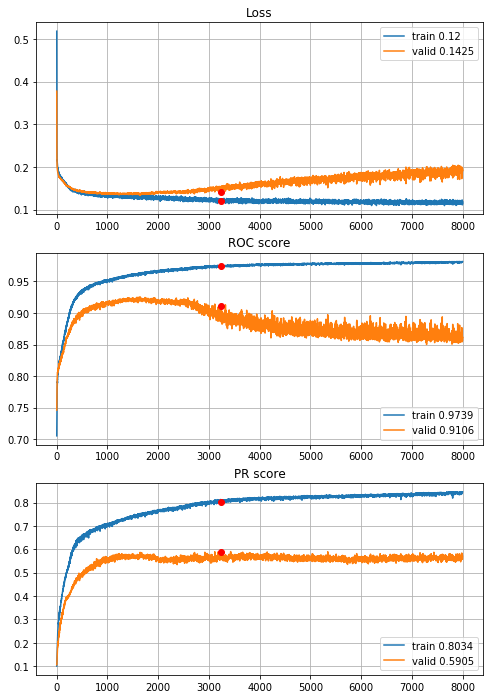


Fold 2------------------------------------------------------------


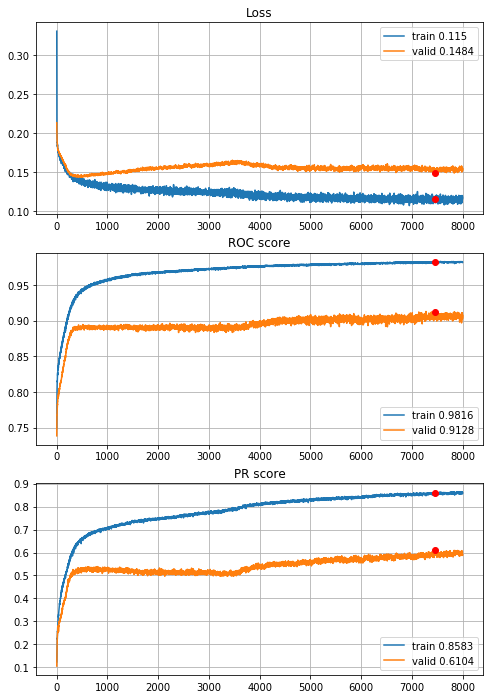


Fold 3------------------------------------------------------------


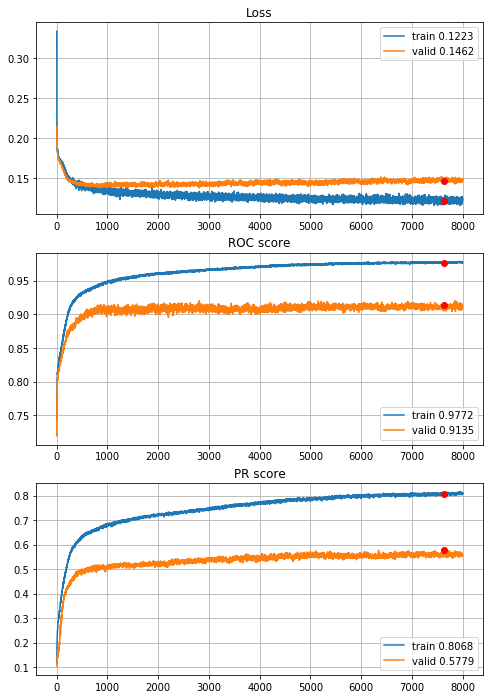


Fold 4------------------------------------------------------------


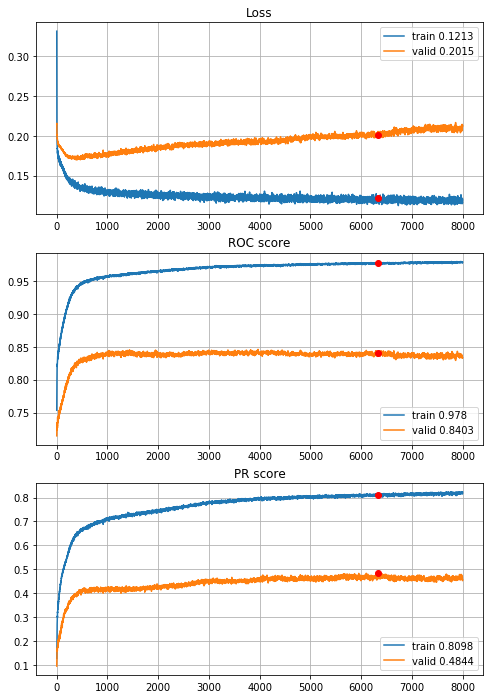


Fold 5------------------------------------------------------------


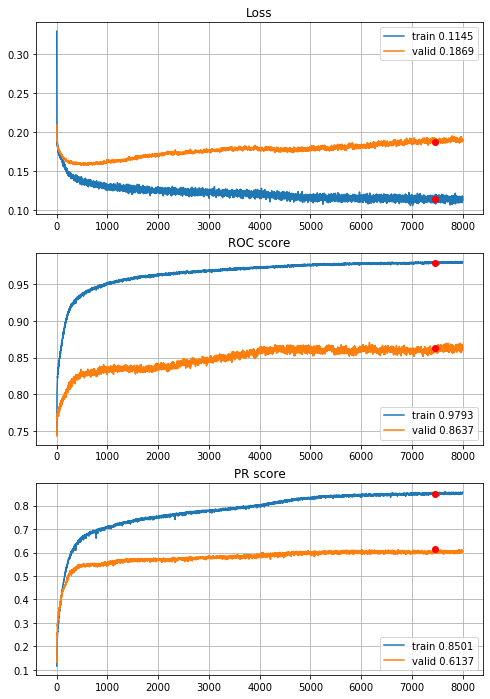


Fold 6------------------------------------------------------------


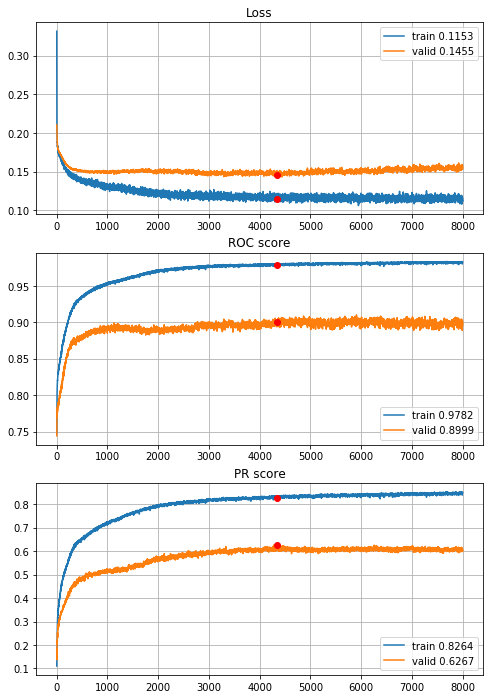

In [69]:
# best model for 1 and 2 year horizons, 8000 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=8000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\3year\MLP_L1_8000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Regularization gets the model worse, lets try the best model so far but with more epochs, 5000, maybe results will raise a bit (there are no big expectations).


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/5000,
cumulative time: 1.15s train loss: 0.47893857591917455, validation loss: 0.3383573517203331
Epoch: 2/5000,
cumulative time: 1.28s train loss: 0.32188810097832193, validation loss: 0.24389586970210075
Epoch: 3/5000,
cumulative time: 1.41s train loss: 0.2518727415032711, validation loss: 0.20386063307523727
Epoch: 4/5000,
cumulative time: 1.53s train loss: 0.21590000381546617, validation loss: 0.18657538667321205
Epoch: 5/5000,
cumulative time: 1.67s train loss: 0.20136920788025964, validation loss: 0.17759202420711517
Epoch: 6/5000,
cumulative time: 1.8s train loss: 0.19012795656223233, validation loss: 0.17269396409392357
Epoch: 7/5000,
cumulative time: 1.93s train loss: 0.18681486804225592, validation loss: 0.1698940359055996
Epoch: 8/5000,
cumulative time: 2.05s train loss: 0.1796689814286767, validation loss: 0.1673080176115036
Epoch: 9/5000,
cumulative time: 2.19s train loss: 0.18227743152

Epoch: 77/5000,
cumulative time: 11.74s train loss: 0.1505642614732726, validation loss: 0.1482007522135973
Epoch: 78/5000,
cumulative time: 11.87s train loss: 0.15195413170701177, validation loss: 0.14849215187132359
Epoch: 79/5000,
cumulative time: 12.02s train loss: 0.1497798675795144, validation loss: 0.14851408638060093
Epoch: 80/5000,
cumulative time: 12.16s train loss: 0.14809065003945115, validation loss: 0.14829142577946186
Epoch: 81/5000,
cumulative time: 12.31s train loss: 0.14994704559513491, validation loss: 0.14882096648216248
Epoch: 82/5000,
cumulative time: 12.44s train loss: 0.14928519189236672, validation loss: 0.14798750914633274
Epoch: 83/5000,
cumulative time: 12.6s train loss: 0.14753672096134746, validation loss: 0.1478697992861271
Epoch: 84/5000,
cumulative time: 12.73s train loss: 0.14770958270289197, validation loss: 0.1475771889090538
Epoch: 85/5000,
cumulative time: 12.88s train loss: 0.14456240734044765, validation loss: 0.1479373723268509
Epoch: 86/5000,
c

Epoch: 153/5000,
cumulative time: 22.45s train loss: 0.13382279076753018, validation loss: 0.13898936286568642
Epoch: 154/5000,
cumulative time: 22.58s train loss: 0.13203574128831141, validation loss: 0.13965829834342003
Epoch: 155/5000,
cumulative time: 22.73s train loss: 0.13039658057615502, validation loss: 0.14028016105294228
Epoch: 156/5000,
cumulative time: 22.86s train loss: 0.13511253777965185, validation loss: 0.13854526728391647
Epoch: 157/5000,
cumulative time: 23.02s train loss: 0.13062416708381602, validation loss: 0.1391490139067173
Epoch: 158/5000,
cumulative time: 23.15s train loss: 0.13160107933919463, validation loss: 0.13844328373670578
Epoch: 159/5000,
cumulative time: 23.31s train loss: 0.13330154675837094, validation loss: 0.13973512686789036
Epoch: 160/5000,
cumulative time: 23.44s train loss: 0.13323059216815242, validation loss: 0.13884605281054974
Epoch: 161/5000,
cumulative time: 23.6s train loss: 0.12962291090772382, validation loss: 0.13823052309453487
Epo

Epoch: 229/5000,
cumulative time: 33.22s train loss: 0.12028294495591178, validation loss: 0.13252724707126617
Epoch: 230/5000,
cumulative time: 33.35s train loss: 0.11966174936471644, validation loss: 0.13223027810454369
Epoch: 231/5000,
cumulative time: 33.49s train loss: 0.12130477615817056, validation loss: 0.13233148492872715
Epoch: 232/5000,
cumulative time: 33.62s train loss: 0.12231136696699793, validation loss: 0.1318311169743538
Epoch: 233/5000,
cumulative time: 33.77s train loss: 0.12289667383608266, validation loss: 0.13256154768168926
Epoch: 234/5000,
cumulative time: 33.9s train loss: 0.12313158121461369, validation loss: 0.1318049095571041
Epoch: 235/5000,
cumulative time: 34.06s train loss: 0.12133593443514369, validation loss: 0.13225935213267803
Epoch: 236/5000,
cumulative time: 34.19s train loss: 0.11966813119187944, validation loss: 0.131931621581316
Epoch: 237/5000,
cumulative time: 34.34s train loss: 0.12217122881113726, validation loss: 0.13179726339876652
Epoch:

Epoch: 305/5000,
cumulative time: 44.03s train loss: 0.11493285972986383, validation loss: 0.12661251984536648
Epoch: 306/5000,
cumulative time: 44.16s train loss: 0.10974500749644257, validation loss: 0.12677970714867115
Epoch: 307/5000,
cumulative time: 44.32s train loss: 0.10871710726464381, validation loss: 0.1259839367121458
Epoch: 308/5000,
cumulative time: 44.46s train loss: 0.11091944507577202, validation loss: 0.12685632333159447
Epoch: 309/5000,
cumulative time: 44.62s train loss: 0.10992740689875694, validation loss: 0.12589486874639988
Epoch: 310/5000,
cumulative time: 44.74s train loss: 0.10959178050946862, validation loss: 0.1260697152465582
Epoch: 311/5000,
cumulative time: 44.89s train loss: 0.11152192977114703, validation loss: 0.12477203644812107
Epoch: 312/5000,
cumulative time: 45.01s train loss: 0.11364182444084048, validation loss: 0.1249573566019535
Epoch: 313/5000,
cumulative time: 45.16s train loss: 0.11103736682628967, validation loss: 0.12448451295495033
Epoc

Epoch: 381/5000,
cumulative time: 54.69s train loss: 0.10641469959114759, validation loss: 0.12318760342895985
Epoch: 382/5000,
cumulative time: 54.82s train loss: 0.10718577302833418, validation loss: 0.1227573174983263
Epoch: 383/5000,
cumulative time: 54.97s train loss: 0.1043117611601366, validation loss: 0.12288841232657433
Epoch: 384/5000,
cumulative time: 55.1s train loss: 0.1002646103102114, validation loss: 0.12163322046399117
Epoch: 385/5000,
cumulative time: 55.25s train loss: 0.10460967634681095, validation loss: 0.12205723114311695
Epoch: 386/5000,
cumulative time: 55.4s train loss: 0.10326147695020439, validation loss: 0.1216138880699873
Epoch: 387/5000,
cumulative time: 55.57s train loss: 0.10569007311597156, validation loss: 0.12070620059967041
Epoch: 388/5000,
cumulative time: 55.7s train loss: 0.1054612352248374, validation loss: 0.12162343971431255
Epoch: 389/5000,
cumulative time: 55.86s train loss: 0.10216005491504304, validation loss: 0.12200613506138325
Epoch: 39

Epoch: 457/5000,
cumulative time: 65.58s train loss: 0.09807234967421644, validation loss: 0.12070366181433201
Epoch: 458/5000,
cumulative time: 65.71s train loss: 0.09997999338540042, validation loss: 0.12048040330410004
Epoch: 459/5000,
cumulative time: 65.86s train loss: 0.09739794760730558, validation loss: 0.12106921151280403
Epoch: 460/5000,
cumulative time: 66.0s train loss: 0.10197488287697443, validation loss: 0.12104486487805843
Epoch: 461/5000,
cumulative time: 66.15s train loss: 0.0957686770962785, validation loss: 0.12056786939501762
Epoch: 462/5000,
cumulative time: 66.28s train loss: 0.10141967078070159, validation loss: 0.12076584063470364
Epoch: 463/5000,
cumulative time: 66.44s train loss: 0.09952528352072058, validation loss: 0.1203885916620493
Epoch: 464/5000,
cumulative time: 66.57s train loss: 0.0977206295323045, validation loss: 0.12096445262432098
Epoch: 465/5000,
cumulative time: 66.72s train loss: 0.09907499119003695, validation loss: 0.12071230262517929
Epoch

Epoch: 531/5000,
cumulative time: 76.05s train loss: 0.09595726232894367, validation loss: 0.11905652470886707
Epoch: 532/5000,
cumulative time: 76.17s train loss: 0.09516533964241199, validation loss: 0.1195509023964405
Epoch: 533/5000,
cumulative time: 76.33s train loss: 0.09452098371520631, validation loss: 0.11758403852581978
Epoch: 534/5000,
cumulative time: 76.46s train loss: 0.09276599512960991, validation loss: 0.11766381375491619
Epoch: 535/5000,
cumulative time: 76.61s train loss: 0.09708072881390747, validation loss: 0.11724554933607578
Epoch: 536/5000,
cumulative time: 76.74s train loss: 0.10103192299400084, validation loss: 0.11666451394557953
Epoch: 537/5000,
cumulative time: 76.89s train loss: 0.09399264894232888, validation loss: 0.11708397977054119
Epoch: 538/5000,
cumulative time: 77.02s train loss: 0.09808559368760408, validation loss: 0.11728113330900669
Epoch: 539/5000,
cumulative time: 77.16s train loss: 0.09739114914359993, validation loss: 0.11765171773731709
Ep

Epoch: 607/5000,
cumulative time: 86.76s train loss: 0.09722544725108352, validation loss: 0.11706290580332279
Epoch: 608/5000,
cumulative time: 86.9s train loss: 0.09228703389847684, validation loss: 0.11635748483240604
Epoch: 609/5000,
cumulative time: 87.05s train loss: 0.09019034796518804, validation loss: 0.11626089736819267
Epoch: 610/5000,
cumulative time: 87.18s train loss: 0.09159374160908726, validation loss: 0.11589122004806995
Epoch: 611/5000,
cumulative time: 87.34s train loss: 0.08872183156897417, validation loss: 0.11724497377872467
Epoch: 612/5000,
cumulative time: 87.47s train loss: 0.09533304564083452, validation loss: 0.1175246573984623
Epoch: 613/5000,
cumulative time: 87.62s train loss: 0.09166763404572506, validation loss: 0.1177065372467041
Epoch: 614/5000,
cumulative time: 87.76s train loss: 0.09005513411997206, validation loss: 0.11760584078729153
Epoch: 615/5000,
cumulative time: 87.91s train loss: 0.0917709419440427, validation loss: 0.11599832028150558
Epoch

Epoch: 683/5000,
cumulative time: 97.59s train loss: 0.0871688767401109, validation loss: 0.1162816770374775
Epoch: 684/5000,
cumulative time: 97.72s train loss: 0.09278105835890546, validation loss: 0.11508147232234478
Epoch: 685/5000,
cumulative time: 97.87s train loss: 0.09005239288052548, validation loss: 0.11392831802368164
Epoch: 686/5000,
cumulative time: 98.0s train loss: 0.09133467166658553, validation loss: 0.11704431474208832
Epoch: 687/5000,
cumulative time: 98.15s train loss: 0.08992025642875731, validation loss: 0.114805206656456
Epoch: 688/5000,
cumulative time: 98.29s train loss: 0.09019779061464382, validation loss: 0.11579755693674088
Epoch: 689/5000,
cumulative time: 98.44s train loss: 0.09106168697586726, validation loss: 0.11315745115280151
Epoch: 690/5000,
cumulative time: 98.57s train loss: 0.09141189048474455, validation loss: 0.11588524840772152
Epoch: 691/5000,
cumulative time: 98.72s train loss: 0.08588669233122503, validation loss: 0.11381208337843418
Epoch:

Epoch: 757/5000,
cumulative time: 108.06s train loss: 0.08489042972893264, validation loss: 0.11166895739734173
Epoch: 758/5000,
cumulative time: 108.19s train loss: 0.08787872104013009, validation loss: 0.11343010701239109
Epoch: 759/5000,
cumulative time: 108.35s train loss: 0.08616994294858693, validation loss: 0.11430792696774006
Epoch: 760/5000,
cumulative time: 108.47s train loss: 0.08364067114170673, validation loss: 0.11491643078625202
Epoch: 761/5000,
cumulative time: 108.63s train loss: 0.08495331346542173, validation loss: 0.11379884742200375
Epoch: 762/5000,
cumulative time: 108.76s train loss: 0.08617243303365366, validation loss: 0.11435400508344173
Epoch: 763/5000,
cumulative time: 108.92s train loss: 0.08560007197594147, validation loss: 0.11326289921998978
Epoch: 764/5000,
cumulative time: 109.04s train loss: 0.08432885678934379, validation loss: 0.11201499029994011
Epoch: 765/5000,
cumulative time: 109.2s train loss: 0.0875493812153883, validation loss: 0.112839436158

Epoch: 831/5000,
cumulative time: 118.54s train loss: 0.08609355621913958, validation loss: 0.11273780837655067
Epoch: 832/5000,
cumulative time: 118.68s train loss: 0.08425556667387456, validation loss: 0.11269030161201954
Epoch: 833/5000,
cumulative time: 118.82s train loss: 0.0861473872353275, validation loss: 0.1094300989061594
Epoch: 834/5000,
cumulative time: 118.96s train loss: 0.08535831733410464, validation loss: 0.11135992966592312
Epoch: 835/5000,
cumulative time: 119.11s train loss: 0.0817922301374758, validation loss: 0.11311707831919193
Epoch: 836/5000,
cumulative time: 119.25s train loss: 0.08579131367263029, validation loss: 0.11159034259617329
Epoch: 837/5000,
cumulative time: 119.4s train loss: 0.08127150212359223, validation loss: 0.11204833537340164
Epoch: 838/5000,
cumulative time: 119.53s train loss: 0.08598191280309593, validation loss: 0.11183413118124008
Epoch: 839/5000,
cumulative time: 119.7s train loss: 0.08742831275529248, validation loss: 0.113495588302612

Epoch: 905/5000,
cumulative time: 129.2s train loss: 0.08251960054721065, validation loss: 0.11397608369588852
Epoch: 906/5000,
cumulative time: 129.33s train loss: 0.08765895107695752, validation loss: 0.11358214914798737
Epoch: 907/5000,
cumulative time: 129.49s train loss: 0.08536748982277269, validation loss: 0.11544771119952202
Epoch: 908/5000,
cumulative time: 129.63s train loss: 0.0807586758434886, validation loss: 0.11575325950980186
Epoch: 909/5000,
cumulative time: 129.78s train loss: 0.08222653861538355, validation loss: 0.11415223963558674
Epoch: 910/5000,
cumulative time: 129.9s train loss: 0.08256084254553561, validation loss: 0.1117378082126379
Epoch: 911/5000,
cumulative time: 130.05s train loss: 0.07990913988748985, validation loss: 0.11456060595810413
Epoch: 912/5000,
cumulative time: 130.19s train loss: 0.08291163329562903, validation loss: 0.11409839615225792
Epoch: 913/5000,
cumulative time: 130.33s train loss: 0.08292153811033999, validation loss: 0.11332040838897

Epoch: 979/5000,
cumulative time: 139.6s train loss: 0.07871219229923704, validation loss: 0.11266843043267727
Epoch: 980/5000,
cumulative time: 139.72s train loss: 0.08157014691943956, validation loss: 0.11216561123728752
Epoch: 981/5000,
cumulative time: 139.88s train loss: 0.07831570029224673, validation loss: 0.11302238330245018
Epoch: 982/5000,
cumulative time: 140.01s train loss: 0.08043590593097354, validation loss: 0.11303640343248844
Epoch: 983/5000,
cumulative time: 140.16s train loss: 0.0783701936599414, validation loss: 0.1106373779475689
Epoch: 984/5000,
cumulative time: 140.29s train loss: 0.08225740270037346, validation loss: 0.10973965004086494
Epoch: 985/5000,
cumulative time: 140.45s train loss: 0.0865894769431447, validation loss: 0.10869899578392506
Epoch: 986/5000,
cumulative time: 140.58s train loss: 0.08144428720626812, validation loss: 0.1104100551456213
Epoch: 987/5000,
cumulative time: 140.73s train loss: 0.0777147327199268, validation loss: 0.1115148849785327

Epoch: 1053/5000,
cumulative time: 150.06s train loss: 0.08029637344223162, validation loss: 0.11287054419517517
Epoch: 1054/5000,
cumulative time: 150.19s train loss: 0.08203264507770144, validation loss: 0.1131556686013937
Epoch: 1055/5000,
cumulative time: 150.35s train loss: 0.08006133436362049, validation loss: 0.1135361846536398
Epoch: 1056/5000,
cumulative time: 150.48s train loss: 0.07494342301576315, validation loss: 0.1145651526749134
Epoch: 1057/5000,
cumulative time: 150.62s train loss: 0.08074594356607762, validation loss: 0.1129080206155777
Epoch: 1058/5000,
cumulative time: 150.75s train loss: 0.07762274399698689, validation loss: 0.1119992546737194
Epoch: 1059/5000,
cumulative time: 150.9s train loss: 0.07995532056503092, validation loss: 0.11223173514008522
Epoch: 1060/5000,
cumulative time: 151.03s train loss: 0.07558154402543833, validation loss: 0.11470328643918037
Epoch: 1061/5000,
cumulative time: 151.19s train loss: 0.07919245236730624, validation loss: 0.1151742

Epoch: 1127/5000,
cumulative time: 160.58s train loss: 0.0802623923024122, validation loss: 0.11226895824074745
Epoch: 1128/5000,
cumulative time: 160.72s train loss: 0.07619597404956847, validation loss: 0.11178428679704666
Epoch: 1129/5000,
cumulative time: 160.86s train loss: 0.07539075803637899, validation loss: 0.11372829042375088
Epoch: 1130/5000,
cumulative time: 160.98s train loss: 0.07509566584971879, validation loss: 0.11169542372226715
Epoch: 1131/5000,
cumulative time: 161.14s train loss: 0.07564930710232064, validation loss: 0.11227241158485413
Epoch: 1132/5000,
cumulative time: 161.27s train loss: 0.07544303015290692, validation loss: 0.11284143477678299
Epoch: 1133/5000,
cumulative time: 161.41s train loss: 0.07660698029839369, validation loss: 0.11403999477624893
Epoch: 1134/5000,
cumulative time: 161.54s train loss: 0.07965840997884817, validation loss: 0.11313637718558311
Epoch: 1135/5000,
cumulative time: 161.69s train loss: 0.07617548651664072, validation loss: 0.11

Epoch: 1201/5000,
cumulative time: 171.02s train loss: 0.07359000462745427, validation loss: 0.11164617910981178
Epoch: 1202/5000,
cumulative time: 171.14s train loss: 0.07225893470120497, validation loss: 0.11338736116886139
Epoch: 1203/5000,
cumulative time: 171.3s train loss: 0.08025378530202722, validation loss: 0.11296593584120274
Epoch: 1204/5000,
cumulative time: 171.44s train loss: 0.07419010461485434, validation loss: 0.11565924435853958
Epoch: 1205/5000,
cumulative time: 171.59s train loss: 0.07617635644145533, validation loss: 0.11224615015089512
Epoch: 1206/5000,
cumulative time: 171.72s train loss: 0.07460018661139943, validation loss: 0.11036614142358303
Epoch: 1207/5000,
cumulative time: 171.88s train loss: 0.07079509223317997, validation loss: 0.11125015839934349
Epoch: 1208/5000,
cumulative time: 172.02s train loss: 0.08095031620725543, validation loss: 0.10883982107043266
Epoch: 1209/5000,
cumulative time: 172.16s train loss: 0.07306504660887184, validation loss: 0.11

Epoch: 1275/5000,
cumulative time: 181.52s train loss: 0.07979990349001255, validation loss: 0.11040761694312096
Epoch: 1276/5000,
cumulative time: 181.64s train loss: 0.077099569256329, validation loss: 0.11064481362700462
Epoch: 1277/5000,
cumulative time: 181.81s train loss: 0.06725885829741184, validation loss: 0.1109512522816658
Epoch: 1278/5000,
cumulative time: 181.94s train loss: 0.07513321636347767, validation loss: 0.11123093403875828
Epoch: 1279/5000,
cumulative time: 182.09s train loss: 0.07180013301947384, validation loss: 0.11199254170060158
Epoch: 1280/5000,
cumulative time: 182.21s train loss: 0.07631521065633814, validation loss: 0.11149084568023682
Epoch: 1281/5000,
cumulative time: 182.37s train loss: 0.07466857372548993, validation loss: 0.10973684675991535
Epoch: 1282/5000,
cumulative time: 182.5s train loss: 0.07479503273835274, validation loss: 0.1077267974615097
Epoch: 1283/5000,
cumulative time: 182.65s train loss: 0.06892500838492806, validation loss: 0.112132

Epoch: 1349/5000,
cumulative time: 192.0s train loss: 0.07167976847464297, validation loss: 0.11002540215849876
Epoch: 1350/5000,
cumulative time: 192.14s train loss: 0.06890521696383212, validation loss: 0.10872726514935493
Epoch: 1351/5000,
cumulative time: 192.28s train loss: 0.07695534549002692, validation loss: 0.1068939808756113
Epoch: 1352/5000,
cumulative time: 192.4s train loss: 0.07383294172259591, validation loss: 0.10942582413554192
Epoch: 1353/5000,
cumulative time: 192.56s train loss: 0.0690705719304121, validation loss: 0.10792935639619827
Epoch: 1354/5000,
cumulative time: 192.69s train loss: 0.07720319808868965, validation loss: 0.10895359888672829
Epoch: 1355/5000,
cumulative time: 192.84s train loss: 0.06991106201078669, validation loss: 0.1081333514302969
Epoch: 1356/5000,
cumulative time: 192.98s train loss: 0.07200794506944819, validation loss: 0.10957407206296921
Epoch: 1357/5000,
cumulative time: 193.14s train loss: 0.07380928970029536, validation loss: 0.109579

Epoch: 1423/5000,
cumulative time: 202.46s train loss: 0.06912730098690188, validation loss: 0.10797581821680069
Epoch: 1424/5000,
cumulative time: 202.59s train loss: 0.07455983936101758, validation loss: 0.10759861208498478
Epoch: 1425/5000,
cumulative time: 202.74s train loss: 0.06912863558019218, validation loss: 0.10773901641368866
Epoch: 1426/5000,
cumulative time: 202.87s train loss: 0.07005442731714358, validation loss: 0.11191289126873016
Epoch: 1427/5000,
cumulative time: 203.01s train loss: 0.07318404606941269, validation loss: 0.10980255715548992
Epoch: 1428/5000,
cumulative time: 203.14s train loss: 0.07786618888949519, validation loss: 0.11263886652886868
Epoch: 1429/5000,
cumulative time: 203.3s train loss: 0.07488492271428243, validation loss: 0.11235560663044453
Epoch: 1430/5000,
cumulative time: 203.43s train loss: 0.07393361788494687, validation loss: 0.11242490448057652
Epoch: 1431/5000,
cumulative time: 203.59s train loss: 0.07019827200441327, validation loss: 0.11

Epoch: 1497/5000,
cumulative time: 212.93s train loss: 0.0725156352805601, validation loss: 0.1103332880884409
Epoch: 1498/5000,
cumulative time: 213.07s train loss: 0.06765891619049365, validation loss: 0.11021635867655277
Epoch: 1499/5000,
cumulative time: 213.21s train loss: 0.07521898678322775, validation loss: 0.10977151431143284
Epoch: 1500/5000,
cumulative time: 213.33s train loss: 0.0698898453558684, validation loss: 0.1101390365511179
Epoch: 1501/5000,
cumulative time: 213.49s train loss: 0.06840777080156071, validation loss: 0.11146514862775803
Epoch: 1502/5000,
cumulative time: 213.61s train loss: 0.07072037176705363, validation loss: 0.11259399354457855
Epoch: 1503/5000,
cumulative time: 213.78s train loss: 0.07475431288610018, validation loss: 0.11174877174198627
Epoch: 1504/5000,
cumulative time: 213.91s train loss: 0.07228119029493699, validation loss: 0.11205184832215309
Epoch: 1505/5000,
cumulative time: 214.06s train loss: 0.06664828972303516, validation loss: 0.10998

Epoch: 1571/5000,
cumulative time: 223.51s train loss: 0.06785956464155396, validation loss: 0.11339985579252243
Epoch: 1572/5000,
cumulative time: 223.63s train loss: 0.06817782208051035, validation loss: 0.11041865311563015
Epoch: 1573/5000,
cumulative time: 223.79s train loss: 0.07255374429555428, validation loss: 0.11018192768096924
Epoch: 1574/5000,
cumulative time: 223.92s train loss: 0.07382873788385176, validation loss: 0.1104620136320591
Epoch: 1575/5000,
cumulative time: 224.06s train loss: 0.06836510638277382, validation loss: 0.1109461672604084
Epoch: 1576/5000,
cumulative time: 224.2s train loss: 0.0674049621556709, validation loss: 0.11236139945685863
Epoch: 1577/5000,
cumulative time: 224.35s train loss: 0.06829049996464097, validation loss: 0.11219679564237595
Epoch: 1578/5000,
cumulative time: 224.49s train loss: 0.07511947850127733, validation loss: 0.11103891395032406
Epoch: 1579/5000,
cumulative time: 224.63s train loss: 0.06689026478986379, validation loss: 0.11137

Epoch: 1645/5000,
cumulative time: 233.94s train loss: 0.07112379352916401, validation loss: 0.10894686356186867
Epoch: 1646/5000,
cumulative time: 234.08s train loss: 0.06792225394872858, validation loss: 0.1082516759634018
Epoch: 1647/5000,
cumulative time: 234.23s train loss: 0.06454282851559581, validation loss: 0.1088921818882227
Epoch: 1648/5000,
cumulative time: 234.36s train loss: 0.062219103619006004, validation loss: 0.11101770028471947
Epoch: 1649/5000,
cumulative time: 234.51s train loss: 0.06514983118590727, validation loss: 0.11207197420299053
Epoch: 1650/5000,
cumulative time: 234.64s train loss: 0.0653052629960664, validation loss: 0.11263304576277733
Epoch: 1651/5000,
cumulative time: 234.8s train loss: 0.06335645357270783, validation loss: 0.11295543983578682
Epoch: 1652/5000,
cumulative time: 234.94s train loss: 0.06823328228306957, validation loss: 0.11160280928015709
Epoch: 1653/5000,
cumulative time: 235.09s train loss: 0.06740498774552055, validation loss: 0.1111

Epoch: 1719/5000,
cumulative time: 244.52s train loss: 0.0674787806767976, validation loss: 0.1106595117598772
Epoch: 1720/5000,
cumulative time: 244.65s train loss: 0.06614128012000121, validation loss: 0.11275366134941578
Epoch: 1721/5000,
cumulative time: 244.8s train loss: 0.07004439894539442, validation loss: 0.11121895723044872
Epoch: 1722/5000,
cumulative time: 244.93s train loss: 0.07171695092347687, validation loss: 0.11050776019692421
Epoch: 1723/5000,
cumulative time: 245.07s train loss: 0.06683551551705087, validation loss: 0.1077401302754879
Epoch: 1724/5000,
cumulative time: 245.2s train loss: 0.06943309414042033, validation loss: 0.11073629185557365
Epoch: 1725/5000,
cumulative time: 245.36s train loss: 0.07187605280771571, validation loss: 0.10936260782182217
Epoch: 1726/5000,
cumulative time: 245.5s train loss: 0.06401348335279644, validation loss: 0.11004807241261005
Epoch: 1727/5000,
cumulative time: 245.65s train loss: 0.06492389430357697, validation loss: 0.1097372

Epoch: 1793/5000,
cumulative time: 254.95s train loss: 0.06259378337066236, validation loss: 0.11137926205992699
Epoch: 1794/5000,
cumulative time: 255.09s train loss: 0.06478386461013931, validation loss: 0.11293215863406658
Epoch: 1795/5000,
cumulative time: 255.22s train loss: 0.06600968296785777, validation loss: 0.11304098553955555
Epoch: 1796/5000,
cumulative time: 255.37s train loss: 0.06709555132856612, validation loss: 0.1112735215574503
Epoch: 1797/5000,
cumulative time: 255.51s train loss: 0.0673774576638558, validation loss: 0.11015447601675987
Epoch: 1798/5000,
cumulative time: 255.64s train loss: 0.06777880851362883, validation loss: 0.11139876395463943
Epoch: 1799/5000,
cumulative time: 255.79s train loss: 0.06498716274108936, validation loss: 0.11030940525233746
Epoch: 1800/5000,
cumulative time: 255.92s train loss: 0.06486303125327919, validation loss: 0.11394368670880795
Epoch: 1801/5000,
cumulative time: 256.06s train loss: 0.06717525485481116, validation loss: 0.109

Epoch: 1867/5000,
cumulative time: 265.38s train loss: 0.06501634012947474, validation loss: 0.11287390440702438
Epoch: 1868/5000,
cumulative time: 265.51s train loss: 0.06459917992905895, validation loss: 0.11298970319330692
Epoch: 1869/5000,
cumulative time: 265.66s train loss: 0.0676521739202096, validation loss: 0.11090034618973732
Epoch: 1870/5000,
cumulative time: 265.79s train loss: 0.06569676862111047, validation loss: 0.11117981560528278
Epoch: 1871/5000,
cumulative time: 265.95s train loss: 0.06480120696409318, validation loss: 0.11208373680710793
Epoch: 1872/5000,
cumulative time: 266.08s train loss: 0.06733259566907746, validation loss: 0.11049118638038635
Epoch: 1873/5000,
cumulative time: 266.23s train loss: 0.07147455069110169, validation loss: 0.11096667312085629
Epoch: 1874/5000,
cumulative time: 266.36s train loss: 0.06677961369352997, validation loss: 0.11114702560007572
Epoch: 1875/5000,
cumulative time: 266.52s train loss: 0.06695262914634163, validation loss: 0.11

Epoch: 1941/5000,
cumulative time: 275.84s train loss: 0.06784901343600104, validation loss: 0.1101178415119648
Epoch: 1942/5000,
cumulative time: 275.98s train loss: 0.06320115802417012, validation loss: 0.11002722755074501
Epoch: 1943/5000,
cumulative time: 276.13s train loss: 0.07098584641726596, validation loss: 0.1115468293428421
Epoch: 1944/5000,
cumulative time: 276.26s train loss: 0.06261121038084498, validation loss: 0.11281810328364372
Epoch: 1945/5000,
cumulative time: 276.4s train loss: 0.06146372211534187, validation loss: 0.11189847253262997
Epoch: 1946/5000,
cumulative time: 276.53s train loss: 0.06387923707511066, validation loss: 0.11324356868863106
Epoch: 1947/5000,
cumulative time: 276.68s train loss: 0.0685012003689732, validation loss: 0.11385283060371876
Epoch: 1948/5000,
cumulative time: 276.81s train loss: 0.061848546942594756, validation loss: 0.11328270472586155
Epoch: 1949/5000,
cumulative time: 276.97s train loss: 0.06317504883803893, validation loss: 0.1125

Epoch: 2015/5000,
cumulative time: 286.29s train loss: 0.06486628665846578, validation loss: 0.10861349292099476
Epoch: 2016/5000,
cumulative time: 286.42s train loss: 0.06432815385559539, validation loss: 0.10759489797055721
Epoch: 2017/5000,
cumulative time: 286.57s train loss: 0.06169821259340034, validation loss: 0.11043687723577023
Epoch: 2018/5000,
cumulative time: 286.7s train loss: 0.06008384317072622, validation loss: 0.10963087156414986
Epoch: 2019/5000,
cumulative time: 286.86s train loss: 0.06689825197591916, validation loss: 0.10930529609322548
Epoch: 2020/5000,
cumulative time: 286.99s train loss: 0.06229136813641987, validation loss: 0.1100494135171175
Epoch: 2021/5000,
cumulative time: 287.14s train loss: 0.06502766536341563, validation loss: 0.1087642703205347
Epoch: 2022/5000,
cumulative time: 287.27s train loss: 0.06273511754241978, validation loss: 0.1118891965597868
Epoch: 2023/5000,
cumulative time: 287.42s train loss: 0.06581128528554497, validation loss: 0.11431

Epoch: 2089/5000,
cumulative time: 296.79s train loss: 0.06331672566697387, validation loss: 0.11084421537816525
Epoch: 2090/5000,
cumulative time: 296.93s train loss: 0.059874907940050986, validation loss: 0.10956345126032829
Epoch: 2091/5000,
cumulative time: 297.07s train loss: 0.06925570494753114, validation loss: 0.11026734858751297
Epoch: 2092/5000,
cumulative time: 297.2s train loss: 0.060738114356321087, validation loss: 0.11217138729989529
Epoch: 2093/5000,
cumulative time: 297.35s train loss: 0.059853595371678316, validation loss: 0.11125066876411438
Epoch: 2094/5000,
cumulative time: 297.47s train loss: 0.05999143962658953, validation loss: 0.11138752289116383
Epoch: 2095/5000,
cumulative time: 297.62s train loss: 0.0625911610794134, validation loss: 0.11259240657091141
Epoch: 2096/5000,
cumulative time: 297.76s train loss: 0.06320938547536799, validation loss: 0.11334055848419666
Epoch: 2097/5000,
cumulative time: 297.91s train loss: 0.05960788407848761, validation loss: 0.

Epoch: 2163/5000,
cumulative time: 307.29s train loss: 0.061750302164081755, validation loss: 0.10914381965994835
Epoch: 2164/5000,
cumulative time: 307.41s train loss: 0.06707596552779131, validation loss: 0.11224641837179661
Epoch: 2165/5000,
cumulative time: 307.57s train loss: 0.06375589528025982, validation loss: 0.11238258145749569
Epoch: 2166/5000,
cumulative time: 307.71s train loss: 0.06453307255404425, validation loss: 0.11152319982647896
Epoch: 2167/5000,
cumulative time: 307.86s train loss: 0.05733739255765267, validation loss: 0.10952270962297916
Epoch: 2168/5000,
cumulative time: 307.98s train loss: 0.06696529203241643, validation loss: 0.10912452079355717
Epoch: 2169/5000,
cumulative time: 308.13s train loss: 0.06420554649869974, validation loss: 0.10812574625015259
Epoch: 2170/5000,
cumulative time: 308.26s train loss: 0.058703497303351795, validation loss: 0.1086734589189291
Epoch: 2171/5000,
cumulative time: 308.42s train loss: 0.06481272493498073, validation loss: 0.

Epoch: 2237/5000,
cumulative time: 317.74s train loss: 0.060152059889679, validation loss: 0.11143281124532223
Epoch: 2238/5000,
cumulative time: 317.87s train loss: 0.06362838160063089, validation loss: 0.11177530139684677
Epoch: 2239/5000,
cumulative time: 318.02s train loss: 0.06292244036899054, validation loss: 0.10989897698163986
Epoch: 2240/5000,
cumulative time: 318.15s train loss: 0.06636001077258781, validation loss: 0.11293238960206509
Epoch: 2241/5000,
cumulative time: 318.3s train loss: 0.06254215816905227, validation loss: 0.11433985829353333
Epoch: 2242/5000,
cumulative time: 318.44s train loss: 0.05888986535542519, validation loss: 0.11195542849600315
Epoch: 2243/5000,
cumulative time: 318.59s train loss: 0.06056165391434535, validation loss: 0.1115308329463005
Epoch: 2244/5000,
cumulative time: 318.72s train loss: 0.06525124195128786, validation loss: 0.10968073830008507
Epoch: 2245/5000,
cumulative time: 318.88s train loss: 0.06198913564384286, validation loss: 0.10961

Epoch: 2311/5000,
cumulative time: 328.11s train loss: 0.06223852535896098, validation loss: 0.1098815780133009
Epoch: 2312/5000,
cumulative time: 328.24s train loss: 0.06408963956358833, validation loss: 0.11037707701325417
Epoch: 2313/5000,
cumulative time: 328.39s train loss: 0.06103812542934597, validation loss: 0.1102346982806921
Epoch: 2314/5000,
cumulative time: 328.52s train loss: 0.06036261244643425, validation loss: 0.11122985929250717
Epoch: 2315/5000,
cumulative time: 328.68s train loss: 0.062073710340478656, validation loss: 0.11045033298432827
Epoch: 2316/5000,
cumulative time: 328.81s train loss: 0.06125406401847722, validation loss: 0.1107677835971117
Epoch: 2317/5000,
cumulative time: 328.96s train loss: 0.060634419680542305, validation loss: 0.11096596717834473
Epoch: 2318/5000,
cumulative time: 329.09s train loss: 0.06595936061983759, validation loss: 0.10911461152136326
Epoch: 2319/5000,
cumulative time: 329.25s train loss: 0.06312446172196379, validation loss: 0.11

Epoch: 2385/5000,
cumulative time: 338.54s train loss: 0.06509927044957951, validation loss: 0.11086518131196499
Epoch: 2386/5000,
cumulative time: 338.68s train loss: 0.05977988805112922, validation loss: 0.1125654187053442
Epoch: 2387/5000,
cumulative time: 338.82s train loss: 0.06194354626674105, validation loss: 0.11163976974785328
Epoch: 2388/5000,
cumulative time: 338.96s train loss: 0.05940015690752157, validation loss: 0.11217038705945015
Epoch: 2389/5000,
cumulative time: 339.1s train loss: 0.06259778410919037, validation loss: 0.11351912468671799
Epoch: 2390/5000,
cumulative time: 339.23s train loss: 0.0642322517435765, validation loss: 0.11290775798261166
Epoch: 2391/5000,
cumulative time: 339.38s train loss: 0.05874750570669853, validation loss: 0.11254408396780491
Epoch: 2392/5000,
cumulative time: 339.51s train loss: 0.05828196683840863, validation loss: 0.11289873160421848
Epoch: 2393/5000,
cumulative time: 339.66s train loss: 0.057315845587354676, validation loss: 0.112

Epoch: 2459/5000,
cumulative time: 349.0s train loss: 0.06612373134258466, validation loss: 0.1100295465439558
Epoch: 2460/5000,
cumulative time: 349.13s train loss: 0.06368657679440347, validation loss: 0.10832265019416809
Epoch: 2461/5000,
cumulative time: 349.29s train loss: 0.05972825643006256, validation loss: 0.10721481218934059
Epoch: 2462/5000,
cumulative time: 349.42s train loss: 0.06712481953532881, validation loss: 0.11141110397875309
Epoch: 2463/5000,
cumulative time: 349.57s train loss: 0.06087900215164849, validation loss: 0.11210563778877258
Epoch: 2464/5000,
cumulative time: 349.7s train loss: 0.06380774602369647, validation loss: 0.11033889278769493
Epoch: 2465/5000,
cumulative time: 349.85s train loss: 0.06104013145654834, validation loss: 0.11245773732662201
Epoch: 2466/5000,
cumulative time: 349.98s train loss: 0.05890763966946538, validation loss: 0.11282176896929741
Epoch: 2467/5000,
cumulative time: 350.14s train loss: 0.05830955743097212, validation loss: 0.1123

Epoch: 2533/5000,
cumulative time: 359.55s train loss: 0.06166325963100862, validation loss: 0.10811351984739304
Epoch: 2534/5000,
cumulative time: 359.67s train loss: 0.059649200269024406, validation loss: 0.10720481723546982
Epoch: 2535/5000,
cumulative time: 359.82s train loss: 0.059591448202222175, validation loss: 0.11057032458484173
Epoch: 2536/5000,
cumulative time: 359.96s train loss: 0.059068937384825694, validation loss: 0.11005481146275997
Epoch: 2537/5000,
cumulative time: 360.1s train loss: 0.06560314636736155, validation loss: 0.1082288883626461
Epoch: 2538/5000,
cumulative time: 360.23s train loss: 0.05860076465446704, validation loss: 0.1107974648475647
Epoch: 2539/5000,
cumulative time: 360.39s train loss: 0.060165288660877725, validation loss: 0.109724385663867
Epoch: 2540/5000,
cumulative time: 360.52s train loss: 0.055683803020462344, validation loss: 0.1099594421684742
Epoch: 2541/5000,
cumulative time: 360.67s train loss: 0.059522434019040435, validation loss: 0.1

Epoch: 2607/5000,
cumulative time: 369.97s train loss: 0.061535271679260754, validation loss: 0.11122465506196022
Epoch: 2608/5000,
cumulative time: 370.1s train loss: 0.06056500178486972, validation loss: 0.10957431234419346
Epoch: 2609/5000,
cumulative time: 370.25s train loss: 0.06430470884421442, validation loss: 0.11214565113186836
Epoch: 2610/5000,
cumulative time: 370.38s train loss: 0.06125140730282145, validation loss: 0.11107577756047249
Epoch: 2611/5000,
cumulative time: 370.53s train loss: 0.05790075688036854, validation loss: 0.1095761340111494
Epoch: 2612/5000,
cumulative time: 370.66s train loss: 0.056488317730252424, validation loss: 0.1109338104724884
Epoch: 2613/5000,
cumulative time: 370.81s train loss: 0.05802488747516854, validation loss: 0.11289430223405361
Epoch: 2614/5000,
cumulative time: 370.93s train loss: 0.06024010298199433, validation loss: 0.11289327777922153
Epoch: 2615/5000,
cumulative time: 371.09s train loss: 0.060095193227795614, validation loss: 0.1

Epoch: 2681/5000,
cumulative time: 380.4s train loss: 0.05521663086022472, validation loss: 0.11315255798399448
Epoch: 2682/5000,
cumulative time: 380.53s train loss: 0.05646711391945019, validation loss: 0.11225220374763012
Epoch: 2683/5000,
cumulative time: 380.68s train loss: 0.06140713435216959, validation loss: 0.11607163399457932
Epoch: 2684/5000,
cumulative time: 380.82s train loss: 0.06150913991056735, validation loss: 0.1149526946246624
Epoch: 2685/5000,
cumulative time: 380.96s train loss: 0.05653137417482718, validation loss: 0.11332564987242222
Epoch: 2686/5000,
cumulative time: 381.09s train loss: 0.057563802887675666, validation loss: 0.11294987052679062
Epoch: 2687/5000,
cumulative time: 381.24s train loss: 0.05965514272950881, validation loss: 0.11333754286170006
Epoch: 2688/5000,
cumulative time: 381.37s train loss: 0.06118551850812713, validation loss: 0.11400394886732101
Epoch: 2689/5000,
cumulative time: 381.52s train loss: 0.056557054644182835, validation loss: 0.1

Epoch: 2755/5000,
cumulative time: 390.81s train loss: 0.061138470969817976, validation loss: 0.11027236096560955
Epoch: 2756/5000,
cumulative time: 390.94s train loss: 0.06533956020094224, validation loss: 0.1124256569892168
Epoch: 2757/5000,
cumulative time: 391.09s train loss: 0.06361908122987962, validation loss: 0.11359517090022564
Epoch: 2758/5000,
cumulative time: 391.22s train loss: 0.060780281950225376, validation loss: 0.11062901094555855
Epoch: 2759/5000,
cumulative time: 391.38s train loss: 0.06289275378980208, validation loss: 0.11103169806301594
Epoch: 2760/5000,
cumulative time: 391.51s train loss: 0.054891175887021935, validation loss: 0.11344757676124573
Epoch: 2761/5000,
cumulative time: 391.66s train loss: 0.06272225208162369, validation loss: 0.11207614652812481
Epoch: 2762/5000,
cumulative time: 391.79s train loss: 0.057990188011781345, validation loss: 0.11186288110911846
Epoch: 2763/5000,
cumulative time: 391.95s train loss: 0.0543468895114281, validation loss: 0

Epoch: 2829/5000,
cumulative time: 401.29s train loss: 0.057412205284310965, validation loss: 0.11088825948536396
Epoch: 2830/5000,
cumulative time: 401.43s train loss: 0.05238480786823679, validation loss: 0.11051097139716148
Epoch: 2831/5000,
cumulative time: 401.58s train loss: 0.05636934453026482, validation loss: 0.1142789963632822
Epoch: 2832/5000,
cumulative time: 401.71s train loss: 0.05399110527125454, validation loss: 0.11296707391738892
Epoch: 2833/5000,
cumulative time: 401.86s train loss: 0.05794195439846247, validation loss: 0.11231515370309353
Epoch: 2834/5000,
cumulative time: 401.99s train loss: 0.053623274895289244, validation loss: 0.11033742502331734
Epoch: 2835/5000,
cumulative time: 402.14s train loss: 0.06211589289466823, validation loss: 0.11041702143847942
Epoch: 2836/5000,
cumulative time: 402.26s train loss: 0.060462197066564256, validation loss: 0.11152776703238487
Epoch: 2837/5000,
cumulative time: 402.41s train loss: 0.05681986707026671, validation loss: 0

Epoch: 2903/5000,
cumulative time: 411.74s train loss: 0.052862509397374545, validation loss: 0.10765009000897408
Epoch: 2904/5000,
cumulative time: 411.87s train loss: 0.05642854820590688, validation loss: 0.10914195515215397
Epoch: 2905/5000,
cumulative time: 412.02s train loss: 0.05339382582667169, validation loss: 0.11059786379337311
Epoch: 2906/5000,
cumulative time: 412.15s train loss: 0.05655443922457143, validation loss: 0.10952077433466911
Epoch: 2907/5000,
cumulative time: 412.31s train loss: 0.060472171820809904, validation loss: 0.10929219052195549
Epoch: 2908/5000,
cumulative time: 412.44s train loss: 0.05736824384440681, validation loss: 0.10951624810695648
Epoch: 2909/5000,
cumulative time: 412.58s train loss: 0.06020193062855121, validation loss: 0.107988141477108
Epoch: 2910/5000,
cumulative time: 412.71s train loss: 0.0582925587336293, validation loss: 0.10761215910315514
Epoch: 2911/5000,
cumulative time: 412.86s train loss: 0.05674669200553544, validation loss: 0.10

Epoch: 2977/5000,
cumulative time: 422.24s train loss: 0.056103134152719274, validation loss: 0.11555138416588306
Epoch: 2978/5000,
cumulative time: 422.37s train loss: 0.056133743744474066, validation loss: 0.11287279799580574
Epoch: 2979/5000,
cumulative time: 422.53s train loss: 0.05899664019969982, validation loss: 0.11549888364970684
Epoch: 2980/5000,
cumulative time: 422.66s train loss: 0.05817922788074759, validation loss: 0.1146160289645195
Epoch: 2981/5000,
cumulative time: 422.82s train loss: 0.05551161260829852, validation loss: 0.11339429765939713
Epoch: 2982/5000,
cumulative time: 422.96s train loss: 0.05596911326029946, validation loss: 0.11364437639713287
Epoch: 2983/5000,
cumulative time: 423.11s train loss: 0.05902881925918991, validation loss: 0.1115434318780899
Epoch: 2984/5000,
cumulative time: 423.24s train loss: 0.05424273016811961, validation loss: 0.11205475591123104
Epoch: 2985/5000,
cumulative time: 423.4s train loss: 0.05688001232532952, validation loss: 0.11

Epoch: 3051/5000,
cumulative time: 432.68s train loss: 0.05673511160008795, validation loss: 0.11254996806383133
Epoch: 3052/5000,
cumulative time: 432.81s train loss: 0.057201332152987144, validation loss: 0.11012855358421803
Epoch: 3053/5000,
cumulative time: 432.96s train loss: 0.05725114990674705, validation loss: 0.11274728365242481
Epoch: 3054/5000,
cumulative time: 433.09s train loss: 0.06154501187785847, validation loss: 0.11086432076990604
Epoch: 3055/5000,
cumulative time: 433.24s train loss: 0.051548364371678104, validation loss: 0.11220950819551945
Epoch: 3056/5000,
cumulative time: 433.37s train loss: 0.05681838798717444, validation loss: 0.1116356123238802
Epoch: 3057/5000,
cumulative time: 433.51s train loss: 0.05921772978499857, validation loss: 0.11010814271867275
Epoch: 3058/5000,
cumulative time: 433.64s train loss: 0.06048454800805142, validation loss: 0.10909601487219334
Epoch: 3059/5000,
cumulative time: 433.79s train loss: 0.05274006336550912, validation loss: 0.

Epoch: 3125/5000,
cumulative time: 443.12s train loss: 0.052288971306853574, validation loss: 0.11239969171583652
Epoch: 3126/5000,
cumulative time: 443.25s train loss: 0.05507692195514833, validation loss: 0.11428257264196873
Epoch: 3127/5000,
cumulative time: 443.4s train loss: 0.05293250062922465, validation loss: 0.11442187987267971
Epoch: 3128/5000,
cumulative time: 443.53s train loss: 0.059980378172148935, validation loss: 0.11165596172213554
Epoch: 3129/5000,
cumulative time: 443.69s train loss: 0.05144629262315858, validation loss: 0.11312342621386051
Epoch: 3130/5000,
cumulative time: 443.82s train loss: 0.05692255095549877, validation loss: 0.11381231620907784
Epoch: 3131/5000,
cumulative time: 443.97s train loss: 0.05065705111593674, validation loss: 0.1153792254626751
Epoch: 3132/5000,
cumulative time: 444.1s train loss: 0.05943866586289002, validation loss: 0.11421813443303108
Epoch: 3133/5000,
cumulative time: 444.26s train loss: 0.0544938947674343, validation loss: 0.111

Epoch: 3199/5000,
cumulative time: 453.57s train loss: 0.054977636210102, validation loss: 0.10868453606963158
Epoch: 3200/5000,
cumulative time: 453.7s train loss: 0.054059887246250986, validation loss: 0.10973669961094856
Epoch: 3201/5000,
cumulative time: 453.85s train loss: 0.05694673624061854, validation loss: 0.10897704213857651
Epoch: 3202/5000,
cumulative time: 453.98s train loss: 0.05663704406233564, validation loss: 0.10958525352180004
Epoch: 3203/5000,
cumulative time: 454.12s train loss: 0.052497724592382985, validation loss: 0.11153745278716087
Epoch: 3204/5000,
cumulative time: 454.25s train loss: 0.05709514316453311, validation loss: 0.11089125461876392
Epoch: 3205/5000,
cumulative time: 454.4s train loss: 0.052355339276708886, validation loss: 0.1092302780598402
Epoch: 3206/5000,
cumulative time: 454.52s train loss: 0.05446637363006101, validation loss: 0.11140289902687073
Epoch: 3207/5000,
cumulative time: 454.68s train loss: 0.05756201696477607, validation loss: 0.110

Epoch: 3273/5000,
cumulative time: 464.05s train loss: 0.05815016366673824, validation loss: 0.10990064218640327
Epoch: 3274/5000,
cumulative time: 464.19s train loss: 0.051225413248574846, validation loss: 0.11120159924030304
Epoch: 3275/5000,
cumulative time: 464.34s train loss: 0.05080264759921162, validation loss: 0.11031344160437584
Epoch: 3276/5000,
cumulative time: 464.46s train loss: 0.056828991836338945, validation loss: 0.10905167832970619
Epoch: 3277/5000,
cumulative time: 464.62s train loss: 0.05268337608089433, validation loss: 0.10899125784635544
Epoch: 3278/5000,
cumulative time: 464.75s train loss: 0.04953745536935653, validation loss: 0.11047136783599854
Epoch: 3279/5000,
cumulative time: 464.9s train loss: 0.05262416588221031, validation loss: 0.1109290961176157
Epoch: 3280/5000,
cumulative time: 465.02s train loss: 0.05534862904440954, validation loss: 0.10963664762675762
Epoch: 3281/5000,
cumulative time: 465.18s train loss: 0.054787123894130686, validation loss: 0.

Epoch: 3347/5000,
cumulative time: 474.5s train loss: 0.0521778754635495, validation loss: 0.11236376874148846
Epoch: 3348/5000,
cumulative time: 474.63s train loss: 0.052046375133006355, validation loss: 0.11223878711462021
Epoch: 3349/5000,
cumulative time: 474.79s train loss: 0.05864797402485456, validation loss: 0.11289709247648716
Epoch: 3350/5000,
cumulative time: 474.91s train loss: 0.058801754872059686, validation loss: 0.10983848944306374
Epoch: 3351/5000,
cumulative time: 475.07s train loss: 0.05259794463843879, validation loss: 0.11027689836919308
Epoch: 3352/5000,
cumulative time: 475.2s train loss: 0.052408981574968885, validation loss: 0.10996648482978344
Epoch: 3353/5000,
cumulative time: 475.35s train loss: 0.0551299308050649, validation loss: 0.109589334577322
Epoch: 3354/5000,
cumulative time: 475.48s train loss: 0.05381628991151489, validation loss: 0.11102796904742718
Epoch: 3355/5000,
cumulative time: 475.64s train loss: 0.05204730639456492, validation loss: 0.1124

Epoch: 3421/5000,
cumulative time: 485.12s train loss: 0.05310721261263151, validation loss: 0.10981239564716816
Epoch: 3422/5000,
cumulative time: 485.25s train loss: 0.05518299891197663, validation loss: 0.11049613170325756
Epoch: 3423/5000,
cumulative time: 485.4s train loss: 0.04986466635955113, validation loss: 0.10954801738262177
Epoch: 3424/5000,
cumulative time: 485.53s train loss: 0.04961487140890576, validation loss: 0.11222906410694122
Epoch: 3425/5000,
cumulative time: 485.68s train loss: 0.0551089680578168, validation loss: 0.10979555733501911
Epoch: 3426/5000,
cumulative time: 485.8s train loss: 0.05303886194120754, validation loss: 0.1114913672208786
Epoch: 3427/5000,
cumulative time: 485.96s train loss: 0.051018246526154935, validation loss: 0.11260148137807846
Epoch: 3428/5000,
cumulative time: 486.09s train loss: 0.0529662750603668, validation loss: 0.11255585215985775
Epoch: 3429/5000,
cumulative time: 486.24s train loss: 0.052945973710599226, validation loss: 0.1136

Epoch: 3495/5000,
cumulative time: 495.55s train loss: 0.05434592026666586, validation loss: 0.11330100521445274
Epoch: 3496/5000,
cumulative time: 495.69s train loss: 0.05526576122224573, validation loss: 0.10924586094915867
Epoch: 3497/5000,
cumulative time: 495.82s train loss: 0.05589302393114464, validation loss: 0.11160948127508163
Epoch: 3498/5000,
cumulative time: 495.96s train loss: 0.05161114863922688, validation loss: 0.10950974188745022
Epoch: 3499/5000,
cumulative time: 496.09s train loss: 0.05106082935890854, validation loss: 0.11170594207942486
Epoch: 3500/5000,
cumulative time: 496.23s train loss: 0.05393262040305177, validation loss: 0.11001992225646973
Epoch: 3501/5000,
cumulative time: 496.37s train loss: 0.05330451331188862, validation loss: 0.11172871105372906
Epoch: 3502/5000,
cumulative time: 496.5s train loss: 0.051752309162602955, validation loss: 0.11147410608828068
Epoch: 3503/5000,
cumulative time: 496.63s train loss: 0.05496718347074493, validation loss: 0.1

Epoch: 3569/5000,
cumulative time: 505.97s train loss: 0.05532803760587019, validation loss: 0.11426806822419167
Epoch: 3570/5000,
cumulative time: 506.11s train loss: 0.05218014693707833, validation loss: 0.11409849114716053
Epoch: 3571/5000,
cumulative time: 506.27s train loss: 0.050222360070675626, validation loss: 0.11558244563639164
Epoch: 3572/5000,
cumulative time: 506.39s train loss: 0.048170492048774986, validation loss: 0.11517547257244587
Epoch: 3573/5000,
cumulative time: 506.56s train loss: 0.048333612098483913, validation loss: 0.11811512522399426
Epoch: 3574/5000,
cumulative time: 506.68s train loss: 0.053032232382712687, validation loss: 0.11761315353214741
Epoch: 3575/5000,
cumulative time: 506.83s train loss: 0.051462794959151605, validation loss: 0.11753693036735058
Epoch: 3576/5000,
cumulative time: 506.95s train loss: 0.05389369747125146, validation loss: 0.11634914763271809
Epoch: 3577/5000,
cumulative time: 507.1s train loss: 0.05107156956192804, validation loss:

Epoch: 3643/5000,
cumulative time: 516.43s train loss: 0.05847720649384753, validation loss: 0.11333557032048702
Epoch: 3644/5000,
cumulative time: 516.56s train loss: 0.05449270857890633, validation loss: 0.11500401608645916
Epoch: 3645/5000,
cumulative time: 516.71s train loss: 0.054006900355492285, validation loss: 0.11158224567770958
Epoch: 3646/5000,
cumulative time: 516.83s train loss: 0.056743777698542545, validation loss: 0.11259560100734234
Epoch: 3647/5000,
cumulative time: 516.99s train loss: 0.058139928784968736, validation loss: 0.11261751502752304
Epoch: 3648/5000,
cumulative time: 517.12s train loss: 0.05426031191170654, validation loss: 0.11577627994120121
Epoch: 3649/5000,
cumulative time: 517.27s train loss: 0.05636815524694579, validation loss: 0.11311390437185764
Epoch: 3650/5000,
cumulative time: 517.4s train loss: 0.05385328227499904, validation loss: 0.11235956102609634
Epoch: 3651/5000,
cumulative time: 517.56s train loss: 0.05092240716749306, validation loss: 0

Epoch: 3717/5000,
cumulative time: 526.86s train loss: 0.05591550488270906, validation loss: 0.11337255872786045
Epoch: 3718/5000,
cumulative time: 527.01s train loss: 0.0561518610827341, validation loss: 0.11214166507124901
Epoch: 3719/5000,
cumulative time: 527.15s train loss: 0.05433101893093772, validation loss: 0.1145691741257906
Epoch: 3720/5000,
cumulative time: 527.28s train loss: 0.04938601870884397, validation loss: 0.1153945978730917
Epoch: 3721/5000,
cumulative time: 527.44s train loss: 0.05194151081587531, validation loss: 0.11301056481897831
Epoch: 3722/5000,
cumulative time: 527.56s train loss: 0.0551638587729399, validation loss: 0.11465021222829819
Epoch: 3723/5000,
cumulative time: 527.72s train loss: 0.05326887549394472, validation loss: 0.113390589132905
Epoch: 3724/5000,
cumulative time: 527.84s train loss: 0.0501960683070074, validation loss: 0.11260486580431461
Epoch: 3725/5000,
cumulative time: 528.0s train loss: 0.05352122480368526, validation loss: 0.112130030

Epoch: 3791/5000,
cumulative time: 537.34s train loss: 0.04526045552935922, validation loss: 0.11439746432006359
Epoch: 3792/5000,
cumulative time: 537.48s train loss: 0.054048795677785824, validation loss: 0.11573237739503384
Epoch: 3793/5000,
cumulative time: 537.62s train loss: 0.04871598254783299, validation loss: 0.11440887115895748
Epoch: 3794/5000,
cumulative time: 537.75s train loss: 0.050887229935625077, validation loss: 0.11429044045507908
Epoch: 3795/5000,
cumulative time: 537.89s train loss: 0.05166462498895328, validation loss: 0.11602741479873657
Epoch: 3796/5000,
cumulative time: 538.02s train loss: 0.051886049827202255, validation loss: 0.11571774072945118
Epoch: 3797/5000,
cumulative time: 538.17s train loss: 0.05058856207665497, validation loss: 0.11598265171051025
Epoch: 3798/5000,
cumulative time: 538.3s train loss: 0.05263617838869593, validation loss: 0.11470821313560009
Epoch: 3799/5000,
cumulative time: 538.46s train loss: 0.04777420518722115, validation loss: 0

Epoch: 3865/5000,
cumulative time: 547.94s train loss: 0.05095904527743829, validation loss: 0.114839231595397
Epoch: 3866/5000,
cumulative time: 548.07s train loss: 0.05137302859087033, validation loss: 0.11105631291866302
Epoch: 3867/5000,
cumulative time: 548.23s train loss: 0.052246972548157175, validation loss: 0.11248036846518517
Epoch: 3868/5000,
cumulative time: 548.37s train loss: 0.053033077182156475, validation loss: 0.11330790631473064
Epoch: 3869/5000,
cumulative time: 548.52s train loss: 0.052464906065244704, validation loss: 0.11444255709648132
Epoch: 3870/5000,
cumulative time: 548.66s train loss: 0.04951608456281492, validation loss: 0.11205938458442688
Epoch: 3871/5000,
cumulative time: 548.82s train loss: 0.05178794201506976, validation loss: 0.11210712604224682
Epoch: 3872/5000,
cumulative time: 548.96s train loss: 0.05294409207242918, validation loss: 0.11202808655798435
Epoch: 3873/5000,
cumulative time: 549.11s train loss: 0.047977453712118555, validation loss: 0

Epoch: 3939/5000,
cumulative time: 558.41s train loss: 0.04843882602247385, validation loss: 0.11068170517683029
Epoch: 3940/5000,
cumulative time: 558.55s train loss: 0.051615984422670756, validation loss: 0.11256462335586548
Epoch: 3941/5000,
cumulative time: 558.7s train loss: 0.05567558495627708, validation loss: 0.11198579147458076
Epoch: 3942/5000,
cumulative time: 558.83s train loss: 0.04936053979349143, validation loss: 0.11218851804733276
Epoch: 3943/5000,
cumulative time: 558.99s train loss: 0.05249863544667264, validation loss: 0.1121058277785778
Epoch: 3944/5000,
cumulative time: 559.11s train loss: 0.05181208067824766, validation loss: 0.11165874637663364
Epoch: 3945/5000,
cumulative time: 559.27s train loss: 0.05703239027531832, validation loss: 0.11150640062987804
Epoch: 3946/5000,
cumulative time: 559.4s train loss: 0.050002051351819926, validation loss: 0.11475172452628613
Epoch: 3947/5000,
cumulative time: 559.55s train loss: 0.048667112149207374, validation loss: 0.1

Epoch: 4013/5000,
cumulative time: 568.91s train loss: 0.052064451287321296, validation loss: 0.11332559771835804
Epoch: 4014/5000,
cumulative time: 569.03s train loss: 0.053374967989528344, validation loss: 0.11483449302613735
Epoch: 4015/5000,
cumulative time: 569.18s train loss: 0.048792638789924826, validation loss: 0.11299078539013863
Epoch: 4016/5000,
cumulative time: 569.32s train loss: 0.052187556401841105, validation loss: 0.11235267296433449
Epoch: 4017/5000,
cumulative time: 569.47s train loss: 0.04848697453022094, validation loss: 0.1113479845225811
Epoch: 4018/5000,
cumulative time: 569.6s train loss: 0.05012232072768689, validation loss: 0.11119249649345875
Epoch: 4019/5000,
cumulative time: 569.75s train loss: 0.05248456291566802, validation loss: 0.11280263401567936
Epoch: 4020/5000,
cumulative time: 569.88s train loss: 0.053981274492194836, validation loss: 0.1117480993270874
Epoch: 4021/5000,
cumulative time: 570.04s train loss: 0.05204852950159004, validation loss: 0

Epoch: 4087/5000,
cumulative time: 579.39s train loss: 0.05252550551246846, validation loss: 0.11107321456074715
Epoch: 4088/5000,
cumulative time: 579.52s train loss: 0.04610719055896592, validation loss: 0.1150240059942007
Epoch: 4089/5000,
cumulative time: 579.67s train loss: 0.054386273236002126, validation loss: 0.11287274397909641
Epoch: 4090/5000,
cumulative time: 579.8s train loss: 0.047564644044867745, validation loss: 0.11111706309020519
Epoch: 4091/5000,
cumulative time: 579.96s train loss: 0.04747761601233101, validation loss: 0.11408540233969688
Epoch: 4092/5000,
cumulative time: 580.09s train loss: 0.0488748641253282, validation loss: 0.11505794711410999
Epoch: 4093/5000,
cumulative time: 580.25s train loss: 0.049682778572600284, validation loss: 0.11516613140702248
Epoch: 4094/5000,
cumulative time: 580.38s train loss: 0.050084868411936996, validation loss: 0.11584772542119026
Epoch: 4095/5000,
cumulative time: 580.53s train loss: 0.05067992981602738, validation loss: 0.

Epoch: 4161/5000,
cumulative time: 589.92s train loss: 0.052103897270029, validation loss: 0.11463108099997044
Epoch: 4162/5000,
cumulative time: 590.04s train loss: 0.05405094234794076, validation loss: 0.11449769511818886
Epoch: 4163/5000,
cumulative time: 590.2s train loss: 0.050795571956123234, validation loss: 0.11515230499207973
Epoch: 4164/5000,
cumulative time: 590.34s train loss: 0.05168507596806123, validation loss: 0.1127200797200203
Epoch: 4165/5000,
cumulative time: 590.49s train loss: 0.04706136961767914, validation loss: 0.11780868656933308
Epoch: 4166/5000,
cumulative time: 590.61s train loss: 0.0488881640067185, validation loss: 0.11850779317319393
Epoch: 4167/5000,
cumulative time: 590.78s train loss: 0.04525896145949408, validation loss: 0.1178370788693428
Epoch: 4168/5000,
cumulative time: 590.92s train loss: 0.04872389051092646, validation loss: 0.11773849092423916
Epoch: 4169/5000,
cumulative time: 591.06s train loss: 0.04808463120606949, validation loss: 0.118253

Epoch: 4235/5000,
cumulative time: 600.44s train loss: 0.054809169369381266, validation loss: 0.11345255374908447
Epoch: 4236/5000,
cumulative time: 600.57s train loss: 0.0501067618692342, validation loss: 0.11166747659444809
Epoch: 4237/5000,
cumulative time: 600.71s train loss: 0.0506798937829725, validation loss: 0.11524012312293053
Epoch: 4238/5000,
cumulative time: 600.85s train loss: 0.05243343766684109, validation loss: 0.1135435402393341
Epoch: 4239/5000,
cumulative time: 601.02s train loss: 0.04768639856002517, validation loss: 0.1115165576338768
Epoch: 4240/5000,
cumulative time: 601.15s train loss: 0.050214081535796, validation loss: 0.11394230090081692
Epoch: 4241/5000,
cumulative time: 601.31s train loss: 0.04364954625952132, validation loss: 0.11474535800516605
Epoch: 4242/5000,
cumulative time: 601.44s train loss: 0.051683790595334546, validation loss: 0.11349752359092236
Epoch: 4243/5000,
cumulative time: 601.6s train loss: 0.049407818153644346, validation loss: 0.11480

Epoch: 4309/5000,
cumulative time: 611.1s train loss: 0.0486966078484184, validation loss: 0.11207212693989277
Epoch: 4310/5000,
cumulative time: 611.23s train loss: 0.04727453674738891, validation loss: 0.11239268817007542
Epoch: 4311/5000,
cumulative time: 611.38s train loss: 0.050681394188574515, validation loss: 0.1135020237416029
Epoch: 4312/5000,
cumulative time: 611.51s train loss: 0.0473511591492199, validation loss: 0.11365843750536442
Epoch: 4313/5000,
cumulative time: 611.66s train loss: 0.04778985262206586, validation loss: 0.11209043674170971
Epoch: 4314/5000,
cumulative time: 611.8s train loss: 0.052862157001750856, validation loss: 0.11434352397918701
Epoch: 4315/5000,
cumulative time: 611.95s train loss: 0.05198288391357966, validation loss: 0.11499137245118618
Epoch: 4316/5000,
cumulative time: 612.07s train loss: 0.046534287639685, validation loss: 0.11539951898157597
Epoch: 4317/5000,
cumulative time: 612.23s train loss: 0.050128296669430694, validation loss: 0.11504

Epoch: 4383/5000,
cumulative time: 621.48s train loss: 0.051045879240135, validation loss: 0.11318113282322884
Epoch: 4384/5000,
cumulative time: 621.61s train loss: 0.04931122505325027, validation loss: 0.11505858786404133
Epoch: 4385/5000,
cumulative time: 621.76s train loss: 0.04780122634248572, validation loss: 0.11426758021116257
Epoch: 4386/5000,
cumulative time: 621.88s train loss: 0.05036867697145686, validation loss: 0.1126866452395916
Epoch: 4387/5000,
cumulative time: 622.05s train loss: 0.049743880828063976, validation loss: 0.11235483922064304
Epoch: 4388/5000,
cumulative time: 622.17s train loss: 0.05087476963183945, validation loss: 0.11447142995893955
Epoch: 4389/5000,
cumulative time: 622.32s train loss: 0.049809856499214655, validation loss: 0.11289812065660954
Epoch: 4390/5000,
cumulative time: 622.45s train loss: 0.04714695875731109, validation loss: 0.11692573875188828
Epoch: 4391/5000,
cumulative time: 622.6s train loss: 0.04707198603189403, validation loss: 0.116

Epoch: 4457/5000,
cumulative time: 631.98s train loss: 0.0477724621368505, validation loss: 0.11405890993773937
Epoch: 4458/5000,
cumulative time: 632.12s train loss: 0.05124563206679676, validation loss: 0.11576025374233723
Epoch: 4459/5000,
cumulative time: 632.27s train loss: 0.050609712869708404, validation loss: 0.1194898933172226
Epoch: 4460/5000,
cumulative time: 632.41s train loss: 0.05022035706163951, validation loss: 0.11551148630678654
Epoch: 4461/5000,
cumulative time: 632.55s train loss: 0.05045859673622865, validation loss: 0.11585604958236217
Epoch: 4462/5000,
cumulative time: 632.67s train loss: 0.049013225582592405, validation loss: 0.11384676583111286
Epoch: 4463/5000,
cumulative time: 632.83s train loss: 0.04962966105450889, validation loss: 0.11273684725165367
Epoch: 4464/5000,
cumulative time: 632.96s train loss: 0.04642699922020171, validation loss: 0.11586946435272694
Epoch: 4465/5000,
cumulative time: 633.11s train loss: 0.04439398750980655, validation loss: 0.1

Epoch: 4531/5000,
cumulative time: 642.41s train loss: 0.048941538764713466, validation loss: 0.1164044439792633
Epoch: 4532/5000,
cumulative time: 642.55s train loss: 0.04926185099026798, validation loss: 0.11841757409274578
Epoch: 4533/5000,
cumulative time: 642.69s train loss: 0.047517244333714445, validation loss: 0.11598979495465755
Epoch: 4534/5000,
cumulative time: 642.82s train loss: 0.045027526758645256, validation loss: 0.11539044603705406
Epoch: 4535/5000,
cumulative time: 642.99s train loss: 0.05128521371326315, validation loss: 0.1169712208211422
Epoch: 4536/5000,
cumulative time: 643.11s train loss: 0.04474886704790616, validation loss: 0.11550668254494667
Epoch: 4537/5000,
cumulative time: 643.26s train loss: 0.04772487203290222, validation loss: 0.11322217620909214
Epoch: 4538/5000,
cumulative time: 643.39s train loss: 0.049728410005845686, validation loss: 0.1152535155415535
Epoch: 4539/5000,
cumulative time: 643.54s train loss: 0.050441069698737864, validation loss: 0

Epoch: 4605/5000,
cumulative time: 652.93s train loss: 0.048742416007335476, validation loss: 0.11435816250741482
Epoch: 4606/5000,
cumulative time: 653.06s train loss: 0.05136367498290167, validation loss: 0.11266885697841644
Epoch: 4607/5000,
cumulative time: 653.21s train loss: 0.04752948676146578, validation loss: 0.11472903937101364
Epoch: 4608/5000,
cumulative time: 653.33s train loss: 0.05052085471783664, validation loss: 0.11533289775252342
Epoch: 4609/5000,
cumulative time: 653.48s train loss: 0.05060542062816053, validation loss: 0.11319994181394577
Epoch: 4610/5000,
cumulative time: 653.62s train loss: 0.0479117390865705, validation loss: 0.11310319229960442
Epoch: 4611/5000,
cumulative time: 653.77s train loss: 0.047235622767211445, validation loss: 0.11285759322345257
Epoch: 4612/5000,
cumulative time: 653.9s train loss: 0.04582117735883604, validation loss: 0.11647496744990349
Epoch: 4613/5000,
cumulative time: 654.04s train loss: 0.04489631858716282, validation loss: 0.1

Epoch: 4679/5000,
cumulative time: 663.48s train loss: 0.04698112473003434, validation loss: 0.11532045528292656
Epoch: 4680/5000,
cumulative time: 663.61s train loss: 0.04937705455878593, validation loss: 0.11788561567664146
Epoch: 4681/5000,
cumulative time: 663.77s train loss: 0.050350112593631084, validation loss: 0.12393775954842567
Epoch: 4682/5000,
cumulative time: 663.89s train loss: 0.04986440256964501, validation loss: 0.11759402230381966
Epoch: 4683/5000,
cumulative time: 664.06s train loss: 0.04605699951607694, validation loss: 0.11870359443128109
Epoch: 4684/5000,
cumulative time: 664.19s train loss: 0.05084986454977972, validation loss: 0.11779202334582806
Epoch: 4685/5000,
cumulative time: 664.35s train loss: 0.04846022381892342, validation loss: 0.11604292131960392
Epoch: 4686/5000,
cumulative time: 664.49s train loss: 0.0453315564247256, validation loss: 0.11612497083842754
Epoch: 4687/5000,
cumulative time: 664.65s train loss: 0.04929658116317752, validation loss: 0.1

Epoch: 4753/5000,
cumulative time: 674.08s train loss: 0.04767674129880083, validation loss: 0.11284425295889378
Epoch: 4754/5000,
cumulative time: 674.21s train loss: 0.0511635964440249, validation loss: 0.11638118512928486
Epoch: 4755/5000,
cumulative time: 674.36s train loss: 0.044495686784636376, validation loss: 0.12083418853580952
Epoch: 4756/5000,
cumulative time: 674.49s train loss: 0.04934319754264995, validation loss: 0.1185655202716589
Epoch: 4757/5000,
cumulative time: 674.65s train loss: 0.04971554407442188, validation loss: 0.11808165907859802
Epoch: 4758/5000,
cumulative time: 674.77s train loss: 0.052443446127017665, validation loss: 0.11570274457335472
Epoch: 4759/5000,
cumulative time: 674.94s train loss: 0.05030880306188515, validation loss: 0.11470013484358788
Epoch: 4760/5000,
cumulative time: 675.06s train loss: 0.05011575222308636, validation loss: 0.11684557795524597
Epoch: 4761/5000,
cumulative time: 675.21s train loss: 0.04777116627551127, validation loss: 0.1

Epoch: 4827/5000,
cumulative time: 684.62s train loss: 0.04616767960118576, validation loss: 0.11523473635315895
Epoch: 4828/5000,
cumulative time: 684.75s train loss: 0.0440135033992287, validation loss: 0.11645778827369213
Epoch: 4829/5000,
cumulative time: 684.9s train loss: 0.0480300105182069, validation loss: 0.11793480068445206
Epoch: 4830/5000,
cumulative time: 685.05s train loss: 0.04952934214068646, validation loss: 0.11522762849926949
Epoch: 4831/5000,
cumulative time: 685.2s train loss: 0.051562614314193775, validation loss: 0.11468538083136082
Epoch: 4832/5000,
cumulative time: 685.33s train loss: 0.04746190061175003, validation loss: 0.11689022555947304
Epoch: 4833/5000,
cumulative time: 685.47s train loss: 0.05064732995434816, validation loss: 0.11747961677610874
Epoch: 4834/5000,
cumulative time: 685.59s train loss: 0.05156736417378854, validation loss: 0.11856378428637981
Epoch: 4835/5000,
cumulative time: 685.75s train loss: 0.045891184512565526, validation loss: 0.114

Epoch: 4901/5000,
cumulative time: 695.18s train loss: 0.04877824154566574, validation loss: 0.11588824726641178
Epoch: 4902/5000,
cumulative time: 695.32s train loss: 0.051564385039838755, validation loss: 0.11015480384230614
Epoch: 4903/5000,
cumulative time: 695.46s train loss: 0.05306527212994346, validation loss: 0.11210217326879501
Epoch: 4904/5000,
cumulative time: 695.6s train loss: 0.046576045799779066, validation loss: 0.11240978725254536
Epoch: 4905/5000,
cumulative time: 695.75s train loss: 0.04664601744547554, validation loss: 0.11506596952676773
Epoch: 4906/5000,
cumulative time: 695.89s train loss: 0.04584082500245697, validation loss: 0.11546616069972515
Epoch: 4907/5000,
cumulative time: 696.04s train loss: 0.04645319150807123, validation loss: 0.11466986127197742
Epoch: 4908/5000,
cumulative time: 696.17s train loss: 0.05358442968186114, validation loss: 0.11517422460019588
Epoch: 4909/5000,
cumulative time: 696.3s train loss: 0.05354159949096691, validation loss: 0.1

Epoch: 4975/5000,
cumulative time: 705.68s train loss: 0.04564047901507575, validation loss: 0.11375010758638382
Epoch: 4976/5000,
cumulative time: 705.81s train loss: 0.045855168447110364, validation loss: 0.11253551207482815
Epoch: 4977/5000,
cumulative time: 705.96s train loss: 0.05251643853806008, validation loss: 0.11330405436456203
Epoch: 4978/5000,
cumulative time: 706.09s train loss: 0.04737132033801445, validation loss: 0.11366811767220497
Epoch: 4979/5000,
cumulative time: 706.25s train loss: 0.04681356615349537, validation loss: 0.1148494053632021
Epoch: 4980/5000,
cumulative time: 706.38s train loss: 0.04636963490167809, validation loss: 0.11663328111171722
Epoch: 4981/5000,
cumulative time: 706.53s train loss: 0.04747307982859559, validation loss: 0.11809390224516392
Epoch: 4982/5000,
cumulative time: 706.65s train loss: 0.051506284852320616, validation loss: 0.11519704200327396
Epoch: 4983/5000,
cumulative time: 706.81s train loss: 0.045861980725513035, validation loss: 0

Epoch: 49/5000,
cumulative time: 8.27s train loss: 0.145075120849165, validation loss: 0.15191989578306675
Epoch: 50/5000,
cumulative time: 8.41s train loss: 0.1447848660456099, validation loss: 0.15143204480409622
Epoch: 51/5000,
cumulative time: 8.55s train loss: 0.14874341133026497, validation loss: 0.15212773345410824
Epoch: 52/5000,
cumulative time: 8.7s train loss: 0.14512907775329903, validation loss: 0.15095094963908195
Epoch: 53/5000,
cumulative time: 8.84s train loss: 0.14326750746289144, validation loss: 0.15155218169093132
Epoch: 54/5000,
cumulative time: 8.98s train loss: 0.14602209610978983, validation loss: 0.15147087909281254
Epoch: 55/5000,
cumulative time: 9.13s train loss: 0.14811105910951622, validation loss: 0.1508490927517414
Epoch: 56/5000,
cumulative time: 9.27s train loss: 0.14559765282494275, validation loss: 0.15077128447592258
Epoch: 57/5000,
cumulative time: 9.41s train loss: 0.1425669930379605, validation loss: 0.1502066385000944
Epoch: 58/5000,
cumulative

Epoch: 125/5000,
cumulative time: 19.16s train loss: 0.13067483306195968, validation loss: 0.14124961756169796
Epoch: 126/5000,
cumulative time: 19.28s train loss: 0.12591449859414444, validation loss: 0.14116787910461426
Epoch: 127/5000,
cumulative time: 19.41s train loss: 0.1277925744785186, validation loss: 0.1411307081580162
Epoch: 128/5000,
cumulative time: 19.53s train loss: 0.12891252956425495, validation loss: 0.14054114930331707
Epoch: 129/5000,
cumulative time: 19.68s train loss: 0.12889498191256096, validation loss: 0.1408728826791048
Epoch: 130/5000,
cumulative time: 19.82s train loss: 0.12563962241329174, validation loss: 0.14049450680613518
Epoch: 131/5000,
cumulative time: 19.97s train loss: 0.12357227156698371, validation loss: 0.14038761146366596
Epoch: 132/5000,
cumulative time: 20.1s train loss: 0.12644655318195713, validation loss: 0.14034072495996952
Epoch: 133/5000,
cumulative time: 20.25s train loss: 0.12608447010828008, validation loss: 0.1399432048201561
Epoch:

Epoch: 201/5000,
cumulative time: 29.65s train loss: 0.11950882242348304, validation loss: 0.1356201060116291
Epoch: 202/5000,
cumulative time: 29.77s train loss: 0.11664076605806985, validation loss: 0.13584979809820652
Epoch: 203/5000,
cumulative time: 29.91s train loss: 0.11631126420495776, validation loss: 0.13576119765639305
Epoch: 204/5000,
cumulative time: 30.04s train loss: 0.11403646487544006, validation loss: 0.13623428903520107
Epoch: 205/5000,
cumulative time: 30.19s train loss: 0.11222349540715959, validation loss: 0.1354095321148634
Epoch: 206/5000,
cumulative time: 30.32s train loss: 0.11198493081332767, validation loss: 0.13575727492570877
Epoch: 207/5000,
cumulative time: 30.47s train loss: 0.11527991180396613, validation loss: 0.13573524728417397
Epoch: 208/5000,
cumulative time: 30.61s train loss: 0.1163354458759405, validation loss: 0.135875778272748
Epoch: 209/5000,
cumulative time: 30.76s train loss: 0.1131133062981633, validation loss: 0.13564453087747097
Epoch: 

Epoch: 277/5000,
cumulative time: 40.47s train loss: 0.10744476922844012, validation loss: 0.12897955067455769
Epoch: 278/5000,
cumulative time: 40.59s train loss: 0.10626523131424247, validation loss: 0.12931753136217594
Epoch: 279/5000,
cumulative time: 40.75s train loss: 0.105302522680734, validation loss: 0.1297618392854929
Epoch: 280/5000,
cumulative time: 40.89s train loss: 0.1100966688633389, validation loss: 0.12907715886831284
Epoch: 281/5000,
cumulative time: 41.05s train loss: 0.10910731392835468, validation loss: 0.1289259921759367
Epoch: 282/5000,
cumulative time: 41.19s train loss: 0.10980658382820623, validation loss: 0.12961716949939728
Epoch: 283/5000,
cumulative time: 41.34s train loss: 0.11300124469226905, validation loss: 0.1286726724356413
Epoch: 284/5000,
cumulative time: 41.48s train loss: 0.10854989148339625, validation loss: 0.12818149663507938
Epoch: 285/5000,
cumulative time: 41.64s train loss: 0.10763487497740981, validation loss: 0.12760356441140175
Epoch: 

Epoch: 353/5000,
cumulative time: 51.29s train loss: 0.09830692615747876, validation loss: 0.12567079067230225
Epoch: 354/5000,
cumulative time: 51.42s train loss: 0.09850243491311253, validation loss: 0.12432138808071613
Epoch: 355/5000,
cumulative time: 51.56s train loss: 0.10235002313004102, validation loss: 0.1248636320233345
Epoch: 356/5000,
cumulative time: 51.7s train loss: 0.10197644114660817, validation loss: 0.12546078115701675
Epoch: 357/5000,
cumulative time: 51.85s train loss: 0.09999836149397025, validation loss: 0.12500778399407864
Epoch: 358/5000,
cumulative time: 51.99s train loss: 0.10041494329434897, validation loss: 0.12538343109190464
Epoch: 359/5000,
cumulative time: 52.13s train loss: 0.09948877461156214, validation loss: 0.12531151622533798
Epoch: 360/5000,
cumulative time: 52.27s train loss: 0.1022314835375732, validation loss: 0.12472246401011944
Epoch: 361/5000,
cumulative time: 52.42s train loss: 0.10368381209440677, validation loss: 0.12394847348332405
Epoc

Epoch: 429/5000,
cumulative time: 62.12s train loss: 0.0932575725350073, validation loss: 0.12236599624156952
Epoch: 430/5000,
cumulative time: 62.26s train loss: 0.09773451805591522, validation loss: 0.12111310847103596
Epoch: 431/5000,
cumulative time: 62.41s train loss: 0.10045524322748971, validation loss: 0.1224241741001606
Epoch: 432/5000,
cumulative time: 62.53s train loss: 0.09446594351027568, validation loss: 0.12171196937561035
Epoch: 433/5000,
cumulative time: 62.69s train loss: 0.09509048988752222, validation loss: 0.12174404785037041
Epoch: 434/5000,
cumulative time: 62.81s train loss: 0.09812802785828732, validation loss: 0.12122494168579578
Epoch: 435/5000,
cumulative time: 62.97s train loss: 0.09603696959750672, validation loss: 0.12207464873790741
Epoch: 436/5000,
cumulative time: 63.1s train loss: 0.09412279279326473, validation loss: 0.12256338261067867
Epoch: 437/5000,
cumulative time: 63.25s train loss: 0.0917476313259621, validation loss: 0.12169717252254486
Epoch

Epoch: 505/5000,
cumulative time: 73.01s train loss: 0.09022873078145129, validation loss: 0.12199687771499157
Epoch: 506/5000,
cumulative time: 73.14s train loss: 0.09099963732033499, validation loss: 0.1215927992016077
Epoch: 507/5000,
cumulative time: 73.3s train loss: 0.09067578423898828, validation loss: 0.12267269752919674
Epoch: 508/5000,
cumulative time: 73.44s train loss: 0.09579021378182379, validation loss: 0.1209405530244112
Epoch: 509/5000,
cumulative time: 73.58s train loss: 0.09246863031058883, validation loss: 0.12031974270939827
Epoch: 510/5000,
cumulative time: 73.72s train loss: 0.09432624026550261, validation loss: 0.12232687883079052
Epoch: 511/5000,
cumulative time: 73.87s train loss: 0.08840936112537821, validation loss: 0.12212947383522987
Epoch: 512/5000,
cumulative time: 74.01s train loss: 0.09479721044244623, validation loss: 0.12238096073269844
Epoch: 513/5000,
cumulative time: 74.16s train loss: 0.0917724082298452, validation loss: 0.12199065089225769
Epoch

Epoch: 581/5000,
cumulative time: 83.92s train loss: 0.08751724204242442, validation loss: 0.12113889493048191
Epoch: 582/5000,
cumulative time: 84.04s train loss: 0.08739395436030042, validation loss: 0.12159481644630432
Epoch: 583/5000,
cumulative time: 84.2s train loss: 0.09096499367197526, validation loss: 0.12279101833701134
Epoch: 584/5000,
cumulative time: 84.33s train loss: 0.08766295514157, validation loss: 0.12286598421633244
Epoch: 585/5000,
cumulative time: 84.47s train loss: 0.08552479100782082, validation loss: 0.12240493856370449
Epoch: 586/5000,
cumulative time: 84.61s train loss: 0.08770401758336216, validation loss: 0.1215122751891613
Epoch: 587/5000,
cumulative time: 84.76s train loss: 0.08642955532570881, validation loss: 0.12247884646058083
Epoch: 588/5000,
cumulative time: 84.89s train loss: 0.0885113893495849, validation loss: 0.12405338138341904
Epoch: 589/5000,
cumulative time: 85.05s train loss: 0.08434003532318793, validation loss: 0.12424805387854576
Epoch: 

Epoch: 657/5000,
cumulative time: 94.73s train loss: 0.08510809182295828, validation loss: 0.12323044613003731
Epoch: 658/5000,
cumulative time: 94.86s train loss: 0.08485576439858876, validation loss: 0.12320355884730816
Epoch: 659/5000,
cumulative time: 95.02s train loss: 0.08094091678710835, validation loss: 0.12243147939443588
Epoch: 660/5000,
cumulative time: 95.16s train loss: 0.0837834339301301, validation loss: 0.12192404456436634
Epoch: 661/5000,
cumulative time: 95.31s train loss: 0.08443965914589673, validation loss: 0.12169305793941021
Epoch: 662/5000,
cumulative time: 95.44s train loss: 0.08534309180115703, validation loss: 0.1210052128881216
Epoch: 663/5000,
cumulative time: 95.59s train loss: 0.08327577788233304, validation loss: 0.12193872779607773
Epoch: 664/5000,
cumulative time: 95.71s train loss: 0.08356038278840017, validation loss: 0.12099157273769379
Epoch: 665/5000,
cumulative time: 95.88s train loss: 0.08330792092532298, validation loss: 0.12142757512629032
Epo

Epoch: 731/5000,
cumulative time: 105.24s train loss: 0.08129311654548345, validation loss: 0.12254166603088379
Epoch: 732/5000,
cumulative time: 105.37s train loss: 0.08310731583633903, validation loss: 0.12300107441842556
Epoch: 733/5000,
cumulative time: 105.52s train loss: 0.07774040002305838, validation loss: 0.12192707508802414
Epoch: 734/5000,
cumulative time: 105.66s train loss: 0.07612486449843618, validation loss: 0.12099165096879005
Epoch: 735/5000,
cumulative time: 105.82s train loss: 0.07882647179615807, validation loss: 0.12062218971550465
Epoch: 736/5000,
cumulative time: 105.95s train loss: 0.07991299516563491, validation loss: 0.1230087447911501
Epoch: 737/5000,
cumulative time: 106.1s train loss: 0.07892398803351554, validation loss: 0.12172537483274937
Epoch: 738/5000,
cumulative time: 106.23s train loss: 0.08467982514724022, validation loss: 0.12471038848161697
Epoch: 739/5000,
cumulative time: 106.4s train loss: 0.07887033667886481, validation loss: 0.1219689510762

Epoch: 805/5000,
cumulative time: 115.65s train loss: 0.07891508445064237, validation loss: 0.12314553372561932
Epoch: 806/5000,
cumulative time: 115.79s train loss: 0.07970944932700263, validation loss: 0.12380730547010899
Epoch: 807/5000,
cumulative time: 115.95s train loss: 0.07635233734974163, validation loss: 0.1250428482890129
Epoch: 808/5000,
cumulative time: 116.09s train loss: 0.07738883316766616, validation loss: 0.12369439005851746
Epoch: 809/5000,
cumulative time: 116.24s train loss: 0.07974038884864809, validation loss: 0.12361522577702999
Epoch: 810/5000,
cumulative time: 116.37s train loss: 0.08072574971051705, validation loss: 0.12374096177518368
Epoch: 811/5000,
cumulative time: 116.53s train loss: 0.08450386731673946, validation loss: 0.1253661084920168
Epoch: 812/5000,
cumulative time: 116.66s train loss: 0.08040301104626298, validation loss: 0.12480269372463226
Epoch: 813/5000,
cumulative time: 116.81s train loss: 0.0796327982949251, validation loss: 0.1242393199354

Epoch: 879/5000,
cumulative time: 126.22s train loss: 0.07923478257325381, validation loss: 0.12315726280212402
Epoch: 880/5000,
cumulative time: 126.35s train loss: 0.0791142433087132, validation loss: 0.12486114539206028
Epoch: 881/5000,
cumulative time: 126.5s train loss: 0.08345939015516507, validation loss: 0.12383345514535904
Epoch: 882/5000,
cumulative time: 126.63s train loss: 0.07821936537395764, validation loss: 0.1242393646389246
Epoch: 883/5000,
cumulative time: 126.78s train loss: 0.07835746416136237, validation loss: 0.12440031208097935
Epoch: 884/5000,
cumulative time: 126.91s train loss: 0.07089215705862743, validation loss: 0.124640341848135
Epoch: 885/5000,
cumulative time: 127.07s train loss: 0.07623000111981447, validation loss: 0.12531311437487602
Epoch: 886/5000,
cumulative time: 127.2s train loss: 0.07362595498997013, validation loss: 0.12438460066914558
Epoch: 887/5000,
cumulative time: 127.36s train loss: 0.07995934806926835, validation loss: 0.1224431935697794

Epoch: 953/5000,
cumulative time: 136.78s train loss: 0.07702456600207282, validation loss: 0.12254803255200386
Epoch: 954/5000,
cumulative time: 136.92s train loss: 0.07970965627075725, validation loss: 0.12433602102100849
Epoch: 955/5000,
cumulative time: 137.07s train loss: 0.0718511044619621, validation loss: 0.1228442769497633
Epoch: 956/5000,
cumulative time: 137.2s train loss: 0.07573881057512494, validation loss: 0.12339159287512302
Epoch: 957/5000,
cumulative time: 137.35s train loss: 0.07471001929607773, validation loss: 0.12252637185156345
Epoch: 958/5000,
cumulative time: 137.49s train loss: 0.07841421518552388, validation loss: 0.1237929817289114
Epoch: 959/5000,
cumulative time: 137.63s train loss: 0.077897614083802, validation loss: 0.12286866642534733
Epoch: 960/5000,
cumulative time: 137.77s train loss: 0.07624388658032465, validation loss: 0.12157367914915085
Epoch: 961/5000,
cumulative time: 137.92s train loss: 0.07531835758512762, validation loss: 0.1212958469986915

Epoch: 1027/5000,
cumulative time: 147.34s train loss: 0.07341096999285456, validation loss: 0.12447334453463554
Epoch: 1028/5000,
cumulative time: 147.48s train loss: 0.07751823750401646, validation loss: 0.12379748746752739
Epoch: 1029/5000,
cumulative time: 147.63s train loss: 0.07231119134425057, validation loss: 0.12495485879480839
Epoch: 1030/5000,
cumulative time: 147.76s train loss: 0.0761522398802791, validation loss: 0.12587378174066544
Epoch: 1031/5000,
cumulative time: 147.91s train loss: 0.07287046024760296, validation loss: 0.1270713061094284
Epoch: 1032/5000,
cumulative time: 148.05s train loss: 0.07561591930153892, validation loss: 0.12601319514214993
Epoch: 1033/5000,
cumulative time: 148.21s train loss: 0.07358378933060587, validation loss: 0.12733330205082893
Epoch: 1034/5000,
cumulative time: 148.33s train loss: 0.07551100307298893, validation loss: 0.12597310543060303
Epoch: 1035/5000,
cumulative time: 148.49s train loss: 0.07076206239419973, validation loss: 0.126

Epoch: 1101/5000,
cumulative time: 157.85s train loss: 0.07295889508995143, validation loss: 0.1274807844310999
Epoch: 1102/5000,
cumulative time: 157.99s train loss: 0.06743221320760559, validation loss: 0.12668502144515514
Epoch: 1103/5000,
cumulative time: 158.15s train loss: 0.06968939081950651, validation loss: 0.12653539888560772
Epoch: 1104/5000,
cumulative time: 158.29s train loss: 0.07489784449951911, validation loss: 0.125362791121006
Epoch: 1105/5000,
cumulative time: 158.44s train loss: 0.06784588786588444, validation loss: 0.12481282465159893
Epoch: 1106/5000,
cumulative time: 158.57s train loss: 0.07021329014615518, validation loss: 0.1261590700596571
Epoch: 1107/5000,
cumulative time: 158.73s train loss: 0.07559573317373265, validation loss: 0.1267133690416813
Epoch: 1108/5000,
cumulative time: 158.87s train loss: 0.07499283816572705, validation loss: 0.12817055359482765
Epoch: 1109/5000,
cumulative time: 159.02s train loss: 0.07246549487768575, validation loss: 0.125598

Epoch: 1175/5000,
cumulative time: 168.44s train loss: 0.07282423288284703, validation loss: 0.12372604757547379
Epoch: 1176/5000,
cumulative time: 168.58s train loss: 0.06907102338205351, validation loss: 0.12598991952836514
Epoch: 1177/5000,
cumulative time: 168.73s train loss: 0.07014198240541668, validation loss: 0.1265935804694891
Epoch: 1178/5000,
cumulative time: 168.86s train loss: 0.07490062439381895, validation loss: 0.12584862858057022
Epoch: 1179/5000,
cumulative time: 169.02s train loss: 0.06641820535525385, validation loss: 0.12850717082619667
Epoch: 1180/5000,
cumulative time: 169.15s train loss: 0.06953661995119269, validation loss: 0.12726259790360928
Epoch: 1181/5000,
cumulative time: 169.31s train loss: 0.07026963874909586, validation loss: 0.1254295464605093
Epoch: 1182/5000,
cumulative time: 169.45s train loss: 0.06931271657930406, validation loss: 0.125447953119874
Epoch: 1183/5000,
cumulative time: 169.59s train loss: 0.07298771620133523, validation loss: 0.12607

Epoch: 1249/5000,
cumulative time: 178.99s train loss: 0.0654947630296721, validation loss: 0.1253973301500082
Epoch: 1250/5000,
cumulative time: 179.11s train loss: 0.0727560883397383, validation loss: 0.1272178776562214
Epoch: 1251/5000,
cumulative time: 179.27s train loss: 0.07562539264098105, validation loss: 0.12660265155136585
Epoch: 1252/5000,
cumulative time: 179.42s train loss: 0.0691349919296048, validation loss: 0.1270980816334486
Epoch: 1253/5000,
cumulative time: 179.57s train loss: 0.0688146714266785, validation loss: 0.1266852766275406
Epoch: 1254/5000,
cumulative time: 179.7s train loss: 0.0708832530661426, validation loss: 0.1257446650415659
Epoch: 1255/5000,
cumulative time: 179.85s train loss: 0.06956874696966384, validation loss: 0.1266978159546852
Epoch: 1256/5000,
cumulative time: 179.99s train loss: 0.07053024688553029, validation loss: 0.12555735744535923
Epoch: 1257/5000,
cumulative time: 180.14s train loss: 0.0661269235521661, validation loss: 0.12660378403961

Epoch: 1323/5000,
cumulative time: 189.57s train loss: 0.07229314067336191, validation loss: 0.12437687441706657
Epoch: 1324/5000,
cumulative time: 189.71s train loss: 0.06977536550492669, validation loss: 0.1262882836163044
Epoch: 1325/5000,
cumulative time: 189.85s train loss: 0.07219898464879965, validation loss: 0.1271971259266138
Epoch: 1326/5000,
cumulative time: 189.98s train loss: 0.06575051120422315, validation loss: 0.12739108316600323
Epoch: 1327/5000,
cumulative time: 190.14s train loss: 0.06946569293124413, validation loss: 0.1255325023084879
Epoch: 1328/5000,
cumulative time: 190.28s train loss: 0.06734111142633771, validation loss: 0.12693531811237335
Epoch: 1329/5000,
cumulative time: 190.44s train loss: 0.07000164231100986, validation loss: 0.1276842001825571
Epoch: 1330/5000,
cumulative time: 190.58s train loss: 0.06979203811355233, validation loss: 0.12664256989955902
Epoch: 1331/5000,
cumulative time: 190.73s train loss: 0.06752410947655954, validation loss: 0.12460

Epoch: 1397/5000,
cumulative time: 200.2s train loss: 0.06466889765857137, validation loss: 0.1265837922692299
Epoch: 1398/5000,
cumulative time: 200.33s train loss: 0.06776846832902737, validation loss: 0.12431582435965538
Epoch: 1399/5000,
cumulative time: 200.48s train loss: 0.06945106188576042, validation loss: 0.12518875114619732
Epoch: 1400/5000,
cumulative time: 200.6s train loss: 0.06612250921654635, validation loss: 0.12766346335411072
Epoch: 1401/5000,
cumulative time: 200.76s train loss: 0.06742503472408512, validation loss: 0.12348215654492378
Epoch: 1402/5000,
cumulative time: 200.88s train loss: 0.06830244214799484, validation loss: 0.12388724274933338
Epoch: 1403/5000,
cumulative time: 201.03s train loss: 0.06483273151949798, validation loss: 0.12519683316349983
Epoch: 1404/5000,
cumulative time: 201.17s train loss: 0.06614601298875315, validation loss: 0.12369062192738056
Epoch: 1405/5000,
cumulative time: 201.31s train loss: 0.07139666271034142, validation loss: 0.1220

Epoch: 1471/5000,
cumulative time: 210.71s train loss: 0.06507537740440221, validation loss: 0.12300702556967735
Epoch: 1472/5000,
cumulative time: 210.84s train loss: 0.06907374071645034, validation loss: 0.1258798111230135
Epoch: 1473/5000,
cumulative time: 210.99s train loss: 0.06435863495084948, validation loss: 0.12229323014616966
Epoch: 1474/5000,
cumulative time: 211.12s train loss: 0.06966792859152195, validation loss: 0.12499839439988136
Epoch: 1475/5000,
cumulative time: 211.26s train loss: 0.06226078828218747, validation loss: 0.12395869754254818
Epoch: 1476/5000,
cumulative time: 211.39s train loss: 0.06472572616508175, validation loss: 0.12428535521030426
Epoch: 1477/5000,
cumulative time: 211.54s train loss: 0.06562366294960736, validation loss: 0.12605015747249126
Epoch: 1478/5000,
cumulative time: 211.67s train loss: 0.06629680566595647, validation loss: 0.12545744888484478
Epoch: 1479/5000,
cumulative time: 211.82s train loss: 0.0617964208843125, validation loss: 0.126

Epoch: 1545/5000,
cumulative time: 221.21s train loss: 0.06338340327722612, validation loss: 0.12650252133607864
Epoch: 1546/5000,
cumulative time: 221.35s train loss: 0.06162446514699076, validation loss: 0.1277406793087721
Epoch: 1547/5000,
cumulative time: 221.49s train loss: 0.06354912378011227, validation loss: 0.12543161027133465
Epoch: 1548/5000,
cumulative time: 221.62s train loss: 0.06328173690471267, validation loss: 0.1276419200003147
Epoch: 1549/5000,
cumulative time: 221.78s train loss: 0.06274664015478444, validation loss: 0.12749441340565681
Epoch: 1550/5000,
cumulative time: 221.93s train loss: 0.06261677560696843, validation loss: 0.12885862216353416
Epoch: 1551/5000,
cumulative time: 222.07s train loss: 0.06671375647062362, validation loss: 0.12387360073626041
Epoch: 1552/5000,
cumulative time: 222.19s train loss: 0.06154444196283696, validation loss: 0.12545481510460377
Epoch: 1553/5000,
cumulative time: 222.35s train loss: 0.060631751849085716, validation loss: 0.12

Epoch: 1619/5000,
cumulative time: 231.8s train loss: 0.0644169684254492, validation loss: 0.12864436209201813
Epoch: 1620/5000,
cumulative time: 231.93s train loss: 0.06556749808540073, validation loss: 0.12714666314423084
Epoch: 1621/5000,
cumulative time: 232.09s train loss: 0.059981656965547525, validation loss: 0.12817408330738544
Epoch: 1622/5000,
cumulative time: 232.21s train loss: 0.06432555815694052, validation loss: 0.12908448092639446
Epoch: 1623/5000,
cumulative time: 232.38s train loss: 0.06068836428686681, validation loss: 0.1301408763974905
Epoch: 1624/5000,
cumulative time: 232.51s train loss: 0.061954628715907456, validation loss: 0.12500960938632488
Epoch: 1625/5000,
cumulative time: 232.67s train loss: 0.062128026825468086, validation loss: 0.12596077099442482
Epoch: 1626/5000,
cumulative time: 232.78s train loss: 0.059869823330770205, validation loss: 0.12782597355544567
Epoch: 1627/5000,
cumulative time: 232.94s train loss: 0.06420360064184139, validation loss: 0.

Epoch: 1693/5000,
cumulative time: 242.35s train loss: 0.06455422145796494, validation loss: 0.12526958622038364
Epoch: 1694/5000,
cumulative time: 242.49s train loss: 0.06493389121374545, validation loss: 0.12340621650218964
Epoch: 1695/5000,
cumulative time: 242.63s train loss: 0.06380463328539811, validation loss: 0.1229424923658371
Epoch: 1696/5000,
cumulative time: 242.77s train loss: 0.06131222514731742, validation loss: 0.12379439175128937
Epoch: 1697/5000,
cumulative time: 242.92s train loss: 0.06616954631354223, validation loss: 0.12259317003190517
Epoch: 1698/5000,
cumulative time: 243.04s train loss: 0.060642649577585285, validation loss: 0.12419024482369423
Epoch: 1699/5000,
cumulative time: 243.19s train loss: 0.06353791998940533, validation loss: 0.121955506503582
Epoch: 1700/5000,
cumulative time: 243.32s train loss: 0.05811367768542666, validation loss: 0.12137989141047001
Epoch: 1701/5000,
cumulative time: 243.47s train loss: 0.06110942851772855, validation loss: 0.122

Epoch: 1767/5000,
cumulative time: 252.76s train loss: 0.06355012457774277, validation loss: 0.12428367882966995
Epoch: 1768/5000,
cumulative time: 252.89s train loss: 0.0643658578687207, validation loss: 0.12309535592794418
Epoch: 1769/5000,
cumulative time: 253.04s train loss: 0.05355518427098037, validation loss: 0.12736909091472626
Epoch: 1770/5000,
cumulative time: 253.18s train loss: 0.059594242668480304, validation loss: 0.12492188438773155
Epoch: 1771/5000,
cumulative time: 253.32s train loss: 0.06515219781894016, validation loss: 0.12402384169399738
Epoch: 1772/5000,
cumulative time: 253.45s train loss: 0.06286424231834221, validation loss: 0.12695633806288242
Epoch: 1773/5000,
cumulative time: 253.6s train loss: 0.06841613607241788, validation loss: 0.12579917162656784
Epoch: 1774/5000,
cumulative time: 253.73s train loss: 0.06576320340259993, validation loss: 0.1253852378576994
Epoch: 1775/5000,
cumulative time: 253.89s train loss: 0.054522484669593335, validation loss: 0.12

Epoch: 1841/5000,
cumulative time: 263.3s train loss: 0.06023290298724005, validation loss: 0.1266116425395012
Epoch: 1842/5000,
cumulative time: 263.45s train loss: 0.05960037234608687, validation loss: 0.12257637083530426
Epoch: 1843/5000,
cumulative time: 263.61s train loss: 0.059319134772300657, validation loss: 0.12344010546803474
Epoch: 1844/5000,
cumulative time: 263.77s train loss: 0.06220119268386996, validation loss: 0.12428778409957886
Epoch: 1845/5000,
cumulative time: 263.9s train loss: 0.06182302622131174, validation loss: 0.1264109294861555
Epoch: 1846/5000,
cumulative time: 264.04s train loss: 0.05997473526123576, validation loss: 0.126471396535635
Epoch: 1847/5000,
cumulative time: 264.17s train loss: 0.06389493933122524, validation loss: 0.1272592544555664
Epoch: 1848/5000,
cumulative time: 264.3s train loss: 0.061397754261341114, validation loss: 0.12716601230204105
Epoch: 1849/5000,
cumulative time: 264.44s train loss: 0.06121757747241239, validation loss: 0.1245908

Epoch: 1915/5000,
cumulative time: 273.84s train loss: 0.05778283130334016, validation loss: 0.12488682754337788
Epoch: 1916/5000,
cumulative time: 273.96s train loss: 0.05684477915498298, validation loss: 0.1221760343760252
Epoch: 1917/5000,
cumulative time: 274.11s train loss: 0.05913563139231496, validation loss: 0.12344012409448624
Epoch: 1918/5000,
cumulative time: 274.24s train loss: 0.05766579358180566, validation loss: 0.1256530974060297
Epoch: 1919/5000,
cumulative time: 274.4s train loss: 0.06402486051234604, validation loss: 0.12563063763082027
Epoch: 1920/5000,
cumulative time: 274.53s train loss: 0.05927029389125584, validation loss: 0.12568341195583344
Epoch: 1921/5000,
cumulative time: 274.68s train loss: 0.06087629065208928, validation loss: 0.12628960981965065
Epoch: 1922/5000,
cumulative time: 274.83s train loss: 0.06469225246078959, validation loss: 0.1238532792776823
Epoch: 1923/5000,
cumulative time: 274.97s train loss: 0.05980701894920798, validation loss: 0.12452

Epoch: 1989/5000,
cumulative time: 284.39s train loss: 0.05955664702365246, validation loss: 0.12563536874949932
Epoch: 1990/5000,
cumulative time: 284.52s train loss: 0.060905758179856655, validation loss: 0.1261881310492754
Epoch: 1991/5000,
cumulative time: 284.68s train loss: 0.05837851740257155, validation loss: 0.12850127555429935
Epoch: 1992/5000,
cumulative time: 284.81s train loss: 0.05883174349490975, validation loss: 0.1253218911588192
Epoch: 1993/5000,
cumulative time: 284.95s train loss: 0.05971716473483537, validation loss: 0.125023253262043
Epoch: 1994/5000,
cumulative time: 285.08s train loss: 0.06112843657971004, validation loss: 0.12695090100169182
Epoch: 1995/5000,
cumulative time: 285.24s train loss: 0.059674587178315044, validation loss: 0.12688707187771797
Epoch: 1996/5000,
cumulative time: 285.36s train loss: 0.06013598622836517, validation loss: 0.12337829172611237
Epoch: 1997/5000,
cumulative time: 285.52s train loss: 0.06003958263390481, validation loss: 0.127

Epoch: 2063/5000,
cumulative time: 294.92s train loss: 0.05771777363670938, validation loss: 0.1259445659816265
Epoch: 2064/5000,
cumulative time: 295.04s train loss: 0.06027909571190453, validation loss: 0.12676538154482841
Epoch: 2065/5000,
cumulative time: 295.2s train loss: 0.05704503863058519, validation loss: 0.12575489282608032
Epoch: 2066/5000,
cumulative time: 295.32s train loss: 0.06085333270586009, validation loss: 0.12621990777552128
Epoch: 2067/5000,
cumulative time: 295.48s train loss: 0.05771931061694288, validation loss: 0.12623283453285694
Epoch: 2068/5000,
cumulative time: 295.61s train loss: 0.0626330804278428, validation loss: 0.1253902167081833
Epoch: 2069/5000,
cumulative time: 295.76s train loss: 0.060172266666926426, validation loss: 0.12441602349281311
Epoch: 2070/5000,
cumulative time: 295.89s train loss: 0.06063064958648581, validation loss: 0.12514355033636093
Epoch: 2071/5000,
cumulative time: 296.05s train loss: 0.06262002653386037, validation loss: 0.1237

Epoch: 2137/5000,
cumulative time: 305.47s train loss: 0.05587010365216002, validation loss: 0.12512622214853764
Epoch: 2138/5000,
cumulative time: 305.6s train loss: 0.056046081803372026, validation loss: 0.12487615831196308
Epoch: 2139/5000,
cumulative time: 305.76s train loss: 0.05684208071191354, validation loss: 0.12472211942076683
Epoch: 2140/5000,
cumulative time: 305.88s train loss: 0.05113187252977601, validation loss: 0.127981036901474
Epoch: 2141/5000,
cumulative time: 306.04s train loss: 0.05934479547813043, validation loss: 0.12716554664075375
Epoch: 2142/5000,
cumulative time: 306.17s train loss: 0.06342165609429093, validation loss: 0.12555429711937904
Epoch: 2143/5000,
cumulative time: 306.33s train loss: 0.05413688394799639, validation loss: 0.12596011720597744
Epoch: 2144/5000,
cumulative time: 306.46s train loss: 0.05593010340190557, validation loss: 0.12666568718850613
Epoch: 2145/5000,
cumulative time: 306.61s train loss: 0.05958201390454132, validation loss: 0.127

Epoch: 2211/5000,
cumulative time: 316.07s train loss: 0.05627134744382528, validation loss: 0.12741323001682758
Epoch: 2212/5000,
cumulative time: 316.21s train loss: 0.05747700991547005, validation loss: 0.12714377231895924
Epoch: 2213/5000,
cumulative time: 316.37s train loss: 0.05215052177740754, validation loss: 0.12805555947124958
Epoch: 2214/5000,
cumulative time: 316.51s train loss: 0.058346152641427826, validation loss: 0.13005786202847958
Epoch: 2215/5000,
cumulative time: 316.66s train loss: 0.053370594170461035, validation loss: 0.1282583512365818
Epoch: 2216/5000,
cumulative time: 316.79s train loss: 0.05747681091610038, validation loss: 0.13142114505171776
Epoch: 2217/5000,
cumulative time: 316.94s train loss: 0.06002819062143928, validation loss: 0.1290198415517807
Epoch: 2218/5000,
cumulative time: 317.08s train loss: 0.05708622611366655, validation loss: 0.12718693725764751
Epoch: 2219/5000,
cumulative time: 317.23s train loss: 0.05792265390497649, validation loss: 0.1

Epoch: 2285/5000,
cumulative time: 326.57s train loss: 0.05564922060147722, validation loss: 0.12839706055819988
Epoch: 2286/5000,
cumulative time: 326.69s train loss: 0.05859186437686668, validation loss: 0.12713579460978508
Epoch: 2287/5000,
cumulative time: 326.84s train loss: 0.058075151019793526, validation loss: 0.1262267827987671
Epoch: 2288/5000,
cumulative time: 326.97s train loss: 0.05620311649772587, validation loss: 0.12618454545736313
Epoch: 2289/5000,
cumulative time: 327.12s train loss: 0.05597440114764165, validation loss: 0.12872079573571682
Epoch: 2290/5000,
cumulative time: 327.24s train loss: 0.057775700576470974, validation loss: 0.12852217815816402
Epoch: 2291/5000,
cumulative time: 327.4s train loss: 0.05401506654846299, validation loss: 0.12786873243749142
Epoch: 2292/5000,
cumulative time: 327.53s train loss: 0.060173165274489765, validation loss: 0.12787348590791225
Epoch: 2293/5000,
cumulative time: 327.68s train loss: 0.05367877289847697, validation loss: 0.

Epoch: 2359/5000,
cumulative time: 337.19s train loss: 0.05538402523168109, validation loss: 0.12716812640428543
Epoch: 2360/5000,
cumulative time: 337.34s train loss: 0.05387295317945367, validation loss: 0.12842827662825584
Epoch: 2361/5000,
cumulative time: 337.49s train loss: 0.055561949808288644, validation loss: 0.1260210070759058
Epoch: 2362/5000,
cumulative time: 337.63s train loss: 0.055989428743088133, validation loss: 0.126229802146554
Epoch: 2363/5000,
cumulative time: 337.78s train loss: 0.059190379752725016, validation loss: 0.1272401660680771
Epoch: 2364/5000,
cumulative time: 337.9s train loss: 0.05576311181445543, validation loss: 0.12539777159690857
Epoch: 2365/5000,
cumulative time: 338.06s train loss: 0.05194344843178231, validation loss: 0.1268770955502987
Epoch: 2366/5000,
cumulative time: 338.19s train loss: 0.05604033431708964, validation loss: 0.1273987628519535
Epoch: 2367/5000,
cumulative time: 338.35s train loss: 0.057332535235068406, validation loss: 0.1276

Epoch: 2433/5000,
cumulative time: 347.74s train loss: 0.05617247555932761, validation loss: 0.13001469150185585
Epoch: 2434/5000,
cumulative time: 347.87s train loss: 0.05418211564567336, validation loss: 0.1318379733711481
Epoch: 2435/5000,
cumulative time: 348.02s train loss: 0.05473259410363517, validation loss: 0.1310040820389986
Epoch: 2436/5000,
cumulative time: 348.16s train loss: 0.051572823771188075, validation loss: 0.12926725670695305
Epoch: 2437/5000,
cumulative time: 348.32s train loss: 0.05406987852827963, validation loss: 0.12994194403290749
Epoch: 2438/5000,
cumulative time: 348.46s train loss: 0.056281326644202066, validation loss: 0.13120709545910358
Epoch: 2439/5000,
cumulative time: 348.62s train loss: 0.06114487840385834, validation loss: 0.13016384281218052
Epoch: 2440/5000,
cumulative time: 348.75s train loss: 0.0559785040322485, validation loss: 0.13468716479837894
Epoch: 2441/5000,
cumulative time: 348.91s train loss: 0.05549224809099721, validation loss: 0.13

Epoch: 2507/5000,
cumulative time: 358.32s train loss: 0.05231977555921624, validation loss: 0.12715974636375904
Epoch: 2508/5000,
cumulative time: 358.46s train loss: 0.055726418627351296, validation loss: 0.1308828368782997
Epoch: 2509/5000,
cumulative time: 358.6s train loss: 0.05717284266244282, validation loss: 0.12827078998088837
Epoch: 2510/5000,
cumulative time: 358.72s train loss: 0.05498220857872295, validation loss: 0.12852882780134678
Epoch: 2511/5000,
cumulative time: 358.88s train loss: 0.052202657279934506, validation loss: 0.12809286080300808
Epoch: 2512/5000,
cumulative time: 359.01s train loss: 0.05294761329051154, validation loss: 0.12839502654969692
Epoch: 2513/5000,
cumulative time: 359.15s train loss: 0.05438893700350566, validation loss: 0.12737578339874744
Epoch: 2514/5000,
cumulative time: 359.28s train loss: 0.05782007074211533, validation loss: 0.12734240666031837
Epoch: 2515/5000,
cumulative time: 359.43s train loss: 0.05379666282935849, validation loss: 0.1

Epoch: 2581/5000,
cumulative time: 368.73s train loss: 0.05306934331127037, validation loss: 0.13006997294723988
Epoch: 2582/5000,
cumulative time: 368.86s train loss: 0.05537960994392709, validation loss: 0.1300878133624792
Epoch: 2583/5000,
cumulative time: 369.02s train loss: 0.05203295445543609, validation loss: 0.1302128452807665
Epoch: 2584/5000,
cumulative time: 369.15s train loss: 0.05259327656779118, validation loss: 0.12909267097711563
Epoch: 2585/5000,
cumulative time: 369.3s train loss: 0.05309606690305995, validation loss: 0.12983373925089836
Epoch: 2586/5000,
cumulative time: 369.42s train loss: 0.05375262240913766, validation loss: 0.12964128702878952
Epoch: 2587/5000,
cumulative time: 369.57s train loss: 0.05117505871009227, validation loss: 0.12930708192288876
Epoch: 2588/5000,
cumulative time: 369.7s train loss: 0.04986094017340454, validation loss: 0.13196205906569958
Epoch: 2589/5000,
cumulative time: 369.85s train loss: 0.05267080775173093, validation loss: 0.12962

Epoch: 2655/5000,
cumulative time: 379.19s train loss: 0.05607631773706346, validation loss: 0.12762508913874626
Epoch: 2656/5000,
cumulative time: 379.31s train loss: 0.0496340966199318, validation loss: 0.1290031336247921
Epoch: 2657/5000,
cumulative time: 379.46s train loss: 0.0538721695639772, validation loss: 0.1276286505162716
Epoch: 2658/5000,
cumulative time: 379.61s train loss: 0.05664906488497845, validation loss: 0.12425589002668858
Epoch: 2659/5000,
cumulative time: 379.75s train loss: 0.055317822743515606, validation loss: 0.12439448200166225
Epoch: 2660/5000,
cumulative time: 379.88s train loss: 0.053017263283689144, validation loss: 0.12601066567003727
Epoch: 2661/5000,
cumulative time: 380.03s train loss: 0.05048499543857399, validation loss: 0.12879840843379498
Epoch: 2662/5000,
cumulative time: 380.16s train loss: 0.05235634065706637, validation loss: 0.1276536714285612
Epoch: 2663/5000,
cumulative time: 380.32s train loss: 0.05334233434245543, validation loss: 0.1280

Epoch: 2729/5000,
cumulative time: 389.63s train loss: 0.051804808726171936, validation loss: 0.13044888339936733
Epoch: 2730/5000,
cumulative time: 389.77s train loss: 0.04853024244036028, validation loss: 0.13092869333922863
Epoch: 2731/5000,
cumulative time: 389.91s train loss: 0.05693266416368689, validation loss: 0.12847530655562878
Epoch: 2732/5000,
cumulative time: 390.04s train loss: 0.052734460614511904, validation loss: 0.12997869588434696
Epoch: 2733/5000,
cumulative time: 390.19s train loss: 0.0500016023100762, validation loss: 0.12886947393417358
Epoch: 2734/5000,
cumulative time: 390.33s train loss: 0.05732876935868759, validation loss: 0.12994053028523922
Epoch: 2735/5000,
cumulative time: 390.48s train loss: 0.057774602375459165, validation loss: 0.1286435890942812
Epoch: 2736/5000,
cumulative time: 390.61s train loss: 0.05540174500162511, validation loss: 0.12981856055557728
Epoch: 2737/5000,
cumulative time: 390.76s train loss: 0.05165890096831043, validation loss: 0.

Epoch: 2803/5000,
cumulative time: 400.23s train loss: 0.053186607828535, validation loss: 0.12912973761558533
Epoch: 2804/5000,
cumulative time: 400.35s train loss: 0.05448187741040881, validation loss: 0.12615995854139328
Epoch: 2805/5000,
cumulative time: 400.5s train loss: 0.0513454268323688, validation loss: 0.12884452007710934
Epoch: 2806/5000,
cumulative time: 400.64s train loss: 0.05536886158698688, validation loss: 0.1285904422402382
Epoch: 2807/5000,
cumulative time: 400.79s train loss: 0.054642247679842465, validation loss: 0.12838957831263542
Epoch: 2808/5000,
cumulative time: 400.92s train loss: 0.05472983503425678, validation loss: 0.12809771113097668
Epoch: 2809/5000,
cumulative time: 401.08s train loss: 0.05717526137055011, validation loss: 0.12807783298194408
Epoch: 2810/5000,
cumulative time: 401.21s train loss: 0.057005662876883696, validation loss: 0.12885625660419464
Epoch: 2811/5000,
cumulative time: 401.38s train loss: 0.05277249812531162, validation loss: 0.1283

Epoch: 2877/5000,
cumulative time: 410.78s train loss: 0.04926244338142836, validation loss: 0.13037652522325516
Epoch: 2878/5000,
cumulative time: 410.91s train loss: 0.0544351074894736, validation loss: 0.12848366983234882
Epoch: 2879/5000,
cumulative time: 411.07s train loss: 0.04936073541474742, validation loss: 0.12774656526744366
Epoch: 2880/5000,
cumulative time: 411.2s train loss: 0.052199162096314894, validation loss: 0.12877968326210976
Epoch: 2881/5000,
cumulative time: 411.35s train loss: 0.05001325308831968, validation loss: 0.1293102316558361
Epoch: 2882/5000,
cumulative time: 411.49s train loss: 0.05223663322203743, validation loss: 0.1318737529218197
Epoch: 2883/5000,
cumulative time: 411.65s train loss: 0.05203122030253063, validation loss: 0.13211768306791782
Epoch: 2884/5000,
cumulative time: 411.78s train loss: 0.05688335515327899, validation loss: 0.12837856262922287
Epoch: 2885/5000,
cumulative time: 411.94s train loss: 0.05244963845959876, validation loss: 0.1310

Epoch: 2951/5000,
cumulative time: 421.25s train loss: 0.05251378785069595, validation loss: 0.13154765032231808
Epoch: 2952/5000,
cumulative time: 421.38s train loss: 0.05014300001799349, validation loss: 0.13309983164072037
Epoch: 2953/5000,
cumulative time: 421.52s train loss: 0.048774549808994566, validation loss: 0.13248076289892197
Epoch: 2954/5000,
cumulative time: 421.65s train loss: 0.05153660259340592, validation loss: 0.13143450394272804
Epoch: 2955/5000,
cumulative time: 421.79s train loss: 0.05371213959290662, validation loss: 0.13288385793566704
Epoch: 2956/5000,
cumulative time: 421.92s train loss: 0.04968317088738666, validation loss: 0.1324916072189808
Epoch: 2957/5000,
cumulative time: 422.08s train loss: 0.04907906127581822, validation loss: 0.1337791346013546
Epoch: 2958/5000,
cumulative time: 422.22s train loss: 0.050006711515449005, validation loss: 0.1314779855310917
Epoch: 2959/5000,
cumulative time: 422.37s train loss: 0.052615346707717725, validation loss: 0.1

Epoch: 3025/5000,
cumulative time: 431.8s train loss: 0.05319535416120984, validation loss: 0.13019106537103653
Epoch: 3026/5000,
cumulative time: 431.94s train loss: 0.05003764517009334, validation loss: 0.1290759425610304
Epoch: 3027/5000,
cumulative time: 432.09s train loss: 0.05623988268841124, validation loss: 0.12791704200208187
Epoch: 3028/5000,
cumulative time: 432.22s train loss: 0.05580052695392715, validation loss: 0.12810277193784714
Epoch: 3029/5000,
cumulative time: 432.38s train loss: 0.052481538577808406, validation loss: 0.12953044846653938
Epoch: 3030/5000,
cumulative time: 432.51s train loss: 0.05265091093746144, validation loss: 0.12805177830159664
Epoch: 3031/5000,
cumulative time: 432.66s train loss: 0.04963966480367843, validation loss: 0.1291823536157608
Epoch: 3032/5000,
cumulative time: 432.79s train loss: 0.046670356421050774, validation loss: 0.13123128190636635
Epoch: 3033/5000,
cumulative time: 432.94s train loss: 0.053196414224822366, validation loss: 0.1

Epoch: 3099/5000,
cumulative time: 442.22s train loss: 0.05345721425249257, validation loss: 0.13206416741013527
Epoch: 3100/5000,
cumulative time: 442.36s train loss: 0.05303489427243531, validation loss: 0.13131164386868477
Epoch: 3101/5000,
cumulative time: 442.51s train loss: 0.052628921075270466, validation loss: 0.13066592812538147
Epoch: 3102/5000,
cumulative time: 442.64s train loss: 0.04915181028624971, validation loss: 0.13040011189877987
Epoch: 3103/5000,
cumulative time: 442.8s train loss: 0.05699694049703085, validation loss: 0.13215472735464573
Epoch: 3104/5000,
cumulative time: 442.93s train loss: 0.05042562954772951, validation loss: 0.1320676188915968
Epoch: 3105/5000,
cumulative time: 443.09s train loss: 0.051184558954776666, validation loss: 0.13111204840242863
Epoch: 3106/5000,
cumulative time: 443.21s train loss: 0.05107384898977467, validation loss: 0.12992866337299347
Epoch: 3107/5000,
cumulative time: 443.36s train loss: 0.04963567462565785, validation loss: 0.1

Epoch: 3173/5000,
cumulative time: 452.71s train loss: 0.05072978044467008, validation loss: 0.1294693388044834
Epoch: 3174/5000,
cumulative time: 452.83s train loss: 0.049023580770048474, validation loss: 0.12959112226963043
Epoch: 3175/5000,
cumulative time: 452.99s train loss: 0.05145201914782464, validation loss: 0.13009851425886154
Epoch: 3176/5000,
cumulative time: 453.12s train loss: 0.048768205904965174, validation loss: 0.13038843125104904
Epoch: 3177/5000,
cumulative time: 453.27s train loss: 0.05249131757031924, validation loss: 0.13142571598291397
Epoch: 3178/5000,
cumulative time: 453.39s train loss: 0.04903427137174526, validation loss: 0.1328206118196249
Epoch: 3179/5000,
cumulative time: 453.55s train loss: 0.051689555087595526, validation loss: 0.13174062594771385
Epoch: 3180/5000,
cumulative time: 453.69s train loss: 0.053634865775159496, validation loss: 0.1283033825457096
Epoch: 3181/5000,
cumulative time: 453.84s train loss: 0.0528817695417475, validation loss: 0.1

Epoch: 3247/5000,
cumulative time: 463.33s train loss: 0.049497877690352694, validation loss: 0.13500187546014786
Epoch: 3248/5000,
cumulative time: 463.46s train loss: 0.0517352916931269, validation loss: 0.13472538068890572
Epoch: 3249/5000,
cumulative time: 463.61s train loss: 0.049891758403173704, validation loss: 0.13486270606517792
Epoch: 3250/5000,
cumulative time: 463.74s train loss: 0.052425301830067196, validation loss: 0.13228127546608448
Epoch: 3251/5000,
cumulative time: 463.89s train loss: 0.05257077017536982, validation loss: 0.13257631659507751
Epoch: 3252/5000,
cumulative time: 464.01s train loss: 0.04893695551442307, validation loss: 0.1324527971446514
Epoch: 3253/5000,
cumulative time: 464.17s train loss: 0.050107305346330205, validation loss: 0.132949436083436
Epoch: 3254/5000,
cumulative time: 464.29s train loss: 0.04778303736948525, validation loss: 0.1347030084580183
Epoch: 3255/5000,
cumulative time: 464.44s train loss: 0.05405214458416415, validation loss: 0.13

Epoch: 3321/5000,
cumulative time: 473.84s train loss: 0.045753942138939685, validation loss: 0.13243883475661278
Epoch: 3322/5000,
cumulative time: 473.98s train loss: 0.04848372008993942, validation loss: 0.13395925611257553
Epoch: 3323/5000,
cumulative time: 474.12s train loss: 0.053647683182737896, validation loss: 0.1338681410998106
Epoch: 3324/5000,
cumulative time: 474.26s train loss: 0.048179898688209245, validation loss: 0.13323064148426056
Epoch: 3325/5000,
cumulative time: 474.41s train loss: 0.046645866700818446, validation loss: 0.13299989141523838
Epoch: 3326/5000,
cumulative time: 474.55s train loss: 0.046950236249501294, validation loss: 0.1333293505012989
Epoch: 3327/5000,
cumulative time: 474.7s train loss: 0.04902618731347936, validation loss: 0.13534379750490189
Epoch: 3328/5000,
cumulative time: 474.83s train loss: 0.05237916651015856, validation loss: 0.13379719108343124
Epoch: 3329/5000,
cumulative time: 474.99s train loss: 0.05210280021176749, validation loss: 0

Epoch: 3395/5000,
cumulative time: 484.35s train loss: 0.04898920929207906, validation loss: 0.1361520141363144
Epoch: 3396/5000,
cumulative time: 484.49s train loss: 0.05066555771085591, validation loss: 0.1342390850186348
Epoch: 3397/5000,
cumulative time: 484.64s train loss: 0.050947293918248725, validation loss: 0.13182123377919197
Epoch: 3398/5000,
cumulative time: 484.77s train loss: 0.04890379403117588, validation loss: 0.13155006803572178
Epoch: 3399/5000,
cumulative time: 484.91s train loss: 0.046683495935694014, validation loss: 0.13108630292117596
Epoch: 3400/5000,
cumulative time: 485.04s train loss: 0.05109078953077628, validation loss: 0.1315844189375639
Epoch: 3401/5000,
cumulative time: 485.19s train loss: 0.045291001068919125, validation loss: 0.13230648264288902
Epoch: 3402/5000,
cumulative time: 485.34s train loss: 0.04374675915674427, validation loss: 0.13390232622623444
Epoch: 3403/5000,
cumulative time: 485.48s train loss: 0.05278077188864116, validation loss: 0.1

Epoch: 3469/5000,
cumulative time: 494.93s train loss: 0.048703171449503875, validation loss: 0.13336975686252117
Epoch: 3470/5000,
cumulative time: 495.06s train loss: 0.04333428166704532, validation loss: 0.12884578295052052
Epoch: 3471/5000,
cumulative time: 495.22s train loss: 0.05114122705866141, validation loss: 0.13218019343912601
Epoch: 3472/5000,
cumulative time: 495.34s train loss: 0.04888306939837259, validation loss: 0.13089342415332794
Epoch: 3473/5000,
cumulative time: 495.5s train loss: 0.047539182281175534, validation loss: 0.1322668306529522
Epoch: 3474/5000,
cumulative time: 495.63s train loss: 0.048700496025095893, validation loss: 0.13253973610699177
Epoch: 3475/5000,
cumulative time: 495.79s train loss: 0.05290173015752576, validation loss: 0.1321873776614666
Epoch: 3476/5000,
cumulative time: 495.93s train loss: 0.047060111478451634, validation loss: 0.13443941995501518
Epoch: 3477/5000,
cumulative time: 496.08s train loss: 0.04973660490426877, validation loss: 0.

Epoch: 3543/5000,
cumulative time: 505.4s train loss: 0.04935082720584104, validation loss: 0.1334518902003765
Epoch: 3544/5000,
cumulative time: 505.53s train loss: 0.04900194630461971, validation loss: 0.13394587114453316
Epoch: 3545/5000,
cumulative time: 505.68s train loss: 0.047907441929209774, validation loss: 0.1356058269739151
Epoch: 3546/5000,
cumulative time: 505.82s train loss: 0.05323577927659162, validation loss: 0.13488052040338516
Epoch: 3547/5000,
cumulative time: 505.95s train loss: 0.04624184874042967, validation loss: 0.13386380299925804
Epoch: 3548/5000,
cumulative time: 506.1s train loss: 0.045359511757075574, validation loss: 0.13440562039613724
Epoch: 3549/5000,
cumulative time: 506.23s train loss: 0.04904862877015552, validation loss: 0.13343769311904907
Epoch: 3550/5000,
cumulative time: 506.37s train loss: 0.05014495575141186, validation loss: 0.13327950239181519
Epoch: 3551/5000,
cumulative time: 506.5s train loss: 0.04439838530156154, validation loss: 0.1347

Epoch: 3617/5000,
cumulative time: 515.79s train loss: 0.04736464119853557, validation loss: 0.13249226845800877
Epoch: 3618/5000,
cumulative time: 515.93s train loss: 0.04468105132788526, validation loss: 0.13235288485884666
Epoch: 3619/5000,
cumulative time: 516.07s train loss: 0.044938458699719776, validation loss: 0.1338389813899994
Epoch: 3620/5000,
cumulative time: 516.21s train loss: 0.051350646684444785, validation loss: 0.13083100877702236
Epoch: 3621/5000,
cumulative time: 516.36s train loss: 0.04415917642217805, validation loss: 0.13004551827907562
Epoch: 3622/5000,
cumulative time: 516.48s train loss: 0.05233810021962503, validation loss: 0.13371745496988297
Epoch: 3623/5000,
cumulative time: 516.63s train loss: 0.04873249791950411, validation loss: 0.13285320438444614
Epoch: 3624/5000,
cumulative time: 516.76s train loss: 0.04638255213057635, validation loss: 0.13410425931215286
Epoch: 3625/5000,
cumulative time: 516.93s train loss: 0.050451838442608296, validation loss: 0

Epoch: 3691/5000,
cumulative time: 526.48s train loss: 0.04896958987760689, validation loss: 0.13275104016065598
Epoch: 3692/5000,
cumulative time: 526.62s train loss: 0.047547771220808256, validation loss: 0.1322644855827093
Epoch: 3693/5000,
cumulative time: 526.77s train loss: 0.04542056259587066, validation loss: 0.13347286731004715
Epoch: 3694/5000,
cumulative time: 526.9s train loss: 0.04552849724324994, validation loss: 0.13667996227741241
Epoch: 3695/5000,
cumulative time: 527.06s train loss: 0.05125086747607478, validation loss: 0.13467339053750038
Epoch: 3696/5000,
cumulative time: 527.19s train loss: 0.0464850086118097, validation loss: 0.13370073027908802
Epoch: 3697/5000,
cumulative time: 527.34s train loss: 0.05168769668897452, validation loss: 0.1316474061459303
Epoch: 3698/5000,
cumulative time: 527.47s train loss: 0.04884690356120626, validation loss: 0.13376107439398766
Epoch: 3699/5000,
cumulative time: 527.62s train loss: 0.04977351521298388, validation loss: 0.1353

Epoch: 3765/5000,
cumulative time: 536.98s train loss: 0.04839048083585915, validation loss: 0.13348654843866825
Epoch: 3766/5000,
cumulative time: 537.11s train loss: 0.05101886085140457, validation loss: 0.13229204714298248
Epoch: 3767/5000,
cumulative time: 537.27s train loss: 0.048223160019493484, validation loss: 0.1321963518857956
Epoch: 3768/5000,
cumulative time: 537.39s train loss: 0.04871838160877061, validation loss: 0.13099384121596813
Epoch: 3769/5000,
cumulative time: 537.55s train loss: 0.05182333690303043, validation loss: 0.13222549110651016
Epoch: 3770/5000,
cumulative time: 537.68s train loss: 0.046732352082104384, validation loss: 0.13136105239391327
Epoch: 3771/5000,
cumulative time: 537.84s train loss: 0.05001457192196708, validation loss: 0.13255787454545498
Epoch: 3772/5000,
cumulative time: 537.98s train loss: 0.049877125013538304, validation loss: 0.1326404120773077
Epoch: 3773/5000,
cumulative time: 538.13s train loss: 0.04687113555194597, validation loss: 0.

Epoch: 3839/5000,
cumulative time: 547.53s train loss: 0.05138496481357052, validation loss: 0.1348455362021923
Epoch: 3840/5000,
cumulative time: 547.66s train loss: 0.04547833576666001, validation loss: 0.13484236970543861
Epoch: 3841/5000,
cumulative time: 547.82s train loss: 0.04853696694503949, validation loss: 0.13525120541453362
Epoch: 3842/5000,
cumulative time: 547.96s train loss: 0.04705405876148301, validation loss: 0.1341297309845686
Epoch: 3843/5000,
cumulative time: 548.11s train loss: 0.04561074805451172, validation loss: 0.13823227211833
Epoch: 3844/5000,
cumulative time: 548.25s train loss: 0.04851921917724013, validation loss: 0.13785376399755478
Epoch: 3845/5000,
cumulative time: 548.4s train loss: 0.049646528673284, validation loss: 0.13397591188549995
Epoch: 3846/5000,
cumulative time: 548.53s train loss: 0.04671909852892751, validation loss: 0.13255735486745834
Epoch: 3847/5000,
cumulative time: 548.69s train loss: 0.04696876337915402, validation loss: 0.134699359

Epoch: 3913/5000,
cumulative time: 558.12s train loss: 0.047167854569473956, validation loss: 0.12807444855570793
Epoch: 3914/5000,
cumulative time: 558.25s train loss: 0.045651119963893615, validation loss: 0.13197900168597698
Epoch: 3915/5000,
cumulative time: 558.4s train loss: 0.04766806406988263, validation loss: 0.13221777603030205
Epoch: 3916/5000,
cumulative time: 558.54s train loss: 0.046237644497749766, validation loss: 0.13008406572043896
Epoch: 3917/5000,
cumulative time: 558.68s train loss: 0.04949693777019025, validation loss: 0.13057729415595531
Epoch: 3918/5000,
cumulative time: 558.82s train loss: 0.04955371371586275, validation loss: 0.13035444356501102
Epoch: 3919/5000,
cumulative time: 558.97s train loss: 0.04747956614457014, validation loss: 0.12958189845085144
Epoch: 3920/5000,
cumulative time: 559.1s train loss: 0.05326520464746797, validation loss: 0.1315990388393402
Epoch: 3921/5000,
cumulative time: 559.24s train loss: 0.045183635079819824, validation loss: 0.

Epoch: 3987/5000,
cumulative time: 568.67s train loss: 0.0456951315925774, validation loss: 0.1333991065621376
Epoch: 3988/5000,
cumulative time: 568.8s train loss: 0.04633025923027733, validation loss: 0.1342780962586403
Epoch: 3989/5000,
cumulative time: 568.95s train loss: 0.04401098254102213, validation loss: 0.13170960918068886
Epoch: 3990/5000,
cumulative time: 569.09s train loss: 0.052996877201541, validation loss: 0.12975970283150673
Epoch: 3991/5000,
cumulative time: 569.23s train loss: 0.0493213324374796, validation loss: 0.13309872895479202
Epoch: 3992/5000,
cumulative time: 569.36s train loss: 0.0468097776647538, validation loss: 0.13146517053246498
Epoch: 3993/5000,
cumulative time: 569.51s train loss: 0.04760947488078071, validation loss: 0.1307547315955162
Epoch: 3994/5000,
cumulative time: 569.64s train loss: 0.04537564226595989, validation loss: 0.1328505054116249
Epoch: 3995/5000,
cumulative time: 569.79s train loss: 0.04959639105917446, validation loss: 0.13338888809

Epoch: 4061/5000,
cumulative time: 579.29s train loss: 0.04641408424109311, validation loss: 0.12950609996914864
Epoch: 4062/5000,
cumulative time: 579.41s train loss: 0.04564923772691484, validation loss: 0.12922383472323418
Epoch: 4063/5000,
cumulative time: 579.57s train loss: 0.04689417310426113, validation loss: 0.1283379290252924
Epoch: 4064/5000,
cumulative time: 579.7s train loss: 0.046526129533943035, validation loss: 0.12985934130847454
Epoch: 4065/5000,
cumulative time: 579.86s train loss: 0.05029032297844872, validation loss: 0.1281481236219406
Epoch: 4066/5000,
cumulative time: 580.0s train loss: 0.05145250764472525, validation loss: 0.12912610173225403
Epoch: 4067/5000,
cumulative time: 580.15s train loss: 0.04535178406189592, validation loss: 0.1283282209187746
Epoch: 4068/5000,
cumulative time: 580.28s train loss: 0.044198955705795205, validation loss: 0.12871048785746098
Epoch: 4069/5000,
cumulative time: 580.43s train loss: 0.046027785641509694, validation loss: 0.126

Epoch: 4135/5000,
cumulative time: 590.02s train loss: 0.040661096938499314, validation loss: 0.13106969185173512
Epoch: 4136/5000,
cumulative time: 590.15s train loss: 0.045174107156550146, validation loss: 0.13171245343983173
Epoch: 4137/5000,
cumulative time: 590.3s train loss: 0.046346503887429585, validation loss: 0.1303445938974619
Epoch: 4138/5000,
cumulative time: 590.43s train loss: 0.04428395404825209, validation loss: 0.13234249502420425
Epoch: 4139/5000,
cumulative time: 590.58s train loss: 0.04907938610779385, validation loss: 0.1340722870081663
Epoch: 4140/5000,
cumulative time: 590.7s train loss: 0.0477256570933713, validation loss: 0.12995482981204987
Epoch: 4141/5000,
cumulative time: 590.85s train loss: 0.04264789385841228, validation loss: 0.12928272411227226
Epoch: 4142/5000,
cumulative time: 590.97s train loss: 0.0478856756232221, validation loss: 0.1319788582623005
Epoch: 4143/5000,
cumulative time: 591.13s train loss: 0.04381510833067344, validation loss: 0.13083

Epoch: 4209/5000,
cumulative time: 600.55s train loss: 0.043655125849486276, validation loss: 0.13057025894522667
Epoch: 4210/5000,
cumulative time: 600.69s train loss: 0.04361622913756184, validation loss: 0.13170799240469933
Epoch: 4211/5000,
cumulative time: 600.84s train loss: 0.04626306540244285, validation loss: 0.13166112825274467
Epoch: 4212/5000,
cumulative time: 600.97s train loss: 0.04581649287628864, validation loss: 0.13420021906495094
Epoch: 4213/5000,
cumulative time: 601.14s train loss: 0.051255017753128566, validation loss: 0.1320144459605217
Epoch: 4214/5000,
cumulative time: 601.27s train loss: 0.04733303133559112, validation loss: 0.1313367784023285
Epoch: 4215/5000,
cumulative time: 601.42s train loss: 0.04046359078967145, validation loss: 0.13244929909706116
Epoch: 4216/5000,
cumulative time: 601.54s train loss: 0.04505844675420716, validation loss: 0.13384046405553818
Epoch: 4217/5000,
cumulative time: 601.69s train loss: 0.04908253272892241, validation loss: 0.1

Epoch: 4283/5000,
cumulative time: 611.09s train loss: 0.04439760259328502, validation loss: 0.1317632757127285
Epoch: 4284/5000,
cumulative time: 611.22s train loss: 0.04952224442208401, validation loss: 0.12962019816040993
Epoch: 4285/5000,
cumulative time: 611.39s train loss: 0.04342703645223058, validation loss: 0.1281148660928011
Epoch: 4286/5000,
cumulative time: 611.52s train loss: 0.048407089038964395, validation loss: 0.12720999494194984
Epoch: 4287/5000,
cumulative time: 611.67s train loss: 0.04856328271119394, validation loss: 0.13221905380487442
Epoch: 4288/5000,
cumulative time: 611.81s train loss: 0.04591520037596649, validation loss: 0.1319728922098875
Epoch: 4289/5000,
cumulative time: 611.96s train loss: 0.04860518679851472, validation loss: 0.129563856869936
Epoch: 4290/5000,
cumulative time: 612.1s train loss: 0.047665596801509495, validation loss: 0.13208790868520737
Epoch: 4291/5000,
cumulative time: 612.26s train loss: 0.0486784119947935, validation loss: 0.129802

Epoch: 4357/5000,
cumulative time: 621.75s train loss: 0.04745077238398769, validation loss: 0.1346892975270748
Epoch: 4358/5000,
cumulative time: 621.89s train loss: 0.05057498185723687, validation loss: 0.13304032757878304
Epoch: 4359/5000,
cumulative time: 622.04s train loss: 0.04634716214565773, validation loss: 0.13313397765159607
Epoch: 4360/5000,
cumulative time: 622.17s train loss: 0.04776615408944972, validation loss: 0.13044656068086624
Epoch: 4361/5000,
cumulative time: 622.32s train loss: 0.04544622891565048, validation loss: 0.13239962235093117
Epoch: 4362/5000,
cumulative time: 622.46s train loss: 0.048003978866926755, validation loss: 0.12989659793674946
Epoch: 4363/5000,
cumulative time: 622.61s train loss: 0.04214780049425975, validation loss: 0.13078657165169716
Epoch: 4364/5000,
cumulative time: 622.74s train loss: 0.04760184102025263, validation loss: 0.1329367309808731
Epoch: 4365/5000,
cumulative time: 622.89s train loss: 0.04815865713117267, validation loss: 0.13

Epoch: 4431/5000,
cumulative time: 632.3s train loss: 0.04629594519916012, validation loss: 0.13380127772688866
Epoch: 4432/5000,
cumulative time: 632.43s train loss: 0.0464359478525526, validation loss: 0.13612310215830803
Epoch: 4433/5000,
cumulative time: 632.59s train loss: 0.046118021046354, validation loss: 0.13590185344219208
Epoch: 4434/5000,
cumulative time: 632.73s train loss: 0.04984999138250788, validation loss: 0.1372801959514618
Epoch: 4435/5000,
cumulative time: 632.88s train loss: 0.04268726248600614, validation loss: 0.13628366962075233
Epoch: 4436/5000,
cumulative time: 633.03s train loss: 0.04384467864164079, validation loss: 0.13470996171236038
Epoch: 4437/5000,
cumulative time: 633.17s train loss: 0.043448419535770035, validation loss: 0.13466260954737663
Epoch: 4438/5000,
cumulative time: 633.3s train loss: 0.04591449548633662, validation loss: 0.13513388857245445
Epoch: 4439/5000,
cumulative time: 633.45s train loss: 0.04148141954968262, validation loss: 0.133608

Epoch: 4505/5000,
cumulative time: 642.81s train loss: 0.04620469961203767, validation loss: 0.1332672033458948
Epoch: 4506/5000,
cumulative time: 642.93s train loss: 0.04940012371789053, validation loss: 0.1321137212216854
Epoch: 4507/5000,
cumulative time: 643.09s train loss: 0.045949563224184566, validation loss: 0.13187926821410656
Epoch: 4508/5000,
cumulative time: 643.23s train loss: 0.04446915053838647, validation loss: 0.13319793716073036
Epoch: 4509/5000,
cumulative time: 643.4s train loss: 0.047011626668183586, validation loss: 0.1317829266190529
Epoch: 4510/5000,
cumulative time: 643.53s train loss: 0.041189103997929744, validation loss: 0.1314118131995201
Epoch: 4511/5000,
cumulative time: 643.68s train loss: 0.04358750542270094, validation loss: 0.13370003923773766
Epoch: 4512/5000,
cumulative time: 643.82s train loss: 0.046245343611401125, validation loss: 0.13422590866684914
Epoch: 4513/5000,
cumulative time: 643.98s train loss: 0.04857636691596588, validation loss: 0.13

Epoch: 4579/5000,
cumulative time: 653.49s train loss: 0.04679438754927543, validation loss: 0.1368103362619877
Epoch: 4580/5000,
cumulative time: 653.63s train loss: 0.04429404864701645, validation loss: 0.13492506742477417
Epoch: 4581/5000,
cumulative time: 653.78s train loss: 0.04925335464084312, validation loss: 0.13164124824106693
Epoch: 4582/5000,
cumulative time: 653.93s train loss: 0.04183240787732973, validation loss: 0.13225925341248512
Epoch: 4583/5000,
cumulative time: 654.07s train loss: 0.049020195036460566, validation loss: 0.13085000962018967
Epoch: 4584/5000,
cumulative time: 654.2s train loss: 0.043293750690227235, validation loss: 0.13135736249387264
Epoch: 4585/5000,
cumulative time: 654.34s train loss: 0.04256411920759946, validation loss: 0.13197371177375317
Epoch: 4586/5000,
cumulative time: 654.47s train loss: 0.04502396352840762, validation loss: 0.13114807195961475
Epoch: 4587/5000,
cumulative time: 654.62s train loss: 0.04890990902992782, validation loss: 0.1

Epoch: 4653/5000,
cumulative time: 664.06s train loss: 0.04447479271308655, validation loss: 0.13454626500606537
Epoch: 4654/5000,
cumulative time: 664.2s train loss: 0.04152454670808108, validation loss: 0.13471432775259018
Epoch: 4655/5000,
cumulative time: 664.36s train loss: 0.043778580277136526, validation loss: 0.13341947458684444
Epoch: 4656/5000,
cumulative time: 664.5s train loss: 0.04130298937701631, validation loss: 0.13301328755915165
Epoch: 4657/5000,
cumulative time: 664.64s train loss: 0.041816778839062076, validation loss: 0.13391859829425812
Epoch: 4658/5000,
cumulative time: 664.78s train loss: 0.0429441764451272, validation loss: 0.13094705902040005
Epoch: 4659/5000,
cumulative time: 664.94s train loss: 0.04169802695281951, validation loss: 0.13325141556560993
Epoch: 4660/5000,
cumulative time: 665.07s train loss: 0.042464353425599496, validation loss: 0.13443364575505257
Epoch: 4661/5000,
cumulative time: 665.23s train loss: 0.047003368961536354, validation loss: 0.

Epoch: 4727/5000,
cumulative time: 674.59s train loss: 0.04648756276089613, validation loss: 0.13027851097285748
Epoch: 4728/5000,
cumulative time: 674.72s train loss: 0.04615963235404768, validation loss: 0.13184083066880703
Epoch: 4729/5000,
cumulative time: 674.87s train loss: 0.04685659153191132, validation loss: 0.13303366489708424
Epoch: 4730/5000,
cumulative time: 675.01s train loss: 0.040968623344818156, validation loss: 0.13275516964495182
Epoch: 4731/5000,
cumulative time: 675.16s train loss: 0.05082125043465272, validation loss: 0.13132841140031815
Epoch: 4732/5000,
cumulative time: 675.29s train loss: 0.04240386967616768, validation loss: 0.1312104556709528
Epoch: 4733/5000,
cumulative time: 675.45s train loss: 0.04510704185217695, validation loss: 0.1335894726216793
Epoch: 4734/5000,
cumulative time: 675.59s train loss: 0.04636471565631197, validation loss: 0.13266774080693722
Epoch: 4735/5000,
cumulative time: 675.74s train loss: 0.03951329011999831, validation loss: 0.13

Epoch: 4801/5000,
cumulative time: 685.17s train loss: 0.043813541540549665, validation loss: 0.1339488923549652
Epoch: 4802/5000,
cumulative time: 685.3s train loss: 0.04633385310476431, validation loss: 0.1306150108575821
Epoch: 4803/5000,
cumulative time: 685.45s train loss: 0.04494490631637975, validation loss: 0.13159262388944626
Epoch: 4804/5000,
cumulative time: 685.58s train loss: 0.041854401966656234, validation loss: 0.13249420188367367
Epoch: 4805/5000,
cumulative time: 685.72s train loss: 0.040821988648300306, validation loss: 0.1333263535052538
Epoch: 4806/5000,
cumulative time: 685.85s train loss: 0.04439664295169304, validation loss: 0.1315398570150137
Epoch: 4807/5000,
cumulative time: 686.01s train loss: 0.042764716604776556, validation loss: 0.13263913802802563
Epoch: 4808/5000,
cumulative time: 686.15s train loss: 0.043028152587035094, validation loss: 0.13296673633158207
Epoch: 4809/5000,
cumulative time: 686.3s train loss: 0.04483328230911748, validation loss: 0.13

Epoch: 4875/5000,
cumulative time: 695.77s train loss: 0.036440771631234305, validation loss: 0.13476568087935448
Epoch: 4876/5000,
cumulative time: 695.9s train loss: 0.044185391767730925, validation loss: 0.13272466883063316
Epoch: 4877/5000,
cumulative time: 696.07s train loss: 0.044158125993426285, validation loss: 0.13346026465296745
Epoch: 4878/5000,
cumulative time: 696.21s train loss: 0.044872507596754554, validation loss: 0.13338083401322365
Epoch: 4879/5000,
cumulative time: 696.36s train loss: 0.04459913282992423, validation loss: 0.13260585442185402
Epoch: 4880/5000,
cumulative time: 696.49s train loss: 0.04351110827393448, validation loss: 0.1338731311261654
Epoch: 4881/5000,
cumulative time: 696.65s train loss: 0.04068622550155652, validation loss: 0.1336320973932743
Epoch: 4882/5000,
cumulative time: 696.79s train loss: 0.04814702704162874, validation loss: 0.1318485289812088
Epoch: 4883/5000,
cumulative time: 696.94s train loss: 0.0478552775869005, validation loss: 0.12

Epoch: 4949/5000,
cumulative time: 706.41s train loss: 0.045329142344851615, validation loss: 0.1338971760123968
Epoch: 4950/5000,
cumulative time: 706.55s train loss: 0.04298603079868731, validation loss: 0.13112234696745872
Epoch: 4951/5000,
cumulative time: 706.69s train loss: 0.04509739718509203, validation loss: 0.1296902634203434
Epoch: 4952/5000,
cumulative time: 706.83s train loss: 0.04429496819349247, validation loss: 0.13105140812695026
Epoch: 4953/5000,
cumulative time: 706.98s train loss: 0.0449669559700476, validation loss: 0.13172556273639202
Epoch: 4954/5000,
cumulative time: 707.11s train loss: 0.0445059841856315, validation loss: 0.13144395500421524
Epoch: 4955/5000,
cumulative time: 707.26s train loss: 0.043479713783947084, validation loss: 0.13393594324588776
Epoch: 4956/5000,
cumulative time: 707.4s train loss: 0.03961461442373712, validation loss: 0.13448252342641354
Epoch: 4957/5000,
cumulative time: 707.55s train loss: 0.04191913040058755, validation loss: 0.1342

Epoch: 21/5000,
cumulative time: 4.28s train loss: 0.1600222252522142, validation loss: 0.15897659874151623
Epoch: 22/5000,
cumulative time: 4.41s train loss: 0.16060795979563683, validation loss: 0.15854071077846346
Epoch: 23/5000,
cumulative time: 4.57s train loss: 0.15777212179893615, validation loss: 0.15867527160379621
Epoch: 24/5000,
cumulative time: 4.71s train loss: 0.1578694732378049, validation loss: 0.15829069444111415
Epoch: 25/5000,
cumulative time: 4.86s train loss: 0.1564577445832397, validation loss: 0.15776802348712135
Epoch: 26/5000,
cumulative time: 5.01s train loss: 0.15654345271784717, validation loss: 0.15714731329963322
Epoch: 27/5000,
cumulative time: 5.15s train loss: 0.15624800933388053, validation loss: 0.15683825231733775
Epoch: 28/5000,
cumulative time: 5.27s train loss: 0.15604824620756957, validation loss: 0.15676889446992723
Epoch: 29/5000,
cumulative time: 5.43s train loss: 0.15726299586938663, validation loss: 0.15657234239199805
Epoch: 30/5000,
cumula

Epoch: 97/5000,
cumulative time: 15.1s train loss: 0.13540992475984603, validation loss: 0.14018532913828652
Epoch: 98/5000,
cumulative time: 15.23s train loss: 0.13611152155025213, validation loss: 0.1401807171674002
Epoch: 99/5000,
cumulative time: 15.38s train loss: 0.13344413297073754, validation loss: 0.13924179949457682
Epoch: 100/5000,
cumulative time: 15.51s train loss: 0.13500607890708655, validation loss: 0.13866779685020447
Epoch: 101/5000,
cumulative time: 15.67s train loss: 0.13784585140623748, validation loss: 0.1386663272078075
Epoch: 102/5000,
cumulative time: 15.81s train loss: 0.13617317907827162, validation loss: 0.13857020435825226
Epoch: 103/5000,
cumulative time: 15.96s train loss: 0.1340544240243456, validation loss: 0.13938233802242886
Epoch: 104/5000,
cumulative time: 16.09s train loss: 0.13073631099646235, validation loss: 0.13711952571831051
Epoch: 105/5000,
cumulative time: 16.25s train loss: 0.13464913982886173, validation loss: 0.13834754618387374
Epoch: 1

Epoch: 173/5000,
cumulative time: 26.1s train loss: 0.12272119442263699, validation loss: 0.13357712739043764
Epoch: 174/5000,
cumulative time: 26.22s train loss: 0.12169745738121615, validation loss: 0.1321800009504197
Epoch: 175/5000,
cumulative time: 26.39s train loss: 0.11877888026418489, validation loss: 0.1335176225030233
Epoch: 176/5000,
cumulative time: 26.52s train loss: 0.12300299288688675, validation loss: 0.13180507588008095
Epoch: 177/5000,
cumulative time: 26.68s train loss: 0.11833420577173505, validation loss: 0.132151297103791
Epoch: 178/5000,
cumulative time: 26.82s train loss: 0.12262187260456674, validation loss: 0.13354717803379845
Epoch: 179/5000,
cumulative time: 26.97s train loss: 0.11912615988552533, validation loss: 0.13143369083366696
Epoch: 180/5000,
cumulative time: 27.09s train loss: 0.12033591088405551, validation loss: 0.1315823910633723
Epoch: 181/5000,
cumulative time: 27.25s train loss: 0.12142400711422964, validation loss: 0.13189373523469955
Epoch: 

Epoch: 249/5000,
cumulative time: 36.81s train loss: 0.11022286375014329, validation loss: 0.12946384235980019
Epoch: 250/5000,
cumulative time: 36.94s train loss: 0.11900194889835193, validation loss: 0.13075990643766192
Epoch: 251/5000,
cumulative time: 37.09s train loss: 0.11035059915894072, validation loss: 0.13004418721274724
Epoch: 252/5000,
cumulative time: 37.22s train loss: 0.11352045699562445, validation loss: 0.1299521238368655
Epoch: 253/5000,
cumulative time: 37.38s train loss: 0.1107066874247495, validation loss: 0.13081630919660842
Epoch: 254/5000,
cumulative time: 37.51s train loss: 0.11257706475095941, validation loss: 0.132753311196963
Epoch: 255/5000,
cumulative time: 37.67s train loss: 0.11330242782558783, validation loss: 0.1302486440870497
Epoch: 256/5000,
cumulative time: 37.81s train loss: 0.11561194431593352, validation loss: 0.13118372628613123
Epoch: 257/5000,
cumulative time: 37.96s train loss: 0.11079901414552709, validation loss: 0.12928521403244564
Epoch:

Epoch: 325/5000,
cumulative time: 47.61s train loss: 0.1037975404904823, validation loss: 0.12905761396128035
Epoch: 326/5000,
cumulative time: 47.74s train loss: 0.10639968461663163, validation loss: 0.12830164764608656
Epoch: 327/5000,
cumulative time: 47.89s train loss: 0.10353123192044401, validation loss: 0.12960211936443572
Epoch: 328/5000,
cumulative time: 48.03s train loss: 0.10436943025475183, validation loss: 0.12897357647381133
Epoch: 329/5000,
cumulative time: 48.18s train loss: 0.10638619170029848, validation loss: 0.12887816171797495
Epoch: 330/5000,
cumulative time: 48.31s train loss: 0.10634645888617579, validation loss: 0.12880671898523965
Epoch: 331/5000,
cumulative time: 48.47s train loss: 0.1067015218435091, validation loss: 0.12936602982263717
Epoch: 332/5000,
cumulative time: 48.6s train loss: 0.10431301134657524, validation loss: 0.12740378449833584
Epoch: 333/5000,
cumulative time: 48.75s train loss: 0.10306072901185732, validation loss: 0.12780639521659368
Epoc

Epoch: 401/5000,
cumulative time: 58.33s train loss: 0.10362670178929152, validation loss: 0.1294286237349586
Epoch: 402/5000,
cumulative time: 58.47s train loss: 0.10373498457680805, validation loss: 0.13185681437689162
Epoch: 403/5000,
cumulative time: 58.62s train loss: 0.10271608025039894, validation loss: 0.1309415699849053
Epoch: 404/5000,
cumulative time: 58.75s train loss: 0.09997350511907153, validation loss: 0.13101521609321473
Epoch: 405/5000,
cumulative time: 58.9s train loss: 0.10264808433554841, validation loss: 0.13036153401647296
Epoch: 406/5000,
cumulative time: 59.04s train loss: 0.09905652817250267, validation loss: 0.13019922360541328
Epoch: 407/5000,
cumulative time: 59.19s train loss: 0.09798819529547885, validation loss: 0.1303360233704249
Epoch: 408/5000,
cumulative time: 59.32s train loss: 0.10404256524411012, validation loss: 0.12957916171777817
Epoch: 409/5000,
cumulative time: 59.46s train loss: 0.10220020031042173, validation loss: 0.13089339773806313
Epoch

Epoch: 477/5000,
cumulative time: 69.02s train loss: 0.09905926967213508, validation loss: 0.1284488833329034
Epoch: 478/5000,
cumulative time: 69.14s train loss: 0.09611335701524447, validation loss: 0.12936368249711536
Epoch: 479/5000,
cumulative time: 69.3s train loss: 0.09480063361751256, validation loss: 0.1288753082638695
Epoch: 480/5000,
cumulative time: 69.44s train loss: 0.0975863976666312, validation loss: 0.12902881881547354
Epoch: 481/5000,
cumulative time: 69.58s train loss: 0.09770722875282428, validation loss: 0.12922403461403317
Epoch: 482/5000,
cumulative time: 69.72s train loss: 0.09462195447087667, validation loss: 0.1309669419413521
Epoch: 483/5000,
cumulative time: 69.88s train loss: 0.09460074130114193, validation loss: 0.12765383955978213
Epoch: 484/5000,
cumulative time: 70.01s train loss: 0.09439023502073615, validation loss: 0.1284177795194444
Epoch: 485/5000,
cumulative time: 70.16s train loss: 0.09593188950229875, validation loss: 0.1290575715284499
Epoch: 4

Epoch: 553/5000,
cumulative time: 79.8s train loss: 0.09022993561775684, validation loss: 0.1312584891678795
Epoch: 554/5000,
cumulative time: 79.93s train loss: 0.08787174433114127, validation loss: 0.13087392766324302
Epoch: 555/5000,
cumulative time: 80.09s train loss: 0.09085256476756869, validation loss: 0.12931111635669829
Epoch: 556/5000,
cumulative time: 80.21s train loss: 0.0940742165207772, validation loss: 0.13132387954091268
Epoch: 557/5000,
cumulative time: 80.36s train loss: 0.0927293786425056, validation loss: 0.1306590893249663
Epoch: 558/5000,
cumulative time: 80.48s train loss: 0.09394866313893616, validation loss: 0.13065707751682826
Epoch: 559/5000,
cumulative time: 80.63s train loss: 0.09356173439741407, validation loss: 0.13037656878668163
Epoch: 560/5000,
cumulative time: 80.77s train loss: 0.09784687530465487, validation loss: 0.13160631783424862
Epoch: 561/5000,
cumulative time: 80.91s train loss: 0.08924069062633927, validation loss: 0.1301912207168246
Epoch: 

Epoch: 629/5000,
cumulative time: 90.58s train loss: 0.09251346800632854, validation loss: 0.13218820876545376
Epoch: 630/5000,
cumulative time: 90.72s train loss: 0.09033259796705799, validation loss: 0.1303600629076125
Epoch: 631/5000,
cumulative time: 90.88s train loss: 0.09000357443231971, validation loss: 0.13023575111040994
Epoch: 632/5000,
cumulative time: 91.01s train loss: 0.09245017253669277, validation loss: 0.12969949437512293
Epoch: 633/5000,
cumulative time: 91.16s train loss: 0.08863000616561766, validation loss: 0.1290384244729602
Epoch: 634/5000,
cumulative time: 91.29s train loss: 0.09455294202612607, validation loss: 0.13089250787856088
Epoch: 635/5000,
cumulative time: 91.44s train loss: 0.09437519284853162, validation loss: 0.12899995564468322
Epoch: 636/5000,
cumulative time: 91.57s train loss: 0.09049030725408043, validation loss: 0.13227873950723618
Epoch: 637/5000,
cumulative time: 91.72s train loss: 0.08987092214542036, validation loss: 0.13185232468067654
Epo

Epoch: 705/5000,
cumulative time: 101.4s train loss: 0.08745229166009122, validation loss: 0.12995082613021608
Epoch: 706/5000,
cumulative time: 101.53s train loss: 0.08754396926286757, validation loss: 0.12920241910313804
Epoch: 707/5000,
cumulative time: 101.68s train loss: 0.08523730747803707, validation loss: 0.12871698830808911
Epoch: 708/5000,
cumulative time: 101.81s train loss: 0.08757378216948744, validation loss: 0.12953018261326685
Epoch: 709/5000,
cumulative time: 101.97s train loss: 0.09172575763144498, validation loss: 0.12871722976366679
Epoch: 710/5000,
cumulative time: 102.09s train loss: 0.08384845559614722, validation loss: 0.128698468208313
Epoch: 711/5000,
cumulative time: 102.25s train loss: 0.08638646414554768, validation loss: 0.13017224934366015
Epoch: 712/5000,
cumulative time: 102.38s train loss: 0.08247347549407998, validation loss: 0.1300730898077526
Epoch: 713/5000,
cumulative time: 102.52s train loss: 0.08523529221658342, validation loss: 0.12853025179060

Epoch: 779/5000,
cumulative time: 112.04s train loss: 0.08098022088595752, validation loss: 0.1310719291652952
Epoch: 780/5000,
cumulative time: 112.18s train loss: 0.08663227108622984, validation loss: 0.12969698416808295
Epoch: 781/5000,
cumulative time: 112.35s train loss: 0.08206237098151269, validation loss: 0.1313798864777126
Epoch: 782/5000,
cumulative time: 112.48s train loss: 0.08738834346019482, validation loss: 0.1298685607361415
Epoch: 783/5000,
cumulative time: 112.63s train loss: 0.08472134529129266, validation loss: 0.12897971933796293
Epoch: 784/5000,
cumulative time: 112.77s train loss: 0.08509756752106688, validation loss: 0.1267316360322256
Epoch: 785/5000,
cumulative time: 112.93s train loss: 0.0864656041341414, validation loss: 0.12949719332513354
Epoch: 786/5000,
cumulative time: 113.07s train loss: 0.089153322449028, validation loss: 0.13003329915659767
Epoch: 787/5000,
cumulative time: 113.22s train loss: 0.08596349133291387, validation loss: 0.128094748655955
E

Epoch: 853/5000,
cumulative time: 122.63s train loss: 0.08440055101882901, validation loss: 0.1305722695872897
Epoch: 854/5000,
cumulative time: 122.75s train loss: 0.08374133945302156, validation loss: 0.13072382262774876
Epoch: 855/5000,
cumulative time: 122.91s train loss: 0.08614283458100247, validation loss: 0.13106967969546243
Epoch: 856/5000,
cumulative time: 123.04s train loss: 0.0839885573040127, validation loss: 0.1321656108091748
Epoch: 857/5000,
cumulative time: 123.18s train loss: 0.08471586832097298, validation loss: 0.1328786986025553
Epoch: 858/5000,
cumulative time: 123.31s train loss: 0.08491448352251225, validation loss: 0.13457885883157217
Epoch: 859/5000,
cumulative time: 123.46s train loss: 0.08323612691184523, validation loss: 0.13325475412701804
Epoch: 860/5000,
cumulative time: 123.59s train loss: 0.07962492715117592, validation loss: 0.13282610401274667
Epoch: 861/5000,
cumulative time: 123.76s train loss: 0.08100883024525367, validation loss: 0.13088812597214

Epoch: 927/5000,
cumulative time: 133.13s train loss: 0.08236237312906494, validation loss: 0.13160648931586552
Epoch: 928/5000,
cumulative time: 133.25s train loss: 0.07719721042222294, validation loss: 0.13110094114901527
Epoch: 929/5000,
cumulative time: 133.42s train loss: 0.08093904011955082, validation loss: 0.13244216694718317
Epoch: 930/5000,
cumulative time: 133.55s train loss: 0.08241948320793897, validation loss: 0.13010125858443125
Epoch: 931/5000,
cumulative time: 133.71s train loss: 0.08212666877084189, validation loss: 0.1306300319187225
Epoch: 932/5000,
cumulative time: 133.85s train loss: 0.0771178344601118, validation loss: 0.1324231312672297
Epoch: 933/5000,
cumulative time: 134.01s train loss: 0.08297779714227313, validation loss: 0.1316949749182141
Epoch: 934/5000,
cumulative time: 134.14s train loss: 0.07976862114082213, validation loss: 0.13001735145137425
Epoch: 935/5000,
cumulative time: 134.29s train loss: 0.07976205116266737, validation loss: 0.12791950758487

Epoch: 1001/5000,
cumulative time: 143.7s train loss: 0.07811308693213104, validation loss: 0.1329068035076535
Epoch: 1002/5000,
cumulative time: 143.83s train loss: 0.07930695245431903, validation loss: 0.1346340785329304
Epoch: 1003/5000,
cumulative time: 143.98s train loss: 0.07957310502090943, validation loss: 0.13299811346190316
Epoch: 1004/5000,
cumulative time: 144.11s train loss: 0.07706206508800889, validation loss: 0.1321011821428935
Epoch: 1005/5000,
cumulative time: 144.25s train loss: 0.08220224163246832, validation loss: 0.13522250173583863
Epoch: 1006/5000,
cumulative time: 144.38s train loss: 0.08120567869819238, validation loss: 0.13369600336703044
Epoch: 1007/5000,
cumulative time: 144.53s train loss: 0.07665710561511872, validation loss: 0.13186573389976744
Epoch: 1008/5000,
cumulative time: 144.66s train loss: 0.07731401217067788, validation loss: 0.13406840648916032
Epoch: 1009/5000,
cumulative time: 144.81s train loss: 0.07680576000212715, validation loss: 0.13367

Epoch: 1075/5000,
cumulative time: 154.02s train loss: 0.07772493972509846, validation loss: 0.12904757167611802
Epoch: 1076/5000,
cumulative time: 154.15s train loss: 0.0758519918019735, validation loss: 0.13400491092886244
Epoch: 1077/5000,
cumulative time: 154.31s train loss: 0.08044826268290935, validation loss: 0.1339388860974993
Epoch: 1078/5000,
cumulative time: 154.45s train loss: 0.077128565067777, validation loss: 0.1315479771769236
Epoch: 1079/5000,
cumulative time: 154.59s train loss: 0.07714833688642132, validation loss: 0.13050804848708802
Epoch: 1080/5000,
cumulative time: 154.73s train loss: 0.07508696444825395, validation loss: 0.1298182143294622
Epoch: 1081/5000,
cumulative time: 154.87s train loss: 0.08088228949075485, validation loss: 0.13083475078855242
Epoch: 1082/5000,
cumulative time: 155.0s train loss: 0.07579964720459022, validation loss: 0.13049812021709623
Epoch: 1083/5000,
cumulative time: 155.15s train loss: 0.07479058898738515, validation loss: 0.13225302

Epoch: 1149/5000,
cumulative time: 164.39s train loss: 0.07654457898133976, validation loss: 0.13089865175504534
Epoch: 1150/5000,
cumulative time: 164.52s train loss: 0.07599836346237311, validation loss: 0.131736767859686
Epoch: 1151/5000,
cumulative time: 164.67s train loss: 0.08031123319740781, validation loss: 0.1356996137944479
Epoch: 1152/5000,
cumulative time: 164.81s train loss: 0.0723524569502197, validation loss: 0.1343545494666175
Epoch: 1153/5000,
cumulative time: 164.97s train loss: 0.08027934199119864, validation loss: 0.13175595719662925
Epoch: 1154/5000,
cumulative time: 165.11s train loss: 0.07419598768742477, validation loss: 0.13315578267687844
Epoch: 1155/5000,
cumulative time: 165.26s train loss: 0.07118656350020922, validation loss: 0.13180168357160357
Epoch: 1156/5000,
cumulative time: 165.39s train loss: 0.07420884098035212, validation loss: 0.13017819787774768
Epoch: 1157/5000,
cumulative time: 165.54s train loss: 0.07641553076406686, validation loss: 0.129766

Epoch: 1223/5000,
cumulative time: 174.9s train loss: 0.07820909911802355, validation loss: 0.1347125106009226
Epoch: 1224/5000,
cumulative time: 175.03s train loss: 0.07771755633120218, validation loss: 0.1308527338977844
Epoch: 1225/5000,
cumulative time: 175.18s train loss: 0.07638724632272718, validation loss: 0.133604533369579
Epoch: 1226/5000,
cumulative time: 175.31s train loss: 0.07630625791006831, validation loss: 0.13394849468791295
Epoch: 1227/5000,
cumulative time: 175.46s train loss: 0.07598852789199971, validation loss: 0.13431790788968404
Epoch: 1228/5000,
cumulative time: 175.59s train loss: 0.07571101353240221, validation loss: 0.1346303630915899
Epoch: 1229/5000,
cumulative time: 175.74s train loss: 0.07546294913957668, validation loss: 0.13245584876764388
Epoch: 1230/5000,
cumulative time: 175.86s train loss: 0.07373225363556679, validation loss: 0.13350577225760807
Epoch: 1231/5000,
cumulative time: 176.02s train loss: 0.07135786043291575, validation loss: 0.1305928

Epoch: 1297/5000,
cumulative time: 185.4s train loss: 0.07090415792052358, validation loss: 0.13369287412317973
Epoch: 1298/5000,
cumulative time: 185.52s train loss: 0.07507792207811695, validation loss: 0.13746814976608943
Epoch: 1299/5000,
cumulative time: 185.68s train loss: 0.0704283061486612, validation loss: 0.1345465653756308
Epoch: 1300/5000,
cumulative time: 185.8s train loss: 0.0746878041201578, validation loss: 0.13406612755760314
Epoch: 1301/5000,
cumulative time: 185.96s train loss: 0.07422242183850716, validation loss: 0.13495940408063314
Epoch: 1302/5000,
cumulative time: 186.09s train loss: 0.07223937313039397, validation loss: 0.13317927306606656
Epoch: 1303/5000,
cumulative time: 186.24s train loss: 0.06899623508318375, validation loss: 0.13531207263469697
Epoch: 1304/5000,
cumulative time: 186.37s train loss: 0.07274342520415246, validation loss: 0.1357267738429327
Epoch: 1305/5000,
cumulative time: 186.53s train loss: 0.07083888562845218, validation loss: 0.1372812

Epoch: 1371/5000,
cumulative time: 195.88s train loss: 0.07139371400865728, validation loss: 0.12971374692424895
Epoch: 1372/5000,
cumulative time: 196.01s train loss: 0.07219492187502421, validation loss: 0.13279129420954083
Epoch: 1373/5000,
cumulative time: 196.18s train loss: 0.07313051210285762, validation loss: 0.13212520093198807
Epoch: 1374/5000,
cumulative time: 196.31s train loss: 0.06667281525800475, validation loss: 0.13426377709895845
Epoch: 1375/5000,
cumulative time: 196.45s train loss: 0.07362433316362711, validation loss: 0.12986854432121156
Epoch: 1376/5000,
cumulative time: 196.58s train loss: 0.07565547795832664, validation loss: 0.13463876514207748
Epoch: 1377/5000,
cumulative time: 196.73s train loss: 0.07082698612712854, validation loss: 0.12921640632644532
Epoch: 1378/5000,
cumulative time: 196.88s train loss: 0.0740331544426018, validation loss: 0.13254440303832765
Epoch: 1379/5000,
cumulative time: 197.02s train loss: 0.07117087754184588, validation loss: 0.13

Epoch: 1445/5000,
cumulative time: 206.39s train loss: 0.07194523121114081, validation loss: 0.13502904772758484
Epoch: 1446/5000,
cumulative time: 206.53s train loss: 0.07004614197492402, validation loss: 0.1334080459106536
Epoch: 1447/5000,
cumulative time: 206.68s train loss: 0.06836916045275712, validation loss: 0.13175469490270766
Epoch: 1448/5000,
cumulative time: 206.82s train loss: 0.07125212319769411, validation loss: 0.1337988627524603
Epoch: 1449/5000,
cumulative time: 206.96s train loss: 0.0718388893944563, validation loss: 0.134291790260209
Epoch: 1450/5000,
cumulative time: 207.09s train loss: 0.07148285163690615, validation loss: 0.1357490604169785
Epoch: 1451/5000,
cumulative time: 207.24s train loss: 0.07381180605735363, validation loss: 0.1343170757615377
Epoch: 1452/5000,
cumulative time: 207.38s train loss: 0.07305888821589276, validation loss: 0.1335925514073599
Epoch: 1453/5000,
cumulative time: 207.53s train loss: 0.06965660397140708, validation loss: 0.133814144

Epoch: 1519/5000,
cumulative time: 216.95s train loss: 0.07001699481225186, validation loss: 0.13503207295659989
Epoch: 1520/5000,
cumulative time: 217.08s train loss: 0.07194209494093007, validation loss: 0.1374555059179427
Epoch: 1521/5000,
cumulative time: 217.25s train loss: 0.07788874627567116, validation loss: 0.1360334590692369
Epoch: 1522/5000,
cumulative time: 217.38s train loss: 0.07484925476914812, validation loss: 0.13961535575843992
Epoch: 1523/5000,
cumulative time: 217.53s train loss: 0.07036551119166384, validation loss: 0.13595704214913504
Epoch: 1524/5000,
cumulative time: 217.65s train loss: 0.07183247496573411, validation loss: 0.13272489225107525
Epoch: 1525/5000,
cumulative time: 217.81s train loss: 0.07033895454109963, validation loss: 0.13181759730217948
Epoch: 1526/5000,
cumulative time: 217.94s train loss: 0.06771090267476991, validation loss: 0.1363692313338083
Epoch: 1527/5000,
cumulative time: 218.09s train loss: 0.06868921788294666, validation loss: 0.1320

Epoch: 1593/5000,
cumulative time: 227.46s train loss: 0.06775280388072842, validation loss: 0.13287803144682023
Epoch: 1594/5000,
cumulative time: 227.6s train loss: 0.06986175872687232, validation loss: 0.13510536485248142
Epoch: 1595/5000,
cumulative time: 227.75s train loss: 0.06536057264594555, validation loss: 0.13816129965441568
Epoch: 1596/5000,
cumulative time: 227.87s train loss: 0.07722856682155721, validation loss: 0.1391446734420837
Epoch: 1597/5000,
cumulative time: 228.02s train loss: 0.06837557541589318, validation loss: 0.13875780537961022
Epoch: 1598/5000,
cumulative time: 228.16s train loss: 0.06408056028691421, validation loss: 0.13926943957805635
Epoch: 1599/5000,
cumulative time: 228.3s train loss: 0.06928751266091945, validation loss: 0.13647412505414752
Epoch: 1600/5000,
cumulative time: 228.44s train loss: 0.07149833242858336, validation loss: 0.13812485061940694
Epoch: 1601/5000,
cumulative time: 228.58s train loss: 0.07035747306416433, validation loss: 0.1382

Epoch: 1667/5000,
cumulative time: 237.96s train loss: 0.07061783698222746, validation loss: 0.13887200804929883
Epoch: 1668/5000,
cumulative time: 238.08s train loss: 0.06643839969794066, validation loss: 0.1387380344621719
Epoch: 1669/5000,
cumulative time: 238.23s train loss: 0.06809413001571223, validation loss: 0.1408731152330126
Epoch: 1670/5000,
cumulative time: 238.37s train loss: 0.07027270593353527, validation loss: 0.1366599644081933
Epoch: 1671/5000,
cumulative time: 238.51s train loss: 0.06697715430604302, validation loss: 0.13885632134619214
Epoch: 1672/5000,
cumulative time: 238.64s train loss: 0.06507877229989688, validation loss: 0.14015533397122035
Epoch: 1673/5000,
cumulative time: 238.8s train loss: 0.0712885308646113, validation loss: 0.1387684864657266
Epoch: 1674/5000,
cumulative time: 238.93s train loss: 0.06549807057925343, validation loss: 0.1360865660035421
Epoch: 1675/5000,
cumulative time: 239.08s train loss: 0.06920565252654728, validation loss: 0.13682780

Epoch: 1741/5000,
cumulative time: 248.34s train loss: 0.07090566955791507, validation loss: 0.14005960429471637
Epoch: 1742/5000,
cumulative time: 248.47s train loss: 0.06540617811845556, validation loss: 0.13672724718139284
Epoch: 1743/5000,
cumulative time: 248.61s train loss: 0.0679951095730123, validation loss: 0.1377353575116112
Epoch: 1744/5000,
cumulative time: 248.75s train loss: 0.06521694749826418, validation loss: 0.1370394018434343
Epoch: 1745/5000,
cumulative time: 248.91s train loss: 0.07343121176597142, validation loss: 0.1351278417072599
Epoch: 1746/5000,
cumulative time: 249.04s train loss: 0.06848650607798885, validation loss: 0.13534052757989792
Epoch: 1747/5000,
cumulative time: 249.18s train loss: 0.06435442333375346, validation loss: 0.13880180137498038
Epoch: 1748/5000,
cumulative time: 249.3s train loss: 0.06809448136776493, validation loss: 0.13796922375285436
Epoch: 1749/5000,
cumulative time: 249.46s train loss: 0.0698149808633671, validation loss: 0.1385792

Epoch: 1815/5000,
cumulative time: 258.79s train loss: 0.06776577083781027, validation loss: 0.13229101115748995
Epoch: 1816/5000,
cumulative time: 258.93s train loss: 0.06493767219720584, validation loss: 0.1325013371214034
Epoch: 1817/5000,
cumulative time: 259.07s train loss: 0.07061707792867254, validation loss: 0.13367362646829514
Epoch: 1818/5000,
cumulative time: 259.2s train loss: 0.06886437681043785, validation loss: 0.13572226684244854
Epoch: 1819/5000,
cumulative time: 259.35s train loss: 0.06432056018861096, validation loss: 0.13889372335539923
Epoch: 1820/5000,
cumulative time: 259.49s train loss: 0.061253696066675356, validation loss: 0.13878605808530536
Epoch: 1821/5000,
cumulative time: 259.64s train loss: 0.0656611960307019, validation loss: 0.13695932845274608
Epoch: 1822/5000,
cumulative time: 259.78s train loss: 0.07153225596485759, validation loss: 0.13897831595133223
Epoch: 1823/5000,
cumulative time: 259.93s train loss: 0.06197050618549523, validation loss: 0.141

Epoch: 1889/5000,
cumulative time: 269.5s train loss: 0.06406740429771572, validation loss: 0.13825423435559347
Epoch: 1890/5000,
cumulative time: 269.63s train loss: 0.06762188734311478, validation loss: 0.13506392509218246
Epoch: 1891/5000,
cumulative time: 269.77s train loss: 0.06573252979856586, validation loss: 0.13697470034871784
Epoch: 1892/5000,
cumulative time: 269.9s train loss: 0.0651725803374094, validation loss: 0.13479210188464513
Epoch: 1893/5000,
cumulative time: 270.04s train loss: 0.0679893714436211, validation loss: 0.14035403496689267
Epoch: 1894/5000,
cumulative time: 270.17s train loss: 0.06430576952386889, validation loss: 0.13757901245639437
Epoch: 1895/5000,
cumulative time: 270.31s train loss: 0.06329303214290322, validation loss: 0.14062406164313118
Epoch: 1896/5000,
cumulative time: 270.45s train loss: 0.06859124251068494, validation loss: 0.13595086782697646
Epoch: 1897/5000,
cumulative time: 270.57s train loss: 0.06432178805081981, validation loss: 0.13631

Epoch: 1963/5000,
cumulative time: 279.81s train loss: 0.06367086567163421, validation loss: 0.14148646694327158
Epoch: 1964/5000,
cumulative time: 279.94s train loss: 0.06889475619197422, validation loss: 0.13942166869602507
Epoch: 1965/5000,
cumulative time: 280.08s train loss: 0.06290216639049619, validation loss: 0.1359149911763176
Epoch: 1966/5000,
cumulative time: 280.22s train loss: 0.06689461137046211, validation loss: 0.14003864232509855
Epoch: 1967/5000,
cumulative time: 280.36s train loss: 0.06499838388361906, validation loss: 0.13808708594905006
Epoch: 1968/5000,
cumulative time: 280.49s train loss: 0.06145792911854268, validation loss: 0.13891196466627576
Epoch: 1969/5000,
cumulative time: 280.64s train loss: 0.06517159127543629, validation loss: 0.1370469348676621
Epoch: 1970/5000,
cumulative time: 280.78s train loss: 0.06916600846012368, validation loss: 0.1372278242451804
Epoch: 1971/5000,
cumulative time: 280.92s train loss: 0.06391245532736903, validation loss: 0.1364

Epoch: 2037/5000,
cumulative time: 290.24s train loss: 0.06640769607568735, validation loss: 0.14136637693359738
Epoch: 2038/5000,
cumulative time: 290.36s train loss: 0.06776189796510226, validation loss: 0.14173719687121256
Epoch: 2039/5000,
cumulative time: 290.51s train loss: 0.06586306655567371, validation loss: 0.14087266387447478
Epoch: 2040/5000,
cumulative time: 290.64s train loss: 0.06467963114969165, validation loss: 0.1414127465751436
Epoch: 2041/5000,
cumulative time: 290.79s train loss: 0.06564400498033462, validation loss: 0.14177888127546462
Epoch: 2042/5000,
cumulative time: 290.91s train loss: 0.06531894547417637, validation loss: 0.13999516008392213
Epoch: 2043/5000,
cumulative time: 291.07s train loss: 0.06709064437877833, validation loss: 0.1400319559517361
Epoch: 2044/5000,
cumulative time: 291.2s train loss: 0.06937285838347182, validation loss: 0.14150119655662113
Epoch: 2045/5000,
cumulative time: 291.36s train loss: 0.06823434504769366, validation loss: 0.1418

Epoch: 2111/5000,
cumulative time: 300.65s train loss: 0.06452195076783841, validation loss: 0.13779802563644591
Epoch: 2112/5000,
cumulative time: 300.78s train loss: 0.06523636406363456, validation loss: 0.1378466222778199
Epoch: 2113/5000,
cumulative time: 300.93s train loss: 0.06333244746647633, validation loss: 0.1383591284922191
Epoch: 2114/5000,
cumulative time: 301.06s train loss: 0.06375274134468076, validation loss: 0.13876227637132008
Epoch: 2115/5000,
cumulative time: 301.22s train loss: 0.06022266541856322, validation loss: 0.13994447387400127
Epoch: 2116/5000,
cumulative time: 301.35s train loss: 0.06092160708669767, validation loss: 0.14311125181024037
Epoch: 2117/5000,
cumulative time: 301.49s train loss: 0.0647896088823398, validation loss: 0.14025125059816573
Epoch: 2118/5000,
cumulative time: 301.62s train loss: 0.06045954406707892, validation loss: 0.1390324059459898
Epoch: 2119/5000,
cumulative time: 301.77s train loss: 0.06178591269619032, validation loss: 0.14002

Epoch: 2185/5000,
cumulative time: 311.07s train loss: 0.06513730298467164, validation loss: 0.1409271234368521
Epoch: 2186/5000,
cumulative time: 311.2s train loss: 0.0642742107457863, validation loss: 0.14218279780849577
Epoch: 2187/5000,
cumulative time: 311.36s train loss: 0.06606522470833733, validation loss: 0.14150289330217575
Epoch: 2188/5000,
cumulative time: 311.49s train loss: 0.06479446865477295, validation loss: 0.14159368554751078
Epoch: 2189/5000,
cumulative time: 311.64s train loss: 0.06485733944509815, validation loss: 0.13888338028438507
Epoch: 2190/5000,
cumulative time: 311.76s train loss: 0.059179713634351525, validation loss: 0.1403847031460868
Epoch: 2191/5000,
cumulative time: 311.92s train loss: 0.06338604508986763, validation loss: 0.14041976431059458
Epoch: 2192/5000,
cumulative time: 312.04s train loss: 0.06090294934361814, validation loss: 0.14050467321797022
Epoch: 2193/5000,
cumulative time: 312.19s train loss: 0.06443931704432707, validation loss: 0.1406

Epoch: 2259/5000,
cumulative time: 321.64s train loss: 0.06051308198461788, validation loss: 0.1427823463697282
Epoch: 2260/5000,
cumulative time: 321.78s train loss: 0.06046995488716077, validation loss: 0.13850718800037626
Epoch: 2261/5000,
cumulative time: 321.92s train loss: 0.06367146626059986, validation loss: 0.14039999435818384
Epoch: 2262/5000,
cumulative time: 322.05s train loss: 0.06131726358560222, validation loss: 0.14026253186521076
Epoch: 2263/5000,
cumulative time: 322.21s train loss: 0.061336035138499514, validation loss: 0.1413660612749675
Epoch: 2264/5000,
cumulative time: 322.35s train loss: 0.06262934378172005, validation loss: 0.14135652228007242
Epoch: 2265/5000,
cumulative time: 322.49s train loss: 0.06448737762596941, validation loss: 0.14331536095293743
Epoch: 2266/5000,
cumulative time: 322.62s train loss: 0.06410858750871115, validation loss: 0.14194333556152525
Epoch: 2267/5000,
cumulative time: 322.77s train loss: 0.0648446646000553, validation loss: 0.138

Epoch: 2333/5000,
cumulative time: 332.25s train loss: 0.06161550854630574, validation loss: 0.14025783247417875
Epoch: 2334/5000,
cumulative time: 332.39s train loss: 0.06087394509882102, validation loss: 0.14077954751158517
Epoch: 2335/5000,
cumulative time: 332.54s train loss: 0.059203601616907804, validation loss: 0.14104006034987313
Epoch: 2336/5000,
cumulative time: 332.67s train loss: 0.061952714484681086, validation loss: 0.13969507109551202
Epoch: 2337/5000,
cumulative time: 332.81s train loss: 0.06313089175289077, validation loss: 0.14039345121572888
Epoch: 2338/5000,
cumulative time: 332.95s train loss: 0.05860959642440349, validation loss: 0.14150941058756814
Epoch: 2339/5000,
cumulative time: 333.1s train loss: 0.06138349932041343, validation loss: 0.14317446626368024
Epoch: 2340/5000,
cumulative time: 333.24s train loss: 0.062313389907531574, validation loss: 0.1409863350221089
Epoch: 2341/5000,
cumulative time: 333.39s train loss: 0.06245979459470823, validation loss: 0.

Epoch: 2407/5000,
cumulative time: 342.79s train loss: 0.06259378639233208, validation loss: 0.1391117979609777
Epoch: 2408/5000,
cumulative time: 342.91s train loss: 0.0628945969657137, validation loss: 0.13898461595414177
Epoch: 2409/5000,
cumulative time: 343.07s train loss: 0.062186643614621576, validation loss: 0.14088627995006622
Epoch: 2410/5000,
cumulative time: 343.21s train loss: 0.06428052946902463, validation loss: 0.13894552226104434
Epoch: 2411/5000,
cumulative time: 343.35s train loss: 0.0616164624996524, validation loss: 0.1370873601096017
Epoch: 2412/5000,
cumulative time: 343.49s train loss: 0.059755059815843926, validation loss: 0.14365733381301637
Epoch: 2413/5000,
cumulative time: 343.63s train loss: 0.06616621406556644, validation loss: 0.14129674597392006
Epoch: 2414/5000,
cumulative time: 343.76s train loss: 0.06311061859113834, validation loss: 0.14259439912107255
Epoch: 2415/5000,
cumulative time: 343.91s train loss: 0.060640319146124166, validation loss: 0.14

Epoch: 2481/5000,
cumulative time: 353.28s train loss: 0.06174807504180786, validation loss: 0.14131251431646802
Epoch: 2482/5000,
cumulative time: 353.41s train loss: 0.05863501725963595, validation loss: 0.1403509521673596
Epoch: 2483/5000,
cumulative time: 353.56s train loss: 0.05639738418181732, validation loss: 0.14509773732177794
Epoch: 2484/5000,
cumulative time: 353.69s train loss: 0.06216529959436069, validation loss: 0.1425300053566221
Epoch: 2485/5000,
cumulative time: 353.85s train loss: 0.059507574790551215, validation loss: 0.14137710009302412
Epoch: 2486/5000,
cumulative time: 353.99s train loss: 0.06256426438846245, validation loss: 0.14168331883256396
Epoch: 2487/5000,
cumulative time: 354.14s train loss: 0.06164602903911452, validation loss: 0.1424439908682354
Epoch: 2488/5000,
cumulative time: 354.28s train loss: 0.06412266086235073, validation loss: 0.14254750564930932
Epoch: 2489/5000,
cumulative time: 354.44s train loss: 0.062471622669963166, validation loss: 0.14

Epoch: 2555/5000,
cumulative time: 363.7s train loss: 0.05773624745823639, validation loss: 0.14241294473882704
Epoch: 2556/5000,
cumulative time: 363.83s train loss: 0.05999937913843682, validation loss: 0.14127523622815572
Epoch: 2557/5000,
cumulative time: 363.97s train loss: 0.059507953034025986, validation loss: 0.14106098165587774
Epoch: 2558/5000,
cumulative time: 364.09s train loss: 0.0609140535084687, validation loss: 0.1435037418774196
Epoch: 2559/5000,
cumulative time: 364.25s train loss: 0.060829128179038496, validation loss: 0.14424146139432514
Epoch: 2560/5000,
cumulative time: 364.38s train loss: 0.06507672593366438, validation loss: 0.1436952729452224
Epoch: 2561/5000,
cumulative time: 364.53s train loss: 0.058549601797492606, validation loss: 0.14152805868595367
Epoch: 2562/5000,
cumulative time: 364.65s train loss: 0.05695662350389457, validation loss: 0.14530551575479053
Epoch: 2563/5000,
cumulative time: 364.81s train loss: 0.06198109871338615, validation loss: 0.14

Epoch: 2629/5000,
cumulative time: 374.18s train loss: 0.060786852580695584, validation loss: 0.14025717902751195
Epoch: 2630/5000,
cumulative time: 374.32s train loss: 0.05980712948283054, validation loss: 0.14322268602393923
Epoch: 2631/5000,
cumulative time: 374.47s train loss: 0.05520221327477729, validation loss: 0.14486706781954992
Epoch: 2632/5000,
cumulative time: 374.62s train loss: 0.0623386069967675, validation loss: 0.1447941925317522
Epoch: 2633/5000,
cumulative time: 374.77s train loss: 0.06059031637632122, validation loss: 0.14200029438450223
Epoch: 2634/5000,
cumulative time: 374.9s train loss: 0.05817455766748335, validation loss: 0.1431418181317193
Epoch: 2635/5000,
cumulative time: 375.05s train loss: 0.059272124470453116, validation loss: 0.14590546383744193
Epoch: 2636/5000,
cumulative time: 375.17s train loss: 0.05887568032874346, validation loss: 0.14134486971393465
Epoch: 2637/5000,
cumulative time: 375.32s train loss: 0.05863142183994723, validation loss: 0.144

Epoch: 2703/5000,
cumulative time: 384.71s train loss: 0.0641780976545157, validation loss: 0.1406547242024588
Epoch: 2704/5000,
cumulative time: 384.84s train loss: 0.05870634186301147, validation loss: 0.13887824858937944
Epoch: 2705/5000,
cumulative time: 385.0s train loss: 0.05945845430824937, validation loss: 0.13908273045032743
Epoch: 2706/5000,
cumulative time: 385.12s train loss: 0.058777873046195826, validation loss: 0.1406450073113517
Epoch: 2707/5000,
cumulative time: 385.28s train loss: 0.05981501879924155, validation loss: 0.1439515630498765
Epoch: 2708/5000,
cumulative time: 385.42s train loss: 0.060407378330450304, validation loss: 0.14254685085917276
Epoch: 2709/5000,
cumulative time: 385.57s train loss: 0.05788595506100163, validation loss: 0.143336442169689
Epoch: 2710/5000,
cumulative time: 385.71s train loss: 0.058129974381147614, validation loss: 0.14133785567586385
Epoch: 2711/5000,
cumulative time: 385.86s train loss: 0.055542285518286355, validation loss: 0.1424

Epoch: 2777/5000,
cumulative time: 395.18s train loss: 0.058252218443892306, validation loss: 0.14109765641273014
Epoch: 2778/5000,
cumulative time: 395.31s train loss: 0.061296484795026224, validation loss: 0.14087588487163422
Epoch: 2779/5000,
cumulative time: 395.47s train loss: 0.059347812264639366, validation loss: 0.1429711767794594
Epoch: 2780/5000,
cumulative time: 395.6s train loss: 0.05863124771561283, validation loss: 0.1421336585756332
Epoch: 2781/5000,
cumulative time: 395.74s train loss: 0.06209630456582701, validation loss: 0.14426036929327343
Epoch: 2782/5000,
cumulative time: 395.87s train loss: 0.05795522737608232, validation loss: 0.14296445634629992
Epoch: 2783/5000,
cumulative time: 396.02s train loss: 0.05885928967522836, validation loss: 0.13900012174296
Epoch: 2784/5000,
cumulative time: 396.14s train loss: 0.05775082791388466, validation loss: 0.1402465027854556
Epoch: 2785/5000,
cumulative time: 396.29s train loss: 0.055967492044683306, validation loss: 0.1418

Epoch: 2851/5000,
cumulative time: 405.63s train loss: 0.05826362939824591, validation loss: 0.14138323175528691
Epoch: 2852/5000,
cumulative time: 405.77s train loss: 0.05671458759744624, validation loss: 0.1420984283988438
Epoch: 2853/5000,
cumulative time: 405.91s train loss: 0.058073640802786014, validation loss: 0.14314461002274165
Epoch: 2854/5000,
cumulative time: 406.03s train loss: 0.06129218385822885, validation loss: 0.146244985972132
Epoch: 2855/5000,
cumulative time: 406.19s train loss: 0.05662969163003815, validation loss: 0.14708490833403573
Epoch: 2856/5000,
cumulative time: 406.32s train loss: 0.056735168855887495, validation loss: 0.14580386687838842
Epoch: 2857/5000,
cumulative time: 406.47s train loss: 0.05889648772228471, validation loss: 0.14582307918677254
Epoch: 2858/5000,
cumulative time: 406.6s train loss: 0.0587354278315123, validation loss: 0.14689642149304588
Epoch: 2859/5000,
cumulative time: 406.74s train loss: 0.05509885108639659, validation loss: 0.1456

Epoch: 2925/5000,
cumulative time: 415.98s train loss: 0.06027456166730385, validation loss: 0.14446233771150074
Epoch: 2926/5000,
cumulative time: 416.1s train loss: 0.06013741521326754, validation loss: 0.14331462986885554
Epoch: 2927/5000,
cumulative time: 416.25s train loss: 0.05322599752420805, validation loss: 0.14275174634797233
Epoch: 2928/5000,
cumulative time: 416.37s train loss: 0.05932929707196622, validation loss: 0.1435152431802144
Epoch: 2929/5000,
cumulative time: 416.53s train loss: 0.05801864170834802, validation loss: 0.1407894227807484
Epoch: 2930/5000,
cumulative time: 416.66s train loss: 0.057052750999747125, validation loss: 0.14222223045333984
Epoch: 2931/5000,
cumulative time: 416.81s train loss: 0.05383212488559398, validation loss: 0.14520957062168727
Epoch: 2932/5000,
cumulative time: 416.94s train loss: 0.05788599535438847, validation loss: 0.14448693352086203
Epoch: 2933/5000,
cumulative time: 417.09s train loss: 0.057987220337529524, validation loss: 0.14

Epoch: 2999/5000,
cumulative time: 426.4s train loss: 0.0550319710206082, validation loss: 0.1417215839643327
Epoch: 3000/5000,
cumulative time: 426.53s train loss: 0.05905142127266311, validation loss: 0.14503962931178865
Epoch: 3001/5000,
cumulative time: 426.69s train loss: 0.05687683726469015, validation loss: 0.14211837269011
Epoch: 3002/5000,
cumulative time: 426.82s train loss: 0.05374591474955618, validation loss: 0.14579861799875896
Epoch: 3003/5000,
cumulative time: 426.98s train loss: 0.05715522325425201, validation loss: 0.14193417674965328
Epoch: 3004/5000,
cumulative time: 427.12s train loss: 0.05301951120659696, validation loss: 0.13998358747315784
Epoch: 3005/5000,
cumulative time: 427.26s train loss: 0.05808948969684368, validation loss: 0.14058895512232705
Epoch: 3006/5000,
cumulative time: 427.39s train loss: 0.058525797975188934, validation loss: 0.14265878761571552
Epoch: 3007/5000,
cumulative time: 427.54s train loss: 0.05706739631053819, validation loss: 0.142185

Epoch: 3073/5000,
cumulative time: 436.86s train loss: 0.055882218612720476, validation loss: 0.14444321849043407
Epoch: 3074/5000,
cumulative time: 437.0s train loss: 0.058482709608549274, validation loss: 0.14413027580768342
Epoch: 3075/5000,
cumulative time: 437.16s train loss: 0.05936515609021642, validation loss: 0.14083012316908156
Epoch: 3076/5000,
cumulative time: 437.29s train loss: 0.05427558169996616, validation loss: 0.14381192002977644
Epoch: 3077/5000,
cumulative time: 437.45s train loss: 0.05810196125889106, validation loss: 0.1443815895489284
Epoch: 3078/5000,
cumulative time: 437.59s train loss: 0.05470258075168355, validation loss: 0.14393175508294787
Epoch: 3079/5000,
cumulative time: 437.74s train loss: 0.05651659476389297, validation loss: 0.14470154604268454
Epoch: 3080/5000,
cumulative time: 437.87s train loss: 0.05841142978432655, validation loss: 0.1459336101062714
Epoch: 3081/5000,
cumulative time: 438.03s train loss: 0.05497506774571306, validation loss: 0.14

Epoch: 3147/5000,
cumulative time: 447.35s train loss: 0.05742853619531885, validation loss: 0.145830407114256
Epoch: 3148/5000,
cumulative time: 447.47s train loss: 0.05845194472922458, validation loss: 0.14232651069050745
Epoch: 3149/5000,
cumulative time: 447.63s train loss: 0.05547734190209408, validation loss: 0.14125360009216126
Epoch: 3150/5000,
cumulative time: 447.76s train loss: 0.05554900859040749, validation loss: 0.1398992835718488
Epoch: 3151/5000,
cumulative time: 447.91s train loss: 0.05895799145687046, validation loss: 0.139155576153407
Epoch: 3152/5000,
cumulative time: 448.04s train loss: 0.05354419011365865, validation loss: 0.13886681148930202
Epoch: 3153/5000,
cumulative time: 448.19s train loss: 0.05830278699056318, validation loss: 0.13926483127805922
Epoch: 3154/5000,
cumulative time: 448.33s train loss: 0.056552858034074796, validation loss: 0.14205858402782015
Epoch: 3155/5000,
cumulative time: 448.47s train loss: 0.0583412032245727, validation loss: 0.145105

Epoch: 3221/5000,
cumulative time: 458.01s train loss: 0.057284401899722226, validation loss: 0.14718112111091614
Epoch: 3222/5000,
cumulative time: 458.15s train loss: 0.05763193131934663, validation loss: 0.1449493240837067
Epoch: 3223/5000,
cumulative time: 458.3s train loss: 0.05550910375886525, validation loss: 0.1446062477997371
Epoch: 3224/5000,
cumulative time: 458.43s train loss: 0.06235560280162927, validation loss: 0.14414107574356927
Epoch: 3225/5000,
cumulative time: 458.58s train loss: 0.055473973912867826, validation loss: 0.1432848783807149
Epoch: 3226/5000,
cumulative time: 458.71s train loss: 0.060904830502187965, validation loss: 0.14071705863589332
Epoch: 3227/5000,
cumulative time: 458.87s train loss: 0.06243023527976491, validation loss: 0.145128722720676
Epoch: 3228/5000,
cumulative time: 459.0s train loss: 0.05391069321025443, validation loss: 0.1460833664356716
Epoch: 3229/5000,
cumulative time: 459.16s train loss: 0.059208119001726185, validation loss: 0.14347

Epoch: 3295/5000,
cumulative time: 468.49s train loss: 0.061211443229633886, validation loss: 0.14121517809610518
Epoch: 3296/5000,
cumulative time: 468.62s train loss: 0.05561828431202189, validation loss: 0.14117948114871978
Epoch: 3297/5000,
cumulative time: 468.76s train loss: 0.06090665359077938, validation loss: 0.14321971143995013
Epoch: 3298/5000,
cumulative time: 468.9s train loss: 0.05726534625335864, validation loss: 0.13971173456736974
Epoch: 3299/5000,
cumulative time: 469.05s train loss: 0.05209059716292531, validation loss: 0.14389840360671755
Epoch: 3300/5000,
cumulative time: 469.19s train loss: 0.059102099665030466, validation loss: 0.14417836833567846
Epoch: 3301/5000,
cumulative time: 469.33s train loss: 0.059421086003082844, validation loss: 0.14530971789170824
Epoch: 3302/5000,
cumulative time: 469.46s train loss: 0.05929385110219451, validation loss: 0.1450481422079934
Epoch: 3303/5000,
cumulative time: 469.61s train loss: 0.05567826497465111, validation loss: 0.

Epoch: 3369/5000,
cumulative time: 479.03s train loss: 0.055157022964281675, validation loss: 0.14871330681301298
Epoch: 3370/5000,
cumulative time: 479.17s train loss: 0.05662529911976925, validation loss: 0.1473809072611824
Epoch: 3371/5000,
cumulative time: 479.32s train loss: 0.05643570587943241, validation loss: 0.15064532543931689
Epoch: 3372/5000,
cumulative time: 479.46s train loss: 0.052678910218736344, validation loss: 0.1506744836341767
Epoch: 3373/5000,
cumulative time: 479.61s train loss: 0.05183904627719945, validation loss: 0.15271355057519578
Epoch: 3374/5000,
cumulative time: 479.74s train loss: 0.055628291140285044, validation loss: 0.14886941506749107
Epoch: 3375/5000,
cumulative time: 479.9s train loss: 0.055230385835391395, validation loss: 0.14685413086225116
Epoch: 3376/5000,
cumulative time: 480.03s train loss: 0.05214148494053783, validation loss: 0.14492080750919523
Epoch: 3377/5000,
cumulative time: 480.19s train loss: 0.05697245266389254, validation loss: 0.

Epoch: 3443/5000,
cumulative time: 489.52s train loss: 0.05496208834861141, validation loss: 0.14497300912463476
Epoch: 3444/5000,
cumulative time: 489.65s train loss: 0.05306901946527652, validation loss: 0.14340748869237446
Epoch: 3445/5000,
cumulative time: 489.81s train loss: 0.05309670455295058, validation loss: 0.1441869462482513
Epoch: 3446/5000,
cumulative time: 489.95s train loss: 0.057690504388816316, validation loss: 0.14539843683204953
Epoch: 3447/5000,
cumulative time: 490.11s train loss: 0.056564065807113435, validation loss: 0.1438959170712365
Epoch: 3448/5000,
cumulative time: 490.23s train loss: 0.05559797446819615, validation loss: 0.146091710016841
Epoch: 3449/5000,
cumulative time: 490.39s train loss: 0.05841486080506739, validation loss: 0.14308985553090534
Epoch: 3450/5000,
cumulative time: 490.54s train loss: 0.054941433241977006, validation loss: 0.14299006048649077
Epoch: 3451/5000,
cumulative time: 490.69s train loss: 0.05488521988048792, validation loss: 0.14

Epoch: 3517/5000,
cumulative time: 500.06s train loss: 0.05340397151458289, validation loss: 0.14037352968776037
Epoch: 3518/5000,
cumulative time: 500.18s train loss: 0.05283141329362411, validation loss: 0.14280128266130174
Epoch: 3519/5000,
cumulative time: 500.35s train loss: 0.05257104801564323, validation loss: 0.1420188112580587
Epoch: 3520/5000,
cumulative time: 500.49s train loss: 0.05572945435889802, validation loss: 0.1444159205092324
Epoch: 3521/5000,
cumulative time: 500.63s train loss: 0.052968839445690884, validation loss: 0.14582959177002075
Epoch: 3522/5000,
cumulative time: 500.76s train loss: 0.052243524226169076, validation loss: 0.1457499977898976
Epoch: 3523/5000,
cumulative time: 500.92s train loss: 0.0583606245807506, validation loss: 0.1467078702695786
Epoch: 3524/5000,
cumulative time: 501.05s train loss: 0.05532661359674422, validation loss: 0.1490194348872654
Epoch: 3525/5000,
cumulative time: 501.21s train loss: 0.05600234124867674, validation loss: 0.15208

Epoch: 3591/5000,
cumulative time: 510.57s train loss: 0.059176938004590264, validation loss: 0.14500280086956327
Epoch: 3592/5000,
cumulative time: 510.72s train loss: 0.0486205315745405, validation loss: 0.14844818349868533
Epoch: 3593/5000,
cumulative time: 510.86s train loss: 0.05583668152721412, validation loss: 0.1505302113389212
Epoch: 3594/5000,
cumulative time: 510.99s train loss: 0.0535182763986839, validation loss: 0.14435379055757372
Epoch: 3595/5000,
cumulative time: 511.14s train loss: 0.056413578195148605, validation loss: 0.14100244817279634
Epoch: 3596/5000,
cumulative time: 511.28s train loss: 0.053604010476010606, validation loss: 0.14353025704149217
Epoch: 3597/5000,
cumulative time: 511.42s train loss: 0.05554610008738724, validation loss: 0.1461614851724534
Epoch: 3598/5000,
cumulative time: 511.55s train loss: 0.05929250173602701, validation loss: 0.14524767353421167
Epoch: 3599/5000,
cumulative time: 511.69s train loss: 0.05641063642746621, validation loss: 0.14

Epoch: 3665/5000,
cumulative time: 521.03s train loss: 0.05042198341223012, validation loss: 0.14687258707152473
Epoch: 3666/5000,
cumulative time: 521.16s train loss: 0.05382774455334021, validation loss: 0.1476980744562452
Epoch: 3667/5000,
cumulative time: 521.31s train loss: 0.05437347110631851, validation loss: 0.14853975413337586
Epoch: 3668/5000,
cumulative time: 521.44s train loss: 0.05559334853398962, validation loss: 0.1470827704668045
Epoch: 3669/5000,
cumulative time: 521.59s train loss: 0.05336982564889751, validation loss: 0.14383208587056115
Epoch: 3670/5000,
cumulative time: 521.73s train loss: 0.056773576147213976, validation loss: 0.14595558202455913
Epoch: 3671/5000,
cumulative time: 521.88s train loss: 0.048054908427211315, validation loss: 0.1473291517817785
Epoch: 3672/5000,
cumulative time: 522.0s train loss: 0.057782609754896894, validation loss: 0.14870035139341203
Epoch: 3673/5000,
cumulative time: 522.15s train loss: 0.05239655782599974, validation loss: 0.15

Epoch: 3739/5000,
cumulative time: 531.49s train loss: 0.05211004239557978, validation loss: 0.14749687119135782
Epoch: 3740/5000,
cumulative time: 531.62s train loss: 0.05446943571140534, validation loss: 0.14458012298932152
Epoch: 3741/5000,
cumulative time: 531.79s train loss: 0.05134510851888559, validation loss: 0.1463854800330268
Epoch: 3742/5000,
cumulative time: 531.92s train loss: 0.05153922424178158, validation loss: 0.14744952986164697
Epoch: 3743/5000,
cumulative time: 532.08s train loss: 0.05313359858851014, validation loss: 0.14694722186005305
Epoch: 3744/5000,
cumulative time: 532.21s train loss: 0.05562145621203084, validation loss: 0.14831979537767076
Epoch: 3745/5000,
cumulative time: 532.35s train loss: 0.05708045629299473, validation loss: 0.14567430764909775
Epoch: 3746/5000,
cumulative time: 532.48s train loss: 0.05229918050400131, validation loss: 0.1430812074456896
Epoch: 3747/5000,
cumulative time: 532.62s train loss: 0.05423738925010855, validation loss: 0.143

Epoch: 3813/5000,
cumulative time: 541.83s train loss: 0.05568602952623301, validation loss: 0.1461857786065056
Epoch: 3814/5000,
cumulative time: 541.95s train loss: 0.05182223867020117, validation loss: 0.14565362047581445
Epoch: 3815/5000,
cumulative time: 542.11s train loss: 0.0546485969237061, validation loss: 0.15124717413433014
Epoch: 3816/5000,
cumulative time: 542.24s train loss: 0.0529091649057297, validation loss: 0.15011594103442297
Epoch: 3817/5000,
cumulative time: 542.38s train loss: 0.054193565625046146, validation loss: 0.15067274781446607
Epoch: 3818/5000,
cumulative time: 542.52s train loss: 0.05747392363595648, validation loss: 0.15060505582226646
Epoch: 3819/5000,
cumulative time: 542.67s train loss: 0.05213324079980278, validation loss: 0.1519482491886805
Epoch: 3820/5000,
cumulative time: 542.8s train loss: 0.056084104098442986, validation loss: 0.15149644736259701
Epoch: 3821/5000,
cumulative time: 542.96s train loss: 0.052842322175607505, validation loss: 0.150

Epoch: 3887/5000,
cumulative time: 552.27s train loss: 0.05042859657102541, validation loss: 0.15500738440998016
Epoch: 3888/5000,
cumulative time: 552.4s train loss: 0.05402938967483879, validation loss: 0.15486853515344953
Epoch: 3889/5000,
cumulative time: 552.55s train loss: 0.0570641722120094, validation loss: 0.15366692280012464
Epoch: 3890/5000,
cumulative time: 552.69s train loss: 0.05353540138698432, validation loss: 0.1516085751189126
Epoch: 3891/5000,
cumulative time: 552.84s train loss: 0.056810594953750765, validation loss: 0.1503518200582928
Epoch: 3892/5000,
cumulative time: 552.99s train loss: 0.049326395674815435, validation loss: 0.1488481193402457
Epoch: 3893/5000,
cumulative time: 553.14s train loss: 0.053529168033523804, validation loss: 0.14950375137821076
Epoch: 3894/5000,
cumulative time: 553.26s train loss: 0.0584265380280566, validation loss: 0.14780780872655294
Epoch: 3895/5000,
cumulative time: 553.41s train loss: 0.05074426785756508, validation loss: 0.1489

Epoch: 3961/5000,
cumulative time: 562.74s train loss: 0.05031732273151748, validation loss: 0.15157444799703265
Epoch: 3962/5000,
cumulative time: 562.88s train loss: 0.055960409018810865, validation loss: 0.15223626119749886
Epoch: 3963/5000,
cumulative time: 563.02s train loss: 0.05306866935798249, validation loss: 0.1524813506622163
Epoch: 3964/5000,
cumulative time: 563.14s train loss: 0.052402124872013324, validation loss: 0.15516948500322916
Epoch: 3965/5000,
cumulative time: 563.3s train loss: 0.052940150403868236, validation loss: 0.15484255774626657
Epoch: 3966/5000,
cumulative time: 563.42s train loss: 0.050299047813684, validation loss: 0.15392238454213217
Epoch: 3967/5000,
cumulative time: 563.58s train loss: 0.05365371623371963, validation loss: 0.15395743472235543
Epoch: 3968/5000,
cumulative time: 563.7s train loss: 0.051989245245140245, validation loss: 0.1499581446628722
Epoch: 3969/5000,
cumulative time: 563.86s train loss: 0.05603912594930705, validation loss: 0.153

Epoch: 4035/5000,
cumulative time: 573.16s train loss: 0.052410604269299936, validation loss: 0.152545357223541
Epoch: 4036/5000,
cumulative time: 573.3s train loss: 0.05352065129040295, validation loss: 0.15034658726245637
Epoch: 4037/5000,
cumulative time: 573.45s train loss: 0.05136383069572495, validation loss: 0.1463657936406514
Epoch: 4038/5000,
cumulative time: 573.58s train loss: 0.054217731632397265, validation loss: 0.14850245454008618
Epoch: 4039/5000,
cumulative time: 573.73s train loss: 0.05405559906658219, validation loss: 0.1464197143486568
Epoch: 4040/5000,
cumulative time: 573.86s train loss: 0.0547525199390054, validation loss: 0.1446153230421127
Epoch: 4041/5000,
cumulative time: 574.01s train loss: 0.049135141015067926, validation loss: 0.14882041748553987
Epoch: 4042/5000,
cumulative time: 574.13s train loss: 0.05152042196718088, validation loss: 0.14992412919089906
Epoch: 4043/5000,
cumulative time: 574.29s train loss: 0.053936909184274115, validation loss: 0.1486

Epoch: 4109/5000,
cumulative time: 583.63s train loss: 0.04903638814629766, validation loss: 0.1454507162646642
Epoch: 4110/5000,
cumulative time: 583.75s train loss: 0.05218392927887719, validation loss: 0.14421762329245372
Epoch: 4111/5000,
cumulative time: 583.91s train loss: 0.05012721175717357, validation loss: 0.14593289089581324
Epoch: 4112/5000,
cumulative time: 584.04s train loss: 0.05218303826151273, validation loss: 0.1460905656076613
Epoch: 4113/5000,
cumulative time: 584.2s train loss: 0.054917118342902374, validation loss: 0.1498864897565236
Epoch: 4114/5000,
cumulative time: 584.32s train loss: 0.053512439530891895, validation loss: 0.14810828201354495
Epoch: 4115/5000,
cumulative time: 584.47s train loss: 0.057041696826239836, validation loss: 0.14696109458567605
Epoch: 4116/5000,
cumulative time: 584.6s train loss: 0.05441891918022938, validation loss: 0.1479440670259415
Epoch: 4117/5000,
cumulative time: 584.75s train loss: 0.0554463648860022, validation loss: 0.14876

Epoch: 4183/5000,
cumulative time: 594.09s train loss: 0.05101265277823731, validation loss: 0.15393660770522224
Epoch: 4184/5000,
cumulative time: 594.21s train loss: 0.05302919247915399, validation loss: 0.153226622626895
Epoch: 4185/5000,
cumulative time: 594.37s train loss: 0.05426069393884535, validation loss: 0.1550411977843633
Epoch: 4186/5000,
cumulative time: 594.51s train loss: 0.052861745923405694, validation loss: 0.1538735716683524
Epoch: 4187/5000,
cumulative time: 594.66s train loss: 0.05131224703700603, validation loss: 0.15192571562433999
Epoch: 4188/5000,
cumulative time: 594.79s train loss: 0.05275628915662176, validation loss: 0.1514946949955017
Epoch: 4189/5000,
cumulative time: 594.95s train loss: 0.051286904961608516, validation loss: 0.14916743053330314
Epoch: 4190/5000,
cumulative time: 595.06s train loss: 0.051020234759853955, validation loss: 0.15004982176281156
Epoch: 4191/5000,
cumulative time: 595.22s train loss: 0.04881082202161389, validation loss: 0.151

Epoch: 4257/5000,
cumulative time: 604.55s train loss: 0.05257168775231641, validation loss: 0.14981009457792555
Epoch: 4258/5000,
cumulative time: 604.68s train loss: 0.04961872436186603, validation loss: 0.14621723276282114
Epoch: 4259/5000,
cumulative time: 604.83s train loss: 0.05506606010742125, validation loss: 0.14825203729054284
Epoch: 4260/5000,
cumulative time: 604.96s train loss: 0.051673211115230926, validation loss: 0.14810982330450936
Epoch: 4261/5000,
cumulative time: 605.11s train loss: 0.0506586816842421, validation loss: 0.1485571444129187
Epoch: 4262/5000,
cumulative time: 605.25s train loss: 0.053262758968376456, validation loss: 0.1499466898990056
Epoch: 4263/5000,
cumulative time: 605.39s train loss: 0.05206633967290573, validation loss: 0.15061379749623555
Epoch: 4264/5000,
cumulative time: 605.51s train loss: 0.05533209525619089, validation loss: 0.14691166295891717
Epoch: 4265/5000,
cumulative time: 605.67s train loss: 0.051797766233721676, validation loss: 0.1

Epoch: 4331/5000,
cumulative time: 614.98s train loss: 0.05322030986997021, validation loss: 0.15064802380781325
Epoch: 4332/5000,
cumulative time: 615.12s train loss: 0.053688812594195376, validation loss: 0.14523965705008735
Epoch: 4333/5000,
cumulative time: 615.27s train loss: 0.05766013468773788, validation loss: 0.14787714371605526
Epoch: 4334/5000,
cumulative time: 615.4s train loss: 0.05278487287398385, validation loss: 0.1466364887877116
Epoch: 4335/5000,
cumulative time: 615.56s train loss: 0.04928161195017396, validation loss: 0.14272952516873677
Epoch: 4336/5000,
cumulative time: 615.69s train loss: 0.05431642208683002, validation loss: 0.14839666502816337
Epoch: 4337/5000,
cumulative time: 615.84s train loss: 0.05270571283210091, validation loss: 0.1501019857421754
Epoch: 4338/5000,
cumulative time: 615.97s train loss: 0.04848744657840753, validation loss: 0.14806818517427595
Epoch: 4339/5000,
cumulative time: 616.13s train loss: 0.052789131546684125, validation loss: 0.14

Epoch: 4405/5000,
cumulative time: 625.51s train loss: 0.05307400096678425, validation loss: 0.15244032206043365
Epoch: 4406/5000,
cumulative time: 625.64s train loss: 0.04897280131469406, validation loss: 0.15151399101529803
Epoch: 4407/5000,
cumulative time: 625.8s train loss: 0.05224660644822047, validation loss: 0.15406673289480663
Epoch: 4408/5000,
cumulative time: 625.93s train loss: 0.04868745646913963, validation loss: 0.152406704293357
Epoch: 4409/5000,
cumulative time: 626.09s train loss: 0.04936237053507488, validation loss: 0.14926275254242005
Epoch: 4410/5000,
cumulative time: 626.23s train loss: 0.05145962704415247, validation loss: 0.15267008096452744
Epoch: 4411/5000,
cumulative time: 626.38s train loss: 0.05148361993735327, validation loss: 0.15154699265956878
Epoch: 4412/5000,
cumulative time: 626.51s train loss: 0.05648510439125841, validation loss: 0.15045096263052926
Epoch: 4413/5000,
cumulative time: 626.68s train loss: 0.054749709613487865, validation loss: 0.149

Epoch: 4479/5000,
cumulative time: 636.06s train loss: 0.051181873306868506, validation loss: 0.1527070867447626
Epoch: 4480/5000,
cumulative time: 636.19s train loss: 0.050765613942413336, validation loss: 0.15299582084966085
Epoch: 4481/5000,
cumulative time: 636.35s train loss: 0.04967529049302337, validation loss: 0.1538196565423693
Epoch: 4482/5000,
cumulative time: 636.49s train loss: 0.0507706057926328, validation loss: 0.15033074527505844
Epoch: 4483/5000,
cumulative time: 636.64s train loss: 0.05126698101567211, validation loss: 0.15292388796806336
Epoch: 4484/5000,
cumulative time: 636.78s train loss: 0.052845262980872006, validation loss: 0.15531484321942404
Epoch: 4485/5000,
cumulative time: 636.93s train loss: 0.04958608966300417, validation loss: 0.15336728250223494
Epoch: 4486/5000,
cumulative time: 637.06s train loss: 0.0512521733610619, validation loss: 0.15106276254805306
Epoch: 4487/5000,
cumulative time: 637.21s train loss: 0.055245987109492786, validation loss: 0.1

Epoch: 4553/5000,
cumulative time: 646.64s train loss: 0.05267299923625364, validation loss: 0.14878127165256985
Epoch: 4554/5000,
cumulative time: 646.77s train loss: 0.04764861120668949, validation loss: 0.14803621300629208
Epoch: 4555/5000,
cumulative time: 646.93s train loss: 0.05454649660115362, validation loss: 0.14968226220872666
Epoch: 4556/5000,
cumulative time: 647.07s train loss: 0.05149457824741718, validation loss: 0.1502896553940243
Epoch: 4557/5000,
cumulative time: 647.21s train loss: 0.05138427111861351, validation loss: 0.15110853524435133
Epoch: 4558/5000,
cumulative time: 647.35s train loss: 0.052558792439325215, validation loss: 0.1534832352210605
Epoch: 4559/5000,
cumulative time: 647.5s train loss: 0.049794341091450145, validation loss: 0.15369054115007794
Epoch: 4560/5000,
cumulative time: 647.63s train loss: 0.04931919717653059, validation loss: 0.15059110414414179
Epoch: 4561/5000,
cumulative time: 647.79s train loss: 0.05399398440895944, validation loss: 0.15

Epoch: 4627/5000,
cumulative time: 657.2s train loss: 0.049718052890377326, validation loss: 0.14723202600365592
Epoch: 4628/5000,
cumulative time: 657.34s train loss: 0.050605610012535183, validation loss: 0.14916843088846357
Epoch: 4629/5000,
cumulative time: 657.48s train loss: 0.05033483494002686, validation loss: 0.14934700168314435
Epoch: 4630/5000,
cumulative time: 657.62s train loss: 0.052930620928732776, validation loss: 0.1496461004775668
Epoch: 4631/5000,
cumulative time: 657.77s train loss: 0.04780312389716122, validation loss: 0.14969101025944664
Epoch: 4632/5000,
cumulative time: 657.91s train loss: 0.04888741908079706, validation loss: 0.14792776802229504
Epoch: 4633/5000,
cumulative time: 658.05s train loss: 0.054403921829741575, validation loss: 0.14730360708539447
Epoch: 4634/5000,
cumulative time: 658.19s train loss: 0.053422938627012945, validation loss: 0.14703461709476653
Epoch: 4635/5000,
cumulative time: 658.34s train loss: 0.05313755769196979, validation loss: 

Epoch: 4701/5000,
cumulative time: 667.7s train loss: 0.05044534842683395, validation loss: 0.1471278455616936
Epoch: 4702/5000,
cumulative time: 667.83s train loss: 0.051091732121734464, validation loss: 0.149133225405027
Epoch: 4703/5000,
cumulative time: 667.97s train loss: 0.05087918605879129, validation loss: 0.14898395140965778
Epoch: 4704/5000,
cumulative time: 668.11s train loss: 0.047265748670841365, validation loss: 0.15025346869514103
Epoch: 4705/5000,
cumulative time: 668.26s train loss: 0.049789096437459886, validation loss: 0.14967570910378108
Epoch: 4706/5000,
cumulative time: 668.39s train loss: 0.050251356991578046, validation loss: 0.15336096574389746
Epoch: 4707/5000,
cumulative time: 668.54s train loss: 0.05127735326904413, validation loss: 0.15427317863418943
Epoch: 4708/5000,
cumulative time: 668.66s train loss: 0.050775411805159036, validation loss: 0.15337717008023036
Epoch: 4709/5000,
cumulative time: 668.81s train loss: 0.052739945968516784, validation loss: 0

Epoch: 4775/5000,
cumulative time: 678.18s train loss: 0.04957875462221255, validation loss: 0.15068877018633342
Epoch: 4776/5000,
cumulative time: 678.32s train loss: 0.048311221033667674, validation loss: 0.15199432619034298
Epoch: 4777/5000,
cumulative time: 678.47s train loss: 0.05147345953698886, validation loss: 0.15141928051199233
Epoch: 4778/5000,
cumulative time: 678.6s train loss: 0.045917240258410784, validation loss: 0.1508859311966669
Epoch: 4779/5000,
cumulative time: 678.75s train loss: 0.05000192954118548, validation loss: 0.1496641775539943
Epoch: 4780/5000,
cumulative time: 678.88s train loss: 0.04981428259122685, validation loss: 0.14754614758113074
Epoch: 4781/5000,
cumulative time: 679.03s train loss: 0.05260437650548575, validation loss: 0.14650763866447267
Epoch: 4782/5000,
cumulative time: 679.15s train loss: 0.05447438188200828, validation loss: 0.14667949081413328
Epoch: 4783/5000,
cumulative time: 679.31s train loss: 0.04893602433137835, validation loss: 0.14

Epoch: 4849/5000,
cumulative time: 688.73s train loss: 0.05092031271744912, validation loss: 0.15143938607639737
Epoch: 4850/5000,
cumulative time: 688.87s train loss: 0.05321469055828035, validation loss: 0.14999955610623436
Epoch: 4851/5000,
cumulative time: 689.02s train loss: 0.05158280683720386, validation loss: 0.1470120804650443
Epoch: 4852/5000,
cumulative time: 689.16s train loss: 0.04571747954074571, validation loss: 0.14804320744105748
Epoch: 4853/5000,
cumulative time: 689.32s train loss: 0.04908116042738837, validation loss: 0.14786736774066137
Epoch: 4854/5000,
cumulative time: 689.46s train loss: 0.05262918496579859, validation loss: 0.14713702786536445
Epoch: 4855/5000,
cumulative time: 689.61s train loss: 0.052489344945743296, validation loss: 0.1461220409756615
Epoch: 4856/5000,
cumulative time: 689.74s train loss: 0.0515392991628224, validation loss: 0.1472148313881859
Epoch: 4857/5000,
cumulative time: 689.89s train loss: 0.054850477049446685, validation loss: 0.146

Epoch: 4923/5000,
cumulative time: 699.36s train loss: 0.04979724074495509, validation loss: 0.1505222650842061
Epoch: 4924/5000,
cumulative time: 699.48s train loss: 0.04692074474927676, validation loss: 0.15081784589896127
Epoch: 4925/5000,
cumulative time: 699.64s train loss: 0.05217965369126859, validation loss: 0.14962872040650202
Epoch: 4926/5000,
cumulative time: 699.77s train loss: 0.054180276062884836, validation loss: 0.15159917158739908
Epoch: 4927/5000,
cumulative time: 699.92s train loss: 0.04902845512192625, validation loss: 0.15087298822781398
Epoch: 4928/5000,
cumulative time: 700.04s train loss: 0.04790044929825126, validation loss: 0.14869486714166308
Epoch: 4929/5000,
cumulative time: 700.2s train loss: 0.04776172668178765, validation loss: 0.15006288509520274
Epoch: 4930/5000,
cumulative time: 700.33s train loss: 0.04832612500218959, validation loss: 0.15149873640802172
Epoch: 4931/5000,
cumulative time: 700.48s train loss: 0.048962551817133354, validation loss: 0.1

Epoch: 4997/5000,
cumulative time: 709.82s train loss: 0.045754710329873646, validation loss: 0.15139610589496674
Epoch: 4998/5000,
cumulative time: 709.95s train loss: 0.0508184036977993, validation loss: 0.14978987977618263
Epoch: 4999/5000,
cumulative time: 710.12s train loss: 0.04708541423683922, validation loss: 0.15142405657541183
Epoch: 5000/5000,
cumulative time: 710.26s train loss: 0.049860740455274916, validation loss: 0.14747673746139284

Early stopping results:
best results in epoch: 4944, 
best valid PR: 0.5934422172645979, 
valid ROC: 0.9141428237031168        
overfitting PR: 0.380049401482244, 
overfitting ROC: 0.08411445546905305

----------
Fold: 4
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/5000,
cumulative time: 1.85s train loss: 0.2934998530197888, validation loss: 0.17862339833426097
Epoch: 2/5000,
cumulative time: 1.99s train loss: 0.17879733989213617, validation loss: 0.1826446566222206
Epoch: 3/5000,
cumulative time: 2.15s train loss: 0.

Epoch: 71/5000,
cumulative time: 11.99s train loss: 0.13731514261362743, validation loss: 0.1659221473383525
Epoch: 72/5000,
cumulative time: 12.13s train loss: 0.13473049044832294, validation loss: 0.1662232317148693
Epoch: 73/5000,
cumulative time: 12.27s train loss: 0.13598928162897844, validation loss: 0.16497691738227058
Epoch: 74/5000,
cumulative time: 12.4s train loss: 0.13064607753318716, validation loss: 0.16653318579234774
Epoch: 75/5000,
cumulative time: 12.56s train loss: 0.13846221038785791, validation loss: 0.16517021374096946
Epoch: 76/5000,
cumulative time: 12.68s train loss: 0.13448059671804719, validation loss: 0.16596871784755163
Epoch: 77/5000,
cumulative time: 12.84s train loss: 0.13262048991172617, validation loss: 0.1653193507402662
Epoch: 78/5000,
cumulative time: 12.98s train loss: 0.13261031334368698, validation loss: 0.16495377419486879
Epoch: 79/5000,
cumulative time: 13.13s train loss: 0.1339021924884546, validation loss: 0.165273436288985
Epoch: 80/5000,
c

Epoch: 147/5000,
cumulative time: 23.14s train loss: 0.12058269550700591, validation loss: 0.16021175709981766
Epoch: 148/5000,
cumulative time: 23.27s train loss: 0.11889022252947694, validation loss: 0.1598490791377567
Epoch: 149/5000,
cumulative time: 23.43s train loss: 0.11600789038060778, validation loss: 0.16098678328688182
Epoch: 150/5000,
cumulative time: 23.57s train loss: 0.11833322026999875, validation loss: 0.15994681751917278
Epoch: 151/5000,
cumulative time: 23.72s train loss: 0.1202783618636417, validation loss: 0.16093796098989155
Epoch: 152/5000,
cumulative time: 23.85s train loss: 0.11876713636809987, validation loss: 0.15917754531852782
Epoch: 153/5000,
cumulative time: 24.02s train loss: 0.1200784185414873, validation loss: 0.16008392339661007
Epoch: 154/5000,
cumulative time: 24.15s train loss: 0.12026160747338721, validation loss: 0.15954965266916488
Epoch: 155/5000,
cumulative time: 24.32s train loss: 0.11927047399294412, validation loss: 0.1616450656879516
Epoch

Epoch: 223/5000,
cumulative time: 34.25s train loss: 0.10686476295772536, validation loss: 0.15723594864209492
Epoch: 224/5000,
cumulative time: 34.39s train loss: 0.11115448733313338, validation loss: 0.1568628601990049
Epoch: 225/5000,
cumulative time: 34.53s train loss: 0.11261688420444753, validation loss: 0.15603977328255064
Epoch: 226/5000,
cumulative time: 34.67s train loss: 0.10685734696079968, validation loss: 0.15602729836153606
Epoch: 227/5000,
cumulative time: 34.82s train loss: 0.11152677336073745, validation loss: 0.15622989576014262
Epoch: 228/5000,
cumulative time: 34.96s train loss: 0.11030579700553358, validation loss: 0.1561806880765491
Epoch: 229/5000,
cumulative time: 35.12s train loss: 0.11099209609398068, validation loss: 0.1567747496234046
Epoch: 230/5000,
cumulative time: 35.26s train loss: 0.10842599964931075, validation loss: 0.1566054239537981
Epoch: 231/5000,
cumulative time: 35.41s train loss: 0.11135246675904668, validation loss: 0.15680117976097835
Epoch

Epoch: 299/5000,
cumulative time: 45.21s train loss: 0.10073207421503773, validation loss: 0.15859708024395835
Epoch: 300/5000,
cumulative time: 45.35s train loss: 0.10254307881411946, validation loss: 0.15761184682921758
Epoch: 301/5000,
cumulative time: 45.5s train loss: 0.09763110192676812, validation loss: 0.1563140638858553
Epoch: 302/5000,
cumulative time: 45.63s train loss: 0.1029966898443161, validation loss: 0.15711656342423153
Epoch: 303/5000,
cumulative time: 45.8s train loss: 0.09858533859317249, validation loss: 0.15550889473112803
Epoch: 304/5000,
cumulative time: 45.95s train loss: 0.0986393001869319, validation loss: 0.15595298810610694
Epoch: 305/5000,
cumulative time: 46.09s train loss: 0.10317902469016035, validation loss: 0.157153567359561
Epoch: 306/5000,
cumulative time: 46.25s train loss: 0.10044796011374356, validation loss: 0.15668134914504156
Epoch: 307/5000,
cumulative time: 46.39s train loss: 0.10089064451232241, validation loss: 0.15601146892895773
Epoch: 3

Epoch: 375/5000,
cumulative time: 56.15s train loss: 0.09841889464300539, validation loss: 0.1576777727168704
Epoch: 376/5000,
cumulative time: 56.28s train loss: 0.09022753810756201, validation loss: 0.15732763062393854
Epoch: 377/5000,
cumulative time: 56.44s train loss: 0.09238098905302024, validation loss: 0.15930239576195915
Epoch: 378/5000,
cumulative time: 56.58s train loss: 0.09311483056488203, validation loss: 0.15751304599027785
Epoch: 379/5000,
cumulative time: 56.73s train loss: 0.09741368376014649, validation loss: 0.15794661186990283
Epoch: 380/5000,
cumulative time: 56.87s train loss: 0.09675771510092547, validation loss: 0.15699868503071013
Epoch: 381/5000,
cumulative time: 57.03s train loss: 0.0900064681926112, validation loss: 0.15752244939879764
Epoch: 382/5000,
cumulative time: 57.17s train loss: 0.09632952886156977, validation loss: 0.15938346140914494
Epoch: 383/5000,
cumulative time: 57.32s train loss: 0.09297648685258007, validation loss: 0.15736727100516124
Epo

Epoch: 451/5000,
cumulative time: 67.11s train loss: 0.08534858997032033, validation loss: 0.16064340586700138
Epoch: 452/5000,
cumulative time: 67.23s train loss: 0.0918690491989359, validation loss: 0.16064608556883675
Epoch: 453/5000,
cumulative time: 67.4s train loss: 0.09047928318273481, validation loss: 0.16104182019120172
Epoch: 454/5000,
cumulative time: 67.53s train loss: 0.09106150925749674, validation loss: 0.15908136943976084
Epoch: 455/5000,
cumulative time: 67.69s train loss: 0.091170142400124, validation loss: 0.1611262868983405
Epoch: 456/5000,
cumulative time: 67.82s train loss: 0.09444229290980864, validation loss: 0.16058017042894213
Epoch: 457/5000,
cumulative time: 67.98s train loss: 0.08968542897131475, validation loss: 0.16100550373395284
Epoch: 458/5000,
cumulative time: 68.12s train loss: 0.09147856970006354, validation loss: 0.15998449308531626
Epoch: 459/5000,
cumulative time: 68.27s train loss: 0.0916171647202504, validation loss: 0.1605702341643591
Epoch: 4

Epoch: 527/5000,
cumulative time: 78.02s train loss: 0.08660491835999885, validation loss: 0.1636405113008287
Epoch: 528/5000,
cumulative time: 78.15s train loss: 0.08739363739045422, validation loss: 0.16650574066336193
Epoch: 529/5000,
cumulative time: 78.3s train loss: 0.08340513312821916, validation loss: 0.16563964094434466
Epoch: 530/5000,
cumulative time: 78.44s train loss: 0.08529728131672143, validation loss: 0.16491859146526883
Epoch: 531/5000,
cumulative time: 78.58s train loss: 0.09003088990470184, validation loss: 0.16670829556291067
Epoch: 532/5000,
cumulative time: 78.73s train loss: 0.08746444709079738, validation loss: 0.16139533109135099
Epoch: 533/5000,
cumulative time: 78.88s train loss: 0.08957871587556132, validation loss: 0.16175864976549906
Epoch: 534/5000,
cumulative time: 79.02s train loss: 0.08354583364635067, validation loss: 0.1641230339284927
Epoch: 535/5000,
cumulative time: 79.17s train loss: 0.08739925086142615, validation loss: 0.1638893907599979
Epoch

Epoch: 603/5000,
cumulative time: 88.89s train loss: 0.08690173303812716, validation loss: 0.16642096378500498
Epoch: 604/5000,
cumulative time: 89.03s train loss: 0.08102537866767415, validation loss: 0.16586469717442043
Epoch: 605/5000,
cumulative time: 89.18s train loss: 0.08178886526506747, validation loss: 0.1655645034710566
Epoch: 606/5000,
cumulative time: 89.31s train loss: 0.08212993880910015, validation loss: 0.16542103960400537
Epoch: 607/5000,
cumulative time: 89.46s train loss: 0.08756157133472409, validation loss: 0.16512549185563646
Epoch: 608/5000,
cumulative time: 89.58s train loss: 0.08461475925361867, validation loss: 0.16513037348550463
Epoch: 609/5000,
cumulative time: 89.75s train loss: 0.08235573574240414, validation loss: 0.16527597291128976
Epoch: 610/5000,
cumulative time: 89.88s train loss: 0.0847523516424495, validation loss: 0.16524407523018972
Epoch: 611/5000,
cumulative time: 90.03s train loss: 0.08456580936000692, validation loss: 0.16568173236317105
Epo

Epoch: 679/5000,
cumulative time: 99.74s train loss: 0.08118981179344151, validation loss: 0.17004351558193329
Epoch: 680/5000,
cumulative time: 99.88s train loss: 0.07960729497337427, validation loss: 0.17019189208272903
Epoch: 681/5000,
cumulative time: 100.04s train loss: 0.078137451432616, validation loss: 0.1693431960590302
Epoch: 682/5000,
cumulative time: 100.18s train loss: 0.07884429075307194, validation loss: 0.17108323977107093
Epoch: 683/5000,
cumulative time: 100.33s train loss: 0.07956523377951048, validation loss: 0.16903309103988465
Epoch: 684/5000,
cumulative time: 100.46s train loss: 0.07977929426258071, validation loss: 0.1698117152660612
Epoch: 685/5000,
cumulative time: 100.62s train loss: 0.07876819432807086, validation loss: 0.1713723574460499
Epoch: 686/5000,
cumulative time: 100.76s train loss: 0.07852275469807996, validation loss: 0.17170158878205313
Epoch: 687/5000,
cumulative time: 100.91s train loss: 0.08053522232399232, validation loss: 0.1708725485158345


Epoch: 753/5000,
cumulative time: 110.48s train loss: 0.07841355604815638, validation loss: 0.17213747428523168
Epoch: 754/5000,
cumulative time: 110.63s train loss: 0.07676099841688072, validation loss: 0.17123750656370132
Epoch: 755/5000,
cumulative time: 110.78s train loss: 0.0808844855675937, validation loss: 0.17381098895791977
Epoch: 756/5000,
cumulative time: 110.92s train loss: 0.07907251974524497, validation loss: 0.1728474851827773
Epoch: 757/5000,
cumulative time: 111.07s train loss: 0.07864885421873456, validation loss: 0.17023506653687312
Epoch: 758/5000,
cumulative time: 111.2s train loss: 0.0793515192598986, validation loss: 0.17122324466705321
Epoch: 759/5000,
cumulative time: 111.36s train loss: 0.07996891681575466, validation loss: 0.17273444476581756
Epoch: 760/5000,
cumulative time: 111.48s train loss: 0.07683889591404065, validation loss: 0.17106687417106023
Epoch: 761/5000,
cumulative time: 111.64s train loss: 0.08211135072001077, validation loss: 0.17207942604072

Epoch: 827/5000,
cumulative time: 121.14s train loss: 0.08081195300396012, validation loss: 0.17437571190652393
Epoch: 828/5000,
cumulative time: 121.27s train loss: 0.07555519421752203, validation loss: 0.1738109793549492
Epoch: 829/5000,
cumulative time: 121.42s train loss: 0.07754313257747879, validation loss: 0.17411258141199748
Epoch: 830/5000,
cumulative time: 121.56s train loss: 0.07834450860449971, validation loss: 0.17461501415759798
Epoch: 831/5000,
cumulative time: 121.7s train loss: 0.07498342180533565, validation loss: 0.17239299413703738
Epoch: 832/5000,
cumulative time: 121.84s train loss: 0.07488920446166052, validation loss: 0.17466003291190615
Epoch: 833/5000,
cumulative time: 121.98s train loss: 0.07029250749964179, validation loss: 0.17554532107852755
Epoch: 834/5000,
cumulative time: 122.1s train loss: 0.07675627882073219, validation loss: 0.17445749871314517
Epoch: 835/5000,
cumulative time: 122.26s train loss: 0.07653003776964082, validation loss: 0.1738420199780

Epoch: 901/5000,
cumulative time: 131.78s train loss: 0.07270700995565232, validation loss: 0.17853530797693465
Epoch: 902/5000,
cumulative time: 131.92s train loss: 0.07360247873413966, validation loss: 0.17949076875807746
Epoch: 903/5000,
cumulative time: 132.06s train loss: 0.07322162194717834, validation loss: 0.18156352317522442
Epoch: 904/5000,
cumulative time: 132.19s train loss: 0.07189950248198385, validation loss: 0.18086841760173678
Epoch: 905/5000,
cumulative time: 132.35s train loss: 0.07397271128733388, validation loss: 0.18009665932920244
Epoch: 906/5000,
cumulative time: 132.48s train loss: 0.07126087923361003, validation loss: 0.1800065125832482
Epoch: 907/5000,
cumulative time: 132.63s train loss: 0.06844007908461798, validation loss: 0.17870580148129236
Epoch: 908/5000,
cumulative time: 132.76s train loss: 0.07620301028583291, validation loss: 0.17942783645221166
Epoch: 909/5000,
cumulative time: 132.9s train loss: 0.07299376453675109, validation loss: 0.179405805298

Epoch: 975/5000,
cumulative time: 142.3s train loss: 0.07296247399943318, validation loss: 0.1839560870140318
Epoch: 976/5000,
cumulative time: 142.43s train loss: 0.07164576706323161, validation loss: 0.1838284236003482
Epoch: 977/5000,
cumulative time: 142.59s train loss: 0.07320724130982113, validation loss: 0.18228615367223347
Epoch: 978/5000,
cumulative time: 142.71s train loss: 0.07542164134252066, validation loss: 0.18205184265734659
Epoch: 979/5000,
cumulative time: 142.87s train loss: 0.07365577953839357, validation loss: 0.18003008291834877
Epoch: 980/5000,
cumulative time: 143.0s train loss: 0.06989554043112482, validation loss: 0.17937758295308975
Epoch: 981/5000,
cumulative time: 143.15s train loss: 0.06688946711108272, validation loss: 0.17912040806951976
Epoch: 982/5000,
cumulative time: 143.28s train loss: 0.07014962237801696, validation loss: 0.176919661031829
Epoch: 983/5000,
cumulative time: 143.44s train loss: 0.07143520872807751, validation loss: 0.1777776263394053

Epoch: 1049/5000,
cumulative time: 152.95s train loss: 0.07190009870909185, validation loss: 0.18354051994898962
Epoch: 1050/5000,
cumulative time: 153.09s train loss: 0.07575604179489805, validation loss: 0.18363987417448135
Epoch: 1051/5000,
cumulative time: 153.24s train loss: 0.0711713311722001, validation loss: 0.18014586791159615
Epoch: 1052/5000,
cumulative time: 153.37s train loss: 0.07085001844450713, validation loss: 0.1794179163329185
Epoch: 1053/5000,
cumulative time: 153.52s train loss: 0.06670614533997496, validation loss: 0.18114589583306084
Epoch: 1054/5000,
cumulative time: 153.65s train loss: 0.07114835982245812, validation loss: 0.18025780358957866
Epoch: 1055/5000,
cumulative time: 153.8s train loss: 0.07305307311482488, validation loss: 0.18186053223080106
Epoch: 1056/5000,
cumulative time: 153.93s train loss: 0.07104522746041657, validation loss: 0.18132182809095534
Epoch: 1057/5000,
cumulative time: 154.08s train loss: 0.07196706834027984, validation loss: 0.1827

Epoch: 1123/5000,
cumulative time: 163.31s train loss: 0.06591126264291804, validation loss: 0.18628603150920262
Epoch: 1124/5000,
cumulative time: 163.44s train loss: 0.06907295463711943, validation loss: 0.18373054844046396
Epoch: 1125/5000,
cumulative time: 163.6s train loss: 0.06854950942612699, validation loss: 0.1832373719934433
Epoch: 1126/5000,
cumulative time: 163.73s train loss: 0.06641611606033983, validation loss: 0.18219524272850582
Epoch: 1127/5000,
cumulative time: 163.87s train loss: 0.06754349561859103, validation loss: 0.18278829538632954
Epoch: 1128/5000,
cumulative time: 164.0s train loss: 0.06822126203152648, validation loss: 0.18342535172189986
Epoch: 1129/5000,
cumulative time: 164.15s train loss: 0.06585431412397733, validation loss: 0.1843008813498512
Epoch: 1130/5000,
cumulative time: 164.28s train loss: 0.06999056587146822, validation loss: 0.18556444292030638
Epoch: 1131/5000,
cumulative time: 164.43s train loss: 0.0711903364152961, validation loss: 0.187403

Epoch: 1197/5000,
cumulative time: 173.84s train loss: 0.06637519795030934, validation loss: 0.18611458525771185
Epoch: 1198/5000,
cumulative time: 173.97s train loss: 0.06695014765015317, validation loss: 0.1863311976762045
Epoch: 1199/5000,
cumulative time: 174.13s train loss: 0.06638559021440665, validation loss: 0.1856581695874532
Epoch: 1200/5000,
cumulative time: 174.26s train loss: 0.06388323823309526, validation loss: 0.18410400749198974
Epoch: 1201/5000,
cumulative time: 174.42s train loss: 0.06610234541672128, validation loss: 0.18576335087655083
Epoch: 1202/5000,
cumulative time: 174.54s train loss: 0.06685338583010488, validation loss: 0.18790987523775252
Epoch: 1203/5000,
cumulative time: 174.7s train loss: 0.06481824963253904, validation loss: 0.18682682815052215
Epoch: 1204/5000,
cumulative time: 174.84s train loss: 0.07141142554549952, validation loss: 0.18863072568462008
Epoch: 1205/5000,
cumulative time: 174.99s train loss: 0.06771426025143852, validation loss: 0.1901

Epoch: 1271/5000,
cumulative time: 184.36s train loss: 0.06315536077432377, validation loss: 0.18417628266508618
Epoch: 1272/5000,
cumulative time: 184.5s train loss: 0.06439485735467686, validation loss: 0.18186546030498688
Epoch: 1273/5000,
cumulative time: 184.64s train loss: 0.06820205320796038, validation loss: 0.18272097322675918
Epoch: 1274/5000,
cumulative time: 184.78s train loss: 0.06641751119739984, validation loss: 0.18464370852424986
Epoch: 1275/5000,
cumulative time: 184.93s train loss: 0.06476280022205867, validation loss: 0.18488209071613493
Epoch: 1276/5000,
cumulative time: 185.06s train loss: 0.06431800109341738, validation loss: 0.18639410464536577
Epoch: 1277/5000,
cumulative time: 185.21s train loss: 0.06320388036829362, validation loss: 0.18872835628570073
Epoch: 1278/5000,
cumulative time: 185.35s train loss: 0.06570237684392893, validation loss: 0.18639308044834743
Epoch: 1279/5000,
cumulative time: 185.49s train loss: 0.0635153282491919, validation loss: 0.188

Epoch: 1345/5000,
cumulative time: 194.92s train loss: 0.06622942655869997, validation loss: 0.1896038458082411
Epoch: 1346/5000,
cumulative time: 195.05s train loss: 0.06797701848976591, validation loss: 0.18856327404105475
Epoch: 1347/5000,
cumulative time: 195.2s train loss: 0.0633498595206246, validation loss: 0.1906925562828306
Epoch: 1348/5000,
cumulative time: 195.34s train loss: 0.06532238489514652, validation loss: 0.19021998255025774
Epoch: 1349/5000,
cumulative time: 195.49s train loss: 0.0629545876081672, validation loss: 0.1900613270960157
Epoch: 1350/5000,
cumulative time: 195.64s train loss: 0.06948553431593284, validation loss: 0.18918960729288675
Epoch: 1351/5000,
cumulative time: 195.78s train loss: 0.06291001216589201, validation loss: 0.19057613428622958
Epoch: 1352/5000,
cumulative time: 195.92s train loss: 0.06666045338085676, validation loss: 0.18642553632221526
Epoch: 1353/5000,
cumulative time: 196.07s train loss: 0.06499570533888616, validation loss: 0.1858062

Epoch: 1419/5000,
cumulative time: 205.48s train loss: 0.06172917949259697, validation loss: 0.1926470933074043
Epoch: 1420/5000,
cumulative time: 205.6s train loss: 0.06022637929226808, validation loss: 0.19316972627526238
Epoch: 1421/5000,
cumulative time: 205.76s train loss: 0.06402781410115586, validation loss: 0.1906488897686913
Epoch: 1422/5000,
cumulative time: 205.92s train loss: 0.06425436955312795, validation loss: 0.18987770652960217
Epoch: 1423/5000,
cumulative time: 206.06s train loss: 0.0631591098119882, validation loss: 0.1878765737915796
Epoch: 1424/5000,
cumulative time: 206.19s train loss: 0.06233443591402723, validation loss: 0.18895457792849768
Epoch: 1425/5000,
cumulative time: 206.35s train loss: 0.06447958675615978, validation loss: 0.19072551229643445
Epoch: 1426/5000,
cumulative time: 206.49s train loss: 0.06720201399518297, validation loss: 0.19108845788335044
Epoch: 1427/5000,
cumulative time: 206.64s train loss: 0.062469677005274823, validation loss: 0.19459

Epoch: 1493/5000,
cumulative time: 216.08s train loss: 0.06598828674039972, validation loss: 0.19357628190328205
Epoch: 1494/5000,
cumulative time: 216.21s train loss: 0.06302540565529828, validation loss: 0.19546071471675994
Epoch: 1495/5000,
cumulative time: 216.36s train loss: 0.06356653876927082, validation loss: 0.1970187853253077
Epoch: 1496/5000,
cumulative time: 216.5s train loss: 0.0634829169381644, validation loss: 0.19553887833678532
Epoch: 1497/5000,
cumulative time: 216.65s train loss: 0.06451100056762318, validation loss: 0.19593870003072042
Epoch: 1498/5000,
cumulative time: 216.78s train loss: 0.06395307624228067, validation loss: 0.1933665576813713
Epoch: 1499/5000,
cumulative time: 216.93s train loss: 0.06537755001494769, validation loss: 0.19246063573965952
Epoch: 1500/5000,
cumulative time: 217.07s train loss: 0.06377574317351171, validation loss: 0.19393667511523716
Epoch: 1501/5000,
cumulative time: 217.21s train loss: 0.06058802881586804, validation loss: 0.19361

Epoch: 1567/5000,
cumulative time: 226.77s train loss: 0.0610770774751966, validation loss: 0.1943518020047082
Epoch: 1568/5000,
cumulative time: 226.91s train loss: 0.06649101833849899, validation loss: 0.19314989657629103
Epoch: 1569/5000,
cumulative time: 227.06s train loss: 0.06155809804218303, validation loss: 0.19019819081775727
Epoch: 1570/5000,
cumulative time: 227.19s train loss: 0.06543929198603347, validation loss: 0.19244394055434635
Epoch: 1571/5000,
cumulative time: 227.35s train loss: 0.06281723058702711, validation loss: 0.19796684533830672
Epoch: 1572/5000,
cumulative time: 227.48s train loss: 0.06373380721740966, validation loss: 0.19954016610743508
Epoch: 1573/5000,
cumulative time: 227.63s train loss: 0.062045301577570294, validation loss: 0.19712964853597065
Epoch: 1574/5000,
cumulative time: 227.78s train loss: 0.05987515845377993, validation loss: 0.19348200184012215
Epoch: 1575/5000,
cumulative time: 227.93s train loss: 0.05471586607187567, validation loss: 0.19

Epoch: 1641/5000,
cumulative time: 237.27s train loss: 0.05930902903964106, validation loss: 0.1970713488071684
Epoch: 1642/5000,
cumulative time: 237.4s train loss: 0.06259159573719286, validation loss: 0.19477484615076157
Epoch: 1643/5000,
cumulative time: 237.55s train loss: 0.06270233906168948, validation loss: 0.19340822901044574
Epoch: 1644/5000,
cumulative time: 237.68s train loss: 0.058941008797171034, validation loss: 0.1946974484125773
Epoch: 1645/5000,
cumulative time: 237.84s train loss: 0.06168472622016957, validation loss: 0.19652507035505204
Epoch: 1646/5000,
cumulative time: 237.98s train loss: 0.05714843797304613, validation loss: 0.1939990086877157
Epoch: 1647/5000,
cumulative time: 238.13s train loss: 0.05948829360167221, validation loss: 0.1917589748189563
Epoch: 1648/5000,
cumulative time: 238.26s train loss: 0.06280301850664143, validation loss: 0.19398313867667363
Epoch: 1649/5000,
cumulative time: 238.42s train loss: 0.05951832826971115, validation loss: 0.19324

Epoch: 1715/5000,
cumulative time: 247.89s train loss: 0.060629285405198075, validation loss: 0.19906518161296843
Epoch: 1716/5000,
cumulative time: 248.02s train loss: 0.061940630127235885, validation loss: 0.19452232919988177
Epoch: 1717/5000,
cumulative time: 248.17s train loss: 0.058163163970914214, validation loss: 0.19495669365875304
Epoch: 1718/5000,
cumulative time: 248.31s train loss: 0.05989451289661224, validation loss: 0.19722779284393976
Epoch: 1719/5000,
cumulative time: 248.46s train loss: 0.06217475440052843, validation loss: 0.2001761701939598
Epoch: 1720/5000,
cumulative time: 248.6s train loss: 0.06099969815045228, validation loss: 0.1954228603272211
Epoch: 1721/5000,
cumulative time: 248.75s train loss: 0.06106736953562402, validation loss: 0.19400013569801572
Epoch: 1722/5000,
cumulative time: 248.88s train loss: 0.06138298642308833, validation loss: 0.19180227860571847
Epoch: 1723/5000,
cumulative time: 249.04s train loss: 0.059753566185835126, validation loss: 0.

Epoch: 1789/5000,
cumulative time: 258.44s train loss: 0.05790832249375108, validation loss: 0.1935074302128383
Epoch: 1790/5000,
cumulative time: 258.57s train loss: 0.05515511509022072, validation loss: 0.1973367742035124
Epoch: 1791/5000,
cumulative time: 258.73s train loss: 0.056775831013361755, validation loss: 0.1977540185716417
Epoch: 1792/5000,
cumulative time: 258.86s train loss: 0.059149412474452774, validation loss: 0.1957214510724658
Epoch: 1793/5000,
cumulative time: 259.0s train loss: 0.059052841399010174, validation loss: 0.19443158538568586
Epoch: 1794/5000,
cumulative time: 259.14s train loss: 0.05319747075975751, validation loss: 0.19833425617407238
Epoch: 1795/5000,
cumulative time: 259.29s train loss: 0.058481468116895065, validation loss: 0.19731127620689454
Epoch: 1796/5000,
cumulative time: 259.42s train loss: 0.055665189189150865, validation loss: 0.19909613339673904
Epoch: 1797/5000,
cumulative time: 259.57s train loss: 0.058430327081496425, validation loss: 0.

Epoch: 1863/5000,
cumulative time: 268.96s train loss: 0.05861541277543231, validation loss: 0.20151237927732013
Epoch: 1864/5000,
cumulative time: 269.08s train loss: 0.05721042383359564, validation loss: 0.20253585204245553
Epoch: 1865/5000,
cumulative time: 269.24s train loss: 0.05485024985828814, validation loss: 0.20329275382889642
Epoch: 1866/5000,
cumulative time: 269.38s train loss: 0.05504443922672566, validation loss: 0.20169677677608672
Epoch: 1867/5000,
cumulative time: 269.53s train loss: 0.06394974059313327, validation loss: 0.2001978755470306
Epoch: 1868/5000,
cumulative time: 269.66s train loss: 0.05843996446283166, validation loss: 0.1975656204091178
Epoch: 1869/5000,
cumulative time: 269.82s train loss: 0.059236117571845825, validation loss: 0.1983798086643219
Epoch: 1870/5000,
cumulative time: 269.96s train loss: 0.055562844571122004, validation loss: 0.2013189784401939
Epoch: 1871/5000,
cumulative time: 270.11s train loss: 0.05403087514155753, validation loss: 0.200

Epoch: 1937/5000,
cumulative time: 279.53s train loss: 0.05764302539276081, validation loss: 0.19974736437911078
Epoch: 1938/5000,
cumulative time: 279.66s train loss: 0.055348136597884644, validation loss: 0.19911819986880772
Epoch: 1939/5000,
cumulative time: 279.8s train loss: 0.05848745279079375, validation loss: 0.1988561074885111
Epoch: 1940/5000,
cumulative time: 279.94s train loss: 0.05804043327232023, validation loss: 0.20249667361615195
Epoch: 1941/5000,
cumulative time: 280.08s train loss: 0.06144744777238292, validation loss: 0.20443978034314655
Epoch: 1942/5000,
cumulative time: 280.23s train loss: 0.06079369136808002, validation loss: 0.20204229721947323
Epoch: 1943/5000,
cumulative time: 280.36s train loss: 0.05975001316077291, validation loss: 0.19916641970475515
Epoch: 1944/5000,
cumulative time: 280.48s train loss: 0.05739643911964566, validation loss: 0.2016986218142131
Epoch: 1945/5000,
cumulative time: 280.63s train loss: 0.05802078367128989, validation loss: 0.204

Epoch: 2011/5000,
cumulative time: 290.05s train loss: 0.05469514587197689, validation loss: 0.20375965840286678
Epoch: 2012/5000,
cumulative time: 290.19s train loss: 0.05403723287180594, validation loss: 0.20470605560711452
Epoch: 2013/5000,
cumulative time: 290.35s train loss: 0.05753429929522583, validation loss: 0.2039183151343512
Epoch: 2014/5000,
cumulative time: 290.47s train loss: 0.05916490539827065, validation loss: 0.2007409678470521
Epoch: 2015/5000,
cumulative time: 290.63s train loss: 0.055073887645116205, validation loss: 0.2040857995786364
Epoch: 2016/5000,
cumulative time: 290.75s train loss: 0.057567542229664495, validation loss: 0.20168590663917482
Epoch: 2017/5000,
cumulative time: 290.91s train loss: 0.05736204921079345, validation loss: 0.19981284580533468
Epoch: 2018/5000,
cumulative time: 291.04s train loss: 0.054803874277896014, validation loss: 0.20186886708887797
Epoch: 2019/5000,
cumulative time: 291.2s train loss: 0.06231103638196273, validation loss: 0.20

Epoch: 2085/5000,
cumulative time: 300.67s train loss: 0.059699465871004796, validation loss: 0.20427840655758267
Epoch: 2086/5000,
cumulative time: 300.81s train loss: 0.055755860694447976, validation loss: 0.20348133538450514
Epoch: 2087/5000,
cumulative time: 300.97s train loss: 0.053135765203065156, validation loss: 0.20492029035848283
Epoch: 2088/5000,
cumulative time: 301.09s train loss: 0.05137542492991567, validation loss: 0.20687334139195698
Epoch: 2089/5000,
cumulative time: 301.25s train loss: 0.053931197885296676, validation loss: 0.2050583985305968
Epoch: 2090/5000,
cumulative time: 301.39s train loss: 0.053929158069654, validation loss: 0.20484952236924853
Epoch: 2091/5000,
cumulative time: 301.53s train loss: 0.055290955177123915, validation loss: 0.20534299023567684
Epoch: 2092/5000,
cumulative time: 301.66s train loss: 0.05685480228986204, validation loss: 0.20482357085697234
Epoch: 2093/5000,
cumulative time: 301.81s train loss: 0.05335349047747348, validation loss: 0

Epoch: 2159/5000,
cumulative time: 311.13s train loss: 0.05674908314998855, validation loss: 0.20418528747937037
Epoch: 2160/5000,
cumulative time: 311.26s train loss: 0.05397810036276551, validation loss: 0.20409535004032983
Epoch: 2161/5000,
cumulative time: 311.42s train loss: 0.05383886665888996, validation loss: 0.20378353052669101
Epoch: 2162/5000,
cumulative time: 311.55s train loss: 0.056410079221083334, validation loss: 0.20542276203632354
Epoch: 2163/5000,
cumulative time: 311.7s train loss: 0.05140761897522165, validation loss: 0.20517513908091045
Epoch: 2164/5000,
cumulative time: 311.83s train loss: 0.053622910222971484, validation loss: 0.2052917633454005
Epoch: 2165/5000,
cumulative time: 311.99s train loss: 0.05679011554418822, validation loss: 0.20214391346961733
Epoch: 2166/5000,
cumulative time: 312.12s train loss: 0.05536513133959388, validation loss: 0.2043379332905724
Epoch: 2167/5000,
cumulative time: 312.28s train loss: 0.05752549026579032, validation loss: 0.20

Epoch: 2233/5000,
cumulative time: 321.71s train loss: 0.05567252017927454, validation loss: 0.2047718784544203
Epoch: 2234/5000,
cumulative time: 321.84s train loss: 0.05571800518780474, validation loss: 0.20428350363458905
Epoch: 2235/5000,
cumulative time: 321.99s train loss: 0.058779334516786026, validation loss: 0.2050396127265597
Epoch: 2236/5000,
cumulative time: 322.12s train loss: 0.05498164466604585, validation loss: 0.20493953130547962
Epoch: 2237/5000,
cumulative time: 322.27s train loss: 0.055281818104593136, validation loss: 0.20547794567214117
Epoch: 2238/5000,
cumulative time: 322.4s train loss: 0.05802034222273426, validation loss: 0.20662753735269818
Epoch: 2239/5000,
cumulative time: 322.56s train loss: 0.05268150211322636, validation loss: 0.2074294954822177
Epoch: 2240/5000,
cumulative time: 322.69s train loss: 0.059771260500362834, validation loss: 0.20662073774943276
Epoch: 2241/5000,
cumulative time: 322.85s train loss: 0.054493379046942084, validation loss: 0.2

Epoch: 2307/5000,
cumulative time: 332.31s train loss: 0.05625390920679748, validation loss: 0.20718916119091094
Epoch: 2308/5000,
cumulative time: 332.44s train loss: 0.05143365563636309, validation loss: 0.2074218887942178
Epoch: 2309/5000,
cumulative time: 332.61s train loss: 0.05434977346022707, validation loss: 0.20862621485240876
Epoch: 2310/5000,
cumulative time: 332.74s train loss: 0.0506540890246293, validation loss: 0.209056877437092
Epoch: 2311/5000,
cumulative time: 332.9s train loss: 0.05449349082456834, validation loss: 0.2096304574277666
Epoch: 2312/5000,
cumulative time: 333.03s train loss: 0.048621064342129906, validation loss: 0.20908840564508288
Epoch: 2313/5000,
cumulative time: 333.19s train loss: 0.05963487557095441, validation loss: 0.20859025681775714
Epoch: 2314/5000,
cumulative time: 333.33s train loss: 0.053500613578158586, validation loss: 0.21044854753547246
Epoch: 2315/5000,
cumulative time: 333.48s train loss: 0.054619293018155886, validation loss: 0.2100

Epoch: 2381/5000,
cumulative time: 342.95s train loss: 0.05262521089922357, validation loss: 0.21073211068198794
Epoch: 2382/5000,
cumulative time: 343.09s train loss: 0.05273214428226506, validation loss: 0.20860729353768484
Epoch: 2383/5000,
cumulative time: 343.24s train loss: 0.05095037013260153, validation loss: 0.2102904787328508
Epoch: 2384/5000,
cumulative time: 343.38s train loss: 0.057567256897351184, validation loss: 0.20849662835635835
Epoch: 2385/5000,
cumulative time: 343.52s train loss: 0.053915257346827596, validation loss: 0.2073179251523245
Epoch: 2386/5000,
cumulative time: 343.67s train loss: 0.05290566002757352, validation loss: 0.20780850456820593
Epoch: 2387/5000,
cumulative time: 343.83s train loss: 0.05227112108920755, validation loss: 0.2082281525078274
Epoch: 2388/5000,
cumulative time: 343.97s train loss: 0.053032391700007835, validation loss: 0.20911750327027034
Epoch: 2389/5000,
cumulative time: 344.12s train loss: 0.05434952433019691, validation loss: 0.2

Epoch: 2455/5000,
cumulative time: 353.43s train loss: 0.05169416035167136, validation loss: 0.21027081355216012
Epoch: 2456/5000,
cumulative time: 353.56s train loss: 0.052341222003058796, validation loss: 0.21071236849777283
Epoch: 2457/5000,
cumulative time: 353.71s train loss: 0.05193142333456113, validation loss: 0.20894751758802504
Epoch: 2458/5000,
cumulative time: 353.84s train loss: 0.05207940456865932, validation loss: 0.20828221310698797
Epoch: 2459/5000,
cumulative time: 353.99s train loss: 0.053065486393241816, validation loss: 0.20768500903296092
Epoch: 2460/5000,
cumulative time: 354.13s train loss: 0.04988886379779059, validation loss: 0.21052038858807276
Epoch: 2461/5000,
cumulative time: 354.28s train loss: 0.05231141879155776, validation loss: 0.21169173908612085
Epoch: 2462/5000,
cumulative time: 354.41s train loss: 0.05394980086514274, validation loss: 0.210426604709928
Epoch: 2463/5000,
cumulative time: 354.58s train loss: 0.050681994935897035, validation loss: 0.

Epoch: 2529/5000,
cumulative time: 364.07s train loss: 0.04949669327156048, validation loss: 0.2158474268042852
Epoch: 2530/5000,
cumulative time: 364.2s train loss: 0.052599281097682006, validation loss: 0.2111682941610851
Epoch: 2531/5000,
cumulative time: 364.35s train loss: 0.05125101597834711, validation loss: 0.21143354666611505
Epoch: 2532/5000,
cumulative time: 364.48s train loss: 0.05412877442936418, validation loss: 0.21217878233818782
Epoch: 2533/5000,
cumulative time: 364.63s train loss: 0.05725936950439197, validation loss: 0.21321434605689277
Epoch: 2534/5000,
cumulative time: 364.77s train loss: 0.053565959693121244, validation loss: 0.21263107456858196
Epoch: 2535/5000,
cumulative time: 364.92s train loss: 0.05554230941084264, validation loss: 0.2135212704018941
Epoch: 2536/5000,
cumulative time: 365.05s train loss: 0.05310131429583572, validation loss: 0.21221846218146975
Epoch: 2537/5000,
cumulative time: 365.2s train loss: 0.0566641580272299, validation loss: 0.21190

Epoch: 2603/5000,
cumulative time: 374.65s train loss: 0.049299545635767085, validation loss: 0.21176493818797762
Epoch: 2604/5000,
cumulative time: 374.79s train loss: 0.05284909830840466, validation loss: 0.2108072426962474
Epoch: 2605/5000,
cumulative time: 374.95s train loss: 0.05052599293423725, validation loss: 0.2114542744746284
Epoch: 2606/5000,
cumulative time: 375.09s train loss: 0.05101937675649735, validation loss: 0.21496864488200537
Epoch: 2607/5000,
cumulative time: 375.23s train loss: 0.05086928862930328, validation loss: 0.21240014542662908
Epoch: 2608/5000,
cumulative time: 375.36s train loss: 0.05723516157487405, validation loss: 0.21260092385231502
Epoch: 2609/5000,
cumulative time: 375.51s train loss: 0.052845894015348394, validation loss: 0.2095097220227832
Epoch: 2610/5000,
cumulative time: 375.64s train loss: 0.049958291307604374, validation loss: 0.21023635732749152
Epoch: 2611/5000,
cumulative time: 375.8s train loss: 0.04856312849640589, validation loss: 0.21

Epoch: 2677/5000,
cumulative time: 385.24s train loss: 0.05506241336035459, validation loss: 0.20998765350334228
Epoch: 2678/5000,
cumulative time: 385.37s train loss: 0.054464216536187396, validation loss: 0.21067674623595345
Epoch: 2679/5000,
cumulative time: 385.51s train loss: 0.05077198974270801, validation loss: 0.2105635050364903
Epoch: 2680/5000,
cumulative time: 385.64s train loss: 0.05813197567122561, validation loss: 0.21151192457902998
Epoch: 2681/5000,
cumulative time: 385.79s train loss: 0.04905183690341049, validation loss: 0.21275099660669056
Epoch: 2682/5000,
cumulative time: 385.96s train loss: 0.05687883258068321, validation loss: 0.21288116539281512
Epoch: 2683/5000,
cumulative time: 386.09s train loss: 0.05486752959156273, validation loss: 0.21421078350808886
Epoch: 2684/5000,
cumulative time: 386.22s train loss: 0.049378875621260004, validation loss: 0.20927337551873829
Epoch: 2685/5000,
cumulative time: 386.37s train loss: 0.05059256269852492, validation loss: 0.

Epoch: 2751/5000,
cumulative time: 395.76s train loss: 0.05165801710800667, validation loss: 0.21398139150369735
Epoch: 2752/5000,
cumulative time: 395.9s train loss: 0.05089486995942477, validation loss: 0.21237918367461553
Epoch: 2753/5000,
cumulative time: 396.04s train loss: 0.05115837665667037, validation loss: 0.2136360648321727
Epoch: 2754/5000,
cumulative time: 396.16s train loss: 0.05440084115323401, validation loss: 0.21370192790788317
Epoch: 2755/5000,
cumulative time: 396.32s train loss: 0.052656213067054855, validation loss: 0.21257827382239083
Epoch: 2756/5000,
cumulative time: 396.45s train loss: 0.05061128410732169, validation loss: 0.21402960960827178
Epoch: 2757/5000,
cumulative time: 396.6s train loss: 0.0522039924008457, validation loss: 0.21190331058842796
Epoch: 2758/5000,
cumulative time: 396.73s train loss: 0.04948798312524316, validation loss: 0.21278070583229974
Epoch: 2759/5000,
cumulative time: 396.88s train loss: 0.05347061734440833, validation loss: 0.2108

Epoch: 2825/5000,
cumulative time: 406.2s train loss: 0.05199601606501228, validation loss: 0.21469267105299328
Epoch: 2826/5000,
cumulative time: 406.32s train loss: 0.04789633207969955, validation loss: 0.21663395232624477
Epoch: 2827/5000,
cumulative time: 406.48s train loss: 0.049101615882913396, validation loss: 0.2160704206379633
Epoch: 2828/5000,
cumulative time: 406.61s train loss: 0.05149704555348195, validation loss: 0.21454314978349776
Epoch: 2829/5000,
cumulative time: 406.76s train loss: 0.05404908732062172, validation loss: 0.21365512157243396
Epoch: 2830/5000,
cumulative time: 406.89s train loss: 0.051177508963520975, validation loss: 0.21222919978792706
Epoch: 2831/5000,
cumulative time: 407.03s train loss: 0.049030937329152216, validation loss: 0.2117906345829131
Epoch: 2832/5000,
cumulative time: 407.16s train loss: 0.04992021464205823, validation loss: 0.21393386659168062
Epoch: 2833/5000,
cumulative time: 407.32s train loss: 0.05240060020674678, validation loss: 0.2

Epoch: 2899/5000,
cumulative time: 416.74s train loss: 0.049872399682231824, validation loss: 0.21239352629298255
Epoch: 2900/5000,
cumulative time: 416.88s train loss: 0.048339393498276456, validation loss: 0.2128293928645906
Epoch: 2901/5000,
cumulative time: 417.04s train loss: 0.04831445500135452, validation loss: 0.21362413043067568
Epoch: 2902/5000,
cumulative time: 417.16s train loss: 0.046115662286835335, validation loss: 0.21768194320656004
Epoch: 2903/5000,
cumulative time: 417.32s train loss: 0.048735766591790575, validation loss: 0.21777773574231163
Epoch: 2904/5000,
cumulative time: 417.46s train loss: 0.05093208383269853, validation loss: 0.2179564180449834
Epoch: 2905/5000,
cumulative time: 417.61s train loss: 0.05135581088254139, validation loss: 0.21690485903194973
Epoch: 2906/5000,
cumulative time: 417.73s train loss: 0.050029467409662264, validation loss: 0.21699025293191274
Epoch: 2907/5000,
cumulative time: 417.89s train loss: 0.04666258203464216, validation loss: 

Epoch: 2973/5000,
cumulative time: 427.31s train loss: 0.04647581584555812, validation loss: 0.21769067077409654
Epoch: 2974/5000,
cumulative time: 427.44s train loss: 0.05199396787042226, validation loss: 0.21834124814896355
Epoch: 2975/5000,
cumulative time: 427.6s train loss: 0.0469865313915223, validation loss: 0.22005112893997678
Epoch: 2976/5000,
cumulative time: 427.74s train loss: 0.04599251944140892, validation loss: 0.22231005475634621
Epoch: 2977/5000,
cumulative time: 427.89s train loss: 0.05098884196740821, validation loss: 0.21938654632795423
Epoch: 2978/5000,
cumulative time: 428.01s train loss: 0.04894100998097815, validation loss: 0.21903794885627806
Epoch: 2979/5000,
cumulative time: 428.17s train loss: 0.049102608827663374, validation loss: 0.2189641043591121
Epoch: 2980/5000,
cumulative time: 428.3s train loss: 0.056759777742888366, validation loss: 0.22009992685582902
Epoch: 2981/5000,
cumulative time: 428.45s train loss: 0.04965296175278382, validation loss: 0.216

Epoch: 3047/5000,
cumulative time: 437.97s train loss: 0.05349283513607252, validation loss: 0.21976563593697926
Epoch: 3048/5000,
cumulative time: 438.09s train loss: 0.05166406259725765, validation loss: 0.21962457370190394
Epoch: 3049/5000,
cumulative time: 438.25s train loss: 0.05194052772035344, validation loss: 0.21982393620506166
Epoch: 3050/5000,
cumulative time: 438.38s train loss: 0.05405531484400528, validation loss: 0.22039274062429157
Epoch: 3051/5000,
cumulative time: 438.54s train loss: 0.05040291786644079, validation loss: 0.2216069766926387
Epoch: 3052/5000,
cumulative time: 438.68s train loss: 0.04853280087072443, validation loss: 0.220490585385807
Epoch: 3053/5000,
cumulative time: 438.82s train loss: 0.050144432952266456, validation loss: 0.21842847867617532
Epoch: 3054/5000,
cumulative time: 438.96s train loss: 0.04938273883195445, validation loss: 0.21886172678735522
Epoch: 3055/5000,
cumulative time: 439.11s train loss: 0.050531615931964, validation loss: 0.22013

Epoch: 3121/5000,
cumulative time: 448.47s train loss: 0.0558356667154783, validation loss: 0.21959368915784927
Epoch: 3122/5000,
cumulative time: 448.6s train loss: 0.04601633515962341, validation loss: 0.2201487703455819
Epoch: 3123/5000,
cumulative time: 448.75s train loss: 0.0549609293964697, validation loss: 0.22154795455554174
Epoch: 3124/5000,
cumulative time: 448.9s train loss: 0.047413578282266576, validation loss: 0.22168844894757347
Epoch: 3125/5000,
cumulative time: 449.05s train loss: 0.04756336700858403, validation loss: 0.22025772404103053
Epoch: 3126/5000,
cumulative time: 449.18s train loss: 0.04707878167125361, validation loss: 0.2198841443137517
Epoch: 3127/5000,
cumulative time: 449.34s train loss: 0.04825888755303872, validation loss: 0.21917056886922745
Epoch: 3128/5000,
cumulative time: 449.47s train loss: 0.0493032470093897, validation loss: 0.22109760679895915
Epoch: 3129/5000,
cumulative time: 449.63s train loss: 0.04338192930252355, validation loss: 0.2245068

Epoch: 3195/5000,
cumulative time: 459.11s train loss: 0.0540080448137037, validation loss: 0.2167004884140832
Epoch: 3196/5000,
cumulative time: 459.25s train loss: 0.05146999748477373, validation loss: 0.21685564495268322
Epoch: 3197/5000,
cumulative time: 459.41s train loss: 0.0543242263250262, validation loss: 0.2158654204815153
Epoch: 3198/5000,
cumulative time: 459.54s train loss: 0.046580598252507745, validation loss: 0.2136356651026105
Epoch: 3199/5000,
cumulative time: 459.7s train loss: 0.04692620914100738, validation loss: 0.21701114748205458
Epoch: 3200/5000,
cumulative time: 459.82s train loss: 0.05094387132986118, validation loss: 0.2186280026606151
Epoch: 3201/5000,
cumulative time: 459.98s train loss: 0.046776588776813205, validation loss: 0.21588112065716394
Epoch: 3202/5000,
cumulative time: 460.11s train loss: 0.050094265832227695, validation loss: 0.21935378829638164
Epoch: 3203/5000,
cumulative time: 460.26s train loss: 0.05255785103288114, validation loss: 0.22031

Epoch: 3269/5000,
cumulative time: 469.58s train loss: 0.04938756031245164, validation loss: 0.22088502049446107
Epoch: 3270/5000,
cumulative time: 469.71s train loss: 0.05186218187431439, validation loss: 0.21887765192796313
Epoch: 3271/5000,
cumulative time: 469.87s train loss: 0.04719130009515865, validation loss: 0.22059404442234645
Epoch: 3272/5000,
cumulative time: 470.0s train loss: 0.04924681650963444, validation loss: 0.22143055462647998
Epoch: 3273/5000,
cumulative time: 470.16s train loss: 0.04763472009054353, validation loss: 0.21963581344437977
Epoch: 3274/5000,
cumulative time: 470.3s train loss: 0.05157876584309528, validation loss: 0.2214646743592762
Epoch: 3275/5000,
cumulative time: 470.44s train loss: 0.045895504045527315, validation loss: 0.21981078760018424
Epoch: 3276/5000,
cumulative time: 470.58s train loss: 0.04595809535868158, validation loss: 0.21969969568744538
Epoch: 3277/5000,
cumulative time: 470.73s train loss: 0.04767656544836112, validation loss: 0.218

Epoch: 3343/5000,
cumulative time: 480.12s train loss: 0.05115499548350129, validation loss: 0.22198900287113493
Epoch: 3344/5000,
cumulative time: 480.25s train loss: 0.05067866531900529, validation loss: 0.2218194962304736
Epoch: 3345/5000,
cumulative time: 480.4s train loss: 0.05025729788421177, validation loss: 0.22140452344266195
Epoch: 3346/5000,
cumulative time: 480.55s train loss: 0.05461720466780242, validation loss: 0.22342255191197471
Epoch: 3347/5000,
cumulative time: 480.69s train loss: 0.05099801966721627, validation loss: 0.2240078348867477
Epoch: 3348/5000,
cumulative time: 480.83s train loss: 0.05055335235151903, validation loss: 0.22069055304640817
Epoch: 3349/5000,
cumulative time: 480.98s train loss: 0.050683693404849656, validation loss: 0.22152612039021083
Epoch: 3350/5000,
cumulative time: 481.12s train loss: 0.04928251768993108, validation loss: 0.22031674060556625
Epoch: 3351/5000,
cumulative time: 481.27s train loss: 0.051893647776232524, validation loss: 0.21

Epoch: 3417/5000,
cumulative time: 490.68s train loss: 0.048540642037391814, validation loss: 0.22260490242450956
Epoch: 3418/5000,
cumulative time: 490.81s train loss: 0.046700755121219246, validation loss: 0.22260286268733798
Epoch: 3419/5000,
cumulative time: 490.96s train loss: 0.05178514751821465, validation loss: 0.2212190930805509
Epoch: 3420/5000,
cumulative time: 491.1s train loss: 0.04530445024393848, validation loss: 0.22173454245877644
Epoch: 3421/5000,
cumulative time: 491.24s train loss: 0.04910249412825935, validation loss: 0.22028561216498177
Epoch: 3422/5000,
cumulative time: 491.37s train loss: 0.04524415164100075, validation loss: 0.22566508663079096
Epoch: 3423/5000,
cumulative time: 491.52s train loss: 0.04862975913421657, validation loss: 0.2246751574107579
Epoch: 3424/5000,
cumulative time: 491.65s train loss: 0.046864946366067736, validation loss: 0.22230787203425453
Epoch: 3425/5000,
cumulative time: 491.81s train loss: 0.048139977682335994, validation loss: 0.

Epoch: 3491/5000,
cumulative time: 501.22s train loss: 0.05341854847904252, validation loss: 0.22211882305523706
Epoch: 3492/5000,
cumulative time: 501.36s train loss: 0.05044005970450862, validation loss: 0.22345952946988362
Epoch: 3493/5000,
cumulative time: 501.51s train loss: 0.050732578771060924, validation loss: 0.22671885275651538
Epoch: 3494/5000,
cumulative time: 501.63s train loss: 0.04457719846037086, validation loss: 0.22831071060801308
Epoch: 3495/5000,
cumulative time: 501.79s train loss: 0.049704221492852904, validation loss: 0.22724698934290144
Epoch: 3496/5000,
cumulative time: 501.92s train loss: 0.05385394936378526, validation loss: 0.22442678146892123
Epoch: 3497/5000,
cumulative time: 502.07s train loss: 0.046524368434618525, validation loss: 0.22720870731368897
Epoch: 3498/5000,
cumulative time: 502.19s train loss: 0.04889396640476962, validation loss: 0.227307231596538
Epoch: 3499/5000,
cumulative time: 502.34s train loss: 0.04802401126815808, validation loss: 0.

Epoch: 3565/5000,
cumulative time: 511.74s train loss: 0.05325074092554413, validation loss: 0.22025720323835102
Epoch: 3566/5000,
cumulative time: 511.87s train loss: 0.04593189168138311, validation loss: 0.22081383163020724
Epoch: 3567/5000,
cumulative time: 512.01s train loss: 0.04733259287793215, validation loss: 0.2206360912512219
Epoch: 3568/5000,
cumulative time: 512.14s train loss: 0.048506878931687786, validation loss: 0.2180701959133148
Epoch: 3569/5000,
cumulative time: 512.3s train loss: 0.05325807632150816, validation loss: 0.22058900031778547
Epoch: 3570/5000,
cumulative time: 512.43s train loss: 0.045462942704079766, validation loss: 0.2201802338872637
Epoch: 3571/5000,
cumulative time: 512.58s train loss: 0.047009500984319566, validation loss: 0.21946272111128248
Epoch: 3572/5000,
cumulative time: 512.71s train loss: 0.048571563102243455, validation loss: 0.2201659429830218
Epoch: 3573/5000,
cumulative time: 512.86s train loss: 0.046407524299104004, validation loss: 0.2

Epoch: 3639/5000,
cumulative time: 522.32s train loss: 0.042932692295186516, validation loss: 0.22249953704220907
Epoch: 3640/5000,
cumulative time: 522.45s train loss: 0.04575732325993396, validation loss: 0.2236595197424056
Epoch: 3641/5000,
cumulative time: 522.6s train loss: 0.04609739231162073, validation loss: 0.2254584709046379
Epoch: 3642/5000,
cumulative time: 522.73s train loss: 0.0442569392608067, validation loss: 0.22785785460282887
Epoch: 3643/5000,
cumulative time: 522.88s train loss: 0.048329209254540755, validation loss: 0.22221423174653734
Epoch: 3644/5000,
cumulative time: 523.01s train loss: 0.05016602229828745, validation loss: 0.22202954776703365
Epoch: 3645/5000,
cumulative time: 523.16s train loss: 0.04528581585143444, validation loss: 0.22373722354571024
Epoch: 3646/5000,
cumulative time: 523.28s train loss: 0.04872090426120296, validation loss: 0.2235606078685276
Epoch: 3647/5000,
cumulative time: 523.43s train loss: 0.044115386109468566, validation loss: 0.219

Epoch: 3713/5000,
cumulative time: 532.79s train loss: 0.044606725647582064, validation loss: 0.22466398597709716
Epoch: 3714/5000,
cumulative time: 532.92s train loss: 0.04771709318655963, validation loss: 0.22460439898664988
Epoch: 3715/5000,
cumulative time: 533.08s train loss: 0.0421072942233977, validation loss: 0.2255880787732109
Epoch: 3716/5000,
cumulative time: 533.22s train loss: 0.04205551345014354, validation loss: 0.22425197276804182
Epoch: 3717/5000,
cumulative time: 533.38s train loss: 0.048130430575799285, validation loss: 0.22161491532174368
Epoch: 3718/5000,
cumulative time: 533.5s train loss: 0.04226477239604898, validation loss: 0.2228229333578594
Epoch: 3719/5000,
cumulative time: 533.66s train loss: 0.04356383056515468, validation loss: 0.22456550720192137
Epoch: 3720/5000,
cumulative time: 533.8s train loss: 0.044759263797045146, validation loss: 0.22442023462719388
Epoch: 3721/5000,
cumulative time: 533.95s train loss: 0.04821429920679681, validation loss: 0.226

Epoch: 3787/5000,
cumulative time: 543.41s train loss: 0.04875112958162573, validation loss: 0.22839503597645533
Epoch: 3788/5000,
cumulative time: 543.55s train loss: 0.04241741193919311, validation loss: 0.22649391966206686
Epoch: 3789/5000,
cumulative time: 543.7s train loss: 0.04726578097119388, validation loss: 0.22748197716379923
Epoch: 3790/5000,
cumulative time: 543.83s train loss: 0.04751630098060846, validation loss: 0.23000649706711845
Epoch: 3791/5000,
cumulative time: 543.99s train loss: 0.0462603470916159, validation loss: 0.22979126458130186
Epoch: 3792/5000,
cumulative time: 544.13s train loss: 0.04478797430338798, validation loss: 0.22936004901689197
Epoch: 3793/5000,
cumulative time: 544.27s train loss: 0.04741644039059618, validation loss: 0.22777677897423032
Epoch: 3794/5000,
cumulative time: 544.4s train loss: 0.04360698613835816, validation loss: 0.22654102579941826
Epoch: 3795/5000,
cumulative time: 544.55s train loss: 0.04957864662710144, validation loss: 0.2281

Epoch: 3861/5000,
cumulative time: 553.96s train loss: 0.0448084942806383, validation loss: 0.22803307745191786
Epoch: 3862/5000,
cumulative time: 554.09s train loss: 0.0433174743042412, validation loss: 0.22928099494131784
Epoch: 3863/5000,
cumulative time: 554.24s train loss: 0.048243190668039976, validation loss: 0.23093559409890857
Epoch: 3864/5000,
cumulative time: 554.37s train loss: 0.04566803272783764, validation loss: 0.22896030777976625
Epoch: 3865/5000,
cumulative time: 554.52s train loss: 0.05069865939375621, validation loss: 0.2276989035190098
Epoch: 3866/5000,
cumulative time: 554.65s train loss: 0.04537509374866271, validation loss: 0.2310601305488556
Epoch: 3867/5000,
cumulative time: 554.8s train loss: 0.04374522643826615, validation loss: 0.23165017760935283
Epoch: 3868/5000,
cumulative time: 554.93s train loss: 0.04585314576177219, validation loss: 0.23188882368897634
Epoch: 3869/5000,
cumulative time: 555.08s train loss: 0.04871264755512095, validation loss: 0.23235

Epoch: 3935/5000,
cumulative time: 564.48s train loss: 0.04598029073570394, validation loss: 0.22997325801660143
Epoch: 3936/5000,
cumulative time: 564.62s train loss: 0.04298976367256492, validation loss: 0.22883730744558667
Epoch: 3937/5000,
cumulative time: 564.77s train loss: 0.046378887137044605, validation loss: 0.23024316809480153
Epoch: 3938/5000,
cumulative time: 564.89s train loss: 0.04431436577440821, validation loss: 0.22747088080360775
Epoch: 3939/5000,
cumulative time: 565.05s train loss: 0.043309151238144786, validation loss: 0.22856061496431865
Epoch: 3940/5000,
cumulative time: 565.19s train loss: 0.04428805807936202, validation loss: 0.2299769244023732
Epoch: 3941/5000,
cumulative time: 565.33s train loss: 0.05107382505420835, validation loss: 0.22785601884599715
Epoch: 3942/5000,
cumulative time: 565.47s train loss: 0.043229240684343105, validation loss: 0.22477376765675014
Epoch: 3943/5000,
cumulative time: 565.62s train loss: 0.04899849152005428, validation loss: 0

Epoch: 4009/5000,
cumulative time: 575.03s train loss: 0.04872144741108231, validation loss: 0.2293204764430485
Epoch: 4010/5000,
cumulative time: 575.16s train loss: 0.052361850204792545, validation loss: 0.23327257288826836
Epoch: 4011/5000,
cumulative time: 575.32s train loss: 0.049119992630235344, validation loss: 0.23392073741034855
Epoch: 4012/5000,
cumulative time: 575.45s train loss: 0.046837844238795646, validation loss: 0.23176670170019542
Epoch: 4013/5000,
cumulative time: 575.61s train loss: 0.04504706388746359, validation loss: 0.2325381414474003
Epoch: 4014/5000,
cumulative time: 575.73s train loss: 0.042588237198219844, validation loss: 0.22982138553309062
Epoch: 4015/5000,
cumulative time: 575.89s train loss: 0.046719324039511685, validation loss: 0.22929604707256196
Epoch: 4016/5000,
cumulative time: 576.03s train loss: 0.05077049927803728, validation loss: 0.22867669913503857
Epoch: 4017/5000,
cumulative time: 576.18s train loss: 0.050072479670564884, validation loss:

Epoch: 4083/5000,
cumulative time: 585.58s train loss: 0.045083101323803505, validation loss: 0.23431293080723475
Epoch: 4084/5000,
cumulative time: 585.7s train loss: 0.04495905294883852, validation loss: 0.23455076417279622
Epoch: 4085/5000,
cumulative time: 585.86s train loss: 0.04839899647549141, validation loss: 0.23501829868271237
Epoch: 4086/5000,
cumulative time: 585.99s train loss: 0.044562973606547866, validation loss: 0.23369042542245652
Epoch: 4087/5000,
cumulative time: 586.14s train loss: 0.047212687356358966, validation loss: 0.23611436243095096
Epoch: 4088/5000,
cumulative time: 586.29s train loss: 0.050088783109155544, validation loss: 0.23405010619806865
Epoch: 4089/5000,
cumulative time: 586.43s train loss: 0.05047169243837653, validation loss: 0.23287910052708216
Epoch: 4090/5000,
cumulative time: 586.56s train loss: 0.04658110238875594, validation loss: 0.23402710707414717
Epoch: 4091/5000,
cumulative time: 586.71s train loss: 0.04362850002372221, validation loss: 

Epoch: 4157/5000,
cumulative time: 596.08s train loss: 0.04298109692065368, validation loss: 0.23309860258821458
Epoch: 4158/5000,
cumulative time: 596.22s train loss: 0.04633426132649883, validation loss: 0.23354884205356477
Epoch: 4159/5000,
cumulative time: 596.39s train loss: 0.043590761793492874, validation loss: 0.2351200225901982
Epoch: 4160/5000,
cumulative time: 596.52s train loss: 0.050585196010027804, validation loss: 0.23393654170490447
Epoch: 4161/5000,
cumulative time: 596.67s train loss: 0.04445762246926605, validation loss: 0.23309879118487947
Epoch: 4162/5000,
cumulative time: 596.81s train loss: 0.041872409157576986, validation loss: 0.2348685171017571
Epoch: 4163/5000,
cumulative time: 596.96s train loss: 0.04606420324586348, validation loss: 0.23493084458131638
Epoch: 4164/5000,
cumulative time: 597.08s train loss: 0.047372171417648636, validation loss: 0.2356107119340745
Epoch: 4165/5000,
cumulative time: 597.24s train loss: 0.04680895211710207, validation loss: 0.

Epoch: 4231/5000,
cumulative time: 606.63s train loss: 0.0464627715531144, validation loss: 0.22699650111652556
Epoch: 4232/5000,
cumulative time: 606.76s train loss: 0.04210097261337863, validation loss: 0.22638415687614016
Epoch: 4233/5000,
cumulative time: 606.91s train loss: 0.046221438513933226, validation loss: 0.2249961590104633
Epoch: 4234/5000,
cumulative time: 607.05s train loss: 0.045188808095542946, validation loss: 0.22786944624923525
Epoch: 4235/5000,
cumulative time: 607.18s train loss: 0.04590888711994745, validation loss: 0.22760122062667967
Epoch: 4236/5000,
cumulative time: 607.31s train loss: 0.04179454882393577, validation loss: 0.22850203331500765
Epoch: 4237/5000,
cumulative time: 607.46s train loss: 0.044398581621662624, validation loss: 0.22938828112587095
Epoch: 4238/5000,
cumulative time: 607.6s train loss: 0.04614861227379954, validation loss: 0.23284165036110652
Epoch: 4239/5000,
cumulative time: 607.74s train loss: 0.04727444511535462, validation loss: 0.2

Epoch: 4305/5000,
cumulative time: 617.18s train loss: 0.043539798645553546, validation loss: 0.23250645907152268
Epoch: 4306/5000,
cumulative time: 617.32s train loss: 0.04610024959367287, validation loss: 0.23281174675812796
Epoch: 4307/5000,
cumulative time: 617.46s train loss: 0.04126167033277703, validation loss: 0.23255125896325188
Epoch: 4308/5000,
cumulative time: 617.58s train loss: 0.04414197869274434, validation loss: 0.2327506762364554
Epoch: 4309/5000,
cumulative time: 617.74s train loss: 0.04805476003561405, validation loss: 0.22884694393665073
Epoch: 4310/5000,
cumulative time: 617.89s train loss: 0.04432783204760893, validation loss: 0.22826519584844981
Epoch: 4311/5000,
cumulative time: 618.03s train loss: 0.0444662842232253, validation loss: 0.22901923220309
Epoch: 4312/5000,
cumulative time: 618.15s train loss: 0.04652823456850953, validation loss: 0.22704694422464522
Epoch: 4313/5000,
cumulative time: 618.32s train loss: 0.047896493625917816, validation loss: 0.2251

Epoch: 4379/5000,
cumulative time: 627.82s train loss: 0.04628052178382972, validation loss: 0.23037371200228493
Epoch: 4380/5000,
cumulative time: 627.96s train loss: 0.043714380269389896, validation loss: 0.22954285450397977
Epoch: 4381/5000,
cumulative time: 628.1s train loss: 0.04571564708666948, validation loss: 0.22775102399644398
Epoch: 4382/5000,
cumulative time: 628.23s train loss: 0.04323154728506382, validation loss: 0.22674358175860512
Epoch: 4383/5000,
cumulative time: 628.38s train loss: 0.04565771773762096, validation loss: 0.22972490995649308
Epoch: 4384/5000,
cumulative time: 628.52s train loss: 0.048418981313158735, validation loss: 0.23029790444033488
Epoch: 4385/5000,
cumulative time: 628.67s train loss: 0.04504833159802967, validation loss: 0.23126042037729233
Epoch: 4386/5000,
cumulative time: 628.81s train loss: 0.045180285377154815, validation loss: 0.23405394642125993
Epoch: 4387/5000,
cumulative time: 628.95s train loss: 0.044925115283229136, validation loss: 

Epoch: 4452/5000,
cumulative time: 638.27s train loss: 0.042014919416249456, validation loss: 0.2289073058442464
Epoch: 4453/5000,
cumulative time: 638.39s train loss: 0.04248859289495854, validation loss: 0.22969728532291595
Epoch: 4454/5000,
cumulative time: 638.52s train loss: 0.043876446512552236, validation loss: 0.2283658063790155
Epoch: 4455/5000,
cumulative time: 638.66s train loss: 0.0429387721037394, validation loss: 0.22840853178311907
Epoch: 4456/5000,
cumulative time: 638.81s train loss: 0.045083941780413805, validation loss: 0.22841503307932898
Epoch: 4457/5000,
cumulative time: 638.94s train loss: 0.04426647344374999, validation loss: 0.2315742750584133
Epoch: 4458/5000,
cumulative time: 639.08s train loss: 0.043028191512341094, validation loss: 0.23229908070867022
Epoch: 4459/5000,
cumulative time: 639.21s train loss: 0.04409629388815091, validation loss: 0.23182130044414884
Epoch: 4460/5000,
cumulative time: 639.36s train loss: 0.04167217524078794, validation loss: 0.2

Epoch: 4526/5000,
cumulative time: 648.62s train loss: 0.04024892641588245, validation loss: 0.23268639929710871
Epoch: 4527/5000,
cumulative time: 648.74s train loss: 0.04372366457719768, validation loss: 0.2334816450259042
Epoch: 4528/5000,
cumulative time: 648.9s train loss: 0.04471953037378524, validation loss: 0.23257611441233803
Epoch: 4529/5000,
cumulative time: 649.04s train loss: 0.04277149438068235, validation loss: 0.23476070738974072
Epoch: 4530/5000,
cumulative time: 649.18s train loss: 0.047271939145628834, validation loss: 0.23433003358424656
Epoch: 4531/5000,
cumulative time: 649.33s train loss: 0.042130321174882704, validation loss: 0.23428742601757957
Epoch: 4532/5000,
cumulative time: 649.48s train loss: 0.04708182461435864, validation loss: 0.23384632975336106
Epoch: 4533/5000,
cumulative time: 649.61s train loss: 0.04147562901520768, validation loss: 0.23363520481283703
Epoch: 4534/5000,
cumulative time: 649.78s train loss: 0.043204127419898396, validation loss: 0.

Epoch: 4600/5000,
cumulative time: 659.14s train loss: 0.04090074407521073, validation loss: 0.23081509866411723
Epoch: 4601/5000,
cumulative time: 659.28s train loss: 0.04438592777837536, validation loss: 0.22937675988863385
Epoch: 4602/5000,
cumulative time: 659.44s train loss: 0.04410123995234401, validation loss: 0.2296116394656045
Epoch: 4603/5000,
cumulative time: 659.56s train loss: 0.03979792415488488, validation loss: 0.23148182621077887
Epoch: 4604/5000,
cumulative time: 659.71s train loss: 0.042523898041473815, validation loss: 0.23197774677995653
Epoch: 4605/5000,
cumulative time: 659.83s train loss: 0.04476342240453213, validation loss: 0.23451108218185485
Epoch: 4606/5000,
cumulative time: 659.99s train loss: 0.04556060318195557, validation loss: 0.232901183451925
Epoch: 4607/5000,
cumulative time: 660.12s train loss: 0.04042991396676764, validation loss: 0.23197513881183807
Epoch: 4608/5000,
cumulative time: 660.28s train loss: 0.04466904403699281, validation loss: 0.230

Epoch: 4674/5000,
cumulative time: 669.7s train loss: 0.04238163311518251, validation loss: 0.2322774985290709
Epoch: 4675/5000,
cumulative time: 669.83s train loss: 0.043940169666039544, validation loss: 0.23408711932954335
Epoch: 4676/5000,
cumulative time: 669.99s train loss: 0.04176591644417109, validation loss: 0.2328913767470254
Epoch: 4677/5000,
cumulative time: 670.13s train loss: 0.042711755573197153, validation loss: 0.23426613690361145
Epoch: 4678/5000,
cumulative time: 670.28s train loss: 0.04439852471462555, validation loss: 0.23314653321864112
Epoch: 4679/5000,
cumulative time: 670.41s train loss: 0.040184840589281234, validation loss: 0.2331214932600657
Epoch: 4680/5000,
cumulative time: 670.57s train loss: 0.04731379440996616, validation loss: 0.231572233466875
Epoch: 4681/5000,
cumulative time: 670.71s train loss: 0.04807434976242801, validation loss: 0.23170293033123016
Epoch: 4682/5000,
cumulative time: 670.86s train loss: 0.04205943429429958, validation loss: 0.2309

Epoch: 4748/5000,
cumulative time: 680.25s train loss: 0.042434765919579516, validation loss: 0.23318058465208327
Epoch: 4749/5000,
cumulative time: 680.39s train loss: 0.039648994327185494, validation loss: 0.2313596706541758
Epoch: 4750/5000,
cumulative time: 680.55s train loss: 0.04331688584032225, validation loss: 0.23140826817542787
Epoch: 4751/5000,
cumulative time: 680.68s train loss: 0.043296840673950295, validation loss: 0.23333021476155236
Epoch: 4752/5000,
cumulative time: 680.84s train loss: 0.043657400812615564, validation loss: 0.23395309930755978
Epoch: 4753/5000,
cumulative time: 680.98s train loss: 0.04491765541139783, validation loss: 0.2362616085911554
Epoch: 4754/5000,
cumulative time: 681.12s train loss: 0.0478489669558889, validation loss: 0.23308367490768434
Epoch: 4755/5000,
cumulative time: 681.26s train loss: 0.04198457721431152, validation loss: 0.23099212216006385
Epoch: 4756/5000,
cumulative time: 681.41s train loss: 0.043587098236981876, validation loss: 0

Epoch: 4822/5000,
cumulative time: 690.95s train loss: 0.04439983081029532, validation loss: 0.23815115431944528
Epoch: 4823/5000,
cumulative time: 691.09s train loss: 0.042838586699815814, validation loss: 0.241678150428666
Epoch: 4824/5000,
cumulative time: 691.23s train loss: 0.04465146700644593, validation loss: 0.23904365287886725
Epoch: 4825/5000,
cumulative time: 691.36s train loss: 0.04395394245680704, validation loss: 0.23478391515830208
Epoch: 4826/5000,
cumulative time: 691.51s train loss: 0.04282807571236723, validation loss: 0.2348613619047498
Epoch: 4827/5000,
cumulative time: 691.63s train loss: 0.03878658891676669, validation loss: 0.2346376849261541
Epoch: 4828/5000,
cumulative time: 691.78s train loss: 0.04458946379021489, validation loss: 0.23560431522036357
Epoch: 4829/5000,
cumulative time: 691.9s train loss: 0.045253473847264546, validation loss: 0.23665100399463895
Epoch: 4830/5000,
cumulative time: 692.06s train loss: 0.040214641394501066, validation loss: 0.236

Epoch: 4896/5000,
cumulative time: 701.51s train loss: 0.04165907420399597, validation loss: 0.23598764700548988
Epoch: 4897/5000,
cumulative time: 701.64s train loss: 0.040163259854890436, validation loss: 0.23767833932051582
Epoch: 4898/5000,
cumulative time: 701.79s train loss: 0.042038882111046796, validation loss: 0.2363715720555139
Epoch: 4899/5000,
cumulative time: 701.92s train loss: 0.044277678590120814, validation loss: 0.23576988136011456
Epoch: 4900/5000,
cumulative time: 702.09s train loss: 0.04382428570861091, validation loss: 0.23669139763665578
Epoch: 4901/5000,
cumulative time: 702.23s train loss: 0.04111066778041815, validation loss: 0.23687611602601552
Epoch: 4902/5000,
cumulative time: 702.38s train loss: 0.044119939291739775, validation loss: 0.2352027554549868
Epoch: 4903/5000,
cumulative time: 702.53s train loss: 0.042601875952314086, validation loss: 0.23363923483424717
Epoch: 4904/5000,
cumulative time: 702.68s train loss: 0.043735615656080626, validation loss:

Epoch: 4970/5000,
cumulative time: 712.09s train loss: 0.041876804729138774, validation loss: 0.23741541624069215
Epoch: 4971/5000,
cumulative time: 712.22s train loss: 0.04223670697524733, validation loss: 0.23796549231287034
Epoch: 4972/5000,
cumulative time: 712.37s train loss: 0.04471693226070411, validation loss: 0.23716407761687325
Epoch: 4973/5000,
cumulative time: 712.5s train loss: 0.042284060046133526, validation loss: 0.23803525789389535
Epoch: 4974/5000,
cumulative time: 712.65s train loss: 0.04282737236294526, validation loss: 0.24026548561595734
Epoch: 4975/5000,
cumulative time: 712.78s train loss: 0.04506924071796007, validation loss: 0.24283801343705919
Epoch: 4976/5000,
cumulative time: 712.94s train loss: 0.04824847104736084, validation loss: 0.23870576692005946
Epoch: 4977/5000,
cumulative time: 713.07s train loss: 0.047369094603581824, validation loss: 0.2374887457253441
Epoch: 4978/5000,
cumulative time: 713.22s train loss: 0.0381976029868392, validation loss: 0.2

Epoch: 43/5000,
cumulative time: 7.86s train loss: 0.14805358798503573, validation loss: 0.15609597222199514
Epoch: 44/5000,
cumulative time: 8.0s train loss: 0.14654418745326317, validation loss: 0.15520791011197227
Epoch: 45/5000,
cumulative time: 8.15s train loss: 0.14819713725256892, validation loss: 0.156730438565451
Epoch: 46/5000,
cumulative time: 8.29s train loss: 0.14780956215497215, validation loss: 0.1561191861780863
Epoch: 47/5000,
cumulative time: 8.44s train loss: 0.14804718359194385, validation loss: 0.15547396134762537
Epoch: 48/5000,
cumulative time: 8.57s train loss: 0.14849370453727567, validation loss: 0.15540528610585227
Epoch: 49/5000,
cumulative time: 8.72s train loss: 0.1466461100186493, validation loss: 0.1553510812539903
Epoch: 50/5000,
cumulative time: 8.85s train loss: 0.14578355408016008, validation loss: 0.15440468495800383
Epoch: 51/5000,
cumulative time: 9.01s train loss: 0.14877237383334393, validation loss: 0.15370498666687618
Epoch: 52/5000,
cumulativ

Epoch: 119/5000,
cumulative time: 18.68s train loss: 0.12590399114264894, validation loss: 0.14915564155767835
Epoch: 120/5000,
cumulative time: 18.81s train loss: 0.1279766810179453, validation loss: 0.14992826740893106
Epoch: 121/5000,
cumulative time: 18.97s train loss: 0.12826357779995323, validation loss: 0.14941810526545085
Epoch: 122/5000,
cumulative time: 19.11s train loss: 0.12950657166221866, validation loss: 0.14968430470852626
Epoch: 123/5000,
cumulative time: 19.26s train loss: 0.1275529953984193, validation loss: 0.15019194514978498
Epoch: 124/5000,
cumulative time: 19.39s train loss: 0.12659882414805582, validation loss: 0.1507998149924808
Epoch: 125/5000,
cumulative time: 19.54s train loss: 0.1282809741423338, validation loss: 0.15022214493108174
Epoch: 126/5000,
cumulative time: 19.66s train loss: 0.12527398496177636, validation loss: 0.14868041546571822
Epoch: 127/5000,
cumulative time: 19.8s train loss: 0.1286469337341143, validation loss: 0.14971980621890416
Epoch: 

Epoch: 195/5000,
cumulative time: 29.38s train loss: 0.11716332050129985, validation loss: 0.14820844978567155
Epoch: 196/5000,
cumulative time: 29.51s train loss: 0.11652235649133585, validation loss: 0.14802692592144012
Epoch: 197/5000,
cumulative time: 29.66s train loss: 0.11857928015585854, validation loss: 0.14789565101502433
Epoch: 198/5000,
cumulative time: 29.8s train loss: 0.11710612300130276, validation loss: 0.14813133295566316
Epoch: 199/5000,
cumulative time: 29.94s train loss: 0.1159523926581679, validation loss: 0.14812945482276735
Epoch: 200/5000,
cumulative time: 30.07s train loss: 0.11418078218534602, validation loss: 0.14819436576631334
Epoch: 201/5000,
cumulative time: 30.22s train loss: 0.11857379860092998, validation loss: 0.14850535745658572
Epoch: 202/5000,
cumulative time: 30.35s train loss: 0.1143179268923692, validation loss: 0.14848945243018014
Epoch: 203/5000,
cumulative time: 30.51s train loss: 0.11312689613165461, validation loss: 0.14835749295968859
Epoc

Epoch: 271/5000,
cumulative time: 40.26s train loss: 0.10897805572967323, validation loss: 0.14333039569476294
Epoch: 272/5000,
cumulative time: 40.41s train loss: 0.1099418768297677, validation loss: 0.14462671606313615
Epoch: 273/5000,
cumulative time: 40.55s train loss: 0.1053493817871153, validation loss: 0.14461513278030214
Epoch: 274/5000,
cumulative time: 40.71s train loss: 0.10546292860703646, validation loss: 0.14597096324913086
Epoch: 275/5000,
cumulative time: 40.88s train loss: 0.10879750261115169, validation loss: 0.14601070642471314
Epoch: 276/5000,
cumulative time: 41.02s train loss: 0.10464379977696406, validation loss: 0.14545346907206944
Epoch: 277/5000,
cumulative time: 41.17s train loss: 0.10484283140230197, validation loss: 0.14530463018114603
Epoch: 278/5000,
cumulative time: 41.31s train loss: 0.10568185828524948, validation loss: 0.14502273218026238
Epoch: 279/5000,
cumulative time: 41.44s train loss: 0.10806477722312588, validation loss: 0.14681752916366336
Epo

Epoch: 347/5000,
cumulative time: 50.99s train loss: 0.10281555396024082, validation loss: 0.14331388598396663
Epoch: 348/5000,
cumulative time: 51.11s train loss: 0.10311044075642048, validation loss: 0.1448310321285611
Epoch: 349/5000,
cumulative time: 51.27s train loss: 0.10255606722578992, validation loss: 0.1441991645192343
Epoch: 350/5000,
cumulative time: 51.4s train loss: 0.09880809934441626, validation loss: 0.14364719557383704
Epoch: 351/5000,
cumulative time: 51.56s train loss: 0.1004640865781078, validation loss: 0.1447262785453645
Epoch: 352/5000,
cumulative time: 51.7s train loss: 0.10040314884503299, validation loss: 0.14459915296425896
Epoch: 353/5000,
cumulative time: 51.85s train loss: 0.10387818141116456, validation loss: 0.14263188187092068
Epoch: 354/5000,
cumulative time: 51.98s train loss: 0.09900521112718724, validation loss: 0.14376257552987054
Epoch: 355/5000,
cumulative time: 52.14s train loss: 0.09932591640886444, validation loss: 0.14313304043005384
Epoch: 

Epoch: 423/5000,
cumulative time: 61.94s train loss: 0.09795322424985285, validation loss: 0.14355085898013342
Epoch: 424/5000,
cumulative time: 62.07s train loss: 0.09599167194041985, validation loss: 0.1447723632767087
Epoch: 425/5000,
cumulative time: 62.22s train loss: 0.09706077923516082, validation loss: 0.145874633013256
Epoch: 426/5000,
cumulative time: 62.36s train loss: 0.09708609165248039, validation loss: 0.14535853560954806
Epoch: 427/5000,
cumulative time: 62.51s train loss: 0.09554494214614848, validation loss: 0.14472125385488782
Epoch: 428/5000,
cumulative time: 62.65s train loss: 0.09815988596209539, validation loss: 0.14618131655549246
Epoch: 429/5000,
cumulative time: 62.79s train loss: 0.10055046497837183, validation loss: 0.14628960106107924
Epoch: 430/5000,
cumulative time: 62.93s train loss: 0.09336844862256541, validation loss: 0.14473627392261748
Epoch: 431/5000,
cumulative time: 63.07s train loss: 0.09562350488925807, validation loss: 0.14406306984878722
Epoc

Epoch: 499/5000,
cumulative time: 72.74s train loss: 0.0962606568815927, validation loss: 0.14803880726534221
Epoch: 500/5000,
cumulative time: 72.87s train loss: 0.09234056302182063, validation loss: 0.1486695179390529
Epoch: 501/5000,
cumulative time: 73.03s train loss: 0.09312102064004144, validation loss: 0.14674723364057995
Epoch: 502/5000,
cumulative time: 73.16s train loss: 0.09408347508118693, validation loss: 0.146031461812201
Epoch: 503/5000,
cumulative time: 73.31s train loss: 0.09161444131312856, validation loss: 0.1455287022912313
Epoch: 504/5000,
cumulative time: 73.42s train loss: 0.09284129409835744, validation loss: 0.14607045669404287
Epoch: 505/5000,
cumulative time: 73.59s train loss: 0.09075391859807413, validation loss: 0.14772662510947576
Epoch: 506/5000,
cumulative time: 73.74s train loss: 0.09068419275148214, validation loss: 0.14778127204804192
Epoch: 507/5000,
cumulative time: 73.89s train loss: 0.09644090568310297, validation loss: 0.14745117368206145
Epoch:

Epoch: 575/5000,
cumulative time: 83.58s train loss: 0.0938085435381377, validation loss: 0.1464174693160587
Epoch: 576/5000,
cumulative time: 83.72s train loss: 0.08505680204531225, validation loss: 0.14731364585104442
Epoch: 577/5000,
cumulative time: 83.86s train loss: 0.09169707033096026, validation loss: 0.14680107788434105
Epoch: 578/5000,
cumulative time: 84.0s train loss: 0.09326103724935597, validation loss: 0.14881858986521523
Epoch: 579/5000,
cumulative time: 84.14s train loss: 0.09074466781456851, validation loss: 0.14758120107272316
Epoch: 580/5000,
cumulative time: 84.27s train loss: 0.08956354361141455, validation loss: 0.146860608808578
Epoch: 581/5000,
cumulative time: 84.42s train loss: 0.09100484347754328, validation loss: 0.14920640100562382
Epoch: 582/5000,
cumulative time: 84.56s train loss: 0.09251282025037327, validation loss: 0.14672386532738096
Epoch: 583/5000,
cumulative time: 84.7s train loss: 0.09156898571438667, validation loss: 0.14537931471590013
Epoch: 

Epoch: 651/5000,
cumulative time: 94.53s train loss: 0.08603532935478625, validation loss: 0.14774137483702765
Epoch: 652/5000,
cumulative time: 94.66s train loss: 0.08941051073564375, validation loss: 0.14895315397353398
Epoch: 653/5000,
cumulative time: 94.82s train loss: 0.08949594286582457, validation loss: 0.14782664383214617
Epoch: 654/5000,
cumulative time: 94.95s train loss: 0.08511510467062418, validation loss: 0.14733783897899447
Epoch: 655/5000,
cumulative time: 95.1s train loss: 0.08740133479364302, validation loss: 0.14745635512329283
Epoch: 656/5000,
cumulative time: 95.24s train loss: 0.08361486763980344, validation loss: 0.14802198564249372
Epoch: 657/5000,
cumulative time: 95.39s train loss: 0.08512798649936033, validation loss: 0.1492948190655027
Epoch: 658/5000,
cumulative time: 95.54s train loss: 0.08380717587615537, validation loss: 0.1484563592502049
Epoch: 659/5000,
cumulative time: 95.69s train loss: 0.08678892805512158, validation loss: 0.14932027267085182
Epoc

Epoch: 725/5000,
cumulative time: 105.28s train loss: 0.08051642800222666, validation loss: 0.15073491541166154
Epoch: 726/5000,
cumulative time: 105.42s train loss: 0.08452826543698475, validation loss: 0.14977136713171763
Epoch: 727/5000,
cumulative time: 105.57s train loss: 0.0878366495994455, validation loss: 0.1498618213524894
Epoch: 728/5000,
cumulative time: 105.71s train loss: 0.0839080386874911, validation loss: 0.15075475928329285
Epoch: 729/5000,
cumulative time: 105.85s train loss: 0.08237244003206791, validation loss: 0.14995528657284993
Epoch: 730/5000,
cumulative time: 105.98s train loss: 0.08574210596055083, validation loss: 0.1506221923847047
Epoch: 731/5000,
cumulative time: 106.12s train loss: 0.07975972762575637, validation loss: 0.15090165874314687
Epoch: 732/5000,
cumulative time: 106.26s train loss: 0.08455252394286361, validation loss: 0.15074570062614623
Epoch: 733/5000,
cumulative time: 106.41s train loss: 0.08873328898549912, validation loss: 0.14900978319228

Epoch: 799/5000,
cumulative time: 115.86s train loss: 0.08252565980892096, validation loss: 0.15142097932005685
Epoch: 800/5000,
cumulative time: 115.98s train loss: 0.08682768955643261, validation loss: 0.1495513383547465
Epoch: 801/5000,
cumulative time: 116.13s train loss: 0.0776248256966398, validation loss: 0.15103055112891728
Epoch: 802/5000,
cumulative time: 116.27s train loss: 0.07973404905643047, validation loss: 0.15070401677063533
Epoch: 803/5000,
cumulative time: 116.41s train loss: 0.0773533393031936, validation loss: 0.1502898260241463
Epoch: 804/5000,
cumulative time: 116.55s train loss: 0.07651868957155501, validation loss: 0.15025162317450083
Epoch: 805/5000,
cumulative time: 116.7s train loss: 0.08085892621985362, validation loss: 0.15078534445119282
Epoch: 806/5000,
cumulative time: 116.83s train loss: 0.07959762011023665, validation loss: 0.15087584996980333
Epoch: 807/5000,
cumulative time: 116.98s train loss: 0.08081800055614323, validation loss: 0.150143423884633

Epoch: 873/5000,
cumulative time: 126.5s train loss: 0.08103620242178478, validation loss: 0.1524937069037604
Epoch: 874/5000,
cumulative time: 126.61s train loss: 0.07942578740019748, validation loss: 0.15311407681495423
Epoch: 875/5000,
cumulative time: 126.77s train loss: 0.07999824310638842, validation loss: 0.15312358529794784
Epoch: 876/5000,
cumulative time: 126.91s train loss: 0.07556135107247497, validation loss: 0.15538427948951722
Epoch: 877/5000,
cumulative time: 127.06s train loss: 0.07783990102313233, validation loss: 0.15276222370919726
Epoch: 878/5000,
cumulative time: 127.19s train loss: 0.08187124022349225, validation loss: 0.1516739921342759
Epoch: 879/5000,
cumulative time: 127.34s train loss: 0.0750854616258537, validation loss: 0.15132871918261998
Epoch: 880/5000,
cumulative time: 127.48s train loss: 0.07447149974959778, validation loss: 0.15260068873564403
Epoch: 881/5000,
cumulative time: 127.63s train loss: 0.07719852516641165, validation loss: 0.15156165869463

Epoch: 947/5000,
cumulative time: 137.03s train loss: 0.07733241412483588, validation loss: 0.150933138936285
Epoch: 948/5000,
cumulative time: 137.16s train loss: 0.07519878414943691, validation loss: 0.15076294480808197
Epoch: 949/5000,
cumulative time: 137.32s train loss: 0.07543973372916939, validation loss: 0.1504488737337173
Epoch: 950/5000,
cumulative time: 137.46s train loss: 0.0789417106498842, validation loss: 0.1516574822153364
Epoch: 951/5000,
cumulative time: 137.62s train loss: 0.07995317091459972, validation loss: 0.1501258292652312
Epoch: 952/5000,
cumulative time: 137.76s train loss: 0.07748921424192085, validation loss: 0.15248587117308662
Epoch: 953/5000,
cumulative time: 137.9s train loss: 0.0769629571168302, validation loss: 0.15121562543369474
Epoch: 954/5000,
cumulative time: 138.04s train loss: 0.0770875213638665, validation loss: 0.15153731800260997
Epoch: 955/5000,
cumulative time: 138.19s train loss: 0.07414732779515369, validation loss: 0.15150912371892777
E

Epoch: 1021/5000,
cumulative time: 147.58s train loss: 0.07540212044584822, validation loss: 0.15541243379078215
Epoch: 1022/5000,
cumulative time: 147.71s train loss: 0.07558887367610537, validation loss: 0.15355424035163154
Epoch: 1023/5000,
cumulative time: 147.85s train loss: 0.0734394293080297, validation loss: 0.15557240533450292
Epoch: 1024/5000,
cumulative time: 148.0s train loss: 0.07089984919925518, validation loss: 0.1543395029552399
Epoch: 1025/5000,
cumulative time: 148.13s train loss: 0.07904535719184415, validation loss: 0.1533673994692545
Epoch: 1026/5000,
cumulative time: 148.27s train loss: 0.07361825154894452, validation loss: 0.15270343966900357
Epoch: 1027/5000,
cumulative time: 148.41s train loss: 0.07506218678862428, validation loss: 0.15340618406969403
Epoch: 1028/5000,
cumulative time: 148.54s train loss: 0.07173560250735425, validation loss: 0.1531621009395236
Epoch: 1029/5000,
cumulative time: 148.69s train loss: 0.07478841552098224, validation loss: 0.152998

Epoch: 1095/5000,
cumulative time: 158.39s train loss: 0.07693326275361073, validation loss: 0.1533293990388749
Epoch: 1096/5000,
cumulative time: 158.54s train loss: 0.07229887951915982, validation loss: 0.15384876578573198
Epoch: 1097/5000,
cumulative time: 158.69s train loss: 0.073198807037874, validation loss: 0.1559473360720135
Epoch: 1098/5000,
cumulative time: 158.82s train loss: 0.07477478946796662, validation loss: 0.1545720011185086
Epoch: 1099/5000,
cumulative time: 158.98s train loss: 0.0743060135674519, validation loss: 0.15414858184163532
Epoch: 1100/5000,
cumulative time: 159.13s train loss: 0.07264137992693777, validation loss: 0.1568069830300316
Epoch: 1101/5000,
cumulative time: 159.26s train loss: 0.0757741451668258, validation loss: 0.15424788885646395
Epoch: 1102/5000,
cumulative time: 159.4s train loss: 0.0726554556892232, validation loss: 0.1554783272175562
Epoch: 1103/5000,
cumulative time: 159.55s train loss: 0.07203690128719442, validation loss: 0.153685995349

Epoch: 1168/5000,
cumulative time: 169.04s train loss: 0.0712716620345928, validation loss: 0.15729614118734994
Epoch: 1169/5000,
cumulative time: 169.19s train loss: 0.07022495009548942, validation loss: 0.15862765739834497
Epoch: 1170/5000,
cumulative time: 169.34s train loss: 0.06976925009918104, validation loss: 0.15902535474489607
Epoch: 1171/5000,
cumulative time: 169.47s train loss: 0.07171697400144261, validation loss: 0.15597740650177003
Epoch: 1172/5000,
cumulative time: 169.61s train loss: 0.07153600013084303, validation loss: 0.15670934839854164
Epoch: 1173/5000,
cumulative time: 169.74s train loss: 0.06779802536079466, validation loss: 0.15593138184812333
Epoch: 1174/5000,
cumulative time: 169.9s train loss: 0.07243431764927342, validation loss: 0.1558048274119695
Epoch: 1175/5000,
cumulative time: 170.03s train loss: 0.0693321060363269, validation loss: 0.15553366893813725
Epoch: 1176/5000,
cumulative time: 170.18s train loss: 0.07207153677293397, validation loss: 0.15654

Epoch: 1242/5000,
cumulative time: 179.54s train loss: 0.06917505029726562, validation loss: 0.1590272585550944
Epoch: 1243/5000,
cumulative time: 179.68s train loss: 0.06602810984965704, validation loss: 0.15789164493954372
Epoch: 1244/5000,
cumulative time: 179.83s train loss: 0.07143053657227366, validation loss: 0.1594641276484444
Epoch: 1245/5000,
cumulative time: 179.97s train loss: 0.07148427869739138, validation loss: 0.15760712732398321
Epoch: 1246/5000,
cumulative time: 180.12s train loss: 0.06689070538679506, validation loss: 0.157589121006784
Epoch: 1247/5000,
cumulative time: 180.25s train loss: 0.07093071472857436, validation loss: 0.1558670878694171
Epoch: 1248/5000,
cumulative time: 180.4s train loss: 0.07034515175375824, validation loss: 0.156538556341141
Epoch: 1249/5000,
cumulative time: 180.54s train loss: 0.07137146571709509, validation loss: 0.15675414780775707
Epoch: 1250/5000,
cumulative time: 180.68s train loss: 0.06798114265427911, validation loss: 0.158159906

Epoch: 1316/5000,
cumulative time: 190.07s train loss: 0.06900244774938886, validation loss: 0.15762770977285173
Epoch: 1317/5000,
cumulative time: 190.2s train loss: 0.06871976719012157, validation loss: 0.15884667343563505
Epoch: 1318/5000,
cumulative time: 190.35s train loss: 0.06718363495744832, validation loss: 0.1589344966127759
Epoch: 1319/5000,
cumulative time: 190.48s train loss: 0.07649705930267386, validation loss: 0.15875396816503434
Epoch: 1320/5000,
cumulative time: 190.63s train loss: 0.06956403367424717, validation loss: 0.15660557632408445
Epoch: 1321/5000,
cumulative time: 190.76s train loss: 0.06902341357914342, validation loss: 0.15620353599389394
Epoch: 1322/5000,
cumulative time: 190.92s train loss: 0.06508031902274111, validation loss: 0.15679948577805172
Epoch: 1323/5000,
cumulative time: 191.05s train loss: 0.0732935775784092, validation loss: 0.1579912880961857
Epoch: 1324/5000,
cumulative time: 191.2s train loss: 0.06775556307844557, validation loss: 0.156929

Epoch: 1390/5000,
cumulative time: 200.62s train loss: 0.06953092665851714, validation loss: 0.15633982080315786
Epoch: 1391/5000,
cumulative time: 200.75s train loss: 0.06968714264185429, validation loss: 0.15817777286446283
Epoch: 1392/5000,
cumulative time: 200.91s train loss: 0.06477783411037533, validation loss: 0.15956726272900898
Epoch: 1393/5000,
cumulative time: 201.04s train loss: 0.06410980637857903, validation loss: 0.15877755596524193
Epoch: 1394/5000,
cumulative time: 201.19s train loss: 0.0654763773384472, validation loss: 0.1598685302053179
Epoch: 1395/5000,
cumulative time: 201.32s train loss: 0.06858667238300126, validation loss: 0.15884470491182237
Epoch: 1396/5000,
cumulative time: 201.48s train loss: 0.0665054409325471, validation loss: 0.15978394604864574
Epoch: 1397/5000,
cumulative time: 201.62s train loss: 0.06549452164363964, validation loss: 0.15895387663727714
Epoch: 1398/5000,
cumulative time: 201.76s train loss: 0.06766471666469177, validation loss: 0.1572

Epoch: 1464/5000,
cumulative time: 211.16s train loss: 0.06298783885747085, validation loss: 0.15800066731278858
Epoch: 1465/5000,
cumulative time: 211.31s train loss: 0.062333515513358695, validation loss: 0.15923319718194387
Epoch: 1466/5000,
cumulative time: 211.46s train loss: 0.06240905506965078, validation loss: 0.15988380855038054
Epoch: 1467/5000,
cumulative time: 211.59s train loss: 0.06268634850964928, validation loss: 0.15857706697214216
Epoch: 1468/5000,
cumulative time: 211.76s train loss: 0.06065256933077377, validation loss: 0.1621631787220637
Epoch: 1469/5000,
cumulative time: 211.89s train loss: 0.06470115581413612, validation loss: 0.1604575103332126
Epoch: 1470/5000,
cumulative time: 212.05s train loss: 0.0647057922450823, validation loss: 0.1597739105849039
Epoch: 1471/5000,
cumulative time: 212.18s train loss: 0.07102413741159715, validation loss: 0.16141422441081396
Epoch: 1472/5000,
cumulative time: 212.34s train loss: 0.06594064517801027, validation loss: 0.1581

Epoch: 1538/5000,
cumulative time: 221.72s train loss: 0.05919708343433429, validation loss: 0.1596486247626562
Epoch: 1539/5000,
cumulative time: 221.87s train loss: 0.06502220549575641, validation loss: 0.1610257453577859
Epoch: 1540/5000,
cumulative time: 222.01s train loss: 0.05778344102479093, validation loss: 0.15819970932271746
Epoch: 1541/5000,
cumulative time: 222.14s train loss: 0.06252367114625759, validation loss: 0.15833812149744186
Epoch: 1542/5000,
cumulative time: 222.29s train loss: 0.06216483498014622, validation loss: 0.15891608543812283
Epoch: 1543/5000,
cumulative time: 222.42s train loss: 0.06510537539197207, validation loss: 0.1595177584035056
Epoch: 1544/5000,
cumulative time: 222.57s train loss: 0.06565414072482949, validation loss: 0.16141164831698887
Epoch: 1545/5000,
cumulative time: 222.71s train loss: 0.06412164331186207, validation loss: 0.1570910347359521
Epoch: 1546/5000,
cumulative time: 222.87s train loss: 0.06339300564510714, validation loss: 0.16145

Epoch: 1612/5000,
cumulative time: 232.38s train loss: 0.06086206267320279, validation loss: 0.1630719789909938
Epoch: 1613/5000,
cumulative time: 232.5s train loss: 0.06309475946281863, validation loss: 0.16206620315710704
Epoch: 1614/5000,
cumulative time: 232.66s train loss: 0.06374499061881127, validation loss: 0.16160844306151073
Epoch: 1615/5000,
cumulative time: 232.8s train loss: 0.06426077863440094, validation loss: 0.15917773948775396
Epoch: 1616/5000,
cumulative time: 232.95s train loss: 0.060826361429060234, validation loss: 0.16056120708821311
Epoch: 1617/5000,
cumulative time: 233.09s train loss: 0.060811970155921186, validation loss: 0.16075179223030334
Epoch: 1618/5000,
cumulative time: 233.24s train loss: 0.0666763576671483, validation loss: 0.16254040564809527
Epoch: 1619/5000,
cumulative time: 233.38s train loss: 0.06440995187437502, validation loss: 0.1623388049999873
Epoch: 1620/5000,
cumulative time: 233.53s train loss: 0.06515429389326194, validation loss: 0.1649

Epoch: 1686/5000,
cumulative time: 242.9s train loss: 0.06101978416661631, validation loss: 0.16015927986493186
Epoch: 1687/5000,
cumulative time: 243.03s train loss: 0.06189396250905521, validation loss: 0.15929293035514772
Epoch: 1688/5000,
cumulative time: 243.18s train loss: 0.06120287281078812, validation loss: 0.15917873709920852
Epoch: 1689/5000,
cumulative time: 243.31s train loss: 0.06384846184086312, validation loss: 0.1591664115398649
Epoch: 1690/5000,
cumulative time: 243.46s train loss: 0.06553717634430298, validation loss: 0.15924507711614883
Epoch: 1691/5000,
cumulative time: 243.59s train loss: 0.06442080201197808, validation loss: 0.15810303477067797
Epoch: 1692/5000,
cumulative time: 243.74s train loss: 0.06285442727440214, validation loss: 0.15728219605627514
Epoch: 1693/5000,
cumulative time: 243.86s train loss: 0.05774027223453934, validation loss: 0.16018142747500586
Epoch: 1694/5000,
cumulative time: 244.02s train loss: 0.06234929458837272, validation loss: 0.156

Epoch: 1760/5000,
cumulative time: 253.45s train loss: 0.06038205998586613, validation loss: 0.1632306793000963
Epoch: 1761/5000,
cumulative time: 253.58s train loss: 0.06096715069252615, validation loss: 0.1624854636759985
Epoch: 1762/5000,
cumulative time: 253.72s train loss: 0.061856650738254845, validation loss: 0.1608767488362297
Epoch: 1763/5000,
cumulative time: 253.85s train loss: 0.06163713966788443, validation loss: 0.15986826881529792
Epoch: 1764/5000,
cumulative time: 254.02s train loss: 0.060591111014745735, validation loss: 0.1623827592153398
Epoch: 1765/5000,
cumulative time: 254.17s train loss: 0.06214886080954634, validation loss: 0.1620785582538635
Epoch: 1766/5000,
cumulative time: 254.31s train loss: 0.06314505672729513, validation loss: 0.16305050456334674
Epoch: 1767/5000,
cumulative time: 254.43s train loss: 0.06329789020946838, validation loss: 0.1637144792174536
Epoch: 1768/5000,
cumulative time: 254.59s train loss: 0.0628268268473434, validation loss: 0.163010

Epoch: 1834/5000,
cumulative time: 264.03s train loss: 0.06332351160171266, validation loss: 0.1574595820903778
Epoch: 1835/5000,
cumulative time: 264.17s train loss: 0.06066670963512061, validation loss: 0.15878812811677417
Epoch: 1836/5000,
cumulative time: 264.32s train loss: 0.062362470972790726, validation loss: 0.1594662904266327
Epoch: 1837/5000,
cumulative time: 264.45s train loss: 0.058453677714455546, validation loss: 0.15988413264827123
Epoch: 1838/5000,
cumulative time: 264.61s train loss: 0.06166259910104026, validation loss: 0.1615144704731684
Epoch: 1839/5000,
cumulative time: 264.75s train loss: 0.05705307681627559, validation loss: 0.1600330182294997
Epoch: 1840/5000,
cumulative time: 264.89s train loss: 0.06163086256271724, validation loss: 0.16114137283393315
Epoch: 1841/5000,
cumulative time: 265.03s train loss: 0.056194991156623436, validation loss: 0.1601685694380412
Epoch: 1842/5000,
cumulative time: 265.17s train loss: 0.061810035466148994, validation loss: 0.15

Epoch: 1908/5000,
cumulative time: 274.58s train loss: 0.056632683360687865, validation loss: 0.16158285635804373
Epoch: 1909/5000,
cumulative time: 274.72s train loss: 0.06473893860455045, validation loss: 0.16286202750508746
Epoch: 1910/5000,
cumulative time: 274.86s train loss: 0.06290938959596377, validation loss: 0.16030033391619486
Epoch: 1911/5000,
cumulative time: 275.01s train loss: 0.06134483695240194, validation loss: 0.161690461531518
Epoch: 1912/5000,
cumulative time: 275.15s train loss: 0.05672929058710043, validation loss: 0.1628688771573324
Epoch: 1913/5000,
cumulative time: 275.27s train loss: 0.05751215281281599, validation loss: 0.16216046018259866
Epoch: 1914/5000,
cumulative time: 275.43s train loss: 0.054340364846334824, validation loss: 0.16171432865990532
Epoch: 1915/5000,
cumulative time: 275.57s train loss: 0.05508310669909898, validation loss: 0.164539851281378
Epoch: 1916/5000,
cumulative time: 275.72s train loss: 0.05504537488751126, validation loss: 0.1661

Epoch: 1982/5000,
cumulative time: 285.1s train loss: 0.060661088291712184, validation loss: 0.16302876512209574
Epoch: 1983/5000,
cumulative time: 285.22s train loss: 0.057709871814122154, validation loss: 0.16175540329918028
Epoch: 1984/5000,
cumulative time: 285.38s train loss: 0.05704157408367064, validation loss: 0.1624931324947448
Epoch: 1985/5000,
cumulative time: 285.51s train loss: 0.05838153367798023, validation loss: 0.1622945519477602
Epoch: 1986/5000,
cumulative time: 285.66s train loss: 0.057676193987629326, validation loss: 0.16056669473648072
Epoch: 1987/5000,
cumulative time: 285.79s train loss: 0.061742121704425, validation loss: 0.1612207958054921
Epoch: 1988/5000,
cumulative time: 285.95s train loss: 0.05820629812452611, validation loss: 0.1624669354586374
Epoch: 1989/5000,
cumulative time: 286.09s train loss: 0.06105151550599096, validation loss: 0.16018553350652967
Epoch: 1990/5000,
cumulative time: 286.24s train loss: 0.05790959731391334, validation loss: 0.16149

Epoch: 2056/5000,
cumulative time: 295.8s train loss: 0.05738568460901967, validation loss: 0.16379379399239072
Epoch: 2057/5000,
cumulative time: 295.93s train loss: 0.05175331143608656, validation loss: 0.16479989156836555
Epoch: 2058/5000,
cumulative time: 296.1s train loss: 0.056124195840526116, validation loss: 0.16497041492235093
Epoch: 2059/5000,
cumulative time: 296.23s train loss: 0.0560175721422812, validation loss: 0.1635335920159779
Epoch: 2060/5000,
cumulative time: 296.39s train loss: 0.05724495830234498, validation loss: 0.16362303334569175
Epoch: 2061/5000,
cumulative time: 296.53s train loss: 0.05417168344718271, validation loss: 0.16487971925546252
Epoch: 2062/5000,
cumulative time: 296.68s train loss: 0.055560690513401144, validation loss: 0.16509381343447974
Epoch: 2063/5000,
cumulative time: 296.82s train loss: 0.05631260628322175, validation loss: 0.16568254625986492
Epoch: 2064/5000,
cumulative time: 296.96s train loss: 0.056848006984376205, validation loss: 0.16

Epoch: 2130/5000,
cumulative time: 306.46s train loss: 0.05535215219598411, validation loss: 0.16364439458128005
Epoch: 2131/5000,
cumulative time: 306.6s train loss: 0.055229961633269854, validation loss: 0.16651541795049396
Epoch: 2132/5000,
cumulative time: 306.75s train loss: 0.0529502216772416, validation loss: 0.16538521641776674
Epoch: 2133/5000,
cumulative time: 306.89s train loss: 0.05737813126725701, validation loss: 0.16400928079135835
Epoch: 2134/5000,
cumulative time: 307.04s train loss: 0.05184431518364773, validation loss: 0.17020951299440293
Epoch: 2135/5000,
cumulative time: 307.17s train loss: 0.05830693551205251, validation loss: 0.16690832141845946
Epoch: 2136/5000,
cumulative time: 307.32s train loss: 0.05816073942505286, validation loss: 0.16327946220125472
Epoch: 2137/5000,
cumulative time: 307.46s train loss: 0.05821211394516098, validation loss: 0.1679472180302181
Epoch: 2138/5000,
cumulative time: 307.61s train loss: 0.05451131861439828, validation loss: 0.167

Epoch: 2204/5000,
cumulative time: 317.09s train loss: 0.05520546721251722, validation loss: 0.16760980286295452
Epoch: 2205/5000,
cumulative time: 317.22s train loss: 0.05903995058549999, validation loss: 0.16868670348137144
Epoch: 2206/5000,
cumulative time: 317.37s train loss: 0.05832757871568211, validation loss: 0.16830672453320217
Epoch: 2207/5000,
cumulative time: 317.51s train loss: 0.06206936407746799, validation loss: 0.16677074245044163
Epoch: 2208/5000,
cumulative time: 317.66s train loss: 0.058636288344103386, validation loss: 0.16802205893728467
Epoch: 2209/5000,
cumulative time: 317.79s train loss: 0.057197052014026147, validation loss: 0.1666732368771992
Epoch: 2210/5000,
cumulative time: 317.94s train loss: 0.0638930973257187, validation loss: 0.1670488036435748
Epoch: 2211/5000,
cumulative time: 318.08s train loss: 0.055591063898151806, validation loss: 0.16734716976445818
Epoch: 2212/5000,
cumulative time: 318.22s train loss: 0.057553937812607134, validation loss: 0.

Epoch: 2278/5000,
cumulative time: 327.6s train loss: 0.059598499622682606, validation loss: 0.165332211047884
Epoch: 2279/5000,
cumulative time: 327.73s train loss: 0.057909043064778176, validation loss: 0.16566403616042363
Epoch: 2280/5000,
cumulative time: 327.88s train loss: 0.056067849527507686, validation loss: 0.1679673437277476
Epoch: 2281/5000,
cumulative time: 328.02s train loss: 0.05532284313523181, validation loss: 0.1664629390504625
Epoch: 2282/5000,
cumulative time: 328.16s train loss: 0.056578759507424976, validation loss: 0.16505539523230658
Epoch: 2283/5000,
cumulative time: 328.29s train loss: 0.05619110549723601, validation loss: 0.1666214501763147
Epoch: 2284/5000,
cumulative time: 328.44s train loss: 0.05694504713899021, validation loss: 0.16712754243896122
Epoch: 2285/5000,
cumulative time: 328.56s train loss: 0.05958138622406913, validation loss: 0.16703316586358208
Epoch: 2286/5000,
cumulative time: 328.72s train loss: 0.05575264382705904, validation loss: 0.164

Epoch: 2352/5000,
cumulative time: 338.09s train loss: 0.05857492759123859, validation loss: 0.16686910121213822
Epoch: 2353/5000,
cumulative time: 338.22s train loss: 0.05503909817724281, validation loss: 0.16789547407437885
Epoch: 2354/5000,
cumulative time: 338.38s train loss: 0.056016577692659615, validation loss: 0.16745664525599707
Epoch: 2355/5000,
cumulative time: 338.51s train loss: 0.054684442390308355, validation loss: 0.17007791131261796
Epoch: 2356/5000,
cumulative time: 338.67s train loss: 0.05693498412727689, validation loss: 0.1666149195602962
Epoch: 2357/5000,
cumulative time: 338.8s train loss: 0.052523457349080704, validation loss: 0.16968072804193648
Epoch: 2358/5000,
cumulative time: 338.95s train loss: 0.05839505641176962, validation loss: 0.16975235143351178
Epoch: 2359/5000,
cumulative time: 339.09s train loss: 0.057101277766213196, validation loss: 0.1667939612505928
Epoch: 2360/5000,
cumulative time: 339.24s train loss: 0.05490481660481303, validation loss: 0.

Epoch: 2426/5000,
cumulative time: 348.68s train loss: 0.05528220507603952, validation loss: 0.16816391677137404
Epoch: 2427/5000,
cumulative time: 348.81s train loss: 0.05444789956084617, validation loss: 0.16885076010984088
Epoch: 2428/5000,
cumulative time: 348.96s train loss: 0.05078021872666178, validation loss: 0.16834880654774015
Epoch: 2429/5000,
cumulative time: 349.09s train loss: 0.05706309848185404, validation loss: 0.16946331286241137
Epoch: 2430/5000,
cumulative time: 349.24s train loss: 0.05392764817738391, validation loss: 0.16998665060315812
Epoch: 2431/5000,
cumulative time: 349.38s train loss: 0.051322434255960885, validation loss: 0.1713980228844143
Epoch: 2432/5000,
cumulative time: 349.52s train loss: 0.058549335863693305, validation loss: 0.16694600075956376
Epoch: 2433/5000,
cumulative time: 349.65s train loss: 0.053962134225872156, validation loss: 0.17163822295173767
Epoch: 2434/5000,
cumulative time: 349.8s train loss: 0.05384425244590754, validation loss: 0.

Epoch: 2500/5000,
cumulative time: 359.26s train loss: 0.05718182443047714, validation loss: 0.17033000556249467
Epoch: 2501/5000,
cumulative time: 359.39s train loss: 0.057243210428485534, validation loss: 0.17077323552161927
Epoch: 2502/5000,
cumulative time: 359.54s train loss: 0.05875697030518069, validation loss: 0.17046458836585757
Epoch: 2503/5000,
cumulative time: 359.69s train loss: 0.056014000977888105, validation loss: 0.17158955732981365
Epoch: 2504/5000,
cumulative time: 359.84s train loss: 0.056669133958537156, validation loss: 0.16844290823217423
Epoch: 2505/5000,
cumulative time: 359.97s train loss: 0.05366184867486231, validation loss: 0.16934880640771655
Epoch: 2506/5000,
cumulative time: 360.14s train loss: 0.05847986465254017, validation loss: 0.16867547611395517
Epoch: 2507/5000,
cumulative time: 360.27s train loss: 0.055051373807086516, validation loss: 0.16963782131671906
Epoch: 2508/5000,
cumulative time: 360.43s train loss: 0.053779062029351225, validation loss

Epoch: 2574/5000,
cumulative time: 369.84s train loss: 0.05634142058290578, validation loss: 0.16998316722256795
Epoch: 2575/5000,
cumulative time: 369.98s train loss: 0.051306285649836934, validation loss: 0.17021530234624468
Epoch: 2576/5000,
cumulative time: 370.13s train loss: 0.059779700914285985, validation loss: 0.1717980954571376
Epoch: 2577/5000,
cumulative time: 370.26s train loss: 0.05326018255249837, validation loss: 0.17042730161121913
Epoch: 2578/5000,
cumulative time: 370.41s train loss: 0.0499516205139287, validation loss: 0.16999848910740445
Epoch: 2579/5000,
cumulative time: 370.54s train loss: 0.05587190791531325, validation loss: 0.16961813356195177
Epoch: 2580/5000,
cumulative time: 370.69s train loss: 0.05571384296971362, validation loss: 0.16959854122192142
Epoch: 2581/5000,
cumulative time: 370.83s train loss: 0.05099424811370242, validation loss: 0.1732992630913144
Epoch: 2582/5000,
cumulative time: 370.96s train loss: 0.05173288883471816, validation loss: 0.17

Epoch: 2648/5000,
cumulative time: 380.34s train loss: 0.05562682977799641, validation loss: 0.17034329438966417
Epoch: 2649/5000,
cumulative time: 380.48s train loss: 0.05044711845758695, validation loss: 0.17127956989265625
Epoch: 2650/5000,
cumulative time: 380.64s train loss: 0.051249309624188805, validation loss: 0.17036194287595294
Epoch: 2651/5000,
cumulative time: 380.76s train loss: 0.05222990936746872, validation loss: 0.1709760523126239
Epoch: 2652/5000,
cumulative time: 380.92s train loss: 0.05334821520677084, validation loss: 0.17007182637850443
Epoch: 2653/5000,
cumulative time: 381.05s train loss: 0.061115271106439904, validation loss: 0.17062355363179768
Epoch: 2654/5000,
cumulative time: 381.2s train loss: 0.052664763187395824, validation loss: 0.17399398072371408
Epoch: 2655/5000,
cumulative time: 381.33s train loss: 0.05660343961997112, validation loss: 0.16970749871125296
Epoch: 2656/5000,
cumulative time: 381.48s train loss: 0.052151242632622705, validation loss: 0

Epoch: 2722/5000,
cumulative time: 390.9s train loss: 0.053253802841760275, validation loss: 0.17248285808260477
Epoch: 2723/5000,
cumulative time: 391.04s train loss: 0.053164340565126526, validation loss: 0.17171440395097884
Epoch: 2724/5000,
cumulative time: 391.18s train loss: 0.05331379009044926, validation loss: 0.17044195418320005
Epoch: 2725/5000,
cumulative time: 391.32s train loss: 0.05695520013512142, validation loss: 0.1707787970796464
Epoch: 2726/5000,
cumulative time: 391.48s train loss: 0.05362604321812379, validation loss: 0.16971370301549396
Epoch: 2727/5000,
cumulative time: 391.62s train loss: 0.05243027476638544, validation loss: 0.17336420984495254
Epoch: 2728/5000,
cumulative time: 391.76s train loss: 0.051884188631380876, validation loss: 0.17368962594441006
Epoch: 2729/5000,
cumulative time: 391.9s train loss: 0.05175134612530398, validation loss: 0.17065817624803573
Epoch: 2730/5000,
cumulative time: 392.06s train loss: 0.05189019173640988, validation loss: 0.1

Epoch: 2796/5000,
cumulative time: 401.47s train loss: 0.050036357525370515, validation loss: 0.17277815771481347
Epoch: 2797/5000,
cumulative time: 401.6s train loss: 0.04726490697940398, validation loss: 0.1719494348480588
Epoch: 2798/5000,
cumulative time: 401.74s train loss: 0.049523920229872245, validation loss: 0.1704761538997529
Epoch: 2799/5000,
cumulative time: 401.89s train loss: 0.05023593152687001, validation loss: 0.17162935463209
Epoch: 2800/5000,
cumulative time: 402.02s train loss: 0.05123819718207141, validation loss: 0.1743554529500386
Epoch: 2801/5000,
cumulative time: 402.16s train loss: 0.05643440441046252, validation loss: 0.17337885570904565
Epoch: 2802/5000,
cumulative time: 402.3s train loss: 0.046242238591679675, validation loss: 0.17271070826621282
Epoch: 2803/5000,
cumulative time: 402.44s train loss: 0.04989918918590399, validation loss: 0.17578344933570378
Epoch: 2804/5000,
cumulative time: 402.57s train loss: 0.05534453169164038, validation loss: 0.176063

Epoch: 2870/5000,
cumulative time: 411.87s train loss: 0.05120920870957738, validation loss: 0.17137455033877538
Epoch: 2871/5000,
cumulative time: 412.0s train loss: 0.05513595881750927, validation loss: 0.17139743370669228
Epoch: 2872/5000,
cumulative time: 412.14s train loss: 0.05762474156062025, validation loss: 0.17036037979617952
Epoch: 2873/5000,
cumulative time: 412.27s train loss: 0.05240893412239058, validation loss: 0.17097116950958494
Epoch: 2874/5000,
cumulative time: 412.43s train loss: 0.05494891404935335, validation loss: 0.17311640001478648
Epoch: 2875/5000,
cumulative time: 412.57s train loss: 0.052883936180932366, validation loss: 0.17801719232211038
Epoch: 2876/5000,
cumulative time: 412.71s train loss: 0.05046132905296419, validation loss: 0.17500494269151537
Epoch: 2877/5000,
cumulative time: 412.84s train loss: 0.05204515063786879, validation loss: 0.17294634506815956
Epoch: 2878/5000,
cumulative time: 412.98s train loss: 0.050581899656852336, validation loss: 0.

Epoch: 2944/5000,
cumulative time: 422.44s train loss: 0.04939867138590201, validation loss: 0.17390450112403386
Epoch: 2945/5000,
cumulative time: 422.57s train loss: 0.0468774140127059, validation loss: 0.17727396707686166
Epoch: 2946/5000,
cumulative time: 422.73s train loss: 0.05026533625148813, validation loss: 0.17759441328427147
Epoch: 2947/5000,
cumulative time: 422.86s train loss: 0.052484967319137085, validation loss: 0.17770488237577772
Epoch: 2948/5000,
cumulative time: 423.01s train loss: 0.05389802245087652, validation loss: 0.17708386790184746
Epoch: 2949/5000,
cumulative time: 423.14s train loss: 0.05217407459540462, validation loss: 0.1778062677572644
Epoch: 2950/5000,
cumulative time: 423.29s train loss: 0.047426345847169656, validation loss: 0.17522632645236122
Epoch: 2951/5000,
cumulative time: 423.43s train loss: 0.04612817886686649, validation loss: 0.17863902394733733
Epoch: 2952/5000,
cumulative time: 423.57s train loss: 0.05209598238951772, validation loss: 0.1

Epoch: 3018/5000,
cumulative time: 433.05s train loss: 0.05101791879317551, validation loss: 0.18065397709135025
Epoch: 3019/5000,
cumulative time: 433.18s train loss: 0.04828866515287337, validation loss: 0.18024416919738528
Epoch: 3020/5000,
cumulative time: 433.32s train loss: 0.05033124510851006, validation loss: 0.1792939681666238
Epoch: 3021/5000,
cumulative time: 433.45s train loss: 0.044297924877476746, validation loss: 0.17755085806997994
Epoch: 3022/5000,
cumulative time: 433.61s train loss: 0.052969903131703126, validation loss: 0.1806783532150208
Epoch: 3023/5000,
cumulative time: 433.74s train loss: 0.05228858500041831, validation loss: 0.1792991731091151
Epoch: 3024/5000,
cumulative time: 433.9s train loss: 0.053086563399052336, validation loss: 0.17884235597792125
Epoch: 3025/5000,
cumulative time: 434.04s train loss: 0.053227871554737335, validation loss: 0.17965022397419764
Epoch: 3026/5000,
cumulative time: 434.19s train loss: 0.050069594954164014, validation loss: 0.

Epoch: 3092/5000,
cumulative time: 443.55s train loss: 0.05513593960509425, validation loss: 0.1777288621947879
Epoch: 3093/5000,
cumulative time: 443.67s train loss: 0.05036545169165069, validation loss: 0.17689964582049658
Epoch: 3094/5000,
cumulative time: 443.82s train loss: 0.05261421048727846, validation loss: 0.1777537751197815
Epoch: 3095/5000,
cumulative time: 443.96s train loss: 0.048129640701225114, validation loss: 0.17724982604147896
Epoch: 3096/5000,
cumulative time: 444.11s train loss: 0.05238620683189514, validation loss: 0.17968692181602358
Epoch: 3097/5000,
cumulative time: 444.24s train loss: 0.053776852946392215, validation loss: 0.17889666159947712
Epoch: 3098/5000,
cumulative time: 444.39s train loss: 0.050571523041622705, validation loss: 0.18282512352580116
Epoch: 3099/5000,
cumulative time: 444.52s train loss: 0.04575678127630647, validation loss: 0.17845596654074533
Epoch: 3100/5000,
cumulative time: 444.67s train loss: 0.04962244831660276, validation loss: 0.

Epoch: 3166/5000,
cumulative time: 454.09s train loss: 0.051003027122320674, validation loss: 0.1776806612431057
Epoch: 3167/5000,
cumulative time: 454.23s train loss: 0.048689620267853784, validation loss: 0.17987293502641102
Epoch: 3168/5000,
cumulative time: 454.37s train loss: 0.052458218464497094, validation loss: 0.17879776010437617
Epoch: 3169/5000,
cumulative time: 454.5s train loss: 0.048120546889733405, validation loss: 0.18172422244435266
Epoch: 3170/5000,
cumulative time: 454.66s train loss: 0.050789942251492595, validation loss: 0.18325504804414416
Epoch: 3171/5000,
cumulative time: 454.8s train loss: 0.04799664672523249, validation loss: 0.1809228551577008
Epoch: 3172/5000,
cumulative time: 454.96s train loss: 0.05201074845215853, validation loss: 0.17883304656498017
Epoch: 3173/5000,
cumulative time: 455.1s train loss: 0.053638432329806474, validation loss: 0.1812944317620898
Epoch: 3174/5000,
cumulative time: 455.25s train loss: 0.052972205651488205, validation loss: 0.

Epoch: 3240/5000,
cumulative time: 464.78s train loss: 0.049153708517400085, validation loss: 0.18183523702243018
Epoch: 3241/5000,
cumulative time: 464.9s train loss: 0.04663649922520796, validation loss: 0.18070154646086314
Epoch: 3242/5000,
cumulative time: 465.06s train loss: 0.05144952605074699, validation loss: 0.17875588647902957
Epoch: 3243/5000,
cumulative time: 465.19s train loss: 0.051914191540102225, validation loss: 0.18001224194254195
Epoch: 3244/5000,
cumulative time: 465.34s train loss: 0.04857857431069544, validation loss: 0.1815292561243451
Epoch: 3245/5000,
cumulative time: 465.47s train loss: 0.04819500600235503, validation loss: 0.17949110424707806
Epoch: 3246/5000,
cumulative time: 465.61s train loss: 0.049454198997683885, validation loss: 0.17915440320968629
Epoch: 3247/5000,
cumulative time: 465.75s train loss: 0.04823334614741662, validation loss: 0.17968874287983727
Epoch: 3248/5000,
cumulative time: 465.9s train loss: 0.049636087851035834, validation loss: 0.

Epoch: 3314/5000,
cumulative time: 475.24s train loss: 0.05115755498494399, validation loss: 0.18539345544482033
Epoch: 3315/5000,
cumulative time: 475.37s train loss: 0.04890973978898535, validation loss: 0.18316745811038548
Epoch: 3316/5000,
cumulative time: 475.52s train loss: 0.04510405043870025, validation loss: 0.18443340511549086
Epoch: 3317/5000,
cumulative time: 475.66s train loss: 0.05031368673751995, validation loss: 0.18633028586705525
Epoch: 3318/5000,
cumulative time: 475.81s train loss: 0.04877607172864168, validation loss: 0.1849711931508685
Epoch: 3319/5000,
cumulative time: 475.94s train loss: 0.04710096331431249, validation loss: 0.1887045657823956
Epoch: 3320/5000,
cumulative time: 476.08s train loss: 0.048052118883772185, validation loss: 0.1843252842956119
Epoch: 3321/5000,
cumulative time: 476.21s train loss: 0.05063965478035888, validation loss: 0.185197163006616
Epoch: 3322/5000,
cumulative time: 476.36s train loss: 0.04732689399343616, validation loss: 0.18678

Epoch: 3388/5000,
cumulative time: 485.79s train loss: 0.04442703593945585, validation loss: 0.18196612386476427
Epoch: 3389/5000,
cumulative time: 485.93s train loss: 0.05094982913645736, validation loss: 0.18355303730283465
Epoch: 3390/5000,
cumulative time: 486.08s train loss: 0.048445335895927845, validation loss: 0.1834346942296104
Epoch: 3391/5000,
cumulative time: 486.21s train loss: 0.04823131611343945, validation loss: 0.18109660127806285
Epoch: 3392/5000,
cumulative time: 486.36s train loss: 0.04839183219317269, validation loss: 0.18189977148222544
Epoch: 3393/5000,
cumulative time: 486.5s train loss: 0.05022596693385505, validation loss: 0.18498882087450177
Epoch: 3394/5000,
cumulative time: 486.64s train loss: 0.05130927904426363, validation loss: 0.1818601443843236
Epoch: 3395/5000,
cumulative time: 486.76s train loss: 0.050930575296326275, validation loss: 0.1804889293890151
Epoch: 3396/5000,
cumulative time: 486.92s train loss: 0.0473958586781396, validation loss: 0.1789

Epoch: 3462/5000,
cumulative time: 496.35s train loss: 0.05091971833241369, validation loss: 0.18266953455077278
Epoch: 3463/5000,
cumulative time: 496.49s train loss: 0.05054516487520661, validation loss: 0.18147738017733134
Epoch: 3464/5000,
cumulative time: 496.65s train loss: 0.049082628207845674, validation loss: 0.18019521629999555
Epoch: 3465/5000,
cumulative time: 496.79s train loss: 0.04339378659224562, validation loss: 0.1823157176517305
Epoch: 3466/5000,
cumulative time: 496.93s train loss: 0.048976524735962784, validation loss: 0.1842739530782851
Epoch: 3467/5000,
cumulative time: 497.06s train loss: 0.05037981553375154, validation loss: 0.18219241291757615
Epoch: 3468/5000,
cumulative time: 497.21s train loss: 0.04577432236823013, validation loss: 0.18064100799106417
Epoch: 3469/5000,
cumulative time: 497.34s train loss: 0.044821553361685244, validation loss: 0.18003019126634748
Epoch: 3470/5000,
cumulative time: 497.5s train loss: 0.04850408690062304, validation loss: 0.1

Epoch: 3536/5000,
cumulative time: 506.9s train loss: 0.045272014777404154, validation loss: 0.18577012281569225
Epoch: 3537/5000,
cumulative time: 507.03s train loss: 0.0499969766629791, validation loss: 0.1876583665136307
Epoch: 3538/5000,
cumulative time: 507.18s train loss: 0.042954712878674806, validation loss: 0.18936202317949324
Epoch: 3539/5000,
cumulative time: 507.31s train loss: 0.045445649721361184, validation loss: 0.18791167088917324
Epoch: 3540/5000,
cumulative time: 507.47s train loss: 0.04980652204443843, validation loss: 0.1861591174867418
Epoch: 3541/5000,
cumulative time: 507.6s train loss: 0.04651141758183848, validation loss: 0.18487959543863933
Epoch: 3542/5000,
cumulative time: 507.75s train loss: 0.0487238280205568, validation loss: 0.1823368865724594
Epoch: 3543/5000,
cumulative time: 507.88s train loss: 0.04667895086657294, validation loss: 0.1838792742623223
Epoch: 3544/5000,
cumulative time: 508.04s train loss: 0.04750246968287282, validation loss: 0.187003

Epoch: 3610/5000,
cumulative time: 517.51s train loss: 0.04811141436586862, validation loss: 0.1892678111507779
Epoch: 3611/5000,
cumulative time: 517.64s train loss: 0.048521352912230406, validation loss: 0.18769430809550816
Epoch: 3612/5000,
cumulative time: 517.79s train loss: 0.05276266184667502, validation loss: 0.1851944603617229
Epoch: 3613/5000,
cumulative time: 517.92s train loss: 0.045200317047684874, validation loss: 0.18523178217903016
Epoch: 3614/5000,
cumulative time: 518.07s train loss: 0.04722957883086455, validation loss: 0.18867165310042244
Epoch: 3615/5000,
cumulative time: 518.21s train loss: 0.04273743778788772, validation loss: 0.18840845509180948
Epoch: 3616/5000,
cumulative time: 518.36s train loss: 0.04516015284712112, validation loss: 0.18816333411231873
Epoch: 3617/5000,
cumulative time: 518.51s train loss: 0.0516077900248402, validation loss: 0.18578276725042434
Epoch: 3618/5000,
cumulative time: 518.66s train loss: 0.048090191421562366, validation loss: 0.1

Epoch: 3684/5000,
cumulative time: 528.04s train loss: 0.043137854924507064, validation loss: 0.19123759593282427
Epoch: 3685/5000,
cumulative time: 528.17s train loss: 0.049335866849654304, validation loss: 0.19167114891703166
Epoch: 3686/5000,
cumulative time: 528.33s train loss: 0.044006344774198576, validation loss: 0.18900360671300737
Epoch: 3687/5000,
cumulative time: 528.47s train loss: 0.04779316943578192, validation loss: 0.18792808801408797
Epoch: 3688/5000,
cumulative time: 528.63s train loss: 0.047801114314209615, validation loss: 0.19039392200727312
Epoch: 3689/5000,
cumulative time: 528.77s train loss: 0.04685545754091032, validation loss: 0.18624471087304373
Epoch: 3690/5000,
cumulative time: 528.93s train loss: 0.04824035168351468, validation loss: 0.18803606746688722
Epoch: 3691/5000,
cumulative time: 529.06s train loss: 0.04862006371506235, validation loss: 0.18825669108875215
Epoch: 3692/5000,
cumulative time: 529.21s train loss: 0.04809392696504017, validation loss:

Epoch: 3758/5000,
cumulative time: 538.54s train loss: 0.045660576528801115, validation loss: 0.18996156853342813
Epoch: 3759/5000,
cumulative time: 538.68s train loss: 0.046988866548151466, validation loss: 0.1927918585898384
Epoch: 3760/5000,
cumulative time: 538.83s train loss: 0.047515800300078966, validation loss: 0.18889684162442646
Epoch: 3761/5000,
cumulative time: 538.96s train loss: 0.04798456147039763, validation loss: 0.18877691921733675
Epoch: 3762/5000,
cumulative time: 539.11s train loss: 0.04592734606248693, validation loss: 0.18769941604326643
Epoch: 3763/5000,
cumulative time: 539.25s train loss: 0.046519248730846965, validation loss: 0.18842966439231992
Epoch: 3764/5000,
cumulative time: 539.4s train loss: 0.050892993476739826, validation loss: 0.18961425866399492
Epoch: 3765/5000,
cumulative time: 539.53s train loss: 0.048109306729795576, validation loss: 0.18566759294933743
Epoch: 3766/5000,
cumulative time: 539.69s train loss: 0.04950863796963643, validation loss:

Epoch: 3832/5000,
cumulative time: 549.2s train loss: 0.04587959233041008, validation loss: 0.1876230367970845
Epoch: 3833/5000,
cumulative time: 549.35s train loss: 0.044607525859517584, validation loss: 0.18950725197792054
Epoch: 3834/5000,
cumulative time: 549.5s train loss: 0.04358999118311985, validation loss: 0.18747647285461425
Epoch: 3835/5000,
cumulative time: 549.63s train loss: 0.04446993629456747, validation loss: 0.18696742765487187
Epoch: 3836/5000,
cumulative time: 549.78s train loss: 0.045841644545152764, validation loss: 0.18628559161746314
Epoch: 3837/5000,
cumulative time: 549.92s train loss: 0.04552794487406052, validation loss: 0.18837188741517447
Epoch: 3838/5000,
cumulative time: 550.07s train loss: 0.05266366472617463, validation loss: 0.18748603325041513
Epoch: 3839/5000,
cumulative time: 550.2s train loss: 0.04757364486602261, validation loss: 0.1919505862962632
Epoch: 3840/5000,
cumulative time: 550.35s train loss: 0.042463008145297694, validation loss: 0.188

Epoch: 3906/5000,
cumulative time: 559.77s train loss: 0.04462537281446928, validation loss: 0.19383129498315235
Epoch: 3907/5000,
cumulative time: 559.9s train loss: 0.044132361690548905, validation loss: 0.19235700949789986
Epoch: 3908/5000,
cumulative time: 560.05s train loss: 0.050781832064194656, validation loss: 0.1917635346594311
Epoch: 3909/5000,
cumulative time: 560.19s train loss: 0.047413731116356474, validation loss: 0.19284785550738137
Epoch: 3910/5000,
cumulative time: 560.34s train loss: 0.04653829775662672, validation loss: 0.18787839331324138
Epoch: 3911/5000,
cumulative time: 560.47s train loss: 0.04705746401131145, validation loss: 0.18726769733050513
Epoch: 3912/5000,
cumulative time: 560.63s train loss: 0.04499117489036334, validation loss: 0.19101659895881773
Epoch: 3913/5000,
cumulative time: 560.75s train loss: 0.04397362188286053, validation loss: 0.18891378423524283
Epoch: 3914/5000,
cumulative time: 560.91s train loss: 0.047279461748189575, validation loss: 0

Epoch: 3980/5000,
cumulative time: 570.31s train loss: 0.04882368330994021, validation loss: 0.1944399973324367
Epoch: 3981/5000,
cumulative time: 570.44s train loss: 0.0459253393998943, validation loss: 0.19493339652106875
Epoch: 3982/5000,
cumulative time: 570.6s train loss: 0.04991575602668561, validation loss: 0.1900112353620075
Epoch: 3983/5000,
cumulative time: 570.73s train loss: 0.04580195268132034, validation loss: 0.19457689879432558
Epoch: 3984/5000,
cumulative time: 570.88s train loss: 0.043916539704646804, validation loss: 0.19767992829519604
Epoch: 3985/5000,
cumulative time: 571.01s train loss: 0.049735107085392895, validation loss: 0.19366650670293778
Epoch: 3986/5000,
cumulative time: 571.18s train loss: 0.05026136578913266, validation loss: 0.19310226417723156
Epoch: 3987/5000,
cumulative time: 571.3s train loss: 0.04868069299012782, validation loss: 0.19349643315587725
Epoch: 3988/5000,
cumulative time: 571.46s train loss: 0.04710918698084828, validation loss: 0.1897

Epoch: 4054/5000,
cumulative time: 580.8s train loss: 0.04491724769854524, validation loss: 0.18833483930618045
Epoch: 4055/5000,
cumulative time: 580.93s train loss: 0.04522303734208797, validation loss: 0.18667434563712468
Epoch: 4056/5000,
cumulative time: 581.09s train loss: 0.047641168009989666, validation loss: 0.1865129248301188
Epoch: 4057/5000,
cumulative time: 581.22s train loss: 0.04416042922890639, validation loss: 0.1868065863753122
Epoch: 4058/5000,
cumulative time: 581.37s train loss: 0.04578274249334361, validation loss: 0.18519219180894275
Epoch: 4059/5000,
cumulative time: 581.5s train loss: 0.04394792453669058, validation loss: 0.18357269673120408
Epoch: 4060/5000,
cumulative time: 581.65s train loss: 0.04732402382444288, validation loss: 0.185229243759125
Epoch: 4061/5000,
cumulative time: 581.78s train loss: 0.04596678735762816, validation loss: 0.18838599619411286
Epoch: 4062/5000,
cumulative time: 581.93s train loss: 0.041490723184935706, validation loss: 0.19436

Epoch: 4128/5000,
cumulative time: 591.39s train loss: 0.04709891685869574, validation loss: 0.18883362828739106
Epoch: 4129/5000,
cumulative time: 591.54s train loss: 0.046386152630965315, validation loss: 0.1887112786467113
Epoch: 4130/5000,
cumulative time: 591.69s train loss: 0.046253703162405145, validation loss: 0.19100429707103306
Epoch: 4131/5000,
cumulative time: 591.82s train loss: 0.04788144771518086, validation loss: 0.190288017307009
Epoch: 4132/5000,
cumulative time: 591.97s train loss: 0.0450096160974564, validation loss: 0.19092333434120057
Epoch: 4133/5000,
cumulative time: 592.1s train loss: 0.04858857932313378, validation loss: 0.18767122942303854
Epoch: 4134/5000,
cumulative time: 592.26s train loss: 0.04640813879110652, validation loss: 0.18913797350156875
Epoch: 4135/5000,
cumulative time: 592.39s train loss: 0.05180534784408622, validation loss: 0.18720847597197882
Epoch: 4136/5000,
cumulative time: 592.54s train loss: 0.051414386365386276, validation loss: 0.185

Epoch: 4202/5000,
cumulative time: 601.92s train loss: 0.04358012171128051, validation loss: 0.19283041431790307
Epoch: 4203/5000,
cumulative time: 602.06s train loss: 0.044515988419310794, validation loss: 0.1899452338899885
Epoch: 4204/5000,
cumulative time: 602.21s train loss: 0.04611610190939809, validation loss: 0.19145735008375986
Epoch: 4205/5000,
cumulative time: 602.34s train loss: 0.04670500561975201, validation loss: 0.18852556928755745
Epoch: 4206/5000,
cumulative time: 602.49s train loss: 0.04916145722053673, validation loss: 0.18834992932894873
Epoch: 4207/5000,
cumulative time: 602.61s train loss: 0.04490516166597268, validation loss: 0.19028720587018935
Epoch: 4208/5000,
cumulative time: 602.78s train loss: 0.044857643812590255, validation loss: 0.19126590586843945
Epoch: 4209/5000,
cumulative time: 602.91s train loss: 0.04737697985277225, validation loss: 0.1908993265174684
Epoch: 4210/5000,
cumulative time: 603.07s train loss: 0.03963225478512375, validation loss: 0.1

Epoch: 4276/5000,
cumulative time: 612.46s train loss: 0.04060294336873565, validation loss: 0.19322684549150013
Epoch: 4277/5000,
cumulative time: 612.59s train loss: 0.04637361360862577, validation loss: 0.18980149475354996
Epoch: 4278/5000,
cumulative time: 612.75s train loss: 0.04827762744167787, validation loss: 0.19002246886964827
Epoch: 4279/5000,
cumulative time: 612.89s train loss: 0.042056128950674884, validation loss: 0.1913532202773624
Epoch: 4280/5000,
cumulative time: 613.04s train loss: 0.04628043349322002, validation loss: 0.19135148595249843
Epoch: 4281/5000,
cumulative time: 613.17s train loss: 0.048589971175676705, validation loss: 0.19315159004832072
Epoch: 4282/5000,
cumulative time: 613.32s train loss: 0.04157071389537884, validation loss: 0.19156477379420447
Epoch: 4283/5000,
cumulative time: 613.45s train loss: 0.048637344180436644, validation loss: 0.19211193279614525
Epoch: 4284/5000,
cumulative time: 613.61s train loss: 0.04263881500183749, validation loss: 0

Epoch: 4350/5000,
cumulative time: 623.08s train loss: 0.0448556710798395, validation loss: 0.18891653800767566
Epoch: 4351/5000,
cumulative time: 623.22s train loss: 0.04134935301406834, validation loss: 0.18925921003023782
Epoch: 4352/5000,
cumulative time: 623.37s train loss: 0.0402974064764682, validation loss: 0.1917140021021404
Epoch: 4353/5000,
cumulative time: 623.51s train loss: 0.04276179069253762, validation loss: 0.19186637214251928
Epoch: 4354/5000,
cumulative time: 623.67s train loss: 0.04663811757559021, validation loss: 0.1898555691090841
Epoch: 4355/5000,
cumulative time: 623.79s train loss: 0.04493193922573137, validation loss: 0.19622542250724065
Epoch: 4356/5000,
cumulative time: 623.95s train loss: 0.04612784906919117, validation loss: 0.19358477863054427
Epoch: 4357/5000,
cumulative time: 624.09s train loss: 0.04590642871021831, validation loss: 0.19569471147325304
Epoch: 4358/5000,
cumulative time: 624.24s train loss: 0.04266040896770085, validation loss: 0.19674

Epoch: 4424/5000,
cumulative time: 633.7s train loss: 0.045381219236832124, validation loss: 0.1930121730622791
Epoch: 4425/5000,
cumulative time: 633.85s train loss: 0.046006561010192536, validation loss: 0.1943866737683614
Epoch: 4426/5000,
cumulative time: 634.0s train loss: 0.0423591671043564, validation loss: 0.1924808544772012
Epoch: 4427/5000,
cumulative time: 634.13s train loss: 0.045925993965606454, validation loss: 0.1909992097483741
Epoch: 4428/5000,
cumulative time: 634.28s train loss: 0.04364568846444725, validation loss: 0.1922739428754837
Epoch: 4429/5000,
cumulative time: 634.41s train loss: 0.04776698060762206, validation loss: 0.1907863099991329
Epoch: 4430/5000,
cumulative time: 634.56s train loss: 0.04670068430996295, validation loss: 0.19330218245112707
Epoch: 4431/5000,
cumulative time: 634.69s train loss: 0.041621871541353654, validation loss: 0.1950192073791746
Epoch: 4432/5000,
cumulative time: 634.84s train loss: 0.04160456717112683, validation loss: 0.1938280

Epoch: 4498/5000,
cumulative time: 644.32s train loss: 0.04155064528384487, validation loss: 0.19576106141483973
Epoch: 4499/5000,
cumulative time: 644.46s train loss: 0.048627441224730894, validation loss: 0.19869688191111126
Epoch: 4500/5000,
cumulative time: 644.6s train loss: 0.04396109807783764, validation loss: 0.19514528038009765
Epoch: 4501/5000,
cumulative time: 644.74s train loss: 0.040657573654468294, validation loss: 0.19720331644255018
Epoch: 4502/5000,
cumulative time: 644.88s train loss: 0.043298763339688545, validation loss: 0.19778190387619865
Epoch: 4503/5000,
cumulative time: 645.0s train loss: 0.04084773189275303, validation loss: 0.19496100524115184
Epoch: 4504/5000,
cumulative time: 645.16s train loss: 0.044358207524140596, validation loss: 0.19415372716055976
Epoch: 4505/5000,
cumulative time: 645.31s train loss: 0.048533421873590415, validation loss: 0.19641613648051306
Epoch: 4506/5000,
cumulative time: 645.46s train loss: 0.03851926874218518, validation loss: 

Epoch: 4572/5000,
cumulative time: 654.97s train loss: 0.04366936714783211, validation loss: 0.2009138384130266
Epoch: 4573/5000,
cumulative time: 655.11s train loss: 0.04229580890304534, validation loss: 0.1972933569030156
Epoch: 4574/5000,
cumulative time: 655.26s train loss: 0.04409805372058475, validation loss: 0.1894078909215473
Epoch: 4575/5000,
cumulative time: 655.39s train loss: 0.041452111125132356, validation loss: 0.19176508339624557
Epoch: 4576/5000,
cumulative time: 655.55s train loss: 0.0440614367294307, validation loss: 0.18996088251234994
Epoch: 4577/5000,
cumulative time: 655.68s train loss: 0.045240464747156366, validation loss: 0.18827715086558508
Epoch: 4578/5000,
cumulative time: 655.84s train loss: 0.04665440020467237, validation loss: 0.19009247289763556
Epoch: 4579/5000,
cumulative time: 655.98s train loss: 0.0431962069414837, validation loss: 0.19298163247486902
Epoch: 4580/5000,
cumulative time: 656.14s train loss: 0.04442703580656178, validation loss: 0.1925

Epoch: 4646/5000,
cumulative time: 665.64s train loss: 0.04363936311755104, validation loss: 0.1942125479569511
Epoch: 4647/5000,
cumulative time: 665.78s train loss: 0.04772588253253923, validation loss: 0.19401395962351844
Epoch: 4648/5000,
cumulative time: 665.92s train loss: 0.04464148439186031, validation loss: 0.19285776533777751
Epoch: 4649/5000,
cumulative time: 666.06s train loss: 0.04178321497557171, validation loss: 0.19509122148392694
Epoch: 4650/5000,
cumulative time: 666.21s train loss: 0.0407353175568262, validation loss: 0.19496615003025722
Epoch: 4651/5000,
cumulative time: 666.35s train loss: 0.04570615493064758, validation loss: 0.19211892814863296
Epoch: 4652/5000,
cumulative time: 666.5s train loss: 0.04978371169183995, validation loss: 0.19711907549509927
Epoch: 4653/5000,
cumulative time: 666.62s train loss: 0.04989539722156385, validation loss: 0.19249885197669742
Epoch: 4654/5000,
cumulative time: 666.79s train loss: 0.04237187252591237, validation loss: 0.1930

Epoch: 4720/5000,
cumulative time: 676.19s train loss: 0.044019184144935254, validation loss: 0.19273060989758325
Epoch: 4721/5000,
cumulative time: 676.33s train loss: 0.04714301954285663, validation loss: 0.19439815668832688
Epoch: 4722/5000,
cumulative time: 676.47s train loss: 0.04169032546236753, validation loss: 0.1926793430721949
Epoch: 4723/5000,
cumulative time: 676.6s train loss: 0.04174028934410294, validation loss: 0.19131470971637302
Epoch: 4724/5000,
cumulative time: 676.76s train loss: 0.04114842618075107, validation loss: 0.1900858673784468
Epoch: 4725/5000,
cumulative time: 676.89s train loss: 0.03922406730988243, validation loss: 0.19125196736956399
Epoch: 4726/5000,
cumulative time: 677.04s train loss: 0.0435867810131663, validation loss: 0.19338547765262543
Epoch: 4727/5000,
cumulative time: 677.17s train loss: 0.04262146785083467, validation loss: 0.1938725753246792
Epoch: 4728/5000,
cumulative time: 677.32s train loss: 0.04271090686036553, validation loss: 0.19363

Epoch: 4794/5000,
cumulative time: 686.73s train loss: 0.042984308127512014, validation loss: 0.19505660081666612
Epoch: 4795/5000,
cumulative time: 686.87s train loss: 0.04450370721453729, validation loss: 0.1959607744027698
Epoch: 4796/5000,
cumulative time: 687.03s train loss: 0.04046712756503108, validation loss: 0.19645865610667637
Epoch: 4797/5000,
cumulative time: 687.17s train loss: 0.04389619329792678, validation loss: 0.1988770996956598
Epoch: 4798/5000,
cumulative time: 687.31s train loss: 0.0471244218064146, validation loss: 0.19979473942802065
Epoch: 4799/5000,
cumulative time: 687.45s train loss: 0.046624232571625505, validation loss: 0.19849240984235492
Epoch: 4800/5000,
cumulative time: 687.6s train loss: 0.04647614821929745, validation loss: 0.19632529273865715
Epoch: 4801/5000,
cumulative time: 687.74s train loss: 0.04481039631965652, validation loss: 0.19918303427242098
Epoch: 4802/5000,
cumulative time: 687.89s train loss: 0.04599815654033133, validation loss: 0.194

Epoch: 4868/5000,
cumulative time: 697.34s train loss: 0.04324022192974767, validation loss: 0.19397664514798968
Epoch: 4869/5000,
cumulative time: 697.47s train loss: 0.043565165676659884, validation loss: 0.19315198639082531
Epoch: 4870/5000,
cumulative time: 697.64s train loss: 0.04004605744311664, validation loss: 0.19558939508029394
Epoch: 4871/5000,
cumulative time: 697.77s train loss: 0.04247229430487317, validation loss: 0.19316657766463263
Epoch: 4872/5000,
cumulative time: 697.93s train loss: 0.049879160722803004, validation loss: 0.19347148696581523
Epoch: 4873/5000,
cumulative time: 698.07s train loss: 0.04386369622387801, validation loss: 0.19376756976521203
Epoch: 4874/5000,
cumulative time: 698.22s train loss: 0.04203362190490358, validation loss: 0.1937901310504429
Epoch: 4875/5000,
cumulative time: 698.35s train loss: 0.042075461002512, validation loss: 0.19482801793113588
Epoch: 4876/5000,
cumulative time: 698.51s train loss: 0.04607880572267364, validation loss: 0.19

Epoch: 4942/5000,
cumulative time: 707.9s train loss: 0.04107704925920374, validation loss: 0.19895610580368647
Epoch: 4943/5000,
cumulative time: 708.03s train loss: 0.03931280930137686, validation loss: 0.1981228460395147
Epoch: 4944/5000,
cumulative time: 708.17s train loss: 0.04511847219045534, validation loss: 0.1998995276102944
Epoch: 4945/5000,
cumulative time: 708.3s train loss: 0.042802972692825535, validation loss: 0.20061641522816248
Epoch: 4946/5000,
cumulative time: 708.45s train loss: 0.0412412652138361, validation loss: 0.1993641678303007
Epoch: 4947/5000,
cumulative time: 708.6s train loss: 0.0384725527964382, validation loss: 0.1991387152861035
Epoch: 4948/5000,
cumulative time: 708.75s train loss: 0.03995021761751983, validation loss: 0.20368536326620315
Epoch: 4949/5000,
cumulative time: 708.89s train loss: 0.040810021475927924, validation loss: 0.20088272344498406
Epoch: 4950/5000,
cumulative time: 709.05s train loss: 0.04230792997921612, validation loss: 0.20062549

Epoch: 13/5000,
cumulative time: 3.75s train loss: 0.16124543427221663, validation loss: 0.16390985750962817
Epoch: 14/5000,
cumulative time: 3.88s train loss: 0.15925768308338664, validation loss: 0.16393064787463538
Epoch: 15/5000,
cumulative time: 4.05s train loss: 0.16164584865542223, validation loss: 0.1639380450002731
Epoch: 16/5000,
cumulative time: 4.18s train loss: 0.15976493569085998, validation loss: 0.1639558812171694
Epoch: 17/5000,
cumulative time: 4.33s train loss: 0.15784079794886302, validation loss: 0.16347378689145284
Epoch: 18/5000,
cumulative time: 4.47s train loss: 0.1581337635905606, validation loss: 0.16296046849281068
Epoch: 19/5000,
cumulative time: 4.62s train loss: 0.15996049469204682, validation loss: 0.16275449261778877
Epoch: 20/5000,
cumulative time: 4.75s train loss: 0.1581066450425948, validation loss: 0.16199315807176015
Epoch: 21/5000,
cumulative time: 4.9s train loss: 0.16020714413761047, validation loss: 0.16126863741685474
Epoch: 22/5000,
cumulati

Epoch: 89/5000,
cumulative time: 14.27s train loss: 0.13879703634528623, validation loss: 0.1515310256727158
Epoch: 90/5000,
cumulative time: 14.41s train loss: 0.1376739635494165, validation loss: 0.1512813621475583
Epoch: 91/5000,
cumulative time: 14.56s train loss: 0.13590181185628036, validation loss: 0.15167829622351933
Epoch: 92/5000,
cumulative time: 14.69s train loss: 0.13301556841649426, validation loss: 0.15160472782831344
Epoch: 93/5000,
cumulative time: 14.83s train loss: 0.13445877282581944, validation loss: 0.15171909894262042
Epoch: 94/5000,
cumulative time: 14.95s train loss: 0.13486025491685633, validation loss: 0.15184160028185162
Epoch: 95/5000,
cumulative time: 15.09s train loss: 0.1360539723539074, validation loss: 0.15090445420098683
Epoch: 96/5000,
cumulative time: 15.21s train loss: 0.13595305705177946, validation loss: 0.15083570596717652
Epoch: 97/5000,
cumulative time: 15.35s train loss: 0.1320077528061185, validation loss: 0.15093671555556948
Epoch: 98/5000,

Epoch: 165/5000,
cumulative time: 24.63s train loss: 0.12038224166637752, validation loss: 0.14359257454909977
Epoch: 166/5000,
cumulative time: 24.76s train loss: 0.12302374316151711, validation loss: 0.14466447834930724
Epoch: 167/5000,
cumulative time: 24.88s train loss: 0.12516958453872565, validation loss: 0.14405389605060456
Epoch: 168/5000,
cumulative time: 25.01s train loss: 0.12133337530453253, validation loss: 0.14412102626429663
Epoch: 169/5000,
cumulative time: 25.14s train loss: 0.121013120056084, validation loss: 0.14504729421365828
Epoch: 170/5000,
cumulative time: 25.26s train loss: 0.1198322320080536, validation loss: 0.14464548834732602
Epoch: 171/5000,
cumulative time: 25.4s train loss: 0.12004585696179294, validation loss: 0.14430842478123923
Epoch: 172/5000,
cumulative time: 25.53s train loss: 0.11947173076723529, validation loss: 0.14493446152361614
Epoch: 173/5000,
cumulative time: 25.66s train loss: 0.12064877398367897, validation loss: 0.14469791664963677
Epoch

Epoch: 241/5000,
cumulative time: 35.09s train loss: 0.1140664050357209, validation loss: 0.14002163793359484
Epoch: 242/5000,
cumulative time: 35.23s train loss: 0.11266223910542873, validation loss: 0.13984512073653085
Epoch: 243/5000,
cumulative time: 35.37s train loss: 0.10765900763178048, validation loss: 0.13959335359316025
Epoch: 244/5000,
cumulative time: 35.51s train loss: 0.11291849125879919, validation loss: 0.13881998920251454
Epoch: 245/5000,
cumulative time: 35.66s train loss: 0.11131080871376271, validation loss: 0.13922276781664955
Epoch: 246/5000,
cumulative time: 35.79s train loss: 0.11100693622984013, validation loss: 0.1398173500337298
Epoch: 247/5000,
cumulative time: 35.94s train loss: 0.1102217604200807, validation loss: 0.13972473338482871
Epoch: 248/5000,
cumulative time: 36.06s train loss: 0.11539602989156612, validation loss: 0.1394162237360364
Epoch: 249/5000,
cumulative time: 36.2s train loss: 0.11296804474024236, validation loss: 0.13961217170669918
Epoch:

Epoch: 317/5000,
cumulative time: 45.55s train loss: 0.10043453958636994, validation loss: 0.13698050615333376
Epoch: 318/5000,
cumulative time: 45.7s train loss: 0.10635854177374639, validation loss: 0.13784745006334215
Epoch: 319/5000,
cumulative time: 45.83s train loss: 0.10677769842586103, validation loss: 0.13765788793563843
Epoch: 320/5000,
cumulative time: 45.97s train loss: 0.10298161868938141, validation loss: 0.1375563568066037
Epoch: 321/5000,
cumulative time: 46.11s train loss: 0.10317611049728767, validation loss: 0.1388533674346076
Epoch: 322/5000,
cumulative time: 46.25s train loss: 0.10479463927066612, validation loss: 0.13713945722769177
Epoch: 323/5000,
cumulative time: 46.37s train loss: 0.1044062967320543, validation loss: 0.13686628024729472
Epoch: 324/5000,
cumulative time: 46.51s train loss: 0.10279150518484795, validation loss: 0.13704160321326483
Epoch: 325/5000,
cumulative time: 46.65s train loss: 0.10731064127085399, validation loss: 0.13693361522659422
Epoch

Epoch: 393/5000,
cumulative time: 56.28s train loss: 0.09508657567056436, validation loss: 0.13571585473560152
Epoch: 394/5000,
cumulative time: 56.41s train loss: 0.09635386750209872, validation loss: 0.13650368811592223
Epoch: 395/5000,
cumulative time: 56.56s train loss: 0.10430595367367504, validation loss: 0.1373466133882129
Epoch: 396/5000,
cumulative time: 56.69s train loss: 0.1006540767200574, validation loss: 0.13681870269396948
Epoch: 397/5000,
cumulative time: 56.84s train loss: 0.0980582832287483, validation loss: 0.13687381838995313
Epoch: 398/5000,
cumulative time: 56.98s train loss: 0.10074459879425132, validation loss: 0.1365421379085571
Epoch: 399/5000,
cumulative time: 57.12s train loss: 0.0941682396300768, validation loss: 0.13640704103878568
Epoch: 400/5000,
cumulative time: 57.26s train loss: 0.09625261862450965, validation loss: 0.1364298720113815
Epoch: 401/5000,
cumulative time: 57.41s train loss: 0.09378744215548787, validation loss: 0.13626700343593717
Epoch: 

Epoch: 469/5000,
cumulative time: 67.09s train loss: 0.09413333209362734, validation loss: 0.13468261283541483
Epoch: 470/5000,
cumulative time: 67.23s train loss: 0.09259166419354735, validation loss: 0.13519197207594674
Epoch: 471/5000,
cumulative time: 67.38s train loss: 0.09267168273016388, validation loss: 0.13615169739912428
Epoch: 472/5000,
cumulative time: 67.53s train loss: 0.09381417762518868, validation loss: 0.13584845658332584
Epoch: 473/5000,
cumulative time: 67.68s train loss: 0.09322408661653021, validation loss: 0.1357242056680104
Epoch: 474/5000,
cumulative time: 67.81s train loss: 0.09600328142810657, validation loss: 0.1355787694075751
Epoch: 475/5000,
cumulative time: 67.97s train loss: 0.09395553780204378, validation loss: 0.1373803011481724
Epoch: 476/5000,
cumulative time: 68.1s train loss: 0.09830691433201076, validation loss: 0.1365519568655226
Epoch: 477/5000,
cumulative time: 68.26s train loss: 0.09255825359763509, validation loss: 0.13624968057587034
Epoch:

Epoch: 545/5000,
cumulative time: 77.95s train loss: 0.09292551274111659, validation loss: 0.13546473450130886
Epoch: 546/5000,
cumulative time: 78.07s train loss: 0.08979929016374068, validation loss: 0.13433860623647295
Epoch: 547/5000,
cumulative time: 78.22s train loss: 0.09025055889011382, validation loss: 0.13332074420792717
Epoch: 548/5000,
cumulative time: 78.35s train loss: 0.09086811250049451, validation loss: 0.13461147698145065
Epoch: 549/5000,
cumulative time: 78.5s train loss: 0.09222944985644321, validation loss: 0.1346179204233109
Epoch: 550/5000,
cumulative time: 78.64s train loss: 0.09155932055109722, validation loss: 0.13464419820005932
Epoch: 551/5000,
cumulative time: 78.78s train loss: 0.09028236183858211, validation loss: 0.1350109149823113
Epoch: 552/5000,
cumulative time: 78.92s train loss: 0.09040916298174519, validation loss: 0.1351851302196109
Epoch: 553/5000,
cumulative time: 79.07s train loss: 0.09249165233083223, validation loss: 0.1344665698872672
Epoch:

Epoch: 621/5000,
cumulative time: 88.69s train loss: 0.08670247418805248, validation loss: 0.13303324950119805
Epoch: 622/5000,
cumulative time: 88.83s train loss: 0.09146870055147366, validation loss: 0.13266713677890718
Epoch: 623/5000,
cumulative time: 88.98s train loss: 0.08759451555569371, validation loss: 0.13185565733720386
Epoch: 624/5000,
cumulative time: 89.1s train loss: 0.08515739511763276, validation loss: 0.13201588182222276
Epoch: 625/5000,
cumulative time: 89.27s train loss: 0.08407529705223342, validation loss: 0.13252116559043764
Epoch: 626/5000,
cumulative time: 89.39s train loss: 0.08731505310431764, validation loss: 0.13265289429634336
Epoch: 627/5000,
cumulative time: 89.54s train loss: 0.0869490616189067, validation loss: 0.13254052770516228
Epoch: 628/5000,
cumulative time: 89.67s train loss: 0.08662640941832382, validation loss: 0.13313596936445388
Epoch: 629/5000,
cumulative time: 89.83s train loss: 0.09302147720763417, validation loss: 0.13217835018559107
Epo

Epoch: 697/5000,
cumulative time: 99.51s train loss: 0.08708157703153703, validation loss: 0.1336531196889423
Epoch: 698/5000,
cumulative time: 99.65s train loss: 0.087088832362845, validation loss: 0.13379639182771955
Epoch: 699/5000,
cumulative time: 99.8s train loss: 0.083960797041333, validation loss: 0.13342228058784728
Epoch: 700/5000,
cumulative time: 99.93s train loss: 0.08545762380227774, validation loss: 0.1358628084735265
Epoch: 701/5000,
cumulative time: 100.09s train loss: 0.08326287071698357, validation loss: 0.13540606124060495
Epoch: 702/5000,
cumulative time: 100.23s train loss: 0.0846129867475363, validation loss: 0.13562351720673696
Epoch: 703/5000,
cumulative time: 100.37s train loss: 0.08218410088562096, validation loss: 0.13483845316228413
Epoch: 704/5000,
cumulative time: 100.51s train loss: 0.08267083561850241, validation loss: 0.13511643719105493
Epoch: 705/5000,
cumulative time: 100.66s train loss: 0.08271765350913342, validation loss: 0.13444835227633278
Epoc

Epoch: 771/5000,
cumulative time: 110.02s train loss: 0.08144075443389544, validation loss: 0.13551451425703745
Epoch: 772/5000,
cumulative time: 110.16s train loss: 0.08235059096185299, validation loss: 0.1348977763217593
Epoch: 773/5000,
cumulative time: 110.31s train loss: 0.08542742210909605, validation loss: 0.1355788456447541
Epoch: 774/5000,
cumulative time: 110.45s train loss: 0.08406343060038758, validation loss: 0.1351691353226465
Epoch: 775/5000,
cumulative time: 110.59s train loss: 0.08153572509161512, validation loss: 0.13383266821740167
Epoch: 776/5000,
cumulative time: 110.73s train loss: 0.08227569918894626, validation loss: 0.1340584605269962
Epoch: 777/5000,
cumulative time: 110.88s train loss: 0.08075498352653714, validation loss: 0.13398641838913872
Epoch: 778/5000,
cumulative time: 111.02s train loss: 0.0835927889551232, validation loss: 0.13284273544001202
Epoch: 779/5000,
cumulative time: 111.17s train loss: 0.07927732076555002, validation loss: 0.131744881593991

Epoch: 845/5000,
cumulative time: 120.57s train loss: 0.08262453165618965, validation loss: 0.13171928828670865
Epoch: 846/5000,
cumulative time: 120.71s train loss: 0.08286845484852291, validation loss: 0.13180894740044125
Epoch: 847/5000,
cumulative time: 120.86s train loss: 0.0789028129288429, validation loss: 0.13322681119517674
Epoch: 848/5000,
cumulative time: 120.99s train loss: 0.08170478534716269, validation loss: 0.13303391663801103
Epoch: 849/5000,
cumulative time: 121.14s train loss: 0.08058282707519787, validation loss: 0.1325823463050146
Epoch: 850/5000,
cumulative time: 121.27s train loss: 0.07832495707503517, validation loss: 0.13267899073305583
Epoch: 851/5000,
cumulative time: 121.42s train loss: 0.0819735103073392, validation loss: 0.1324815016701108
Epoch: 852/5000,
cumulative time: 121.55s train loss: 0.08472074929308404, validation loss: 0.13239661319861337
Epoch: 853/5000,
cumulative time: 121.71s train loss: 0.08117350646974139, validation loss: 0.13248838687699

Epoch: 919/5000,
cumulative time: 131.11s train loss: 0.07707445308711756, validation loss: 0.13404375354448955
Epoch: 920/5000,
cumulative time: 131.24s train loss: 0.07653185737886692, validation loss: 0.13251023049392396
Epoch: 921/5000,
cumulative time: 131.39s train loss: 0.07003206254504607, validation loss: 0.1333689140516614
Epoch: 922/5000,
cumulative time: 131.53s train loss: 0.07302846776583298, validation loss: 0.13544926373731522
Epoch: 923/5000,
cumulative time: 131.68s train loss: 0.07612800955492424, validation loss: 0.13420533117793856
Epoch: 924/5000,
cumulative time: 131.81s train loss: 0.08446722066979792, validation loss: 0.13284288070504627
Epoch: 925/5000,
cumulative time: 131.97s train loss: 0.0786369015134363, validation loss: 0.13332229761850267
Epoch: 926/5000,
cumulative time: 132.11s train loss: 0.07998421597150857, validation loss: 0.13371735151798006
Epoch: 927/5000,
cumulative time: 132.26s train loss: 0.07689099558150843, validation loss: 0.133955280175

Epoch: 993/5000,
cumulative time: 141.74s train loss: 0.07579301870196879, validation loss: 0.13179069625952888
Epoch: 994/5000,
cumulative time: 141.87s train loss: 0.07696120308917141, validation loss: 0.13293736070867568
Epoch: 995/5000,
cumulative time: 142.02s train loss: 0.07944643409123227, validation loss: 0.13301501851233224
Epoch: 996/5000,
cumulative time: 142.15s train loss: 0.07729901240586902, validation loss: 0.1313782695361546
Epoch: 997/5000,
cumulative time: 142.29s train loss: 0.0738788950416027, validation loss: 0.13290417790412903
Epoch: 998/5000,
cumulative time: 142.42s train loss: 0.07347707634549827, validation loss: 0.13317076285680135
Epoch: 999/5000,
cumulative time: 142.57s train loss: 0.07448718088452126, validation loss: 0.13323538397039686
Epoch: 1000/5000,
cumulative time: 142.72s train loss: 0.08140822239782933, validation loss: 0.1320036395296218
Epoch: 1001/5000,
cumulative time: 142.87s train loss: 0.07572624350378807, validation loss: 0.13151335120

Epoch: 1067/5000,
cumulative time: 152.28s train loss: 0.07194640810729223, validation loss: 0.13357857677671645
Epoch: 1068/5000,
cumulative time: 152.41s train loss: 0.07539324899498122, validation loss: 0.13512064990543185
Epoch: 1069/5000,
cumulative time: 152.56s train loss: 0.073012807931795, validation loss: 0.13337301096272847
Epoch: 1070/5000,
cumulative time: 152.69s train loss: 0.07819774206522018, validation loss: 0.13437605759454152
Epoch: 1071/5000,
cumulative time: 152.85s train loss: 0.07374898557381777, validation loss: 0.1330243021722824
Epoch: 1072/5000,
cumulative time: 152.98s train loss: 0.07545687548056675, validation loss: 0.13352989870404441
Epoch: 1073/5000,
cumulative time: 153.14s train loss: 0.07650453700028172, validation loss: 0.13298931468100775
Epoch: 1074/5000,
cumulative time: 153.28s train loss: 0.06970876046693218, validation loss: 0.13401493122653355
Epoch: 1075/5000,
cumulative time: 153.42s train loss: 0.07924082192715404, validation loss: 0.1320

Epoch: 1141/5000,
cumulative time: 162.82s train loss: 0.07017741193367062, validation loss: 0.13354364789667583
Epoch: 1142/5000,
cumulative time: 162.98s train loss: 0.07479295404447023, validation loss: 0.13371080307733446
Epoch: 1143/5000,
cumulative time: 163.13s train loss: 0.07335376820799072, validation loss: 0.13419575256960734
Epoch: 1144/5000,
cumulative time: 163.26s train loss: 0.07273836494517444, validation loss: 0.13579618682937017
Epoch: 1145/5000,
cumulative time: 163.41s train loss: 0.06885363998087103, validation loss: 0.1373619692476969
Epoch: 1146/5000,
cumulative time: 163.57s train loss: 0.07294109331459749, validation loss: 0.1367200961283275
Epoch: 1147/5000,
cumulative time: 163.7s train loss: 0.07394420203652435, validation loss: 0.13565714631761824
Epoch: 1148/5000,
cumulative time: 163.84s train loss: 0.07217535190780831, validation loss: 0.13391373049645197
Epoch: 1149/5000,
cumulative time: 163.97s train loss: 0.07207211981278863, validation loss: 0.1336

Epoch: 1215/5000,
cumulative time: 173.22s train loss: 0.07056249294586558, validation loss: 0.1359631691187147
Epoch: 1216/5000,
cumulative time: 173.35s train loss: 0.07715512492624321, validation loss: 0.13536519062897515
Epoch: 1217/5000,
cumulative time: 173.51s train loss: 0.07260512533317791, validation loss: 0.13693442904759967
Epoch: 1218/5000,
cumulative time: 173.64s train loss: 0.07128103587233023, validation loss: 0.13692365271704537
Epoch: 1219/5000,
cumulative time: 173.8s train loss: 0.0721124718707044, validation loss: 0.13518580858669585
Epoch: 1220/5000,
cumulative time: 173.92s train loss: 0.07211859200574941, validation loss: 0.13508765566916692
Epoch: 1221/5000,
cumulative time: 174.08s train loss: 0.06926441783698149, validation loss: 0.1359149370496235
Epoch: 1222/5000,
cumulative time: 174.21s train loss: 0.07474709677127953, validation loss: 0.1353444111063367
Epoch: 1223/5000,
cumulative time: 174.37s train loss: 0.07038773254167312, validation loss: 0.134671

Epoch: 1289/5000,
cumulative time: 183.75s train loss: 0.0708919577466075, validation loss: 0.13571422573119876
Epoch: 1290/5000,
cumulative time: 183.88s train loss: 0.07499980755170181, validation loss: 0.13777413277398973
Epoch: 1291/5000,
cumulative time: 184.03s train loss: 0.07508104194040315, validation loss: 0.13636951457886468
Epoch: 1292/5000,
cumulative time: 184.16s train loss: 0.07547834791575075, validation loss: 0.1357326710981036
Epoch: 1293/5000,
cumulative time: 184.32s train loss: 0.07081047075655053, validation loss: 0.13522198228608995
Epoch: 1294/5000,
cumulative time: 184.45s train loss: 0.07082096723466261, validation loss: 0.1356714377516792
Epoch: 1295/5000,
cumulative time: 184.59s train loss: 0.07265474797581543, validation loss: 0.1368233158191045
Epoch: 1296/5000,
cumulative time: 184.73s train loss: 0.07156461404637211, validation loss: 0.1363129924119465
Epoch: 1297/5000,
cumulative time: 184.87s train loss: 0.07253643019547903, validation loss: 0.136127

Epoch: 1363/5000,
cumulative time: 194.28s train loss: 0.07470652558570648, validation loss: 0.1366658858647422
Epoch: 1364/5000,
cumulative time: 194.42s train loss: 0.07291904638639725, validation loss: 0.13730627878317758
Epoch: 1365/5000,
cumulative time: 194.57s train loss: 0.06960866287099055, validation loss: 0.1380401594203616
Epoch: 1366/5000,
cumulative time: 194.7s train loss: 0.06699186503523964, validation loss: 0.1377868645626401
Epoch: 1367/5000,
cumulative time: 194.86s train loss: 0.06735600157389865, validation loss: 0.13665931414990198
Epoch: 1368/5000,
cumulative time: 195.0s train loss: 0.07348523257846258, validation loss: 0.13734135339184414
Epoch: 1369/5000,
cumulative time: 195.16s train loss: 0.0700956037239903, validation loss: 0.13735351091339473
Epoch: 1370/5000,
cumulative time: 195.3s train loss: 0.06625638671348932, validation loss: 0.1373295125317952
Epoch: 1371/5000,
cumulative time: 195.46s train loss: 0.07503378699901701, validation loss: 0.135982706

Epoch: 1437/5000,
cumulative time: 204.92s train loss: 0.07145917337963359, validation loss: 0.13933649260846395
Epoch: 1438/5000,
cumulative time: 205.06s train loss: 0.06762626793453562, validation loss: 0.13853886632692247
Epoch: 1439/5000,
cumulative time: 205.2s train loss: 0.06680343935631004, validation loss: 0.13868013578747945
Epoch: 1440/5000,
cumulative time: 205.34s train loss: 0.06950195668667453, validation loss: 0.13868254864972734
Epoch: 1441/5000,
cumulative time: 205.49s train loss: 0.07238208123948484, validation loss: 0.13719388179362765
Epoch: 1442/5000,
cumulative time: 205.63s train loss: 0.0688923544755166, validation loss: 0.13676411616423773
Epoch: 1443/5000,
cumulative time: 205.78s train loss: 0.06863302647522657, validation loss: 0.13649688193722376
Epoch: 1444/5000,
cumulative time: 205.93s train loss: 0.06631063854363692, validation loss: 0.13648030799532693
Epoch: 1445/5000,
cumulative time: 206.07s train loss: 0.06739273064062652, validation loss: 0.137

Epoch: 1511/5000,
cumulative time: 215.42s train loss: 0.0722230183171321, validation loss: 0.14188398277002667
Epoch: 1512/5000,
cumulative time: 215.55s train loss: 0.06243930238144068, validation loss: 0.1423360436965549
Epoch: 1513/5000,
cumulative time: 215.7s train loss: 0.06305406773617778, validation loss: 0.142368691516301
Epoch: 1514/5000,
cumulative time: 215.83s train loss: 0.07087306351120344, validation loss: 0.14086923410968175
Epoch: 1515/5000,
cumulative time: 215.97s train loss: 0.06474183798044394, validation loss: 0.13995119267985934
Epoch: 1516/5000,
cumulative time: 216.1s train loss: 0.06963961263623156, validation loss: 0.14131090630614568
Epoch: 1517/5000,
cumulative time: 216.25s train loss: 0.06623625318131139, validation loss: 0.14026331350916907
Epoch: 1518/5000,
cumulative time: 216.38s train loss: 0.0691688783817732, validation loss: 0.1402582368018135
Epoch: 1519/5000,
cumulative time: 216.54s train loss: 0.06842836788520303, validation loss: 0.140708180

Epoch: 1585/5000,
cumulative time: 225.86s train loss: 0.06771005748741454, validation loss: 0.14021895178726743
Epoch: 1586/5000,
cumulative time: 225.99s train loss: 0.0651236637898042, validation loss: 0.13978268845686836
Epoch: 1587/5000,
cumulative time: 226.15s train loss: 0.06711272248742664, validation loss: 0.14256696958390494
Epoch: 1588/5000,
cumulative time: 226.29s train loss: 0.06413420710475733, validation loss: 0.14175897859391712
Epoch: 1589/5000,
cumulative time: 226.43s train loss: 0.06405441821996778, validation loss: 0.141073302834753
Epoch: 1590/5000,
cumulative time: 226.56s train loss: 0.06724835744122193, validation loss: 0.14100041931583768
Epoch: 1591/5000,
cumulative time: 226.7s train loss: 0.06553153833711346, validation loss: 0.1419976918659513
Epoch: 1592/5000,
cumulative time: 226.83s train loss: 0.0682843025006194, validation loss: 0.14188188452569264
Epoch: 1593/5000,
cumulative time: 226.98s train loss: 0.06737559164737224, validation loss: 0.1410437

Epoch: 1659/5000,
cumulative time: 236.38s train loss: 0.06498583908275223, validation loss: 0.14104919512120503
Epoch: 1660/5000,
cumulative time: 236.51s train loss: 0.06429831047068396, validation loss: 0.14204051160623157
Epoch: 1661/5000,
cumulative time: 236.66s train loss: 0.06971950451865314, validation loss: 0.1402898664796163
Epoch: 1662/5000,
cumulative time: 236.8s train loss: 0.06302589031949146, validation loss: 0.13935696221533275
Epoch: 1663/5000,
cumulative time: 236.94s train loss: 0.0641276875927702, validation loss: 0.14088727628427838
Epoch: 1664/5000,
cumulative time: 237.07s train loss: 0.0655875832624653, validation loss: 0.14262564008198086
Epoch: 1665/5000,
cumulative time: 237.22s train loss: 0.065152192742514, validation loss: 0.14159964015559545
Epoch: 1666/5000,
cumulative time: 237.35s train loss: 0.06506117332433026, validation loss: 0.14111185958461156
Epoch: 1667/5000,
cumulative time: 237.5s train loss: 0.06565436064795944, validation loss: 0.14133247

Epoch: 1733/5000,
cumulative time: 246.93s train loss: 0.06763470829549031, validation loss: 0.1464282969255296
Epoch: 1734/5000,
cumulative time: 247.08s train loss: 0.06574706334733744, validation loss: 0.1470079146207325
Epoch: 1735/5000,
cumulative time: 247.23s train loss: 0.06804910432549696, validation loss: 0.14713302662448277
Epoch: 1736/5000,
cumulative time: 247.37s train loss: 0.06156312557185863, validation loss: 0.14721483276003883
Epoch: 1737/5000,
cumulative time: 247.51s train loss: 0.062392903375276774, validation loss: 0.14636329040640877
Epoch: 1738/5000,
cumulative time: 247.64s train loss: 0.0677340882781255, validation loss: 0.1449984823427503
Epoch: 1739/5000,
cumulative time: 247.8s train loss: 0.06449284630436136, validation loss: 0.1462412610224315
Epoch: 1740/5000,
cumulative time: 247.92s train loss: 0.06530037769375983, validation loss: 0.14575276306697302
Epoch: 1741/5000,
cumulative time: 248.08s train loss: 0.06323670446201148, validation loss: 0.145738

Epoch: 1807/5000,
cumulative time: 257.52s train loss: 0.06450496248686179, validation loss: 0.14368536018189929
Epoch: 1808/5000,
cumulative time: 257.66s train loss: 0.066627181958139, validation loss: 0.14339202051124875
Epoch: 1809/5000,
cumulative time: 257.82s train loss: 0.0626683118420309, validation loss: 0.14504428526711843
Epoch: 1810/5000,
cumulative time: 257.95s train loss: 0.06573007493583143, validation loss: 0.14623196503472707
Epoch: 1811/5000,
cumulative time: 258.11s train loss: 0.06399117184404916, validation loss: 0.14519663895879473
Epoch: 1812/5000,
cumulative time: 258.25s train loss: 0.06520774622418349, validation loss: 0.14645189616415236
Epoch: 1813/5000,
cumulative time: 258.39s train loss: 0.0629744726643808, validation loss: 0.14575032950393738
Epoch: 1814/5000,
cumulative time: 258.52s train loss: 0.06373908250797547, validation loss: 0.14625987908196827
Epoch: 1815/5000,
cumulative time: 258.67s train loss: 0.061131480688240314, validation loss: 0.1463

Epoch: 1881/5000,
cumulative time: 268.15s train loss: 0.0640162138318719, validation loss: 0.14545360265270113
Epoch: 1882/5000,
cumulative time: 268.28s train loss: 0.06185144336696232, validation loss: 0.14508268516215067
Epoch: 1883/5000,
cumulative time: 268.44s train loss: 0.06627530357399022, validation loss: 0.14508567128862654
Epoch: 1884/5000,
cumulative time: 268.57s train loss: 0.060693568889734116, validation loss: 0.14634616687184288
Epoch: 1885/5000,
cumulative time: 268.72s train loss: 0.06202700309917923, validation loss: 0.1442660796926135
Epoch: 1886/5000,
cumulative time: 268.85s train loss: 0.06279270794165533, validation loss: 0.1432088087286268
Epoch: 1887/5000,
cumulative time: 269.0s train loss: 0.06361855860854884, validation loss: 0.14477783208801634
Epoch: 1888/5000,
cumulative time: 269.12s train loss: 0.06263153455982176, validation loss: 0.1460390481683943
Epoch: 1889/5000,
cumulative time: 269.27s train loss: 0.06534780498361836, validation loss: 0.14421

Epoch: 1955/5000,
cumulative time: 278.7s train loss: 0.06306280984753837, validation loss: 0.14619976376730298
Epoch: 1956/5000,
cumulative time: 278.84s train loss: 0.06302819878025619, validation loss: 0.14406812760565016
Epoch: 1957/5000,
cumulative time: 278.99s train loss: 0.06758513433322683, validation loss: 0.14541551538876124
Epoch: 1958/5000,
cumulative time: 279.12s train loss: 0.06405650295948065, validation loss: 0.1456548561084838
Epoch: 1959/5000,
cumulative time: 279.29s train loss: 0.06158649975615315, validation loss: 0.14640360288203708
Epoch: 1960/5000,
cumulative time: 279.41s train loss: 0.06504086065331328, validation loss: 0.14598452499934605
Epoch: 1961/5000,
cumulative time: 279.57s train loss: 0.06246686775426022, validation loss: 0.1464315800628965
Epoch: 1962/5000,
cumulative time: 279.69s train loss: 0.0676164496162715, validation loss: 0.14587387244852762
Epoch: 1963/5000,
cumulative time: 279.85s train loss: 0.061599362521921, validation loss: 0.1466521

Epoch: 2029/5000,
cumulative time: 289.17s train loss: 0.05627792560569568, validation loss: 0.14714065927361686
Epoch: 2030/5000,
cumulative time: 289.3s train loss: 0.060948989644099935, validation loss: 0.14823444725029053
Epoch: 2031/5000,
cumulative time: 289.45s train loss: 0.06131001227705918, validation loss: 0.1489894327852461
Epoch: 2032/5000,
cumulative time: 289.58s train loss: 0.05717544357949849, validation loss: 0.14858161883694784
Epoch: 2033/5000,
cumulative time: 289.74s train loss: 0.05907185383257382, validation loss: 0.14841957692116026
Epoch: 2034/5000,
cumulative time: 289.87s train loss: 0.06197321780335257, validation loss: 0.14737058186341845
Epoch: 2035/5000,
cumulative time: 290.02s train loss: 0.0651821067278418, validation loss: 0.14840587579068684
Epoch: 2036/5000,
cumulative time: 290.17s train loss: 0.06319156371863857, validation loss: 0.14535185917029306
Epoch: 2037/5000,
cumulative time: 290.32s train loss: 0.06222953182482335, validation loss: 0.146

Epoch: 2103/5000,
cumulative time: 299.67s train loss: 0.06262619447181093, validation loss: 0.14649634706595588
Epoch: 2104/5000,
cumulative time: 299.8s train loss: 0.0592305988557632, validation loss: 0.148235860968393
Epoch: 2105/5000,
cumulative time: 299.95s train loss: 0.06007283648304094, validation loss: 0.15012198149211822
Epoch: 2106/5000,
cumulative time: 300.09s train loss: 0.06190558851675151, validation loss: 0.1485432263783046
Epoch: 2107/5000,
cumulative time: 300.23s train loss: 0.059798685986332534, validation loss: 0.14801547796953293
Epoch: 2108/5000,
cumulative time: 300.37s train loss: 0.062430377107057324, validation loss: 0.14799614622479393
Epoch: 2109/5000,
cumulative time: 300.52s train loss: 0.06033095038156983, validation loss: 0.1493293442707213
Epoch: 2110/5000,
cumulative time: 300.66s train loss: 0.0579723935596521, validation loss: 0.14596941419064052
Epoch: 2111/5000,
cumulative time: 300.81s train loss: 0.05880579374133746, validation loss: 0.146948

Epoch: 2177/5000,
cumulative time: 310.18s train loss: 0.061225746713708284, validation loss: 0.15261619096710569
Epoch: 2178/5000,
cumulative time: 310.32s train loss: 0.05769149133867232, validation loss: 0.15159848950211963
Epoch: 2179/5000,
cumulative time: 310.46s train loss: 0.05891381100366847, validation loss: 0.15010188780133688
Epoch: 2180/5000,
cumulative time: 310.59s train loss: 0.055798350142047114, validation loss: 0.15074073315612854
Epoch: 2181/5000,
cumulative time: 310.74s train loss: 0.05935447582055412, validation loss: 0.15025517523288726
Epoch: 2182/5000,
cumulative time: 310.88s train loss: 0.06275170436371352, validation loss: 0.1502614962013941
Epoch: 2183/5000,
cumulative time: 311.03s train loss: 0.05760350298920122, validation loss: 0.1505396653451617
Epoch: 2184/5000,
cumulative time: 311.16s train loss: 0.0620924170903783, validation loss: 0.14998663468966408
Epoch: 2185/5000,
cumulative time: 311.31s train loss: 0.056064498570004104, validation loss: 0.1

Epoch: 2251/5000,
cumulative time: 320.66s train loss: 0.059350382841691245, validation loss: 0.15366250378744942
Epoch: 2252/5000,
cumulative time: 320.78s train loss: 0.060444210768426994, validation loss: 0.15220865041490586
Epoch: 2253/5000,
cumulative time: 320.95s train loss: 0.06023835817296841, validation loss: 0.1532442849969107
Epoch: 2254/5000,
cumulative time: 321.08s train loss: 0.06164981206455509, validation loss: 0.15376639375610957
Epoch: 2255/5000,
cumulative time: 321.24s train loss: 0.06261440828372579, validation loss: 0.15342433062810745
Epoch: 2256/5000,
cumulative time: 321.37s train loss: 0.05926752882001438, validation loss: 0.15451211089179628
Epoch: 2257/5000,
cumulative time: 321.52s train loss: 0.057472811252071695, validation loss: 0.15417545539992197
Epoch: 2258/5000,
cumulative time: 321.65s train loss: 0.054085191979132224, validation loss: 0.15459504811536698
Epoch: 2259/5000,
cumulative time: 321.8s train loss: 0.05534651392537113, validation loss: 0

Epoch: 2325/5000,
cumulative time: 331.32s train loss: 0.05910092381264135, validation loss: 0.1484627654060485
Epoch: 2326/5000,
cumulative time: 331.45s train loss: 0.05702999430655737, validation loss: 0.15169150742273482
Epoch: 2327/5000,
cumulative time: 331.61s train loss: 0.05995192850556972, validation loss: 0.14763969095926435
Epoch: 2328/5000,
cumulative time: 331.74s train loss: 0.05723164995790088, validation loss: 0.14861876500031304
Epoch: 2329/5000,
cumulative time: 331.89s train loss: 0.05664086554299246, validation loss: 0.1506519585185581
Epoch: 2330/5000,
cumulative time: 332.02s train loss: 0.05800764938307789, validation loss: 0.15060787959704322
Epoch: 2331/5000,
cumulative time: 332.18s train loss: 0.05697868431976139, validation loss: 0.14817571879379332
Epoch: 2332/5000,
cumulative time: 332.31s train loss: 0.058087449890659656, validation loss: 0.14909032192495134
Epoch: 2333/5000,
cumulative time: 332.47s train loss: 0.056909015203329666, validation loss: 0.1

Epoch: 2399/5000,
cumulative time: 341.8s train loss: 0.057713263828798766, validation loss: 0.1512132138392282
Epoch: 2400/5000,
cumulative time: 341.93s train loss: 0.055096947106462874, validation loss: 0.15140847698090568
Epoch: 2401/5000,
cumulative time: 342.08s train loss: 0.056877920786442604, validation loss: 0.15313363093232352
Epoch: 2402/5000,
cumulative time: 342.23s train loss: 0.05296816542400341, validation loss: 0.15352949913532016
Epoch: 2403/5000,
cumulative time: 342.38s train loss: 0.05929677906686527, validation loss: 0.1521955464094404
Epoch: 2404/5000,
cumulative time: 342.51s train loss: 0.06063187964283279, validation loss: 0.15084449550462148
Epoch: 2405/5000,
cumulative time: 342.66s train loss: 0.057958225575977435, validation loss: 0.15082141570628635
Epoch: 2406/5000,
cumulative time: 342.79s train loss: 0.05415603205168158, validation loss: 0.15185637715316955
Epoch: 2407/5000,
cumulative time: 342.94s train loss: 0.05414322861673052, validation loss: 0.

Epoch: 2473/5000,
cumulative time: 352.27s train loss: 0.054912161071624825, validation loss: 0.15230837996043856
Epoch: 2474/5000,
cumulative time: 352.4s train loss: 0.060472615925819574, validation loss: 0.1531811616628889
Epoch: 2475/5000,
cumulative time: 352.55s train loss: 0.05930459945240011, validation loss: 0.15586756166957674
Epoch: 2476/5000,
cumulative time: 352.66s train loss: 0.06079319055040006, validation loss: 0.1546621932207592
Epoch: 2477/5000,
cumulative time: 352.82s train loss: 0.057676055012120656, validation loss: 0.15222140419104743
Epoch: 2478/5000,
cumulative time: 352.95s train loss: 0.05565685812221674, validation loss: 0.15450566920969222
Epoch: 2479/5000,
cumulative time: 353.1s train loss: 0.05781249599066637, validation loss: 0.15448080623906757
Epoch: 2480/5000,
cumulative time: 353.23s train loss: 0.058724771400491975, validation loss: 0.15417430686572242
Epoch: 2481/5000,
cumulative time: 353.38s train loss: 0.05500606549753594, validation loss: 0.1

Epoch: 2547/5000,
cumulative time: 362.64s train loss: 0.05465457629484771, validation loss: 0.1528773028415347
Epoch: 2548/5000,
cumulative time: 362.79s train loss: 0.05396685501333798, validation loss: 0.150447646407854
Epoch: 2549/5000,
cumulative time: 362.94s train loss: 0.05403471844982825, validation loss: 0.1517230669752
Epoch: 2550/5000,
cumulative time: 363.07s train loss: 0.05626224750558086, validation loss: 0.15437609551444886
Epoch: 2551/5000,
cumulative time: 363.22s train loss: 0.05743958880483794, validation loss: 0.15320425424310896
Epoch: 2552/5000,
cumulative time: 363.36s train loss: 0.05684268344144039, validation loss: 0.15407211960308134
Epoch: 2553/5000,
cumulative time: 363.5s train loss: 0.05562624599469167, validation loss: 0.15422113911500052
Epoch: 2554/5000,
cumulative time: 363.63s train loss: 0.056322359045693396, validation loss: 0.1543988222451437
Epoch: 2555/5000,
cumulative time: 363.79s train loss: 0.05875384888363563, validation loss: 0.152211281

Epoch: 2621/5000,
cumulative time: 373.12s train loss: 0.05396051202439953, validation loss: 0.15469109748091017
Epoch: 2622/5000,
cumulative time: 373.24s train loss: 0.05399029591944037, validation loss: 0.1529647417200936
Epoch: 2623/5000,
cumulative time: 373.39s train loss: 0.060171811643387745, validation loss: 0.1527233612726605
Epoch: 2624/5000,
cumulative time: 373.52s train loss: 0.05689983249942149, validation loss: 0.15035594929778387
Epoch: 2625/5000,
cumulative time: 373.68s train loss: 0.05672859051250043, validation loss: 0.15004382240393804
Epoch: 2626/5000,
cumulative time: 373.81s train loss: 0.0521420504875605, validation loss: 0.15100324696018583
Epoch: 2627/5000,
cumulative time: 373.96s train loss: 0.05575419304840635, validation loss: 0.15073797254335314
Epoch: 2628/5000,
cumulative time: 374.09s train loss: 0.05685544476788919, validation loss: 0.15242512638606723
Epoch: 2629/5000,
cumulative time: 374.26s train loss: 0.056864158072450585, validation loss: 0.15

Epoch: 2695/5000,
cumulative time: 383.76s train loss: 0.05294862765782418, validation loss: 0.15487557856809525
Epoch: 2696/5000,
cumulative time: 383.9s train loss: 0.05718686965681869, validation loss: 0.15470669780458723
Epoch: 2697/5000,
cumulative time: 384.05s train loss: 0.052148936877505526, validation loss: 0.1563401821965263
Epoch: 2698/5000,
cumulative time: 384.18s train loss: 0.057204862765450455, validation loss: 0.1560862561161556
Epoch: 2699/5000,
cumulative time: 384.34s train loss: 0.056180448592337194, validation loss: 0.15599533993100362
Epoch: 2700/5000,
cumulative time: 384.48s train loss: 0.05620185575241423, validation loss: 0.15623275148490118
Epoch: 2701/5000,
cumulative time: 384.63s train loss: 0.05343599348098808, validation loss: 0.1549561968114641
Epoch: 2702/5000,
cumulative time: 384.76s train loss: 0.06035563333644107, validation loss: 0.1557864281582454
Epoch: 2703/5000,
cumulative time: 384.92s train loss: 0.052190459962951755, validation loss: 0.15

Epoch: 2769/5000,
cumulative time: 394.34s train loss: 0.053221274690835686, validation loss: 0.15569857609650445
Epoch: 2770/5000,
cumulative time: 394.47s train loss: 0.05379720269201658, validation loss: 0.15433701863364568
Epoch: 2771/5000,
cumulative time: 394.62s train loss: 0.05623169081781939, validation loss: 0.15421643498398008
Epoch: 2772/5000,
cumulative time: 394.75s train loss: 0.05087978468603239, validation loss: 0.15499970305533636
Epoch: 2773/5000,
cumulative time: 394.9s train loss: 0.05027975362010364, validation loss: 0.1569367247914511
Epoch: 2774/5000,
cumulative time: 395.04s train loss: 0.05504172428817189, validation loss: 0.1550963692154203
Epoch: 2775/5000,
cumulative time: 395.19s train loss: 0.05256908986482415, validation loss: 0.15410145554277632
Epoch: 2776/5000,
cumulative time: 395.32s train loss: 0.05647533523292201, validation loss: 0.1521622606780794
Epoch: 2777/5000,
cumulative time: 395.49s train loss: 0.060068589439281006, validation loss: 0.151

Epoch: 2843/5000,
cumulative time: 404.84s train loss: 0.05550738808746127, validation loss: 0.1581868306984977
Epoch: 2844/5000,
cumulative time: 404.97s train loss: 0.059012056408636576, validation loss: 0.15609615254023718
Epoch: 2845/5000,
cumulative time: 405.12s train loss: 0.05245807187477314, validation loss: 0.15479564801095025
Epoch: 2846/5000,
cumulative time: 405.26s train loss: 0.054780198967939585, validation loss: 0.15441455725639586
Epoch: 2847/5000,
cumulative time: 405.39s train loss: 0.056489086984335746, validation loss: 0.15558703423492493
Epoch: 2848/5000,
cumulative time: 405.52s train loss: 0.05409797432601747, validation loss: 0.1543000240552993
Epoch: 2849/5000,
cumulative time: 405.67s train loss: 0.05683833588483643, validation loss: 0.15487628057835595
Epoch: 2850/5000,
cumulative time: 405.8s train loss: 0.055186593039861044, validation loss: 0.15479516806110502
Epoch: 2851/5000,
cumulative time: 405.96s train loss: 0.05434500538470086, validation loss: 0.

Epoch: 2917/5000,
cumulative time: 415.26s train loss: 0.0540748973992689, validation loss: 0.15476854100113824
Epoch: 2918/5000,
cumulative time: 415.39s train loss: 0.0508674907111321, validation loss: 0.15532100660460335
Epoch: 2919/5000,
cumulative time: 415.54s train loss: 0.05591090950938489, validation loss: 0.1565601207623406
Epoch: 2920/5000,
cumulative time: 415.66s train loss: 0.051113346196456626, validation loss: 0.1573574158218172
Epoch: 2921/5000,
cumulative time: 415.82s train loss: 0.0533716273708658, validation loss: 0.15609276131978111
Epoch: 2922/5000,
cumulative time: 415.96s train loss: 0.054772095089562885, validation loss: 0.15567237129287115
Epoch: 2923/5000,
cumulative time: 416.1s train loss: 0.054922605778275214, validation loss: 0.1566811776539636
Epoch: 2924/5000,
cumulative time: 416.23s train loss: 0.052662144855499055, validation loss: 0.15428567661179438
Epoch: 2925/5000,
cumulative time: 416.38s train loss: 0.05265814565728427, validation loss: 0.1541

Epoch: 2991/5000,
cumulative time: 425.85s train loss: 0.05324347971331896, validation loss: 0.1540157729671115
Epoch: 2992/5000,
cumulative time: 425.99s train loss: 0.052137003351753475, validation loss: 0.15542118226724957
Epoch: 2993/5000,
cumulative time: 426.15s train loss: 0.05270731308051395, validation loss: 0.15433754588876453
Epoch: 2994/5000,
cumulative time: 426.29s train loss: 0.052485174112238527, validation loss: 0.15626161054013268
Epoch: 2995/5000,
cumulative time: 426.44s train loss: 0.053913854587039504, validation loss: 0.15656191882633028
Epoch: 2996/5000,
cumulative time: 426.58s train loss: 0.05373685663549204, validation loss: 0.15656820754210155
Epoch: 2997/5000,
cumulative time: 426.73s train loss: 0.05749031514264203, validation loss: 0.15636973451054287
Epoch: 2998/5000,
cumulative time: 426.87s train loss: 0.052653662093296805, validation loss: 0.15750221458692398
Epoch: 2999/5000,
cumulative time: 427.01s train loss: 0.05321480945779903, validation loss: 

Epoch: 3065/5000,
cumulative time: 436.46s train loss: 0.05415123708567916, validation loss: 0.15786270001577954
Epoch: 3066/5000,
cumulative time: 436.59s train loss: 0.052553824839199105, validation loss: 0.1572207519270125
Epoch: 3067/5000,
cumulative time: 436.74s train loss: 0.04960176097133354, validation loss: 0.15588720636708395
Epoch: 3068/5000,
cumulative time: 436.87s train loss: 0.04803867007691923, validation loss: 0.15856099668003265
Epoch: 3069/5000,
cumulative time: 437.02s train loss: 0.053006410807318174, validation loss: 0.1567560759423271
Epoch: 3070/5000,
cumulative time: 437.14s train loss: 0.048913516860913546, validation loss: 0.15640928482252453
Epoch: 3071/5000,
cumulative time: 437.3s train loss: 0.053239964405106636, validation loss: 0.15753754975303771
Epoch: 3072/5000,
cumulative time: 437.43s train loss: 0.055640877720020104, validation loss: 0.15513063192367554
Epoch: 3073/5000,
cumulative time: 437.59s train loss: 0.05147354722910232, validation loss: 0

Epoch: 3139/5000,
cumulative time: 446.94s train loss: 0.059470130226890405, validation loss: 0.15764767602322594
Epoch: 3140/5000,
cumulative time: 447.08s train loss: 0.05587421634273623, validation loss: 0.1575644893400253
Epoch: 3141/5000,
cumulative time: 447.22s train loss: 0.055737259291359295, validation loss: 0.15916076946826208
Epoch: 3142/5000,
cumulative time: 447.35s train loss: 0.0529770552662744, validation loss: 0.16036871960238805
Epoch: 3143/5000,
cumulative time: 447.51s train loss: 0.05339056462611328, validation loss: 0.15902440729595366
Epoch: 3144/5000,
cumulative time: 447.65s train loss: 0.05109137560762214, validation loss: 0.1569683294353031
Epoch: 3145/5000,
cumulative time: 447.8s train loss: 0.05437663856880063, validation loss: 0.15731771167308564
Epoch: 3146/5000,
cumulative time: 447.93s train loss: 0.05237353146780872, validation loss: 0.15595136217654698
Epoch: 3147/5000,
cumulative time: 448.08s train loss: 0.054209641883355704, validation loss: 0.15

Epoch: 3213/5000,
cumulative time: 457.41s train loss: 0.050283119981022854, validation loss: 0.15503254226275853
Epoch: 3214/5000,
cumulative time: 457.54s train loss: 0.05212749546244542, validation loss: 0.15747138739578306
Epoch: 3215/5000,
cumulative time: 457.69s train loss: 0.050587817517194225, validation loss: 0.1544559211011917
Epoch: 3216/5000,
cumulative time: 457.81s train loss: 0.05213147420112185, validation loss: 0.1565114330110096
Epoch: 3217/5000,
cumulative time: 457.97s train loss: 0.053637068597128114, validation loss: 0.15486133727762436
Epoch: 3218/5000,
cumulative time: 458.11s train loss: 0.05562715590287696, validation loss: 0.15575423234038882
Epoch: 3219/5000,
cumulative time: 458.26s train loss: 0.055568484264316334, validation loss: 0.1562404001516009
Epoch: 3220/5000,
cumulative time: 458.38s train loss: 0.05601222636110743, validation loss: 0.1570398826920797
Epoch: 3221/5000,
cumulative time: 458.54s train loss: 0.052253656884305624, validation loss: 0.

Epoch: 3287/5000,
cumulative time: 467.92s train loss: 0.0478593572672474, validation loss: 0.16098266336652967
Epoch: 3288/5000,
cumulative time: 468.06s train loss: 0.049885891525480855, validation loss: 0.15931345211135017
Epoch: 3289/5000,
cumulative time: 468.21s train loss: 0.0480976410123113, validation loss: 0.15975350733787294
Epoch: 3290/5000,
cumulative time: 468.35s train loss: 0.059021414168556434, validation loss: 0.15959905523156362
Epoch: 3291/5000,
cumulative time: 468.5s train loss: 0.04861322904266469, validation loss: 0.15816399841081527
Epoch: 3292/5000,
cumulative time: 468.63s train loss: 0.050661081747800187, validation loss: 0.15748820304870606
Epoch: 3293/5000,
cumulative time: 468.79s train loss: 0.0514284273486793, validation loss: 0.15773100554943084
Epoch: 3294/5000,
cumulative time: 468.92s train loss: 0.052707542336023414, validation loss: 0.15776286313458093
Epoch: 3295/5000,
cumulative time: 469.06s train loss: 0.05294666263789517, validation loss: 0.1

Epoch: 3361/5000,
cumulative time: 478.47s train loss: 0.05067012258705428, validation loss: 0.155719399717119
Epoch: 3362/5000,
cumulative time: 478.59s train loss: 0.05135224044078934, validation loss: 0.1587495572226388
Epoch: 3363/5000,
cumulative time: 478.76s train loss: 0.04686938598420969, validation loss: 0.15965428065686
Epoch: 3364/5000,
cumulative time: 478.89s train loss: 0.04981952355066743, validation loss: 0.15822245093565138
Epoch: 3365/5000,
cumulative time: 479.04s train loss: 0.053828857021407, validation loss: 0.15511832495530448
Epoch: 3366/5000,
cumulative time: 479.17s train loss: 0.051424086588590115, validation loss: 0.15614424491685533
Epoch: 3367/5000,
cumulative time: 479.33s train loss: 0.053863591151906705, validation loss: 0.1580090233636281
Epoch: 3368/5000,
cumulative time: 479.47s train loss: 0.05119215595558753, validation loss: 0.15713712965685223
Epoch: 3369/5000,
cumulative time: 479.62s train loss: 0.05099483773488751, validation loss: 0.15515422

Epoch: 3435/5000,
cumulative time: 489.01s train loss: 0.0533071520870843, validation loss: 0.15742357357153816
Epoch: 3436/5000,
cumulative time: 489.15s train loss: 0.050262272151742046, validation loss: 0.15575920049160247
Epoch: 3437/5000,
cumulative time: 489.31s train loss: 0.051508051025333235, validation loss: 0.1539139571833232
Epoch: 3438/5000,
cumulative time: 489.45s train loss: 0.04758912051786804, validation loss: 0.15580046382215287
Epoch: 3439/5000,
cumulative time: 489.59s train loss: 0.04856972836342971, validation loss: 0.15501518361152164
Epoch: 3440/5000,
cumulative time: 489.73s train loss: 0.052813146398619705, validation loss: 0.15353126877830142
Epoch: 3441/5000,
cumulative time: 489.88s train loss: 0.04993024437350262, validation loss: 0.15675758207601215
Epoch: 3442/5000,
cumulative time: 490.02s train loss: 0.0549154000391554, validation loss: 0.15588493517466953
Epoch: 3443/5000,
cumulative time: 490.16s train loss: 0.05173191774371192, validation loss: 0.1

Epoch: 3509/5000,
cumulative time: 499.56s train loss: 0.05439878092818383, validation loss: 0.1583104225945851
Epoch: 3510/5000,
cumulative time: 499.7s train loss: 0.049959361858706614, validation loss: 0.1565043731435897
Epoch: 3511/5000,
cumulative time: 499.85s train loss: 0.050705972825783194, validation loss: 0.15656975896585557
Epoch: 3512/5000,
cumulative time: 499.98s train loss: 0.05250782799460462, validation loss: 0.15603988696658422
Epoch: 3513/5000,
cumulative time: 500.14s train loss: 0.05066079288670008, validation loss: 0.1560469750941746
Epoch: 3514/5000,
cumulative time: 500.27s train loss: 0.05067948277973956, validation loss: 0.1561333249485682
Epoch: 3515/5000,
cumulative time: 500.41s train loss: 0.05154942692894386, validation loss: 0.15758597653063516
Epoch: 3516/5000,
cumulative time: 500.55s train loss: 0.05150356544570692, validation loss: 0.1590463797535215
Epoch: 3517/5000,
cumulative time: 500.7s train loss: 0.050628135209224226, validation loss: 0.15832

Epoch: 3583/5000,
cumulative time: 510.07s train loss: 0.04927118139792415, validation loss: 0.15655677555099365
Epoch: 3584/5000,
cumulative time: 510.2s train loss: 0.04995526375325407, validation loss: 0.15771336617923917
Epoch: 3585/5000,
cumulative time: 510.36s train loss: 0.05277373285752967, validation loss: 0.15737381977694376
Epoch: 3586/5000,
cumulative time: 510.49s train loss: 0.047186394391272354, validation loss: 0.15720270117123922
Epoch: 3587/5000,
cumulative time: 510.65s train loss: 0.052577240251868274, validation loss: 0.1557376792128124
Epoch: 3588/5000,
cumulative time: 510.79s train loss: 0.05040279174287625, validation loss: 0.1553316810301372
Epoch: 3589/5000,
cumulative time: 510.95s train loss: 0.04798595424208511, validation loss: 0.1572023139018861
Epoch: 3590/5000,
cumulative time: 511.07s train loss: 0.05127045833226069, validation loss: 0.1586046597976533
Epoch: 3591/5000,
cumulative time: 511.23s train loss: 0.05129180973121641, validation loss: 0.1571

Epoch: 3657/5000,
cumulative time: 520.62s train loss: 0.0526792200075781, validation loss: 0.15541069244581557
Epoch: 3658/5000,
cumulative time: 520.76s train loss: 0.0498681554448541, validation loss: 0.1554346448561502
Epoch: 3659/5000,
cumulative time: 520.9s train loss: 0.04781777319666606, validation loss: 0.15655373407734766
Epoch: 3660/5000,
cumulative time: 521.03s train loss: 0.046259156203752726, validation loss: 0.1597702381062129
Epoch: 3661/5000,
cumulative time: 521.19s train loss: 0.05004000895636191, validation loss: 0.1584933564114192
Epoch: 3662/5000,
cumulative time: 521.31s train loss: 0.050660658021921795, validation loss: 0.15768825671975575
Epoch: 3663/5000,
cumulative time: 521.47s train loss: 0.0503258783527743, validation loss: 0.15802072140905593
Epoch: 3664/5000,
cumulative time: 521.6s train loss: 0.04811652048748808, validation loss: 0.15640714047447082
Epoch: 3665/5000,
cumulative time: 521.75s train loss: 0.046757134624176466, validation loss: 0.156831

Epoch: 3731/5000,
cumulative time: 530.98s train loss: 0.04290691197156846, validation loss: 0.15760603638868484
Epoch: 3732/5000,
cumulative time: 531.13s train loss: 0.05076785811389917, validation loss: 0.15758396141112796
Epoch: 3733/5000,
cumulative time: 531.29s train loss: 0.051886880538352206, validation loss: 0.15842972003278277
Epoch: 3734/5000,
cumulative time: 531.41s train loss: 0.053464509851798285, validation loss: 0.15795300269883777
Epoch: 3735/5000,
cumulative time: 531.57s train loss: 0.04833603827208299, validation loss: 0.1598494208142871
Epoch: 3736/5000,
cumulative time: 531.7s train loss: 0.049329545231595384, validation loss: 0.16062539962549058
Epoch: 3737/5000,
cumulative time: 531.85s train loss: 0.04827157758394822, validation loss: 0.1603538489341736
Epoch: 3738/5000,
cumulative time: 532.0s train loss: 0.047781269201176244, validation loss: 0.16101287409426673
Epoch: 3739/5000,
cumulative time: 532.14s train loss: 0.047458774966002266, validation loss: 0.

Epoch: 3805/5000,
cumulative time: 541.6s train loss: 0.04792914345862373, validation loss: 0.16419945768893712
Epoch: 3806/5000,
cumulative time: 541.74s train loss: 0.0463845761660976, validation loss: 0.16406593523328267
Epoch: 3807/5000,
cumulative time: 541.89s train loss: 0.04533522543555909, validation loss: 0.15944114156185635
Epoch: 3808/5000,
cumulative time: 542.02s train loss: 0.047614362010427486, validation loss: 0.1611583250761032
Epoch: 3809/5000,
cumulative time: 542.19s train loss: 0.05062628110736642, validation loss: 0.15969993842026545
Epoch: 3810/5000,
cumulative time: 542.32s train loss: 0.05627424360954158, validation loss: 0.15832289605859726
Epoch: 3811/5000,
cumulative time: 542.48s train loss: 0.05058718573879481, validation loss: 0.15652240098468842
Epoch: 3812/5000,
cumulative time: 542.6s train loss: 0.04542698051203012, validation loss: 0.1571875925574984
Epoch: 3813/5000,
cumulative time: 542.76s train loss: 0.04715133447072841, validation loss: 0.16113

Epoch: 3879/5000,
cumulative time: 552.16s train loss: 0.047052469519763274, validation loss: 0.15849989558969224
Epoch: 3880/5000,
cumulative time: 552.31s train loss: 0.05052356590169615, validation loss: 0.15809841112485007
Epoch: 3881/5000,
cumulative time: 552.46s train loss: 0.05030228924566649, validation loss: 0.15941663795047337
Epoch: 3882/5000,
cumulative time: 552.59s train loss: 0.05207060709249493, validation loss: 0.15797202289104462
Epoch: 3883/5000,
cumulative time: 552.75s train loss: 0.047365247048376115, validation loss: 0.16240565086167957
Epoch: 3884/5000,
cumulative time: 552.88s train loss: 0.048820016090566014, validation loss: 0.16124899317347813
Epoch: 3885/5000,
cumulative time: 553.04s train loss: 0.04661554730771247, validation loss: 0.1607738857231443
Epoch: 3886/5000,
cumulative time: 553.18s train loss: 0.0510489566581979, validation loss: 0.16048850708537632
Epoch: 3887/5000,
cumulative time: 553.32s train loss: 0.048254253110774234, validation loss: 0

Epoch: 3953/5000,
cumulative time: 562.73s train loss: 0.050370443136093956, validation loss: 0.16055175585406167
Epoch: 3954/5000,
cumulative time: 562.86s train loss: 0.046472590728332444, validation loss: 0.1625865465402603
Epoch: 3955/5000,
cumulative time: 563.02s train loss: 0.051011284099393074, validation loss: 0.1607234818405575
Epoch: 3956/5000,
cumulative time: 563.14s train loss: 0.049617579671007675, validation loss: 0.16060387208348229
Epoch: 3957/5000,
cumulative time: 563.3s train loss: 0.04830402633894348, validation loss: 0.16044440955396683
Epoch: 3958/5000,
cumulative time: 563.44s train loss: 0.04646759340912009, validation loss: 0.16156117352228316
Epoch: 3959/5000,
cumulative time: 563.6s train loss: 0.04798283773241831, validation loss: 0.16333596709228698
Epoch: 3960/5000,
cumulative time: 563.73s train loss: 0.04938326368454342, validation loss: 0.16068135481032114
Epoch: 3961/5000,
cumulative time: 563.89s train loss: 0.0464528467985251, validation loss: 0.16

Epoch: 4027/5000,
cumulative time: 573.25s train loss: 0.04936736786516469, validation loss: 0.1634069346719318
Epoch: 4028/5000,
cumulative time: 573.39s train loss: 0.048818148822263895, validation loss: 0.16308147332971057
Epoch: 4029/5000,
cumulative time: 573.53s train loss: 0.04944408927015866, validation loss: 0.1641587665913597
Epoch: 4030/5000,
cumulative time: 573.66s train loss: 0.04594712768029528, validation loss: 0.16326469105387492
Epoch: 4031/5000,
cumulative time: 573.82s train loss: 0.04976967466793887, validation loss: 0.16333134473316252
Epoch: 4032/5000,
cumulative time: 573.95s train loss: 0.045341516616147104, validation loss: 0.16356741788841428
Epoch: 4033/5000,
cumulative time: 574.11s train loss: 0.04916420898990112, validation loss: 0.1629323665490226
Epoch: 4034/5000,
cumulative time: 574.25s train loss: 0.04558584884317965, validation loss: 0.16334258519467854
Epoch: 4035/5000,
cumulative time: 574.4s train loss: 0.048909896488353595, validation loss: 0.16

Epoch: 4101/5000,
cumulative time: 583.88s train loss: 0.05051570168523842, validation loss: 0.1591325461107587
Epoch: 4102/5000,
cumulative time: 584.02s train loss: 0.04750311093458567, validation loss: 0.15849801236674899
Epoch: 4103/5000,
cumulative time: 584.17s train loss: 0.04689873120586355, validation loss: 0.15960630808557782
Epoch: 4104/5000,
cumulative time: 584.31s train loss: 0.04934869593883569, validation loss: 0.16175708499219682
Epoch: 4105/5000,
cumulative time: 584.46s train loss: 0.04708078257494565, validation loss: 0.16226360163991413
Epoch: 4106/5000,
cumulative time: 584.59s train loss: 0.046555073180559764, validation loss: 0.16372354672068642
Epoch: 4107/5000,
cumulative time: 584.74s train loss: 0.04339132030109426, validation loss: 0.16552822626772382
Epoch: 4108/5000,
cumulative time: 584.87s train loss: 0.05112247975935439, validation loss: 0.16535708154950823
Epoch: 4109/5000,
cumulative time: 585.02s train loss: 0.04842709249952685, validation loss: 0.1

Epoch: 4175/5000,
cumulative time: 594.47s train loss: 0.05113977204189622, validation loss: 0.16288164872025687
Epoch: 4176/5000,
cumulative time: 594.59s train loss: 0.050234367061485354, validation loss: 0.16195594919106318
Epoch: 4177/5000,
cumulative time: 594.75s train loss: 0.049089502626447123, validation loss: 0.16183053949522594
Epoch: 4178/5000,
cumulative time: 594.88s train loss: 0.04982802632501378, validation loss: 0.1619186025952536
Epoch: 4179/5000,
cumulative time: 595.03s train loss: 0.04894818572576494, validation loss: 0.16414197826196278
Epoch: 4180/5000,
cumulative time: 595.16s train loss: 0.044230439131603, validation loss: 0.16248335164690775
Epoch: 4181/5000,
cumulative time: 595.31s train loss: 0.048355208628255125, validation loss: 0.16323379421991016
Epoch: 4182/5000,
cumulative time: 595.44s train loss: 0.04512073589003872, validation loss: 0.16388928274313608
Epoch: 4183/5000,
cumulative time: 595.59s train loss: 0.04927488434546654, validation loss: 0.1

Epoch: 4249/5000,
cumulative time: 605.0s train loss: 0.05077800735589119, validation loss: 0.16476888962208278
Epoch: 4250/5000,
cumulative time: 605.13s train loss: 0.048884587624649777, validation loss: 0.16279221026670365
Epoch: 4251/5000,
cumulative time: 605.27s train loss: 0.048148738378530016, validation loss: 0.16379396098000662
Epoch: 4252/5000,
cumulative time: 605.4s train loss: 0.05136955515405271, validation loss: 0.16372033375596243
Epoch: 4253/5000,
cumulative time: 605.56s train loss: 0.04421246772774119, validation loss: 0.1633139941805885
Epoch: 4254/5000,
cumulative time: 605.69s train loss: 0.04867954033130057, validation loss: 0.16094457118284133
Epoch: 4255/5000,
cumulative time: 605.85s train loss: 0.04689601238335058, validation loss: 0.1608793760481335
Epoch: 4256/5000,
cumulative time: 605.99s train loss: 0.04645482520386624, validation loss: 0.1640130271419646
Epoch: 4257/5000,
cumulative time: 606.14s train loss: 0.04748066454053197, validation loss: 0.1631

Epoch: 4323/5000,
cumulative time: 615.54s train loss: 0.04820275636146528, validation loss: 0.16542085541619195
Epoch: 4324/5000,
cumulative time: 615.68s train loss: 0.04971412889601707, validation loss: 0.1648609835760934
Epoch: 4325/5000,
cumulative time: 615.82s train loss: 0.04564014638179266, validation loss: 0.16351086338361104
Epoch: 4326/5000,
cumulative time: 615.95s train loss: 0.04763065839475509, validation loss: 0.162655746917876
Epoch: 4327/5000,
cumulative time: 616.11s train loss: 0.04652925077445074, validation loss: 0.16318742964948926
Epoch: 4328/5000,
cumulative time: 616.24s train loss: 0.0477915860573486, validation loss: 0.1637033053144576
Epoch: 4329/5000,
cumulative time: 616.4s train loss: 0.04983352303270369, validation loss: 0.16341511906139433
Epoch: 4330/5000,
cumulative time: 616.54s train loss: 0.04602719869966417, validation loss: 0.16595235138658493
Epoch: 4331/5000,
cumulative time: 616.69s train loss: 0.04980625604159096, validation loss: 0.1640464

Epoch: 4397/5000,
cumulative time: 626.28s train loss: 0.04845224477145459, validation loss: 0.16693568101951053
Epoch: 4398/5000,
cumulative time: 626.41s train loss: 0.04876118565116102, validation loss: 0.164763515865992
Epoch: 4399/5000,
cumulative time: 626.57s train loss: 0.04692756077819735, validation loss: 0.16318482359250386
Epoch: 4400/5000,
cumulative time: 626.71s train loss: 0.049380581797122715, validation loss: 0.16235168246995835
Epoch: 4401/5000,
cumulative time: 626.87s train loss: 0.0473652629393853, validation loss: 0.16307072505118356
Epoch: 4402/5000,
cumulative time: 627.0s train loss: 0.04875120745423907, validation loss: 0.16474353957743873
Epoch: 4403/5000,
cumulative time: 627.15s train loss: 0.04893826965611039, validation loss: 0.16473247845021505
Epoch: 4404/5000,
cumulative time: 627.28s train loss: 0.04910406281882409, validation loss: 0.1635830605219281
Epoch: 4405/5000,
cumulative time: 627.42s train loss: 0.04295088444177051, validation loss: 0.16559

Epoch: 4471/5000,
cumulative time: 636.82s train loss: 0.049587594051993755, validation loss: 0.16118453073123146
Epoch: 4472/5000,
cumulative time: 636.95s train loss: 0.04720757226084292, validation loss: 0.16154560102356805
Epoch: 4473/5000,
cumulative time: 637.11s train loss: 0.0436805646024267, validation loss: 0.16166045168089488
Epoch: 4474/5000,
cumulative time: 637.24s train loss: 0.04577511644481069, validation loss: 0.1620014909146324
Epoch: 4475/5000,
cumulative time: 637.39s train loss: 0.047502098495552834, validation loss: 0.16485586496572646
Epoch: 4476/5000,
cumulative time: 637.52s train loss: 0.044345941559620974, validation loss: 0.16542817046717992
Epoch: 4477/5000,
cumulative time: 637.68s train loss: 0.04565668733258704, validation loss: 0.16345730681267995
Epoch: 4478/5000,
cumulative time: 637.8s train loss: 0.0473986773887526, validation loss: 0.16370084914896224
Epoch: 4479/5000,
cumulative time: 637.96s train loss: 0.043445325896032304, validation loss: 0.1

Epoch: 4544/5000,
cumulative time: 647.17s train loss: 0.04438078495032657, validation loss: 0.16665219766753062
Epoch: 4545/5000,
cumulative time: 647.31s train loss: 0.044075366061370476, validation loss: 0.16675429910894424
Epoch: 4546/5000,
cumulative time: 647.44s train loss: 0.04452569207033031, validation loss: 0.16844129761060078
Epoch: 4547/5000,
cumulative time: 647.56s train loss: 0.05013949869767397, validation loss: 0.16813037073801435
Epoch: 4548/5000,
cumulative time: 647.72s train loss: 0.0458728571758062, validation loss: 0.16911514839482686
Epoch: 4549/5000,
cumulative time: 647.86s train loss: 0.04581548867755937, validation loss: 0.16976609536579676
Epoch: 4550/5000,
cumulative time: 648.0s train loss: 0.046161712684901636, validation loss: 0.16720129478545415
Epoch: 4551/5000,
cumulative time: 648.13s train loss: 0.046236434542574346, validation loss: 0.16587235017428323
Epoch: 4552/5000,
cumulative time: 648.28s train loss: 0.04695231144188684, validation loss: 0.

Epoch: 4618/5000,
cumulative time: 657.67s train loss: 0.04418032227484378, validation loss: 0.15983904128982906
Epoch: 4619/5000,
cumulative time: 657.8s train loss: 0.04651346598924818, validation loss: 0.15952768113878038
Epoch: 4620/5000,
cumulative time: 657.95s train loss: 0.044181035782149165, validation loss: 0.16166703345283628
Epoch: 4621/5000,
cumulative time: 658.1s train loss: 0.049722182078853816, validation loss: 0.16097410566276973
Epoch: 4622/5000,
cumulative time: 658.24s train loss: 0.050530568018254854, validation loss: 0.1601399743651587
Epoch: 4623/5000,
cumulative time: 658.37s train loss: 0.04842374946506356, validation loss: 0.1633631121544611
Epoch: 4624/5000,
cumulative time: 658.52s train loss: 0.043928692162025544, validation loss: 0.16495518122400557
Epoch: 4625/5000,
cumulative time: 658.65s train loss: 0.050768861678824204, validation loss: 0.1609238864694323
Epoch: 4626/5000,
cumulative time: 658.8s train loss: 0.04472048145217446, validation loss: 0.16

Epoch: 4692/5000,
cumulative time: 668.2s train loss: 0.04523477333570527, validation loss: 0.1630777568003488
Epoch: 4693/5000,
cumulative time: 668.33s train loss: 0.046511876159067975, validation loss: 0.16807812816566892
Epoch: 4694/5000,
cumulative time: 668.49s train loss: 0.04674135716659202, validation loss: 0.16654936155629538
Epoch: 4695/5000,
cumulative time: 668.61s train loss: 0.0455328717532687, validation loss: 0.16609093252628568
Epoch: 4696/5000,
cumulative time: 668.76s train loss: 0.04682932273253384, validation loss: 0.16559881917067937
Epoch: 4697/5000,
cumulative time: 668.89s train loss: 0.04774617017123229, validation loss: 0.16769577610114264
Epoch: 4698/5000,
cumulative time: 669.04s train loss: 0.04276023081743704, validation loss: 0.16750244520013294
Epoch: 4699/5000,
cumulative time: 669.18s train loss: 0.048886146357618065, validation loss: 0.1668676473223974
Epoch: 4700/5000,
cumulative time: 669.33s train loss: 0.0421833786742176, validation loss: 0.1636

Epoch: 4766/5000,
cumulative time: 678.81s train loss: 0.04487648113268091, validation loss: 0.16510562507879167
Epoch: 4767/5000,
cumulative time: 678.94s train loss: 0.046342602250531224, validation loss: 0.16471275419469864
Epoch: 4768/5000,
cumulative time: 679.09s train loss: 0.048487869824259296, validation loss: 0.16554133443605332
Epoch: 4769/5000,
cumulative time: 679.22s train loss: 0.04888563199562062, validation loss: 0.1649723240969673
Epoch: 4770/5000,
cumulative time: 679.38s train loss: 0.04896233280345285, validation loss: 0.16532773041535936
Epoch: 4771/5000,
cumulative time: 679.52s train loss: 0.04651238919283414, validation loss: 0.16610480787262083
Epoch: 4772/5000,
cumulative time: 679.67s train loss: 0.04564003417899997, validation loss: 0.16457966539594862
Epoch: 4773/5000,
cumulative time: 679.79s train loss: 0.04429973289370537, validation loss: 0.165272012277255
Epoch: 4774/5000,
cumulative time: 679.96s train loss: 0.04048502301733188, validation loss: 0.16

Epoch: 4840/5000,
cumulative time: 689.5s train loss: 0.04624265949793375, validation loss: 0.16695525208162884
Epoch: 4841/5000,
cumulative time: 689.63s train loss: 0.04612293498895866, validation loss: 0.1636607504742486
Epoch: 4842/5000,
cumulative time: 689.79s train loss: 0.04818171716330771, validation loss: 0.164962186207847
Epoch: 4843/5000,
cumulative time: 689.93s train loss: 0.043303850858976076, validation loss: 0.165249731379842
Epoch: 4844/5000,
cumulative time: 690.08s train loss: 0.04572739635243155, validation loss: 0.16811518752385698
Epoch: 4845/5000,
cumulative time: 690.22s train loss: 0.04558867491073258, validation loss: 0.16674554702781497
Epoch: 4846/5000,
cumulative time: 690.36s train loss: 0.04583493876108379, validation loss: 0.16421554666662974
Epoch: 4847/5000,
cumulative time: 690.5s train loss: 0.04940012067067369, validation loss: 0.16433948401420836
Epoch: 4848/5000,
cumulative time: 690.65s train loss: 0.045481012805670185, validation loss: 0.163819

Epoch: 4914/5000,
cumulative time: 700.02s train loss: 0.04279338403632, validation loss: 0.1652619943543086
Epoch: 4915/5000,
cumulative time: 700.16s train loss: 0.04411800193458595, validation loss: 0.1652946093252727
Epoch: 4916/5000,
cumulative time: 700.31s train loss: 0.04449117306931545, validation loss: 0.1671315255335399
Epoch: 4917/5000,
cumulative time: 700.44s train loss: 0.049766547004629, validation loss: 0.1668448769005518
Epoch: 4918/5000,
cumulative time: 700.6s train loss: 0.05143793387050267, validation loss: 0.16516822335265932
Epoch: 4919/5000,
cumulative time: 700.73s train loss: 0.04560664193027248, validation loss: 0.1644874159873478
Epoch: 4920/5000,
cumulative time: 700.88s train loss: 0.04354437627962387, validation loss: 0.1657685568124529
Epoch: 4921/5000,
cumulative time: 701.01s train loss: 0.04751145807531743, validation loss: 0.16270819916611626
Epoch: 4922/5000,
cumulative time: 701.15s train loss: 0.03863350250502256, validation loss: 0.1616771426276

Epoch: 4988/5000,
cumulative time: 710.6s train loss: 0.04249099738989534, validation loss: 0.16555538296699523
Epoch: 4989/5000,
cumulative time: 710.73s train loss: 0.044919528363167795, validation loss: 0.16692256957765608
Epoch: 4990/5000,
cumulative time: 710.89s train loss: 0.04918739759827063, validation loss: 0.16415091936550444
Epoch: 4991/5000,
cumulative time: 711.01s train loss: 0.04546069778559685, validation loss: 0.16554868401989103
Epoch: 4992/5000,
cumulative time: 711.17s train loss: 0.047436995847252125, validation loss: 0.16651266956140123
Epoch: 4993/5000,
cumulative time: 711.31s train loss: 0.044743134082214954, validation loss: 0.16829069694829366
Epoch: 4994/5000,
cumulative time: 711.46s train loss: 0.04548259527559993, validation loss: 0.16533366388744777
Epoch: 4995/5000,
cumulative time: 711.59s train loss: 0.04385615248832286, validation loss: 0.16490896935500796
Epoch: 4996/5000,
cumulative time: 711.74s train loss: 0.042749571086765775, validation loss: 

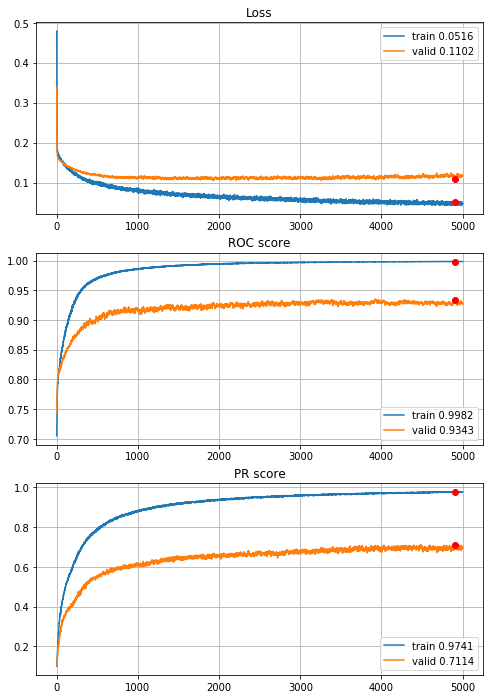


Fold 2------------------------------------------------------------


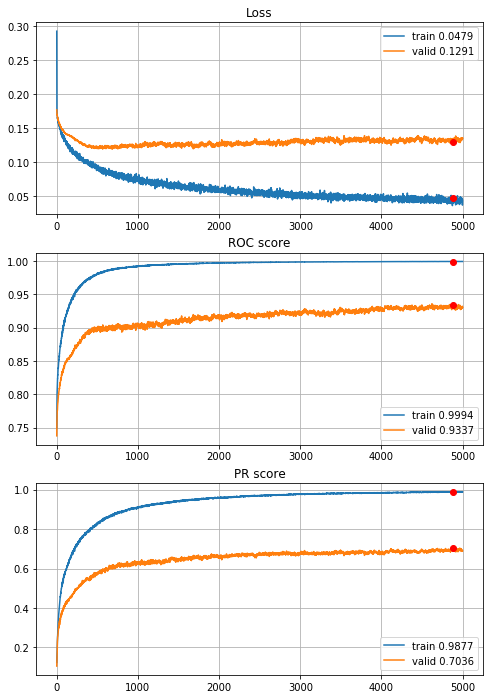


Fold 3------------------------------------------------------------


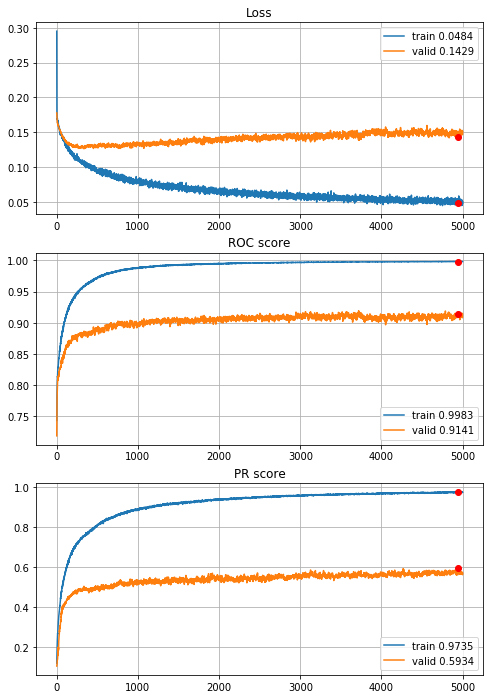


Fold 4------------------------------------------------------------


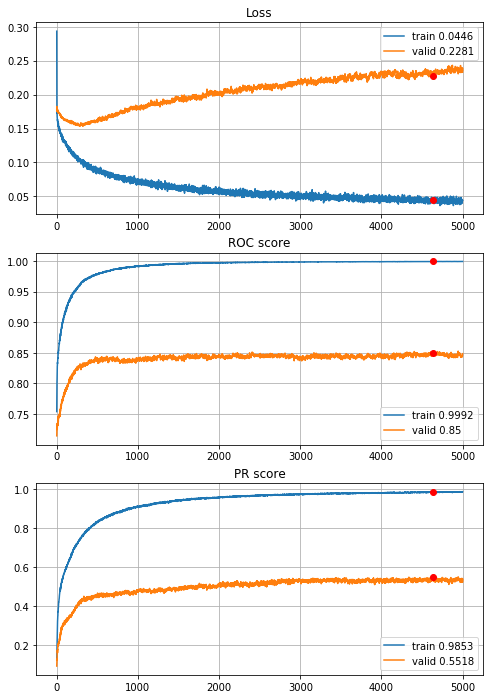


Fold 5------------------------------------------------------------


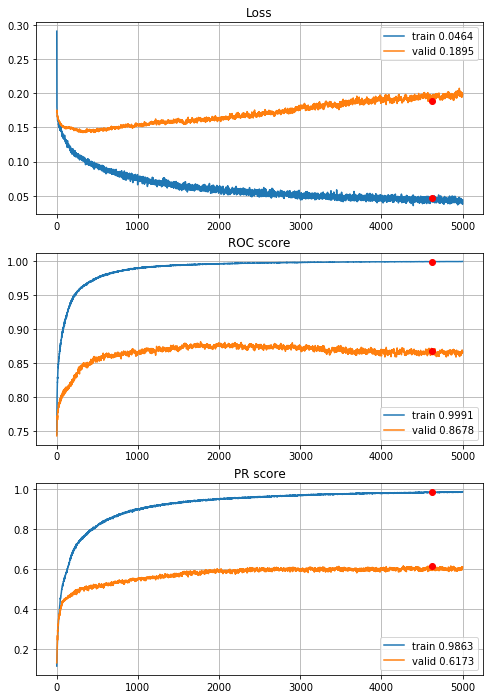


Fold 6------------------------------------------------------------


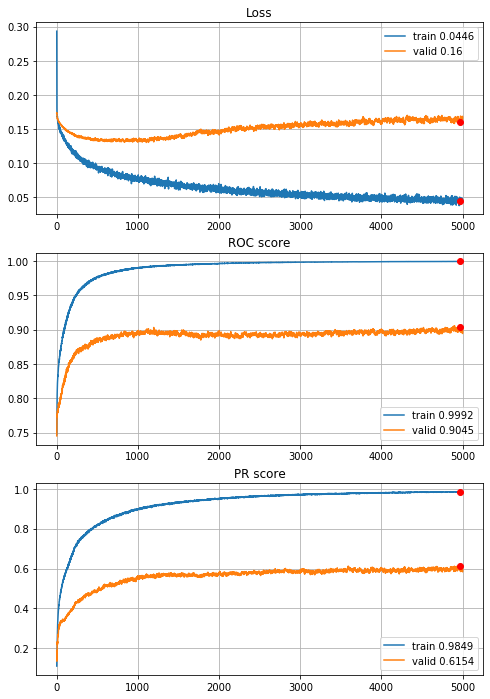

In [36]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=5000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\3year\MLP_standard_5000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Surprising results - lower overfitting, higher metrics. I've train 1 year horizon model for 800 epochs, maybe I can get better results training the model longer on that task. Back to current task, 3 year horizon, and looking at learning curves it can be concluded that longer training should not worse results, but improvements would be very very small, so it is time to stop with MLP. 



To sum up, the best Multilayer Percepton specification:
 - 2 layers $l^{[1]},l^{[2]}$,
 - units: $u^{[1]}=60, u^{[2]}=60$,
 - activations: $a^{[1]}:tanh,a^{[2]}:\sigma$,
 - dropout: $d^{[1]}=0.4,d^{[2]}=0.4$,
 - optimizer: Adam with default setings,
 - 4892 epochs (rounded folds median, 4891.5),
 - 394 batch size.
 
 ##### Convolutional Neural Network
 - functions for Monte Carlo Energy objective quasi-minimization (Tadaaki Hosaka 2019):
 
 $$E=\sum_{(i,j)\in \xi}|\phi[R(i),R(j)]|*d(i,j) $$
 where:<br>
 $d(i,j)=(x(i)-x(j))^2+(y(i)-y(j))^2$ - distance measure, <br>
 $i,j$ - pixels indices, <br>
 $x(i), y(i)$ - $xy-$coordinates of pixel $i$, <br>
 $\xi$ - set of all pixels combinations (sample space), <br>
 $R(i)$ - financial ratio for pixel $i$,<br>
 $\phi(\cdot)$ - correlation coefficient, <br>

when randomly swapped ratio for pair of pixels can reduce energy, they're swapped. Simulation ends when there is no reduction after $\alpha N$ steps, where $N$ is number of features.<br>
The idea of image with correlated features close to each other is based on correlation matrix (below) and the fact that pixels are dependent from their neighbours on the real pictures - when we have image of black cat sitting on the white pillow, then: $$P(pixel_{i}=black|pixel_{j}=black) > P(pixel_{i}=black|pixel_{j}=white)$$ where $d(i,j)=\varepsilon$

In [36]:
# raw imputed data
X_train = train_test_imp_sets["train_set_imp"][features]
Y_train = train_test_imp_sets["train_set_imp"][target]

# normalization
sclr=scaler(images=False)
sclr.fit(X=X_train ,q=None, power_transform=False)
X_train_norm=pd.DataFrame(sclr.transform(X=X_train),columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995)
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=False)
X_train_clip_norm=pd.DataFrame(sclr.transform(X=X_train), columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995) and power transform
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=True)
X_train_clip_norm_pt=pd.DataFrame(sclr.transform(X=X_train), columns=features)

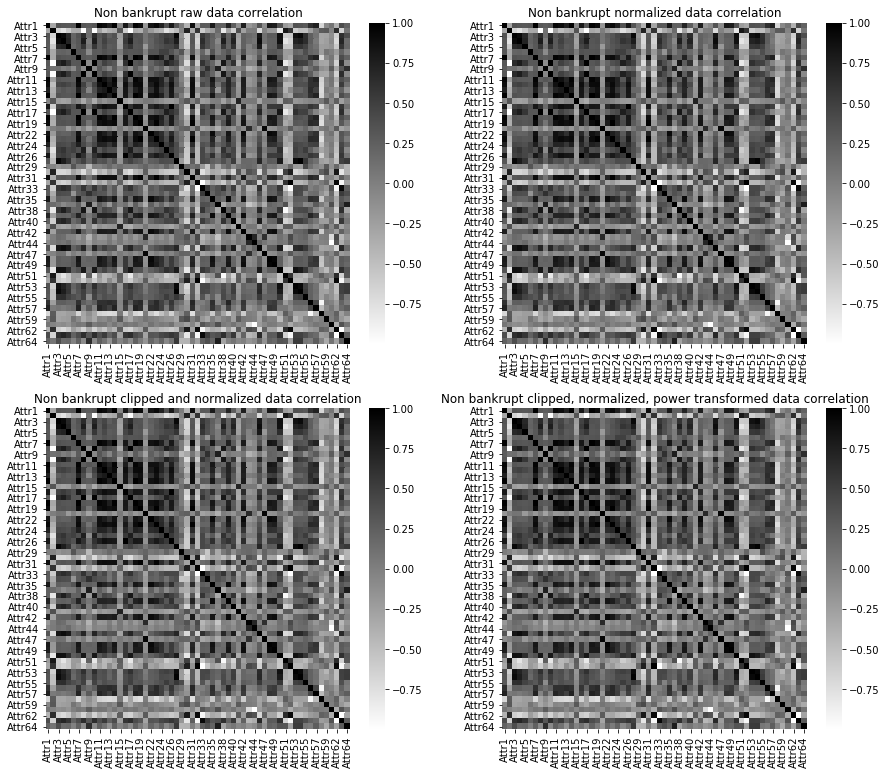

In [37]:
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(15,13))

sns.heatmap(X_train[Y_train==0].corr(method="spearman"),cmap="binary",annot=False, cbar=True, ax=ax[0,0])
ax[0,0].set_title("Non bankrupt raw data correlation")
sns.heatmap(X_train_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[0,1])
ax[0,1].set_title("Non bankrupt normalized data correlation")
sns.heatmap(X_train_clip_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,0])
ax[1,0].set_title("Non bankrupt clipped and normalized data correlation")
sns.heatmap(X_train_clip_norm_pt[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,1])
ax[1,1].set_title("Non bankrupt clipped, normalized, power transformed data correlation")

plt.show()

Analytical differences between correlation matrix variants presented above

In [38]:
corrs=[X_train[Y_train==0].corr(method="spearman"),
       X_train_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm_pt[Y_train==0].corr(method="spearman")]

print(np.sum(np.sum(np.abs(corrs[0]-corrs[1])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[2]-corrs[3])))/2)

0.0
0.0
0.0
0.0
0.0
0.0


Correlation matrix is robust to applied transformations.

In [36]:
def distance(x1, x2, y1, y2):
    '''
    function computes distance between two points (Tadaaki Hosaka 2019)
    arguments:
    x1, y2 - xy-coordinates of the first point
    x2, y2 - xy-coordinates of the second point
    
    return distance (scalar)
    '''
    d = (x1-x2)**2+(y1-y2)**2
    return d

def image_energy_v3(image, cor_matrix):
    '''
    function computes Energy for given image (Tadaaki Hosaka 2019).
    
    Energy = sum |c[R(i), R(j)]|d(i,j)
    d(i,j) = (x(i)-x(j))^2+(y(i)-y(j))^2
    where:
    i, j - indices of pixels,
    x(i), x(j) - xy coordinates of pixel,
    R(i) - feature for i,
    c[R(i), R(j)] - correlation coefficient between R(i) and R(j)
    
    arguments:
    image - dictionary (attributes names, xy coordinates) 
    corr_matrix - correlation matrix computed for analyzed data 
    
    return calculated Energy (scalar)
    ----
    188 times faster than first version
    '''
    # absolute value of correlation matrix - could be performed outside for loop
    cor_matrix = abs(cor_matrix)
    # energy inicjation
    E = 0
    # extracting features names
    for feature1 in image.keys():
        for feature2 in image.keys():
            # looking for correlation between features in previously computed (given) correlation matrix
            cor = cor_matrix.loc[feature1, feature2]
            # computing distance 
            d = distance(image[feature1][0], image[feature2][0], image[feature1][1], image[feature2][1])
            # computing energy
            E += cor*d
    
    # because of double counting returned energy is a half of computed
    # note: when feature1 = feature2 <=> distance = 0
    return E/2

def image_dict_to_matrix(image_dict):
    '''
    function converts dictionary to matrix draft of image, arguments:
    image_dict - dictionary to convert, keys: attribute, value: tuple of xy-coordinates,
    
    return matrix image draft 
    '''
    from math import ceil
    shape = ceil(len(image_dict)**(1/2))
    
#     matrix = np.zeros((shape,shape))+128
#     matrix = matrix.astype(object)
    matrix = np.zeros((shape,shape), dtype=object)+128
    for cords in list(image_dict.values()):
        matrix[cords[0], cords[1]] = list(image_dict.keys())[list(image_dict.values()).index(cords)]
    
    return matrix

def map_image(draft, example):
    '''
    function converts draft to image for concrete example, arguments:
    draft - matrix with order of features in image xy-coordinate system, matrix element must match example indices
    example - pandas.Series contains single observation - example indices must match draft values
    
    return numpy.array() - matrix with values for given example with draft order
    '''
    draft_tmp = draft.copy()
    
    for i in range(draft_tmp.shape[0]):
        for j in range(draft_tmp.shape[1]):
            attr = draft_tmp[i,j]
            draft_tmp[i,j] = example[attr] if attr != 128 else 128
    
    #draft_tmp=draft_tmp.astype(np.float)
    draft_tmp=draft_tmp.astype(np.uint8)
    
    return draft_tmp

def image_draft_inicialization(features, random_state):
    '''
    function inicializes draft in dictionary form, keys=feature names, values=position in the image space
    (xy-coordinates in the integers space), arguments:
    
    features - list of the features in dataset for which draft is inicialized,
    random_state - random seed
    
    return draft_dict (python dictionary inicialized draft)
    ----------
    Note: generated draft is for square-shaped image => range(x)=range(y)=ceil(len(features)**(1/2)), but image space
          is created like grid iterating all columns for all rows, thus if len(features) is not a perfect square then
          some potential coordinates are excluded from image space, and as conversion process progress this coordinates
          becomes placeholders, and are not consider while Monte Carlo quasi optimization. When len(features)**(1/2) - its
          ceil = 1 then there is only one placeholder - just right bottom one coordinate, when difference is in range
          [1, range(x)] then the last row of image contains placeholders, if difference is equal to range(x)+1 then 
          placeholders are the last row and new right bottom corner, if difference is in range [range(x)+1, 2*range(x)]
          then two last rows are placeholders etc. It is the best currently found solution for computing non-biased energy
          which is as low as possible.
    '''
    # seeds
    random.seed(random_state)
    np.random.seed(random_state)
    
    from math import ceil
    shape = ceil(len(features)**(1/2))

    # keys
    ks = features.copy()
    # values
    vs = []
    for i in range(shape):
        for j in range(shape):
            vs.append((i,j))
            
    # dictionary
    draft_dict = dict(zip(ks,vs))
    
    return draft_dict

def MC_Energy_optimization(corr_matrix, draft, alpha, n_eval, random_state):
    '''
    function performes Monte Carlo quasi optimization for Energy objective (Tadaaki Hosaka 2019), arguments:
    corr_matrix - correlation matrix (pandas DataFrame),
    draft - initial draft for image to optimize,
    alpha - parameter that impact on simulation duration (3 in Hosakas' article),
    n_eval - number of iteration per which current state is printed,
    random_state - random seed
    
    return ordered draft
    '''
    random.seed(random_state)
    np.random.seed(random_state)
    
    start = time.time()
    initial_energy = image_energy_v3(draft, corr_matrix)
    print("initial image energy:", round(initial_energy, 4))

    energy = initial_energy
    stop_criterion = 0
    i = 0
    while stop_criterion < alpha*len(features):
        draft_tmp = draft.copy()
        # coordinates pair sampling
        xy1, xy2 = random.sample(list(draft_tmp.values()), 2)
        # feature name under coordinates
        ft1 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy1)]
        ft2 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy2)]
        # coordinates swap
        draft_tmp[ft1] = xy2
        draft_tmp[ft2] = xy1
        # new energy
        energy_new = image_energy_v3(draft_tmp, corr_matrix)
        # saving changes
        if energy_new < energy:
            energy = energy_new
            draft = draft_tmp.copy()
            stop_criterion = 0
        else:
            stop_criterion += 1
        i += 1
        # evaluation
        if i%n_eval == 0:
            print("iteration: {}\ncurrent energy: {}".format(i, round(energy, 4)))
    
    stop = time.time()
    print("MC simulation time: {}s\nenergy after MC quasi optimization: {}".format(round(stop-start), round(energy, 4)))
    
    return draft

 - CNN definitions

In [38]:
def define_CNN(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model

def define_CNN_Adam(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

 - 6-fold Cross Validation CNN

In [39]:
def CNN_6FoldCrossValidation(datasets, model_definition, features, target, n_epochs, batch_size, alpha, random_state,
                             normalize="power", q=None, drafts=None, instruction=None, info=None):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    alpha - Monte Carlo duration parameter,
    random_state - random seed,
    info - same arguent as for network_training(),
    *args and **kwargs - arguments for create_MLP() function
    
    returns CNNhistories - list of every CNN model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]
    
    CVstart=time.time()
    # history of CV
    CNNhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        
        if drafts is None and instruction is None:
            # ----- current fold train and validation sets ------
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- Monte Carlo energy optimization -----
            # correlation matrix for non bankrupt observations
            corr_matrix = X_train[Y_train==0].corr(method="spearman")
            # draft inicialization
            draft = image_draft_inicialization(features, random_state)
            # quasi optimization
            draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=alpha, n_eval=99999,
                                           random_state=random_state)
            # transform draft dictionary to matrix
            draft = image_dict_to_matrix(draft)
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
        
        elif drafts is not None and instruction is None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()    
            
        elif drafts is not None and instruction is not None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = generate_features(data=training_sets[fold][features], instruction=instruction)
            Y_train = training_sets[fold][target].copy()
            X_valid = generate_features(data=validation_sets[fold][features].copy(), instruction=instruction)
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
            
        else:
            raise "valid options are: drafts=None and instruction=None, drafts!=None and instruction=None, drafts!=None and instruction!=None"
            
        # ----- standarization for CNN (images) -----
        if normalize==True:
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        elif normalize=="power":
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        else:
            pass
            
        # ----- vector to image conversion -----
        # training set
        X_train_CNN = np.array([map_image(draft, X_train.iloc[i,:])/255 for i in range(X_train.shape[0])])
        X_train_CNN = X_train_CNN.reshape(X_train_CNN.shape+(1,))
        Y_train_CNN = Y_train.values
        # validation set
        X_valid_CNN = np.array([map_image(draft, X_valid.iloc[i,:])/255 for i in range(X_valid.shape[0])])
        X_valid_CNN = X_valid_CNN.reshape(X_valid_CNN.shape+(1,))
        Y_valid_CNN = Y_valid.values
        
        # ----- CNN training -----
        modelCNN = model_definition(input_shape=X_train_CNN.shape[1:], random_state=random_state)
        modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN, Y_train=Y_train_CNN,
                                                X_val=X_valid_CNN, Y_val=Y_valid_CNN, n_epochs=n_epochs,
                                                batch_size=batch_size, random_state=random_state, info=info)
        # ----- MLP history saving -----
        CNNhistories.append(historyCNN.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return CNNhistories


----------
Fold: 1
----------
initial image energy: 12328.4177
MC simulation time: 86s
energy after MC quasi optimization: 8084.8833
Train on 7876 samples, validate on 1576 samples
Epoch: 1/100,
cumulative time: 3.33s train loss: 0.20454584375409804, validation loss: 0.19341221079230309
Epoch: 2/100,
cumulative time: 4.86s train loss: 0.20039411435360652, validation loss: 0.18908149376511574
Epoch: 3/100,
cumulative time: 6.45s train loss: 0.1943197865181008, validation loss: 0.18741516023874283
Epoch: 4/100,
cumulative time: 8.06s train loss: 0.19356210072325716, validation loss: 0.19996463879942894
Epoch: 5/100,
cumulative time: 9.61s train loss: 0.1895726417234369, validation loss: 0.18487230315804482
Epoch: 6/100,
cumulative time: 11.24s train loss: 0.18584630884506365, validation loss: 0.18367449939250946
Epoch: 7/100,
cumulative time: 12.88s train loss: 0.18784478839927665, validation loss: 0.18215926364064217
Epoch: 8/100,
cumulative time: 14.44s train loss: 0.18529134987649606

Epoch: 75/100,
cumulative time: 115.48s train loss: 0.1582557103502502, validation loss: 0.17034674435853958
Epoch: 76/100,
cumulative time: 116.99s train loss: 0.15739919760994284, validation loss: 0.17009568214416504
Epoch: 77/100,
cumulative time: 118.62s train loss: 0.15718493263633074, validation loss: 0.18402795121073723
Epoch: 78/100,
cumulative time: 120.26s train loss: 0.1563408066432993, validation loss: 0.17949605360627174
Epoch: 79/100,
cumulative time: 121.8s train loss: 0.157425337788446, validation loss: 0.18607104197144508
Epoch: 80/100,
cumulative time: 123.56s train loss: 0.15755315495436417, validation loss: 0.18178291991353035
Epoch: 81/100,
cumulative time: 125.28s train loss: 0.1576242923751708, validation loss: 0.16717496141791344
Epoch: 82/100,
cumulative time: 127.17s train loss: 0.15628864915843782, validation loss: 0.16725162416696548
Epoch: 83/100,
cumulative time: 128.86s train loss: 0.15560018776553183, validation loss: 0.1704915054142475
Epoch: 84/100,
cu

Epoch: 48/100,
cumulative time: 79.5s train loss: 0.1646481485873718, validation loss: 0.1824401244521141
Epoch: 49/100,
cumulative time: 81.1s train loss: 0.16452490342350523, validation loss: 0.1762077584862709
Epoch: 50/100,
cumulative time: 82.62s train loss: 0.1636377907873199, validation loss: 0.17447968944907188
Epoch: 51/100,
cumulative time: 84.15s train loss: 0.165168104472879, validation loss: 0.17341194674372673
Epoch: 52/100,
cumulative time: 85.73s train loss: 0.16363217755433204, validation loss: 0.19167745858430862
Epoch: 53/100,
cumulative time: 87.25s train loss: 0.1658634327469349, validation loss: 0.1737825572490692
Epoch: 54/100,
cumulative time: 88.81s train loss: 0.16147236521471692, validation loss: 0.19386176019906998
Epoch: 55/100,
cumulative time: 90.33s train loss: 0.16300735995741045, validation loss: 0.17570467293262482
Epoch: 56/100,
cumulative time: 91.88s train loss: 0.16348458013562092, validation loss: 0.1813109777867794
Epoch: 57/100,
cumulative time

Epoch: 20/100,
cumulative time: 30.48s train loss: 0.17975797397398444, validation loss: 0.17626249277402484
Epoch: 21/100,
cumulative time: 31.94s train loss: 0.17868545017706133, validation loss: 0.1738013295521812
Epoch: 22/100,
cumulative time: 33.38s train loss: 0.17722533022947265, validation loss: 0.17318120854241506
Epoch: 23/100,
cumulative time: 34.86s train loss: 0.1768984998488496, validation loss: 0.17492146934781755
Epoch: 24/100,
cumulative time: 36.33s train loss: 0.17755091815365895, validation loss: 0.1714667305397609
Epoch: 25/100,
cumulative time: 37.86s train loss: 0.17481351080159632, validation loss: 0.17082265486792914
Epoch: 26/100,
cumulative time: 39.43s train loss: 0.1744975798400477, validation loss: 0.17204874402946896
Epoch: 27/100,
cumulative time: 41.04s train loss: 0.17284825349445798, validation loss: 0.17195471743742624
Epoch: 28/100,
cumulative time: 42.6s train loss: 0.1744807774215933, validation loss: 0.17770586964629945
Epoch: 29/100,
cumulative

Epoch: 96/100,
cumulative time: 151.1s train loss: 0.14852389268188348, validation loss: 0.18493325461470891
Epoch: 97/100,
cumulative time: 152.66s train loss: 0.14803456316725833, validation loss: 0.18236501545187025
Epoch: 98/100,
cumulative time: 154.21s train loss: 0.1472399716879248, validation loss: 0.1763077359918564
Epoch: 99/100,
cumulative time: 155.89s train loss: 0.14799348838599907, validation loss: 0.18696767677390386
Epoch: 100/100,
cumulative time: 157.52s train loss: 0.1483812251035916, validation loss: 0.1782142746826959

Early stopping results:
best results in epoch: 41, 
best valid PR: 0.17905653105284094, 
valid ROC: 0.7825053567891675        
overfitting PR: 0.009745148979936863, 
overfitting ROC: 0.009829328921383551

----------
Fold: 4
----------
initial image energy: 12385.0048
MC simulation time: 97s
energy after MC quasi optimization: 8168.5238
Train on 7877 samples, validate on 1575 samples
Epoch: 1/100,
cumulative time: 2.58s train loss: 0.2043012470570678

Epoch: 69/100,
cumulative time: 105.28s train loss: 0.15928901745588386, validation loss: 0.18028664421467555
Epoch: 70/100,
cumulative time: 106.76s train loss: 0.15860859241577308, validation loss: 0.17505188934386723
Epoch: 71/100,
cumulative time: 108.21s train loss: 0.15984140166825292, validation loss: 0.17219680451211475
Epoch: 72/100,
cumulative time: 109.69s train loss: 0.15541975398429597, validation loss: 0.17619606286760361
Epoch: 73/100,
cumulative time: 111.17s train loss: 0.15798317517395233, validation loss: 0.17620228199731736
Epoch: 74/100,
cumulative time: 112.65s train loss: 0.15633551833350237, validation loss: 0.17623575079062628
Epoch: 75/100,
cumulative time: 114.1s train loss: 0.15679667085518884, validation loss: 0.1736790692617023
Epoch: 76/100,
cumulative time: 115.56s train loss: 0.15949526365425012, validation loss: 0.1735752614055361
Epoch: 77/100,
cumulative time: 117.09s train loss: 0.1545423595368355, validation loss: 0.18570421786535354
Epoch: 78/100,

Epoch: 41/100,
cumulative time: 63.05s train loss: 0.15977660561649876, validation loss: 0.16081984219096956
Epoch: 42/100,
cumulative time: 64.55s train loss: 0.15953102109319323, validation loss: 0.16088479218974946
Epoch: 43/100,
cumulative time: 66.05s train loss: 0.16299337113480195, validation loss: 0.16012661548833998
Epoch: 44/100,
cumulative time: 67.56s train loss: 0.16203080110135562, validation loss: 0.16246671469438645
Epoch: 45/100,
cumulative time: 69.05s train loss: 0.15499130880203105, validation loss: 0.15919419223353976
Epoch: 46/100,
cumulative time: 70.54s train loss: 0.1596728860726586, validation loss: 0.16943712448316908
Epoch: 47/100,
cumulative time: 72.02s train loss: 0.15698168546025698, validation loss: 0.16251168881143843
Epoch: 48/100,
cumulative time: 73.5s train loss: 0.1595409660453162, validation loss: 0.159024879837793
Epoch: 49/100,
cumulative time: 74.99s train loss: 0.15732087310315146, validation loss: 0.1613184422538394
Epoch: 50/100,
cumulative

Epoch: 13/100,
cumulative time: 21.05s train loss: 0.17666286267543543, validation loss: 0.1760265562647865
Epoch: 14/100,
cumulative time: 22.67s train loss: 0.17462683586628133, validation loss: 0.17908302393224504
Epoch: 15/100,
cumulative time: 24.24s train loss: 0.17528195019352175, validation loss: 0.17751840105132452
Epoch: 16/100,
cumulative time: 25.81s train loss: 0.17547448331122928, validation loss: 0.17555983977658407
Epoch: 17/100,
cumulative time: 27.38s train loss: 0.17597561302456863, validation loss: 0.18071061296122415
Epoch: 18/100,
cumulative time: 28.89s train loss: 0.1737025671990765, validation loss: 0.17456185684317635
Epoch: 19/100,
cumulative time: 30.43s train loss: 0.17389426192452465, validation loss: 0.17370124937049927
Epoch: 20/100,
cumulative time: 32.02s train loss: 0.1739485207261721, validation loss: 0.174399125528714
Epoch: 21/100,
cumulative time: 33.59s train loss: 0.17387390752287857, validation loss: 0.17382877543805136
Epoch: 22/100,
cumulativ

Epoch: 89/100,
cumulative time: 138.63s train loss: 0.1475518682201426, validation loss: 0.1838931159556858
Epoch: 90/100,
cumulative time: 140.11s train loss: 0.14235396809205347, validation loss: 0.17796695354438963
Epoch: 91/100,
cumulative time: 141.61s train loss: 0.14455366562174649, validation loss: 0.18144609796622443
Epoch: 92/100,
cumulative time: 143.1s train loss: 0.14315957216134725, validation loss: 0.19666560875991035
Epoch: 93/100,
cumulative time: 144.61s train loss: 0.14065314248209906, validation loss: 0.21287615785523067
Epoch: 94/100,
cumulative time: 146.09s train loss: 0.14434332993901652, validation loss: 0.18462177041031066
Epoch: 95/100,
cumulative time: 147.6s train loss: 0.14286165540973836, validation loss: 0.17859284206042214
Epoch: 96/100,
cumulative time: 149.09s train loss: 0.13873482656438021, validation loss: 0.20896569778048804
Epoch: 97/100,
cumulative time: 150.59s train loss: 0.1400853579073399, validation loss: 0.17921181497119723
Epoch: 98/100,


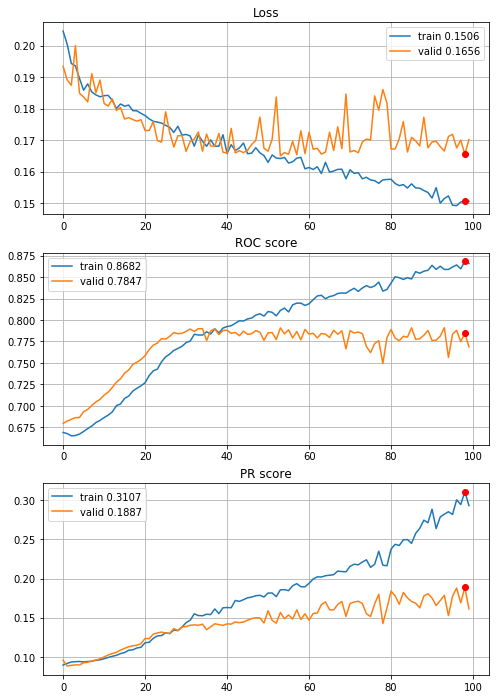


Fold 2------------------------------------------------------------


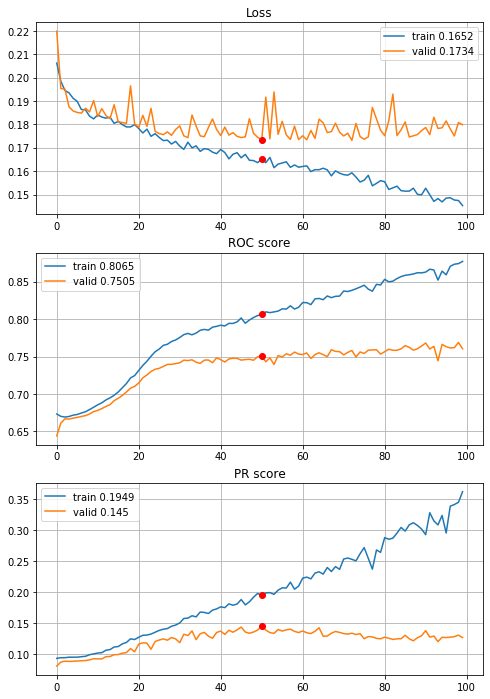


Fold 3------------------------------------------------------------


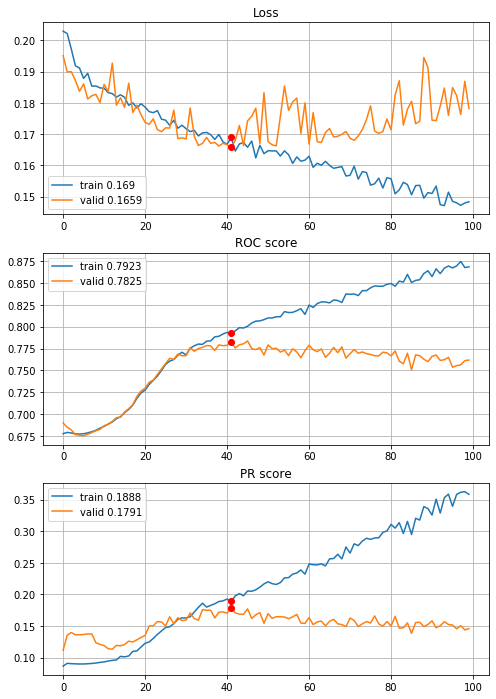


Fold 4------------------------------------------------------------


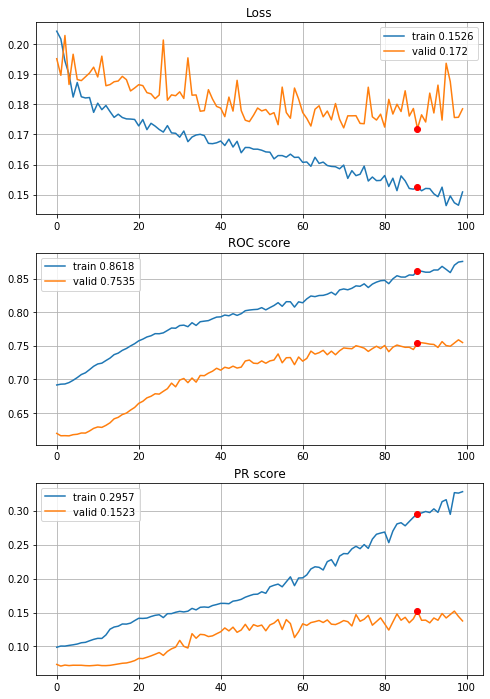


Fold 5------------------------------------------------------------


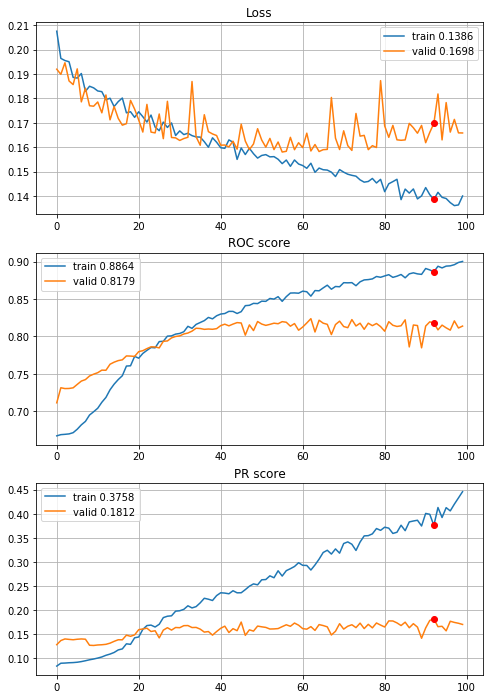


Fold 6------------------------------------------------------------


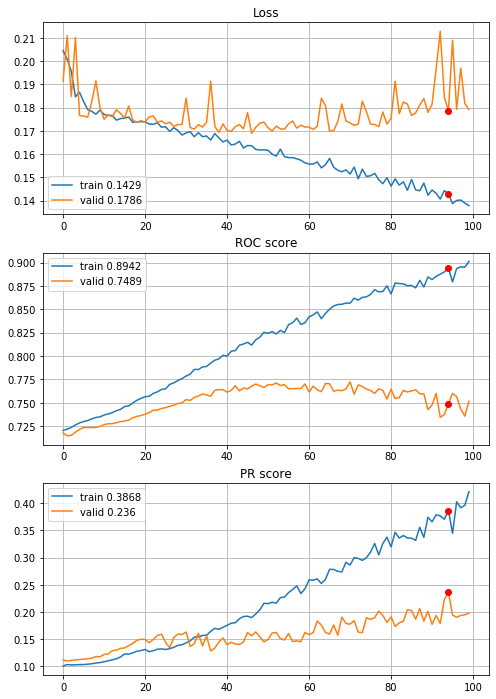

In [44]:
# first CNN only normalization applied
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=None, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])


----------
Fold: 1
----------
initial image energy: 12328.4177
MC simulation time: 86s
energy after MC quasi optimization: 8084.8833
Train on 7876 samples, validate on 1576 samples
Epoch: 1/100,
cumulative time: 2.29s train loss: 0.20443299403267504, validation loss: 0.19264229387044907
Epoch: 2/100,
cumulative time: 3.78s train loss: 0.19854491655069176, validation loss: 0.18429557979106903
Epoch: 3/100,
cumulative time: 5.27s train loss: 0.1888750065789724, validation loss: 0.18052681162953377
Epoch: 4/100,
cumulative time: 6.76s train loss: 0.18659122006323448, validation loss: 0.20327027142047882
Epoch: 5/100,
cumulative time: 8.26s train loss: 0.18290030243941344, validation loss: 0.1768708974123001
Epoch: 6/100,
cumulative time: 9.77s train loss: 0.1789422817055255, validation loss: 0.17540427297353745
Epoch: 7/100,
cumulative time: 11.27s train loss: 0.181276018412026, validation loss: 0.17714539170265198
Epoch: 8/100,
cumulative time: 12.8s train loss: 0.17858666065018935, val

Epoch: 76/100,
cumulative time: 119.4s train loss: 0.10298426290751714, validation loss: 0.16420166939496994
Epoch: 77/100,
cumulative time: 120.92s train loss: 0.09812530382915219, validation loss: 0.16823696717619896
Epoch: 78/100,
cumulative time: 122.47s train loss: 0.09886249368409629, validation loss: 0.16429979726672173
Epoch: 79/100,
cumulative time: 123.98s train loss: 0.0997459059812927, validation loss: 0.17416781932115555
Epoch: 80/100,
cumulative time: 125.48s train loss: 0.10358180710265423, validation loss: 0.17101100087165833
Epoch: 81/100,
cumulative time: 126.99s train loss: 0.09426499381585736, validation loss: 0.17138881608843803
Epoch: 82/100,
cumulative time: 128.51s train loss: 0.09813119992311077, validation loss: 0.17282408848404884
Epoch: 83/100,
cumulative time: 130.01s train loss: 0.10056812471320872, validation loss: 0.18862284719944
Epoch: 84/100,
cumulative time: 131.53s train loss: 0.09643122488836185, validation loss: 0.18298441171646118
Epoch: 85/100,


Epoch: 49/100,
cumulative time: 76.5s train loss: 0.1255558270444538, validation loss: 0.17795616388320923
Epoch: 50/100,
cumulative time: 78.03s train loss: 0.12848237508396135, validation loss: 0.18418993800878525
Epoch: 51/100,
cumulative time: 79.55s train loss: 0.1308395393976044, validation loss: 0.1685856655240059
Epoch: 52/100,
cumulative time: 81.07s train loss: 0.13107767247265217, validation loss: 0.17684607952833176
Epoch: 53/100,
cumulative time: 82.57s train loss: 0.12823859452368827, validation loss: 0.1700766235589981
Epoch: 54/100,
cumulative time: 84.08s train loss: 0.1217545188070403, validation loss: 0.1721736304461956
Epoch: 55/100,
cumulative time: 85.57s train loss: 0.12649897801930557, validation loss: 0.18427260592579842
Epoch: 56/100,
cumulative time: 87.08s train loss: 0.12353885669872323, validation loss: 0.17502682283520699
Epoch: 57/100,
cumulative time: 88.57s train loss: 0.12266427876381417, validation loss: 0.20280945673584938
Epoch: 58/100,
cumulative 

Epoch: 21/100,
cumulative time: 33.22s train loss: 0.1688076322724466, validation loss: 0.16326673426325358
Epoch: 22/100,
cumulative time: 34.79s train loss: 0.16655039233772134, validation loss: 0.16243373380766973
Epoch: 23/100,
cumulative time: 36.35s train loss: 0.16437015712442807, validation loss: 0.16358848522579858
Epoch: 24/100,
cumulative time: 37.91s train loss: 0.16463188217900587, validation loss: 0.16163363161541167
Epoch: 25/100,
cumulative time: 39.48s train loss: 0.16103176339198993, validation loss: 0.1643831957238061
Epoch: 26/100,
cumulative time: 41.05s train loss: 0.1613149707130752, validation loss: 0.16322267536133056
Epoch: 27/100,
cumulative time: 42.61s train loss: 0.1605126312144656, validation loss: 0.1590268957520288
Epoch: 28/100,
cumulative time: 44.17s train loss: 0.15622985615741788, validation loss: 0.1873815572734863
Epoch: 29/100,
cumulative time: 45.73s train loss: 0.15539680094461356, validation loss: 0.15468826487896933
Epoch: 30/100,
cumulative

Epoch: 97/100,
cumulative time: 151.38s train loss: 0.08186550848625844, validation loss: 0.1919740178849962
Epoch: 98/100,
cumulative time: 152.93s train loss: 0.07537054260479734, validation loss: 0.19450128324448115
Epoch: 99/100,
cumulative time: 154.41s train loss: 0.08170727874681219, validation loss: 0.18191958241992526
Epoch: 100/100,
cumulative time: 155.93s train loss: 0.0826415520781405, validation loss: 0.1801697851930346

Early stopping results:
best results in epoch: 56, 
best valid PR: 0.28936017061392316, 
valid ROC: 0.8502349784828133        
overfitting PR: 0.29791051460052764, 
overfitting ROC: 0.090035087584728

----------
Fold: 4
----------
initial image energy: 12385.0048
MC simulation time: 98s
energy after MC quasi optimization: 8168.5238
Train on 7877 samples, validate on 1575 samples
Epoch: 1/100,
cumulative time: 2.65s train loss: 0.2038160527366906, validation loss: 0.19725347536896903
Epoch: 2/100,
cumulative time: 4.24s train loss: 0.19875116549054878, val

Epoch: 70/100,
cumulative time: 108.31s train loss: 0.10625151482098476, validation loss: 0.20606379690624418
Epoch: 71/100,
cumulative time: 109.8s train loss: 0.10593899329316726, validation loss: 0.19547234139745198
Epoch: 72/100,
cumulative time: 111.32s train loss: 0.0952306238753974, validation loss: 0.18906271878689054
Epoch: 73/100,
cumulative time: 112.85s train loss: 0.10848629964787267, validation loss: 0.18021245946959843
Epoch: 74/100,
cumulative time: 114.33s train loss: 0.09516905812846686, validation loss: 0.20425687373630586
Epoch: 75/100,
cumulative time: 115.83s train loss: 0.10688339638875738, validation loss: 0.18437729164721472
Epoch: 76/100,
cumulative time: 117.37s train loss: 0.09396206715717766, validation loss: 0.19733695459744288
Epoch: 77/100,
cumulative time: 118.89s train loss: 0.09951850622551868, validation loss: 0.19820164718325176
Epoch: 78/100,
cumulative time: 120.41s train loss: 0.09891537178515389, validation loss: 0.25199467185943847
Epoch: 79/10

Epoch: 42/100,
cumulative time: 65.5s train loss: 0.14062496778572123, validation loss: 0.16660931324201916
Epoch: 43/100,
cumulative time: 67.08s train loss: 0.14487357441394086, validation loss: 0.16789575180364033
Epoch: 44/100,
cumulative time: 68.65s train loss: 0.14609418398908391, validation loss: 0.1668606396137722
Epoch: 45/100,
cumulative time: 70.18s train loss: 0.13325436830320106, validation loss: 0.16796855138407812
Epoch: 46/100,
cumulative time: 71.77s train loss: 0.14083379683090344, validation loss: 0.17633464818909056
Epoch: 47/100,
cumulative time: 73.35s train loss: 0.13551867289509556, validation loss: 0.17029234844540792
Epoch: 48/100,
cumulative time: 74.91s train loss: 0.13940835786044364, validation loss: 0.16516503502452184
Epoch: 49/100,
cumulative time: 76.5s train loss: 0.13535555518791884, validation loss: 0.16393599392875793
Epoch: 50/100,
cumulative time: 78.18s train loss: 0.13445488810047396, validation loss: 0.16424616204367742
Epoch: 51/100,
cumulat

Epoch: 14/100,
cumulative time: 23.3s train loss: 0.16956294419439488, validation loss: 0.17466652013006664
Epoch: 15/100,
cumulative time: 25.03s train loss: 0.16903573698738406, validation loss: 0.1855209990531679
Epoch: 16/100,
cumulative time: 26.69s train loss: 0.16920541739333655, validation loss: 0.17009892355828057
Epoch: 17/100,
cumulative time: 28.38s train loss: 0.16969465638487355, validation loss: 0.17774671359667701
Epoch: 18/100,
cumulative time: 30.24s train loss: 0.16635959496977246, validation loss: 0.1662305356869622
Epoch: 19/100,
cumulative time: 32.25s train loss: 0.16596273223586808, validation loss: 0.16679373711820633
Epoch: 20/100,
cumulative time: 33.98s train loss: 0.16403009060434964, validation loss: 0.16423321128837645
Epoch: 21/100,
cumulative time: 35.53s train loss: 0.16492245244248893, validation loss: 0.1635599823887386
Epoch: 22/100,
cumulative time: 37.14s train loss: 0.16377985653000102, validation loss: 0.1637092320786582
Epoch: 23/100,
cumulativ

Epoch: 90/100,
cumulative time: 143.97s train loss: 0.09154241390585884, validation loss: 0.19165072834680952
Epoch: 91/100,
cumulative time: 145.53s train loss: 0.09525542726398074, validation loss: 0.22200668809905885
Epoch: 92/100,
cumulative time: 147.09s train loss: 0.09192842677551523, validation loss: 0.21351360485667273
Epoch: 93/100,
cumulative time: 148.6s train loss: 0.09507048422969869, validation loss: 0.239491312901179
Epoch: 94/100,
cumulative time: 150.17s train loss: 0.09302416116460804, validation loss: 0.18441642494428725
Epoch: 95/100,
cumulative time: 151.8s train loss: 0.10120064656724176, validation loss: 0.17800186169525933
Epoch: 96/100,
cumulative time: 153.31s train loss: 0.08505380945723569, validation loss: 0.18179463254080877
Epoch: 97/100,
cumulative time: 154.86s train loss: 0.08992718794355087, validation loss: 0.179999651473666
Epoch: 98/100,
cumulative time: 156.48s train loss: 0.08550191052060328, validation loss: 0.2368965398886847
Epoch: 99/100,
cu

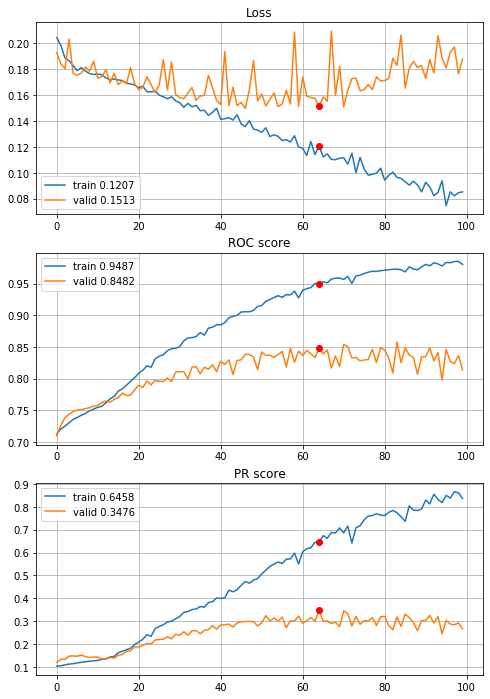


Fold 2------------------------------------------------------------


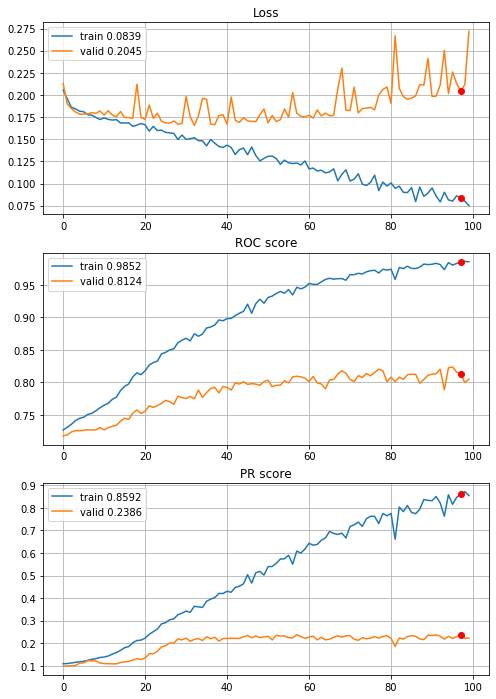


Fold 3------------------------------------------------------------


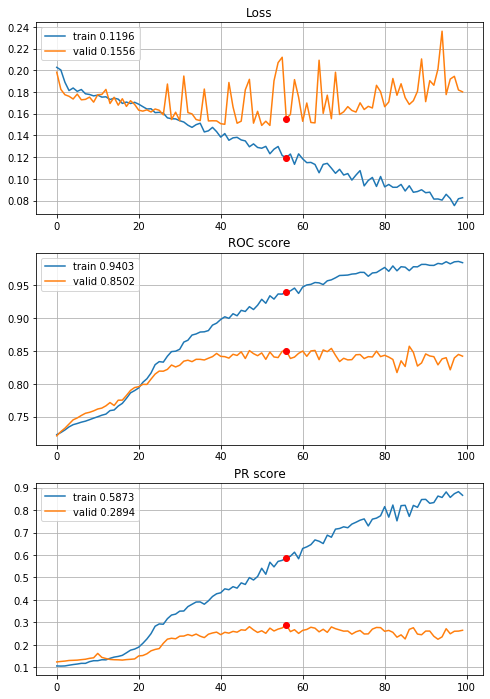


Fold 4------------------------------------------------------------


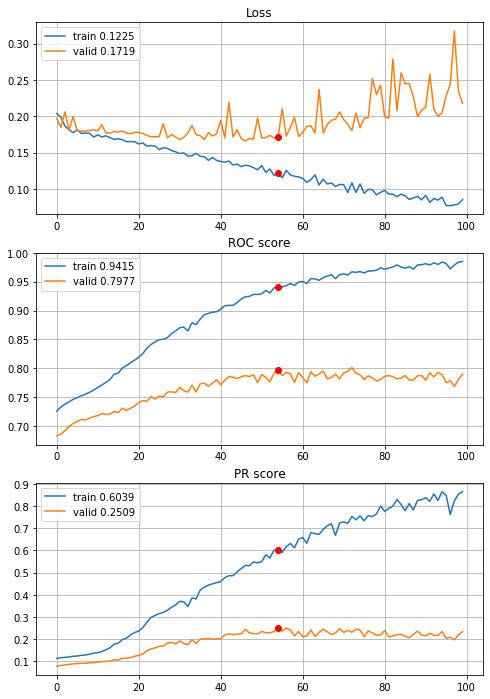


Fold 5------------------------------------------------------------


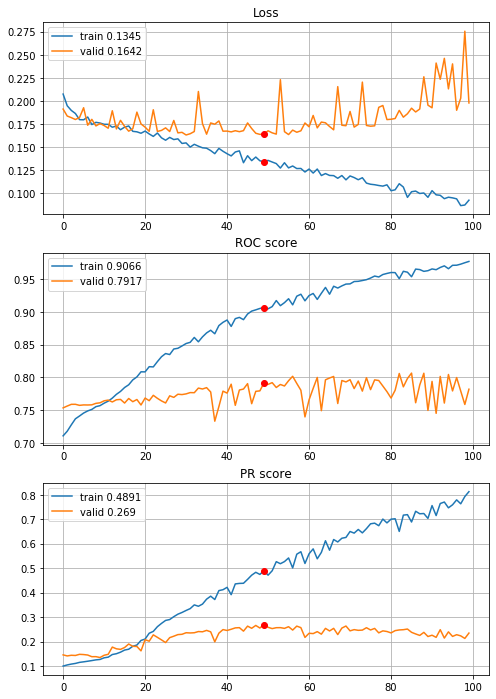


Fold 6------------------------------------------------------------


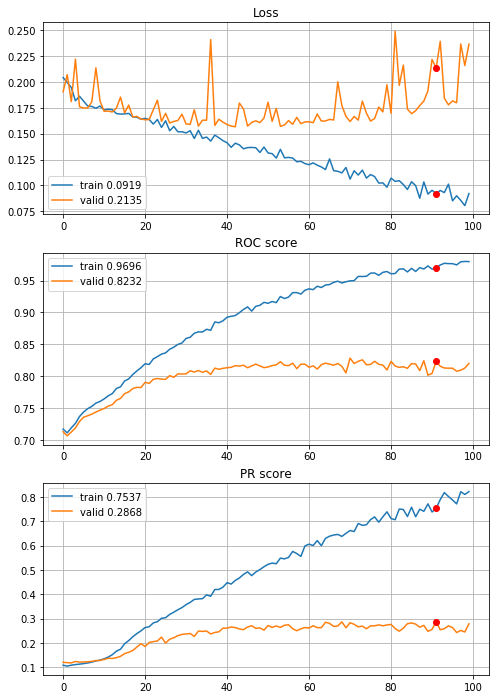

In [45]:
# first CNN with quantile clipping (Q_0.005, Q_0.995) and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Huge improvement, +0.1 on PR, bigger overfitting, but seems like architecture is not appropriate. Lets try with power transform added.


----------
Fold: 1
----------
initial image energy: 12328.4177
MC simulation time: 88s
energy after MC quasi optimization: 8084.8833
Train on 7876 samples, validate on 1576 samples
Epoch: 1/100,
cumulative time: 2.68s train loss: 0.2042368260652599, validation loss: 0.1907627284526825
Epoch: 2/100,
cumulative time: 4.22s train loss: 0.1968662514752879, validation loss: 0.17974673956632614
Epoch: 3/100,
cumulative time: 5.81s train loss: 0.1853396226422565, validation loss: 0.17728006094694138
Epoch: 4/100,
cumulative time: 7.34s train loss: 0.1855705175539332, validation loss: 0.20352431759238243
Epoch: 5/100,
cumulative time: 8.86s train loss: 0.1822207137552568, validation loss: 0.17488578706979752
Epoch: 6/100,
cumulative time: 10.35s train loss: 0.17845283127250317, validation loss: 0.17404935136437416
Epoch: 7/100,
cumulative time: 11.85s train loss: 0.18095557337533164, validation loss: 0.17532630637288094
Epoch: 8/100,
cumulative time: 13.34s train loss: 0.17846576004100367, va

Epoch: 76/100,
cumulative time: 121.76s train loss: 0.0912284793085317, validation loss: 0.1531345397233963
Epoch: 77/100,
cumulative time: 123.45s train loss: 0.09175104089175885, validation loss: 0.15622608736157417
Epoch: 78/100,
cumulative time: 124.99s train loss: 0.09803788700325952, validation loss: 0.14565468579530716
Epoch: 79/100,
cumulative time: 126.59s train loss: 0.09159218713569271, validation loss: 0.15160774812102318
Epoch: 80/100,
cumulative time: 128.22s train loss: 0.08792778758030365, validation loss: 0.1756019964814186
Epoch: 81/100,
cumulative time: 129.77s train loss: 0.08358413407010527, validation loss: 0.15647628530859947
Epoch: 82/100,
cumulative time: 131.35s train loss: 0.09066180043667933, validation loss: 0.16007831320166588
Epoch: 83/100,
cumulative time: 132.96s train loss: 0.0893400309261156, validation loss: 0.16529325023293495
Epoch: 84/100,
cumulative time: 134.66s train loss: 0.08567259410645013, validation loss: 0.2050778903067112
Epoch: 85/100,


Epoch: 49/100,
cumulative time: 82.07s train loss: 0.11653275918376331, validation loss: 0.17334526404738426
Epoch: 50/100,
cumulative time: 83.99s train loss: 0.1152852574744583, validation loss: 0.19856838509440422
Epoch: 51/100,
cumulative time: 85.88s train loss: 0.11734001043902066, validation loss: 0.1715700998902321
Epoch: 52/100,
cumulative time: 87.65s train loss: 0.10920369777205996, validation loss: 0.18560361117124557
Epoch: 53/100,
cumulative time: 89.42s train loss: 0.11681762885788542, validation loss: 0.1671847365796566
Epoch: 54/100,
cumulative time: 91.21s train loss: 0.10556095198493066, validation loss: 0.17524117231369019
Epoch: 55/100,
cumulative time: 93.07s train loss: 0.11315497291809323, validation loss: 0.18440252915024757
Epoch: 56/100,
cumulative time: 94.87s train loss: 0.10887056605397535, validation loss: 0.17823714390397072
Epoch: 57/100,
cumulative time: 96.69s train loss: 0.10798925587244297, validation loss: 0.21786032244563103
Epoch: 58/100,
cumulat

Epoch: 21/100,
cumulative time: 33.82s train loss: 0.16145413524346014, validation loss: 0.15698967400997405
Epoch: 22/100,
cumulative time: 35.34s train loss: 0.15932216922522832, validation loss: 0.1548675419224633
Epoch: 23/100,
cumulative time: 36.92s train loss: 0.15505815232762593, validation loss: 0.15460949652724795
Epoch: 24/100,
cumulative time: 38.44s train loss: 0.15568059518833036, validation loss: 0.1542499892295353
Epoch: 25/100,
cumulative time: 39.99s train loss: 0.150758064542686, validation loss: 0.1551065185429558
Epoch: 26/100,
cumulative time: 41.56s train loss: 0.14930279585852665, validation loss: 0.15603412459767055
Epoch: 27/100,
cumulative time: 43.16s train loss: 0.14814619858645994, validation loss: 0.15110647218567985
Epoch: 28/100,
cumulative time: 44.77s train loss: 0.14508161307803807, validation loss: 0.17745691416755555
Epoch: 29/100,
cumulative time: 46.4s train loss: 0.14276144664625354, validation loss: 0.14653550256812384
Epoch: 30/100,
cumulative

Epoch: 97/100,
cumulative time: 154.8s train loss: 0.06267562453722884, validation loss: 0.16794702232830108
Epoch: 98/100,
cumulative time: 156.35s train loss: 0.062412924764724466, validation loss: 0.18233197328590212
Epoch: 99/100,
cumulative time: 157.96s train loss: 0.06804475217908186, validation loss: 0.17398210628638192
Epoch: 100/100,
cumulative time: 159.53s train loss: 0.07089425490806592, validation loss: 0.1720657152315927

Early stopping results:
best results in epoch: 90, 
best valid PR: 0.4167042268049391, 
valid ROC: 0.8862650125141797        
overfitting PR: 0.5012592544454865, 
overfitting ROC: 0.10531315352441806

----------
Fold: 4
----------
initial image energy: 12385.0048
MC simulation time: 98s
energy after MC quasi optimization: 8168.5238
Train on 7877 samples, validate on 1575 samples
Epoch: 1/100,
cumulative time: 2.69s train loss: 0.20357334640851796, validation loss: 0.2044162340580471
Epoch: 2/100,
cumulative time: 4.24s train loss: 0.1987616636754747, va

Epoch: 70/100,
cumulative time: 111.68s train loss: 0.10005927131372583, validation loss: 0.17411106284648653
Epoch: 71/100,
cumulative time: 113.29s train loss: 0.09665282900917269, validation loss: 0.16518991869593425
Epoch: 72/100,
cumulative time: 115.0s train loss: 0.0905995829612815, validation loss: 0.17743374345794558
Epoch: 73/100,
cumulative time: 116.7s train loss: 0.0920826153255317, validation loss: 0.1599209216378984
Epoch: 74/100,
cumulative time: 118.41s train loss: 0.08844680118900546, validation loss: 0.17404726594213454
Epoch: 75/100,
cumulative time: 120.13s train loss: 0.09218686142499123, validation loss: 0.17767544364172314
Epoch: 76/100,
cumulative time: 122.02s train loss: 0.09561715969550771, validation loss: 0.1706358167197969
Epoch: 77/100,
cumulative time: 123.67s train loss: 0.08527600270256985, validation loss: 0.17729656055806176
Epoch: 78/100,
cumulative time: 125.37s train loss: 0.08283451991882877, validation loss: 0.22604333378019786
Epoch: 79/100,
c

Epoch: 42/100,
cumulative time: 66.12s train loss: 0.13581373386574047, validation loss: 0.15873907394825465
Epoch: 43/100,
cumulative time: 67.67s train loss: 0.1403865497117117, validation loss: 0.15814848756979383
Epoch: 44/100,
cumulative time: 69.22s train loss: 0.13626726624345786, validation loss: 0.16211561781073375
Epoch: 45/100,
cumulative time: 70.75s train loss: 0.12895773436982452, validation loss: 0.1589246771732966
Epoch: 46/100,
cumulative time: 72.26s train loss: 0.13399848980495466, validation loss: 0.16876624145205057
Epoch: 47/100,
cumulative time: 73.78s train loss: 0.13037662966096705, validation loss: 0.16491999365980664
Epoch: 48/100,
cumulative time: 75.4s train loss: 0.13306200383705158, validation loss: 0.15889641424966236
Epoch: 49/100,
cumulative time: 76.95s train loss: 0.12501523912830736, validation loss: 0.15919780101094927
Epoch: 50/100,
cumulative time: 78.5s train loss: 0.12857728158934278, validation loss: 0.15842957508942437
Epoch: 51/100,
cumulati

Epoch: 14/100,
cumulative time: 23.15s train loss: 0.1689537597085462, validation loss: 0.17761540733632586
Epoch: 15/100,
cumulative time: 24.71s train loss: 0.16874074156898464, validation loss: 0.18697311289726742
Epoch: 16/100,
cumulative time: 26.29s train loss: 0.16834998206089213, validation loss: 0.17084324467749823
Epoch: 17/100,
cumulative time: 27.86s train loss: 0.16859368872669758, validation loss: 0.1818595473444651
Epoch: 18/100,
cumulative time: 29.44s train loss: 0.16594259922155136, validation loss: 0.16743893980033814
Epoch: 19/100,
cumulative time: 30.99s train loss: 0.16441013039641533, validation loss: 0.16972704807917277
Epoch: 20/100,
cumulative time: 32.53s train loss: 0.16262113598339809, validation loss: 0.16522593666636753
Epoch: 21/100,
cumulative time: 34.08s train loss: 0.16294185310447065, validation loss: 0.16499303372133345
Epoch: 22/100,
cumulative time: 35.61s train loss: 0.16035488156311642, validation loss: 0.16406318980550008
Epoch: 23/100,
cumula

Epoch: 90/100,
cumulative time: 140.66s train loss: 0.07287176371460656, validation loss: 0.2409766386047242
Epoch: 91/100,
cumulative time: 142.2s train loss: 0.07875819542095627, validation loss: 0.23481948135391115
Epoch: 92/100,
cumulative time: 143.71s train loss: 0.0776003990409844, validation loss: 0.21102145419234322
Epoch: 93/100,
cumulative time: 145.22s train loss: 0.0781810379552708, validation loss: 0.2546586520709689
Epoch: 94/100,
cumulative time: 146.75s train loss: 0.07771936793935409, validation loss: 0.2574379843568045
Epoch: 95/100,
cumulative time: 148.28s train loss: 0.07363754943139937, validation loss: 0.21248655600207192
Epoch: 96/100,
cumulative time: 149.79s train loss: 0.06883350825576866, validation loss: 0.2111879228126435
Epoch: 97/100,
cumulative time: 151.37s train loss: 0.0726984502203546, validation loss: 0.20336257643169828
Epoch: 98/100,
cumulative time: 152.98s train loss: 0.06954506856421384, validation loss: 0.32821148263083566
Epoch: 99/100,
cum

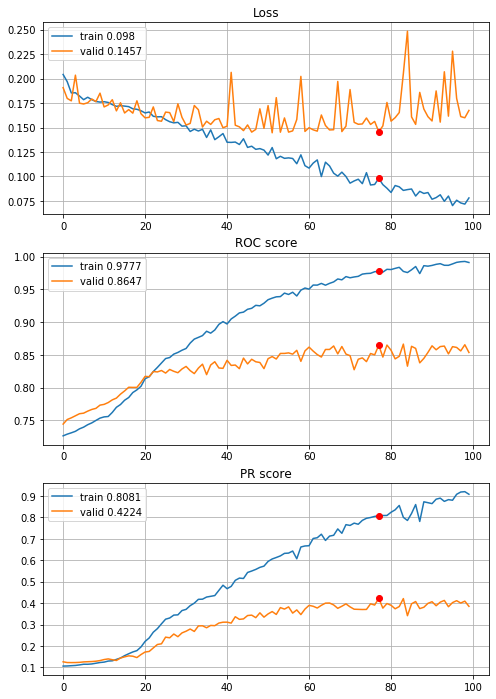


Fold 2------------------------------------------------------------


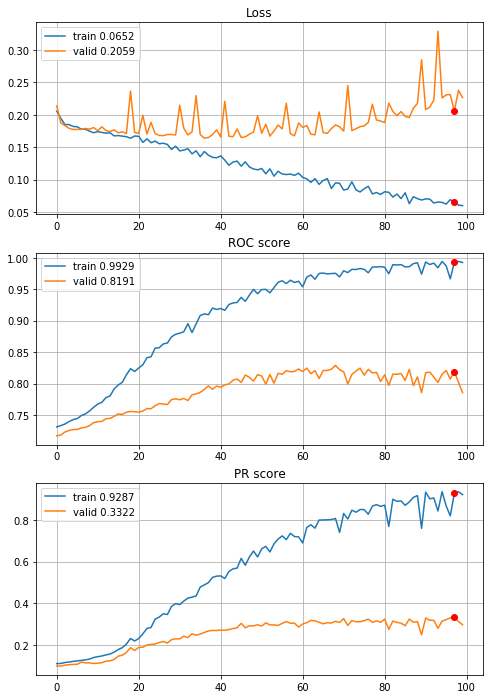


Fold 3------------------------------------------------------------


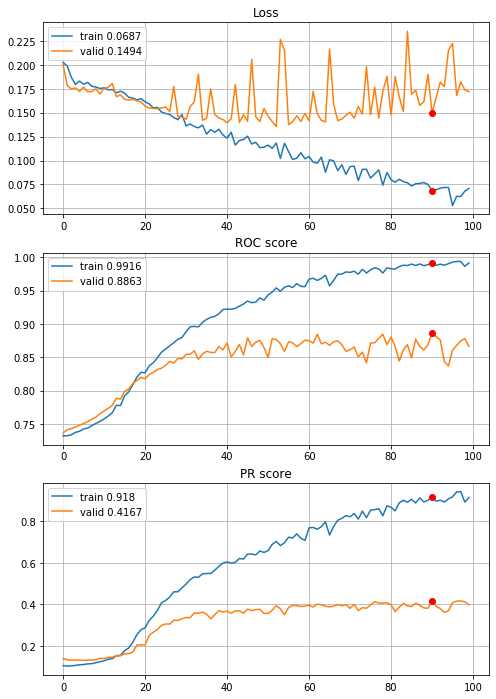


Fold 4------------------------------------------------------------


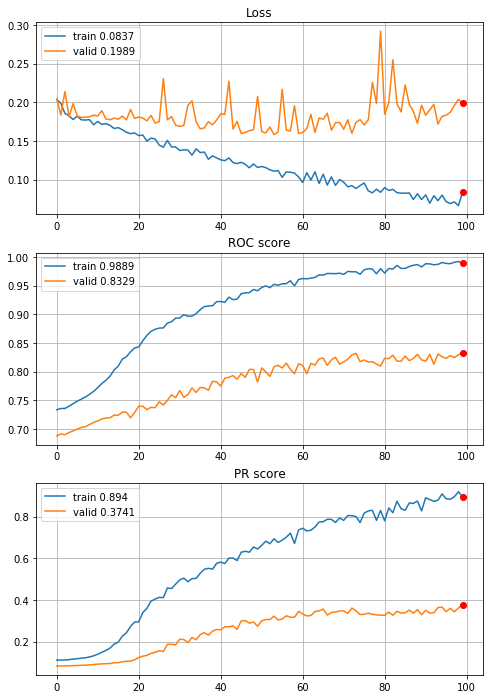


Fold 5------------------------------------------------------------


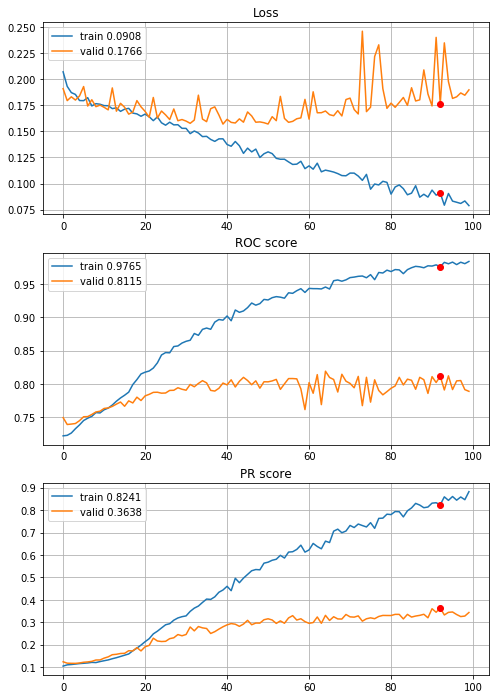


Fold 6------------------------------------------------------------


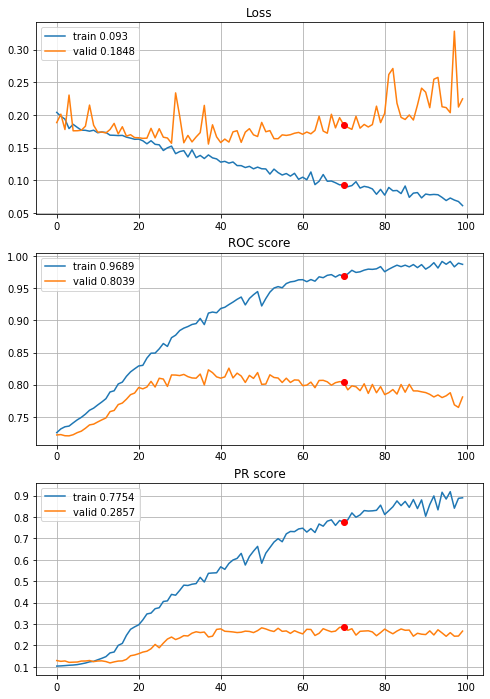

In [46]:
# first CNN with quantile clipping (Q_0.005, Q_0.995), power transform and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Another improvement PR +0.085 and bigger overfitting, learning curves are not so pretty. The most complex preprocessing pipeline tends to be the best one. Lets find the best architecture :)

But first, lets create and save images drafts for folds and see some results.

In [47]:
# drafts computation

# CV sets
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
# drafts lists initialization
drafts_ini=[]
drafts_opti=[]

# CV loop
for fold in range(len(train_folds)):
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    # ----- Monte Carlo energy optimization -----
    # correlation matrix for non bankrupt observations
    corr_matrix_fold=X_train_fold[Y_train_fold==0].corr(method="spearman")
    # draft inicialization
    draft_fold_ini=image_draft_inicialization(features, random_state)
    # quasi optimization
    draft_fold_opti=MC_Energy_optimization(corr_matrix=corr_matrix_fold, draft=draft_fold_ini, alpha=3, n_eval=100,
                                           random_state=random_state)
    # transform draft dictionary to matrix
    draft_fold_ini=image_dict_to_matrix(draft_fold_ini)
    draft_fold_opti=image_dict_to_matrix(draft_fold_opti)
    
    drafts_ini.append(draft_fold_ini)
    drafts_opti.append(draft_fold_opti)
    
drafts=dict(zip(["initial_drafts", "optimized_drafts"], [drafts_ini, drafts_opti]))

# saving drafts
with open(r"data\3year_data\drafts_8x8.p", "wb") as fp:
    pickle.dump(drafts, fp)

initial image energy: 12328.4177
iteration: 100
current energy: 10900.3115
iteration: 200
current energy: 9950.8215
iteration: 300
current energy: 9386.3959
iteration: 400
current energy: 9143.7604
iteration: 500
current energy: 8914.5153
iteration: 600
current energy: 8891.0764
iteration: 700
current energy: 8797.0886
iteration: 800
current energy: 8793.8945
iteration: 900
current energy: 8702.7769
iteration: 1000
current energy: 8663.8132
iteration: 1100
current energy: 8640.6085
iteration: 1200
current energy: 8614.7806
iteration: 1300
current energy: 8523.3884
iteration: 1400
current energy: 8484.8565
iteration: 1500
current energy: 8476.9028
iteration: 1600
current energy: 8419.8383
iteration: 1700
current energy: 8346.6664
iteration: 1800
current energy: 8328.398
iteration: 1900
current energy: 8243.8745
iteration: 2000
current energy: 8163.6458
iteration: 2100
current energy: 8160.7116
iteration: 2200
current energy: 8159.7088
iteration: 2300
current energy: 8159.7088
iteration:

In [40]:
# loading 8x8 drafts
with open(r"data\3year_data\drafts_8x8.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

			 Normalization only

			----- FOLD 1 -----


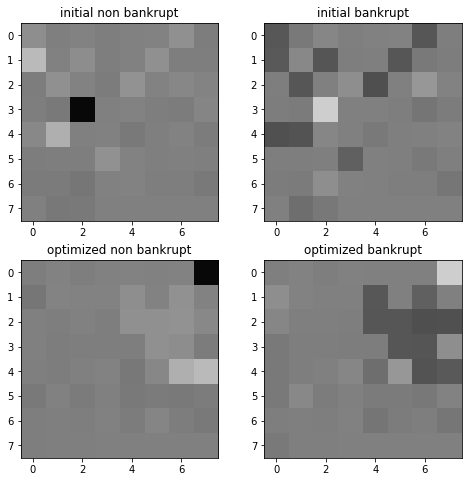


			----- FOLD 2 -----


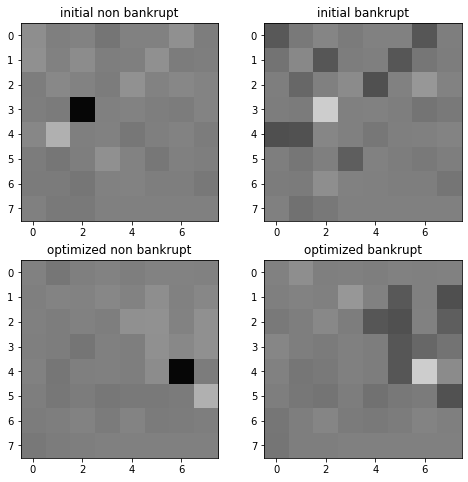


			----- FOLD 3 -----


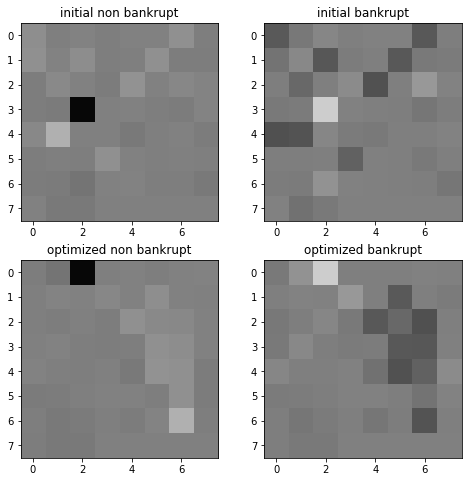


			----- FOLD 4 -----


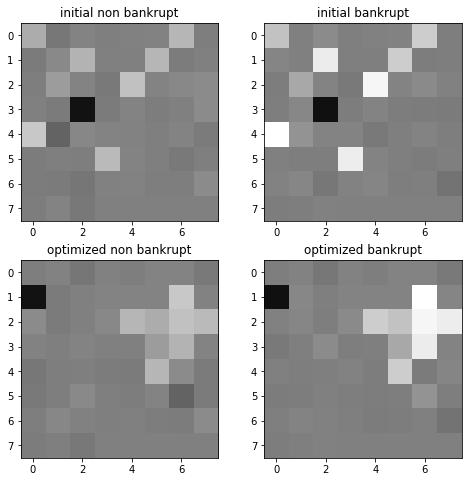


			----- FOLD 5 -----


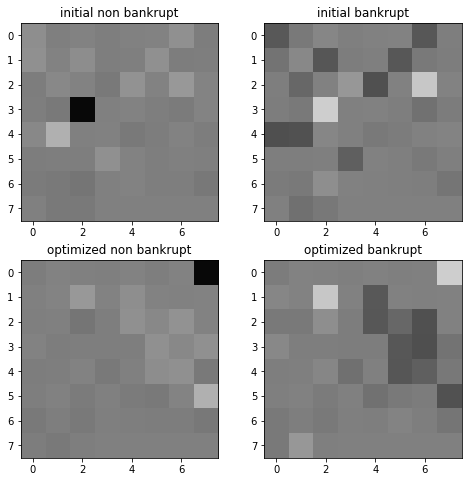


			----- FOLD 6 -----


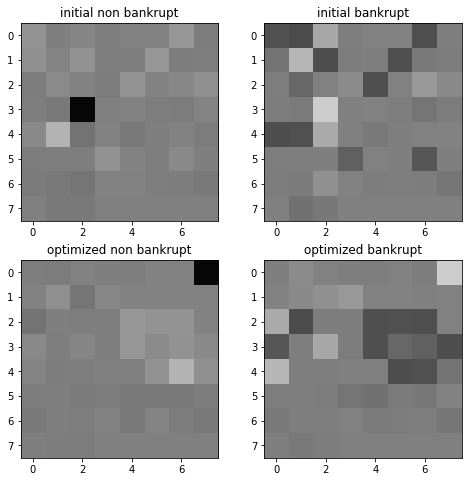

In [41]:
# printing images with normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t----- FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization and quantile clipping

			-----FOLD 1 -----


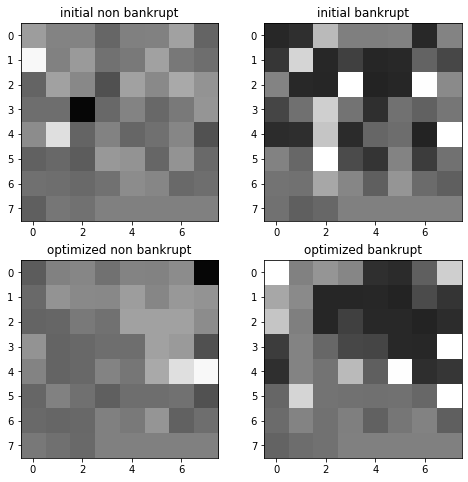


			-----FOLD 2 -----


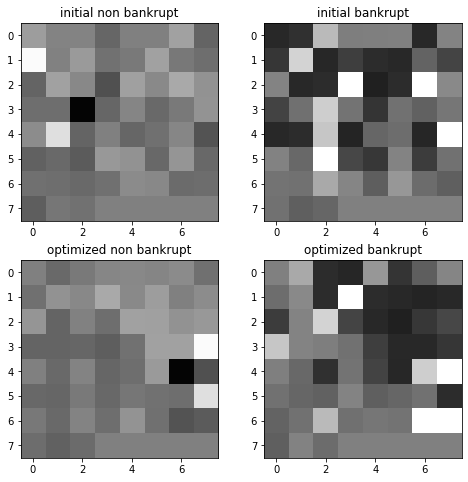


			-----FOLD 3 -----


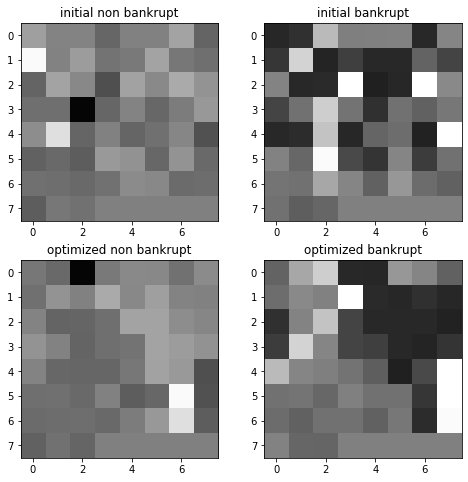


			-----FOLD 4 -----


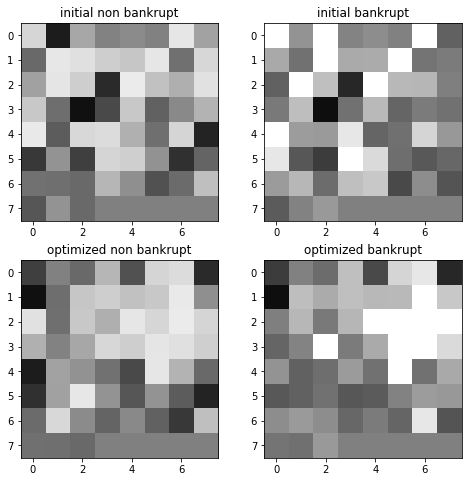


			-----FOLD 5 -----


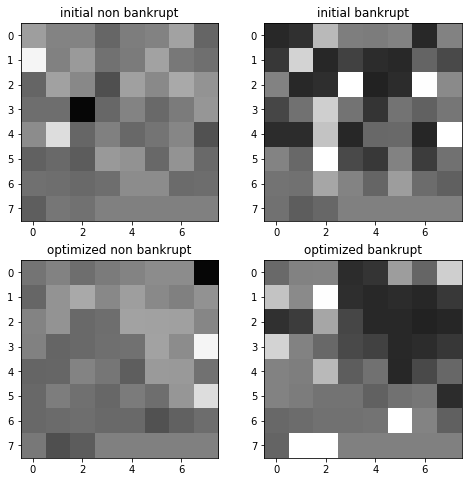


			-----FOLD 6 -----


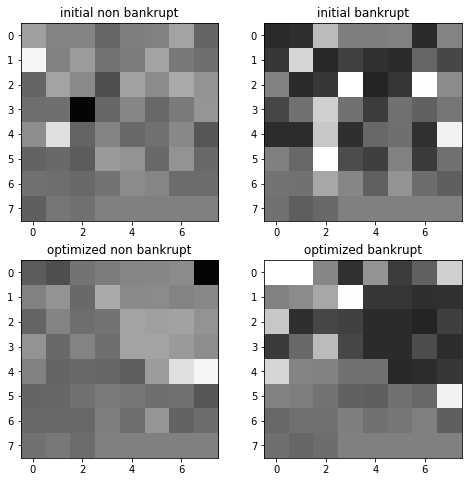

In [42]:
# printing images for normalization with quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t\t Normalization and quantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


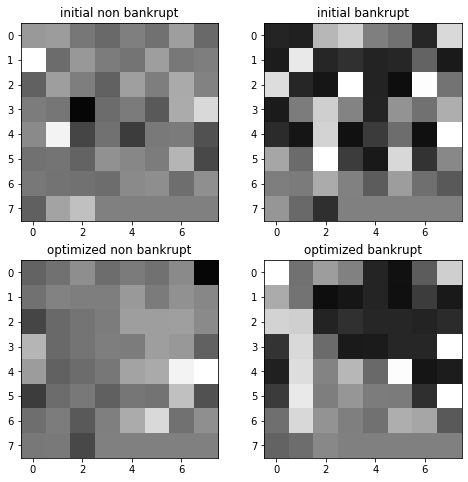


			-----FOLD 2 -----


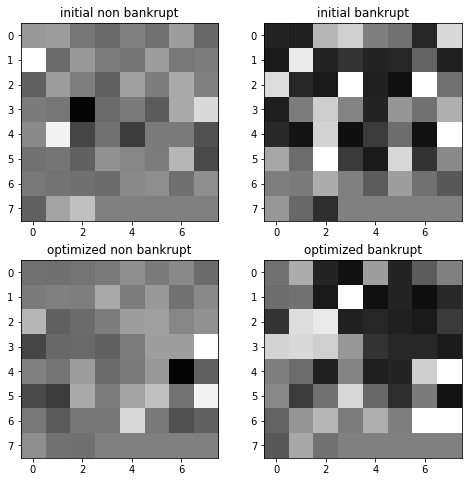


			-----FOLD 3 -----


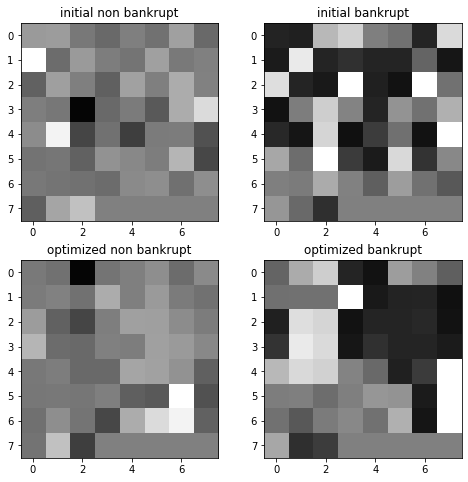


			-----FOLD 4 -----


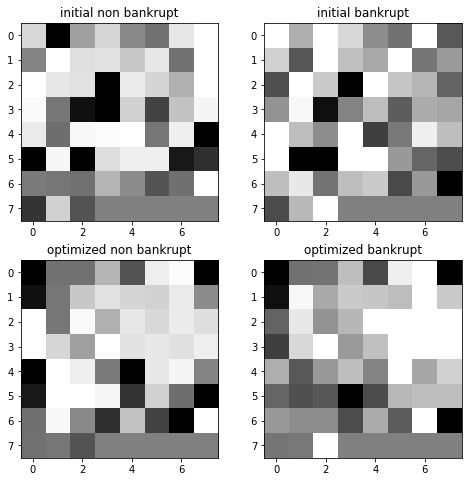


			-----FOLD 5 -----


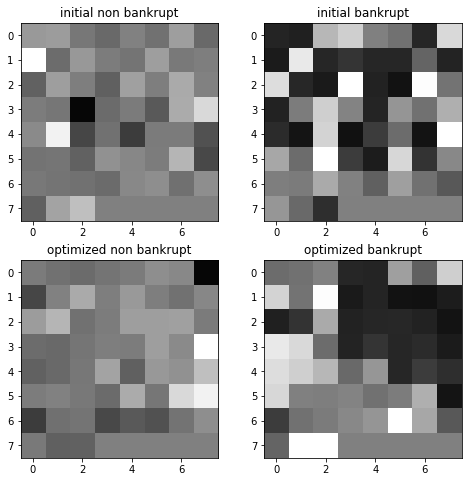


			-----FOLD 6 -----


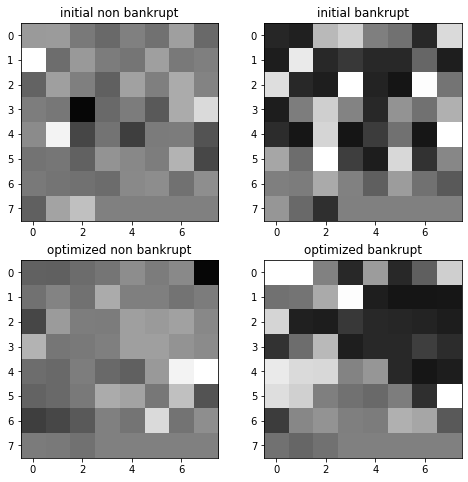

In [43]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

Same conclusions as for 1 and 2 year horizons

Lets start experiments with model architecture, first define inception module.

In [44]:
def inception_module(prev_layer, f1, f2_in, f2_out, f3_in, f3_out, f4_out, random_state=random_state):
    
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    
    conv1x1 = layers.Conv2D(filters=f1, kernel_size=(1,1), strides=(1,1), padding="same",
                             activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_out, kernel_size=(3,3), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv3x3)
    conv5x5 = layers.Conv2D(filters=f3_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv5x5 = layers.Conv2D(filters=f3_out, kernel_size=(5,5), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv5x5)
    max_pool = layers.MaxPooling2D(pool_size=(3,3), strides=(1,1), padding="same")(prev_layer)
    max_pool = layers.Conv2D(filters=f4_out, kernel_size=(1,1), strides=(1,1), padding="valid",
                             activation=activations.relu, use_bias=True)(max_pool)
    inception = layers.concatenate([conv1x1, conv3x3, conv5x5, max_pool], axis=-1)
    
    return inception

def define_deep_CNN_2inc_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/100,
cumulative time: 3.54s train loss: 0.24489965871422953, validation loss: 0.19346101209521294
Epoch: 2/100,
cumulative time: 4.91s train loss: 0.18852338757897585, validation loss: 0.18297018110752106
Epoch: 3/100,
cumulative time: 6.24s train loss: 0.18456913345035048, validation loss: 0.18076718226075172
Epoch: 4/100,
cumulative time: 7.55s train loss: 0.18281837900530087, validation loss: 0.17852120473980904
Epoch: 5/100,
cumulative time: 8.87s train loss: 0.1806694393974685, validation loss: 0.1763756424188614
Epoch: 6/100,
cumulative time: 10.21s train loss: 0.1794477404053136, validation loss: 0.1742098592221737
Epoch: 7/100,
cumulative time: 11.53s train loss: 0.17754093704034737, validation loss: 0.17248672246932983
Epoch: 8/100,
cumulative time: 12.85s train loss: 0.17701106666837507, validation loss: 0.1724262423813343
Epoch: 9/100,
cumulative time: 14.2s train loss: 0.1764618255739105

Epoch: 76/100,
cumulative time: 102.72s train loss: 0.15695451927660323, validation loss: 0.1581932120025158
Epoch: 77/100,
cumulative time: 104.04s train loss: 0.1599879680346147, validation loss: 0.15867227874696255
Epoch: 78/100,
cumulative time: 105.35s train loss: 0.1618533638897676, validation loss: 0.1588548682630062
Epoch: 79/100,
cumulative time: 106.65s train loss: 0.15536845795556697, validation loss: 0.16254226863384247
Epoch: 80/100,
cumulative time: 107.98s train loss: 0.15573051985998393, validation loss: 0.15822202898561954
Epoch: 81/100,
cumulative time: 109.32s train loss: 0.15454611994057454, validation loss: 0.158189220353961
Epoch: 82/100,
cumulative time: 110.66s train loss: 0.15339014583270583, validation loss: 0.15737407840788364
Epoch: 83/100,
cumulative time: 111.97s train loss: 0.15367772990961617, validation loss: 0.15866651944816113
Epoch: 84/100,
cumulative time: 113.28s train loss: 0.1537302611495045, validation loss: 0.15738121047616005
Epoch: 85/100,
cu

Epoch: 49/100,
cumulative time: 66.63s train loss: 0.1657171920017581, validation loss: 0.1715024597942829
Epoch: 50/100,
cumulative time: 67.93s train loss: 0.16510946773571553, validation loss: 0.1711786612868309
Epoch: 51/100,
cumulative time: 69.22s train loss: 0.1663489544763215, validation loss: 0.17084447667002678
Epoch: 52/100,
cumulative time: 70.51s train loss: 0.16496847968202305, validation loss: 0.1777878850698471
Epoch: 53/100,
cumulative time: 71.8s train loss: 0.16572878448270856, validation loss: 0.17033622041344643
Epoch: 54/100,
cumulative time: 73.08s train loss: 0.16356461343425008, validation loss: 0.1707594208419323
Epoch: 55/100,
cumulative time: 74.39s train loss: 0.16448904791683217, validation loss: 0.16995495930314064
Epoch: 56/100,
cumulative time: 75.68s train loss: 0.16238309689331562, validation loss: 0.17065728083252907
Epoch: 57/100,
cumulative time: 76.98s train loss: 0.16217236861079523, validation loss: 0.1703663244843483
Epoch: 58/100,
cumulative t

Epoch: 22/100,
cumulative time: 31.1s train loss: 0.17402329050610782, validation loss: 0.17367497635266138
Epoch: 23/100,
cumulative time: 32.41s train loss: 0.17301505070070453, validation loss: 0.17186549099664838
Epoch: 24/100,
cumulative time: 33.72s train loss: 0.1738102459069117, validation loss: 0.17097256802377248
Epoch: 25/100,
cumulative time: 35.04s train loss: 0.17309919607106602, validation loss: 0.1709371301957539
Epoch: 26/100,
cumulative time: 36.35s train loss: 0.17350302382185628, validation loss: 0.17261837241195496
Epoch: 27/100,
cumulative time: 37.65s train loss: 0.17252215752712705, validation loss: 0.1714675072355876
Epoch: 28/100,
cumulative time: 38.96s train loss: 0.17272116425067047, validation loss: 0.17083871581251658
Epoch: 29/100,
cumulative time: 40.26s train loss: 0.17235431258404815, validation loss: 0.1703504035302571
Epoch: 30/100,
cumulative time: 41.72s train loss: 0.1726866955285419, validation loss: 0.17030824476764317
Epoch: 31/100,
cumulative

Epoch: 98/100,
cumulative time: 131.66s train loss: 0.14078721306840675, validation loss: 0.14976824430246202
Epoch: 99/100,
cumulative time: 132.98s train loss: 0.140388484622858, validation loss: 0.15143132127466655
Epoch: 100/100,
cumulative time: 134.29s train loss: 0.14145406397735616, validation loss: 0.15817248484444996

Early stopping results:
best results in epoch: 99, 
best valid PR: 0.29008865942608963, 
valid ROC: 0.8357851522408485        
overfitting PR: 0.12441554625479812, 
overfitting ROC: 0.029989792942268223

----------
Fold: 4
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/100,
cumulative time: 3.37s train loss: 0.25446912385045656, validation loss: 0.19848131473102268
Epoch: 2/100,
cumulative time: 4.71s train loss: 0.18677786638269997, validation loss: 0.18803688678476546
Epoch: 3/100,
cumulative time: 6.03s train loss: 0.18421046973841132, validation loss: 0.18656109017039102
Epoch: 4/100,
cumulative time: 7.37s train loss: 0.1821092614156576

Epoch: 72/100,
cumulative time: 99.03s train loss: 0.15156187356592843, validation loss: 0.17909471003782182
Epoch: 73/100,
cumulative time: 100.38s train loss: 0.15170168479006196, validation loss: 0.17928188720392801
Epoch: 74/100,
cumulative time: 101.71s train loss: 0.1508995858703877, validation loss: 0.17798527008011228
Epoch: 75/100,
cumulative time: 103.06s train loss: 0.15219338414170225, validation loss: 0.18156211063029273
Epoch: 76/100,
cumulative time: 104.39s train loss: 0.15016218635679365, validation loss: 0.1790773218018668
Epoch: 77/100,
cumulative time: 105.74s train loss: 0.1504291101157007, validation loss: 0.18349481881610932
Epoch: 78/100,
cumulative time: 107.07s train loss: 0.15107347695063528, validation loss: 0.1823863042725457
Epoch: 79/100,
cumulative time: 108.41s train loss: 0.15500660939266253, validation loss: 0.19186471073400407
Epoch: 80/100,
cumulative time: 109.75s train loss: 0.15280842332726766, validation loss: 0.17964073719486356
Epoch: 81/100,


Epoch: 45/100,
cumulative time: 63.61s train loss: 0.16103989894361048, validation loss: 0.16565393348534901
Epoch: 46/100,
cumulative time: 64.98s train loss: 0.1600424683690298, validation loss: 0.16536413540915837
Epoch: 47/100,
cumulative time: 66.32s train loss: 0.15956129340278297, validation loss: 0.165076690789253
Epoch: 48/100,
cumulative time: 67.69s train loss: 0.15861561726052795, validation loss: 0.1648008103786953
Epoch: 49/100,
cumulative time: 69.07s train loss: 0.15772698639166208, validation loss: 0.16468247505407485
Epoch: 50/100,
cumulative time: 70.42s train loss: 0.1582099572249713, validation loss: 0.16682107824181752
Epoch: 51/100,
cumulative time: 71.81s train loss: 0.1578477967265174, validation loss: 0.165305807656712
Epoch: 52/100,
cumulative time: 73.17s train loss: 0.15871975353651882, validation loss: 0.17055280690155333
Epoch: 53/100,
cumulative time: 74.54s train loss: 0.15808734753281087, validation loss: 0.16493171624721042
Epoch: 54/100,
cumulative t

Epoch: 18/100,
cumulative time: 26.43s train loss: 0.17386542181761658, validation loss: 0.17472241399780153
Epoch: 19/100,
cumulative time: 27.89s train loss: 0.17355624725480545, validation loss: 0.17461097445752885
Epoch: 20/100,
cumulative time: 29.41s train loss: 0.17364765345384373, validation loss: 0.1751539652404331
Epoch: 21/100,
cumulative time: 30.79s train loss: 0.1729504574906997, validation loss: 0.1743614649772644
Epoch: 22/100,
cumulative time: 32.17s train loss: 0.173132872948856, validation loss: 0.17447723089702546
Epoch: 23/100,
cumulative time: 33.55s train loss: 0.17256517666305127, validation loss: 0.17428636695657457
Epoch: 24/100,
cumulative time: 34.95s train loss: 0.1735316336049001, validation loss: 0.17427964115899708
Epoch: 25/100,
cumulative time: 36.33s train loss: 0.17190664007614692, validation loss: 0.1778004851606157
Epoch: 26/100,
cumulative time: 37.74s train loss: 0.17289334254865948, validation loss: 0.17388543060847692
Epoch: 27/100,
cumulative 

Epoch: 94/100,
cumulative time: 130.36s train loss: 0.1471761061698936, validation loss: 0.15875378585050975
Epoch: 95/100,
cumulative time: 131.71s train loss: 0.1476709568607969, validation loss: 0.15853725411589184
Epoch: 96/100,
cumulative time: 133.15s train loss: 0.14835810676449762, validation loss: 0.16086521504417298
Epoch: 97/100,
cumulative time: 134.5s train loss: 0.1463917164753669, validation loss: 0.1574070035654401
Epoch: 98/100,
cumulative time: 135.85s train loss: 0.14426931655617312, validation loss: 0.15772737510620602
Epoch: 99/100,
cumulative time: 137.21s train loss: 0.14766224109840465, validation loss: 0.1569953885911003
Epoch: 100/100,
cumulative time: 138.56s train loss: 0.14380297608464537, validation loss: 0.15741341497216907

Early stopping results:
best results in epoch: 98, 
best valid PR: 0.25519269292779384, 
valid ROC: 0.8138358211642689        
overfitting PR: 0.0992964171013957, 
overfitting ROC: 0.047548566384093216

Cross validation time: 864s
ROC

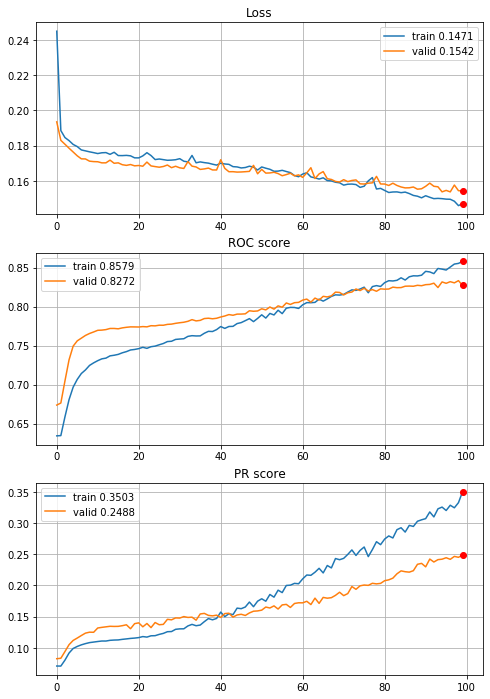


Fold 2------------------------------------------------------------


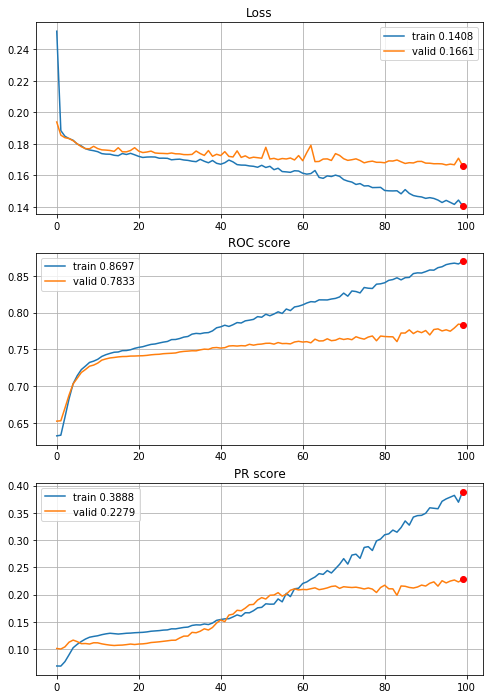


Fold 3------------------------------------------------------------


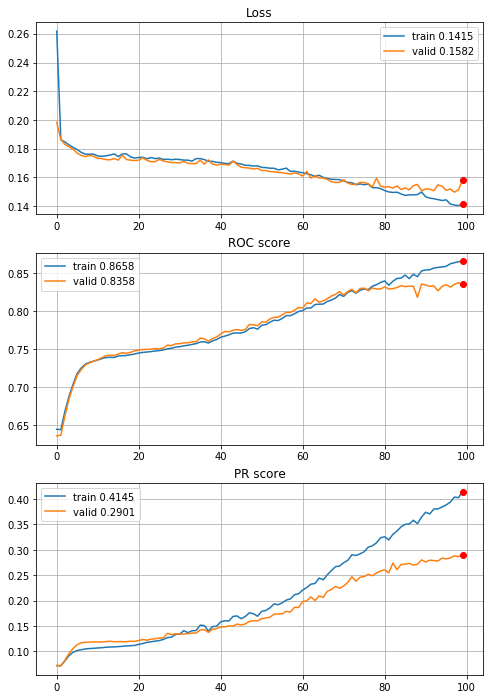


Fold 4------------------------------------------------------------


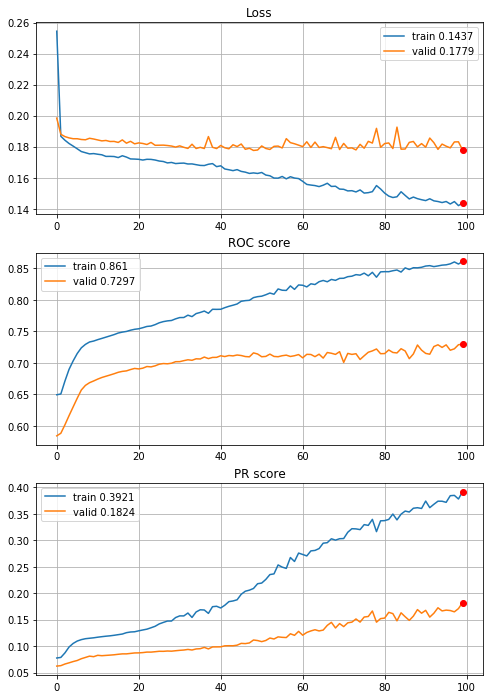


Fold 5------------------------------------------------------------


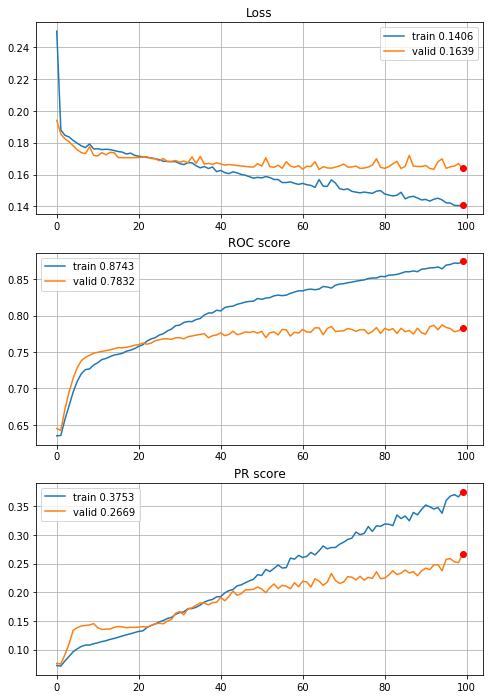


Fold 6------------------------------------------------------------


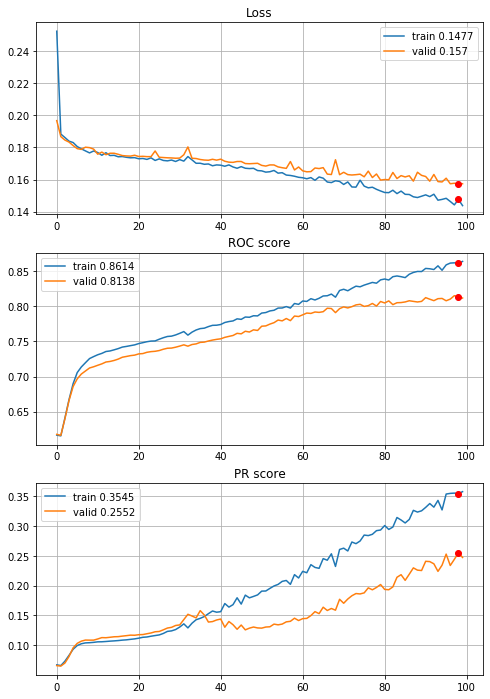

In [53]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

The results are worse, but learning curves are much smoother and they're have very big positive slope, more epochs definitely needed. 600.


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/600,
cumulative time: 3.91s train loss: 0.2529489894077341, validation loss: 0.19805360212922096
Epoch: 2/600,
cumulative time: 5.32s train loss: 0.18977786901791488, validation loss: 0.1840144731104374
Epoch: 3/600,
cumulative time: 6.69s train loss: 0.1849143246237005, validation loss: 0.18115904927253723
Epoch: 4/600,
cumulative time: 8.12s train loss: 0.1831840156237446, validation loss: 0.1792920008301735
Epoch: 5/600,
cumulative time: 9.5s train loss: 0.1811422889095808, validation loss: 0.17701756954193115
Epoch: 6/600,
cumulative time: 10.85s train loss: 0.17982839592796343, validation loss: 0.17469975352287292
Epoch: 7/600,
cumulative time: 12.21s train loss: 0.1778356189645142, validation loss: 0.17295436561107635
Epoch: 8/600,
cumulative time: 13.59s train loss: 0.17726068346632987, validation loss: 0.1727459542453289
Epoch: 9/600,
cumulative time: 14.94s train loss: 0.17670442652072685, 

Epoch: 77/600,
cumulative time: 107.48s train loss: 0.16091431023476388, validation loss: 0.1587854716926813
Epoch: 78/600,
cumulative time: 108.84s train loss: 0.16244589398889872, validation loss: 0.15925719775259495
Epoch: 79/600,
cumulative time: 110.2s train loss: 0.15595870641371876, validation loss: 0.162986371666193
Epoch: 80/600,
cumulative time: 111.56s train loss: 0.15688998766201834, validation loss: 0.15875530242919922
Epoch: 81/600,
cumulative time: 112.91s train loss: 0.15551014847716685, validation loss: 0.15883577056229115
Epoch: 82/600,
cumulative time: 114.28s train loss: 0.15448450657726848, validation loss: 0.15865918062627316
Epoch: 83/600,
cumulative time: 115.64s train loss: 0.1548554234494256, validation loss: 0.15939968451857567
Epoch: 84/600,
cumulative time: 117.0s train loss: 0.15506099535501386, validation loss: 0.1583024188876152
Epoch: 85/600,
cumulative time: 118.37s train loss: 0.15453136264672432, validation loss: 0.1577626895159483
Epoch: 86/600,
cum

Epoch: 152/600,
cumulative time: 210.17s train loss: 0.12424168703768264, validation loss: 0.1575506366789341
Epoch: 153/600,
cumulative time: 211.53s train loss: 0.12331818416525471, validation loss: 0.15190990641713142
Epoch: 154/600,
cumulative time: 212.89s train loss: 0.12391295203529469, validation loss: 0.15515718422830105
Epoch: 155/600,
cumulative time: 214.28s train loss: 0.12428578297352658, validation loss: 0.15671540796756744
Epoch: 156/600,
cumulative time: 215.64s train loss: 0.12338412717484229, validation loss: 0.15861377865076065
Epoch: 157/600,
cumulative time: 217.0s train loss: 0.1240740572800032, validation loss: 0.1575101874768734
Epoch: 158/600,
cumulative time: 218.36s train loss: 0.12310364712247272, validation loss: 0.15651443228125572
Epoch: 159/600,
cumulative time: 219.71s train loss: 0.12215642434288972, validation loss: 0.15873080119490623
Epoch: 160/600,
cumulative time: 221.07s train loss: 0.1208400299849245, validation loss: 0.15367711335420609
Epoch:

Epoch: 227/600,
cumulative time: 317.11s train loss: 0.09207298995150322, validation loss: 0.18530604243278503
Epoch: 228/600,
cumulative time: 318.64s train loss: 0.09470593978671206, validation loss: 0.15946313738822937
Epoch: 229/600,
cumulative time: 320.1s train loss: 0.08848054354670781, validation loss: 0.16410909220576286
Epoch: 230/600,
cumulative time: 321.53s train loss: 0.0881082675471304, validation loss: 0.16134246066212654
Epoch: 231/600,
cumulative time: 322.96s train loss: 0.08877765361282079, validation loss: 0.1760755591094494
Epoch: 232/600,
cumulative time: 324.38s train loss: 0.08666998079853533, validation loss: 0.1652836836874485
Epoch: 233/600,
cumulative time: 325.81s train loss: 0.08512901657423191, validation loss: 0.17377003654837608
Epoch: 234/600,
cumulative time: 327.24s train loss: 0.0859652752441734, validation loss: 0.16509481519460678
Epoch: 235/600,
cumulative time: 328.66s train loss: 0.0846801498595487, validation loss: 0.16251782700419426
Epoch: 

Epoch: 302/600,
cumulative time: 426.61s train loss: 0.07343705094321511, validation loss: 0.21068835258483887
Epoch: 303/600,
cumulative time: 428.06s train loss: 0.06630722432004249, validation loss: 0.19865339249372482
Epoch: 304/600,
cumulative time: 429.52s train loss: 0.06588655330880212, validation loss: 0.19012418016791344
Epoch: 305/600,
cumulative time: 431.09s train loss: 0.06181838956920249, validation loss: 0.19855482876300812
Epoch: 306/600,
cumulative time: 432.6s train loss: 0.069712937287816, validation loss: 0.22199053317308426
Epoch: 307/600,
cumulative time: 434.27s train loss: 0.07043175045126522, validation loss: 0.20011786743998528
Epoch: 308/600,
cumulative time: 435.74s train loss: 0.060568894494236, validation loss: 0.1954084262251854
Epoch: 309/600,
cumulative time: 437.18s train loss: 0.0598399331991846, validation loss: 0.19805153459310532
Epoch: 310/600,
cumulative time: 438.61s train loss: 0.05929269301461471, validation loss: 0.1999879740178585
Epoch: 31

Epoch: 376/600,
cumulative time: 532.75s train loss: 0.05003507317830428, validation loss: 0.2357422038912773
Epoch: 377/600,
cumulative time: 534.15s train loss: 0.04181135607454803, validation loss: 0.23614979162812233
Epoch: 378/600,
cumulative time: 535.5s train loss: 0.04381975827624179, validation loss: 0.24087250605225563
Epoch: 379/600,
cumulative time: 536.86s train loss: 0.042415961198444416, validation loss: 0.23966959491372108
Epoch: 380/600,
cumulative time: 538.24s train loss: 0.04500982383906523, validation loss: 0.2438492737710476
Epoch: 381/600,
cumulative time: 539.61s train loss: 0.04110518971684168, validation loss: 0.2520500048995018
Epoch: 382/600,
cumulative time: 540.99s train loss: 0.040930571250235324, validation loss: 0.24516190215945244
Epoch: 383/600,
cumulative time: 542.35s train loss: 0.04207231220635531, validation loss: 0.2417951636016369
Epoch: 384/600,
cumulative time: 543.72s train loss: 0.04079605849746401, validation loss: 0.24431553110480309
Epoc

Epoch: 451/600,
cumulative time: 643.36s train loss: 0.028662116069785602, validation loss: 0.290496289730072
Epoch: 452/600,
cumulative time: 644.75s train loss: 0.02829781437288911, validation loss: 0.2870008833706379
Epoch: 453/600,
cumulative time: 646.13s train loss: 0.029240637468036932, validation loss: 0.3000868111848831
Epoch: 454/600,
cumulative time: 647.51s train loss: 0.030974727325234135, validation loss: 0.29067591577768326
Epoch: 455/600,
cumulative time: 648.86s train loss: 0.030962066621311034, validation loss: 0.2903972491621971
Epoch: 456/600,
cumulative time: 650.32s train loss: 0.02758860840793716, validation loss: 0.30658644437789917
Epoch: 457/600,
cumulative time: 651.89s train loss: 0.026786873727486317, validation loss: 0.28991805389523506
Epoch: 458/600,
cumulative time: 653.26s train loss: 0.02756915205035788, validation loss: 0.303038589656353
Epoch: 459/600,
cumulative time: 654.64s train loss: 0.027801447683248107, validation loss: 0.30108049511909485
Ep

Epoch: 525/600,
cumulative time: 752.75s train loss: 0.02036519092022843, validation loss: 0.3554656133055687
Epoch: 526/600,
cumulative time: 754.26s train loss: 0.01866717479031376, validation loss: 0.3627361133694649
Epoch: 527/600,
cumulative time: 755.74s train loss: 0.01810333917131236, validation loss: 0.36037804186344147
Epoch: 528/600,
cumulative time: 757.11s train loss: 0.018255123998894115, validation loss: 0.35810288041830063
Epoch: 529/600,
cumulative time: 758.54s train loss: 0.020889077081126025, validation loss: 0.35285867750644684
Epoch: 530/600,
cumulative time: 759.98s train loss: 0.025284012344676705, validation loss: 0.346743680536747
Epoch: 531/600,
cumulative time: 761.4s train loss: 0.021715621804982165, validation loss: 0.3570503443479538
Epoch: 532/600,
cumulative time: 762.83s train loss: 0.02016918867360091, validation loss: 0.3758498877286911
Epoch: 533/600,
cumulative time: 764.25s train loss: 0.01843279641814087, validation loss: 0.37822674959897995
Epoc

Epoch: 599/600,
cumulative time: 861.55s train loss: 0.025130024292388503, validation loss: 0.4051506370306015
Epoch: 600/600,
cumulative time: 862.94s train loss: 0.01639691725067715, validation loss: 0.41809359192848206

Early stopping results:
best results in epoch: 261, 
best valid PR: 0.38262075288503405, 
valid ROC: 0.8343649908230467        
overfitting PR: 0.38810991783597903, 
overfitting ROC: 0.13338283587290256

----------
Fold: 2
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/600,
cumulative time: 3.58s train loss: 0.2514865234335284, validation loss: 0.19385064020752907
Epoch: 2/600,
cumulative time: 5.15s train loss: 0.18837966931129604, validation loss: 0.18548646196722984
Epoch: 3/600,
cumulative time: 6.68s train loss: 0.18478887407473346, validation loss: 0.18387511372566223
Epoch: 4/600,
cumulative time: 8.13s train loss: 0.18332203189852336, validation loss: 0.18336140364408493
Epoch: 5/600,
cumulative time: 9.79s train loss: 0.18222907605571997

Epoch: 73/600,
cumulative time: 109.44s train loss: 0.15523422959720865, validation loss: 0.1697997823357582
Epoch: 74/600,
cumulative time: 110.84s train loss: 0.1537176235193465, validation loss: 0.1706237904727459
Epoch: 75/600,
cumulative time: 112.24s train loss: 0.15426492196668096, validation loss: 0.16957340762019157
Epoch: 76/600,
cumulative time: 113.64s train loss: 0.15279963595339524, validation loss: 0.16804776340723038
Epoch: 77/600,
cumulative time: 115.05s train loss: 0.15296521500214638, validation loss: 0.168929785490036
Epoch: 78/600,
cumulative time: 116.46s train loss: 0.15176859055681238, validation loss: 0.169265728443861
Epoch: 79/600,
cumulative time: 117.87s train loss: 0.15169872881049065, validation loss: 0.1682172454893589
Epoch: 80/600,
cumulative time: 119.26s train loss: 0.15185684616899298, validation loss: 0.16835381835699081
Epoch: 81/600,
cumulative time: 120.65s train loss: 0.14997239861733844, validation loss: 0.16813747212290764
Epoch: 82/600,
cum

Epoch: 148/600,
cumulative time: 216.88s train loss: 0.12230431927777656, validation loss: 0.1668426264077425
Epoch: 149/600,
cumulative time: 218.27s train loss: 0.11919765230769612, validation loss: 0.1633661352097988
Epoch: 150/600,
cumulative time: 219.7s train loss: 0.11821250306653334, validation loss: 0.16541697457432747
Epoch: 151/600,
cumulative time: 221.13s train loss: 0.11806925844425717, validation loss: 0.16334502398967743
Epoch: 152/600,
cumulative time: 222.52s train loss: 0.11632682190457838, validation loss: 0.16425411775708199
Epoch: 153/600,
cumulative time: 223.91s train loss: 0.11578789544459707, validation loss: 0.16487632878124714
Epoch: 154/600,
cumulative time: 225.31s train loss: 0.11835304609655486, validation loss: 0.16552294045686722
Epoch: 155/600,
cumulative time: 226.72s train loss: 0.11656664810230914, validation loss: 0.16845902428030968
Epoch: 156/600,
cumulative time: 228.11s train loss: 0.11566665450204684, validation loss: 0.16455958783626556
Epoc

Epoch: 223/600,
cumulative time: 323.89s train loss: 0.09038907906003656, validation loss: 0.1759220026433468
Epoch: 224/600,
cumulative time: 325.48s train loss: 0.0939310786223021, validation loss: 0.17833836004137993
Epoch: 225/600,
cumulative time: 327.04s train loss: 0.09366695103157499, validation loss: 0.17208389937877655
Epoch: 226/600,
cumulative time: 328.6s train loss: 0.09210397542344095, validation loss: 0.18009954318404198
Epoch: 227/600,
cumulative time: 330.16s train loss: 0.08955167612527275, validation loss: 0.1821921542286873
Epoch: 228/600,
cumulative time: 331.81s train loss: 0.08928403237322795, validation loss: 0.17741714417934418
Epoch: 229/600,
cumulative time: 333.37s train loss: 0.0863600292272862, validation loss: 0.1745714582502842
Epoch: 230/600,
cumulative time: 334.96s train loss: 0.08908527773469611, validation loss: 0.1787273958325386
Epoch: 231/600,
cumulative time: 336.53s train loss: 0.08903898093461567, validation loss: 0.17653661966323853
Epoch: 2

Epoch: 298/600,
cumulative time: 432.08s train loss: 0.06844869352699295, validation loss: 0.21420849114656448
Epoch: 299/600,
cumulative time: 433.5s train loss: 0.06947728063307661, validation loss: 0.1975722424685955
Epoch: 300/600,
cumulative time: 435.0s train loss: 0.06478490222599254, validation loss: 0.19904666393995285
Epoch: 301/600,
cumulative time: 436.49s train loss: 0.06391335914830014, validation loss: 0.20307714864611626
Epoch: 302/600,
cumulative time: 438.06s train loss: 0.06832068393535727, validation loss: 0.20747393369674683
Epoch: 303/600,
cumulative time: 439.64s train loss: 0.06942212422708983, validation loss: 0.20296141505241394
Epoch: 304/600,
cumulative time: 441.42s train loss: 0.06507842185012637, validation loss: 0.2032340131700039
Epoch: 305/600,
cumulative time: 443.0s train loss: 0.0625901047713627, validation loss: 0.2053033486008644
Epoch: 306/600,
cumulative time: 444.45s train loss: 0.06286164076498403, validation loss: 0.205766923725605
Epoch: 307

Epoch: 372/600,
cumulative time: 534.78s train loss: 0.04378642519125256, validation loss: 0.23574155569076538
Epoch: 373/600,
cumulative time: 536.12s train loss: 0.047652330912683685, validation loss: 0.23426302894949913
Epoch: 374/600,
cumulative time: 537.46s train loss: 0.048317916908406894, validation loss: 0.23772195354104042
Epoch: 375/600,
cumulative time: 538.8s train loss: 0.04674818448546409, validation loss: 0.23339690268039703
Epoch: 376/600,
cumulative time: 540.14s train loss: 0.043876160856160404, validation loss: 0.234520111232996
Epoch: 377/600,
cumulative time: 541.48s train loss: 0.04288774712598675, validation loss: 0.24300071224570274
Epoch: 378/600,
cumulative time: 542.82s train loss: 0.04108900127013877, validation loss: 0.24136840924620628
Epoch: 379/600,
cumulative time: 544.17s train loss: 0.04234506538324153, validation loss: 0.24312608316540718
Epoch: 380/600,
cumulative time: 545.58s train loss: 0.0460667788680622, validation loss: 0.24901306629180908
Ep

Epoch: 447/600,
cumulative time: 635.94s train loss: 0.027829237463432348, validation loss: 0.2863250896334648
Epoch: 448/600,
cumulative time: 637.3s train loss: 0.025636973371043415, validation loss: 0.2878401018679142
Epoch: 449/600,
cumulative time: 638.62s train loss: 0.02569307407828728, validation loss: 0.2860547639429569
Epoch: 450/600,
cumulative time: 639.94s train loss: 0.02795157240374499, validation loss: 0.29380255937576294
Epoch: 451/600,
cumulative time: 641.27s train loss: 0.029508840756697997, validation loss: 0.3105369694530964
Epoch: 452/600,
cumulative time: 642.6s train loss: 0.03041478238125753, validation loss: 0.30262450501322746
Epoch: 453/600,
cumulative time: 643.92s train loss: 0.026493590938825105, validation loss: 0.2984193079173565
Epoch: 454/600,
cumulative time: 645.25s train loss: 0.0329629904469934, validation loss: 0.30084652453660965
Epoch: 455/600,
cumulative time: 646.58s train loss: 0.033971590097802526, validation loss: 0.3174630478024483
Epoch

Epoch: 522/600,
cumulative time: 737.35s train loss: 0.0168680994640875, validation loss: 0.3459685295820236
Epoch: 523/600,
cumulative time: 738.7s train loss: 0.016123166045296036, validation loss: 0.3394000679254532
Epoch: 524/600,
cumulative time: 740.04s train loss: 0.016184018825385633, validation loss: 0.3602480962872505
Epoch: 525/600,
cumulative time: 741.43s train loss: 0.016727034756492818, validation loss: 0.34896574169397354
Epoch: 526/600,
cumulative time: 742.78s train loss: 0.018037939178007677, validation loss: 0.3532828912138939
Epoch: 527/600,
cumulative time: 744.1s train loss: 0.019482073965688164, validation loss: 0.3695862218737602
Epoch: 528/600,
cumulative time: 745.43s train loss: 0.019404260058773312, validation loss: 0.35769230127334595
Epoch: 529/600,
cumulative time: 746.76s train loss: 0.019582328920495266, validation loss: 0.3675714284181595
Epoch: 530/600,
cumulative time: 748.12s train loss: 0.019731017171583574, validation loss: 0.35170652717351913
Ep

Epoch: 596/600,
cumulative time: 839.9s train loss: 0.014305899290409584, validation loss: 0.39673924446105957
Epoch: 597/600,
cumulative time: 841.25s train loss: 0.01166276170998914, validation loss: 0.4017353281378746
Epoch: 598/600,
cumulative time: 842.63s train loss: 0.010184471880583827, validation loss: 0.39724984765052795
Epoch: 599/600,
cumulative time: 844.04s train loss: 0.01100649717552403, validation loss: 0.4229118600487709
Epoch: 600/600,
cumulative time: 845.37s train loss: 0.011831308651427938, validation loss: 0.4191749840974808

Early stopping results:
best results in epoch: 473, 
best valid PR: 0.32905382923451904, 
valid ROC: 0.8228647568287808        
overfitting PR: 0.6489262061704058, 
overfitting ROC: 0.1754645076875342

----------
Fold: 3
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/600,
cumulative time: 3.9s train loss: 0.25316817351740234, validation loss: 0.1945226377911038
Epoch: 2/600,
cumulative time: 5.4s train loss: 0.1856459478

Epoch: 70/600,
cumulative time: 100.24s train loss: 0.1584640046156223, validation loss: 0.15651379499170515
Epoch: 71/600,
cumulative time: 101.6s train loss: 0.15758997394119376, validation loss: 0.158587474813537
Epoch: 72/600,
cumulative time: 102.94s train loss: 0.15668332837621346, validation loss: 0.15642830450383444
Epoch: 73/600,
cumulative time: 104.29s train loss: 0.1563238178270941, validation loss: 0.15522663576262338
Epoch: 74/600,
cumulative time: 105.67s train loss: 0.15515797631880104, validation loss: 0.15551227529843648
Epoch: 75/600,
cumulative time: 107.03s train loss: 0.15592041221974964, validation loss: 0.15654993738446918
Epoch: 76/600,
cumulative time: 108.37s train loss: 0.1550110915681198, validation loss: 0.15638129063068873
Epoch: 77/600,
cumulative time: 109.76s train loss: 0.15555734901965776, validation loss: 0.1551574607122512
Epoch: 78/600,
cumulative time: 111.13s train loss: 0.15300906631257066, validation loss: 0.15345170084446197
Epoch: 79/600,
cu

Epoch: 145/600,
cumulative time: 201.95s train loss: 0.11669014208704533, validation loss: 0.14604511868386041
Epoch: 146/600,
cumulative time: 203.3s train loss: 0.11825971168030697, validation loss: 0.14673347589515504
Epoch: 147/600,
cumulative time: 204.65s train loss: 0.12014032993879478, validation loss: 0.14888083988711948
Epoch: 148/600,
cumulative time: 205.99s train loss: 0.1222928717687028, validation loss: 0.146245446176756
Epoch: 149/600,
cumulative time: 207.34s train loss: 0.11509671793668663, validation loss: 0.147909218205346
Epoch: 150/600,
cumulative time: 208.7s train loss: 0.11390913969386543, validation loss: 0.1531276973183193
Epoch: 151/600,
cumulative time: 210.04s train loss: 0.11473057969271479, validation loss: 0.14833628786934747
Epoch: 152/600,
cumulative time: 211.42s train loss: 0.11317955124997935, validation loss: 0.15017941931883494
Epoch: 153/600,
cumulative time: 212.78s train loss: 0.11145704170085761, validation loss: 0.1593159509178192
Epoch: 154

Epoch: 220/600,
cumulative time: 304.02s train loss: 0.08784876199895784, validation loss: 0.16376500105100963
Epoch: 221/600,
cumulative time: 305.37s train loss: 0.08841831932383261, validation loss: 0.15858144077043684
Epoch: 222/600,
cumulative time: 306.7s train loss: 0.08722465728941992, validation loss: 0.15900038624566698
Epoch: 223/600,
cumulative time: 308.04s train loss: 0.0848869307183502, validation loss: 0.16669077969732737
Epoch: 224/600,
cumulative time: 309.36s train loss: 0.08904697303751845, validation loss: 0.15793701755622078
Epoch: 225/600,
cumulative time: 310.69s train loss: 0.08472301863853711, validation loss: 0.1631464987236356
Epoch: 226/600,
cumulative time: 312.02s train loss: 0.08620394267575972, validation loss: 0.15921522962668586
Epoch: 227/600,
cumulative time: 313.35s train loss: 0.08668647866549037, validation loss: 0.1626891459169842
Epoch: 228/600,
cumulative time: 314.69s train loss: 0.0838821037527388, validation loss: 0.1629769336515003
Epoch: 

Epoch: 295/600,
cumulative time: 406.01s train loss: 0.06330919520657756, validation loss: 0.19786630267188662
Epoch: 296/600,
cumulative time: 407.34s train loss: 0.0672286996910895, validation loss: 0.18242081816234285
Epoch: 297/600,
cumulative time: 408.67s train loss: 0.06532959383980369, validation loss: 0.18537311248363011
Epoch: 298/600,
cumulative time: 410.04s train loss: 0.06304940759711904, validation loss: 0.1878272399258992
Epoch: 299/600,
cumulative time: 411.41s train loss: 0.06236766279642316, validation loss: 0.19214964836362808
Epoch: 300/600,
cumulative time: 412.78s train loss: 0.06164069967201341, validation loss: 0.1860044488168898
Epoch: 301/600,
cumulative time: 414.15s train loss: 0.06261871235322888, validation loss: 0.1835142798745443
Epoch: 302/600,
cumulative time: 415.52s train loss: 0.06033227518172499, validation loss: 0.1877470043254277
Epoch: 303/600,
cumulative time: 416.89s train loss: 0.0610444988150675, validation loss: 0.1866167950440967
Epoch: 3

Epoch: 370/600,
cumulative time: 507.63s train loss: 0.040989993283636485, validation loss: 0.22876246128763472
Epoch: 371/600,
cumulative time: 508.97s train loss: 0.04166297902070176, validation loss: 0.22999082598421308
Epoch: 372/600,
cumulative time: 510.29s train loss: 0.0398242647911073, validation loss: 0.22903326271072266
Epoch: 373/600,
cumulative time: 511.66s train loss: 0.040532402572681626, validation loss: 0.23359675394164192
Epoch: 374/600,
cumulative time: 513.01s train loss: 0.04060506486504517, validation loss: 0.23031111551655664
Epoch: 375/600,
cumulative time: 514.34s train loss: 0.041800744881219966, validation loss: 0.23574501202220008
Epoch: 376/600,
cumulative time: 515.67s train loss: 0.04106776185605192, validation loss: 0.2317370191452995
Epoch: 377/600,
cumulative time: 517.05s train loss: 0.039014932920242815, validation loss: 0.23596470260430896
Epoch: 378/600,
cumulative time: 518.43s train loss: 0.03819907119199, validation loss: 0.23406956213807303
Ep

Epoch: 445/600,
cumulative time: 617.98s train loss: 0.023215270567752994, validation loss: 0.29025612549176294
Epoch: 446/600,
cumulative time: 619.6s train loss: 0.023674380856638134, validation loss: 0.2813280558018457
Epoch: 447/600,
cumulative time: 621.22s train loss: 0.024237608857489757, validation loss: 0.28506346348732237
Epoch: 448/600,
cumulative time: 622.73s train loss: 0.024189388287823917, validation loss: 0.302262295162867
Epoch: 449/600,
cumulative time: 624.24s train loss: 0.024014107656441804, validation loss: 0.29475641778537204
Epoch: 450/600,
cumulative time: 625.77s train loss: 0.02476918727589396, validation loss: 0.2921861461987571
Epoch: 451/600,
cumulative time: 627.67s train loss: 0.022914069716889453, validation loss: 0.29004058555951195
Epoch: 452/600,
cumulative time: 629.25s train loss: 0.02196978121736759, validation loss: 0.2925724781127203
Epoch: 453/600,
cumulative time: 630.8s train loss: 0.022375704728065028, validation loss: 0.2946004259207892
Ep

Epoch: 519/600,
cumulative time: 723.89s train loss: 0.018085233259922933, validation loss: 0.35141235395083353
Epoch: 520/600,
cumulative time: 725.23s train loss: 0.016665713995661063, validation loss: 0.3445423595489018
Epoch: 521/600,
cumulative time: 726.6s train loss: 0.016803850164790437, validation loss: 0.34566711009494844
Epoch: 522/600,
cumulative time: 728.05s train loss: 0.01671547504640634, validation loss: 0.34985946755560615
Epoch: 523/600,
cumulative time: 729.47s train loss: 0.018186241184250496, validation loss: 0.3475279929335155
Epoch: 524/600,
cumulative time: 730.93s train loss: 0.015651087844511406, validation loss: 0.3510199918822637
Epoch: 525/600,
cumulative time: 732.33s train loss: 0.019933294036204672, validation loss: 0.3607321055540963
Epoch: 526/600,
cumulative time: 733.71s train loss: 0.01586734497099377, validation loss: 0.35801460935955953
Epoch: 527/600,
cumulative time: 735.05s train loss: 0.015320490278616705, validation loss: 0.3512584990168375


Epoch: 593/600,
cumulative time: 827.59s train loss: 0.0090276386210584, validation loss: 0.4070344447143494
Epoch: 594/600,
cumulative time: 829.07s train loss: 0.01002437114962447, validation loss: 0.40662554284882924
Epoch: 595/600,
cumulative time: 830.49s train loss: 0.009344054283629792, validation loss: 0.41410809450679353
Epoch: 596/600,
cumulative time: 832.01s train loss: 0.008749466424000847, validation loss: 0.41937497632844106
Epoch: 597/600,
cumulative time: 833.58s train loss: 0.009965018274375343, validation loss: 0.4182841001238142
Epoch: 598/600,
cumulative time: 835.1s train loss: 0.008833116568696859, validation loss: 0.4081035582792191
Epoch: 599/600,
cumulative time: 836.49s train loss: 0.008091935412871953, validation loss: 0.4085067015602475
Epoch: 600/600,
cumulative time: 837.92s train loss: 0.00796953902047913, validation loss: 0.4179802069588313

Early stopping results:
best results in epoch: 211, 
best valid PR: 0.35106895550891565, 
valid ROC: 0.8496767920

Epoch: 67/600,
cumulative time: 97.92s train loss: 0.1561955566524748, validation loss: 0.18010560313860574
Epoch: 68/600,
cumulative time: 99.32s train loss: 0.15411357927423786, validation loss: 0.17864647502937014
Epoch: 69/600,
cumulative time: 100.69s train loss: 0.15405187467050474, validation loss: 0.18633201070248134
Epoch: 70/600,
cumulative time: 102.08s train loss: 0.15226169291094382, validation loss: 0.1786318441326656
Epoch: 71/600,
cumulative time: 103.44s train loss: 0.15232404020930723, validation loss: 0.18225023892190723
Epoch: 72/600,
cumulative time: 104.85s train loss: 0.15140673159697915, validation loss: 0.17936157133844163
Epoch: 73/600,
cumulative time: 106.22s train loss: 0.15133170899104478, validation loss: 0.1797837629772368
Epoch: 74/600,
cumulative time: 107.66s train loss: 0.1509313927650058, validation loss: 0.1780901705272614
Epoch: 75/600,
cumulative time: 109.07s train loss: 0.152136620367271, validation loss: 0.1822585018192019
Epoch: 76/600,
cumul

Epoch: 142/600,
cumulative time: 201.34s train loss: 0.12833066762129305, validation loss: 0.17548387990111397
Epoch: 143/600,
cumulative time: 202.83s train loss: 0.1288637888621479, validation loss: 0.18765927058363718
Epoch: 144/600,
cumulative time: 204.31s train loss: 0.12766722974982134, validation loss: 0.17484314182448008
Epoch: 145/600,
cumulative time: 205.78s train loss: 0.12604529603273415, validation loss: 0.17441373066296653
Epoch: 146/600,
cumulative time: 207.28s train loss: 0.1275996461196631, validation loss: 0.18188422267399137
Epoch: 147/600,
cumulative time: 208.74s train loss: 0.12763672666991893, validation loss: 0.17878765684271616
Epoch: 148/600,
cumulative time: 210.19s train loss: 0.12700655150170614, validation loss: 0.18453855295029897
Epoch: 149/600,
cumulative time: 211.55s train loss: 0.12645351550967102, validation loss: 0.19002480654489426
Epoch: 150/600,
cumulative time: 212.88s train loss: 0.13362841452834295, validation loss: 0.1710114405836378
Epoc

Epoch: 217/600,
cumulative time: 305.54s train loss: 0.0996954457500236, validation loss: 0.18129149165418412
Epoch: 218/600,
cumulative time: 307.09s train loss: 0.10057632381826453, validation loss: 0.17600147761049725
Epoch: 219/600,
cumulative time: 308.62s train loss: 0.09996843123301283, validation loss: 0.19674283997407035
Epoch: 220/600,
cumulative time: 310.14s train loss: 0.09906699941729447, validation loss: 0.17928863504576303
Epoch: 221/600,
cumulative time: 311.55s train loss: 0.09795725235229097, validation loss: 0.18299447386037734
Epoch: 222/600,
cumulative time: 313.02s train loss: 0.09729060636221099, validation loss: 0.1762809695705535
Epoch: 223/600,
cumulative time: 314.44s train loss: 0.09747364016937184, validation loss: 0.17998849323817662
Epoch: 224/600,
cumulative time: 316.17s train loss: 0.09528806967542788, validation loss: 0.1879195884106651
Epoch: 225/600,
cumulative time: 317.65s train loss: 0.09858747289744339, validation loss: 0.18062220363389878
Epoc

Epoch: 292/600,
cumulative time: 415.29s train loss: 0.07801317681803291, validation loss: 0.2165781139381348
Epoch: 293/600,
cumulative time: 416.75s train loss: 0.0803489798373251, validation loss: 0.20845889234353626
Epoch: 294/600,
cumulative time: 418.2s train loss: 0.0820455072596395, validation loss: 0.19702603846315353
Epoch: 295/600,
cumulative time: 419.62s train loss: 0.07862514961816884, validation loss: 0.1941206535838899
Epoch: 296/600,
cumulative time: 421.0s train loss: 0.07948731536359462, validation loss: 0.21163175073881
Epoch: 297/600,
cumulative time: 422.41s train loss: 0.07801235903333979, validation loss: 0.1908069538691687
Epoch: 298/600,
cumulative time: 423.79s train loss: 0.0759920224148231, validation loss: 0.19093308615306068
Epoch: 299/600,
cumulative time: 425.17s train loss: 0.07864445818606346, validation loss: 0.2019766250678471
Epoch: 300/600,
cumulative time: 426.55s train loss: 0.07726984346559526, validation loss: 0.204713425721441
Epoch: 301/600,

Epoch: 367/600,
cumulative time: 518.97s train loss: 0.06029227545388659, validation loss: 0.24017381088128165
Epoch: 368/600,
cumulative time: 520.32s train loss: 0.06326805926850866, validation loss: 0.22224676416979897
Epoch: 369/600,
cumulative time: 521.67s train loss: 0.058754090395667036, validation loss: 0.21682588193151686
Epoch: 370/600,
cumulative time: 523.03s train loss: 0.0616766864567961, validation loss: 0.21690700644538516
Epoch: 371/600,
cumulative time: 524.38s train loss: 0.057477037081019866, validation loss: 0.21398574911412738
Epoch: 372/600,
cumulative time: 525.83s train loss: 0.05953259952248119, validation loss: 0.21724861420336225
Epoch: 373/600,
cumulative time: 527.32s train loss: 0.05744370109685048, validation loss: 0.22828931235131764
Epoch: 374/600,
cumulative time: 528.73s train loss: 0.05731811763933199, validation loss: 0.22146175422365702
Epoch: 375/600,
cumulative time: 530.15s train loss: 0.060896591432709465, validation loss: 0.2218952365810909


Epoch: 441/600,
cumulative time: 621.78s train loss: 0.04408142188088882, validation loss: 0.2636972870429357
Epoch: 442/600,
cumulative time: 623.19s train loss: 0.04457197712243201, validation loss: 0.25351051322051454
Epoch: 443/600,
cumulative time: 624.6s train loss: 0.04191892347772087, validation loss: 0.2575832528159732
Epoch: 444/600,
cumulative time: 626.0s train loss: 0.04289052669671612, validation loss: 0.2574627794065173
Epoch: 445/600,
cumulative time: 627.41s train loss: 0.048146380727569875, validation loss: 0.2634366344554084
Epoch: 446/600,
cumulative time: 628.84s train loss: 0.04971380632096883, validation loss: 0.24848137669147008
Epoch: 447/600,
cumulative time: 630.28s train loss: 0.04102352164781259, validation loss: 0.26205913334611863
Epoch: 448/600,
cumulative time: 631.69s train loss: 0.042835644758567146, validation loss: 0.25376779209053707
Epoch: 449/600,
cumulative time: 633.1s train loss: 0.043239480502864684, validation loss: 0.26262086526742057
Epoch

Epoch: 516/600,
cumulative time: 726.8s train loss: 0.029940892737115248, validation loss: 0.2892302193433519
Epoch: 517/600,
cumulative time: 728.2s train loss: 0.030502319349652546, validation loss: 0.302109529726089
Epoch: 518/600,
cumulative time: 729.69s train loss: 0.029513237565865564, validation loss: 0.3010068123397373
Epoch: 519/600,
cumulative time: 731.16s train loss: 0.030707923036886377, validation loss: 0.30350326057464355
Epoch: 520/600,
cumulative time: 732.61s train loss: 0.030423101912193135, validation loss: 0.3080438720612299
Epoch: 521/600,
cumulative time: 733.99s train loss: 0.029457770338594362, validation loss: 0.31635637001385764
Epoch: 522/600,
cumulative time: 735.38s train loss: 0.028285205550326282, validation loss: 0.3313093457240907
Epoch: 523/600,
cumulative time: 736.77s train loss: 0.032150547803431975, validation loss: 0.3057082216323368
Epoch: 524/600,
cumulative time: 738.12s train loss: 0.029806823191022878, validation loss: 0.31154420981331477
E

Epoch: 590/600,
cumulative time: 834.65s train loss: 0.029386889728861394, validation loss: 0.3548204041851891
Epoch: 591/600,
cumulative time: 836.07s train loss: 0.01941607827934325, validation loss: 0.34119335070488943
Epoch: 592/600,
cumulative time: 837.48s train loss: 0.018282065626531292, validation loss: 0.36284668140941195
Epoch: 593/600,
cumulative time: 838.89s train loss: 0.01998585461813498, validation loss: 0.359995323608792
Epoch: 594/600,
cumulative time: 840.42s train loss: 0.018193845905413692, validation loss: 0.34473510530259877
Epoch: 595/600,
cumulative time: 842.02s train loss: 0.01817325767239853, validation loss: 0.36666443385775127
Epoch: 596/600,
cumulative time: 843.55s train loss: 0.018699556479642682, validation loss: 0.35440014366119627
Epoch: 597/600,
cumulative time: 844.97s train loss: 0.0172125525397536, validation loss: 0.3606819616802155
Epoch: 598/600,
cumulative time: 846.44s train loss: 0.017734222809060646, validation loss: 0.35983955572521875
E

Epoch: 63/600,
cumulative time: 99.65s train loss: 0.15581459789934748, validation loss: 0.16642715418149553
Epoch: 64/600,
cumulative time: 101.06s train loss: 0.15527068390085927, validation loss: 0.17117056655505347
Epoch: 65/600,
cumulative time: 102.5s train loss: 0.1583795238698181, validation loss: 0.16648164997025142
Epoch: 66/600,
cumulative time: 104.07s train loss: 0.15585036777641864, validation loss: 0.1673547443700215
Epoch: 67/600,
cumulative time: 105.45s train loss: 0.1568487978014105, validation loss: 0.16561333500203632
Epoch: 68/600,
cumulative time: 106.88s train loss: 0.1603162682599732, validation loss: 0.16449745731694357
Epoch: 69/600,
cumulative time: 108.42s train loss: 0.1564562619999912, validation loss: 0.1648241897707894
Epoch: 70/600,
cumulative time: 110.15s train loss: 0.15335194285265213, validation loss: 0.16759153370819393
Epoch: 71/600,
cumulative time: 111.69s train loss: 0.1533900491095927, validation loss: 0.16721765512511844
Epoch: 72/600,
cumu

Epoch: 138/600,
cumulative time: 205.5s train loss: 0.1211607454447966, validation loss: 0.16854698167906867
Epoch: 139/600,
cumulative time: 206.89s train loss: 0.12282252889630213, validation loss: 0.18118435533273788
Epoch: 140/600,
cumulative time: 208.29s train loss: 0.12163833260888056, validation loss: 0.16688077145152622
Epoch: 141/600,
cumulative time: 209.67s train loss: 0.12141685390231784, validation loss: 0.17436760866452777
Epoch: 142/600,
cumulative time: 211.05s train loss: 0.12061740938416589, validation loss: 0.16948344885356842
Epoch: 143/600,
cumulative time: 212.45s train loss: 0.12020905642104933, validation loss: 0.17193478256937056
Epoch: 144/600,
cumulative time: 213.82s train loss: 0.11948313983647944, validation loss: 0.1730573653890973
Epoch: 145/600,
cumulative time: 215.21s train loss: 0.11752235275473678, validation loss: 0.171667430334621
Epoch: 146/600,
cumulative time: 216.6s train loss: 0.11753343067655592, validation loss: 0.17145101333421375
Epoch: 

Epoch: 213/600,
cumulative time: 312.07s train loss: 0.08154811241253841, validation loss: 0.1933913595998098
Epoch: 214/600,
cumulative time: 313.47s train loss: 0.08102271083675697, validation loss: 0.19429363712431894
Epoch: 215/600,
cumulative time: 314.88s train loss: 0.07742471243749646, validation loss: 0.20071248986418286
Epoch: 216/600,
cumulative time: 316.26s train loss: 0.07922466484986088, validation loss: 0.1964091097078626
Epoch: 217/600,
cumulative time: 317.68s train loss: 0.07929494336835773, validation loss: 0.20222292477176304
Epoch: 218/600,
cumulative time: 319.05s train loss: 0.0765119800716544, validation loss: 0.19769798803897132
Epoch: 219/600,
cumulative time: 320.43s train loss: 0.07804424842348767, validation loss: 0.20164414215655554
Epoch: 220/600,
cumulative time: 321.81s train loss: 0.07814798061591093, validation loss: 0.20059344619039504
Epoch: 221/600,
cumulative time: 323.21s train loss: 0.07853976141822676, validation loss: 0.21928376070090702
Epoc

Epoch: 288/600,
cumulative time: 420.1s train loss: 0.04468112008170124, validation loss: 0.26494606589514114
Epoch: 289/600,
cumulative time: 421.48s train loss: 0.04503184162440663, validation loss: 0.26073583629396224
Epoch: 290/600,
cumulative time: 422.86s train loss: 0.04662588807748662, validation loss: 0.2609154693096403
Epoch: 291/600,
cumulative time: 424.23s train loss: 0.043926038268905794, validation loss: 0.2634557632983677
Epoch: 292/600,
cumulative time: 425.63s train loss: 0.046861674661194896, validation loss: 0.2699250173947168
Epoch: 293/600,
cumulative time: 427.04s train loss: 0.04471777710896678, validation loss: 0.2634371665356651
Epoch: 294/600,
cumulative time: 428.46s train loss: 0.04490668479751872, validation loss: 0.26686780341087823
Epoch: 295/600,
cumulative time: 429.86s train loss: 0.043336914873779976, validation loss: 0.26959231225271074
Epoch: 296/600,
cumulative time: 431.24s train loss: 0.043169336790975406, validation loss: 0.2690055948022812
Epo

Epoch: 363/600,
cumulative time: 525.29s train loss: 0.02569431708625512, validation loss: 0.3521716351168496
Epoch: 364/600,
cumulative time: 526.68s train loss: 0.02561876066861433, validation loss: 0.3548703716860877
Epoch: 365/600,
cumulative time: 528.07s train loss: 0.024239578471486303, validation loss: 0.35413839489694626
Epoch: 366/600,
cumulative time: 529.46s train loss: 0.023031819625266375, validation loss: 0.35641827959862965
Epoch: 367/600,
cumulative time: 530.84s train loss: 0.02291397951184848, validation loss: 0.35537922115552995
Epoch: 368/600,
cumulative time: 532.26s train loss: 0.022963360149895265, validation loss: 0.3704644920333983
Epoch: 369/600,
cumulative time: 533.73s train loss: 0.022025283990727926, validation loss: 0.36147964802999344
Epoch: 370/600,
cumulative time: 535.11s train loss: 0.022257516558580142, validation loss: 0.3656301846201458
Epoch: 371/600,
cumulative time: 536.51s train loss: 0.021311017465788926, validation loss: 0.35835815938692245

Epoch: 437/600,
cumulative time: 629.63s train loss: 0.011647086098205623, validation loss: 0.4543419736718375
Epoch: 438/600,
cumulative time: 631.05s train loss: 0.01043441479805026, validation loss: 0.45639541788706706
Epoch: 439/600,
cumulative time: 632.49s train loss: 0.009638422912241382, validation loss: 0.46009534902042815
Epoch: 440/600,
cumulative time: 633.97s train loss: 0.00997734251193881, validation loss: 0.469970524878729
Epoch: 441/600,
cumulative time: 635.45s train loss: 0.013453572321911595, validation loss: 0.4620532415215931
Epoch: 442/600,
cumulative time: 636.87s train loss: 0.014063926834683552, validation loss: 0.47520218203938197
Epoch: 443/600,
cumulative time: 638.24s train loss: 0.010967814586290486, validation loss: 0.45343930357978457
Epoch: 444/600,
cumulative time: 639.67s train loss: 0.011553375630713862, validation loss: 0.4771891325617593
Epoch: 445/600,
cumulative time: 641.13s train loss: 0.012637915613617564, validation loss: 0.4645076989370679


Epoch: 511/600,
cumulative time: 734.87s train loss: 0.007306841234062319, validation loss: 0.5547450694583711
Epoch: 512/600,
cumulative time: 736.31s train loss: 0.006915881742329688, validation loss: 0.5591617005968851
Epoch: 513/600,
cumulative time: 737.78s train loss: 0.0065784989586316345, validation loss: 0.5860555192023988
Epoch: 514/600,
cumulative time: 739.22s train loss: 0.015530560151455713, validation loss: 0.5528069675157941
Epoch: 515/600,
cumulative time: 740.62s train loss: 0.012400258649828714, validation loss: 0.5546161447252546
Epoch: 516/600,
cumulative time: 742.01s train loss: 0.008265109052729078, validation loss: 0.5457981844932314
Epoch: 517/600,
cumulative time: 743.39s train loss: 0.007025950846329787, validation loss: 0.5676696121124994
Epoch: 518/600,
cumulative time: 744.77s train loss: 0.007007094649133346, validation loss: 0.5491182082796854
Epoch: 519/600,
cumulative time: 746.18s train loss: 0.005569060069472317, validation loss: 0.5736971178508941


Epoch: 585/600,
cumulative time: 840.49s train loss: 0.0039466022498377395, validation loss: 0.606497734804002
Epoch: 586/600,
cumulative time: 841.94s train loss: 0.0045952061114349655, validation loss: 0.6002221677795289
Epoch: 587/600,
cumulative time: 843.38s train loss: 0.006299982936451039, validation loss: 0.6111534120544555
Epoch: 588/600,
cumulative time: 844.77s train loss: 0.005577321752017442, validation loss: 0.635653709949009
Epoch: 589/600,
cumulative time: 846.18s train loss: 0.007039793205013698, validation loss: 0.631000563379318
Epoch: 590/600,
cumulative time: 847.58s train loss: 0.0054905914961752575, validation loss: 0.6145403437387376
Epoch: 591/600,
cumulative time: 848.96s train loss: 0.005014713439338218, validation loss: 0.6250510848514618
Epoch: 592/600,
cumulative time: 850.4s train loss: 0.006771992905741948, validation loss: 0.6407609042288765
Epoch: 593/600,
cumulative time: 851.86s train loss: 0.005904353079319254, validation loss: 0.6272153114137196
Ep

Epoch: 58/600,
cumulative time: 83.19s train loss: 0.16170420219476897, validation loss: 0.17162798512549626
Epoch: 59/600,
cumulative time: 84.6s train loss: 0.16102178242888504, validation loss: 0.166344835200007
Epoch: 60/600,
cumulative time: 86.02s train loss: 0.1604132040837581, validation loss: 0.16814674271477592
Epoch: 61/600,
cumulative time: 87.41s train loss: 0.16026906882716235, validation loss: 0.16568248107319786
Epoch: 62/600,
cumulative time: 88.85s train loss: 0.15924057191559637, validation loss: 0.1650207426529082
Epoch: 63/600,
cumulative time: 90.23s train loss: 0.16028336426192347, validation loss: 0.16522911106783247
Epoch: 64/600,
cumulative time: 91.62s train loss: 0.15828168099909035, validation loss: 0.16774092873883625
Epoch: 65/600,
cumulative time: 93.02s train loss: 0.1603315552698714, validation loss: 0.16792385058743614
Epoch: 66/600,
cumulative time: 94.36s train loss: 0.15965485836143828, validation loss: 0.16787353412499503
Epoch: 67/600,
cumulative

Epoch: 133/600,
cumulative time: 188.62s train loss: 0.13016359115503487, validation loss: 0.1595772412750456
Epoch: 134/600,
cumulative time: 189.99s train loss: 0.12754568558338103, validation loss: 0.15637930050728813
Epoch: 135/600,
cumulative time: 191.37s train loss: 0.12666184509354406, validation loss: 0.15690832284707873
Epoch: 136/600,
cumulative time: 192.73s train loss: 0.12616828369075792, validation loss: 0.15715815724834564
Epoch: 137/600,
cumulative time: 194.12s train loss: 0.1270268341831194, validation loss: 0.15535531797106303
Epoch: 138/600,
cumulative time: 195.56s train loss: 0.1263043482556052, validation loss: 0.15716051834916311
Epoch: 139/600,
cumulative time: 196.94s train loss: 0.12855447924869592, validation loss: 0.1563814807411224
Epoch: 140/600,
cumulative time: 198.34s train loss: 0.12912945884071936, validation loss: 0.15582821272668385
Epoch: 141/600,
cumulative time: 199.72s train loss: 0.12757789457193922, validation loss: 0.15594241120512523
Epoch

Epoch: 208/600,
cumulative time: 295.95s train loss: 0.10272151575398593, validation loss: 0.16229082506800455
Epoch: 209/600,
cumulative time: 297.33s train loss: 0.10236530400168492, validation loss: 0.16839744199836065
Epoch: 210/600,
cumulative time: 298.71s train loss: 0.10178923148506257, validation loss: 0.1598047397628663
Epoch: 211/600,
cumulative time: 300.07s train loss: 0.10090881172731714, validation loss: 0.16505173982135835
Epoch: 212/600,
cumulative time: 301.46s train loss: 0.10235755221975687, validation loss: 0.16088529803450147
Epoch: 213/600,
cumulative time: 302.89s train loss: 0.100316682728063, validation loss: 0.16079729714090862
Epoch: 214/600,
cumulative time: 304.43s train loss: 0.09969333781553008, validation loss: 0.16398883239617423
Epoch: 215/600,
cumulative time: 305.94s train loss: 0.10048922884088944, validation loss: 0.15950079547980475
Epoch: 216/600,
cumulative time: 307.36s train loss: 0.0983218458044025, validation loss: 0.16507973282110122
Epoch

Epoch: 283/600,
cumulative time: 401.14s train loss: 0.08159557275944167, validation loss: 0.17655612978670332
Epoch: 284/600,
cumulative time: 402.61s train loss: 0.07927525957666316, validation loss: 0.17504504466813708
Epoch: 285/600,
cumulative time: 404.07s train loss: 0.07753913804947368, validation loss: 0.17617635144127738
Epoch: 286/600,
cumulative time: 405.52s train loss: 0.0760242804285232, validation loss: 0.1756336487191064
Epoch: 287/600,
cumulative time: 406.96s train loss: 0.07449704748684188, validation loss: 0.17903070793265388
Epoch: 288/600,
cumulative time: 408.48s train loss: 0.07491363742387248, validation loss: 0.18668207963307698
Epoch: 289/600,
cumulative time: 409.9s train loss: 0.07406571994148885, validation loss: 0.17666977236195217
Epoch: 290/600,
cumulative time: 411.33s train loss: 0.07230518716205962, validation loss: 0.18239203145579685
Epoch: 291/600,
cumulative time: 412.69s train loss: 0.07335182124604818, validation loss: 0.1833014547067975
Epoch

Epoch: 358/600,
cumulative time: 505.89s train loss: 0.052008531687354864, validation loss: 0.21878047172039275
Epoch: 359/600,
cumulative time: 507.24s train loss: 0.05185085646898004, validation loss: 0.21639892129671007
Epoch: 360/600,
cumulative time: 508.59s train loss: 0.05316048496959323, validation loss: 0.2238371261339339
Epoch: 361/600,
cumulative time: 509.94s train loss: 0.05123023364455987, validation loss: 0.22580670491097465
Epoch: 362/600,
cumulative time: 511.29s train loss: 0.05284625615310257, validation loss: 0.2244684234971092
Epoch: 363/600,
cumulative time: 512.64s train loss: 0.0515208089391002, validation loss: 0.22860825881125435
Epoch: 364/600,
cumulative time: 513.99s train loss: 0.05083104864924378, validation loss: 0.24852009158285837
Epoch: 365/600,
cumulative time: 515.33s train loss: 0.053999101124033264, validation loss: 0.23224022465092795
Epoch: 366/600,
cumulative time: 516.68s train loss: 0.05410556524795249, validation loss: 0.23867372633918885
Ep

Epoch: 432/600,
cumulative time: 610.7s train loss: 0.035351794007803805, validation loss: 0.27618918434021966
Epoch: 433/600,
cumulative time: 612.09s train loss: 0.03331928545536048, validation loss: 0.3174843103923495
Epoch: 434/600,
cumulative time: 613.44s train loss: 0.04072950504530092, validation loss: 0.27321322365412637
Epoch: 435/600,
cumulative time: 614.77s train loss: 0.036321486160206404, validation loss: 0.2912355176796989
Epoch: 436/600,
cumulative time: 616.15s train loss: 0.03420601038635156, validation loss: 0.27133268286311435
Epoch: 437/600,
cumulative time: 617.64s train loss: 0.03342295402108344, validation loss: 0.30784961221710083
Epoch: 438/600,
cumulative time: 619.03s train loss: 0.036890988281310946, validation loss: 0.28070406872128684
Epoch: 439/600,
cumulative time: 620.44s train loss: 0.039757232079929136, validation loss: 0.2966731830437978
Epoch: 440/600,
cumulative time: 621.91s train loss: 0.03733897319739129, validation loss: 0.2928686863089365
Ep

Epoch: 506/600,
cumulative time: 713.89s train loss: 0.022049581952429943, validation loss: 0.35737089948048667
Epoch: 507/600,
cumulative time: 715.35s train loss: 0.023006791826604783, validation loss: 0.3360116664757804
Epoch: 508/600,
cumulative time: 716.81s train loss: 0.021784350395290603, validation loss: 0.3436244184441037
Epoch: 509/600,
cumulative time: 718.14s train loss: 0.021327255526173306, validation loss: 0.35525079390359304
Epoch: 510/600,
cumulative time: 719.49s train loss: 0.021434204243227575, validation loss: 0.3477784570815071
Epoch: 511/600,
cumulative time: 720.85s train loss: 0.02180685210188902, validation loss: 0.34478730502582733
Epoch: 512/600,
cumulative time: 722.27s train loss: 0.019100585111172252, validation loss: 0.34497481558057996
Epoch: 513/600,
cumulative time: 723.73s train loss: 0.021598478540838694, validation loss: 0.34272949684233894
Epoch: 514/600,
cumulative time: 725.11s train loss: 0.019725083786948344, validation loss: 0.35971847280623

Epoch: 580/600,
cumulative time: 817.48s train loss: 0.013511902412667566, validation loss: 0.4102637945659577
Epoch: 581/600,
cumulative time: 818.86s train loss: 0.015923286654798568, validation loss: 0.41698466635885695
Epoch: 582/600,
cumulative time: 820.3s train loss: 0.015460172016457361, validation loss: 0.4214822291192554
Epoch: 583/600,
cumulative time: 821.77s train loss: 0.015938394985429993, validation loss: 0.4088969981859601
Epoch: 584/600,
cumulative time: 823.24s train loss: 0.015208920124117547, validation loss: 0.4377100758514707
Epoch: 585/600,
cumulative time: 824.65s train loss: 0.01578511659141549, validation loss: 0.41351908538076615
Epoch: 586/600,
cumulative time: 826.05s train loss: 0.01393628680634706, validation loss: 0.4647507039705912
Epoch: 587/600,
cumulative time: 827.5s train loss: 0.013931103159956208, validation loss: 0.4144806206604791
Epoch: 588/600,
cumulative time: 828.95s train loss: 0.012926085278182802, validation loss: 0.4204140151114691
Epo

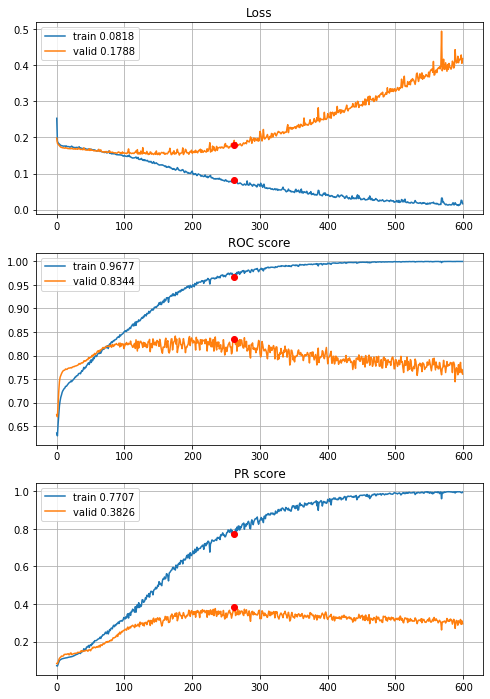


Fold 2------------------------------------------------------------


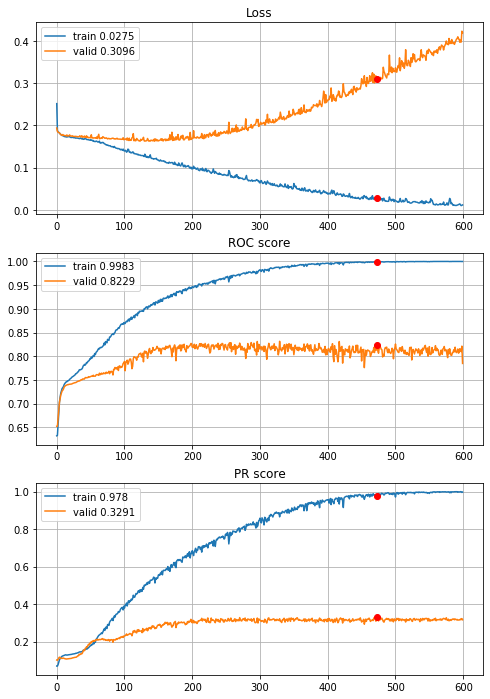


Fold 3------------------------------------------------------------


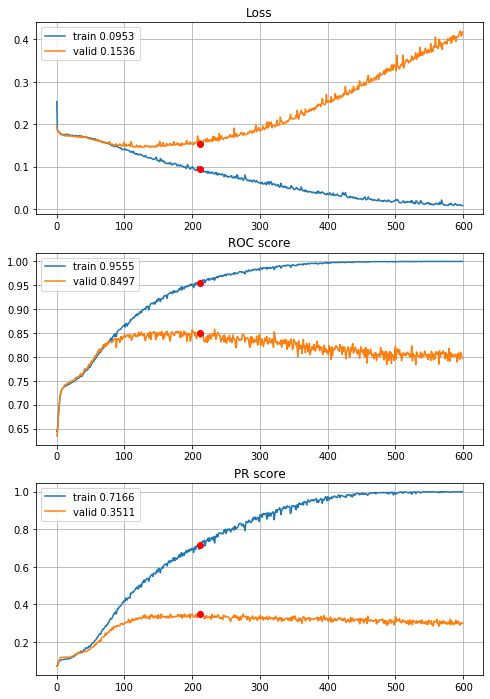


Fold 4------------------------------------------------------------


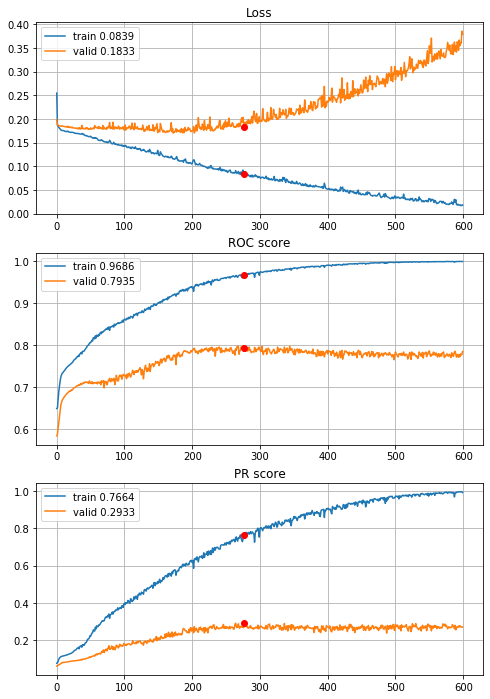


Fold 5------------------------------------------------------------


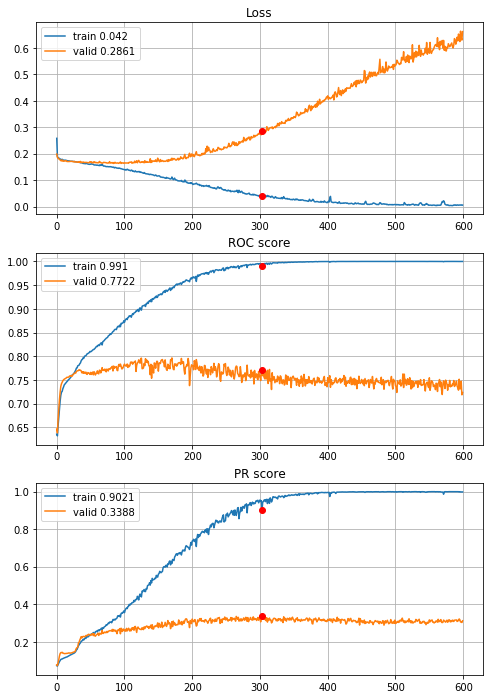


Fold 6------------------------------------------------------------


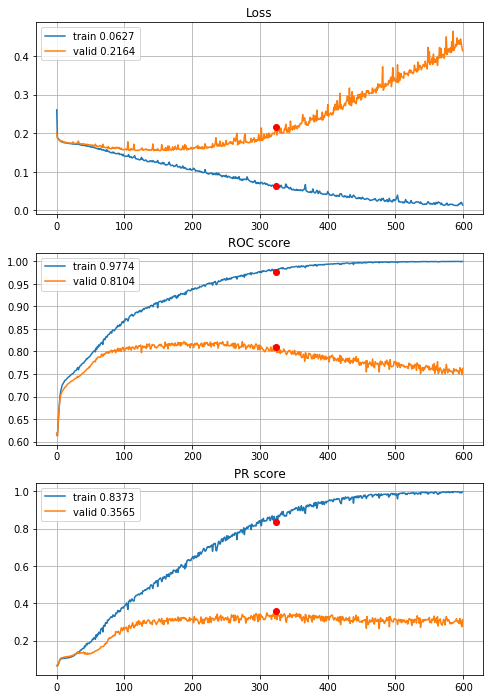

In [54]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_deep_CNN_2inc_std_600ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Results are not so good, things to try:
 - best model found for 1 year horizon,
 - best model found for 2 year horizon,
 - experiment based on results
 
##### best 1 year horizon model

In [47]:
def define_deep_CNN_2inc_std_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/450,
cumulative time: 3.68s train loss: 0.3726113134339535, validation loss: 0.3023761510848999
Epoch: 2/450,
cumulative time: 5.08s train loss: 0.28319846172360613, validation loss: 0.2628035508096218
Epoch: 3/450,
cumulative time: 6.44s train loss: 0.2538936680391877, validation loss: 0.23989132046699524
Epoch: 4/450,
cumulative time: 7.8s train loss: 0.2353290331059449, validation loss: 0.2257179394364357
Epoch: 5/450,
cumulative time: 9.15s train loss: 0.22517665632640485, validation loss: 0.21949278563261032
Epoch: 6/450,
cumulative time: 10.51s train loss: 0.22038508456724437, validation loss: 0.21375670656561852
Epoch: 7/450,
cumulative time: 11.85s train loss: 0.2158175032489369, validation loss: 0.21002508327364922
Epoch: 8/450,
cumulative time: 13.23s train loss: 0.21315210223303888, validation loss: 0.20783286541700363
Epoch: 9/450,
cumulative time: 14.59s train loss: 0.21077810619508874,

Epoch: 77/450,
cumulative time: 109.58s train loss: 0.17712410377057572, validation loss: 0.17094502225518227
Epoch: 78/450,
cumulative time: 110.99s train loss: 0.17555178151314121, validation loss: 0.17066112533211708
Epoch: 79/450,
cumulative time: 112.4s train loss: 0.17421618831822144, validation loss: 0.17284317687153816
Epoch: 80/450,
cumulative time: 113.77s train loss: 0.1756895025288653, validation loss: 0.1706995777785778
Epoch: 81/450,
cumulative time: 115.16s train loss: 0.1746654083404582, validation loss: 0.17211908847093582
Epoch: 82/450,
cumulative time: 116.58s train loss: 0.17451269200394273, validation loss: 0.1702442802488804
Epoch: 83/450,
cumulative time: 118.01s train loss: 0.17438648579809615, validation loss: 0.17153166607022285
Epoch: 84/450,
cumulative time: 119.37s train loss: 0.1749331596207655, validation loss: 0.17036468908190727
Epoch: 85/450,
cumulative time: 120.73s train loss: 0.17389642386690138, validation loss: 0.17087940499186516
Epoch: 86/450,
c

Epoch: 152/450,
cumulative time: 214.6s train loss: 0.16553150505251302, validation loss: 0.16445646435022354
Epoch: 153/450,
cumulative time: 215.99s train loss: 0.16501501241747107, validation loss: 0.16622865572571754
Epoch: 154/450,
cumulative time: 217.37s train loss: 0.16317383445886383, validation loss: 0.16613271087408066
Epoch: 155/450,
cumulative time: 218.74s train loss: 0.16356139964201294, validation loss: 0.16325673460960388
Epoch: 156/450,
cumulative time: 220.12s train loss: 0.16312168444350264, validation loss: 0.1627960316836834
Epoch: 157/450,
cumulative time: 221.52s train loss: 0.16274785174178918, validation loss: 0.16487502679228783
Epoch: 158/450,
cumulative time: 222.95s train loss: 0.1632005147420252, validation loss: 0.1647198088467121
Epoch: 159/450,
cumulative time: 224.43s train loss: 0.1616606043775624, validation loss: 0.1630142703652382
Epoch: 160/450,
cumulative time: 225.97s train loss: 0.16182371879014465, validation loss: 0.16255344823002815
Epoch: 

Epoch: 227/450,
cumulative time: 320.4s train loss: 0.1372213194618799, validation loss: 0.15598690882325172
Epoch: 228/450,
cumulative time: 321.79s train loss: 0.13746337083472462, validation loss: 0.15628579258918762
Epoch: 229/450,
cumulative time: 323.17s train loss: 0.13873548009004794, validation loss: 0.15803497470915318
Epoch: 230/450,
cumulative time: 324.55s train loss: 0.13855406383706145, validation loss: 0.15503284335136414
Epoch: 231/450,
cumulative time: 325.96s train loss: 0.13568136946819892, validation loss: 0.15484427101910114
Epoch: 232/450,
cumulative time: 327.37s train loss: 0.1345978556129913, validation loss: 0.15683102048933506
Epoch: 233/450,
cumulative time: 328.73s train loss: 0.1356491427007758, validation loss: 0.158466674387455
Epoch: 234/450,
cumulative time: 330.11s train loss: 0.13596108095288095, validation loss: 0.1581098921597004
Epoch: 235/450,
cumulative time: 331.49s train loss: 0.13670471043469276, validation loss: 0.15364967472851276
Epoch: 2

Epoch: 302/450,
cumulative time: 426.16s train loss: 0.11052078824091104, validation loss: 0.15862519666552544
Epoch: 303/450,
cumulative time: 427.57s train loss: 0.11344675742252458, validation loss: 0.16305061802268028
Epoch: 304/450,
cumulative time: 428.97s train loss: 0.10901026285848017, validation loss: 0.15639281645417213
Epoch: 305/450,
cumulative time: 430.38s train loss: 0.10898326377825666, validation loss: 0.16029837727546692
Epoch: 306/450,
cumulative time: 431.78s train loss: 0.10932164836377889, validation loss: 0.15976253896951675
Epoch: 307/450,
cumulative time: 433.15s train loss: 0.11455105222788119, validation loss: 0.16181661188602448
Epoch: 308/450,
cumulative time: 434.55s train loss: 0.11409319712463038, validation loss: 0.16072600334882736
Epoch: 309/450,
cumulative time: 435.97s train loss: 0.10760153356680355, validation loss: 0.15951767191290855
Epoch: 310/450,
cumulative time: 437.38s train loss: 0.1071148072612988, validation loss: 0.1589488498866558
Epo

Epoch: 377/450,
cumulative time: 531.03s train loss: 0.08939626740661595, validation loss: 0.18676301464438438
Epoch: 378/450,
cumulative time: 532.41s train loss: 0.08857359973275765, validation loss: 0.18946082890033722
Epoch: 379/450,
cumulative time: 533.78s train loss: 0.08823476622421285, validation loss: 0.18093544989824295
Epoch: 380/450,
cumulative time: 535.18s train loss: 0.08888581706946001, validation loss: 0.19102563336491585
Epoch: 381/450,
cumulative time: 536.56s train loss: 0.08849733269410638, validation loss: 0.1850607469677925
Epoch: 382/450,
cumulative time: 537.92s train loss: 0.08871932514106458, validation loss: 0.18297100067138672
Epoch: 383/450,
cumulative time: 539.27s train loss: 0.08770107916840568, validation loss: 0.1878284253180027
Epoch: 384/450,
cumulative time: 540.76s train loss: 0.08759700763098414, validation loss: 0.18280312791466713
Epoch: 385/450,
cumulative time: 542.13s train loss: 0.08560968245487942, validation loss: 0.1916048713028431
Epoc

Train on 7876 samples, validate on 1576 samples
Epoch: 1/450,
cumulative time: 3.49s train loss: 0.37887458109716404, validation loss: 0.3020627275109291
Epoch: 2/450,
cumulative time: 4.88s train loss: 0.28244652467036746, validation loss: 0.26471202820539474
Epoch: 3/450,
cumulative time: 6.29s train loss: 0.25360372460860175, validation loss: 0.24242500960826874
Epoch: 4/450,
cumulative time: 7.68s train loss: 0.23535690873240747, validation loss: 0.2299942709505558
Epoch: 5/450,
cumulative time: 9.09s train loss: 0.2267238620522968, validation loss: 0.22471680492162704
Epoch: 6/450,
cumulative time: 10.48s train loss: 0.22095585403298895, validation loss: 0.21954863145947456
Epoch: 7/450,
cumulative time: 11.87s train loss: 0.21715456755891435, validation loss: 0.2153797745704651
Epoch: 8/450,
cumulative time: 13.26s train loss: 0.21329590130678708, validation loss: 0.21234873682260513
Epoch: 9/450,
cumulative time: 14.66s train loss: 0.21080274856093573, validation loss: 0.2103049

Epoch: 77/450,
cumulative time: 112.61s train loss: 0.17153431261369817, validation loss: 0.1788756512105465
Epoch: 78/450,
cumulative time: 114.01s train loss: 0.17186165781509094, validation loss: 0.17736611515283585
Epoch: 79/450,
cumulative time: 115.4s train loss: 0.17150036455593234, validation loss: 0.17732035368680954
Epoch: 80/450,
cumulative time: 116.79s train loss: 0.1718010265453931, validation loss: 0.17924191430211067
Epoch: 81/450,
cumulative time: 118.18s train loss: 0.17076352566912006, validation loss: 0.17728698253631592
Epoch: 82/450,
cumulative time: 119.57s train loss: 0.17035642897813316, validation loss: 0.1798134297132492
Epoch: 83/450,
cumulative time: 120.95s train loss: 0.17056354589726247, validation loss: 0.17958424985408783
Epoch: 84/450,
cumulative time: 122.34s train loss: 0.1717027362120097, validation loss: 0.17703877389431
Epoch: 85/450,
cumulative time: 123.74s train loss: 0.17171461677198607, validation loss: 0.18464436754584312
Epoch: 86/450,
cum

Epoch: 152/450,
cumulative time: 221.19s train loss: 0.15464098630837222, validation loss: 0.17687809839844704
Epoch: 153/450,
cumulative time: 222.65s train loss: 0.15407178396952217, validation loss: 0.17774469032883644
Epoch: 154/450,
cumulative time: 224.09s train loss: 0.15667196268044553, validation loss: 0.17970795929431915
Epoch: 155/450,
cumulative time: 225.52s train loss: 0.15402742655576032, validation loss: 0.17781949043273926
Epoch: 156/450,
cumulative time: 226.96s train loss: 0.15409952216134148, validation loss: 0.17806687951087952
Epoch: 157/450,
cumulative time: 228.4s train loss: 0.154508474627732, validation loss: 0.1783471703529358
Epoch: 158/450,
cumulative time: 229.88s train loss: 0.1560877830720965, validation loss: 0.1788995936512947
Epoch: 159/450,
cumulative time: 231.29s train loss: 0.15466121282786086, validation loss: 0.18409191444516182
Epoch: 160/450,
cumulative time: 232.76s train loss: 0.1555523188825396, validation loss: 0.1764053925871849
Epoch: 16

Epoch: 227/450,
cumulative time: 328.59s train loss: 0.14016334962056276, validation loss: 0.18087982758879662
Epoch: 228/450,
cumulative time: 329.98s train loss: 0.1422844906221676, validation loss: 0.17970212548971176
Epoch: 229/450,
cumulative time: 331.36s train loss: 0.13805745208684173, validation loss: 0.1813792735338211
Epoch: 230/450,
cumulative time: 332.77s train loss: 0.14131420683503576, validation loss: 0.18003936111927032
Epoch: 231/450,
cumulative time: 334.17s train loss: 0.13935998443527353, validation loss: 0.18262675777077675
Epoch: 232/450,
cumulative time: 335.59s train loss: 0.1435005633021412, validation loss: 0.17912056297063828
Epoch: 233/450,
cumulative time: 336.98s train loss: 0.13796550546119576, validation loss: 0.1842602863907814
Epoch: 234/450,
cumulative time: 338.43s train loss: 0.13765582782270763, validation loss: 0.17866449803113937
Epoch: 235/450,
cumulative time: 339.86s train loss: 0.1428697362235653, validation loss: 0.18187931925058365
Epoch:

Epoch: 302/450,
cumulative time: 436.1s train loss: 0.12727656039854426, validation loss: 0.18464688956737518
Epoch: 303/450,
cumulative time: 437.59s train loss: 0.12427638863521279, validation loss: 0.18345224112272263
Epoch: 304/450,
cumulative time: 439.03s train loss: 0.1237432083286205, validation loss: 0.18188570067286491
Epoch: 305/450,
cumulative time: 440.49s train loss: 0.12156982874283033, validation loss: 0.18288753554224968
Epoch: 306/450,
cumulative time: 442.07s train loss: 0.12348748721776426, validation loss: 0.18446923792362213
Epoch: 307/450,
cumulative time: 443.48s train loss: 0.12324964452994663, validation loss: 0.1818036437034607
Epoch: 308/450,
cumulative time: 444.86s train loss: 0.12373660671216785, validation loss: 0.1870918571949005
Epoch: 309/450,
cumulative time: 446.25s train loss: 0.12195199062795188, validation loss: 0.18360161781311035
Epoch: 310/450,
cumulative time: 447.62s train loss: 0.1208854358474908, validation loss: 0.18321309611201286
Epoch:

Epoch: 377/450,
cumulative time: 544.34s train loss: 0.11023123445601377, validation loss: 0.20191515982151031
Epoch: 378/450,
cumulative time: 545.76s train loss: 0.10938585137900149, validation loss: 0.18795466050505638
Epoch: 379/450,
cumulative time: 547.19s train loss: 0.1090600561291933, validation loss: 0.19565502181649208
Epoch: 380/450,
cumulative time: 548.68s train loss: 0.10977322066939682, validation loss: 0.1907293051481247
Epoch: 381/450,
cumulative time: 550.22s train loss: 0.1070407843259823, validation loss: 0.18893716111779213
Epoch: 382/450,
cumulative time: 551.76s train loss: 0.10667138807608005, validation loss: 0.1900056153535843
Epoch: 383/450,
cumulative time: 553.29s train loss: 0.10658917392553442, validation loss: 0.1886991150677204
Epoch: 384/450,
cumulative time: 554.81s train loss: 0.10778891445795494, validation loss: 0.19275441393256187
Epoch: 385/450,
cumulative time: 556.19s train loss: 0.11247719181800869, validation loss: 0.20953098312020302
Epoch:

Train on 7877 samples, validate on 1575 samples
Epoch: 1/450,
cumulative time: 3.5s train loss: 0.38095724777142015, validation loss: 0.303984754463983
Epoch: 2/450,
cumulative time: 5.0s train loss: 0.279995404328582, validation loss: 0.2644521259693872
Epoch: 3/450,
cumulative time: 6.44s train loss: 0.25257539682556596, validation loss: 0.24095916545580304
Epoch: 4/450,
cumulative time: 7.84s train loss: 0.23406324347854038, validation loss: 0.22674270219273038
Epoch: 5/450,
cumulative time: 9.33s train loss: 0.2240887410192452, validation loss: 0.2202532361991822
Epoch: 6/450,
cumulative time: 10.84s train loss: 0.21915528358118597, validation loss: 0.21617275268312486
Epoch: 7/450,
cumulative time: 12.31s train loss: 0.2155872199954426, validation loss: 0.2128013772150827
Epoch: 8/450,
cumulative time: 13.75s train loss: 0.21259461124036855, validation loss: 0.21015604986084832
Epoch: 9/450,
cumulative time: 15.18s train loss: 0.21051617324450633, validation loss: 0.20978733980466

Epoch: 77/450,
cumulative time: 114.04s train loss: 0.17665100749546583, validation loss: 0.1769530207013327
Epoch: 78/450,
cumulative time: 115.66s train loss: 0.17451480744952583, validation loss: 0.17269475220687805
Epoch: 79/450,
cumulative time: 117.1s train loss: 0.17547119264979796, validation loss: 0.17879116882407475
Epoch: 80/450,
cumulative time: 118.58s train loss: 0.17609907482025117, validation loss: 0.17434070162356846
Epoch: 81/450,
cumulative time: 120.06s train loss: 0.17383562430968302, validation loss: 0.1736560595697827
Epoch: 82/450,
cumulative time: 121.68s train loss: 0.1746132704049209, validation loss: 0.17262421496330746
Epoch: 83/450,
cumulative time: 123.28s train loss: 0.17553616700944855, validation loss: 0.17707252977386354
Epoch: 84/450,
cumulative time: 124.68s train loss: 0.1746443988114758, validation loss: 0.17217850677550786
Epoch: 85/450,
cumulative time: 126.1s train loss: 0.1738163834392563, validation loss: 0.1722014638166579
Epoch: 86/450,
cum

Epoch: 152/450,
cumulative time: 223.84s train loss: 0.1643218820744607, validation loss: 0.16645685521383133
Epoch: 153/450,
cumulative time: 225.3s train loss: 0.16468049743211222, validation loss: 0.1661717734355775
Epoch: 154/450,
cumulative time: 226.83s train loss: 0.16476651110578888, validation loss: 0.16654998765105292
Epoch: 155/450,
cumulative time: 228.43s train loss: 0.16421534294886564, validation loss: 0.16704153679666064
Epoch: 156/450,
cumulative time: 229.96s train loss: 0.16545816742841915, validation loss: 0.16632626369832054
Epoch: 157/450,
cumulative time: 231.42s train loss: 0.1649273226837587, validation loss: 0.16583118195571597
Epoch: 158/450,
cumulative time: 232.89s train loss: 0.16344054008106812, validation loss: 0.16548066718237742
Epoch: 159/450,
cumulative time: 234.3s train loss: 0.1630472180632085, validation loss: 0.16505399657620323
Epoch: 160/450,
cumulative time: 235.79s train loss: 0.16282452586544063, validation loss: 0.16618773086676522
Epoch: 

Epoch: 227/450,
cumulative time: 331.97s train loss: 0.14362474140955045, validation loss: 0.15794573651419747
Epoch: 228/450,
cumulative time: 333.37s train loss: 0.14410857511222006, validation loss: 0.1591640528516164
Epoch: 229/450,
cumulative time: 334.73s train loss: 0.14416218728254604, validation loss: 0.15764191958639356
Epoch: 230/450,
cumulative time: 336.1s train loss: 0.14346223312713963, validation loss: 0.1578341465053104
Epoch: 231/450,
cumulative time: 337.46s train loss: 0.14390357486431682, validation loss: 0.15911827127138772
Epoch: 232/450,
cumulative time: 338.84s train loss: 0.14370929656846582, validation loss: 0.15818226543683855
Epoch: 233/450,
cumulative time: 340.21s train loss: 0.1421139853469336, validation loss: 0.1598315743132243
Epoch: 234/450,
cumulative time: 341.66s train loss: 0.14190575585735923, validation loss: 0.156976717019838
Epoch: 235/450,
cumulative time: 343.06s train loss: 0.14096856546860534, validation loss: 0.1581405398202321
Epoch: 23

Epoch: 302/450,
cumulative time: 447.38s train loss: 0.12152857414104014, validation loss: 0.15774588693702032
Epoch: 303/450,
cumulative time: 448.8s train loss: 0.12232598221130263, validation loss: 0.15789497316829743
Epoch: 304/450,
cumulative time: 450.17s train loss: 0.1234384280171539, validation loss: 0.16047962296576726
Epoch: 305/450,
cumulative time: 451.58s train loss: 0.12416928988983444, validation loss: 0.15855226823261806
Epoch: 306/450,
cumulative time: 452.99s train loss: 0.12208738903777164, validation loss: 0.16739978636068012
Epoch: 307/450,
cumulative time: 454.36s train loss: 0.12249727044535937, validation loss: 0.15962190256232306
Epoch: 308/450,
cumulative time: 455.74s train loss: 0.12145283727536456, validation loss: 0.15946378369179984
Epoch: 309/450,
cumulative time: 457.13s train loss: 0.12077505731432817, validation loss: 0.15767550247056145
Epoch: 310/450,
cumulative time: 458.55s train loss: 0.11992786645556337, validation loss: 0.16041242536098238
Epo

Epoch: 377/450,
cumulative time: 551.53s train loss: 0.10664756646597615, validation loss: 0.16100762565930685
Epoch: 378/450,
cumulative time: 552.91s train loss: 0.10548072071268093, validation loss: 0.162404901328541
Epoch: 379/450,
cumulative time: 554.29s train loss: 0.10509337591435593, validation loss: 0.16407093528717284
Epoch: 380/450,
cumulative time: 555.67s train loss: 0.10610576743448963, validation loss: 0.1618301997487507
Epoch: 381/450,
cumulative time: 557.03s train loss: 0.10654812439438109, validation loss: 0.16249450009966654
Epoch: 382/450,
cumulative time: 558.38s train loss: 0.10541650012629247, validation loss: 0.1605212997917145
Epoch: 383/450,
cumulative time: 559.79s train loss: 0.10458090968342076, validation loss: 0.16132122208201696
Epoch: 384/450,
cumulative time: 561.15s train loss: 0.10521395364486583, validation loss: 0.16461423613722362
Epoch: 385/450,
cumulative time: 562.53s train loss: 0.105609353890429, validation loss: 0.16453897957763974
Epoch: 

Train on 7877 samples, validate on 1575 samples
Epoch: 1/450,
cumulative time: 4.26s train loss: 0.391503756476399, validation loss: 0.3128416767385271
Epoch: 2/450,
cumulative time: 5.7s train loss: 0.28318016982644556, validation loss: 0.2690660960144467
Epoch: 3/450,
cumulative time: 7.13s train loss: 0.2545321287994716, validation loss: 0.2465400587377094
Epoch: 4/450,
cumulative time: 8.54s train loss: 0.23557995914489738, validation loss: 0.2333914349949549
Epoch: 5/450,
cumulative time: 10.03s train loss: 0.22563783141529103, validation loss: 0.22848637081327894
Epoch: 6/450,
cumulative time: 11.43s train loss: 0.22055059584004028, validation loss: 0.2253520348904625
Epoch: 7/450,
cumulative time: 12.91s train loss: 0.21650644512562123, validation loss: 0.22254749082383654
Epoch: 8/450,
cumulative time: 14.46s train loss: 0.213581076726342, validation loss: 0.21996007697922842
Epoch: 9/450,
cumulative time: 16.0s train loss: 0.21078368847565676, validation loss: 0.21876714114158

Epoch: 77/450,
cumulative time: 123.62s train loss: 0.17184745323897105, validation loss: 0.1834291534575205
Epoch: 78/450,
cumulative time: 125.17s train loss: 0.17148993960057357, validation loss: 0.18380802111020164
Epoch: 79/450,
cumulative time: 126.69s train loss: 0.17268364379078177, validation loss: 0.18647184801480127
Epoch: 80/450,
cumulative time: 128.2s train loss: 0.17133727579480337, validation loss: 0.18379748551618486
Epoch: 81/450,
cumulative time: 129.67s train loss: 0.16973527011168218, validation loss: 0.1841700727125955
Epoch: 82/450,
cumulative time: 131.17s train loss: 0.16917162084278303, validation loss: 0.18489565895663368
Epoch: 83/450,
cumulative time: 132.82s train loss: 0.16825793476006062, validation loss: 0.1834062290286261
Epoch: 84/450,
cumulative time: 134.43s train loss: 0.16947902966906944, validation loss: 0.18879050665431552
Epoch: 85/450,
cumulative time: 136.21s train loss: 0.17116594486911843, validation loss: 0.18331503848234812
Epoch: 86/450,

Epoch: 152/450,
cumulative time: 247.32s train loss: 0.14522753872135288, validation loss: 0.18293272754502674
Epoch: 153/450,
cumulative time: 248.93s train loss: 0.14439282531311962, validation loss: 0.18418842116045572
Epoch: 154/450,
cumulative time: 250.42s train loss: 0.14765391993964552, validation loss: 0.19785046585022456
Epoch: 155/450,
cumulative time: 252.02s train loss: 0.144564261444559, validation loss: 0.18287031520926764
Epoch: 156/450,
cumulative time: 253.59s train loss: 0.14374998060522215, validation loss: 0.1857250968804435
Epoch: 157/450,
cumulative time: 255.17s train loss: 0.1430817810702448, validation loss: 0.18407283762144663
Epoch: 158/450,
cumulative time: 256.74s train loss: 0.1419315706397943, validation loss: 0.18284413455024598
Epoch: 159/450,
cumulative time: 258.27s train loss: 0.1425944502171381, validation loss: 0.18629590266280704
Epoch: 160/450,
cumulative time: 259.75s train loss: 0.14157777957706202, validation loss: 0.18336082233322992
Epoch: 

Epoch: 227/450,
cumulative time: 367.39s train loss: 0.12289241902644643, validation loss: 0.1994020013960581
Epoch: 228/450,
cumulative time: 369.07s train loss: 0.12630780797720834, validation loss: 0.1867472674260064
Epoch: 229/450,
cumulative time: 370.79s train loss: 0.12203032465601264, validation loss: 0.1900806976783843
Epoch: 230/450,
cumulative time: 372.56s train loss: 0.12135348722416238, validation loss: 0.19216979745834592
Epoch: 231/450,
cumulative time: 374.22s train loss: 0.12263063357175115, validation loss: 0.18553973658690376
Epoch: 232/450,
cumulative time: 375.95s train loss: 0.12525642918718638, validation loss: 0.19241952745687393
Epoch: 233/450,
cumulative time: 377.64s train loss: 0.12139029723709271, validation loss: 0.18933044589701153
Epoch: 234/450,
cumulative time: 379.4s train loss: 0.12030303041724152, validation loss: 0.19031417103040785
Epoch: 235/450,
cumulative time: 381.35s train loss: 0.11858510005530086, validation loss: 0.19280796095492347
Epoch

Epoch: 302/450,
cumulative time: 503.8s train loss: 0.10308055857084601, validation loss: 0.19345562278278292
Epoch: 303/450,
cumulative time: 505.77s train loss: 0.10329982659357279, validation loss: 0.19563531199144937
Epoch: 304/450,
cumulative time: 507.98s train loss: 0.10505840081758906, validation loss: 0.1968301175416462
Epoch: 305/450,
cumulative time: 510.44s train loss: 0.1027463562583218, validation loss: 0.20762042690837193
Epoch: 306/450,
cumulative time: 512.68s train loss: 0.10500962418946606, validation loss: 0.19404669761657714
Epoch: 307/450,
cumulative time: 514.99s train loss: 0.10259391528232548, validation loss: 0.19241590480009715
Epoch: 308/450,
cumulative time: 517.2s train loss: 0.10302685069314443, validation loss: 0.19324785224975102
Epoch: 309/450,
cumulative time: 519.33s train loss: 0.10633801308696882, validation loss: 0.21573056133966598
Epoch: 310/450,
cumulative time: 521.22s train loss: 0.11034387189285305, validation loss: 0.19124035914738974
Epoch

Epoch: 377/450,
cumulative time: 653.03s train loss: 0.08702110779498061, validation loss: 0.2041643305146505
Epoch: 378/450,
cumulative time: 654.82s train loss: 0.08892758775649526, validation loss: 0.20308453346055652
Epoch: 379/450,
cumulative time: 656.56s train loss: 0.08791045870282437, validation loss: 0.20877588501052252
Epoch: 380/450,
cumulative time: 658.42s train loss: 0.08992573690207095, validation loss: 0.20398955278926426
Epoch: 381/450,
cumulative time: 660.38s train loss: 0.08667973553535069, validation loss: 0.2105319106768048
Epoch: 382/450,
cumulative time: 662.25s train loss: 0.08752702041217575, validation loss: 0.21281765621805948
Epoch: 383/450,
cumulative time: 664.05s train loss: 0.08875570792912438, validation loss: 0.21050116556031365
Epoch: 384/450,
cumulative time: 665.84s train loss: 0.09281269308821387, validation loss: 0.2078384649469739
Epoch: 385/450,
cumulative time: 667.63s train loss: 0.0880377944249088, validation loss: 0.20194809641156877
Epoch

Train on 7877 samples, validate on 1575 samples
Epoch: 1/450,
cumulative time: 14.91s train loss: 0.38335973209001184, validation loss: 0.3055177114312611
Epoch: 2/450,
cumulative time: 21.59s train loss: 0.28326232399532786, validation loss: 0.26485605676968893
Epoch: 3/450,
cumulative time: 28.25s train loss: 0.25377029328270884, validation loss: 0.2409282394250234
Epoch: 4/450,
cumulative time: 30.18s train loss: 0.23564414513721008, validation loss: 0.22681233862089734
Epoch: 5/450,
cumulative time: 31.89s train loss: 0.22531060872381223, validation loss: 0.21980982112506078
Epoch: 6/450,
cumulative time: 33.66s train loss: 0.22012740023641306, validation loss: 0.21476522689773922
Epoch: 7/450,
cumulative time: 35.53s train loss: 0.21620900624783887, validation loss: 0.21090040195555915
Epoch: 8/450,
cumulative time: 37.2s train loss: 0.21324789150272422, validation loss: 0.20866658767064414
Epoch: 9/450,
cumulative time: 38.83s train loss: 0.21388402624724706, validation loss: 0.2

Epoch: 76/450,
cumulative time: 202.75s train loss: 0.17090801600879016, validation loss: 0.17175720447585696
Epoch: 77/450,
cumulative time: 204.48s train loss: 0.17103333071288504, validation loss: 0.17262822689518095
Epoch: 78/450,
cumulative time: 206.29s train loss: 0.17030019296355184, validation loss: 0.17241988274786207
Epoch: 79/450,
cumulative time: 207.97s train loss: 0.17182988513502748, validation loss: 0.17729856923459067
Epoch: 80/450,
cumulative time: 209.75s train loss: 0.17179772554049869, validation loss: 0.17164067359197707
Epoch: 81/450,
cumulative time: 211.61s train loss: 0.17165412318060297, validation loss: 0.17254003899438042
Epoch: 82/450,
cumulative time: 213.27s train loss: 0.17058908107756843, validation loss: 0.17292845736420343
Epoch: 83/450,
cumulative time: 215.03s train loss: 0.1696754353700502, validation loss: 0.17209694169816517
Epoch: 84/450,
cumulative time: 216.74s train loss: 0.1699787561600926, validation loss: 0.17205388666145385
Epoch: 85/45

Epoch: 151/450,
cumulative time: 381.44s train loss: 0.15443337592653958, validation loss: 0.16574520470604065
Epoch: 152/450,
cumulative time: 383.04s train loss: 0.15442247014273783, validation loss: 0.16760064984124803
Epoch: 153/450,
cumulative time: 384.66s train loss: 0.153484613225441, validation loss: 0.16599759476525444
Epoch: 154/450,
cumulative time: 386.25s train loss: 0.15247296722305748, validation loss: 0.16474872858751388
Epoch: 155/450,
cumulative time: 387.84s train loss: 0.1519783722468253, validation loss: 0.16536180431880648
Epoch: 156/450,
cumulative time: 389.38s train loss: 0.15272923383114073, validation loss: 0.1644451021580469
Epoch: 157/450,
cumulative time: 390.98s train loss: 0.15013262980424982, validation loss: 0.16622846908039518
Epoch: 158/450,
cumulative time: 392.5s train loss: 0.15107479272108779, validation loss: 0.16427053292592367
Epoch: 159/450,
cumulative time: 394.03s train loss: 0.15050746973140963, validation loss: 0.16520083921296255
Epoch:

Epoch: 226/450,
cumulative time: 503.5s train loss: 0.1360619727830014, validation loss: 0.16922646794054244
Epoch: 227/450,
cumulative time: 505.07s train loss: 0.1287266279477236, validation loss: 0.17050964487923517
Epoch: 228/450,
cumulative time: 506.69s train loss: 0.1278845774986666, validation loss: 0.17012361045867677
Epoch: 229/450,
cumulative time: 508.44s train loss: 0.1296713491803622, validation loss: 0.16864121606425633
Epoch: 230/450,
cumulative time: 510.08s train loss: 0.12706411920201283, validation loss: 0.1690759457671453
Epoch: 231/450,
cumulative time: 511.76s train loss: 0.12542372414367187, validation loss: 0.1726204877902591
Epoch: 232/450,
cumulative time: 513.57s train loss: 0.1260591795706077, validation loss: 0.1781654517423539
Epoch: 233/450,
cumulative time: 515.41s train loss: 0.12640704566245609, validation loss: 0.1733065674134663
Epoch: 234/450,
cumulative time: 517.3s train loss: 0.1248161922925103, validation loss: 0.17000657411794814
Epoch: 235/45

Epoch: 301/450,
cumulative time: 628.49s train loss: 0.10613990323380405, validation loss: 0.20095744470755258
Epoch: 302/450,
cumulative time: 630.05s train loss: 0.11033586666916809, validation loss: 0.19136706208425855
Epoch: 303/450,
cumulative time: 631.63s train loss: 0.11205305624457654, validation loss: 0.19823697572662716
Epoch: 304/450,
cumulative time: 633.22s train loss: 0.10599623280282369, validation loss: 0.19837371762782807
Epoch: 305/450,
cumulative time: 634.82s train loss: 0.10329383662566628, validation loss: 0.19621339366549537
Epoch: 306/450,
cumulative time: 636.4s train loss: 0.10360676141272981, validation loss: 0.1976811128949362
Epoch: 307/450,
cumulative time: 637.97s train loss: 0.10246106260535952, validation loss: 0.19586365319433666
Epoch: 308/450,
cumulative time: 639.5s train loss: 0.10135311106879866, validation loss: 0.19602340286686307
Epoch: 309/450,
cumulative time: 641.02s train loss: 0.10078171311000496, validation loss: 0.19674451975595383
Epoc

Epoch: 376/450,
cumulative time: 746.79s train loss: 0.08357189159939188, validation loss: 0.2288779091835022
Epoch: 377/450,
cumulative time: 748.37s train loss: 0.08727493507427447, validation loss: 0.2364201115048121
Epoch: 378/450,
cumulative time: 749.99s train loss: 0.08549986254356227, validation loss: 0.2295334954110403
Epoch: 379/450,
cumulative time: 751.5s train loss: 0.08215539203737991, validation loss: 0.23187699465524583
Epoch: 380/450,
cumulative time: 753.1s train loss: 0.08288820585434821, validation loss: 0.2405721448149
Epoch: 381/450,
cumulative time: 754.71s train loss: 0.08275288271070874, validation loss: 0.23091464597081382
Epoch: 382/450,
cumulative time: 756.34s train loss: 0.08024005055658343, validation loss: 0.2403987823781513
Epoch: 383/450,
cumulative time: 757.88s train loss: 0.08833047765867198, validation loss: 0.23427431978876628
Epoch: 384/450,
cumulative time: 759.48s train loss: 0.08681990039201803, validation loss: 0.2339802584383223
Epoch: 385/4

Train on 7877 samples, validate on 1575 samples
Epoch: 1/450,
cumulative time: 4.13s train loss: 0.3891761258984181, validation loss: 0.311048294930231
Epoch: 2/450,
cumulative time: 5.71s train loss: 0.2842914994611676, validation loss: 0.26718221511159623
Epoch: 3/450,
cumulative time: 7.29s train loss: 0.2557400643174776, validation loss: 0.24377550995539105
Epoch: 4/450,
cumulative time: 8.96s train loss: 0.2363647455201773, validation loss: 0.23028432033364735
Epoch: 5/450,
cumulative time: 10.81s train loss: 0.22711589596470375, validation loss: 0.22537377212728774
Epoch: 6/450,
cumulative time: 12.51s train loss: 0.22201580339062557, validation loss: 0.21860648954671527
Epoch: 7/450,
cumulative time: 14.06s train loss: 0.21757077198994407, validation loss: 0.21615862751763965
Epoch: 8/450,
cumulative time: 15.65s train loss: 0.2143192324648809, validation loss: 0.21545266418229966
Epoch: 9/450,
cumulative time: 17.22s train loss: 0.2113784465206234, validation loss: 0.2137773010

Epoch: 77/450,
cumulative time: 120.06s train loss: 0.17205060103626077, validation loss: 0.176616820163197
Epoch: 78/450,
cumulative time: 121.48s train loss: 0.1724721336460846, validation loss: 0.17615468040345206
Epoch: 79/450,
cumulative time: 122.94s train loss: 0.17211067147427167, validation loss: 0.17919463275916991
Epoch: 80/450,
cumulative time: 124.51s train loss: 0.1715643447418874, validation loss: 0.17521466292086102
Epoch: 81/450,
cumulative time: 125.97s train loss: 0.170965051997566, validation loss: 0.174896849810131
Epoch: 82/450,
cumulative time: 127.58s train loss: 0.17096894239242783, validation loss: 0.1748727708203452
Epoch: 83/450,
cumulative time: 129.02s train loss: 0.1714816240526871, validation loss: 0.17610292457398913
Epoch: 84/450,
cumulative time: 130.42s train loss: 0.1722532517435255, validation loss: 0.17444181616344148
Epoch: 85/450,
cumulative time: 131.81s train loss: 0.17132803033273566, validation loss: 0.17523801139422826
Epoch: 86/450,
cumula

Epoch: 152/450,
cumulative time: 226.07s train loss: 0.15707773898660918, validation loss: 0.16638951467143165
Epoch: 153/450,
cumulative time: 227.47s train loss: 0.15698413765375968, validation loss: 0.1653842178885899
Epoch: 154/450,
cumulative time: 228.87s train loss: 0.15858691383304066, validation loss: 0.16688011041709355
Epoch: 155/450,
cumulative time: 230.26s train loss: 0.15648758404975588, validation loss: 0.16550347777586136
Epoch: 156/450,
cumulative time: 231.67s train loss: 0.15718498602046024, validation loss: 0.1663450190566835
Epoch: 157/450,
cumulative time: 233.07s train loss: 0.15657594143375764, validation loss: 0.1662670634663294
Epoch: 158/450,
cumulative time: 234.47s train loss: 0.15569400827647376, validation loss: 0.16705389031342097
Epoch: 159/450,
cumulative time: 235.84s train loss: 0.15824959894659496, validation loss: 0.16976404971546596
Epoch: 160/450,
cumulative time: 237.23s train loss: 0.15567856533312172, validation loss: 0.1653475696510739
Epoch

Epoch: 227/450,
cumulative time: 332.1s train loss: 0.1375572262787041, validation loss: 0.1579252582883078
Epoch: 228/450,
cumulative time: 333.57s train loss: 0.13493348938155572, validation loss: 0.15827201576459976
Epoch: 229/450,
cumulative time: 335.02s train loss: 0.13522381538006653, validation loss: 0.15794748537124148
Epoch: 230/450,
cumulative time: 336.63s train loss: 0.13605409202856264, validation loss: 0.15960078367165156
Epoch: 231/450,
cumulative time: 338.12s train loss: 0.13615710088614055, validation loss: 0.15813319218537164
Epoch: 232/450,
cumulative time: 339.57s train loss: 0.13759810070300202, validation loss: 0.16018591129590595
Epoch: 233/450,
cumulative time: 341.03s train loss: 0.1360139833408306, validation loss: 0.1588932864628141
Epoch: 234/450,
cumulative time: 342.61s train loss: 0.13386670439220918, validation loss: 0.15605196778736416
Epoch: 235/450,
cumulative time: 344.06s train loss: 0.13364647524647716, validation loss: 0.16048774509202865
Epoch:

Epoch: 302/450,
cumulative time: 440.05s train loss: 0.11707375524264083, validation loss: 0.15683333829281823
Epoch: 303/450,
cumulative time: 441.42s train loss: 0.11785503214475118, validation loss: 0.16882680650741336
Epoch: 304/450,
cumulative time: 442.8s train loss: 0.11640205368318275, validation loss: 0.1580920763715865
Epoch: 305/450,
cumulative time: 444.19s train loss: 0.11474565098385407, validation loss: 0.15528366888326312
Epoch: 306/450,
cumulative time: 445.57s train loss: 0.11406641600397437, validation loss: 0.15892510740529922
Epoch: 307/450,
cumulative time: 446.95s train loss: 0.11543428041660439, validation loss: 0.15681291718331594
Epoch: 308/450,
cumulative time: 448.32s train loss: 0.1145024761184908, validation loss: 0.1562987908862886
Epoch: 309/450,
cumulative time: 449.69s train loss: 0.11586313886253213, validation loss: 0.1571626433966652
Epoch: 310/450,
cumulative time: 451.07s train loss: 0.11361992552496235, validation loss: 0.16295088804903485
Epoch:

Epoch: 377/450,
cumulative time: 544.59s train loss: 0.10257593263590928, validation loss: 0.17090963427982633
Epoch: 378/450,
cumulative time: 545.97s train loss: 0.100494864096084, validation loss: 0.17270094296288868
Epoch: 379/450,
cumulative time: 547.35s train loss: 0.0990375514075177, validation loss: 0.1630765209689973
Epoch: 380/450,
cumulative time: 548.77s train loss: 0.09961934029484697, validation loss: 0.1647265934944153
Epoch: 381/450,
cumulative time: 550.2s train loss: 0.09758387084719765, validation loss: 0.1704365645136152
Epoch: 382/450,
cumulative time: 551.6s train loss: 0.1032827200945734, validation loss: 0.16674214518259442
Epoch: 383/450,
cumulative time: 553.02s train loss: 0.0976058673418626, validation loss: 0.17084104474574802
Epoch: 384/450,
cumulative time: 554.45s train loss: 0.09965648229513069, validation loss: 0.16528110039612603
Epoch: 385/450,
cumulative time: 555.85s train loss: 0.0964462602187326, validation loss: 0.17043492748623804
Epoch: 386/4

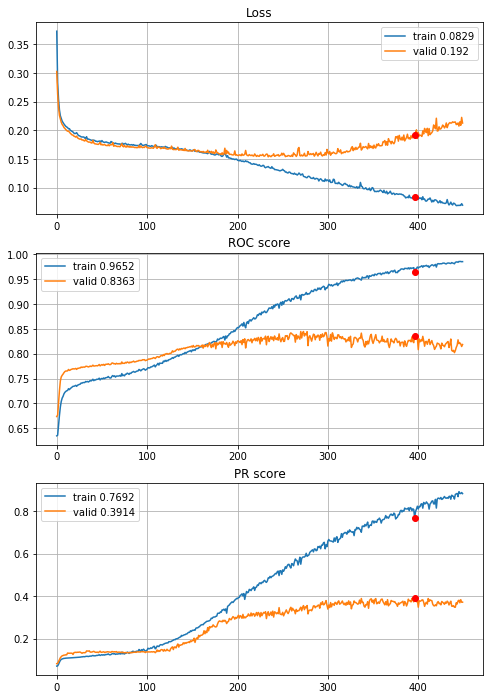


Fold 2------------------------------------------------------------


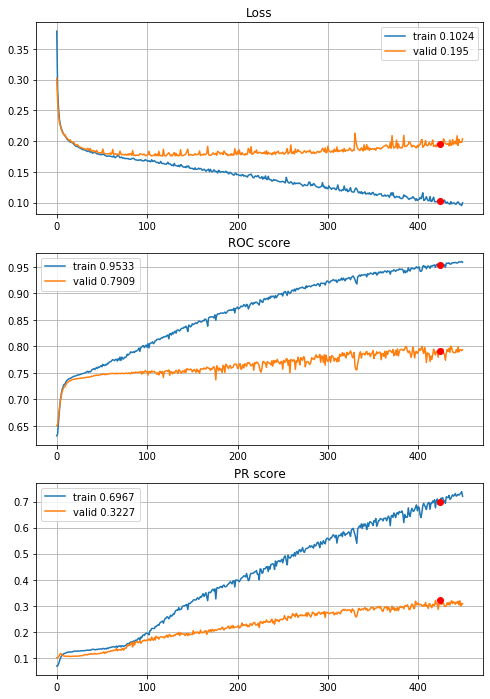


Fold 3------------------------------------------------------------


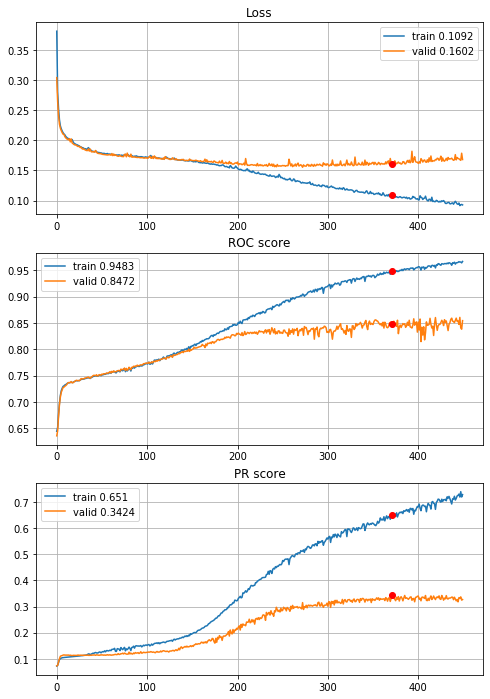


Fold 4------------------------------------------------------------


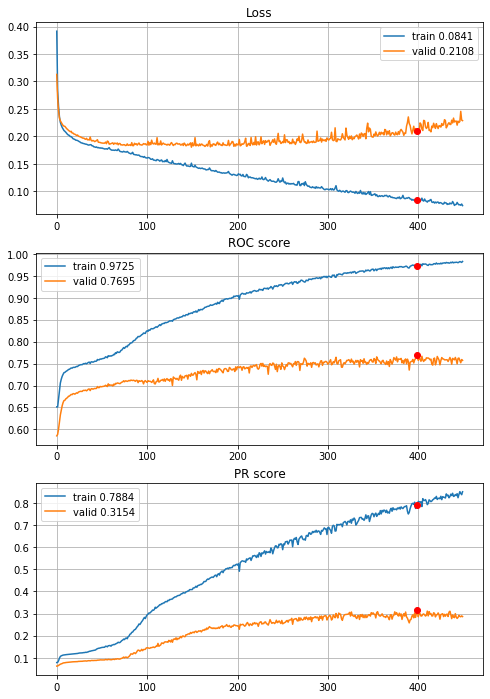


Fold 5------------------------------------------------------------


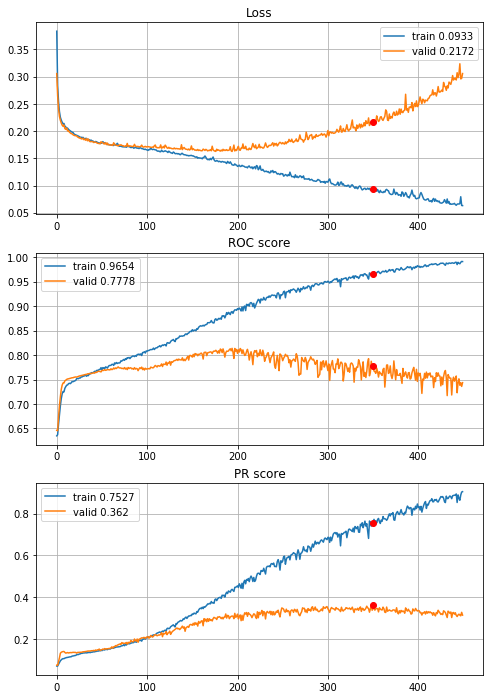


Fold 6------------------------------------------------------------


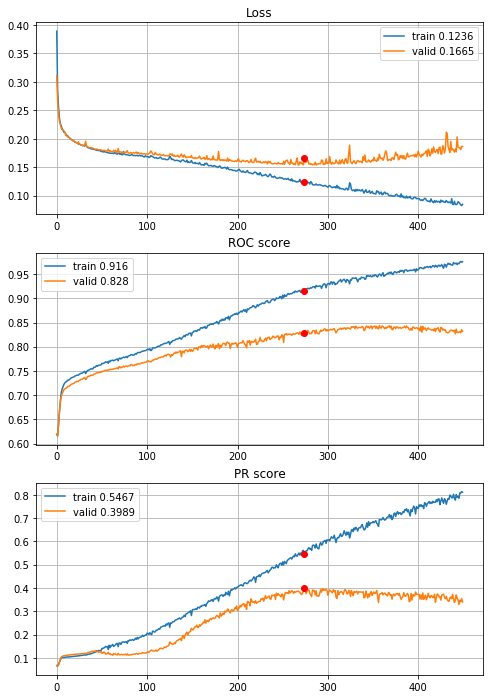

In [57]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_000025,
                                        features=features, target=target, n_epochs=450, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_deep_CNN_2inc_std_L1_000025_450ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

very little improvement, lets try the model created for 2 year horizon.

##### best 2 years horizon model

In [48]:
def define_deep_CNN_2inc_std_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/400,
cumulative time: 9.78s train loss: 0.2754750165950229, validation loss: 0.21416660398244858
Epoch: 2/400,
cumulative time: 11.25s train loss: 0.2033949290710152, validation loss: 0.19388222694396973
Epoch: 3/400,
cumulative time: 12.73s train loss: 0.1963091548503868, validation loss: 0.18904608115553856
Epoch: 4/400,
cumulative time: 14.19s train loss: 0.19161927353433694, validation loss: 0.18643852323293686
Epoch: 5/400,
cumulative time: 15.62s train loss: 0.19111636059652917, validation loss: 0.18404577672481537
Epoch: 6/400,
cumulative time: 17.07s train loss: 0.18800380707937428, validation loss: 0.1826179213821888
Epoch: 7/400,
cumulative time: 18.54s train loss: 0.18785698820092825, validation loss: 0.17981723323464394
Epoch: 8/400,
cumulative time: 20.0s train loss: 0.18487222461288141, validation loss: 0.17944857850670815
Epoch: 9/400,
cumulative time: 21.44s train loss: 0.18507891462

Epoch: 76/400,
cumulative time: 118.38s train loss: 0.17167768345879927, validation loss: 0.17033584415912628
Epoch: 77/400,
cumulative time: 119.84s train loss: 0.17182926361204526, validation loss: 0.16589626297354698
Epoch: 78/400,
cumulative time: 121.29s train loss: 0.17064283287210352, validation loss: 0.16553045064210892
Epoch: 79/400,
cumulative time: 122.75s train loss: 0.1696458085652473, validation loss: 0.16622089967131615
Epoch: 80/400,
cumulative time: 124.17s train loss: 0.1705108692556423, validation loss: 0.16481918469071388
Epoch: 81/400,
cumulative time: 125.64s train loss: 0.16898949418563175, validation loss: 0.16594050824642181
Epoch: 82/400,
cumulative time: 127.1s train loss: 0.17014016475530372, validation loss: 0.1644665189087391
Epoch: 83/400,
cumulative time: 128.58s train loss: 0.16879887318114692, validation loss: 0.16594359278678894
Epoch: 84/400,
cumulative time: 130.01s train loss: 0.16917964207068079, validation loss: 0.164269108325243
Epoch: 85/400,
c

Epoch: 151/400,
cumulative time: 227.85s train loss: 0.1466252553267731, validation loss: 0.1538008227944374
Epoch: 152/400,
cumulative time: 229.36s train loss: 0.14730830730680222, validation loss: 0.1534411981701851
Epoch: 153/400,
cumulative time: 230.84s train loss: 0.14446194271650212, validation loss: 0.15265341103076935
Epoch: 154/400,
cumulative time: 232.33s train loss: 0.14647731662114422, validation loss: 0.15277468785643578
Epoch: 155/400,
cumulative time: 233.85s train loss: 0.14535462185021522, validation loss: 0.15334881097078323
Epoch: 156/400,
cumulative time: 235.36s train loss: 0.1445081270095992, validation loss: 0.1536254994571209
Epoch: 157/400,
cumulative time: 236.9s train loss: 0.14476089971116377, validation loss: 0.1557442955672741
Epoch: 158/400,
cumulative time: 238.44s train loss: 0.14545333422550155, validation loss: 0.15214987099170685
Epoch: 159/400,
cumulative time: 239.9s train loss: 0.1431145946944105, validation loss: 0.15338119491934776
Epoch: 160

Epoch: 226/400,
cumulative time: 338.49s train loss: 0.11773643893350073, validation loss: 0.15322241932153702
Epoch: 227/400,
cumulative time: 339.93s train loss: 0.11871445397508211, validation loss: 0.1591971591114998
Epoch: 228/400,
cumulative time: 341.47s train loss: 0.11919363861673674, validation loss: 0.1543279103934765
Epoch: 229/400,
cumulative time: 342.9s train loss: 0.11789466363296042, validation loss: 0.16419176384806633
Epoch: 230/400,
cumulative time: 344.4s train loss: 0.12067991797280166, validation loss: 0.15765118598937988
Epoch: 231/400,
cumulative time: 345.92s train loss: 0.11662188593682267, validation loss: 0.15233374014496803
Epoch: 232/400,
cumulative time: 347.35s train loss: 0.1162415190134907, validation loss: 0.15713384002447128
Epoch: 233/400,
cumulative time: 348.82s train loss: 0.11705268059188852, validation loss: 0.15098215267062187
Epoch: 234/400,
cumulative time: 350.34s train loss: 0.11683465738687616, validation loss: 0.15602859109640121
Epoch:

Epoch: 301/400,
cumulative time: 452.08s train loss: 0.09875383647702683, validation loss: 0.16889510676264763
Epoch: 302/400,
cumulative time: 453.6s train loss: 0.09633714600985065, validation loss: 0.15976053103804588
Epoch: 303/400,
cumulative time: 455.13s train loss: 0.09659602096301459, validation loss: 0.16802812367677689
Epoch: 304/400,
cumulative time: 456.56s train loss: 0.09359557536719655, validation loss: 0.15804565697908401
Epoch: 305/400,
cumulative time: 458.05s train loss: 0.09060877804876645, validation loss: 0.161635160446167
Epoch: 306/400,
cumulative time: 459.49s train loss: 0.0938199657176793, validation loss: 0.16015305370092392
Epoch: 307/400,
cumulative time: 460.92s train loss: 0.09899659224002115, validation loss: 0.16699906811118126
Epoch: 308/400,
cumulative time: 462.39s train loss: 0.09950309627253795, validation loss: 0.16998759657144547
Epoch: 309/400,
cumulative time: 463.81s train loss: 0.09427453330237894, validation loss: 0.16580284386873245
Epoch

Epoch: 376/400,
cumulative time: 562.89s train loss: 0.07634786562592079, validation loss: 0.19686607643961906
Epoch: 377/400,
cumulative time: 564.36s train loss: 0.07328541366191399, validation loss: 0.1860271729528904
Epoch: 378/400,
cumulative time: 565.86s train loss: 0.07276489159850041, validation loss: 0.18406705930829048
Epoch: 379/400,
cumulative time: 567.33s train loss: 0.07641906537959393, validation loss: 0.1817452758550644
Epoch: 380/400,
cumulative time: 568.77s train loss: 0.07943382045115051, validation loss: 0.18003800511360168
Epoch: 381/400,
cumulative time: 570.31s train loss: 0.07709813500253636, validation loss: 0.19041192159056664
Epoch: 382/400,
cumulative time: 571.74s train loss: 0.07474542216957372, validation loss: 0.19054177030920982
Epoch: 383/400,
cumulative time: 573.2s train loss: 0.07493166819615919, validation loss: 0.18801243603229523
Epoch: 384/400,
cumulative time: 574.66s train loss: 0.07371713437609197, validation loss: 0.19332120567560196
Epoc

Epoch: 49/400,
cumulative time: 76.51s train loss: 0.17527203039356512, validation loss: 0.17586150392889977
Epoch: 50/400,
cumulative time: 77.98s train loss: 0.17470762757948657, validation loss: 0.17697158828377724
Epoch: 51/400,
cumulative time: 79.46s train loss: 0.17610572545456668, validation loss: 0.17631228268146515
Epoch: 52/400,
cumulative time: 80.93s train loss: 0.17525340695976604, validation loss: 0.177361398935318
Epoch: 53/400,
cumulative time: 82.39s train loss: 0.17595556940090662, validation loss: 0.17933312058448792
Epoch: 54/400,
cumulative time: 83.85s train loss: 0.17405951475661197, validation loss: 0.17618634924292564
Epoch: 55/400,
cumulative time: 85.33s train loss: 0.1745763159569385, validation loss: 0.17544637247920036
Epoch: 56/400,
cumulative time: 86.81s train loss: 0.17329499290460496, validation loss: 0.17543767020106316
Epoch: 57/400,
cumulative time: 88.31s train loss: 0.17320174972279354, validation loss: 0.17545219138264656
Epoch: 58/400,
cumulat

Epoch: 124/400,
cumulative time: 189.65s train loss: 0.1598830388422815, validation loss: 0.17313851043581963
Epoch: 125/400,
cumulative time: 191.44s train loss: 0.1588254062512794, validation loss: 0.17503974214196205
Epoch: 126/400,
cumulative time: 192.95s train loss: 0.15876515802240057, validation loss: 0.17326093465089798
Epoch: 127/400,
cumulative time: 194.45s train loss: 0.15680773101781093, validation loss: 0.17304617166519165
Epoch: 128/400,
cumulative time: 195.93s train loss: 0.1545044911080293, validation loss: 0.17483973130583763
Epoch: 129/400,
cumulative time: 197.42s train loss: 0.15618071770565106, validation loss: 0.17381233721971512
Epoch: 130/400,
cumulative time: 198.92s train loss: 0.15453791455259294, validation loss: 0.17550315335392952
Epoch: 131/400,
cumulative time: 200.46s train loss: 0.15846525584269502, validation loss: 0.17374761030077934
Epoch: 132/400,
cumulative time: 201.96s train loss: 0.1548982437580839, validation loss: 0.17364560812711716
Epoch

Epoch: 199/400,
cumulative time: 302.83s train loss: 0.1352399206512649, validation loss: 0.1775115579366684
Epoch: 200/400,
cumulative time: 304.32s train loss: 0.13595152887718637, validation loss: 0.17596189677715302
Epoch: 201/400,
cumulative time: 305.8s train loss: 0.13487598831245534, validation loss: 0.17619171738624573
Epoch: 202/400,
cumulative time: 307.28s train loss: 0.13324301443907013, validation loss: 0.17544889450073242
Epoch: 203/400,
cumulative time: 308.8s train loss: 0.13444302077256162, validation loss: 0.17616009339690208
Epoch: 204/400,
cumulative time: 310.36s train loss: 0.13342656738159317, validation loss: 0.1743975654244423
Epoch: 205/400,
cumulative time: 311.83s train loss: 0.13400223407725986, validation loss: 0.1788163222372532
Epoch: 206/400,
cumulative time: 313.31s train loss: 0.13509453331352553, validation loss: 0.18059199675917625
Epoch: 207/400,
cumulative time: 314.81s train loss: 0.1318866896630847, validation loss: 0.17610294744372368
Epoch: 2

Epoch: 274/400,
cumulative time: 416.74s train loss: 0.11572572870824227, validation loss: 0.18670977652072906
Epoch: 275/400,
cumulative time: 418.34s train loss: 0.1191093686527259, validation loss: 0.18383657932281494
Epoch: 276/400,
cumulative time: 419.87s train loss: 0.11638111908531783, validation loss: 0.18531039729714394
Epoch: 277/400,
cumulative time: 421.47s train loss: 0.11511159421088067, validation loss: 0.18933498486876488
Epoch: 278/400,
cumulative time: 423.01s train loss: 0.11476952776335532, validation loss: 0.1855289340019226
Epoch: 279/400,
cumulative time: 424.51s train loss: 0.1192124004046768, validation loss: 0.18932532146573067
Epoch: 280/400,
cumulative time: 426.02s train loss: 0.11928827998002754, validation loss: 0.1884523443877697
Epoch: 281/400,
cumulative time: 427.76s train loss: 0.11534660169925709, validation loss: 0.183927021920681
Epoch: 282/400,
cumulative time: 429.38s train loss: 0.11463544471591423, validation loss: 0.18568562343716621
Epoch: 

Epoch: 349/400,
cumulative time: 530.58s train loss: 0.09912384801755676, validation loss: 0.1993292085826397
Epoch: 350/400,
cumulative time: 532.05s train loss: 0.10329931665452197, validation loss: 0.1979636810719967
Epoch: 351/400,
cumulative time: 533.52s train loss: 0.10174742787546649, validation loss: 0.2070382982492447
Epoch: 352/400,
cumulative time: 535.01s train loss: 0.10139518374754064, validation loss: 0.2049776054918766
Epoch: 353/400,
cumulative time: 536.51s train loss: 0.10266334493869207, validation loss: 0.1985872946679592
Epoch: 354/400,
cumulative time: 537.98s train loss: 0.09834078393418695, validation loss: 0.20341230183839798
Epoch: 355/400,
cumulative time: 539.43s train loss: 0.09840450227570872, validation loss: 0.20909518003463745
Epoch: 356/400,
cumulative time: 540.93s train loss: 0.09965846263186286, validation loss: 0.2011643946170807
Epoch: 357/400,
cumulative time: 542.43s train loss: 0.10010010777102805, validation loss: 0.20299911499023438
Epoch: 

Epoch: 22/400,
cumulative time: 37.13s train loss: 0.18169376018750452, validation loss: 0.179663932701898
Epoch: 23/400,
cumulative time: 38.65s train loss: 0.18006013869535534, validation loss: 0.17652142221965486
Epoch: 24/400,
cumulative time: 40.16s train loss: 0.1801289135718597, validation loss: 0.17606635871387663
Epoch: 25/400,
cumulative time: 41.67s train loss: 0.17848006356779475, validation loss: 0.17582514914255293
Epoch: 26/400,
cumulative time: 43.25s train loss: 0.1792526417037656, validation loss: 0.1772522053075215
Epoch: 27/400,
cumulative time: 44.86s train loss: 0.18005265838810525, validation loss: 0.1762392852325288
Epoch: 28/400,
cumulative time: 46.43s train loss: 0.1791741588087089, validation loss: 0.17563289472981106
Epoch: 29/400,
cumulative time: 47.99s train loss: 0.18047705804793168, validation loss: 0.17524575424572778
Epoch: 30/400,
cumulative time: 49.6s train loss: 0.17861340960618488, validation loss: 0.17510743795879302
Epoch: 31/400,
cumulative t

Epoch: 98/400,
cumulative time: 155.79s train loss: 0.16431882226279473, validation loss: 0.16020667146122644
Epoch: 99/400,
cumulative time: 157.4s train loss: 0.16446569190044097, validation loss: 0.16222574250092583
Epoch: 100/400,
cumulative time: 158.99s train loss: 0.164587689525088, validation loss: 0.16112609179246992
Epoch: 101/400,
cumulative time: 160.53s train loss: 0.16310862878093232, validation loss: 0.15910348959385404
Epoch: 102/400,
cumulative time: 162.05s train loss: 0.16407836378907073, validation loss: 0.1591542685599554
Epoch: 103/400,
cumulative time: 163.69s train loss: 0.16359013879913598, validation loss: 0.15977713653965603
Epoch: 104/400,
cumulative time: 165.26s train loss: 0.16346686714128655, validation loss: 0.160497097420314
Epoch: 105/400,
cumulative time: 166.83s train loss: 0.1643860092301712, validation loss: 0.15853097211746942
Epoch: 106/400,
cumulative time: 168.35s train loss: 0.16409499510995956, validation loss: 0.1576880141288515
Epoch: 107/

Epoch: 173/400,
cumulative time: 271.73s train loss: 0.14185291878861098, validation loss: 0.15838527728640844
Epoch: 174/400,
cumulative time: 273.23s train loss: 0.14493624910842773, validation loss: 0.15480633692135887
Epoch: 175/400,
cumulative time: 274.85s train loss: 0.14229077557228356, validation loss: 0.1540691106943857
Epoch: 176/400,
cumulative time: 276.4s train loss: 0.14211941823047386, validation loss: 0.15862285403978257
Epoch: 177/400,
cumulative time: 277.97s train loss: 0.14345689885005197, validation loss: 0.1562028747229349
Epoch: 178/400,
cumulative time: 279.44s train loss: 0.1373511371299127, validation loss: 0.15363605170022873
Epoch: 179/400,
cumulative time: 280.93s train loss: 0.139150725614, validation loss: 0.15618437941112215
Epoch: 180/400,
cumulative time: 282.49s train loss: 0.1394153512513954, validation loss: 0.15352385824634915
Epoch: 181/400,
cumulative time: 284.01s train loss: 0.13823996014941295, validation loss: 0.15725417108762832
Epoch: 182/

Epoch: 248/400,
cumulative time: 385.59s train loss: 0.11610685657793546, validation loss: 0.1578211744626363
Epoch: 249/400,
cumulative time: 387.06s train loss: 0.1150701198274296, validation loss: 0.16014509293768142
Epoch: 250/400,
cumulative time: 388.59s train loss: 0.11287283423332238, validation loss: 0.15901149884102836
Epoch: 251/400,
cumulative time: 390.08s train loss: 0.11532444856475418, validation loss: 0.15973248882899208
Epoch: 252/400,
cumulative time: 391.59s train loss: 0.1140450304228672, validation loss: 0.16159990057112678
Epoch: 253/400,
cumulative time: 393.08s train loss: 0.11324914966014582, validation loss: 0.1600696920875519
Epoch: 254/400,
cumulative time: 394.56s train loss: 0.11107534621896002, validation loss: 0.15893040005176787
Epoch: 255/400,
cumulative time: 396.12s train loss: 0.11306201706603652, validation loss: 0.1585535684180638
Epoch: 256/400,
cumulative time: 397.73s train loss: 0.11461574443879279, validation loss: 0.15977629807260302
Epoch:

Epoch: 323/400,
cumulative time: 500.41s train loss: 0.09528286240723467, validation loss: 0.18135551663618238
Epoch: 324/400,
cumulative time: 501.98s train loss: 0.09475196918603414, validation loss: 0.17751979101271856
Epoch: 325/400,
cumulative time: 503.6s train loss: 0.09160033416892575, validation loss: 0.18933278835009015
Epoch: 326/400,
cumulative time: 505.09s train loss: 0.09443230144145133, validation loss: 0.19713297319790674
Epoch: 327/400,
cumulative time: 506.65s train loss: 0.09264906422504998, validation loss: 0.18246543714924465
Epoch: 328/400,
cumulative time: 508.2s train loss: 0.09139616843996366, validation loss: 0.1879033245453759
Epoch: 329/400,
cumulative time: 509.77s train loss: 0.08864400825824201, validation loss: 0.180339339394418
Epoch: 330/400,
cumulative time: 511.28s train loss: 0.09051281069799684, validation loss: 0.1875772827106809
Epoch: 331/400,
cumulative time: 512.8s train loss: 0.08879888243571263, validation loss: 0.1833759983286025
Epoch: 33

Epoch: 398/400,
cumulative time: 615.05s train loss: 0.07218713377659979, validation loss: 0.2179070360509176
Epoch: 399/400,
cumulative time: 616.54s train loss: 0.07296201757735765, validation loss: 0.22747596897776165
Epoch: 400/400,
cumulative time: 618.03s train loss: 0.07376687992749609, validation loss: 0.2268616505274697

Early stopping results:
best results in epoch: 233, 
best valid PR: 0.33542786297271143, 
valid ROC: 0.8428795217602679        
overfitting PR: 0.24755622889537532, 
overfitting ROC: 0.0879508364150069

----------
Fold: 4
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/400,
cumulative time: 4.6s train loss: 0.2859851360033502, validation loss: 0.21658458991656226
Epoch: 2/400,
cumulative time: 6.09s train loss: 0.20147142917110758, validation loss: 0.19821081452899508
Epoch: 3/400,
cumulative time: 7.65s train loss: 0.1960393393290925, validation loss: 0.19431287156211005
Epoch: 4/400,
cumulative time: 9.31s train loss: 0.19131115305744575,

Epoch: 71/400,
cumulative time: 124.42s train loss: 0.16656679023041615, validation loss: 0.18418537794597564
Epoch: 72/400,
cumulative time: 126.11s train loss: 0.16724185555912266, validation loss: 0.18097693921081603
Epoch: 73/400,
cumulative time: 127.76s train loss: 0.1648843966474596, validation loss: 0.18175627830482666
Epoch: 74/400,
cumulative time: 129.4s train loss: 0.16755771070578776, validation loss: 0.1812591735805784
Epoch: 75/400,
cumulative time: 131.11s train loss: 0.16740123021265146, validation loss: 0.1814751037056484
Epoch: 76/400,
cumulative time: 132.77s train loss: 0.16642552259323393, validation loss: 0.18154274166576445
Epoch: 77/400,
cumulative time: 134.4s train loss: 0.1641451011677752, validation loss: 0.18122970260324933
Epoch: 78/400,
cumulative time: 135.99s train loss: 0.16610745756861006, validation loss: 0.1811215447433411
Epoch: 79/400,
cumulative time: 137.58s train loss: 0.16681325949432432, validation loss: 0.18448338281540644
Epoch: 80/400,
cu

Epoch: 146/400,
cumulative time: 244.13s train loss: 0.13816734958027196, validation loss: 0.1795766260510399
Epoch: 147/400,
cumulative time: 245.69s train loss: 0.1369290118901064, validation loss: 0.17938018199943362
Epoch: 148/400,
cumulative time: 247.23s train loss: 0.13630163718014482, validation loss: 0.18322646367171455
Epoch: 149/400,
cumulative time: 248.75s train loss: 0.1359747894372192, validation loss: 0.18213075085291786
Epoch: 150/400,
cumulative time: 250.28s train loss: 0.13985970745735005, validation loss: 0.17663749300298237
Epoch: 151/400,
cumulative time: 251.8s train loss: 0.1359997219080336, validation loss: 0.18613673949052417
Epoch: 152/400,
cumulative time: 253.32s train loss: 0.13654358249351098, validation loss: 0.1776485597425037
Epoch: 153/400,
cumulative time: 254.81s train loss: 0.13522121010205612, validation loss: 0.1774811676854179
Epoch: 154/400,
cumulative time: 256.4s train loss: 0.13854003037514384, validation loss: 0.19624381267835223
Epoch: 15

Epoch: 221/400,
cumulative time: 358.46s train loss: 0.11102253209028175, validation loss: 0.1876249921321869
Epoch: 222/400,
cumulative time: 359.96s train loss: 0.11097049448670841, validation loss: 0.17597413711131565
Epoch: 223/400,
cumulative time: 361.5s train loss: 0.11108848471579946, validation loss: 0.18094852081366947
Epoch: 224/400,
cumulative time: 363.05s train loss: 0.11116552501122358, validation loss: 0.18228102069998545
Epoch: 225/400,
cumulative time: 364.6s train loss: 0.11286174204218005, validation loss: 0.17560010141796537
Epoch: 226/400,
cumulative time: 366.21s train loss: 0.11030935040373964, validation loss: 0.18403287395598397
Epoch: 227/400,
cumulative time: 367.77s train loss: 0.11380731506809692, validation loss: 0.1971697035289946
Epoch: 228/400,
cumulative time: 369.33s train loss: 0.11351999840609871, validation loss: 0.17596526411790697
Epoch: 229/400,
cumulative time: 370.93s train loss: 0.11054960695509532, validation loss: 0.1829237546523412
Epoch:

Epoch: 296/400,
cumulative time: 476.64s train loss: 0.0917866303816852, validation loss: 0.20558244920912244
Epoch: 297/400,
cumulative time: 478.22s train loss: 0.09117999691712428, validation loss: 0.19438308076253014
Epoch: 298/400,
cumulative time: 479.73s train loss: 0.08927649008440036, validation loss: 0.19498303498540606
Epoch: 299/400,
cumulative time: 481.26s train loss: 0.08958290248515265, validation loss: 0.1945409385930924
Epoch: 300/400,
cumulative time: 482.8s train loss: 0.08704886672304445, validation loss: 0.20347754030000595
Epoch: 301/400,
cumulative time: 484.37s train loss: 0.0917173248445063, validation loss: 0.18786156135892113
Epoch: 302/400,
cumulative time: 486.02s train loss: 0.08887952316722184, validation loss: 0.19250234603881836
Epoch: 303/400,
cumulative time: 487.58s train loss: 0.0891029707225761, validation loss: 0.1947547514098031
Epoch: 304/400,
cumulative time: 489.29s train loss: 0.09400709508767478, validation loss: 0.19196003840083167
Epoch: 

Epoch: 371/400,
cumulative time: 595.22s train loss: 0.07500441850245687, validation loss: 0.2224007373196738
Epoch: 372/400,
cumulative time: 596.75s train loss: 0.07371565419412043, validation loss: 0.2156158305160583
Epoch: 373/400,
cumulative time: 598.29s train loss: 0.07546511712610926, validation loss: 0.21500074428225321
Epoch: 374/400,
cumulative time: 599.81s train loss: 0.0728816614765662, validation loss: 0.21517994451144384
Epoch: 375/400,
cumulative time: 601.36s train loss: 0.07197101094028256, validation loss: 0.22280509645976718
Epoch: 376/400,
cumulative time: 602.88s train loss: 0.07264537975462587, validation loss: 0.23379229214456346
Epoch: 377/400,
cumulative time: 604.44s train loss: 0.07338208676337954, validation loss: 0.2146996641915942
Epoch: 378/400,
cumulative time: 605.99s train loss: 0.07181057461732623, validation loss: 0.21580529148616487
Epoch: 379/400,
cumulative time: 607.5s train loss: 0.07476100440790799, validation loss: 0.2239155904073564
Epoch: 

Epoch: 44/400,
cumulative time: 78.32s train loss: 0.17344145756415855, validation loss: 0.17288131815100474
Epoch: 45/400,
cumulative time: 79.93s train loss: 0.17332115381392366, validation loss: 0.1720448922637909
Epoch: 46/400,
cumulative time: 81.57s train loss: 0.17224968100004243, validation loss: 0.17278082469153025
Epoch: 47/400,
cumulative time: 83.17s train loss: 0.17476504467928095, validation loss: 0.17249086590986404
Epoch: 48/400,
cumulative time: 84.75s train loss: 0.17321548093253622, validation loss: 0.17211473835839167
Epoch: 49/400,
cumulative time: 86.33s train loss: 0.1720859156721692, validation loss: 0.1721011453772348
Epoch: 50/400,
cumulative time: 88.11s train loss: 0.17264871114444744, validation loss: 0.1765465012334642
Epoch: 51/400,
cumulative time: 90.17s train loss: 0.17233916104853841, validation loss: 0.17259529728738088
Epoch: 52/400,
cumulative time: 91.95s train loss: 0.17382838062386805, validation loss: 0.171617782759288
Epoch: 53/400,
cumulative

Epoch: 119/400,
cumulative time: 205.96s train loss: 0.15677147917094775, validation loss: 0.1688272118284589
Epoch: 120/400,
cumulative time: 207.55s train loss: 0.15914910604381102, validation loss: 0.17306788669692144
Epoch: 121/400,
cumulative time: 209.18s train loss: 0.15651955085992056, validation loss: 0.1679975204051487
Epoch: 122/400,
cumulative time: 210.81s train loss: 0.1553192357564012, validation loss: 0.1727755504846573
Epoch: 123/400,
cumulative time: 212.46s train loss: 0.1565674330088123, validation loss: 0.16808649267469133
Epoch: 124/400,
cumulative time: 214.14s train loss: 0.1541347613155471, validation loss: 0.16731311554946596
Epoch: 125/400,
cumulative time: 215.81s train loss: 0.1550660170288396, validation loss: 0.17271370416595822
Epoch: 126/400,
cumulative time: 217.49s train loss: 0.15405072351276564, validation loss: 0.1659445473693666
Epoch: 127/400,
cumulative time: 219.13s train loss: 0.15427683145507756, validation loss: 0.1671236927736373
Epoch: 128

Epoch: 194/400,
cumulative time: 327.58s train loss: 0.13110774250575033, validation loss: 0.16468963702519734
Epoch: 195/400,
cumulative time: 329.17s train loss: 0.13104197800431863, validation loss: 0.16067997841607956
Epoch: 196/400,
cumulative time: 330.78s train loss: 0.12940646638774292, validation loss: 0.16159279916967664
Epoch: 197/400,
cumulative time: 332.35s train loss: 0.12933462914006122, validation loss: 0.1678163901018718
Epoch: 198/400,
cumulative time: 333.95s train loss: 0.13203934057875455, validation loss: 0.1627146574902156
Epoch: 199/400,
cumulative time: 335.54s train loss: 0.12824797925136258, validation loss: 0.1612996581717143
Epoch: 200/400,
cumulative time: 337.13s train loss: 0.12902456595387057, validation loss: 0.16101378677383302
Epoch: 201/400,
cumulative time: 338.71s train loss: 0.12869647505456788, validation loss: 0.163762066477821
Epoch: 202/400,
cumulative time: 340.3s train loss: 0.1284538132757028, validation loss: 0.16530053150086177
Epoch: 2

Epoch: 269/400,
cumulative time: 446.55s train loss: 0.11265947147248526, validation loss: 0.1776355977474697
Epoch: 270/400,
cumulative time: 448.17s train loss: 0.1125471957611511, validation loss: 0.19520679650798675
Epoch: 271/400,
cumulative time: 449.75s train loss: 0.11198353850631161, validation loss: 0.18380001282881175
Epoch: 272/400,
cumulative time: 451.34s train loss: 0.10899193404731645, validation loss: 0.1748388805370482
Epoch: 273/400,
cumulative time: 452.91s train loss: 0.11004359939762129, validation loss: 0.17326791968610553
Epoch: 274/400,
cumulative time: 454.49s train loss: 0.1109235650539716, validation loss: 0.1755014001850098
Epoch: 275/400,
cumulative time: 456.08s train loss: 0.10879994383072572, validation loss: 0.18033753835965716
Epoch: 276/400,
cumulative time: 457.66s train loss: 0.1062656855613837, validation loss: 0.18151010480191973
Epoch: 277/400,
cumulative time: 459.23s train loss: 0.10771398409733815, validation loss: 0.18114386091156612
Epoch: 

Epoch: 344/400,
cumulative time: 565.55s train loss: 0.09130811019909023, validation loss: 0.2028808142741521
Epoch: 345/400,
cumulative time: 567.13s train loss: 0.09226144062537477, validation loss: 0.2207349527828277
Epoch: 346/400,
cumulative time: 568.72s train loss: 0.0936325175548865, validation loss: 0.2010915552434467
Epoch: 347/400,
cumulative time: 570.3s train loss: 0.09625768595099282, validation loss: 0.20179157353582836
Epoch: 348/400,
cumulative time: 571.91s train loss: 0.0956597376018441, validation loss: 0.20086171661104474
Epoch: 349/400,
cumulative time: 573.51s train loss: 0.09539591431356678, validation loss: 0.21163518360682895
Epoch: 350/400,
cumulative time: 575.15s train loss: 0.09012193188792, validation loss: 0.20886398786590213
Epoch: 351/400,
cumulative time: 576.72s train loss: 0.09159100716759805, validation loss: 0.20418974661637868
Epoch: 352/400,
cumulative time: 578.32s train loss: 0.08858206411318775, validation loss: 0.21590399119589063
Epoch: 353

Epoch: 17/400,
cumulative time: 30.08s train loss: 0.18133647685972917, validation loss: 0.17941570269683052
Epoch: 18/400,
cumulative time: 31.68s train loss: 0.18039325810756057, validation loss: 0.1792740581054536
Epoch: 19/400,
cumulative time: 33.27s train loss: 0.1806124677599967, validation loss: 0.1790875335250582
Epoch: 20/400,
cumulative time: 34.86s train loss: 0.18125330471471887, validation loss: 0.17915442578376287
Epoch: 21/400,
cumulative time: 36.45s train loss: 0.18045141608169937, validation loss: 0.1788127251749947
Epoch: 22/400,
cumulative time: 38.08s train loss: 0.18041422642304902, validation loss: 0.17875740186562614
Epoch: 23/400,
cumulative time: 39.69s train loss: 0.1799841650843363, validation loss: 0.1784350858888929
Epoch: 24/400,
cumulative time: 41.28s train loss: 0.1802486751994249, validation loss: 0.17836976298264096
Epoch: 25/400,
cumulative time: 42.87s train loss: 0.17835005280162472, validation loss: 0.18175169329794627
Epoch: 26/400,
cumulative 

Epoch: 93/400,
cumulative time: 151.98s train loss: 0.1663628158585075, validation loss: 0.16860961433440919
Epoch: 94/400,
cumulative time: 153.59s train loss: 0.16433824012163586, validation loss: 0.17017577085230084
Epoch: 95/400,
cumulative time: 155.19s train loss: 0.16541131213827606, validation loss: 0.16844229867534033
Epoch: 96/400,
cumulative time: 156.79s train loss: 0.16427146022818, validation loss: 0.16761809474892087
Epoch: 97/400,
cumulative time: 158.39s train loss: 0.1631522866842543, validation loss: 0.16743757080464136
Epoch: 98/400,
cumulative time: 159.96s train loss: 0.16307031134065675, validation loss: 0.16774148864405497
Epoch: 99/400,
cumulative time: 161.56s train loss: 0.1650130716910955, validation loss: 0.16731985474389696
Epoch: 100/400,
cumulative time: 163.16s train loss: 0.1641999666625297, validation loss: 0.16717239947546095
Epoch: 101/400,
cumulative time: 164.76s train loss: 0.1630834047641793, validation loss: 0.16827981867487468
Epoch: 102/400,


Epoch: 168/400,
cumulative time: 271.5s train loss: 0.14173956694746132, validation loss: 0.16246834604513077
Epoch: 169/400,
cumulative time: 273.12s train loss: 0.14230334510563503, validation loss: 0.1633154799446227
Epoch: 170/400,
cumulative time: 274.71s train loss: 0.1411021532398864, validation loss: 0.16416205954930138
Epoch: 171/400,
cumulative time: 276.3s train loss: 0.14130383809387373, validation loss: 0.16201087690535046
Epoch: 172/400,
cumulative time: 277.9s train loss: 0.14264798226416436, validation loss: 0.162930801539194
Epoch: 173/400,
cumulative time: 279.56s train loss: 0.1404211748326598, validation loss: 0.16247709262938725
Epoch: 174/400,
cumulative time: 281.13s train loss: 0.14165030539573048, validation loss: 0.16698320938481226
Epoch: 175/400,
cumulative time: 282.71s train loss: 0.14016035592266943, validation loss: 0.16378181827446772
Epoch: 176/400,
cumulative time: 284.29s train loss: 0.13890519224781667, validation loss: 0.1642299637529585
Epoch: 177

Epoch: 243/400,
cumulative time: 390.92s train loss: 0.12062114992275809, validation loss: 0.16650375191181424
Epoch: 244/400,
cumulative time: 392.53s train loss: 0.12181819704291148, validation loss: 0.17267549072939253
Epoch: 245/400,
cumulative time: 394.13s train loss: 0.11976099051170971, validation loss: 0.16686635479094492
Epoch: 246/400,
cumulative time: 395.71s train loss: 0.12000539383943332, validation loss: 0.16930253019408575
Epoch: 247/400,
cumulative time: 397.32s train loss: 0.12129308556305722, validation loss: 0.16647859564849307
Epoch: 248/400,
cumulative time: 398.91s train loss: 0.12260733196937268, validation loss: 0.17632131106323667
Epoch: 249/400,
cumulative time: 400.51s train loss: 0.1200758295768149, validation loss: 0.16619241670010582
Epoch: 250/400,
cumulative time: 402.12s train loss: 0.12034968152439834, validation loss: 0.16636707462015607
Epoch: 251/400,
cumulative time: 403.71s train loss: 0.1188964109427511, validation loss: 0.16829393893953354
Epo

Epoch: 318/400,
cumulative time: 510.06s train loss: 0.10054655482533076, validation loss: 0.18113792740163348
Epoch: 319/400,
cumulative time: 511.64s train loss: 0.10466560140163202, validation loss: 0.1758086626397239
Epoch: 320/400,
cumulative time: 513.24s train loss: 0.10236727481409273, validation loss: 0.18731368247478727
Epoch: 321/400,
cumulative time: 514.83s train loss: 0.10326908163038685, validation loss: 0.17551803033503274
Epoch: 322/400,
cumulative time: 516.42s train loss: 0.10450630371410471, validation loss: 0.18168354465847925
Epoch: 323/400,
cumulative time: 518.0s train loss: 0.10367907933872848, validation loss: 0.19016541683484636
Epoch: 324/400,
cumulative time: 519.59s train loss: 0.1006248937199696, validation loss: 0.19663448235345266
Epoch: 325/400,
cumulative time: 521.18s train loss: 0.10996197448196607, validation loss: 0.18610686287993478
Epoch: 326/400,
cumulative time: 522.75s train loss: 0.10149115176654579, validation loss: 0.18047631874917044
Epoc

Epoch: 393/400,
cumulative time: 629.1s train loss: 0.08106561426498479, validation loss: 0.22193890109894768
Epoch: 394/400,
cumulative time: 630.69s train loss: 0.08387729955178098, validation loss: 0.21338278649345277
Epoch: 395/400,
cumulative time: 632.27s train loss: 0.08076495884566405, validation loss: 0.2204510771187525
Epoch: 396/400,
cumulative time: 633.88s train loss: 0.08140313836263645, validation loss: 0.2226057928800583
Epoch: 397/400,
cumulative time: 635.48s train loss: 0.08130076196921028, validation loss: 0.22998530670763953
Epoch: 398/400,
cumulative time: 637.07s train loss: 0.08038820863485155, validation loss: 0.2365575494841924
Epoch: 399/400,
cumulative time: 638.66s train loss: 0.08120219153230893, validation loss: 0.22037146099976132
Epoch: 400/400,
cumulative time: 640.25s train loss: 0.08074158343647403, validation loss: 0.22833802888317714

Early stopping results:
best results in epoch: 302, 
best valid PR: 0.33852315823672086, 
valid ROC: 0.797324306318

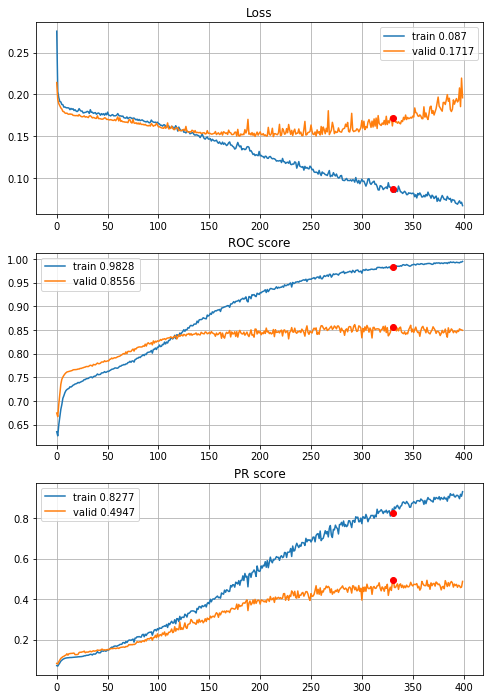


Fold 2------------------------------------------------------------


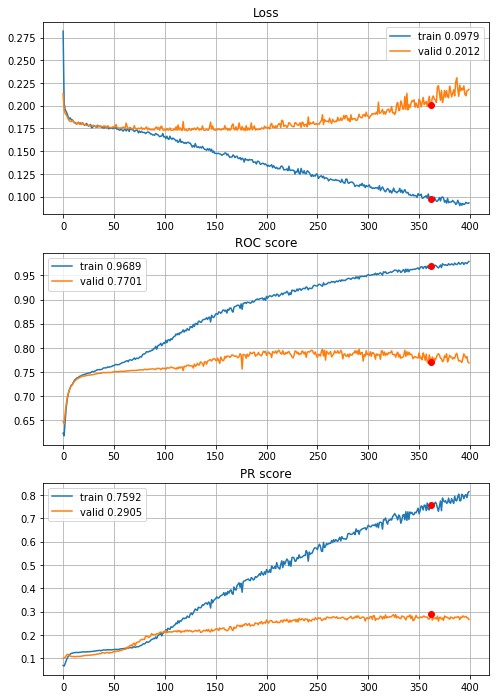


Fold 3------------------------------------------------------------


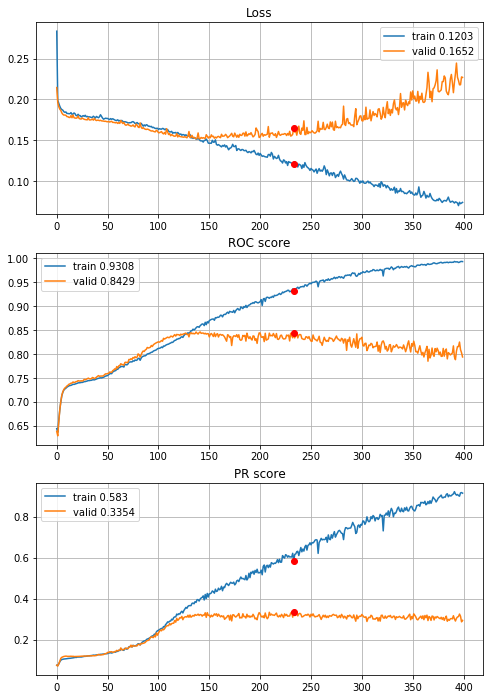


Fold 4------------------------------------------------------------


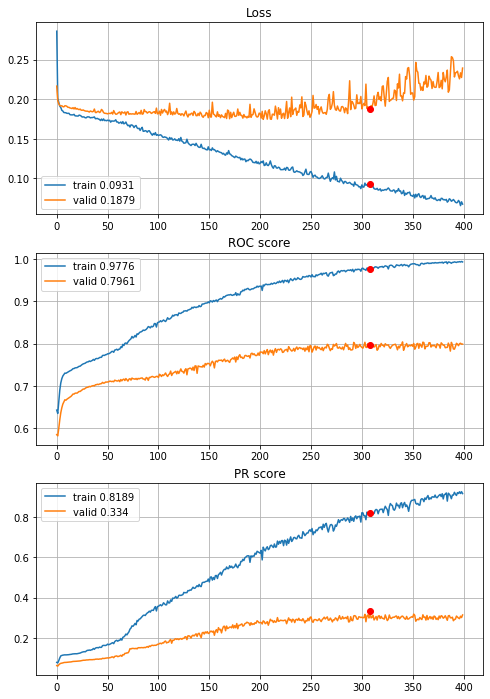


Fold 5------------------------------------------------------------


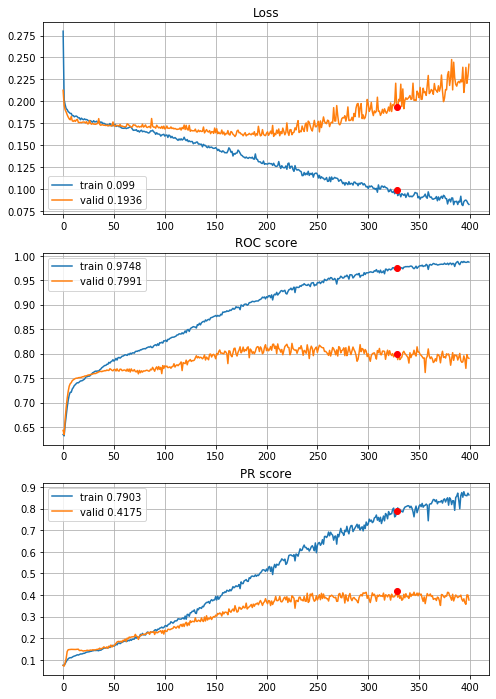


Fold 6------------------------------------------------------------


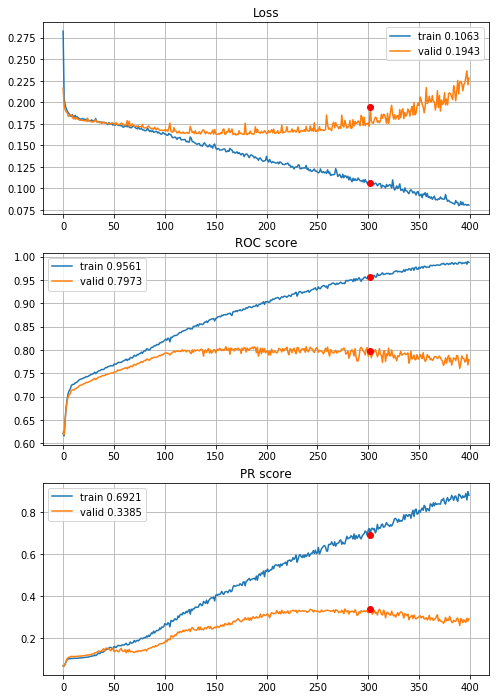

In [59]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_deep_CNN_2inc_std_L2_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

There is little improvement and the model achived the best results so far, but lets try some experimets with basic convolutional model, without inceptions.

##### Basic model experiments
First lets try the model on more epochs, 400.


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/400,
cumulative time: 2.7s train loss: 0.2042368260652599, validation loss: 0.1907627284526825
Epoch: 2/400,
cumulative time: 4.48s train loss: 0.1968662514752879, validation loss: 0.17974673956632614
Epoch: 3/400,
cumulative time: 6.2s train loss: 0.1853396226422565, validation loss: 0.17728006094694138
Epoch: 4/400,
cumulative time: 7.96s train loss: 0.1855705175539332, validation loss: 0.20352431759238243
Epoch: 5/400,
cumulative time: 9.74s train loss: 0.1822207137552568, validation loss: 0.17488578706979752
Epoch: 6/400,
cumulative time: 11.55s train loss: 0.17845283127250317, validation loss: 0.17404935136437416
Epoch: 7/400,
cumulative time: 13.35s train loss: 0.18095557337533164, validation loss: 0.17532630637288094
Epoch: 8/400,
cumulative time: 15.07s train loss: 0.17846576004100367, validation loss: 0.17917050048708916
Epoch: 9/400,
cumulative time: 16.93s train loss: 0.17659388478408314,

Epoch: 76/400,
cumulative time: 137.22s train loss: 0.0912284793085317, validation loss: 0.1531345397233963
Epoch: 77/400,
cumulative time: 138.94s train loss: 0.09175104089175885, validation loss: 0.15622608736157417
Epoch: 78/400,
cumulative time: 140.65s train loss: 0.09803788700325952, validation loss: 0.14565468579530716
Epoch: 79/400,
cumulative time: 142.61s train loss: 0.09159218713569271, validation loss: 0.15160774812102318
Epoch: 80/400,
cumulative time: 144.45s train loss: 0.08792778758030365, validation loss: 0.1756019964814186
Epoch: 81/400,
cumulative time: 146.17s train loss: 0.08358413407010527, validation loss: 0.15647628530859947
Epoch: 82/400,
cumulative time: 148.01s train loss: 0.09066180043667933, validation loss: 0.16007831320166588
Epoch: 83/400,
cumulative time: 149.94s train loss: 0.0893400309261156, validation loss: 0.16529325023293495
Epoch: 84/400,
cumulative time: 151.68s train loss: 0.08567259410645013, validation loss: 0.2050778903067112
Epoch: 85/400,


Epoch: 151/400,
cumulative time: 281.15s train loss: 0.060179572207157896, validation loss: 0.2168029546737671
Epoch: 152/400,
cumulative time: 283.0s train loss: 0.02667358771608381, validation loss: 0.23900366574525833
Epoch: 153/400,
cumulative time: 284.84s train loss: 0.033629274106910384, validation loss: 0.33093537390232086
Epoch: 154/400,
cumulative time: 286.71s train loss: 0.04228545535391754, validation loss: 0.2347419634461403
Epoch: 155/400,
cumulative time: 288.63s train loss: 0.035518486625309174, validation loss: 0.22519202530384064
Epoch: 156/400,
cumulative time: 290.46s train loss: 0.04418854997859896, validation loss: 0.2691512852907181
Epoch: 157/400,
cumulative time: 292.32s train loss: 0.04484145761831248, validation loss: 0.2026401199400425
Epoch: 158/400,
cumulative time: 294.17s train loss: 0.02688621670772062, validation loss: 0.2432873696088791
Epoch: 159/400,
cumulative time: 296.02s train loss: 0.03230504775840795, validation loss: 0.21805357187986374
Epoc

Epoch: 225/400,
cumulative time: 422.86s train loss: 0.017336559873734118, validation loss: 0.26474592462182045
Epoch: 226/400,
cumulative time: 424.66s train loss: 0.023759987410427525, validation loss: 0.2755703628063202
Epoch: 227/400,
cumulative time: 426.52s train loss: 0.02169950687532361, validation loss: 0.29100456088781357
Epoch: 228/400,
cumulative time: 428.24s train loss: 0.011687444653818473, validation loss: 0.2714315764605999
Epoch: 229/400,
cumulative time: 429.96s train loss: 0.02767724427799569, validation loss: 0.2648256681859493
Epoch: 230/400,
cumulative time: 431.68s train loss: 0.011094470790122888, validation loss: 0.43096837401390076
Epoch: 231/400,
cumulative time: 433.45s train loss: 0.028901166157842387, validation loss: 0.3141816481947899
Epoch: 232/400,
cumulative time: 435.18s train loss: 0.022911618772854886, validation loss: 0.30794961005449295
Epoch: 233/400,
cumulative time: 436.94s train loss: 0.01086730590683052, validation loss: 0.33146219700574875

Epoch: 299/400,
cumulative time: 552.23s train loss: 0.02571359492778431, validation loss: 0.32623717933893204
Epoch: 300/400,
cumulative time: 553.98s train loss: 0.008357472019787399, validation loss: 0.29477933421730995
Epoch: 301/400,
cumulative time: 555.72s train loss: 0.00830745268083644, validation loss: 0.2914072796702385
Epoch: 302/400,
cumulative time: 557.44s train loss: 0.01657949184093444, validation loss: 0.2759730778634548
Epoch: 303/400,
cumulative time: 559.18s train loss: 0.02512747778219288, validation loss: 0.31913913786411285
Epoch: 304/400,
cumulative time: 560.93s train loss: 0.006175976356462712, validation loss: 0.2899927720427513
Epoch: 305/400,
cumulative time: 562.67s train loss: 0.020938727150003614, validation loss: 0.29783909767866135
Epoch: 306/400,
cumulative time: 564.4s train loss: 0.01676305437812862, validation loss: 0.4838419333100319
Epoch: 307/400,
cumulative time: 566.14s train loss: 0.015193230701056631, validation loss: 0.29919368028640747
Ep

Epoch: 373/400,
cumulative time: 680.11s train loss: 0.010330878929275245, validation loss: 0.3071846142411232
Epoch: 374/400,
cumulative time: 681.8s train loss: 0.006800791852513434, validation loss: 0.31150010228157043
Epoch: 375/400,
cumulative time: 683.47s train loss: 0.01840619048549604, validation loss: 0.30687232688069344
Epoch: 376/400,
cumulative time: 685.18s train loss: 0.008866080825374103, validation loss: 0.3042333237826824
Epoch: 377/400,
cumulative time: 686.88s train loss: 0.004642096892351447, validation loss: 0.36261720210313797
Epoch: 378/400,
cumulative time: 688.57s train loss: 0.02056617949700949, validation loss: 0.3030977211892605
Epoch: 379/400,
cumulative time: 690.28s train loss: 0.016369641865427435, validation loss: 0.3021712973713875
Epoch: 380/400,
cumulative time: 691.97s train loss: 0.004366945448334964, validation loss: 0.31416478753089905
Epoch: 381/400,
cumulative time: 693.64s train loss: 0.024130612219068464, validation loss: 0.30981385707855225

Epoch: 46/400,
cumulative time: 78.16s train loss: 0.12097570474920326, validation loss: 0.1649966910481453
Epoch: 47/400,
cumulative time: 79.83s train loss: 0.1276126370692901, validation loss: 0.16618254408240318
Epoch: 48/400,
cumulative time: 81.49s train loss: 0.11972543992832446, validation loss: 0.17014051973819733
Epoch: 49/400,
cumulative time: 83.18s train loss: 0.11653275918376331, validation loss: 0.17334526404738426
Epoch: 50/400,
cumulative time: 84.83s train loss: 0.1152852574744583, validation loss: 0.19856838509440422
Epoch: 51/400,
cumulative time: 86.53s train loss: 0.11734001043902066, validation loss: 0.1715700998902321
Epoch: 52/400,
cumulative time: 88.19s train loss: 0.10920369777205996, validation loss: 0.18560361117124557
Epoch: 53/400,
cumulative time: 89.88s train loss: 0.11681762885788542, validation loss: 0.1671847365796566
Epoch: 54/400,
cumulative time: 91.55s train loss: 0.10556095198493066, validation loss: 0.17524117231369019
Epoch: 55/400,
cumulativ

Epoch: 121/400,
cumulative time: 204.48s train loss: 0.040925571335022705, validation loss: 0.2684873081743717
Epoch: 122/400,
cumulative time: 206.16s train loss: 0.03875161442478079, validation loss: 0.30418602749705315
Epoch: 123/400,
cumulative time: 207.88s train loss: 0.04749059614523443, validation loss: 0.2950140945613384
Epoch: 124/400,
cumulative time: 209.57s train loss: 0.038652325068198906, validation loss: 0.2582099661231041
Epoch: 125/400,
cumulative time: 211.25s train loss: 0.052623069287245125, validation loss: 0.2558928057551384
Epoch: 126/400,
cumulative time: 212.93s train loss: 0.03806792517131646, validation loss: 0.25438229739665985
Epoch: 127/400,
cumulative time: 214.62s train loss: 0.050191193206047514, validation loss: 0.2757110819220543
Epoch: 128/400,
cumulative time: 216.33s train loss: 0.03707660516887646, validation loss: 0.2642855606973171
Epoch: 129/400,
cumulative time: 218.01s train loss: 0.037299276925311244, validation loss: 0.27047013118863106
Ep

Epoch: 196/400,
cumulative time: 331.18s train loss: 0.026363903221389522, validation loss: 0.3481467291712761
Epoch: 197/400,
cumulative time: 332.87s train loss: 0.02098129139437424, validation loss: 0.411514587700367
Epoch: 198/400,
cumulative time: 334.53s train loss: 0.01620405189152107, validation loss: 0.34948423504829407
Epoch: 199/400,
cumulative time: 336.2s train loss: 0.03653097102519526, validation loss: 0.33459199219942093
Epoch: 200/400,
cumulative time: 337.88s train loss: 0.009194362594416377, validation loss: 0.3605475127696991
Epoch: 201/400,
cumulative time: 339.56s train loss: 0.03271173853086617, validation loss: 0.33865048736333847
Epoch: 202/400,
cumulative time: 341.23s train loss: 0.011739915500346755, validation loss: 0.33840857446193695
Epoch: 203/400,
cumulative time: 342.91s train loss: 0.024435047727762147, validation loss: 0.3454367071390152
Epoch: 204/400,
cumulative time: 344.63s train loss: 0.026237423543062927, validation loss: 0.3443218395113945
Epo

Epoch: 270/400,
cumulative time: 456.08s train loss: 0.008259875863030649, validation loss: 0.37865041196346283
Epoch: 271/400,
cumulative time: 457.77s train loss: 0.02083407921982984, validation loss: 0.3717154636979103
Epoch: 272/400,
cumulative time: 459.43s train loss: 0.023798357717423956, validation loss: 0.423745259642601
Epoch: 273/400,
cumulative time: 461.12s train loss: 0.008030921814887779, validation loss: 0.3751854747533798
Epoch: 274/400,
cumulative time: 462.79s train loss: 0.006201043486329805, validation loss: 0.4013325348496437
Epoch: 275/400,
cumulative time: 464.45s train loss: 0.017909832642562195, validation loss: 0.3922222852706909
Epoch: 276/400,
cumulative time: 466.14s train loss: 0.013348863259338149, validation loss: 0.4184461310505867
Epoch: 277/400,
cumulative time: 467.84s train loss: 0.014295323993137423, validation loss: 0.43142253160476685
Epoch: 278/400,
cumulative time: 469.53s train loss: 0.010379849864466936, validation loss: 0.409458190202713
Ep

Epoch: 344/400,
cumulative time: 584.2s train loss: 0.007932659614591284, validation loss: 0.4057934582233429
Epoch: 345/400,
cumulative time: 585.9s train loss: 0.01588423878728772, validation loss: 0.4031299501657486
Epoch: 346/400,
cumulative time: 587.59s train loss: 0.008938924293152026, validation loss: 0.40941454470157623
Epoch: 347/400,
cumulative time: 589.28s train loss: 0.008926094041782757, validation loss: 0.39971959590911865
Epoch: 348/400,
cumulative time: 590.97s train loss: 0.009045823342036177, validation loss: 0.4078288823366165
Epoch: 349/400,
cumulative time: 592.74s train loss: 0.023800274707362058, validation loss: 0.36863694339990616
Epoch: 350/400,
cumulative time: 594.42s train loss: 0.005384197034971215, validation loss: 0.38476113229990005
Epoch: 351/400,
cumulative time: 596.12s train loss: 0.005054902630119545, validation loss: 0.4335029646754265
Epoch: 352/400,
cumulative time: 597.82s train loss: 0.011491604442774413, validation loss: 0.40144462138414383

Epoch: 16/400,
cumulative time: 27.75s train loss: 0.17048926326667685, validation loss: 0.16414787554551685
Epoch: 17/400,
cumulative time: 29.41s train loss: 0.16625337997233638, validation loss: 0.16326794429430885
Epoch: 18/400,
cumulative time: 31.09s train loss: 0.1654288584494842, validation loss: 0.16405912348202298
Epoch: 19/400,
cumulative time: 33.0s train loss: 0.16348997979194693, validation loss: 0.162621127944144
Epoch: 20/400,
cumulative time: 34.75s train loss: 0.16474319678341448, validation loss: 0.1613098439810768
Epoch: 21/400,
cumulative time: 36.48s train loss: 0.16145413524346014, validation loss: 0.15698967400997405
Epoch: 22/400,
cumulative time: 38.22s train loss: 0.15932216922522832, validation loss: 0.1548675419224633
Epoch: 23/400,
cumulative time: 39.98s train loss: 0.15505815232762593, validation loss: 0.15460949652724795
Epoch: 24/400,
cumulative time: 41.72s train loss: 0.15568059518833036, validation loss: 0.1542499892295353
Epoch: 25/400,
cumulative 

Epoch: 92/400,
cumulative time: 156.92s train loss: 0.06953403678312056, validation loss: 0.16587260372108883
Epoch: 93/400,
cumulative time: 158.62s train loss: 0.07116304608826879, validation loss: 0.18213501688033815
Epoch: 94/400,
cumulative time: 160.29s train loss: 0.07190263746061558, validation loss: 0.17742413269148932
Epoch: 95/400,
cumulative time: 161.99s train loss: 0.07183162632266005, validation loss: 0.21538923736602542
Epoch: 96/400,
cumulative time: 163.69s train loss: 0.05291267899141119, validation loss: 0.22255926258034175
Epoch: 97/400,
cumulative time: 165.38s train loss: 0.06267562453722884, validation loss: 0.16794702232830108
Epoch: 98/400,
cumulative time: 167.05s train loss: 0.062412924764724466, validation loss: 0.18233197328590212
Epoch: 99/400,
cumulative time: 168.75s train loss: 0.06804475217908186, validation loss: 0.17398210628638192
Epoch: 100/400,
cumulative time: 170.45s train loss: 0.07089425490806592, validation loss: 0.1720657152315927
Epoch: 10

Epoch: 167/400,
cumulative time: 283.35s train loss: 0.02424605407593546, validation loss: 0.2580668985275995
Epoch: 168/400,
cumulative time: 285.04s train loss: 0.026923704738339122, validation loss: 0.2389364246905796
Epoch: 169/400,
cumulative time: 286.7s train loss: 0.020450888531346627, validation loss: 0.22796497776394797
Epoch: 170/400,
cumulative time: 288.38s train loss: 0.03953199924032587, validation loss: 0.22277163373099432
Epoch: 171/400,
cumulative time: 290.05s train loss: 0.02651939845741007, validation loss: 0.2620234445352403
Epoch: 172/400,
cumulative time: 291.73s train loss: 0.027490123307978658, validation loss: 0.2487192407865373
Epoch: 173/400,
cumulative time: 293.38s train loss: 0.03025069346502934, validation loss: 0.3102780879489959
Epoch: 174/400,
cumulative time: 295.07s train loss: 0.020157486312181207, validation loss: 0.24958241577186283
Epoch: 175/400,
cumulative time: 296.74s train loss: 0.027403896457038706, validation loss: 0.24262048494248162
Ep

Epoch: 241/400,
cumulative time: 407.54s train loss: 0.0129653467628172, validation loss: 0.2866907673222678
Epoch: 242/400,
cumulative time: 409.21s train loss: 0.02242811787650046, validation loss: 0.2565410206052992
Epoch: 243/400,
cumulative time: 410.9s train loss: 0.012515724523184389, validation loss: 0.32118824847160826
Epoch: 244/400,
cumulative time: 412.59s train loss: 0.015662401460226537, validation loss: 0.2965403142807976
Epoch: 245/400,
cumulative time: 414.25s train loss: 0.019577659648921497, validation loss: 0.30408936674632725
Epoch: 246/400,
cumulative time: 415.93s train loss: 0.01017355213038244, validation loss: 0.2675121381736937
Epoch: 247/400,
cumulative time: 417.59s train loss: 0.02154581026792251, validation loss: 0.2755912608381302
Epoch: 248/400,
cumulative time: 419.42s train loss: 0.013025367560031352, validation loss: 0.2684510828578283
Epoch: 249/400,
cumulative time: 421.1s train loss: 0.02023730530009306, validation loss: 0.27006143263408117
Epoch:

Epoch: 315/400,
cumulative time: 531.95s train loss: 0.01567610111976674, validation loss: 0.3016308980139475
Epoch: 316/400,
cumulative time: 533.63s train loss: 0.010171209579865476, validation loss: 0.3045182391196962
Epoch: 317/400,
cumulative time: 535.32s train loss: 0.020590454895336993, validation loss: 0.29889689727435037
Epoch: 318/400,
cumulative time: 537.01s train loss: 0.02291414440996196, validation loss: 0.3207774291341267
Epoch: 319/400,
cumulative time: 538.7s train loss: 0.005730261200982441, validation loss: 0.2999855137060559
Epoch: 320/400,
cumulative time: 540.4s train loss: 0.008712149180202444, validation loss: 0.2877711272618127
Epoch: 321/400,
cumulative time: 542.08s train loss: 0.01655153210575897, validation loss: 0.2930962499928853
Epoch: 322/400,
cumulative time: 543.77s train loss: 0.008771142661755946, validation loss: 0.2888438486106812
Epoch: 323/400,
cumulative time: 545.44s train loss: 0.014559173321409226, validation loss: 0.2908494744225154
Epoch

Epoch: 389/400,
cumulative time: 656.07s train loss: 0.005876899326196035, validation loss: 0.29298321572561115
Epoch: 390/400,
cumulative time: 657.75s train loss: 0.015564769377410368, validation loss: 0.3046410304213327
Epoch: 391/400,
cumulative time: 659.44s train loss: 0.012500745737386028, validation loss: 0.29460615466511436
Epoch: 392/400,
cumulative time: 661.11s train loss: 0.0030332937843681905, validation loss: 0.3264256224556575
Epoch: 393/400,
cumulative time: 662.77s train loss: 0.01644290004735932, validation loss: 0.269941184445033
Epoch: 394/400,
cumulative time: 664.45s train loss: 0.0037907431005222763, validation loss: 0.3375383237051585
Epoch: 395/400,
cumulative time: 666.13s train loss: 0.007714682869517165, validation loss: 0.33872431722898333
Epoch: 396/400,
cumulative time: 667.81s train loss: 0.014650034422115304, validation loss: 0.3021497845460498
Epoch: 397/400,
cumulative time: 669.51s train loss: 0.0051824444048338995, validation loss: 0.29866464011252

Epoch: 62/400,
cumulative time: 104.76s train loss: 0.10896457577642335, validation loss: 0.16586653905255455
Epoch: 63/400,
cumulative time: 106.44s train loss: 0.0992676811896939, validation loss: 0.18448382391816093
Epoch: 64/400,
cumulative time: 108.11s train loss: 0.1099740356893592, validation loss: 0.16099728871905614
Epoch: 65/400,
cumulative time: 109.78s train loss: 0.09496651440139983, validation loss: 0.1796756311541512
Epoch: 66/400,
cumulative time: 111.44s train loss: 0.10698165427961975, validation loss: 0.1782087157737641
Epoch: 67/400,
cumulative time: 113.12s train loss: 0.09284015883115458, validation loss: 0.18597637656189148
Epoch: 68/400,
cumulative time: 114.79s train loss: 0.10348720118163185, validation loss: 0.163887816535102
Epoch: 69/400,
cumulative time: 116.46s train loss: 0.09244357742406063, validation loss: 0.1736475617639602
Epoch: 70/400,
cumulative time: 118.12s train loss: 0.10005927131372583, validation loss: 0.17411106284648653
Epoch: 71/400,
cu

Epoch: 137/400,
cumulative time: 230.63s train loss: 0.044179427532661956, validation loss: 0.2992866067091624
Epoch: 138/400,
cumulative time: 232.32s train loss: 0.050993676226072024, validation loss: 0.23431931963042607
Epoch: 139/400,
cumulative time: 233.99s train loss: 0.040816868201959434, validation loss: 0.2631027132745773
Epoch: 140/400,
cumulative time: 235.67s train loss: 0.040436351614353605, validation loss: 0.24904229807475256
Epoch: 141/400,
cumulative time: 237.34s train loss: 0.04486938858099951, validation loss: 0.2586177155517396
Epoch: 142/400,
cumulative time: 239.02s train loss: 0.04841940144545856, validation loss: 0.23314418601611303
Epoch: 143/400,
cumulative time: 240.7s train loss: 0.049369396858217146, validation loss: 0.23809519536911494
Epoch: 144/400,
cumulative time: 242.39s train loss: 0.040468205373520943, validation loss: 0.24464464244388398
Epoch: 145/400,
cumulative time: 244.06s train loss: 0.03278205753407518, validation loss: 0.2478152244810074


Epoch: 211/400,
cumulative time: 354.26s train loss: 0.026604327131478925, validation loss: 0.31994287646006025
Epoch: 212/400,
cumulative time: 355.91s train loss: 0.011861554073860072, validation loss: 0.32445044655648486
Epoch: 213/400,
cumulative time: 357.58s train loss: 0.027396475731895194, validation loss: 0.3139288814294906
Epoch: 214/400,
cumulative time: 359.25s train loss: 0.021866316156741103, validation loss: 0.32942025462786356
Epoch: 215/400,
cumulative time: 360.91s train loss: 0.024354882717973914, validation loss: 0.3146909292538961
Epoch: 216/400,
cumulative time: 362.58s train loss: 0.013758317071242643, validation loss: 0.31763505570472234
Epoch: 217/400,
cumulative time: 364.25s train loss: 0.03175659710671424, validation loss: 0.3148364175879766
Epoch: 218/400,
cumulative time: 365.93s train loss: 0.019843253861853594, validation loss: 0.3262953958435664
Epoch: 219/400,
cumulative time: 367.62s train loss: 0.02501691848585155, validation loss: 0.3287386528840140

Epoch: 285/400,
cumulative time: 477.8s train loss: 0.010268028025082998, validation loss: 0.39956485805057346
Epoch: 286/400,
cumulative time: 479.47s train loss: 0.01099703716405549, validation loss: 0.38406048560899403
Epoch: 287/400,
cumulative time: 481.13s train loss: 0.022421842691557968, validation loss: 0.3545608187289465
Epoch: 288/400,
cumulative time: 482.8s train loss: 0.013630675068235086, validation loss: 0.3470214279303475
Epoch: 289/400,
cumulative time: 484.46s train loss: 0.018712553388109367, validation loss: 0.34258607094250026
Epoch: 290/400,
cumulative time: 486.13s train loss: 0.007410134165583258, validation loss: 0.3518556668834081
Epoch: 291/400,
cumulative time: 487.81s train loss: 0.03181204256494838, validation loss: 0.3541949030709645
Epoch: 292/400,
cumulative time: 489.46s train loss: 0.005390345353514459, validation loss: 0.34805315301531836
Epoch: 293/400,
cumulative time: 491.13s train loss: 0.016238489265031537, validation loss: 0.3519756232935285
E

Epoch: 359/400,
cumulative time: 601.8s train loss: 0.012330727338323518, validation loss: 0.38677853048793853
Epoch: 360/400,
cumulative time: 603.47s train loss: 0.0059998921957600026, validation loss: 0.4014582046062227
Epoch: 361/400,
cumulative time: 605.15s train loss: 0.019223853501722277, validation loss: 0.35853658664794197
Epoch: 362/400,
cumulative time: 606.81s train loss: 0.0036300846645067036, validation loss: 0.3735409224033356
Epoch: 363/400,
cumulative time: 608.5s train loss: 0.01074351137342889, validation loss: 0.38372211927459354
Epoch: 364/400,
cumulative time: 610.16s train loss: 0.012279654027409029, validation loss: 0.38611072805192737
Epoch: 365/400,
cumulative time: 611.83s train loss: 0.007096892580461744, validation loss: 0.3847220325848413
Epoch: 366/400,
cumulative time: 613.5s train loss: 0.009209384528639664, validation loss: 0.41208111498090955
Epoch: 367/400,
cumulative time: 615.18s train loss: 0.009225026590748912, validation loss: 0.407574251814494

Epoch: 32/400,
cumulative time: 61.97s train loss: 0.147925452968978, validation loss: 0.15783615068783835
Epoch: 33/400,
cumulative time: 63.89s train loss: 0.15047569667701266, validation loss: 0.16097310592257788
Epoch: 34/400,
cumulative time: 65.7s train loss: 0.14852507081380786, validation loss: 0.18488906447849576
Epoch: 35/400,
cumulative time: 67.48s train loss: 0.14508563717662856, validation loss: 0.16191379292616767
Epoch: 36/400,
cumulative time: 69.32s train loss: 0.14532090833897032, validation loss: 0.1594371717884427
Epoch: 37/400,
cumulative time: 71.17s train loss: 0.1423625357489727, validation loss: 0.17190631352719807
Epoch: 38/400,
cumulative time: 73.03s train loss: 0.14048502300730573, validation loss: 0.17367020684575277
Epoch: 39/400,
cumulative time: 74.83s train loss: 0.14289642351902845, validation loss: 0.16586773894135914
Epoch: 40/400,
cumulative time: 76.67s train loss: 0.1429360156848798, validation loss: 0.15707802090379927
Epoch: 41/400,
cumulative

Epoch: 108/400,
cumulative time: 199.35s train loss: 0.06990665224613356, validation loss: 0.24909393866856894
Epoch: 109/400,
cumulative time: 201.11s train loss: 0.0796485858139039, validation loss: 0.1892002582550049
Epoch: 110/400,
cumulative time: 202.92s train loss: 0.07008697112632749, validation loss: 0.21027414119432844
Epoch: 111/400,
cumulative time: 204.68s train loss: 0.06975300278634275, validation loss: 0.23603356635759748
Epoch: 112/400,
cumulative time: 206.44s train loss: 0.0710494079067499, validation loss: 0.2193557389766451
Epoch: 113/400,
cumulative time: 208.15s train loss: 0.08118530127560486, validation loss: 0.21971835743813287
Epoch: 114/400,
cumulative time: 209.93s train loss: 0.060122611683812166, validation loss: 0.201321636135616
Epoch: 115/400,
cumulative time: 211.7s train loss: 0.06879891248218176, validation loss: 0.21239380857301138
Epoch: 116/400,
cumulative time: 213.44s train loss: 0.06630176349942782, validation loss: 0.2030706354549953
Epoch: 1

Epoch: 183/400,
cumulative time: 332.66s train loss: 0.03895284407057405, validation loss: 0.27738479901873875
Epoch: 184/400,
cumulative time: 334.49s train loss: 0.02619131820784073, validation loss: 0.29868506821375046
Epoch: 185/400,
cumulative time: 336.36s train loss: 0.03592568068338637, validation loss: 0.28679660072402346
Epoch: 186/400,
cumulative time: 338.21s train loss: 0.03981819203598984, validation loss: 0.2764563575055864
Epoch: 187/400,
cumulative time: 340.07s train loss: 0.0331172423993643, validation loss: 0.2787779562624674
Epoch: 188/400,
cumulative time: 341.84s train loss: 0.029889089874242207, validation loss: 0.2844191961250608
Epoch: 189/400,
cumulative time: 343.67s train loss: 0.03957419708405214, validation loss: 0.28307746855039445
Epoch: 190/400,
cumulative time: 345.53s train loss: 0.029613359628148993, validation loss: 0.29548258359470064
Epoch: 191/400,
cumulative time: 347.33s train loss: 0.032404073260256815, validation loss: 0.26534525453098234
Ep

Epoch: 257/400,
cumulative time: 465.56s train loss: 0.023760515371044552, validation loss: 0.3161419036653307
Epoch: 258/400,
cumulative time: 467.36s train loss: 0.027753497815707604, validation loss: 0.30165055280640013
Epoch: 259/400,
cumulative time: 469.13s train loss: 0.021576882701423182, validation loss: 0.29248290063842897
Epoch: 260/400,
cumulative time: 470.95s train loss: 0.008734810143655741, validation loss: 0.3392979696251097
Epoch: 261/400,
cumulative time: 472.73s train loss: 0.02812677894883171, validation loss: 0.3202456231722756
Epoch: 262/400,
cumulative time: 474.52s train loss: 0.031698786865156516, validation loss: 0.3304830405636439
Epoch: 263/400,
cumulative time: 476.31s train loss: 0.010624069384488037, validation loss: 0.4011291863804772
Epoch: 264/400,
cumulative time: 478.11s train loss: 0.02190549449395245, validation loss: 0.3355355681313409
Epoch: 265/400,
cumulative time: 479.88s train loss: 0.022217094015288222, validation loss: 0.3223964560031891
E

Epoch: 331/400,
cumulative time: 600.0s train loss: 0.018416451343942458, validation loss: 0.3287455961628566
Epoch: 332/400,
cumulative time: 601.86s train loss: 0.01760342275815209, validation loss: 0.3377636306058793
Epoch: 333/400,
cumulative time: 603.75s train loss: 0.005680698030066066, validation loss: 0.3833924984742725
Epoch: 334/400,
cumulative time: 605.71s train loss: 0.017148811568056657, validation loss: 0.3547377390710134
Epoch: 335/400,
cumulative time: 607.55s train loss: 0.024339047805312156, validation loss: 0.34623662286334567
Epoch: 336/400,
cumulative time: 609.3s train loss: 0.005171508933225961, validation loss: 0.34571256836255393
Epoch: 337/400,
cumulative time: 611.03s train loss: 0.01598711987537394, validation loss: 0.35392660631073847
Epoch: 338/400,
cumulative time: 612.78s train loss: 0.013035319338375186, validation loss: 0.34441992852422926
Epoch: 339/400,
cumulative time: 614.52s train loss: 0.014401650746281204, validation loss: 0.368709165482294
Ep

Epoch: 3/400,
cumulative time: 6.23s train loss: 0.19355100211499987, validation loss: 0.17762913927199347
Epoch: 4/400,
cumulative time: 8.03s train loss: 0.179071893090976, validation loss: 0.23038875441702586
Epoch: 5/400,
cumulative time: 9.84s train loss: 0.18554967923130772, validation loss: 0.17564789668908196
Epoch: 6/400,
cumulative time: 11.57s train loss: 0.18093437162604264, validation loss: 0.17573494907409426
Epoch: 7/400,
cumulative time: 13.38s train loss: 0.17663071870281716, validation loss: 0.17640855541304937
Epoch: 8/400,
cumulative time: 15.18s train loss: 0.17638764941966276, validation loss: 0.1827510575737272
Epoch: 9/400,
cumulative time: 17.04s train loss: 0.17505584319518336, validation loss: 0.2150443518918658
Epoch: 10/400,
cumulative time: 18.8s train loss: 0.17653471595240347, validation loss: 0.18415258029150586
Epoch: 11/400,
cumulative time: 20.59s train loss: 0.1726631902378647, validation loss: 0.1735409900214937
Epoch: 12/400,
cumulative time: 22.3

Epoch: 79/400,
cumulative time: 143.65s train loss: 0.0784270571481157, validation loss: 0.2133853295587358
Epoch: 80/400,
cumulative time: 145.42s train loss: 0.08594709280176001, validation loss: 0.1881778702754823
Epoch: 81/400,
cumulative time: 147.22s train loss: 0.07712321739629151, validation loss: 0.20240204656881
Epoch: 82/400,
cumulative time: 149.0s train loss: 0.08890044871635874, validation loss: 0.2618503142916967
Epoch: 83/400,
cumulative time: 150.82s train loss: 0.08377216210485004, validation loss: 0.27109602377528236
Epoch: 84/400,
cumulative time: 152.66s train loss: 0.08423117381991492, validation loss: 0.21791658491369278
Epoch: 85/400,
cumulative time: 154.49s train loss: 0.07952204785538276, validation loss: 0.19622171271414984
Epoch: 86/400,
cumulative time: 156.3s train loss: 0.09109883874908262, validation loss: 0.19300609971795762
Epoch: 87/400,
cumulative time: 158.21s train loss: 0.073755788998138, validation loss: 0.19989556247279758
Epoch: 88/400,
cumula

Epoch: 154/400,
cumulative time: 280.98s train loss: 0.039976051363843836, validation loss: 0.3017395443575723
Epoch: 155/400,
cumulative time: 282.84s train loss: 0.026407565708961814, validation loss: 0.31957156067802794
Epoch: 156/400,
cumulative time: 284.63s train loss: 0.04423414291422618, validation loss: 0.307727536568566
Epoch: 157/400,
cumulative time: 286.44s train loss: 0.038405621127552136, validation loss: 0.3145455792025914
Epoch: 158/400,
cumulative time: 288.29s train loss: 0.036960876180750286, validation loss: 0.295660856791905
Epoch: 159/400,
cumulative time: 290.14s train loss: 0.040331676151658793, validation loss: 0.32166391331052024
Epoch: 160/400,
cumulative time: 292.01s train loss: 0.0322849942657137, validation loss: 0.3919221011608366
Epoch: 161/400,
cumulative time: 293.84s train loss: 0.026134626264781444, validation loss: 0.36767700681610715
Epoch: 162/400,
cumulative time: 295.7s train loss: 0.042242935247283245, validation loss: 0.32505888772389246
Epo

Epoch: 228/400,
cumulative time: 415.86s train loss: 0.011321578201077244, validation loss: 0.3557230936534821
Epoch: 229/400,
cumulative time: 417.72s train loss: 0.024123398631060833, validation loss: 0.3691518085154276
Epoch: 230/400,
cumulative time: 419.57s train loss: 0.028713962702125298, validation loss: 0.38762681858880177
Epoch: 231/400,
cumulative time: 421.4s train loss: 0.007264072973467007, validation loss: 0.4133797552282848
Epoch: 232/400,
cumulative time: 423.29s train loss: 0.01875914342213605, validation loss: 0.39071524924702117
Epoch: 233/400,
cumulative time: 425.16s train loss: 0.027214525261215445, validation loss: 0.371457295133954
Epoch: 234/400,
cumulative time: 427.05s train loss: 0.010746492732148838, validation loss: 0.3695208267938523
Epoch: 235/400,
cumulative time: 428.9s train loss: 0.028390401625414365, validation loss: 0.3704549978271363
Epoch: 236/400,
cumulative time: 430.74s train loss: 0.025795845902272223, validation loss: 0.3714818873291924
Epo

Epoch: 302/400,
cumulative time: 548.36s train loss: 0.016703358516832478, validation loss: 0.37596499711748155
Epoch: 303/400,
cumulative time: 550.14s train loss: 0.004245297986207646, validation loss: 0.39621510640023244
Epoch: 304/400,
cumulative time: 551.91s train loss: 0.024410007541402854, validation loss: 0.3749058436401307
Epoch: 305/400,
cumulative time: 553.65s train loss: 0.007459819467818196, validation loss: 0.43308550143998764
Epoch: 306/400,
cumulative time: 555.39s train loss: 0.014170675037408164, validation loss: 0.3772249619544499
Epoch: 307/400,
cumulative time: 557.18s train loss: 0.019111933822788998, validation loss: 0.37997453812568904
Epoch: 308/400,
cumulative time: 558.97s train loss: 0.0074248458724129026, validation loss: 0.37614512029148284
Epoch: 309/400,
cumulative time: 560.74s train loss: 0.01813719740958114, validation loss: 0.3934846451547411
Epoch: 310/400,
cumulative time: 562.47s train loss: 0.005530989845623249, validation loss: 0.3778096204901

Epoch: 376/400,
cumulative time: 682.55s train loss: 0.00539264806855421, validation loss: 0.3981915303639003
Epoch: 377/400,
cumulative time: 684.31s train loss: 0.012075489755810999, validation loss: 0.4182369118645078
Epoch: 378/400,
cumulative time: 686.12s train loss: 0.01296392563064589, validation loss: 0.4025869746056814
Epoch: 379/400,
cumulative time: 687.9s train loss: 0.0035802201836989947, validation loss: 0.42310363919015914
Epoch: 380/400,
cumulative time: 689.67s train loss: 0.008248053185335068, validation loss: 0.4414137099659632
Epoch: 381/400,
cumulative time: 691.43s train loss: 0.016826529334036434, validation loss: 0.41797846843325903
Epoch: 382/400,
cumulative time: 693.21s train loss: 0.004120800758963712, validation loss: 0.4211335752313099
Epoch: 383/400,
cumulative time: 694.95s train loss: 0.017017381271833696, validation loss: 0.406041194768179
Epoch: 384/400,
cumulative time: 696.73s train loss: 0.005212967321891625, validation loss: 0.4156259372688475
Ep

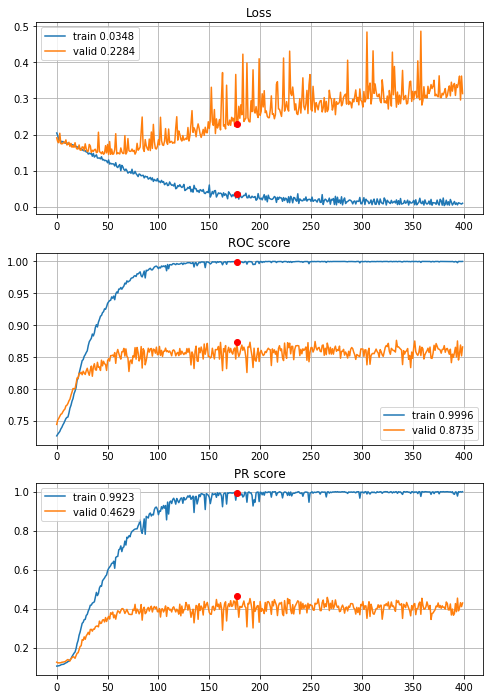


Fold 2------------------------------------------------------------


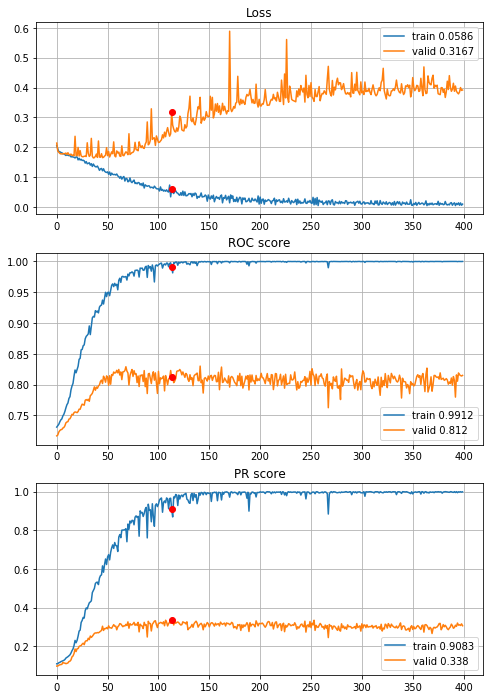


Fold 3------------------------------------------------------------


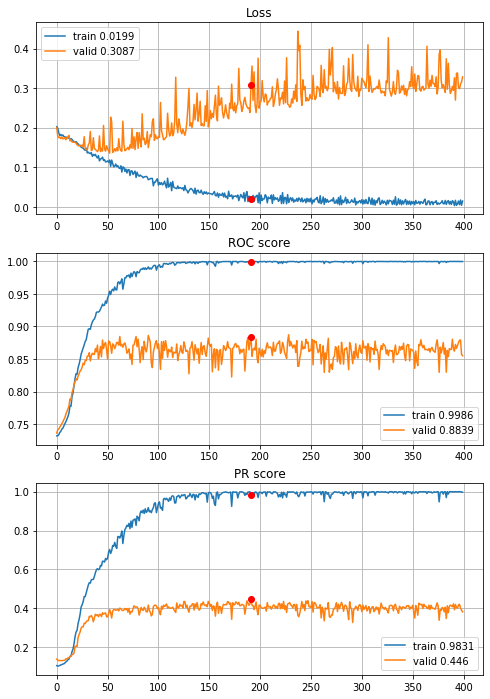


Fold 4------------------------------------------------------------


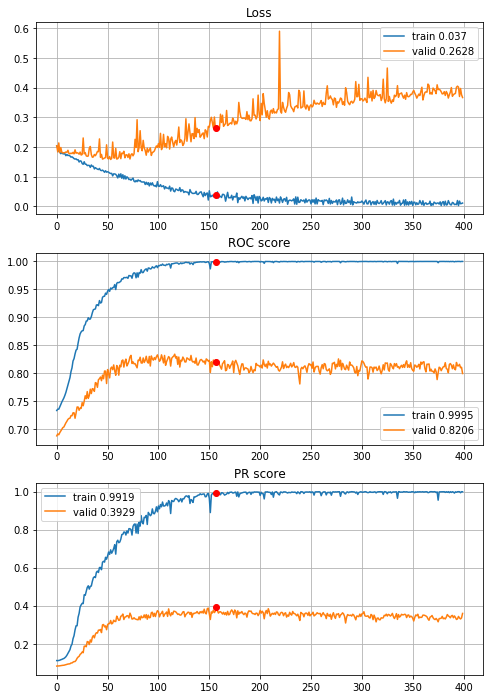


Fold 5------------------------------------------------------------


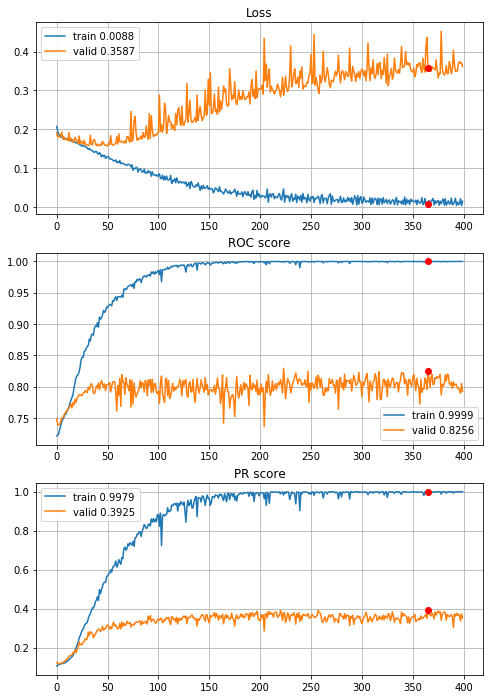


Fold 6------------------------------------------------------------


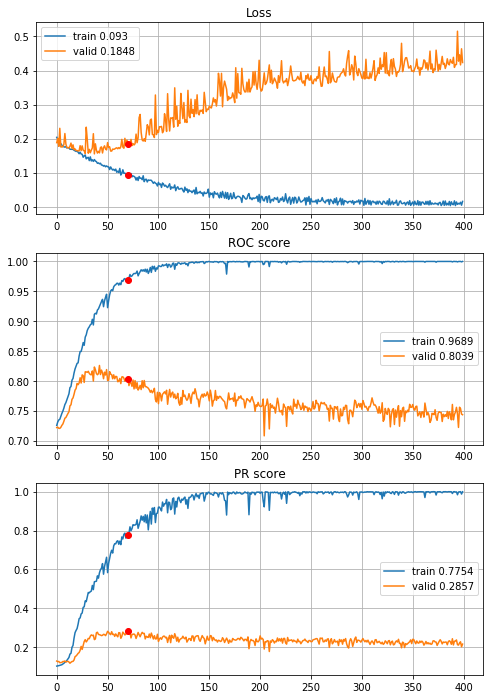

In [61]:
# basic model longer training
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets add some regularization, $L_2$ and reduce number of epochs for computation power saving 

In [49]:
def define_CNN_L2(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid,
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.68s train loss: 0.23878434567190537, validation loss: 0.21978608518838882
Epoch: 2/300,
cumulative time: 4.41s train loss: 0.2239449246771872, validation loss: 0.2047758735716343
Epoch: 3/300,
cumulative time: 6.2s train loss: 0.20929132063280453, validation loss: 0.19872364401817322
Epoch: 4/300,
cumulative time: 7.93s train loss: 0.20695514060507697, validation loss: 0.226902075111866
Epoch: 5/300,
cumulative time: 9.66s train loss: 0.20258808089822244, validation loss: 0.19383928179740906
Epoch: 6/300,
cumulative time: 11.41s train loss: 0.1974924902032934, validation loss: 0.1924968771636486
Epoch: 7/300,
cumulative time: 13.13s train loss: 0.1994982480533599, validation loss: 0.1937529779970646
Epoch: 8/300,
cumulative time: 14.87s train loss: 0.19585025208728335, validation loss: 0.19661861285567284
Epoch: 9/300,
cumulative time: 16.6s train loss: 0.1929670948139782, va

Epoch: 76/300,
cumulative time: 133.28s train loss: 0.12010334274145539, validation loss: 0.1571362093091011
Epoch: 77/300,
cumulative time: 134.99s train loss: 0.11910350674383982, validation loss: 0.15896828472614288
Epoch: 78/300,
cumulative time: 136.73s train loss: 0.12064336933698855, validation loss: 0.1563427597284317
Epoch: 79/300,
cumulative time: 138.44s train loss: 0.12460168028026138, validation loss: 0.15523956343531609
Epoch: 80/300,
cumulative time: 140.15s train loss: 0.11597687872140888, validation loss: 0.1782379075884819
Epoch: 81/300,
cumulative time: 141.91s train loss: 0.11733232065846073, validation loss: 0.15692873299121857
Epoch: 82/300,
cumulative time: 143.63s train loss: 0.11556366652651388, validation loss: 0.14996368438005447
Epoch: 83/300,
cumulative time: 145.33s train loss: 0.11773493317645961, validation loss: 0.1767328605055809
Epoch: 84/300,
cumulative time: 147.07s train loss: 0.11661807130766799, validation loss: 0.16944370418787003
Epoch: 85/300,

Epoch: 151/300,
cumulative time: 265.77s train loss: 0.07353300410911721, validation loss: 0.1776891052722931
Epoch: 152/300,
cumulative time: 267.49s train loss: 0.0742023147083535, validation loss: 0.18652866780757904
Epoch: 153/300,
cumulative time: 269.21s train loss: 0.06688602882356526, validation loss: 0.20140619575977325
Epoch: 154/300,
cumulative time: 271.01s train loss: 0.07529201256957921, validation loss: 0.20236527919769287
Epoch: 155/300,
cumulative time: 272.85s train loss: 0.0650293579965512, validation loss: 0.18498103693127632
Epoch: 156/300,
cumulative time: 274.57s train loss: 0.06862987427219726, validation loss: 0.19050424546003342
Epoch: 157/300,
cumulative time: 276.3s train loss: 0.06377959821927572, validation loss: 0.19835273176431656
Epoch: 158/300,
cumulative time: 278.02s train loss: 0.07192532148887627, validation loss: 0.1854180470108986
Epoch: 159/300,
cumulative time: 279.75s train loss: 0.06300224389818461, validation loss: 0.23230472207069397
Epoch:

Epoch: 225/300,
cumulative time: 395.88s train loss: 0.04275734421365254, validation loss: 0.23705803975462914
Epoch: 226/300,
cumulative time: 397.68s train loss: 0.0532623861867645, validation loss: 0.27029120177030563
Epoch: 227/300,
cumulative time: 399.5s train loss: 0.03950483620794913, validation loss: 0.24608174711465836
Epoch: 228/300,
cumulative time: 401.33s train loss: 0.05271215766711835, validation loss: 0.25020525231957436
Epoch: 229/300,
cumulative time: 403.11s train loss: 0.04258620253077781, validation loss: 0.23981912434101105
Epoch: 230/300,
cumulative time: 404.82s train loss: 0.0490527147570991, validation loss: 0.24639563634991646
Epoch: 231/300,
cumulative time: 406.61s train loss: 0.04433044464525579, validation loss: 0.2372094988822937
Epoch: 232/300,
cumulative time: 408.47s train loss: 0.03674402161571824, validation loss: 0.2606285624206066
Epoch: 233/300,
cumulative time: 410.35s train loss: 0.04899094940705718, validation loss: 0.2903040982782841
Epoch: 

Epoch: 300/300,
cumulative time: 528.76s train loss: 0.02153201765698178, validation loss: 0.2952449396252632

Early stopping results:
best results in epoch: 137, 
best valid PR: 0.4467590812175419, 
valid ROC: 0.8674560046064707        
overfitting PR: 0.45557969875611753, 
overfitting ROC: 0.12321454566459755

----------
Fold: 2
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.71s train loss: 0.24036544021417672, validation loss: 0.2446911670267582
Epoch: 2/300,
cumulative time: 4.42s train loss: 0.22175101064800187, validation loss: 0.2116474136710167
Epoch: 3/300,
cumulative time: 6.17s train loss: 0.2086330055849936, validation loss: 0.20563147589564323
Epoch: 4/300,
cumulative time: 7.9s train loss: 0.1994064600372932, validation loss: 0.2188127264380455
Epoch: 5/300,
cumulative time: 9.64s train loss: 0.20621880059120556, validation loss: 0.19649086520075798
Epoch: 6/300,
cumulative time: 11.48s train loss: 0.2010352281884774, validatio

Epoch: 74/300,
cumulative time: 128.48s train loss: 0.12085522070277337, validation loss: 0.15869288332760334
Epoch: 75/300,
cumulative time: 130.21s train loss: 0.11304568166339864, validation loss: 0.15869376994669437
Epoch: 76/300,
cumulative time: 132.01s train loss: 0.11854141114356252, validation loss: 0.15825997106730938
Epoch: 77/300,
cumulative time: 133.74s train loss: 0.12412459994706483, validation loss: 0.15759187377989292
Epoch: 78/300,
cumulative time: 135.47s train loss: 0.1108348749449345, validation loss: 0.2090466246008873
Epoch: 79/300,
cumulative time: 137.19s train loss: 0.1155095988701993, validation loss: 0.1617378331720829
Epoch: 80/300,
cumulative time: 138.92s train loss: 0.11493369286861924, validation loss: 0.17225274443626404
Epoch: 81/300,
cumulative time: 140.63s train loss: 0.11514079209971452, validation loss: 0.159818883985281
Epoch: 82/300,
cumulative time: 142.32s train loss: 0.1131292610126985, validation loss: 0.21347284317016602
Epoch: 83/300,
cu

Epoch: 149/300,
cumulative time: 259.85s train loss: 0.07422053030090867, validation loss: 0.22978781536221504
Epoch: 150/300,
cumulative time: 261.56s train loss: 0.07411860499423188, validation loss: 0.20173971727490425
Epoch: 151/300,
cumulative time: 263.27s train loss: 0.07115434562818632, validation loss: 0.2118302509188652
Epoch: 152/300,
cumulative time: 265.0s train loss: 0.07368129872943527, validation loss: 0.21305189654231071
Epoch: 153/300,
cumulative time: 266.79s train loss: 0.07019424823208803, validation loss: 0.21136845275759697
Epoch: 154/300,
cumulative time: 268.54s train loss: 0.06837642186029481, validation loss: 0.34239427745342255
Epoch: 155/300,
cumulative time: 270.42s train loss: 0.0807568790810159, validation loss: 0.20684878528118134
Epoch: 156/300,
cumulative time: 272.19s train loss: 0.06881964815626325, validation loss: 0.29368553683161736
Epoch: 157/300,
cumulative time: 274.02s train loss: 0.06376237596762156, validation loss: 0.2054467760026455
Epoch

Epoch: 224/300,
cumulative time: 392.02s train loss: 0.05433293560745905, validation loss: 0.2652722932398319
Epoch: 225/300,
cumulative time: 393.76s train loss: 0.040117359818079984, validation loss: 0.3480031490325928
Epoch: 226/300,
cumulative time: 395.53s train loss: 0.05098678711272016, validation loss: 0.283988282084465
Epoch: 227/300,
cumulative time: 397.23s train loss: 0.041348471123216234, validation loss: 0.3276166245341301
Epoch: 228/300,
cumulative time: 398.93s train loss: 0.06165403542532162, validation loss: 0.25805800035595894
Epoch: 229/300,
cumulative time: 400.65s train loss: 0.035866470096482424, validation loss: 0.3304264098405838
Epoch: 230/300,
cumulative time: 402.42s train loss: 0.054098103426249274, validation loss: 0.30897242575883865
Epoch: 231/300,
cumulative time: 404.33s train loss: 0.04811539220940104, validation loss: 0.262548565864563
Epoch: 232/300,
cumulative time: 406.02s train loss: 0.04496325670522503, validation loss: 0.27032822743058205
Epoch

Epoch: 299/300,
cumulative time: 525.73s train loss: 0.040374306162063424, validation loss: 0.29092977568507195
Epoch: 300/300,
cumulative time: 527.51s train loss: 0.03601741904384324, validation loss: 0.3149217516183853

Early stopping results:
best results in epoch: 86, 
best valid PR: 0.38229589945484294, 
valid ROC: 0.8467244059515878        
overfitting PR: 0.3585628122185452, 
overfitting ROC: 0.11538626587131418

----------
Fold: 3
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.85s train loss: 0.23694573633559118, validation loss: 0.22475903372915965
Epoch: 2/300,
cumulative time: 4.68s train loss: 0.22667875836589274, validation loss: 0.20390617310054718
Epoch: 3/300,
cumulative time: 6.53s train loss: 0.21100137813019845, validation loss: 0.19693715044430324
Epoch: 4/300,
cumulative time: 8.3s train loss: 0.2014374264313876, validation loss: 0.19635590176733714
Epoch: 5/300,
cumulative time: 10.07s train loss: 0.20360343498945752, 

Epoch: 72/300,
cumulative time: 128.24s train loss: 0.12468160685850337, validation loss: 0.14953051989986782
Epoch: 73/300,
cumulative time: 130.01s train loss: 0.11211454199684504, validation loss: 0.15420163059991504
Epoch: 74/300,
cumulative time: 131.75s train loss: 0.12204847324124535, validation loss: 0.151256253747713
Epoch: 75/300,
cumulative time: 133.49s train loss: 0.11990239742755042, validation loss: 0.17861840645472207
Epoch: 76/300,
cumulative time: 135.22s train loss: 0.11324606347775662, validation loss: 0.14784954809953296
Epoch: 77/300,
cumulative time: 136.92s train loss: 0.11515208772139242, validation loss: 0.17250736767337435
Epoch: 78/300,
cumulative time: 138.63s train loss: 0.11991003741577251, validation loss: 0.14637939038730802
Epoch: 79/300,
cumulative time: 140.36s train loss: 0.10993129444391697, validation loss: 0.15912085383657426
Epoch: 80/300,
cumulative time: 142.08s train loss: 0.11890812891456126, validation loss: 0.1538027940856086
Epoch: 81/300

Epoch: 147/300,
cumulative time: 260.4s train loss: 0.0698437611802408, validation loss: 0.16968408936545962
Epoch: 148/300,
cumulative time: 262.3s train loss: 0.07283007880769528, validation loss: 0.2410908225415245
Epoch: 149/300,
cumulative time: 264.17s train loss: 0.07512898040942255, validation loss: 0.17038305271239507
Epoch: 150/300,
cumulative time: 266.13s train loss: 0.07756860886122409, validation loss: 0.22417525779633296
Epoch: 151/300,
cumulative time: 268.02s train loss: 0.07254455594935438, validation loss: 0.1880645160731815
Epoch: 152/300,
cumulative time: 269.93s train loss: 0.06969690988339475, validation loss: 0.1858499847139631
Epoch: 153/300,
cumulative time: 271.82s train loss: 0.07538179958694868, validation loss: 0.1689403521163123
Epoch: 154/300,
cumulative time: 273.73s train loss: 0.06733633368882004, validation loss: 0.17980770109191774
Epoch: 155/300,
cumulative time: 275.6s train loss: 0.07253843817518904, validation loss: 0.1745984143302554
Epoch: 156

Epoch: 222/300,
cumulative time: 396.52s train loss: 0.04929871828364693, validation loss: 0.26481185525182693
Epoch: 223/300,
cumulative time: 398.2s train loss: 0.04719874651891425, validation loss: 0.21596200502108015
Epoch: 224/300,
cumulative time: 400.12s train loss: 0.044048272901846854, validation loss: 0.22932793551967257
Epoch: 225/300,
cumulative time: 402.02s train loss: 0.047984534723929405, validation loss: 0.21076390951398818
Epoch: 226/300,
cumulative time: 403.72s train loss: 0.04756177116222789, validation loss: 0.21649513219084057
Epoch: 227/300,
cumulative time: 405.46s train loss: 0.04037315619550669, validation loss: 0.2544474112987518
Epoch: 228/300,
cumulative time: 407.22s train loss: 0.061959704646448864, validation loss: 0.22083330403244686
Epoch: 229/300,
cumulative time: 409.07s train loss: 0.031995274926731695, validation loss: 0.2248993507169542
Epoch: 230/300,
cumulative time: 410.89s train loss: 0.047791725622131326, validation loss: 0.22468134889526972

Epoch: 297/300,
cumulative time: 524.91s train loss: 0.04548244621291127, validation loss: 0.2610743817450508
Epoch: 298/300,
cumulative time: 526.6s train loss: 0.03906961254467172, validation loss: 0.2640510490867827
Epoch: 299/300,
cumulative time: 528.29s train loss: 0.04395229322912655, validation loss: 0.2650606530053275
Epoch: 300/300,
cumulative time: 529.98s train loss: 0.02043670682233951, validation loss: 0.2730492263180869

Early stopping results:
best results in epoch: 245, 
best valid PR: 0.45155576049795704, 
valid ROC: 0.8647163152492934        
overfitting PR: 0.5471279261907818, 
overfitting ROC: 0.13522138059582745

----------
Fold: 4
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.58s train loss: 0.23820989871329276, validation loss: 0.2247631942090534
Epoch: 2/300,
cumulative time: 4.3s train loss: 0.22466071810768662, validation loss: 0.20675850540872603
Epoch: 3/300,
cumulative time: 6.04s train loss: 0.2085129263907409

Epoch: 71/300,
cumulative time: 120.01s train loss: 0.12590416250600267, validation loss: 0.17102890695844378
Epoch: 72/300,
cumulative time: 121.65s train loss: 0.11229132795823442, validation loss: 0.1774619016666261
Epoch: 73/300,
cumulative time: 123.33s train loss: 0.1188319066885357, validation loss: 0.1702567131746383
Epoch: 74/300,
cumulative time: 124.99s train loss: 0.11402126459266021, validation loss: 0.18944542763725158
Epoch: 75/300,
cumulative time: 126.69s train loss: 0.11642010777174738, validation loss: 0.17802245248877813
Epoch: 76/300,
cumulative time: 128.36s train loss: 0.1127006552183675, validation loss: 0.18107875789914812
Epoch: 77/300,
cumulative time: 130.03s train loss: 0.11479684803670352, validation loss: 0.17982411730857123
Epoch: 78/300,
cumulative time: 131.74s train loss: 0.10983522403576175, validation loss: 0.18072036873726618
Epoch: 79/300,
cumulative time: 133.42s train loss: 0.10904420930520976, validation loss: 0.1742423936109694
Epoch: 80/300,


Epoch: 146/300,
cumulative time: 245.02s train loss: 0.07126045727224327, validation loss: 0.2155785492109874
Epoch: 147/300,
cumulative time: 246.67s train loss: 0.07645445441316648, validation loss: 0.22006688918386186
Epoch: 148/300,
cumulative time: 248.32s train loss: 0.0665978626172502, validation loss: 0.2242922512122563
Epoch: 149/300,
cumulative time: 249.99s train loss: 0.07874954333705043, validation loss: 0.21333931417692276
Epoch: 150/300,
cumulative time: 251.66s train loss: 0.07183433034096301, validation loss: 0.21556965748469034
Epoch: 151/300,
cumulative time: 253.32s train loss: 0.0776535565816495, validation loss: 0.2266573187093886
Epoch: 152/300,
cumulative time: 254.96s train loss: 0.06801584847172126, validation loss: 0.2120163244860513
Epoch: 153/300,
cumulative time: 256.62s train loss: 0.06806375053391416, validation loss: 0.21394759244389006
Epoch: 154/300,
cumulative time: 258.26s train loss: 0.07459899544492657, validation loss: 0.22062920530637106
Epoch: 

Epoch: 221/300,
cumulative time: 370.2s train loss: 0.04918236603235153, validation loss: 0.2914053931122734
Epoch: 222/300,
cumulative time: 372.16s train loss: 0.05739525078987506, validation loss: 0.3024014861053891
Epoch: 223/300,
cumulative time: 374.03s train loss: 0.04561809731877454, validation loss: 0.28406373644632005
Epoch: 224/300,
cumulative time: 375.7s train loss: 0.03834073084728267, validation loss: 0.2830350124646747
Epoch: 225/300,
cumulative time: 377.38s train loss: 0.062418640934907954, validation loss: 0.2862865462568071
Epoch: 226/300,
cumulative time: 379.02s train loss: 0.04521989329875658, validation loss: 0.2798526892397139
Epoch: 227/300,
cumulative time: 380.68s train loss: 0.04228206792267216, validation loss: 0.2930290953885941
Epoch: 228/300,
cumulative time: 382.39s train loss: 0.05606031041770655, validation loss: 0.3270371499704936
Epoch: 229/300,
cumulative time: 384.05s train loss: 0.039321003648927405, validation loss: 0.3896982545512063
Epoch: 23

Epoch: 296/300,
cumulative time: 500.27s train loss: 0.03373512657191588, validation loss: 0.3517663623794677
Epoch: 297/300,
cumulative time: 502.0s train loss: 0.03714130048625766, validation loss: 0.3294819109402006
Epoch: 298/300,
cumulative time: 503.7s train loss: 0.031145177974301923, validation loss: 0.3324981354153346
Epoch: 299/300,
cumulative time: 505.39s train loss: 0.03698396345963934, validation loss: 0.3370430238663204
Epoch: 300/300,
cumulative time: 507.07s train loss: 0.029873679892520728, validation loss: 0.363759911703685

Early stopping results:
best results in epoch: 142, 
best valid PR: 0.3678615435157607, 
valid ROC: 0.8118281506023011        
overfitting PR: 0.5634087672404445, 
overfitting ROC: 0.18044918655762066

----------
Fold: 5
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 3.71s train loss: 0.24184814555944337, validation loss: 0.22014241045429592
Epoch: 2/300,
cumulative time: 5.48s train loss: 0.220167353236

Epoch: 69/300,
cumulative time: 127.89s train loss: 0.130020599097668, validation loss: 0.1566444130360134
Epoch: 70/300,
cumulative time: 129.66s train loss: 0.12867631862819445, validation loss: 0.17198051841486067
Epoch: 71/300,
cumulative time: 131.42s train loss: 0.1286063485904077, validation loss: 0.17460871716340384
Epoch: 72/300,
cumulative time: 133.2s train loss: 0.1321349675520371, validation loss: 0.15898055853351714
Epoch: 73/300,
cumulative time: 134.96s train loss: 0.1258052396803803, validation loss: 0.15789082648262145
Epoch: 74/300,
cumulative time: 136.74s train loss: 0.12842432178450036, validation loss: 0.19885992996276372
Epoch: 75/300,
cumulative time: 138.54s train loss: 0.1251069383999108, validation loss: 0.1610143558562748
Epoch: 76/300,
cumulative time: 140.31s train loss: 0.12213287557198249, validation loss: 0.16372068387175362
Epoch: 77/300,
cumulative time: 142.12s train loss: 0.12418205072064985, validation loss: 0.16716310731002262
Epoch: 78/300,
cumu

Epoch: 144/300,
cumulative time: 264.16s train loss: 0.0767092631118422, validation loss: 0.2257118320654309
Epoch: 145/300,
cumulative time: 265.93s train loss: 0.08552191261676448, validation loss: 0.209873345957862
Epoch: 146/300,
cumulative time: 267.7s train loss: 0.08154068474647311, validation loss: 0.20287828839014446
Epoch: 147/300,
cumulative time: 269.43s train loss: 0.07486187643386301, validation loss: 0.24426346517744518
Epoch: 148/300,
cumulative time: 271.17s train loss: 0.08146263862361426, validation loss: 0.19736452765881068
Epoch: 149/300,
cumulative time: 272.91s train loss: 0.08237277809944313, validation loss: 0.21097173548880077
Epoch: 150/300,
cumulative time: 274.64s train loss: 0.07656498278221746, validation loss: 0.24519525930995034
Epoch: 151/300,
cumulative time: 276.41s train loss: 0.08178629590723589, validation loss: 0.2347514269654713
Epoch: 152/300,
cumulative time: 278.2s train loss: 0.08046620953305506, validation loss: 0.2932186864671253
Epoch: 15

Epoch: 219/300,
cumulative time: 397.43s train loss: 0.043579667326125816, validation loss: 0.292862385624931
Epoch: 220/300,
cumulative time: 399.25s train loss: 0.05871404122461427, validation loss: 0.262780786960844
Epoch: 221/300,
cumulative time: 401.03s train loss: 0.04856935413042361, validation loss: 0.2644336805646382
Epoch: 222/300,
cumulative time: 402.8s train loss: 0.05931408157752101, validation loss: 0.2604560346830459
Epoch: 223/300,
cumulative time: 404.54s train loss: 0.04341161970587813, validation loss: 0.2801654914258018
Epoch: 224/300,
cumulative time: 406.36s train loss: 0.048894350601283824, validation loss: 0.2663030929603274
Epoch: 225/300,
cumulative time: 408.13s train loss: 0.05088862490679341, validation loss: 0.26552409584560094
Epoch: 226/300,
cumulative time: 409.85s train loss: 0.04881806245885465, validation loss: 0.2864251005649567
Epoch: 227/300,
cumulative time: 411.66s train loss: 0.05378368179604338, validation loss: 0.27507654328194875
Epoch: 22

Epoch: 294/300,
cumulative time: 532.35s train loss: 0.040991013844814246, validation loss: 0.3095885940203591
Epoch: 295/300,
cumulative time: 534.2s train loss: 0.03837377214902425, validation loss: 0.317253710826238
Epoch: 296/300,
cumulative time: 535.96s train loss: 0.03557873894769679, validation loss: 0.3178319996311551
Epoch: 297/300,
cumulative time: 537.75s train loss: 0.030960455411988132, validation loss: 0.39250585732005894
Epoch: 298/300,
cumulative time: 539.58s train loss: 0.03321014472927912, validation loss: 0.31451447114111886
Epoch: 299/300,
cumulative time: 541.46s train loss: 0.03680124300794166, validation loss: 0.31852965754175944
Epoch: 300/300,
cumulative time: 543.21s train loss: 0.044596649841858876, validation loss: 0.30240377912445676

Early stopping results:
best results in epoch: 85, 
best valid PR: 0.3872594858466293, 
valid ROC: 0.8301582728631363        
overfitting PR: 0.27825227241645323, 
overfitting ROC: 0.11734464124762367

----------
Fold: 6
---

Epoch: 67/300,
cumulative time: 118.86s train loss: 0.12315658392152674, validation loss: 0.16202976279788547
Epoch: 68/300,
cumulative time: 120.59s train loss: 0.12195059975475107, validation loss: 0.178558736339448
Epoch: 69/300,
cumulative time: 122.32s train loss: 0.12399076666057268, validation loss: 0.17304861473658728
Epoch: 70/300,
cumulative time: 124.04s train loss: 0.1212794734894571, validation loss: 0.16794434768812996
Epoch: 71/300,
cumulative time: 125.78s train loss: 0.11587371192404321, validation loss: 0.17670755053323411
Epoch: 72/300,
cumulative time: 127.5s train loss: 0.12205473804732665, validation loss: 0.1659587423101304
Epoch: 73/300,
cumulative time: 129.22s train loss: 0.11500049546934164, validation loss: 0.17422312067614662
Epoch: 74/300,
cumulative time: 130.94s train loss: 0.12418544181972889, validation loss: 0.18492215842481644
Epoch: 75/300,
cumulative time: 132.65s train loss: 0.11611248285686877, validation loss: 0.1686690639598029
Epoch: 76/300,
c

Epoch: 142/300,
cumulative time: 250.59s train loss: 0.06823439708872693, validation loss: 0.22901903233830892
Epoch: 143/300,
cumulative time: 252.35s train loss: 0.07830696560937135, validation loss: 0.2309146125354464
Epoch: 144/300,
cumulative time: 254.13s train loss: 0.06908705311199426, validation loss: 0.22663725482092964
Epoch: 145/300,
cumulative time: 255.88s train loss: 0.0747591340662532, validation loss: 0.24316250602404277
Epoch: 146/300,
cumulative time: 257.6s train loss: 0.07213213721235134, validation loss: 0.24672974548642598
Epoch: 147/300,
cumulative time: 259.36s train loss: 0.06439361207483231, validation loss: 0.23139010493717496
Epoch: 148/300,
cumulative time: 261.09s train loss: 0.07706249211164648, validation loss: 0.21635501976997135
Epoch: 149/300,
cumulative time: 262.84s train loss: 0.06977029753948463, validation loss: 0.266665629451237
Epoch: 150/300,
cumulative time: 264.63s train loss: 0.08244930042959613, validation loss: 0.2237684336541191
Epoch: 

Epoch: 217/300,
cumulative time: 383.67s train loss: 0.05051627867604832, validation loss: 0.28528994876240926
Epoch: 218/300,
cumulative time: 385.44s train loss: 0.052242201270924105, validation loss: 0.28700916258115616
Epoch: 219/300,
cumulative time: 387.19s train loss: 0.04876648018299073, validation loss: 0.3249992911399357
Epoch: 220/300,
cumulative time: 388.95s train loss: 0.042354514618293426, validation loss: 0.33290761264543683
Epoch: 221/300,
cumulative time: 390.67s train loss: 0.049142897684754674, validation loss: 0.28658323240658595
Epoch: 222/300,
cumulative time: 392.39s train loss: 0.06259463371119478, validation loss: 0.277358097102907
Epoch: 223/300,
cumulative time: 394.16s train loss: 0.029230770920173337, validation loss: 0.3071982779389336
Epoch: 224/300,
cumulative time: 395.9s train loss: 0.047453762361134494, validation loss: 0.33006034654284283
Epoch: 225/300,
cumulative time: 397.68s train loss: 0.045000961643212246, validation loss: 0.3738951719753326
E

Epoch: 292/300,
cumulative time: 515.35s train loss: 0.0368620488405799, validation loss: 0.3375635956961011
Epoch: 293/300,
cumulative time: 517.09s train loss: 0.039849312225458615, validation loss: 0.33326096180885556
Epoch: 294/300,
cumulative time: 518.86s train loss: 0.03867702417608156, validation loss: 0.33474841713905334
Epoch: 295/300,
cumulative time: 520.62s train loss: 0.03692711588769482, validation loss: 0.3369520650212727
Epoch: 296/300,
cumulative time: 522.38s train loss: 0.030980113271367994, validation loss: 0.33240328930673146
Epoch: 297/300,
cumulative time: 524.09s train loss: 0.03924019470710628, validation loss: 0.32326278622188265
Epoch: 298/300,
cumulative time: 525.82s train loss: 0.023266094543443683, validation loss: 0.4882374771814498
Epoch: 299/300,
cumulative time: 527.57s train loss: 0.03530007440129088, validation loss: 0.32956839606875465
Epoch: 300/300,
cumulative time: 529.41s train loss: 0.03941548393321125, validation loss: 0.3303563630391681

Ea

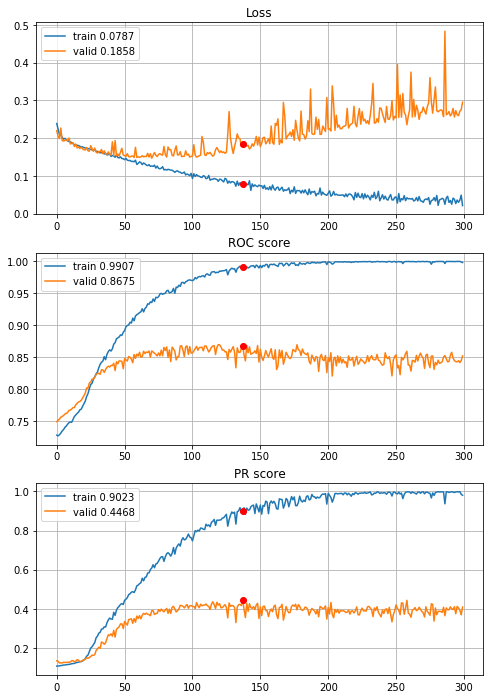


Fold 2------------------------------------------------------------


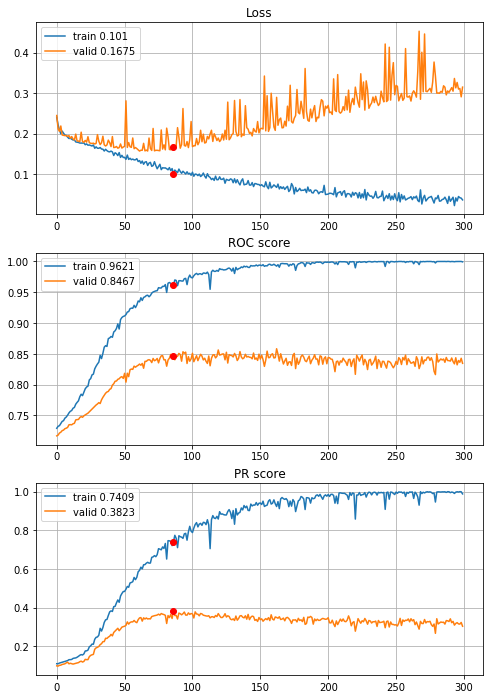


Fold 3------------------------------------------------------------


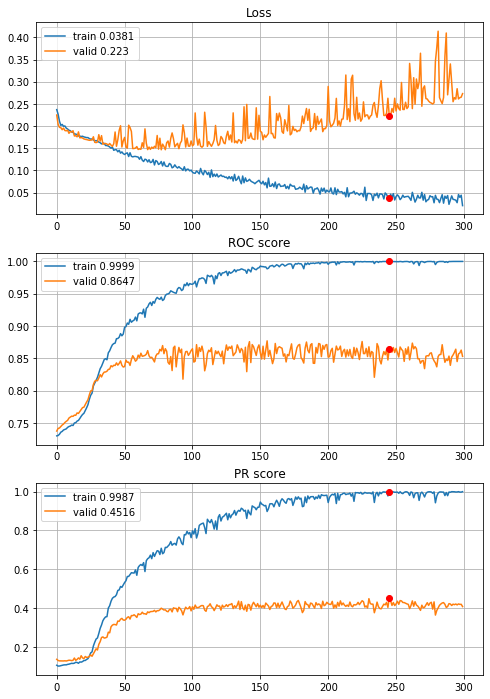


Fold 4------------------------------------------------------------


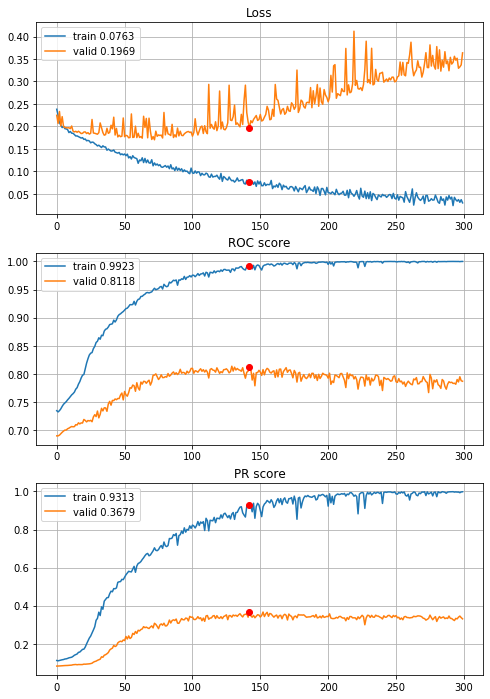


Fold 5------------------------------------------------------------


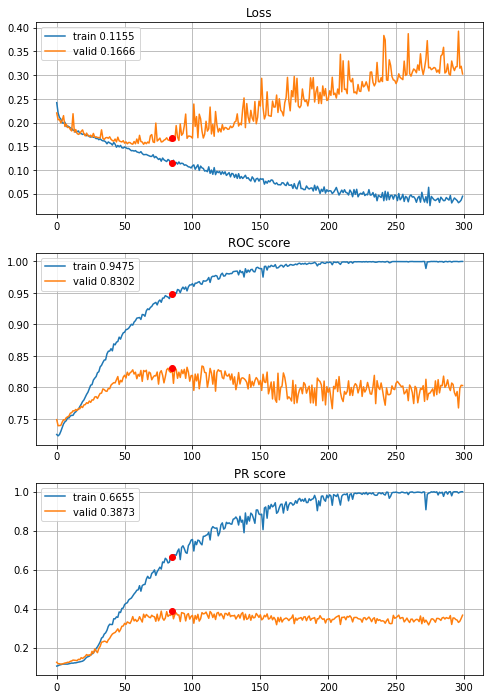


Fold 6------------------------------------------------------------


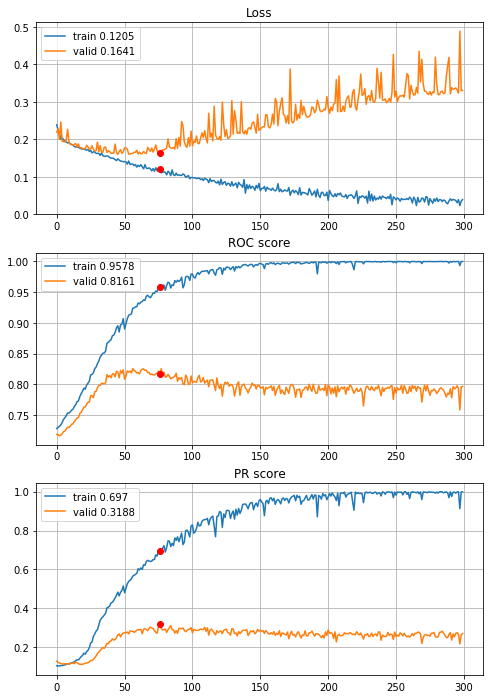

In [64]:
# basic model with L2 regularization THE BEST ONE
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Learning curves looks not bad, but huge overfitting occurs, lets try some dropout

In [50]:
def define_CNN_L2_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    dense = layers.Dropout(rate=0.2)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid,
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 4.91s train loss: 0.24823543762361538, validation loss: 0.22306077182292938
Epoch: 2/300,
cumulative time: 6.7s train loss: 0.22345291855690624, validation loss: 0.20503520965576172
Epoch: 3/300,
cumulative time: 8.49s train loss: 0.21130978003893486, validation loss: 0.20201778411865234
Epoch: 4/300,
cumulative time: 10.29s train loss: 0.21025620146246354, validation loss: 0.23116682097315788
Epoch: 5/300,
cumulative time: 12.07s train loss: 0.20689156295806396, validation loss: 0.19475740566849709
Epoch: 6/300,
cumulative time: 13.84s train loss: 0.20347486614969068, validation loss: 0.19325657933950424
Epoch: 7/300,
cumulative time: 15.66s train loss: 0.20318123243783198, validation loss: 0.1974359042942524
Epoch: 8/300,
cumulative time: 17.44s train loss: 0.19830571222480872, validation loss: 0.19773432612419128
Epoch: 9/300,
cumulative time: 19.23s train loss: 0.1974835291

Epoch: 76/300,
cumulative time: 142.87s train loss: 0.13053953032533852, validation loss: 0.1611134521663189
Epoch: 77/300,
cumulative time: 144.93s train loss: 0.13044492917588485, validation loss: 0.16997036337852478
Epoch: 78/300,
cumulative time: 146.73s train loss: 0.13221452213207013, validation loss: 0.16694719716906548
Epoch: 79/300,
cumulative time: 148.53s train loss: 0.12701748392495968, validation loss: 0.16955918818712234
Epoch: 80/300,
cumulative time: 150.31s train loss: 0.13158443315099375, validation loss: 0.1797683723270893
Epoch: 81/300,
cumulative time: 152.09s train loss: 0.12712329737520447, validation loss: 0.1602102741599083
Epoch: 82/300,
cumulative time: 153.86s train loss: 0.12453288841498812, validation loss: 0.15958265587687492
Epoch: 83/300,
cumulative time: 155.71s train loss: 0.12797274940574818, validation loss: 0.1796971745789051
Epoch: 84/300,
cumulative time: 157.64s train loss: 0.12966519585678637, validation loss: 0.17966224625706673
Epoch: 85/300,

Epoch: 151/300,
cumulative time: 281.35s train loss: 0.08790435582974528, validation loss: 0.1932479627430439
Epoch: 152/300,
cumulative time: 283.17s train loss: 0.09037026198492884, validation loss: 0.19195935130119324
Epoch: 153/300,
cumulative time: 285.0s train loss: 0.08458268366008619, validation loss: 0.2068939544260502
Epoch: 154/300,
cumulative time: 286.85s train loss: 0.08946245852924047, validation loss: 0.24868858605623245
Epoch: 155/300,
cumulative time: 288.65s train loss: 0.08788270628247212, validation loss: 0.17570535093545914
Epoch: 156/300,
cumulative time: 290.49s train loss: 0.08317261355904954, validation loss: 0.21362746506929398
Epoch: 157/300,
cumulative time: 292.35s train loss: 0.09148243009484075, validation loss: 0.2043876089155674
Epoch: 158/300,
cumulative time: 294.2s train loss: 0.08461857091402754, validation loss: 0.18853547424077988
Epoch: 159/300,
cumulative time: 296.01s train loss: 0.08115518595143555, validation loss: 0.21943214163184166
Epoch:

Epoch: 226/300,
cumulative time: 419.45s train loss: 0.06460620117609787, validation loss: 0.21081410348415375
Epoch: 227/300,
cumulative time: 421.25s train loss: 0.05922019279974859, validation loss: 0.21788302436470985
Epoch: 228/300,
cumulative time: 423.08s train loss: 0.05646222129127379, validation loss: 0.3069416508078575
Epoch: 229/300,
cumulative time: 424.89s train loss: 0.06437263282563645, validation loss: 0.2258080616593361
Epoch: 230/300,
cumulative time: 426.71s train loss: 0.05733835471556567, validation loss: 0.31027473509311676
Epoch: 231/300,
cumulative time: 428.55s train loss: 0.07320440541659592, validation loss: 0.2270045056939125
Epoch: 232/300,
cumulative time: 430.5s train loss: 0.05136144063929772, validation loss: 0.23562176525592804
Epoch: 233/300,
cumulative time: 432.41s train loss: 0.0628454165855766, validation loss: 0.24298544228076935
Epoch: 234/300,
cumulative time: 434.2s train loss: 0.05464834349022761, validation loss: 0.2432643286883831
Epoch: 2

Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 5.18s train loss: 0.24803855874821157, validation loss: 0.2329898737370968
Epoch: 2/300,
cumulative time: 7.03s train loss: 0.22183282965479192, validation loss: 0.20974579453468323
Epoch: 3/300,
cumulative time: 8.88s train loss: 0.2120400468533629, validation loss: 0.21786782890558243
Epoch: 4/300,
cumulative time: 10.73s train loss: 0.21379412578228707, validation loss: 0.19926312938332558
Epoch: 5/300,
cumulative time: 12.59s train loss: 0.204938446801135, validation loss: 0.19750405475497246
Epoch: 6/300,
cumulative time: 14.43s train loss: 0.20511851013993296, validation loss: 0.19700214639306068
Epoch: 7/300,
cumulative time: 16.27s train loss: 0.200953138368786, validation loss: 0.1959921307861805
Epoch: 8/300,
cumulative time: 18.2s train loss: 0.20007971117586093, validation loss: 0.19710375741124153
Epoch: 9/300,
cumulative time: 20.29s train loss: 0.1942231203545284, validation loss: 0.1940407492

Epoch: 77/300,
cumulative time: 148.22s train loss: 0.1290295794133216, validation loss: 0.16775746271014214
Epoch: 78/300,
cumulative time: 150.1s train loss: 0.11935273673311594, validation loss: 0.1992403231561184
Epoch: 79/300,
cumulative time: 151.99s train loss: 0.1220808809253242, validation loss: 0.17234747856855392
Epoch: 80/300,
cumulative time: 153.9s train loss: 0.11998700061429873, validation loss: 0.1792948916554451
Epoch: 81/300,
cumulative time: 155.82s train loss: 0.12341196025466786, validation loss: 0.17688725143671036
Epoch: 82/300,
cumulative time: 157.76s train loss: 0.12081998860328225, validation loss: 0.19429441913962364
Epoch: 83/300,
cumulative time: 159.65s train loss: 0.11768332778756663, validation loss: 0.17882929742336273
Epoch: 84/300,
cumulative time: 161.48s train loss: 0.11546607636229346, validation loss: 0.17266636714339256
Epoch: 85/300,
cumulative time: 163.46s train loss: 0.12163736169647904, validation loss: 0.18306461721658707
Epoch: 86/300,
c

Epoch: 152/300,
cumulative time: 290.45s train loss: 0.07580421357181485, validation loss: 0.21647346019744873
Epoch: 153/300,
cumulative time: 292.29s train loss: 0.07025453495689458, validation loss: 0.2654273808002472
Epoch: 154/300,
cumulative time: 294.09s train loss: 0.07631935819571033, validation loss: 0.28198423236608505
Epoch: 155/300,
cumulative time: 295.9s train loss: 0.08021851840068114, validation loss: 0.21293880417943
Epoch: 156/300,
cumulative time: 297.72s train loss: 0.06861106204715642, validation loss: 0.29829343408346176
Epoch: 157/300,
cumulative time: 299.53s train loss: 0.06254157235343605, validation loss: 0.2202761061489582
Epoch: 158/300,
cumulative time: 301.34s train loss: 0.07995640643133979, validation loss: 0.22356270253658295
Epoch: 159/300,
cumulative time: 303.19s train loss: 0.06748276784894974, validation loss: 0.2693943977355957
Epoch: 160/300,
cumulative time: 305.02s train loss: 0.0740385445505532, validation loss: 0.25608862563967705
Epoch: 16

Epoch: 227/300,
cumulative time: 430.5s train loss: 0.039730139042654274, validation loss: 0.2852189615368843
Epoch: 228/300,
cumulative time: 432.34s train loss: 0.044796892704320114, validation loss: 0.29430416971445084
Epoch: 229/300,
cumulative time: 434.13s train loss: 0.05644735293874376, validation loss: 0.27311642467975616
Epoch: 230/300,
cumulative time: 435.95s train loss: 0.04922172623280192, validation loss: 0.293405681848526
Epoch: 231/300,
cumulative time: 437.81s train loss: 0.04269284197522366, validation loss: 0.2852122038602829
Epoch: 232/300,
cumulative time: 439.68s train loss: 0.050626050793448035, validation loss: 0.3010280579328537
Epoch: 233/300,
cumulative time: 441.55s train loss: 0.05051362283013235, validation loss: 0.29593654721975327
Epoch: 234/300,
cumulative time: 443.49s train loss: 0.04741357312925111, validation loss: 0.28410496935248375
Epoch: 235/300,
cumulative time: 445.39s train loss: 0.05114823765201336, validation loss: 0.3136083036661148
Epoch

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 6.41s train loss: 0.2478060101087859, validation loss: 0.21772813972972688
Epoch: 2/300,
cumulative time: 8.32s train loss: 0.2246815134300955, validation loss: 0.20657579151410904
Epoch: 3/300,
cumulative time: 10.25s train loss: 0.21790601590252687, validation loss: 0.1985235678865796
Epoch: 4/300,
cumulative time: 12.51s train loss: 0.20499435813653677, validation loss: 0.19421504474821544
Epoch: 5/300,
cumulative time: 14.63s train loss: 0.2067857886009203, validation loss: 0.19257388302258083
Epoch: 6/300,
cumulative time: 16.74s train loss: 0.204318193048409, validation loss: 0.19648212500980922
Epoch: 7/300,
cumulative time: 18.73s train loss: 0.20501250148545944, validation loss: 0.1919315896431605
Epoch: 8/300,
cumulative time: 20.71s train loss: 0.19949278372207602, validation loss: 0.19013812323411305
Epoch: 9/300,
cumulative time: 22.67s train loss: 0.19755633226828148, validation loss: 0.1905514

Epoch: 77/300,
cumulative time: 159.52s train loss: 0.11930285919903649, validation loss: 0.1540203868491309
Epoch: 78/300,
cumulative time: 161.5s train loss: 0.1263966419212298, validation loss: 0.14917537605005599
Epoch: 79/300,
cumulative time: 163.46s train loss: 0.1172315519621367, validation loss: 0.15679776860607994
Epoch: 80/300,
cumulative time: 165.46s train loss: 0.12469207601671642, validation loss: 0.15735507865746817
Epoch: 81/300,
cumulative time: 167.46s train loss: 0.12059293563246076, validation loss: 0.15735965044725508
Epoch: 82/300,
cumulative time: 169.42s train loss: 0.11449689460925165, validation loss: 0.16138668118961275
Epoch: 83/300,
cumulative time: 171.39s train loss: 0.1148767910819225, validation loss: 0.17554145301145221
Epoch: 84/300,
cumulative time: 173.55s train loss: 0.12178244248412808, validation loss: 0.15719179933033292
Epoch: 85/300,
cumulative time: 175.67s train loss: 0.11872986225408695, validation loss: 0.1995621135594353
Epoch: 86/300,
c

Epoch: 152/300,
cumulative time: 310.34s train loss: 0.07652854111948428, validation loss: 0.18754965280729627
Epoch: 153/300,
cumulative time: 312.35s train loss: 0.07791241379831895, validation loss: 0.17288891256801667
Epoch: 154/300,
cumulative time: 314.31s train loss: 0.07098193783339048, validation loss: 0.18074173635906643
Epoch: 155/300,
cumulative time: 316.28s train loss: 0.08121848214354796, validation loss: 0.17411068568153987
Epoch: 156/300,
cumulative time: 318.3s train loss: 0.07554586734294029, validation loss: 0.17546810582516686
Epoch: 157/300,
cumulative time: 320.27s train loss: 0.08403993537844597, validation loss: 0.19005561979044053
Epoch: 158/300,
cumulative time: 322.21s train loss: 0.06667157091503974, validation loss: 0.17450820065680003
Epoch: 159/300,
cumulative time: 324.16s train loss: 0.07597368580576609, validation loss: 0.18562887883375562
Epoch: 160/300,
cumulative time: 326.16s train loss: 0.0707313993975749, validation loss: 0.2295859288223206
Epoc

Epoch: 227/300,
cumulative time: 460.15s train loss: 0.04410346189150354, validation loss: 0.21548456168363964
Epoch: 228/300,
cumulative time: 462.16s train loss: 0.05408899234133701, validation loss: 0.22499780749517773
Epoch: 229/300,
cumulative time: 464.13s train loss: 0.04377968296440813, validation loss: 0.21382505375241476
Epoch: 230/300,
cumulative time: 466.06s train loss: 0.056047248430015684, validation loss: 0.20805364872728074
Epoch: 231/300,
cumulative time: 468.0s train loss: 0.048583792848636675, validation loss: 0.21515100993807354
Epoch: 232/300,
cumulative time: 469.94s train loss: 0.052911999113399, validation loss: 0.22038259458920312
Epoch: 233/300,
cumulative time: 471.87s train loss: 0.05614207349542632, validation loss: 0.2501544121049699
Epoch: 234/300,
cumulative time: 473.82s train loss: 0.04954835421432808, validation loss: 0.21966722903743624
Epoch: 235/300,
cumulative time: 475.77s train loss: 0.04968695263229939, validation loss: 0.2749857438935174
Epoc

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 6.68s train loss: 0.2470671179895551, validation loss: 0.21791493099833292
Epoch: 2/300,
cumulative time: 8.67s train loss: 0.22536392217097403, validation loss: 0.2080752082949593
Epoch: 3/300,
cumulative time: 10.76s train loss: 0.21338405658088844, validation loss: 0.23137881933696686
Epoch: 4/300,
cumulative time: 12.86s train loss: 0.20885573890142003, validation loss: 0.20310915612039113
Epoch: 5/300,
cumulative time: 15.18s train loss: 0.20338834168963343, validation loss: 0.2382198927516029
Epoch: 6/300,
cumulative time: 17.25s train loss: 0.20711579551487325, validation loss: 0.20050194884103442
Epoch: 7/300,
cumulative time: 19.21s train loss: 0.19918938530108884, validation loss: 0.19960330133400267
Epoch: 8/300,
cumulative time: 21.24s train loss: 0.19928150643994547, validation loss: 0.20120654875323887
Epoch: 9/300,
cumulative time: 23.18s train loss: 0.19832283895951291, validation loss: 0.198

Epoch: 76/300,
cumulative time: 159.62s train loss: 0.1214341314421309, validation loss: 0.18335663804932245
Epoch: 77/300,
cumulative time: 161.78s train loss: 0.1247724093921493, validation loss: 0.179269249694688
Epoch: 78/300,
cumulative time: 164.08s train loss: 0.11746043802798362, validation loss: 0.17923508608151997
Epoch: 79/300,
cumulative time: 166.37s train loss: 0.1214304658851149, validation loss: 0.18450065902301244
Epoch: 80/300,
cumulative time: 168.51s train loss: 0.11871912631930866, validation loss: 0.22165066384133839
Epoch: 81/300,
cumulative time: 170.76s train loss: 0.1265673872191727, validation loss: 0.17923903522037324
Epoch: 82/300,
cumulative time: 172.76s train loss: 0.1174283337476548, validation loss: 0.19902176033882868
Epoch: 83/300,
cumulative time: 174.92s train loss: 0.1210299625480116, validation loss: 0.20164482691931346
Epoch: 84/300,
cumulative time: 177.02s train loss: 0.11354790859693377, validation loss: 0.19529754919665201
Epoch: 85/300,
cum

Epoch: 151/300,
cumulative time: 312.42s train loss: 0.08331669339056742, validation loss: 0.2135557628624023
Epoch: 152/300,
cumulative time: 314.39s train loss: 0.07510143847608984, validation loss: 0.23972200433413188
Epoch: 153/300,
cumulative time: 316.39s train loss: 0.08185389824850056, validation loss: 0.21660280649624172
Epoch: 154/300,
cumulative time: 318.34s train loss: 0.07767036580938788, validation loss: 0.22412988522696117
Epoch: 155/300,
cumulative time: 320.77s train loss: 0.08027446068992647, validation loss: 0.238071187583227
Epoch: 156/300,
cumulative time: 322.83s train loss: 0.07964901223738999, validation loss: 0.22870065327674624
Epoch: 157/300,
cumulative time: 324.93s train loss: 0.07709981346642651, validation loss: 0.2394174996065715
Epoch: 158/300,
cumulative time: 326.89s train loss: 0.07945910864494864, validation loss: 0.2316237343303741
Epoch: 159/300,
cumulative time: 328.88s train loss: 0.0841267888357498, validation loss: 0.20806650364209736
Epoch: 

Epoch: 226/300,
cumulative time: 461.01s train loss: 0.05310283507406901, validation loss: 0.2824488765852792
Epoch: 227/300,
cumulative time: 463.0s train loss: 0.057988453381661156, validation loss: 0.25499056513347323
Epoch: 228/300,
cumulative time: 464.91s train loss: 0.05468545597667574, validation loss: 0.2612456628254482
Epoch: 229/300,
cumulative time: 466.92s train loss: 0.048569252436666814, validation loss: 0.3055584422747294
Epoch: 230/300,
cumulative time: 468.85s train loss: 0.057068162560708874, validation loss: 0.26399594963543
Epoch: 231/300,
cumulative time: 470.78s train loss: 0.046888716296837066, validation loss: 0.25973678265299116
Epoch: 232/300,
cumulative time: 472.67s train loss: 0.057295739055777076, validation loss: 0.2675597521236965
Epoch: 233/300,
cumulative time: 474.6s train loss: 0.06557120355024652, validation loss: 0.2760754014386071
Epoch: 234/300,
cumulative time: 476.53s train loss: 0.04595430985318233, validation loss: 0.2726527004014878
Epoch: 

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 6.59s train loss: 0.24857027891120498, validation loss: 0.216833898557557
Epoch: 2/300,
cumulative time: 8.57s train loss: 0.22089325271048368, validation loss: 0.20447154111332363
Epoch: 3/300,
cumulative time: 10.56s train loss: 0.21303646550219996, validation loss: 0.20492443426260873
Epoch: 4/300,
cumulative time: 12.55s train loss: 0.21060938084391875, validation loss: 0.21044779716976106
Epoch: 5/300,
cumulative time: 14.52s train loss: 0.20304495950701335, validation loss: 0.19792496701081594
Epoch: 6/300,
cumulative time: 16.55s train loss: 0.20144822298950754, validation loss: 0.21353743085785518
Epoch: 7/300,
cumulative time: 18.57s train loss: 0.20396250241016456, validation loss: 0.1926339327437537
Epoch: 8/300,
cumulative time: 20.63s train loss: 0.1942929395694289, validation loss: 0.19774156650853536
Epoch: 9/300,
cumulative time: 22.61s train loss: 0.19715953050295956, validation loss: 0.1890

Epoch: 77/300,
cumulative time: 158.38s train loss: 0.12747754504857095, validation loss: 0.17763658009824299
Epoch: 78/300,
cumulative time: 160.42s train loss: 0.12879353537124563, validation loss: 0.19634894352110605
Epoch: 79/300,
cumulative time: 162.4s train loss: 0.12683158276217896, validation loss: 0.16639566094156297
Epoch: 80/300,
cumulative time: 164.4s train loss: 0.12659389114200548, validation loss: 0.17126117178371975
Epoch: 81/300,
cumulative time: 166.42s train loss: 0.12567723207237214, validation loss: 0.16778377016385396
Epoch: 82/300,
cumulative time: 168.44s train loss: 0.12001209360165116, validation loss: 0.17623414881645688
Epoch: 83/300,
cumulative time: 170.43s train loss: 0.1275019179464476, validation loss: 0.17179805819950406
Epoch: 84/300,
cumulative time: 172.4s train loss: 0.1251365578184428, validation loss: 0.17269593310734582
Epoch: 85/300,
cumulative time: 174.36s train loss: 0.11414352787680564, validation loss: 0.17443049106332992
Epoch: 86/300,


Epoch: 152/300,
cumulative time: 307.88s train loss: 0.08365905837739832, validation loss: 0.27920616405350823
Epoch: 153/300,
cumulative time: 309.87s train loss: 0.08677326413778329, validation loss: 0.23749005733974396
Epoch: 154/300,
cumulative time: 311.94s train loss: 0.06826410606982095, validation loss: 0.21566360356315734
Epoch: 155/300,
cumulative time: 314.06s train loss: 0.07893315569451652, validation loss: 0.2259015703390515
Epoch: 156/300,
cumulative time: 316.12s train loss: 0.07929287433351859, validation loss: 0.212335104980166
Epoch: 157/300,
cumulative time: 318.08s train loss: 0.08041200682216298, validation loss: 0.20417916549576653
Epoch: 158/300,
cumulative time: 320.08s train loss: 0.07881412218976659, validation loss: 0.21428470532099406
Epoch: 159/300,
cumulative time: 322.1s train loss: 0.07592272792393157, validation loss: 0.20250764795712062
Epoch: 160/300,
cumulative time: 324.1s train loss: 0.07865757162693235, validation loss: 0.22104272159319074
Epoch:

Epoch: 227/300,
cumulative time: 458.92s train loss: 0.058698200312240545, validation loss: 0.3261476375375475
Epoch: 228/300,
cumulative time: 460.89s train loss: 0.05527685479396594, validation loss: 0.25579635148956664
Epoch: 229/300,
cumulative time: 462.87s train loss: 0.054775358989628584, validation loss: 0.2603976215256585
Epoch: 230/300,
cumulative time: 464.86s train loss: 0.050737885366929004, validation loss: 0.25395647126530846
Epoch: 231/300,
cumulative time: 466.82s train loss: 0.05949837339256218, validation loss: 0.27163533027209935
Epoch: 232/300,
cumulative time: 468.79s train loss: 0.05459765357863817, validation loss: 0.2689872275836884
Epoch: 233/300,
cumulative time: 470.76s train loss: 0.0572683476531159, validation loss: 0.3108760018008096
Epoch: 234/300,
cumulative time: 472.71s train loss: 0.053861401002332464, validation loss: 0.27994296308547734
Epoch: 235/300,
cumulative time: 474.77s train loss: 0.05553761843042854, validation loss: 0.25045436467443194
Ep

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 6.21s train loss: 0.24770449136732736, validation loss: 0.21761837020752922
Epoch: 2/300,
cumulative time: 8.2s train loss: 0.2249533800329974, validation loss: 0.22950816431688884
Epoch: 3/300,
cumulative time: 10.28s train loss: 0.21865671276251678, validation loss: 0.20091980190504166
Epoch: 4/300,
cumulative time: 12.28s train loss: 0.20406369289665396, validation loss: 0.20563961639290765
Epoch: 5/300,
cumulative time: 14.5s train loss: 0.2056895339717504, validation loss: 0.19490412538959867
Epoch: 6/300,
cumulative time: 16.6s train loss: 0.20332382987890055, validation loss: 0.19429110654762813
Epoch: 7/300,
cumulative time: 18.66s train loss: 0.19788698264112384, validation loss: 0.1930242735431308
Epoch: 8/300,
cumulative time: 20.84s train loss: 0.19733350215579284, validation loss: 0.20008268748010907
Epoch: 9/300,
cumulative time: 22.85s train loss: 0.1944884056138163, validation loss: 0.2286214

Epoch: 77/300,
cumulative time: 161.45s train loss: 0.12707527551052306, validation loss: 0.16693982375046565
Epoch: 78/300,
cumulative time: 163.47s train loss: 0.11614348779301119, validation loss: 0.17501622628597985
Epoch: 79/300,
cumulative time: 165.49s train loss: 0.11805256876952154, validation loss: 0.17206245954074556
Epoch: 80/300,
cumulative time: 167.58s train loss: 0.12187948973083974, validation loss: 0.16982661184810457
Epoch: 81/300,
cumulative time: 169.67s train loss: 0.11224604050406681, validation loss: 0.17773841891023848
Epoch: 82/300,
cumulative time: 171.87s train loss: 0.11518350531111457, validation loss: 0.17825031732755994
Epoch: 83/300,
cumulative time: 173.9s train loss: 0.12046854322265668, validation loss: 0.25359748372955926
Epoch: 84/300,
cumulative time: 175.92s train loss: 0.11782614279420633, validation loss: 0.18792415675662813
Epoch: 85/300,
cumulative time: 177.95s train loss: 0.1124414725058179, validation loss: 0.17823270853549716
Epoch: 86/30

Epoch: 152/300,
cumulative time: 312.95s train loss: 0.07697831491339217, validation loss: 0.21218488435896615
Epoch: 153/300,
cumulative time: 315.04s train loss: 0.07407951074531421, validation loss: 0.21656734612252976
Epoch: 154/300,
cumulative time: 317.04s train loss: 0.0801300837742173, validation loss: 0.2397939658164978
Epoch: 155/300,
cumulative time: 319.04s train loss: 0.06599916971560676, validation loss: 0.20744656759595115
Epoch: 156/300,
cumulative time: 321.0s train loss: 0.08143134471428672, validation loss: 0.21859260922386534
Epoch: 157/300,
cumulative time: 323.1s train loss: 0.07280033468628831, validation loss: 0.2562583494943286
Epoch: 158/300,
cumulative time: 325.27s train loss: 0.07815921283862048, validation loss: 0.2112889095336672
Epoch: 159/300,
cumulative time: 327.28s train loss: 0.0715490428961873, validation loss: 0.2338267489842006
Epoch: 160/300,
cumulative time: 329.23s train loss: 0.07150084195476249, validation loss: 0.2643181111509838
Epoch: 161

Epoch: 227/300,
cumulative time: 465.36s train loss: 0.06610302691216303, validation loss: 0.3154035558965471
Epoch: 228/300,
cumulative time: 467.3s train loss: 0.04248375847266004, validation loss: 0.3523428017374069
Epoch: 229/300,
cumulative time: 469.25s train loss: 0.05467120057660734, validation loss: 0.2661011873540424
Epoch: 230/300,
cumulative time: 471.29s train loss: 0.0564528240168308, validation loss: 0.2861914930835603
Epoch: 231/300,
cumulative time: 473.49s train loss: 0.050022164824818, validation loss: 0.26930725426900953
Epoch: 232/300,
cumulative time: 475.49s train loss: 0.0403837013119018, validation loss: 0.2946833963242788
Epoch: 233/300,
cumulative time: 477.51s train loss: 0.05180232154158858, validation loss: 0.2803224133309864
Epoch: 234/300,
cumulative time: 479.5s train loss: 0.04391430379458456, validation loss: 0.28590935644649323
Epoch: 235/300,
cumulative time: 481.52s train loss: 0.055683682171962005, validation loss: 0.2777513529573168
Epoch: 236/30

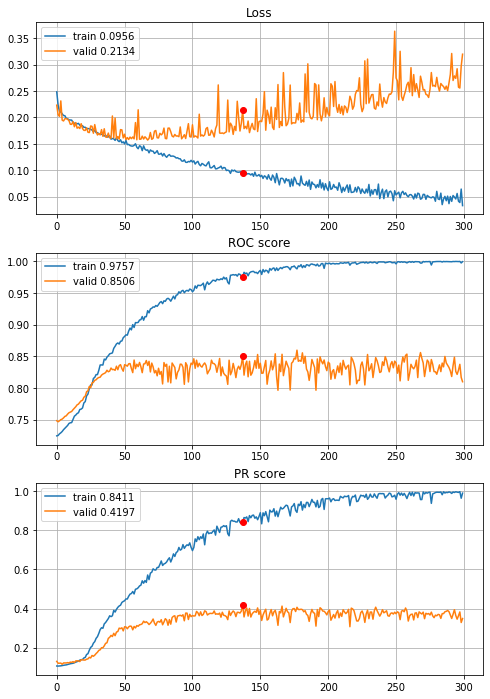


Fold 2------------------------------------------------------------


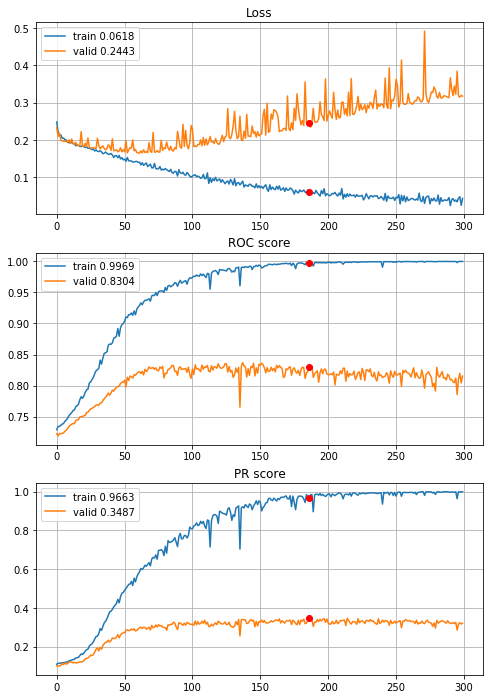


Fold 3------------------------------------------------------------


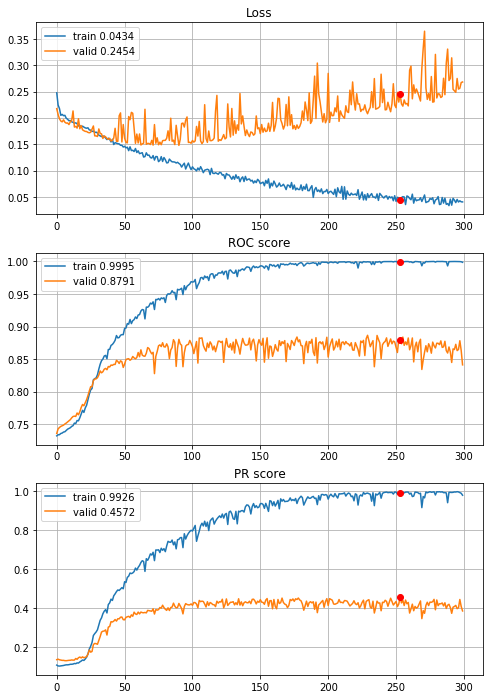


Fold 4------------------------------------------------------------


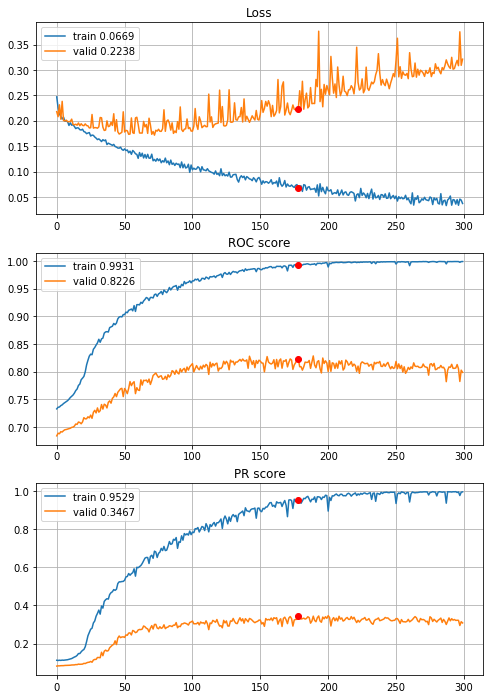


Fold 5------------------------------------------------------------


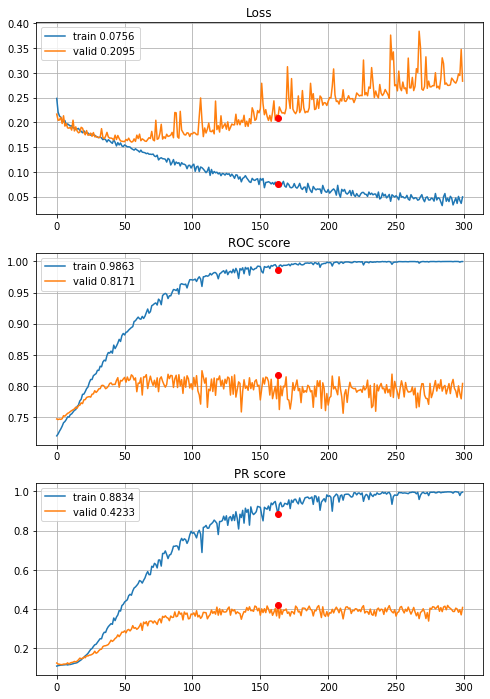


Fold 6------------------------------------------------------------


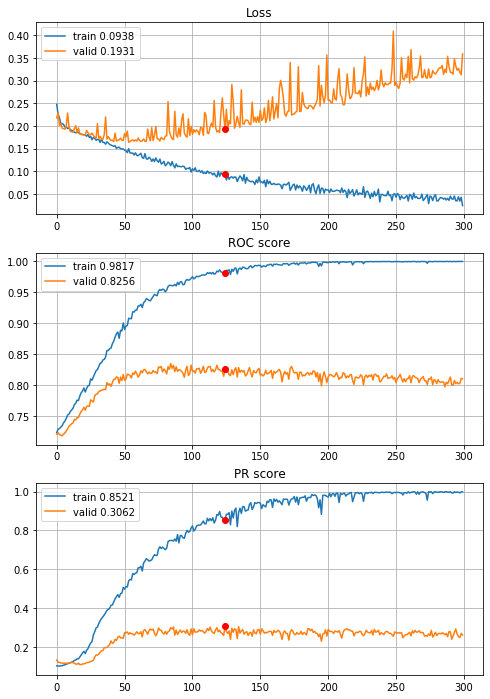

In [66]:
# basic model with L2 regularization and dropout
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_drop_02, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_drop_02_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Dropout doesn't help, lets try Adam optimization algorithm instread of RMSprop

In [51]:
def define_CNN_L2_Adam(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid,
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.94s train loss: 0.24499772582912638, validation loss: 0.2298784963786602
Epoch: 2/300,
cumulative time: 4.8s train loss: 0.22205952573860885, validation loss: 0.21394164115190506
Epoch: 3/300,
cumulative time: 6.65s train loss: 0.21058375062586512, validation loss: 0.202509094029665
Epoch: 4/300,
cumulative time: 8.49s train loss: 0.20369692206185985, validation loss: 0.1952105388045311
Epoch: 5/300,
cumulative time: 10.3s train loss: 0.1958678787382137, validation loss: 0.19204580038785934
Epoch: 6/300,
cumulative time: 12.1s train loss: 0.1934384675899879, validation loss: 0.1902964934706688
Epoch: 7/300,
cumulative time: 13.94s train loss: 0.19208280643407558, validation loss: 0.18892624601721764
Epoch: 8/300,
cumulative time: 15.81s train loss: 0.19137759415509437, validation loss: 0.18777211755514145
Epoch: 9/300,
cumulative time: 17.7s train loss: 0.19112862207642542, v

Epoch: 76/300,
cumulative time: 142.76s train loss: 0.05540879352284059, validation loss: 0.20789531245827675
Epoch: 77/300,
cumulative time: 144.62s train loss: 0.053959793662354386, validation loss: 0.21530211716890335
Epoch: 78/300,
cumulative time: 146.54s train loss: 0.05360590009167299, validation loss: 0.21471283584833145
Epoch: 79/300,
cumulative time: 148.46s train loss: 0.05335367977271049, validation loss: 0.22642167657613754
Epoch: 80/300,
cumulative time: 150.35s train loss: 0.05801717850434986, validation loss: 0.23455476760864258
Epoch: 81/300,
cumulative time: 152.25s train loss: 0.057253425439499, validation loss: 0.2193511165678501
Epoch: 82/300,
cumulative time: 154.25s train loss: 0.05369531365329993, validation loss: 0.23556750267744064
Epoch: 83/300,
cumulative time: 156.06s train loss: 0.061949486712276666, validation loss: 0.26438962668180466
Epoch: 84/300,
cumulative time: 157.99s train loss: 0.058223416280510344, validation loss: 0.2229475900530815
Epoch: 85/3

Epoch: 151/300,
cumulative time: 279.89s train loss: 0.020654300166508717, validation loss: 0.3315206915140152
Epoch: 152/300,
cumulative time: 281.72s train loss: 0.019613230497604203, validation loss: 0.3347007483243942
Epoch: 153/300,
cumulative time: 283.55s train loss: 0.02790757883936091, validation loss: 0.36077701300382614
Epoch: 154/300,
cumulative time: 285.35s train loss: 0.03332526108875318, validation loss: 0.34038810431957245
Epoch: 155/300,
cumulative time: 287.16s train loss: 0.028245393047747785, validation loss: 0.3360578417778015
Epoch: 156/300,
cumulative time: 288.96s train loss: 0.026589488260610687, validation loss: 0.3525146543979645
Epoch: 157/300,
cumulative time: 290.76s train loss: 0.024603923245859576, validation loss: 0.3376929759979248
Epoch: 158/300,
cumulative time: 292.56s train loss: 0.020673704062815077, validation loss: 0.33827363699674606
Epoch: 159/300,
cumulative time: 294.35s train loss: 0.020218142972376486, validation loss: 0.3439469411969185


Epoch: 225/300,
cumulative time: 413.78s train loss: 0.02050029928500373, validation loss: 0.370092935860157
Epoch: 226/300,
cumulative time: 415.6s train loss: 0.01982862182309659, validation loss: 0.38060638308525085
Epoch: 227/300,
cumulative time: 417.39s train loss: 0.018055716941228685, validation loss: 0.35120557248592377
Epoch: 228/300,
cumulative time: 419.19s train loss: 0.01583564466569306, validation loss: 0.3622265085577965
Epoch: 229/300,
cumulative time: 421.01s train loss: 0.015932733633159578, validation loss: 0.3522648736834526
Epoch: 230/300,
cumulative time: 422.82s train loss: 0.016021407761082712, validation loss: 0.3715873956680298
Epoch: 231/300,
cumulative time: 424.61s train loss: 0.015884569010788593, validation loss: 0.36414413154125214
Epoch: 232/300,
cumulative time: 426.41s train loss: 0.015201925573451468, validation loss: 0.3497627228498459
Epoch: 233/300,
cumulative time: 428.22s train loss: 0.01975369094263189, validation loss: 0.3646390438079834
Epoc

Epoch: 299/300,
cumulative time: 547.61s train loss: 0.012280866467295079, validation loss: 0.3830978721380234
Epoch: 300/300,
cumulative time: 549.41s train loss: 0.016799644197665112, validation loss: 0.3883275166153908

Early stopping results:
best results in epoch: 61, 
best valid PR: 0.4154314853748957, 
valid ROC: 0.8353546622521323        
overfitting PR: 0.43701043315317234, 
overfitting ROC: 0.1474031039091509

----------
Fold: 2
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.89s train loss: 0.24760480709809105, validation loss: 0.2277735061943531
Epoch: 2/300,
cumulative time: 4.67s train loss: 0.22230536345375437, validation loss: 0.21987566351890564
Epoch: 3/300,
cumulative time: 6.48s train loss: 0.2115184708128065, validation loss: 0.20743954181671143
Epoch: 4/300,
cumulative time: 8.27s train loss: 0.19963568219713537, validation loss: 0.1983652561903
Epoch: 5/300,
cumulative time: 10.04s train loss: 0.19423378761450974, valid

Epoch: 72/300,
cumulative time: 129.91s train loss: 0.06529214941230052, validation loss: 0.2284284606575966
Epoch: 73/300,
cumulative time: 131.71s train loss: 0.06799814854538065, validation loss: 0.2272665910422802
Epoch: 74/300,
cumulative time: 133.5s train loss: 0.062170736888993994, validation loss: 0.2372189201414585
Epoch: 75/300,
cumulative time: 135.29s train loss: 0.058635418684069976, validation loss: 0.2380920797586441
Epoch: 76/300,
cumulative time: 137.07s train loss: 0.05627774736863396, validation loss: 0.24537501484155655
Epoch: 77/300,
cumulative time: 138.87s train loss: 0.05854612368846254, validation loss: 0.24975598976016045
Epoch: 78/300,
cumulative time: 140.64s train loss: 0.06003206832653196, validation loss: 0.24924171715974808
Epoch: 79/300,
cumulative time: 142.42s train loss: 0.0593395114612873, validation loss: 0.2382594794034958
Epoch: 80/300,
cumulative time: 144.21s train loss: 0.05246917024508323, validation loss: 0.24487752094864845
Epoch: 81/300,


Epoch: 147/300,
cumulative time: 264.39s train loss: 0.033847686630300515, validation loss: 0.3766319453716278
Epoch: 148/300,
cumulative time: 266.16s train loss: 0.030582534352202987, validation loss: 0.36164627224206924
Epoch: 149/300,
cumulative time: 267.95s train loss: 0.03169471966391245, validation loss: 0.3526516854763031
Epoch: 150/300,
cumulative time: 269.73s train loss: 0.06083538648925453, validation loss: 0.40882281213998795
Epoch: 151/300,
cumulative time: 271.53s train loss: 0.06317553068891947, validation loss: 0.3787906616926193
Epoch: 152/300,
cumulative time: 273.31s train loss: 0.03161593499972304, validation loss: 0.3330278769135475
Epoch: 153/300,
cumulative time: 275.11s train loss: 0.024739264151570517, validation loss: 0.3547532185912132
Epoch: 154/300,
cumulative time: 276.89s train loss: 0.023475044581011777, validation loss: 0.34720881283283234
Epoch: 155/300,
cumulative time: 278.67s train loss: 0.02444030080130631, validation loss: 0.3515542522072792
Epo

Epoch: 221/300,
cumulative time: 396.81s train loss: 0.023576097659163135, validation loss: 0.3806997016072273
Epoch: 222/300,
cumulative time: 398.61s train loss: 0.023309514901816937, validation loss: 0.3853691816329956
Epoch: 223/300,
cumulative time: 400.4s train loss: 0.018014013210530054, validation loss: 0.3783133924007416
Epoch: 224/300,
cumulative time: 402.19s train loss: 0.017396123543213307, validation loss: 0.39130864292383194
Epoch: 225/300,
cumulative time: 403.97s train loss: 0.01633219775796285, validation loss: 0.3884304538369179
Epoch: 226/300,
cumulative time: 405.76s train loss: 0.016655224293126044, validation loss: 0.3926592692732811
Epoch: 227/300,
cumulative time: 407.54s train loss: 0.01502873150914635, validation loss: 0.38421712070703506
Epoch: 228/300,
cumulative time: 409.34s train loss: 0.018772254758048567, validation loss: 0.3843218684196472
Epoch: 229/300,
cumulative time: 411.11s train loss: 0.01737839969488995, validation loss: 0.4078918322920799
Epo

Epoch: 295/300,
cumulative time: 529.44s train loss: 0.014034572093846412, validation loss: 0.42936043441295624
Epoch: 296/300,
cumulative time: 531.22s train loss: 0.014353263270159082, validation loss: 0.42961428314447403
Epoch: 297/300,
cumulative time: 533.02s train loss: 0.02062109202797368, validation loss: 0.4296593964099884
Epoch: 298/300,
cumulative time: 534.8s train loss: 0.0157377803641423, validation loss: 0.43049562722444534
Epoch: 299/300,
cumulative time: 536.6s train loss: 0.01924940267929674, validation loss: 0.4443827122449875
Epoch: 300/300,
cumulative time: 538.38s train loss: 0.01614798468841763, validation loss: 0.4288961812853813

Early stopping results:
best results in epoch: 97, 
best valid PR: 0.36826432806371223, 
valid ROC: 0.8281234732400622        
overfitting PR: 0.6176982647080329, 
overfitting ROC: 0.17095006072555807

----------
Fold: 3
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 4.07s train loss: 0.246225

Epoch: 68/300,
cumulative time: 129.71s train loss: 0.06818301196996218, validation loss: 0.17135455151398976
Epoch: 69/300,
cumulative time: 131.59s train loss: 0.06604487017616185, validation loss: 0.19576235931071023
Epoch: 70/300,
cumulative time: 133.48s train loss: 0.07672658495314612, validation loss: 0.16922931739262173
Epoch: 71/300,
cumulative time: 135.34s train loss: 0.0787441200814726, validation loss: 0.21821691197062296
Epoch: 72/300,
cumulative time: 137.22s train loss: 0.0902880137551931, validation loss: 0.19622075356188273
Epoch: 73/300,
cumulative time: 139.09s train loss: 0.07175691480187575, validation loss: 0.17549062785648165
Epoch: 74/300,
cumulative time: 140.95s train loss: 0.061391725840151755, validation loss: 0.16683077729883647
Epoch: 75/300,
cumulative time: 142.82s train loss: 0.06256531178289158, validation loss: 0.17016935673971026
Epoch: 76/300,
cumulative time: 144.68s train loss: 0.06138889345327307, validation loss: 0.17041214010072134
Epoch: 77/3

Epoch: 143/300,
cumulative time: 270.51s train loss: 0.03550885604703708, validation loss: 0.2716884539619325
Epoch: 144/300,
cumulative time: 272.39s train loss: 0.026980406503617892, validation loss: 0.25904716546573336
Epoch: 145/300,
cumulative time: 274.27s train loss: 0.02118892533430574, validation loss: 0.26536752702697874
Epoch: 146/300,
cumulative time: 276.15s train loss: 0.02285082046861453, validation loss: 0.25963711959975105
Epoch: 147/300,
cumulative time: 278.02s train loss: 0.023691997833912244, validation loss: 0.27118343975808884
Epoch: 148/300,
cumulative time: 279.89s train loss: 0.024625595040421687, validation loss: 0.26686362283570425
Epoch: 149/300,
cumulative time: 281.77s train loss: 0.023778379465251975, validation loss: 0.2642387371025388
Epoch: 150/300,
cumulative time: 283.65s train loss: 0.024707998005916613, validation loss: 0.26110386328091695
Epoch: 151/300,
cumulative time: 285.52s train loss: 0.024231609928455845, validation loss: 0.276005169361356

Epoch: 217/300,
cumulative time: 410.09s train loss: 0.018738113847388913, validation loss: 0.32062018417176746
Epoch: 218/300,
cumulative time: 411.95s train loss: 0.026607937386295615, validation loss: 0.29471293144755895
Epoch: 219/300,
cumulative time: 413.82s train loss: 0.10528852764606453, validation loss: 0.3945128600370316
Epoch: 220/300,
cumulative time: 415.7s train loss: 0.08066946664682965, validation loss: 0.27851235955480547
Epoch: 221/300,
cumulative time: 417.57s train loss: 0.03949096608588701, validation loss: 0.26438422303351145
Epoch: 222/300,
cumulative time: 419.44s train loss: 0.024106626693971366, validation loss: 0.27526873140108016
Epoch: 223/300,
cumulative time: 421.34s train loss: 0.01978638965361718, validation loss: 0.26450920623446267
Epoch: 224/300,
cumulative time: 423.21s train loss: 0.01720885746736707, validation loss: 0.2750244917756035
Epoch: 225/300,
cumulative time: 425.1s train loss: 0.015406093231352797, validation loss: 0.27167512061103943
E

Epoch: 291/300,
cumulative time: 549.76s train loss: 0.014905785246728202, validation loss: 0.30935397585233054
Epoch: 292/300,
cumulative time: 551.65s train loss: 0.014807940839915254, validation loss: 0.31415043079663835
Epoch: 293/300,
cumulative time: 553.53s train loss: 0.012664578675086824, validation loss: 0.3141877041355012
Epoch: 294/300,
cumulative time: 555.45s train loss: 0.013845301935773439, validation loss: 0.31796183828323604
Epoch: 295/300,
cumulative time: 557.31s train loss: 0.012803767043167873, validation loss: 0.29481341959938173
Epoch: 296/300,
cumulative time: 559.18s train loss: 0.014261450090357968, validation loss: 0.30658024613819423
Epoch: 297/300,
cumulative time: 561.05s train loss: 0.01405937201996715, validation loss: 0.30924190596928675
Epoch: 298/300,
cumulative time: 562.92s train loss: 0.014788935279954398, validation loss: 0.30231816882178897
Epoch: 299/300,
cumulative time: 564.82s train loss: 0.021078924025493224, validation loss: 0.343861269269

Epoch: 64/300,
cumulative time: 120.14s train loss: 0.09079606638684769, validation loss: 0.192865465652375
Epoch: 65/300,
cumulative time: 121.99s train loss: 0.09292657379383996, validation loss: 0.19412098496679275
Epoch: 66/300,
cumulative time: 123.85s train loss: 0.08489595488389162, validation loss: 0.19254770870246585
Epoch: 67/300,
cumulative time: 125.69s train loss: 0.08052685232737258, validation loss: 0.1964369331087385
Epoch: 68/300,
cumulative time: 127.55s train loss: 0.0805230085485339, validation loss: 0.19955497408670092
Epoch: 69/300,
cumulative time: 129.42s train loss: 0.07988501409671929, validation loss: 0.2171214919430869
Epoch: 70/300,
cumulative time: 131.27s train loss: 0.08262659241659956, validation loss: 0.21581273922844538
Epoch: 71/300,
cumulative time: 133.11s train loss: 0.08080380870024838, validation loss: 0.20385574520580352
Epoch: 72/300,
cumulative time: 134.97s train loss: 0.07824850277718635, validation loss: 0.20235544002245343
Epoch: 73/300,


Epoch: 139/300,
cumulative time: 259.25s train loss: 0.027285864833736233, validation loss: 0.340175025936157
Epoch: 140/300,
cumulative time: 261.13s train loss: 0.028809152107973822, validation loss: 0.3536195274004861
Epoch: 141/300,
cumulative time: 262.98s train loss: 0.038215781228967516, validation loss: 0.350547070351858
Epoch: 142/300,
cumulative time: 264.82s train loss: 0.038885951739750915, validation loss: 0.37192586005680145
Epoch: 143/300,
cumulative time: 266.68s train loss: 0.036549367887410505, validation loss: 0.373739132786554
Epoch: 144/300,
cumulative time: 268.52s train loss: 0.037833141868370536, validation loss: 0.35875100260689147
Epoch: 145/300,
cumulative time: 270.4s train loss: 0.03833040652468647, validation loss: 0.35033256865683055
Epoch: 146/300,
cumulative time: 272.24s train loss: 0.030893043514071072, validation loss: 0.3664030656738887
Epoch: 147/300,
cumulative time: 274.09s train loss: 0.03944594009819711, validation loss: 0.34656563386084543
Epo

Epoch: 213/300,
cumulative time: 396.65s train loss: 0.019903108005369242, validation loss: 0.41771300217461965
Epoch: 214/300,
cumulative time: 398.5s train loss: 0.017786926094627523, validation loss: 0.42213852704517424
Epoch: 215/300,
cumulative time: 400.35s train loss: 0.019057620494566517, validation loss: 0.4458433009329296
Epoch: 216/300,
cumulative time: 402.19s train loss: 0.020972647294033236, validation loss: 0.4294766624957796
Epoch: 217/300,
cumulative time: 404.04s train loss: 0.017978265818638352, validation loss: 0.4251721285259913
Epoch: 218/300,
cumulative time: 405.88s train loss: 0.01808341502409319, validation loss: 0.42497497125277445
Epoch: 219/300,
cumulative time: 407.73s train loss: 0.02201301256218121, validation loss: 0.4353294987716372
Epoch: 220/300,
cumulative time: 409.58s train loss: 0.022321597900361267, validation loss: 0.4579926313483526
Epoch: 221/300,
cumulative time: 411.43s train loss: 0.025594293006862633, validation loss: 0.46271819419331023


Epoch: 287/300,
cumulative time: 534.03s train loss: 0.01445331984769822, validation loss: 0.4524779416076721
Epoch: 288/300,
cumulative time: 535.89s train loss: 0.014976685260650362, validation loss: 0.44440053196180435
Epoch: 289/300,
cumulative time: 537.74s train loss: 0.014681752895520426, validation loss: 0.48499456015844195
Epoch: 290/300,
cumulative time: 539.59s train loss: 0.029889481852271617, validation loss: 0.4526633586580791
Epoch: 291/300,
cumulative time: 541.45s train loss: 0.03082856287550991, validation loss: 0.4677812696260119
Epoch: 292/300,
cumulative time: 543.31s train loss: 0.029060463531831202, validation loss: 0.4483753710701352
Epoch: 293/300,
cumulative time: 545.15s train loss: 0.020321984024465622, validation loss: 0.4553171211197263
Epoch: 294/300,
cumulative time: 547.01s train loss: 0.015473672210455123, validation loss: 0.4441348348155854
Epoch: 295/300,
cumulative time: 548.86s train loss: 0.01524301706539566, validation loss: 0.4506128484294528
Ep

Epoch: 60/300,
cumulative time: 112.64s train loss: 0.08874624949887393, validation loss: 0.19692393129780178
Epoch: 61/300,
cumulative time: 114.5s train loss: 0.08871773940056914, validation loss: 0.20624553274540675
Epoch: 62/300,
cumulative time: 116.35s train loss: 0.09013203629400732, validation loss: 0.22295919223437233
Epoch: 63/300,
cumulative time: 118.2s train loss: 0.09420838309349075, validation loss: 0.2182430706894587
Epoch: 64/300,
cumulative time: 120.06s train loss: 0.09218335719853621, validation loss: 0.2045745991335975
Epoch: 65/300,
cumulative time: 121.96s train loss: 0.09142093727230587, validation loss: 0.20382310330867767
Epoch: 66/300,
cumulative time: 123.83s train loss: 0.08807536781352532, validation loss: 0.2119739972409748
Epoch: 67/300,
cumulative time: 125.67s train loss: 0.07708536734965545, validation loss: 0.2177152623070611
Epoch: 68/300,
cumulative time: 127.53s train loss: 0.0761787315942437, validation loss: 0.20978194444898576
Epoch: 69/300,
cu

Epoch: 135/300,
cumulative time: 251.66s train loss: 0.03055429712039112, validation loss: 0.34273984965823945
Epoch: 136/300,
cumulative time: 253.51s train loss: 0.030080950645034923, validation loss: 0.3626273335918548
Epoch: 137/300,
cumulative time: 255.37s train loss: 0.028884612352991522, validation loss: 0.34651316351360745
Epoch: 138/300,
cumulative time: 257.22s train loss: 0.033849088724107176, validation loss: 0.38158673725430925
Epoch: 139/300,
cumulative time: 259.06s train loss: 0.03250200022756864, validation loss: 0.36756303709650795
Epoch: 140/300,
cumulative time: 260.92s train loss: 0.032285259318675985, validation loss: 0.35622066694592674
Epoch: 141/300,
cumulative time: 262.79s train loss: 0.030832283854318087, validation loss: 0.38188445649449787
Epoch: 142/300,
cumulative time: 264.65s train loss: 0.02979319066923479, validation loss: 0.3808958288412245
Epoch: 143/300,
cumulative time: 266.53s train loss: 0.03259762080632916, validation loss: 0.3872391655899229

Epoch: 209/300,
cumulative time: 389.32s train loss: 0.034850296563336096, validation loss: 0.3917849194435846
Epoch: 210/300,
cumulative time: 391.18s train loss: 0.022120495716395287, validation loss: 0.40953630772847976
Epoch: 211/300,
cumulative time: 393.05s train loss: 0.02100749949996652, validation loss: 0.3917323809010642
Epoch: 212/300,
cumulative time: 394.91s train loss: 0.018497970037023262, validation loss: 0.400162172166128
Epoch: 213/300,
cumulative time: 396.77s train loss: 0.017265537462847643, validation loss: 0.38501948551526144
Epoch: 214/300,
cumulative time: 398.63s train loss: 0.017138452048395602, validation loss: 0.39184085520486983
Epoch: 215/300,
cumulative time: 400.49s train loss: 0.019684106636481704, validation loss: 0.39140058998077637
Epoch: 216/300,
cumulative time: 402.35s train loss: 0.01732017318848783, validation loss: 0.42660497722171603
Epoch: 217/300,
cumulative time: 404.18s train loss: 0.0203416640613116, validation loss: 0.39852644356470257


Epoch: 283/300,
cumulative time: 526.54s train loss: 0.017983692103586132, validation loss: 0.4302164360455104
Epoch: 284/300,
cumulative time: 528.42s train loss: 0.017925904810729403, validation loss: 0.4365033829779852
Epoch: 285/300,
cumulative time: 530.27s train loss: 0.017411336990164835, validation loss: 0.4382310980463785
Epoch: 286/300,
cumulative time: 532.11s train loss: 0.01824527617269162, validation loss: 0.4201011836339557
Epoch: 287/300,
cumulative time: 533.96s train loss: 0.016257486858870893, validation loss: 0.4230363188849555
Epoch: 288/300,
cumulative time: 535.82s train loss: 0.01602026901870088, validation loss: 0.43959070024036223
Epoch: 289/300,
cumulative time: 537.69s train loss: 0.01898169160192844, validation loss: 0.4218859751262362
Epoch: 290/300,
cumulative time: 539.53s train loss: 0.018605211690438078, validation loss: 0.4206022798447382
Epoch: 291/300,
cumulative time: 541.4s train loss: 0.015961777868374313, validation loss: 0.45526312907536826
Epo

Epoch: 56/300,
cumulative time: 104.71s train loss: 0.09577260664026341, validation loss: 0.18874715425665417
Epoch: 57/300,
cumulative time: 106.58s train loss: 0.0919229110918766, validation loss: 0.18882383397647312
Epoch: 58/300,
cumulative time: 108.44s train loss: 0.09005267511671594, validation loss: 0.19208370748966458
Epoch: 59/300,
cumulative time: 110.29s train loss: 0.0920866886431665, validation loss: 0.1972808437120347
Epoch: 60/300,
cumulative time: 112.14s train loss: 0.09612575429518301, validation loss: 0.2004183909249684
Epoch: 61/300,
cumulative time: 113.97s train loss: 0.09089152866039722, validation loss: 0.21852839259874254
Epoch: 62/300,
cumulative time: 115.82s train loss: 0.08934609724003696, validation loss: 0.19448228271234602
Epoch: 63/300,
cumulative time: 117.68s train loss: 0.08255231239055791, validation loss: 0.19323608949070886
Epoch: 64/300,
cumulative time: 119.51s train loss: 0.08068827513008989, validation loss: 0.20093636311235882
Epoch: 65/300,

Epoch: 131/300,
cumulative time: 243.53s train loss: 0.027677084361739202, validation loss: 0.32677525851461625
Epoch: 132/300,
cumulative time: 245.39s train loss: 0.03102318030401688, validation loss: 0.33658288149606613
Epoch: 133/300,
cumulative time: 247.23s train loss: 0.031041338453366093, validation loss: 0.3316280580891503
Epoch: 134/300,
cumulative time: 249.08s train loss: 0.035430002815229754, validation loss: 0.33626689464326887
Epoch: 135/300,
cumulative time: 250.96s train loss: 0.034714039047652426, validation loss: 0.33701399822083733
Epoch: 136/300,
cumulative time: 252.83s train loss: 0.028450596336286216, validation loss: 0.3498457291391161
Epoch: 137/300,
cumulative time: 254.68s train loss: 0.032882958002907754, validation loss: 0.33846536572017366
Epoch: 138/300,
cumulative time: 256.54s train loss: 0.03211884599728104, validation loss: 0.3740570476320055
Epoch: 139/300,
cumulative time: 258.4s train loss: 0.03265492589660703, validation loss: 0.3535710891655513


Epoch: 205/300,
cumulative time: 384.08s train loss: 0.03640451957610593, validation loss: 0.4089636667001815
Epoch: 206/300,
cumulative time: 386.09s train loss: 0.02404393866172036, validation loss: 0.38490177487570143
Epoch: 207/300,
cumulative time: 387.97s train loss: 0.022839093746604904, validation loss: 0.3853984734936366
Epoch: 208/300,
cumulative time: 389.88s train loss: 0.01865675196385488, validation loss: 0.3817725497578818
Epoch: 209/300,
cumulative time: 391.81s train loss: 0.01685124577076412, validation loss: 0.3742230786596026
Epoch: 210/300,
cumulative time: 393.7s train loss: 0.019578362919245484, validation loss: 0.4124402694853525
Epoch: 211/300,
cumulative time: 395.6s train loss: 0.0221056846767698, validation loss: 0.3905842083408719
Epoch: 212/300,
cumulative time: 397.58s train loss: 0.018981649435255467, validation loss: 0.402979345624409
Epoch: 213/300,
cumulative time: 399.62s train loss: 0.019158419459524744, validation loss: 0.3843797040364099
Epoch: 21

Epoch: 279/300,
cumulative time: 527.42s train loss: 0.015667511038628797, validation loss: 0.4081827159533425
Epoch: 280/300,
cumulative time: 529.3s train loss: 0.015249742027946735, validation loss: 0.40275432153353613
Epoch: 281/300,
cumulative time: 531.16s train loss: 0.022104642420044264, validation loss: 0.40370426136349874
Epoch: 282/300,
cumulative time: 533.0s train loss: 0.018523935642402244, validation loss: 0.4013855861103724
Epoch: 283/300,
cumulative time: 534.88s train loss: 0.0150142234039629, validation loss: 0.41325906057206413
Epoch: 284/300,
cumulative time: 536.72s train loss: 0.018062464398413167, validation loss: 0.3922508827845256
Epoch: 285/300,
cumulative time: 538.57s train loss: 0.018715607458757496, validation loss: 0.39815886274216666
Epoch: 286/300,
cumulative time: 540.42s train loss: 0.019074303129354726, validation loss: 0.4957351853733971
Epoch: 287/300,
cumulative time: 542.27s train loss: 0.02030649606005574, validation loss: 0.4015124575486259
Ep

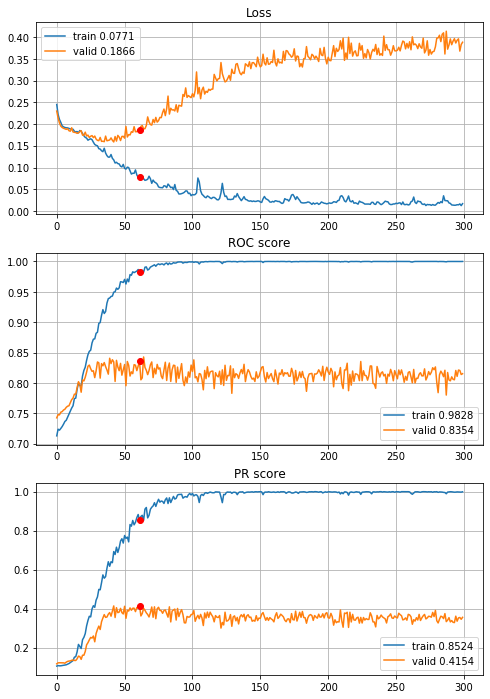


Fold 2------------------------------------------------------------


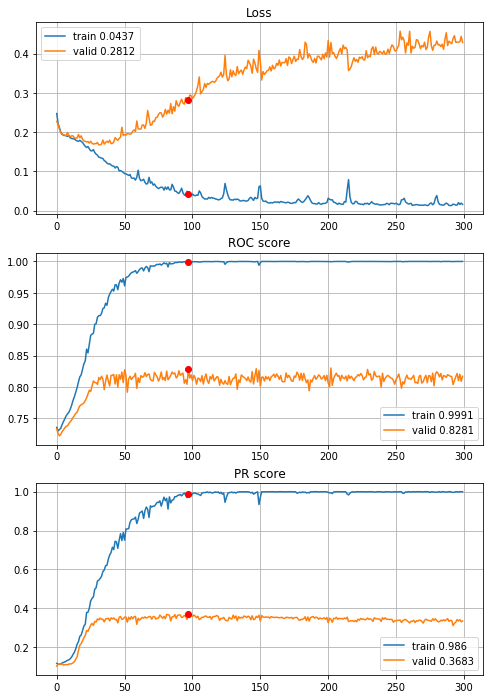


Fold 3------------------------------------------------------------


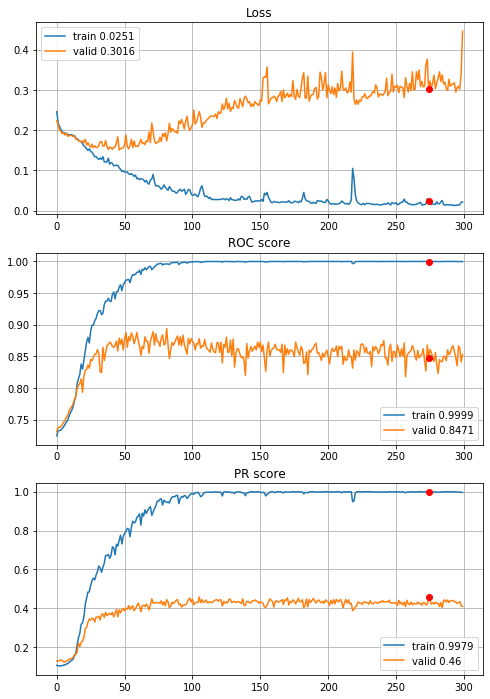


Fold 4------------------------------------------------------------


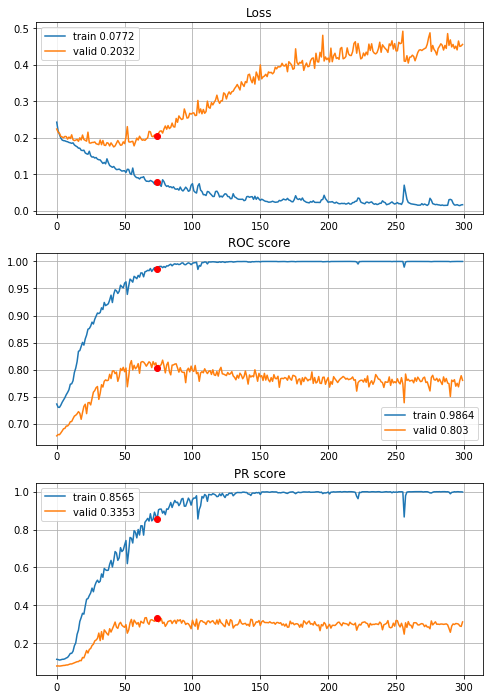


Fold 5------------------------------------------------------------


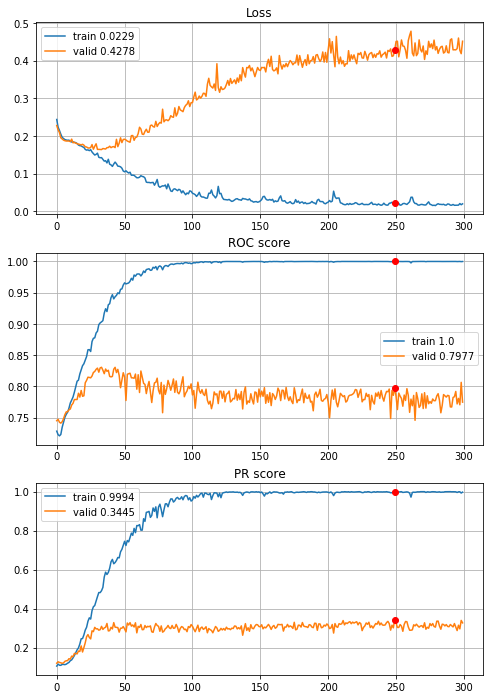


Fold 6------------------------------------------------------------


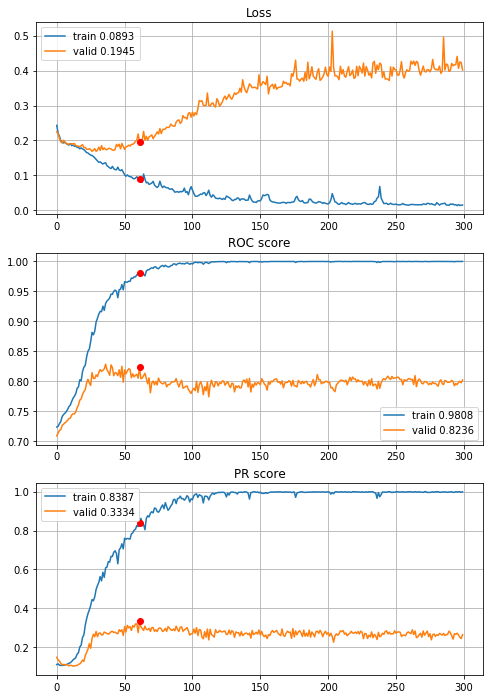

In [68]:
# basic model with L2 regularization and Adam optimizer
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_Adam, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_Adam_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Adam is not working well.

Lets try bigger regularization

In [52]:
def define_CNN_L2_more(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.0001))(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid,
                         kernel_regularizer=regularizers.l2(l=0.0001))(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.72s train loss: 0.2704470477063623, validation loss: 0.2444034367799759
Epoch: 2/300,
cumulative time: 4.36s train loss: 0.24526393281484146, validation loss: 0.22384827584028244
Epoch: 3/300,
cumulative time: 6.06s train loss: 0.22677891005593062, validation loss: 0.21574870496988297
Epoch: 4/300,
cumulative time: 7.67s train loss: 0.22183058893713872, validation loss: 0.24365079402923584
Epoch: 5/300,
cumulative time: 9.22s train loss: 0.21585796932359225, validation loss: 0.20625096559524536
Epoch: 6/300,
cumulative time: 10.78s train loss: 0.20976865201916048, validation loss: 0.20366263762116432
Epoch: 7/300,
cumulative time: 12.34s train loss: 0.2109163741189977, validation loss: 0.20561358705163002
Epoch: 8/300,
cumulative time: 13.89s train loss: 0.20624526391830342, validation loss: 0.20602214336395264
Epoch: 9/300,
cumulative time: 15.46s train loss: 0.2020224314646

Epoch: 76/300,
cumulative time: 120.66s train loss: 0.13051324409804954, validation loss: 0.15347948670387268
Epoch: 77/300,
cumulative time: 122.19s train loss: 0.1287013054917599, validation loss: 0.159397654235363
Epoch: 78/300,
cumulative time: 123.71s train loss: 0.13146456263092884, validation loss: 0.1534891054034233
Epoch: 79/300,
cumulative time: 125.2s train loss: 0.12811064634636732, validation loss: 0.15569354221224785
Epoch: 80/300,
cumulative time: 126.69s train loss: 0.12911607606034706, validation loss: 0.1741507276892662
Epoch: 81/300,
cumulative time: 128.17s train loss: 0.12696743682745812, validation loss: 0.15466159209609032
Epoch: 82/300,
cumulative time: 129.65s train loss: 0.1277896857514425, validation loss: 0.14696341380476952
Epoch: 83/300,
cumulative time: 131.14s train loss: 0.1255347815381506, validation loss: 0.16978004202246666
Epoch: 84/300,
cumulative time: 132.62s train loss: 0.12561332301977868, validation loss: 0.1699650175869465
Epoch: 85/300,
cumu

Epoch: 151/300,
cumulative time: 231.78s train loss: 0.08591725186758413, validation loss: 0.16837642341852188
Epoch: 152/300,
cumulative time: 233.49s train loss: 0.08811257605442334, validation loss: 0.1639884114265442
Epoch: 153/300,
cumulative time: 235.04s train loss: 0.0798181384582396, validation loss: 0.1999942548573017
Epoch: 154/300,
cumulative time: 236.56s train loss: 0.08357784091487883, validation loss: 0.2074071168899536
Epoch: 155/300,
cumulative time: 238.07s train loss: 0.080423881797855, validation loss: 0.16678312793374062
Epoch: 156/300,
cumulative time: 239.6s train loss: 0.08296189652618689, validation loss: 0.17504947632551193
Epoch: 157/300,
cumulative time: 241.13s train loss: 0.07638115014307628, validation loss: 0.1791699156165123
Epoch: 158/300,
cumulative time: 242.67s train loss: 0.07921921191836384, validation loss: 0.16992149502038956
Epoch: 159/300,
cumulative time: 244.19s train loss: 0.07528809693756898, validation loss: 0.18261348828673363
Epoch: 16

Epoch: 226/300,
cumulative time: 344.7s train loss: 0.055508001970951175, validation loss: 0.2111925110220909
Epoch: 227/300,
cumulative time: 346.29s train loss: 0.05137958674497217, validation loss: 0.2234906367957592
Epoch: 228/300,
cumulative time: 347.9s train loss: 0.058694852860393776, validation loss: 0.2138226218521595
Epoch: 229/300,
cumulative time: 349.48s train loss: 0.05141737303943002, validation loss: 0.20949161052703857
Epoch: 230/300,
cumulative time: 351.11s train loss: 0.05666092982247979, validation loss: 0.2402161881327629
Epoch: 231/300,
cumulative time: 352.78s train loss: 0.055207103650700994, validation loss: 0.1988065354526043
Epoch: 232/300,
cumulative time: 354.57s train loss: 0.045994204307261644, validation loss: 0.24787917360663414
Epoch: 233/300,
cumulative time: 356.26s train loss: 0.05016329406901112, validation loss: 0.3420230895280838
Epoch: 234/300,
cumulative time: 357.92s train loss: 0.05305232993176197, validation loss: 0.21844838559627533
Epoch

Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.47s train loss: 0.27215029923609513, validation loss: 0.2708076983690262
Epoch: 2/300,
cumulative time: 3.98s train loss: 0.24311626659788535, validation loss: 0.23049144446849823
Epoch: 3/300,
cumulative time: 5.68s train loss: 0.22590424837861464, validation loss: 0.22028499469161034
Epoch: 4/300,
cumulative time: 7.26s train loss: 0.22558232122126903, validation loss: 0.21403924003243446
Epoch: 5/300,
cumulative time: 8.8s train loss: 0.21272694993784974, validation loss: 0.20928964763879776
Epoch: 6/300,
cumulative time: 10.35s train loss: 0.21475826737358825, validation loss: 0.2078433744609356
Epoch: 7/300,
cumulative time: 11.89s train loss: 0.2091525935389597, validation loss: 0.20610368251800537
Epoch: 8/300,
cumulative time: 13.46s train loss: 0.20762060587178516, validation loss: 0.2051176056265831
Epoch: 9/300,
cumulative time: 14.98s train loss: 0.20169667921555473, validation loss: 0.20231000

Epoch: 77/300,
cumulative time: 115.73s train loss: 0.135192190811091, validation loss: 0.1610141359269619
Epoch: 78/300,
cumulative time: 117.21s train loss: 0.12478404851235854, validation loss: 0.16180526092648506
Epoch: 79/300,
cumulative time: 118.7s train loss: 0.12299495286494115, validation loss: 0.16511253267526627
Epoch: 80/300,
cumulative time: 120.17s train loss: 0.12324107386864279, validation loss: 0.16480523720383644
Epoch: 81/300,
cumulative time: 121.67s train loss: 0.12583968408477675, validation loss: 0.16413580253720284
Epoch: 82/300,
cumulative time: 123.15s train loss: 0.1223333614328266, validation loss: 0.21509913355112076
Epoch: 83/300,
cumulative time: 124.67s train loss: 0.12418844527198374, validation loss: 0.1660894900560379
Epoch: 84/300,
cumulative time: 126.33s train loss: 0.12163196130830241, validation loss: 0.16300196573138237
Epoch: 85/300,
cumulative time: 127.86s train loss: 0.1227025200105322, validation loss: 0.1715124323964119
Epoch: 86/300,
cum

Epoch: 152/300,
cumulative time: 229.29s train loss: 0.08233846661503724, validation loss: 0.20875365287065506
Epoch: 153/300,
cumulative time: 230.8s train loss: 0.08167383342001297, validation loss: 0.20286232605576515
Epoch: 154/300,
cumulative time: 232.31s train loss: 0.0941416689442114, validation loss: 0.24278857186436653
Epoch: 155/300,
cumulative time: 233.81s train loss: 0.07101610821798073, validation loss: 0.2086694911122322
Epoch: 156/300,
cumulative time: 235.31s train loss: 0.08599625176614374, validation loss: 0.27812329307198524
Epoch: 157/300,
cumulative time: 236.81s train loss: 0.07368740685654963, validation loss: 0.20566019043326378
Epoch: 158/300,
cumulative time: 238.32s train loss: 0.0881042184971307, validation loss: 0.22077755630016327
Epoch: 159/300,
cumulative time: 239.82s train loss: 0.07210176141999772, validation loss: 0.20694496855139732
Epoch: 160/300,
cumulative time: 241.33s train loss: 0.08045921611863081, validation loss: 0.21478241309523582
Epoch

Epoch: 227/300,
cumulative time: 342.99s train loss: 0.05327835422503034, validation loss: 0.27071522548794746
Epoch: 228/300,
cumulative time: 344.51s train loss: 0.05365412897222716, validation loss: 0.2566697597503662
Epoch: 229/300,
cumulative time: 346.05s train loss: 0.06390179562065022, validation loss: 0.26255717128515244
Epoch: 230/300,
cumulative time: 347.6s train loss: 0.05374498312007267, validation loss: 0.27250274270772934
Epoch: 231/300,
cumulative time: 349.17s train loss: 0.04815384548076099, validation loss: 0.26882877200841904
Epoch: 232/300,
cumulative time: 350.7s train loss: 0.06063633042762748, validation loss: 0.2749732658267021
Epoch: 233/300,
cumulative time: 352.33s train loss: 0.04905672985568468, validation loss: 0.2673795372247696
Epoch: 234/300,
cumulative time: 353.84s train loss: 0.055047738476509275, validation loss: 0.2962620258331299
Epoch: 235/300,
cumulative time: 355.38s train loss: 0.05792714310966057, validation loss: 0.2662147805094719
Epoch: 

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.51s train loss: 0.2685787335910273, validation loss: 0.2477240322695838
Epoch: 2/300,
cumulative time: 4.02s train loss: 0.24815386414179816, validation loss: 0.22328563150905428
Epoch: 3/300,
cumulative time: 5.51s train loss: 0.2282742298680755, validation loss: 0.2126091384130811
Epoch: 4/300,
cumulative time: 7.01s train loss: 0.21661073598247865, validation loss: 0.2111705127973405
Epoch: 5/300,
cumulative time: 8.52s train loss: 0.21666994138131426, validation loss: 0.20397394771613772
Epoch: 6/300,
cumulative time: 10.02s train loss: 0.21122318342038637, validation loss: 0.20635028130478328
Epoch: 7/300,
cumulative time: 11.53s train loss: 0.21077800259775387, validation loss: 0.19974035129660653
Epoch: 8/300,
cumulative time: 13.04s train loss: 0.2043036931024464, validation loss: 0.1975165145548563
Epoch: 9/300,
cumulative time: 14.54s train loss: 0.20064250186560526, validation loss: 0.1972545025

Epoch: 77/300,
cumulative time: 117.21s train loss: 0.1266477360396393, validation loss: 0.14975065736543564
Epoch: 78/300,
cumulative time: 118.71s train loss: 0.1310244191849884, validation loss: 0.15051111741671486
Epoch: 79/300,
cumulative time: 120.2s train loss: 0.12331307082668361, validation loss: 0.1656307142594504
Epoch: 80/300,
cumulative time: 121.71s train loss: 0.12911185017239854, validation loss: 0.15417645504550329
Epoch: 81/300,
cumulative time: 123.2s train loss: 0.12734053706637005, validation loss: 0.1494417945733146
Epoch: 82/300,
cumulative time: 124.7s train loss: 0.12253264186628823, validation loss: 0.1698733663369739
Epoch: 83/300,
cumulative time: 126.18s train loss: 0.12105091206159055, validation loss: 0.15986237146551646
Epoch: 84/300,
cumulative time: 127.68s train loss: 0.12764440266533947, validation loss: 0.15088857949726164
Epoch: 85/300,
cumulative time: 129.22s train loss: 0.12512833370545862, validation loss: 0.15753492262628344
Epoch: 86/300,
cum

Epoch: 152/300,
cumulative time: 229.88s train loss: 0.08839320575671102, validation loss: 0.16642251981629266
Epoch: 153/300,
cumulative time: 231.4s train loss: 0.09379552555493599, validation loss: 0.16026185459560818
Epoch: 154/300,
cumulative time: 232.9s train loss: 0.08806366821703941, validation loss: 0.17012269678569975
Epoch: 155/300,
cumulative time: 234.4s train loss: 0.0873030362513838, validation loss: 0.17116906764961423
Epoch: 156/300,
cumulative time: 235.88s train loss: 0.09274355328649043, validation loss: 0.16315009106719305
Epoch: 157/300,
cumulative time: 237.37s train loss: 0.08912527544445929, validation loss: 0.15872778071297539
Epoch: 158/300,
cumulative time: 238.88s train loss: 0.08292964146428412, validation loss: 0.22579678709544831
Epoch: 159/300,
cumulative time: 240.39s train loss: 0.09668097956328582, validation loss: 0.1602212252219518
Epoch: 160/300,
cumulative time: 241.89s train loss: 0.07745806605921522, validation loss: 0.199962274034818
Epoch: 1

Epoch: 227/300,
cumulative time: 343.25s train loss: 0.05571699940955501, validation loss: 0.21922440847707172
Epoch: 228/300,
cumulative time: 344.75s train loss: 0.06542862550519483, validation loss: 0.1927809889165182
Epoch: 229/300,
cumulative time: 346.26s train loss: 0.052856092556783266, validation loss: 0.20037366213306548
Epoch: 230/300,
cumulative time: 347.75s train loss: 0.06352288258647773, validation loss: 0.19020105774440463
Epoch: 231/300,
cumulative time: 349.25s train loss: 0.05822790268242503, validation loss: 0.19025588159523313
Epoch: 232/300,
cumulative time: 350.75s train loss: 0.053649509510776634, validation loss: 0.19797468959339082
Epoch: 233/300,
cumulative time: 352.25s train loss: 0.05230135454028803, validation loss: 0.2127006027244386
Epoch: 234/300,
cumulative time: 353.75s train loss: 0.05982894995906593, validation loss: 0.19631905512204245
Epoch: 235/300,
cumulative time: 355.24s train loss: 0.05417190592131125, validation loss: 0.2526647529337141
Ep

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.34s train loss: 0.27001628263417093, validation loss: 0.2479833451717619
Epoch: 2/300,
cumulative time: 3.85s train loss: 0.24626273317084, validation loss: 0.22532809624596248
Epoch: 3/300,
cumulative time: 5.37s train loss: 0.22597538631882813, validation loss: 0.24928496661640348
Epoch: 4/300,
cumulative time: 6.89s train loss: 0.21750880229423172, validation loss: 0.21446469407232982
Epoch: 5/300,
cumulative time: 8.4s train loss: 0.21054192913074973, validation loss: 0.22577338125970628
Epoch: 6/300,
cumulative time: 9.91s train loss: 0.21225662509794538, validation loss: 0.2123749816228473
Epoch: 7/300,
cumulative time: 11.43s train loss: 0.20520578255746605, validation loss: 0.20682130995250883
Epoch: 8/300,
cumulative time: 12.96s train loss: 0.20291390928033193, validation loss: 0.20510469383663602
Epoch: 9/300,
cumulative time: 14.46s train loss: 0.200267132540501, validation loss: 0.203313655654

Epoch: 77/300,
cumulative time: 118.66s train loss: 0.12005083887191446, validation loss: 0.18216075976689658
Epoch: 78/300,
cumulative time: 120.19s train loss: 0.11735919188678272, validation loss: 0.18280781548174602
Epoch: 79/300,
cumulative time: 121.7s train loss: 0.1175811376644449, validation loss: 0.19009735278666964
Epoch: 80/300,
cumulative time: 123.21s train loss: 0.11962057540368895, validation loss: 0.2135136201835814
Epoch: 81/300,
cumulative time: 124.73s train loss: 0.12162827863349093, validation loss: 0.18016049389801328
Epoch: 82/300,
cumulative time: 126.24s train loss: 0.11740743218093139, validation loss: 0.19524530150587596
Epoch: 83/300,
cumulative time: 127.72s train loss: 0.1191863288004053, validation loss: 0.18338234183334168
Epoch: 84/300,
cumulative time: 129.24s train loss: 0.11578958945118777, validation loss: 0.18573803511876907
Epoch: 85/300,
cumulative time: 130.76s train loss: 0.11877858908335025, validation loss: 0.1978789312309689
Epoch: 86/300,


Epoch: 152/300,
cumulative time: 233.19s train loss: 0.08221365521159801, validation loss: 0.20739716489163657
Epoch: 153/300,
cumulative time: 234.7s train loss: 0.0795098713498529, validation loss: 0.2104589736745471
Epoch: 154/300,
cumulative time: 236.21s train loss: 0.07914170202956036, validation loss: 0.2321864376749311
Epoch: 155/300,
cumulative time: 237.71s train loss: 0.08024912277207968, validation loss: 0.24803511489005317
Epoch: 156/300,
cumulative time: 239.22s train loss: 0.07855970500363633, validation loss: 0.2224028244567296
Epoch: 157/300,
cumulative time: 240.74s train loss: 0.08144714088250465, validation loss: 0.22952940148020548
Epoch: 158/300,
cumulative time: 242.26s train loss: 0.08161982470290739, validation loss: 0.19382546971714687
Epoch: 159/300,
cumulative time: 243.76s train loss: 0.08442568621221375, validation loss: 0.20277943396379078
Epoch: 160/300,
cumulative time: 245.27s train loss: 0.07456810554018689, validation loss: 0.21628387068945265
Epoch:

Epoch: 227/300,
cumulative time: 347.74s train loss: 0.05262036235468391, validation loss: 0.2734077179431915
Epoch: 228/300,
cumulative time: 349.28s train loss: 0.054566919342510074, validation loss: 0.2944068752584003
Epoch: 229/300,
cumulative time: 350.81s train loss: 0.05597356867796654, validation loss: 0.2919452570922791
Epoch: 230/300,
cumulative time: 352.33s train loss: 0.06075445543494611, validation loss: 0.24919177831165373
Epoch: 231/300,
cumulative time: 353.85s train loss: 0.045904545999483605, validation loss: 0.2571149366242545
Epoch: 232/300,
cumulative time: 355.36s train loss: 0.0570874125138067, validation loss: 0.30050974100355116
Epoch: 233/300,
cumulative time: 356.87s train loss: 0.05928950775705559, validation loss: 0.2759890046952263
Epoch: 234/300,
cumulative time: 358.38s train loss: 0.05465354067596806, validation loss: 0.25651280859160047
Epoch: 235/300,
cumulative time: 359.9s train loss: 0.053967183696311094, validation loss: 0.25839285318813626
Epoch

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.49s train loss: 0.27357092047231035, validation loss: 0.24461728576629882
Epoch: 2/300,
cumulative time: 4.02s train loss: 0.24133468658522753, validation loss: 0.2248338815617183
Epoch: 3/300,
cumulative time: 5.54s train loss: 0.22761009217738742, validation loss: 0.22022656565620785
Epoch: 4/300,
cumulative time: 7.05s train loss: 0.22212909076349133, validation loss: 0.2109780322370075
Epoch: 5/300,
cumulative time: 8.56s train loss: 0.21221163337327842, validation loss: 0.21655472831120567
Epoch: 6/300,
cumulative time: 10.11s train loss: 0.21022065133291468, validation loss: 0.2274488812022739
Epoch: 7/300,
cumulative time: 11.63s train loss: 0.21158605760254956, validation loss: 0.20173319889439476
Epoch: 8/300,
cumulative time: 13.23s train loss: 0.20061900977447764, validation loss: 0.2052310388050382
Epoch: 9/300,
cumulative time: 14.78s train loss: 0.2012002597844009, validation loss: 0.19684885

Epoch: 77/300,
cumulative time: 119.39s train loss: 0.13446635044936195, validation loss: 0.15969379834712497
Epoch: 78/300,
cumulative time: 120.94s train loss: 0.13068811759831292, validation loss: 0.1846570391787423
Epoch: 79/300,
cumulative time: 122.48s train loss: 0.13040202674268542, validation loss: 0.15836275496180097
Epoch: 80/300,
cumulative time: 123.98s train loss: 0.13459181228847208, validation loss: 0.17218130603669182
Epoch: 81/300,
cumulative time: 125.5s train loss: 0.12759689752320372, validation loss: 0.15938071769381326
Epoch: 82/300,
cumulative time: 127.04s train loss: 0.12975438324512525, validation loss: 0.1676411719738491
Epoch: 83/300,
cumulative time: 128.56s train loss: 0.13180034832575607, validation loss: 0.16106698684276097
Epoch: 84/300,
cumulative time: 130.08s train loss: 0.12823576860198882, validation loss: 0.16195722142855326
Epoch: 85/300,
cumulative time: 131.6s train loss: 0.12492680557188504, validation loss: 0.15919744866234917
Epoch: 86/300,

Epoch: 152/300,
cumulative time: 234.37s train loss: 0.08852963389986525, validation loss: 0.2551757704643976
Epoch: 153/300,
cumulative time: 235.89s train loss: 0.09147693385732224, validation loss: 0.18726174573103588
Epoch: 154/300,
cumulative time: 237.42s train loss: 0.08367654558716199, validation loss: 0.18931596045456237
Epoch: 155/300,
cumulative time: 238.94s train loss: 0.09075807154148352, validation loss: 0.18923515490123205
Epoch: 156/300,
cumulative time: 240.46s train loss: 0.08289160831043135, validation loss: 0.21459570164718325
Epoch: 157/300,
cumulative time: 241.99s train loss: 0.08580425051175142, validation loss: 0.20668367912845007
Epoch: 158/300,
cumulative time: 243.53s train loss: 0.0897699574672345, validation loss: 0.18799790271690914
Epoch: 159/300,
cumulative time: 245.08s train loss: 0.08730811765801715, validation loss: 0.19076936800328512
Epoch: 160/300,
cumulative time: 246.59s train loss: 0.0855478345855959, validation loss: 0.23088537797095285
Epoc

Epoch: 227/300,
cumulative time: 349.51s train loss: 0.06368994024570739, validation loss: 0.23303447492538937
Epoch: 228/300,
cumulative time: 351.04s train loss: 0.05545041548584536, validation loss: 0.2558289691190871
Epoch: 229/300,
cumulative time: 352.55s train loss: 0.062444257895300594, validation loss: 0.22278554061102487
Epoch: 230/300,
cumulative time: 354.07s train loss: 0.06120769275709186, validation loss: 0.2352866360308632
Epoch: 231/300,
cumulative time: 355.58s train loss: 0.06296385211570471, validation loss: 0.2344699141903529
Epoch: 232/300,
cumulative time: 357.11s train loss: 0.059582963670035585, validation loss: 0.24794411840892974
Epoch: 233/300,
cumulative time: 358.61s train loss: 0.055697887763239126, validation loss: 0.23645915793994116
Epoch: 234/300,
cumulative time: 360.14s train loss: 0.061975621060151746, validation loss: 0.23892815934287176
Epoch: 235/300,
cumulative time: 361.66s train loss: 0.05632095321704549, validation loss: 0.25339045942775784


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.34s train loss: 0.2704420388198919, validation loss: 0.2435192430965484
Epoch: 2/300,
cumulative time: 3.86s train loss: 0.24611908943501465, validation loss: 0.2473844241906726
Epoch: 3/300,
cumulative time: 5.39s train loss: 0.23377074102611126, validation loss: 0.21553516784357646
Epoch: 4/300,
cumulative time: 6.91s train loss: 0.21583435771367537, validation loss: 0.247613967619245
Epoch: 5/300,
cumulative time: 8.44s train loss: 0.2171289904878514, validation loss: 0.20730055049298302
Epoch: 6/300,
cumulative time: 9.96s train loss: 0.21196261056451396, validation loss: 0.20531344441194382
Epoch: 7/300,
cumulative time: 11.48s train loss: 0.20569255767217276, validation loss: 0.20332492779171657
Epoch: 8/300,
cumulative time: 13.01s train loss: 0.20300628750536426, validation loss: 0.20743534395619045
Epoch: 9/300,
cumulative time: 14.53s train loss: 0.199065272443652, validation loss: 0.230316628274

Epoch: 77/300,
cumulative time: 119.72s train loss: 0.13355406691549968, validation loss: 0.16487374989759354
Epoch: 78/300,
cumulative time: 121.27s train loss: 0.12227317936112164, validation loss: 0.1666780486182561
Epoch: 79/300,
cumulative time: 122.83s train loss: 0.12453338124923966, validation loss: 0.17526323291990492
Epoch: 80/300,
cumulative time: 124.38s train loss: 0.12546274696390566, validation loss: 0.1663948428157776
Epoch: 81/300,
cumulative time: 125.94s train loss: 0.12149528527987764, validation loss: 0.1728772782617145
Epoch: 82/300,
cumulative time: 127.49s train loss: 0.12025885388654274, validation loss: 0.17181339057665024
Epoch: 83/300,
cumulative time: 129.06s train loss: 0.12811084778361534, validation loss: 0.16716103029629542
Epoch: 84/300,
cumulative time: 130.6s train loss: 0.11954840259044563, validation loss: 0.17547873919918425
Epoch: 85/300,
cumulative time: 132.15s train loss: 0.11955732901121768, validation loss: 0.16829453263963973
Epoch: 86/300,

Epoch: 152/300,
cumulative time: 235.82s train loss: 0.08028614112696582, validation loss: 0.20908572523366836
Epoch: 153/300,
cumulative time: 237.36s train loss: 0.07913127185896718, validation loss: 0.21852620380265372
Epoch: 154/300,
cumulative time: 238.9s train loss: 0.0812440844766074, validation loss: 0.223106276269943
Epoch: 155/300,
cumulative time: 240.43s train loss: 0.07389890360559048, validation loss: 0.2193426767985026
Epoch: 156/300,
cumulative time: 241.97s train loss: 0.08102545939538175, validation loss: 0.2400646756187318
Epoch: 157/300,
cumulative time: 243.49s train loss: 0.07365642277074826, validation loss: 0.3263106291067033
Epoch: 158/300,
cumulative time: 245.03s train loss: 0.08369063396918164, validation loss: 0.21121587282135373
Epoch: 159/300,
cumulative time: 246.55s train loss: 0.07261907602511976, validation loss: 0.2113232868058341
Epoch: 160/300,
cumulative time: 248.07s train loss: 0.07650250636284252, validation loss: 0.2475229285444532
Epoch: 161

Epoch: 227/300,
cumulative time: 352.29s train loss: 0.05857492988259717, validation loss: 0.32717148820559183
Epoch: 228/300,
cumulative time: 353.86s train loss: 0.04811156833570621, validation loss: 0.3615763879200769
Epoch: 229/300,
cumulative time: 355.4s train loss: 0.054702720472534036, validation loss: 0.2751733314612555
Epoch: 230/300,
cumulative time: 356.95s train loss: 0.05750999759830193, validation loss: 0.2888894379895831
Epoch: 231/300,
cumulative time: 358.5s train loss: 0.04883731227432908, validation loss: 0.2817465808656481
Epoch: 232/300,
cumulative time: 360.03s train loss: 0.05004756344687792, validation loss: 0.28131379358352177
Epoch: 233/300,
cumulative time: 361.55s train loss: 0.055384776250551354, validation loss: 0.295221141406468
Epoch: 234/300,
cumulative time: 363.09s train loss: 0.04388754854896952, validation loss: 0.2848249661544013
Epoch: 235/300,
cumulative time: 364.63s train loss: 0.04981802022601273, validation loss: 0.2991101672725072
Epoch: 23

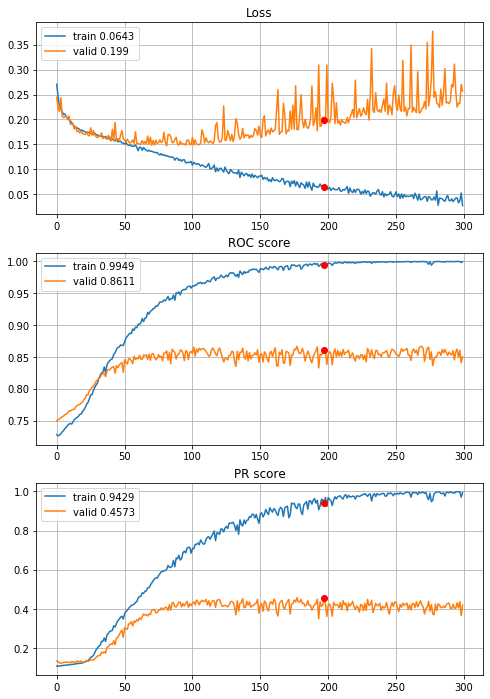


Fold 2------------------------------------------------------------


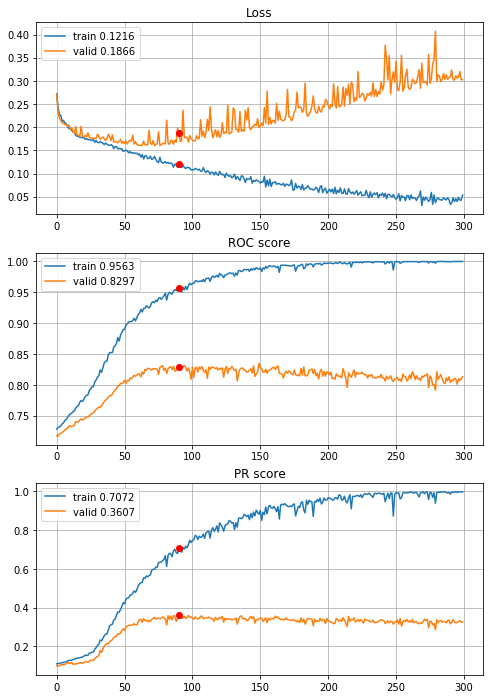


Fold 3------------------------------------------------------------


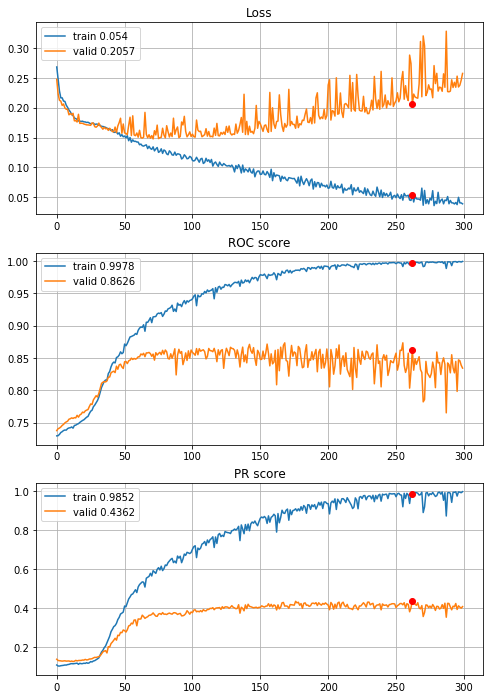


Fold 4------------------------------------------------------------


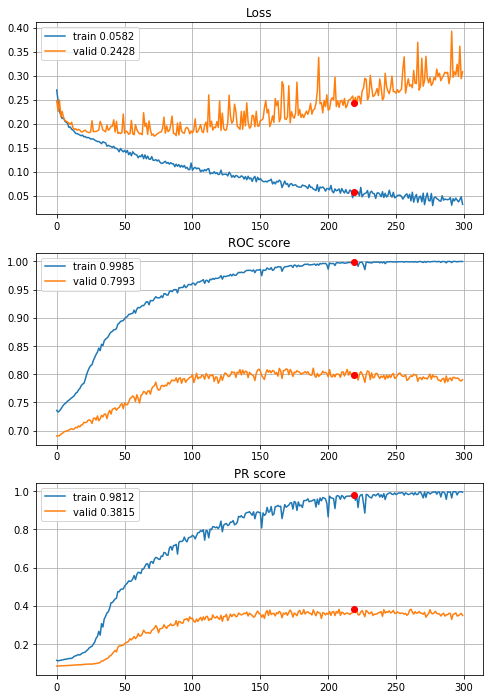


Fold 5------------------------------------------------------------


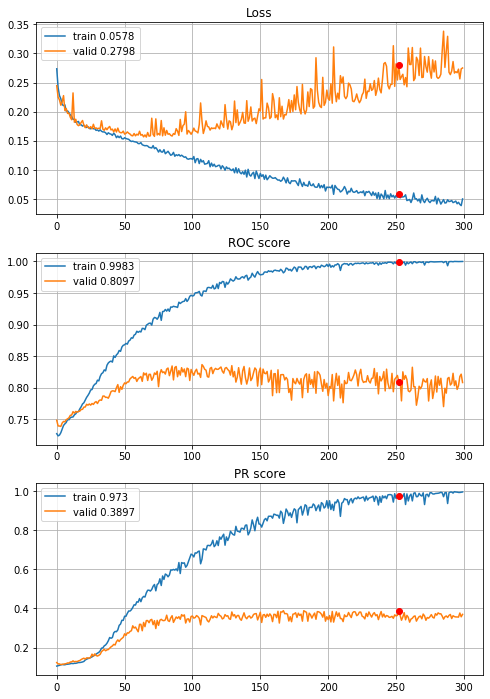


Fold 6------------------------------------------------------------


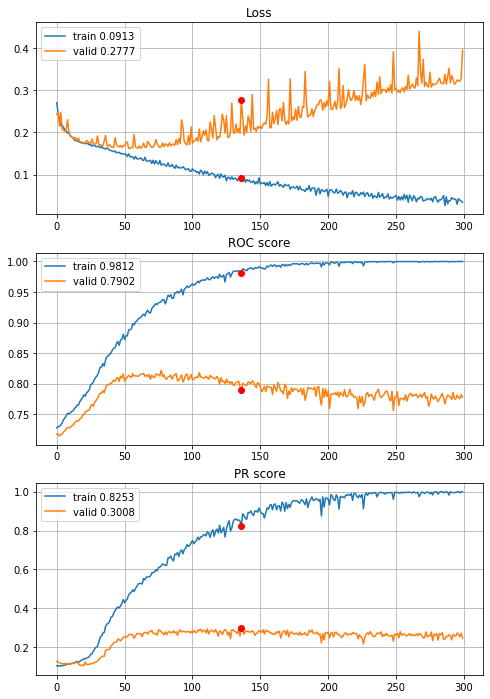

In [53]:
# basic model with bigger L2 regularization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_more, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_more_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Worse results, the last try will be about one dense layer less

In [53]:
def define_CNN_L2_1dense(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                 #(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)                 #(8,8,32)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                  #(8,8,64)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)      #(4,4,64)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                  #(4,4,32)
    dense = layers.Flatten()(early)                                                          #(512,)
    dense = layers.Dense(units=320, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)               #(320,)    
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 1.95s train loss: 0.25604422660634385, validation loss: 0.19977929815649986
Epoch: 2/300,
cumulative time: 3.2s train loss: 0.19895791661215653, validation loss: 0.18895797058939934
Epoch: 3/300,
cumulative time: 4.44s train loss: 0.19301781724663541, validation loss: 0.1856011189520359
Epoch: 4/300,
cumulative time: 5.71s train loss: 0.1927454901368198, validation loss: 0.19700339809060097
Epoch: 5/300,
cumulative time: 6.95s train loss: 0.18955243647159084, validation loss: 0.183550164103508
Epoch: 6/300,
cumulative time: 8.19s train loss: 0.18649084409892772, validation loss: 0.18273241072893143
Epoch: 7/300,
cumulative time: 9.43s train loss: 0.18780029451199265, validation loss: 0.17968494072556496
Epoch: 8/300,
cumulative time: 10.67s train loss: 0.18509360506880881, validation loss: 0.18736354261636734
Epoch: 9/300,
cumulative time: 11.91s train loss: 0.18290526986334033

Epoch: 77/300,
cumulative time: 96.98s train loss: 0.1010206062658872, validation loss: 0.16717232018709183
Epoch: 78/300,
cumulative time: 98.2s train loss: 0.10436916798012641, validation loss: 0.16340495273470879
Epoch: 79/300,
cumulative time: 99.44s train loss: 0.10096197207910025, validation loss: 0.15978742763400078
Epoch: 80/300,
cumulative time: 100.66s train loss: 0.10053692044621194, validation loss: 0.16779420524835587
Epoch: 81/300,
cumulative time: 101.89s train loss: 0.09911187455330542, validation loss: 0.16584966331720352
Epoch: 82/300,
cumulative time: 103.14s train loss: 0.09848080020078158, validation loss: 0.15732186660170555
Epoch: 83/300,
cumulative time: 104.36s train loss: 0.09904581482993763, validation loss: 0.16605083271861076
Epoch: 84/300,
cumulative time: 105.58s train loss: 0.09705156155229523, validation loss: 0.18065937981009483
Epoch: 85/300,
cumulative time: 106.82s train loss: 0.09535444576866497, validation loss: 0.18147169798612595
Epoch: 86/300,


Epoch: 152/300,
cumulative time: 189.76s train loss: 0.059427122612436024, validation loss: 0.20742395147681236
Epoch: 153/300,
cumulative time: 191.0s train loss: 0.053581424668590207, validation loss: 0.22247813269495964
Epoch: 154/300,
cumulative time: 192.21s train loss: 0.05813394084103583, validation loss: 0.218941368162632
Epoch: 155/300,
cumulative time: 193.43s train loss: 0.05626640893299456, validation loss: 0.20744730532169342
Epoch: 156/300,
cumulative time: 194.65s train loss: 0.05417158515294262, validation loss: 0.21072376891970634
Epoch: 157/300,
cumulative time: 195.88s train loss: 0.05560906571958076, validation loss: 0.20505661517381668
Epoch: 158/300,
cumulative time: 197.1s train loss: 0.0500648293503238, validation loss: 0.2011227197945118
Epoch: 159/300,
cumulative time: 198.33s train loss: 0.054570594600057955, validation loss: 0.21784881502389908
Epoch: 160/300,
cumulative time: 199.57s train loss: 0.05026052046118805, validation loss: 0.2322431579232216
Epoch

Epoch: 226/300,
cumulative time: 281.22s train loss: 0.036450482347725674, validation loss: 0.2418169379234314
Epoch: 227/300,
cumulative time: 282.45s train loss: 0.03361923176674158, validation loss: 0.25552430003881454
Epoch: 228/300,
cumulative time: 283.69s train loss: 0.0402424022377506, validation loss: 0.2597424276173115
Epoch: 229/300,
cumulative time: 284.91s train loss: 0.03048325228987762, validation loss: 0.245340995490551
Epoch: 230/300,
cumulative time: 286.15s train loss: 0.03743932566923833, validation loss: 0.2783801034092903
Epoch: 231/300,
cumulative time: 287.41s train loss: 0.036160107808913176, validation loss: 0.27381956949830055
Epoch: 232/300,
cumulative time: 288.69s train loss: 0.03224023226355314, validation loss: 0.31528764963150024
Epoch: 233/300,
cumulative time: 289.9s train loss: 0.04024911144631974, validation loss: 0.276848629117012
Epoch: 234/300,
cumulative time: 291.12s train loss: 0.02980774596055384, validation loss: 0.2876192033290863
Epoch: 23

Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.12s train loss: 0.2586604011254059, validation loss: 0.20245188102126122
Epoch: 2/300,
cumulative time: 3.35s train loss: 0.19723089439666713, validation loss: 0.19660715758800507
Epoch: 3/300,
cumulative time: 4.57s train loss: 0.19357087074529708, validation loss: 0.19614733383059502
Epoch: 4/300,
cumulative time: 5.81s train loss: 0.19176685283175274, validation loss: 0.18705539032816887
Epoch: 5/300,
cumulative time: 7.05s train loss: 0.18897882635185353, validation loss: 0.1854674108326435
Epoch: 6/300,
cumulative time: 8.29s train loss: 0.1882902024405568, validation loss: 0.18481142818927765
Epoch: 7/300,
cumulative time: 9.53s train loss: 0.18545580766584258, validation loss: 0.1840033456683159
Epoch: 8/300,
cumulative time: 10.76s train loss: 0.18429670078938173, validation loss: 0.1855124905705452
Epoch: 9/300,
cumulative time: 12.11s train loss: 0.1817602300027895, validation loss: 0.18323523551

Epoch: 77/300,
cumulative time: 96.71s train loss: 0.10109176355806203, validation loss: 0.16700823977589607
Epoch: 78/300,
cumulative time: 97.95s train loss: 0.09290984922943381, validation loss: 0.17409216612577438
Epoch: 79/300,
cumulative time: 99.17s train loss: 0.09538242092602987, validation loss: 0.17452362179756165
Epoch: 80/300,
cumulative time: 100.4s train loss: 0.09270734166742552, validation loss: 0.17465516552329063
Epoch: 81/300,
cumulative time: 101.63s train loss: 0.09650760292325787, validation loss: 0.17145682498812675
Epoch: 82/300,
cumulative time: 102.87s train loss: 0.09483939980914927, validation loss: 0.1818401925265789
Epoch: 83/300,
cumulative time: 104.09s train loss: 0.0924652490202941, validation loss: 0.17255689203739166
Epoch: 84/300,
cumulative time: 105.32s train loss: 0.09442596746927412, validation loss: 0.17418457567691803
Epoch: 85/300,
cumulative time: 106.55s train loss: 0.09036237278592774, validation loss: 0.1738799624145031
Epoch: 86/300,
cu

Epoch: 152/300,
cumulative time: 190.4s train loss: 0.05163422743413822, validation loss: 0.2564435936510563
Epoch: 153/300,
cumulative time: 191.64s train loss: 0.05139461640928862, validation loss: 0.3051711544394493
Epoch: 154/300,
cumulative time: 192.87s train loss: 0.050465988101217274, validation loss: 0.2701958194375038
Epoch: 155/300,
cumulative time: 194.11s train loss: 0.05674255006876147, validation loss: 0.2389427050948143
Epoch: 156/300,
cumulative time: 195.34s train loss: 0.05232144583446111, validation loss: 0.26958784461021423
Epoch: 157/300,
cumulative time: 196.57s train loss: 0.04887769830452421, validation loss: 0.24002256989479065
Epoch: 158/300,
cumulative time: 197.82s train loss: 0.05231994468815258, validation loss: 0.24741937220096588
Epoch: 159/300,
cumulative time: 199.05s train loss: 0.05048025123313365, validation loss: 0.3249208629131317
Epoch: 160/300,
cumulative time: 200.27s train loss: 0.04706525980268353, validation loss: 0.25523919612169266
Epoch:

Epoch: 227/300,
cumulative time: 283.88s train loss: 0.024321989444358327, validation loss: 0.32891954481601715
Epoch: 228/300,
cumulative time: 285.14s train loss: 0.031524364061752, validation loss: 0.3083390146493912
Epoch: 229/300,
cumulative time: 286.36s train loss: 0.035581002001489344, validation loss: 0.3064402788877487
Epoch: 230/300,
cumulative time: 287.61s train loss: 0.03531525899604561, validation loss: 0.30157723277807236
Epoch: 231/300,
cumulative time: 288.84s train loss: 0.02897574996775316, validation loss: 0.3044912666082382
Epoch: 232/300,
cumulative time: 290.08s train loss: 0.028754459777747605, validation loss: 0.31499457359313965
Epoch: 233/300,
cumulative time: 291.32s train loss: 0.03782599899253759, validation loss: 0.32834577560424805
Epoch: 234/300,
cumulative time: 292.54s train loss: 0.026755756027845183, validation loss: 0.38008469343185425
Epoch: 235/300,
cumulative time: 293.78s train loss: 0.036328849603586115, validation loss: 0.31066201627254486
E

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 1.96s train loss: 0.257245111748457, validation loss: 0.19451604350218696
Epoch: 2/300,
cumulative time: 3.19s train loss: 0.19721117911944766, validation loss: 0.19007780930352589
Epoch: 3/300,
cumulative time: 4.43s train loss: 0.19518966409470567, validation loss: 0.18639866927313425
Epoch: 4/300,
cumulative time: 5.66s train loss: 0.18812473941397148, validation loss: 0.18424987162862505
Epoch: 5/300,
cumulative time: 6.89s train loss: 0.18965217741829377, validation loss: 0.18180927059007068
Epoch: 6/300,
cumulative time: 8.12s train loss: 0.18558817630463692, validation loss: 0.18398576290834517
Epoch: 7/300,
cumulative time: 9.34s train loss: 0.18884626840015073, validation loss: 0.17937067808612944
Epoch: 8/300,
cumulative time: 10.57s train loss: 0.183290764131385, validation loss: 0.17977155566215516
Epoch: 9/300,
cumulative time: 11.81s train loss: 0.18344290813690547, validation loss: 0.186777453

Epoch: 77/300,
cumulative time: 96.25s train loss: 0.09620574301718092, validation loss: 0.16471751262271214
Epoch: 78/300,
cumulative time: 97.57s train loss: 0.09715448782440066, validation loss: 0.1463236759106318
Epoch: 79/300,
cumulative time: 98.79s train loss: 0.09030280899839593, validation loss: 0.1510198625732982
Epoch: 80/300,
cumulative time: 100.03s train loss: 0.09480697525622836, validation loss: 0.16087143674729362
Epoch: 81/300,
cumulative time: 101.28s train loss: 0.08835455070780485, validation loss: 0.19750175368218195
Epoch: 82/300,
cumulative time: 102.54s train loss: 0.09081055664715011, validation loss: 0.17388923045188662
Epoch: 83/300,
cumulative time: 103.81s train loss: 0.08578926875148764, validation loss: 0.14984265376651099
Epoch: 84/300,
cumulative time: 105.04s train loss: 0.09426114473799786, validation loss: 0.14978821527390254
Epoch: 85/300,
cumulative time: 106.28s train loss: 0.08948939483552713, validation loss: 0.18233038815241012
Epoch: 86/300,


Epoch: 152/300,
cumulative time: 189.91s train loss: 0.04852480192853061, validation loss: 0.19077063649419754
Epoch: 153/300,
cumulative time: 191.14s train loss: 0.0423058539078489, validation loss: 0.21568973516661025
Epoch: 154/300,
cumulative time: 192.38s train loss: 0.05161634235685059, validation loss: 0.20565469187403482
Epoch: 155/300,
cumulative time: 193.61s train loss: 0.05111391643686269, validation loss: 0.18936213255874695
Epoch: 156/300,
cumulative time: 194.84s train loss: 0.05170775248595902, validation loss: 0.18892082464127313
Epoch: 157/300,
cumulative time: 196.06s train loss: 0.053212217498044306, validation loss: 0.204390015460196
Epoch: 158/300,
cumulative time: 197.31s train loss: 0.03878058434399127, validation loss: 0.2401921969652176
Epoch: 159/300,
cumulative time: 198.54s train loss: 0.0493310953373267, validation loss: 0.18725939462109217
Epoch: 160/300,
cumulative time: 199.78s train loss: 0.04404905220495803, validation loss: 0.19429673362345923
Epoch

Epoch: 226/300,
cumulative time: 282.17s train loss: 0.034392055483946145, validation loss: 0.2197955219045518
Epoch: 227/300,
cumulative time: 283.41s train loss: 0.028996224971638274, validation loss: 0.286735600403377
Epoch: 228/300,
cumulative time: 284.63s train loss: 0.03200426204698755, validation loss: 0.23543587554068793
Epoch: 229/300,
cumulative time: 285.88s train loss: 0.026541975164501984, validation loss: 0.2262408951918284
Epoch: 230/300,
cumulative time: 287.13s train loss: 0.032374737478515526, validation loss: 0.22083617961595928
Epoch: 231/300,
cumulative time: 288.37s train loss: 0.028969449786001373, validation loss: 0.22647560669316186
Epoch: 232/300,
cumulative time: 289.63s train loss: 0.02731261931154515, validation loss: 0.23283198989572979
Epoch: 233/300,
cumulative time: 290.87s train loss: 0.03663256222005497, validation loss: 0.2264667290165311
Epoch: 234/300,
cumulative time: 292.1s train loss: 0.024797240299830905, validation loss: 0.2844037855996026
Ep

Epoch: 300/300,
cumulative time: 374.43s train loss: 0.015271079263279693, validation loss: 0.26407253817906456

Early stopping results:
best results in epoch: 134, 
best valid PR: 0.4647352985291777, 
valid ROC: 0.8747051515206079        
overfitting PR: 0.5108062636280171, 
overfitting ROC: 0.12323593855432236

----------
Fold: 4
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 1.96s train loss: 0.25513463555230426, validation loss: 0.19926313258352735
Epoch: 2/300,
cumulative time: 3.19s train loss: 0.19771123191411988, validation loss: 0.19669867475827535
Epoch: 3/300,
cumulative time: 4.42s train loss: 0.19200324719367148, validation loss: 0.20566938170364926
Epoch: 4/300,
cumulative time: 5.66s train loss: 0.18927117067953045, validation loss: 0.19287982208388194
Epoch: 5/300,
cumulative time: 6.9s train loss: 0.18607172480055686, validation loss: 0.20517426491729798
Epoch: 6/300,
cumulative time: 8.12s train loss: 0.18877741838032724, val

Epoch: 74/300,
cumulative time: 92.56s train loss: 0.09744028537005084, validation loss: 0.18451699910655855
Epoch: 75/300,
cumulative time: 93.85s train loss: 0.10177137615589286, validation loss: 0.18202134930898273
Epoch: 76/300,
cumulative time: 95.15s train loss: 0.10079612071776399, validation loss: 0.17991804538265108
Epoch: 77/300,
cumulative time: 96.41s train loss: 0.09893723454960594, validation loss: 0.1841684981565627
Epoch: 78/300,
cumulative time: 97.71s train loss: 0.09675185760617695, validation loss: 0.18332198178011275
Epoch: 79/300,
cumulative time: 98.96s train loss: 0.09490537651094126, validation loss: 0.19082407777271573
Epoch: 80/300,
cumulative time: 100.22s train loss: 0.09792607001533693, validation loss: 0.2209445638126797
Epoch: 81/300,
cumulative time: 101.45s train loss: 0.09947157059168928, validation loss: 0.18131532175200327
Epoch: 82/300,
cumulative time: 102.67s train loss: 0.09424046112322121, validation loss: 0.1976128071641165
Epoch: 83/300,
cumu

Epoch: 149/300,
cumulative time: 185.41s train loss: 0.05739312312415942, validation loss: 0.23315498883762056
Epoch: 150/300,
cumulative time: 186.65s train loss: 0.054013616894558025, validation loss: 0.23693926975840615
Epoch: 151/300,
cumulative time: 187.89s train loss: 0.05657893122453231, validation loss: 0.25179680988902137
Epoch: 152/300,
cumulative time: 189.1s train loss: 0.05630132116134266, validation loss: 0.26276662137773305
Epoch: 153/300,
cumulative time: 190.34s train loss: 0.0493924666356432, validation loss: 0.2614654229368482
Epoch: 154/300,
cumulative time: 191.57s train loss: 0.05741951885608696, validation loss: 0.23662331951989068
Epoch: 155/300,
cumulative time: 192.81s train loss: 0.05264283416839334, validation loss: 0.2496315488739619
Epoch: 156/300,
cumulative time: 194.04s train loss: 0.0530970025492173, validation loss: 0.25881725212884327
Epoch: 157/300,
cumulative time: 195.28s train loss: 0.05078681447704356, validation loss: 0.23559985579006257
Epoch

Epoch: 224/300,
cumulative time: 278.8s train loss: 0.03662555056018879, validation loss: 0.2974286476203373
Epoch: 225/300,
cumulative time: 280.04s train loss: 0.033063131771055715, validation loss: 0.3110832747202071
Epoch: 226/300,
cumulative time: 281.28s train loss: 0.03513335639517955, validation loss: 0.3054894099159846
Epoch: 227/300,
cumulative time: 282.58s train loss: 0.03840976498261524, validation loss: 0.29737371280079794
Epoch: 228/300,
cumulative time: 283.83s train loss: 0.026785548975492804, validation loss: 0.30971590570041113
Epoch: 229/300,
cumulative time: 285.06s train loss: 0.034241912084170156, validation loss: 0.31358160597937446
Epoch: 230/300,
cumulative time: 286.3s train loss: 0.032972058570264286, validation loss: 0.37596463983021083
Epoch: 231/300,
cumulative time: 287.54s train loss: 0.03327804010787545, validation loss: 0.37458588269021775
Epoch: 232/300,
cumulative time: 288.77s train loss: 0.04103597841368981, validation loss: 0.3058845588139125
Epo

Epoch: 298/300,
cumulative time: 370.97s train loss: 0.02675418004202513, validation loss: 0.41762867783743235
Epoch: 299/300,
cumulative time: 372.21s train loss: 0.031193257018997538, validation loss: 0.325583416223526
Epoch: 300/300,
cumulative time: 373.44s train loss: 0.018879575168216638, validation loss: 0.4215284959853642

Early stopping results:
best results in epoch: 125, 
best valid PR: 0.33962128243013173, 
valid ROC: 0.8082809658425915        
overfitting PR: 0.5980198380701354, 
overfitting ROC: 0.18630755022685308

----------
Fold: 5
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.15s train loss: 0.25663650201573746, validation loss: 0.1933012306500995
Epoch: 2/300,
cumulative time: 3.41s train loss: 0.1955511447581843, validation loss: 0.18645369087892866
Epoch: 3/300,
cumulative time: 4.65s train loss: 0.19383050981278618, validation loss: 0.1870555741824801
Epoch: 4/300,
cumulative time: 5.89s train loss: 0.19290572192609287

Epoch: 72/300,
cumulative time: 91.2s train loss: 0.11084912511900444, validation loss: 0.16450760078808618
Epoch: 73/300,
cumulative time: 92.46s train loss: 0.10751563724250043, validation loss: 0.1609888190598715
Epoch: 74/300,
cumulative time: 93.7s train loss: 0.10837119392472747, validation loss: 0.1913292109777057
Epoch: 75/300,
cumulative time: 94.95s train loss: 0.10443627998900622, validation loss: 0.17065998509762778
Epoch: 76/300,
cumulative time: 96.19s train loss: 0.10208414514476127, validation loss: 0.21057793966361454
Epoch: 77/300,
cumulative time: 97.42s train loss: 0.10325216164561082, validation loss: 0.1734782287998805
Epoch: 78/300,
cumulative time: 98.67s train loss: 0.10217323878270895, validation loss: 0.17207404027855586
Epoch: 79/300,
cumulative time: 99.89s train loss: 0.10425313230628999, validation loss: 0.16369744079453605
Epoch: 80/300,
cumulative time: 101.13s train loss: 0.10008761679837133, validation loss: 0.198790903148197
Epoch: 81/300,
cumulative

Epoch: 147/300,
cumulative time: 184.25s train loss: 0.054081496559258445, validation loss: 0.22286856265295119
Epoch: 148/300,
cumulative time: 185.55s train loss: 0.061487151857267344, validation loss: 0.211361479361852
Epoch: 149/300,
cumulative time: 186.98s train loss: 0.06001214797836626, validation loss: 0.22545765352627586
Epoch: 150/300,
cumulative time: 188.27s train loss: 0.057350620182373656, validation loss: 0.2265942549137842
Epoch: 151/300,
cumulative time: 189.56s train loss: 0.056452603861963865, validation loss: 0.24575762697628567
Epoch: 152/300,
cumulative time: 190.84s train loss: 0.05816500001833253, validation loss: 0.2586918025546604
Epoch: 153/300,
cumulative time: 192.14s train loss: 0.06308754816153819, validation loss: 0.22216744799462576
Epoch: 154/300,
cumulative time: 193.44s train loss: 0.04744797682923321, validation loss: 0.21889495891238014
Epoch: 155/300,
cumulative time: 194.71s train loss: 0.0554517694853338, validation loss: 0.22137441604856462
Ep

Epoch: 222/300,
cumulative time: 278.25s train loss: 0.032037900589331765, validation loss: 0.3296939823551783
Epoch: 223/300,
cumulative time: 279.49s train loss: 0.042676833860592234, validation loss: 0.28384524313230364
Epoch: 224/300,
cumulative time: 280.75s train loss: 0.03937867251401574, validation loss: 0.2679749880896674
Epoch: 225/300,
cumulative time: 281.98s train loss: 0.03376286235489344, validation loss: 0.2669034103930943
Epoch: 226/300,
cumulative time: 283.23s train loss: 0.032786514746256705, validation loss: 0.28191461771253556
Epoch: 227/300,
cumulative time: 284.45s train loss: 0.031232581635275227, validation loss: 0.3166117965796637
Epoch: 228/300,
cumulative time: 285.71s train loss: 0.03929136554813784, validation loss: 0.29835093944791763
Epoch: 229/300,
cumulative time: 286.94s train loss: 0.03722576780172113, validation loss: 0.2802712350799924
Epoch: 230/300,
cumulative time: 288.18s train loss: 0.03310705152724137, validation loss: 0.3110389161866809
Epo

Epoch: 296/300,
cumulative time: 370.99s train loss: 0.02672706319236038, validation loss: 0.3221402558637044
Epoch: 297/300,
cumulative time: 372.27s train loss: 0.024435966939275088, validation loss: 0.3324409934452602
Epoch: 298/300,
cumulative time: 373.5s train loss: 0.024453531263304632, validation loss: 0.33182260679820225
Epoch: 299/300,
cumulative time: 374.74s train loss: 0.02446176100324121, validation loss: 0.35055594923004274
Epoch: 300/300,
cumulative time: 375.98s train loss: 0.030826986521544895, validation loss: 0.3040081825142815

Early stopping results:
best results in epoch: 197, 
best valid PR: 0.42675192310212795, 
valid ROC: 0.8214523650899401        
overfitting PR: 0.5663664605595182, 
overfitting ROC: 0.1781860194405307

----------
Fold: 6
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.01s train loss: 0.2572777557035562, validation loss: 0.19456133705282969
Epoch: 2/300,
cumulative time: 3.27s train loss: 0.19858485

Epoch: 70/300,
cumulative time: 88.18s train loss: 0.10348297313746725, validation loss: 0.1709545039752173
Epoch: 71/300,
cumulative time: 89.43s train loss: 0.09648533363613634, validation loss: 0.18335538251059397
Epoch: 72/300,
cumulative time: 90.68s train loss: 0.09977929656470323, validation loss: 0.16925410428690532
Epoch: 73/300,
cumulative time: 91.91s train loss: 0.09833474185138513, validation loss: 0.16439858757314227
Epoch: 74/300,
cumulative time: 93.16s train loss: 0.10213160907933141, validation loss: 0.1781668516851607
Epoch: 75/300,
cumulative time: 94.39s train loss: 0.09625908427751048, validation loss: 0.1787120576037301
Epoch: 76/300,
cumulative time: 95.63s train loss: 0.09739597510913915, validation loss: 0.16484817769792345
Epoch: 77/300,
cumulative time: 96.88s train loss: 0.0959538045343188, validation loss: 0.1657101870434625
Epoch: 78/300,
cumulative time: 98.12s train loss: 0.09501388447019402, validation loss: 0.1678198384103321
Epoch: 79/300,
cumulative

Epoch: 145/300,
cumulative time: 182.12s train loss: 0.053753544370149224, validation loss: 0.23796203248084538
Epoch: 146/300,
cumulative time: 183.36s train loss: 0.05732000870016515, validation loss: 0.224229570192004
Epoch: 147/300,
cumulative time: 184.59s train loss: 0.05060239449962529, validation loss: 0.29825244765433057
Epoch: 148/300,
cumulative time: 185.84s train loss: 0.05436388926713679, validation loss: 0.23403478283730764
Epoch: 149/300,
cumulative time: 187.06s train loss: 0.055483543298314696, validation loss: 0.29641845674741835
Epoch: 150/300,
cumulative time: 188.3s train loss: 0.06286593956308376, validation loss: 0.2384612975044856
Epoch: 151/300,
cumulative time: 189.57s train loss: 0.05098235439398014, validation loss: 0.23346099997323658
Epoch: 152/300,
cumulative time: 190.84s train loss: 0.053700411447991994, validation loss: 0.21929427054193285
Epoch: 153/300,
cumulative time: 192.09s train loss: 0.05367325400179059, validation loss: 0.23580986804432338
Ep

Epoch: 220/300,
cumulative time: 275.42s train loss: 0.029250213140719915, validation loss: 0.36062244755881173
Epoch: 221/300,
cumulative time: 276.66s train loss: 0.03393310809481245, validation loss: 0.29593595273911005
Epoch: 222/300,
cumulative time: 277.92s train loss: 0.0358897624581095, validation loss: 0.3020622469886901
Epoch: 223/300,
cumulative time: 279.18s train loss: 0.03647807428145811, validation loss: 0.2934429459723215
Epoch: 224/300,
cumulative time: 280.42s train loss: 0.02667309048894064, validation loss: 0.4199189620358603
Epoch: 225/300,
cumulative time: 281.76s train loss: 0.04055037610426732, validation loss: 0.2946307842693632
Epoch: 226/300,
cumulative time: 283.21s train loss: 0.037908948112316536, validation loss: 0.3207916017373403
Epoch: 227/300,
cumulative time: 284.5s train loss: 0.03598697580538063, validation loss: 0.3353843809498681
Epoch: 228/300,
cumulative time: 285.78s train loss: 0.032213810347971224, validation loss: 0.3596716620808556
Epoch: 

Epoch: 295/300,
cumulative time: 369.93s train loss: 0.01960193300689479, validation loss: 0.35178213779888456
Epoch: 296/300,
cumulative time: 371.17s train loss: 0.025836312958692344, validation loss: 0.35746935278650316
Epoch: 297/300,
cumulative time: 372.44s train loss: 0.02384843899111382, validation loss: 0.33264270447549366
Epoch: 298/300,
cumulative time: 373.69s train loss: 0.021498975887993002, validation loss: 0.48544932153489856
Epoch: 299/300,
cumulative time: 374.93s train loss: 0.025480132816262213, validation loss: 0.3328372079417819
Epoch: 300/300,
cumulative time: 376.19s train loss: 0.022359294497858558, validation loss: 0.4576337809411306

Early stopping results:
best results in epoch: 50, 
best valid PR: 0.32822869045814174, 
valid ROC: 0.8266380971244395        
overfitting PR: 0.31670740763388283, 
overfitting ROC: 0.1130441193665187

Cross validation time: 2293s
ROC: 		0.8367221912305128
PR: 		0.3927515097851077
overfittingROC: 0.1494915447304459
overfittingPR:

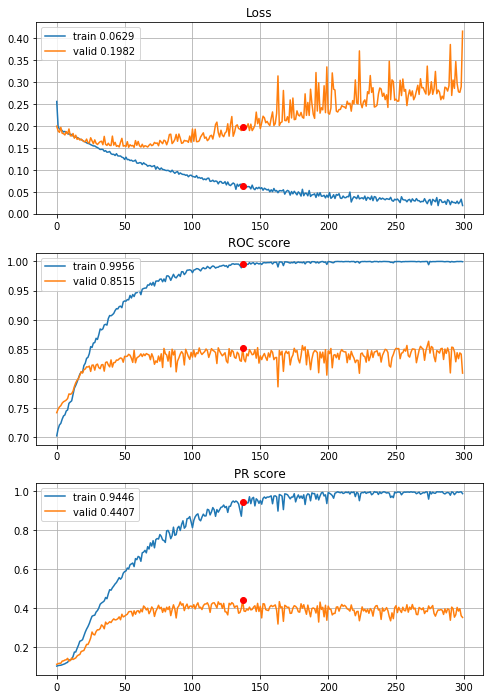


Fold 2------------------------------------------------------------


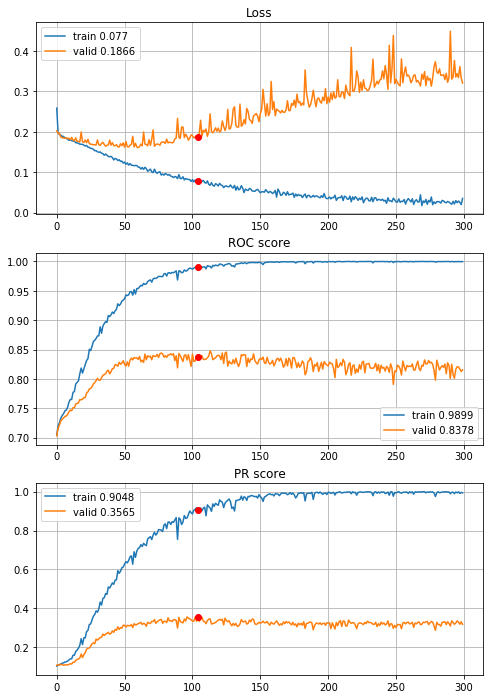


Fold 3------------------------------------------------------------


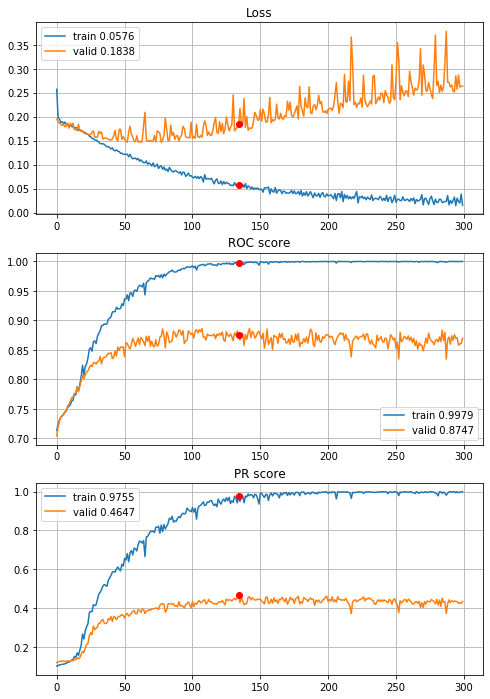


Fold 4------------------------------------------------------------


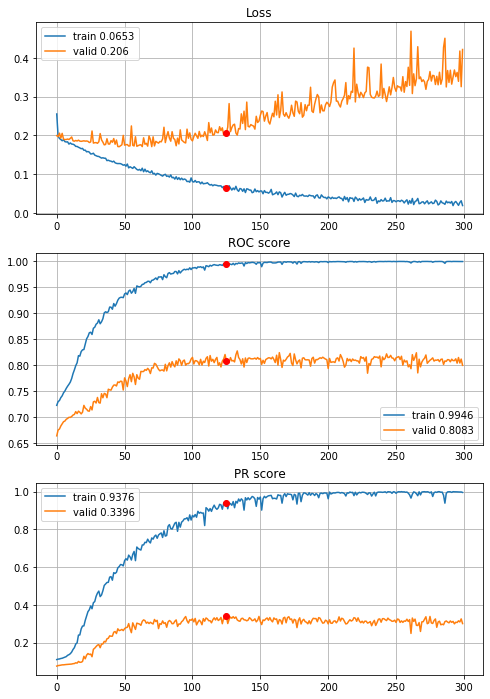


Fold 5------------------------------------------------------------


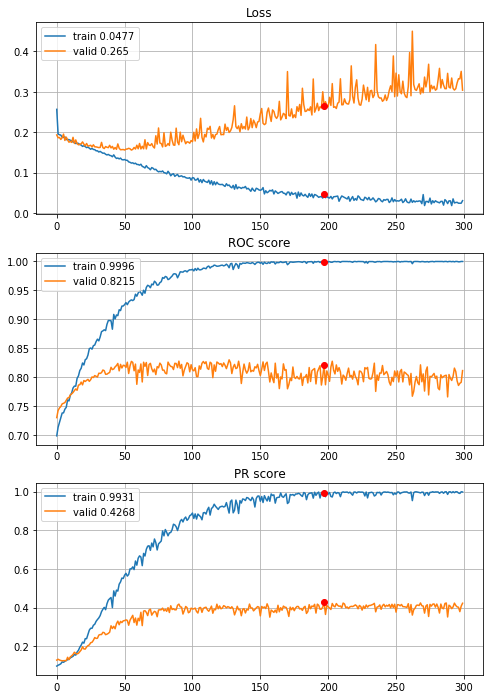


Fold 6------------------------------------------------------------


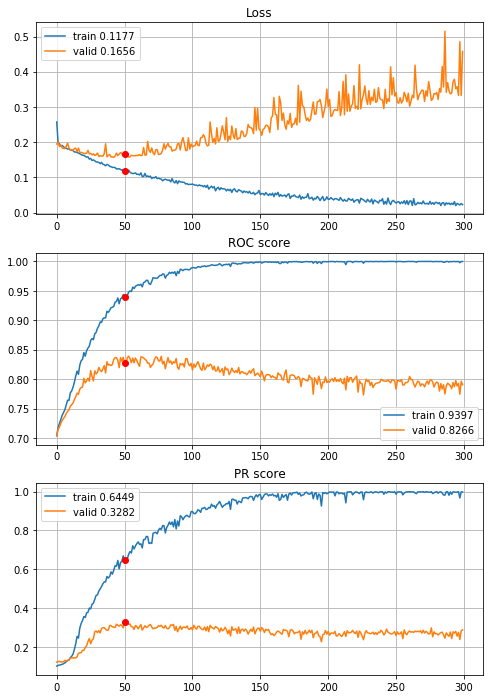

In [58]:
# basic model with L2 and 1 dense only
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_1dense, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_1dense_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Similar result to 2 layers model, lets apply some dropout

In [54]:
def define_CNN_L2_1dense_drop02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                 #(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)                 #(8,8,32)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                  #(8,8,64)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)      #(4,4,64)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)                  #(4,4,32)
    dense = layers.Flatten()(early)                                                          #(512,)
    dense = layers.Dense(units=320, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)               #(320,)  
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.13s train loss: 0.20746624508731676, validation loss: 0.19646860286593437
Epoch: 2/300,
cumulative time: 3.39s train loss: 0.19379077374238904, validation loss: 0.18328924104571342
Epoch: 3/300,
cumulative time: 4.7s train loss: 0.18955380891848483, validation loss: 0.18228083848953247
Epoch: 4/300,
cumulative time: 5.96s train loss: 0.1867369985999705, validation loss: 0.18630478158593178
Epoch: 5/300,
cumulative time: 7.22s train loss: 0.18418760869771228, validation loss: 0.1781032420694828
Epoch: 6/300,
cumulative time: 8.52s train loss: 0.18161593152067274, validation loss: 0.1764933504164219
Epoch: 7/300,
cumulative time: 9.79s train loss: 0.18343559207953797, validation loss: 0.1746005192399025
Epoch: 8/300,
cumulative time: 11.05s train loss: 0.1816922949542849, validation loss: 0.1764896661043167
Epoch: 9/300,
cumulative time: 12.31s train loss: 0.18021473446326428, 

Epoch: 77/300,
cumulative time: 99.25s train loss: 0.10134669645216908, validation loss: 0.17695435136556625
Epoch: 78/300,
cumulative time: 100.53s train loss: 0.10933437928511988, validation loss: 0.16015497222542763
Epoch: 79/300,
cumulative time: 101.84s train loss: 0.10225612185271092, validation loss: 0.17925122380256653
Epoch: 80/300,
cumulative time: 103.18s train loss: 0.10131903492678629, validation loss: 0.17441216483712196
Epoch: 81/300,
cumulative time: 104.55s train loss: 0.10112227857445871, validation loss: 0.17089789360761642
Epoch: 82/300,
cumulative time: 105.89s train loss: 0.10105139538153832, validation loss: 0.1659969761967659
Epoch: 83/300,
cumulative time: 107.19s train loss: 0.09875015484962807, validation loss: 0.16854113340377808
Epoch: 84/300,
cumulative time: 108.45s train loss: 0.09966647043756086, validation loss: 0.16942107304930687
Epoch: 85/300,
cumulative time: 109.83s train loss: 0.0970160340395538, validation loss: 0.2035682499408722
Epoch: 86/300,

Epoch: 152/300,
cumulative time: 199.07s train loss: 0.06350811985318978, validation loss: 0.22008202224969864
Epoch: 153/300,
cumulative time: 200.42s train loss: 0.05546625805077455, validation loss: 0.27173934131860733
Epoch: 154/300,
cumulative time: 201.77s train loss: 0.0613760901137301, validation loss: 0.26171037554740906
Epoch: 155/300,
cumulative time: 203.21s train loss: 0.0588252481400452, validation loss: 0.2228558361530304
Epoch: 156/300,
cumulative time: 204.55s train loss: 0.06062859235025863, validation loss: 0.22658804059028625
Epoch: 157/300,
cumulative time: 205.81s train loss: 0.058801057577746174, validation loss: 0.2248242422938347
Epoch: 158/300,
cumulative time: 207.12s train loss: 0.05329269165936583, validation loss: 0.24105029553174973
Epoch: 159/300,
cumulative time: 208.49s train loss: 0.054376359169081484, validation loss: 0.21886050701141357
Epoch: 160/300,
cumulative time: 209.83s train loss: 0.0668813126713204, validation loss: 0.20720036327838898
Epoc

Epoch: 227/300,
cumulative time: 297.28s train loss: 0.03868052254891172, validation loss: 0.29571542888879776
Epoch: 228/300,
cumulative time: 298.53s train loss: 0.04125756939372673, validation loss: 0.28470710664987564
Epoch: 229/300,
cumulative time: 299.79s train loss: 0.03126626238633664, validation loss: 0.2962896004319191
Epoch: 230/300,
cumulative time: 301.03s train loss: 0.03967588802268885, validation loss: 0.2858497425913811
Epoch: 231/300,
cumulative time: 302.27s train loss: 0.03937146400842662, validation loss: 0.2991844043135643
Epoch: 232/300,
cumulative time: 303.5s train loss: 0.03387124085852781, validation loss: 0.31513094902038574
Epoch: 233/300,
cumulative time: 304.74s train loss: 0.04106535071269654, validation loss: 0.3282225504517555
Epoch: 234/300,
cumulative time: 305.99s train loss: 0.03730698303665272, validation loss: 0.28834880143404007
Epoch: 235/300,
cumulative time: 307.23s train loss: 0.04413192026334147, validation loss: 0.2868417501449585
Epoch: 

Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 2.38s train loss: 0.20687831202290155, validation loss: 0.1993607059121132
Epoch: 2/300,
cumulative time: 3.62s train loss: 0.19369231457900069, validation loss: 0.19195516407489777
Epoch: 3/300,
cumulative time: 4.87s train loss: 0.1909142776097726, validation loss: 0.19535502791404724
Epoch: 4/300,
cumulative time: 6.13s train loss: 0.18629548250455855, validation loss: 0.18347371742129326
Epoch: 5/300,
cumulative time: 7.37s train loss: 0.18521572525365634, validation loss: 0.18227395042777061
Epoch: 6/300,
cumulative time: 8.63s train loss: 0.1840983176175382, validation loss: 0.18251602724194527
Epoch: 7/300,
cumulative time: 9.88s train loss: 0.17975638362774393, validation loss: 0.1803896129131317
Epoch: 8/300,
cumulative time: 11.14s train loss: 0.18042256986204896, validation loss: 0.18387635797262192
Epoch: 9/300,
cumulative time: 12.38s train loss: 0.17811970591711598, validation loss: 0.179535377

Epoch: 77/300,
cumulative time: 106.78s train loss: 0.10348274682233666, validation loss: 0.17175110802054405
Epoch: 78/300,
cumulative time: 108.09s train loss: 0.09882020221057278, validation loss: 0.16984931752085686
Epoch: 79/300,
cumulative time: 109.4s train loss: 0.09412682581354272, validation loss: 0.17302250862121582
Epoch: 80/300,
cumulative time: 110.71s train loss: 0.09628660354428391, validation loss: 0.17548801749944687
Epoch: 81/300,
cumulative time: 112.02s train loss: 0.09856940298863871, validation loss: 0.17138653621077538
Epoch: 82/300,
cumulative time: 113.34s train loss: 0.09445106077498443, validation loss: 0.2067323848605156
Epoch: 83/300,
cumulative time: 114.65s train loss: 0.09560081658155528, validation loss: 0.1788431778550148
Epoch: 84/300,
cumulative time: 115.97s train loss: 0.09791517970395791, validation loss: 0.17742686718702316
Epoch: 85/300,
cumulative time: 117.31s train loss: 0.0963672173685792, validation loss: 0.17415184155106544
Epoch: 86/300,

Epoch: 152/300,
cumulative time: 206.61s train loss: 0.06065546583721046, validation loss: 0.24629351869225502
Epoch: 153/300,
cumulative time: 208.02s train loss: 0.05814100014222734, validation loss: 0.25492649525403976
Epoch: 154/300,
cumulative time: 209.47s train loss: 0.052306509846816694, validation loss: 0.25014300644397736
Epoch: 155/300,
cumulative time: 210.9s train loss: 0.06086052984468461, validation loss: 0.2333046831190586
Epoch: 156/300,
cumulative time: 212.33s train loss: 0.05105284081299923, validation loss: 0.28758927434682846
Epoch: 157/300,
cumulative time: 213.77s train loss: 0.04881391653184693, validation loss: 0.25006454065442085
Epoch: 158/300,
cumulative time: 215.18s train loss: 0.06185268273755885, validation loss: 0.24653494358062744
Epoch: 159/300,
cumulative time: 216.6s train loss: 0.052731349058695226, validation loss: 0.2508053220808506
Epoch: 160/300,
cumulative time: 218.02s train loss: 0.05881196401735182, validation loss: 0.32393328845500946
Epo

Epoch: 227/300,
cumulative time: 307.2s train loss: 0.030689364106197114, validation loss: 0.3629762679338455
Epoch: 228/300,
cumulative time: 308.54s train loss: 0.03711143500938323, validation loss: 0.313338540494442
Epoch: 229/300,
cumulative time: 309.83s train loss: 0.03921572347500334, validation loss: 0.3243463709950447
Epoch: 230/300,
cumulative time: 311.12s train loss: 0.04046754883871868, validation loss: 0.3148505538702011
Epoch: 231/300,
cumulative time: 312.39s train loss: 0.03256332234528205, validation loss: 0.31573882699012756
Epoch: 232/300,
cumulative time: 313.66s train loss: 0.034339951084517116, validation loss: 0.32637304067611694
Epoch: 233/300,
cumulative time: 314.9s train loss: 0.03715431302267473, validation loss: 0.3099047690629959
Epoch: 234/300,
cumulative time: 316.35s train loss: 0.030891089975444146, validation loss: 0.35495704412460327
Epoch: 235/300,
cumulative time: 317.61s train loss: 0.038048499771817165, validation loss: 0.3305686414241791
Epoch:

Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.44s train loss: 0.2068828178591666, validation loss: 0.19042026660745107
Epoch: 2/300,
cumulative time: 3.81s train loss: 0.19306634555874522, validation loss: 0.18440418468581304
Epoch: 3/300,
cumulative time: 5.08s train loss: 0.1905675218525129, validation loss: 0.18103067212634616
Epoch: 4/300,
cumulative time: 6.53s train loss: 0.18618960395385367, validation loss: 0.17972505885457235
Epoch: 5/300,
cumulative time: 7.82s train loss: 0.18512482009284217, validation loss: 0.17778897420754508
Epoch: 6/300,
cumulative time: 9.12s train loss: 0.18215008138460118, validation loss: 0.1795790563027064
Epoch: 7/300,
cumulative time: 10.41s train loss: 0.18476522350781943, validation loss: 0.17476550005731128
Epoch: 8/300,
cumulative time: 11.79s train loss: 0.18118050873990862, validation loss: 0.17494258836148277
Epoch: 9/300,
cumulative time: 13.15s train loss: 0.1801152712684061, validation loss: 0.17827571

Epoch: 77/300,
cumulative time: 104.31s train loss: 0.09613358204144125, validation loss: 0.16219176014264425
Epoch: 78/300,
cumulative time: 105.64s train loss: 0.09516082603616341, validation loss: 0.15342167500465637
Epoch: 79/300,
cumulative time: 107.04s train loss: 0.0908555258753579, validation loss: 0.15337687418574378
Epoch: 80/300,
cumulative time: 108.32s train loss: 0.09778761208507636, validation loss: 0.16422392025826468
Epoch: 81/300,
cumulative time: 109.65s train loss: 0.08955436415844525, validation loss: 0.16681876181610047
Epoch: 82/300,
cumulative time: 110.93s train loss: 0.0930321826779844, validation loss: 0.18229203789953202
Epoch: 83/300,
cumulative time: 112.19s train loss: 0.08741158746221699, validation loss: 0.15582748580546607
Epoch: 84/300,
cumulative time: 113.46s train loss: 0.09562828988253018, validation loss: 0.1648988738135686
Epoch: 85/300,
cumulative time: 114.94s train loss: 0.08951902574726783, validation loss: 0.17157400366805847
Epoch: 86/300

Epoch: 152/300,
cumulative time: 202.35s train loss: 0.053938714057865426, validation loss: 0.1880704464798882
Epoch: 153/300,
cumulative time: 203.65s train loss: 0.05280398738154212, validation loss: 0.19523421455943396
Epoch: 154/300,
cumulative time: 204.98s train loss: 0.05069352152085901, validation loss: 0.18429814837281666
Epoch: 155/300,
cumulative time: 206.32s train loss: 0.057676773757154874, validation loss: 0.19537078468572525
Epoch: 156/300,
cumulative time: 207.62s train loss: 0.04893986635752873, validation loss: 0.18984403950827464
Epoch: 157/300,
cumulative time: 208.92s train loss: 0.057751349290891756, validation loss: 0.22799343516902318
Epoch: 158/300,
cumulative time: 210.22s train loss: 0.04741341734896899, validation loss: 0.23885134681822762
Epoch: 159/300,
cumulative time: 211.53s train loss: 0.05869796984791529, validation loss: 0.1892399620063721
Epoch: 160/300,
cumulative time: 212.84s train loss: 0.051271830455000306, validation loss: 0.18782915616792345

Epoch: 226/300,
cumulative time: 297.92s train loss: 0.0408091649798076, validation loss: 0.22170619213391865
Epoch: 227/300,
cumulative time: 299.18s train loss: 0.0262261669195113, validation loss: 0.25676552055374025
Epoch: 228/300,
cumulative time: 300.45s train loss: 0.04272417296033924, validation loss: 0.24828967577881284
Epoch: 229/300,
cumulative time: 301.77s train loss: 0.03087710856424683, validation loss: 0.25985987241306
Epoch: 230/300,
cumulative time: 303.05s train loss: 0.040730595625572824, validation loss: 0.22070016236532303
Epoch: 231/300,
cumulative time: 304.38s train loss: 0.028334059679337574, validation loss: 0.2418176794052124
Epoch: 232/300,
cumulative time: 305.74s train loss: 0.03879066461207026, validation loss: 0.23647943755937
Epoch: 233/300,
cumulative time: 307.05s train loss: 0.03233602247688618, validation loss: 0.2275291863698808
Epoch: 234/300,
cumulative time: 308.47s train loss: 0.037845520983912764, validation loss: 0.2560142827223218
Epoch: 23

Epoch: 300/300,
cumulative time: 399.17s train loss: 0.02652006314506276, validation loss: 0.27967903922474574

Early stopping results:
best results in epoch: 134, 
best valid PR: 0.437230408127708, 
valid ROC: 0.880278012856294        
overfitting PR: 0.5307604640483714, 
overfitting ROC: 0.11728386576300276

----------
Fold: 4
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.47s train loss: 0.20527053019321553, validation loss: 0.19630680493892186
Epoch: 2/300,
cumulative time: 3.77s train loss: 0.19495092288096635, validation loss: 0.1924018982005498
Epoch: 3/300,
cumulative time: 5.04s train loss: 0.18884042944152357, validation loss: 0.19120746019340698
Epoch: 4/300,
cumulative time: 6.44s train loss: 0.18726463063698184, validation loss: 0.18825187326423706
Epoch: 5/300,
cumulative time: 7.99s train loss: 0.18561086101748095, validation loss: 0.19416963518611968
Epoch: 6/300,
cumulative time: 9.41s train loss: 0.1824653213632066, validat

Epoch: 74/300,
cumulative time: 102.15s train loss: 0.10096850700773866, validation loss: 0.17934621285824548
Epoch: 75/300,
cumulative time: 103.47s train loss: 0.10329109903813256, validation loss: 0.18971215245269593
Epoch: 76/300,
cumulative time: 104.82s train loss: 0.09820796575426102, validation loss: 0.18796780659092796
Epoch: 77/300,
cumulative time: 106.21s train loss: 0.10106250666336343, validation loss: 0.1835097929220351
Epoch: 78/300,
cumulative time: 107.57s train loss: 0.09740729084512947, validation loss: 0.20220670247834827
Epoch: 79/300,
cumulative time: 108.95s train loss: 0.09646050342848962, validation loss: 0.19830381000798847
Epoch: 80/300,
cumulative time: 110.37s train loss: 0.09760230547343321, validation loss: 0.23303004476759168
Epoch: 81/300,
cumulative time: 111.74s train loss: 0.09935815438913848, validation loss: 0.19051535644228496
Epoch: 82/300,
cumulative time: 113.08s train loss: 0.09653401191791969, validation loss: 0.18622197192812723
Epoch: 83/3

Epoch: 149/300,
cumulative time: 203.44s train loss: 0.061962969526430975, validation loss: 0.22640077929648142
Epoch: 150/300,
cumulative time: 204.84s train loss: 0.06691585732956169, validation loss: 0.22479046015512374
Epoch: 151/300,
cumulative time: 206.19s train loss: 0.06872745885994813, validation loss: 0.24691532036614797
Epoch: 152/300,
cumulative time: 207.87s train loss: 0.054603402147071226, validation loss: 0.26403436354228427
Epoch: 153/300,
cumulative time: 209.55s train loss: 0.06315488962370747, validation loss: 0.23532566155706133
Epoch: 154/300,
cumulative time: 211.13s train loss: 0.0613593914407385, validation loss: 0.2381815556874351
Epoch: 155/300,
cumulative time: 212.65s train loss: 0.06052544525076899, validation loss: 0.22362319649211945
Epoch: 156/300,
cumulative time: 214.28s train loss: 0.062204333653838345, validation loss: 0.2837899224152641
Epoch: 157/300,
cumulative time: 215.92s train loss: 0.05616927064668637, validation loss: 0.24307249661475894
E

Epoch: 224/300,
cumulative time: 310.25s train loss: 0.04185982615510431, validation loss: 0.3053641122484964
Epoch: 225/300,
cumulative time: 311.57s train loss: 0.04377054388144075, validation loss: 0.30380169427584086
Epoch: 226/300,
cumulative time: 312.94s train loss: 0.03999851532521641, validation loss: 0.3010888499683804
Epoch: 227/300,
cumulative time: 314.23s train loss: 0.04544932387511001, validation loss: 0.2943829233495016
Epoch: 228/300,
cumulative time: 315.52s train loss: 0.03904737814716069, validation loss: 0.32044722322433716
Epoch: 229/300,
cumulative time: 316.78s train loss: 0.03804845760354267, validation loss: 0.3225519888173966
Epoch: 230/300,
cumulative time: 318.03s train loss: 0.0402396472398666, validation loss: 0.3093458725346459
Epoch: 231/300,
cumulative time: 319.34s train loss: 0.03874467343935677, validation loss: 0.2948417577667842
Epoch: 232/300,
cumulative time: 320.69s train loss: 0.040709049691219946, validation loss: 0.30928019381704785
Epoch: 

Epoch: 299/300,
cumulative time: 409.01s train loss: 0.027065633109811978, validation loss: 0.361229102138489
Epoch: 300/300,
cumulative time: 410.38s train loss: 0.0349310968192766, validation loss: 0.3859914827346802

Early stopping results:
best results in epoch: 130, 
best valid PR: 0.3408930264578041, 
valid ROC: 0.8196022471505482        
overfitting PR: 0.601133251443561, 
overfitting ROC: 0.17603161413418866

----------
Fold: 5
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.85s train loss: 0.20892574771211522, validation loss: 0.19102656196034143
Epoch: 2/300,
cumulative time: 4.26s train loss: 0.1941960248564106, validation loss: 0.185082871062415
Epoch: 3/300,
cumulative time: 5.79s train loss: 0.18872168362973016, validation loss: 0.1833599493238661
Epoch: 4/300,
cumulative time: 7.26s train loss: 0.1885469723027022, validation loss: 0.17916397676581428
Epoch: 5/300,
cumulative time: 8.73s train loss: 0.18436087856547578, validati

Epoch: 73/300,
cumulative time: 109.76s train loss: 0.10957151573064804, validation loss: 0.16712915333490522
Epoch: 74/300,
cumulative time: 111.26s train loss: 0.10890884645036351, validation loss: 0.19483623525452992
Epoch: 75/300,
cumulative time: 112.79s train loss: 0.10775187460808974, validation loss: 0.17480923804025802
Epoch: 76/300,
cumulative time: 114.24s train loss: 0.10414558250948426, validation loss: 0.17368306454211946
Epoch: 77/300,
cumulative time: 115.71s train loss: 0.10362499472289669, validation loss: 0.20209704698078215
Epoch: 78/300,
cumulative time: 117.01s train loss: 0.10369384494040601, validation loss: 0.1734373279317977
Epoch: 79/300,
cumulative time: 118.44s train loss: 0.10988893096665221, validation loss: 0.16665785191551089
Epoch: 80/300,
cumulative time: 119.85s train loss: 0.09952942061196492, validation loss: 0.204259542851221
Epoch: 81/300,
cumulative time: 121.17s train loss: 0.10223725452778892, validation loss: 0.17120188052692112
Epoch: 82/300

Epoch: 148/300,
cumulative time: 214.81s train loss: 0.05907914164773217, validation loss: 0.24156568631293282
Epoch: 149/300,
cumulative time: 216.11s train loss: 0.06451318097336652, validation loss: 0.2476683236871447
Epoch: 150/300,
cumulative time: 217.39s train loss: 0.05848086183003715, validation loss: 0.30450491292136056
Epoch: 151/300,
cumulative time: 218.95s train loss: 0.06338488827585433, validation loss: 0.24144299227093893
Epoch: 152/300,
cumulative time: 220.56s train loss: 0.06177668519941429, validation loss: 0.3221843833771963
Epoch: 153/300,
cumulative time: 221.93s train loss: 0.06506071705737665, validation loss: 0.23858460000583104
Epoch: 154/300,
cumulative time: 223.29s train loss: 0.0492379732881159, validation loss: 0.2660223452250163
Epoch: 155/300,
cumulative time: 224.59s train loss: 0.05691813871073393, validation loss: 0.25444068051519847
Epoch: 156/300,
cumulative time: 225.92s train loss: 0.058264513536332385, validation loss: 0.24572439095330617
Epoc

Epoch: 223/300,
cumulative time: 323.97s train loss: 0.03957425336256175, validation loss: 0.34889364675870016
Epoch: 224/300,
cumulative time: 325.35s train loss: 0.04521323731165557, validation loss: 0.3166064974996779
Epoch: 225/300,
cumulative time: 326.74s train loss: 0.036709005379394574, validation loss: 0.320874975654814
Epoch: 226/300,
cumulative time: 328.17s train loss: 0.039679560160991036, validation loss: 0.372013814051946
Epoch: 227/300,
cumulative time: 329.53s train loss: 0.03716498195994501, validation loss: 0.3599365193692465
Epoch: 228/300,
cumulative time: 330.9s train loss: 0.04226301032262389, validation loss: 0.31739191562410385
Epoch: 229/300,
cumulative time: 332.36s train loss: 0.03863774043371551, validation loss: 0.32940462789838276
Epoch: 230/300,
cumulative time: 333.83s train loss: 0.04038767568777475, validation loss: 0.3764886778498453
Epoch: 231/300,
cumulative time: 335.27s train loss: 0.04918379188189277, validation loss: 0.32314526062163096
Epoch: 

Epoch: 298/300,
cumulative time: 431.01s train loss: 0.026576683530578064, validation loss: 0.4023888500153072
Epoch: 299/300,
cumulative time: 432.37s train loss: 0.028494789065636853, validation loss: 0.36136847639840747
Epoch: 300/300,
cumulative time: 433.77s train loss: 0.03638636212716993, validation loss: 0.36907264081258623

Early stopping results:
best results in epoch: 118, 
best valid PR: 0.39832522318087815, 
valid ROC: 0.7939211696706701        
overfitting PR: 0.49647963297635334, 
overfitting ROC: 0.19645490323560522

----------
Fold: 6
----------
Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 2.64s train loss: 0.20884390989732543, validation loss: 0.19240077259048582
Epoch: 2/300,
cumulative time: 4.15s train loss: 0.194651251341223, validation loss: 0.19101307723257277
Epoch: 3/300,
cumulative time: 5.57s train loss: 0.19118477384443586, validation loss: 0.182741569384696
Epoch: 4/300,
cumulative time: 7.06s train loss: 0.184917004382427

Epoch: 72/300,
cumulative time: 102.58s train loss: 0.10337923899798038, validation loss: 0.18213458324235582
Epoch: 73/300,
cumulative time: 103.94s train loss: 0.09846394760582643, validation loss: 0.17345967407264407
Epoch: 74/300,
cumulative time: 105.41s train loss: 0.10171895326640501, validation loss: 0.1863134761462136
Epoch: 75/300,
cumulative time: 106.97s train loss: 0.09794407851035876, validation loss: 0.18386865236456432
Epoch: 76/300,
cumulative time: 108.43s train loss: 0.09924644418604651, validation loss: 0.1732605548888918
Epoch: 77/300,
cumulative time: 110.0s train loss: 0.1006990275682116, validation loss: 0.17659576896637205
Epoch: 78/300,
cumulative time: 111.38s train loss: 0.09406450773607403, validation loss: 0.17586302902963427
Epoch: 79/300,
cumulative time: 112.73s train loss: 0.09234517753517717, validation loss: 0.1829130340190161
Epoch: 80/300,
cumulative time: 114.05s train loss: 0.09298833345449771, validation loss: 0.2027573970196739
Epoch: 81/300,
c

Epoch: 147/300,
cumulative time: 205.44s train loss: 0.05532189769041603, validation loss: 0.26035906513532003
Epoch: 148/300,
cumulative time: 206.76s train loss: 0.05916579624206883, validation loss: 0.2870368957141089
Epoch: 149/300,
cumulative time: 208.24s train loss: 0.056571644565221305, validation loss: 0.27685485345976696
Epoch: 150/300,
cumulative time: 209.71s train loss: 0.06558028103894156, validation loss: 0.2486013120507437
Epoch: 151/300,
cumulative time: 211.16s train loss: 0.05273150987483318, validation loss: 0.2565395650787959
Epoch: 152/300,
cumulative time: 212.57s train loss: 0.0580974216022565, validation loss: 0.24964938947132656
Epoch: 153/300,
cumulative time: 213.88s train loss: 0.05471298416374873, validation loss: 0.2528860110706753
Epoch: 154/300,
cumulative time: 215.17s train loss: 0.05194107218640429, validation loss: 0.25088101606520397
Epoch: 155/300,
cumulative time: 216.48s train loss: 0.05599534743445029, validation loss: 0.25761263957099306
Epoch

Epoch: 222/300,
cumulative time: 306.85s train loss: 0.040038305773273615, validation loss: 0.3769881476863982
Epoch: 223/300,
cumulative time: 308.18s train loss: 0.03136091964560307, validation loss: 0.3399926090808142
Epoch: 224/300,
cumulative time: 309.49s train loss: 0.03223191594551992, validation loss: 0.3286470329004621
Epoch: 225/300,
cumulative time: 310.79s train loss: 0.04559564947139889, validation loss: 0.32930766185124716
Epoch: 226/300,
cumulative time: 312.09s train loss: 0.04141483148253704, validation loss: 0.32954544930231006
Epoch: 227/300,
cumulative time: 313.41s train loss: 0.04333329204362563, validation loss: 0.33096326398471043
Epoch: 228/300,
cumulative time: 314.72s train loss: 0.03484540799971052, validation loss: 0.3479337617329189
Epoch: 229/300,
cumulative time: 316.02s train loss: 0.031939027865718915, validation loss: 0.32408072030733504
Epoch: 230/300,
cumulative time: 317.35s train loss: 0.04038957176689601, validation loss: 0.3206900017980545
Epoc

Epoch: 296/300,
cumulative time: 410.09s train loss: 0.027532464514018407, validation loss: 0.3851316995090909
Epoch: 297/300,
cumulative time: 411.51s train loss: 0.025372204449421728, validation loss: 0.4289217259391906
Epoch: 298/300,
cumulative time: 412.93s train loss: 0.025801739877831652, validation loss: 0.38145068847943864
Epoch: 299/300,
cumulative time: 414.37s train loss: 0.03458189265560125, validation loss: 0.3788609990808699
Epoch: 300/300,
cumulative time: 415.88s train loss: 0.02080209495685829, validation loss: 0.45912207592101323

Early stopping results:
best results in epoch: 124, 
best valid PR: 0.30968871595676123, 
valid ROC: 0.8056025712588004        
overfitting PR: 0.628780112404502, 
overfitting ROC: 0.1895213655306719

Cross validation time: 2499s
ROC: 		0.8232965997394128
PR: 		0.3792323728614406
overfittingROC: 0.1723681481059921
overfittingPR:  0.5690994594886297
early stopping: [176, 250, 134, 130, 118, 124]

Fold 1---------------------------------------

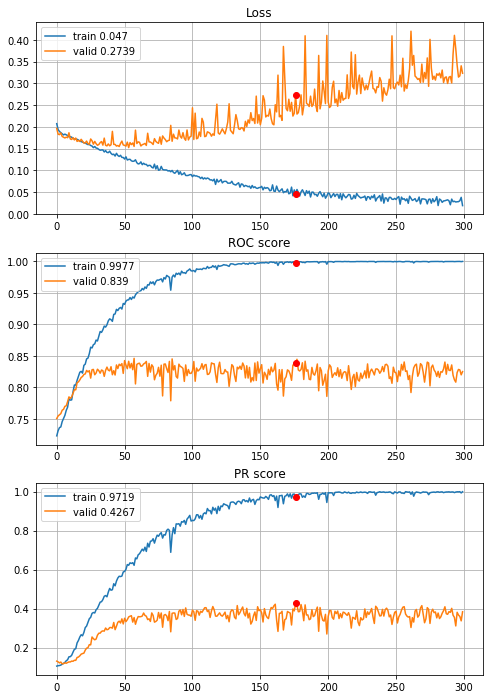


Fold 2------------------------------------------------------------


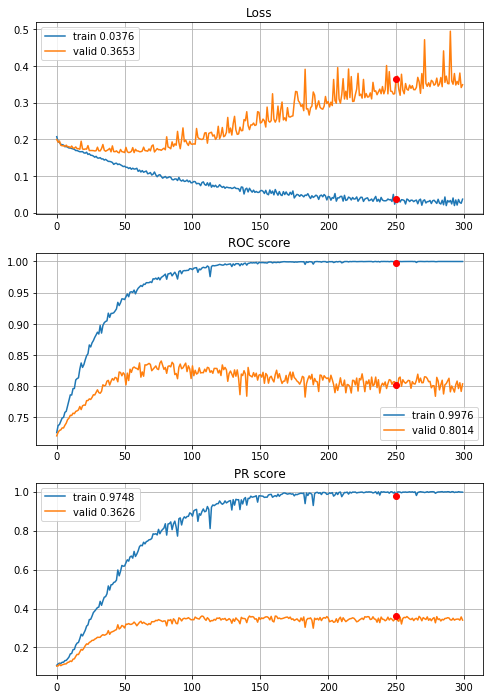


Fold 3------------------------------------------------------------


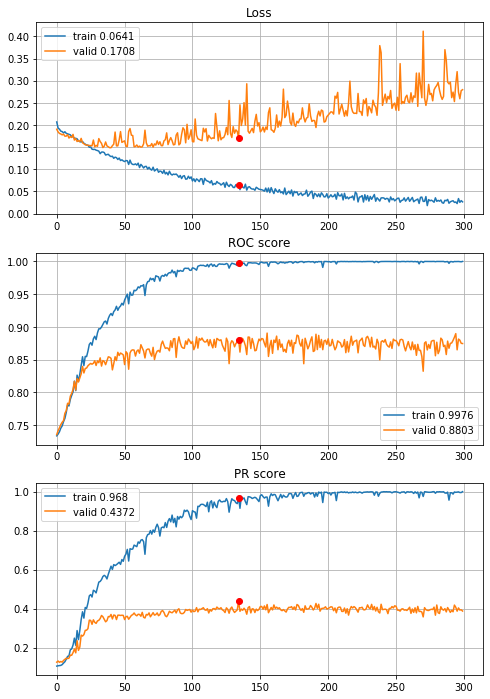


Fold 4------------------------------------------------------------


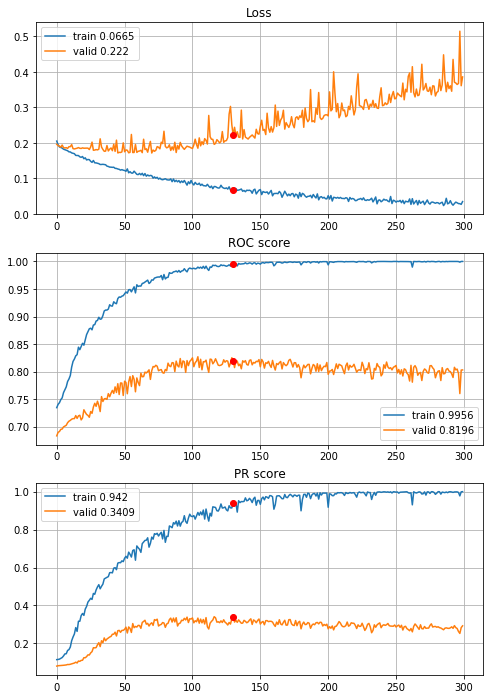


Fold 5------------------------------------------------------------


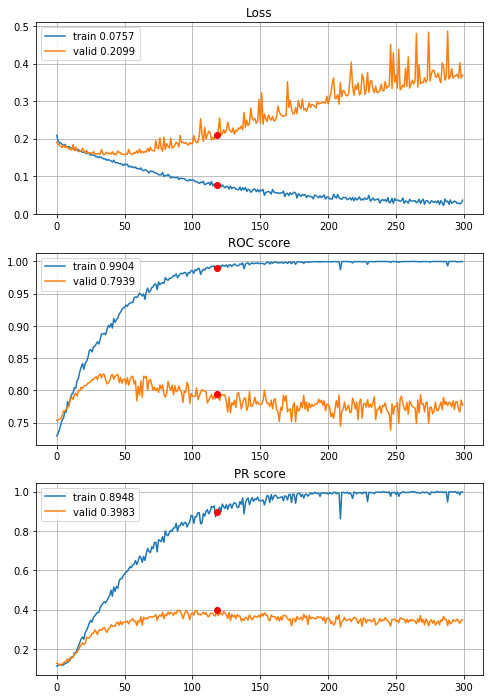


Fold 6------------------------------------------------------------


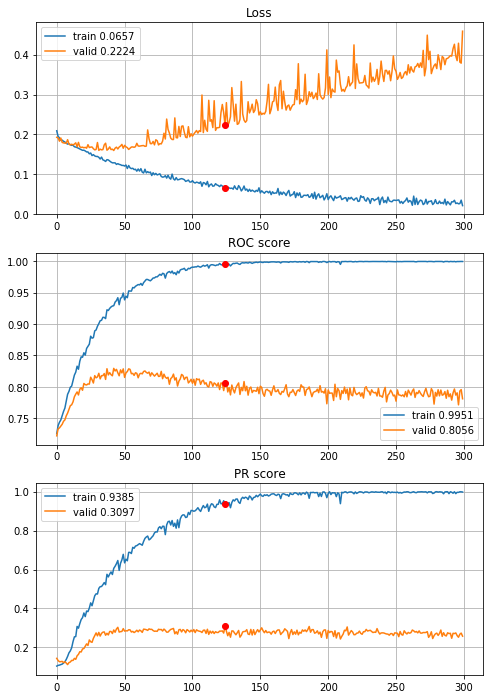

In [60]:
# basic model with L2 and 1 dense only and 0.2 dropout
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2_1dense_drop02, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_1dense_drop02_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Dropout doesn't help, so the best 8x8 CNN configuration is:
 - definition: define_CNN_L2($\cdot$)
 - 8x8x1 input,
 - 2D convolution:
     - kernel size: (3,3)
     - number of filters: 32
     - padding: same
     - stride: (1,1)
     - activation: ReLu
 - 2D convolution:
     - kernel size: (2,2)
     - padding: valid
     - stride: (2,2)
 - Max pooling:
     - kernel size: (3,3)
     - number of filters: 64
     - padding: same
     - stride: (1,1)
     - activation: ReLu
 - 2D convolution:
     - kernel size: (1,1)
     - number of filters: 32
     - padding: same
     - stride: (1,1)
     - activation: ReLu
 - flatten ($512 \text{ units}$),
 - dense:
     - 512 units
     - activation: sigmoid
     - regularization: $L_2=0.00005$
 - dense:
     - 256 units
     - activation: sigmoid
     - regularization: $L_2=0.00005$
 - optimizer: RMSprop with default setings
 - 112 epochs (rounded median 111.5)
 - 394 batch size
 - preprocessing: quantile clipping (q=0.005 and q=0.995), power transform, normalization
 
Because of small image size (8x8) CNN may be a bit under-trained, to fix it image dimensions has to increase. To do so feature generation method will be applied.

##### Feature generation for CNN
 - first, lets train the best XGBoost configuration and save the models (XGBoost achived much better results than Random Forest), note: best configuration excludes power transform from preprocessing pipeline, to get more reliable results best configuration with power transform will be used (CNN uses it too),

In [45]:
# Loading XGBoost random search results
with open(r"results\3year\XGB_RS.p", "rb") as fp:
    xgbrs = pickle.load(fp)

# printing the best ones with power transform included into preprocessing 
xgbrs.sort_values(by="PRvalid", ascending=False).where(xgbrs.norm_mode==3).dropna().head(5)

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
104,4.0,0.09,0.9,1.0,0.00,1.2,1.5,179.0,0.861001,0.128791,0.385539,0.536351,3.0
31,5.0,0.06,1.0,0.8,0.06,1.9,0.8,212.0,0.861955,0.132210,0.384479,0.570196,3.0
60,6.0,0.06,1.0,0.8,0.00,2.7,1.2,166.0,0.862160,0.134396,0.383109,0.586742,3.0
144,6.0,0.05,1.0,1.0,0.10,0.5,1.5,209.5,0.857865,0.139731,0.382371,0.596793,3.0
120,5.0,0.10,1.0,0.9,0.06,2.8,0.9,123.0,0.861293,0.131760,0.381771,0.559666,3.0


The best XGBoost with power transform is 104 index (higher PR, lowest overfitting among considered ones (top 5))

In [46]:
XGB_fi_hist, XGB_fi_models = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target,
                                                      random_state=random_state, info=0, normalize="power", q=0.005,
                                                      n_estimators=179, early_stopping_rounds=179, max_depth=4,
                                                      learning_rate=0.09, subsample=0.9, colsample_bytree=1, gamma=0, 
                                                      reg_alpha=1.2, reg_lambda=1.5, saveModels=True)


Cross validation time: 31s


 - second, lets create importance score table for each fold and on average,

In [47]:
XGBimportance=pd.DataFrame((features,
                           XGB_fi_models[0].feature_importances_,
                           XGB_fi_models[1].feature_importances_,
                           XGB_fi_models[2].feature_importances_,
                           XGB_fi_models[3].feature_importances_,
                           XGB_fi_models[4].feature_importances_,
                           XGB_fi_models[5].feature_importances_)).T

XGBimportance.columns = ("feature", "fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6")
XGBimportance["folds_mean_naive"] = XGBimportance.loc[:, ["fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6"]].mean(axis=1)
# normalize folds mean to sum up to 1
for i in range(len(features)):
    XGBimportance.loc[i,"folds_mean"]=XGBimportance.loc[i,"folds_mean_naive"]/XGBimportance["folds_mean_naive"].sum()

XGBimportance.drop(labels="folds_mean_naive",axis=1, inplace=True)
XGBimportance.sort_values(by="folds_mean", ascending=False, ignore_index=True, inplace=True)

XGBimportance

,feature,fold_1,fold_2,fold_3,fold_4,fold_5,fold_6,folds_mean
0,Attr26,0.0592304,0.0687623,0.0752979,0.0694376,0.0591775,0.0583186,0.065037
1,Attr24,0.0299296,0.0364087,0.0284641,0.031288,0.0296315,0.0304684,0.031032
2,Attr5,0.0276419,0.0294836,0.0290445,0.0350992,0.0279038,0.0284644,0.029606
3,Attr44,0.0250352,0.0269523,0.0296703,0.0275819,0.0206883,0.0270667,0.026166
4,Attr61,0.0253268,0.0287403,0.0251507,0.0209674,0.0285211,0.0226615,0.025228
5,Attr35,0.0211191,0.0210388,0.0232444,0.0220775,0.024168,0.0275537,0.023200
6,Attr22,0.021008,0.0207816,0.0244524,0.0212546,0.0237084,0.0263482,0.022926
7,Attr13,0.0227851,0.0247434,0.0169811,0.0255702,0.0217604,0.0253561,0.022866
8,Attr38,0.0200369,0.0221183,0.0210238,0.0237427,0.0250426,0.0228195,0.022464
9,Attr42,0.0195133,0.0220609,0.0247422,0.0237674,0.0161951,0.0227726,0.021509


 - third, define the discrete probability distribution, where Attributes are events and its fold's average XGBoost importance score is the probability of that event (score average sums up to 1), then sample needed number of attributes pair and one of basic arithmetic operation to perform on them with uniform probability (addition, subtraction, multiplication, division) dealing with duplicates and commutative property of these basic operations to create instruction how to generate new features - feature_generation_instruction(),
 - fourth, define the function which will generate features by instruction and prevent dividing by 0 - generate_features(),

In [48]:
def feature_generation_instruction(image_shape, importance, random_state=random_state):
    '''
    function generates instruction how to create new features. The idea is to sample two features from discrete probability
    distribution with P(x=feature)=Importance(feature) and sample one of arithmetic operations in ["add", "subtract",
    "multiply", "divide"] uniformly distributed. Duplicates are not allowed. Different features sampling order for the same
    operation is forbidden too, arguments:
    image_shape - shape of image to create from all features (original and generated), tuple,
    importance - dataframe with importance score, needs to contain columns ["feature", "folds_mean"], where "folds_mean" is Importance(feature),
    random_state - random seed
    
    return feature generation instruction (pandas.DataFrame, colnames=["feature1", "feature2", "operation"])
    '''
    # random seeds
    np.random.seed(random_state)
    random.seed(random_state)

    # computing number of features to generate
    n_features = image_shape[0]*image_shape[1]-importance.shape[0]
    
    # check if it is possible to generate n_features
        # division by 2 because of we don't want (Attr1, Attr2, add) and (Attr2, Attr1, add) in our instruction
    if n_features > (importance.shape[0]*(importance.shape[0]-1)*4)/2:
        raise "Too may features to generate, maximum number of features with given importance is {}\
        ".format((importance.shape[0]*(importance.shape[0]-1)*4)/2)
    elif n_features <= 0:
        raise "image.shape[0]*image.shape[1]-importance.shape[0]<=0, there is no features to generate."

    # generate first row
    bse=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
    bse=np.append(bse, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
    bse=bse.reshape(1,-1) # needed for condition below (np.any(np.all()))
    # iterator (iterate through number of valid generated features) 
    i=1
    while True:
        # generate next row
        bse_tmp=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
        bse_tmp=np.append(bse_tmp, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
        # validate generated row
        if not np.any(np.all(bse==bse_tmp, axis=1)) and not np.any(np.all(np.array((bse_tmp[1], bse_tmp[0], bse_tmp[2]), dtype="object")==bse, axis=1)):
            # append
            bse=np.vstack((bse, bse_tmp))
            i+=1
        else:
            continue
        # stop generating rows when number of generated features is enough
        if i == n_features:
            break
    
    # convert to dataframe
    bse=pd.DataFrame(data=bse, columns=["feature1", "feature2", "operation"])
    
    return bse

def generate_features(data, instruction):
    '''
    function that generates new features for given dataframe with given istruction, arguments:
    data - dataframe with features,
    instruction - dataframe with 2 columns of features from data and column with arithmetic operation [+,-,*,/] to perform,
    
    return dataframe with old and generated features
    '''
    
    data_wgf=data.copy()
    
    for i in range(instruction.shape[0]):
        feature1=data[instruction.iloc[i,0]]
        feature2=data[instruction.iloc[i,1]]
        operation=instruction.iloc[i,2]
        if operation == "add":
            data_wgf["v"+str(i)]=feature1+feature2
        elif operation == "subtract":
            data_wgf["v"+str(i)]=feature1-feature2
        elif operation == "multiply":
            data_wgf["v"+str(i)]=feature1*feature2
        else:
            # prevent dividing by 0, when feature2==0 assign it to 1, then it won't cause an error 
            feature2.loc[feature2==0]=1
            data_wgf["v"+str(i)]=feature1/feature2
        
    return data_wgf

 - fifth generate instruction,

In [49]:
instruction=feature_generation_instruction(image_shape=(20,20), importance=XGBimportance, random_state=random_state)
instruction

,feature1,feature2,operation
0,Attr20,Attr64,subtract
1,Attr36,Attr30,multiply
2,Attr44,Attr35,add
3,Attr11,Attr32,multiply
4,Attr5,Attr26,multiply
...,...,...,...
336,Attr57,Attr10,add
337,Attr38,Attr22,add
338,Attr64,Attr39,subtract
339,Attr54,Attr39,subtract


 - sixth perform Monte Carlo quasi optimization for image conversion with generated features for each of 6 folds (it will take a loooot of time) and save the results, 

In [74]:
# FOLD 1
# CV sets
fold=sets["training_sets"][0].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\3year_data\draft_20x20_fold_1.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2862267.3156
iteration: 100
current energy: 2773825.6236
iteration: 200
current energy: 2704685.0285
iteration: 300
current energy: 2645438.9078
iteration: 400
current energy: 2578564.9331
iteration: 500
current energy: 2515008.7182
iteration: 600
current energy: 2474030.4312
iteration: 700
current energy: 2438648.5876
iteration: 800
current energy: 2398819.5943
iteration: 900
current energy: 2364828.4476
iteration: 1000
current energy: 2337146.4719
iteration: 1100
current energy: 2322995.3508
iteration: 1200
current energy: 2292343.8314
iteration: 1300
current energy: 2257092.8122
iteration: 1400
current energy: 2245541.4041
iteration: 1500
current energy: 2223268.1845
iteration: 1600
current energy: 2212537.9031
iteration: 1700
current energy: 2199206.0718
iteration: 1800
current energy: 2182805.8137
iteration: 1900
current energy: 2166381.2698
iteration: 2000
current energy: 2148636.3286
iteration: 2100
current energy: 2136403.5574
iteration: 2200
current energ

In [75]:
# FOLD 2
# CV sets
fold=sets["training_sets"][1].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\3year_data\draft_20x20_fold_2.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2873204.345
iteration: 100
current energy: 2784213.9035
iteration: 200
current energy: 2714909.2211
iteration: 300
current energy: 2655302.8911
iteration: 400
current energy: 2587985.0961
iteration: 500
current energy: 2523871.4949
iteration: 600
current energy: 2483353.2382
iteration: 700
current energy: 2450671.6975
iteration: 800
current energy: 2413708.9334
iteration: 900
current energy: 2376244.9216
iteration: 1000
current energy: 2345435.0712
iteration: 1100
current energy: 2331671.256
iteration: 1200
current energy: 2294938.3641
iteration: 1300
current energy: 2261927.3063
iteration: 1400
current energy: 2249177.2398
iteration: 1500
current energy: 2225391.4104
iteration: 1600
current energy: 2215652.8569
iteration: 1700
current energy: 2205602.5161
iteration: 1800
current energy: 2195188.227
iteration: 1900
current energy: 2180053.5175
iteration: 2000
current energy: 2156232.2589
iteration: 2100
current energy: 2141995.4793
iteration: 2200
current energy: 

In [76]:
# FOLD 3
# CV sets
fold=sets["training_sets"][2].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\3year_data\draft_20x20_fold_3.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2850221.3736
iteration: 100
current energy: 2761697.8889
iteration: 200
current energy: 2693184.0892
iteration: 300
current energy: 2634594.585
iteration: 400
current energy: 2569273.7258
iteration: 500
current energy: 2507307.3351
iteration: 600
current energy: 2465483.6401
iteration: 700
current energy: 2432266.1025
iteration: 800
current energy: 2389213.9562
iteration: 900
current energy: 2354077.2927
iteration: 1000
current energy: 2318133.5324
iteration: 1100
current energy: 2304884.1748
iteration: 1200
current energy: 2267158.899
iteration: 1300
current energy: 2233531.766
iteration: 1400
current energy: 2220515.4373
iteration: 1500
current energy: 2202169.3976
iteration: 1600
current energy: 2190764.3178
iteration: 1700
current energy: 2182382.7017
iteration: 1800
current energy: 2165500.5231
iteration: 1900
current energy: 2154830.9085
iteration: 2000
current energy: 2126649.3559
iteration: 2100
current energy: 2116709.5384
iteration: 2200
current energy: 

In [77]:
# FOLD 4
# CV sets
fold=sets["training_sets"][3].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\3year_data\draft_20x20_fold_4.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2871977.1531
iteration: 100
current energy: 2782682.4308
iteration: 200
current energy: 2713677.2451
iteration: 300
current energy: 2653975.0261
iteration: 400
current energy: 2584005.7893
iteration: 500
current energy: 2516727.1024
iteration: 600
current energy: 2473378.614
iteration: 700
current energy: 2441331.6139
iteration: 800
current energy: 2399821.2296
iteration: 900
current energy: 2365001.3548
iteration: 1000
current energy: 2332549.0135
iteration: 1100
current energy: 2320708.5549
iteration: 1200
current energy: 2283818.5087
iteration: 1300
current energy: 2251905.3038
iteration: 1400
current energy: 2236901.5139
iteration: 1500
current energy: 2216772.8506
iteration: 1600
current energy: 2203517.8902
iteration: 1700
current energy: 2194623.196
iteration: 1800
current energy: 2174523.3508
iteration: 1900
current energy: 2157890.8093
iteration: 2000
current energy: 2140481.7626
iteration: 2100
current energy: 2126984.8388
iteration: 2200
current energy:

In [78]:
# FOLD 5
# CV sets
fold=sets["training_sets"][4].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\3year_data\draft_20x20_fold_5.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2853967.7263
iteration: 100
current energy: 2766385.4201
iteration: 200
current energy: 2696333.0916
iteration: 300
current energy: 2636340.1156
iteration: 400
current energy: 2565829.3215
iteration: 500
current energy: 2499719.1188
iteration: 600
current energy: 2458651.8617
iteration: 700
current energy: 2424991.1891
iteration: 800
current energy: 2381785.5532
iteration: 900
current energy: 2347359.4126
iteration: 1000
current energy: 2319142.49
iteration: 1100
current energy: 2305062.4774
iteration: 1200
current energy: 2265985.4602
iteration: 1300
current energy: 2234929.2605
iteration: 1400
current energy: 2219499.804
iteration: 1500
current energy: 2197965.5662
iteration: 1600
current energy: 2186291.707
iteration: 1700
current energy: 2174598.2769
iteration: 1800
current energy: 2156953.2114
iteration: 1900
current energy: 2140631.3109
iteration: 2000
current energy: 2118250.6105
iteration: 2100
current energy: 2107019.7612
iteration: 2200
current energy: 2

In [79]:
# FOLD 6
# CV sets
fold=sets["training_sets"][5].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\3year_data\draft_20x20_fold_6.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2850316.8605
iteration: 100
current energy: 2761281.5158
iteration: 200
current energy: 2693397.0836
iteration: 300
current energy: 2633013.6079
iteration: 400
current energy: 2566870.486
iteration: 500
current energy: 2504084.5651
iteration: 600
current energy: 2461863.9032
iteration: 700
current energy: 2426663.3774
iteration: 800
current energy: 2385012.3074
iteration: 900
current energy: 2349763.6486
iteration: 1000
current energy: 2317036.8614
iteration: 1100
current energy: 2302164.4164
iteration: 1200
current energy: 2267197.838
iteration: 1300
current energy: 2230968.0337
iteration: 1400
current energy: 2220520.3742
iteration: 1500
current energy: 2199424.1142
iteration: 1600
current energy: 2189204.3792
iteration: 1700
current energy: 2176723.3731
iteration: 1800
current energy: 2165060.7409
iteration: 1900
current energy: 2149912.2236
iteration: 2000
current energy: 2120805.2034
iteration: 2100
current energy: 2107557.0244
iteration: 2200
current energy:

In [80]:
# with open(r"data\3year_data\draft_20x20_fold_1.p", "rb") as fp:
#     draft_1 = pickle.load(fp)
# with open(r"data\3year_data\draft_20x20_fold_2.p", "rb") as fp:
#     draft_2 = pickle.load(fp)
# with open(r"data\3year_data\draft_20x20_fold_3.p", "rb") as fp:
#     draft_3 = pickle.load(fp)
# with open(r"data\3year_data\draft_20x20_fold_4.p", "rb") as fp:
#     draft_4 = pickle.load(fp)
# with open(r"data\3year_data\draft_20x20_fold_5.p", "rb") as fp:
#     draft_5 = pickle.load(fp)
# with open(r"data\3year_data\draft_20x20_fold_6.p", "rb") as fp:
#     draft_6 = pickle.load(fp)
# optimized_drafts=[draft_1,draft_2,draft_3,draft_4,draft_5,draft_6]

In [81]:
# # initial draft re-creation and saving (I forgot about saving when MC optimization was performed)
# train_folds=sets["training_sets"]
# initial_drafts=[]
# for fold in range(len(train_folds)):
#     X_train_fold=generate_features(train_folds[fold][features], instruction)
#     Y_train_fold=train_folds[fold][target].copy()
#     features_imp=X_train_fold.columns.tolist()
#     corr_matrix=X_train_fold[Y_train_fold==0].corr(method="spearman")
#     draft=image_dict_to_matrix(image_draft_inicialization(features_imp, random_state))
#     initial_drafts.append(draft)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [83]:
# drafts=dict(zip(["initial_drafts", "optimized_drafts"], [initial_drafts, optimized_drafts]))

# # saving drafts
# with open(r"data\3year_data\drafts_20x20.p", "wb") as fp:
#     pickle.dump(drafts, fp)

In [50]:
# LOADING 20x20 drafts
with open(r"data\3year_data\drafts_20x20.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

			 Normalization only

			-----FOLD 1 -----


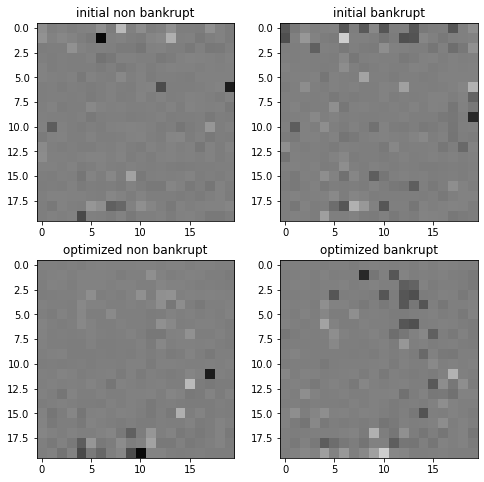


			-----FOLD 2 -----


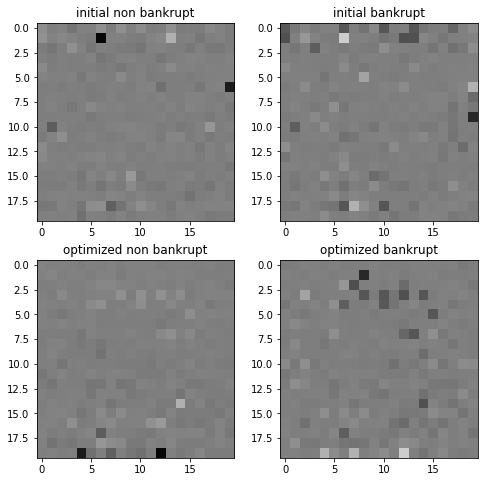


			-----FOLD 3 -----


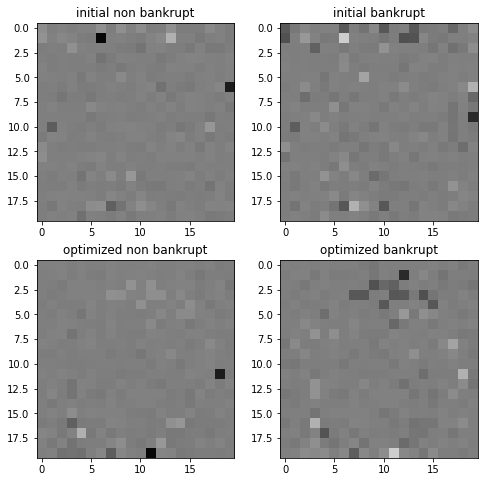


			-----FOLD 4 -----


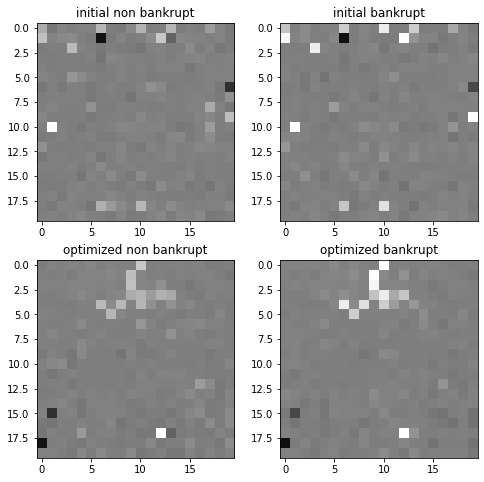


			-----FOLD 5 -----


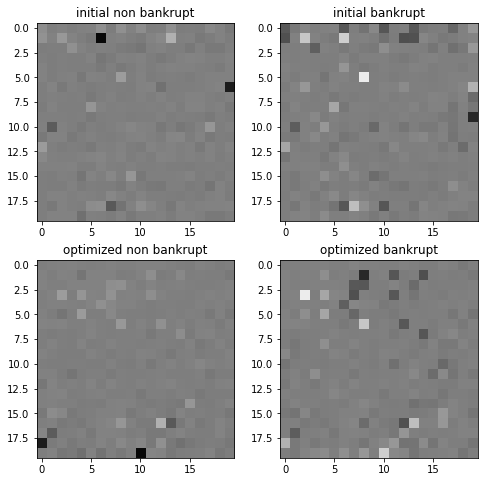


			-----FOLD 6 -----


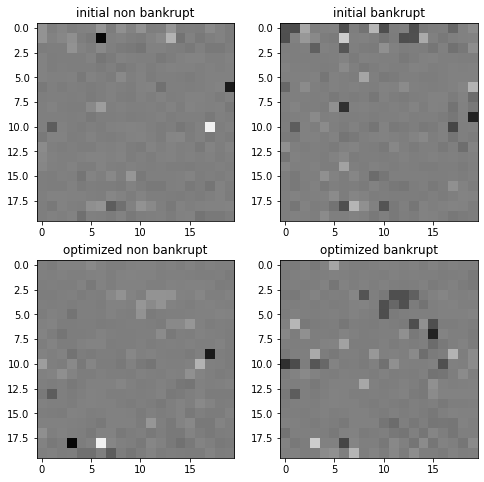

In [51]:
# printing images for normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization andquantile clipping

			-----FOLD 1 -----


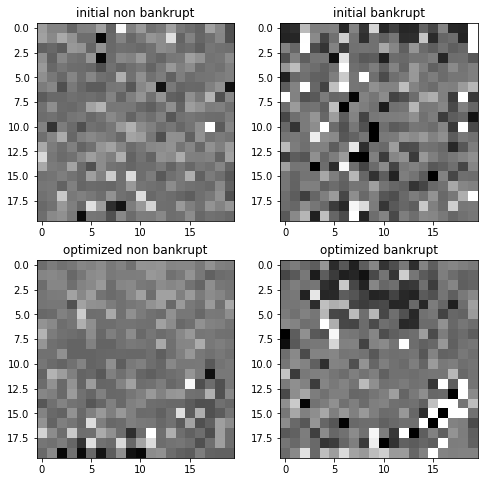


			-----FOLD 2 -----


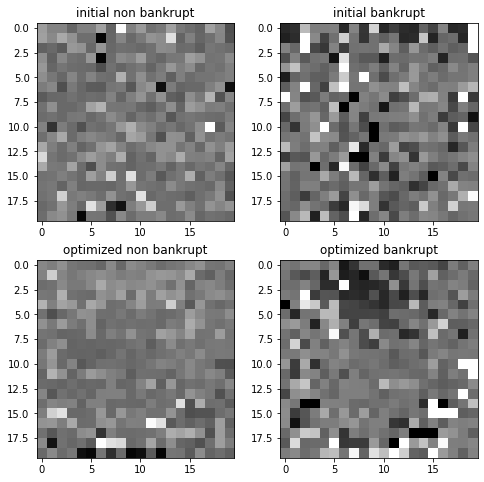


			-----FOLD 3 -----


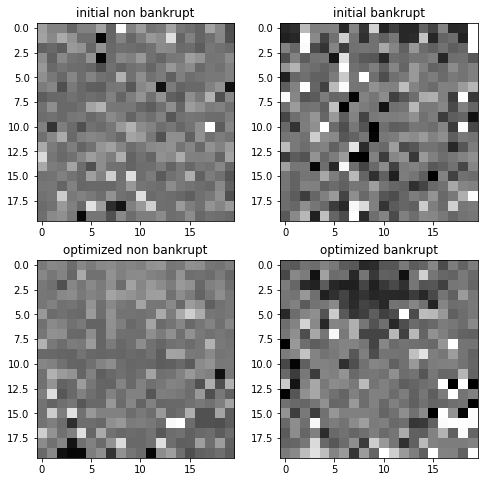


			-----FOLD 4 -----


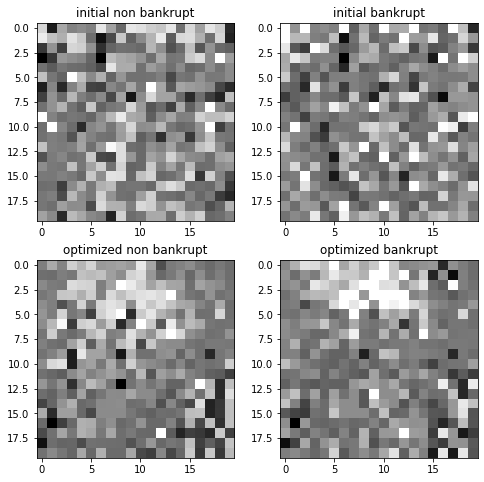


			-----FOLD 5 -----


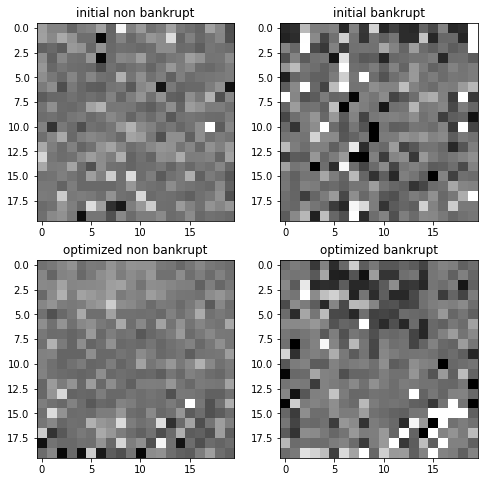


			-----FOLD 6 -----


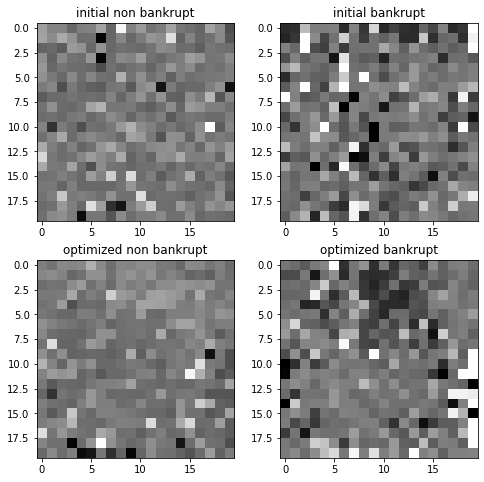

In [52]:
# printing images for normalization and quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t Normalization andquantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


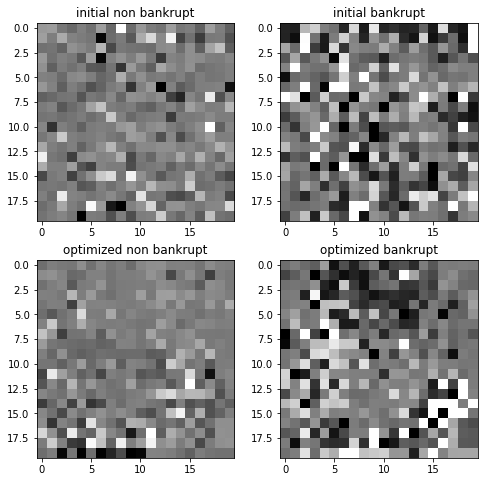


			-----FOLD 2 -----


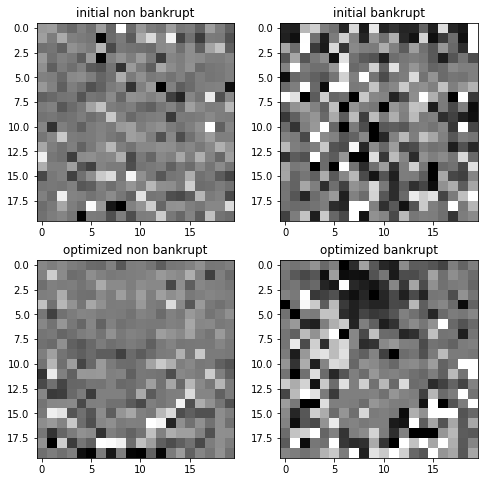


			-----FOLD 3 -----


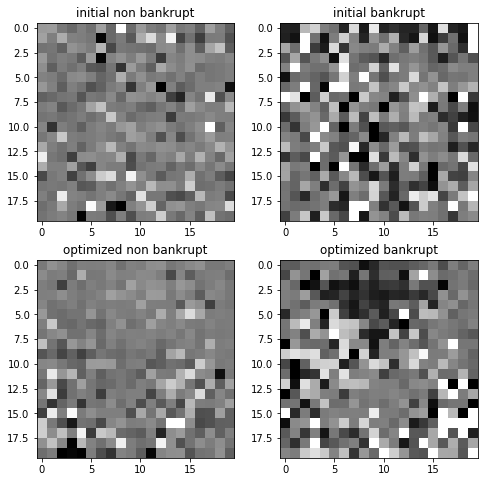


			-----FOLD 4 -----


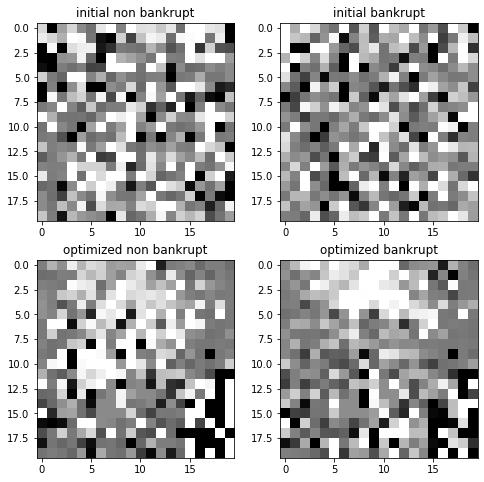


			-----FOLD 5 -----


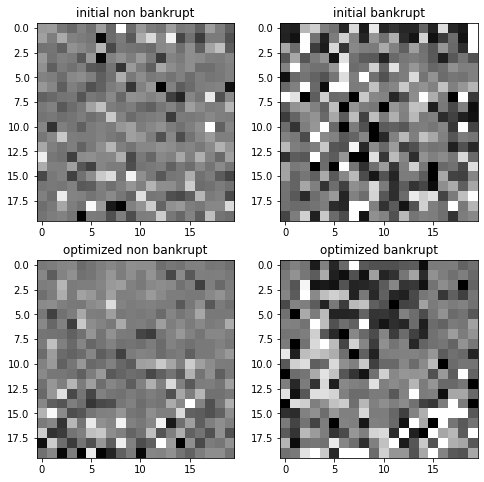


			-----FOLD 6 -----


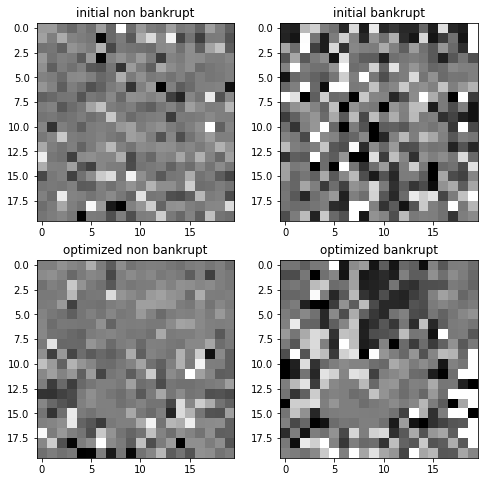

In [53]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

lets begin with the best 8x8 input model on 20x20 data
 - 150 epochs


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 7.94s train loss: 0.24839744193563612, validation loss: 0.2226935625076294
Epoch: 2/300,
cumulative time: 15.51s train loss: 0.22493537780277736, validation loss: 0.20649806410074234
Epoch: 3/300,
cumulative time: 22.86s train loss: 0.21341453275443212, validation loss: 0.19909067079424858
Epoch: 4/300,
cumulative time: 29.81s train loss: 0.20800226007684225, validation loss: 0.2245333269238472
Epoch: 5/300,
cumulative time: 36.75s train loss: 0.20115539712718805, validation loss: 0.194691713899374
Epoch: 6/300,
cumulative time: 43.68s train loss: 0.19647075261952854, validation loss: 0.18903042748570442
Epoch: 7/300,
cumulative time: 50.64s train loss: 0.1951508238843518, validation loss: 0.18780724704265594
Epoch: 8/300,
cumulative time: 57.7s train loss: 0.19117979477162045, validation loss: 0.1960211619734764
Epoch: 9/300,
cumulative time: 64.64s train loss: 0.18779068998330253, validation loss: 0.192444

Epoch: 76/300,
cumulative time: 532.04s train loss: 0.07597249351657545, validation loss: 0.1761491261422634
Epoch: 77/300,
cumulative time: 539.0s train loss: 0.06771117800334918, validation loss: 0.18106483668088913
Epoch: 78/300,
cumulative time: 545.95s train loss: 0.07848299239275418, validation loss: 0.17185337468981743
Epoch: 79/300,
cumulative time: 552.86s train loss: 0.0801480203458293, validation loss: 0.17392954602837563
Epoch: 80/300,
cumulative time: 559.76s train loss: 0.06445072357362602, validation loss: 0.21313095837831497
Epoch: 81/300,
cumulative time: 566.66s train loss: 0.07233409932447969, validation loss: 0.18283164501190186
Epoch: 82/300,
cumulative time: 573.56s train loss: 0.0699378354091778, validation loss: 0.1820802167057991
Epoch: 83/300,
cumulative time: 580.48s train loss: 0.0662428568670249, validation loss: 0.22121687233448029
Epoch: 84/300,
cumulative time: 587.41s train loss: 0.07291096174278769, validation loss: 0.18310518190264702
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1053.34s train loss: 0.055292659840717295, validation loss: 0.24966446310281754
Epoch: 152/300,
cumulative time: 1060.25s train loss: 0.035756047142015884, validation loss: 0.25615112110972404
Epoch: 153/300,
cumulative time: 1067.14s train loss: 0.045406367717743104, validation loss: 0.2586158812046051
Epoch: 154/300,
cumulative time: 1074.05s train loss: 0.02877742334218377, validation loss: 0.42721351236104965
Epoch: 155/300,
cumulative time: 1080.97s train loss: 0.03788418100968026, validation loss: 0.25481267273426056
Epoch: 156/300,
cumulative time: 1087.84s train loss: 0.039300459578497086, validation loss: 0.25377821177244186
Epoch: 157/300,
cumulative time: 1094.74s train loss: 0.050324687904050626, validation loss: 0.25098229199647903
Epoch: 158/300,
cumulative time: 1101.65s train loss: 0.022813405246091198, validation loss: 0.2599453516304493
Epoch: 159/300,
cumulative time: 1108.6s train loss: 0.04489596763463977, validation loss: 0.3760530

Epoch: 225/300,
cumulative time: 1567.54s train loss: 0.017427056390695642, validation loss: 0.2835252732038498
Epoch: 226/300,
cumulative time: 1574.49s train loss: 0.029101865160822443, validation loss: 0.27399207651615143
Epoch: 227/300,
cumulative time: 1581.44s train loss: 0.03122025778410231, validation loss: 0.26743288338184357
Epoch: 228/300,
cumulative time: 1588.33s train loss: 0.0183261137445296, validation loss: 0.27736545726656914
Epoch: 229/300,
cumulative time: 1595.22s train loss: 0.03748029683999918, validation loss: 0.2681632414460182
Epoch: 230/300,
cumulative time: 1602.11s train loss: 0.03890933766402967, validation loss: 0.2625024579465389
Epoch: 231/300,
cumulative time: 1609.08s train loss: 0.016713593255183595, validation loss: 0.2743256464600563
Epoch: 232/300,
cumulative time: 1616.74s train loss: 0.03177990047464506, validation loss: 0.27796804159879684
Epoch: 233/300,
cumulative time: 1623.68s train loss: 0.01824715441147716, validation loss: 0.263065431267

Epoch: 299/300,
cumulative time: 2081.46s train loss: 0.04092152823881828, validation loss: 0.2729194834828377
Epoch: 300/300,
cumulative time: 2088.36s train loss: 0.013667523588724112, validation loss: 0.27618659287691116

Early stopping results:
best results in epoch: 96, 
best valid PR: 0.46995296991089164, 
valid ROC: 0.8640326411631339        
overfitting PR: 0.5182569289035736, 
overfitting ROC: 0.13514616326374407

----------
Fold: 2
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 7.83s train loss: 0.24980141271289802, validation loss: 0.24446643516421318
Epoch: 2/300,
cumulative time: 14.72s train loss: 0.22229014501285893, validation loss: 0.2112862765789032
Epoch: 3/300,
cumulative time: 21.7s train loss: 0.20842622117214604, validation loss: 0.20240287855267525
Epoch: 4/300,
cumulative time: 28.66s train loss: 0.19785427311203577, validation loss: 0.19754085689783096
Epoch: 5/300,
cumulative time: 35.6s train loss: 0.20322105631330645, validation loss: 0.1927124261856079
Epoch: 6/300,
cumulative time: 42.54s train loss: 0.19451111126757323, validation loss: 0.1913968212902546
Epoch: 7/300,
cumulative time: 49.51s train loss: 0.19191097537005475, validation loss: 0.1901680752635002
Epoch: 8/300,
cumulative time: 56.47s train loss: 0.19001545430122746, validation loss: 0.18902277946472168
Epoch: 9/300,
cumulative time: 63.41s train loss: 0.1852565888275708, validation loss: 0.184755

Epoch: 76/300,
cumulative time: 532.45s train loss: 0.06294075178087453, validation loss: 0.20047777146100998
Epoch: 77/300,
cumulative time: 539.42s train loss: 0.07786548538857181, validation loss: 0.19930434599518776
Epoch: 78/300,
cumulative time: 546.41s train loss: 0.06106646459335873, validation loss: 0.2233898676931858
Epoch: 79/300,
cumulative time: 553.36s train loss: 0.05756443637149355, validation loss: 0.26157988980412483
Epoch: 80/300,
cumulative time: 560.32s train loss: 0.0639285369023658, validation loss: 0.2152337022125721
Epoch: 81/300,
cumulative time: 567.25s train loss: 0.06420299198635494, validation loss: 0.21967873349785805
Epoch: 82/300,
cumulative time: 574.19s train loss: 0.05731881405626565, validation loss: 0.21949633955955505
Epoch: 83/300,
cumulative time: 581.12s train loss: 0.072789973329134, validation loss: 0.2053755410015583
Epoch: 84/300,
cumulative time: 588.06s train loss: 0.060797405293908535, validation loss: 0.21842333674430847
Epoch: 85/300,


Epoch: 151/300,
cumulative time: 1056.96s train loss: 0.039457745307563616, validation loss: 0.33872271329164505
Epoch: 152/300,
cumulative time: 1063.9s train loss: 0.03645139571786336, validation loss: 0.2631881572306156
Epoch: 153/300,
cumulative time: 1070.83s train loss: 0.03993561242292259, validation loss: 0.2637558542191982
Epoch: 154/300,
cumulative time: 1078.04s train loss: 0.022046653586479992, validation loss: 0.33531345427036285
Epoch: 155/300,
cumulative time: 1085.55s train loss: 0.04065251989510533, validation loss: 0.2623208127915859
Epoch: 156/300,
cumulative time: 1092.51s train loss: 0.038767728648054355, validation loss: 0.25963202491402626
Epoch: 157/300,
cumulative time: 1100.22s train loss: 0.03320734107175368, validation loss: 0.25480518117547035
Epoch: 158/300,
cumulative time: 1107.65s train loss: 0.026952157289909795, validation loss: 0.2729669474065304
Epoch: 159/300,
cumulative time: 1114.83s train loss: 0.03962330348504004, validation loss: 0.26253551617

Epoch: 225/300,
cumulative time: 1611.67s train loss: 0.017194996747330642, validation loss: 0.30632252246141434
Epoch: 226/300,
cumulative time: 1619.04s train loss: 0.04244469448431206, validation loss: 0.2748193219304085
Epoch: 227/300,
cumulative time: 1626.68s train loss: 0.014915362831513521, validation loss: 0.29486874118447304
Epoch: 228/300,
cumulative time: 1633.95s train loss: 0.036166922962401815, validation loss: 0.26030685752630234
Epoch: 229/300,
cumulative time: 1641.09s train loss: 0.015013104098446481, validation loss: 0.2882094755768776
Epoch: 230/300,
cumulative time: 1648.37s train loss: 0.0317829360441887, validation loss: 0.28027307242155075
Epoch: 231/300,
cumulative time: 1655.94s train loss: 0.026536623593287352, validation loss: 0.3017609752714634
Epoch: 232/300,
cumulative time: 1663.2s train loss: 0.015424064179402792, validation loss: 0.2793250270187855
Epoch: 233/300,
cumulative time: 1670.74s train loss: 0.024597011330367693, validation loss: 0.285113330

Epoch: 299/300,
cumulative time: 2162.5s train loss: 0.022571875657952486, validation loss: 0.27618592604994774
Epoch: 300/300,
cumulative time: 2169.61s train loss: 0.01139685598383206, validation loss: 0.3005395531654358

Early stopping results:
best results in epoch: 169, 
best valid PR: 0.4408366099335069, 
valid ROC: 0.8582411725516323        
overfitting PR: 0.5590123110101353, 
overfitting ROC: 0.14175126593001486

----------
Fold: 3
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 8.06s train loss: 0.24579395901260906, validation loss: 0.227866624120682
Epoch: 2/300,
cumulative time: 15.45s train loss: 0.23410529729087173, validation loss: 0.20806682989710854
Epoch: 3/300,
cumulative time: 22.73s train loss: 0.21174228551182875, validation loss: 0.2005844896842563
Epoch: 4/300,
cumulative time: 29.86s train loss: 0.20429884770527337, validation loss: 0.19558694194233606
Epoch: 5/300,
cumulative time: 37.05s train loss: 0.20143423548307124, validation loss: 0.1921294978119078
Epoch: 6/300,
cumulative time: 44.18s train loss: 0.19703517062902845, validation loss: 0.19391286269066826
Epoch: 7/300,
cumulative time: 51.34s train loss: 0.19837322442403252, validation loss: 0.18964671089535667
Epoch: 8/300,
cumulative time: 58.58s train loss: 0.1920462069292578, validation loss: 0.18698749275434584
Epoch: 9/300,
cumulative time: 65.75s train loss: 0.189094983802708, validation loss: 0.193239

Epoch: 76/300,
cumulative time: 570.62s train loss: 0.08402459878345363, validation loss: 0.1897405160797967
Epoch: 77/300,
cumulative time: 577.79s train loss: 0.07895484923563498, validation loss: 0.2064205020382291
Epoch: 78/300,
cumulative time: 585.01s train loss: 0.08370379871945703, validation loss: 0.18738802700761764
Epoch: 79/300,
cumulative time: 592.2s train loss: 0.07907676925582148, validation loss: 0.20207711070302933
Epoch: 80/300,
cumulative time: 599.28s train loss: 0.08505970505522005, validation loss: 0.23021420246078855
Epoch: 81/300,
cumulative time: 606.8s train loss: 0.07033498678439172, validation loss: 0.21500185430996002
Epoch: 82/300,
cumulative time: 613.9s train loss: 0.08000541961638019, validation loss: 0.19932995674156007
Epoch: 83/300,
cumulative time: 621.07s train loss: 0.07534005824546001, validation loss: 0.2513081547381386
Epoch: 84/300,
cumulative time: 628.19s train loss: 0.08983438030893584, validation loss: 0.2488563985105545
Epoch: 85/300,
cu

Epoch: 151/300,
cumulative time: 1135.21s train loss: 0.03540038962616629, validation loss: 0.29778417331831797
Epoch: 152/300,
cumulative time: 1142.32s train loss: 0.043525584631819283, validation loss: 0.28240008819670903
Epoch: 153/300,
cumulative time: 1149.42s train loss: 0.034358639047315946, validation loss: 0.29755047349702746
Epoch: 154/300,
cumulative time: 1156.68s train loss: 0.046457317378620244, validation loss: 0.3250419086880154
Epoch: 155/300,
cumulative time: 1163.94s train loss: 0.0369883001142004, validation loss: 0.49441519862129574
Epoch: 156/300,
cumulative time: 1171.13s train loss: 0.04315927835914164, validation loss: 0.29888208239797565
Epoch: 157/300,
cumulative time: 1178.31s train loss: 0.04941749029023266, validation loss: 0.2874341109253111
Epoch: 158/300,
cumulative time: 1185.61s train loss: 0.03525743803291495, validation loss: 0.2839060283464099
Epoch: 159/300,
cumulative time: 1193.24s train loss: 0.03269573002609109, validation loss: 0.32120319073

Epoch: 225/300,
cumulative time: 1674.95s train loss: 0.018443206282372976, validation loss: 0.30545449538836406
Epoch: 226/300,
cumulative time: 1682.19s train loss: 0.04107164081918629, validation loss: 0.297784716345015
Epoch: 227/300,
cumulative time: 1689.45s train loss: 0.029001145476424045, validation loss: 0.31032741919396417
Epoch: 228/300,
cumulative time: 1696.71s train loss: 0.03625263147986834, validation loss: 0.2987177371789539
Epoch: 229/300,
cumulative time: 1703.89s train loss: 0.019403534792519713, validation loss: 0.32129286381933425
Epoch: 230/300,
cumulative time: 1711.07s train loss: 0.03288649476015172, validation loss: 0.30731045683224995
Epoch: 231/300,
cumulative time: 1718.39s train loss: 0.04559919559684701, validation loss: 0.3107414254309639
Epoch: 232/300,
cumulative time: 1725.95s train loss: 0.01673058528106452, validation loss: 0.3205569877321758
Epoch: 233/300,
cumulative time: 1733.94s train loss: 0.024437540615022645, validation loss: 0.51400718870

Epoch: 299/300,
cumulative time: 2222.7s train loss: 0.04009781258531417, validation loss: 0.30366209947873674
Epoch: 300/300,
cumulative time: 2230.02s train loss: 0.01360501800220986, validation loss: 0.3197265720556653

Early stopping results:
best results in epoch: 219, 
best valid PR: 0.35069776634999855, 
valid ROC: 0.8336604425878243        
overfitting PR: 0.642949469816144, 
overfitting ROC: 0.16596070505829952

----------
Fold: 4
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 8.07s train loss: 0.24760804808017217, validation loss: 0.24150121949967884
Epoch: 2/300,
cumulative time: 15.23s train loss: 0.22893613770223895, validation loss: 0.20799882220843482
Epoch: 3/300,
cumulative time: 22.34s train loss: 0.20884860743873385, validation loss: 0.22774844059868465
Epoch: 4/300,
cumulative time: 29.64s train loss: 0.20265597111458128, validation loss: 0.19912255422463493
Epoch: 5/300,
cumulative time: 36.87s train loss: 0.20325932947908604, validation loss: 0.2007133978699881
Epoch: 6/300,
cumulative time: 44.31s train loss: 0.19264064594711675, validation loss: 0.19575932023071108
Epoch: 7/300,
cumulative time: 51.8s train loss: 0.1900631821827491, validation loss: 0.19985288721228403
Epoch: 8/300,
cumulative time: 59.33s train loss: 0.18962697421057628, validation loss: 0.19463120384821816
Epoch: 9/300,
cumulative time: 66.48s train loss: 0.18705556299823545, validation loss: 0.19

Epoch: 76/300,
cumulative time: 558.82s train loss: 0.06963235954520544, validation loss: 0.29803927597545443
Epoch: 77/300,
cumulative time: 566.08s train loss: 0.07588081558703075, validation loss: 0.23133921428332252
Epoch: 78/300,
cumulative time: 573.8s train loss: 0.07706512690112571, validation loss: 0.28981687222208297
Epoch: 79/300,
cumulative time: 581.23s train loss: 0.07182641999134637, validation loss: 0.2598060455587175
Epoch: 80/300,
cumulative time: 588.5s train loss: 0.07692004693228686, validation loss: 0.25738561369123913
Epoch: 81/300,
cumulative time: 596.29s train loss: 0.0711291953528784, validation loss: 0.23200412515609983
Epoch: 82/300,
cumulative time: 604.08s train loss: 0.07561948543970878, validation loss: 0.22768442994072324
Epoch: 83/300,
cumulative time: 611.7s train loss: 0.07407221338164614, validation loss: 0.2174896928999159
Epoch: 84/300,
cumulative time: 619.28s train loss: 0.06587268341267882, validation loss: 0.2193781866724529
Epoch: 85/300,
cu

Epoch: 151/300,
cumulative time: 1138.53s train loss: 0.048905664009499764, validation loss: 0.28461054495402743
Epoch: 152/300,
cumulative time: 1146.08s train loss: 0.023488670859712398, validation loss: 0.3087923505192711
Epoch: 153/300,
cumulative time: 1153.28s train loss: 0.0368998508479021, validation loss: 0.29034143042942834
Epoch: 154/300,
cumulative time: 1160.37s train loss: 0.04791734348337019, validation loss: 0.2935455499944233
Epoch: 155/300,
cumulative time: 1167.52s train loss: 0.025375576483877203, validation loss: 0.6946378980364118
Epoch: 156/300,
cumulative time: 1174.83s train loss: 0.05219069957994213, validation loss: 0.2990096595741454
Epoch: 157/300,
cumulative time: 1182.22s train loss: 0.03312193193898916, validation loss: 0.2922214448830438
Epoch: 158/300,
cumulative time: 1189.63s train loss: 0.024546705481476992, validation loss: 0.2982383330852266
Epoch: 159/300,
cumulative time: 1196.9s train loss: 0.05098670735265703, validation loss: 0.29269832039636

Epoch: 225/300,
cumulative time: 1688.25s train loss: 0.01848765909534633, validation loss: 0.3150139268996224
Epoch: 226/300,
cumulative time: 1695.3s train loss: 0.02852171700874856, validation loss: 0.2956594940215822
Epoch: 227/300,
cumulative time: 1702.3s train loss: 0.024138345151725374, validation loss: 0.2913960787417397
Epoch: 228/300,
cumulative time: 1709.3s train loss: 0.015970036263416962, validation loss: 0.32682706745844037
Epoch: 229/300,
cumulative time: 1716.32s train loss: 0.029387842345463985, validation loss: 0.29052333269800457
Epoch: 230/300,
cumulative time: 1723.3s train loss: 0.022821152685391005, validation loss: 0.31066300827359394
Epoch: 231/300,
cumulative time: 1730.28s train loss: 0.017362399066950793, validation loss: 0.5750635215971205
Epoch: 232/300,
cumulative time: 1737.27s train loss: 0.03154682719689139, validation loss: 0.31321757933450123
Epoch: 233/300,
cumulative time: 1744.24s train loss: 0.023918269645014555, validation loss: 0.310474302219

Epoch: 299/300,
cumulative time: 2207.97s train loss: 0.03203358767989026, validation loss: 0.2960512067211999
Epoch: 300/300,
cumulative time: 2214.96s train loss: 0.012011905584682497, validation loss: 0.31408767168484036

Early stopping results:
best results in epoch: 191, 
best valid PR: 0.39021291923386464, 
valid ROC: 0.8269577038730936        
overfitting PR: 0.6096197692805161, 
overfitting ROC: 0.1730342163373687

----------
Fold: 5
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 7.89s train loss: 0.2522158005451118, validation loss: 0.22222589735946957
Epoch: 2/300,
cumulative time: 14.89s train loss: 0.22140027101010828, validation loss: 0.20771352007275537
Epoch: 3/300,
cumulative time: 21.86s train loss: 0.2122821558190736, validation loss: 0.2093004130181812
Epoch: 4/300,
cumulative time: 28.91s train loss: 0.20802177015114545, validation loss: 0.19805842080759622
Epoch: 5/300,
cumulative time: 35.93s train loss: 0.19818908816457204, validation loss: 0.20237921040209514
Epoch: 6/300,
cumulative time: 42.97s train loss: 0.19606415060997553, validation loss: 0.20472057637714206
Epoch: 7/300,
cumulative time: 49.99s train loss: 0.19675544667806938, validation loss: 0.19061114241206456
Epoch: 8/300,
cumulative time: 57.03s train loss: 0.18756493442521963, validation loss: 0.196486231381931
Epoch: 9/300,
cumulative time: 64.21s train loss: 0.18686506567577035, validation loss: 0.1856

Epoch: 76/300,
cumulative time: 542.69s train loss: 0.07213735140191355, validation loss: 0.19916788260142007
Epoch: 77/300,
cumulative time: 549.72s train loss: 0.0751799229639836, validation loss: 0.20231844360866244
Epoch: 78/300,
cumulative time: 556.75s train loss: 0.07503089148698308, validation loss: 0.20056648840979924
Epoch: 79/300,
cumulative time: 563.75s train loss: 0.07775205310958586, validation loss: 0.2892463990241762
Epoch: 80/300,
cumulative time: 570.78s train loss: 0.06666112868135406, validation loss: 0.3130721010669829
Epoch: 81/300,
cumulative time: 577.8s train loss: 0.07363200352925765, validation loss: 0.20949663231297144
Epoch: 82/300,
cumulative time: 584.82s train loss: 0.06496737891437136, validation loss: 0.21192519749913896
Epoch: 83/300,
cumulative time: 591.84s train loss: 0.0750580863199274, validation loss: 0.2312382713953654
Epoch: 84/300,
cumulative time: 598.84s train loss: 0.06736093646695018, validation loss: 0.22844844712151421
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1072.94s train loss: 0.052059909276795734, validation loss: 0.25501121184182546
Epoch: 152/300,
cumulative time: 1079.96s train loss: 0.02350961972371839, validation loss: 0.2681668130367521
Epoch: 153/300,
cumulative time: 1086.99s train loss: 0.04563921864806728, validation loss: 0.2750227980954306
Epoch: 154/300,
cumulative time: 1094.04s train loss: 0.04490157389076694, validation loss: 0.2571169767493293
Epoch: 155/300,
cumulative time: 1101.07s train loss: 0.02279869836522296, validation loss: 0.28513590201498973
Epoch: 156/300,
cumulative time: 1108.08s train loss: 0.040329926034443436, validation loss: 0.2753530758146256
Epoch: 157/300,
cumulative time: 1115.08s train loss: 0.04862416952127685, validation loss: 0.2587790906618512
Epoch: 158/300,
cumulative time: 1122.11s train loss: 0.022751254091880883, validation loss: 0.28573190857493685
Epoch: 159/300,
cumulative time: 1129.17s train loss: 0.04177263464319444, validation loss: 0.275658384107

Epoch: 225/300,
cumulative time: 1595.61s train loss: 0.04401919237987461, validation loss: 0.28177531828956
Epoch: 226/300,
cumulative time: 1602.62s train loss: 0.016635281394543313, validation loss: 0.2949929628296504
Epoch: 227/300,
cumulative time: 1609.63s train loss: 0.037426793543694964, validation loss: 0.28064427457158525
Epoch: 228/300,
cumulative time: 1616.64s train loss: 0.016044113447827496, validation loss: 0.2941313906699892
Epoch: 229/300,
cumulative time: 1623.68s train loss: 0.04837215549523105, validation loss: 0.27720636691365924
Epoch: 230/300,
cumulative time: 1630.72s train loss: 0.015566265411032733, validation loss: 0.29033643230559336
Epoch: 231/300,
cumulative time: 1637.76s train loss: 0.04924886922404157, validation loss: 0.2708570613369109
Epoch: 232/300,
cumulative time: 1645.03s train loss: 0.016687685200253825, validation loss: 0.2872523358133104
Epoch: 233/300,
cumulative time: 1652.74s train loss: 0.02159817480482516, validation loss: 0.476808149776

Epoch: 299/300,
cumulative time: 2119.95s train loss: 0.014516130137644256, validation loss: 0.2931989925437503
Epoch: 300/300,
cumulative time: 2127.0s train loss: 0.034917734412958104, validation loss: 0.27974789528619676

Early stopping results:
best results in epoch: 127, 
best valid PR: 0.4413693192260085, 
valid ROC: 0.8495822604749986        
overfitting PR: 0.531292968024697, 
overfitting ROC: 0.1486473678618646

----------
Fold: 6
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 7.8s train loss: 0.24731751097115795, validation loss: 0.21919684988165658
Epoch: 2/300,
cumulative time: 14.7s train loss: 0.2252093428348366, validation loss: 0.2223789132209051
Epoch: 3/300,
cumulative time: 21.65s train loss: 0.21108496583164896, validation loss: 0.19835127692373972
Epoch: 4/300,
cumulative time: 28.57s train loss: 0.20147003377582634, validation loss: 0.19903892991088684
Epoch: 5/300,
cumulative time: 35.54s train loss: 0.20050950997997483, validation loss: 0.19241952915040272
Epoch: 6/300,
cumulative time: 42.47s train loss: 0.19642589441695096, validation loss: 0.19087569127007137
Epoch: 7/300,
cumulative time: 49.64s train loss: 0.19169088803308332, validation loss: 0.19090881359009515
Epoch: 8/300,
cumulative time: 57.1s train loss: 0.18837228282137813, validation loss: 0.19476956919072166
Epoch: 9/300,
cumulative time: 64.04s train loss: 0.18500512156583973, validation loss: 0.2062

Epoch: 76/300,
cumulative time: 532.34s train loss: 0.08122955897809497, validation loss: 0.19115692027977535
Epoch: 77/300,
cumulative time: 539.29s train loss: 0.08240114669441435, validation loss: 0.1894405334147196
Epoch: 78/300,
cumulative time: 546.22s train loss: 0.08319675085397636, validation loss: 0.1783779682242681
Epoch: 79/300,
cumulative time: 553.2s train loss: 0.07218912772439876, validation loss: 0.1892057707858464
Epoch: 80/300,
cumulative time: 560.18s train loss: 0.07821189508577947, validation loss: 0.18066668478269426
Epoch: 81/300,
cumulative time: 567.12s train loss: 0.07490536603748882, validation loss: 0.1813267709716918
Epoch: 82/300,
cumulative time: 574.07s train loss: 0.0781703135486982, validation loss: 0.20436185817869884
Epoch: 83/300,
cumulative time: 581.0s train loss: 0.07084047474639586, validation loss: 0.2590766966532147
Epoch: 84/300,
cumulative time: 588.07s train loss: 0.0711711961418954, validation loss: 0.20668056926083944
Epoch: 85/300,
cumu

Epoch: 151/300,
cumulative time: 1062.08s train loss: 0.02605596066828426, validation loss: 0.2527317660384708
Epoch: 152/300,
cumulative time: 1069.03s train loss: 0.037690006189168415, validation loss: 0.2598696032024565
Epoch: 153/300,
cumulative time: 1076.01s train loss: 0.03686784317162915, validation loss: 0.25263564545010764
Epoch: 154/300,
cumulative time: 1082.96s train loss: 0.03449707713095885, validation loss: 0.2899297700798701
Epoch: 155/300,
cumulative time: 1089.93s train loss: 0.030158839586843643, validation loss: 0.247527047887681
Epoch: 156/300,
cumulative time: 1096.9s train loss: 0.04387954549462651, validation loss: 0.2725349041772267
Epoch: 157/300,
cumulative time: 1103.87s train loss: 0.05642687495510802, validation loss: 0.22522184322750757
Epoch: 158/300,
cumulative time: 1110.8s train loss: 0.025508424260315292, validation loss: 0.2699988016628084
Epoch: 159/300,
cumulative time: 1117.81s train loss: 0.05114750383296215, validation loss: 0.2499132363001505

Epoch: 225/300,
cumulative time: 1579.73s train loss: 0.03399266287971984, validation loss: 0.2716918506508782
Epoch: 226/300,
cumulative time: 1586.74s train loss: 0.029429467786299755, validation loss: 0.27146897626301597
Epoch: 227/300,
cumulative time: 1593.72s train loss: 0.026563069997980797, validation loss: 0.24611102125001333
Epoch: 228/300,
cumulative time: 1600.66s train loss: 0.017492506450655285, validation loss: 0.2892336279816098
Epoch: 229/300,
cumulative time: 1607.59s train loss: 0.02279438241671639, validation loss: 0.2642313671301282
Epoch: 230/300,
cumulative time: 1614.55s train loss: 0.024845924123556986, validation loss: 0.26843942178620234
Epoch: 231/300,
cumulative time: 1621.49s train loss: 0.018568703610347403, validation loss: 0.4346981745863718
Epoch: 232/300,
cumulative time: 1628.42s train loss: 0.023293249494689014, validation loss: 0.28942136927256507
Epoch: 233/300,
cumulative time: 1635.38s train loss: 0.043295580741234185, validation loss: 0.2579025

Epoch: 299/300,
cumulative time: 2096.39s train loss: 0.011147207600606439, validation loss: 0.27431984566506884
Epoch: 300/300,
cumulative time: 2103.42s train loss: 0.03527913909330747, validation loss: 0.2636194021266604

Early stopping results:
best results in epoch: 139, 
best valid PR: 0.40593520349544077, 
valid ROC: 0.8488890289356644        
overfitting PR: 0.5930627238641047, 
overfitting ROC: 0.15106285142886688

Cross validation time: 13210s
ROC: 		0.8468938749310578
PR: 		0.4165007980249518
overfittingROC: 0.15260042831335963
overfittingPR:  0.5756990284831953
early stopping: [96, 169, 219, 191, 127, 139]

Fold 1------------------------------------------------------------


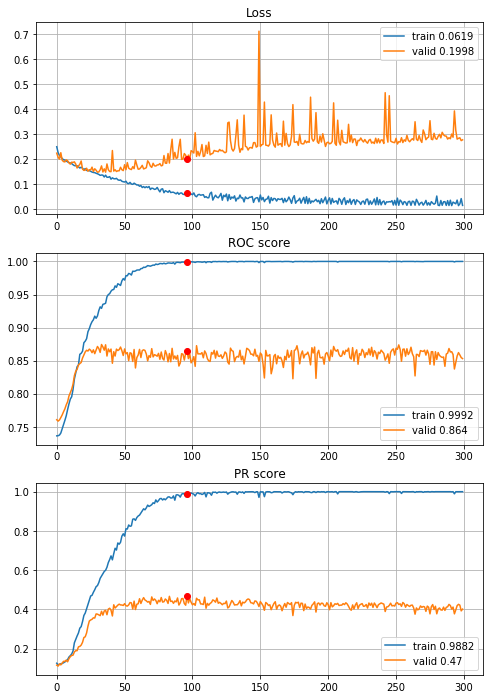


Fold 2------------------------------------------------------------


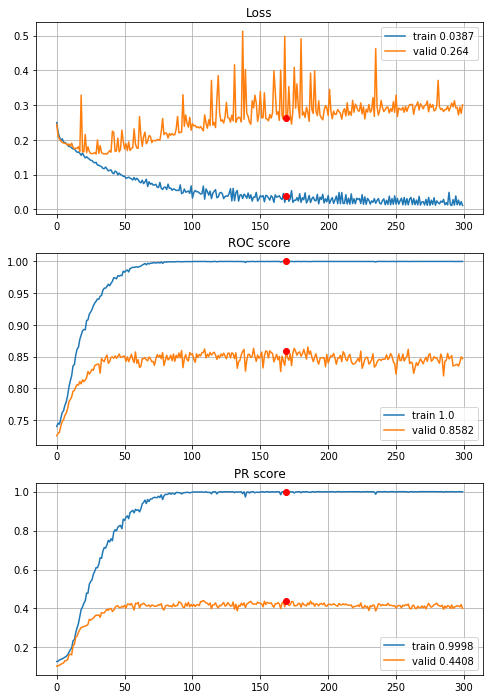


Fold 3------------------------------------------------------------


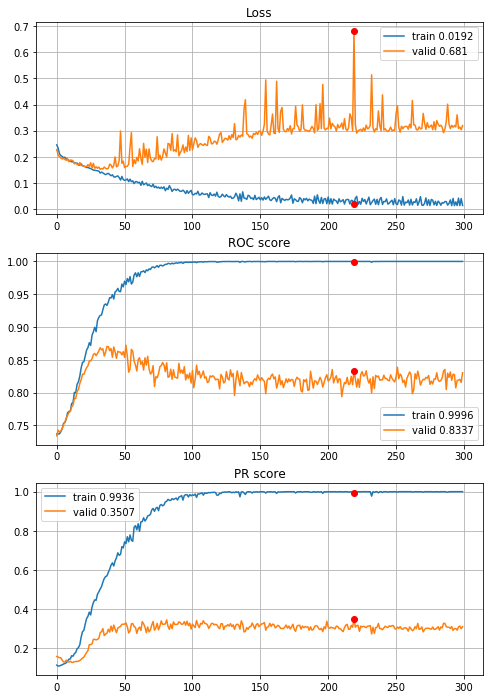


Fold 4------------------------------------------------------------


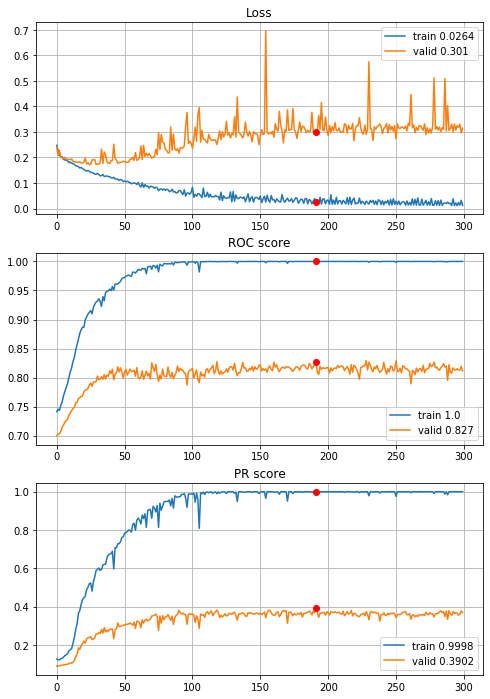


Fold 5------------------------------------------------------------


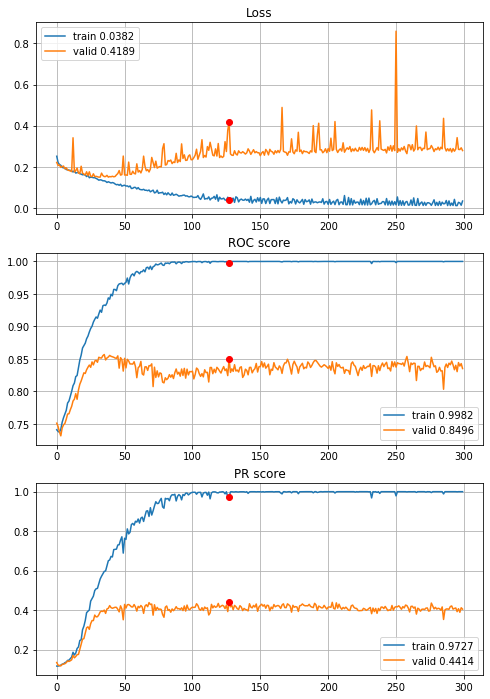


Fold 6------------------------------------------------------------


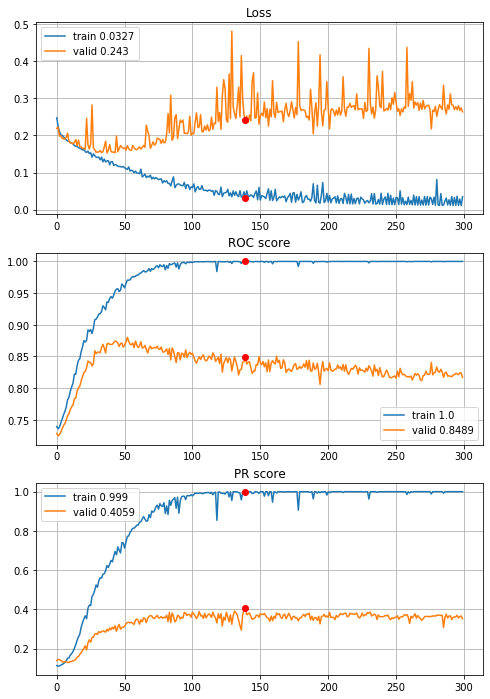

In [90]:
# the best 8x8 model on 20x20 data
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_CNN_L2_20x20_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

The last try will be about the best 8x8 inception model


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 9.23s train loss: 0.2549882449735658, validation loss: 0.2051473930478096
Epoch: 2/300,
cumulative time: 16.62s train loss: 0.20436250618216711, validation loss: 0.19643665105104446
Epoch: 3/300,
cumulative time: 23.62s train loss: 0.19974314203460306, validation loss: 0.1918908804655075
Epoch: 4/300,
cumulative time: 30.61s train loss: 0.1959201862828389, validation loss: 0.18807613477110863
Epoch: 5/300,
cumulative time: 37.31s train loss: 0.19231528877349235, validation loss: 0.1854143589735031
Epoch: 6/300,
cumulative time: 44.03s train loss: 0.1869538208292849, validation loss: 0.18273788318037987
Epoch: 7/300,
cumulative time: 50.79s train loss: 0.18865668121299628, validation loss: 0.18043869733810425
Epoch: 8/300,
cumulative time: 57.57s train loss: 0.18611889981100438, validation loss: 0.18159907311201096
Epoch: 9/300,
cumulative time: 64.32s train loss: 0.1846314456149247, validation loss: 0.177826

Epoch: 76/300,
cumulative time: 520.37s train loss: 0.1413432677432993, validation loss: 0.14958305284380913
Epoch: 77/300,
cumulative time: 527.17s train loss: 0.1409770917410382, validation loss: 0.1756291389465332
Epoch: 78/300,
cumulative time: 533.98s train loss: 0.14596166796584975, validation loss: 0.15097115188837051
Epoch: 79/300,
cumulative time: 540.78s train loss: 0.14124353470658216, validation loss: 0.1518188752233982
Epoch: 80/300,
cumulative time: 547.5s train loss: 0.13921874986158342, validation loss: 0.15046173706650734
Epoch: 81/300,
cumulative time: 554.25s train loss: 0.1375910602926209, validation loss: 0.15196428820490837
Epoch: 82/300,
cumulative time: 560.99s train loss: 0.13694131088293163, validation loss: 0.1511395163834095
Epoch: 83/300,
cumulative time: 567.74s train loss: 0.13635438201034233, validation loss: 0.14935780689120293
Epoch: 84/300,
cumulative time: 574.48s train loss: 0.1372359162768838, validation loss: 0.15044156834483147
Epoch: 85/300,
cum

Epoch: 151/300,
cumulative time: 1050.79s train loss: 0.08420906401886863, validation loss: 0.17452671751379967
Epoch: 152/300,
cumulative time: 1057.58s train loss: 0.08393387905042476, validation loss: 0.1695559099316597
Epoch: 153/300,
cumulative time: 1064.36s train loss: 0.08294624161711195, validation loss: 0.17109502851963043
Epoch: 154/300,
cumulative time: 1071.16s train loss: 0.08475829381070021, validation loss: 0.18468717485666275
Epoch: 155/300,
cumulative time: 1077.96s train loss: 0.08337239620837238, validation loss: 0.1694696545600891
Epoch: 156/300,
cumulative time: 1084.75s train loss: 0.08100180668825423, validation loss: 0.17303844541311264
Epoch: 157/300,
cumulative time: 1091.55s train loss: 0.08119495873707935, validation loss: 0.17187942191958427
Epoch: 158/300,
cumulative time: 1098.47s train loss: 0.08133072277210339, validation loss: 0.1721474789083004
Epoch: 159/300,
cumulative time: 1105.52s train loss: 0.08429758389300201, validation loss: 0.1835695952177

Epoch: 225/300,
cumulative time: 1561.39s train loss: 0.05566563007434562, validation loss: 0.28435229510068893
Epoch: 226/300,
cumulative time: 1568.21s train loss: 0.05385944122375723, validation loss: 0.2716684304177761
Epoch: 227/300,
cumulative time: 1575.44s train loss: 0.05168072006264545, validation loss: 0.26928645372390747
Epoch: 228/300,
cumulative time: 1582.57s train loss: 0.04944233528876165, validation loss: 0.29570525884628296
Epoch: 229/300,
cumulative time: 1589.45s train loss: 0.056148126693948565, validation loss: 0.2727516330778599
Epoch: 230/300,
cumulative time: 1596.38s train loss: 0.057555242928304065, validation loss: 0.26983048766851425
Epoch: 231/300,
cumulative time: 1603.23s train loss: 0.0555053015611782, validation loss: 0.26622922718524933
Epoch: 232/300,
cumulative time: 1610.03s train loss: 0.05142431216926487, validation loss: 0.26587218791246414
Epoch: 233/300,
cumulative time: 1616.85s train loss: 0.046467889300862084, validation loss: 0.3172183074

Epoch: 299/300,
cumulative time: 2069.74s train loss: 0.040389489748128754, validation loss: 0.3734091520309448
Epoch: 300/300,
cumulative time: 2076.58s train loss: 0.04335160533873456, validation loss: 0.3851402811706066

Early stopping results:
best results in epoch: 180, 
best valid PR: 0.4500266944932059, 
valid ROC: 0.8582610573289668        
overfitting PR: 0.49676024318692796, 
overfitting ROC: 0.1379781075763703

----------
Fold: 2
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7876 samples, validate on 1576 samples
Epoch: 1/300,
cumulative time: 9.16s train loss: 0.25731133198135697, validation loss: 0.2115761637687683
Epoch: 2/300,
cumulative time: 16.0s train loss: 0.2048762720655281, validation loss: 0.19819535687565804
Epoch: 3/300,
cumulative time: 22.79s train loss: 0.19935989656110534, validation loss: 0.1939479522407055
Epoch: 4/300,
cumulative time: 29.55s train loss: 0.19694268787274996, validation loss: 0.1894470378756523
Epoch: 5/300,
cumulative time: 36.33s train loss: 0.19062929558097075, validation loss: 0.18590937554836273
Epoch: 6/300,
cumulative time: 43.13s train loss: 0.18603897215812687, validation loss: 0.18338987603783607
Epoch: 7/300,
cumulative time: 49.96s train loss: 0.1861649608138311, validation loss: 0.1822059117257595
Epoch: 8/300,
cumulative time: 57.4s train loss: 0.18448365689716464, validation loss: 0.18168406188488007
Epoch: 9/300,
cumulative time: 64.17s train loss: 0.1849593793440737, validation loss: 0.18486937

Epoch: 76/300,
cumulative time: 523.89s train loss: 0.12937751415418816, validation loss: 0.15607170574367046
Epoch: 77/300,
cumulative time: 530.89s train loss: 0.12661990970221795, validation loss: 0.15380968526005745
Epoch: 78/300,
cumulative time: 538.26s train loss: 0.12610932588652948, validation loss: 0.15790853276848793
Epoch: 79/300,
cumulative time: 545.1s train loss: 0.12569062087690547, validation loss: 0.15326490998268127
Epoch: 80/300,
cumulative time: 551.96s train loss: 0.12589267560518774, validation loss: 0.1552388295531273
Epoch: 81/300,
cumulative time: 558.84s train loss: 0.1236823764892173, validation loss: 0.1572040282189846
Epoch: 82/300,
cumulative time: 565.8s train loss: 0.12378459990993256, validation loss: 0.1542233694344759
Epoch: 83/300,
cumulative time: 572.63s train loss: 0.12167803624170936, validation loss: 0.15497621148824692
Epoch: 84/300,
cumulative time: 579.45s train loss: 0.12009829505256374, validation loss: 0.15339704230427742
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1038.74s train loss: 0.0688345132205482, validation loss: 0.19324525818228722
Epoch: 152/300,
cumulative time: 1045.57s train loss: 0.06943422759026516, validation loss: 0.182907085865736
Epoch: 153/300,
cumulative time: 1052.33s train loss: 0.07014379621407234, validation loss: 0.1890481896698475
Epoch: 154/300,
cumulative time: 1059.06s train loss: 0.06739047931960357, validation loss: 0.20612753927707672
Epoch: 155/300,
cumulative time: 1065.77s train loss: 0.07322404693496173, validation loss: 0.19100725650787354
Epoch: 156/300,
cumulative time: 1072.54s train loss: 0.06801370818994716, validation loss: 0.1852315068244934
Epoch: 157/300,
cumulative time: 1079.44s train loss: 0.0660288355669405, validation loss: 0.1937488056719303
Epoch: 158/300,
cumulative time: 1086.25s train loss: 0.06772353055703877, validation loss: 0.20372623950242996
Epoch: 159/300,
cumulative time: 1093.1s train loss: 0.06622623172510603, validation loss: 0.1937890313565731
E

Epoch: 225/300,
cumulative time: 1546.2s train loss: 0.04356445802811774, validation loss: 0.2621460296213627
Epoch: 226/300,
cumulative time: 1553.06s train loss: 0.043114577728920085, validation loss: 0.27645621076226234
Epoch: 227/300,
cumulative time: 1559.89s train loss: 0.04241747153689257, validation loss: 0.27562402188777924
Epoch: 228/300,
cumulative time: 1566.71s train loss: 0.043398816003230034, validation loss: 0.28450583666563034
Epoch: 229/300,
cumulative time: 1573.49s train loss: 0.042488208290808176, validation loss: 0.29827050492167473
Epoch: 230/300,
cumulative time: 1580.28s train loss: 0.04220019689245067, validation loss: 0.2716883569955826
Epoch: 231/300,
cumulative time: 1587.14s train loss: 0.04652632156802259, validation loss: 0.2619553655385971
Epoch: 232/300,
cumulative time: 1593.97s train loss: 0.04637525850976025, validation loss: 0.2786039710044861
Epoch: 233/300,
cumulative time: 1600.79s train loss: 0.042163909569008055, validation loss: 0.28106721490

Epoch: 299/300,
cumulative time: 2074.98s train loss: 0.03665914849854472, validation loss: 0.34854329377412796
Epoch: 300/300,
cumulative time: 2082.02s train loss: 0.03582322546893446, validation loss: 0.37684667110443115

Early stopping results:
best results in epoch: 155, 
best valid PR: 0.3981064662090823, 
valid ROC: 0.8579968909615812        
overfitting PR: 0.5389714395935938, 
overfitting ROC: 0.13570760490118816

----------
Fold: 3
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 9.38s train loss: 0.25925436198438984, validation loss: 0.21288605158291166
Epoch: 2/300,
cumulative time: 16.33s train loss: 0.2066801975160682, validation loss: 0.19848061208687132
Epoch: 3/300,
cumulative time: 23.23s train loss: 0.1987473247271285, validation loss: 0.19429255345511057
Epoch: 4/300,
cumulative time: 30.16s train loss: 0.1950712561157129, validation loss: 0.19011839039742
Epoch: 5/300,
cumulative time: 37.1s train loss: 0.18983911453043126, validation loss: 0.1859268491608756
Epoch: 6/300,
cumulative time: 44.0s train loss: 0.1885013360200504, validation loss: 0.1892987545331319
Epoch: 7/300,
cumulative time: 50.91s train loss: 0.1888754494271636, validation loss: 0.18231958461186243
Epoch: 8/300,
cumulative time: 57.89s train loss: 0.1867700049428297, validation loss: 0.1851808245976766
Epoch: 9/300,
cumulative time: 64.93s train loss: 0.18422209996892305, validation loss: 0.1835891290978

Epoch: 76/300,
cumulative time: 532.06s train loss: 0.13594666074772724, validation loss: 0.1490499806782556
Epoch: 77/300,
cumulative time: 539.04s train loss: 0.13285340023506895, validation loss: 0.1480030395871117
Epoch: 78/300,
cumulative time: 546.0s train loss: 0.1293739703035421, validation loss: 0.14854532294803197
Epoch: 79/300,
cumulative time: 552.97s train loss: 0.13075697891744273, validation loss: 0.1488020229055768
Epoch: 80/300,
cumulative time: 559.84s train loss: 0.1274497679040882, validation loss: 0.1527596818643903
Epoch: 81/300,
cumulative time: 567.32s train loss: 0.12741336898405994, validation loss: 0.15416784834294092
Epoch: 82/300,
cumulative time: 574.39s train loss: 0.12418372232182703, validation loss: 0.14805837874374692
Epoch: 83/300,
cumulative time: 581.31s train loss: 0.1217531067116681, validation loss: 0.14611712957185413
Epoch: 84/300,
cumulative time: 588.25s train loss: 0.12456112008901724, validation loss: 0.14911890340229822
Epoch: 85/300,
cum

Epoch: 151/300,
cumulative time: 1054.6s train loss: 0.06699629604695366, validation loss: 0.19175648736575293
Epoch: 152/300,
cumulative time: 1061.5s train loss: 0.06403271749216514, validation loss: 0.18996566075181204
Epoch: 153/300,
cumulative time: 1068.38s train loss: 0.06284724579814487, validation loss: 0.19951839833978624
Epoch: 154/300,
cumulative time: 1075.21s train loss: 0.06582630729030592, validation loss: 0.2027809607888025
Epoch: 155/300,
cumulative time: 1082.08s train loss: 0.06566777777873094, validation loss: 0.18150810378884513
Epoch: 156/300,
cumulative time: 1088.96s train loss: 0.0640339628013315, validation loss: 0.18490051335758634
Epoch: 157/300,
cumulative time: 1095.91s train loss: 0.06767956777069643, validation loss: 0.1943227890559605
Epoch: 158/300,
cumulative time: 1102.79s train loss: 0.06253265902367858, validation loss: 0.18738722774717542
Epoch: 159/300,
cumulative time: 1109.68s train loss: 0.06063331466206473, validation loss: 0.190535467834699

Epoch: 225/300,
cumulative time: 1567.83s train loss: 0.043346784379906925, validation loss: 0.3353949895548442
Epoch: 226/300,
cumulative time: 1574.73s train loss: 0.04087551014082405, validation loss: 0.30713706794239226
Epoch: 227/300,
cumulative time: 1581.73s train loss: 0.03931464365475051, validation loss: 0.3275482323056176
Epoch: 228/300,
cumulative time: 1588.62s train loss: 0.04146570107399835, validation loss: 0.29360458843291753
Epoch: 229/300,
cumulative time: 1595.52s train loss: 0.039622705993528094, validation loss: 0.3013213784921737
Epoch: 230/300,
cumulative time: 1602.48s train loss: 0.04145097752454409, validation loss: 0.3127528557512495
Epoch: 231/300,
cumulative time: 1609.47s train loss: 0.04154668513142065, validation loss: 0.3100283636365618
Epoch: 232/300,
cumulative time: 1616.3s train loss: 0.03913905004589664, validation loss: 0.3274381499252622
Epoch: 233/300,
cumulative time: 1623.24s train loss: 0.03607321909352261, validation loss: 0.327122965899724

Epoch: 299/300,
cumulative time: 2081.24s train loss: 0.04264404421339517, validation loss: 0.39988025661498783
Epoch: 300/300,
cumulative time: 2088.15s train loss: 0.04038540970439972, validation loss: 0.3602047933094085

Early stopping results:
best results in epoch: 110, 
best valid PR: 0.3914985067215058, 
valid ROC: 0.8592469884941571        
overfitting PR: 0.41304152471990313, 
overfitting ROC: 0.11823912683639959

----------
Fold: 4
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 9.5s train loss: 0.2549833711257997, validation loss: 0.2126894353684925
Epoch: 2/300,
cumulative time: 16.46s train loss: 0.2083461735569252, validation loss: 0.19911124567190805
Epoch: 3/300,
cumulative time: 23.45s train loss: 0.19915223779965283, validation loss: 0.1951218417144957
Epoch: 4/300,
cumulative time: 30.4s train loss: 0.19327516781356077, validation loss: 0.19174534012400915
Epoch: 5/300,
cumulative time: 37.41s train loss: 0.18921570610966768, validation loss: 0.1891394691807883
Epoch: 6/300,
cumulative time: 44.35s train loss: 0.18572943769532502, validation loss: 0.18925891119336324
Epoch: 7/300,
cumulative time: 51.34s train loss: 0.18686125394095468, validation loss: 0.18913007635918874
Epoch: 8/300,
cumulative time: 58.25s train loss: 0.1849058244726872, validation loss: 0.18738791947326963
Epoch: 9/300,
cumulative time: 65.16s train loss: 0.18278261168067855, validation loss: 0.1874612

Epoch: 76/300,
cumulative time: 550.37s train loss: 0.11636791657006149, validation loss: 0.18557867271559578
Epoch: 77/300,
cumulative time: 557.7s train loss: 0.11812164105254562, validation loss: 0.190096849250415
Epoch: 78/300,
cumulative time: 565.04s train loss: 0.11473956769971931, validation loss: 0.17640742503461385
Epoch: 79/300,
cumulative time: 572.2s train loss: 0.11558576174136177, validation loss: 0.17721492353885893
Epoch: 80/300,
cumulative time: 579.36s train loss: 0.1117953864520117, validation loss: 0.17325037205030047
Epoch: 81/300,
cumulative time: 586.43s train loss: 0.11332760222792489, validation loss: 0.18094586602279117
Epoch: 82/300,
cumulative time: 593.63s train loss: 0.10874535345506801, validation loss: 0.17784177671349238
Epoch: 83/300,
cumulative time: 601.32s train loss: 0.10910384442292602, validation loss: 0.17393390693361796
Epoch: 84/300,
cumulative time: 608.61s train loss: 0.1071723799339569, validation loss: 0.18331175900640942
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 1101.63s train loss: 0.06222884099179981, validation loss: 0.2611347815725538
Epoch: 152/300,
cumulative time: 1109.3s train loss: 0.0637636773947518, validation loss: 0.24413636888776508
Epoch: 153/300,
cumulative time: 1116.71s train loss: 0.0592914920225049, validation loss: 0.23609687316985356
Epoch: 154/300,
cumulative time: 1124.45s train loss: 0.058910401806403674, validation loss: 0.2480922826698848
Epoch: 155/300,
cumulative time: 1132.18s train loss: 0.060326863221669996, validation loss: 0.2570067809309278
Epoch: 156/300,
cumulative time: 1139.85s train loss: 0.05935543312273671, validation loss: 0.2609721818045964
Epoch: 157/300,
cumulative time: 1147.61s train loss: 0.06045319459186951, validation loss: 0.23311695891713338
Epoch: 158/300,
cumulative time: 1155.78s train loss: 0.06092894372883917, validation loss: 0.27264743975230626
Epoch: 159/300,
cumulative time: 1163.43s train loss: 0.06005697856968515, validation loss: 0.249180204830472

Epoch: 225/300,
cumulative time: 1654.71s train loss: 0.04251706295147665, validation loss: 0.3181201096186562
Epoch: 226/300,
cumulative time: 1661.72s train loss: 0.040258956703495614, validation loss: 0.3823962323627775
Epoch: 227/300,
cumulative time: 1668.68s train loss: 0.039982537329537444, validation loss: 0.3640287897700355
Epoch: 228/300,
cumulative time: 1675.61s train loss: 0.040201363815270175, validation loss: 0.35673196283597797
Epoch: 229/300,
cumulative time: 1682.61s train loss: 0.04098067534464377, validation loss: 0.3572394784480806
Epoch: 230/300,
cumulative time: 1689.56s train loss: 0.04013988844576456, validation loss: 0.3531854198660169
Epoch: 231/300,
cumulative time: 1696.58s train loss: 0.038152822760953296, validation loss: 0.3562572551530505
Epoch: 232/300,
cumulative time: 1703.6s train loss: 0.039091282220427515, validation loss: 0.3655488446023729
Epoch: 233/300,
cumulative time: 1710.55s train loss: 0.044345797475494074, validation loss: 0.327429431885

Epoch: 299/300,
cumulative time: 2184.84s train loss: 0.0330558388728175, validation loss: 0.4526982715583983
Epoch: 300/300,
cumulative time: 2191.81s train loss: 0.03161767654341309, validation loss: 0.4528958030352517

Early stopping results:
best results in epoch: 139, 
best valid PR: 0.3801957583408678, 
valid ROC: 0.8131380881214325        
overfitting PR: 0.570116227494045, 
overfitting ROC: 0.18359659960008845

----------
Fold: 5
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 10.14s train loss: 0.2528044983292498, validation loss: 0.2118433958386618
Epoch: 2/300,
cumulative time: 17.12s train loss: 0.2050141884588387, validation loss: 0.19858882719562168
Epoch: 3/300,
cumulative time: 24.18s train loss: 0.20063449479086198, validation loss: 0.19408256058655088
Epoch: 4/300,
cumulative time: 31.3s train loss: 0.1935735545750725, validation loss: 0.1888736515196543
Epoch: 5/300,
cumulative time: 38.31s train loss: 0.1912613011630822, validation loss: 0.18354672823633467
Epoch: 6/300,
cumulative time: 45.44s train loss: 0.1861348640851386, validation loss: 0.18098259587136525
Epoch: 7/300,
cumulative time: 52.54s train loss: 0.18631019922921815, validation loss: 0.1797481233070767
Epoch: 8/300,
cumulative time: 59.62s train loss: 0.1844830873223811, validation loss: 0.18032047554614053
Epoch: 9/300,
cumulative time: 66.92s train loss: 0.1827921408871883, validation loss: 0.178727935

Epoch: 76/300,
cumulative time: 548.22s train loss: 0.12834562313663364, validation loss: 0.17015704139830573
Epoch: 77/300,
cumulative time: 555.34s train loss: 0.12990991153760323, validation loss: 0.1707308658342513
Epoch: 78/300,
cumulative time: 562.33s train loss: 0.1312110050784402, validation loss: 0.1744921279237384
Epoch: 79/300,
cumulative time: 569.69s train loss: 0.12790384094878868, validation loss: 0.16946044352319506
Epoch: 80/300,
cumulative time: 577.79s train loss: 0.12868445624558472, validation loss: 0.16896120748822652
Epoch: 81/300,
cumulative time: 585.48s train loss: 0.1265866646737757, validation loss: 0.1694639013305543
Epoch: 82/300,
cumulative time: 593.07s train loss: 0.12450644313925881, validation loss: 0.1710895929166249
Epoch: 83/300,
cumulative time: 600.5s train loss: 0.12400101385542443, validation loss: 0.17018529857907977
Epoch: 84/300,
cumulative time: 607.55s train loss: 0.12204462242233158, validation loss: 0.1723525567660256
Epoch: 85/300,
cum

Epoch: 151/300,
cumulative time: 1104.15s train loss: 0.06598415480938692, validation loss: 0.23159625859487623
Epoch: 152/300,
cumulative time: 1111.43s train loss: 0.06519093926226531, validation loss: 0.24463866672818624
Epoch: 153/300,
cumulative time: 1118.67s train loss: 0.06437707387059416, validation loss: 0.22837592533656528
Epoch: 154/300,
cumulative time: 1126.23s train loss: 0.06304681865041807, validation loss: 0.24549863652577475
Epoch: 155/300,
cumulative time: 1135.31s train loss: 0.06273559791480389, validation loss: 0.24593492294114733
Epoch: 156/300,
cumulative time: 1143.09s train loss: 0.06075414219937138, validation loss: 0.26674268622247
Epoch: 157/300,
cumulative time: 1150.8s train loss: 0.06065485753583412, validation loss: 0.2608939318429856
Epoch: 158/300,
cumulative time: 1159.6s train loss: 0.06385006210204534, validation loss: 0.2330219312887343
Epoch: 159/300,
cumulative time: 1168.05s train loss: 0.06370476903071089, validation loss: 0.244721802435224
E

Epoch: 225/300,
cumulative time: 1675.01s train loss: 0.0382360047136404, validation loss: 0.3785437600764017
Epoch: 226/300,
cumulative time: 1683.4s train loss: 0.03864415270302734, validation loss: 0.3819996924248953
Epoch: 227/300,
cumulative time: 1691.46s train loss: 0.03627262729335606, validation loss: 0.3729941306984614
Epoch: 228/300,
cumulative time: 1699.64s train loss: 0.038067806598191124, validation loss: 0.3668751822009919
Epoch: 229/300,
cumulative time: 1707.02s train loss: 0.03730049801540394, validation loss: 0.37001963761117723
Epoch: 230/300,
cumulative time: 1714.49s train loss: 0.035870126526250865, validation loss: 0.37980655049520823
Epoch: 231/300,
cumulative time: 1722.13s train loss: 0.03442856943537714, validation loss: 0.37960843264110505
Epoch: 232/300,
cumulative time: 1729.62s train loss: 0.03599651502529286, validation loss: 0.39469697045901464
Epoch: 233/300,
cumulative time: 1737.24s train loss: 0.035395933979864694, validation loss: 0.3951291735020

Epoch: 299/300,
cumulative time: 2214.17s train loss: 0.02868123745723804, validation loss: 0.4964289911588033
Epoch: 300/300,
cumulative time: 2221.38s train loss: 0.030691305648592716, validation loss: 0.48555672221713597

Early stopping results:
best results in epoch: 133, 
best valid PR: 0.41212326939259664, 
valid ROC: 0.7931514125717989        
overfitting PR: 0.454323836797151, 
overfitting ROC: 0.19452744703593272

----------
Fold: 6
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7877 samples, validate on 1575 samples
Epoch: 1/300,
cumulative time: 10.16s train loss: 0.2540216773778666, validation loss: 0.20944460004095047
Epoch: 2/300,
cumulative time: 17.44s train loss: 0.20647975844796332, validation loss: 0.19667019949072884
Epoch: 3/300,
cumulative time: 24.71s train loss: 0.19941817738387252, validation loss: 0.19333504963488807
Epoch: 4/300,
cumulative time: 31.95s train loss: 0.19370345510821424, validation loss: 0.19061523666457525
Epoch: 5/300,
cumulative time: 39.53s train loss: 0.19080920228955708, validation loss: 0.18613254110018412
Epoch: 6/300,
cumulative time: 47.1s train loss: 0.18839940217616702, validation loss: 0.1835228010775551
Epoch: 7/300,
cumulative time: 54.48s train loss: 0.18898329570070355, validation loss: 0.183436541557312
Epoch: 8/300,
cumulative time: 61.63s train loss: 0.18496479576419753, validation loss: 0.18178287315936315
Epoch: 9/300,
cumulative time: 68.88s train loss: 0.18469170684043837, validation loss: 0.186

Epoch: 76/300,
cumulative time: 557.38s train loss: 0.1417108608072325, validation loss: 0.16315124953550006
Epoch: 77/300,
cumulative time: 564.56s train loss: 0.13857313743154606, validation loss: 0.16481770722638994
Epoch: 78/300,
cumulative time: 571.7s train loss: 0.1375930019179864, validation loss: 0.15836683060441697
Epoch: 79/300,
cumulative time: 578.9s train loss: 0.13595495834687465, validation loss: 0.15726124332064673
Epoch: 80/300,
cumulative time: 586.04s train loss: 0.13516697916938247, validation loss: 0.1570551953334657
Epoch: 81/300,
cumulative time: 593.11s train loss: 0.13369295029784273, validation loss: 0.15579052937409235
Epoch: 82/300,
cumulative time: 600.16s train loss: 0.1331592735522166, validation loss: 0.1583517077044835
Epoch: 83/300,
cumulative time: 607.33s train loss: 0.13457240531464829, validation loss: 0.15846544455914272
Epoch: 84/300,
cumulative time: 614.51s train loss: 0.13073859427829404, validation loss: 0.17017537716835265
Epoch: 85/300,
cu

Epoch: 151/300,
cumulative time: 1099.49s train loss: 0.0804974890482052, validation loss: 0.18350627083627005
Epoch: 152/300,
cumulative time: 1106.66s train loss: 0.08079558751660887, validation loss: 0.19056858530120244
Epoch: 153/300,
cumulative time: 1113.81s train loss: 0.07639980953107771, validation loss: 0.1889439332295978
Epoch: 154/300,
cumulative time: 1120.95s train loss: 0.07671226039613975, validation loss: 0.18973848447913216
Epoch: 155/300,
cumulative time: 1128.18s train loss: 0.07738028879950036, validation loss: 0.1964324516909463
Epoch: 156/300,
cumulative time: 1136.05s train loss: 0.07864079155974678, validation loss: 0.21667854845523835
Epoch: 157/300,
cumulative time: 1143.25s train loss: 0.0791589020519325, validation loss: 0.1960579724728115
Epoch: 158/300,
cumulative time: 1150.42s train loss: 0.07504692953091763, validation loss: 0.2062440124012175
Epoch: 159/300,
cumulative time: 1157.43s train loss: 0.0757544469762245, validation loss: 0.19289936424247803

Epoch: 225/300,
cumulative time: 1641.35s train loss: 0.057103223972882325, validation loss: 0.273924070085798
Epoch: 226/300,
cumulative time: 1648.37s train loss: 0.053659666006609284, validation loss: 0.30209825144873725
Epoch: 227/300,
cumulative time: 1655.42s train loss: 0.05163672208782227, validation loss: 0.28122839638165065
Epoch: 228/300,
cumulative time: 1662.59s train loss: 0.05008117915934546, validation loss: 0.29513447795595443
Epoch: 229/300,
cumulative time: 1669.93s train loss: 0.05192886043084111, validation loss: 0.29555475681547133
Epoch: 230/300,
cumulative time: 1677.29s train loss: 0.050384362187897234, validation loss: 0.26762659848682463
Epoch: 231/300,
cumulative time: 1684.85s train loss: 0.04990182003538152, validation loss: 0.3214090109249902
Epoch: 232/300,
cumulative time: 1692.24s train loss: 0.053533130184797766, validation loss: 0.3020113091052525
Epoch: 233/300,
cumulative time: 1699.32s train loss: 0.0476712702742889, validation loss: 0.30001714876

Epoch: 299/300,
cumulative time: 2176.09s train loss: 0.03413358800443308, validation loss: 0.47163262208302814
Epoch: 300/300,
cumulative time: 2183.17s train loss: 0.03087841542346633, validation loss: 0.4997113409496489

Early stopping results:
best results in epoch: 134, 
best valid PR: 0.372423006686787, 
valid ROC: 0.839512397140645        
overfitting PR: 0.4609667388247533, 
overfitting ROC: 0.1425867393632696

Cross validation time: 13116s
ROC: 		0.8368844724364303
PR: 		0.40072895030734085
overfittingROC: 0.15210593755220814
overfittingPR:  0.48903000176939576
early stopping: [180, 155, 110, 139, 133, 134]

Fold 1------------------------------------------------------------


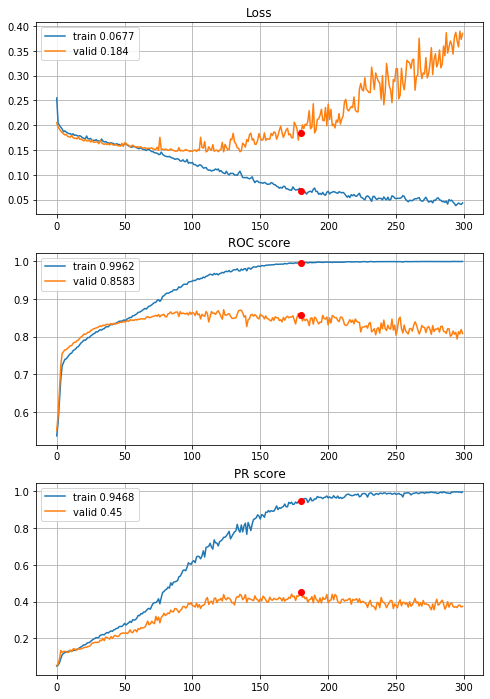


Fold 2------------------------------------------------------------


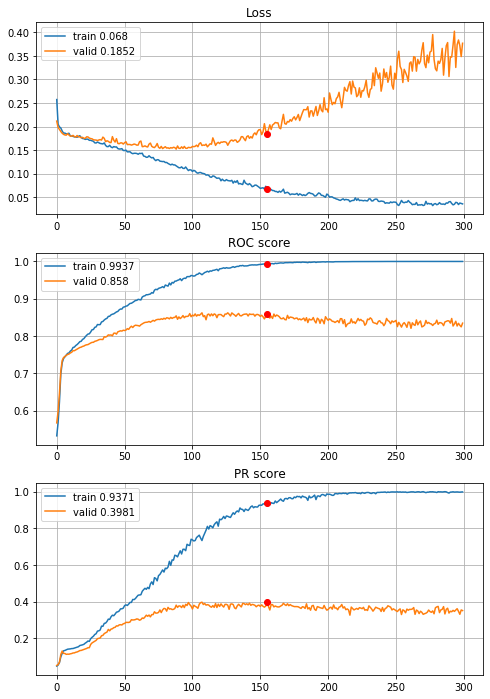


Fold 3------------------------------------------------------------


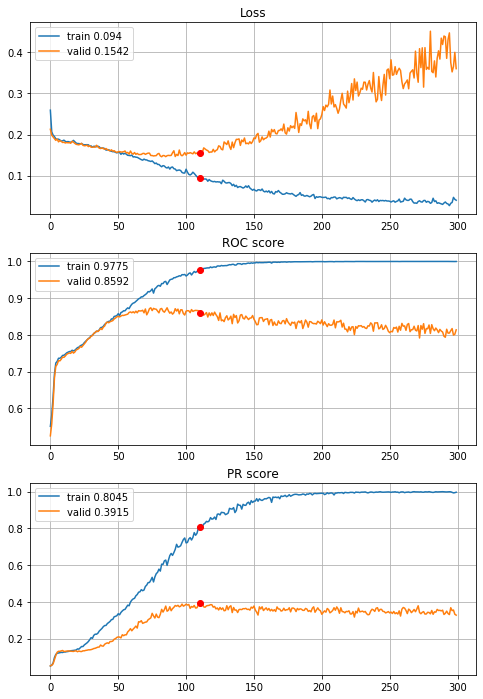


Fold 4------------------------------------------------------------


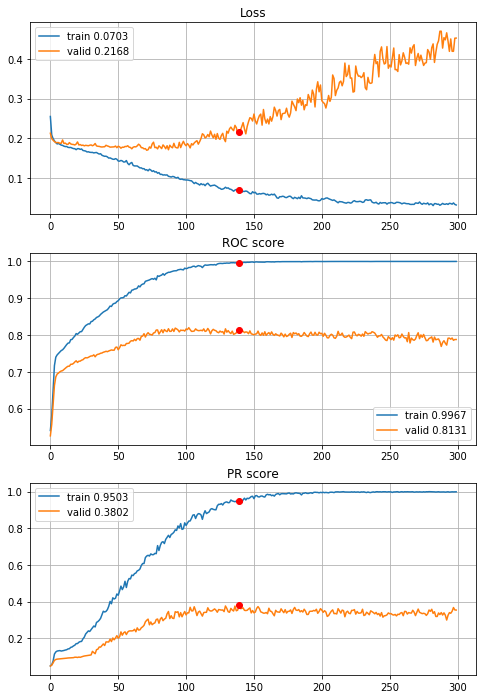


Fold 5------------------------------------------------------------


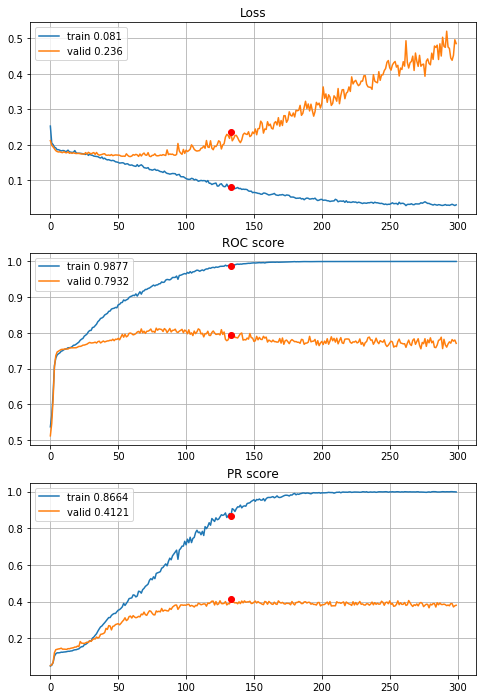


Fold 6------------------------------------------------------------


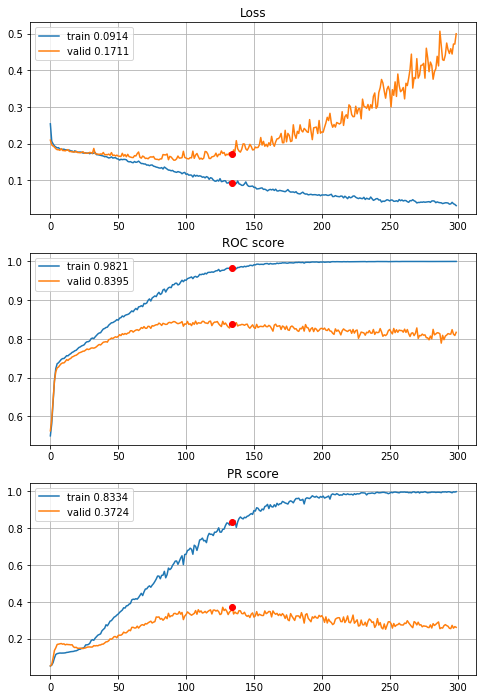

In [64]:
# the best 8x8 model for 2 year horizon on 20x20 data 3 year horizon
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04,
                                        features=features,target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\3year\define_deep_CNN_2inc_std_L2_drop_04_20x20_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Standard convolutional archutecture achived higher AUC-PR, and slightly higher AUC-ROC, but much bigger overfitting also. Lets check wilcoxon tests.

##### End

In [54]:
# LOADING 8x8 CNN
with open(r"results\3year\define_CNN_L2_300ep.p", "rb") as fp:
    CNN_8x8_CV = pickle.load(fp)
# LOADING 20x20 CNN
with open(r"results\3year\define_CNN_L2_20x20_300ep.p", "rb") as fp:
    CNN_20x20_CV = pickle.load(fp)

# LOADING 20x20 CNN (inception) 
with open(r"results\3year\define_deep_CNN_2inc_std_L2_drop_04_20x20_300ep.p", "rb") as fp:
    CNN_20x20_inc_CV = pickle.load(fp)
    
# LOADING MLP
with open(r"results\3year\MLP_standard_5000ep.p", "rb") as fp:
    MLP_CV = pickle.load(fp)

# TRAINING XGB
XGB_CV = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                  normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                  max_depth=5, learning_rate=0.07, subsample=1, colsample_bytree=0.9, gamma=0.08, 
                                  reg_alpha=1, reg_lambda=0, saveModels=False)
# TRAINING RF
RF_CV = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                normalize=False, q=None, saveModels=False, max_depth=13, n_estimators=200,
                                max_features=54, min_samples_split=8, min_samples_leaf=6)
# TRAINING LOGIT
logit_CV = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                      normalize="power", q=0.005, alpha="none", info=0)


Cross validation time: 43s

Cross validation time: 303s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 32s


 - CV results extraction

In [55]:
# 8x8 CNN
CNN_8x8_roc_valid, CNN_8x8_pr_valid, CNN_8x8_roc_train, CNN_8x8_pr_train, CNN_8x8_es=network_CV_results(network_history=CNN_8x8_CV,mean=False)
# 20x20 CNN
CNN_20x20_roc_valid, CNN_20x20_pr_valid, CNN_20x20_roc_train, CNN_20x20_pr_train, CNN_20x20_es = network_CV_results(network_history=CNN_20x20_CV,mean=False)
# 20x20 CNN (inception)
CNN_20x20_inc_roc_valid, CNN_20x20_inc_pr_valid, CNN_20x20_inc_roc_train, CNN_20x20_inc_pr_train, CNN_20x20_inc_es = network_CV_results(network_history=CNN_20x20_inc_CV,mean=False)
# MLP
MLP_roc_valid, MLP_pr_valid, MLP_roc_train, MLP_pr_train, MLP_es = network_CV_results(network_history=MLP_CV,mean=False)
# XGB
XGB_roc_valid, XGB_pr_valid, XGB_roc_train, XGB_pr_train, XGB_es = XGB_CV_results(XGB_history=XGB_CV,mean=False)

# RF
RF_roc_valid = RF_CV["valid_roc"]
RF_pr_valid = RF_CV["valid_pr"]
RF_roc_train = RF_CV["train_roc"]
RF_pr_train = RF_CV["train_pr"]

# logit
logit_roc_valid = logit_CV["valid_roc"]
logit_pr_valid = logit_CV["valid_pr"]
logit_roc_train = logit_CV["train_roc"]
logit_pr_train = logit_CV["train_pr"]

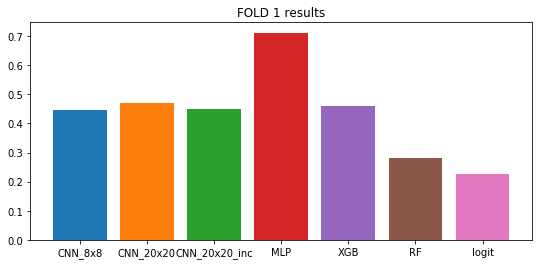

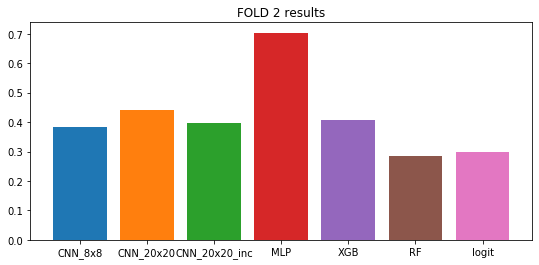

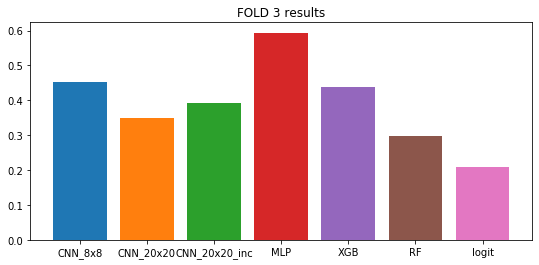

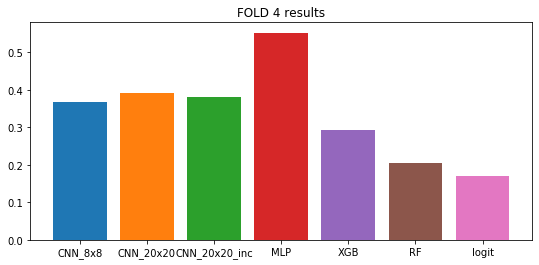

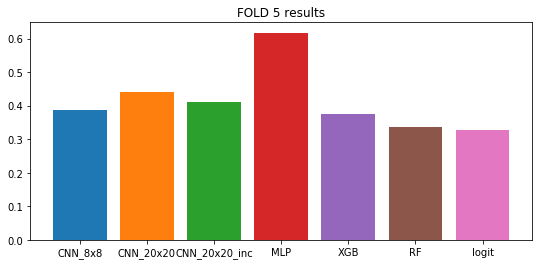

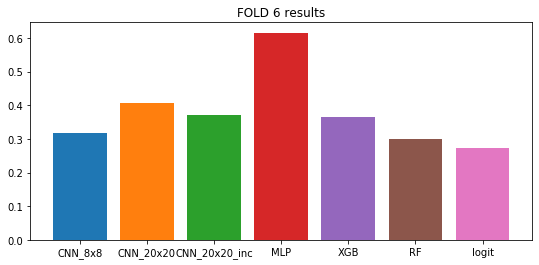

CNN_8x8 mean: 0.3924264125448956
CNN_20x20 mean: 0.4165007980249518
CNN_20x20_inc mean: 0.40072895030734085
MLP mean: 0.6321566132260862
XGB mean: 0.39009983333333337
RF mean: 0.28393844643928223
Logit mean: 0.25065322052303907


In [56]:
for i in range(len(sets["training_sets"])):
    fig, ax = plt.subplots(figsize=(9,4))
    plt.bar(x="CNN_8x8", height=CNN_8x8_pr_valid[i])
    plt.bar(x="CNN_20x20", height=CNN_20x20_pr_valid[i])
    plt.bar(x="CNN_20x20_inc", height=CNN_20x20_inc_pr_valid[i])
    plt.bar(x="MLP", height=MLP_pr_valid[i])
    plt.bar(x="XGB", height=XGB_pr_valid[i])
    plt.bar(x="RF", height=RF_pr_valid[i])
    plt.bar(x="logit", height=logit_pr_valid[i])
    plt.title("FOLD {} results".format(i+1))
    plt.show()

print("CNN_8x8 mean: {}\nCNN_20x20 mean: {}\nCNN_20x20_inc mean: {}\nMLP mean: {}\nXGB mean: {}\nRF mean: {}\nLogit mean: {}".format(
np.mean(CNN_8x8_pr_valid), np.mean(CNN_20x20_pr_valid), np.mean(CNN_20x20_inc_pr_valid), np.mean(MLP_pr_valid), np.mean(XGB_pr_valid), np.mean(RF_pr_valid),
np.mean(logit_pr_valid)))

 - wilcoxon median equality test

In [57]:
CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid = wilcoxon(
    x=np.array(CNN_20x20_pr_valid), y=np.array(CNN_8x8_pr_valid), alternative="greater")[1]
print("Wilcoxon tests p values, H0: median(A)==median(B)")
print("HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid):", CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid)


Wilcoxon tests p values, H0: median(A)==median(B)
HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid): 0.17272376523461286


C:\Users\maciej\anaconda3\lib\site-packages\scipy\stats\morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


Conclusions: 
 - no statistical difference in cross validation results for CNN before and after feature generation
 
 
##### "Production" models training
 - data normalization (CNNs excluded)

In [58]:
# loading imputed data
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# ----- Scaling: clipping, power transform and normalization -----
# scaler fitting
Scaler_norm_clip_pt=scaler(images=False)
Scaler_norm_clip_pt.fit(X=train_set_imp[features], q=0.005, power_transform=True)

# sets computing
X_train_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=train_set_imp[features]), columns=features)
X_test_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_clip_pt=train_set_imp[target].copy()
Y_test_norm_clip_pt=test_set_imp[target].copy()

# ----- Scaling: quantile clipping and normalization -----
# scaler fitting
Scaler_clip_norm=scaler(images=False)
Scaler_clip_norm.fit(X=train_set_imp[features], q=0.005, power_transform=False)

# sets computing
X_train_clip_norm=pd.DataFrame(Scaler_clip_norm.transform(X=train_set_imp[features]), columns=features)
X_test_clip_norm=pd.DataFrame(Scaler_clip_norm.transform(X=test_set_imp[features]), columns=features)
Y_train_clip_norm=train_set_imp[target].copy()
Y_test_clip_norm=test_set_imp[target].copy()

# ----- Raw data for RF -----
X_train_raw = train_test_imp_sets["train_set_imp"][features].copy()
X_test_raw = train_test_imp_sets["test_set_imp"][features].copy()
Y_train_raw = train_test_imp_sets["train_set_imp"][target].copy()
Y_test_raw = train_test_imp_sets["test_set_imp"][target].copy()

 - models fitting (Neural networks excluded)

In [59]:
# Logistic Regression
Logit_formula = "{}~{}".format(target, "+".join(features))
Logit = smf.logit(formula=Logit_formula, data=pd.concat((X_train_norm_clip_pt,Y_train_norm_clip_pt), axis=1))
Logit = Logit.fit(method="powell", maxiter=1000, disp=True)

# Random Forest
Random_Forest = RandomForestClassifier(n_estimators=200, criterion="gini", max_depth=13, min_samples_split=8,
                                      min_samples_leaf=6, max_features=54, random_state=random_state) 
Random_Forest.fit(X=X_train_raw, y=Y_train_raw)

# Extreme Gradient Boosted Decision Trees
XGBoost, XGBoost_history = XGB_training(X_train=X_train_clip_norm,
                                        Y_train=Y_train_clip_norm,
                                        X_valid=None, Y_valid=None, booster="gbtree", tree_method="auto",
                                        n_estimators=209, early_stopping_rounds=209, max_depth=5, learning_rate=0.07,
                                        subsample=1, colsample_bytree=0.9, colsample_bylevel=1,
                                        gamma=0.08, min_child_weight=0, reg_alpha=1, reg_lambda=0,
                                        random_state=random_state, info=0)

Optimization terminated successfully.
         Current function value: 0.157666
         Iterations: 27
         Function evaluations: 17627


 - XGBoost training plots

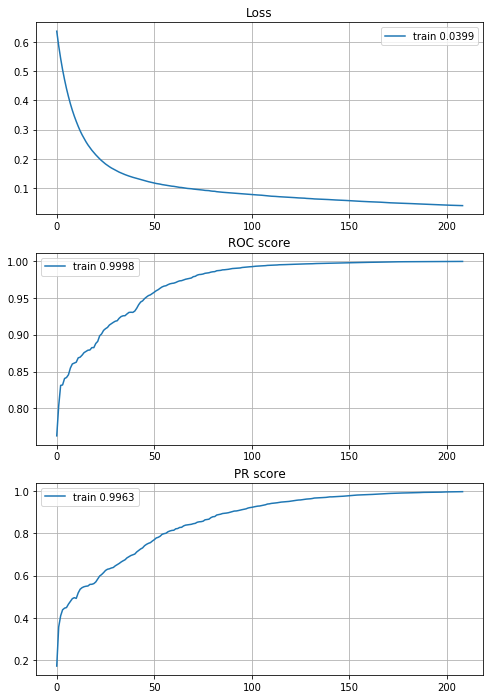

In [70]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(XGBoost_history["train_logloss"], "-", label="train {}".format(round(XGBoost_history["train_logloss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(XGBoost_history["train_auc"], label="train {}".format(round(XGBoost_history["train_auc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(XGBoost_history["train_aucpr"], label="train {}".format(round(XGBoost_history["train_aucpr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - Multilayer Percepton (Feedforward neural network)

In [80]:
# Multilayer Percepton
Multilayer_Percepton = define_MLP(input_shape=X_train.iloc[0].shape, n_layers=2, n_units=[60,60],
                                  acti=[activations.tanh, activations.sigmoid], drop=[0.4,0.4],
                                  regu=[None,None], opti=optimizers.Adam(),
                                  random_state=random_state)

Multilayer_Percepton, MLP_history = network_training(network=Multilayer_Percepton,
                                                     X_train=X_train_norm_clip_pt.values,
                                                     Y_train=Y_train_norm_clip_pt.values, 
                                                     n_epochs=4892, batch_size=394, random_state=random_state, info=None)
# # SAVING MLP
# with open(r"results\3year\MLP_production.p", "wb") as fp:
#     pickle.dump(dict(zip(["model", "history", "model_weights"], [Multilayer_Percepton, MLP_history,
#                                                                  Multilayer_Percepton.get_weights()])), fp)

In [60]:
# LOADING MLP
with open(r"results\3year\MLP_production.p", "rb") as fp:
    MLP_dict = pickle.load(fp)

Multilayer_Percepton = MLP_dict["model"]
MLP_history = MLP_dict["history"]   

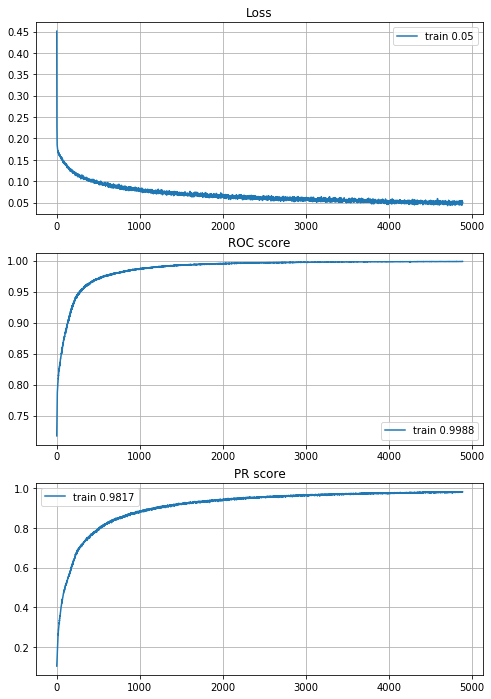

In [72]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(MLP_history["train_loss"], "-", label="train {}".format(round(MLP_history["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(MLP_history["train_roc"], label="train {}".format(round(MLP_history["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(MLP_history["train_pr"], label="train {}".format(round(MLP_history["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 8x8 input Convolutional Neural Network

In [83]:
# ----- IMAGE DRAFT -----
# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_8x8=X_train_CNN_8x8[Y_train_CNN_8x8==0].corr(method="spearman")
# draft inicialization
draft_8x8_ini=image_draft_inicialization(features, random_state)
# quasi optimization
draft_8x8_opt=MC_Energy_optimization(corr_matrix=corr_matrix_8x8, draft=draft_8x8_ini, alpha=3, n_eval=100,
                                     random_state=random_state)
# transform draft dictionary to matrix
draft_8x8_ini=image_dict_to_matrix(draft_8x8_ini)
draft_8x8_opt=image_dict_to_matrix(draft_8x8_opt)

# SAVING
with open(r"data\3year_data\drafts_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_8x8_ini, draft_8x8_opt])), fp)

initial image energy: 12328.3316
iteration: 100
current energy: 11008.025
iteration: 200
current energy: 10171.8605
iteration: 300
current energy: 9476.0408
iteration: 400
current energy: 9148.6658
iteration: 500
current energy: 8841.2857
iteration: 600
current energy: 8767.622
iteration: 700
current energy: 8655.1777
iteration: 800
current energy: 8611.2148
iteration: 900
current energy: 8610.7699
iteration: 1000
current energy: 8576.5279
iteration: 1100
current energy: 8574.0918
iteration: 1200
current energy: 8492.0348
iteration: 1300
current energy: 8466.5506
iteration: 1400
current energy: 8451.634
iteration: 1500
current energy: 8410.4833
iteration: 1600
current energy: 8304.5074
iteration: 1700
current energy: 8284.5704
iteration: 1800
current energy: 8258.7448
iteration: 1900
current energy: 8250.9056
iteration: 2000
current energy: 8250.2562
iteration: 2100
current energy: 8232.6144
iteration: 2200
current energy: 8232.6144
MC simulation time: 80s
energy after MC quasi optimiz

In [61]:
# loading 8x8 drafts
with open(r"data\3year_data\drafts_8x8_production.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

draft_8x8_opt=drafts_8x8["optimized"]
draft_8x8_ini=drafts_8x8["initial"]

			 standarization only


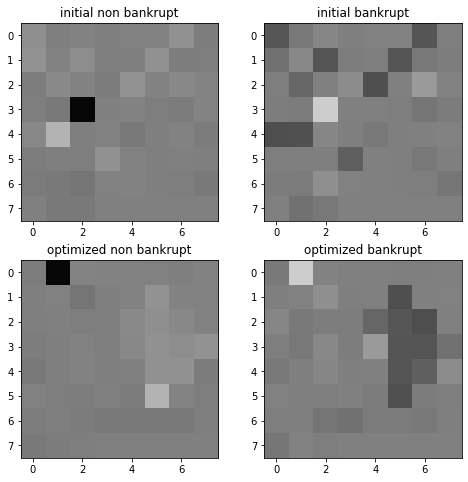

In [62]:
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_8x8, q=None, power_transform=False)
X_train_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


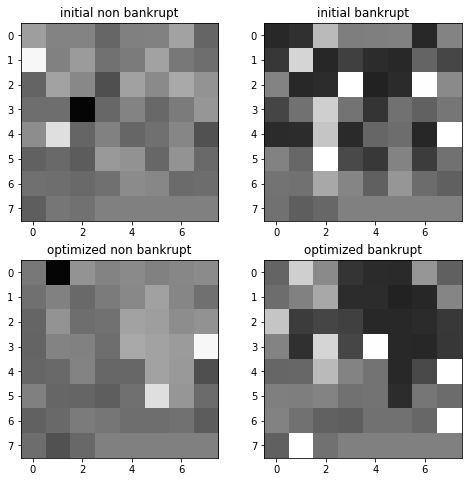

In [63]:
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_8x8, q=0.005, power_transform=False)
X_train_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

	 normalization, quantile clipping and power transform


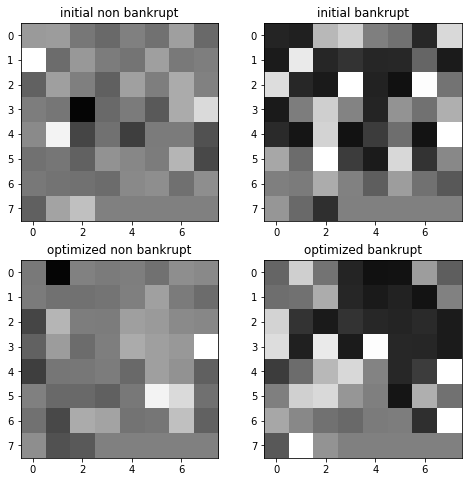

In [64]:
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_8x8, q=0.005, power_transform=True)
X_train_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t normalization, quantile clipping and power transform")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [88]:
# ----- vector to image conversion -----
# training set
X_train_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_train_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_8x8_norm_clip_pt.shape[0])])
X_train_CNN_8x8_norm_clip_pt = X_train_CNN_8x8_norm_clip_pt.reshape(X_train_CNN_8x8_norm_clip_pt.shape+(1,))
Y_train_CNN_8x8_norm_clip_pt = Y_train_CNN_8x8.values
# validation set
X_test_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_test_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_8x8_norm_clip_pt.shape[0])])
X_test_CNN_8x8_norm_clip_pt = X_test_CNN_8x8_norm_clip_pt.reshape(X_test_CNN_8x8_norm_clip_pt.shape+(1,))
Y_test_CNN_8x8_norm_clip_pt = Y_test_CNN_8x8.values

# ----- CNN training -----
modelCNN = define_CNN_L2(input_shape=X_train_CNN_8x8_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN_8x8_norm_clip_pt,
                                        Y_train=Y_train_CNN_8x8_norm_clip_pt,
                                        X_val=None, Y_val=None, n_epochs=112,
                                        batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\3year\CNN_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN, historyCNN,
                                                                 modelCNN.get_weights()])), fp)

Train on 9452 samples
Epoch: 1/112,
cumulative time: 2.68s train loss: 0.23479584100018908
Epoch: 2/112,
cumulative time: 4.54s train loss: 0.22041854031866404
Epoch: 3/112,
cumulative time: 6.35s train loss: 0.20938882060188183
Epoch: 4/112,
cumulative time: 8.14s train loss: 0.20075106015724495
Epoch: 5/112,
cumulative time: 9.92s train loss: 0.20114164032637946
Epoch: 6/112,
cumulative time: 11.71s train loss: 0.19776898730030718
Epoch: 7/112,
cumulative time: 13.5s train loss: 0.19489061983772824
Epoch: 8/112,
cumulative time: 15.3s train loss: 0.19172312118746798
Epoch: 9/112,
cumulative time: 17.13s train loss: 0.19012150175670825
Epoch: 10/112,
cumulative time: 18.93s train loss: 0.1873440570747807
Epoch: 11/112,
cumulative time: 20.74s train loss: 0.18539542459831165
Epoch: 12/112,
cumulative time: 22.57s train loss: 0.18209635658671278
Epoch: 13/112,
cumulative time: 24.38s train loss: 0.17951422327379782
Epoch: 14/112,
cumulative time: 26.21s train loss: 0.17751442610750853
E

In [66]:
# LOADING CNN
with open(r"results\3year\CNN_8x8_production.p", "rb") as fp:
    CNN_8x8_dict = pickle.load(fp)

CNN_8x8 = CNN_8x8_dict["model"]
historyCNN_8x8 = CNN_8x8_dict["history"]

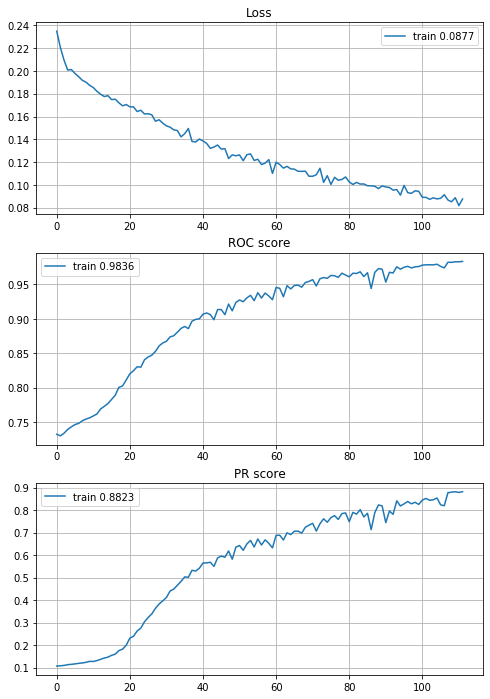

In [79]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_8x8["train_loss"], "-", label="train {}".format(round(historyCNN_8x8["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_8x8["train_roc"], label="train {}".format(round(historyCNN_8x8["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_8x8["train_pr"], label="train {}".format(round(historyCNN_8x8["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 20x20 input Convolutional Neural Network

In [99]:
# training draft for CNN 20x20 input
# loading data
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN=train_set_imp[target].copy()
X_test_CNN=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN=test_set_imp[target].copy()

features_20x20=X_train_CNN.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_20x20=X_train_CNN[Y_train_CNN==0].corr(method="spearman")
# draft inicialization
draft_20x20_ini=image_draft_inicialization(features_20x20, random_state)
# quasi optimization
draft_20x20_opt=MC_Energy_optimization(corr_matrix=corr_matrix_20x20, draft=draft_20x20_ini, alpha=3, n_eval=100,
                                       random_state=random_state)
# transform draft dictionary to matrix
draft_20x20_ini=image_dict_to_matrix(draft_20x20_ini)
draft_20x20_opt=image_dict_to_matrix(draft_20x20_opt)

# SAVING
with open(r"data\3year_data\drafts_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_20x20_ini, draft_20x20_opt])), fp)

initial image energy: 2859849.6086
iteration: 100
current energy: 2771131.1964
iteration: 200
current energy: 2702209.6794
iteration: 300
current energy: 2642645.6326
iteration: 400
current energy: 2576077.6337
iteration: 500
current energy: 2512418.2915
iteration: 600
current energy: 2471288.9046
iteration: 700
current energy: 2435465.5346
iteration: 800
current energy: 2395629.5914
iteration: 900
current energy: 2361934.3104
iteration: 1000
current energy: 2333960.6087
iteration: 1100
current energy: 2320119.7441
iteration: 1200
current energy: 2287433.3649
iteration: 1300
current energy: 2250693.7542
iteration: 1400
current energy: 2240549.2052
iteration: 1500
current energy: 2217360.3205
iteration: 1600
current energy: 2206349.591
iteration: 1700
current energy: 2193736.3447
iteration: 1800
current energy: 2181501.559
iteration: 1900
current energy: 2165558.852
iteration: 2000
current energy: 2147453.9385
iteration: 2100
current energy: 2133337.7966
iteration: 2200
current energy: 

In [67]:
# loading 20x20 drafts
with open(r"data\3year_data\drafts_20x20_production.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

draft_20x20_opt=drafts_20x20["optimized"]
draft_20x20_ini=drafts_20x20["initial"]

			 standarization only


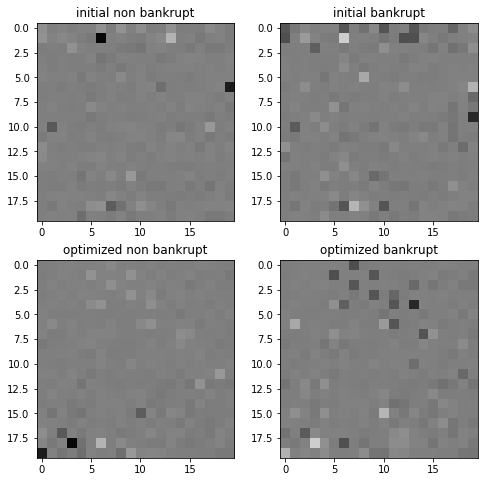

In [68]:
# loading data
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_20x20, q=None, power_transform=False)
X_train_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


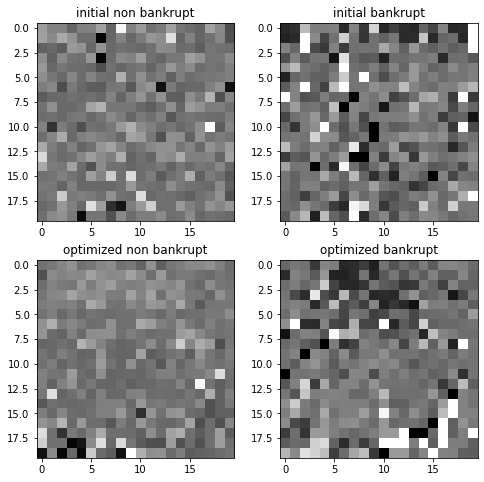

In [69]:
# loading data
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_20x20, q=0.005, power_transform=False)
X_train_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


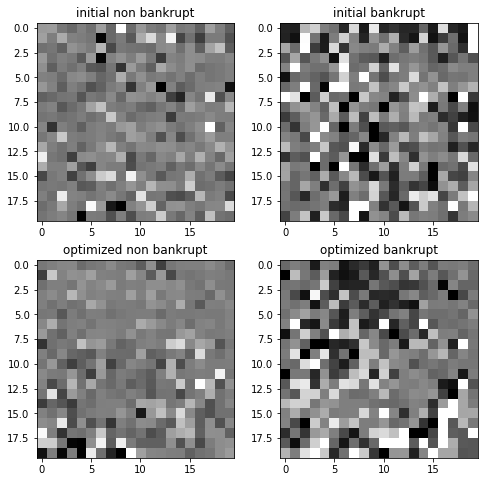

In [70]:
# loading data
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [105]:
# loading data
with open(r"data\3year_data\train_test_imp_sets_3year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)


# ----- vector to image conversion -----
# training set
X_train_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_train_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_20x20_norm_clip_pt.shape[0])])
X_train_CNN_20x20_norm_clip_pt = X_train_CNN_20x20_norm_clip_pt.reshape(X_train_CNN_20x20_norm_clip_pt.shape+(1,))
Y_train_CNN_20x20_norm_clip_pt = Y_train_CNN_20x20.values

# validation set
X_test_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_test_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_20x20_norm_clip_pt.shape[0])])
X_test_CNN_20x20_norm_clip_pt = X_test_CNN_20x20_norm_clip_pt.reshape(X_test_CNN_20x20_norm_clip_pt.shape+(1,))
Y_test_CNN_20x20_norm_clip_pt = Y_test_CNN_20x20.values

# ----- CNN training -----
modelCNN_20x20 = define_CNN_L2(input_shape=X_train_CNN_20x20_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN_20x20, historyCNN_20x20 = network_training(network=modelCNN_20x20, X_train=X_train_CNN_20x20_norm_clip_pt,
                                                    Y_train=Y_train_CNN_20x20_norm_clip_pt,
                                                    X_val=None, Y_val=None, n_epochs=154,
                                                    batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\3year\CNN_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN_20x20, historyCNN_20x20,
                                                                 modelCNN_20x20.get_weights()])), fp)

Train on 9452 samples
Epoch: 1/154,
cumulative time: 9.87s train loss: 0.2422746532690056
Epoch: 2/154,
cumulative time: 19.76s train loss: 0.22102129130206066
Epoch: 3/154,
cumulative time: 29.79s train loss: 0.2129618649639369
Epoch: 4/154,
cumulative time: 39.39s train loss: 0.2034922764525038
Epoch: 5/154,
cumulative time: 48.77s train loss: 0.20012063573111027
Epoch: 6/154,
cumulative time: 58.15s train loss: 0.1958517315330467
Epoch: 7/154,
cumulative time: 67.34s train loss: 0.19210962284635397
Epoch: 8/154,
cumulative time: 76.67s train loss: 0.18822418129007745
Epoch: 9/154,
cumulative time: 85.84s train loss: 0.1853524108200168
Epoch: 10/154,
cumulative time: 94.32s train loss: 0.18252095859773676
Epoch: 11/154,
cumulative time: 103.26s train loss: 0.17947150061834782
Epoch: 12/154,
cumulative time: 111.68s train loss: 0.17506489580338708
Epoch: 13/154,
cumulative time: 120.04s train loss: 0.17254691748196826
Epoch: 14/154,
cumulative time: 128.43s train loss: 0.1678327836042

Epoch: 115/154,
cumulative time: 966.37s train loss: 0.045841293323152885
Epoch: 116/154,
cumulative time: 974.42s train loss: 0.04629673835377268
Epoch: 117/154,
cumulative time: 982.49s train loss: 0.040004365595071006
Epoch: 118/154,
cumulative time: 990.39s train loss: 0.06199226217085067
Epoch: 119/154,
cumulative time: 998.39s train loss: 0.031851847104687234
Epoch: 120/154,
cumulative time: 1006.39s train loss: 0.038789327711992554
Epoch: 121/154,
cumulative time: 1014.36s train loss: 0.045600930129903454
Epoch: 122/154,
cumulative time: 1022.38s train loss: 0.047841670887463564
Epoch: 123/154,
cumulative time: 1030.35s train loss: 0.04139848831856573
Epoch: 124/154,
cumulative time: 1038.34s train loss: 0.050884163217209954
Epoch: 125/154,
cumulative time: 1046.42s train loss: 0.027912863409221552
Epoch: 126/154,
cumulative time: 1054.53s train loss: 0.048306772510993676
Epoch: 127/154,
cumulative time: 1062.58s train loss: 0.035762302147108675
Epoch: 128/154,
cumulative time: 

In [72]:
# LOADING CNN
with open(r"results\3year\CNN_20x20_production.p", "rb") as fp:
    CNN_20x20_dict = pickle.load(fp)

CNN_20x20 = CNN_20x20_dict["model"]
historyCNN_20x20 = CNN_20x20_dict["history"]

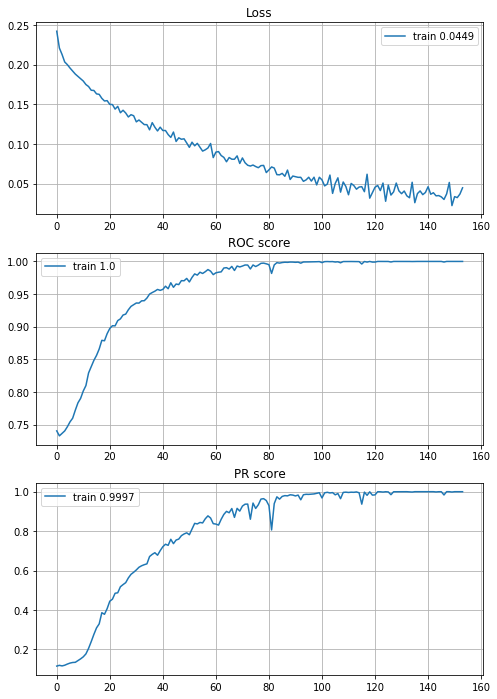

In [86]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_20x20["train_loss"], "-", label="train {}".format(round(historyCNN_20x20["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_20x20["train_roc"], label="train {}".format(round(historyCNN_20x20["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_20x20["train_pr"], label="train {}".format(round(historyCNN_20x20["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

##### "Production" results

In [73]:
# Logistic Regression
Logit_train_probs = Logit.predict(exog=X_train_norm_clip_pt)
Logit_test_probs = Logit.predict(exog=X_test_norm_clip_pt)

Logit_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)
Logit_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)

(Logit_train_roc, Logit_test_roc, Logit_train_pr, Logit_test_pr)

(0.7866939945585393,
 0.6873126873126874,
 0.2872304248912394,
 0.16842048221231112)

In [74]:
# Random Forest
Random_Forest_train_probs = Random_Forest.predict_proba(X=X_train_raw)[:,1]
Random_Forest_test_probs = Random_Forest.predict_proba(X=X_test_raw)[:,1]

Random_Forest_train_roc = roc_auc_score(y_true=Y_train_raw, y_score=Random_Forest_train_probs)
Random_Forest_test_roc = roc_auc_score(y_true=Y_test_raw, y_score=Random_Forest_test_probs)
Random_Forest_train_pr = average_precision_score(y_true=Y_train_raw, y_score=Random_Forest_train_probs)
Random_Forest_test_pr = average_precision_score(y_true=Y_test_raw, y_score=Random_Forest_test_probs)

(Random_Forest_train_roc,Random_Forest_test_roc,Random_Forest_train_pr,Random_Forest_test_pr)

(0.9966126221428278,
 0.8143456543456544,
 0.9576428166801066,
 0.27064599231710085)

In [75]:
# Extreme Gradient Boosted Decision Trees
XGBoost_train_probs = XGBoost.predict_proba(data=X_train_clip_norm)[:,1]
XGBoost_test_probs = XGBoost.predict_proba(data=X_test_clip_norm)[:,1]

XGBoost_train_roc = roc_auc_score(y_true=Y_train_clip_norm, y_score=XGBoost_train_probs)
XGBoost_test_roc = roc_auc_score(y_true=Y_test_clip_norm, y_score=XGBoost_test_probs)
XGBoost_train_pr = average_precision_score(y_true=Y_train_clip_norm, y_score=XGBoost_train_probs)
XGBoost_test_pr = average_precision_score(y_true=Y_test_clip_norm, y_score=XGBoost_test_probs)

(XGBoost_train_roc,XGBoost_test_roc,XGBoost_train_pr,XGBoost_test_pr)

(0.9998043968299313,
 0.8257742257742258,
 0.996317862520036,
 0.37822399083594077)

In [76]:
# Multilayer Percepton
Multilayer_Percepton_train_probs = Multilayer_Percepton.predict(x=X_train_norm_clip_pt.values)
Multilayer_Percepton_test_probs = Multilayer_Percepton.predict(x=X_test_norm_clip_pt.values)

Multilayer_Percepton_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)
Multilayer_Percepton_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)

(Multilayer_Percepton_train_roc,Multilayer_Percepton_test_roc,Multilayer_Percepton_train_pr,Multilayer_Percepton_test_pr)

(0.9988036770402047,
 0.9113086913086912,
 0.9816512009209009,
 0.6348375372220949)

In [77]:
# CNN 8x8
CNN_8x8_train_probs = CNN_8x8.predict(x=X_train_CNN_8x8_norm_clip_pt)
CNN_8x8_test_probs = CNN_8x8.predict(x=X_test_CNN_8x8_norm_clip_pt)

CNN_8x8_train_roc = roc_auc_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_roc = roc_auc_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)
CNN_8x8_train_pr = average_precision_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_pr = average_precision_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)

(CNN_8x8_train_roc,CNN_8x8_test_roc,CNN_8x8_train_pr,CNN_8x8_test_pr)

(0.9835784402393644,
 0.8233366633366633,
 0.8822998652118024,
 0.42914879584175764)

In [78]:
# CNN 20x20
CNN_20x20_train_probs = CNN_20x20.predict(x=X_train_CNN_20x20_norm_clip_pt)
CNN_20x20_test_probs = CNN_20x20.predict(x=X_test_CNN_20x20_norm_clip_pt)

CNN_20x20_train_roc = roc_auc_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_roc = roc_auc_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)
CNN_20x20_train_pr = average_precision_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_pr = average_precision_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)

(CNN_20x20_train_roc,CNN_20x20_test_roc,CNN_20x20_train_pr,CNN_20x20_test_pr)

(0.9999839076473604,
 0.7968531468531469,
 0.9996707189823295,
 0.40002082092555613)

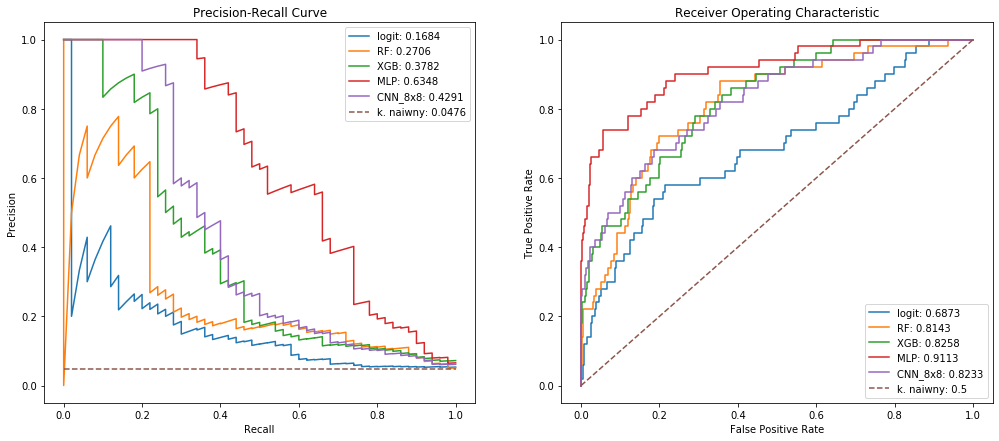

In [81]:
fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(17,7))

logit_precision, logit_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Logit_test_probs)
logit_fpr, logit_tpr, _ = roc_curve(Y_test_norm_clip_pt, Logit_test_probs)

rf_precision, rf_recall, _ = precision_recall_curve(Y_test_raw, Random_Forest_test_probs)
rf_fpr, rf_tpr, _ = roc_curve(Y_test_raw, Random_Forest_test_probs)

xgb_precision, xgb_recall, _ = precision_recall_curve(Y_test_clip_norm, XGBoost_test_probs)
xgb_fpr, xgb_tpr, _ = roc_curve(Y_test_clip_norm, XGBoost_test_probs)

mlp_precision, mlp_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)
mlp_fpr, mlp_tpr, _ = roc_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)

# cnn_20x20_precision, cnn_20x20_recall, _ = precision_recall_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)
# cnn_20x20_fpr, cnn_20x20_tpr, _ = roc_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)

cnn_8x8_precision, cnn_8x8_recall, _ = precision_recall_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)
cnn_8x8_fpr, cnn_8x8_tpr, _ = roc_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)


noskill_probs = [1 for i in range(Y_test.shape[0])]
noskill_fpr, noskill_tpr, _ = roc_curve(Y_test, noskill_probs)
noskill_precision = Y_test[Y_test==1].shape[0]/Y_test.shape[0]
# precision=(TP)/(TP+FP), when y_hat=1 always => TP+FP = n_obs => precision = TP/(n_obs)
# recall = (TP)/(TP+FN), when y_hat=1 always => FN=0 =? TP+FN=TP => recall=TP/TP=1

# ----- PLOTS -----
ax[0].plot(logit_recall, logit_precision, label= "logit: {}".format(round(Logit_test_pr,4)))
ax[0].plot(rf_recall, rf_precision, label= "RF: {}".format(round(Random_Forest_test_pr,4)))
ax[0].plot(xgb_recall, xgb_precision, label= "XGB: {}".format(round(XGBoost_test_pr,4)))
ax[0].plot(mlp_recall, mlp_precision, label= "MLP: {}".format(round(Multilayer_Percepton_test_pr,4)))
# ax[0].plot(cnn_20x20_recall, cnn_20x20_precision, label= "CNN_20x20: {}".format(round(CNN_20x20_test_pr,4)))
ax[0].plot(cnn_8x8_recall, cnn_8x8_precision, label= "CNN_8x8: {}".format(round(CNN_8x8_test_pr,4)))
ax[0].plot([0,1], [noskill_precision, noskill_precision], linestyle='--', label= "k. naiwny: {}".format(
    round(average_precision_score(Y_test, noskill_probs),4)))
ax[0].plot()
ax[0].legend()
ax[0].set_title("Precision-Recall Curve")
ax[0].set_xlabel('Recall')
ax[0].set_ylabel('Precision')


ax[1].plot(logit_fpr, logit_tpr, label="logit: {}".format(round(Logit_test_roc, 4)))
ax[1].plot(rf_fpr, rf_tpr, label="RF: {}".format(round(Random_Forest_test_roc, 4)))
ax[1].plot(xgb_fpr, xgb_tpr, label="XGB: {}".format(round(XGBoost_test_roc, 4)))
ax[1].plot(mlp_fpr, mlp_tpr, label="MLP: {}".format(round(Multilayer_Percepton_test_roc, 4)))
# ax[1].plot(cnn_20x20_fpr, cnn_20x20_tpr, label= "CNN_20x20: {}".format(round(CNN_20x20_test_roc,4)))
ax[1].plot(cnn_8x8_fpr, cnn_8x8_tpr, label= "CNN_8x8: {}".format(round(CNN_8x8_test_roc,4)))
ax[1].plot(noskill_fpr, noskill_tpr, linestyle='--', label= "k. naiwny: {}".format(
    round(roc_auc_score(Y_test, noskill_probs),4)))
ax[1].legend()
ax[1].set_title("Receiver Operating Characteristic")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')
plt.show()